# Projektarbeit - Analyse von Twitter-Posts zu Aktiengesellschaften mit Hilfe von Methoden der Textanalyse

## Autor: Oliver Dankwart
## Professor: Prof. Dr. Wolfram Höpken

In [30]:
from pprint import pprint # pretty print for testing purposes
import logging # console logging for debugging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

# data processing
import pandas as pd
import numpy as np
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
#from nltk.corpus import wordnet

# ML model related
from gensim.corpora import Dictionary
from gensim.models import LdaModel
from gensim.models.coherencemodel import CoherenceModel
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from gensim.test.utils import datapath
from gensim import  models

#  plotting graphs
import pyLDAvis
import pyLDAvis.gensim  # important
import matplotlib.pyplot as plt

In [3]:
#load list dependencies for data preprocessing
nltk.download('stopwords') # stopwords list
nltk.download('punkt') # for tokenizing
nltk.download('wordnet') # lemmatizer
nltk.download('omw-1.4') # lemmatizer
nltk.download('averaged_perceptron_tagger') # POS-Tagging

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Oliver\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Oliver\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Oliver\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\Oliver\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Oliver\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [4]:
#setup stopwords list
stop_words = set(stopwords.words('english'))

## Data Preparation

In [5]:
# load csv files into dataframes
df_tweet = pd.read_csv('data/Tweet.csv')
df_company = pd.read_csv('data/Company.csv')
df_company_tweet = pd.read_csv('data/Company_Tweet.csv')

In [6]:
# merge Company.csv and Company_Tweet.csv into temporary dataframe
temp_company_tweet = pd.merge(df_company_tweet, df_company, on='ticker_symbol')
temp_company_tweet.info() # check result

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4336445 entries, 0 to 4336444
Data columns (total 3 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   tweet_id       int64 
 1   ticker_symbol  object
 2   company_name   object
dtypes: int64(1), object(2)
memory usage: 132.3+ MB


In [7]:
# merge all into main dataframe
tweets_main = pd.merge(temp_company_tweet, df_tweet, on='tweet_id')
tweets_main.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4336445 entries, 0 to 4336444
Data columns (total 9 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   tweet_id       int64 
 1   ticker_symbol  object
 2   company_name   object
 3   writer         object
 4   post_date      int64 
 5   body           object
 6   comment_num    int64 
 7   retweet_num    int64 
 8   like_num       int64 
dtypes: int64(5), object(4)
memory usage: 330.8+ MB


### Data Cleaning

In [8]:
# transform post_date to Datetime
tweets_main['post_date'] = pd.to_datetime(tweets_main['post_date'], unit='s')
tweets_main['post_date'].info()

<class 'pandas.core.series.Series'>
Int64Index: 4336445 entries, 0 to 4336444
Series name: post_date
Non-Null Count    Dtype         
--------------    -----         
4336445 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 66.2 MB


In [9]:
# filter for 2019 tweets
tweets_main = tweets_main[tweets_main['post_date'].dt.year==2019]

In [10]:
# filter for all tweets not Tesla
tweets_main = tweets_main[tweets_main['ticker_symbol'] != 'TSLA']

In [11]:
# drop duplicates
tweets_main = tweets_main.drop_duplicates(subset='tweet_id')
tweets_main['tweet_id'].duplicated().any()
# reset index for better data handling
tweets_main = tweets_main.reset_index(drop=True)
# check results
tweets_main.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421005 entries, 0 to 421004
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   tweet_id       421005 non-null  int64         
 1   ticker_symbol  421005 non-null  object        
 2   company_name   421005 non-null  object        
 3   writer         417582 non-null  object        
 4   post_date      421005 non-null  datetime64[ns]
 5   body           421005 non-null  object        
 6   comment_num    421005 non-null  int64         
 7   retweet_num    421005 non-null  int64         
 8   like_num       421005 non-null  int64         
dtypes: datetime64[ns](1), int64(4), object(4)
memory usage: 28.9+ MB


## Topic Detection

In [104]:
#drop all columns but tweet "body"
td_cleaned = tweets_main.drop(['tweet_id', 'ticker_symbol','company_name','writer',
                              'post_date','comment_num','retweet_num','like_num'], axis=1)

### Preprocessing for topic detection

In [105]:
# functions for topic detection preprocessing
def removeSpecialChars(tweet_text):
    tweet_text =re.sub(r'\bRT\b', '', tweet_text) #remove RT (Retweet)
    tweet_text = re.sub(r'http\S+', '', tweet_text) #remove URLS
    tweet_text = re.sub(r'[$]\w+', '', tweet_text) # remove stock ticker e.g. $AAPL
    tweet_text = re.sub(r'^#\s|#\'|\s# ', 'number', tweet_text) #replace # with "number"
    tweet_text = re.sub(r'[0-9]', '', tweet_text) #remove numbers
    tweet_text = re.sub(r'[^\w\s\']', '', tweet_text)
    return tweet_text
    
def tokenizeText(tweet_text):
    tokens = word_tokenize(tweet_text) # tokenize each word
    return tokens

def posTagging(tokens):
    pos_tokens = nltk.pos_tag(tokens) # set POS tag for each token in a tweet
    return pos_tokens

def removeStopwords(tokens):
    filtered_tokens = []
    #filtered_tokens = [token for token in tokens if not token.lower() in stop_words]
    tagged_tokens = posTagging(tokens)
    #remove all word types that are not nouns and verbs and N and V that are on stopword list 
    for word, tag in tagged_tokens:
        if tag.startswith('N') or tag.startswith('V'):
            if word.lower() in stop_words:
                continue
            else:
                filtered_tokens.append(word)
        else:
            if word.lower() in stop_words:
                continue
    return filtered_tokens

def lemmatizeText(tokens):
    lemmatizer = WordNetLemmatizer()
    lemmatized_tokens = []
    for token, pos in tokens:
        if pos.startswith('V'):
            lemma = lemmatizer.lemmatize(token, pos='v')
        elif pos.startswith('J'):
            lemma = lemmatizer.lemmatize(token, pos='a')
        elif pos.startswith('R'):
            lemma = lemmatizer.lemmatize(token, pos='r')
        else:
            lemma = lemmatizer.lemmatize(token)
        lemmatized_tokens.append(lemma)
    return lemmatized_tokens

def lowercasingText(tweet_text):
    lowercased_text = [tweet.lower() for tweet in tweet_text]
    return lowercased_text #lowercasing
    

In [106]:
td_cleaned['body'] = td_cleaned['body'].apply(removeSpecialChars) # remove chars

td_cleaned['tokens'] = td_cleaned['body'].apply(tokenizeText) # tokenize and copy to new column

td_cleaned['pos_tagged_tokens'] = td_cleaned['tokens'].apply(posTagging) # POS-Tagging new column


td_cleaned['lemmatized_tokens'] = td_cleaned['pos_tagged_tokens'].apply(lemmatizeText) # lemmatize

td_cleaned['filtered_tokens'] = td_cleaned['lemmatized_tokens'].apply(removeStopwords) # remove stopwords

td_cleaned['filtered_tokens'] = td_cleaned['filtered_tokens'].apply(lowercasingText) # lowercasing

td_cleaned.head(10) # check results


Remove Special Chars: 5.783965826034546 seconds
Tokenize: 34.1117947101593 seconds
POS-Tagging: 681.1289410591125 seconds
Lemmatizing: 22.395232439041138 seconds
Remove Stopwords: 699.1679329872131 seconds
Lowercase: 0.6535606384277344 seconds


,body,tokens,pos_tagged_tokens,lemmatized_tokens,filtered_tokens
0,In I plan to mock the TrumpTrain relentlessly Also stupid people who believe uneducated Hannity Jimmy Kimmel Chuck Todd Rush Limbaugh Charlie Kirk When the time comes I'll mock Jim Cramer for his possibly version of his Bear Sterns idiocy,"[In, I, plan, to, mock, the, TrumpTrain, relentlessly, Also, stupid, people, who, believe, uneducated, Hannity, Jimmy, Kimmel, Chuck, Todd, Rush, Limbaugh, Charlie, Kirk, When, the, time, comes, I, 'll, mock, Jim, Cramer, for, his, possibly, version, of, his, Bear, Sterns, idiocy]","[(In, IN), (I, PRP), (plan, VBP), (to, TO), (mock, VB), (the, DT), (TrumpTrain, NNP), (relentlessly, RB), (Also, RB), (stupid, JJ), (people, NNS), (who, WP), (believe, VBP), (uneducated, JJ), (Hannity, NNP), (Jimmy, NNP), (Kimmel, NNP), (Chuck, NNP), (Todd, NNP), (Rush, NNP), (Limbaugh, NNP), (Charlie, NNP), (Kirk, NNP), (When, WRB), (the, DT), (time, NN), (comes, VBZ), (I, PRP), ('ll, MD), (mock, VB), (Jim, NNP), (Cramer, NNP), (for, IN), (his, PRP$), (possibly, JJ), (version, NN), (of, IN), (his, PRP$), (Bear, NNP), (Sterns, NNP), (idiocy, NN)]","[In, I, plan, to, mock, the, TrumpTrain, relentlessly, Also, stupid, people, who, believe, uneducated, Hannity, Jimmy, Kimmel, Chuck, Todd, Rush, Limbaugh, Charlie, Kirk, When, the, time, come, I, 'll, mock, Jim, Cramer, for, his, possibly, version, of, his, Bear, Sterns, idiocy]","[plan, mock, trumptrain, people, believe, hannity, jimmy, kimmel, chuck, todd, rush, limbaugh, charlie, kirk, time, come, mock, jim, cramer, version, bear, sterns, idiocy]"
1,How to upload photos into iCloud Photos from iPhone iPad Mac and icloudcom,"[How, to, upload, photos, into, iCloud, Photos, from, iPhone, iPad, Mac, and, icloudcom]","[(How, WRB), (to, TO), (upload, VB), (photos, NNS), (into, IN), (iCloud, JJ), (Photos, NNP), (from, IN), (iPhone, NN), (iPad, NN), (Mac, NNP), (and, CC), (icloudcom, VB)]","[How, to, upload, photo, into, iCloud, Photos, from, iPhone, iPad, Mac, and, icloudcom]","[upload, photo, photos, iphone, ipad, mac, icloudcom]"
2,settled at and that made for a second blackfail candle which leans st bearish if only for the Wednesday open Note the dma will be around gap zone next week,"[settled, at, and, that, made, for, a, second, blackfail, candle, which, leans, st, bearish, if, only, for, the, Wednesday, open, Note, the, dma, will, be, around, gap, zone, next, week]","[(settled, VBN), (at, IN), (and, CC), (that, IN), (made, VBD), (for, IN), (a, DT), (second, JJ), (blackfail, NN), (candle, NN), (which, WDT), (leans, VBZ), (st, JJ), (bearish, JJ), (if, IN), (only, RB), (for, IN), (the, DT), (Wednesday, NNP), (open, JJ), (Note, NNP), (the, DT), (dma, NN), (will, MD), (be, VB), (around, IN), (gap, NN), (zone, NN), (next, JJ), (week, NN)]","[settle, at, and, that, make, for, a, second, blackfail, candle, which, lean, st, bearish, if, only, for, the, Wednesday, open, Note, the, dma, will, be, around, gap, zone, next, week]","[settle, make, blackfail, candle, st, bearish, wednesday, note, dma, gap, zone, week]"
3,is in Parabolic SAR Breakout winning in the past,"[is, in, Parabolic, SAR, Breakout, winning, in, the, past]","[(is, VBZ), (in, IN), (Parabolic, NNP), (SAR, NNP), (Breakout, NNP), (winning, VBG), (in, IN), (the, DT), (past, NN)]","[be, in, Parabolic, SAR, Breakout, win, in, the, past]","[parabolic, sar, breakout, win, past]"
4,Join RobinhoodApp and we'll both get a stock like or for free Make sure to use my link,"[Join, RobinhoodApp, and, we, 'll, both, get, a, stock, like, or, for, free, Make, sure, to, use, my, link]","[(Join, NNP), (RobinhoodApp, NNP), (and, CC), (we, PRP), ('ll, MD), (both, DT), (get, VB), (a, DT), (stock, NN), (like, IN), (or, CC), (for, IN), (free, JJ), (Make, NNP), (sure, NN), (to, TO), (use, VB), (my, PRP$), (link, NN)]","[Join, RobinhoodApp, and, we, 'll, both, get, a, stock, like, or, for, free, Make, sure, to, use, my, link]","[join, robinhoodapp, get, stock, make, sure, 

In [89]:
# save cleaned data column to csv for data loss preventing
# enable if necessary
# td_cleaned.to_csv("data/td_cleaned.csv", index= False)
# td_cleaned["filtered_tokens"].to_csv("data/td_cleaned_filtered.csv", index= False)

In [90]:
# import cleaned data from csv
# enable if necessary
# td_cleaned = pd.read_csv("data/td_cleaned.csv")

,body,tokens,pos_tagged_tokens,lemmatized_tokens,filtered_tokens
0,In I plan to mock the TrumpTrain relentlessly Also stupid people who believe uneducated Hannity Jimmy Kimmel Chuck Todd Rush Limbaugh Charlie Kirk When the time comes I'll mock Jim Cramer for his possibly version of his Bear Sterns idiocy,"['In', 'I', 'plan', 'to', 'mock', 'the', 'TrumpTrain', 'relentlessly', 'Also', 'stupid', 'people', 'who', 'believe', 'uneducated', 'Hannity', 'Jimmy', 'Kimmel', 'Chuck', 'Todd', 'Rush', 'Limbaugh', 'Charlie', 'Kirk', 'When', 'the', 'time', 'comes', 'I', ""'ll"", 'mock', 'Jim', 'Cramer', 'for', 'his', 'possibly', 'version', 'of', 'his', 'Bear', 'Sterns', 'idiocy']","[('In', 'IN'), ('I', 'PRP'), ('plan', 'VBP'), ('to', 'TO'), ('mock', 'VB'), ('the', 'DT'), ('TrumpTrain', 'NNP'), ('relentlessly', 'RB'), ('Also', 'RB'), ('stupid', 'JJ'), ('people', 'NNS'), ('who', 'WP'), ('believe', 'VBP'), ('uneducated', 'JJ'), ('Hannity', 'NNP'), ('Jimmy', 'NNP'), ('Kimmel', 'NNP'), ('Chuck', 'NNP'), ('Todd', 'NNP'), ('Rush', 'NNP'), ('Limbaugh', 'NNP'), ('Charlie', 'NNP'), ('Kirk', 'NNP'), ('When', 'WRB'), ('the', 'DT'), ('time', 'NN'), ('comes', 'VBZ'), ('I', 'PRP'), (""'ll"", 'MD'), ('mock', 'VB'), ('Jim', 'NNP'), ('Cramer', 'NNP'), ('for', 'IN'), ('his', 'PRP$'), ('possibly', 'JJ'), ('version', 'NN'), ('of', 'IN'), ('his', 'PRP$'), ('Bear', 'NNP'), ('Sterns', 'NNP'), ('idiocy', 'NN')]","['In', 'I', 'plan', 'to', 'mock', 'the', 'TrumpTrain', 'relentlessly', 'Also', 'stupid', 'people', 'who', 'believe', 'uneducated', 'Hannity', 'Jimmy', 'Kimmel', 'Chuck', 'Todd', 'Rush', 'Limbaugh', 'Charlie', 'Kirk', 'When', 'the', 'time', 'come', 'I', ""'ll"", 'mock', 'Jim', 'Cramer', 'for', 'his', 'possibly', 'version', 'of', 'his', 'Bear', 'Sterns', 'idiocy']","['plan', 'mock', 'trumptrain', 'people', 'believe', 'hannity', 'jimmy', 'kimmel', 'chuck', 'todd', 'rush', 'limbaugh', 'charlie', 'kirk', 'time', 'come', 'mock', 'jim', 'cramer', 'version', 'bear', 'sterns', 'idiocy']"
1,How to upload photos into iCloud Photos from iPhone iPad Mac and icloudcom,"['How', 'to', 'upload', 'photos', 'into', 'iCloud', 'Photos', 'from', 'iPhone', 'iPad', 'Mac', 'and', 'icloudcom']","[('How', 'WRB'), ('to', 'TO'), ('upload', 'VB'), ('photos', 'NNS'), ('into', 'IN'), ('iCloud', 'JJ'), ('Photos', 'NNP'), ('from', 'IN'), ('iPhone', 'NN'), ('iPad', 'NN'), ('Mac', 'NNP'), ('and', 'CC'), ('icloudcom', 'VB')]","['How', 'to', 'upload', 'photo', 'into', 'iCloud', 'Photos', 'from', 'iPhone', 'iPad', 'Mac', 'and', 'icloudcom']","['upload', 'photo', 'photos', 'iphone', 'ipad', 'mac', 'icloudcom']"
2,settled at and that made for a second blackfail candle which leans st bearish if only for the Wednesday open Note the dma will be around gap zone next week,"['settled', 'at', 'and', 'that', 'made', 'for', 'a', 'second', 'blackfail', 'candle', 'which', 'leans', 'st', 'bearish', 'if', 'only', 'for', 'the', 'Wednesday', 'open', 'Note', 'the', 'dma', 'will', 'be', 'around', 'gap', 'zone', 'next', 'week']","[('settled', 'VBN'), ('at', 'IN'), ('and', 'CC'), ('that', 'IN'), ('made', 'VBD'), ('for', 'IN'), ('a', 'DT'), ('second', 'JJ'), ('blackfail', 'NN'), ('candle', 'NN'), ('which', 'WDT'), ('leans', 'VBZ'), ('st', 'JJ'), ('bearish', 'JJ'), ('if', 'IN'), ('only', 'RB'), ('for', 'IN'), ('the', 'DT'), ('Wednesday', 'NNP'), ('open', 'JJ'), ('Note', 'NNP'), ('the', 'DT'), ('dma', 'NN'), ('will', 'MD'), ('be', 'VB'), ('around', 'IN'), ('gap', 'NN'), ('zone', 'NN'), ('next', 'JJ'), ('week', 'NN')]","['settle', 'at', 'and', 'that', 'make', 'for', 'a', 'second', 'blackfail', 'candle', 'which', 'lean', 'st', 'bearish', 'if', 'only', 'for', 'the', 'Wednesday', 'open', 'Note', 'the', 'dma', 'will', 'be', 'around', 'gap', 'zone', 'next', 'week']","['settle', 'make', 'blackfail', 'candle', 'st', 'bearish', 'wednesday', 'note', 'dma', 'gap', 'zone', 'week']"
3,is in Parabolic SAR Breakout winning in the past,"['is', 'in', 'Parabolic', 'SAR', 'Breakout', 'winning', 'in', 'the', 'past']","[('is', 'VBZ'), ('in'

### Dictionary and Bag of words for LDA

In [169]:
# create dictionary for LDA
td_prepped = td_cleaned['filtered_tokens'].copy()
#td_prepped.head()
dictionary = Dictionary(td_prepped)
dictionary.filter_extremes(no_below=5, no_above=1) # filter all words that appear less than 5 times
print(dictionary)

2023-02-28 17:23:25,120 : INFO : adding document #0 to Dictionary(0 unique tokens: [])
2023-02-28 17:23:25,224 : INFO : adding document #10000 to Dictionary(10338 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,330 : INFO : adding document #20000 to Dictionary(15906 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,438 : INFO : adding document #30000 to Dictionary(20369 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,548 : INFO : adding document #40000 to Dictionary(23992 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,657 : INFO : adding document #50000 to Dictionary(27024 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,765 : INFO : adding document #60000 to Dictionary(30016 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)
2023-02-28 17:23:25,866 : INFO : adding document #70000

Dictionary(22880 unique tokens: ['bear', 'believe', 'charlie', 'chuck', 'come']...)


In [170]:
# create corpus
# if data rate limit error appears, start jupyter via anaconda prompt with: 
# jupyter notebook --NotebookApp.iopub\_data\_rate\_limit=1.0e10
corpus = [dictionary.doc2bow(tweets) for tweets in td_prepped]

### Optimize model

In [118]:
# WARNING: optimizeModel takes more than 4 hourse to process!
# function for optimizing number of topics, alpha and beta
def optimizeModel(dictionary, corpus, tweets, start_topics, end_topics, steps, a_values, e_values):   
    model_results = {
        'Topic_Model':[],
        'Topic_no':[],
        'Alpha':[],
        'Eta':[],
        'Coherence':[],
        'Perplexity':[]     
    }
    # for k topics with a alpha and b beta (eta)
    for topics_k in range(start_topics, end_topics, steps):              
        for a in a_values:
            for e in e_values:
                lda_model_opt = LdaModel(corpus=corpus, 
                                         num_topics=topics_k, 
                                         id2word=dictionary, 
                                         alpha=a, eta=e, 
                                         random_state=16) # train model; set random_state for replicability
        
                model_results['Topic_Model'].append(lda_model_opt) # save model in results dataframe
                #save parameters in results dataframe
                model_results['Topic_no'].append(topics_k)
                model_results['Alpha'].append(a)
                model_results['Eta'].append(e)
                # calc coherence and save
                coherencemodel = CoherenceModel(model=lda_model_opt, texts=tweets, dictionary=dictionary, coherence='c_v')
                model_results['Coherence'].append(coherencemodel.get_coherence())
                # calc log perplexity 
                model_results['Perplexity'].append(lda_model_opt.log_perplexity(corpus))
    return model_results  

In [120]:
# values for optimization
a_values = ['symmetric', 'asymmetric', 'auto']
e_values = ['symmetric', 'auto']
start_topics=6
end_topics=32
step_per_topic=2

model_results= optimizeModel(dictionary=dictionary,
                             corpus=corpus,
                             tweets=td_prepped,
                             start_topics=start_topics,
                             end_topics=end_topics, 
                             steps=step_per_topic, 
                             a_values=a_values,
                             e_values=e_values)

2023-02-27 19:24:25,223 : INFO : using symmetric alpha at 0.16666666666666666
2023-02-27 19:24:25,224 : INFO : using symmetric eta at 0.16666666666666666
2023-02-27 19:24:25,241 : INFO : using serial LDA version on this node
2023-02-27 19:24:25,300 : INFO : running online (single-pass) LDA training, 6 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating perplexity every 20000 documents, iterating 50x with a convergence threshold of 0.001000
2023-02-27 19:24:25,300 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 19:24:26,046 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:26,076 : INFO : topic #0 (0.167): 0.037*"apple" + 0.020*"be" + 0.013*"stock" + 0.013*"hour" + 0.011*"cook" + 0.010*"company" + 0.009*"market" + 0.009*"say" + 0.009*"day" + 0.008*"get"
2023-02-27 19:24:26,077 : INFO : topic #1 (0.167): 0.027*"apple" + 0.026*"be" + 0.013*"trade" + 0.012*"market" + 

2023-02-27 19:24:29,192 : INFO : topic #5 (0.167): 0.032*"be" + 0.024*"iphone" + 0.024*"apple" + 0.017*"china" + 0.013*"'s" + 0.012*"price" + 0.011*"samsung" + 0.010*"cut" + 0.008*"have" + 0.008*"market"
2023-02-27 19:24:29,193 : INFO : topic #1 (0.167): 0.022*"be" + 0.020*"market" + 0.018*"today" + 0.018*"apple" + 0.017*"day" + 0.015*"trade" + 0.011*"stock" + 0.010*"see" + 0.009*"profit" + 0.009*"move"
2023-02-27 19:24:29,195 : INFO : topic #0 (0.167): 0.079*"apple" + 0.017*"'s" + 0.017*"cook" + 0.015*"be" + 0.014*"tim" + 0.012*"stock" + 0.010*"market" + 0.010*"ceo" + 0.010*"watch" + 0.009*"day"
2023-02-27 19:24:29,196 : INFO : topic #3 (0.167): 0.079*"stock" + 0.060*"get" + 0.058*"make" + 0.054*"use" + 0.050*"join" + 0.050*"link" + 0.050*"sure" + 0.049*"robinhoodapp" + 0.042*"free" + 0.028*"like"
2023-02-27 19:24:29,198 : INFO : topic #2 (0.167): 0.039*"option" + 0.018*"call" + 0.017*"trade" + 0.017*"apple" + 0.015*"jan" + 0.013*"tech" + 0.013*"patent" + 0.012*"research" + 0.011*"ip"

2023-02-27 19:24:31,958 : INFO : topic #4 (0.167): 0.046*"be" + 0.020*"earnings" + 0.020*"buy" + 0.014*"go" + 0.011*"have" + 0.010*"see" + 0.010*"market" + 0.009*"look" + 0.009*"think" + 0.009*"today"
2023-02-27 19:24:31,959 : INFO : topic #1 (0.167): 0.034*"holding" + 0.026*"day" + 0.018*"market" + 0.015*"trade" + 0.014*"profit" + 0.014*"trading" + 0.013*"holder" + 0.013*"team" + 0.011*"today" + 0.010*"be"
2023-02-27 19:24:31,961 : INFO : topic #5 (0.167): 0.039*"apple" + 0.022*"iphone" + 0.020*"be" + 0.017*"china" + 0.014*"q" + 0.013*"revenue" + 0.012*"price" + 0.012*"earnings" + 0.012*"b" + 0.012*"'s"
2023-02-27 19:24:31,963 : INFO : topic diff=0.112903, rho=0.277350
2023-02-27 19:24:31,964 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 19:24:32,314 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:32,343 : INFO : topic #3 (0.167): 0.098*"stock" + 0.067*"get" + 0.066*"make" + 0.060*"use" + 0.057*"sure" + 0.056*"join" + 0.

2023-02-27 19:24:34,052 : INFO : topic diff=0.072187, rho=0.229416
2023-02-27 19:24:34,486 : INFO : -7.702 per-word bound, 208.2 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 19:24:34,486 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 19:24:34,779 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:34,808 : INFO : topic #2 (0.167): 0.046*"position" + 0.032*"million" + 0.029*"management" + 0.026*"option" + 0.021*"decreased" + 0.018*"tech" + 0.017*"apple" + 0.016*"patent" + 0.015*"research" + 0.015*"investment"
2023-02-27 19:24:34,810 : INFO : topic #0 (0.167): 0.112*"apple" + 0.023*"value" + 0.022*"has" + 0.021*"capital" + 0.017*"lowered" + 0.016*"market" + 0.014*"share" + 0.012*"watch" + 0.011*"company" + 0.010*"'s"
2023-02-27 19:24:34,811 : INFO : topic #4 (0.167): 0.047*"be" + 0.019*"buy" + 0.013*"go" + 0.011*"have" + 0.010*"see" + 0.010*"today" + 0.010*"look" + 0.010*"earnings"

2023-02-27 19:24:36,660 : INFO : topic #1 (0.167): 0.042*"holding" + 0.022*"day" + 0.021*"trading" + 0.017*"trade" + 0.017*"holder" + 0.015*"market" + 0.013*"stock" + 0.012*"today" + 0.011*"news" + 0.010*"nasdaq"
2023-02-27 19:24:36,662 : INFO : topic #2 (0.167): 0.048*"position" + 0.037*"million" + 0.033*"management" + 0.027*"option" + 0.020*"tech" + 0.019*"decreased" + 0.019*"patent" + 0.017*"investment" + 0.017*"research" + 0.017*"apple"
2023-02-27 19:24:36,663 : INFO : topic #3 (0.167): 0.111*"stock" + 0.086*"get" + 0.085*"make" + 0.082*"use" + 0.079*"join" + 0.079*"link" + 0.078*"sure" + 0.078*"robinhoodapp" + 0.050*"free" + 0.042*"like"
2023-02-27 19:24:36,665 : INFO : topic #0 (0.167): 0.118*"apple" + 0.030*"value" + 0.026*"capital" + 0.024*"has" + 0.020*"market" + 0.019*"lowered" + 0.014*"share" + 0.014*"watch" + 0.013*"rose" + 0.013*"management"
2023-02-27 19:24:36,666 : INFO : topic #4 (0.167): 0.043*"be" + 0.015*"buy" + 0.013*"go" + 0.011*"see" + 0.011*"have" + 0.011*"market

2023-02-27 19:24:38,910 : INFO : topic #1 (0.167): 0.030*"holding" + 0.024*"trading" + 0.022*"day" + 0.015*"stock" + 0.015*"trade" + 0.015*"market" + 0.014*"today" + 0.014*"news" + 0.011*"stocks" + 0.011*"holder"
2023-02-27 19:24:38,912 : INFO : topic #3 (0.167): 0.111*"stock" + 0.090*"get" + 0.090*"make" + 0.085*"use" + 0.083*"join" + 0.082*"link" + 0.081*"sure" + 0.081*"robinhoodapp" + 0.052*"free" + 0.043*"like"
2023-02-27 19:24:38,913 : INFO : topic #5 (0.167): 0.059*"apple" + 0.018*"service" + 0.015*"'s" + 0.014*"iphone" + 0.014*"be" + 0.013*"march" + 0.011*"new" + 0.010*"video" + 0.009*"ipad" + 0.009*"tv"
2023-02-27 19:24:38,916 : INFO : topic diff=0.076803, rho=0.176777
2023-02-27 19:24:38,917 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 19:24:39,209 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:39,239 : INFO : topic #5 (0.167): 0.065*"apple" + 0.025*"service" + 0.015*"'s" + 0.015*"be" + 0.014*"tv" + 0.013*"ipho

2023-02-27 19:24:40,875 : INFO : topic diff=0.053578, rho=0.162221
2023-02-27 19:24:40,877 : INFO : PROGRESS: pass 0, at document #78000/421005
2023-02-27 19:24:41,140 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:41,169 : INFO : topic #1 (0.167): 0.027*"holding" + 0.026*"trading" + 0.020*"stock" + 0.019*"day" + 0.016*"trade" + 0.015*"news" + 0.013*"today" + 0.012*"profit" + 0.011*"market" + 0.011*"stocks"
2023-02-27 19:24:41,173 : INFO : topic #0 (0.167): 0.121*"apple" + 0.020*"value" + 0.020*"market" + 0.016*"watch" + 0.016*"capital" + 0.015*"card" + 0.015*"rose" + 0.014*"has" + 0.013*"lowered" + 0.013*"share"
2023-02-27 19:24:41,174 : INFO : topic #4 (0.167): 0.044*"be" + 0.015*"buy" + 0.012*"go" + 0.012*"today" + 0.011*"have" + 0.010*"market" + 0.009*"look" + 0.009*"week" + 0.009*"see" + 0.009*"'s"
2023-02-27 19:24:41,176 : INFO : topic #5 (0.167): 0.060*"apple" + 0.017*"iphone" + 0.016*"service" + 0.014*"'s" + 0.014*"be" + 0.011*"ne

2023-02-27 19:24:43,376 : INFO : topic #4 (0.167): 0.044*"be" + 0.015*"buy" + 0.014*"go" + 0.012*"earnings" + 0.011*"market" + 0.011*"today" + 0.011*"have" + 0.010*"week" + 0.009*"see" + 0.009*"look"
2023-02-27 19:24:43,377 : INFO : topic #1 (0.167): 0.028*"trading" + 0.025*"stock" + 0.020*"day" + 0.018*"holding" + 0.018*"trade" + 0.014*"profit" + 0.013*"news" + 0.012*"today" + 0.012*"money" + 0.011*"stockmarket"
2023-02-27 19:24:43,379 : INFO : topic #2 (0.167): 0.048*"option" + 0.028*"position" + 0.023*"patent" + 0.022*"tech" + 0.021*"management" + 0.020*"research" + 0.020*"million" + 0.019*"ip" + 0.017*"declined" + 0.016*"trade"
2023-02-27 19:24:43,381 : INFO : topic #3 (0.167): 0.111*"stock" + 0.092*"get" + 0.090*"make" + 0.086*"use" + 0.082*"join" + 0.081*"link" + 0.081*"sure" + 0.080*"robinhoodapp" + 0.058*"free" + 0.044*"like"
2023-02-27 19:24:43,383 : INFO : topic diff=0.090358, rho=0.149071
2023-02-27 19:24:43,385 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27

2023-02-27 19:24:45,534 : INFO : topic #0 (0.167): 0.094*"apple" + 0.020*"market" + 0.018*"watch" + 0.014*"share" + 0.012*"value" + 0.011*"company" + 0.010*"dow" + 0.010*"amazon" + 0.009*"stock" + 0.008*"'s"
2023-02-27 19:24:45,535 : INFO : topic #1 (0.167): 0.030*"trading" + 0.028*"stock" + 0.026*"trade" + 0.022*"optiontrading" + 0.017*"day" + 0.013*"stockmarket" + 0.013*"profit" + 0.013*"news" + 0.012*"money" + 0.012*"today"
2023-02-27 19:24:45,537 : INFO : topic diff=0.040690, rho=0.140028
2023-02-27 19:24:45,539 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 19:24:45,782 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:45,814 : INFO : topic #3 (0.167): 0.110*"stock" + 0.098*"get" + 0.096*"make" + 0.091*"use" + 0.089*"join" + 0.088*"link" + 0.087*"sure" + 0.087*"robinhoodapp" + 0.058*"free" + 0.047*"like"
2023-02-27 19:24:45,816 : INFO : topic #5 (0.167): 0.044*"apple" + 0.020*"china" + 0.019*"tradedeal" + 0.017*"q" + 0

2023-02-27 19:24:47,287 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 19:24:47,552 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:47,585 : INFO : topic #2 (0.167): 0.062*"option" + 0.029*"patent" + 0.028*"tech" + 0.025*"research" + 0.024*"ip" + 0.022*"trade" + 0.018*"swing" + 0.016*"position" + 0.010*"put" + 0.009*"today"
2023-02-27 19:24:47,586 : INFO : topic #3 (0.167): 0.110*"stock" + 0.097*"get" + 0.095*"make" + 0.089*"use" + 0.086*"join" + 0.085*"link" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.059*"free" + 0.046*"like"
2023-02-27 19:24:47,588 : INFO : topic #1 (0.167): 0.041*"trading" + 0.030*"stock" + 0.027*"trade" + 0.019*"stockmarket" + 0.015*"nasdaq" + 0.015*"money" + 0.013*"news" + 0.013*"day" + 0.012*"stocks" + 0.012*"profit"
2023-02-27 19:24:47,589 : INFO : topic #5 (0.167): 0.046*"apple" + 0.026*"china" + 0.016*"tradedeal" + 0.014*"iphone" + 0.012*"us" + 0.012*"be" + 0.012*"'s" + 0.009*"q" + 0.008*"new" + 0

2023-02-27 19:24:49,799 : INFO : topic #4 (0.167): 0.043*"be" + 0.016*"buy" + 0.013*"market" + 0.012*"go" + 0.011*"today" + 0.010*"have" + 0.009*"look" + 0.009*"day" + 0.009*"week" + 0.008*"see"
2023-02-27 19:24:49,801 : INFO : topic #1 (0.167): 0.043*"stock" + 0.038*"trading" + 0.036*"stockmarket" + 0.031*"news" + 0.022*"money" + 0.021*"trade" + 0.020*"invest" + 0.018*"daytrader" + 0.017*"stockoptions" + 0.014*"flow"
2023-02-27 19:24:49,803 : INFO : topic #3 (0.167): 0.111*"stock" + 0.084*"get" + 0.084*"make" + 0.081*"join" + 0.076*"use" + 0.071*"link" + 0.068*"sure" + 0.068*"robinhoodapp" + 0.064*"free" + 0.040*"like"
2023-02-27 19:24:49,804 : INFO : topic #5 (0.167): 0.049*"apple" + 0.025*"china" + 0.014*"iphone" + 0.012*"us" + 0.012*"'s" + 0.011*"be" + 0.009*"new" + 0.008*"pro" + 0.008*"deal" + 0.007*"tradedeal"
2023-02-27 19:24:49,806 : INFO : topic diff=0.047131, rho=0.125000
2023-02-27 19:24:49,808 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 19:24:50,070 : I

2023-02-27 19:24:52,004 : INFO : topic #0 (0.167): 0.104*"apple" + 0.024*"inc" + 0.017*"market" + 0.017*"watch" + 0.013*"tech" + 0.012*"analyst" + 0.011*"intel" + 0.010*"say" + 0.010*"amazon" + 0.010*"'s"
2023-02-27 19:24:52,005 : INFO : topic #3 (0.167): 0.113*"stock" + 0.078*"get" + 0.078*"make" + 0.069*"join" + 0.066*"use" + 0.065*"free" + 0.060*"link" + 0.056*"sure" + 0.055*"robinhoodapp" + 0.035*"like"
2023-02-27 19:24:52,008 : INFO : topic diff=0.067381, rho=0.119523
2023-02-27 19:24:52,009 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 19:24:52,265 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:52,295 : INFO : topic #4 (0.167): 0.042*"be" + 0.016*"buy" + 0.013*"market" + 0.012*"go" + 0.011*"today" + 0.010*"have" + 0.009*"day" + 0.009*"look" + 0.009*"see" + 0.009*"week"
2023-02-27 19:24:52,297 : INFO : topic #1 (0.167): 0.044*"stock" + 0.038*"trading" + 0.032*"stockmarket" + 0.026*"news" + 0.018*"trade" + 0.018*"mo

2023-02-27 19:24:54,028 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:54,060 : INFO : topic #5 (0.167): 0.045*"apple" + 0.022*"china" + 0.016*"tradedeal" + 0.015*"iphone" + 0.012*"earnings" + 0.010*"us" + 0.010*"'s" + 0.010*"be" + 0.009*"new" + 0.008*"report"
2023-02-27 19:24:54,061 : INFO : topic #2 (0.167): 0.087*"option" + 0.033*"stocktrading" + 0.028*"patent" + 0.026*"tech" + 0.025*"research" + 0.024*"ip" + 0.022*"trade" + 0.019*"swing" + 0.014*"call" + 0.011*"today"
2023-02-27 19:24:54,063 : INFO : topic #1 (0.167): 0.049*"stock" + 0.035*"stockmarket" + 0.034*"news" + 0.029*"trading" + 0.019*"daytrader" + 0.018*"stockoptions" + 0.018*"trade" + 0.016*"stocks" + 0.016*"webull" + 0.015*"money"
2023-02-27 19:24:54,065 : INFO : topic #0 (0.167): 0.092*"apple" + 0.023*"inc" + 0.015*"market" + 0.015*"card" + 0.014*"watch" + 0.012*"trump" + 0.011*"us" + 0.010*"tariff" + 0.010*"say" + 0.010*"tech"
2023-02-27 19:24:54,067 : INFO : topic #3 (0

2023-02-27 19:24:56,240 : INFO : topic #5 (0.167): 0.051*"apple" + 0.029*"iphone" + 0.016*"tradedeal" + 0.016*"china" + 0.013*"new" + 0.012*"tv" + 0.011*"'s" + 0.010*"be" + 0.009*"service" + 0.009*"us"
2023-02-27 19:24:56,242 : INFO : topic #4 (0.167): 0.042*"be" + 0.015*"buy" + 0.013*"market" + 0.012*"go" + 0.010*"today" + 0.010*"see" + 0.010*"time" + 0.010*"have" + 0.010*"day" + 0.009*"trade"
2023-02-27 19:24:56,244 : INFO : topic #1 (0.167): 0.050*"stock" + 0.034*"news" + 0.028*"stockmarket" + 0.027*"trading" + 0.019*"trade" + 0.018*"stocks" + 0.014*"day" + 0.014*"daytrader" + 0.014*"money" + 0.014*"stockoptions"
2023-02-27 19:24:56,246 : INFO : topic #3 (0.167): 0.122*"stock" + 0.068*"make" + 0.063*"get" + 0.056*"free" + 0.049*"link" + 0.048*"use" + 0.043*"join" + 0.037*"gold" + 0.035*"sure" + 0.032*"robinhoodapp"
2023-02-27 19:24:56,249 : INFO : topic diff=0.041924, rho=0.109764
2023-02-27 19:24:56,251 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 19:24:56,499 :

2023-02-27 19:24:57,986 : INFO : topic #4 (0.167): 0.042*"be" + 0.015*"buy" + 0.014*"market" + 0.012*"go" + 0.011*"day" + 0.011*"time" + 0.010*"today" + 0.010*"see" + 0.010*"have" + 0.009*"week"
2023-02-27 19:24:57,988 : INFO : topic diff=0.034697, rho=0.106000
2023-02-27 19:24:58,371 : INFO : -8.069 per-word bound, 268.5 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 19:24:58,372 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 19:24:58,625 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:24:58,654 : INFO : topic #3 (0.167): 0.126*"stock" + 0.064*"make" + 0.053*"get" + 0.051*"free" + 0.049*"link" + 0.041*"use" + 0.039*"gold" + 0.037*"invest" + 0.035*"finance" + 0.035*"join"
2023-02-27 19:24:58,656 : INFO : topic #2 (0.167): 0.063*"option" + 0.028*"tech" + 0.027*"research" + 0.026*"patent" + 0.025*"swing" + 0.024*"ip" + 0.021*"trade" + 0.015*"call" + 0.012*"trading" + 0.012*"put"
20

2023-02-27 19:25:00,393 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:00,423 : INFO : topic #4 (0.167): 0.042*"be" + 0.015*"market" + 0.015*"buy" + 0.013*"time" + 0.012*"go" + 0.011*"week" + 0.011*"day" + 0.010*"have" + 0.010*"today" + 0.010*"see"
2023-02-27 19:25:00,425 : INFO : topic #2 (0.167): 0.078*"option" + 0.029*"stocktrading" + 0.024*"swing" + 0.024*"tech" + 0.022*"research" + 0.021*"patent" + 0.019*"ip" + 0.019*"trade" + 0.016*"call" + 0.012*"trading"
2023-02-27 19:25:00,426 : INFO : topic #1 (0.167): 0.051*"stock" + 0.040*"news" + 0.028*"trading" + 0.025*"stockmarket" + 0.018*"daytrader" + 0.017*"stocks" + 0.017*"stockoptions" + 0.017*"dump" + 0.017*"webull" + 0.016*"trade"
2023-02-27 19:25:00,427 : INFO : topic #5 (0.167): 0.055*"apple" + 0.025*"iphone" + 0.015*"earnings" + 0.014*"china" + 0.012*"new" + 0.011*"'s" + 0.011*"be" + 0.011*"tv" + 0.009*"price" + 0.008*"us"
2023-02-27 19:25:00,429 : INFO : topic #0 (0.167): 0.088*"

2023-02-27 19:25:02,592 : INFO : topic #3 (0.167): 0.141*"stock" + 0.056*"make" + 0.045*"invest" + 0.043*"stockmarket" + 0.043*"free" + 0.043*"finance" + 0.041*"link" + 0.041*"get" + 0.039*"gold" + 0.030*"silver"
2023-02-27 19:25:02,593 : INFO : topic #1 (0.167): 0.049*"stock" + 0.042*"news" + 0.029*"trading" + 0.020*"stockmarket" + 0.017*"stocks" + 0.015*"trade" + 0.015*"day" + 0.014*"alert" + 0.013*"stockoptions" + 0.013*"daytrader"
2023-02-27 19:25:02,595 : INFO : topic #4 (0.167): 0.043*"be" + 0.016*"market" + 0.015*"buy" + 0.013*"go" + 0.012*"time" + 0.011*"week" + 0.011*"day" + 0.010*"have" + 0.010*"see" + 0.010*"today"
2023-02-27 19:25:02,596 : INFO : topic #0 (0.167): 0.085*"apple" + 0.022*"inc" + 0.015*"watch" + 0.014*"market" + 0.012*"say" + 0.010*"us" + 0.010*"analyst" + 0.010*"value" + 0.010*"'s" + 0.009*"amazon"
2023-02-27 19:25:02,598 : INFO : topic diff=0.032679, rho=0.099015
2023-02-27 19:25:02,600 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 19:25:0

2023-02-27 19:25:04,396 : INFO : topic #0 (0.167): 0.080*"apple" + 0.021*"inc" + 0.015*"market" + 0.014*"watch" + 0.011*"value" + 0.011*"say" + 0.011*"amazon" + 0.010*"analyst" + 0.010*"us" + 0.009*"microsoft"
2023-02-27 19:25:04,398 : INFO : topic diff=0.031540, rho=0.096225
2023-02-27 19:25:04,400 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 19:25:04,651 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:04,684 : INFO : topic #4 (0.167): 0.042*"be" + 0.015*"buy" + 0.015*"market" + 0.013*"go" + 0.011*"time" + 0.011*"today" + 0.011*"get" + 0.011*"day" + 0.011*"see" + 0.010*"have"
2023-02-27 19:25:04,685 : INFO : topic #2 (0.167): 0.062*"option" + 0.036*"tech" + 0.034*"patent" + 0.032*"research" + 0.030*"ip" + 0.021*"swing" + 0.016*"trade" + 0.015*"c" + 0.015*"call" + 0.013*"trading"
2023-02-27 19:25:04,687 : INFO : topic #0 (0.167): 0.076*"apple" + 0.021*"inc" + 0.015*"market" + 0.013*"watch" + 0.011*"amazon" + 0.011*"valu

2023-02-27 19:25:06,745 : INFO : topic #4 (0.167): 0.043*"be" + 0.016*"buy" + 0.013*"market" + 0.012*"go" + 0.010*"time" + 0.010*"have" + 0.010*"see" + 0.010*"get" + 0.010*"today" + 0.010*"do"
2023-02-27 19:25:06,747 : INFO : topic #0 (0.167): 0.046*"alphabet" + 0.040*"apple" + 0.021*"inc" + 0.015*"tech" + 0.014*"amazon" + 0.013*"youtube" + 0.012*"market" + 0.011*"twitter" + 0.011*"ad" + 0.010*"technews"
2023-02-27 19:25:06,749 : INFO : topic #2 (0.167): 0.062*"tech" + 0.061*"research" + 0.061*"patent" + 0.060*"ip" + 0.039*"option" + 0.011*"swing" + 0.010*"system" + 0.010*"c" + 0.010*"call" + 0.009*"trade"
2023-02-27 19:25:06,751 : INFO : topic #3 (0.167): 0.191*"google" + 0.120*"stock" + 0.047*"make" + 0.038*"invest" + 0.034*"free" + 0.032*"use" + 0.031*"get" + 0.029*"stockmarket" + 0.027*"finance" + 0.026*"link"
2023-02-27 19:25:06,752 : INFO : topic #1 (0.167): 0.042*"stock" + 0.038*"trading" + 0.033*"news" + 0.017*"sentiment" + 0.017*"stocks" + 0.014*"sp" + 0.014*"nasdaq" + 0.014*"

2023-02-27 19:25:08,802 : INFO : topic #1 (0.167): 0.046*"stock" + 0.040*"trading" + 0.032*"news" + 0.018*"sp" + 0.017*"sentiment" + 0.017*"stocks" + 0.014*"nasdaq" + 0.013*"day" + 0.013*"stockmarket" + 0.013*"money"
2023-02-27 19:25:08,803 : INFO : topic #2 (0.167): 0.077*"research" + 0.076*"tech" + 0.075*"ip" + 0.075*"patent" + 0.029*"option" + 0.012*"system" + 0.008*"device" + 0.008*"h" + 0.008*"c" + 0.008*"method"
2023-02-27 19:25:08,804 : INFO : topic #5 (0.167): 0.015*"apple" + 0.012*"earnings" + 0.012*"be" + 0.011*"'s" + 0.009*"china" + 0.009*"new" + 0.008*"growth" + 0.008*"revenue" + 0.008*"us" + 0.008*"year"
2023-02-27 19:25:08,807 : INFO : topic diff=0.033506, rho=0.090909
2023-02-27 19:25:08,808 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 19:25:09,049 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:09,079 : INFO : topic #5 (0.167): 0.013*"apple" + 0.012*"be" + 0.011*"earnings" + 0.011*"'s" + 0.009*"new" + 0.

2023-02-27 19:25:10,476 : INFO : topic diff=0.047405, rho=0.088736
2023-02-27 19:25:10,477 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 19:25:10,700 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:10,729 : INFO : topic #2 (0.167): 0.061*"tech" + 0.061*"research" + 0.058*"patent" + 0.058*"ip" + 0.054*"option" + 0.028*"trades" + 0.012*"swing" + 0.010*"trade" + 0.010*"c" + 0.009*"system"
2023-02-27 19:25:10,731 : INFO : topic #0 (0.167): 0.066*"alphabet" + 0.025*"inc" + 0.016*"youtube" + 0.015*"tech" + 0.015*"facebook" + 0.014*"apple" + 0.013*"amazon" + 0.012*"twitter" + 0.012*"ad" + 0.010*"'s"
2023-02-27 19:25:10,732 : INFO : topic #3 (0.167): 0.200*"google" + 0.110*"free" + 0.069*"stock" + 0.039*"traders" + 0.038*"try" + 0.037*"guide" + 0.036*"trading" + 0.036*"active" + 0.033*"make" + 0.023*"use"
2023-02-27 19:25:10,734 : INFO : topic #5 (0.167): 0.013*"earnings" + 0.012*"be" + 0.011*"'s" + 0.009*"apple" + 0.009*"b" + 0

2023-02-27 19:25:12,703 : INFO : topic #4 (0.167): 0.043*"be" + 0.014*"do" + 0.014*"buy" + 0.012*"miss" + 0.011*"trade" + 0.011*"go" + 0.010*"today" + 0.010*"have" + 0.010*"get" + 0.010*"market"
2023-02-27 19:25:12,705 : INFO : topic #5 (0.167): 0.012*"be" + 0.012*"earnings" + 0.011*"'s" + 0.010*"revenue" + 0.009*"growth" + 0.009*"cloud" + 0.008*"data" + 0.008*"company" + 0.008*"china" + 0.008*"b"
2023-02-27 19:25:12,706 : INFO : topic #3 (0.167): 0.150*"free" + 0.149*"google" + 0.059*"trading" + 0.059*"try" + 0.057*"traders" + 0.055*"guide" + 0.055*"active" + 0.055*"stock" + 0.037*"make" + 0.029*"one"
2023-02-27 19:25:12,708 : INFO : topic #0 (0.167): 0.065*"alphabet" + 0.024*"inc" + 0.015*"facebook" + 0.015*"youtube" + 0.014*"business" + 0.014*"tech" + 0.013*"amazon" + 0.012*"ad" + 0.011*"'s" + 0.011*"apple"
2023-02-27 19:25:12,710 : INFO : topic diff=0.032143, rho=0.086387
2023-02-27 19:25:12,711 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 19:25:12,939 : INFO : 

2023-02-27 19:25:14,603 : INFO : topic #4 (0.167): 0.042*"be" + 0.017*"miss" + 0.016*"do" + 0.014*"buy" + 0.012*"n't" + 0.011*"trade" + 0.011*"next" + 0.011*"today" + 0.010*"go" + 0.010*"get"
2023-02-27 19:25:14,604 : INFO : topic #5 (0.167): 0.014*"earnings" + 0.013*"be" + 0.010*"cloud" + 0.010*"'s" + 0.009*"growth" + 0.009*"revenue" + 0.008*"china" + 0.008*"company" + 0.007*"data" + 0.007*"q"
2023-02-27 19:25:14,607 : INFO : topic diff=0.028507, rho=0.084515
2023-02-27 19:25:14,608 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 19:25:14,840 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:14,869 : INFO : topic #5 (0.167): 0.016*"earnings" + 0.013*"be" + 0.010*"'s" + 0.010*"cloud" + 0.010*"growth" + 0.009*"revenue" + 0.008*"q" + 0.008*"company" + 0.008*"b" + 0.008*"china"
2023-02-27 19:25:14,871 : INFO : topic #0 (0.167): 0.070*"alphabet" + 0.028*"inc" + 0.019*"facebook" + 0.014*"youtube" + 0.013*"tech" + 0.012*"class" + 

2023-02-27 19:25:16,460 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:16,490 : INFO : topic #2 (0.167): 0.077*"option" + 0.050*"trades" + 0.026*"position" + 0.021*"swing" + 0.021*"trade" + 0.021*"declined" + 0.019*"tech" + 0.018*"research" + 0.016*"com" + 0.015*"management"
2023-02-27 19:25:16,492 : INFO : topic #5 (0.167): 0.014*"be" + 0.012*"earnings" + 0.010*"'s" + 0.010*"cloud" + 0.009*"growth" + 0.008*"company" + 0.007*"revenue" + 0.007*"data" + 0.007*"year" + 0.007*"b"
2023-02-27 19:25:16,493 : INFO : topic #4 (0.167): 0.043*"be" + 0.013*"get" + 0.013*"go" + 0.012*"buy" + 0.012*"do" + 0.012*"today" + 0.011*"see" + 0.011*"miss" + 0.010*"have" + 0.010*"look"
2023-02-27 19:25:16,495 : INFO : topic #3 (0.167): 0.149*"free" + 0.103*"google" + 0.077*"trading" + 0.070*"try" + 0.062*"traders" + 0.061*"guide" + 0.061*"active" + 0.035*"stock" + 0.034*"make" + 0.034*"one"
2023-02-27 19:25:16,497 : INFO : topic #0 (0.167): 0.057*"amazon" + 0.0

2023-02-27 19:25:18,488 : INFO : topic #0 (0.167): 0.100*"amazon" + 0.021*"alphabet" + 0.017*"value" + 0.017*"inc" + 0.015*"capital" + 0.014*"bezos" + 0.013*"market" + 0.010*"'s" + 0.010*"has" + 0.010*"shareholder"
2023-02-27 19:25:18,490 : INFO : topic #2 (0.167): 0.050*"declined" + 0.049*"option" + 0.041*"position" + 0.038*"com" + 0.033*"management" + 0.027*"trades" + 0.020*"investment" + 0.016*"million" + 0.015*"swing" + 0.014*"trade"
2023-02-27 19:25:18,492 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.013*"go" + 0.011*"see" + 0.011*"buy" + 0.011*"today" + 0.011*"have" + 0.011*"do" + 0.009*"week" + 0.009*"look"
2023-02-27 19:25:18,493 : INFO : topic #1 (0.167): 0.067*"stock" + 0.029*"holding" + 0.024*"trade" + 0.022*"sign" + 0.021*"news" + 0.020*"day" + 0.018*"trading" + 0.016*"chart" + 0.015*"daily" + 0.012*"today"
2023-02-27 19:25:18,495 : INFO : topic diff=0.037792, rho=0.080845
2023-02-27 19:25:18,497 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 19

2023-02-27 19:25:20,134 : INFO : topic #4 (0.167): 0.043*"be" + 0.014*"get" + 0.014*"go" + 0.012*"see" + 0.011*"have" + 0.011*"today" + 0.011*"buy" + 0.010*"look" + 0.010*"do" + 0.009*"call"
2023-02-27 19:25:20,136 : INFO : topic #3 (0.167): 0.098*"free" + 0.080*"stake" + 0.061*"google" + 0.055*"trading" + 0.055*"make" + 0.053*"try" + 0.047*"stock" + 0.038*"traders" + 0.037*"guide" + 0.036*"active"
2023-02-27 19:25:20,138 : INFO : topic diff=0.032868, rho=0.079305
2023-02-27 19:25:20,513 : INFO : -8.153 per-word bound, 284.6 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 19:25:20,514 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 19:25:20,745 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:20,775 : INFO : topic #2 (0.167): 0.052*"position" + 0.052*"com" + 0.043*"management" + 0.036*"declined" + 0.036*"option" + 0.024*"million" + 0.022*"investment" + 0.015*"trades" + 0.015*"dec

2023-02-27 19:25:22,179 : INFO : topic diff=0.034102, rho=0.077850
2023-02-27 19:25:22,180 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 19:25:22,421 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:22,452 : INFO : topic #5 (0.167): 0.016*"be" + 0.011*"'s" + 0.010*"earnings" + 0.009*"growth" + 0.008*"company" + 0.008*"year" + 0.008*"report" + 0.008*"cloud" + 0.007*"b" + 0.007*"china"
2023-02-27 19:25:22,454 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.014*"go" + 0.012*"buy" + 0.012*"have" + 0.012*"see" + 0.010*"today" + 0.010*"look" + 0.009*"do" + 0.009*"day"
2023-02-27 19:25:22,456 : INFO : topic #1 (0.167): 0.071*"stock" + 0.032*"holding" + 0.021*"news" + 0.019*"trade" + 0.018*"trading" + 0.017*"day" + 0.015*"chart" + 0.013*"stocks" + 0.013*"market" + 0.012*"nasdaq"
2023-02-27 19:25:22,457 : INFO : topic #0 (0.167): 0.130*"amazon" + 0.019*"rose" + 0.018*"value" + 0.016*"inc" + 0.015*"capital" + 0.014*"market"

2023-02-27 19:25:24,529 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.014*"go" + 0.013*"buy" + 0.012*"have" + 0.012*"day" + 0.011*"see" + 0.011*"today" + 0.010*"look" + 0.009*"call"
2023-02-27 19:25:24,531 : INFO : topic #5 (0.167): 0.016*"be" + 0.013*"prime" + 0.012*"'s" + 0.008*"earnings" + 0.008*"growth" + 0.008*"cloud" + 0.008*"year" + 0.008*"company" + 0.008*"deal" + 0.007*"us"
2023-02-27 19:25:24,533 : INFO : topic #3 (0.167): 0.077*"free" + 0.076*"make" + 0.057*"stake" + 0.050*"try" + 0.048*"stock" + 0.046*"trading" + 0.035*"google" + 0.029*"use" + 0.024*"traders" + 0.023*"active"
2023-02-27 19:25:24,535 : INFO : topic #2 (0.167): 0.041*"position" + 0.039*"option" + 0.031*"com" + 0.027*"management" + 0.019*"declined" + 0.017*"investment" + 0.016*"million" + 0.015*"swing" + 0.013*"c" + 0.012*"trade"
2023-02-27 19:25:24,537 : INFO : topic diff=0.035888, rho=0.076249
2023-02-27 19:25:24,538 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 19:25:24,781 : IN

2023-02-27 19:25:26,275 : INFO : topic #2 (0.167): 0.040*"option" + 0.034*"position" + 0.023*"com" + 0.020*"management" + 0.016*"swing" + 0.015*"investment" + 0.015*"c" + 0.013*"declined" + 0.013*"million" + 0.013*"trade"
2023-02-27 19:25:26,277 : INFO : topic diff=0.028374, rho=0.074953
2023-02-27 19:25:26,278 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 19:25:26,511 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:26,542 : INFO : topic #1 (0.167): 0.073*"stock" + 0.020*"trading" + 0.019*"news" + 0.018*"day" + 0.018*"trade" + 0.016*"market" + 0.015*"stocks" + 0.014*"chart" + 0.013*"nasdaq" + 0.013*"holding"
2023-02-27 19:25:26,543 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.013*"go" + 0.012*"have" + 0.012*"buy" + 0.012*"day" + 0.011*"see" + 0.011*"today" + 0.010*"look" + 0.010*"call"
2023-02-27 19:25:26,545 : INFO : topic #3 (0.167): 0.078*"make" + 0.069*"free" + 0.048*"try" + 0.047*"stock" + 0.046*"trading"

2023-02-27 19:25:28,750 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:28,781 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.013*"go" + 0.012*"have" + 0.012*"see" + 0.011*"buy" + 0.011*"day" + 0.011*"today" + 0.010*"look" + 0.009*"week"
2023-02-27 19:25:28,783 : INFO : topic #1 (0.167): 0.075*"stock" + 0.025*"trading" + 0.019*"news" + 0.018*"trade" + 0.017*"day" + 0.016*"stocks" + 0.016*"market" + 0.013*"chart" + 0.013*"nasdaq" + 0.013*"elliottwave"
2023-02-27 19:25:28,785 : INFO : topic #2 (0.167): 0.038*"option" + 0.029*"position" + 0.017*"c" + 0.016*"swing" + 0.015*"com" + 0.015*"investment" + 0.015*"trade" + 0.014*"management" + 0.013*"million" + 0.010*"update"
2023-02-27 19:25:28,787 : INFO : topic #3 (0.167): 0.084*"make" + 0.060*"free" + 0.051*"stock" + 0.043*"try" + 0.042*"trading" + 0.031*"use" + 0.029*"stake" + 0.024*"gold" + 0.024*"invest" + 0.021*"finance"
2023-02-27 19:25:28,790 : INFO : topic #5 (0.167): 0.017*"be" 

2023-02-27 19:25:30,854 : INFO : topic #0 (0.167): 0.151*"amazon" + 0.017*"aws" + 0.015*"inc" + 0.012*"'s" + 0.012*"buy" + 0.012*"bezos" + 0.010*"delivery" + 0.009*"market" + 0.009*"microsoft" + 0.009*"value"
2023-02-27 19:25:30,856 : INFO : topic #1 (0.167): 0.074*"stock" + 0.025*"trading" + 0.024*"news" + 0.020*"trade" + 0.017*"day" + 0.016*"stocks" + 0.015*"market" + 0.014*"today" + 0.014*"read" + 0.012*"nasdaq"
2023-02-27 19:25:30,857 : INFO : topic #4 (0.167): 0.043*"be" + 0.015*"get" + 0.013*"go" + 0.012*"today" + 0.012*"day" + 0.012*"have" + 0.011*"see" + 0.011*"buy" + 0.011*"call" + 0.010*"look"
2023-02-27 19:25:30,860 : INFO : topic diff=0.027786, rho=0.072357
2023-02-27 19:25:30,861 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 19:25:31,098 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:31,128 : INFO : topic #4 (0.167): 0.043*"be" + 0.015*"get" + 0.013*"go" + 0.012*"day" + 0.012*"today" + 0.012*"have" + 0.012*

2023-02-27 19:25:32,524 : INFO : topic diff=0.034185, rho=0.071247
2023-02-27 19:25:32,526 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 19:25:32,770 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:25:32,800 : INFO : topic #1 (0.167): 0.083*"stock" + 0.039*"holding" + 0.021*"trading" + 0.018*"news" + 0.017*"market" + 0.017*"stocks" + 0.016*"nasdaq" + 0.016*"trade" + 0.015*"holder" + 0.014*"day"
2023-02-27 19:25:32,802 : INFO : topic #5 (0.167): 0.016*"earnings" + 0.016*"be" + 0.014*"cloud" + 0.010*"'s" + 0.009*"company" + 0.009*"q" + 0.009*"growth" + 0.009*"year" + 0.008*"b" + 0.008*"report"
2023-02-27 19:25:32,804 : INFO : topic #0 (0.167): 0.105*"microsoft" + 0.074*"amazon" + 0.025*"rose" + 0.021*"value" + 0.016*"market" + 0.013*"cut" + 0.012*"price" + 0.012*"co" + 0.012*"lowered" + 0.011*"capital"
2023-02-27 19:25:32,807 : INFO : topic #3 (0.167): 0.116*"stake" + 0.066*"make" + 0.063*"stock" + 0.047*"trimmed" + 0.043*"fr

2023-02-27 19:25:34,802 : INFO : topic #3 (0.167): 0.084*"stake" + 0.068*"make" + 0.061*"stock" + 0.045*"free" + 0.043*"use" + 0.034*"trimmed" + 0.030*"trading" + 0.022*"try" + 0.021*"invest" + 0.020*"article"
2023-02-27 19:25:34,804 : INFO : topic #4 (0.167): 0.042*"be" + 0.013*"today" + 0.013*"get" + 0.012*"buy" + 0.012*"call" + 0.012*"go" + 0.011*"day" + 0.011*"see" + 0.011*"have" + 0.010*"week"
2023-02-27 19:25:34,805 : INFO : topic #0 (0.167): 0.138*"microsoft" + 0.054*"amazon" + 0.018*"rose" + 0.017*"value" + 0.016*"market" + 0.012*"price" + 0.011*"co" + 0.011*"buy" + 0.010*"corporation" + 0.010*"cut"
2023-02-27 19:25:34,808 : INFO : topic #5 (0.167): 0.017*"earnings" + 0.016*"cloud" + 0.015*"be" + 0.010*"'s" + 0.009*"company" + 0.009*"growth" + 0.008*"q" + 0.008*"year" + 0.008*"azure" + 0.008*"target"
2023-02-27 19:25:34,810 : INFO : topic diff=0.026927, rho=0.070014
2023-02-27 19:25:34,812 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 19:25:35,039 : INFO : me

2023-02-27 19:25:36,807 : INFO : topic #0 (0.167): 0.151*"microsoft" + 0.040*"amazon" + 0.014*"market" + 0.014*"value" + 0.012*"rose" + 0.011*"price" + 0.011*"buy" + 0.010*"co" + 0.010*"corporation" + 0.009*"company"
2023-02-27 19:25:36,809 : INFO : topic #5 (0.167): 0.018*"cloud" + 0.017*"earnings" + 0.015*"be" + 0.011*"'s" + 0.010*"growth" + 0.009*"company" + 0.009*"year" + 0.009*"azure" + 0.008*"target" + 0.008*"q"
2023-02-27 19:25:36,812 : INFO : topic diff=0.029353, rho=0.069007
2023-02-27 19:25:37,023 : INFO : -8.317 per-word bound, 318.9 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 19:25:37,024 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 19:25:37,154 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 19:25:37,184 : INFO : topic #3 (0.167): 0.075*"make" + 0.059*"stock" + 0.057*"stake" + 0.046*"use" + 0.042*"free" + 0.032*"trading" + 0.027*"article" + 0.023*"trimmed" + 0.023*

2023-02-27 19:27:11,570 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 19:27:12,011 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:12,041 : INFO : topic #1 (0.167): 0.026*"be" + 0.025*"apple" + 0.018*"market" + 0.016*"today" + 0.012*"day" + 0.011*"stock" + 0.011*"yesterday" + 0.010*"trade" + 0.009*"sell" + 0.009*"go"
2023-02-27 19:27:12,043 : INFO : topic #4 (0.167): 0.048*"be" + 0.025*"buy" + 0.017*"price" + 0.012*"have" + 0.011*"think" + 0.010*"target" + 0.009*"today" + 0.009*"'s" + 0.009*"do" + 0.009*"apple"
2023-02-27 19:27:12,044 : INFO : topic #2 (0.167): 0.026*"option" + 0.025*"apple" + 0.013*"be" + 0.011*"jan" + 0.011*"look" + 0.010*"aapl" + 0.009*"call" + 0.009*"tech" + 0.009*"'s" + 0.009*"signal"
2023-02-27 19:27:12,045 : INFO : topic #0 (0.167): 0.077*"apple" + 0.017*"'s" + 0.016*"be" + 0.013*"stock" + 0.011*"day" + 0.010*"market" + 0.010*"company" + 0.009*"watch" + 0.008*"warning" + 0.008*"say"
2023-02-27 19:2

2023-02-27 19:27:15,325 : INFO : topic #1 (0.167): 0.030*"holding" + 0.023*"day" + 0.018*"market" + 0.015*"trade" + 0.013*"profit" + 0.013*"be" + 0.012*"today" + 0.012*"apple" + 0.012*"holder" + 0.011*"trading"
2023-02-27 19:27:15,326 : INFO : topic #4 (0.167): 0.044*"be" + 0.022*"buy" + 0.012*"have" + 0.012*"go" + 0.010*"look" + 0.010*"do" + 0.010*"price" + 0.009*"today" + 0.009*"see" + 0.009*"market"
2023-02-27 19:27:15,327 : INFO : topic #0 (0.167): 0.107*"apple" + 0.021*"has" + 0.018*"lowered" + 0.017*"capital" + 0.014*"watch" + 0.014*"value" + 0.012*"'s" + 0.012*"stock" + 0.012*"market" + 0.010*"be"
2023-02-27 19:27:15,330 : INFO : topic diff=0.091593, rho=0.301511
2023-02-27 19:27:15,387 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 19:27:15,711 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:15,748 : INFO : topic #1 (0.167): 0.033*"holding" + 0.025*"day" + 0.017*"market" + 0.015*"trade" + 0.014*"profit" + 0.013*"ho

2023-02-27 19:27:17,911 : INFO : topic diff=0.070312, rho=0.242536
2023-02-27 19:27:17,969 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 19:27:18,264 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:18,296 : INFO : topic #4 (0.167): 0.046*"be" + 0.019*"buy" + 0.014*"go" + 0.014*"earnings" + 0.012*"have" + 0.010*"see" + 0.010*"today" + 0.010*"market" + 0.010*"look" + 0.010*"'s"
2023-02-27 19:27:18,298 : INFO : topic #1 (0.167): 0.036*"holding" + 0.027*"day" + 0.018*"trade" + 0.018*"trading" + 0.016*"market" + 0.014*"holder" + 0.013*"profit" + 0.013*"today" + 0.011*"price" + 0.009*"stock"
2023-02-27 19:27:18,300 : INFO : topic #2 (0.167): 0.045*"position" + 0.030*"option" + 0.030*"million" + 0.027*"management" + 0.020*"decreased" + 0.019*"tech" + 0.017*"research" + 0.017*"call" + 0.016*"patent" + 0.016*"apple"
2023-02-27 19:27:18,302 : INFO : topic #0 (0.167): 0.116*"apple" + 0.021*"has" + 0.020*"value" + 0.020*"capital" + 0

2023-02-27 19:27:21,030 : INFO : topic #5 (0.167): 0.048*"apple" + 0.022*"iphone" + 0.015*"be" + 0.014*"'s" + 0.011*"china" + 0.010*"service" + 0.009*"year" + 0.008*"us" + 0.008*"q" + 0.008*"samsung"
2023-02-27 19:27:21,032 : INFO : topic #0 (0.167): 0.117*"apple" + 0.028*"value" + 0.025*"capital" + 0.023*"has" + 0.021*"lowered" + 0.019*"market" + 0.015*"watch" + 0.014*"share" + 0.012*"management" + 0.011*"company"
2023-02-27 19:27:21,033 : INFO : topic #1 (0.167): 0.042*"holding" + 0.024*"day" + 0.020*"trading" + 0.017*"trade" + 0.015*"holder" + 0.014*"market" + 0.011*"today" + 0.011*"news" + 0.011*"stock" + 0.011*"stocks"
2023-02-27 19:27:21,035 : INFO : topic #2 (0.167): 0.048*"position" + 0.033*"million" + 0.031*"management" + 0.027*"option" + 0.020*"decreased" + 0.019*"tech" + 0.017*"apple" + 0.017*"patent" + 0.016*"investment" + 0.016*"research"
2023-02-27 19:27:21,036 : INFO : topic #3 (0.167): 0.108*"stock" + 0.084*"get" + 0.083*"make" + 0.080*"use" + 0.077*"join" + 0.077*"link

2023-02-27 19:27:23,603 : INFO : topic #0 (0.167): 0.118*"apple" + 0.025*"value" + 0.023*"capital" + 0.021*"has" + 0.021*"market" + 0.018*"watch" + 0.017*"rose" + 0.016*"lowered" + 0.013*"share" + 0.012*"management"
2023-02-27 19:27:23,604 : INFO : topic #5 (0.167): 0.056*"apple" + 0.015*"iphone" + 0.014*"'s" + 0.013*"service" + 0.013*"march" + 0.013*"be" + 0.011*"ipad" + 0.010*"china" + 0.009*"new" + 0.009*"video"
2023-02-27 19:27:23,606 : INFO : topic #2 (0.167): 0.044*"position" + 0.034*"million" + 0.031*"option" + 0.030*"management" + 0.021*"tech" + 0.020*"patent" + 0.019*"research" + 0.017*"investment" + 0.017*"ip" + 0.016*"decreased"
2023-02-27 19:27:23,608 : INFO : topic diff=0.050495, rho=0.182574
2023-02-27 19:27:23,666 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 19:27:23,934 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:23,964 : INFO : topic #0 (0.167): 0.121*"apple" + 0.023*"value" + 0.021*"capital" + 0.020

2023-02-27 19:27:25,880 : INFO : topic diff=0.047226, rho=0.166667
2023-02-27 19:27:25,939 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 19:27:26,197 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:26,232 : INFO : topic #2 (0.167): 0.039*"option" + 0.033*"position" + 0.025*"patent" + 0.024*"million" + 0.024*"management" + 0.023*"tech" + 0.022*"research" + 0.020*"ip" + 0.014*"investment" + 0.014*"trade"
2023-02-27 19:27:26,234 : INFO : topic #0 (0.167): 0.124*"apple" + 0.019*"card" + 0.019*"market" + 0.019*"value" + 0.017*"watch" + 0.015*"capital" + 0.014*"has" + 0.013*"rose" + 0.012*"lowered" + 0.011*"company"
2023-02-27 19:27:26,236 : INFO : topic #4 (0.167): 0.045*"be" + 0.016*"buy" + 0.013*"go" + 0.011*"have" + 0.011*"today" + 0.009*"market" + 0.009*"see" + 0.009*"do" + 0.009*"'s" + 0.009*"week"
2023-02-27 19:27:26,238 : INFO : topic #3 (0.167): 0.107*"stock" + 0.089*"make" + 0.088*"get" + 0.084*"use" + 0.080*"join" + 

2023-02-27 19:27:28,785 : INFO : topic #2 (0.167): 0.048*"option" + 0.031*"position" + 0.025*"management" + 0.024*"million" + 0.023*"patent" + 0.021*"declined" + 0.021*"tech" + 0.020*"research" + 0.018*"ip" + 0.015*"investment"
2023-02-27 19:27:28,787 : INFO : topic #0 (0.167): 0.111*"apple" + 0.021*"market" + 0.019*"value" + 0.015*"watch" + 0.015*"capital" + 0.013*"share" + 0.013*"rose" + 0.011*"has" + 0.011*"amazon" + 0.011*"company"
2023-02-27 19:27:28,788 : INFO : topic #1 (0.167): 0.028*"trading" + 0.024*"stock" + 0.023*"holding" + 0.021*"day" + 0.018*"trade" + 0.014*"news" + 0.013*"profit" + 0.012*"today" + 0.012*"stockmarket" + 0.011*"money"
2023-02-27 19:27:28,790 : INFO : topic #5 (0.167): 0.053*"apple" + 0.018*"iphone" + 0.014*"'s" + 0.013*"be" + 0.013*"qualcomm" + 0.012*"service" + 0.012*"g" + 0.010*"new" + 0.008*"us" + 0.007*"year"
2023-02-27 19:27:28,792 : INFO : topic diff=0.053530, rho=0.152499
2023-02-27 19:27:28,851 : INFO : PROGRESS: pass 0, at document #88000/421005


2023-02-27 19:27:30,945 : INFO : topic #4 (0.167): 0.043*"be" + 0.016*"buy" + 0.013*"go" + 0.012*"market" + 0.011*"today" + 0.011*"have" + 0.010*"earnings" + 0.009*"week" + 0.009*"see" + 0.008*"look"
2023-02-27 19:27:30,947 : INFO : topic #2 (0.167): 0.054*"option" + 0.022*"tech" + 0.022*"patent" + 0.022*"research" + 0.021*"position" + 0.020*"ip" + 0.018*"trade" + 0.017*"million" + 0.015*"swing" + 0.013*"management"
2023-02-27 19:27:30,949 : INFO : topic diff=0.051916, rho=0.142857
2023-02-27 19:27:31,391 : INFO : -6.959 per-word bound, 124.4 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 19:27:31,391 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 19:27:31,640 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:31,670 : INFO : topic #5 (0.167): 0.046*"apple" + 0.017*"q" + 0.016*"iphone" + 0.016*"china" + 0.014*"earnings" + 0.013*"'s" + 0.012*"revenue" + 0.012*"be" + 0.011*"beat" +

2023-02-27 19:27:33,402 : INFO : topic diff=0.040548, rho=0.134840
2023-02-27 19:27:33,459 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 19:27:33,704 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:33,735 : INFO : topic #2 (0.167): 0.061*"option" + 0.029*"patent" + 0.027*"tech" + 0.026*"research" + 0.024*"ip" + 0.022*"trade" + 0.017*"swing" + 0.015*"position" + 0.010*"million" + 0.010*"put"
2023-02-27 19:27:33,737 : INFO : topic #1 (0.167): 0.040*"trading" + 0.029*"stock" + 0.028*"trade" + 0.018*"stockmarket" + 0.015*"money" + 0.014*"day" + 0.013*"nasdaq" + 0.013*"stocks" + 0.013*"news" + 0.013*"profit"
2023-02-27 19:27:33,739 : INFO : topic #4 (0.167): 0.043*"be" + 0.018*"buy" + 0.013*"go" + 0.012*"market" + 0.011*"today" + 0.011*"have" + 0.009*"trade" + 0.009*"week" + 0.009*"see" + 0.008*"look"
2023-02-27 19:27:33,741 : INFO : topic #0 (0.167): 0.092*"apple" + 0.018*"market" + 0.017*"watch" + 0.013*"share" + 0.013*"inc

2023-02-27 19:27:36,341 : INFO : topic #1 (0.167): 0.042*"stock" + 0.038*"stockmarket" + 0.038*"trading" + 0.032*"news" + 0.025*"money" + 0.023*"daytrader" + 0.022*"trade" + 0.021*"stockoptions" + 0.021*"invest" + 0.017*"flow"
2023-02-27 19:27:36,343 : INFO : topic #5 (0.167): 0.048*"apple" + 0.026*"china" + 0.015*"iphone" + 0.012*"us" + 0.011*"'s" + 0.011*"be" + 0.010*"tradedeal" + 0.009*"new" + 0.007*"ipad" + 0.007*"deal"
2023-02-27 19:27:36,345 : INFO : topic #3 (0.167): 0.111*"stock" + 0.087*"get" + 0.085*"join" + 0.085*"make" + 0.079*"use" + 0.074*"link" + 0.072*"sure" + 0.072*"robinhoodapp" + 0.064*"free" + 0.041*"like"
2023-02-27 19:27:36,346 : INFO : topic #0 (0.167): 0.099*"apple" + 0.023*"inc" + 0.019*"market" + 0.019*"watch" + 0.013*"tech" + 0.011*"share" + 0.010*"say" + 0.010*"amazon" + 0.010*"microsoft" + 0.010*"us"
2023-02-27 19:27:36,349 : INFO : topic diff=0.051875, rho=0.127000
2023-02-27 19:27:36,407 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 19:

2023-02-27 19:27:38,519 : INFO : topic #1 (0.167): 0.043*"stock" + 0.040*"trading" + 0.035*"stockmarket" + 0.027*"news" + 0.019*"money" + 0.018*"trade" + 0.018*"invest" + 0.014*"day" + 0.013*"daytrader" + 0.012*"options"
2023-02-27 19:27:38,521 : INFO : topic diff=0.042752, rho=0.121268
2023-02-27 19:27:38,579 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 19:27:38,848 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:38,878 : INFO : topic #2 (0.167): 0.084*"option" + 0.030*"patent" + 0.027*"tech" + 0.027*"research" + 0.026*"ip" + 0.022*"stocktrading" + 0.022*"trade" + 0.021*"swing" + 0.012*"call" + 0.011*"today"
2023-02-27 19:27:38,881 : INFO : topic #0 (0.167): 0.102*"apple" + 0.025*"inc" + 0.017*"market" + 0.017*"watch" + 0.014*"tech" + 0.012*"analyst" + 0.011*"intel" + 0.011*"amazon" + 0.010*"say" + 0.010*"'s"
2023-02-27 19:27:38,882 : INFO : topic #3 (0.167): 0.113*"stock" + 0.077*"get" + 0.077*"make" + 0.070*"join" + 

2023-02-27 19:27:41,412 : INFO : topic #5 (0.167): 0.049*"apple" + 0.019*"china" + 0.016*"iphone" + 0.012*"earnings" + 0.011*"'s" + 0.010*"be" + 0.010*"tradedeal" + 0.010*"us" + 0.009*"new" + 0.008*"q"
2023-02-27 19:27:41,413 : INFO : topic #1 (0.167): 0.048*"stock" + 0.036*"stockmarket" + 0.034*"news" + 0.031*"trading" + 0.020*"daytrader" + 0.019*"stockoptions" + 0.017*"trade" + 0.016*"webull" + 0.016*"money" + 0.015*"stocks"
2023-02-27 19:27:41,415 : INFO : topic #4 (0.167): 0.040*"be" + 0.016*"buy" + 0.013*"market" + 0.012*"go" + 0.011*"today" + 0.010*"day" + 0.009*"have" + 0.009*"see" + 0.009*"time" + 0.009*"week"
2023-02-27 19:27:41,417 : INFO : topic #0 (0.167): 0.099*"apple" + 0.024*"inc" + 0.016*"market" + 0.015*"watch" + 0.014*"card" + 0.011*"tech" + 0.010*"us" + 0.010*"trump" + 0.010*"say" + 0.010*"analyst"
2023-02-27 19:27:41,419 : INFO : topic #2 (0.167): 0.091*"option" + 0.034*"stocktrading" + 0.028*"patent" + 0.025*"tech" + 0.025*"research" + 0.024*"ip" + 0.022*"trade" + 

2023-02-27 19:27:43,949 : INFO : topic #5 (0.167): 0.048*"apple" + 0.026*"iphone" + 0.021*"tradedeal" + 0.018*"china" + 0.012*"new" + 0.010*"'s" + 0.010*"us" + 0.010*"earnings" + 0.010*"be" + 0.008*"tv"
2023-02-27 19:27:43,950 : INFO : topic #4 (0.167): 0.041*"be" + 0.015*"buy" + 0.013*"market" + 0.012*"go" + 0.010*"today" + 0.010*"trade" + 0.010*"have" + 0.010*"see" + 0.010*"day" + 0.010*"time"
2023-02-27 19:27:43,952 : INFO : topic #2 (0.167): 0.077*"option" + 0.029*"stocktrading" + 0.026*"patent" + 0.025*"research" + 0.025*"tech" + 0.023*"ip" + 0.021*"trade" + 0.019*"swing" + 0.015*"call" + 0.010*"today"
2023-02-27 19:27:43,954 : INFO : topic diff=0.055641, rho=0.111111
2023-02-27 19:27:44,012 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 19:27:44,278 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:44,308 : INFO : topic #1 (0.167): 0.050*"stock" + 0.035*"news" + 0.029*"stockmarket" + 0.027*"trading" + 0.019*"trade" + 

2023-02-27 19:27:46,086 : INFO : topic diff=0.037405, rho=0.107211
2023-02-27 19:27:46,143 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 19:27:46,390 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:46,420 : INFO : topic #3 (0.167): 0.124*"stock" + 0.064*"make" + 0.055*"get" + 0.053*"free" + 0.049*"link" + 0.042*"use" + 0.039*"gold" + 0.037*"join" + 0.036*"invest" + 0.034*"finance"
2023-02-27 19:27:46,421 : INFO : topic #0 (0.167): 0.092*"apple" + 0.020*"inc" + 0.017*"watch" + 0.013*"market" + 0.011*"analyst" + 0.011*"say" + 0.010*"'s" + 0.010*"tech" + 0.009*"us" + 0.009*"card"
2023-02-27 19:27:46,423 : INFO : topic #4 (0.167): 0.042*"be" + 0.015*"buy" + 0.013*"market" + 0.012*"go" + 0.011*"day" + 0.011*"today" + 0.011*"time" + 0.010*"see" + 0.010*"have" + 0.009*"week"
2023-02-27 19:27:46,424 : INFO : topic #5 (0.167): 0.052*"apple" + 0.034*"iphone" + 0.013*"new" + 0.013*"china" + 0.011*"'s" + 0.010*"be" + 0.010*"tv" + 0.

2023-02-27 19:27:48,996 : INFO : topic #3 (0.167): 0.133*"stock" + 0.059*"make" + 0.047*"link" + 0.047*"free" + 0.046*"get" + 0.041*"robinhood" + 0.038*"stockmarket" + 0.036*"invest" + 0.035*"finance" + 0.035*"gold"
2023-02-27 19:27:48,997 : INFO : topic #2 (0.167): 0.083*"option" + 0.033*"stocktrading" + 0.027*"swing" + 0.025*"tech" + 0.023*"research" + 0.023*"patent" + 0.021*"ip" + 0.019*"trade" + 0.015*"call" + 0.012*"trading"
2023-02-27 19:27:48,998 : INFO : topic #0 (0.167): 0.088*"apple" + 0.021*"inc" + 0.016*"watch" + 0.013*"market" + 0.012*"analyst" + 0.012*"say" + 0.010*"'s" + 0.010*"us" + 0.010*"amazon" + 0.009*"netflix"
2023-02-27 19:27:49,000 : INFO : topic #5 (0.167): 0.052*"apple" + 0.026*"iphone" + 0.014*"china" + 0.013*"new" + 0.011*"tv" + 0.011*"'s" + 0.010*"be" + 0.010*"earnings" + 0.009*"price" + 0.009*"target"
2023-02-27 19:27:49,002 : INFO : topic diff=0.035222, rho=0.103142
2023-02-27 19:27:49,060 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 19

2023-02-27 19:27:51,648 : INFO : topic #0 (0.167): 0.087*"apple" + 0.023*"inc" + 0.015*"watch" + 0.014*"market" + 0.011*"say" + 0.011*"analyst" + 0.010*"us" + 0.010*"'s" + 0.009*"amazon" + 0.009*"disney"
2023-02-27 19:27:51,649 : INFO : topic #2 (0.167): 0.073*"option" + 0.028*"tech" + 0.027*"research" + 0.026*"patent" + 0.024*"ip" + 0.023*"stocktrading" + 0.022*"swing" + 0.018*"trade" + 0.015*"call" + 0.013*"trading"
2023-02-27 19:27:51,651 : INFO : topic diff=0.030429, rho=0.100000
2023-02-27 19:27:51,709 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 19:27:51,969 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:51,999 : INFO : topic #1 (0.167): 0.050*"stock" + 0.042*"news" + 0.027*"trading" + 0.022*"stockmarket" + 0.017*"stocks" + 0.016*"trade" + 0.016*"day" + 0.015*"daytrader" + 0.014*"alert" + 0.014*"stockoptions"
2023-02-27 19:27:52,001 : INFO : topic #0 (0.167): 0.086*"apple" + 0.023*"inc" + 0.014*"watch" + 0.014*"m

2023-02-27 19:27:54,130 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:54,160 : INFO : topic #5 (0.167): 0.050*"apple" + 0.019*"iphone" + 0.016*"china" + 0.011*"be" + 0.011*"new" + 0.011*"'s" + 0.010*"year" + 0.009*"price" + 0.008*"deal" + 0.008*"target"
2023-02-27 19:27:54,161 : INFO : topic #1 (0.167): 0.047*"stock" + 0.040*"news" + 0.036*"trading" + 0.017*"stocks" + 0.017*"trade" + 0.016*"day" + 0.016*"stockmarket" + 0.013*"alert" + 0.013*"today" + 0.013*"money"
2023-02-27 19:27:54,163 : INFO : topic #0 (0.167): 0.080*"apple" + 0.020*"inc" + 0.015*"market" + 0.014*"watch" + 0.011*"say" + 0.011*"analyst" + 0.011*"us" + 0.011*"value" + 0.010*"amazon" + 0.009*"microsoft"
2023-02-27 19:27:54,164 : INFO : topic #3 (0.167): 0.142*"stock" + 0.055*"make" + 0.050*"invest" + 0.043*"free" + 0.043*"finance" + 0.043*"stockmarket" + 0.041*"get" + 0.040*"link" + 0.040*"gold" + 0.032*"silver"
2023-02-27 19:27:54,166 : INFO : topic #4 (0.167): 0.042*"b

2023-02-27 19:27:56,680 : INFO : topic #3 (0.167): 0.150*"google" + 0.125*"stock" + 0.048*"make" + 0.040*"invest" + 0.035*"free" + 0.033*"get" + 0.032*"stockmarket" + 0.031*"use" + 0.030*"finance" + 0.029*"link"
2023-02-27 19:27:56,682 : INFO : topic #4 (0.167): 0.043*"be" + 0.016*"buy" + 0.013*"market" + 0.012*"go" + 0.010*"time" + 0.010*"see" + 0.010*"have" + 0.010*"today" + 0.010*"get" + 0.010*"day"
2023-02-27 19:27:56,683 : INFO : topic #1 (0.167): 0.043*"stock" + 0.039*"trading" + 0.035*"news" + 0.016*"stocks" + 0.015*"sentiment" + 0.014*"trade" + 0.014*"day" + 0.012*"sp" + 0.012*"top" + 0.012*"stockmarket"
2023-02-27 19:27:56,686 : INFO : topic diff=0.044349, rho=0.094072
2023-02-27 19:27:56,743 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-27 19:27:56,992 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:57,022 : INFO : topic #2 (0.167): 0.057*"tech" + 0.055*"patent" + 0.055*"research" + 0.054*"ip" + 0.042*"option" + 0

2023-02-27 19:27:58,743 : INFO : topic diff=0.040077, rho=0.091670
2023-02-27 19:27:59,160 : INFO : -8.190 per-word bound, 292.1 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 19:27:59,161 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 19:27:59,392 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:27:59,422 : INFO : topic #4 (0.167): 0.044*"be" + 0.017*"buy" + 0.012*"market" + 0.012*"go" + 0.011*"do" + 0.010*"have" + 0.010*"see" + 0.010*"time" + 0.010*"get" + 0.009*"day"
2023-02-27 19:27:59,424 : INFO : topic #1 (0.167): 0.045*"stock" + 0.041*"trading" + 0.031*"news" + 0.019*"sentiment" + 0.018*"sp" + 0.018*"stocks" + 0.013*"nasdaq" + 0.013*"day" + 0.013*"money" + 0.013*"trade"
2023-02-27 19:27:59,426 : INFO : topic #5 (0.167): 0.016*"apple" + 0.012*"be" + 0.011*"'s" + 0.009*"earnings" + 0.009*"china" + 0.008*"new" + 0.008*"growth" + 0.008*"year" + 0.008*"us" + 0.007*"tech"
2023-02

2023-02-27 19:28:01,442 : INFO : topic #4 (0.167): 0.044*"be" + 0.016*"buy" + 0.012*"do" + 0.011*"go" + 0.011*"market" + 0.010*"have" + 0.010*"time" + 0.010*"see" + 0.010*"trade" + 0.010*"today"
2023-02-27 19:28:01,444 : INFO : topic #1 (0.167): 0.046*"stock" + 0.039*"trading" + 0.033*"news" + 0.019*"trade" + 0.018*"day" + 0.017*"stocks" + 0.016*"sp" + 0.016*"sentiment" + 0.015*"sign" + 0.013*"nasdaq"
2023-02-27 19:28:01,446 : INFO : topic #3 (0.167): 0.243*"google" + 0.087*"stock" + 0.075*"free" + 0.039*"make" + 0.029*"get" + 0.028*"use" + 0.023*"invest" + 0.018*"article" + 0.018*"traders" + 0.017*"try"
2023-02-27 19:28:01,448 : INFO : topic #0 (0.167): 0.067*"alphabet" + 0.025*"inc" + 0.016*"apple" + 0.016*"tech" + 0.016*"youtube" + 0.015*"facebook" + 0.013*"twitter" + 0.012*"amazon" + 0.012*"ad" + 0.010*"'s"
2023-02-27 19:28:01,450 : INFO : topic diff=0.037645, rho=0.089087
2023-02-27 19:28:01,510 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 19:28:01,763 : INFO :

2023-02-27 19:28:03,881 : INFO : topic #2 (0.167): 0.073*"option" + 0.048*"tech" + 0.047*"trades" + 0.046*"research" + 0.043*"ip" + 0.043*"patent" + 0.018*"swing" + 0.016*"trade" + 0.010*"inbox" + 0.010*"c"
2023-02-27 19:28:03,882 : INFO : topic #5 (0.167): 0.014*"earnings" + 0.012*"be" + 0.010*"'s" + 0.010*"revenue" + 0.009*"growth" + 0.009*"q" + 0.008*"b" + 0.008*"cloud" + 0.008*"new" + 0.008*"china"
2023-02-27 19:28:03,885 : INFO : topic diff=0.035832, rho=0.087039
2023-02-27 19:28:03,947 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 19:28:04,185 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:04,216 : INFO : topic #0 (0.167): 0.067*"alphabet" + 0.024*"inc" + 0.016*"youtube" + 0.015*"facebook" + 0.014*"tech" + 0.013*"amazon" + 0.012*"ad" + 0.011*"apple" + 0.011*"'s" + 0.010*"business"
2023-02-27 19:28:04,218 : INFO : topic #3 (0.167): 0.155*"google" + 0.146*"free" + 0.058*"try" + 0.058*"trading" + 0.057*"traders" + 0.

2023-02-27 19:28:06,160 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:06,191 : INFO : topic #5 (0.167): 0.014*"earnings" + 0.013*"be" + 0.010*"'s" + 0.009*"cloud" + 0.009*"revenue" + 0.009*"growth" + 0.008*"company" + 0.008*"china" + 0.008*"data" + 0.008*"q"
2023-02-27 19:28:06,192 : INFO : topic #0 (0.167): 0.068*"alphabet" + 0.026*"inc" + 0.019*"facebook" + 0.015*"youtube" + 0.014*"tech" + 0.012*"business" + 0.012*"amazon" + 0.011*"privacy" + 0.011*"'s" + 0.011*"ad"
2023-02-27 19:28:06,194 : INFO : topic #1 (0.167): 0.049*"sign" + 0.049*"stock" + 0.035*"trade" + 0.032*"daily" + 0.027*"day" + 0.026*"trading" + 0.021*"news" + 0.018*"chart" + 0.015*"stocks" + 0.014*"nasdaq"
2023-02-27 19:28:06,195 : INFO : topic #3 (0.167): 0.171*"free" + 0.115*"google" + 0.079*"trading" + 0.075*"try" + 0.072*"traders" + 0.071*"guide" + 0.071*"active" + 0.038*"stock" + 0.037*"one" + 0.026*"make"
2023-02-27 19:28:06,197 : INFO : topic #4 (0.167): 0.043*"be

2023-02-27 19:28:08,498 : INFO : topic #0 (0.167): 0.056*"alphabet" + 0.034*"amazon" + 0.024*"inc" + 0.016*"facebook" + 0.012*"youtube" + 0.011*"'s" + 0.011*"business" + 0.011*"buy" + 0.011*"ad" + 0.010*"tech"
2023-02-27 19:28:08,500 : INFO : topic #3 (0.167): 0.159*"free" + 0.112*"google" + 0.082*"trading" + 0.073*"try" + 0.067*"traders" + 0.066*"guide" + 0.066*"active" + 0.036*"one" + 0.033*"stock" + 0.030*"make"
2023-02-27 19:28:08,502 : INFO : topic #4 (0.167): 0.042*"be" + 0.013*"do" + 0.013*"buy" + 0.012*"miss" + 0.012*"go" + 0.012*"get" + 0.011*"today" + 0.011*"see" + 0.010*"have" + 0.010*"trade"
2023-02-27 19:28:08,505 : INFO : topic diff=0.046367, rho=0.083045
2023-02-27 19:28:08,565 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 19:28:08,806 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:08,837 : INFO : topic #4 (0.167): 0.043*"be" + 0.013*"get" + 0.013*"buy" + 0.012*"do" + 0.012*"go" + 0.011*"miss" + 0.011*"to

2023-02-27 19:28:10,912 : INFO : topic #0 (0.167): 0.088*"amazon" + 0.027*"alphabet" + 0.019*"inc" + 0.015*"bezos" + 0.015*"value" + 0.012*"capital" + 0.012*"market" + 0.010*"'s" + 0.010*"buy" + 0.009*"facebook"
2023-02-27 19:28:10,914 : INFO : topic diff=0.048242, rho=0.081379
2023-02-27 19:28:10,973 : INFO : PROGRESS: pass 0, at document #304000/421005
2023-02-27 19:28:11,212 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:11,243 : INFO : topic #2 (0.167): 0.052*"option" + 0.046*"declined" + 0.039*"position" + 0.035*"com" + 0.031*"management" + 0.030*"trades" + 0.020*"investment" + 0.016*"swing" + 0.015*"trade" + 0.014*"million"
2023-02-27 19:28:11,245 : INFO : topic #1 (0.167): 0.065*"stock" + 0.026*"holding" + 0.025*"trade" + 0.024*"sign" + 0.021*"day" + 0.021*"news" + 0.019*"trading" + 0.016*"daily" + 0.016*"chart" + 0.012*"today"
2023-02-27 19:28:11,247 : INFO : topic #0 (0.167): 0.095*"amazon" + 0.023*"alphabet" + 0.018*"inc" + 0.01

2023-02-27 19:28:13,230 : INFO : topic #3 (0.167): 0.101*"free" + 0.078*"stake" + 0.063*"google" + 0.056*"trading" + 0.054*"try" + 0.053*"make" + 0.046*"stock" + 0.040*"traders" + 0.039*"guide" + 0.038*"active"
2023-02-27 19:28:13,232 : INFO : topic #4 (0.167): 0.043*"be" + 0.014*"get" + 0.013*"go" + 0.012*"see" + 0.011*"today" + 0.011*"have" + 0.011*"buy" + 0.010*"look" + 0.010*"do" + 0.009*"call"
2023-02-27 19:28:13,234 : INFO : topic #0 (0.167): 0.111*"amazon" + 0.020*"value" + 0.019*"rose" + 0.018*"capital" + 0.016*"inc" + 0.015*"market" + 0.014*"alphabet" + 0.011*"bezos" + 0.011*"has" + 0.011*"shareholder"
2023-02-27 19:28:13,236 : INFO : topic #2 (0.167): 0.050*"position" + 0.050*"com" + 0.041*"management" + 0.041*"declined" + 0.038*"option" + 0.022*"million" + 0.021*"investment" + 0.018*"trades" + 0.014*"decreased" + 0.013*"asset"
2023-02-27 19:28:13,238 : INFO : topic #5 (0.167): 0.015*"be" + 0.011*"'s" + 0.010*"earnings" + 0.009*"growth" + 0.009*"new" + 0.008*"company" + 0.008

2023-02-27 19:28:15,644 : INFO : topic #1 (0.167): 0.071*"stock" + 0.037*"holding" + 0.021*"news" + 0.019*"trade" + 0.018*"trading" + 0.017*"day" + 0.016*"chart" + 0.013*"holder" + 0.012*"sign" + 0.012*"market"
2023-02-27 19:28:15,646 : INFO : topic #2 (0.167): 0.050*"position" + 0.047*"com" + 0.039*"management" + 0.034*"option" + 0.030*"declined" + 0.022*"million" + 0.020*"investment" + 0.013*"has" + 0.013*"decreased" + 0.013*"asset"
2023-02-27 19:28:15,648 : INFO : topic #5 (0.167): 0.016*"be" + 0.011*"'s" + 0.011*"earnings" + 0.009*"growth" + 0.008*"cloud" + 0.008*"company" + 0.008*"report" + 0.007*"year" + 0.007*"new" + 0.007*"store"
2023-02-27 19:28:15,650 : INFO : topic diff=0.036013, rho=0.078087
2023-02-27 19:28:15,708 : INFO : PROGRESS: pass 0, at document #330000/421005
2023-02-27 19:28:15,954 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:15,984 : INFO : topic #1 (0.167): 0.071*"stock" + 0.035*"holding" + 0.021*"news" + 0.019*"

2023-02-27 19:28:18,060 : INFO : topic #2 (0.167): 0.043*"position" + 0.037*"option" + 0.035*"com" + 0.029*"management" + 0.021*"declined" + 0.018*"investment" + 0.018*"million" + 0.014*"swing" + 0.012*"trade" + 0.011*"c"
2023-02-27 19:28:18,063 : INFO : topic diff=0.033537, rho=0.076696
2023-02-27 19:28:18,119 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 19:28:18,364 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:18,395 : INFO : topic #4 (0.167): 0.043*"be" + 0.014*"get" + 0.014*"go" + 0.013*"buy" + 0.012*"have" + 0.011*"see" + 0.011*"today" + 0.011*"day" + 0.010*"look" + 0.010*"call"
2023-02-27 19:28:18,396 : INFO : topic #5 (0.167): 0.016*"be" + 0.012*"'s" + 0.011*"prime" + 0.008*"growth" + 0.008*"year" + 0.008*"cloud" + 0.008*"company" + 0.008*"earnings" + 0.007*"deal" + 0.007*"us"
2023-02-27 19:28:18,398 : INFO : topic #3 (0.167): 0.078*"free" + 0.075*"make" + 0.060*"stake" + 0.050*"try" + 0.049*"stock" + 0.046*"t

2023-02-27 19:28:20,428 : INFO : topic #5 (0.167): 0.017*"be" + 0.011*"'s" + 0.011*"prime" + 0.010*"earnings" + 0.009*"cloud" + 0.009*"growth" + 0.008*"year" + 0.008*"b" + 0.008*"deal" + 0.007*"company"
2023-02-27 19:28:20,430 : INFO : topic #2 (0.167): 0.041*"option" + 0.035*"position" + 0.024*"com" + 0.021*"management" + 0.016*"investment" + 0.015*"swing" + 0.015*"c" + 0.014*"declined" + 0.014*"million" + 0.013*"trade"
2023-02-27 19:28:20,432 : INFO : topic #1 (0.167): 0.074*"stock" + 0.019*"news" + 0.019*"trade" + 0.019*"trading" + 0.019*"day" + 0.017*"market" + 0.015*"stocks" + 0.015*"holding" + 0.014*"nasdaq" + 0.013*"chart"
2023-02-27 19:28:20,434 : INFO : topic #3 (0.167): 0.078*"make" + 0.070*"free" + 0.048*"try" + 0.048*"stock" + 0.047*"stake" + 0.045*"trading" + 0.030*"use" + 0.027*"google" + 0.023*"gold" + 0.021*"active"
2023-02-27 19:28:20,436 : INFO : topic diff=0.029523, rho=0.075165
2023-02-27 19:28:20,494 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 

2023-02-27 19:28:22,794 : INFO : topic #4 (0.167): 0.044*"be" + 0.014*"get" + 0.014*"go" + 0.012*"see" + 0.012*"have" + 0.011*"buy" + 0.011*"day" + 0.011*"today" + 0.010*"look" + 0.010*"call"
2023-02-27 19:28:22,796 : INFO : topic #1 (0.167): 0.077*"stock" + 0.023*"trading" + 0.019*"news" + 0.018*"trade" + 0.018*"day" + 0.016*"market" + 0.015*"stocks" + 0.013*"chart" + 0.013*"nasdaq" + 0.012*"stockmarket"
2023-02-27 19:28:22,799 : INFO : topic diff=0.033528, rho=0.073922
2023-02-27 19:28:22,860 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 19:28:23,096 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:23,126 : INFO : topic #1 (0.167): 0.077*"stock" + 0.025*"trading" + 0.019*"news" + 0.018*"day" + 0.018*"trade" + 0.016*"market" + 0.015*"stocks" + 0.013*"chart" + 0.013*"nasdaq" + 0.012*"elliottwave"
2023-02-27 19:28:23,128 : INFO : topic #5 (0.167): 0.017*"be" + 0.014*"earnings" + 0.011*"'s" + 0.010*"cloud" + 0.010*"prime" +

2023-02-27 19:28:25,216 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 19:28:25,447 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:25,478 : INFO : topic #1 (0.167): 0.075*"stock" + 0.024*"news" + 0.023*"trading" + 0.020*"trade" + 0.017*"day" + 0.016*"stocks" + 0.015*"market" + 0.014*"read" + 0.013*"today" + 0.012*"nasdaq"
2023-02-27 19:28:25,480 : INFO : topic #5 (0.167): 0.017*"be" + 0.011*"'s" + 0.011*"cloud" + 0.010*"earnings" + 0.009*"year" + 0.009*"prime" + 0.009*"company" + 0.008*"growth" + 0.007*"deal" + 0.007*"us"
2023-02-27 19:28:25,483 : INFO : topic #3 (0.167): 0.086*"make" + 0.056*"free" + 0.051*"stock" + 0.038*"trading" + 0.037*"try" + 0.036*"article" + 0.035*"use" + 0.026*"invest" + 0.023*"gold" + 0.023*"finance"
2023-02-27 19:28:25,484 : INFO : topic #0 (0.167): 0.152*"amazon" + 0.017*"aws" + 0.015*"inc" + 0.012*"bezos" + 0.012*"'s" + 0.011*"buy" + 0.011*"delivery" + 0.009*"market" + 0.009*"microsoft" + 0.

2023-02-27 19:28:27,436 : INFO : topic #5 (0.167): 0.016*"be" + 0.012*"cloud" + 0.012*"earnings" + 0.010*"'s" + 0.009*"company" + 0.009*"year" + 0.008*"growth" + 0.008*"b" + 0.008*"q" + 0.007*"report"
2023-02-27 19:28:27,438 : INFO : topic #3 (0.167): 0.112*"stake" + 0.068*"make" + 0.061*"stock" + 0.045*"trimmed" + 0.042*"free" + 0.034*"use" + 0.028*"trading" + 0.027*"article" + 0.025*"try" + 0.019*"invest"
2023-02-27 19:28:27,440 : INFO : topic #1 (0.167): 0.081*"stock" + 0.040*"holding" + 0.021*"trading" + 0.019*"news" + 0.017*"market" + 0.016*"trade" + 0.016*"stocks" + 0.015*"nasdaq" + 0.015*"day" + 0.015*"holder"
2023-02-27 19:28:27,442 : INFO : topic diff=0.059469, rho=0.071429
2023-02-27 19:28:27,501 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 19:28:27,728 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:27,759 : INFO : topic #5 (0.167): 0.016*"be" + 0.013*"earnings" + 0.012*"cloud" + 0.010*"'s" + 0.009*"company" 

2023-02-27 19:28:29,796 : INFO : topic #5 (0.167): 0.018*"earnings" + 0.016*"cloud" + 0.016*"be" + 0.010*"'s" + 0.009*"company" + 0.009*"growth" + 0.009*"q" + 0.008*"year" + 0.008*"b" + 0.008*"report"
2023-02-27 19:28:29,798 : INFO : topic diff=0.030324, rho=0.070360
2023-02-27 19:28:29,857 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 19:28:30,092 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:28:30,125 : INFO : topic #5 (0.167): 0.018*"earnings" + 0.016*"cloud" + 0.016*"be" + 0.010*"'s" + 0.009*"company" + 0.009*"growth" + 0.009*"q" + 0.008*"year" + 0.008*"azure" + 0.008*"target"
2023-02-27 19:28:30,127 : INFO : topic #4 (0.167): 0.043*"be" + 0.013*"get" + 0.013*"today" + 0.012*"go" + 0.012*"call" + 0.012*"buy" + 0.011*"day" + 0.011*"see" + 0.011*"have" + 0.010*"week"
2023-02-27 19:28:30,129 : INFO : topic #0 (0.167): 0.135*"microsoft" + 0.057*"amazon" + 0.019*"rose" + 0.017*"value" + 0.016*"market" + 0.012*"price" + 0.0

2023-02-27 19:28:32,140 : INFO : topic #2 (0.167): 0.040*"option" + 0.037*"position" + 0.030*"management" + 0.024*"million" + 0.022*"declined" + 0.019*"investment" + 0.014*"has" + 0.013*"c" + 0.012*"asset" + 0.011*"decreased"
2023-02-27 19:28:32,142 : INFO : topic #4 (0.167): 0.042*"be" + 0.013*"get" + 0.012*"today" + 0.012*"go" + 0.012*"call" + 0.012*"buy" + 0.011*"see" + 0.011*"day" + 0.011*"have" + 0.010*"week"
2023-02-27 19:28:32,144 : INFO : topic #0 (0.167): 0.151*"microsoft" + 0.042*"amazon" + 0.014*"value" + 0.014*"market" + 0.013*"rose" + 0.011*"price" + 0.011*"buy" + 0.010*"co" + 0.010*"corporation" + 0.009*"inc"
2023-02-27 19:28:32,146 : INFO : topic #1 (0.167): 0.083*"stock" + 0.023*"trading" + 0.022*"stocks" + 0.020*"news" + 0.018*"holding" + 0.017*"nasdaq" + 0.016*"market" + 0.015*"stockmarket" + 0.014*"trade" + 0.013*"day"
2023-02-27 19:28:32,148 : INFO : topic #3 (0.167): 0.075*"make" + 0.065*"stake" + 0.059*"stock" + 0.045*"use" + 0.042*"free" + 0.030*"trading" + 0.026

2023-02-27 19:30:03,846 : INFO : topic #4 (0.111): 0.051*"be" + 0.027*"buy" + 0.020*"price" + 0.013*"target" + 0.013*"think" + 0.011*"have" + 0.011*"apple" + 0.010*"today" + 0.008*"do" + 0.008*"'s"
2023-02-27 19:30:03,847 : INFO : topic #2 (0.161): 0.029*"apple" + 0.020*"look" + 0.018*"be" + 0.013*"'s" + 0.012*"guidance" + 0.011*"share" + 0.011*"revenue" + 0.011*"aapl" + 0.009*"warren" + 0.009*"china"
2023-02-27 19:30:03,848 : INFO : topic #1 (0.208): 0.032*"be" + 0.025*"apple" + 0.021*"market" + 0.017*"today" + 0.012*"sell" + 0.012*"see" + 0.011*"go" + 0.010*"trade" + 0.010*"stock" + 0.009*"have"
2023-02-27 19:30:03,849 : INFO : topic #0 (0.293): 0.045*"apple" + 0.025*"be" + 0.014*"stock" + 0.011*"day" + 0.011*"market" + 0.010*"'s" + 0.009*"have" + 0.007*"get" + 0.007*"watch" + 0.007*"say"
2023-02-27 19:30:03,851 : INFO : topic diff=0.123769, rho=0.577350
2023-02-27 19:30:03,853 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 19:30:04,373 : INFO : merging changes from 2

2023-02-27 19:30:06,642 : INFO : topic diff=0.091354, rho=0.333333
2023-02-27 19:30:07,133 : INFO : -7.765 per-word bound, 217.5 perplexity estimate based on a held-out corpus of 2000 documents with 44549 words
2023-02-27 19:30:07,133 : INFO : PROGRESS: pass 0, at document #20000/421005
2023-02-27 19:30:07,481 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:07,513 : INFO : topic #5 (0.096): 0.033*"iphone" + 0.027*"apple" + 0.026*"be" + 0.022*"china" + 0.013*"price" + 0.012*"valuation" + 0.012*"'s" + 0.011*"cut" + 0.009*"us" + 0.008*"revenue"
2023-02-27 19:30:07,515 : INFO : topic #4 (0.111): 0.044*"be" + 0.022*"buy" + 0.018*"price" + 0.012*"have" + 0.010*"go" + 0.010*"look" + 0.010*"think" + 0.009*"value" + 0.009*"do" + 0.008*"today"
2023-02-27 19:30:07,516 : INFO : topic #2 (0.161): 0.038*"position" + 0.033*"option" + 0.031*"management" + 0.025*"million" + 0.021*"apple" + 0.020*"trade" + 0.015*"investment" + 0.014*"decreased" + 0.013*"cal

2023-02-27 19:30:09,875 : INFO : topic #4 (0.111): 0.048*"be" + 0.023*"earnings" + 0.018*"buy" + 0.015*"go" + 0.012*"have" + 0.011*"price" + 0.011*"do" + 0.010*"look" + 0.010*"think" + 0.010*"target"
2023-02-27 19:30:09,877 : INFO : topic #2 (0.161): 0.038*"position" + 0.037*"management" + 0.031*"apple" + 0.030*"million" + 0.024*"option" + 0.018*"trade" + 0.016*"decreased" + 0.015*"share" + 0.015*"capital" + 0.015*"cut"
2023-02-27 19:30:09,878 : INFO : topic #1 (0.208): 0.031*"market" + 0.017*"holding" + 0.017*"today" + 0.015*"be" + 0.012*"holder" + 0.010*"trade" + 0.010*"day" + 0.009*"profit" + 0.009*"stock" + 0.009*"see"
2023-02-27 19:30:09,879 : INFO : topic #0 (0.293): 0.088*"apple" + 0.018*"day" + 0.013*"stock" + 0.013*"'s" + 0.012*"earnings" + 0.012*"lowered" + 0.012*"watch" + 0.011*"group" + 0.010*"be" + 0.009*"market"
2023-02-27 19:30:09,882 : INFO : topic diff=0.099568, rho=0.250000
2023-02-27 19:30:09,883 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 19:30:1

2023-02-27 19:30:12,352 : INFO : topic #1 (0.208): 0.025*"market" + 0.017*"today" + 0.016*"trading" + 0.015*"news" + 0.015*"holder" + 0.013*"day" + 0.013*"trade" + 0.011*"holding" + 0.011*"be" + 0.011*"stock"
2023-02-27 19:30:12,353 : INFO : topic #0 (0.293): 0.085*"apple" + 0.015*"lowered" + 0.013*"holding" + 0.013*"'s" + 0.012*"watch" + 0.011*"stock" + 0.011*"tech" + 0.010*"day" + 0.010*"group" + 0.010*"asset"
2023-02-27 19:30:12,355 : INFO : topic diff=0.059782, rho=0.213201
2023-02-27 19:30:12,357 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 19:30:12,636 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:12,666 : INFO : topic #5 (0.096): 0.037*"apple" + 0.031*"iphone" + 0.018*"be" + 0.016*"china" + 0.014*"'s" + 0.011*"q" + 0.011*"samsung" + 0.011*"year" + 0.010*"service" + 0.010*"revenue"
2023-02-27 19:30:12,668 : INFO : topic #4 (0.111): 0.047*"be" + 0.019*"buy" + 0.014*"go" + 0.012*"look" + 0.012*"have" + 0.010*"do" +

2023-02-27 19:30:14,580 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:14,611 : INFO : topic #5 (0.096): 0.036*"apple" + 0.024*"iphone" + 0.017*"be" + 0.015*"china" + 0.014*"'s" + 0.014*"service" + 0.012*"march" + 0.011*"year" + 0.009*"spotify" + 0.008*"us"
2023-02-27 19:30:14,613 : INFO : topic #4 (0.111): 0.045*"be" + 0.016*"buy" + 0.015*"go" + 0.012*"look" + 0.012*"have" + 0.011*"week" + 0.010*"today" + 0.010*"get" + 0.009*"do" + 0.009*"see"
2023-02-27 19:30:14,614 : INFO : topic #2 (0.161): 0.039*"apple" + 0.035*"management" + 0.035*"position" + 0.030*"million" + 0.027*"declined" + 0.023*"option" + 0.021*"has" + 0.021*"capital" + 0.019*"value" + 0.016*"share"
2023-02-27 19:30:14,616 : INFO : topic #1 (0.208): 0.025*"market" + 0.020*"today" + 0.017*"day" + 0.017*"trading" + 0.016*"news" + 0.016*"stock" + 0.014*"trade" + 0.011*"holder" + 0.010*"be" + 0.009*"stocks"
2023-02-27 19:30:14,617 : INFO : topic #0 (0.293): 0.085*"apple" + 0.023

2023-02-27 19:30:17,005 : INFO : topic #2 (0.161): 0.035*"apple" + 0.032*"option" + 0.029*"position" + 0.027*"management" + 0.023*"declined" + 0.023*"million" + 0.020*"patent" + 0.018*"has" + 0.017*"research" + 0.016*"capital"
2023-02-27 19:30:17,006 : INFO : topic #1 (0.208): 0.022*"market" + 0.022*"news" + 0.020*"trading" + 0.020*"day" + 0.020*"today" + 0.018*"stock" + 0.014*"trade" + 0.010*"money" + 0.009*"stockmarket" + 0.009*"be"
2023-02-27 19:30:17,008 : INFO : topic #0 (0.293): 0.097*"apple" + 0.015*"card" + 0.013*"'s" + 0.012*"watch" + 0.012*"tv" + 0.012*"tech" + 0.011*"holding" + 0.010*"new" + 0.009*"stock" + 0.009*"credit"
2023-02-27 19:30:17,010 : INFO : topic diff=0.050394, rho=0.169031
2023-02-27 19:30:17,012 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 19:30:17,279 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:17,309 : INFO : topic #5 (0.096): 0.040*"apple" + 0.021*"iphone" + 0.018*"service" + 0.017*"be" 

2023-02-27 19:30:19,285 : INFO : topic #0 (0.293): 0.089*"apple" + 0.014*"qualcomm" + 0.013*"watch" + 0.012*"'s" + 0.011*"tech" + 0.011*"stock" + 0.009*"new" + 0.009*"lowered" + 0.009*"group" + 0.008*"be"
2023-02-27 19:30:19,287 : INFO : topic diff=0.047304, rho=0.156174
2023-02-27 19:30:19,289 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 19:30:19,546 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:19,576 : INFO : topic #5 (0.096): 0.034*"apple" + 0.026*"iphone" + 0.016*"be" + 0.013*"'s" + 0.011*"china" + 0.011*"service" + 0.011*"year" + 0.008*"q" + 0.008*"deal" + 0.008*"us"
2023-02-27 19:30:19,578 : INFO : topic #4 (0.111): 0.048*"be" + 0.015*"go" + 0.015*"buy" + 0.012*"have" + 0.011*"week" + 0.010*"look" + 0.010*"today" + 0.010*"g" + 0.010*"do" + 0.009*"time"
2023-02-27 19:30:19,580 : INFO : topic #2 (0.161): 0.037*"option" + 0.032*"apple" + 0.027*"position" + 0.027*"management" + 0.027*"declined" + 0.022*"million" + 0

2023-02-27 19:30:21,443 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"buy" + 0.015*"go" + 0.012*"have" + 0.012*"earnings" + 0.011*"week" + 0.010*"look" + 0.010*"today" + 0.010*"call" + 0.010*"time"
2023-02-27 19:30:21,444 : INFO : topic #2 (0.161): 0.046*"option" + 0.024*"apple" + 0.021*"position" + 0.019*"patent" + 0.019*"research" + 0.017*"ip" + 0.017*"million" + 0.017*"management" + 0.015*"declined" + 0.015*"value"
2023-02-27 19:30:21,445 : INFO : topic #1 (0.208): 0.024*"stock" + 0.023*"day" + 0.023*"market" + 0.023*"trading" + 0.021*"trade" + 0.019*"today" + 0.017*"optiontrading" + 0.017*"news" + 0.012*"chart" + 0.011*"profit"
2023-02-27 19:30:21,447 : INFO : topic #0 (0.293): 0.079*"apple" + 0.015*"watch" + 0.014*"'s" + 0.012*"tech" + 0.011*"stock" + 0.009*"qualcomm" + 0.008*"new" + 0.008*"be" + 0.007*"us" + 0.007*"company"
2023-02-27 19:30:21,449 : INFO : topic diff=0.058118, rho=0.144338
2023-02-27 19:30:21,451 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 19

2023-02-27 19:30:23,598 : INFO : topic #1 (0.208): 0.029*"trade" + 0.029*"trading" + 0.027*"stock" + 0.020*"market" + 0.020*"day" + 0.018*"today" + 0.017*"news" + 0.015*"money" + 0.015*"stockmarket" + 0.012*"chart"
2023-02-27 19:30:23,600 : INFO : topic #0 (0.293): 0.072*"apple" + 0.015*"watch" + 0.013*"'s" + 0.012*"tech" + 0.010*"stock" + 0.010*"us" + 0.009*"inc" + 0.008*"say" + 0.008*"new" + 0.008*"be"
2023-02-27 19:30:23,602 : INFO : topic diff=0.049341, rho=0.136083
2023-02-27 19:30:23,603 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 19:30:23,865 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:23,896 : INFO : topic #5 (0.096): 0.033*"tradedeal" + 0.033*"china" + 0.028*"apple" + 0.018*"iphone" + 0.016*"q" + 0.013*"be" + 0.013*"revenue" + 0.012*"huawei" + 0.011*"earnings" + 0.011*"us"
2023-02-27 19:30:23,897 : INFO : topic #4 (0.111): 0.047*"be" + 0.019*"buy" + 0.015*"go" + 0.012*"have" + 0.010*"today" + 0.010*"week" 

2023-02-27 19:30:25,880 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 19:30:26,156 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:26,186 : INFO : topic #5 (0.096): 0.036*"china" + 0.034*"apple" + 0.019*"iphone" + 0.015*"tradedeal" + 0.013*"be" + 0.010*"us" + 0.009*"ipad" + 0.009*"q" + 0.009*"year" + 0.009*"'s"
2023-02-27 19:30:26,188 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"buy" + 0.015*"go" + 0.012*"have" + 0.011*"look" + 0.010*"week" + 0.010*"call" + 0.010*"do" + 0.009*"today" + 0.009*"time"
2023-02-27 19:30:26,190 : INFO : topic #2 (0.161): 0.095*"option" + 0.030*"patent" + 0.027*"stocktrading" + 0.027*"research" + 0.026*"ip" + 0.025*"tech" + 0.017*"trade" + 0.013*"position" + 0.013*"swing" + 0.012*"alert"
2023-02-27 19:30:26,192 : INFO : topic #1 (0.208): 0.033*"stock" + 0.032*"trading" + 0.028*"news" + 0.028*"stockmarket" + 0.025*"money" + 0.024*"trade" + 0.018*"invest" + 0.017*"market" + 0.016*"day" + 0.016*

2023-02-27 19:30:28,099 : INFO : topic #2 (0.161): 0.089*"option" + 0.031*"patent" + 0.028*"research" + 0.027*"ip" + 0.025*"tech" + 0.022*"stocktrading" + 0.019*"trade" + 0.017*"swing" + 0.013*"alert" + 0.011*"trades"
2023-02-27 19:30:28,100 : INFO : topic #1 (0.208): 0.036*"stock" + 0.031*"trading" + 0.031*"stockmarket" + 0.029*"news" + 0.020*"trade" + 0.019*"market" + 0.018*"day" + 0.018*"money" + 0.015*"invest" + 0.015*"today"
2023-02-27 19:30:28,102 : INFO : topic #0 (0.293): 0.079*"apple" + 0.017*"tech" + 0.016*"watch" + 0.016*"inc" + 0.012*"'s" + 0.011*"us" + 0.009*"new" + 0.008*"analyst" + 0.008*"be" + 0.007*"say"
2023-02-27 19:30:28,104 : INFO : topic diff=0.040373, rho=0.122169
2023-02-27 19:30:28,106 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 19:30:28,377 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:28,408 : INFO : topic #5 (0.096): 0.036*"apple" + 0.023*"china" + 0.022*"iphone" + 0.013*"be" + 0.010*"year

2023-02-27 19:30:30,397 : INFO : topic #0 (0.293): 0.081*"apple" + 0.016*"watch" + 0.015*"tech" + 0.015*"inc" + 0.012*"'s" + 0.010*"us" + 0.008*"new" + 0.008*"be" + 0.008*"card" + 0.007*"analyst"
2023-02-27 19:30:30,399 : INFO : topic diff=0.041616, rho=0.117041
2023-02-27 19:30:30,400 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 19:30:30,668 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:30,699 : INFO : topic #5 (0.096): 0.041*"apple" + 0.023*"iphone" + 0.023*"china" + 0.014*"earnings" + 0.013*"be" + 0.011*"revenue" + 0.011*"q" + 0.010*"b" + 0.010*"year" + 0.009*"'s"
2023-02-27 19:30:30,701 : INFO : topic #4 (0.111): 0.045*"be" + 0.014*"go" + 0.014*"buy" + 0.011*"today" + 0.011*"have" + 0.010*"look" + 0.010*"time" + 0.010*"see" + 0.010*"week" + 0.010*"market"
2023-02-27 19:30:30,702 : INFO : topic #2 (0.161): 0.092*"option" + 0.029*"stocktrading" + 0.028*"patent" + 0.025*"research" + 0.024*"ip" + 0.023*"tech" + 0.019*

2023-02-27 19:30:32,915 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:32,945 : INFO : topic #5 (0.096): 0.034*"apple" + 0.031*"tradedeal" + 0.027*"china" + 0.024*"iphone" + 0.013*"earnings" + 0.011*"be" + 0.010*"year" + 0.010*"report" + 0.009*"q" + 0.008*"trump"
2023-02-27 19:30:32,947 : INFO : topic #4 (0.111): 0.043*"be" + 0.013*"go" + 0.013*"buy" + 0.011*"time" + 0.010*"have" + 0.010*"see" + 0.010*"market" + 0.010*"look" + 0.009*"week" + 0.009*"today"
2023-02-27 19:30:32,949 : INFO : topic #2 (0.161): 0.080*"option" + 0.029*"stocktrading" + 0.025*"patent" + 0.024*"research" + 0.023*"tech" + 0.022*"ip" + 0.018*"trade" + 0.016*"swing" + 0.016*"alert" + 0.012*"trading"
2023-02-27 19:30:32,951 : INFO : topic #1 (0.208): 0.043*"stock" + 0.033*"news" + 0.028*"stockmarket" + 0.023*"trade" + 0.021*"trading" + 0.019*"market" + 0.016*"day" + 0.016*"daytrader" + 0.016*"stockoptions" + 0.015*"today"
2023-02-27 19:30:32,952 : INFO : topic #0 (0.29

2023-02-27 19:30:34,827 : INFO : topic #2 (0.161): 0.068*"option" + 0.025*"research" + 0.025*"tech" + 0.025*"patent" + 0.023*"ip" + 0.021*"swing" + 0.019*"alert" + 0.017*"trade" + 0.016*"stocktrading" + 0.015*"trading"
2023-02-27 19:30:34,829 : INFO : topic #1 (0.208): 0.042*"stock" + 0.031*"news" + 0.021*"trading" + 0.021*"trade" + 0.020*"stockmarket" + 0.018*"market" + 0.018*"day" + 0.017*"today" + 0.016*"chart" + 0.014*"money"
2023-02-27 19:30:34,830 : INFO : topic #0 (0.293): 0.077*"apple" + 0.016*"watch" + 0.012*"'s" + 0.012*"tech" + 0.011*"inc" + 0.011*"tv" + 0.011*"new" + 0.010*"us" + 0.008*"be" + 0.008*"say"
2023-02-27 19:30:34,833 : INFO : topic diff=0.033876, rho=0.107833
2023-02-27 19:30:34,834 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 19:30:35,110 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:35,140 : INFO : topic #5 (0.096): 0.045*"iphone" + 0.038*"apple" + 0.018*"china" + 0.014*"tradedeal" + 0.012*"be

2023-02-27 19:30:37,075 : INFO : topic #0 (0.293): 0.078*"apple" + 0.015*"watch" + 0.012*"inc" + 0.012*"'s" + 0.012*"tv" + 0.011*"tech" + 0.011*"us" + 0.010*"new" + 0.008*"be" + 0.008*"say"
2023-02-27 19:30:37,077 : INFO : topic diff=0.032949, rho=0.104257
2023-02-27 19:30:37,079 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 19:30:37,348 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:37,380 : INFO : topic #5 (0.096): 0.038*"apple" + 0.037*"iphone" + 0.021*"china" + 0.012*"be" + 0.011*"year" + 0.011*"earnings" + 0.009*"new" + 0.009*"'s" + 0.009*"deal" + 0.008*"launch"
2023-02-27 19:30:37,382 : INFO : topic #4 (0.111): 0.044*"be" + 0.014*"time" + 0.014*"go" + 0.013*"buy" + 0.012*"see" + 0.011*"market" + 0.011*"day" + 0.011*"have" + 0.010*"week" + 0.010*"look"
2023-02-27 19:30:37,383 : INFO : topic #2 (0.161): 0.076*"option" + 0.025*"research" + 0.025*"patent" + 0.025*"tech" + 0.024*"swing" + 0.024*"stocktrading" + 0.023*"

2023-02-27 19:30:39,248 : INFO : topic #4 (0.111): 0.045*"be" + 0.015*"go" + 0.015*"time" + 0.013*"buy" + 0.013*"market" + 0.012*"week" + 0.011*"day" + 0.011*"have" + 0.011*"get" + 0.011*"see"
2023-02-27 19:30:39,249 : INFO : topic #2 (0.161): 0.074*"option" + 0.026*"research" + 0.025*"patent" + 0.025*"tech" + 0.023*"ip" + 0.023*"alert" + 0.023*"stocktrading" + 0.021*"swing" + 0.018*"trading" + 0.015*"trade"
2023-02-27 19:30:39,250 : INFO : topic #1 (0.208): 0.043*"stock" + 0.036*"news" + 0.021*"market" + 0.021*"trading" + 0.018*"stockmarket" + 0.018*"trade" + 0.017*"chart" + 0.015*"today" + 0.015*"dump" + 0.015*"day"
2023-02-27 19:30:39,251 : INFO : topic #0 (0.293): 0.074*"apple" + 0.014*"watch" + 0.013*"inc" + 0.012*"'s" + 0.012*"new" + 0.011*"tv" + 0.010*"us" + 0.010*"tech" + 0.009*"be" + 0.008*"say"
2023-02-27 19:30:39,254 : INFO : topic diff=0.035517, rho=0.100504
2023-02-27 19:30:39,658 : INFO : -8.098 per-word bound, 274.0 perplexity estimate based on a held-out corpus of 2000 

2023-02-27 19:30:41,484 : INFO : topic #0 (0.293): 0.069*"apple" + 0.014*"watch" + 0.013*"inc" + 0.012*"new" + 0.011*"us" + 0.011*"'s" + 0.010*"tech" + 0.009*"be" + 0.008*"say" + 0.007*"watchlist"
2023-02-27 19:30:41,486 : INFO : topic diff=0.031684, rho=0.097590
2023-02-27 19:30:41,488 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 19:30:41,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:41,783 : INFO : topic #5 (0.096): 0.039*"apple" + 0.027*"iphone" + 0.023*"china" + 0.014*"be" + 0.013*"year" + 0.012*"deal" + 0.011*"earnings" + 0.010*"revenue" + 0.009*"growth" + 0.009*"'s"
2023-02-27 19:30:41,785 : INFO : topic #4 (0.111): 0.045*"be" + 0.016*"go" + 0.013*"time" + 0.013*"buy" + 0.013*"get" + 0.012*"market" + 0.012*"see" + 0.012*"week" + 0.011*"have" + 0.011*"day"
2023-02-27 19:30:41,786 : INFO : topic #2 (0.161): 0.063*"option" + 0.031*"tech" + 0.031*"patent" + 0.030*"research" + 0.028*"ip" + 0.021*"swing" + 0.021*"

2023-02-27 19:30:43,970 : INFO : topic #4 (0.111): 0.045*"be" + 0.015*"go" + 0.013*"buy" + 0.013*"get" + 0.012*"time" + 0.012*"see" + 0.011*"market" + 0.011*"have" + 0.010*"week" + 0.010*"day"
2023-02-27 19:30:43,971 : INFO : topic #2 (0.161): 0.050*"patent" + 0.050*"research" + 0.049*"tech" + 0.049*"ip" + 0.047*"option" + 0.015*"alert" + 0.014*"trading" + 0.014*"swing" + 0.012*"c" + 0.011*"call"
2023-02-27 19:30:43,973 : INFO : topic #1 (0.208): 0.039*"stock" + 0.031*"news" + 0.030*"trading" + 0.020*"market" + 0.017*"trade" + 0.016*"chart" + 0.015*"today" + 0.015*"day" + 0.014*"money" + 0.013*"stocks"
2023-02-27 19:30:43,974 : INFO : topic #0 (0.293): 0.044*"apple" + 0.035*"google" + 0.017*"alphabet" + 0.015*"tech" + 0.012*"inc" + 0.011*"watch" + 0.011*"'s" + 0.010*"new" + 0.010*"us" + 0.009*"be"
2023-02-27 19:30:43,977 : INFO : topic diff=0.054890, rho=0.094491
2023-02-27 19:30:43,978 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 19:30:44,228 : INFO : merging chang

2023-02-27 19:30:45,725 : INFO : topic #0 (0.293): 0.063*"google" + 0.030*"alphabet" + 0.024*"apple" + 0.019*"tech" + 0.012*"inc" + 0.011*"'s" + 0.010*"youtube" + 0.009*"us" + 0.009*"new" + 0.009*"watch"
2023-02-27 19:30:45,727 : INFO : topic diff=0.034033, rho=0.092057
2023-02-27 19:30:45,729 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 19:30:45,976 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:46,006 : INFO : topic #5 (0.096): 0.015*"be" + 0.014*"apple" + 0.014*"china" + 0.013*"earnings" + 0.012*"year" + 0.011*"growth" + 0.011*"revenue" + 0.010*"b" + 0.009*"q" + 0.009*"iphone"
2023-02-27 19:30:46,008 : INFO : topic #4 (0.111): 0.047*"be" + 0.014*"buy" + 0.013*"go" + 0.012*"do" + 0.012*"get" + 0.012*"time" + 0.011*"have" + 0.011*"see" + 0.010*"look" + 0.010*"know"
2023-02-27 19:30:46,009 : INFO : topic #2 (0.161): 0.072*"research" + 0.072*"ip" + 0.071*"patent" + 0.068*"tech" + 0.032*"option" + 0.012*"system" + 0.011*

2023-02-27 19:30:48,108 : INFO : topic #5 (0.096): 0.016*"earnings" + 0.015*"be" + 0.012*"b" + 0.011*"growth" + 0.011*"china" + 0.010*"year" + 0.010*"apple" + 0.010*"revenue" + 0.010*"q" + 0.010*"cloud"
2023-02-27 19:30:48,110 : INFO : topic #4 (0.111): 0.047*"be" + 0.013*"do" + 0.013*"buy" + 0.013*"go" + 0.012*"time" + 0.012*"get" + 0.011*"have" + 0.011*"trade" + 0.011*"see" + 0.011*"know"
2023-02-27 19:30:48,111 : INFO : topic #2 (0.161): 0.073*"research" + 0.071*"patent" + 0.071*"ip" + 0.067*"tech" + 0.039*"option" + 0.013*"trades" + 0.011*"system" + 0.010*"alert" + 0.010*"c" + 0.009*"value"
2023-02-27 19:30:48,113 : INFO : topic #1 (0.208): 0.034*"stock" + 0.034*"trading" + 0.031*"news" + 0.020*"market" + 0.018*"day" + 0.018*"trade" + 0.015*"chart" + 0.015*"today" + 0.015*"sp" + 0.015*"stocks"
2023-02-27 19:30:48,115 : INFO : topic #0 (0.293): 0.066*"google" + 0.035*"alphabet" + 0.017*"tech" + 0.015*"inc" + 0.013*"apple" + 0.011*"'s" + 0.009*"youtube" + 0.009*"facebook" + 0.009*"ne

2023-02-27 19:30:50,143 : INFO : topic #1 (0.208): 0.032*"stock" + 0.028*"trading" + 0.026*"sign" + 0.024*"news" + 0.023*"trade" + 0.023*"day" + 0.021*"chart" + 0.021*"market" + 0.015*"daily" + 0.015*"stocks"
2023-02-27 19:30:50,145 : INFO : topic #0 (0.293): 0.066*"google" + 0.040*"alphabet" + 0.014*"tech" + 0.014*"inc" + 0.012*"'s" + 0.010*"watch" + 0.009*"apple" + 0.009*"youtube" + 0.009*"new" + 0.008*"facebook"
2023-02-27 19:30:50,147 : INFO : topic diff=0.035139, rho=0.087370
2023-02-27 19:30:50,149 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 19:30:50,377 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:50,407 : INFO : topic #5 (0.096): 0.018*"earnings" + 0.016*"be" + 0.014*"revenue" + 0.013*"growth" + 0.012*"q" + 0.011*"b" + 0.011*"china" + 0.010*"cloud" + 0.009*"year" + 0.009*"share"
2023-02-27 19:30:50,409 : INFO : topic #4 (0.111): 0.046*"be" + 0.016*"do" + 0.013*"miss" + 0.013*"trade" + 0.013*"buy" + 0.012*"ge

2023-02-27 19:30:52,071 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:52,101 : INFO : topic #5 (0.096): 0.020*"earnings" + 0.017*"be" + 0.013*"revenue" + 0.013*"growth" + 0.012*"china" + 0.011*"cloud" + 0.011*"q" + 0.011*"b" + 0.009*"year" + 0.009*"share"
2023-02-27 19:30:52,103 : INFO : topic #4 (0.111): 0.045*"be" + 0.017*"miss" + 0.017*"do" + 0.013*"trade" + 0.012*"n't" + 0.012*"get" + 0.012*"go" + 0.012*"buy" + 0.011*"next" + 0.011*"see"
2023-02-27 19:30:52,105 : INFO : topic #2 (0.161): 0.094*"option" + 0.066*"trades" + 0.031*"tech" + 0.030*"research" + 0.027*"patent" + 0.027*"ip" + 0.024*"trade" + 0.021*"swing" + 0.015*"inbox" + 0.015*"profitpacked"
2023-02-27 19:30:52,106 : INFO : topic #1 (0.208): 0.037*"stock" + 0.034*"sign" + 0.027*"trade" + 0.026*"day" + 0.023*"market" + 0.023*"trading" + 0.022*"chart" + 0.020*"daily" + 0.019*"news" + 0.015*"today"
2023-02-27 19:30:52,108 : INFO : topic #0 (0.293): 0.065*"google" + 0.040*"alph

2023-02-27 19:30:54,177 : INFO : topic #2 (0.161): 0.096*"option" + 0.065*"trades" + 0.028*"trade" + 0.024*"swing" + 0.022*"tech" + 0.022*"research" + 0.018*"ip" + 0.018*"patent" + 0.015*"c" + 0.014*"inbox"
2023-02-27 19:30:54,178 : INFO : topic #1 (0.208): 0.041*"stock" + 0.028*"day" + 0.027*"sign" + 0.025*"trade" + 0.023*"trading" + 0.023*"market" + 0.023*"chart" + 0.019*"news" + 0.018*"today" + 0.016*"daily"
2023-02-27 19:30:54,180 : INFO : topic #0 (0.293): 0.060*"google" + 0.037*"alphabet" + 0.015*"inc" + 0.012*"'s" + 0.012*"tech" + 0.012*"amazon" + 0.011*"facebook" + 0.010*"watch" + 0.010*"buy" + 0.009*"new"
2023-02-27 19:30:54,182 : INFO : topic diff=0.044077, rho=0.083333
2023-02-27 19:30:54,184 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 19:30:54,445 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:54,478 : INFO : topic #5 (0.096): 0.017*"be" + 0.017*"earnings" + 0.013*"growth" + 0.011*"cloud" + 0.011*"revenue"

2023-02-27 19:30:56,367 : INFO : topic #0 (0.293): 0.054*"amazon" + 0.035*"google" + 0.022*"alphabet" + 0.015*"inc" + 0.013*"'s" + 0.009*"watch" + 0.009*"new" + 0.009*"buy" + 0.008*"tech" + 0.008*"be"
2023-02-27 19:30:56,369 : INFO : topic diff=0.042364, rho=0.081650
2023-02-27 19:30:56,370 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 19:30:56,627 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:30:56,658 : INFO : topic #5 (0.096): 0.019*"be" + 0.018*"earnings" + 0.014*"growth" + 0.011*"year" + 0.010*"q" + 0.010*"cloud" + 0.010*"deal" + 0.010*"revenue" + 0.009*"share" + 0.009*"company"
2023-02-27 19:30:56,659 : INFO : topic #4 (0.111): 0.046*"be" + 0.016*"get" + 0.015*"go" + 0.013*"do" + 0.013*"see" + 0.011*"have" + 0.011*"buy" + 0.011*"look" + 0.010*"week" + 0.010*"today"
2023-02-27 19:30:56,661 : INFO : topic #2 (0.161): 0.048*"option" + 0.033*"declined" + 0.029*"trades" + 0.027*"position" + 0.025*"com" + 0.023*"stake" + 

2023-02-27 19:30:58,369 : INFO : topic #4 (0.111): 0.046*"be" + 0.017*"get" + 0.015*"go" + 0.013*"see" + 0.012*"have" + 0.011*"do" + 0.011*"call" + 0.011*"look" + 0.011*"buy" + 0.010*"today"
2023-02-27 19:30:58,371 : INFO : topic #2 (0.161): 0.035*"com" + 0.034*"position" + 0.032*"declined" + 0.031*"option" + 0.030*"stake" + 0.029*"management" + 0.028*"holding" + 0.024*"million" + 0.022*"capital" + 0.021*"value"
2023-02-27 19:30:58,372 : INFO : topic #1 (0.208): 0.058*"stock" + 0.025*"chart" + 0.025*"market" + 0.021*"day" + 0.017*"news" + 0.017*"today" + 0.016*"trade" + 0.014*"profit" + 0.014*"trading" + 0.013*"money"
2023-02-27 19:30:58,374 : INFO : topic #0 (0.293): 0.085*"amazon" + 0.020*"google" + 0.013*"inc" + 0.012*"'s" + 0.012*"alphabet" + 0.012*"new" + 0.009*"watch" + 0.009*"company" + 0.008*"buy" + 0.008*"tech"
2023-02-27 19:30:58,376 : INFO : topic diff=0.039522, rho=0.079809
2023-02-27 19:30:58,377 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 19:30:58,613

2023-02-27 19:31:00,487 : INFO : topic #1 (0.208): 0.056*"stock" + 0.028*"chart" + 0.023*"market" + 0.020*"day" + 0.018*"news" + 0.015*"trade" + 0.015*"today" + 0.015*"trading" + 0.013*"profit" + 0.013*"money"
2023-02-27 19:31:00,488 : INFO : topic #0 (0.293): 0.100*"amazon" + 0.013*"google" + 0.013*"'s" + 0.012*"inc" + 0.011*"new" + 0.010*"watch" + 0.009*"company" + 0.008*"buy" + 0.008*"lowered" + 0.008*"alphabet"
2023-02-27 19:31:00,491 : INFO : topic diff=0.032733, rho=0.078326
2023-02-27 19:31:00,492 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 19:31:00,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:00,775 : INFO : topic #5 (0.096): 0.020*"be" + 0.014*"earnings" + 0.012*"growth" + 0.011*"year" + 0.010*"cloud" + 0.009*"company" + 0.009*"deal" + 0.008*"b" + 0.008*"report" + 0.008*"'s"
2023-02-27 19:31:00,777 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"get" + 0.016*"go" + 0.013*"see" + 0.013*"have" + 0.013*"buy

2023-02-27 19:31:02,676 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 19:31:02,943 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:02,975 : INFO : topic #5 (0.096): 0.020*"be" + 0.012*"year" + 0.011*"growth" + 0.010*"earnings" + 0.010*"deal" + 0.009*"b" + 0.009*"china" + 0.009*"cloud" + 0.008*"company" + 0.008*"'s"
2023-02-27 19:31:02,978 : INFO : topic #4 (0.111): 0.047*"be" + 0.016*"get" + 0.016*"go" + 0.013*"buy" + 0.013*"have" + 0.013*"see" + 0.012*"look" + 0.011*"call" + 0.011*"do" + 0.010*"today"
2023-02-27 19:31:02,979 : INFO : topic #2 (0.161): 0.032*"position" + 0.030*"option" + 0.028*"com" + 0.025*"stake" + 0.024*"management" + 0.024*"holding" + 0.021*"million" + 0.020*"value" + 0.019*"rose" + 0.019*"capital"
2023-02-27 19:31:02,982 : INFO : topic #1 (0.208): 0.056*"stock" + 0.027*"chart" + 0.025*"market" + 0.021*"day" + 0.017*"news" + 0.015*"trading" + 0.015*"trade" + 0.015*"today" + 0.014*"money" + 0.013*"pro

2023-02-27 19:31:04,734 : INFO : topic #2 (0.161): 0.034*"option" + 0.029*"position" + 0.023*"stake" + 0.022*"com" + 0.019*"holding" + 0.019*"management" + 0.019*"value" + 0.018*"million" + 0.017*"capital" + 0.015*"rose"
2023-02-27 19:31:04,735 : INFO : topic #1 (0.208): 0.057*"stock" + 0.025*"market" + 0.025*"chart" + 0.024*"day" + 0.017*"trade" + 0.016*"news" + 0.016*"today" + 0.015*"trading" + 0.015*"money" + 0.013*"profit"
2023-02-27 19:31:04,737 : INFO : topic #0 (0.293): 0.102*"amazon" + 0.015*"'s" + 0.014*"inc" + 0.011*"new" + 0.010*"watch" + 0.010*"buy" + 0.010*"prime" + 0.008*"aws" + 0.007*"be" + 0.007*"tech"
2023-02-27 19:31:04,739 : INFO : topic diff=0.033842, rho=0.075378
2023-02-27 19:31:04,740 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 19:31:04,981 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:05,011 : INFO : topic #5 (0.096): 0.020*"be" + 0.013*"earnings" + 0.012*"year" + 0.011*"growth" + 0.010*"b" + 

2023-02-27 19:31:06,824 : INFO : topic diff=0.031705, rho=0.074125
2023-02-27 19:31:06,825 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 19:31:07,074 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:07,105 : INFO : topic #5 (0.096): 0.021*"be" + 0.019*"earnings" + 0.012*"b" + 0.012*"q" + 0.012*"growth" + 0.011*"year" + 0.009*"deal" + 0.009*"cloud" + 0.009*"report" + 0.008*"revenue"
2023-02-27 19:31:07,107 : INFO : topic #4 (0.111): 0.048*"be" + 0.016*"get" + 0.016*"go" + 0.014*"see" + 0.013*"have" + 0.012*"look" + 0.012*"buy" + 0.011*"call" + 0.010*"today" + 0.010*"do"
2023-02-27 19:31:07,108 : INFO : topic #2 (0.161): 0.036*"option" + 0.026*"position" + 0.016*"value" + 0.016*"stake" + 0.015*"million" + 0.015*"com" + 0.015*"c" + 0.015*"holding" + 0.014*"swing" + 0.014*"investment"
2023-02-27 19:31:07,110 : INFO : topic #1 (0.208): 0.059*"stock" + 0.025*"chart" + 0.024*"market" + 0.022*"day" + 0.019*"trading" + 0.017*"trad

2023-02-27 19:31:08,832 : INFO : topic #2 (0.161): 0.034*"option" + 0.022*"position" + 0.020*"c" + 0.019*"million" + 0.016*"value" + 0.014*"swing" + 0.013*"investment" + 0.013*"alert" + 0.012*"trade" + 0.012*"stake"
2023-02-27 19:31:08,834 : INFO : topic #1 (0.208): 0.058*"stock" + 0.024*"chart" + 0.022*"market" + 0.022*"day" + 0.020*"trading" + 0.019*"news" + 0.018*"trade" + 0.016*"today" + 0.015*"money" + 0.013*"stocks"
2023-02-27 19:31:08,836 : INFO : topic #0 (0.293): 0.100*"amazon" + 0.015*"'s" + 0.014*"new" + 0.012*"aws" + 0.011*"inc" + 0.010*"watch" + 0.009*"buy" + 0.008*"prime" + 0.007*"be" + 0.007*"company"
2023-02-27 19:31:08,839 : INFO : topic diff=0.022883, rho=0.072739
2023-02-27 19:31:09,213 : INFO : -8.083 per-word bound, 271.1 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 19:31:09,214 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 19:31:09,455 : INFO : merging changes from 2000 documents into a model of 42

2023-02-27 19:31:10,888 : INFO : topic #0 (0.293): 0.073*"amazon" + 0.059*"microsoft" + 0.014*"new" + 0.013*"'s" + 0.010*"watch" + 0.009*"inc" + 0.009*"buy" + 0.009*"tech" + 0.008*"aws" + 0.008*"company"
2023-02-27 19:31:10,891 : INFO : topic diff=0.055849, rho=0.071611
2023-02-27 19:31:10,892 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 19:31:11,122 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:11,153 : INFO : topic #5 (0.096): 0.019*"be" + 0.016*"earnings" + 0.014*"cloud" + 0.013*"year" + 0.011*"growth" + 0.011*"company" + 0.010*"b" + 0.010*"q" + 0.009*"deal" + 0.008*"revenue"
2023-02-27 19:31:11,155 : INFO : topic #4 (0.111): 0.046*"be" + 0.018*"get" + 0.015*"go" + 0.013*"see" + 0.013*"call" + 0.012*"have" + 0.012*"buy" + 0.012*"look" + 0.011*"today" + 0.011*"week"
2023-02-27 19:31:11,157 : INFO : topic #2 (0.161): 0.036*"position" + 0.034*"management" + 0.031*"holding" + 0.030*"stake" + 0.030*"million" + 0.030*"de

2023-02-27 19:31:13,240 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:13,271 : INFO : topic #5 (0.096): 0.025*"earnings" + 0.019*"be" + 0.017*"cloud" + 0.012*"growth" + 0.012*"q" + 0.011*"year" + 0.011*"company" + 0.011*"b" + 0.010*"revenue" + 0.009*"beat"
2023-02-27 19:31:13,273 : INFO : topic #4 (0.111): 0.046*"be" + 0.016*"get" + 0.014*"call" + 0.014*"go" + 0.013*"see" + 0.012*"buy" + 0.012*"have" + 0.012*"today" + 0.011*"look" + 0.011*"week"
2023-02-27 19:31:13,275 : INFO : topic #2 (0.161): 0.033*"position" + 0.030*"management" + 0.028*"holding" + 0.027*"million" + 0.027*"stake" + 0.025*"option" + 0.024*"declined" + 0.023*"rose" + 0.021*"value" + 0.020*"capital"
2023-02-27 19:31:13,277 : INFO : topic #1 (0.208): 0.063*"stock" + 0.025*"market" + 0.020*"trading" + 0.019*"day" + 0.019*"chart" + 0.018*"stocks" + 0.017*"trade" + 0.016*"today" + 0.015*"nasdaq" + 0.015*"news"
2023-02-27 19:31:13,279 : INFO : topic #0 (0.293): 0.099*"micros

2023-02-27 19:31:14,958 : INFO : topic #2 (0.161): 0.033*"option" + 0.030*"position" + 0.025*"management" + 0.023*"million" + 0.023*"holding" + 0.022*"stake" + 0.019*"value" + 0.019*"declined" + 0.018*"rose" + 0.017*"capital"
2023-02-27 19:31:14,960 : INFO : topic #1 (0.208): 0.063*"stock" + 0.024*"market" + 0.020*"trading" + 0.020*"stocks" + 0.019*"day" + 0.018*"chart" + 0.017*"news" + 0.017*"today" + 0.016*"msft" + 0.016*"trade"
2023-02-27 19:31:14,962 : INFO : topic #0 (0.293): 0.108*"microsoft" + 0.031*"amazon" + 0.015*"new" + 0.013*"'s" + 0.012*"tech" + 0.010*"watch" + 0.009*"buy" + 0.008*"company" + 0.007*"technology" + 0.006*"inc"
2023-02-27 19:31:14,964 : INFO : topic diff=0.029629, rho=0.069338
2023-02-27 19:31:14,966 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 19:31:15,198 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:31:15,229 : INFO : topic #5 (0.096): 0.025*"earnings" + 0.019*"cloud" + 0.018*"be" + 0.014*"g

2023-02-27 19:32:47,642 : INFO : topic #1 (0.208): 0.032*"be" + 0.027*"apple" + 0.018*"market" + 0.012*"today" + 0.010*"sell" + 0.010*"see" + 0.010*"stock" + 0.010*"go" + 0.010*"trade" + 0.009*"have"
2023-02-27 19:32:47,643 : INFO : topic #0 (0.293): 0.038*"apple" + 0.025*"be" + 0.012*"stock" + 0.011*"market" + 0.010*"day" + 0.010*"cook" + 0.010*"have" + 0.009*"get" + 0.009*"'s" + 0.008*"say"
2023-02-27 19:32:47,645 : INFO : topic diff=0.184305, rho=0.707107
2023-02-27 19:32:47,703 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 19:32:48,279 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:32:48,308 : INFO : topic #5 (0.096): 0.041*"be" + 0.021*"china" + 0.018*"iphone" + 0.015*"apple" + 0.013*"price" + 0.013*"buy" + 0.012*"'s" + 0.010*"year" + 0.010*"revenue" + 0.009*"have"
2023-02-27 19:32:48,309 : INFO : topic #4 (0.111): 0.051*"be" + 0.027*"buy" + 0.020*"price" + 0.013*"target" + 0.013*"think" + 0.011*"have" + 0.011*"apple" +

2023-02-27 19:32:51,435 : INFO : topic #4 (0.111): 0.045*"be" + 0.024*"buy" + 0.018*"price" + 0.012*"have" + 0.011*"think" + 0.010*"look" + 0.010*"go" + 0.009*"target" + 0.008*"do" + 0.008*"today"
2023-02-27 19:32:51,436 : INFO : topic #2 (0.161): 0.035*"option" + 0.020*"position" + 0.019*"trade" + 0.017*"apple" + 0.014*"call" + 0.014*"million" + 0.014*"patent" + 0.014*"jan" + 0.013*"management" + 0.010*"look"
2023-02-27 19:32:51,437 : INFO : topic #1 (0.208): 0.025*"market" + 0.022*"be" + 0.020*"today" + 0.013*"apple" + 0.012*"see" + 0.010*"trade" + 0.009*"stock" + 0.009*"holding" + 0.009*"profit" + 0.009*"go"
2023-02-27 19:32:51,439 : INFO : topic #0 (0.293): 0.071*"apple" + 0.016*"be" + 0.015*"day" + 0.014*"stock" + 0.013*"watch" + 0.013*"'s" + 0.009*"market" + 0.007*"cook" + 0.006*"tech" + 0.006*"qualcomm"
2023-02-27 19:32:51,441 : INFO : topic diff=0.091354, rho=0.333333
2023-02-27 19:32:51,984 : INFO : -7.749 per-word bound, 215.1 perplexity estimate based on a held-out corpus of

2023-02-27 19:32:54,627 : INFO : topic #1 (0.208): 0.029*"market" + 0.018*"today" + 0.016*"holding" + 0.016*"be" + 0.010*"trade" + 0.009*"day" + 0.009*"see" + 0.009*"profit" + 0.009*"holder" + 0.009*"move"
2023-02-27 19:32:54,629 : INFO : topic #0 (0.293): 0.085*"apple" + 0.020*"day" + 0.014*"earnings" + 0.013*"watch" + 0.013*"'s" + 0.013*"stock" + 0.011*"be" + 0.010*"lowered" + 0.009*"has" + 0.009*"market"
2023-02-27 19:32:54,631 : INFO : topic diff=0.075160, rho=0.258199
2023-02-27 19:32:54,688 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 19:32:54,999 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:32:55,029 : INFO : topic #5 (0.096): 0.036*"apple" + 0.029*"iphone" + 0.022*"be" + 0.022*"revenue" + 0.020*"q" + 0.018*"china" + 0.012*"b" + 0.011*"'s" + 0.011*"year" + 0.010*"quarter"
2023-02-27 19:32:55,031 : INFO : topic #4 (0.111): 0.048*"be" + 0.023*"earnings" + 0.018*"buy" + 0.015*"go" + 0.012*"have" + 0.011*"price" + 0.0

2023-02-27 19:32:57,484 : INFO : topic diff=0.067564, rho=0.218218
2023-02-27 19:32:57,541 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 19:32:57,829 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:32:57,860 : INFO : topic #5 (0.096): 0.038*"apple" + 0.033*"iphone" + 0.018*"be" + 0.016*"china" + 0.013*"'s" + 0.012*"q" + 0.011*"service" + 0.011*"year" + 0.011*"samsung" + 0.011*"revenue"
2023-02-27 19:32:57,862 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"buy" + 0.014*"go" + 0.012*"look" + 0.012*"have" + 0.010*"do" + 0.009*"see" + 0.009*"earnings" + 0.008*"get" + 0.008*"today"
2023-02-27 19:32:57,864 : INFO : topic #2 (0.161): 0.039*"apple" + 0.038*"position" + 0.038*"management" + 0.030*"million" + 0.021*"has" + 0.021*"capital" + 0.020*"option" + 0.018*"value" + 0.017*"decreased" + 0.017*"share"
2023-02-27 19:32:57,865 : INFO : topic #1 (0.208): 0.025*"market" + 0.017*"today" + 0.016*"trading" + 0.015*"news" + 0.015*"holder

2023-02-27 19:33:00,106 : INFO : topic #2 (0.161): 0.040*"apple" + 0.036*"position" + 0.036*"management" + 0.031*"million" + 0.025*"declined" + 0.022*"option" + 0.021*"has" + 0.021*"capital" + 0.019*"value" + 0.016*"share"
2023-02-27 19:33:00,108 : INFO : topic #1 (0.208): 0.025*"market" + 0.019*"today" + 0.017*"trading" + 0.016*"news" + 0.016*"stock" + 0.016*"day" + 0.015*"trade" + 0.013*"holder" + 0.010*"be" + 0.009*"stocks"
2023-02-27 19:33:00,110 : INFO : topic #0 (0.293): 0.084*"apple" + 0.023*"holding" + 0.014*"lowered" + 0.013*"tech" + 0.013*"watch" + 0.012*"stock" + 0.010*"'s" + 0.010*"group" + 0.010*"inc" + 0.008*"new"
2023-02-27 19:33:00,112 : INFO : topic diff=0.054939, rho=0.188982
2023-02-27 19:33:00,170 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 19:33:00,467 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:00,498 : INFO : topic #5 (0.096): 0.036*"apple" + 0.024*"iphone" + 0.017*"be" + 0.015*"china" + 0.014

2023-02-27 19:33:02,835 : INFO : topic #0 (0.293): 0.097*"apple" + 0.014*"card" + 0.013*"'s" + 0.013*"watch" + 0.013*"tv" + 0.012*"tech" + 0.011*"holding" + 0.011*"new" + 0.010*"stock" + 0.009*"be"
2023-02-27 19:33:02,837 : INFO : topic diff=0.050789, rho=0.171499
2023-02-27 19:33:02,904 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 19:33:03,199 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:03,231 : INFO : topic #5 (0.096): 0.039*"apple" + 0.021*"iphone" + 0.020*"service" + 0.017*"be" + 0.013*"'s" + 0.013*"china" + 0.010*"march" + 0.009*"game" + 0.009*"year" + 0.009*"ipad"
2023-02-27 19:33:03,233 : INFO : topic #4 (0.111): 0.049*"be" + 0.017*"buy" + 0.015*"go" + 0.012*"have" + 0.011*"look" + 0.010*"week" + 0.010*"do" + 0.010*"get" + 0.010*"see" + 0.009*"today"
2023-02-27 19:33:03,236 : INFO : topic #2 (0.161): 0.035*"apple" + 0.032*"option" + 0.029*"position" + 0.027*"management" + 0.023*"declined" + 0.023*"million" + 0

2023-02-27 19:33:05,900 : INFO : topic #5 (0.096): 0.035*"apple" + 0.025*"iphone" + 0.016*"be" + 0.012*"'s" + 0.012*"service" + 0.011*"china" + 0.010*"year" + 0.008*"us" + 0.008*"deal" + 0.008*"q"
2023-02-27 19:33:05,902 : INFO : topic #4 (0.111): 0.048*"be" + 0.015*"go" + 0.015*"buy" + 0.012*"have" + 0.011*"week" + 0.011*"look" + 0.010*"today" + 0.010*"do" + 0.009*"call" + 0.009*"time"
2023-02-27 19:33:05,904 : INFO : topic #2 (0.161): 0.035*"apple" + 0.031*"option" + 0.029*"management" + 0.029*"declined" + 0.029*"position" + 0.023*"million" + 0.022*"stake" + 0.019*"has" + 0.018*"capital" + 0.017*"value"
2023-02-27 19:33:05,906 : INFO : topic #1 (0.208): 0.023*"day" + 0.021*"stock" + 0.021*"trading" + 0.021*"today" + 0.020*"market" + 0.019*"news" + 0.017*"trade" + 0.011*"chart" + 0.010*"profit" + 0.010*"money"
2023-02-27 19:33:05,908 : INFO : topic #0 (0.293): 0.089*"apple" + 0.014*"qualcomm" + 0.013*"watch" + 0.012*"'s" + 0.011*"tech" + 0.011*"stock" + 0.009*"new" + 0.009*"lowered" +

2023-02-27 19:33:08,148 : INFO : topic #1 (0.208): 0.024*"stock" + 0.023*"day" + 0.023*"market" + 0.022*"trading" + 0.019*"today" + 0.019*"trade" + 0.017*"news" + 0.012*"optiontrading" + 0.011*"profit" + 0.011*"chart"
2023-02-27 19:33:08,149 : INFO : topic #0 (0.293): 0.080*"apple" + 0.016*"watch" + 0.014*"'s" + 0.012*"stock" + 0.011*"tech" + 0.010*"qualcomm" + 0.008*"new" + 0.008*"be" + 0.007*"analyst" + 0.007*"us"
2023-02-27 19:33:08,152 : INFO : topic diff=0.050464, rho=0.145865
2023-02-27 19:33:08,212 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 19:33:08,469 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:08,500 : INFO : topic #5 (0.096): 0.033*"apple" + 0.023*"iphone" + 0.022*"q" + 0.018*"earnings" + 0.016*"revenue" + 0.015*"be" + 0.014*"china" + 0.014*"beat" + 0.012*"b" + 0.012*"'s"
2023-02-27 19:33:08,502 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"buy" + 0.015*"go" + 0.012*"have" + 0.012*"earnings" + 0.011*"we

2023-02-27 19:33:10,652 : INFO : topic diff=0.044890, rho=0.137361
2023-02-27 19:33:10,709 : INFO : PROGRESS: pass 0, at document #108000/421005
2023-02-27 19:33:10,970 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:11,001 : INFO : topic #5 (0.096): 0.032*"china" + 0.031*"tradedeal" + 0.028*"apple" + 0.018*"iphone" + 0.018*"q" + 0.014*"revenue" + 0.013*"be" + 0.011*"huawei" + 0.011*"earnings" + 0.011*"us"
2023-02-27 19:33:11,003 : INFO : topic #4 (0.111): 0.047*"be" + 0.019*"buy" + 0.015*"go" + 0.012*"have" + 0.010*"today" + 0.010*"week" + 0.010*"do" + 0.010*"look" + 0.009*"call" + 0.009*"see"
2023-02-27 19:33:11,004 : INFO : topic #2 (0.161): 0.061*"option" + 0.022*"patent" + 0.021*"research" + 0.019*"ip" + 0.018*"tech" + 0.017*"position" + 0.016*"trade" + 0.015*"apple" + 0.013*"million" + 0.011*"share"
2023-02-27 19:33:11,006 : INFO : topic #1 (0.208): 0.029*"trade" + 0.029*"trading" + 0.027*"stock" + 0.020*"market" + 0.020*"day" + 0.01

2023-02-27 19:33:13,638 : INFO : topic #2 (0.161): 0.081*"option" + 0.029*"patent" + 0.027*"research" + 0.026*"ip" + 0.025*"tech" + 0.017*"trade" + 0.015*"position" + 0.014*"alert" + 0.014*"swing" + 0.014*"stocktrading"
2023-02-27 19:33:13,639 : INFO : topic #1 (0.208): 0.033*"trading" + 0.030*"stock" + 0.027*"trade" + 0.023*"news" + 0.022*"stockmarket" + 0.019*"money" + 0.018*"market" + 0.017*"day" + 0.015*"today" + 0.012*"nasdaq"
2023-02-27 19:33:13,641 : INFO : topic #0 (0.293): 0.079*"apple" + 0.017*"watch" + 0.017*"tech" + 0.013*"'s" + 0.012*"inc" + 0.010*"us" + 0.009*"new" + 0.009*"stock" + 0.008*"be" + 0.008*"say"
2023-02-27 19:33:13,644 : INFO : topic diff=0.054270, rho=0.129099
2023-02-27 19:33:13,701 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 19:33:13,978 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:14,009 : INFO : topic #5 (0.096): 0.036*"china" + 0.034*"apple" + 0.019*"iphone" + 0.015*"tradedeal" + 0.01

2023-02-27 19:33:15,874 : INFO : topic diff=0.037930, rho=0.123091
2023-02-27 19:33:15,933 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 19:33:16,203 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:16,235 : INFO : topic #5 (0.096): 0.037*"apple" + 0.026*"china" + 0.021*"iphone" + 0.013*"be" + 0.010*"year" + 0.010*"ipad" + 0.009*"macbook" + 0.009*"'s" + 0.008*"deal" + 0.008*"us"
2023-02-27 19:33:16,237 : INFO : topic #4 (0.111): 0.045*"be" + 0.014*"buy" + 0.014*"go" + 0.011*"have" + 0.011*"look" + 0.010*"week" + 0.010*"today" + 0.010*"time" + 0.009*"see" + 0.009*"call"
2023-02-27 19:33:16,238 : INFO : topic #2 (0.161): 0.089*"option" + 0.031*"patent" + 0.028*"research" + 0.027*"ip" + 0.025*"tech" + 0.022*"stocktrading" + 0.019*"trade" + 0.017*"swing" + 0.013*"alert" + 0.011*"trades"
2023-02-27 19:33:16,240 : INFO : topic #1 (0.208): 0.036*"stock" + 0.031*"trading" + 0.031*"stockmarket" + 0.029*"news" + 0.020*"trade" + 0.0

2023-02-27 19:33:18,843 : INFO : topic #4 (0.111): 0.045*"be" + 0.014*"buy" + 0.014*"go" + 0.011*"have" + 0.011*"look" + 0.010*"today" + 0.010*"time" + 0.010*"see" + 0.009*"call" + 0.009*"market"
2023-02-27 19:33:18,845 : INFO : topic #2 (0.161): 0.088*"option" + 0.029*"patent" + 0.026*"stocktrading" + 0.026*"research" + 0.026*"ip" + 0.024*"tech" + 0.019*"trade" + 0.018*"swing" + 0.014*"alert" + 0.013*"trading"
2023-02-27 19:33:18,846 : INFO : topic #1 (0.208): 0.039*"stock" + 0.031*"news" + 0.029*"stockmarket" + 0.028*"trading" + 0.019*"market" + 0.019*"trade" + 0.019*"day" + 0.017*"today" + 0.016*"money" + 0.015*"chart"
2023-02-27 19:33:18,848 : INFO : topic #0 (0.293): 0.081*"apple" + 0.016*"watch" + 0.015*"tech" + 0.015*"inc" + 0.012*"'s" + 0.010*"us" + 0.008*"new" + 0.008*"be" + 0.008*"card" + 0.007*"analyst"
2023-02-27 19:33:18,850 : INFO : topic diff=0.041616, rho=0.117041
2023-02-27 19:33:18,908 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 19:33:19,174 : INF

2023-02-27 19:33:21,040 : INFO : topic #0 (0.293): 0.071*"apple" + 0.014*"inc" + 0.014*"watch" + 0.013*"tech" + 0.012*"us" + 0.011*"'s" + 0.009*"new" + 0.008*"card" + 0.007*"say" + 0.007*"be"
2023-02-27 19:33:21,042 : INFO : topic diff=0.041718, rho=0.112509
2023-02-27 19:33:21,497 : INFO : -8.081 per-word bound, 270.7 perplexity estimate based on a held-out corpus of 2000 documents with 37328 words
2023-02-27 19:33:21,498 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 19:33:21,756 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:21,786 : INFO : topic #5 (0.096): 0.034*"apple" + 0.031*"tradedeal" + 0.027*"china" + 0.024*"iphone" + 0.013*"earnings" + 0.011*"be" + 0.010*"year" + 0.010*"report" + 0.009*"q" + 0.008*"trump"
2023-02-27 19:33:21,788 : INFO : topic #4 (0.111): 0.043*"be" + 0.013*"go" + 0.013*"buy" + 0.011*"time" + 0.010*"have" + 0.010*"see" + 0.010*"market" + 0.010*"look" + 0.009*"week" + 0.009*"today"
2023-02-27 

2023-02-27 19:33:23,999 : INFO : topic #5 (0.096): 0.044*"iphone" + 0.038*"apple" + 0.019*"china" + 0.016*"tradedeal" + 0.012*"be" + 0.011*"year" + 0.010*"launch" + 0.009*"new" + 0.009*"service" + 0.009*"'s"
2023-02-27 19:33:24,001 : INFO : topic #4 (0.111): 0.046*"be" + 0.014*"go" + 0.013*"buy" + 0.012*"time" + 0.011*"see" + 0.011*"have" + 0.010*"look" + 0.010*"market" + 0.010*"today" + 0.009*"week"
2023-02-27 19:33:24,003 : INFO : topic #2 (0.161): 0.068*"option" + 0.025*"research" + 0.025*"tech" + 0.025*"patent" + 0.023*"ip" + 0.021*"swing" + 0.019*"alert" + 0.017*"trade" + 0.016*"stocktrading" + 0.015*"trading"
2023-02-27 19:33:24,004 : INFO : topic #1 (0.208): 0.042*"stock" + 0.031*"news" + 0.021*"trading" + 0.021*"trade" + 0.020*"stockmarket" + 0.018*"market" + 0.018*"day" + 0.017*"today" + 0.016*"chart" + 0.014*"money"
2023-02-27 19:33:24,006 : INFO : topic #0 (0.293): 0.077*"apple" + 0.016*"watch" + 0.012*"'s" + 0.012*"tech" + 0.011*"inc" + 0.011*"tv" + 0.011*"new" + 0.010*"us"

2023-02-27 19:33:26,626 : INFO : topic #1 (0.208): 0.043*"stock" + 0.032*"news" + 0.022*"trading" + 0.020*"trade" + 0.019*"market" + 0.018*"stockmarket" + 0.017*"chart" + 0.016*"day" + 0.016*"today" + 0.014*"stocks"
2023-02-27 19:33:26,627 : INFO : topic #0 (0.293): 0.078*"apple" + 0.015*"watch" + 0.012*"inc" + 0.012*"'s" + 0.012*"tv" + 0.011*"tech" + 0.011*"us" + 0.010*"new" + 0.008*"be" + 0.008*"say"
2023-02-27 19:33:26,630 : INFO : topic diff=0.032949, rho=0.104257
2023-02-27 19:33:26,686 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 19:33:26,954 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:26,984 : INFO : topic #5 (0.096): 0.038*"apple" + 0.037*"iphone" + 0.021*"china" + 0.012*"be" + 0.011*"year" + 0.011*"earnings" + 0.009*"new" + 0.009*"'s" + 0.009*"deal" + 0.008*"launch"
2023-02-27 19:33:26,986 : INFO : topic #4 (0.111): 0.044*"be" + 0.014*"time" + 0.014*"go" + 0.013*"buy" + 0.012*"see" + 0.011*"market" + 0.011*

2023-02-27 19:33:29,219 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:29,250 : INFO : topic #5 (0.096): 0.039*"apple" + 0.030*"iphone" + 0.018*"china" + 0.016*"earnings" + 0.013*"be" + 0.012*"year" + 0.011*"q" + 0.010*"revenue" + 0.009*"b" + 0.009*"beat"
2023-02-27 19:33:29,252 : INFO : topic #4 (0.111): 0.045*"be" + 0.015*"go" + 0.015*"time" + 0.013*"buy" + 0.013*"market" + 0.012*"week" + 0.011*"day" + 0.011*"have" + 0.011*"get" + 0.011*"see"
2023-02-27 19:33:29,253 : INFO : topic #2 (0.161): 0.074*"option" + 0.026*"research" + 0.025*"patent" + 0.025*"tech" + 0.023*"ip" + 0.023*"alert" + 0.023*"stocktrading" + 0.021*"swing" + 0.018*"trading" + 0.015*"trade"
2023-02-27 19:33:29,254 : INFO : topic #1 (0.208): 0.043*"stock" + 0.036*"news" + 0.021*"market" + 0.021*"trading" + 0.018*"stockmarket" + 0.018*"trade" + 0.017*"chart" + 0.015*"today" + 0.015*"dump" + 0.015*"day"
2023-02-27 19:33:29,256 : INFO : topic #0 (0.293): 0.074*"apple" + 0.0

2023-02-27 19:33:31,831 : INFO : topic #2 (0.161): 0.064*"option" + 0.031*"patent" + 0.031*"tech" + 0.030*"research" + 0.028*"ip" + 0.021*"alert" + 0.021*"swing" + 0.019*"trading" + 0.015*"trade" + 0.014*"c"
2023-02-27 19:33:31,832 : INFO : topic #1 (0.208): 0.042*"stock" + 0.036*"news" + 0.025*"trading" + 0.021*"market" + 0.019*"trade" + 0.017*"chart" + 0.016*"today" + 0.015*"day" + 0.014*"stocks" + 0.013*"money"
2023-02-27 19:33:31,834 : INFO : topic #0 (0.293): 0.069*"apple" + 0.014*"watch" + 0.013*"inc" + 0.012*"new" + 0.011*"us" + 0.011*"'s" + 0.010*"tech" + 0.009*"be" + 0.008*"say" + 0.007*"watchlist"
2023-02-27 19:33:31,836 : INFO : topic diff=0.031684, rho=0.097590
2023-02-27 19:33:31,893 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 19:33:32,169 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:32,201 : INFO : topic #5 (0.096): 0.039*"apple" + 0.027*"iphone" + 0.023*"china" + 0.014*"be" + 0.013*"year" + 0.012*"dea

2023-02-27 19:33:34,409 : INFO : topic diff=0.055178, rho=0.094916
2023-02-27 19:33:34,467 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 19:33:34,718 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:34,751 : INFO : topic #5 (0.096): 0.026*"apple" + 0.017*"iphone" + 0.017*"china" + 0.015*"year" + 0.015*"be" + 0.011*"earnings" + 0.010*"growth" + 0.010*"b" + 0.010*"revenue" + 0.009*"'s"
2023-02-27 19:33:34,753 : INFO : topic #4 (0.111): 0.045*"be" + 0.015*"go" + 0.013*"buy" + 0.013*"get" + 0.012*"time" + 0.012*"see" + 0.011*"market" + 0.011*"have" + 0.010*"week" + 0.010*"day"
2023-02-27 19:33:34,754 : INFO : topic #2 (0.161): 0.050*"patent" + 0.050*"research" + 0.049*"tech" + 0.049*"ip" + 0.047*"option" + 0.015*"alert" + 0.014*"trading" + 0.014*"swing" + 0.012*"c" + 0.011*"call"
2023-02-27 19:33:34,755 : INFO : topic #1 (0.208): 0.039*"stock" + 0.031*"news" + 0.030*"trading" + 0.020*"market" + 0.017*"trade" + 0.016*"chart" +

2023-02-27 19:33:36,916 : INFO : topic #2 (0.161): 0.068*"research" + 0.067*"patent" + 0.067*"ip" + 0.065*"tech" + 0.035*"option" + 0.012*"alert" + 0.011*"system" + 0.010*"value" + 0.009*"c" + 0.009*"call"
2023-02-27 19:33:36,917 : INFO : topic #1 (0.208): 0.036*"stock" + 0.031*"trading" + 0.027*"news" + 0.023*"market" + 0.016*"trade" + 0.015*"sentiment" + 0.014*"today" + 0.014*"chart" + 0.014*"stocks" + 0.014*"money"
2023-02-27 19:33:36,919 : INFO : topic #0 (0.293): 0.063*"google" + 0.030*"alphabet" + 0.024*"apple" + 0.019*"tech" + 0.012*"inc" + 0.011*"'s" + 0.010*"youtube" + 0.009*"us" + 0.009*"new" + 0.009*"watch"
2023-02-27 19:33:36,922 : INFO : topic diff=0.034033, rho=0.092057
2023-02-27 19:33:36,982 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 19:33:37,230 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:37,261 : INFO : topic #5 (0.096): 0.015*"be" + 0.014*"apple" + 0.014*"china" + 0.013*"earnings" + 0.012*"year"

2023-02-27 19:33:39,534 : INFO : topic diff=0.041738, rho=0.089803
2023-02-27 19:33:39,591 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 19:33:39,840 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:39,873 : INFO : topic #5 (0.096): 0.016*"earnings" + 0.015*"be" + 0.012*"b" + 0.011*"growth" + 0.011*"china" + 0.010*"year" + 0.010*"apple" + 0.010*"revenue" + 0.010*"q" + 0.010*"cloud"
2023-02-27 19:33:39,875 : INFO : topic #4 (0.111): 0.047*"be" + 0.013*"do" + 0.013*"buy" + 0.013*"go" + 0.012*"time" + 0.012*"get" + 0.011*"have" + 0.011*"trade" + 0.011*"see" + 0.011*"know"
2023-02-27 19:33:39,877 : INFO : topic #2 (0.161): 0.073*"research" + 0.071*"patent" + 0.071*"ip" + 0.067*"tech" + 0.039*"option" + 0.013*"trades" + 0.011*"system" + 0.010*"alert" + 0.010*"c" + 0.009*"value"
2023-02-27 19:33:39,879 : INFO : topic #1 (0.208): 0.034*"stock" + 0.034*"trading" + 0.031*"news" + 0.020*"market" + 0.018*"day" + 0.018*"trade" + 0.01

2023-02-27 19:33:42,293 : INFO : topic #2 (0.161): 0.068*"option" + 0.050*"research" + 0.047*"tech" + 0.047*"patent" + 0.047*"ip" + 0.042*"trades" + 0.016*"swing" + 0.014*"trade" + 0.009*"c" + 0.009*"googl"
2023-02-27 19:33:42,295 : INFO : topic #1 (0.208): 0.032*"stock" + 0.028*"trading" + 0.026*"sign" + 0.024*"news" + 0.023*"trade" + 0.023*"day" + 0.021*"chart" + 0.021*"market" + 0.015*"daily" + 0.015*"stocks"
2023-02-27 19:33:42,297 : INFO : topic #0 (0.293): 0.066*"google" + 0.040*"alphabet" + 0.014*"tech" + 0.014*"inc" + 0.012*"'s" + 0.010*"watch" + 0.009*"apple" + 0.009*"youtube" + 0.009*"new" + 0.008*"facebook"
2023-02-27 19:33:42,299 : INFO : topic diff=0.035139, rho=0.087370
2023-02-27 19:33:42,358 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 19:33:42,587 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:42,617 : INFO : topic #5 (0.096): 0.018*"earnings" + 0.016*"be" + 0.014*"revenue" + 0.013*"growth" + 0.012*"q"

2023-02-27 19:33:44,306 : INFO : topic diff=0.035173, rho=0.085436
2023-02-27 19:33:44,365 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 19:33:44,608 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:44,640 : INFO : topic #5 (0.096): 0.020*"earnings" + 0.017*"be" + 0.013*"revenue" + 0.013*"growth" + 0.012*"china" + 0.011*"cloud" + 0.011*"q" + 0.011*"b" + 0.009*"year" + 0.009*"share"
2023-02-27 19:33:44,642 : INFO : topic #4 (0.111): 0.045*"be" + 0.017*"miss" + 0.017*"do" + 0.013*"trade" + 0.012*"n't" + 0.012*"get" + 0.012*"go" + 0.012*"buy" + 0.011*"next" + 0.011*"see"
2023-02-27 19:33:44,643 : INFO : topic #2 (0.161): 0.094*"option" + 0.066*"trades" + 0.031*"tech" + 0.030*"research" + 0.027*"patent" + 0.027*"ip" + 0.024*"trade" + 0.021*"swing" + 0.015*"inbox" + 0.015*"profitpacked"
2023-02-27 19:33:44,645 : INFO : topic #1 (0.208): 0.037*"stock" + 0.034*"sign" + 0.027*"trade" + 0.026*"day" + 0.023*"market" + 0.023*"tradin

2023-02-27 19:33:47,027 : INFO : topic #4 (0.111): 0.044*"be" + 0.015*"miss" + 0.015*"do" + 0.014*"get" + 0.013*"go" + 0.013*"buy" + 0.013*"trade" + 0.012*"see" + 0.011*"n't" + 0.011*"look"
2023-02-27 19:33:47,028 : INFO : topic #2 (0.161): 0.096*"option" + 0.065*"trades" + 0.028*"trade" + 0.024*"swing" + 0.022*"tech" + 0.022*"research" + 0.018*"ip" + 0.018*"patent" + 0.015*"c" + 0.014*"inbox"
2023-02-27 19:33:47,030 : INFO : topic #1 (0.208): 0.041*"stock" + 0.028*"day" + 0.027*"sign" + 0.025*"trade" + 0.023*"trading" + 0.023*"market" + 0.023*"chart" + 0.019*"news" + 0.018*"today" + 0.016*"daily"
2023-02-27 19:33:47,031 : INFO : topic #0 (0.293): 0.060*"google" + 0.037*"alphabet" + 0.015*"inc" + 0.012*"'s" + 0.012*"tech" + 0.012*"amazon" + 0.011*"facebook" + 0.010*"watch" + 0.010*"buy" + 0.009*"new"
2023-02-27 19:33:47,034 : INFO : topic diff=0.044077, rho=0.083333
2023-02-27 19:33:47,091 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 19:33:47,352 : INFO : merging ch

2023-02-27 19:33:49,564 : INFO : topic #0 (0.293): 0.054*"amazon" + 0.035*"google" + 0.022*"alphabet" + 0.015*"inc" + 0.013*"'s" + 0.009*"watch" + 0.009*"new" + 0.009*"buy" + 0.008*"tech" + 0.008*"be"
2023-02-27 19:33:49,566 : INFO : topic diff=0.042364, rho=0.081650
2023-02-27 19:33:49,623 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 19:33:49,876 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:49,906 : INFO : topic #5 (0.096): 0.019*"be" + 0.018*"earnings" + 0.014*"growth" + 0.011*"year" + 0.010*"q" + 0.010*"cloud" + 0.010*"deal" + 0.010*"revenue" + 0.009*"share" + 0.009*"company"
2023-02-27 19:33:49,908 : INFO : topic #4 (0.111): 0.046*"be" + 0.016*"get" + 0.015*"go" + 0.013*"do" + 0.013*"see" + 0.011*"have" + 0.011*"buy" + 0.011*"look" + 0.010*"week" + 0.010*"today"
2023-02-27 19:33:49,910 : INFO : topic #2 (0.161): 0.048*"option" + 0.033*"declined" + 0.029*"trades" + 0.027*"position" + 0.025*"com" + 0.023*"stake" + 

2023-02-27 19:33:51,978 : INFO : topic #4 (0.111): 0.046*"be" + 0.017*"get" + 0.015*"go" + 0.013*"see" + 0.012*"have" + 0.011*"do" + 0.011*"call" + 0.011*"look" + 0.011*"buy" + 0.010*"today"
2023-02-27 19:33:51,980 : INFO : topic #2 (0.161): 0.035*"com" + 0.034*"position" + 0.032*"declined" + 0.031*"option" + 0.030*"stake" + 0.029*"management" + 0.028*"holding" + 0.024*"million" + 0.022*"capital" + 0.021*"value"
2023-02-27 19:33:51,981 : INFO : topic #1 (0.208): 0.058*"stock" + 0.025*"chart" + 0.025*"market" + 0.021*"day" + 0.017*"news" + 0.017*"today" + 0.016*"trade" + 0.014*"profit" + 0.014*"trading" + 0.013*"money"
2023-02-27 19:33:51,983 : INFO : topic #0 (0.293): 0.085*"amazon" + 0.020*"google" + 0.013*"inc" + 0.012*"'s" + 0.012*"alphabet" + 0.012*"new" + 0.009*"watch" + 0.009*"company" + 0.008*"buy" + 0.008*"tech"
2023-02-27 19:33:51,985 : INFO : topic diff=0.039522, rho=0.079809
2023-02-27 19:33:52,043 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 19:33:52,280

2023-02-27 19:33:54,425 : INFO : topic #1 (0.208): 0.056*"stock" + 0.028*"chart" + 0.023*"market" + 0.020*"day" + 0.018*"news" + 0.015*"trade" + 0.015*"today" + 0.015*"trading" + 0.013*"profit" + 0.013*"money"
2023-02-27 19:33:54,426 : INFO : topic #0 (0.293): 0.100*"amazon" + 0.013*"google" + 0.013*"'s" + 0.012*"inc" + 0.011*"new" + 0.010*"watch" + 0.009*"company" + 0.008*"buy" + 0.008*"lowered" + 0.008*"alphabet"
2023-02-27 19:33:54,428 : INFO : topic diff=0.032733, rho=0.078326
2023-02-27 19:33:54,486 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 19:33:54,731 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:54,762 : INFO : topic #5 (0.096): 0.020*"be" + 0.014*"earnings" + 0.012*"growth" + 0.011*"year" + 0.010*"cloud" + 0.009*"company" + 0.009*"deal" + 0.008*"b" + 0.008*"report" + 0.008*"'s"
2023-02-27 19:33:54,764 : INFO : topic #4 (0.111): 0.047*"be" + 0.017*"get" + 0.016*"go" + 0.013*"see" + 0.013*"have" + 0.013*"buy

2023-02-27 19:33:56,927 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 19:33:57,169 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:57,199 : INFO : topic #5 (0.096): 0.020*"be" + 0.012*"year" + 0.011*"growth" + 0.010*"earnings" + 0.010*"deal" + 0.009*"b" + 0.009*"china" + 0.009*"cloud" + 0.008*"company" + 0.008*"'s"
2023-02-27 19:33:57,202 : INFO : topic #4 (0.111): 0.047*"be" + 0.016*"get" + 0.016*"go" + 0.013*"buy" + 0.013*"have" + 0.013*"see" + 0.012*"look" + 0.011*"call" + 0.011*"do" + 0.010*"today"
2023-02-27 19:33:57,203 : INFO : topic #2 (0.161): 0.032*"position" + 0.030*"option" + 0.028*"com" + 0.025*"stake" + 0.024*"management" + 0.024*"holding" + 0.021*"million" + 0.020*"value" + 0.019*"rose" + 0.019*"capital"
2023-02-27 19:33:57,205 : INFO : topic #1 (0.208): 0.056*"stock" + 0.027*"chart" + 0.025*"market" + 0.021*"day" + 0.017*"news" + 0.015*"trading" + 0.015*"trade" + 0.015*"today" + 0.014*"money" + 0.013*"pro

2023-02-27 19:33:59,254 : INFO : topic #2 (0.161): 0.034*"option" + 0.029*"position" + 0.023*"stake" + 0.022*"com" + 0.019*"holding" + 0.019*"management" + 0.019*"value" + 0.018*"million" + 0.017*"capital" + 0.015*"rose"
2023-02-27 19:33:59,256 : INFO : topic #1 (0.208): 0.057*"stock" + 0.025*"market" + 0.025*"chart" + 0.024*"day" + 0.017*"trade" + 0.016*"news" + 0.016*"today" + 0.015*"trading" + 0.015*"money" + 0.013*"profit"
2023-02-27 19:33:59,258 : INFO : topic #0 (0.293): 0.102*"amazon" + 0.015*"'s" + 0.014*"inc" + 0.011*"new" + 0.010*"watch" + 0.010*"buy" + 0.010*"prime" + 0.008*"aws" + 0.007*"be" + 0.007*"tech"
2023-02-27 19:33:59,260 : INFO : topic diff=0.033842, rho=0.075378
2023-02-27 19:33:59,317 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 19:33:59,561 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:33:59,591 : INFO : topic #5 (0.096): 0.020*"be" + 0.013*"earnings" + 0.012*"year" + 0.011*"growth" + 0.010*"b" + 

2023-02-27 19:34:01,684 : INFO : topic diff=0.031705, rho=0.074125
2023-02-27 19:34:01,743 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 19:34:02,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:34:02,032 : INFO : topic #5 (0.096): 0.021*"be" + 0.019*"earnings" + 0.012*"b" + 0.012*"q" + 0.012*"growth" + 0.011*"year" + 0.009*"deal" + 0.009*"cloud" + 0.009*"report" + 0.008*"revenue"
2023-02-27 19:34:02,034 : INFO : topic #4 (0.111): 0.048*"be" + 0.016*"get" + 0.016*"go" + 0.014*"see" + 0.013*"have" + 0.012*"look" + 0.012*"buy" + 0.011*"call" + 0.010*"today" + 0.010*"do"
2023-02-27 19:34:02,035 : INFO : topic #2 (0.161): 0.036*"option" + 0.026*"position" + 0.016*"value" + 0.016*"stake" + 0.015*"million" + 0.015*"com" + 0.015*"c" + 0.015*"holding" + 0.014*"swing" + 0.014*"investment"
2023-02-27 19:34:02,037 : INFO : topic #1 (0.208): 0.059*"stock" + 0.025*"chart" + 0.024*"market" + 0.022*"day" + 0.019*"trading" + 0.017*"trad

2023-02-27 19:34:04,108 : INFO : topic #2 (0.161): 0.034*"option" + 0.022*"position" + 0.020*"c" + 0.019*"million" + 0.016*"value" + 0.014*"swing" + 0.013*"investment" + 0.013*"alert" + 0.012*"trade" + 0.012*"stake"
2023-02-27 19:34:04,110 : INFO : topic #1 (0.208): 0.058*"stock" + 0.024*"chart" + 0.022*"market" + 0.022*"day" + 0.020*"trading" + 0.019*"news" + 0.018*"trade" + 0.016*"today" + 0.015*"money" + 0.013*"stocks"
2023-02-27 19:34:04,112 : INFO : topic #0 (0.293): 0.100*"amazon" + 0.015*"'s" + 0.014*"new" + 0.012*"aws" + 0.011*"inc" + 0.010*"watch" + 0.009*"buy" + 0.008*"prime" + 0.007*"be" + 0.007*"company"
2023-02-27 19:34:04,114 : INFO : topic diff=0.022883, rho=0.072739
2023-02-27 19:34:04,543 : INFO : -8.069 per-word bound, 268.6 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 19:34:04,544 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 19:34:04,783 : INFO : merging changes from 2000 documents into a model of 42

2023-02-27 19:34:06,492 : INFO : topic #0 (0.293): 0.073*"amazon" + 0.059*"microsoft" + 0.014*"new" + 0.013*"'s" + 0.010*"watch" + 0.009*"inc" + 0.009*"buy" + 0.009*"tech" + 0.008*"aws" + 0.008*"company"
2023-02-27 19:34:06,494 : INFO : topic diff=0.055849, rho=0.071611
2023-02-27 19:34:06,552 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 19:34:06,782 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:34:06,813 : INFO : topic #5 (0.096): 0.019*"be" + 0.016*"earnings" + 0.014*"cloud" + 0.013*"year" + 0.011*"growth" + 0.011*"company" + 0.010*"b" + 0.010*"q" + 0.009*"deal" + 0.008*"revenue"
2023-02-27 19:34:06,815 : INFO : topic #4 (0.111): 0.046*"be" + 0.018*"get" + 0.015*"go" + 0.013*"see" + 0.013*"call" + 0.012*"have" + 0.012*"buy" + 0.012*"look" + 0.011*"today" + 0.011*"week"
2023-02-27 19:34:06,817 : INFO : topic #2 (0.161): 0.036*"position" + 0.034*"management" + 0.031*"holding" + 0.030*"stake" + 0.030*"million" + 0.030*"de

2023-02-27 19:34:09,208 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:34:09,240 : INFO : topic #5 (0.096): 0.025*"earnings" + 0.019*"be" + 0.017*"cloud" + 0.012*"growth" + 0.012*"q" + 0.011*"year" + 0.011*"company" + 0.011*"b" + 0.010*"revenue" + 0.009*"beat"
2023-02-27 19:34:09,242 : INFO : topic #4 (0.111): 0.046*"be" + 0.016*"get" + 0.014*"call" + 0.014*"go" + 0.013*"see" + 0.012*"buy" + 0.012*"have" + 0.012*"today" + 0.011*"look" + 0.011*"week"
2023-02-27 19:34:09,244 : INFO : topic #2 (0.161): 0.033*"position" + 0.030*"management" + 0.028*"holding" + 0.027*"million" + 0.027*"stake" + 0.025*"option" + 0.024*"declined" + 0.023*"rose" + 0.021*"value" + 0.020*"capital"
2023-02-27 19:34:09,246 : INFO : topic #1 (0.208): 0.063*"stock" + 0.025*"market" + 0.020*"trading" + 0.019*"day" + 0.019*"chart" + 0.018*"stocks" + 0.017*"trade" + 0.016*"today" + 0.015*"nasdaq" + 0.015*"news"
2023-02-27 19:34:09,248 : INFO : topic #0 (0.293): 0.099*"micros

2023-02-27 19:34:11,306 : INFO : topic #2 (0.161): 0.033*"option" + 0.030*"position" + 0.025*"management" + 0.023*"million" + 0.023*"holding" + 0.022*"stake" + 0.019*"value" + 0.019*"declined" + 0.018*"rose" + 0.017*"capital"
2023-02-27 19:34:11,308 : INFO : topic #1 (0.208): 0.063*"stock" + 0.024*"market" + 0.020*"trading" + 0.020*"stocks" + 0.019*"day" + 0.018*"chart" + 0.017*"news" + 0.017*"today" + 0.016*"msft" + 0.016*"trade"
2023-02-27 19:34:11,310 : INFO : topic #0 (0.293): 0.108*"microsoft" + 0.031*"amazon" + 0.015*"new" + 0.013*"'s" + 0.012*"tech" + 0.010*"watch" + 0.009*"buy" + 0.008*"company" + 0.007*"technology" + 0.006*"inc"
2023-02-27 19:34:11,312 : INFO : topic diff=0.029629, rho=0.069338
2023-02-27 19:34:11,369 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 19:34:11,602 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:34:11,633 : INFO : topic #5 (0.096): 0.025*"earnings" + 0.019*"cloud" + 0.018*"be" + 0.014*"g

2023-02-27 19:35:43,860 : INFO : topic #3 (0.123): 0.035*"stock" + 0.028*"be" + 0.027*"apple" + 0.019*"get" + 0.019*"china" + 0.018*"market" + 0.015*"make" + 0.013*"use" + 0.013*"trade" + 0.012*"sale"
2023-02-27 19:35:43,861 : INFO : topic #5 (0.127): 0.040*"be" + 0.016*"china" + 0.015*"apple" + 0.013*"buy" + 0.013*"iphone" + 0.013*"price" + 0.011*"'s" + 0.011*"have" + 0.010*"revenue" + 0.009*"market"
2023-02-27 19:35:43,862 : INFO : topic #4 (0.130): 0.051*"be" + 0.022*"buy" + 0.015*"price" + 0.012*"think" + 0.012*"apple" + 0.011*"have" + 0.010*"target" + 0.009*"market" + 0.008*"today" + 0.008*"'s"
2023-02-27 19:35:43,864 : INFO : topic diff=0.187632, rho=0.707107
2023-02-27 19:35:43,866 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 19:35:44,379 : INFO : optimized alpha [0.1139103, 0.123824954, 0.09787082, 0.12015274, 0.13692316, 0.12387829]
2023-02-27 19:35:44,409 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:44,439 : 

2023-02-27 19:35:46,722 : INFO : topic #1 (0.123): 0.020*"be" + 0.018*"day" + 0.017*"market" + 0.016*"today" + 0.016*"apple" + 0.014*"trade" + 0.010*"profit" + 0.010*"stock" + 0.010*"see" + 0.009*"bitcoin"
2023-02-27 19:35:46,723 : INFO : topic #3 (0.140): 0.083*"stock" + 0.064*"get" + 0.061*"make" + 0.059*"use" + 0.055*"link" + 0.055*"join" + 0.054*"sure" + 0.054*"robinhoodapp" + 0.047*"free" + 0.031*"like"
2023-02-27 19:35:46,725 : INFO : topic #4 (0.146): 0.046*"be" + 0.025*"buy" + 0.012*"have" + 0.012*"price" + 0.010*"look" + 0.009*"think" + 0.009*"today" + 0.009*"go" + 0.009*"see" + 0.008*"market"
2023-02-27 19:35:46,727 : INFO : topic diff=0.087679, rho=0.353553
2023-02-27 19:35:46,728 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 19:35:47,068 : INFO : optimized alpha [0.11914486, 0.124051325, 0.097228654, 0.14326823, 0.1501611, 0.124598496]
2023-02-27 19:35:47,095 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:47,

2023-02-27 19:35:49,452 : INFO : topic #0 (0.127): 0.107*"apple" + 0.018*"has" + 0.017*"capital" + 0.017*"watch" + 0.015*"value" + 0.014*"lowered" + 0.013*"earnings" + 0.013*"share" + 0.013*"market" + 0.012*"'s"
2023-02-27 19:35:49,454 : INFO : topic #5 (0.136): 0.044*"apple" + 0.025*"iphone" + 0.022*"revenue" + 0.021*"be" + 0.018*"q" + 0.017*"china" + 0.014*"earnings" + 0.012*"b" + 0.011*"'s" + 0.010*"service"
2023-02-27 19:35:49,455 : INFO : topic #3 (0.152): 0.097*"stock" + 0.067*"get" + 0.066*"make" + 0.060*"use" + 0.057*"sure" + 0.056*"join" + 0.056*"link" + 0.056*"robinhoodapp" + 0.047*"free" + 0.037*"declined"
2023-02-27 19:35:49,456 : INFO : topic #4 (0.173): 0.048*"be" + 0.022*"earnings" + 0.018*"buy" + 0.014*"go" + 0.012*"have" + 0.011*"see" + 0.010*"market" + 0.010*"look" + 0.009*"do" + 0.009*"think"
2023-02-27 19:35:49,458 : INFO : topic diff=0.165303, rho=0.267261
2023-02-27 19:35:49,460 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 19:35:49,745 : INFO : 

2023-02-27 19:35:51,865 : INFO : optimized alpha [0.1353752, 0.13276216, 0.11699031, 0.17453322, 0.19124192, 0.13814686]
2023-02-27 19:35:51,892 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:51,922 : INFO : topic #2 (0.117): 0.049*"position" + 0.031*"million" + 0.028*"management" + 0.027*"option" + 0.022*"decreased" + 0.018*"tech" + 0.016*"patent" + 0.016*"research" + 0.015*"apple" + 0.015*"investment"
2023-02-27 19:35:51,924 : INFO : topic #1 (0.133): 0.041*"holding" + 0.023*"day" + 0.020*"trading" + 0.018*"trade" + 0.016*"market" + 0.015*"holder" + 0.013*"today" + 0.011*"profit" + 0.010*"stock" + 0.010*"daytrading"
2023-02-27 19:35:51,925 : INFO : topic #5 (0.138): 0.051*"apple" + 0.020*"iphone" + 0.016*"be" + 0.014*"china" + 0.013*"q" + 0.013*"service" + 0.013*"'s" + 0.010*"revenue" + 0.009*"year" + 0.008*"us"
2023-02-27 19:35:51,926 : INFO : topic #3 (0.175): 0.105*"stock" + 0.076*"make" + 0.076*"get" + 0.071*"use" + 0.068*"join" + 0

2023-02-27 19:35:53,506 : INFO : topic diff=0.053681, rho=0.200000
2023-02-27 19:35:53,507 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 19:35:53,748 : INFO : optimized alpha [0.12927748, 0.13362716, 0.11970645, 0.19902636, 0.18504502, 0.13215145]
2023-02-27 19:35:53,774 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:53,805 : INFO : topic #2 (0.120): 0.051*"position" + 0.036*"million" + 0.031*"management" + 0.029*"option" + 0.021*"decreased" + 0.020*"tech" + 0.020*"patent" + 0.018*"research" + 0.017*"investment" + 0.016*"ip"
2023-02-27 19:35:53,806 : INFO : topic #0 (0.129): 0.116*"apple" + 0.029*"value" + 0.027*"capital" + 0.025*"has" + 0.020*"market" + 0.019*"lowered" + 0.017*"management" + 0.015*"share" + 0.013*"rose" + 0.013*"watch"
2023-02-27 19:35:53,808 : INFO : topic #1 (0.134): 0.042*"holding" + 0.021*"trading" + 0.021*"day" + 0.017*"holder" + 0.017*"trade" + 0.015*"market" + 0.013*"stock" + 0.012*"today" + 0.01

2023-02-27 19:35:55,730 : INFO : topic #3 (0.193): 0.111*"stock" + 0.091*"get" + 0.090*"make" + 0.085*"use" + 0.083*"join" + 0.082*"link" + 0.082*"sure" + 0.082*"robinhoodapp" + 0.051*"free" + 0.044*"like"
2023-02-27 19:35:55,732 : INFO : topic #4 (0.201): 0.042*"be" + 0.017*"buy" + 0.013*"go" + 0.012*"today" + 0.011*"have" + 0.010*"market" + 0.010*"week" + 0.010*"'s" + 0.010*"see" + 0.009*"time"
2023-02-27 19:35:55,734 : INFO : topic diff=0.073048, rho=0.179605
2023-02-27 19:35:55,736 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 19:35:55,977 : INFO : optimized alpha [0.1274951, 0.13268109, 0.11691529, 0.18968067, 0.20831914, 0.13702798]
2023-02-27 19:35:56,002 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:56,031 : INFO : topic #2 (0.117): 0.040*"position" + 0.039*"option" + 0.029*"million" + 0.022*"management" + 0.022*"tech" + 0.021*"patent" + 0.020*"research" + 0.017*"ip" + 0.015*"investment" + 0.015*"decreased"
2023

2023-02-27 19:35:57,561 : INFO : topic #5 (0.146): 0.067*"apple" + 0.018*"service" + 0.015*"iphone" + 0.015*"'s" + 0.013*"be" + 0.011*"new" + 0.011*"us" + 0.011*"tv" + 0.010*"china" + 0.008*"video"
2023-02-27 19:35:57,562 : INFO : topic #3 (0.184): 0.107*"stock" + 0.088*"make" + 0.088*"get" + 0.083*"use" + 0.079*"join" + 0.079*"link" + 0.078*"sure" + 0.078*"robinhoodapp" + 0.057*"free" + 0.042*"like"
2023-02-27 19:35:57,564 : INFO : topic #4 (0.223): 0.044*"be" + 0.015*"buy" + 0.012*"go" + 0.011*"today" + 0.011*"have" + 0.010*"market" + 0.009*"'s" + 0.009*"see" + 0.009*"do" + 0.009*"week"
2023-02-27 19:35:57,566 : INFO : topic diff=0.060113, rho=0.164399
2023-02-27 19:35:57,568 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 19:35:57,804 : INFO : optimized alpha [0.12816128, 0.1351048, 0.117366105, 0.1824855, 0.22887911, 0.14532085]
2023-02-27 19:35:57,830 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:35:57,859 : INFO : topi

2023-02-27 19:35:59,715 : INFO : topic #0 (0.127): 0.108*"apple" + 0.021*"market" + 0.019*"value" + 0.017*"capital" + 0.015*"has" + 0.015*"share" + 0.013*"watch" + 0.013*"rose" + 0.012*"price" + 0.011*"management"
2023-02-27 19:35:59,717 : INFO : topic #5 (0.151): 0.057*"apple" + 0.018*"iphone" + 0.014*"'s" + 0.013*"qualcomm" + 0.013*"be" + 0.012*"service" + 0.012*"g" + 0.010*"new" + 0.009*"us" + 0.007*"year"
2023-02-27 19:35:59,718 : INFO : topic #3 (0.183): 0.111*"stock" + 0.092*"get" + 0.089*"make" + 0.085*"use" + 0.082*"join" + 0.081*"link" + 0.081*"sure" + 0.080*"robinhoodapp" + 0.058*"free" + 0.044*"like"
2023-02-27 19:35:59,720 : INFO : topic #4 (0.235): 0.043*"be" + 0.015*"buy" + 0.012*"go" + 0.011*"today" + 0.011*"market" + 0.011*"have" + 0.010*"week" + 0.009*"'s" + 0.009*"day" + 0.009*"time"
2023-02-27 19:35:59,722 : INFO : topic diff=0.053995, rho=0.152499
2023-02-27 19:35:59,723 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 19:35:59,958 : INFO : optimized 

2023-02-27 19:36:01,499 : INFO : topic #2 (0.110): 0.057*"option" + 0.024*"tech" + 0.023*"patent" + 0.023*"research" + 0.022*"position" + 0.021*"ip" + 0.020*"trade" + 0.015*"swing" + 0.015*"million" + 0.012*"investment"
2023-02-27 19:36:01,501 : INFO : topic #0 (0.124): 0.097*"apple" + 0.020*"market" + 0.017*"watch" + 0.016*"share" + 0.014*"value" + 0.011*"company" + 0.011*"amazon" + 0.011*"price" + 0.010*"capital" + 0.009*"stock"
2023-02-27 19:36:01,503 : INFO : topic #5 (0.162): 0.050*"apple" + 0.018*"q" + 0.016*"iphone" + 0.015*"earnings" + 0.014*"revenue" + 0.013*"china" + 0.013*"'s" + 0.012*"beat" + 0.012*"be" + 0.010*"service"
2023-02-27 19:36:01,504 : INFO : topic #3 (0.173): 0.112*"stock" + 0.095*"get" + 0.094*"make" + 0.089*"use" + 0.086*"join" + 0.085*"link" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.058*"free" + 0.046*"like"
2023-02-27 19:36:01,506 : INFO : topic #4 (0.258): 0.043*"be" + 0.016*"buy" + 0.012*"go" + 0.012*"market" + 0.011*"today" + 0.011*"have" + 0.010*"earning

2023-02-27 19:36:03,331 : INFO : topic diff=0.045940, rho=0.136083
2023-02-27 19:36:03,333 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 19:36:03,556 : INFO : optimized alpha [0.11772753, 0.1391073, 0.105611786, 0.17376, 0.25711077, 0.16679926]
2023-02-27 19:36:03,583 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:03,613 : INFO : topic #2 (0.106): 0.065*"option" + 0.024*"trade" + 0.024*"patent" + 0.023*"tech" + 0.022*"research" + 0.020*"ip" + 0.018*"position" + 0.017*"swing" + 0.011*"million" + 0.010*"try"
2023-02-27 19:36:03,615 : INFO : topic #0 (0.118): 0.090*"apple" + 0.019*"market" + 0.016*"watch" + 0.016*"share" + 0.013*"tesla" + 0.010*"price" + 0.010*"dow" + 0.010*"inc" + 0.010*"company" + 0.010*"wall"
2023-02-27 19:36:03,617 : INFO : topic #5 (0.167): 0.045*"apple" + 0.026*"tradedeal" + 0.025*"china" + 0.014*"iphone" + 0.013*"us" + 0.013*"q" + 0.012*"'s" + 0.011*"be" + 0.010*"revenue" + 0.010*"earnings"
2023-02-

2023-02-27 19:36:05,586 : INFO : topic #4 (0.282): 0.044*"be" + 0.017*"buy" + 0.012*"go" + 0.012*"market" + 0.011*"have" + 0.010*"today" + 0.010*"week" + 0.009*"trade" + 0.009*"look" + 0.009*"day"
2023-02-27 19:36:05,588 : INFO : topic diff=0.054522, rho=0.129099
2023-02-27 19:36:05,590 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 19:36:05,829 : INFO : optimized alpha [0.12264036, 0.15289092, 0.11510178, 0.16386719, 0.284101, 0.17409155]
2023-02-27 19:36:05,855 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:05,884 : INFO : topic #2 (0.115): 0.093*"option" + 0.029*"patent" + 0.029*"stockoptions" + 0.028*"tech" + 0.027*"research" + 0.026*"ip" + 0.021*"trade" + 0.018*"swing" + 0.015*"trading" + 0.013*"position"
2023-02-27 19:36:05,886 : INFO : topic #0 (0.123): 0.100*"apple" + 0.018*"market" + 0.018*"inc" + 0.018*"watch" + 0.013*"tech" + 0.012*"share" + 0.011*"amazon" + 0.010*"microsoft" + 0.009*"cut" + 0.009*"us"
2023-02

2023-02-27 19:36:07,427 : INFO : topic #5 (0.185): 0.053*"apple" + 0.021*"china" + 0.015*"iphone" + 0.012*"us" + 0.011*"'s" + 0.010*"be" + 0.009*"new" + 0.008*"pro" + 0.008*"tech" + 0.008*"ipad"
2023-02-27 19:36:07,429 : INFO : topic #4 (0.316): 0.042*"be" + 0.015*"buy" + 0.013*"market" + 0.011*"go" + 0.010*"today" + 0.010*"day" + 0.010*"have" + 0.009*"look" + 0.009*"week" + 0.009*"trade"
2023-02-27 19:36:07,431 : INFO : topic diff=0.034927, rho=0.123091
2023-02-27 19:36:07,432 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 19:36:07,664 : INFO : optimized alpha [0.13093485, 0.16694325, 0.124780424, 0.1558901, 0.3207545, 0.18717405]
2023-02-27 19:36:07,690 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:07,720 : INFO : topic #2 (0.125): 0.087*"option" + 0.030*"patent" + 0.027*"tech" + 0.027*"research" + 0.027*"ip" + 0.022*"stockoptions" + 0.022*"trade" + 0.022*"swing" + 0.022*"trading" + 0.016*"try"
2023-02-27 19:36:07,722

2023-02-27 19:36:09,619 : INFO : topic #1 (0.175): 0.045*"stock" + 0.031*"stockmarket" + 0.031*"trading" + 0.027*"news" + 0.018*"money" + 0.017*"trade" + 0.016*"invest" + 0.014*"day" + 0.014*"stocks" + 0.012*"options"
2023-02-27 19:36:09,621 : INFO : topic #5 (0.206): 0.055*"apple" + 0.018*"china" + 0.016*"iphone" + 0.014*"earnings" + 0.011*"'s" + 0.010*"revenue" + 0.010*"be" + 0.009*"us" + 0.009*"q" + 0.009*"new"
2023-02-27 19:36:09,622 : INFO : topic #4 (0.362): 0.041*"be" + 0.015*"buy" + 0.014*"market" + 0.011*"go" + 0.011*"today" + 0.010*"day" + 0.009*"have" + 0.009*"trade" + 0.009*"look" + 0.009*"time"
2023-02-27 19:36:09,624 : INFO : topic diff=0.034670, rho=0.117851
2023-02-27 19:36:09,626 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 19:36:09,860 : INFO : optimized alpha [0.1377868, 0.1791191, 0.12986836, 0.14833142, 0.36775804, 0.20570105]
2023-02-27 19:36:09,886 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:0

2023-02-27 19:36:11,461 : INFO : topic #3 (0.144): 0.122*"stock" + 0.065*"make" + 0.065*"get" + 0.055*"free" + 0.051*"link" + 0.050*"use" + 0.049*"join" + 0.040*"sure" + 0.038*"gold" + 0.037*"robinhoodapp"
2023-02-27 19:36:11,463 : INFO : topic #1 (0.190): 0.050*"stock" + 0.034*"news" + 0.033*"stockmarket" + 0.023*"trading" + 0.019*"stocks" + 0.018*"stocktrading" + 0.018*"daytrader" + 0.018*"trade" + 0.015*"money" + 0.015*"webull"
2023-02-27 19:36:11,465 : INFO : topic #5 (0.235): 0.048*"apple" + 0.022*"china" + 0.021*"tradedeal" + 0.017*"iphone" + 0.011*"earnings" + 0.011*"us" + 0.010*"'s" + 0.010*"new" + 0.009*"report" + 0.008*"be"
2023-02-27 19:36:11,466 : INFO : topic #4 (0.393): 0.040*"be" + 0.015*"buy" + 0.014*"market" + 0.011*"go" + 0.011*"trade" + 0.010*"today" + 0.010*"day" + 0.009*"have" + 0.009*"see" + 0.009*"time"
2023-02-27 19:36:11,469 : INFO : topic diff=0.045752, rho=0.113228
2023-02-27 19:36:11,470 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 19:36:

2023-02-27 19:36:13,652 : INFO : optimized alpha [0.16188474, 0.19541234, 0.13895863, 0.13927715, 0.44245374, 0.26636907]
2023-02-27 19:36:13,678 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:13,709 : INFO : topic #2 (0.139): 0.071*"option" + 0.027*"research" + 0.027*"tech" + 0.026*"patent" + 0.024*"ip" + 0.022*"trading" + 0.021*"swing" + 0.020*"stockoptions" + 0.019*"trade" + 0.013*"try"
2023-02-27 19:36:13,711 : INFO : topic #3 (0.139): 0.124*"stock" + 0.066*"make" + 0.060*"get" + 0.054*"free" + 0.049*"link" + 0.047*"use" + 0.042*"join" + 0.038*"gold" + 0.033*"sure" + 0.033*"invest"
2023-02-27 19:36:13,713 : INFO : topic #1 (0.195): 0.050*"stock" + 0.035*"news" + 0.027*"stockmarket" + 0.022*"trading" + 0.020*"stocks" + 0.018*"trade" + 0.014*"money" + 0.014*"stocktrading" + 0.014*"day" + 0.013*"daytrader"
2023-02-27 19:36:13,714 : INFO : topic #5 (0.266): 0.054*"apple" + 0.030*"iphone" + 0.015*"china" + 0.014*"tradedeal" + 0.013*"new" +

2023-02-27 19:36:15,254 : INFO : topic diff=0.034396, rho=0.106000
2023-02-27 19:36:15,654 : INFO : -8.042 per-word bound, 263.6 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 19:36:15,654 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 19:36:15,893 : INFO : optimized alpha [0.17086688, 0.20517655, 0.14526494, 0.13582793, 0.49736056, 0.28003064]
2023-02-27 19:36:15,919 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:15,949 : INFO : topic #3 (0.136): 0.127*"stock" + 0.063*"make" + 0.051*"get" + 0.051*"free" + 0.048*"link" + 0.041*"use" + 0.039*"gold" + 0.037*"invest" + 0.035*"finance" + 0.035*"join"
2023-02-27 19:36:15,950 : INFO : topic #2 (0.145): 0.064*"option" + 0.029*"tech" + 0.028*"research" + 0.027*"patent" + 0.025*"swing" + 0.025*"ip" + 0.024*"trading" + 0.020*"trade" + 0.012*"try" + 0.012*"call"
2023-02-27 19:36:15,951 : INFO : topic #1 (0.205): 0.048*"stock" + 0.033*"n

2023-02-27 19:36:17,495 : INFO : topic #4 (0.539): 0.042*"be" + 0.015*"market" + 0.014*"buy" + 0.012*"time" + 0.012*"go" + 0.012*"day" + 0.011*"week" + 0.010*"today" + 0.010*"see" + 0.010*"have"
2023-02-27 19:36:17,498 : INFO : topic diff=0.046890, rho=0.102598
2023-02-27 19:36:17,499 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 19:36:17,743 : INFO : optimized alpha [0.17745082, 0.21330173, 0.15185913, 0.13630296, 0.5532141, 0.2990449]
2023-02-27 19:36:17,770 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:17,800 : INFO : topic #3 (0.136): 0.137*"stock" + 0.059*"make" + 0.044*"free" + 0.044*"link" + 0.043*"get" + 0.038*"stockmarket" + 0.037*"robinhood" + 0.037*"invest" + 0.036*"finance" + 0.035*"gold"
2023-02-27 19:36:17,802 : INFO : topic #2 (0.152): 0.079*"option" + 0.027*"stockoptions" + 0.026*"trading" + 0.025*"swing" + 0.024*"tech" + 0.022*"research" + 0.021*"patent" + 0.020*"ip" + 0.018*"trade" + 0.013*"call"
2023

2023-02-27 19:36:19,728 : INFO : topic #1 (0.222): 0.052*"stock" + 0.044*"news" + 0.023*"stockmarket" + 0.022*"trading" + 0.020*"stocks" + 0.016*"daytrader" + 0.016*"stocktrading" + 0.015*"webull" + 0.015*"trade" + 0.015*"dump"
2023-02-27 19:36:19,730 : INFO : topic #5 (0.303): 0.057*"apple" + 0.022*"iphone" + 0.014*"china" + 0.012*"new" + 0.012*"'s" + 0.011*"earnings" + 0.009*"tv" + 0.009*"us" + 0.008*"be" + 0.008*"year"
2023-02-27 19:36:19,731 : INFO : topic #4 (0.596): 0.043*"be" + 0.016*"market" + 0.014*"buy" + 0.012*"go" + 0.012*"day" + 0.012*"time" + 0.011*"week" + 0.010*"have" + 0.010*"today" + 0.009*"see"
2023-02-27 19:36:19,734 : INFO : topic diff=0.032455, rho=0.099504
2023-02-27 19:36:19,735 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 19:36:19,972 : INFO : optimized alpha [0.18665895, 0.2245152, 0.15924735, 0.13602658, 0.6031221, 0.30351058]
2023-02-27 19:36:19,998 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 1

2023-02-27 19:36:21,587 : INFO : topic #2 (0.165): 0.065*"option" + 0.033*"tech" + 0.032*"trading" + 0.031*"patent" + 0.029*"research" + 0.027*"ip" + 0.023*"swing" + 0.016*"trade" + 0.016*"c" + 0.011*"call"
2023-02-27 19:36:21,589 : INFO : topic #1 (0.233): 0.051*"stock" + 0.044*"news" + 0.028*"trading" + 0.020*"stocks" + 0.017*"stockmarket" + 0.015*"trade" + 0.013*"money" + 0.013*"top" + 0.012*"today" + 0.011*"chart"
2023-02-27 19:36:21,590 : INFO : topic #5 (0.308): 0.054*"apple" + 0.020*"iphone" + 0.017*"china" + 0.012*"new" + 0.011*"'s" + 0.009*"year" + 0.009*"us" + 0.009*"deal" + 0.008*"target" + 0.008*"be"
2023-02-27 19:36:21,592 : INFO : topic #4 (0.652): 0.042*"be" + 0.015*"market" + 0.014*"buy" + 0.013*"go" + 0.012*"day" + 0.011*"time" + 0.011*"today" + 0.011*"week" + 0.011*"get" + 0.010*"have"
2023-02-27 19:36:21,594 : INFO : topic diff=0.027213, rho=0.096674
2023-02-27 19:36:21,595 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 19:36:21,825 : INFO : optimiz

2023-02-27 19:36:23,695 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:23,725 : INFO : topic #3 (0.138): 0.150*"google" + 0.123*"stock" + 0.048*"make" + 0.040*"invest" + 0.035*"free" + 0.032*"stockmarket" + 0.031*"get" + 0.031*"use" + 0.030*"finance" + 0.029*"link"
2023-02-27 19:36:23,727 : INFO : topic #2 (0.174): 0.056*"tech" + 0.054*"patent" + 0.054*"research" + 0.053*"ip" + 0.044*"option" + 0.022*"trading" + 0.014*"swing" + 0.012*"c" + 0.010*"trade" + 0.010*"system"
2023-02-27 19:36:23,728 : INFO : topic #1 (0.240): 0.047*"stock" + 0.037*"news" + 0.032*"trading" + 0.018*"stocks" + 0.016*"sentiment" + 0.013*"stockmarket" + 0.013*"top" + 0.013*"trade" + 0.013*"sp" + 0.012*"money"
2023-02-27 19:36:23,730 : INFO : topic #5 (0.331): 0.033*"apple" + 0.012*"china" + 0.012*"iphone" + 0.011*"'s" + 0.011*"new" + 0.009*"year" + 0.008*"us" + 0.008*"be" + 0.008*"earnings" + 0.008*"growth"
2023-02-27 19:36:23,731 : INFO : topic #4 (0.647): 0.043*"b

2023-02-27 19:36:25,192 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 19:36:25,410 : INFO : optimized alpha [0.22664885, 0.24218988, 0.1849962, 0.14151871, 0.637299, 0.35477686]
2023-02-27 19:36:25,436 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:25,467 : INFO : topic #3 (0.142): 0.264*"google" + 0.103*"stock" + 0.043*"make" + 0.033*"use" + 0.031*"invest" + 0.030*"free" + 0.024*"get" + 0.022*"stockmarket" + 0.020*"finance" + 0.020*"article"
2023-02-27 19:36:25,468 : INFO : topic #2 (0.185): 0.073*"research" + 0.073*"tech" + 0.072*"ip" + 0.072*"patent" + 0.032*"option" + 0.013*"trading" + 0.012*"system" + 0.009*"h" + 0.009*"c" + 0.008*"device"
2023-02-27 19:36:25,470 : INFO : topic #1 (0.242): 0.047*"stock" + 0.034*"trading" + 0.032*"news" + 0.020*"stocks" + 0.019*"sentiment" + 0.017*"sp" + 0.015*"nasdaq" + 0.014*"top" + 0.013*"money" + 0.012*"stockmarket"
2023-02-27 19:36:25,472 : INFO : topic #5 (0.355): 0.019*"apple

2023-02-27 19:36:27,321 : INFO : topic #4 (0.640): 0.045*"be" + 0.017*"buy" + 0.011*"market" + 0.011*"do" + 0.010*"have" + 0.010*"go" + 0.010*"day" + 0.010*"'s" + 0.009*"get" + 0.009*"today"
2023-02-27 19:36:27,323 : INFO : topic diff=0.033170, rho=0.089803
2023-02-27 19:36:27,325 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 19:36:27,554 : INFO : optimized alpha [0.24240501, 0.2475346, 0.19428317, 0.14610328, 0.6489884, 0.35894874]
2023-02-27 19:36:27,581 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:27,614 : INFO : topic #3 (0.146): 0.263*"google" + 0.090*"stock" + 0.066*"free" + 0.040*"make" + 0.031*"use" + 0.030*"article" + 0.029*"get" + 0.023*"invest" + 0.015*"stockmarket" + 0.015*"finance"
2023-02-27 19:36:27,617 : INFO : topic #2 (0.194): 0.074*"research" + 0.072*"patent" + 0.072*"ip" + 0.071*"tech" + 0.038*"option" + 0.013*"trades" + 0.011*"system" + 0.010*"trading" + 0.010*"c" + 0.008*"h"
2023-02-27 19:36:27,6

2023-02-27 19:36:29,455 : INFO : topic #5 (0.341): 0.013*"earnings" + 0.010*"'s" + 0.009*"apple" + 0.009*"b" + 0.009*"new" + 0.009*"revenue" + 0.009*"data" + 0.008*"q" + 0.008*"growth" + 0.008*"cloud"
2023-02-27 19:36:29,457 : INFO : topic #4 (0.658): 0.043*"be" + 0.014*"buy" + 0.013*"trade" + 0.012*"do" + 0.010*"have" + 0.010*"market" + 0.010*"go" + 0.010*"day" + 0.010*"today" + 0.009*"get"
2023-02-27 19:36:29,459 : INFO : topic diff=0.035000, rho=0.087706
2023-02-27 19:36:29,460 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 19:36:29,674 : INFO : optimized alpha [0.23787199, 0.24838126, 0.19336711, 0.15581115, 0.66253066, 0.33942023]
2023-02-27 19:36:29,700 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:29,730 : INFO : topic #3 (0.156): 0.178*"google" + 0.138*"free" + 0.058*"stock" + 0.050*"traders" + 0.048*"guide" + 0.048*"try" + 0.047*"active" + 0.036*"trading" + 0.031*"make" + 0.024*"one"
2023-02-27 19:36:29,732 : I

2023-02-27 19:36:31,142 : INFO : topic #5 (0.323): 0.015*"earnings" + 0.011*"revenue" + 0.010*"'s" + 0.010*"growth" + 0.009*"cloud" + 0.009*"q" + 0.009*"report" + 0.008*"data" + 0.008*"company" + 0.008*"b"
2023-02-27 19:36:31,144 : INFO : topic #4 (0.652): 0.043*"be" + 0.014*"buy" + 0.013*"trade" + 0.013*"do" + 0.013*"miss" + 0.010*"today" + 0.010*"market" + 0.010*"have" + 0.010*"get" + 0.010*"go"
2023-02-27 19:36:31,146 : INFO : topic diff=0.029016, rho=0.085749
2023-02-27 19:36:31,148 : INFO : PROGRESS: pass 0, at document #274000/421005
2023-02-27 19:36:31,353 : INFO : optimized alpha [0.23183861, 0.24662738, 0.19329798, 0.16659522, 0.6467676, 0.31820154]
2023-02-27 19:36:31,379 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:31,409 : INFO : topic #3 (0.167): 0.165*"free" + 0.134*"google" + 0.067*"try" + 0.067*"traders" + 0.065*"guide" + 0.065*"active" + 0.064*"trading" + 0.042*"stock" + 0.034*"one" + 0.031*"make"
2023-02-27 19:36:31,41

2023-02-27 19:36:33,151 : INFO : topic #1 (0.243): 0.056*"stock" + 0.049*"sign" + 0.030*"trading" + 0.025*"trade" + 0.024*"day" + 0.023*"news" + 0.019*"chart" + 0.018*"stocks" + 0.013*"nasdaq" + 0.013*"stockmarket"
2023-02-27 19:36:33,153 : INFO : topic #5 (0.306): 0.014*"earnings" + 0.010*"cloud" + 0.010*"'s" + 0.010*"data" + 0.009*"growth" + 0.009*"revenue" + 0.009*"be" + 0.008*"b" + 0.008*"q" + 0.008*"report"
2023-02-27 19:36:33,154 : INFO : topic #4 (0.631): 0.043*"be" + 0.015*"miss" + 0.015*"buy" + 0.014*"do" + 0.014*"trade" + 0.011*"today" + 0.010*"go" + 0.010*"get" + 0.010*"n't" + 0.010*"next"
2023-02-27 19:36:33,157 : INFO : topic diff=0.027872, rho=0.083918
2023-02-27 19:36:33,158 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 19:36:33,365 : INFO : optimized alpha [0.22815749, 0.24481894, 0.19162507, 0.17467855, 0.6408896, 0.3052709]
2023-02-27 19:36:33,391 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:33,421 :

2023-02-27 19:36:34,880 : INFO : topic #1 (0.252): 0.068*"stock" + 0.033*"sign" + 0.024*"trading" + 0.022*"news" + 0.022*"trade" + 0.020*"day" + 0.018*"chart" + 0.017*"holding" + 0.016*"stocks" + 0.012*"invest"
2023-02-27 19:36:34,881 : INFO : topic #5 (0.309): 0.013*"earnings" + 0.010*"growth" + 0.010*"cloud" + 0.010*"'s" + 0.009*"be" + 0.009*"report" + 0.008*"company" + 0.008*"data" + 0.008*"q" + 0.008*"revenue"
2023-02-27 19:36:34,883 : INFO : topic #4 (0.698): 0.043*"be" + 0.013*"buy" + 0.012*"get" + 0.012*"go" + 0.012*"today" + 0.011*"trade" + 0.011*"do" + 0.010*"have" + 0.010*"see" + 0.010*"market"
2023-02-27 19:36:34,885 : INFO : topic diff=0.047063, rho=0.082199
2023-02-27 19:36:34,886 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 19:36:35,103 : INFO : optimized alpha [0.24882495, 0.25247595, 0.19302277, 0.16580403, 0.70630187, 0.31055278]
2023-02-27 19:36:35,129 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:35

2023-02-27 19:36:36,973 : INFO : topic #3 (0.159): 0.117*"free" + 0.077*"google" + 0.060*"stake" + 0.058*"try" + 0.058*"trading" + 0.047*"make" + 0.047*"traders" + 0.046*"guide" + 0.045*"active" + 0.040*"stock"
2023-02-27 19:36:36,975 : INFO : topic #2 (0.196): 0.055*"declined" + 0.050*"option" + 0.048*"position" + 0.046*"com" + 0.027*"trades" + 0.024*"management" + 0.022*"investment" + 0.015*"trade" + 0.015*"swing" + 0.015*"decreased"
2023-02-27 19:36:36,976 : INFO : topic #0 (0.270): 0.106*"amazon" + 0.019*"alphabet" + 0.018*"value" + 0.018*"capital" + 0.017*"inc" + 0.015*"has" + 0.013*"bezos" + 0.012*"market" + 0.012*"million" + 0.011*"shareholder"
2023-02-27 19:36:36,978 : INFO : topic #5 (0.319): 0.011*"earnings" + 0.010*"'s" + 0.010*"new" + 0.010*"growth" + 0.009*"be" + 0.009*"report" + 0.009*"company" + 0.008*"nyc" + 0.008*"deal" + 0.008*"store"
2023-02-27 19:36:36,980 : INFO : topic #4 (0.735): 0.045*"be" + 0.013*"get" + 0.012*"go" + 0.012*"buy" + 0.011*"today" + 0.011*"have" +

2023-02-27 19:36:38,773 : INFO : -8.121 per-word bound, 278.4 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 19:36:38,773 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 19:36:38,992 : INFO : optimized alpha [0.28250262, 0.25665867, 0.19926159, 0.15361986, 0.7895828, 0.318083]
2023-02-27 19:36:39,019 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:39,050 : INFO : topic #3 (0.154): 0.096*"free" + 0.087*"stake" + 0.059*"google" + 0.056*"make" + 0.051*"try" + 0.049*"trading" + 0.044*"stock" + 0.037*"traders" + 0.035*"guide" + 0.035*"active"
2023-02-27 19:36:39,051 : INFO : topic #2 (0.199): 0.059*"position" + 0.058*"com" + 0.041*"declined" + 0.040*"option" + 0.029*"management" + 0.024*"investment" + 0.017*"trades" + 0.017*"decreased" + 0.015*"asset" + 0.015*"million"
2023-02-27 19:36:39,053 : INFO : topic #0 (0.283): 0.114*"amazon" + 0.022*"rose" + 0.022*"capital" + 0.020*"value" 

2023-02-27 19:36:40,498 : INFO : topic #4 (0.844): 0.045*"be" + 0.014*"get" + 0.014*"buy" + 0.013*"go" + 0.012*"have" + 0.011*"see" + 0.011*"today" + 0.010*"day" + 0.009*"look" + 0.009*"call"
2023-02-27 19:36:40,500 : INFO : topic diff=0.034585, rho=0.077850
2023-02-27 19:36:40,502 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 19:36:40,714 : INFO : optimized alpha [0.29385048, 0.2630468, 0.20146386, 0.14880958, 0.8549979, 0.33393276]
2023-02-27 19:36:40,740 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:40,770 : INFO : topic #3 (0.149): 0.087*"free" + 0.082*"stake" + 0.068*"make" + 0.051*"try" + 0.048*"trading" + 0.044*"google" + 0.043*"stock" + 0.031*"traders" + 0.029*"guide" + 0.029*"active"
2023-02-27 19:36:40,772 : INFO : topic #2 (0.201): 0.053*"position" + 0.048*"com" + 0.039*"option" + 0.030*"declined" + 0.024*"management" + 0.022*"investment" + 0.014*"asset" + 0.014*"swing" + 0.014*"million" + 0.013*"decreased"


2023-02-27 19:36:42,542 : INFO : topic #0 (0.302): 0.147*"amazon" + 0.018*"inc" + 0.015*"value" + 0.014*"capital" + 0.014*"rose" + 0.012*"bezos" + 0.012*"market" + 0.011*"share" + 0.010*"million" + 0.010*"has"
2023-02-27 19:36:42,544 : INFO : topic #5 (0.350): 0.011*"'s" + 0.011*"prime" + 0.010*"be" + 0.009*"growth" + 0.008*"delivery" + 0.008*"cloud" + 0.008*"company" + 0.007*"deal" + 0.007*"year" + 0.007*"us"
2023-02-27 19:36:42,545 : INFO : topic #4 (0.916): 0.044*"be" + 0.014*"buy" + 0.013*"get" + 0.013*"go" + 0.012*"day" + 0.012*"have" + 0.011*"today" + 0.011*"see" + 0.010*"look" + 0.009*"call"
2023-02-27 19:36:42,548 : INFO : topic diff=0.033739, rho=0.076472
2023-02-27 19:36:42,549 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 19:36:42,765 : INFO : optimized alpha [0.30372706, 0.27065974, 0.20090325, 0.14356971, 0.92381036, 0.35463423]
2023-02-27 19:36:42,791 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:42,822 :

2023-02-27 19:36:44,225 : INFO : topic #0 (0.311): 0.152*"amazon" + 0.020*"inc" + 0.014*"bezos" + 0.012*"value" + 0.011*"aws" + 0.011*"capital" + 0.011*"market" + 0.010*"share" + 0.010*"'s" + 0.009*"rose"
2023-02-27 19:36:44,227 : INFO : topic #5 (0.374): 0.012*"prime" + 0.011*"'s" + 0.010*"be" + 0.009*"earnings" + 0.009*"cloud" + 0.009*"growth" + 0.008*"delivery" + 0.008*"b" + 0.008*"deal" + 0.008*"report"
2023-02-27 19:36:44,229 : INFO : topic #4 (0.973): 0.045*"be" + 0.013*"buy" + 0.013*"get" + 0.013*"day" + 0.013*"go" + 0.012*"have" + 0.011*"today" + 0.010*"see" + 0.010*"look" + 0.009*"call"
2023-02-27 19:36:44,231 : INFO : topic diff=0.029795, rho=0.075165
2023-02-27 19:36:44,232 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 19:36:44,443 : INFO : optimized alpha [0.31308272, 0.2757399, 0.19930604, 0.14028525, 0.97828, 0.37778446]
2023-02-27 19:36:44,469 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:44,500 : INFO :

2023-02-27 19:36:46,274 : INFO : topic #2 (0.200): 0.043*"option" + 0.033*"position" + 0.018*"com" + 0.018*"c" + 0.018*"swing" + 0.016*"investment" + 0.015*"trade" + 0.011*"credit" + 0.011*"declined" + 0.010*"shipping"
2023-02-27 19:36:46,276 : INFO : topic #0 (0.320): 0.165*"amazon" + 0.020*"inc" + 0.013*"bezos" + 0.013*"aws" + 0.010*"value" + 0.010*"'s" + 0.010*"market" + 0.009*"share" + 0.008*"capital" + 0.008*"themotleyfool"
2023-02-27 19:36:46,278 : INFO : topic #5 (0.396): 0.012*"earnings" + 0.011*"'s" + 0.010*"be" + 0.010*"prime" + 0.010*"b" + 0.009*"report" + 0.009*"q" + 0.009*"growth" + 0.008*"cloud" + 0.008*"company"
2023-02-27 19:36:46,280 : INFO : topic #4 (1.040): 0.045*"be" + 0.013*"get" + 0.013*"go" + 0.013*"day" + 0.012*"buy" + 0.012*"have" + 0.011*"today" + 0.011*"see" + 0.010*"look" + 0.009*"call"
2023-02-27 19:36:46,282 : INFO : topic diff=0.033508, rho=0.073922
2023-02-27 19:36:46,283 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 19:36:46,491 : IN

2023-02-27 19:36:47,949 : INFO : topic #2 (0.201): 0.040*"option" + 0.028*"position" + 0.024*"c" + 0.017*"swing" + 0.015*"investment" + 0.014*"trade" + 0.013*"com" + 0.011*"dollar" + 0.010*"update" + 0.010*"box"
2023-02-27 19:36:47,951 : INFO : topic #0 (0.335): 0.163*"amazon" + 0.019*"aws" + 0.017*"inc" + 0.013*"bezos" + 0.010*"microsoft" + 0.010*"'s" + 0.009*"value" + 0.009*"market" + 0.008*"themotleyfool" + 0.008*"share"
2023-02-27 19:36:47,953 : INFO : topic #5 (0.422): 0.011*"cloud" + 0.010*"'s" + 0.010*"earnings" + 0.009*"prime" + 0.009*"be" + 0.009*"company" + 0.008*"growth" + 0.008*"delivery" + 0.008*"report" + 0.008*"deal"
2023-02-27 19:36:47,955 : INFO : topic #4 (1.115): 0.045*"be" + 0.014*"get" + 0.013*"day" + 0.012*"go" + 0.012*"buy" + 0.012*"have" + 0.012*"today" + 0.011*"see" + 0.010*"look" + 0.010*"week"
2023-02-27 19:36:47,957 : INFO : topic diff=0.023808, rho=0.072739
2023-02-27 19:36:48,324 : INFO : -8.017 per-word bound, 259.0 perplexity estimate based on a held-out

2023-02-27 19:36:49,959 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:49,989 : INFO : topic #3 (0.136): 0.094*"stake" + 0.074*"make" + 0.052*"stock" + 0.046*"free" + 0.038*"trimmed" + 0.035*"use" + 0.034*"article" + 0.028*"trading" + 0.028*"try" + 0.019*"invest"
2023-02-27 19:36:49,991 : INFO : topic #2 (0.209): 0.055*"position" + 0.054*"declined" + 0.031*"option" + 0.031*"management" + 0.028*"investment" + 0.019*"decreased" + 0.018*"million" + 0.016*"c" + 0.015*"com" + 0.015*"asset"
2023-02-27 19:36:49,993 : INFO : topic #0 (0.347): 0.096*"amazon" + 0.077*"microsoft" + 0.019*"value" + 0.018*"capital" + 0.014*"million" + 0.014*"share" + 0.013*"has" + 0.013*"market" + 0.012*"inc" + 0.012*"cut"
2023-02-27 19:36:49,995 : INFO : topic #5 (0.402): 0.013*"cloud" + 0.011*"earnings" + 0.010*"'s" + 0.009*"company" + 0.009*"be" + 0.009*"growth" + 0.008*"year" + 0.008*"b" + 0.008*"report" + 0.008*"q"
2023-02-27 19:36:49,997 : INFO : topic #4 (0.986

2023-02-27 19:36:51,733 : INFO : topic diff=0.033295, rho=0.070711
2023-02-27 19:36:51,734 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 19:36:51,933 : INFO : optimized alpha [0.3538422, 0.3119154, 0.21139796, 0.13366443, 0.9221579, 0.3989487]
2023-02-27 19:36:51,959 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:51,990 : INFO : topic #3 (0.134): 0.103*"stake" + 0.070*"make" + 0.054*"stock" + 0.047*"free" + 0.042*"trimmed" + 0.039*"use" + 0.025*"article" + 0.025*"trading" + 0.023*"try" + 0.018*"invest"
2023-02-27 19:36:51,993 : INFO : topic #2 (0.211): 0.057*"position" + 0.040*"declined" + 0.037*"option" + 0.033*"management" + 0.028*"investment" + 0.019*"million" + 0.019*"decreased" + 0.018*"asset" + 0.014*"c" + 0.013*"increased"
2023-02-27 19:36:51,995 : INFO : topic #0 (0.354): 0.122*"microsoft" + 0.062*"amazon" + 0.021*"rose" + 0.019*"value" + 0.018*"capital" + 0.015*"market" + 0.014*"million" + 0.014*"share" + 0.014

2023-02-27 19:36:53,368 : INFO : topic #4 (0.953): 0.043*"be" + 0.013*"today" + 0.013*"day" + 0.013*"buy" + 0.012*"get" + 0.011*"call" + 0.011*"have" + 0.011*"week" + 0.011*"go" + 0.010*"see"
2023-02-27 19:36:53,370 : INFO : topic diff=0.030155, rho=0.069673
2023-02-27 19:36:53,371 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 19:36:53,578 : INFO : optimized alpha [0.35598996, 0.32524404, 0.2106236, 0.13044436, 0.9584155, 0.41348693]
2023-02-27 19:36:53,604 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:36:53,635 : INFO : topic #3 (0.130): 0.075*"stake" + 0.075*"make" + 0.049*"stock" + 0.045*"free" + 0.045*"use" + 0.030*"trimmed" + 0.026*"trading" + 0.024*"try" + 0.022*"article" + 0.019*"join"
2023-02-27 19:36:53,638 : INFO : topic #2 (0.211): 0.046*"position" + 0.045*"option" + 0.029*"declined" + 0.025*"management" + 0.024*"investment" + 0.016*"c" + 0.016*"asset" + 0.015*"million" + 0.014*"decreased" + 0.012*"trades"
2023

2023-02-27 19:37:14,964 : INFO : accumulated word occurrence stats for 358031 virtual documents
2023-02-27 19:38:25,147 : INFO : -8.124 per-word bound, 278.9 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 19:38:25,151 : INFO : using autotuned alpha, starting with [0.16666667, 0.16666667, 0.16666667, 0.16666667, 0.16666667, 0.16666667]
2023-02-27 19:38:25,168 : INFO : using serial LDA version on this node
2023-02-27 19:38:25,227 : INFO : running online (single-pass) LDA training, 6 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating perplexity every 20000 documents, iterating 50x with a convergence threshold of 0.001000
2023-02-27 19:38:25,228 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 19:38:25,973 : INFO : optimized alpha [0.117679015, 0.123297535, 0.108769864, 0.131062, 0.12772852, 0.13269673]
2023-02-27 19:38:26,000 : INFO : merging changes from 2000 d

2023-02-27 19:38:29,037 : INFO : topic #1 (0.123): 0.024*"be" + 0.021*"apple" + 0.018*"market" + 0.016*"today" + 0.014*"day" + 0.012*"trade" + 0.011*"stock" + 0.009*"see" + 0.008*"go" + 0.008*"yesterday"
2023-02-27 19:38:29,038 : INFO : topic #3 (0.130): 0.070*"stock" + 0.050*"get" + 0.050*"make" + 0.046*"use" + 0.042*"join" + 0.042*"link" + 0.042*"sure" + 0.040*"robinhoodapp" + 0.037*"free" + 0.024*"like"
2023-02-27 19:38:29,039 : INFO : topic #4 (0.145): 0.046*"be" + 0.025*"buy" + 0.014*"price" + 0.013*"have" + 0.011*"think" + 0.009*"today" + 0.009*"market" + 0.008*"do" + 0.008*"time" + 0.008*"apple"
2023-02-27 19:38:29,041 : INFO : topic diff=0.088046, rho=0.408248
2023-02-27 19:38:29,098 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 19:38:29,453 : INFO : optimized alpha [0.11749586, 0.12397093, 0.09426743, 0.13381158, 0.14615463, 0.12274303]
2023-02-27 19:38:29,480 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:29,51

2023-02-27 19:38:32,199 : INFO : topic #0 (0.123): 0.111*"apple" + 0.023*"has" + 0.020*"capital" + 0.018*"lowered" + 0.017*"value" + 0.014*"watch" + 0.012*"market" + 0.012*"'s" + 0.011*"stock" + 0.011*"share"
2023-02-27 19:38:32,201 : INFO : topic #1 (0.128): 0.032*"holding" + 0.025*"day" + 0.017*"market" + 0.015*"trade" + 0.014*"profit" + 0.013*"trading" + 0.013*"holder" + 0.013*"team" + 0.012*"apple" + 0.011*"be"
2023-02-27 19:38:32,202 : INFO : topic #4 (0.150): 0.045*"be" + 0.022*"buy" + 0.013*"go" + 0.011*"have" + 0.010*"see" + 0.010*"look" + 0.010*"today" + 0.009*"market" + 0.009*"do" + 0.009*"earnings"
2023-02-27 19:38:32,203 : INFO : topic #3 (0.165): 0.093*"stock" + 0.066*"get" + 0.065*"make" + 0.062*"use" + 0.059*"link" + 0.058*"sure" + 0.058*"join" + 0.058*"robinhoodapp" + 0.048*"free" + 0.036*"declined"
2023-02-27 19:38:32,205 : INFO : topic diff=0.076800, rho=0.288675
2023-02-27 19:38:32,263 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 19:38:32,574 : INF

2023-02-27 19:38:34,706 : INFO : topic #2 (0.114): 0.047*"position" + 0.032*"option" + 0.029*"million" + 0.026*"management" + 0.021*"decreased" + 0.019*"tech" + 0.018*"research" + 0.017*"patent" + 0.015*"call" + 0.015*"trade"
2023-02-27 19:38:34,708 : INFO : topic #1 (0.131): 0.036*"holding" + 0.027*"day" + 0.018*"trading" + 0.018*"trade" + 0.016*"market" + 0.014*"holder" + 0.013*"profit" + 0.013*"today" + 0.010*"price" + 0.010*"stock"
2023-02-27 19:38:34,709 : INFO : topic #5 (0.136): 0.049*"apple" + 0.020*"iphone" + 0.018*"be" + 0.015*"q" + 0.013*"revenue" + 0.012*"china" + 0.011*"'s" + 0.011*"earnings" + 0.010*"year" + 0.009*"price"
2023-02-27 19:38:34,710 : INFO : topic #3 (0.167): 0.103*"stock" + 0.075*"make" + 0.074*"get" + 0.069*"use" + 0.066*"join" + 0.065*"sure" + 0.065*"robinhoodapp" + 0.065*"link" + 0.047*"free" + 0.036*"like"
2023-02-27 19:38:34,712 : INFO : topic #4 (0.188): 0.046*"be" + 0.019*"buy" + 0.014*"go" + 0.013*"earnings" + 0.012*"have" + 0.010*"today" + 0.010*"se

2023-02-27 19:38:37,096 : INFO : topic diff=0.078583, rho=0.208514
2023-02-27 19:38:37,157 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 19:38:37,387 : INFO : optimized alpha [0.13068198, 0.13383415, 0.11915998, 0.194053, 0.18513396, 0.13369292]
2023-02-27 19:38:37,413 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:37,444 : INFO : topic #2 (0.119): 0.051*"position" + 0.033*"million" + 0.029*"management" + 0.029*"option" + 0.022*"decreased" + 0.019*"tech" + 0.018*"patent" + 0.017*"research" + 0.017*"investment" + 0.015*"ip"
2023-02-27 19:38:37,445 : INFO : topic #0 (0.131): 0.116*"apple" + 0.027*"value" + 0.026*"capital" + 0.024*"has" + 0.020*"lowered" + 0.019*"market" + 0.015*"share" + 0.015*"management" + 0.014*"watch" + 0.011*"cut"
2023-02-27 19:38:37,447 : INFO : topic #1 (0.134): 0.041*"holding" + 0.023*"day" + 0.021*"trading" + 0.016*"trade" + 0.015*"holder" + 0.014*"market" + 0.012*"inc" + 0.011*"stock" + 0.011*"ne

2023-02-27 19:38:39,331 : INFO : topic #3 (0.198): 0.112*"stock" + 0.088*"get" + 0.087*"make" + 0.084*"use" + 0.081*"join" + 0.080*"link" + 0.080*"sure" + 0.080*"robinhoodapp" + 0.051*"free" + 0.043*"like"
2023-02-27 19:38:39,333 : INFO : topic diff=0.058531, rho=0.185695
2023-02-27 19:38:39,792 : INFO : -6.977 per-word bound, 126.0 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 19:38:39,793 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 19:38:40,024 : INFO : optimized alpha [0.12757057, 0.1334944, 0.1191485, 0.19762544, 0.19164659, 0.13368909]
2023-02-27 19:38:40,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:40,080 : INFO : topic #2 (0.119): 0.047*"position" + 0.033*"option" + 0.032*"million" + 0.027*"management" + 0.023*"tech" + 0.022*"patent" + 0.020*"research" + 0.018*"ip" + 0.017*"decreased" + 0.017*"investment"
2023-02-27 19:38:40,082 : INFO : topic #0 (0.128): 0.11

2023-02-27 19:38:41,949 : INFO : topic #5 (0.146): 0.070*"apple" + 0.022*"service" + 0.015*"'s" + 0.014*"iphone" + 0.014*"be" + 0.014*"tv" + 0.012*"new" + 0.009*"video" + 0.009*"china" + 0.009*"us"
2023-02-27 19:38:41,950 : INFO : topic #3 (0.181): 0.108*"stock" + 0.088*"make" + 0.088*"get" + 0.083*"use" + 0.079*"join" + 0.078*"link" + 0.078*"sure" + 0.077*"robinhoodapp" + 0.055*"free" + 0.042*"like"
2023-02-27 19:38:41,952 : INFO : topic #4 (0.224): 0.045*"be" + 0.016*"buy" + 0.012*"go" + 0.011*"have" + 0.011*"today" + 0.010*"'s" + 0.010*"see" + 0.009*"market" + 0.009*"week" + 0.009*"do"
2023-02-27 19:38:41,954 : INFO : topic diff=0.050461, rho=0.169031
2023-02-27 19:38:42,011 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 19:38:42,239 : INFO : optimized alpha [0.1293482, 0.13516718, 0.117326364, 0.1804101, 0.22646809, 0.14623906]
2023-02-27 19:38:42,265 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:42,296 : INFO : topi

2023-02-27 19:38:44,509 : INFO : topic #0 (0.130): 0.113*"apple" + 0.021*"value" + 0.021*"capital" + 0.020*"market" + 0.018*"has" + 0.016*"rose" + 0.015*"share" + 0.014*"management" + 0.014*"watch" + 0.013*"price"
2023-02-27 19:38:44,510 : INFO : topic #5 (0.150): 0.061*"apple" + 0.018*"iphone" + 0.015*"qualcomm" + 0.014*"'s" + 0.014*"service" + 0.013*"be" + 0.012*"g" + 0.010*"new" + 0.010*"us" + 0.008*"china"
2023-02-27 19:38:44,512 : INFO : topic #3 (0.182): 0.112*"stock" + 0.089*"get" + 0.087*"make" + 0.083*"use" + 0.079*"join" + 0.078*"link" + 0.078*"sure" + 0.078*"robinhoodapp" + 0.057*"free" + 0.043*"like"
2023-02-27 19:38:44,514 : INFO : topic #4 (0.233): 0.044*"be" + 0.014*"buy" + 0.012*"go" + 0.012*"today" + 0.011*"have" + 0.010*"market" + 0.009*"week" + 0.009*"'s" + 0.009*"see" + 0.009*"day"
2023-02-27 19:38:44,516 : INFO : topic diff=0.047775, rho=0.156174
2023-02-27 19:38:44,574 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 19:38:44,802 : INFO : optimized 

2023-02-27 19:38:46,682 : INFO : topic #2 (0.112): 0.053*"option" + 0.026*"position" + 0.021*"patent" + 0.021*"tech" + 0.020*"research" + 0.018*"ip" + 0.018*"trade" + 0.017*"million" + 0.014*"swing" + 0.013*"management"
2023-02-27 19:38:46,684 : INFO : topic #0 (0.126): 0.102*"apple" + 0.021*"market" + 0.018*"watch" + 0.017*"share" + 0.016*"value" + 0.012*"capital" + 0.011*"price" + 0.010*"amazon" + 0.010*"company" + 0.010*"cut"
2023-02-27 19:38:46,686 : INFO : topic #5 (0.163): 0.055*"apple" + 0.018*"iphone" + 0.018*"q" + 0.017*"earnings" + 0.014*"'s" + 0.013*"revenue" + 0.012*"be" + 0.012*"service" + 0.011*"beat" + 0.009*"qualcomm"
2023-02-27 19:38:46,687 : INFO : topic #3 (0.170): 0.113*"stock" + 0.093*"get" + 0.091*"make" + 0.086*"use" + 0.083*"join" + 0.081*"link" + 0.081*"sure" + 0.080*"robinhoodapp" + 0.057*"free" + 0.044*"like"
2023-02-27 19:38:46,689 : INFO : topic #4 (0.264): 0.044*"be" + 0.016*"buy" + 0.013*"go" + 0.012*"earnings" + 0.011*"market" + 0.011*"today" + 0.011*"ha

2023-02-27 19:38:48,834 : INFO : topic diff=0.040279, rho=0.138675
2023-02-27 19:38:48,891 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 19:38:49,116 : INFO : optimized alpha [0.11840262, 0.13898239, 0.10687101, 0.17529473, 0.2555604, 0.16419703]
2023-02-27 19:38:49,142 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:49,173 : INFO : topic #2 (0.107): 0.066*"option" + 0.024*"trade" + 0.022*"tech" + 0.021*"patent" + 0.021*"research" + 0.020*"position" + 0.019*"ip" + 0.017*"swing" + 0.012*"million" + 0.011*"investment"
2023-02-27 19:38:49,175 : INFO : topic #0 (0.118): 0.090*"apple" + 0.020*"market" + 0.017*"watch" + 0.015*"share" + 0.011*"value" + 0.010*"company" + 0.010*"dow" + 0.009*"price" + 0.009*"wall" + 0.009*"amazon"
2023-02-27 19:38:49,176 : INFO : topic #5 (0.164): 0.046*"apple" + 0.023*"china" + 0.022*"tradedeal" + 0.015*"q" + 0.015*"iphone" + 0.012*"'s" + 0.012*"us" + 0.011*"revenue" + 0.011*"be" + 0.011*"earnin

2023-02-27 19:38:50,974 : INFO : topic diff=0.062137, rho=0.131306
2023-02-27 19:38:51,031 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 19:38:51,271 : INFO : optimized alpha [0.1219458, 0.14667703, 0.109995574, 0.1665108, 0.27621543, 0.17232397]
2023-02-27 19:38:51,297 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:51,328 : INFO : topic #2 (0.110): 0.071*"option" + 0.030*"patent" + 0.029*"tech" + 0.026*"research" + 0.025*"ip" + 0.022*"trade" + 0.019*"swing" + 0.016*"position" + 0.011*"trading" + 0.010*"try"
2023-02-27 19:38:51,330 : INFO : topic #0 (0.122): 0.100*"apple" + 0.018*"watch" + 0.018*"market" + 0.015*"inc" + 0.013*"share" + 0.013*"tech" + 0.010*"amazon" + 0.009*"us" + 0.009*"wwdc" + 0.009*"company"
2023-02-27 19:38:51,331 : INFO : topic #3 (0.167): 0.113*"stock" + 0.096*"get" + 0.093*"make" + 0.087*"use" + 0.083*"join" + 0.083*"link" + 0.081*"sure" + 0.081*"robinhoodapp" + 0.061*"free" + 0.045*"like"
2023-02

2023-02-27 19:38:53,569 : INFO : topic #4 (0.306): 0.043*"be" + 0.016*"buy" + 0.013*"market" + 0.011*"go" + 0.010*"today" + 0.010*"have" + 0.010*"day" + 0.009*"look" + 0.009*"trade" + 0.009*"week"
2023-02-27 19:38:53,571 : INFO : topic diff=0.046392, rho=0.125000
2023-02-27 19:38:53,629 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 19:38:53,872 : INFO : optimized alpha [0.12883353, 0.16234751, 0.12178945, 0.15789372, 0.31118077, 0.18278228]
2023-02-27 19:38:53,900 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:38:53,930 : INFO : topic #2 (0.122): 0.088*"option" + 0.030*"patent" + 0.027*"research" + 0.027*"tech" + 0.026*"stockoptions" + 0.026*"ip" + 0.022*"trade" + 0.020*"swing" + 0.020*"trading" + 0.016*"try"
2023-02-27 19:38:53,931 : INFO : topic #0 (0.129): 0.102*"apple" + 0.023*"inc" + 0.018*"market" + 0.017*"watch" + 0.014*"tech" + 0.011*"analyst" + 0.010*"share" + 0.010*"amazon" + 0.010*"microsoft" + 0.010*"jony"
2023

2023-02-27 19:38:56,175 : INFO : topic #1 (0.171): 0.045*"stock" + 0.034*"stockmarket" + 0.032*"trading" + 0.028*"news" + 0.019*"money" + 0.017*"invest" + 0.016*"trade" + 0.013*"stocks" + 0.013*"day" + 0.013*"daytrader"
2023-02-27 19:38:56,177 : INFO : topic #5 (0.201): 0.056*"apple" + 0.018*"iphone" + 0.016*"china" + 0.015*"earnings" + 0.011*"'s" + 0.011*"revenue" + 0.010*"q" + 0.010*"b" + 0.010*"be" + 0.009*"us"
2023-02-27 19:38:56,178 : INFO : topic #4 (0.346): 0.042*"be" + 0.015*"buy" + 0.013*"market" + 0.011*"go" + 0.011*"today" + 0.010*"have" + 0.010*"day" + 0.009*"week" + 0.009*"look" + 0.009*"earnings"
2023-02-27 19:38:56,181 : INFO : topic diff=0.067730, rho=0.119523
2023-02-27 19:38:56,239 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 19:38:56,477 : INFO : optimized alpha [0.13630824, 0.17320918, 0.12745908, 0.14830503, 0.3550418, 0.20388545]
2023-02-27 19:38:56,503 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:

2023-02-27 19:38:58,341 : INFO : topic #0 (0.145): 0.096*"apple" + 0.023*"inc" + 0.016*"card" + 0.015*"watch" + 0.015*"market" + 0.011*"tech" + 0.011*"trump" + 0.010*"us" + 0.010*"say" + 0.009*"amazon"
2023-02-27 19:38:58,343 : INFO : topic #1 (0.185): 0.050*"stock" + 0.037*"stockmarket" + 0.037*"news" + 0.024*"trading" + 0.022*"daytrader" + 0.022*"stocktrading" + 0.018*"webull" + 0.017*"stocks" + 0.016*"trade" + 0.016*"money"
2023-02-27 19:38:58,345 : INFO : topic #5 (0.221): 0.051*"apple" + 0.020*"china" + 0.016*"iphone" + 0.015*"tradedeal" + 0.012*"earnings" + 0.011*"'s" + 0.011*"us" + 0.009*"new" + 0.009*"be" + 0.008*"q"
2023-02-27 19:38:58,346 : INFO : topic #4 (0.383): 0.040*"be" + 0.015*"buy" + 0.013*"market" + 0.011*"go" + 0.011*"today" + 0.010*"day" + 0.010*"trade" + 0.010*"have" + 0.009*"see" + 0.009*"week"
2023-02-27 19:38:58,349 : INFO : topic diff=0.037911, rho=0.114708
2023-02-27 19:38:58,406 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 19:38:58,649 : 

2023-02-27 19:39:00,891 : INFO : optimized alpha [0.15813248, 0.19389318, 0.13714519, 0.14123455, 0.42486122, 0.2580935]
2023-02-27 19:39:00,917 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:00,947 : INFO : topic #2 (0.137): 0.076*"option" + 0.026*"patent" + 0.026*"research" + 0.025*"tech" + 0.025*"stockoptions" + 0.023*"ip" + 0.022*"trading" + 0.020*"trade" + 0.019*"swing" + 0.013*"call"
2023-02-27 19:39:00,949 : INFO : topic #3 (0.141): 0.122*"stock" + 0.066*"make" + 0.062*"get" + 0.055*"free" + 0.049*"link" + 0.048*"use" + 0.044*"join" + 0.037*"gold" + 0.036*"sure" + 0.033*"robinhoodapp"
2023-02-27 19:39:00,951 : INFO : topic #1 (0.194): 0.050*"stock" + 0.037*"news" + 0.030*"stockmarket" + 0.022*"trading" + 0.020*"stocks" + 0.018*"trade" + 0.017*"stocktrading" + 0.016*"daytrader" + 0.014*"money" + 0.014*"webull"
2023-02-27 19:39:00,953 : INFO : topic #5 (0.258): 0.052*"apple" + 0.029*"iphone" + 0.018*"tradedeal" + 0.017*"china" + 0.01

2023-02-27 19:39:02,767 : INFO : topic diff=0.037915, rho=0.107211
2023-02-27 19:39:02,824 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 19:39:03,077 : INFO : optimized alpha [0.16892846, 0.20230445, 0.14311147, 0.13757163, 0.47297448, 0.27474865]
2023-02-27 19:39:03,103 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:03,135 : INFO : topic #3 (0.138): 0.125*"stock" + 0.064*"make" + 0.054*"get" + 0.052*"free" + 0.049*"link" + 0.041*"use" + 0.039*"gold" + 0.036*"join" + 0.036*"invest" + 0.034*"finance"
2023-02-27 19:39:03,137 : INFO : topic #2 (0.143): 0.068*"option" + 0.028*"tech" + 0.027*"research" + 0.026*"patent" + 0.025*"swing" + 0.025*"ip" + 0.024*"trading" + 0.020*"trade" + 0.013*"try" + 0.012*"stockoptions"
2023-02-27 19:39:03,138 : INFO : topic #1 (0.202): 0.049*"stock" + 0.034*"news" + 0.024*"trading" + 0.022*"stockmarket" + 0.020*"stocks" + 0.017*"trade" + 0.015*"day" + 0.014*"money" + 0.013*"options" + 0.013*"t

2023-02-27 19:39:05,381 : INFO : topic #4 (0.517): 0.041*"be" + 0.014*"market" + 0.014*"buy" + 0.012*"time" + 0.012*"day" + 0.012*"go" + 0.010*"today" + 0.010*"see" + 0.010*"have" + 0.010*"week"
2023-02-27 19:39:05,383 : INFO : topic diff=0.038617, rho=0.103695
2023-02-27 19:39:05,440 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 19:39:05,683 : INFO : optimized alpha [0.17506808, 0.21317549, 0.15154816, 0.13790219, 0.5270932, 0.28733614]
2023-02-27 19:39:05,709 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:05,739 : INFO : topic #3 (0.138): 0.134*"stock" + 0.059*"make" + 0.047*"link" + 0.047*"free" + 0.045*"get" + 0.041*"robinhood" + 0.038*"stockmarket" + 0.036*"invest" + 0.035*"finance" + 0.035*"gold"
2023-02-27 19:39:05,741 : INFO : topic #2 (0.152): 0.084*"option" + 0.030*"stockoptions" + 0.027*"swing" + 0.026*"trading" + 0.025*"tech" + 0.024*"research" + 0.024*"patent" + 0.021*"ip" + 0.018*"trade" + 0.012*"call"
202

2023-02-27 19:39:07,566 : INFO : topic #5 (0.300): 0.057*"apple" + 0.022*"iphone" + 0.013*"china" + 0.013*"earnings" + 0.013*"new" + 0.011*"'s" + 0.011*"tv" + 0.009*"us" + 0.008*"be" + 0.008*"report"
2023-02-27 19:39:07,568 : INFO : topic #4 (0.578): 0.042*"be" + 0.016*"market" + 0.014*"buy" + 0.013*"go" + 0.012*"time" + 0.012*"day" + 0.011*"week" + 0.010*"today" + 0.010*"have" + 0.009*"see"
2023-02-27 19:39:07,570 : INFO : topic diff=0.032934, rho=0.100504
2023-02-27 19:39:08,019 : INFO : -8.042 per-word bound, 263.6 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 19:39:08,019 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 19:39:08,264 : INFO : optimized alpha [0.18299338, 0.21987465, 0.15670018, 0.13602206, 0.58748585, 0.30124772]
2023-02-27 19:39:08,290 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:08,320 : INFO : topic #3 (0.136): 0.139*"stock" + 0.056*"make" + 0.043*"fre

2023-02-27 19:39:10,143 : INFO : topic #2 (0.163): 0.065*"option" + 0.033*"tech" + 0.032*"patent" + 0.031*"research" + 0.030*"trading" + 0.028*"ip" + 0.022*"swing" + 0.016*"trade" + 0.014*"c" + 0.013*"stockoptions"
2023-02-27 19:39:10,144 : INFO : topic #1 (0.230): 0.051*"stock" + 0.044*"news" + 0.026*"trading" + 0.020*"stocks" + 0.019*"stockmarket" + 0.015*"trade" + 0.013*"top" + 0.012*"today" + 0.012*"money" + 0.011*"chart"
2023-02-27 19:39:10,146 : INFO : topic #5 (0.307): 0.054*"apple" + 0.021*"iphone" + 0.018*"china" + 0.012*"new" + 0.011*"'s" + 0.010*"us" + 0.009*"deal" + 0.009*"earnings" + 0.008*"be" + 0.008*"year"
2023-02-27 19:39:10,147 : INFO : topic #4 (0.631): 0.042*"be" + 0.015*"market" + 0.014*"buy" + 0.012*"go" + 0.012*"day" + 0.011*"week" + 0.011*"today" + 0.011*"time" + 0.011*"have" + 0.010*"see"
2023-02-27 19:39:10,149 : INFO : topic diff=0.031522, rho=0.097590
2023-02-27 19:39:10,206 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 19:39:10,450 : INFO

2023-02-27 19:39:12,672 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:12,702 : INFO : topic #3 (0.136): 0.135*"stock" + 0.082*"google" + 0.052*"make" + 0.045*"invest" + 0.040*"free" + 0.036*"stockmarket" + 0.035*"finance" + 0.035*"get" + 0.034*"link" + 0.033*"gold"
2023-02-27 19:39:12,704 : INFO : topic #2 (0.171): 0.051*"option" + 0.048*"tech" + 0.046*"patent" + 0.045*"research" + 0.043*"ip" + 0.026*"trading" + 0.017*"swing" + 0.013*"c" + 0.012*"trade" + 0.010*"call"
2023-02-27 19:39:12,706 : INFO : topic #1 (0.238): 0.049*"stock" + 0.039*"news" + 0.030*"trading" + 0.019*"stocks" + 0.015*"stockmarket" + 0.014*"trade" + 0.013*"top" + 0.013*"money" + 0.012*"sentiment" + 0.011*"nasdaq"
2023-02-27 19:39:12,708 : INFO : topic #5 (0.319): 0.041*"apple" + 0.014*"iphone" + 0.013*"china" + 0.011*"new" + 0.011*"'s" + 0.010*"year" + 0.009*"earnings" + 0.008*"us" + 0.008*"be" + 0.008*"growth"
2023-02-27 19:39:12,710 : INFO : topic #4 (0.661): 0.042

2023-02-27 19:39:14,490 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 19:39:14,712 : INFO : optimized alpha [0.22104432, 0.24093398, 0.1821982, 0.14044046, 0.64145046, 0.34835052]
2023-02-27 19:39:14,739 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:14,770 : INFO : topic #3 (0.140): 0.235*"google" + 0.109*"stock" + 0.046*"make" + 0.033*"invest" + 0.033*"use" + 0.031*"free" + 0.026*"get" + 0.025*"stockmarket" + 0.024*"finance" + 0.022*"link"
2023-02-27 19:39:14,772 : INFO : topic #2 (0.182): 0.069*"tech" + 0.068*"research" + 0.067*"patent" + 0.067*"ip" + 0.036*"option" + 0.015*"trading" + 0.012*"system" + 0.009*"c" + 0.009*"swing" + 0.008*"h"
2023-02-27 19:39:14,774 : INFO : topic #1 (0.241): 0.045*"stock" + 0.033*"news" + 0.033*"trading" + 0.019*"stocks" + 0.019*"sentiment" + 0.016*"sp" + 0.015*"nasdaq" + 0.013*"top" + 0.012*"trade" + 0.012*"money"
2023-02-27 19:39:14,775 : INFO : topic #5 (0.348): 0.022*"apple" + 0.01

2023-02-27 19:39:16,878 : INFO : topic #4 (0.636): 0.046*"be" + 0.017*"buy" + 0.012*"market" + 0.010*"go" + 0.010*"do" + 0.010*"day" + 0.010*"have" + 0.010*"'s" + 0.009*"know" + 0.009*"get"
2023-02-27 19:39:16,880 : INFO : topic diff=0.038297, rho=0.090536
2023-02-27 19:39:16,939 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 19:39:17,163 : INFO : optimized alpha [0.24096592, 0.24357511, 0.19162111, 0.14429414, 0.6328239, 0.36628348]
2023-02-27 19:39:17,189 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:17,219 : INFO : topic #3 (0.144): 0.292*"google" + 0.097*"stock" + 0.041*"make" + 0.035*"use" + 0.033*"article" + 0.032*"get" + 0.027*"invest" + 0.025*"free" + 0.018*"stockmarket" + 0.018*"finance"
2023-02-27 19:39:17,221 : INFO : topic #2 (0.192): 0.081*"research" + 0.080*"ip" + 0.080*"patent" + 0.077*"tech" + 0.026*"option" + 0.012*"system" + 0.009*"trading" + 0.009*"c" + 0.009*"h" + 0.009*"device"
2023-02-27 19:39:17,2

2023-02-27 19:39:18,950 : INFO : topic #4 (0.652): 0.044*"be" + 0.015*"buy" + 0.012*"do" + 0.011*"trade" + 0.011*"market" + 0.010*"have" + 0.010*"go" + 0.010*"day" + 0.010*"today" + 0.009*"'s"
2023-02-27 19:39:18,953 : INFO : topic diff=0.043712, rho=0.088388
2023-02-27 19:39:19,009 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 19:39:19,219 : INFO : optimized alpha [0.23973154, 0.25016457, 0.1944196, 0.15338159, 0.6554862, 0.34603104]
2023-02-27 19:39:19,244 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:19,274 : INFO : topic #3 (0.153): 0.200*"google" + 0.123*"free" + 0.066*"stock" + 0.041*"traders" + 0.039*"guide" + 0.037*"active" + 0.037*"try" + 0.034*"make" + 0.022*"use" + 0.022*"trading"
2023-02-27 19:39:19,276 : INFO : topic #2 (0.194): 0.061*"option" + 0.058*"research" + 0.057*"tech" + 0.055*"patent" + 0.055*"ip" + 0.035*"trades" + 0.014*"swing" + 0.012*"trade" + 0.011*"trading" + 0.010*"c"
2023-02-27 19:39:19,27

2023-02-27 19:39:21,331 : INFO : topic #5 (0.328): 0.012*"earnings" + 0.010*"'s" + 0.010*"revenue" + 0.009*"data" + 0.009*"growth" + 0.009*"cloud" + 0.008*"us" + 0.008*"china" + 0.008*"b" + 0.008*"be"
2023-02-27 19:39:21,332 : INFO : topic #4 (0.658): 0.043*"be" + 0.014*"buy" + 0.013*"trade" + 0.013*"do" + 0.012*"miss" + 0.010*"today" + 0.010*"market" + 0.010*"have" + 0.010*"go" + 0.010*"get"
2023-02-27 19:39:21,335 : INFO : topic diff=0.032417, rho=0.086387
2023-02-27 19:39:21,392 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 19:39:21,599 : INFO : optimized alpha [0.23330586, 0.24703136, 0.19355732, 0.16478868, 0.6491115, 0.32171348]
2023-02-27 19:39:21,626 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:21,657 : INFO : topic #3 (0.165): 0.159*"free" + 0.142*"google" + 0.063*"traders" + 0.063*"try" + 0.062*"guide" + 0.061*"active" + 0.057*"trading" + 0.047*"stock" + 0.034*"make" + 0.032*"one"
2023-02-27 19:39:21,659 : I

2023-02-27 19:39:23,662 : INFO : topic #1 (0.243): 0.055*"stock" + 0.054*"sign" + 0.030*"trading" + 0.026*"trade" + 0.024*"day" + 0.022*"news" + 0.019*"chart" + 0.017*"stocks" + 0.015*"nasdaq" + 0.013*"stockmarket"
2023-02-27 19:39:23,663 : INFO : topic #5 (0.305): 0.013*"earnings" + 0.010*"cloud" + 0.010*"growth" + 0.010*"'s" + 0.009*"revenue" + 0.008*"be" + 0.008*"china" + 0.008*"data" + 0.008*"company" + 0.008*"us"
2023-02-27 19:39:23,665 : INFO : topic #4 (0.614): 0.043*"be" + 0.016*"miss" + 0.015*"do" + 0.014*"buy" + 0.014*"trade" + 0.011*"n't" + 0.011*"today" + 0.011*"next" + 0.011*"daily" + 0.010*"market"
2023-02-27 19:39:23,667 : INFO : topic diff=0.028498, rho=0.084515
2023-02-27 19:39:23,724 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 19:39:23,936 : INFO : optimized alpha [0.22703138, 0.24329495, 0.19240715, 0.17342232, 0.62539846, 0.30668393]
2023-02-27 19:39:23,961 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 

2023-02-27 19:39:25,687 : INFO : topic #2 (0.190): 0.091*"option" + 0.060*"trades" + 0.027*"trade" + 0.025*"swing" + 0.023*"tech" + 0.021*"research" + 0.016*"ip" + 0.016*"patent" + 0.016*"position" + 0.016*"c"
2023-02-27 19:39:25,688 : INFO : topic #1 (0.249): 0.062*"stock" + 0.038*"sign" + 0.027*"trading" + 0.024*"news" + 0.022*"trade" + 0.022*"day" + 0.019*"chart" + 0.017*"stocks" + 0.013*"invest" + 0.013*"stockmarket"
2023-02-27 19:39:25,690 : INFO : topic #5 (0.308): 0.011*"earnings" + 0.010*"'s" + 0.010*"growth" + 0.009*"cloud" + 0.009*"be" + 0.008*"data" + 0.008*"company" + 0.008*"revenue" + 0.007*"report" + 0.007*"new"
2023-02-27 19:39:25,692 : INFO : topic #4 (0.696): 0.043*"be" + 0.013*"buy" + 0.012*"get" + 0.012*"today" + 0.012*"trade" + 0.012*"do" + 0.012*"go" + 0.011*"miss" + 0.010*"have" + 0.010*"see"
2023-02-27 19:39:25,694 : INFO : topic diff=0.040861, rho=0.082761
2023-02-27 19:39:25,751 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 19:39:25,978 : INF

2023-02-27 19:39:28,108 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:28,138 : INFO : topic #3 (0.162): 0.126*"free" + 0.085*"google" + 0.061*"trading" + 0.061*"try" + 0.052*"traders" + 0.051*"guide" + 0.050*"active" + 0.047*"stake" + 0.045*"make" + 0.039*"stock"
2023-02-27 19:39:28,140 : INFO : topic #2 (0.195): 0.056*"option" + 0.049*"declined" + 0.042*"position" + 0.038*"com" + 0.033*"trades" + 0.021*"investment" + 0.020*"management" + 0.017*"trade" + 0.017*"swing" + 0.014*"research"
2023-02-27 19:39:28,142 : INFO : topic #0 (0.264): 0.097*"amazon" + 0.024*"alphabet" + 0.018*"inc" + 0.017*"value" + 0.016*"capital" + 0.015*"bezos" + 0.013*"has" + 0.011*"market" + 0.011*"million" + 0.009*"shareholder"
2023-02-27 19:39:28,144 : INFO : topic #5 (0.318): 0.012*"earnings" + 0.010*"'s" + 0.010*"growth" + 0.010*"new" + 0.009*"be" + 0.009*"company" + 0.009*"nyc" + 0.008*"report" + 0.008*"cloud" + 0.008*"deal"
2023-02-27 19:39:28,146 : INFO : t

2023-02-27 19:39:29,836 : INFO : topic diff=0.041514, rho=0.079809
2023-02-27 19:39:29,895 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 19:39:30,102 : INFO : optimized alpha [0.2768179, 0.2567345, 0.19868954, 0.15549889, 0.7718488, 0.31632373]
2023-02-27 19:39:30,129 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:30,160 : INFO : topic #3 (0.155): 0.102*"free" + 0.079*"stake" + 0.064*"google" + 0.054*"make" + 0.053*"try" + 0.053*"trading" + 0.043*"stock" + 0.041*"traders" + 0.039*"guide" + 0.038*"active"
2023-02-27 19:39:30,162 : INFO : topic #2 (0.199): 0.056*"position" + 0.055*"com" + 0.045*"declined" + 0.043*"option" + 0.028*"management" + 0.023*"investment" + 0.020*"trades" + 0.016*"decreased" + 0.015*"asset" + 0.015*"million"
2023-02-27 19:39:30,164 : INFO : topic #0 (0.277): 0.111*"amazon" + 0.021*"capital" + 0.020*"value" + 0.019*"rose" + 0.017*"has" + 0.016*"inc" + 0.015*"million" + 0.014*"alphabet" + 0.013*"mar

2023-02-27 19:39:32,250 : INFO : topic #5 (0.323): 0.011*"'s" + 0.011*"earnings" + 0.010*"be" + 0.009*"growth" + 0.009*"report" + 0.008*"cloud" + 0.008*"company" + 0.008*"new" + 0.007*"store" + 0.007*"deal"
2023-02-27 19:39:32,251 : INFO : topic #4 (0.808): 0.045*"be" + 0.014*"get" + 0.013*"go" + 0.012*"buy" + 0.012*"have" + 0.011*"see" + 0.011*"today" + 0.010*"look" + 0.010*"day" + 0.009*"call"
2023-02-27 19:39:32,253 : INFO : topic diff=0.033138, rho=0.078326
2023-02-27 19:39:32,311 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 19:39:32,522 : INFO : optimized alpha [0.29019856, 0.2612242, 0.20181787, 0.15011302, 0.82881063, 0.3250242]
2023-02-27 19:39:32,548 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:32,579 : INFO : topic #3 (0.150): 0.090*"free" + 0.087*"stake" + 0.062*"make" + 0.050*"try" + 0.049*"trading" + 0.048*"google" + 0.044*"stock" + 0.033*"traders" + 0.031*"guide" + 0.031*"active"
2023-02-27 19:39:32,581

2023-02-27 19:39:34,268 : INFO : topic #0 (0.300): 0.140*"amazon" + 0.017*"inc" + 0.016*"value" + 0.016*"rose" + 0.016*"capital" + 0.013*"bezos" + 0.012*"market" + 0.012*"share" + 0.011*"has" + 0.011*"million"
2023-02-27 19:39:34,270 : INFO : topic #5 (0.345): 0.011*"'s" + 0.010*"be" + 0.009*"growth" + 0.008*"delivery" + 0.008*"cloud" + 0.008*"company" + 0.008*"report" + 0.008*"earnings" + 0.007*"deal" + 0.007*"year"
2023-02-27 19:39:34,272 : INFO : topic #4 (0.888): 0.045*"be" + 0.014*"buy" + 0.013*"get" + 0.013*"go" + 0.012*"have" + 0.011*"see" + 0.011*"today" + 0.010*"day" + 0.010*"look" + 0.009*"do"
2023-02-27 19:39:34,275 : INFO : topic diff=0.035140, rho=0.076923
2023-02-27 19:39:34,745 : INFO : -8.257 per-word bound, 305.9 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 19:39:34,746 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 19:39:34,951 : INFO : optimized alpha [0.30172443, 0.26739907, 0.20183912, 0.14556502, 0.

2023-02-27 19:39:36,699 : INFO : topic #2 (0.199): 0.044*"option" + 0.040*"position" + 0.029*"com" + 0.018*"declined" + 0.017*"investment" + 0.017*"swing" + 0.016*"c" + 0.015*"management" + 0.014*"trade" + 0.011*"asset"
2023-02-27 19:39:36,701 : INFO : topic #0 (0.308): 0.152*"amazon" + 0.018*"inc" + 0.014*"bezos" + 0.013*"value" + 0.012*"capital" + 0.011*"aws" + 0.011*"market" + 0.011*"rose" + 0.010*"share" + 0.009*"'s"
2023-02-27 19:39:36,703 : INFO : topic #5 (0.364): 0.013*"prime" + 0.011*"'s" + 0.010*"earnings" + 0.010*"be" + 0.009*"cloud" + 0.009*"growth" + 0.009*"b" + 0.008*"deal" + 0.008*"delivery" + 0.008*"report"
2023-02-27 19:39:36,705 : INFO : topic #4 (0.954): 0.045*"be" + 0.014*"buy" + 0.013*"get" + 0.013*"day" + 0.013*"go" + 0.012*"have" + 0.011*"today" + 0.010*"see" + 0.010*"look" + 0.009*"call"
2023-02-27 19:39:36,708 : INFO : topic diff=0.028013, rho=0.075593
2023-02-27 19:39:36,765 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 19:39:36,973 : INFO :

2023-02-27 19:39:39,067 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:39,098 : INFO : topic #3 (0.139): 0.078*"make" + 0.069*"free" + 0.048*"try" + 0.044*"trading" + 0.044*"stock" + 0.037*"stake" + 0.031*"use" + 0.025*"gold" + 0.023*"google" + 0.022*"traders"
2023-02-27 19:39:39,100 : INFO : topic #2 (0.200): 0.043*"option" + 0.033*"position" + 0.020*"com" + 0.019*"swing" + 0.017*"c" + 0.015*"trade" + 0.015*"investment" + 0.012*"declined" + 0.011*"credit" + 0.011*"management"
2023-02-27 19:39:39,102 : INFO : topic #0 (0.318): 0.161*"amazon" + 0.021*"inc" + 0.013*"bezos" + 0.011*"aws" + 0.011*"value" + 0.010*"market" + 0.010*"'s" + 0.009*"capital" + 0.009*"share" + 0.007*"themotleyfool"
2023-02-27 19:39:39,104 : INFO : topic #5 (0.387): 0.011*"'s" + 0.011*"prime" + 0.010*"be" + 0.008*"growth" + 0.008*"report" + 0.008*"delivery" + 0.008*"earnings" + 0.008*"cloud" + 0.008*"deal" + 0.008*"company"
2023-02-27 19:39:39,106 : INFO : topic #4 (1

2023-02-27 19:39:40,849 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 19:39:41,056 : INFO : optimized alpha [0.33128366, 0.28625217, 0.20065327, 0.1373723, 1.0859388, 0.41504148]
2023-02-27 19:39:41,082 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:41,112 : INFO : topic #3 (0.137): 0.086*"make" + 0.060*"free" + 0.048*"stock" + 0.039*"try" + 0.037*"trading" + 0.035*"article" + 0.032*"use" + 0.026*"stake" + 0.025*"gold" + 0.022*"finance"
2023-02-27 19:39:41,114 : INFO : topic #2 (0.201): 0.041*"option" + 0.029*"position" + 0.021*"c" + 0.017*"swing" + 0.015*"investment" + 0.015*"trade" + 0.014*"com" + 0.010*"box" + 0.010*"update" + 0.010*"dollar"
2023-02-27 19:39:41,117 : INFO : topic #0 (0.331): 0.165*"amazon" + 0.018*"inc" + 0.015*"aws" + 0.013*"bezos" + 0.010*"microsoft" + 0.010*"'s" + 0.009*"value" + 0.009*"market" + 0.009*"share" + 0.008*"themotleyfool"
2023-02-27 19:39:41,119 : INFO : topic #5 (0.415): 0.011*"earnin

2023-02-27 19:39:43,361 : INFO : topic #4 (1.130): 0.044*"be" + 0.015*"get" + 0.013*"day" + 0.012*"today" + 0.012*"go" + 0.012*"buy" + 0.012*"have" + 0.011*"see" + 0.010*"call" + 0.010*"week"
2023-02-27 19:39:43,363 : INFO : topic diff=0.047211, rho=0.072169
2023-02-27 19:39:43,421 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 19:39:43,649 : INFO : optimized alpha [0.3391283, 0.2939478, 0.2041763, 0.13592269, 1.0890427, 0.41857824]
2023-02-27 19:39:43,675 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:43,706 : INFO : topic #3 (0.136): 0.083*"make" + 0.052*"free" + 0.049*"stake" + 0.049*"stock" + 0.040*"article" + 0.033*"use" + 0.033*"trading" + 0.032*"try" + 0.022*"gold" + 0.022*"invest"
2023-02-27 19:39:43,708 : INFO : topic #2 (0.204): 0.040*"position" + 0.038*"option" + 0.034*"declined" + 0.023*"investment" + 0.021*"c" + 0.017*"management" + 0.014*"swing" + 0.014*"com" + 0.012*"million" + 0.011*"trade"
2023-02-27 19:

2023-02-27 19:39:45,380 : INFO : topic #5 (0.394): 0.014*"earnings" + 0.014*"cloud" + 0.010*"'s" + 0.010*"company" + 0.010*"q" + 0.009*"growth" + 0.009*"report" + 0.009*"b" + 0.009*"be" + 0.008*"year"
2023-02-27 19:39:45,381 : INFO : topic #4 (0.919): 0.044*"be" + 0.013*"get" + 0.013*"day" + 0.013*"today" + 0.012*"buy" + 0.012*"go" + 0.011*"have" + 0.011*"call" + 0.011*"see" + 0.010*"week"
2023-02-27 19:39:45,383 : INFO : topic diff=0.033354, rho=0.071067
2023-02-27 19:39:45,440 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 19:39:45,651 : INFO : optimized alpha [0.35348865, 0.30436575, 0.21149434, 0.1349161, 0.91696495, 0.39601406]
2023-02-27 19:39:45,677 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:45,708 : INFO : topic #3 (0.135): 0.113*"stake" + 0.068*"make" + 0.054*"stock" + 0.046*"trimmed" + 0.045*"free" + 0.037*"use" + 0.028*"article" + 0.024*"trading" + 0.024*"try" + 0.018*"invest"
2023-02-27 19:39:45,710 : INF

2023-02-27 19:39:47,762 : INFO : topic #2 (0.210): 0.051*"position" + 0.040*"option" + 0.034*"declined" + 0.029*"management" + 0.026*"investment" + 0.017*"asset" + 0.017*"million" + 0.016*"c" + 0.016*"decreased" + 0.011*"increased"
2023-02-27 19:39:47,765 : INFO : topic #0 (0.355): 0.137*"microsoft" + 0.053*"amazon" + 0.017*"rose" + 0.017*"value" + 0.016*"capital" + 0.014*"market" + 0.014*"price" + 0.013*"million" + 0.013*"share" + 0.011*"has"
2023-02-27 19:39:47,767 : INFO : topic #5 (0.405): 0.016*"cloud" + 0.016*"earnings" + 0.010*"'s" + 0.010*"company" + 0.010*"growth" + 0.009*"tech" + 0.009*"q" + 0.009*"report" + 0.009*"azure" + 0.008*"be"
2023-02-27 19:39:47,769 : INFO : topic #4 (0.933): 0.043*"be" + 0.013*"today" + 0.013*"day" + 0.013*"buy" + 0.012*"get" + 0.011*"call" + 0.011*"have" + 0.011*"week" + 0.011*"go" + 0.010*"see"
2023-02-27 19:39:47,772 : INFO : topic diff=0.027299, rho=0.070014
2023-02-27 19:39:47,829 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27

2023-02-27 19:39:50,086 : INFO : optimized alpha [0.3597295, 0.33469704, 0.21137817, 0.1297201, 0.99435127, 0.4213186]
2023-02-27 19:39:50,112 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:39:50,143 : INFO : topic #3 (0.130): 0.080*"make" + 0.063*"stake" + 0.048*"use" + 0.047*"stock" + 0.044*"free" + 0.026*"article" + 0.025*"trimmed" + 0.025*"trading" + 0.024*"try" + 0.021*"join"
2023-02-27 19:39:50,145 : INFO : topic #2 (0.211): 0.045*"option" + 0.042*"position" + 0.025*"declined" + 0.022*"management" + 0.022*"investment" + 0.016*"c" + 0.014*"million" + 0.014*"asset" + 0.012*"decreased" + 0.011*"swing"
2023-02-27 19:39:50,147 : INFO : topic #0 (0.360): 0.153*"microsoft" + 0.040*"amazon" + 0.014*"value" + 0.013*"price" + 0.012*"rose" + 0.012*"market" + 0.012*"capital" + 0.012*"share" + 0.010*"million" + 0.010*"co"
2023-02-27 19:39:50,149 : INFO : topic #5 (0.421): 0.019*"cloud" + 0.016*"earnings" + 0.010*"growth" + 0.010*"'s" + 0.009*"compa

2023-02-27 19:41:21,766 : INFO : topic #3 (0.125): 0.037*"stock" + 0.031*"market" + 0.031*"apple" + 0.027*"be" + 0.019*"trading" + 0.019*"china" + 0.017*"trade" + 0.014*"company" + 0.010*"'s" + 0.010*"cap"
2023-02-27 19:41:21,767 : INFO : topic #2 (0.125): 0.026*"apple" + 0.019*"look" + 0.014*"be" + 0.013*"aapl" + 0.013*"'s" + 0.012*"warren" + 0.012*"buffett" + 0.011*"jan" + 0.010*"point" + 0.010*"start"
2023-02-27 19:41:21,768 : INFO : topic #7 (0.125): 0.045*"stock" + 0.044*"make" + 0.042*"get" + 0.040*"use" + 0.034*"join" + 0.034*"sure" + 0.030*"link" + 0.030*"robinhoodapp" + 0.022*"like" + 0.021*"free"
2023-02-27 19:41:21,770 : INFO : topic #0 (0.125): 0.070*"apple" + 0.017*"be" + 0.017*"'s" + 0.017*"day" + 0.014*"market" + 0.012*"stock" + 0.012*"share" + 0.011*"dow" + 0.011*"warning" + 0.010*"street"
2023-02-27 19:41:21,773 : INFO : topic diff=0.103261, rho=0.500000
2023-02-27 19:41:21,775 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 19:41:22,223 : INFO : mergin

2023-02-27 19:41:24,900 : INFO : topic #0 (0.125): 0.107*"apple" + 0.024*"capital" + 0.018*"'s" + 0.015*"watch" + 0.014*"stock" + 0.011*"stocks" + 0.010*"be" + 0.010*"netflix" + 0.009*"iphone" + 0.008*"ceo"
2023-02-27 19:41:24,903 : INFO : topic diff=0.116709, rho=0.316228
2023-02-27 19:41:24,904 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 19:41:25,229 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:25,270 : INFO : topic #7 (0.125): 0.087*"stock" + 0.086*"make" + 0.085*"get" + 0.080*"use" + 0.076*"link" + 0.075*"sure" + 0.075*"join" + 0.075*"robinhoodapp" + 0.044*"free" + 0.040*"like"
2023-02-27 19:41:25,272 : INFO : topic #2 (0.125): 0.050*"option" + 0.022*"patent" + 0.020*"trade" + 0.020*"tech" + 0.018*"research" + 0.017*"call" + 0.017*"chart" + 0.016*"ip" + 0.014*"jan" + 0.012*"swing"
2023-02-27 19:41:25,273 : INFO : topic #1 (0.125): 0.036*"day" + 0.030*"today" + 0.021*"market" + 0.019*"holder" + 0.019*"be" + 0.019*

2023-02-27 19:41:27,619 : INFO : topic #2 (0.125): 0.039*"option" + 0.027*"trade" + 0.024*"call" + 0.023*"tech" + 0.022*"research" + 0.022*"patent" + 0.018*"chart" + 0.017*"ip" + 0.011*"swing" + 0.011*"daytrading"
2023-02-27 19:41:27,620 : INFO : topic #4 (0.125): 0.048*"be" + 0.014*"go" + 0.012*"have" + 0.011*"see" + 0.011*"price" + 0.011*"think" + 0.010*"buy" + 0.010*"market" + 0.010*"today" + 0.010*"look"
2023-02-27 19:41:27,622 : INFO : topic #0 (0.125): 0.101*"apple" + 0.018*"'s" + 0.017*"stocks" + 0.017*"watch" + 0.016*"stock" + 0.013*"earnings" + 0.013*"facebook" + 0.011*"technology" + 0.009*"amazon" + 0.009*"company"
2023-02-27 19:41:27,623 : INFO : topic #1 (0.125): 0.045*"day" + 0.032*"today" + 0.023*"market" + 0.018*"holder" + 0.016*"group" + 0.016*"app" + 0.015*"be" + 0.013*"raised" + 0.013*"apple" + 0.011*"move"
2023-02-27 19:41:27,626 : INFO : topic diff=0.063184, rho=0.242536
2023-02-27 19:41:27,628 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 19:41:27

2023-02-27 19:41:30,139 : INFO : topic #7 (0.125): 0.102*"stock" + 0.098*"get" + 0.097*"make" + 0.093*"use" + 0.089*"join" + 0.088*"link" + 0.088*"robinhoodapp" + 0.088*"sure" + 0.054*"free" + 0.047*"like"
2023-02-27 19:41:30,141 : INFO : topic #1 (0.125): 0.041*"day" + 0.029*"today" + 0.024*"holder" + 0.021*"market" + 0.019*"app" + 0.015*"raised" + 0.013*"card" + 0.013*"top" + 0.012*"score" + 0.012*"be"
2023-02-27 19:41:30,144 : INFO : topic diff=0.066232, rho=0.208514
2023-02-27 19:41:30,145 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 19:41:30,408 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:30,448 : INFO : topic #7 (0.125): 0.102*"stock" + 0.098*"get" + 0.097*"make" + 0.093*"use" + 0.089*"join" + 0.089*"link" + 0.088*"robinhoodapp" + 0.088*"sure" + 0.056*"free" + 0.047*"like"
2023-02-27 19:41:30,450 : INFO : topic #2 (0.125): 0.039*"option" + 0.031*"trade" + 0.027*"tech" + 0.024*"patent" + 0.023*"research" + 0.021

2023-02-27 19:41:32,526 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 19:41:32,797 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:32,838 : INFO : topic #7 (0.125): 0.104*"stock" + 0.101*"get" + 0.099*"make" + 0.094*"use" + 0.092*"join" + 0.091*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.056*"free" + 0.048*"like"
2023-02-27 19:41:32,840 : INFO : topic #1 (0.125): 0.046*"day" + 0.030*"today" + 0.023*"holder" + 0.023*"market" + 0.021*"app" + 0.015*"raised" + 0.014*"top" + 0.014*"score" + 0.012*"options" + 0.012*"news"
2023-02-27 19:41:32,841 : INFO : topic #2 (0.125): 0.041*"option" + 0.029*"tech" + 0.028*"trade" + 0.027*"patent" + 0.025*"research" + 0.022*"ip" + 0.021*"call" + 0.019*"trading" + 0.018*"chart" + 0.014*"swing"
2023-02-27 19:41:32,843 : INFO : topic #3 (0.125): 0.056*"apple" + 0.044*"declined" + 0.035*"management" + 0.035*"stock" + 0.035*"position" + 0.033*"holding" + 0.032*"stake" + 0.029*"million" + 0.0

2023-02-27 19:41:34,893 : INFO : topic #7 (0.125): 0.104*"stock" + 0.101*"get" + 0.100*"make" + 0.093*"use" + 0.090*"join" + 0.089*"link" + 0.088*"sure" + 0.087*"robinhoodapp" + 0.061*"free" + 0.048*"like"
2023-02-27 19:41:34,895 : INFO : topic #5 (0.125): 0.065*"apple" + 0.029*"service" + 0.018*"iphone" + 0.014*"march" + 0.014*"'s" + 0.013*"new" + 0.013*"china" + 0.012*"be" + 0.010*"ipad" + 0.010*"us"
2023-02-27 19:41:34,896 : INFO : topic #3 (0.125): 0.052*"apple" + 0.036*"stock" + 0.032*"declined" + 0.030*"position" + 0.029*"management" + 0.027*"stake" + 0.026*"holding" + 0.023*"million" + 0.020*"has" + 0.017*"capital"
2023-02-27 19:41:34,899 : INFO : topic diff=0.033923, rho=0.166667
2023-02-27 19:41:34,901 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 19:41:35,176 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:35,216 : INFO : topic #5 (0.125): 0.062*"apple" + 0.027*"service" + 0.019*"iphone" + 0.014*"'s" + 0.012*"ma

2023-02-27 19:41:37,277 : INFO : topic #3 (0.125): 0.050*"apple" + 0.038*"stock" + 0.032*"declined" + 0.031*"management" + 0.030*"position" + 0.028*"stake" + 0.027*"holding" + 0.023*"million" + 0.019*"has" + 0.019*"capital"
2023-02-27 19:41:37,280 : INFO : topic diff=0.045620, rho=0.154303
2023-02-27 19:41:37,282 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 19:41:37,553 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:37,593 : INFO : topic #4 (0.125): 0.045*"be" + 0.016*"go" + 0.014*"market" + 0.013*"see" + 0.012*"today" + 0.012*"have" + 0.012*"look" + 0.011*"g" + 0.009*"week" + 0.009*"trade"
2023-02-27 19:41:37,596 : INFO : topic #2 (0.125): 0.050*"option" + 0.034*"trade" + 0.026*"trading" + 0.024*"tech" + 0.024*"patent" + 0.021*"research" + 0.020*"chart" + 0.019*"ip" + 0.017*"call" + 0.013*"swing"
2023-02-27 19:41:37,597 : INFO : topic #6 (0.125): 0.042*"apple" + 0.034*"be" + 0.022*"buy" + 0.018*"qualcomm" + 0.015*"earn

2023-02-27 19:41:39,582 : INFO : topic #2 (0.125): 0.048*"option" + 0.041*"trade" + 0.028*"trading" + 0.023*"tech" + 0.021*"chart" + 0.020*"patent" + 0.019*"research" + 0.018*"ip" + 0.017*"call" + 0.013*"swing"
2023-02-27 19:41:39,584 : INFO : topic #4 (0.125): 0.045*"be" + 0.016*"go" + 0.016*"market" + 0.013*"see" + 0.013*"today" + 0.012*"trade" + 0.012*"have" + 0.012*"look" + 0.010*"put" + 0.009*"time"
2023-02-27 19:41:39,585 : INFO : topic #6 (0.125): 0.037*"apple" + 0.034*"earnings" + 0.033*"be" + 0.024*"buy" + 0.016*"beat" + 0.013*"sell" + 0.012*"'s" + 0.011*"share" + 0.010*"say" + 0.010*"qualcomm"
2023-02-27 19:41:39,587 : INFO : topic #0 (0.125): 0.059*"apple" + 0.026*"watch" + 0.020*"stock" + 0.020*"stocks" + 0.014*"nasdaq" + 0.013*"us" + 0.012*"'s" + 0.011*"trump" + 0.011*"earnings" + 0.011*"tech"
2023-02-27 19:41:39,590 : INFO : topic diff=0.041256, rho=0.142857
2023-02-27 19:41:40,004 : INFO : -7.176 per-word bound, 144.6 perplexity estimate based on a held-out corpus of 200

2023-02-27 19:41:41,932 : INFO : topic #3 (0.125): 0.052*"stock" + 0.039*"stockmarket" + 0.032*"apple" + 0.031*"invest" + 0.028*"finance" + 0.024*"gold" + 0.023*"inc" + 0.020*"silver" + 0.020*"commodity" + 0.020*"market"
2023-02-27 19:41:41,934 : INFO : topic #4 (0.125): 0.046*"be" + 0.017*"trade" + 0.016*"go" + 0.016*"market" + 0.014*"see" + 0.013*"today" + 0.012*"have" + 0.012*"put" + 0.011*"look" + 0.010*"week"
2023-02-27 19:41:41,937 : INFO : topic diff=0.026569, rho=0.134840
2023-02-27 19:41:41,939 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 19:41:42,200 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:42,241 : INFO : topic #6 (0.125): 0.035*"apple" + 0.032*"be" + 0.028*"buy" + 0.018*"earnings" + 0.013*"share" + 0.012*"'s" + 0.012*"sell" + 0.011*"say" + 0.011*"beat" + 0.010*"want"
2023-02-27 19:41:42,243 : INFO : topic #7 (0.125): 0.105*"stock" + 0.101*"get" + 0.099*"make" + 0.094*"use" + 0.091*"join" + 0.091*"link

2023-02-27 19:41:44,379 : INFO : topic diff=0.057499, rho=0.128037
2023-02-27 19:41:44,380 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 19:41:44,643 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:44,682 : INFO : topic #0 (0.125): 0.059*"apple" + 0.028*"watch" + 0.024*"nasdaq" + 0.024*"stocks" + 0.017*"us" + 0.017*"tech" + 0.016*"tradedeal" + 0.016*"china" + 0.015*"stock" + 0.014*"trump"
2023-02-27 19:41:44,684 : INFO : topic #7 (0.125): 0.115*"stock" + 0.097*"get" + 0.094*"join" + 0.094*"make" + 0.087*"use" + 0.082*"link" + 0.080*"sure" + 0.079*"robinhoodapp" + 0.063*"free" + 0.045*"like"
2023-02-27 19:41:44,686 : INFO : topic #6 (0.125): 0.038*"apple" + 0.032*"be" + 0.029*"buy" + 0.012*"'s" + 0.012*"want" + 0.012*"sell" + 0.011*"share" + 0.010*"earnings" + 0.010*"say" + 0.009*"pro"
2023-02-27 19:41:44,688 : INFO : topic #3 (0.125): 0.058*"stock" + 0.041*"stockmarket" + 0.036*"invest" + 0.034*"inc" + 0.034*"finance" + 

2023-02-27 19:41:46,657 : INFO : topic #7 (0.125): 0.113*"stock" + 0.096*"get" + 0.094*"make" + 0.088*"join" + 0.083*"use" + 0.076*"link" + 0.072*"sure" + 0.071*"robinhoodapp" + 0.069*"free" + 0.044*"like"
2023-02-27 19:41:46,659 : INFO : topic #2 (0.125): 0.059*"option" + 0.041*"trading" + 0.033*"trade" + 0.023*"patent" + 0.022*"stockmarket" + 0.021*"tech" + 0.020*"chart" + 0.020*"research" + 0.020*"ip" + 0.019*"money"
2023-02-27 19:41:46,661 : INFO : topic #0 (0.125): 0.065*"apple" + 0.028*"watch" + 0.023*"stocks" + 0.021*"tech" + 0.018*"nasdaq" + 0.016*"us" + 0.013*"stock" + 0.012*"read" + 0.012*"technology" + 0.012*"analyst"
2023-02-27 19:41:46,662 : INFO : topic #5 (0.125): 0.056*"apple" + 0.022*"iphone" + 0.016*"china" + 0.011*"target" + 0.011*"us" + 0.011*"new" + 0.010*"ipad" + 0.009*"year" + 0.009*"'s" + 0.009*"macbook"
2023-02-27 19:41:46,665 : INFO : topic diff=0.032881, rho=0.121268
2023-02-27 19:41:46,667 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 19:4

2023-02-27 19:41:49,076 : INFO : topic #7 (0.125): 0.119*"stock" + 0.097*"get" + 0.093*"make" + 0.077*"join" + 0.076*"use" + 0.074*"link" + 0.071*"free" + 0.063*"sure" + 0.060*"robinhoodapp" + 0.040*"like"
2023-02-27 19:41:49,077 : INFO : topic #5 (0.125): 0.061*"apple" + 0.025*"iphone" + 0.015*"china" + 0.013*"revenue" + 0.012*"q" + 0.012*"b" + 0.010*"target" + 0.010*"new" + 0.010*"us" + 0.010*"year"
2023-02-27 19:41:49,080 : INFO : topic diff=0.024069, rho=0.116248
2023-02-27 19:41:49,082 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 19:41:49,354 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:49,394 : INFO : topic #6 (0.125): 0.038*"apple" + 0.030*"be" + 0.026*"buy" + 0.025*"earnings" + 0.012*"'s" + 0.011*"share" + 0.011*"sell" + 0.010*"company" + 0.010*"want" + 0.009*"article"
2023-02-27 19:41:49,396 : INFO : topic #1 (0.125): 0.065*"day" + 0.044*"news" + 0.031*"today" + 0.028*"options" + 0.022*"top" + 0.021*"app" + 

2023-02-27 19:41:51,430 : INFO : topic diff=0.023656, rho=0.111803
2023-02-27 19:41:51,432 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 19:41:51,717 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:51,757 : INFO : topic #3 (0.125): 0.079*"stock" + 0.048*"invest" + 0.044*"stockmarket" + 0.043*"gold" + 0.042*"finance" + 0.032*"silver" + 0.031*"inc" + 0.030*"commodity" + 0.019*"market" + 0.015*"apple"
2023-02-27 19:41:51,759 : INFO : topic #7 (0.125): 0.120*"stock" + 0.096*"get" + 0.093*"make" + 0.070*"link" + 0.070*"free" + 0.069*"use" + 0.064*"join" + 0.053*"sure" + 0.048*"robinhoodapp" + 0.038*"robinhood"
2023-02-27 19:41:51,761 : INFO : topic #4 (0.125): 0.042*"be" + 0.018*"trade" + 0.016*"market" + 0.014*"go" + 0.014*"see" + 0.011*"dump" + 0.011*"look" + 0.011*"today" + 0.010*"have" + 0.010*"put"
2023-02-27 19:41:51,764 : INFO : topic #0 (0.125): 0.051*"apple" + 0.036*"tradedeal" + 0.028*"stocks" + 0.026*"watch" + 0.01

2023-02-27 19:41:53,717 : INFO : topic #2 (0.125): 0.054*"option" + 0.035*"trading" + 0.031*"trade" + 0.025*"chart" + 0.021*"stock" + 0.021*"research" + 0.021*"patent" + 0.020*"tech" + 0.019*"ip" + 0.019*"swing"
2023-02-27 19:41:53,719 : INFO : topic #4 (0.125): 0.044*"be" + 0.017*"market" + 0.015*"trade" + 0.015*"go" + 0.015*"see" + 0.012*"look" + 0.011*"today" + 0.011*"week" + 0.011*"put" + 0.010*"have"
2023-02-27 19:41:53,720 : INFO : topic #6 (0.125): 0.039*"apple" + 0.030*"be" + 0.024*"buy" + 0.015*"tv" + 0.013*"pro" + 0.012*"'s" + 0.010*"earnings" + 0.010*"share" + 0.010*"company" + 0.010*"sell"
2023-02-27 19:41:53,724 : INFO : topic diff=0.026238, rho=0.107211
2023-02-27 19:41:53,730 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 19:41:54,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:54,041 : INFO : topic #7 (0.125): 0.111*"stock" + 0.099*"get" + 0.095*"make" + 0.073*"link" + 0.072*"free" + 0.062*"use" + 0.05

2023-02-27 19:41:56,075 : INFO : topic #4 (0.125): 0.043*"be" + 0.019*"market" + 0.015*"go" + 0.015*"see" + 0.014*"trade" + 0.012*"week" + 0.012*"look" + 0.011*"put" + 0.011*"today" + 0.010*"have"
2023-02-27 19:41:56,078 : INFO : topic diff=0.025697, rho=0.103695
2023-02-27 19:41:56,080 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 19:41:56,359 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:56,398 : INFO : topic #3 (0.125): 0.089*"stock" + 0.047*"invest" + 0.045*"stockmarket" + 0.040*"finance" + 0.035*"gold" + 0.033*"inc" + 0.027*"dm" + 0.023*"silver" + 0.020*"commodity" + 0.019*"market"
2023-02-27 19:41:56,400 : INFO : topic #2 (0.125): 0.061*"option" + 0.034*"trading" + 0.028*"stock" + 0.027*"stockmarket" + 0.025*"trade" + 0.024*"stocktrading" + 0.024*"daytrader" + 0.023*"stockoptions" + 0.023*"chart" + 0.023*"webull"
2023-02-27 19:41:56,402 : INFO : topic #0 (0.125): 0.050*"apple" + 0.028*"stocks" + 0.028*"watch" + 0

2023-02-27 19:41:58,730 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:41:58,770 : INFO : topic #3 (0.125): 0.090*"stock" + 0.049*"invest" + 0.047*"stockmarket" + 0.041*"finance" + 0.037*"gold" + 0.036*"inc" + 0.027*"silver" + 0.025*"dm" + 0.023*"economy" + 0.022*"market"
2023-02-27 19:41:58,772 : INFO : topic #6 (0.125): 0.036*"apple" + 0.030*"be" + 0.024*"buy" + 0.023*"earnings" + 0.014*"tv" + 0.014*"share" + 0.012*"'s" + 0.012*"company" + 0.010*"pro" + 0.010*"have"
2023-02-27 19:41:58,773 : INFO : topic #0 (0.125): 0.049*"apple" + 0.029*"stocks" + 0.026*"watch" + 0.016*"us" + 0.013*"stock" + 0.013*"china" + 0.012*"tech" + 0.012*"say" + 0.012*"earnings" + 0.011*"nasdaq"
2023-02-27 19:41:58,775 : INFO : topic #1 (0.125): 0.078*"day" + 0.029*"today" + 0.023*"top" + 0.018*"app" + 0.018*"news" + 0.018*"options" + 0.017*"sign" + 0.016*"end" + 0.014*"watchlist" + 0.013*"card"
2023-02-27 19:41:58,777 : INFO : topic #7 (0.125): 0.122*"stock" + 0.1

2023-02-27 19:42:00,707 : INFO : topic #5 (0.125): 0.064*"apple" + 0.030*"iphone" + 0.015*"price" + 0.015*"target" + 0.013*"new" + 0.011*"year" + 0.011*"revenue" + 0.010*"growth" + 0.010*"b" + 0.010*"china"
2023-02-27 19:42:00,708 : INFO : topic #0 (0.125): 0.046*"apple" + 0.028*"stocks" + 0.024*"watch" + 0.018*"china" + 0.017*"us" + 0.013*"stock" + 0.012*"trump" + 0.012*"nasdaq" + 0.012*"news" + 0.012*"say"
2023-02-27 19:42:00,711 : INFO : topic diff=0.015239, rho=0.097129
2023-02-27 19:42:00,713 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 19:42:00,994 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:01,035 : INFO : topic #3 (0.125): 0.092*"stock" + 0.055*"invest" + 0.048*"stockmarket" + 0.042*"finance" + 0.038*"gold" + 0.033*"inc" + 0.031*"economy" + 0.030*"silver" + 0.022*"market" + 0.019*"dm"
2023-02-27 19:42:01,037 : INFO : topic #7 (0.125): 0.119*"stock" + 0.116*"get" + 0.089*"make" + 0.068*"free" + 0.065*"link" +

2023-02-27 19:42:03,029 : INFO : topic diff=0.031671, rho=0.094491
2023-02-27 19:42:03,031 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 19:42:03,287 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:03,329 : INFO : topic #3 (0.125): 0.087*"stock" + 0.046*"invest" + 0.041*"inc" + 0.039*"stockmarket" + 0.031*"finance" + 0.028*"gold" + 0.023*"economy" + 0.022*"silver" + 0.021*"market" + 0.016*"value"
2023-02-27 19:42:03,331 : INFO : topic #4 (0.125): 0.045*"be" + 0.018*"market" + 0.016*"go" + 0.014*"see" + 0.012*"trade" + 0.012*"week" + 0.011*"look" + 0.011*"today" + 0.011*"have" + 0.010*"do"
2023-02-27 19:42:03,333 : INFO : topic #2 (0.125): 0.047*"patent" + 0.046*"research" + 0.046*"ip" + 0.044*"tech" + 0.041*"trading" + 0.038*"option" + 0.020*"chart" + 0.018*"stock" + 0.016*"trade" + 0.013*"alert"
2023-02-27 19:42:03,334 : INFO : topic #0 (0.125): 0.037*"alphabet" + 0.030*"apple" + 0.022*"stocks" + 0.020*"watch" + 0.020*"

2023-02-27 19:42:05,186 : INFO : topic #0 (0.125): 0.059*"alphabet" + 0.026*"tech" + 0.021*"stocks" + 0.020*"youtube" + 0.016*"apple" + 0.016*"twitter" + 0.015*"watch" + 0.015*"technews" + 0.014*"us" + 0.014*"nasdaq"
2023-02-27 19:42:05,188 : INFO : topic #1 (0.125): 0.061*"day" + 0.030*"sentiment" + 0.026*"sp" + 0.025*"today" + 0.021*"top" + 0.020*"trading" + 0.019*"digitaltransformation" + 0.016*"app" + 0.015*"ai" + 0.013*"platform"
2023-02-27 19:42:05,189 : INFO : topic #2 (0.125): 0.067*"research" + 0.067*"ip" + 0.066*"patent" + 0.064*"tech" + 0.030*"option" + 0.027*"trading" + 0.016*"chart" + 0.013*"stock" + 0.013*"trade" + 0.011*"system"
2023-02-27 19:42:05,192 : INFO : topic diff=0.024473, rho=0.091670
2023-02-27 19:42:05,577 : INFO : -8.522 per-word bound, 367.5 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 19:42:05,578 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 19:42:05,824 : INFO : merging changes from 2000 

2023-02-27 19:42:07,401 : INFO : topic #5 (0.125): 0.018*"data" + 0.015*"apple" + 0.013*"b" + 0.013*"cloud" + 0.012*"growth" + 0.012*"search" + 0.011*"price" + 0.010*"revenue" + 0.010*"q" + 0.010*"class"
2023-02-27 19:42:07,402 : INFO : topic #2 (0.125): 0.070*"research" + 0.069*"patent" + 0.068*"ip" + 0.065*"tech" + 0.037*"option" + 0.021*"trading" + 0.017*"chart" + 0.014*"trade" + 0.013*"trades" + 0.010*"system"
2023-02-27 19:42:07,405 : INFO : topic diff=0.024965, rho=0.089443
2023-02-27 19:42:07,407 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 19:42:07,653 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:07,693 : INFO : topic #6 (0.125): 0.100*"google" + 0.029*"be" + 0.023*"buy" + 0.022*"earnings" + 0.014*"company" + 0.014*"share" + 0.014*"'s" + 0.010*"ad" + 0.010*"article" + 0.009*"have"
2023-02-27 19:42:07,694 : INFO : topic #7 (0.125): 0.143*"free" + 0.113*"get" + 0.109*"stock" + 0.076*"make" + 0.054*"use" + 0.022

2023-02-27 19:42:09,563 : INFO : topic diff=0.018386, rho=0.087370
2023-02-27 19:42:09,565 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 19:42:09,809 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:09,850 : INFO : topic #5 (0.125): 0.015*"revenue" + 0.015*"data" + 0.014*"growth" + 0.014*"cloud" + 0.013*"q" + 0.013*"b" + 0.011*"search" + 0.010*"price" + 0.010*"apple" + 0.009*"target"
2023-02-27 19:42:09,851 : INFO : topic #1 (0.125): 0.074*"day" + 0.056*"sign" + 0.026*"trading" + 0.024*"today" + 0.019*"app" + 0.016*"sentiment" + 0.016*"performance" + 0.016*"options" + 0.016*"sp" + 0.015*"top"
2023-02-27 19:42:09,853 : INFO : topic #2 (0.125): 0.069*"option" + 0.044*"trades" + 0.043*"research" + 0.041*"tech" + 0.040*"ip" + 0.040*"patent" + 0.028*"trade" + 0.026*"daily" + 0.025*"chart" + 0.019*"trading"
2023-02-27 19:42:09,854 : INFO : topic #0 (0.125): 0.073*"alphabet" + 0.020*"stocks" + 0.019*"watch" + 0.018*"tech" + 0.01

2023-02-27 19:42:11,591 : INFO : topic #2 (0.125): 0.087*"option" + 0.061*"trades" + 0.042*"trade" + 0.038*"daily" + 0.028*"tech" + 0.027*"research" + 0.026*"chart" + 0.025*"patent" + 0.025*"ip" + 0.020*"swing"
2023-02-27 19:42:11,592 : INFO : topic #1 (0.125): 0.078*"day" + 0.077*"sign" + 0.024*"today" + 0.021*"app" + 0.020*"trading" + 0.019*"options" + 0.018*"performance" + 0.017*"trial" + 0.013*"top" + 0.012*"sp"
2023-02-27 19:42:11,594 : INFO : topic #5 (0.125): 0.015*"cloud" + 0.015*"revenue" + 0.014*"data" + 0.014*"growth" + 0.012*"q" + 0.012*"b" + 0.012*"price" + 0.011*"target" + 0.011*"search" + 0.009*"class"
2023-02-27 19:42:11,597 : INFO : topic diff=0.023932, rho=0.085126
2023-02-27 19:42:11,599 : INFO : PROGRESS: pass 0, at document #278000/421005
2023-02-27 19:42:11,828 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:11,869 : INFO : topic #2 (0.125): 0.091*"option" + 0.066*"trades" + 0.045*"trade" + 0.040*"daily" + 0.027*"char

2023-02-27 19:42:13,735 : INFO : topic #6 (0.125): 0.089*"google" + 0.030*"be" + 0.029*"buy" + 0.022*"earnings" + 0.014*"'s" + 0.014*"company" + 0.013*"share" + 0.013*"want" + 0.010*"ad" + 0.009*"business"
2023-02-27 19:42:13,738 : INFO : topic diff=0.028105, rho=0.083333
2023-02-27 19:42:13,739 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 19:42:13,995 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:14,036 : INFO : topic #5 (0.125): 0.015*"cloud" + 0.014*"growth" + 0.014*"data" + 0.014*"price" + 0.012*"revenue" + 0.011*"target" + 0.011*"b" + 0.010*"class" + 0.010*"search" + 0.010*"q"
2023-02-27 19:42:14,038 : INFO : topic #6 (0.125): 0.081*"google" + 0.031*"be" + 0.029*"buy" + 0.020*"earnings" + 0.015*"company" + 0.014*"'s" + 0.013*"share" + 0.012*"want" + 0.010*"ad" + 0.009*"business"
2023-02-27 19:42:14,040 : INFO : topic #0 (0.125): 0.061*"alphabet" + 0.036*"amazon" + 0.019*"stocks" + 0.018*"watch" + 0.018*"facebook"

2023-02-27 19:42:16,259 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:16,299 : INFO : topic #1 (0.125): 0.076*"day" + 0.042*"sign" + 0.028*"today" + 0.015*"nyc" + 0.015*"app" + 0.014*"trading" + 0.013*"options" + 0.013*"holder" + 0.012*"top" + 0.012*"raised"
2023-02-27 19:42:16,301 : INFO : topic #3 (0.125): 0.046*"trading" + 0.039*"try" + 0.038*"stock" + 0.033*"traders" + 0.033*"declined" + 0.032*"guide" + 0.032*"active" + 0.024*"inc" + 0.023*"stake" + 0.023*"management"
2023-02-27 19:42:16,302 : INFO : topic #5 (0.125): 0.016*"growth" + 0.014*"cloud" + 0.013*"price" + 0.012*"q" + 0.011*"data" + 0.011*"revenue" + 0.010*"b" + 0.010*"new" + 0.010*"hq" + 0.010*"target"
2023-02-27 19:42:16,304 : INFO : topic #6 (0.125): 0.049*"google" + 0.034*"be" + 0.028*"buy" + 0.022*"earnings" + 0.016*"company" + 0.014*"'s" + 0.013*"want" + 0.013*"share" + 0.010*"have" + 0.009*"business"
2023-02-27 19:42:16,306 : INFO : topic #2 (0.125): 0.070*"option" +

2023-02-27 19:42:18,158 : INFO : topic #5 (0.125): 0.015*"growth" + 0.013*"price" + 0.012*"cloud" + 0.011*"hq" + 0.011*"data" + 0.010*"target" + 0.009*"b" + 0.009*"trust" + 0.009*"new" + 0.009*"revenue"
2023-02-27 19:42:18,159 : INFO : topic #3 (0.125): 0.034*"stock" + 0.032*"declined" + 0.030*"stake" + 0.030*"management" + 0.029*"position" + 0.029*"holding" + 0.025*"trading" + 0.024*"million" + 0.022*"capital" + 0.022*"try"
2023-02-27 19:42:18,162 : INFO : topic diff=0.022775, rho=0.079809
2023-02-27 19:42:18,164 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 19:42:18,406 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:18,448 : INFO : topic #1 (0.125): 0.076*"day" + 0.027*"sign" + 0.027*"today" + 0.024*"holder" + 0.018*"raised" + 0.015*"nyc" + 0.014*"app" + 0.013*"trading" + 0.012*"end" + 0.012*"top"
2023-02-27 19:42:18,450 : INFO : topic #3 (0.125): 0.033*"stock" + 0.031*"stake" + 0.031*"management" + 0.030*"declined" +

2023-02-27 19:42:20,398 : INFO : topic diff=0.021469, rho=0.078326
2023-02-27 19:42:20,400 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 19:42:20,667 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:20,706 : INFO : topic #3 (0.125): 0.033*"stock" + 0.032*"position" + 0.032*"stake" + 0.030*"management" + 0.030*"holding" + 0.026*"com" + 0.026*"rose" + 0.025*"million" + 0.024*"capital" + 0.023*"declined"
2023-02-27 19:42:20,708 : INFO : topic #5 (0.125): 0.014*"growth" + 0.014*"cloud" + 0.013*"price" + 0.011*"data" + 0.010*"target" + 0.010*"min" + 0.010*"b" + 0.009*"prime" + 0.009*"q" + 0.008*"be"
2023-02-27 19:42:20,710 : INFO : topic #7 (0.125): 0.151*"free" + 0.123*"stock" + 0.107*"make" + 0.095*"get" + 0.039*"use" + 0.024*"money" + 0.020*"join" + 0.016*"book" + 0.016*"link" + 0.013*"like"
2023-02-27 19:42:20,712 : INFO : topic #4 (0.125): 0.046*"be" + 0.018*"go" + 0.015*"see" + 0.013*"look" + 0.012*"have" + 0.012*"market

2023-02-27 19:42:23,010 : INFO : topic #6 (0.125): 0.038*"be" + 0.033*"buy" + 0.014*"'s" + 0.013*"want" + 0.013*"company" + 0.013*"google" + 0.013*"earnings" + 0.013*"share" + 0.013*"have" + 0.011*"say"
2023-02-27 19:42:23,012 : INFO : topic #7 (0.125): 0.140*"stock" + 0.116*"free" + 0.109*"make" + 0.087*"get" + 0.042*"use" + 0.030*"money" + 0.016*"join" + 0.016*"book" + 0.015*"bitcoin" + 0.013*"link"
2023-02-27 19:42:23,013 : INFO : topic #0 (0.125): 0.168*"amazon" + 0.016*"watch" + 0.015*"stocks" + 0.015*"bezos" + 0.014*"stock" + 0.013*"new" + 0.012*"nasdaq" + 0.012*"delivery" + 0.012*"'s" + 0.010*"news"
2023-02-27 19:42:23,015 : INFO : topic #4 (0.125): 0.046*"be" + 0.018*"go" + 0.015*"see" + 0.014*"look" + 0.012*"have" + 0.012*"today" + 0.012*"market" + 0.011*"week" + 0.011*"call" + 0.011*"do"
2023-02-27 19:42:23,018 : INFO : topic diff=0.020371, rho=0.076696
2023-02-27 19:42:23,020 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 19:42:23,272 : INFO : merging chang

2023-02-27 19:42:24,871 : INFO : topic #0 (0.125): 0.161*"amazon" + 0.016*"watch" + 0.015*"bezos" + 0.014*"stock" + 0.014*"stocks" + 0.013*"nasdaq" + 0.012*"aws" + 0.012*"'s" + 0.012*"new" + 0.011*"delivery"
2023-02-27 19:42:24,874 : INFO : topic diff=0.018765, rho=0.075378
2023-02-27 19:42:24,876 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 19:42:25,137 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:25,177 : INFO : topic #0 (0.125): 0.159*"amazon" + 0.016*"watch" + 0.014*"stocks" + 0.014*"bezos" + 0.014*"stock" + 0.012*"nasdaq" + 0.012*"'s" + 0.012*"aws" + 0.012*"new" + 0.011*"delivery"
2023-02-27 19:42:25,179 : INFO : topic #3 (0.125): 0.041*"stock" + 0.030*"inc" + 0.022*"invest" + 0.022*"stake" + 0.021*"position" + 0.020*"market" + 0.019*"value" + 0.019*"holding" + 0.018*"management" + 0.017*"capital"
2023-02-27 19:42:25,181 : INFO : topic #2 (0.125): 0.048*"chart" + 0.042*"option" + 0.037*"trade" + 0.025*"amzn" + 0

2023-02-27 19:42:27,436 : INFO : topic #7 (0.125): 0.166*"stock" + 0.107*"make" + 0.084*"free" + 0.079*"get" + 0.041*"use" + 0.040*"money" + 0.018*"book" + 0.017*"join" + 0.013*"sure" + 0.012*"link"
2023-02-27 19:42:27,438 : INFO : topic #6 (0.125): 0.040*"be" + 0.031*"buy" + 0.025*"earnings" + 0.014*"'s" + 0.013*"have" + 0.013*"share" + 0.013*"company" + 0.012*"want" + 0.011*"say" + 0.010*"sell"
2023-02-27 19:42:27,440 : INFO : topic #0 (0.125): 0.166*"amazon" + 0.016*"watch" + 0.014*"stock" + 0.014*"stocks" + 0.013*"bezos" + 0.013*"aws" + 0.012*"new" + 0.012*"'s" + 0.011*"delivery" + 0.011*"nasdaq"
2023-02-27 19:42:27,441 : INFO : topic #4 (0.125): 0.047*"be" + 0.018*"go" + 0.016*"see" + 0.014*"look" + 0.012*"today" + 0.012*"week" + 0.012*"call" + 0.012*"have" + 0.011*"get" + 0.011*"market"
2023-02-27 19:42:27,443 : INFO : topic #5 (0.125): 0.015*"prime" + 0.015*"b" + 0.014*"q" + 0.014*"growth" + 0.014*"cloud" + 0.011*"price" + 0.011*"target" + 0.010*"revenue" + 0.009*"be" + 0.009*"s

2023-02-27 19:42:29,321 : INFO : topic #7 (0.125): 0.167*"stock" + 0.106*"make" + 0.088*"get" + 0.069*"free" + 0.045*"money" + 0.043*"use" + 0.023*"newsletter" + 0.016*"join" + 0.016*"book" + 0.013*"link"
2023-02-27 19:42:29,323 : INFO : topic #5 (0.125): 0.018*"cloud" + 0.015*"prime" + 0.013*"growth" + 0.012*"b" + 0.012*"target" + 0.011*"price" + 0.011*"q" + 0.009*"sale" + 0.009*"data" + 0.009*"service"
2023-02-27 19:42:29,326 : INFO : topic diff=0.013422, rho=0.072739
2023-02-27 19:42:29,732 : INFO : -8.254 per-word bound, 305.3 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 19:42:29,732 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 19:42:29,987 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:30,027 : INFO : topic #1 (0.125): 0.099*"day" + 0.032*"today" + 0.016*"end" + 0.014*"top" + 0.014*"yesterday" + 0.013*"range" + 0.013*"sign" + 0.012*"trading" + 0.012*"online" + 0.011*

2023-02-27 19:42:31,548 : INFO : topic diff=0.040997, rho=0.071611
2023-02-27 19:42:31,549 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 19:42:31,780 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:31,822 : INFO : topic #7 (0.125): 0.172*"stock" + 0.097*"make" + 0.086*"get" + 0.059*"free" + 0.048*"use" + 0.042*"money" + 0.018*"join" + 0.017*"newsletter" + 0.014*"book" + 0.013*"bitcoin"
2023-02-27 19:42:31,824 : INFO : topic #5 (0.125): 0.020*"cloud" + 0.013*"growth" + 0.012*"b" + 0.012*"q" + 0.011*"target" + 0.010*"data" + 0.010*"price" + 0.010*"prime" + 0.009*"revenue" + 0.009*"trust"
2023-02-27 19:42:31,826 : INFO : topic #1 (0.125): 0.091*"day" + 0.032*"today" + 0.027*"holder" + 0.017*"raised" + 0.016*"ai" + 0.014*"top" + 0.013*"end" + 0.013*"range" + 0.013*"yesterday" + 0.012*"app"
2023-02-27 19:42:31,829 : INFO : topic #6 (0.125): 0.038*"be" + 0.032*"buy" + 0.020*"earnings" + 0.014*"share" + 0.014*"company" + 0.013*

2023-02-27 19:42:34,187 : INFO : topic #0 (0.125): 0.083*"amazon" + 0.025*"stocks" + 0.021*"nasdaq" + 0.019*"watch" + 0.018*"new" + 0.014*"technology" + 0.013*"tech" + 0.012*"earnings" + 0.012*"stock" + 0.011*"news"
2023-02-27 19:42:34,189 : INFO : topic #3 (0.125): 0.135*"microsoft" + 0.036*"stock" + 0.027*"management" + 0.026*"position" + 0.025*"holding" + 0.025*"stake" + 0.024*"million" + 0.021*"declined" + 0.021*"rose" + 0.019*"value"
2023-02-27 19:42:34,191 : INFO : topic #6 (0.125): 0.038*"be" + 0.034*"earnings" + 0.031*"buy" + 0.015*"company" + 0.014*"'s" + 0.014*"share" + 0.013*"have" + 0.011*"year" + 0.010*"want" + 0.010*"say"
2023-02-27 19:42:34,192 : INFO : topic #7 (0.125): 0.208*"stock" + 0.081*"make" + 0.067*"get" + 0.054*"free" + 0.046*"use" + 0.040*"money" + 0.023*"bitcoin" + 0.018*"join" + 0.013*"blockchain" + 0.013*"calls"
2023-02-27 19:42:34,196 : INFO : topic diff=0.017483, rho=0.070360
2023-02-27 19:42:34,197 : INFO : PROGRESS: pass 0, at document #406000/421005
20

2023-02-27 19:42:35,998 : INFO : topic #4 (0.125): 0.044*"be" + 0.016*"go" + 0.015*"see" + 0.015*"week" + 0.014*"call" + 0.013*"today" + 0.013*"look" + 0.012*"market" + 0.011*"have" + 0.010*"get"
2023-02-27 19:42:36,000 : INFO : topic #0 (0.125): 0.058*"amazon" + 0.028*"stocks" + 0.022*"nasdaq" + 0.019*"watch" + 0.017*"new" + 0.015*"tech" + 0.014*"technology" + 0.012*"news" + 0.012*"earnings" + 0.011*"market"
2023-02-27 19:42:36,003 : INFO : topic diff=0.017639, rho=0.069338
2023-02-27 19:42:36,004 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 19:42:36,254 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:42:36,295 : INFO : topic #7 (0.125): 0.220*"stock" + 0.076*"make" + 0.061*"get" + 0.052*"money" + 0.046*"use" + 0.043*"free" + 0.023*"bitcoin" + 0.020*"join" + 0.017*"calls" + 0.016*"blockchain"
2023-02-27 19:42:36,297 : INFO : topic #1 (0.125): 0.082*"day" + 0.036*"today" + 0.019*"ai" + 0.018*"top" + 0.014*"range" + 0.014*"

2023-02-27 19:44:10,155 : INFO : topic diff=0.138826, rho=0.707107
2023-02-27 19:44:10,220 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 19:44:10,753 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:10,792 : INFO : topic #5 (0.125): 0.039*"be" + 0.021*"china" + 0.016*"apple" + 0.016*"'s" + 0.015*"iphone" + 0.012*"revenue" + 0.011*"buy" + 0.011*"price" + 0.011*"call" + 0.010*"year"
2023-02-27 19:44:10,793 : INFO : topic #6 (0.125): 0.042*"apple" + 0.038*"be" + 0.020*"buy" + 0.014*"stock" + 0.012*"have" + 0.009*"go" + 0.008*"sale" + 0.008*"'s" + 0.008*"earnings" + 0.008*"china"
2023-02-27 19:44:10,794 : INFO : topic #1 (0.125): 0.030*"be" + 0.026*"today" + 0.023*"apple" + 0.023*"market" + 0.018*"sell" + 0.012*"yesterday" + 0.011*"move" + 0.011*"stock" + 0.010*"say" + 0.010*"have"
2023-02-27 19:44:10,796 : INFO : topic #4 (0.125): 0.053*"be" + 0.021*"price" + 0.020*"buy" + 0.016*"think" + 0.013*"target" + 0.012*"today" + 0.011

2023-02-27 19:44:13,928 : INFO : topic #7 (0.125): 0.085*"stock" + 0.082*"get" + 0.082*"make" + 0.077*"use" + 0.072*"link" + 0.072*"join" + 0.071*"sure" + 0.070*"robinhoodapp" + 0.041*"free" + 0.039*"like"
2023-02-27 19:44:13,929 : INFO : topic #5 (0.125): 0.027*"apple" + 0.024*"be" + 0.024*"iphone" + 0.017*"china" + 0.015*"'s" + 0.012*"price" + 0.009*"revenue" + 0.009*"cut" + 0.008*"samsung" + 0.008*"year"
2023-02-27 19:44:13,931 : INFO : topic #1 (0.125): 0.034*"today" + 0.024*"day" + 0.023*"market" + 0.022*"be" + 0.017*"apple" + 0.014*"holding" + 0.013*"see" + 0.012*"move" + 0.010*"sell" + 0.010*"week"
2023-02-27 19:44:13,933 : INFO : topic diff=0.073612, rho=0.333333
2023-02-27 19:44:14,485 : INFO : -7.910 per-word bound, 240.4 perplexity estimate based on a held-out corpus of 2000 documents with 44549 words
2023-02-27 19:44:14,486 : INFO : PROGRESS: pass 0, at document #20000/421005
2023-02-27 19:44:14,830 : INFO : merging changes from 2000 documents into a model of 421005 documen

2023-02-27 19:44:17,179 : INFO : topic #6 (0.125): 0.051*"earnings" + 0.038*"apple" + 0.036*"be" + 0.017*"buy" + 0.012*"beat" + 0.011*"report" + 0.011*"go" + 0.010*"stock" + 0.010*"say" + 0.009*"'s"
2023-02-27 19:44:17,182 : INFO : topic diff=0.056489, rho=0.258199
2023-02-27 19:44:17,247 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 19:44:17,558 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:17,598 : INFO : topic #2 (0.125): 0.040*"option" + 0.026*"call" + 0.025*"trade" + 0.019*"research" + 0.019*"tech" + 0.017*"chart" + 0.017*"patent" + 0.013*"ip" + 0.012*"jan" + 0.012*"swing"
2023-02-27 19:44:17,599 : INFO : topic #1 (0.125): 0.046*"day" + 0.031*"today" + 0.023*"market" + 0.019*"group" + 0.018*"holder" + 0.016*"be" + 0.016*"app" + 0.013*"apple" + 0.012*"raised" + 0.012*"move"
2023-02-27 19:44:17,601 : INFO : topic #0 (0.125): 0.099*"apple" + 0.018*"watch" + 0.018*"'s" + 0.018*"stocks" + 0.016*"facebook" + 0.015*"stock

2023-02-27 19:44:20,514 : INFO : topic #5 (0.125): 0.046*"apple" + 0.026*"iphone" + 0.015*"be" + 0.014*"china" + 0.014*"service" + 0.012*"'s" + 0.012*"samsung" + 0.012*"q" + 0.012*"revenue" + 0.010*"year"
2023-02-27 19:44:20,515 : INFO : topic #4 (0.125): 0.045*"be" + 0.013*"go" + 0.012*"see" + 0.011*"have" + 0.010*"market" + 0.010*"look" + 0.010*"today" + 0.009*"buy" + 0.009*"com" + 0.009*"think"
2023-02-27 19:44:20,517 : INFO : topic #0 (0.125): 0.089*"apple" + 0.022*"stocks" + 0.020*"watch" + 0.017*"'s" + 0.015*"stock" + 0.015*"nasdaq" + 0.012*"tech" + 0.011*"amazon" + 0.010*"technology" + 0.010*"wsj"
2023-02-27 19:44:20,518 : INFO : topic #3 (0.125): 0.054*"apple" + 0.053*"declined" + 0.036*"stock" + 0.035*"holding" + 0.034*"management" + 0.033*"stake" + 0.033*"position" + 0.026*"million" + 0.023*"has" + 0.022*"value"
2023-02-27 19:44:20,520 : INFO : topic #6 (0.125): 0.036*"apple" + 0.033*"be" + 0.019*"earnings" + 0.018*"buy" + 0.011*"'s" + 0.011*"sell" + 0.010*"say" + 0.009*"goog

2023-02-27 19:44:22,856 : INFO : topic #3 (0.125): 0.055*"apple" + 0.046*"declined" + 0.036*"stock" + 0.036*"management" + 0.034*"position" + 0.034*"holding" + 0.033*"stake" + 0.030*"million" + 0.023*"has" + 0.022*"value"
2023-02-27 19:44:22,858 : INFO : topic #6 (0.125): 0.038*"apple" + 0.033*"be" + 0.021*"buy" + 0.013*"sell" + 0.012*"want" + 0.010*"'s" + 0.010*"say" + 0.009*"earnings" + 0.008*"have" + 0.008*"time"
2023-02-27 19:44:22,861 : INFO : topic diff=0.041889, rho=0.188982
2023-02-27 19:44:22,927 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 19:44:23,212 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:23,255 : INFO : topic #5 (0.125): 0.047*"apple" + 0.021*"march" + 0.020*"iphone" + 0.018*"service" + 0.013*"china" + 0.013*"'s" + 0.013*"be" + 0.011*"year" + 0.011*"us" + 0.010*"trust"
2023-02-27 19:44:23,256 : INFO : topic #7 (0.125): 0.104*"stock" + 0.101*"get" + 0.098*"make" + 0.094*"use" + 0.091*"join" + 0.090*"

2023-02-27 19:44:25,716 : INFO : topic diff=0.039503, rho=0.171499
2023-02-27 19:44:25,783 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 19:44:26,062 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:26,102 : INFO : topic #2 (0.125): 0.041*"option" + 0.028*"trade" + 0.026*"patent" + 0.025*"tech" + 0.023*"trading" + 0.022*"research" + 0.020*"ip" + 0.019*"call" + 0.019*"chart" + 0.018*"event"
2023-02-27 19:44:26,104 : INFO : topic #4 (0.125): 0.045*"be" + 0.015*"go" + 0.014*"see" + 0.011*"have" + 0.011*"today" + 0.011*"market" + 0.011*"look" + 0.009*"take" + 0.009*"short" + 0.008*"do"
2023-02-27 19:44:26,106 : INFO : topic #3 (0.125): 0.054*"apple" + 0.036*"stock" + 0.033*"declined" + 0.030*"position" + 0.029*"management" + 0.028*"stake" + 0.027*"holding" + 0.024*"million" + 0.020*"has" + 0.018*"capital"
2023-02-27 19:44:26,107 : INFO : topic #1 (0.125): 0.048*"day" + 0.033*"card" + 0.029*"today" + 0.020*"app" + 0.019*"market

2023-02-27 19:44:28,805 : INFO : topic #6 (0.125): 0.046*"apple" + 0.035*"be" + 0.020*"qualcomm" + 0.019*"buy" + 0.012*"sell" + 0.011*"'s" + 0.011*"want" + 0.009*"tv" + 0.009*"have" + 0.009*"say"
2023-02-27 19:44:28,807 : INFO : topic #7 (0.125): 0.106*"stock" + 0.101*"get" + 0.098*"make" + 0.093*"use" + 0.089*"join" + 0.088*"link" + 0.088*"sure" + 0.087*"robinhoodapp" + 0.060*"free" + 0.047*"like"
2023-02-27 19:44:28,808 : INFO : topic #3 (0.125): 0.052*"apple" + 0.036*"stock" + 0.035*"declined" + 0.032*"management" + 0.031*"position" + 0.030*"stake" + 0.028*"holding" + 0.024*"million" + 0.021*"has" + 0.020*"capital"
2023-02-27 19:44:28,810 : INFO : topic #4 (0.125): 0.045*"be" + 0.015*"go" + 0.013*"market" + 0.013*"today" + 0.013*"see" + 0.012*"have" + 0.011*"look" + 0.011*"g" + 0.009*"trade" + 0.009*"week"
2023-02-27 19:44:28,813 : INFO : topic diff=0.035547, rho=0.156174
2023-02-27 19:44:28,878 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 19:44:29,140 : INFO : me

2023-02-27 19:44:31,169 : INFO : topic #5 (0.125): 0.048*"apple" + 0.027*"q" + 0.024*"iphone" + 0.020*"revenue" + 0.016*"service" + 0.014*"b" + 0.012*"sale" + 0.011*"year" + 0.011*"'s" + 0.011*"be"
2023-02-27 19:44:31,171 : INFO : topic diff=0.036931, rho=0.145865
2023-02-27 19:44:31,236 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 19:44:31,498 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:31,541 : INFO : topic #4 (0.125): 0.045*"be" + 0.016*"go" + 0.015*"market" + 0.013*"see" + 0.013*"today" + 0.012*"look" + 0.012*"have" + 0.011*"trade" + 0.010*"time" + 0.010*"week"
2023-02-27 19:44:31,543 : INFO : topic #6 (0.125): 0.038*"apple" + 0.037*"earnings" + 0.033*"be" + 0.023*"buy" + 0.014*"beat" + 0.013*"sell" + 0.013*"'s" + 0.011*"share" + 0.011*"qualcomm" + 0.010*"say"
2023-02-27 19:44:31,544 : INFO : topic #1 (0.125): 0.060*"day" + 0.034*"optiontrading" + 0.027*"today" + 0.018*"app" + 0.016*"market" + 0.016*"top" + 0.014

2023-02-27 19:44:34,169 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:34,210 : INFO : topic #1 (0.125): 0.059*"day" + 0.026*"today" + 0.025*"optiontrading" + 0.023*"app" + 0.017*"options" + 0.016*"top" + 0.015*"news" + 0.013*"wallstreet" + 0.012*"market" + 0.012*"trader"
2023-02-27 19:44:34,212 : INFO : topic #4 (0.125): 0.046*"be" + 0.017*"trade" + 0.016*"go" + 0.016*"market" + 0.013*"see" + 0.013*"today" + 0.012*"have" + 0.011*"put" + 0.011*"look" + 0.010*"week"
2023-02-27 19:44:34,214 : INFO : topic #0 (0.125): 0.051*"apple" + 0.043*"tradedeal" + 0.023*"watch" + 0.020*"stocks" + 0.018*"us" + 0.017*"stock" + 0.017*"nasdaq" + 0.016*"china" + 0.016*"trump" + 0.011*"say"
2023-02-27 19:44:34,216 : INFO : topic #3 (0.125): 0.052*"stock" + 0.038*"stockmarket" + 0.033*"apple" + 0.030*"invest" + 0.026*"finance" + 0.022*"gold" + 0.021*"inc" + 0.020*"market" + 0.020*"position" + 0.019*"silver"
2023-02-27 19:44:34,218 : INFO : topic #2 (0.125): 0

2023-02-27 19:44:36,956 : INFO : topic #3 (0.125): 0.058*"stock" + 0.043*"stockmarket" + 0.037*"invest" + 0.033*"finance" + 0.031*"apple" + 0.030*"inc" + 0.027*"gold" + 0.023*"silver" + 0.023*"commodity" + 0.023*"market"
2023-02-27 19:44:36,958 : INFO : topic #6 (0.125): 0.037*"apple" + 0.033*"be" + 0.028*"buy" + 0.013*"want" + 0.012*"'s" + 0.012*"sell" + 0.011*"share" + 0.011*"earnings" + 0.011*"say" + 0.009*"google"
2023-02-27 19:44:36,960 : INFO : topic #2 (0.125): 0.055*"option" + 0.044*"trade" + 0.042*"trading" + 0.023*"tech" + 0.022*"money" + 0.020*"patent" + 0.019*"chart" + 0.018*"research" + 0.017*"ip" + 0.015*"stock"
2023-02-27 19:44:36,963 : INFO : topic diff=0.042251, rho=0.129099
2023-02-27 19:44:37,028 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 19:44:37,305 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:37,345 : INFO : topic #3 (0.125): 0.059*"stock" + 0.042*"stockmarket" + 0.037*"invest" + 0.033*"financ

2023-02-27 19:44:39,346 : INFO : topic #5 (0.125): 0.056*"apple" + 0.021*"iphone" + 0.020*"china" + 0.012*"ipad" + 0.011*"us" + 0.011*"target" + 0.010*"new" + 0.010*"macbook" + 0.010*"'s" + 0.010*"year"
2023-02-27 19:44:39,349 : INFO : topic diff=0.026477, rho=0.123091
2023-02-27 19:44:39,417 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 19:44:39,692 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:39,734 : INFO : topic #4 (0.125): 0.043*"be" + 0.015*"market" + 0.014*"trade" + 0.014*"go" + 0.013*"see" + 0.012*"look" + 0.011*"today" + 0.011*"have" + 0.010*"put" + 0.010*"week"
2023-02-27 19:44:39,736 : INFO : topic #5 (0.125): 0.056*"apple" + 0.022*"iphone" + 0.018*"china" + 0.011*"ipad" + 0.011*"target" + 0.011*"us" + 0.010*"new" + 0.010*"macbook" + 0.010*"year" + 0.009*"'s"
2023-02-27 19:44:39,738 : INFO : topic #0 (0.125): 0.065*"apple" + 0.028*"watch" + 0.023*"stocks" + 0.019*"nasdaq" + 0.018*"tech" + 0.017*"us" + 0.013

2023-02-27 19:44:42,646 : INFO : topic #2 (0.125): 0.061*"option" + 0.037*"trading" + 0.032*"trade" + 0.024*"stockmarket" + 0.021*"chart" + 0.020*"stock" + 0.020*"patent" + 0.020*"daytrader" + 0.019*"stocktrading" + 0.018*"tech"
2023-02-27 19:44:42,649 : INFO : topic #5 (0.125): 0.062*"apple" + 0.024*"iphone" + 0.016*"china" + 0.014*"revenue" + 0.013*"q" + 0.013*"b" + 0.011*"target" + 0.010*"year" + 0.010*"new" + 0.009*"us"
2023-02-27 19:44:42,652 : INFO : topic #7 (0.125): 0.117*"stock" + 0.098*"get" + 0.094*"make" + 0.079*"join" + 0.077*"use" + 0.073*"link" + 0.071*"free" + 0.065*"sure" + 0.062*"robinhoodapp" + 0.042*"like"
2023-02-27 19:44:42,655 : INFO : topic #3 (0.125): 0.080*"stock" + 0.048*"invest" + 0.047*"stockmarket" + 0.042*"finance" + 0.042*"gold" + 0.035*"inc" + 0.032*"silver" + 0.030*"commodity" + 0.024*"market" + 0.021*"apple"
2023-02-27 19:44:42,659 : INFO : topic #1 (0.125): 0.067*"day" + 0.043*"news" + 0.030*"today" + 0.022*"options" + 0.021*"app" + 0.021*"top" + 0.0

2023-02-27 19:44:45,018 : INFO : topic #0 (0.125): 0.049*"apple" + 0.037*"tradedeal" + 0.029*"stocks" + 0.022*"watch" + 0.020*"trump" + 0.019*"china" + 0.017*"tariff" + 0.017*"us" + 0.013*"tech" + 0.011*"say"
2023-02-27 19:44:45,020 : INFO : topic #6 (0.125): 0.036*"apple" + 0.027*"be" + 0.024*"buy" + 0.020*"earnings" + 0.012*"'s" + 0.011*"share" + 0.010*"sell" + 0.010*"company" + 0.010*"dividend" + 0.009*"article"
2023-02-27 19:44:45,022 : INFO : topic #1 (0.125): 0.062*"day" + 0.037*"news" + 0.030*"today" + 0.026*"options" + 0.023*"top" + 0.020*"card" + 0.019*"app" + 0.013*"score" + 0.012*"trader" + 0.012*"platform"
2023-02-27 19:44:45,025 : INFO : topic diff=0.028804, rho=0.112509
2023-02-27 19:44:45,505 : INFO : -8.296 per-word bound, 314.4 perplexity estimate based on a held-out corpus of 2000 documents with 37328 words
2023-02-27 19:44:45,505 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 19:44:45,775 : INFO : merging changes from 2000 documents into a model of 

2023-02-27 19:44:47,817 : INFO : topic #2 (0.125): 0.054*"option" + 0.033*"trading" + 0.030*"trade" + 0.024*"chart" + 0.022*"stock" + 0.020*"research" + 0.020*"patent" + 0.019*"tech" + 0.019*"stockmarket" + 0.018*"ip"
2023-02-27 19:44:47,820 : INFO : topic diff=0.024156, rho=0.108465
2023-02-27 19:44:47,887 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 19:44:48,165 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:48,205 : INFO : topic #0 (0.125): 0.051*"apple" + 0.030*"watch" + 0.027*"stocks" + 0.021*"tradedeal" + 0.016*"us" + 0.015*"china" + 0.014*"trump" + 0.014*"tech" + 0.012*"tariff" + 0.011*"say"
2023-02-27 19:44:48,207 : INFO : topic #7 (0.125): 0.116*"stock" + 0.098*"get" + 0.096*"make" + 0.072*"link" + 0.072*"free" + 0.064*"use" + 0.057*"join" + 0.043*"sure" + 0.039*"robinhoodapp" + 0.035*"like"
2023-02-27 19:44:48,208 : INFO : topic #1 (0.125): 0.070*"day" + 0.030*"today" + 0.027*"news" + 0.022*"top" + 0.021*"opt

2023-02-27 19:44:50,940 : INFO : topic #4 (0.125): 0.044*"be" + 0.019*"market" + 0.015*"go" + 0.014*"trade" + 0.014*"see" + 0.012*"week" + 0.012*"look" + 0.011*"put" + 0.011*"today" + 0.010*"have"
2023-02-27 19:44:50,941 : INFO : topic #0 (0.125): 0.051*"apple" + 0.028*"watch" + 0.027*"stocks" + 0.017*"china" + 0.016*"us" + 0.013*"stock" + 0.013*"tech" + 0.012*"say" + 0.012*"trump" + 0.011*"tradedeal"
2023-02-27 19:44:50,943 : INFO : topic #1 (0.125): 0.073*"day" + 0.029*"today" + 0.026*"app" + 0.023*"top" + 0.022*"news" + 0.020*"options" + 0.014*"october" + 0.014*"end" + 0.013*"platform" + 0.013*"card"
2023-02-27 19:44:50,944 : INFO : topic #7 (0.125): 0.111*"stock" + 0.100*"get" + 0.094*"make" + 0.076*"link" + 0.071*"free" + 0.058*"use" + 0.050*"join" + 0.033*"sure" + 0.031*"robinhood" + 0.031*"like"
2023-02-27 19:44:50,946 : INFO : topic #5 (0.125): 0.069*"apple" + 0.043*"iphone" + 0.016*"new" + 0.016*"price" + 0.014*"target" + 0.010*"service" + 0.010*"year" + 0.010*"'s" + 0.009*"ch

2023-02-27 19:44:53,296 : INFO : topic #5 (0.125): 0.066*"apple" + 0.034*"iphone" + 0.015*"price" + 0.015*"new" + 0.014*"target" + 0.012*"q" + 0.012*"revenue" + 0.011*"b" + 0.011*"year" + 0.010*"growth"
2023-02-27 19:44:53,298 : INFO : topic #6 (0.125): 0.037*"apple" + 0.030*"be" + 0.028*"earnings" + 0.023*"buy" + 0.015*"tv" + 0.013*"share" + 0.012*"'s" + 0.011*"company" + 0.010*"beat" + 0.010*"pro"
2023-02-27 19:44:53,301 : INFO : topic diff=0.021885, rho=0.101015
2023-02-27 19:44:53,366 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 19:44:53,649 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:53,691 : INFO : topic #1 (0.125): 0.077*"day" + 0.029*"today" + 0.022*"top" + 0.019*"app" + 0.018*"news" + 0.018*"options" + 0.016*"sign" + 0.015*"end" + 0.014*"card" + 0.013*"score"
2023-02-27 19:44:53,693 : INFO : topic #0 (0.125): 0.050*"apple" + 0.029*"stocks" + 0.026*"watch" + 0.015*"us" + 0.014*"china" + 0.013*"stock" + 0.012

2023-02-27 19:44:56,107 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 19:44:56,383 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:44:56,423 : INFO : topic #1 (0.125): 0.077*"day" + 0.031*"today" + 0.024*"top" + 0.019*"watchlist" + 0.018*"news" + 0.017*"options" + 0.016*"sign" + 0.015*"score" + 0.015*"end" + 0.014*"app"
2023-02-27 19:44:56,425 : INFO : topic #2 (0.125): 0.051*"option" + 0.042*"trading" + 0.025*"patent" + 0.025*"stock" + 0.024*"chart" + 0.024*"research" + 0.023*"tech" + 0.023*"trade" + 0.022*"ip" + 0.017*"swing"
2023-02-27 19:44:56,427 : INFO : topic #3 (0.125): 0.092*"stock" + 0.054*"invest" + 0.049*"stockmarket" + 0.044*"finance" + 0.038*"gold" + 0.034*"inc" + 0.031*"economy" + 0.030*"silver" + 0.022*"market" + 0.020*"dm"
2023-02-27 19:44:56,428 : INFO : topic #4 (0.125): 0.045*"be" + 0.020*"market" + 0.016*"go" + 0.014*"see" + 0.014*"week" + 0.014*"trade" + 0.012*"look" + 0.011*"have" + 0.011*"today" + 0.

2023-02-27 19:44:59,104 : INFO : topic #7 (0.125): 0.115*"stock" + 0.115*"get" + 0.085*"make" + 0.064*"free" + 0.056*"link" + 0.048*"use" + 0.038*"join" + 0.022*"robinhood" + 0.021*"like" + 0.017*"bitcoin"
2023-02-27 19:44:59,106 : INFO : topic #5 (0.125): 0.048*"apple" + 0.021*"iphone" + 0.014*"price" + 0.013*"year" + 0.013*"target" + 0.013*"new" + 0.011*"growth" + 0.011*"b" + 0.011*"revenue" + 0.011*"data"
2023-02-27 19:44:59,108 : INFO : topic #2 (0.125): 0.044*"trading" + 0.043*"option" + 0.038*"patent" + 0.038*"research" + 0.036*"ip" + 0.036*"tech" + 0.022*"chart" + 0.021*"stock" + 0.019*"trade" + 0.014*"alert"
2023-02-27 19:44:59,109 : INFO : topic #0 (0.125): 0.036*"apple" + 0.029*"alphabet" + 0.024*"stocks" + 0.023*"watch" + 0.016*"tech" + 0.014*"us" + 0.013*"china" + 0.013*"stock" + 0.013*"nasdaq" + 0.012*"news"
2023-02-27 19:44:59,112 : INFO : topic diff=0.031884, rho=0.094916
2023-02-27 19:44:59,179 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 19:44:59,43

2023-02-27 19:45:01,364 : INFO : topic #4 (0.125): 0.046*"be" + 0.017*"market" + 0.015*"go" + 0.014*"see" + 0.012*"look" + 0.011*"trade" + 0.011*"week" + 0.011*"have" + 0.011*"do" + 0.010*"today"
2023-02-27 19:45:01,367 : INFO : topic diff=0.025382, rho=0.092450
2023-02-27 19:45:01,433 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 19:45:01,712 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:01,758 : INFO : topic #3 (0.125): 0.081*"stock" + 0.046*"inc" + 0.039*"invest" + 0.034*"stockmarket" + 0.025*"market" + 0.024*"finance" + 0.020*"gold" + 0.019*"value" + 0.017*"economy" + 0.015*"silver"
2023-02-27 19:45:01,760 : INFO : topic #7 (0.125): 0.112*"stock" + 0.106*"get" + 0.082*"make" + 0.061*"use" + 0.056*"free" + 0.039*"link" + 0.031*"join" + 0.018*"money" + 0.018*"bitcoin" + 0.018*"like"
2023-02-27 19:45:01,762 : INFO : topic #5 (0.125): 0.024*"apple" + 0.013*"data" + 0.012*"revenue" + 0.012*"price" + 0.012*"growth" + 0.0

2023-02-27 19:45:04,074 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 19:45:04,329 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:04,370 : INFO : topic #6 (0.125): 0.105*"google" + 0.028*"be" + 0.024*"buy" + 0.015*"earnings" + 0.015*"share" + 0.014*"company" + 0.014*"'s" + 0.011*"article" + 0.011*"ad" + 0.008*"have"
2023-02-27 19:45:04,372 : INFO : topic #7 (0.125): 0.119*"get" + 0.111*"stock" + 0.082*"free" + 0.076*"make" + 0.061*"use" + 0.026*"link" + 0.023*"join" + 0.023*"method" + 0.018*"media" + 0.017*"money"
2023-02-27 19:45:04,373 : INFO : topic #3 (0.125): 0.076*"stock" + 0.058*"inc" + 0.040*"invest" + 0.034*"stockmarket" + 0.019*"market" + 0.019*"value" + 0.016*"finance" + 0.015*"investment" + 0.013*"microsoft" + 0.013*"trading"
2023-02-27 19:45:04,375 : INFO : topic #0 (0.125): 0.068*"alphabet" + 0.023*"tech" + 0.020*"stocks" + 0.017*"youtube" + 0.017*"facebook" + 0.017*"twitter" + 0.016*"news" + 0.015*"watch"

2023-02-27 19:45:06,912 : INFO : topic #6 (0.125): 0.100*"google" + 0.029*"be" + 0.023*"earnings" + 0.022*"buy" + 0.014*"company" + 0.014*"'s" + 0.014*"share" + 0.010*"ad" + 0.010*"want" + 0.009*"article"
2023-02-27 19:45:06,914 : INFO : topic #3 (0.125): 0.056*"trading" + 0.054*"try" + 0.054*"stock" + 0.050*"traders" + 0.048*"guide" + 0.048*"active" + 0.042*"inc" + 0.025*"invest" + 0.025*"one" + 0.020*"stockmarket"
2023-02-27 19:45:06,916 : INFO : topic #4 (0.125): 0.045*"be" + 0.020*"trade" + 0.015*"do" + 0.014*"market" + 0.014*"go" + 0.013*"see" + 0.013*"miss" + 0.012*"week" + 0.012*"look" + 0.011*"today"
2023-02-27 19:45:06,917 : INFO : topic #1 (0.125): 0.070*"day" + 0.050*"sign" + 0.026*"trading" + 0.024*"today" + 0.019*"sentiment" + 0.019*"sp" + 0.018*"app" + 0.015*"top" + 0.015*"performance" + 0.015*"options"
2023-02-27 19:45:06,920 : INFO : topic diff=0.023156, rho=0.087706
2023-02-27 19:45:06,990 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 19:45:07,240 : 

2023-02-27 19:45:09,071 : INFO : topic #7 (0.125): 0.367*"free" + 0.098*"stock" + 0.079*"make" + 0.076*"get" + 0.035*"use" + 0.018*"like" + 0.018*"join" + 0.013*"money" + 0.011*"link" + 0.010*"media"
2023-02-27 19:45:09,074 : INFO : topic diff=0.016850, rho=0.085749
2023-02-27 19:45:09,139 : INFO : PROGRESS: pass 0, at document #274000/421005
2023-02-27 19:45:09,373 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:09,413 : INFO : topic #3 (0.125): 0.086*"trading" + 0.080*"try" + 0.075*"traders" + 0.074*"active" + 0.074*"guide" + 0.045*"stock" + 0.039*"one" + 0.032*"inc" + 0.019*"invest" + 0.016*"stockmarket"
2023-02-27 19:45:09,415 : INFO : topic #5 (0.125): 0.016*"revenue" + 0.015*"cloud" + 0.014*"growth" + 0.014*"data" + 0.013*"q" + 0.012*"price" + 0.012*"b" + 0.011*"target" + 0.011*"search" + 0.008*"class"
2023-02-27 19:45:09,417 : INFO : topic #4 (0.125): 0.045*"be" + 0.020*"trade" + 0.019*"miss" + 0.017*"do" + 0.015*"market" + 0.014*"g

2023-02-27 19:45:11,933 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:11,974 : INFO : topic #1 (0.125): 0.084*"day" + 0.075*"sign" + 0.029*"today" + 0.021*"app" + 0.020*"options" + 0.018*"performance" + 0.018*"trading" + 0.016*"trial" + 0.014*"daytrading" + 0.012*"top"
2023-02-27 19:45:11,976 : INFO : topic #0 (0.125): 0.073*"alphabet" + 0.021*"facebook" + 0.019*"stocks" + 0.018*"watch" + 0.016*"tech" + 0.015*"youtube" + 0.013*"nasdaq" + 0.013*"news" + 0.013*"earnings" + 0.012*"stock"
2023-02-27 19:45:11,977 : INFO : topic #3 (0.125): 0.098*"trading" + 0.083*"try" + 0.077*"traders" + 0.076*"active" + 0.076*"guide" + 0.041*"one" + 0.039*"stock" + 0.031*"inc" + 0.019*"invest" + 0.016*"stockmarket"
2023-02-27 19:45:11,980 : INFO : topic #4 (0.125): 0.044*"be" + 0.020*"miss" + 0.019*"trade" + 0.017*"do" + 0.015*"go" + 0.013*"see" + 0.013*"market" + 0.013*"n't" + 0.013*"next" + 0.013*"week"
2023-02-27 19:45:11,981 : INFO : topic #5 (0.125): 0

2023-02-27 19:45:14,236 : INFO : topic #7 (0.125): 0.307*"free" + 0.099*"stock" + 0.085*"make" + 0.081*"get" + 0.034*"use" + 0.023*"link" + 0.020*"join" + 0.015*"like" + 0.014*"money" + 0.010*"sure"
2023-02-27 19:45:14,239 : INFO : topic #6 (0.125): 0.059*"google" + 0.033*"be" + 0.029*"buy" + 0.025*"earnings" + 0.015*"company" + 0.014*"'s" + 0.013*"share" + 0.012*"want" + 0.009*"have" + 0.009*"business"
2023-02-27 19:45:14,241 : INFO : topic #2 (0.125): 0.074*"option" + 0.046*"trades" + 0.043*"trade" + 0.033*"chart" + 0.032*"daily" + 0.021*"swing" + 0.018*"research" + 0.016*"trading" + 0.015*"tech" + 0.014*"alert"
2023-02-27 19:45:14,244 : INFO : topic diff=0.025511, rho=0.081923
2023-02-27 19:45:14,702 : INFO : -8.717 per-word bound, 420.9 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 19:45:14,702 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 19:45:14,951 : INFO : merging changes from 2000 documents into a model of 4210

2023-02-27 19:45:16,878 : INFO : topic #7 (0.125): 0.223*"free" + 0.107*"stock" + 0.098*"make" + 0.091*"get" + 0.036*"use" + 0.020*"join" + 0.020*"link" + 0.016*"money" + 0.016*"like" + 0.014*"book"
2023-02-27 19:45:16,881 : INFO : topic diff=0.027900, rho=0.080322
2023-02-27 19:45:16,947 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 19:45:17,197 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:17,239 : INFO : topic #3 (0.125): 0.034*"stock" + 0.033*"declined" + 0.031*"management" + 0.030*"stake" + 0.030*"holding" + 0.029*"position" + 0.026*"trading" + 0.024*"million" + 0.023*"capital" + 0.022*"try"
2023-02-27 19:45:17,241 : INFO : topic #5 (0.125): 0.015*"growth" + 0.013*"price" + 0.012*"cloud" + 0.011*"hq" + 0.010*"data" + 0.010*"trust" + 0.010*"revenue" + 0.009*"target" + 0.009*"new" + 0.009*"b"
2023-02-27 19:45:17,242 : INFO : topic #1 (0.125): 0.075*"day" + 0.031*"sign" + 0.027*"today" + 0.024*"holder" + 0.018*"raise

2023-02-27 19:45:19,899 : INFO : topic #3 (0.125): 0.033*"position" + 0.033*"stake" + 0.032*"stock" + 0.032*"management" + 0.032*"holding" + 0.028*"com" + 0.027*"rose" + 0.026*"million" + 0.025*"capital" + 0.024*"declined"
2023-02-27 19:45:19,901 : INFO : topic #6 (0.125): 0.036*"be" + 0.026*"buy" + 0.023*"google" + 0.019*"earnings" + 0.014*"'s" + 0.014*"company" + 0.014*"want" + 0.012*"share" + 0.011*"have" + 0.010*"pay"
2023-02-27 19:45:19,903 : INFO : topic #1 (0.125): 0.074*"day" + 0.026*"holder" + 0.025*"today" + 0.022*"sign" + 0.021*"raised" + 0.014*"app" + 0.013*"trading" + 0.013*"top" + 0.012*"end" + 0.012*"yesterday"
2023-02-27 19:45:19,905 : INFO : topic #4 (0.125): 0.046*"be" + 0.018*"go" + 0.015*"see" + 0.013*"look" + 0.012*"week" + 0.012*"call" + 0.012*"today" + 0.012*"market" + 0.012*"have" + 0.011*"do"
2023-02-27 19:45:19,908 : INFO : topic #2 (0.125): 0.052*"option" + 0.050*"chart" + 0.034*"trade" + 0.021*"amzn" + 0.020*"trades" + 0.017*"elliottwave" + 0.017*"daily" + 0

2023-02-27 19:45:22,218 : INFO : topic #2 (0.125): 0.047*"chart" + 0.045*"option" + 0.035*"trade" + 0.022*"amzn" + 0.019*"trading" + 0.017*"swing" + 0.013*"friday" + 0.013*"trades" + 0.013*"daily" + 0.013*"elliottwave"
2023-02-27 19:45:22,220 : INFO : topic #0 (0.125): 0.166*"amazon" + 0.016*"bezos" + 0.015*"watch" + 0.015*"stocks" + 0.014*"stock" + 0.013*"new" + 0.013*"nasdaq" + 0.011*"'s" + 0.010*"delivery" + 0.010*"news"
2023-02-27 19:45:22,222 : INFO : topic diff=0.019947, rho=0.077152
2023-02-27 19:45:22,288 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 19:45:22,547 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:22,587 : INFO : topic #5 (0.125): 0.014*"growth" + 0.013*"cloud" + 0.011*"b" + 0.011*"prime" + 0.011*"price" + 0.010*"data" + 0.010*"target" + 0.010*"service" + 0.010*"min" + 0.009*"be"
2023-02-27 19:45:22,589 : INFO : topic #0 (0.125): 0.166*"amazon" + 0.015*"watch" + 0.015*"stocks" + 0.015*"bezos" + 0.014

2023-02-27 19:45:24,915 : INFO : topic diff=0.015824, rho=0.075810
2023-02-27 19:45:24,980 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 19:45:25,238 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:25,277 : INFO : topic #3 (0.125): 0.040*"stock" + 0.027*"inc" + 0.023*"stake" + 0.023*"position" + 0.022*"invest" + 0.021*"holding" + 0.020*"management" + 0.019*"value" + 0.019*"market" + 0.019*"million"
2023-02-27 19:45:25,280 : INFO : topic #7 (0.125): 0.149*"stock" + 0.107*"make" + 0.100*"free" + 0.084*"get" + 0.042*"use" + 0.037*"money" + 0.017*"book" + 0.016*"join" + 0.014*"bitcoin" + 0.013*"link"
2023-02-27 19:45:25,282 : INFO : topic #4 (0.125): 0.046*"be" + 0.017*"go" + 0.014*"see" + 0.014*"look" + 0.012*"week" + 0.012*"call" + 0.012*"today" + 0.012*"have" + 0.011*"market" + 0.011*"get"
2023-02-27 19:45:25,283 : INFO : topic #5 (0.125): 0.020*"prime" + 0.015*"cloud" + 0.013*"growth" + 0.013*"b" + 0.011*"target" + 0.010

2023-02-27 19:45:27,938 : INFO : topic #6 (0.125): 0.039*"be" + 0.032*"buy" + 0.015*"earnings" + 0.014*"'s" + 0.013*"have" + 0.013*"company" + 0.013*"want" + 0.013*"share" + 0.011*"say" + 0.010*"sell"
2023-02-27 19:45:27,940 : INFO : topic #1 (0.125): 0.096*"day" + 0.028*"today" + 0.015*"yesterday" + 0.015*"sign" + 0.015*"end" + 0.014*"top" + 0.014*"app" + 0.013*"trading" + 0.013*"range" + 0.011*"rating"
2023-02-27 19:45:27,942 : INFO : topic #5 (0.125): 0.017*"prime" + 0.013*"growth" + 0.013*"cloud" + 0.011*"target" + 0.011*"price" + 0.011*"b" + 0.010*"data" + 0.010*"service" + 0.009*"be" + 0.009*"q"
2023-02-27 19:45:27,944 : INFO : topic #0 (0.125): 0.166*"amazon" + 0.015*"watch" + 0.014*"stocks" + 0.014*"stock" + 0.013*"bezos" + 0.012*"new" + 0.012*"'s" + 0.012*"delivery" + 0.012*"nasdaq" + 0.012*"aws"
2023-02-27 19:45:27,947 : INFO : topic diff=0.014705, rho=0.074329
2023-02-27 19:45:28,013 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 19:45:28,277 : INFO : mergi

2023-02-27 19:45:30,232 : INFO : topic #2 (0.125): 0.047*"chart" + 0.037*"trade" + 0.035*"option" + 0.033*"trading" + 0.027*"amzn" + 0.020*"friday" + 0.018*"elliottwave" + 0.018*"c" + 0.014*"swing" + 0.012*"alert"
2023-02-27 19:45:30,235 : INFO : topic diff=0.019434, rho=0.073127
2023-02-27 19:45:30,301 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 19:45:30,556 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:30,595 : INFO : topic #7 (0.125): 0.170*"stock" + 0.107*"make" + 0.088*"get" + 0.072*"free" + 0.045*"money" + 0.040*"use" + 0.021*"newsletter" + 0.017*"book" + 0.016*"join" + 0.013*"link"
2023-02-27 19:45:30,597 : INFO : topic #0 (0.125): 0.159*"amazon" + 0.018*"aws" + 0.016*"watch" + 0.015*"stocks" + 0.015*"new" + 0.013*"stock" + 0.012*"bezos" + 0.012*"'s" + 0.011*"read" + 0.011*"delivery"
2023-02-27 19:45:30,600 : INFO : topic #5 (0.125): 0.019*"cloud" + 0.014*"prime" + 0.013*"growth" + 0.012*"b" + 0.012*"target" +

2023-02-27 19:45:33,226 : INFO : topic #0 (0.125): 0.136*"amazon" + 0.018*"watch" + 0.017*"stocks" + 0.015*"aws" + 0.015*"new" + 0.014*"news" + 0.013*"nasdaq" + 0.012*"stock" + 0.012*"'s" + 0.011*"read"
2023-02-27 19:45:33,228 : INFO : topic #7 (0.125): 0.172*"stock" + 0.102*"make" + 0.091*"get" + 0.062*"free" + 0.044*"money" + 0.044*"use" + 0.019*"newsletter" + 0.017*"join" + 0.015*"book" + 0.012*"link"
2023-02-27 19:45:33,230 : INFO : topic #5 (0.125): 0.019*"cloud" + 0.014*"growth" + 0.013*"q" + 0.013*"b" + 0.012*"prime" + 0.011*"target" + 0.011*"price" + 0.010*"revenue" + 0.009*"data" + 0.009*"min"
2023-02-27 19:45:33,232 : INFO : topic #2 (0.125): 0.043*"chart" + 0.037*"option" + 0.035*"trade" + 0.031*"trading" + 0.024*"amzn" + 0.020*"c" + 0.019*"friday" + 0.014*"swing" + 0.014*"elliottwave" + 0.013*"alert"
2023-02-27 19:45:33,234 : INFO : topic #1 (0.125): 0.094*"day" + 0.033*"today" + 0.017*"holder" + 0.014*"end" + 0.014*"top" + 0.013*"range" + 0.013*"yesterday" + 0.012*"trading

2023-02-27 19:45:35,784 : INFO : topic #4 (0.125): 0.045*"be" + 0.016*"go" + 0.015*"see" + 0.014*"week" + 0.013*"today" + 0.013*"call" + 0.013*"look" + 0.012*"market" + 0.011*"have" + 0.010*"get"
2023-02-27 19:45:35,786 : INFO : topic #7 (0.125): 0.196*"stock" + 0.084*"make" + 0.070*"get" + 0.057*"free" + 0.045*"use" + 0.041*"money" + 0.023*"bitcoin" + 0.017*"join" + 0.012*"newsletter" + 0.012*"blockchain"
2023-02-27 19:45:35,788 : INFO : topic #1 (0.125): 0.085*"day" + 0.033*"today" + 0.023*"holder" + 0.019*"ai" + 0.016*"raised" + 0.015*"top" + 0.013*"range" + 0.013*"app" + 0.012*"yesterday" + 0.012*"end"
2023-02-27 19:45:35,791 : INFO : topic diff=0.020234, rho=0.070711
2023-02-27 19:45:35,857 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 19:45:36,107 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:36,147 : INFO : topic #1 (0.125): 0.084*"day" + 0.032*"today" + 0.022*"holder" + 0.019*"ai" + 0.016*"raised" + 0.015*"top"

2023-02-27 19:45:38,019 : INFO : topic diff=0.018372, rho=0.069673
2023-02-27 19:45:38,085 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 19:45:38,332 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:45:38,379 : INFO : topic #5 (0.125): 0.026*"cloud" + 0.016*"growth" + 0.013*"azure" + 0.013*"q" + 0.013*"target" + 0.012*"revenue" + 0.012*"b" + 0.009*"price" + 0.009*"data" + 0.009*"software"
2023-02-27 19:45:38,381 : INFO : topic #0 (0.125): 0.061*"amazon" + 0.029*"stocks" + 0.022*"nasdaq" + 0.019*"watch" + 0.017*"new" + 0.015*"tech" + 0.014*"technology" + 0.012*"news" + 0.012*"earnings" + 0.012*"market"
2023-02-27 19:45:38,383 : INFO : topic #3 (0.125): 0.168*"microsoft" + 0.037*"stock" + 0.023*"management" + 0.022*"position" + 0.021*"holding" + 0.021*"million" + 0.020*"stake" + 0.018*"market" + 0.017*"declined" + 0.017*"value"
2023-02-27 19:45:38,385 : INFO : topic #4 (0.125): 0.045*"be" + 0.015*"go" + 0.015*"see" + 0.015*"we

2023-02-27 19:47:13,730 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 19:47:14,498 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:14,538 : INFO : topic #7 (0.069): 0.025*"be" + 0.014*"trade" + 0.012*"stock" + 0.011*"use" + 0.011*"get" + 0.011*"buy" + 0.008*"have" + 0.008*"revenue" + 0.008*"make" + 0.008*"sure"
2023-02-27 19:47:14,540 : INFO : topic #6 (0.076): 0.036*"be" + 0.036*"apple" + 0.015*"buy" + 0.014*"stock" + 0.013*"trade" + 0.009*"sale" + 0.008*"have" + 0.008*"get" + 0.007*"guidance" + 0.007*"come"
2023-02-27 19:47:14,541 : INFO : topic #2 (0.140): 0.019*"revenue" + 0.017*"apple" + 0.016*"be" + 0.013*"china" + 0.013*"guidance" + 0.011*"look" + 0.011*"q" + 0.011*"'s" + 0.010*"get" + 0.008*"share"
2023-02-27 19:47:14,542 : INFO : topic #1 (0.176): 0.027*"be" + 0.021*"apple" + 0.016*"market" + 0.013*"guidance" + 0.011*"go" + 0.010*"get" + 0.010*"iphone" + 0.009*"trade" + 0.009*"stock" + 0.008*"q"
2023-02-27 19:47:1

2023-02-27 19:47:17,738 : INFO : topic #1 (0.176): 0.031*"market" + 0.028*"be" + 0.027*"today" + 0.023*"apple" + 0.013*"go" + 0.012*"see" + 0.012*"trade" + 0.011*"move" + 0.011*"stock" + 0.010*"'s"
2023-02-27 19:47:17,740 : INFO : topic #0 (0.238): 0.069*"apple" + 0.019*"day" + 0.016*"be" + 0.015*"'s" + 0.014*"stock" + 0.013*"tech" + 0.013*"cook" + 0.010*"tim" + 0.009*"watch" + 0.009*"market"
2023-02-27 19:47:17,743 : INFO : topic diff=0.075755, rho=0.377964
2023-02-27 19:47:17,745 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 19:47:18,119 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:18,159 : INFO : topic #7 (0.069): 0.034*"profit" + 0.022*"bitcoin" + 0.019*"forex" + 0.017*"blockchain" + 0.015*"btc" + 0.015*"cryptocurrency" + 0.014*"ethereum" + 0.013*"fintech" + 0.013*"crypto" + 0.013*"eth"
2023-02-27 19:47:18,160 : INFO : topic #6 (0.076): 0.037*"be" + 0.028*"apple" + 0.018*"buy" + 0.014*"money" + 0.011*"have" + 0.011

2023-02-27 19:47:20,693 : INFO : topic #0 (0.238): 0.099*"apple" + 0.033*"management" + 0.023*"has" + 0.021*"capital" + 0.016*"tech" + 0.015*"lowered" + 0.013*"stock" + 0.012*"watch" + 0.011*"earnings" + 0.010*"patent"
2023-02-27 19:47:20,696 : INFO : topic diff=0.102082, rho=0.277350
2023-02-27 19:47:20,698 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 19:47:21,090 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:21,132 : INFO : topic #7 (0.069): 0.042*"profit" + 0.022*"bitcoin" + 0.020*"forex" + 0.018*"blockchain" + 0.015*"cryptocurrency" + 0.015*"increased" + 0.014*"btc" + 0.014*"ethereum" + 0.013*"teambillionaire" + 0.012*"moneygang"
2023-02-27 19:47:21,133 : INFO : topic #6 (0.076): 0.039*"be" + 0.028*"earnings" + 0.026*"apple" + 0.021*"buy" + 0.013*"say" + 0.012*"stock" + 0.011*"money" + 0.011*"go" + 0.010*"sell" + 0.010*"app"
2023-02-27 19:47:21,135 : INFO : topic #2 (0.140): 0.044*"position" + 0.039*"option" + 0.03

2023-02-27 19:47:23,451 : INFO : -7.927 per-word bound, 243.4 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 19:47:23,451 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 19:47:23,759 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:23,800 : INFO : topic #7 (0.069): 0.032*"profit" + 0.022*"forex" + 0.018*"bitcoin" + 0.018*"blockchain" + 0.015*"cryptocurrency" + 0.013*"service" + 0.012*"btc" + 0.012*"ethereum" + 0.012*"qualcomm" + 0.012*"crypto"
2023-02-27 19:47:23,802 : INFO : topic #6 (0.076): 0.037*"be" + 0.023*"apple" + 0.022*"buy" + 0.017*"app" + 0.015*"money" + 0.013*"say" + 0.013*"stock" + 0.013*"sell" + 0.013*"'s" + 0.012*"earnings"
2023-02-27 19:47:23,803 : INFO : topic #2 (0.140): 0.039*"trade" + 0.037*"option" + 0.026*"call" + 0.023*"trading" + 0.020*"position" + 0.015*"daytrading" + 0.014*"chart" + 0.012*"swing" + 0.011*"partners" + 0.010*"update"
2023-02-27 19:47:23,80

2023-02-27 19:47:25,757 : INFO : topic #7 (0.069): 0.027*"profit" + 0.023*"forex" + 0.021*"bitcoin" + 0.020*"blockchain" + 0.018*"cryptocurrency" + 0.017*"crypto" + 0.013*"qualcomm" + 0.013*"ico" + 0.013*"justinsuntron" + 0.012*"btc"
2023-02-27 19:47:25,759 : INFO : topic #6 (0.076): 0.036*"be" + 0.022*"apple" + 0.021*"buy" + 0.021*"money" + 0.017*"app" + 0.015*"say" + 0.013*"sell" + 0.011*"want" + 0.011*"'s" + 0.011*"have"
2023-02-27 19:47:25,761 : INFO : topic #2 (0.140): 0.042*"option" + 0.041*"trade" + 0.026*"trading" + 0.023*"call" + 0.016*"chart" + 0.013*"swing" + 0.012*"daytrading" + 0.012*"try" + 0.012*"stock" + 0.011*"elliottwave"
2023-02-27 19:47:25,762 : INFO : topic #1 (0.176): 0.052*"holding" + 0.037*"market" + 0.030*"day" + 0.027*"today" + 0.014*"news" + 0.013*"nasdaq" + 0.013*"stocks" + 0.013*"stock" + 0.011*"be" + 0.010*"score"
2023-02-27 19:47:25,764 : INFO : topic #0 (0.238): 0.088*"apple" + 0.034*"management" + 0.030*"position" + 0.023*"million" + 0.022*"has" + 0.021

2023-02-27 19:47:28,223 : INFO : topic #6 (0.076): 0.039*"be" + 0.030*"apple" + 0.025*"buy" + 0.018*"money" + 0.015*"say" + 0.015*"app" + 0.013*"tv" + 0.012*"sell" + 0.012*"'s" + 0.011*"want"
2023-02-27 19:47:28,225 : INFO : topic #2 (0.140): 0.044*"option" + 0.038*"trade" + 0.029*"call" + 0.028*"trading" + 0.016*"chart" + 0.015*"event" + 0.015*"swing" + 0.015*"stock" + 0.014*"try" + 0.012*"watch"
2023-02-27 19:47:28,226 : INFO : topic #1 (0.176): 0.039*"day" + 0.035*"market" + 0.031*"today" + 0.023*"holding" + 0.017*"news" + 0.017*"stock" + 0.014*"stocks" + 0.013*"nasdaq" + 0.012*"move" + 0.012*"be"
2023-02-27 19:47:28,228 : INFO : topic #0 (0.238): 0.094*"apple" + 0.026*"management" + 0.025*"position" + 0.023*"tech" + 0.020*"million" + 0.018*"has" + 0.016*"capital" + 0.014*"value" + 0.014*"patent" + 0.013*"research"
2023-02-27 19:47:28,231 : INFO : topic diff=0.060338, rho=0.176777
2023-02-27 19:47:28,233 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 19:47:28,556 : 

2023-02-27 19:47:30,251 : INFO : topic #1 (0.176): 0.040*"day" + 0.032*"today" + 0.031*"market" + 0.020*"news" + 0.020*"stock" + 0.014*"stocks" + 0.013*"nasdaq" + 0.011*"be" + 0.011*"top" + 0.011*"morning"
2023-02-27 19:47:30,253 : INFO : topic #0 (0.238): 0.088*"apple" + 0.025*"management" + 0.024*"tech" + 0.024*"position" + 0.018*"patent" + 0.017*"million" + 0.017*"has" + 0.016*"holding" + 0.016*"research" + 0.015*"value"
2023-02-27 19:47:30,256 : INFO : topic diff=0.038464, rho=0.162221
2023-02-27 19:47:30,257 : INFO : PROGRESS: pass 0, at document #78000/421005
2023-02-27 19:47:30,535 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:30,578 : INFO : topic #7 (0.069): 0.033*"profit" + 0.021*"stream" + 0.019*"win" + 0.019*"bitcoin" + 0.018*"qualcomm" + 0.016*"cryptocurrency" + 0.016*"music" + 0.016*"forex" + 0.014*"btc" + 0.014*"crypto"
2023-02-27 19:47:30,580 : INFO : topic #6 (0.076): 0.040*"be" + 0.031*"apple" + 0.021*"buy" + 0.021*"mon

2023-02-27 19:47:32,619 : INFO : topic diff=0.040614, rho=0.150756
2023-02-27 19:47:32,621 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 19:47:32,918 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:32,960 : INFO : topic #7 (0.069): 0.037*"profit" + 0.035*"qualcomm" + 0.024*"bitcoin" + 0.017*"forex" + 0.017*"win" + 0.015*"stream" + 0.015*"book" + 0.014*"cryptocurrency" + 0.013*"crypto" + 0.013*"blockchain"
2023-02-27 19:47:32,962 : INFO : topic #6 (0.076): 0.040*"be" + 0.027*"apple" + 0.021*"money" + 0.020*"buy" + 0.016*"say" + 0.012*"have" + 0.012*"app" + 0.011*"'s" + 0.010*"want" + 0.010*"april"
2023-02-27 19:47:32,964 : INFO : topic #2 (0.140): 0.047*"trade" + 0.047*"option" + 0.042*"trading" + 0.029*"call" + 0.019*"try" + 0.018*"chart" + 0.018*"stock" + 0.013*"swing" + 0.013*"active" + 0.012*"watch"
2023-02-27 19:47:32,965 : INFO : topic #1 (0.176): 0.044*"day" + 0.033*"today" + 0.032*"market" + 0.026*"stock" + 0.017*"

2023-02-27 19:47:35,286 : INFO : topic #7 (0.069): 0.035*"profit" + 0.025*"book" + 0.024*"bitcoin" + 0.020*"qualcomm" + 0.016*"win" + 0.014*"crypto" + 0.014*"forex" + 0.013*"cryptocurrency" + 0.012*"blockchain" + 0.012*"include"
2023-02-27 19:47:35,287 : INFO : topic #6 (0.076): 0.037*"be" + 0.024*"buy" + 0.023*"apple" + 0.020*"money" + 0.018*"say" + 0.016*"app" + 0.012*"have" + 0.012*"tariff" + 0.011*"'s" + 0.009*"want"
2023-02-27 19:47:35,289 : INFO : topic #2 (0.140): 0.066*"trade" + 0.045*"option" + 0.041*"trading" + 0.027*"optiontrading" + 0.027*"call" + 0.019*"stock" + 0.018*"chart" + 0.014*"watch" + 0.014*"try" + 0.012*"swing"
2023-02-27 19:47:35,291 : INFO : topic #1 (0.176): 0.044*"day" + 0.035*"today" + 0.032*"market" + 0.029*"stock" + 0.017*"stocks" + 0.017*"news" + 0.013*"top" + 0.012*"nasdaq" + 0.011*"morning" + 0.010*"sp"
2023-02-27 19:47:35,293 : INFO : topic #0 (0.238): 0.077*"apple" + 0.031*"tech" + 0.018*"patent" + 0.018*"research" + 0.016*"ip" + 0.015*"position" + 0.

2023-02-27 19:47:37,180 : INFO : topic #2 (0.140): 0.068*"trade" + 0.056*"trading" + 0.045*"option" + 0.024*"call" + 0.019*"stock" + 0.017*"chart" + 0.014*"try" + 0.014*"watch" + 0.013*"swing" + 0.011*"stockmarket"
2023-02-27 19:47:37,182 : INFO : topic #1 (0.176): 0.040*"day" + 0.032*"today" + 0.029*"market" + 0.028*"stock" + 0.020*"stocks" + 0.018*"news" + 0.018*"nasdaq" + 0.012*"top" + 0.011*"stockmarket" + 0.011*"morning"
2023-02-27 19:47:37,184 : INFO : topic #0 (0.238): 0.080*"apple" + 0.041*"tech" + 0.022*"patent" + 0.020*"research" + 0.019*"ip" + 0.016*"inc" + 0.013*"us" + 0.013*"position" + 0.011*"price" + 0.009*"share"
2023-02-27 19:47:37,187 : INFO : topic diff=0.052690, rho=0.132453
2023-02-27 19:47:37,188 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 19:47:37,463 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:37,503 : INFO : topic #7 (0.069): 0.033*"profit" + 0.025*"bitcoin" + 0.022*"pro" + 0.016*"kindle" +

2023-02-27 19:47:39,547 : INFO : topic #1 (0.176): 0.044*"news" + 0.039*"day" + 0.032*"stock" + 0.030*"today" + 0.027*"market" + 0.020*"trial" + 0.020*"stocks" + 0.019*"nasdaq" + 0.016*"stockmarket" + 0.014*"djia"
2023-02-27 19:47:39,549 : INFO : topic #0 (0.238): 0.088*"apple" + 0.048*"tech" + 0.025*"patent" + 0.024*"inc" + 0.024*"research" + 0.022*"ip" + 0.015*"us" + 0.010*"position" + 0.009*"microsoft" + 0.008*"device"
2023-02-27 19:47:39,552 : INFO : topic diff=0.040242, rho=0.125988
2023-02-27 19:47:39,554 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 19:47:39,843 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:39,889 : INFO : topic #7 (0.069): 0.033*"profit" + 0.031*"bitcoin" + 0.031*"pro" + 0.019*"win" + 0.017*"macbook" + 0.015*"kindle" + 0.013*"invest" + 0.013*"crypto" + 0.013*"money" + 0.013*"k"
2023-02-27 19:47:39,891 : INFO : topic #6 (0.076): 0.037*"be" + 0.026*"apple" + 0.025*"buy" + 0.018*"say" + 0.016*"mon

2023-02-27 19:47:41,525 : INFO : topic diff=0.031277, rho=0.120386
2023-02-27 19:47:41,955 : INFO : -8.118 per-word bound, 277.9 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 19:47:41,956 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 19:47:42,230 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:42,273 : INFO : topic #7 (0.069): 0.032*"profit" + 0.031*"pro" + 0.027*"bitcoin" + 0.020*"macbook" + 0.018*"win" + 0.015*"stream" + 0.014*"kindle" + 0.013*"invest" + 0.012*"highest" + 0.012*"include"
2023-02-27 19:47:42,276 : INFO : topic #6 (0.076): 0.036*"be" + 0.026*"buy" + 0.024*"apple" + 0.019*"say" + 0.014*"july" + 0.014*"app" + 0.013*"money" + 0.013*"have" + 0.011*"'s" + 0.011*"want"
2023-02-27 19:47:42,279 : INFO : topic #2 (0.140): 0.056*"option" + 0.051*"trading" + 0.049*"trade" + 0.026*"stock" + 0.024*"call" + 0.023*"stockmarket" + 0.019*"chart" + 0.014*"swing" + 0.014*"stoc

2023-02-27 19:47:44,342 : INFO : topic #7 (0.069): 0.032*"profit" + 0.026*"pro" + 0.021*"crypto" + 0.021*"bitcoin" + 0.020*"stream" + 0.017*"win" + 0.014*"macbook" + 0.013*"include" + 0.012*"music" + 0.012*"k"
2023-02-27 19:47:44,344 : INFO : topic #6 (0.076): 0.035*"be" + 0.025*"buy" + 0.022*"apple" + 0.018*"say" + 0.015*"tariff" + 0.013*"app" + 0.013*"money" + 0.012*"have" + 0.011*"'s" + 0.010*"trump"
2023-02-27 19:47:44,346 : INFO : topic #2 (0.140): 0.064*"option" + 0.052*"trade" + 0.041*"trading" + 0.030*"stock" + 0.029*"stockmarket" + 0.025*"stocktrading" + 0.025*"daytrader" + 0.024*"call" + 0.024*"stockoptions" + 0.020*"webull"
2023-02-27 19:47:44,347 : INFO : topic #1 (0.176): 0.044*"day" + 0.040*"today" + 0.033*"stock" + 0.029*"news" + 0.029*"market" + 0.028*"stocks" + 0.016*"top" + 0.013*"nasdaq" + 0.010*"options" + 0.010*"morning"
2023-02-27 19:47:44,349 : INFO : topic #0 (0.238): 0.082*"apple" + 0.042*"tech" + 0.023*"inc" + 0.022*"patent" + 0.020*"research" + 0.020*"ip" + 0

2023-02-27 19:47:46,692 : INFO : topic #2 (0.140): 0.060*"trade" + 0.055*"option" + 0.041*"trading" + 0.029*"stock" + 0.028*"call" + 0.023*"stockmarket" + 0.021*"chart" + 0.020*"stocktrading" + 0.019*"daytrader" + 0.018*"stockoptions"
2023-02-27 19:47:46,694 : INFO : topic #1 (0.176): 0.043*"day" + 0.036*"today" + 0.034*"stock" + 0.028*"stocks" + 0.027*"market" + 0.024*"news" + 0.016*"top" + 0.010*"sp" + 0.010*"nasdaq" + 0.009*"analysis"
2023-02-27 19:47:46,696 : INFO : topic #0 (0.238): 0.076*"apple" + 0.038*"tech" + 0.021*"inc" + 0.020*"patent" + 0.020*"research" + 0.018*"ip" + 0.015*"us" + 0.012*"card" + 0.010*"dm" + 0.010*"article"
2023-02-27 19:47:46,699 : INFO : topic diff=0.030550, rho=0.110432
2023-02-27 19:47:46,701 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 19:47:46,976 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:47,017 : INFO : topic #7 (0.069): 0.031*"profit" + 0.030*"pro" + 0.028*"stream" + 0.019*"dis

2023-02-27 19:47:48,649 : INFO : topic diff=0.022047, rho=0.106600
2023-02-27 19:47:48,651 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 19:47:48,929 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:48,970 : INFO : topic #7 (0.069): 0.038*"pro" + 0.030*"profit" + 0.028*"stream" + 0.016*"disney" + 0.016*"service" + 0.016*"bitcoin" + 0.015*"win" + 0.013*"crypto" + 0.013*"camera" + 0.012*"include"
2023-02-27 19:47:48,973 : INFO : topic #6 (0.076): 0.036*"be" + 0.026*"apple" + 0.024*"buy" + 0.017*"say" + 0.015*"tv" + 0.013*"have" + 0.011*"'s" + 0.011*"app" + 0.010*"want" + 0.009*"sell"
2023-02-27 19:47:48,974 : INFO : topic #2 (0.140): 0.060*"trade" + 0.051*"option" + 0.045*"trading" + 0.028*"call" + 0.027*"stock" + 0.024*"chart" + 0.019*"swing" + 0.018*"watch" + 0.016*"alert" + 0.015*"stockmarket"
2023-02-27 19:47:48,976 : INFO : topic #1 (0.176): 0.047*"day" + 0.036*"today" + 0.034*"stock" + 0.026*"stocks" + 0.026*"market" 

2023-02-27 19:47:51,379 : INFO : topic #6 (0.076): 0.036*"be" + 0.027*"apple" + 0.024*"buy" + 0.019*"say" + 0.017*"tv" + 0.013*"have" + 0.013*"app" + 0.012*"'s" + 0.010*"want" + 0.009*"company"
2023-02-27 19:47:51,380 : INFO : topic #2 (0.140): 0.058*"option" + 0.051*"trade" + 0.041*"trading" + 0.028*"stock" + 0.028*"call" + 0.022*"daytrader" + 0.022*"stocktrading" + 0.022*"chart" + 0.022*"stockoptions" + 0.021*"webull"
2023-02-27 19:47:51,381 : INFO : topic #1 (0.176): 0.047*"day" + 0.035*"stock" + 0.033*"today" + 0.027*"market" + 0.027*"stocks" + 0.019*"news" + 0.016*"top" + 0.010*"october" + 0.010*"sign" + 0.009*"sp"
2023-02-27 19:47:51,383 : INFO : topic #0 (0.238): 0.076*"apple" + 0.038*"tech" + 0.022*"inc" + 0.018*"research" + 0.018*"patent" + 0.017*"dm" + 0.016*"ip" + 0.015*"us" + 0.012*"article" + 0.009*"microsoft"
2023-02-27 19:47:51,387 : INFO : topic diff=0.033418, rho=0.102598
2023-02-27 19:47:51,389 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 19:47:51,

2023-02-27 19:47:53,809 : INFO : topic #1 (0.176): 0.045*"day" + 0.035*"today" + 0.035*"stock" + 0.030*"market" + 0.026*"stocks" + 0.019*"news" + 0.017*"top" + 0.011*"sign" + 0.010*"end" + 0.010*"morning"
2023-02-27 19:47:53,811 : INFO : topic #0 (0.238): 0.073*"apple" + 0.038*"tech" + 0.023*"inc" + 0.021*"patent" + 0.021*"research" + 0.019*"ip" + 0.015*"us" + 0.015*"dm" + 0.011*"article" + 0.010*"value"
2023-02-27 19:47:53,814 : INFO : topic diff=0.018576, rho=0.099504
2023-02-27 19:47:53,816 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 19:47:54,091 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:54,131 : INFO : topic #7 (0.069): 0.034*"profit" + 0.031*"pro" + 0.024*"stream" + 0.021*"disney" + 0.020*"win" + 0.015*"k" + 0.015*"bitcoin" + 0.015*"netflix" + 0.013*"include" + 0.012*"strike"
2023-02-27 19:47:54,133 : INFO : topic #6 (0.076): 0.039*"be" + 0.026*"apple" + 0.024*"buy" + 0.018*"say" + 0.015*"have" + 0.012*"tv" 

2023-02-27 19:47:56,043 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:56,083 : INFO : topic #7 (0.069): 0.035*"profit" + 0.023*"pro" + 0.022*"win" + 0.018*"stream" + 0.018*"k" + 0.017*"strike" + 0.016*"vol" + 0.015*"disney" + 0.014*"highest" + 0.014*"include"
2023-02-27 19:47:56,085 : INFO : topic #6 (0.076): 0.040*"be" + 0.025*"buy" + 0.023*"apple" + 0.017*"say" + 0.015*"have" + 0.013*"year" + 0.011*"money" + 0.011*"want" + 0.011*"company" + 0.011*"'s"
2023-02-27 19:47:56,087 : INFO : topic #2 (0.140): 0.055*"trading" + 0.054*"trade" + 0.049*"option" + 0.028*"call" + 0.024*"chart" + 0.023*"stock" + 0.017*"swing" + 0.015*"alert" + 0.014*"watch" + 0.013*"put"
2023-02-27 19:47:56,088 : INFO : topic #1 (0.176): 0.043*"day" + 0.036*"today" + 0.035*"stock" + 0.029*"market" + 0.024*"stocks" + 0.022*"news" + 0.019*"top" + 0.012*"morning" + 0.012*"sp" + 0.011*"nasdaq"
2023-02-27 19:47:56,090 : INFO : topic #0 (0.238): 0.066*"apple" + 0.042*"tech

2023-02-27 19:47:58,329 : INFO : topic #2 (0.140): 0.057*"trading" + 0.048*"trade" + 0.043*"option" + 0.029*"call" + 0.023*"chart" + 0.020*"stock" + 0.014*"alert" + 0.014*"watch" + 0.013*"swing" + 0.011*"c"
2023-02-27 19:47:58,331 : INFO : topic #1 (0.176): 0.037*"day" + 0.032*"stock" + 0.032*"today" + 0.028*"market" + 0.023*"stocks" + 0.019*"news" + 0.019*"sentiment" + 0.018*"top" + 0.017*"sp" + 0.015*"nasdaq"
2023-02-27 19:47:58,332 : INFO : topic #0 (0.238): 0.063*"tech" + 0.041*"patent" + 0.041*"research" + 0.040*"ip" + 0.038*"alphabet" + 0.032*"apple" + 0.019*"inc" + 0.011*"us" + 0.011*"youtube" + 0.009*"article"
2023-02-27 19:47:58,335 : INFO : topic diff=0.027242, rho=0.093659
2023-02-27 19:47:58,337 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 19:47:58,582 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:47:58,623 : INFO : topic #7 (0.069): 0.025*"profit" + 0.022*"ai" + 0.019*"digitaltransformation" + 0.017*"win" + 

2023-02-27 19:48:00,532 : INFO : topic #0 (0.238): 0.078*"tech" + 0.053*"research" + 0.053*"ip" + 0.053*"patent" + 0.044*"alphabet" + 0.016*"inc" + 0.015*"apple" + 0.014*"youtube" + 0.011*"technews" + 0.011*"us"
2023-02-27 19:48:00,535 : INFO : topic diff=0.023936, rho=0.091287
2023-02-27 19:48:00,537 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 19:48:00,797 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:00,837 : INFO : topic #7 (0.069): 0.031*"digitaltransformation" + 0.023*"profit" + 0.022*"ai" + 0.016*"win" + 0.015*"privacy" + 0.013*"stream" + 0.013*"k" + 0.012*"media" + 0.012*"bitcoin" + 0.012*"include"
2023-02-27 19:48:00,839 : INFO : topic #6 (0.076): 0.108*"google" + 0.036*"be" + 0.022*"buy" + 0.014*"know" + 0.014*"say" + 0.013*"'s" + 0.012*"company" + 0.012*"have" + 0.011*"do" + 0.011*"everything"
2023-02-27 19:48:00,841 : INFO : topic #2 (0.140): 0.059*"trading" + 0.043*"trade" + 0.039*"option" + 0.028*"call" 

2023-02-27 19:48:02,675 : INFO : topic #7 (0.069): 0.024*"profit" + 0.023*"ai" + 0.020*"digitaltransformation" + 0.018*"privacy" + 0.015*"win" + 0.013*"media" + 0.012*"service" + 0.012*"k" + 0.012*"include" + 0.011*"social"
2023-02-27 19:48:02,677 : INFO : topic #6 (0.076): 0.102*"google" + 0.036*"be" + 0.023*"buy" + 0.014*"say" + 0.014*"company" + 0.014*"know" + 0.013*"'s" + 0.012*"have" + 0.011*"do" + 0.011*"ad"
2023-02-27 19:48:02,679 : INFO : topic #2 (0.140): 0.064*"trading" + 0.061*"trade" + 0.053*"option" + 0.027*"call" + 0.027*"try" + 0.025*"trades" + 0.022*"chart" + 0.019*"active" + 0.019*"daily" + 0.014*"watch"
2023-02-27 19:48:02,681 : INFO : topic #1 (0.176): 0.041*"day" + 0.030*"today" + 0.028*"stock" + 0.025*"sign" + 0.023*"stocks" + 0.023*"market" + 0.019*"news" + 0.019*"sp" + 0.017*"top" + 0.017*"sentiment"
2023-02-27 19:48:02,683 : INFO : topic #0 (0.238): 0.067*"tech" + 0.056*"alphabet" + 0.047*"research" + 0.045*"patent" + 0.045*"ip" + 0.021*"inc" + 0.013*"youtube" +

2023-02-27 19:48:04,867 : INFO : topic #2 (0.140): 0.076*"trading" + 0.065*"trade" + 0.063*"option" + 0.049*"try" + 0.041*"trades" + 0.037*"active" + 0.028*"daily" + 0.026*"call" + 0.022*"chart" + 0.015*"swing"
2023-02-27 19:48:04,869 : INFO : topic #1 (0.176): 0.045*"day" + 0.042*"sign" + 0.029*"today" + 0.026*"stock" + 0.025*"market" + 0.023*"stocks" + 0.016*"nasdaq" + 0.015*"news" + 0.014*"top" + 0.014*"sp"
2023-02-27 19:48:04,871 : INFO : topic #0 (0.238): 0.063*"alphabet" + 0.059*"tech" + 0.035*"research" + 0.033*"ip" + 0.033*"patent" + 0.023*"inc" + 0.015*"youtube" + 0.014*"facebook" + 0.009*"article" + 0.009*"us"
2023-02-27 19:48:04,874 : INFO : topic diff=0.022700, rho=0.086711
2023-02-27 19:48:04,875 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 19:48:05,111 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:05,151 : INFO : topic #7 (0.069): 0.029*"profit" + 0.021*"service" + 0.021*"privacy" + 0.021*"ai" + 0.016*"s

2023-02-27 19:48:06,587 : INFO : topic #0 (0.238): 0.070*"alphabet" + 0.050*"tech" + 0.027*"inc" + 0.024*"research" + 0.022*"patent" + 0.022*"ip" + 0.020*"facebook" + 0.015*"youtube" + 0.011*"class" + 0.009*"us"
2023-02-27 19:48:06,590 : INFO : topic diff=0.027860, rho=0.084819
2023-02-27 19:48:06,967 : INFO : -7.692 per-word bound, 206.8 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 19:48:06,967 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 19:48:07,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:07,237 : INFO : topic #7 (0.069): 0.030*"privacy" + 0.027*"profit" + 0.027*"social" + 0.023*"service" + 0.020*"security" + 0.019*"ai" + 0.015*"infosec" + 0.014*"win" + 0.014*"timeframes" + 0.012*"longerterm"
2023-02-27 19:48:07,239 : INFO : topic #6 (0.076): 0.100*"google" + 0.035*"be" + 0.025*"buy" + 0.015*"say" + 0.013*"'s" + 0.013*"company" + 0.012*"app" + 0.012*"want" + 0.0

2023-02-27 19:48:08,776 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 19:48:09,043 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:09,085 : INFO : topic #7 (0.069): 0.033*"profit" + 0.023*"privacy" + 0.023*"service" + 0.018*"security" + 0.018*"ai" + 0.018*"win" + 0.018*"social" + 0.012*"infosec" + 0.012*"k" + 0.011*"stream"
2023-02-27 19:48:09,088 : INFO : topic #6 (0.076): 0.074*"google" + 0.037*"be" + 0.025*"buy" + 0.017*"amazon" + 0.016*"say" + 0.014*"'s" + 0.013*"company" + 0.012*"want" + 0.012*"have" + 0.010*"app"
2023-02-27 19:48:09,090 : INFO : topic #2 (0.140): 0.082*"trading" + 0.069*"trade" + 0.061*"option" + 0.054*"try" + 0.040*"trades" + 0.033*"active" + 0.030*"daily" + 0.026*"call" + 0.024*"chart" + 0.017*"swing"
2023-02-27 19:48:09,091 : INFO : topic #1 (0.176): 0.049*"day" + 0.043*"sign" + 0.031*"stock" + 0.031*"market" + 0.030*"today" + 0.020*"stocks" + 0.016*"news" + 0.016*"top" + 0.013*"nasdaq" + 0.012*

2023-02-27 19:48:11,393 : INFO : topic #6 (0.076): 0.043*"google" + 0.039*"be" + 0.033*"amazon" + 0.023*"buy" + 0.017*"say" + 0.015*"'s" + 0.013*"company" + 0.013*"want" + 0.013*"have" + 0.010*"pay"
2023-02-27 19:48:11,395 : INFO : topic #2 (0.140): 0.068*"trading" + 0.065*"trade" + 0.051*"option" + 0.045*"try" + 0.031*"call" + 0.030*"trades" + 0.026*"chart" + 0.024*"active" + 0.023*"daily" + 0.015*"swing"
2023-02-27 19:48:11,397 : INFO : topic #1 (0.176): 0.043*"day" + 0.031*"stock" + 0.031*"market" + 0.027*"sign" + 0.027*"today" + 0.022*"bezos" + 0.017*"stocks" + 0.015*"news" + 0.015*"top" + 0.014*"nyc"
2023-02-27 19:48:11,399 : INFO : topic #0 (0.238): 0.063*"amazon" + 0.023*"com" + 0.023*"alphabet" + 0.020*"management" + 0.020*"position" + 0.018*"tech" + 0.018*"inc" + 0.017*"holding" + 0.016*"value" + 0.015*"capital"
2023-02-27 19:48:11,402 : INFO : topic diff=0.035932, rho=0.081111
2023-02-27 19:48:11,403 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 19:48:11,66

2023-02-27 19:48:13,246 : INFO : topic #1 (0.176): 0.045*"day" + 0.031*"stock" + 0.029*"market" + 0.027*"today" + 0.019*"sign" + 0.018*"bezos" + 0.016*"stocks" + 0.015*"news" + 0.015*"top" + 0.013*"morning"
2023-02-27 19:48:13,248 : INFO : topic #0 (0.238): 0.069*"amazon" + 0.031*"com" + 0.026*"position" + 0.026*"management" + 0.024*"holding" + 0.020*"million" + 0.019*"capital" + 0.018*"has" + 0.018*"value" + 0.017*"rose"
2023-02-27 19:48:13,251 : INFO : topic diff=0.022301, rho=0.079556
2023-02-27 19:48:13,253 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 19:48:13,520 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:13,560 : INFO : topic #7 (0.069): 0.046*"profit" + 0.022*"k" + 0.018*"service" + 0.017*"win" + 0.013*"ai" + 0.011*"frontpagestocks" + 0.011*"book" + 0.011*"security" + 0.010*"include" + 0.010*"internet"
2023-02-27 19:48:13,563 : INFO : topic #6 (0.076): 0.042*"amazon" + 0.039*"be" + 0.026*"google" + 0.021*"bu

2023-02-27 19:48:15,521 : INFO : topic diff=0.024730, rho=0.078087
2023-02-27 19:48:15,522 : INFO : PROGRESS: pass 0, at document #330000/421005
2023-02-27 19:48:15,781 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:15,823 : INFO : topic #7 (0.069): 0.045*"profit" + 0.020*"k" + 0.019*"service" + 0.015*"win" + 0.013*"ai" + 0.013*"ipo" + 0.012*"book" + 0.011*"include" + 0.011*"frontpagestocks" + 0.010*"disney"
2023-02-27 19:48:15,824 : INFO : topic #6 (0.076): 0.047*"amazon" + 0.040*"be" + 0.026*"buy" + 0.020*"say" + 0.016*"google" + 0.015*"'s" + 0.014*"have" + 0.012*"want" + 0.011*"company" + 0.009*"sell"
2023-02-27 19:48:15,827 : INFO : topic #2 (0.140): 0.055*"trade" + 0.048*"trading" + 0.038*"call" + 0.036*"option" + 0.036*"chart" + 0.028*"try" + 0.015*"amzn" + 0.014*"watch" + 0.012*"daily" + 0.012*"trades"
2023-02-27 19:48:15,829 : INFO : topic #1 (0.176): 0.046*"day" + 0.030*"market" + 0.030*"stock" + 0.024*"today" + 0.021*"bezos" + 0

2023-02-27 19:48:18,153 : INFO : topic #6 (0.076): 0.053*"amazon" + 0.040*"be" + 0.027*"buy" + 0.020*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"want" + 0.011*"google" + 0.010*"company" + 0.009*"sell"
2023-02-27 19:48:18,155 : INFO : topic #2 (0.140): 0.056*"trade" + 0.045*"trading" + 0.040*"call" + 0.037*"chart" + 0.034*"option" + 0.023*"try" + 0.017*"amzn" + 0.015*"watch" + 0.013*"swing" + 0.011*"c"
2023-02-27 19:48:18,157 : INFO : topic #1 (0.176): 0.055*"day" + 0.033*"market" + 0.030*"stock" + 0.026*"today" + 0.019*"stocks" + 0.017*"bezos" + 0.017*"news" + 0.016*"top" + 0.015*"nasdaq" + 0.014*"morning"
2023-02-27 19:48:18,159 : INFO : topic #0 (0.238): 0.093*"amazon" + 0.021*"position" + 0.021*"com" + 0.018*"inc" + 0.018*"management" + 0.017*"holding" + 0.015*"value" + 0.015*"million" + 0.014*"capital" + 0.014*"rose"
2023-02-27 19:48:18,162 : INFO : topic diff=0.019966, rho=0.076472
2023-02-27 19:48:18,164 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 19:48:18,431

2023-02-27 19:48:20,069 : INFO : topic #1 (0.176): 0.058*"day" + 0.033*"market" + 0.028*"stock" + 0.027*"today" + 0.018*"stocks" + 0.018*"bezos" + 0.017*"news" + 0.016*"top" + 0.015*"nasdaq" + 0.013*"morning"
2023-02-27 19:48:20,071 : INFO : topic #0 (0.238): 0.100*"amazon" + 0.021*"inc" + 0.016*"position" + 0.015*"com" + 0.013*"value" + 0.013*"tech" + 0.013*"holding" + 0.013*"management" + 0.012*"capital" + 0.012*"million"
2023-02-27 19:48:20,074 : INFO : topic diff=0.016376, rho=0.075165
2023-02-27 19:48:20,076 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 19:48:20,345 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:20,385 : INFO : topic #7 (0.069): 0.041*"profit" + 0.021*"service" + 0.020*"k" + 0.017*"win" + 0.015*"ai" + 0.012*"book" + 0.012*"frontpagestocks" + 0.011*"papaspoppinpeny" + 0.011*"industry" + 0.010*"disney"
2023-02-27 19:48:20,387 : INFO : topic #6 (0.076): 0.052*"amazon" + 0.040*"be" + 0.025*"buy" + 0.02

2023-02-27 19:48:22,413 : INFO : topic diff=0.022083, rho=0.073922
2023-02-27 19:48:22,415 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 19:48:22,675 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:22,715 : INFO : topic #7 (0.069): 0.042*"profit" + 0.024*"win" + 0.022*"service" + 0.019*"k" + 0.016*"ai" + 0.013*"book" + 0.012*"stream" + 0.011*"include" + 0.011*"netflix" + 0.010*"disney"
2023-02-27 19:48:22,718 : INFO : topic #6 (0.076): 0.053*"amazon" + 0.041*"be" + 0.024*"buy" + 0.019*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"want" + 0.011*"sell" + 0.010*"company" + 0.009*"pay"
2023-02-27 19:48:22,720 : INFO : topic #2 (0.140): 0.055*"trade" + 0.047*"trading" + 0.041*"call" + 0.035*"chart" + 0.028*"option" + 0.021*"amzn" + 0.019*"try" + 0.016*"watch" + 0.014*"elliottwave" + 0.012*"contract"
2023-02-27 19:48:22,722 : INFO : topic #1 (0.176): 0.056*"day" + 0.032*"market" + 0.027*"stock" + 0.027*"today" + 0.018*"stocks" + 

2023-02-27 19:48:24,988 : INFO : topic #6 (0.076): 0.049*"amazon" + 0.041*"be" + 0.023*"buy" + 0.019*"say" + 0.015*"'s" + 0.015*"have" + 0.012*"want" + 0.011*"company" + 0.011*"sell" + 0.011*"year"
2023-02-27 19:48:24,990 : INFO : topic #2 (0.140): 0.058*"trade" + 0.045*"call" + 0.044*"trading" + 0.035*"chart" + 0.027*"option" + 0.021*"amzn" + 0.018*"watch" + 0.016*"c" + 0.016*"try" + 0.015*"friday"
2023-02-27 19:48:24,992 : INFO : topic #1 (0.176): 0.057*"day" + 0.030*"market" + 0.029*"today" + 0.026*"stock" + 0.021*"news" + 0.019*"stocks" + 0.016*"bezos" + 0.015*"top" + 0.014*"nasdaq" + 0.013*"morning"
2023-02-27 19:48:24,993 : INFO : topic #0 (0.238): 0.115*"amazon" + 0.018*"inc" + 0.014*"delivery" + 0.013*"article" + 0.012*"tech" + 0.011*"million" + 0.011*"microsoft" + 0.010*"value" + 0.010*"new" + 0.010*"themotleyfool"
2023-02-27 19:48:24,996 : INFO : topic diff=0.013897, rho=0.072548
2023-02-27 19:48:24,998 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 19:48:25

2023-02-27 19:48:26,763 : INFO : topic #0 (0.238): 0.075*"microsoft" + 0.047*"amazon" + 0.027*"management" + 0.026*"position" + 0.024*"holding" + 0.024*"million" + 0.018*"rose" + 0.018*"value" + 0.018*"capital" + 0.017*"has"
2023-02-27 19:48:26,766 : INFO : topic diff=0.041215, rho=0.071429
2023-02-27 19:48:26,768 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 19:48:27,015 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:27,057 : INFO : topic #7 (0.069): 0.032*"profit" + 0.024*"ai" + 0.020*"k" + 0.019*"win" + 0.018*"service" + 0.018*"cbd" + 0.013*"security" + 0.013*"vol" + 0.010*"strike" + 0.010*"newsletter"
2023-02-27 19:48:27,060 : INFO : topic #6 (0.076): 0.040*"be" + 0.037*"amazon" + 0.024*"buy" + 0.018*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"year" + 0.011*"want" + 0.011*"company" + 0.011*"sell"
2023-02-27 19:48:27,062 : INFO : topic #2 (0.140): 0.053*"trade" + 0.046*"call" + 0.042*"trading" + 0.033*"option" + 0.032

2023-02-27 19:48:29,333 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:48:29,379 : INFO : topic #7 (0.069): 0.028*"ai" + 0.027*"profit" + 0.018*"security" + 0.017*"k" + 0.017*"win" + 0.015*"windows" + 0.015*"service" + 0.015*"bitcoin" + 0.013*"vol" + 0.012*"include"
2023-02-27 19:48:29,382 : INFO : topic #6 (0.076): 0.041*"be" + 0.026*"amazon" + 0.025*"buy" + 0.017*"say" + 0.016*"'s" + 0.014*"have" + 0.013*"company" + 0.012*"year" + 0.011*"want" + 0.010*"sell"
2023-02-27 19:48:29,385 : INFO : topic #2 (0.140): 0.051*"trade" + 0.046*"trading" + 0.044*"call" + 0.036*"option" + 0.030*"chart" + 0.025*"msft" + 0.020*"watch" + 0.012*"c" + 0.012*"friday" + 0.011*"alert"
2023-02-27 19:48:29,387 : INFO : topic #1 (0.176): 0.047*"day" + 0.036*"market" + 0.029*"today" + 0.027*"stocks" + 0.024*"stock" + 0.022*"nasdaq" + 0.017*"news" + 0.016*"top" + 0.013*"new" + 0.013*"gain"
2023-02-27 19:48:29,389 : INFO : topic #0 (0.238): 0.119*"microsoft" + 0.033*"a

2023-02-27 19:48:31,260 : INFO : topic #2 (0.140): 0.047*"trade" + 0.045*"call" + 0.044*"trading" + 0.037*"option" + 0.030*"chart" + 0.029*"msft" + 0.019*"watch" + 0.014*"alert" + 0.014*"contract" + 0.012*"c"
2023-02-27 19:48:31,262 : INFO : topic #1 (0.176): 0.045*"day" + 0.034*"market" + 0.030*"today" + 0.028*"stocks" + 0.021*"stock" + 0.021*"nasdaq" + 0.019*"news" + 0.017*"top" + 0.012*"gain" + 0.012*"new"
2023-02-27 19:48:31,264 : INFO : topic #0 (0.238): 0.142*"microsoft" + 0.026*"amazon" + 0.018*"position" + 0.017*"management" + 0.016*"million" + 0.016*"holding" + 0.016*"tech" + 0.014*"price" + 0.013*"value" + 0.012*"rose"
2023-02-27 19:48:31,267 : INFO : topic diff=0.021121, rho=0.069171
2023-02-27 19:48:31,681 : INFO : -8.775 per-word bound, 438.1 perplexity estimate based on a held-out corpus of 2000 documents with 40202 words
2023-02-27 19:48:31,681 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 19:48:31,943 : INFO : merging changes from 2000 documents into 

2023-02-27 19:50:08,662 : INFO : topic #1 (0.176): 0.032*"be" + 0.028*"apple" + 0.024*"market" + 0.020*"today" + 0.014*"go" + 0.013*"sell" + 0.010*"'s" + 0.010*"see" + 0.010*"stock" + 0.009*"move"
2023-02-27 19:50:08,664 : INFO : topic #0 (0.238): 0.050*"apple" + 0.023*"be" + 0.014*"stock" + 0.013*"day" + 0.012*"'s" + 0.011*"market" + 0.009*"cook" + 0.008*"tech" + 0.008*"share" + 0.008*"have"
2023-02-27 19:50:08,667 : INFO : topic diff=0.126204, rho=0.577350
2023-02-27 19:50:08,733 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 19:50:09,255 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:09,295 : INFO : topic #7 (0.069): 0.020*"be" + 0.015*"buy" + 0.015*"profit" + 0.013*"bitcoin" + 0.011*"stock" + 0.010*"qualcomm" + 0.009*"tariff" + 0.009*"time" + 0.009*"trade" + 0.008*"crypto"
2023-02-27 19:50:09,297 : INFO : topic #6 (0.076): 0.041*"be" + 0.034*"apple" + 0.021*"buy" + 0.013*"stock" + 0.013*"have" + 0.010*"money" + 0.009*"

2023-02-27 19:50:12,460 : INFO : PROGRESS: pass 0, at document #20000/421005
2023-02-27 19:50:12,830 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:12,872 : INFO : topic #7 (0.069): 0.033*"profit" + 0.025*"bitcoin" + 0.019*"blockchain" + 0.018*"forex" + 0.017*"qualcomm" + 0.016*"cryptocurrency" + 0.016*"btc" + 0.016*"crypto" + 0.015*"ethereum" + 0.014*"teambillionaire"
2023-02-27 19:50:12,874 : INFO : topic #6 (0.076): 0.036*"be" + 0.029*"apple" + 0.017*"buy" + 0.016*"money" + 0.012*"app" + 0.012*"stock" + 0.011*"sell" + 0.011*"have" + 0.009*"go" + 0.009*"earnings"
2023-02-27 19:50:12,875 : INFO : topic #2 (0.140): 0.045*"position" + 0.043*"option" + 0.025*"trade" + 0.020*"call" + 0.014*"jan" + 0.013*"look" + 0.012*"chart" + 0.012*"swing" + 0.011*"bank" + 0.011*"trading"
2023-02-27 19:50:12,876 : INFO : topic #1 (0.176): 0.034*"market" + 0.033*"holding" + 0.025*"today" + 0.022*"be" + 0.020*"apple" + 0.018*"day" + 0.013*"million" + 0.012*"

2023-02-27 19:50:15,660 : INFO : topic #6 (0.076): 0.038*"be" + 0.024*"apple" + 0.023*"earnings" + 0.020*"buy" + 0.013*"app" + 0.013*"money" + 0.012*"say" + 0.012*"stock" + 0.011*"go" + 0.010*"'s"
2023-02-27 19:50:15,661 : INFO : topic #2 (0.140): 0.037*"position" + 0.037*"option" + 0.033*"trade" + 0.029*"call" + 0.015*"trading" + 0.012*"chart" + 0.012*"jan" + 0.011*"swing" + 0.010*"bank" + 0.009*"daytrading"
2023-02-27 19:50:15,662 : INFO : topic #1 (0.176): 0.039*"holding" + 0.039*"market" + 0.031*"day" + 0.024*"today" + 0.016*"be" + 0.015*"apple" + 0.014*"move" + 0.013*"million" + 0.011*"price" + 0.011*"holder"
2023-02-27 19:50:15,664 : INFO : topic #0 (0.238): 0.104*"apple" + 0.029*"management" + 0.020*"has" + 0.019*"capital" + 0.014*"tech" + 0.013*"lowered" + 0.012*"stock" + 0.012*"share" + 0.011*"earnings" + 0.010*"million"
2023-02-27 19:50:15,667 : INFO : topic diff=0.076447, rho=0.250000
2023-02-27 19:50:15,732 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 19:

2023-02-27 19:50:18,616 : INFO : topic #2 (0.140): 0.039*"trade" + 0.039*"option" + 0.024*"trading" + 0.023*"call" + 0.016*"chart" + 0.015*"position" + 0.014*"daytrading" + 0.014*"swing" + 0.011*"partners" + 0.011*"buffett"
2023-02-27 19:50:18,617 : INFO : topic #1 (0.176): 0.057*"holding" + 0.035*"market" + 0.029*"day" + 0.025*"today" + 0.013*"news" + 0.012*"be" + 0.012*"stocks" + 0.011*"move" + 0.011*"stock" + 0.010*"nasdaq"
2023-02-27 19:50:18,619 : INFO : topic #0 (0.238): 0.095*"apple" + 0.032*"management" + 0.026*"position" + 0.022*"has" + 0.020*"capital" + 0.019*"million" + 0.018*"tech" + 0.016*"value" + 0.014*"lowered" + 0.013*"share"
2023-02-27 19:50:18,622 : INFO : topic diff=0.038191, rho=0.213201
2023-02-27 19:50:18,688 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 19:50:18,963 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:19,003 : INFO : topic #7 (0.069): 0.028*"profit" + 0.023*"forex" + 0.020*"bitcoin" + 0

2023-02-27 19:50:20,982 : INFO : topic #0 (0.238): 0.089*"apple" + 0.033*"management" + 0.030*"position" + 0.024*"million" + 0.021*"has" + 0.020*"capital" + 0.019*"tech" + 0.018*"value" + 0.014*"share" + 0.013*"price"
2023-02-27 19:50:20,985 : INFO : topic diff=0.039536, rho=0.188982
2023-02-27 19:50:21,051 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 19:50:21,342 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:21,382 : INFO : topic #7 (0.069): 0.025*"profit" + 0.024*"qualcomm" + 0.022*"spotify" + 0.019*"forex" + 0.019*"bitcoin" + 0.015*"cryptocurrency" + 0.015*"blockchain" + 0.015*"stream" + 0.014*"crypto" + 0.012*"service"
2023-02-27 19:50:21,384 : INFO : topic #6 (0.076): 0.037*"be" + 0.024*"apple" + 0.023*"buy" + 0.021*"money" + 0.019*"app" + 0.018*"say" + 0.013*"want" + 0.012*"sell" + 0.012*"'s" + 0.011*"stock"
2023-02-27 19:50:21,386 : INFO : topic #2 (0.140): 0.044*"option" + 0.038*"trade" + 0.028*"call" + 0.024*"

2023-02-27 19:50:23,854 : INFO : topic diff=0.038791, rho=0.171499
2023-02-27 19:50:23,921 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 19:50:24,191 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:24,236 : INFO : topic #7 (0.069): 0.028*"profit" + 0.026*"stream" + 0.025*"qualcomm" + 0.018*"win" + 0.018*"subscription" + 0.017*"service" + 0.016*"bitcoin" + 0.015*"forex" + 0.015*"cryptocurrency" + 0.014*"netflix"
2023-02-27 19:50:24,238 : INFO : topic #6 (0.076): 0.041*"be" + 0.035*"apple" + 0.022*"buy" + 0.019*"tv" + 0.018*"money" + 0.014*"say" + 0.014*"app" + 0.012*"have" + 0.012*"'s" + 0.012*"want"
2023-02-27 19:50:24,239 : INFO : topic #2 (0.140): 0.042*"option" + 0.037*"trade" + 0.036*"trading" + 0.026*"call" + 0.021*"try" + 0.016*"chart" + 0.014*"stock" + 0.014*"active" + 0.013*"event" + 0.013*"swing"
2023-02-27 19:50:24,241 : INFO : topic #1 (0.176): 0.037*"day" + 0.031*"market" + 0.031*"today" + 0.021*"news" + 0.018

2023-02-27 19:50:26,972 : INFO : topic #7 (0.069): 0.048*"qualcomm" + 0.030*"profit" + 0.019*"win" + 0.019*"stream" + 0.018*"bitcoin" + 0.015*"netflix" + 0.015*"disney" + 0.015*"cryptocurrency" + 0.014*"forex" + 0.014*"music"
2023-02-27 19:50:26,974 : INFO : topic #6 (0.076): 0.039*"be" + 0.031*"apple" + 0.020*"money" + 0.020*"buy" + 0.016*"say" + 0.013*"app" + 0.012*"'s" + 0.012*"have" + 0.011*"want" + 0.011*"sell"
2023-02-27 19:50:26,975 : INFO : topic #2 (0.140): 0.048*"option" + 0.042*"trading" + 0.042*"trade" + 0.026*"call" + 0.021*"try" + 0.018*"chart" + 0.017*"stock" + 0.016*"active" + 0.014*"swing" + 0.012*"update"
2023-02-27 19:50:26,977 : INFO : topic #1 (0.176): 0.043*"day" + 0.033*"today" + 0.030*"market" + 0.023*"stock" + 0.019*"news" + 0.015*"stocks" + 0.013*"nasdaq" + 0.011*"top" + 0.011*"be" + 0.010*"morning"
2023-02-27 19:50:26,978 : INFO : topic #0 (0.238): 0.086*"apple" + 0.027*"management" + 0.026*"position" + 0.020*"holding" + 0.020*"tech" + 0.019*"million" + 0.017

2023-02-27 19:50:29,332 : INFO : topic #2 (0.140): 0.046*"trade" + 0.044*"option" + 0.041*"trading" + 0.029*"call" + 0.018*"optiontrading" + 0.018*"chart" + 0.017*"stock" + 0.017*"try" + 0.015*"watch" + 0.013*"update"
2023-02-27 19:50:29,334 : INFO : topic #1 (0.176): 0.043*"day" + 0.033*"today" + 0.032*"market" + 0.027*"stock" + 0.016*"news" + 0.016*"stocks" + 0.013*"top" + 0.012*"nasdaq" + 0.011*"morning" + 0.010*"wallstreet"
2023-02-27 19:50:29,335 : INFO : topic #0 (0.238): 0.082*"apple" + 0.026*"tech" + 0.019*"position" + 0.016*"management" + 0.016*"patent" + 0.015*"share" + 0.015*"research" + 0.014*"price" + 0.014*"value" + 0.013*"ip"
2023-02-27 19:50:29,338 : INFO : topic diff=0.038594, rho=0.145865
2023-02-27 19:50:29,403 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 19:50:29,662 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:29,702 : INFO : topic #7 (0.069): 0.037*"profit" + 0.031*"qualcomm" + 0.023*"bitcoin" + 

2023-02-27 19:50:31,958 : INFO : topic #1 (0.176): 0.042*"day" + 0.033*"today" + 0.030*"market" + 0.029*"stock" + 0.020*"news" + 0.018*"stocks" + 0.015*"nasdaq" + 0.013*"top" + 0.011*"morning" + 0.011*"stockmarket"
2023-02-27 19:50:31,959 : INFO : topic #0 (0.238): 0.077*"apple" + 0.031*"tech" + 0.017*"patent" + 0.017*"research" + 0.015*"position" + 0.015*"ip" + 0.013*"inc" + 0.013*"us" + 0.012*"share" + 0.012*"price"
2023-02-27 19:50:31,962 : INFO : topic diff=0.030386, rho=0.137361
2023-02-27 19:50:32,029 : INFO : PROGRESS: pass 0, at document #108000/421005
2023-02-27 19:50:32,297 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:32,337 : INFO : topic #7 (0.069): 0.038*"profit" + 0.027*"bitcoin" + 0.019*"book" + 0.019*"qualcomm" + 0.015*"forex" + 0.015*"win" + 0.014*"crypto" + 0.013*"pro" + 0.013*"ban" + 0.012*"kindle"
2023-02-27 19:50:32,339 : INFO : topic #6 (0.076): 0.037*"be" + 0.026*"buy" + 0.023*"apple" + 0.021*"money" + 0.019*"say"

2023-02-27 19:50:34,296 : INFO : topic diff=0.042052, rho=0.130189
2023-02-27 19:50:34,780 : INFO : -7.909 per-word bound, 240.4 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 19:50:34,781 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 19:50:35,056 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:35,100 : INFO : topic #7 (0.069): 0.035*"bitcoin" + 0.034*"profit" + 0.023*"pro" + 0.017*"kindle" + 0.016*"money" + 0.016*"win" + 0.013*"book" + 0.013*"crypto" + 0.012*"cryptocurrency" + 0.012*"forex"
2023-02-27 19:50:35,102 : INFO : topic #6 (0.076): 0.038*"be" + 0.026*"buy" + 0.023*"apple" + 0.019*"say" + 0.019*"money" + 0.015*"app" + 0.013*"have" + 0.012*"want" + 0.011*"tariff" + 0.011*"'s"
2023-02-27 19:50:35,103 : INFO : topic #2 (0.140): 0.062*"trade" + 0.054*"option" + 0.051*"trading" + 0.023*"stock" + 0.023*"call" + 0.018*"stockmarket" + 0.017*"chart" + 0.014*"watch" + 0.013*"s

2023-02-27 19:50:37,463 : INFO : topic #7 (0.069): 0.031*"pro" + 0.030*"profit" + 0.029*"bitcoin" + 0.024*"macbook" + 0.019*"win" + 0.019*"kindle" + 0.014*"invest" + 0.013*"k" + 0.012*"money" + 0.012*"crypto"
2023-02-27 19:50:37,465 : INFO : topic #6 (0.076): 0.036*"be" + 0.025*"buy" + 0.025*"apple" + 0.018*"say" + 0.015*"money" + 0.015*"app" + 0.013*"have" + 0.011*"'s" + 0.011*"want" + 0.010*"sell"
2023-02-27 19:50:37,467 : INFO : topic #2 (0.140): 0.061*"option" + 0.050*"trade" + 0.049*"trading" + 0.026*"stock" + 0.026*"stockmarket" + 0.020*"call" + 0.019*"daytrader" + 0.019*"stocktrading" + 0.017*"stockoptions" + 0.016*"chart"
2023-02-27 19:50:37,469 : INFO : topic #1 (0.176): 0.041*"day" + 0.038*"news" + 0.033*"stock" + 0.032*"today" + 0.028*"market" + 0.020*"stocks" + 0.017*"nasdaq" + 0.016*"trial" + 0.015*"stockmarket" + 0.014*"top"
2023-02-27 19:50:37,470 : INFO : topic #0 (0.238): 0.088*"apple" + 0.048*"tech" + 0.025*"patent" + 0.025*"inc" + 0.023*"research" + 0.022*"ip" + 0.01

2023-02-27 19:50:40,302 : INFO : topic #2 (0.140): 0.055*"option" + 0.053*"trade" + 0.050*"trading" + 0.025*"stock" + 0.025*"call" + 0.021*"stockmarket" + 0.020*"chart" + 0.015*"swing" + 0.014*"watch" + 0.014*"try"
2023-02-27 19:50:40,304 : INFO : topic #1 (0.176): 0.046*"day" + 0.037*"today" + 0.032*"stock" + 0.030*"market" + 0.029*"news" + 0.021*"stocks" + 0.016*"top" + 0.014*"nasdaq" + 0.011*"stockmarket" + 0.011*"trial"
2023-02-27 19:50:40,306 : INFO : topic #0 (0.238): 0.088*"apple" + 0.047*"tech" + 0.025*"patent" + 0.024*"inc" + 0.022*"research" + 0.022*"ip" + 0.014*"us" + 0.011*"card" + 0.009*"intel" + 0.009*"position"
2023-02-27 19:50:40,309 : INFO : topic diff=0.023327, rho=0.117851
2023-02-27 19:50:40,377 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 19:50:40,663 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:40,705 : INFO : topic #7 (0.069): 0.034*"profit" + 0.027*"pro" + 0.024*"bitcoin" + 0.017*"win" + 0.017

2023-02-27 19:50:42,647 : INFO : topic #0 (0.238): 0.075*"apple" + 0.040*"tech" + 0.023*"inc" + 0.021*"patent" + 0.019*"research" + 0.019*"ip" + 0.015*"us" + 0.014*"card" + 0.011*"article" + 0.008*"dm"
2023-02-27 19:50:42,649 : INFO : topic diff=0.030748, rho=0.113228
2023-02-27 19:50:42,715 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 19:50:42,976 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:43,016 : INFO : topic #7 (0.069): 0.031*"profit" + 0.021*"pro" + 0.020*"bitcoin" + 0.018*"stream" + 0.018*"crypto" + 0.017*"win" + 0.012*"include" + 0.012*"macbook" + 0.012*"k" + 0.012*"highest"
2023-02-27 19:50:43,019 : INFO : topic #6 (0.076): 0.033*"be" + 0.024*"buy" + 0.022*"apple" + 0.019*"tariff" + 0.017*"say" + 0.012*"app" + 0.012*"money" + 0.012*"have" + 0.011*"trump" + 0.010*"'s"
2023-02-27 19:50:43,020 : INFO : topic #2 (0.140): 0.060*"trade" + 0.059*"option" + 0.041*"trading" + 0.030*"stock" + 0.026*"stockmarket" + 0.

2023-02-27 19:50:45,469 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 19:50:45,754 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:45,796 : INFO : topic #7 (0.069): 0.042*"pro" + 0.030*"profit" + 0.029*"stream" + 0.020*"disney" + 0.017*"service" + 0.015*"win" + 0.015*"camera" + 0.015*"bitcoin" + 0.013*"crypto" + 0.013*"include"
2023-02-27 19:50:45,798 : INFO : topic #6 (0.076): 0.036*"be" + 0.027*"apple" + 0.023*"buy" + 0.017*"say" + 0.017*"tv" + 0.013*"have" + 0.012*"tariff" + 0.011*"'s" + 0.010*"app" + 0.010*"money"
2023-02-27 19:50:45,800 : INFO : topic #2 (0.140): 0.060*"trade" + 0.053*"option" + 0.042*"trading" + 0.029*"call" + 0.028*"stock" + 0.022*"chart" + 0.018*"stockmarket" + 0.017*"watch" + 0.017*"swing" + 0.015*"stocktrading"
2023-02-27 19:50:45,802 : INFO : topic #1 (0.176): 0.046*"day" + 0.036*"today" + 0.034*"stock" + 0.027*"stocks" + 0.026*"market" + 0.022*"news" + 0.016*"top" + 0.010*"sp" + 0.010*"nasdaq

2023-02-27 19:50:48,542 : INFO : topic #6 (0.076): 0.036*"be" + 0.027*"apple" + 0.024*"buy" + 0.018*"tv" + 0.018*"say" + 0.016*"app" + 0.013*"have" + 0.011*"'s" + 0.010*"want" + 0.009*"sell"
2023-02-27 19:50:48,544 : INFO : topic #2 (0.140): 0.061*"trade" + 0.050*"option" + 0.046*"trading" + 0.029*"call" + 0.026*"stock" + 0.024*"chart" + 0.020*"swing" + 0.017*"watch" + 0.016*"alert" + 0.014*"update"
2023-02-27 19:50:48,545 : INFO : topic #1 (0.176): 0.048*"day" + 0.036*"today" + 0.034*"stock" + 0.026*"stocks" + 0.025*"market" + 0.021*"news" + 0.017*"top" + 0.010*"nasdaq" + 0.009*"sp" + 0.009*"end"
2023-02-27 19:50:48,546 : INFO : topic #0 (0.238): 0.076*"apple" + 0.040*"tech" + 0.021*"research" + 0.021*"inc" + 0.020*"patent" + 0.019*"ip" + 0.015*"dm" + 0.015*"us" + 0.009*"article" + 0.009*"card"
2023-02-27 19:50:48,549 : INFO : topic diff=0.017753, rho=0.104828
2023-02-27 19:50:48,615 : INFO : PROGRESS: pass 0, at document #184000/421005
2023-02-27 19:50:48,885 : INFO : merging changes

2023-02-27 19:50:50,894 : INFO : topic #0 (0.238): 0.075*"apple" + 0.037*"tech" + 0.024*"inc" + 0.018*"research" + 0.017*"patent" + 0.016*"ip" + 0.016*"dm" + 0.015*"us" + 0.012*"article" + 0.009*"microsoft"
2023-02-27 19:50:50,897 : INFO : topic diff=0.023396, rho=0.101535
2023-02-27 19:50:50,962 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 19:50:51,232 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:51,274 : INFO : topic #7 (0.069): 0.037*"profit" + 0.032*"pro" + 0.023*"stream" + 0.020*"win" + 0.020*"disney" + 0.017*"netflix" + 0.015*"k" + 0.014*"service" + 0.014*"include" + 0.013*"bitcoin"
2023-02-27 19:50:51,276 : INFO : topic #6 (0.076): 0.038*"be" + 0.026*"apple" + 0.024*"buy" + 0.018*"say" + 0.016*"tv" + 0.015*"have" + 0.012*"'s" + 0.011*"app" + 0.010*"company" + 0.010*"want"
2023-02-27 19:50:51,277 : INFO : topic #2 (0.140): 0.057*"option" + 0.052*"trade" + 0.043*"trading" + 0.028*"call" + 0.027*"stock" + 0.022*"

2023-02-27 19:50:54,039 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:54,081 : INFO : topic #7 (0.069): 0.034*"profit" + 0.030*"pro" + 0.021*"stream" + 0.021*"win" + 0.018*"disney" + 0.015*"bitcoin" + 0.015*"k" + 0.014*"include" + 0.013*"strike" + 0.013*"netflix"
2023-02-27 19:50:54,084 : INFO : topic #6 (0.076): 0.039*"be" + 0.025*"buy" + 0.025*"apple" + 0.018*"say" + 0.015*"have" + 0.011*"'s" + 0.011*"company" + 0.011*"tv" + 0.011*"want" + 0.010*"money"
2023-02-27 19:50:54,085 : INFO : topic #2 (0.140): 0.053*"trade" + 0.051*"option" + 0.048*"trading" + 0.028*"call" + 0.025*"stock" + 0.024*"chart" + 0.017*"alert" + 0.016*"swing" + 0.014*"watch" + 0.013*"daytrader"
2023-02-27 19:50:54,087 : INFO : topic #1 (0.176): 0.044*"day" + 0.037*"today" + 0.034*"stock" + 0.030*"market" + 0.026*"stocks" + 0.020*"news" + 0.018*"top" + 0.012*"morning" + 0.010*"sign" + 0.010*"sp"
2023-02-27 19:50:54,088 : INFO : topic #0 (0.238): 0.068*"apple" + 0.044

2023-02-27 19:50:56,924 : INFO : topic #2 (0.140): 0.055*"trading" + 0.052*"trade" + 0.047*"option" + 0.029*"call" + 0.023*"chart" + 0.022*"stock" + 0.016*"alert" + 0.015*"swing" + 0.015*"watch" + 0.013*"put"
2023-02-27 19:50:56,925 : INFO : topic #1 (0.176): 0.041*"day" + 0.035*"today" + 0.035*"stock" + 0.028*"market" + 0.023*"stocks" + 0.020*"news" + 0.018*"top" + 0.012*"morning" + 0.012*"sp" + 0.011*"nasdaq"
2023-02-27 19:50:56,927 : INFO : topic #0 (0.238): 0.053*"apple" + 0.050*"tech" + 0.030*"patent" + 0.029*"research" + 0.028*"ip" + 0.020*"inc" + 0.019*"alphabet" + 0.013*"us" + 0.012*"article" + 0.010*"value"
2023-02-27 19:50:56,931 : INFO : topic diff=0.040599, rho=0.095346
2023-02-27 19:50:57,003 : INFO : PROGRESS: pass 0, at document #222000/421005
2023-02-27 19:50:57,274 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:57,316 : INFO : topic #7 (0.069): 0.029*"profit" + 0.021*"win" + 0.017*"ai" + 0.017*"pro" + 0.017*"stream" + 0.0

2023-02-27 19:50:59,196 : INFO : topic diff=0.025034, rho=0.092848
2023-02-27 19:50:59,263 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 19:50:59,525 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:50:59,565 : INFO : topic #7 (0.069): 0.025*"digitaltransformation" + 0.024*"ai" + 0.022*"profit" + 0.017*"win" + 0.014*"privacy" + 0.013*"stream" + 0.013*"k" + 0.013*"security" + 0.012*"bitcoin" + 0.011*"vol"
2023-02-27 19:50:59,568 : INFO : topic #6 (0.076): 0.093*"google" + 0.037*"be" + 0.022*"buy" + 0.015*"say" + 0.013*"have" + 0.012*"'s" + 0.011*"know" + 0.011*"company" + 0.010*"do" + 0.010*"apple"
2023-02-27 19:50:59,569 : INFO : topic #2 (0.140): 0.055*"trading" + 0.047*"trade" + 0.042*"option" + 0.028*"call" + 0.021*"chart" + 0.018*"stock" + 0.014*"alert" + 0.014*"watch" + 0.013*"update" + 0.011*"c"
2023-02-27 19:50:59,571 : INFO : topic #1 (0.176): 0.036*"day" + 0.030*"stock" + 0.030*"today" + 0.028*"market" + 0.024*"stoc

2023-02-27 19:51:02,215 : INFO : topic #6 (0.076): 0.110*"google" + 0.035*"be" + 0.023*"buy" + 0.016*"know" + 0.014*"say" + 0.013*"'s" + 0.013*"company" + 0.012*"have" + 0.012*"do" + 0.012*"everything"
2023-02-27 19:51:02,217 : INFO : topic #2 (0.140): 0.062*"trading" + 0.042*"trade" + 0.036*"option" + 0.027*"call" + 0.021*"chart" + 0.016*"stock" + 0.014*"update" + 0.014*"alert" + 0.013*"watch" + 0.012*"c"
2023-02-27 19:51:02,218 : INFO : topic #1 (0.176): 0.033*"day" + 0.031*"today" + 0.030*"stock" + 0.025*"stocks" + 0.024*"sp" + 0.024*"market" + 0.023*"news" + 0.022*"sentiment" + 0.017*"top" + 0.016*"nasdaq"
2023-02-27 19:51:02,220 : INFO : topic #0 (0.238): 0.075*"tech" + 0.054*"research" + 0.054*"ip" + 0.054*"patent" + 0.047*"alphabet" + 0.020*"inc" + 0.012*"youtube" + 0.012*"facebook" + 0.011*"apple" + 0.010*"us"
2023-02-27 19:51:02,223 : INFO : topic diff=0.021208, rho=0.090167
2023-02-27 19:51:02,289 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 19:51:02,537 :

2023-02-27 19:51:04,451 : INFO : topic #1 (0.176): 0.043*"day" + 0.033*"sign" + 0.029*"today" + 0.027*"stock" + 0.023*"stocks" + 0.022*"market" + 0.019*"news" + 0.017*"sp" + 0.016*"top" + 0.015*"sentiment"
2023-02-27 19:51:04,452 : INFO : topic #0 (0.238): 0.065*"tech" + 0.058*"alphabet" + 0.043*"research" + 0.041*"patent" + 0.041*"ip" + 0.022*"inc" + 0.014*"youtube" + 0.013*"facebook" + 0.010*"us" + 0.009*"article"
2023-02-27 19:51:04,455 : INFO : topic diff=0.025069, rho=0.088045
2023-02-27 19:51:04,923 : INFO : -7.787 per-word bound, 220.9 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 19:51:04,924 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 19:51:05,163 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:05,205 : INFO : topic #7 (0.069): 0.027*"profit" + 0.023*"ai" + 0.019*"privacy" + 0.018*"digitaltransformation" + 0.018*"service" + 0.015*"win" + 0.013*"social" + 0.012*"me

2023-02-27 19:51:07,031 : INFO : topic diff=0.028021, rho=0.086066
2023-02-27 19:51:07,099 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 19:51:07,349 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:07,389 : INFO : topic #7 (0.069): 0.031*"profit" + 0.022*"privacy" + 0.022*"service" + 0.020*"ai" + 0.017*"security" + 0.015*"social" + 0.014*"win" + 0.014*"digitaltransformation" + 0.013*"k" + 0.012*"timeframes"
2023-02-27 19:51:07,392 : INFO : topic #6 (0.076): 0.100*"google" + 0.036*"be" + 0.023*"buy" + 0.015*"say" + 0.014*"company" + 0.014*"'s" + 0.013*"people" + 0.012*"want" + 0.011*"have" + 0.011*"know"
2023-02-27 19:51:07,394 : INFO : topic #2 (0.140): 0.079*"trading" + 0.067*"option" + 0.067*"trade" + 0.054*"try" + 0.046*"trades" + 0.040*"active" + 0.030*"daily" + 0.025*"call" + 0.021*"chart" + 0.016*"swing"
2023-02-27 19:51:07,395 : INFO : topic #1 (0.176): 0.049*"sign" + 0.046*"day" + 0.028*"today" + 0.027*"stock" + 

2023-02-27 19:51:09,905 : INFO : topic #7 (0.069): 0.029*"privacy" + 0.028*"profit" + 0.024*"social" + 0.021*"service" + 0.020*"security" + 0.019*"ai" + 0.015*"infosec" + 0.014*"win" + 0.013*"timeframes" + 0.012*"netsec"
2023-02-27 19:51:09,907 : INFO : topic #6 (0.076): 0.100*"google" + 0.035*"be" + 0.027*"buy" + 0.015*"say" + 0.014*"'s" + 0.013*"company" + 0.012*"want" + 0.012*"app" + 0.011*"have" + 0.011*"ad"
2023-02-27 19:51:09,909 : INFO : topic #2 (0.140): 0.092*"trading" + 0.070*"trade" + 0.069*"option" + 0.065*"try" + 0.050*"trades" + 0.041*"active" + 0.034*"daily" + 0.023*"call" + 0.021*"chart" + 0.017*"swing"
2023-02-27 19:51:09,911 : INFO : topic #1 (0.176): 0.057*"sign" + 0.049*"day" + 0.030*"today" + 0.029*"stock" + 0.028*"market" + 0.020*"stocks" + 0.016*"news" + 0.015*"nasdaq" + 0.014*"top" + 0.014*"performance"
2023-02-27 19:51:09,913 : INFO : topic #0 (0.238): 0.073*"alphabet" + 0.044*"tech" + 0.028*"inc" + 0.021*"facebook" + 0.020*"research" + 0.018*"ip" + 0.018*"pate

2023-02-27 19:51:12,179 : INFO : topic #2 (0.140): 0.076*"trading" + 0.069*"trade" + 0.056*"option" + 0.051*"try" + 0.036*"trades" + 0.029*"active" + 0.028*"call" + 0.027*"daily" + 0.024*"chart" + 0.016*"swing"
2023-02-27 19:51:12,181 : INFO : topic #1 (0.176): 0.047*"day" + 0.037*"sign" + 0.033*"market" + 0.032*"stock" + 0.029*"today" + 0.019*"stocks" + 0.016*"top" + 0.015*"news" + 0.012*"bezos" + 0.012*"nasdaq"
2023-02-27 19:51:12,182 : INFO : topic #0 (0.238): 0.044*"amazon" + 0.039*"alphabet" + 0.026*"tech" + 0.023*"inc" + 0.016*"com" + 0.015*"management" + 0.014*"position" + 0.013*"value" + 0.012*"facebook" + 0.012*"research"
2023-02-27 19:51:12,185 : INFO : topic diff=0.032088, rho=0.082199
2023-02-27 19:51:12,251 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 19:51:12,510 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:12,550 : INFO : topic #7 (0.069): 0.039*"profit" + 0.023*"service" + 0.019*"privacy" + 0.019*"ai"

2023-02-27 19:51:14,824 : INFO : topic #0 (0.238): 0.067*"amazon" + 0.027*"com" + 0.023*"management" + 0.023*"position" + 0.020*"holding" + 0.018*"alphabet" + 0.017*"value" + 0.017*"capital" + 0.017*"million" + 0.016*"has"
2023-02-27 19:51:14,827 : INFO : topic diff=0.022242, rho=0.080582
2023-02-27 19:51:14,893 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 19:51:15,145 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:15,185 : INFO : topic #7 (0.069): 0.044*"profit" + 0.020*"k" + 0.018*"service" + 0.016*"win" + 0.014*"ai" + 0.012*"frontpagestocks" + 0.012*"privacy" + 0.011*"security" + 0.011*"book" + 0.010*"include"
2023-02-27 19:51:15,188 : INFO : topic #6 (0.076): 0.039*"be" + 0.038*"amazon" + 0.035*"google" + 0.022*"buy" + 0.018*"say" + 0.015*"'s" + 0.013*"want" + 0.013*"company" + 0.012*"have" + 0.010*"pay"
2023-02-27 19:51:15,190 : INFO : topic #2 (0.140): 0.062*"trade" + 0.061*"trading" + 0.048*"option" + 0.040*"try

2023-02-27 19:51:17,521 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 19:51:17,777 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:17,820 : INFO : topic #7 (0.069): 0.045*"profit" + 0.023*"k" + 0.019*"service" + 0.017*"win" + 0.014*"ai" + 0.011*"frontpagestocks" + 0.011*"disney" + 0.011*"netflix" + 0.011*"book" + 0.010*"internet"
2023-02-27 19:51:17,822 : INFO : topic #6 (0.076): 0.043*"amazon" + 0.039*"be" + 0.022*"google" + 0.021*"buy" + 0.020*"say" + 0.014*"'s" + 0.013*"have" + 0.013*"want" + 0.011*"company" + 0.010*"pay"
2023-02-27 19:51:17,824 : INFO : topic #2 (0.140): 0.058*"trade" + 0.051*"trading" + 0.041*"option" + 0.040*"call" + 0.038*"chart" + 0.032*"try" + 0.017*"trades" + 0.016*"amzn" + 0.016*"daily" + 0.014*"watch"
2023-02-27 19:51:17,825 : INFO : topic #1 (0.176): 0.044*"day" + 0.032*"stock" + 0.028*"market" + 0.026*"today" + 0.024*"bezos" + 0.017*"sign" + 0.016*"news" + 0.015*"stocks" + 0.015*"top" + 0.0

2023-02-27 19:51:20,132 : INFO : topic #2 (0.140): 0.056*"trade" + 0.046*"trading" + 0.038*"call" + 0.036*"chart" + 0.035*"option" + 0.027*"try" + 0.017*"amzn" + 0.014*"watch" + 0.013*"swing" + 0.012*"daily"
2023-02-27 19:51:20,134 : INFO : topic #1 (0.176): 0.046*"day" + 0.031*"market" + 0.030*"stock" + 0.024*"today" + 0.020*"bezos" + 0.018*"stocks" + 0.017*"news" + 0.015*"nasdaq" + 0.015*"top" + 0.013*"morning"
2023-02-27 19:51:20,135 : INFO : topic #0 (0.238): 0.084*"amazon" + 0.025*"com" + 0.024*"position" + 0.021*"management" + 0.020*"holding" + 0.018*"million" + 0.018*"rose" + 0.017*"value" + 0.017*"capital" + 0.016*"inc"
2023-02-27 19:51:20,138 : INFO : topic diff=0.022356, rho=0.077382
2023-02-27 19:51:20,204 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 19:51:20,464 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:20,504 : INFO : topic #7 (0.069): 0.043*"profit" + 0.022*"service" + 0.021*"k" + 0.018*"ai" + 0.014*

2023-02-27 19:51:22,828 : INFO : topic #0 (0.238): 0.098*"amazon" + 0.019*"position" + 0.019*"inc" + 0.018*"com" + 0.016*"management" + 0.016*"holding" + 0.014*"value" + 0.014*"million" + 0.013*"capital" + 0.013*"tech"
2023-02-27 19:51:22,831 : INFO : topic diff=0.022200, rho=0.076029
2023-02-27 19:51:22,897 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 19:51:23,151 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:23,192 : INFO : topic #7 (0.069): 0.044*"profit" + 0.022*"service" + 0.021*"k" + 0.016*"ai" + 0.016*"win" + 0.013*"book" + 0.013*"industry" + 0.012*"frontpagestocks" + 0.011*"papaspoppinpeny" + 0.010*"bitcoin"
2023-02-27 19:51:23,194 : INFO : topic #6 (0.076): 0.054*"amazon" + 0.040*"be" + 0.027*"buy" + 0.021*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"want" + 0.010*"sell" + 0.010*"company" + 0.010*"money"
2023-02-27 19:51:23,196 : INFO : topic #2 (0.140): 0.057*"trade" + 0.043*"trading" + 0.041*"call" + 0.035*"c

2023-02-27 19:51:25,570 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 19:51:25,824 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:25,864 : INFO : topic #7 (0.069): 0.039*"profit" + 0.023*"service" + 0.020*"k" + 0.017*"ai" + 0.016*"win" + 0.012*"book" + 0.012*"disney" + 0.011*"stream" + 0.011*"frontpagestocks" + 0.010*"include"
2023-02-27 19:51:25,866 : INFO : topic #6 (0.076): 0.054*"amazon" + 0.040*"be" + 0.024*"buy" + 0.020*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"want" + 0.011*"sell" + 0.010*"company" + 0.009*"money"
2023-02-27 19:51:25,868 : INFO : topic #2 (0.140): 0.055*"trade" + 0.045*"trading" + 0.041*"call" + 0.038*"chart" + 0.030*"option" + 0.021*"try" + 0.019*"amzn" + 0.015*"watch" + 0.012*"swing" + 0.011*"update"
2023-02-27 19:51:25,870 : INFO : topic #1 (0.176): 0.057*"day" + 0.032*"market" + 0.027*"stock" + 0.026*"today" + 0.018*"stocks" + 0.017*"bezos" + 0.016*"news" + 0.015*"top" + 0.015*"nasdaq" + 0.0

2023-02-27 19:51:28,180 : INFO : topic #2 (0.140): 0.057*"trade" + 0.046*"trading" + 0.041*"call" + 0.037*"chart" + 0.028*"option" + 0.021*"amzn" + 0.018*"try" + 0.016*"watch" + 0.014*"contract" + 0.014*"elliottwave"
2023-02-27 19:51:28,181 : INFO : topic #1 (0.176): 0.056*"day" + 0.031*"market" + 0.027*"stock" + 0.027*"today" + 0.020*"stocks" + 0.017*"news" + 0.017*"bezos" + 0.014*"nasdaq" + 0.014*"top" + 0.013*"morning"
2023-02-27 19:51:28,183 : INFO : topic #0 (0.238): 0.114*"amazon" + 0.020*"inc" + 0.013*"delivery" + 0.012*"tech" + 0.012*"microsoft" + 0.011*"position" + 0.011*"million" + 0.010*"value" + 0.009*"themotleyfool" + 0.009*"price"
2023-02-27 19:51:28,186 : INFO : topic diff=0.015433, rho=0.073324
2023-02-27 19:51:28,252 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 19:51:28,507 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:28,547 : INFO : topic #7 (0.069): 0.037*"profit" + 0.024*"cbd" + 0.022*"service" + 

2023-02-27 19:51:30,796 : INFO : topic #0 (0.238): 0.098*"amazon" + 0.028*"microsoft" + 0.016*"inc" + 0.014*"million" + 0.013*"value" + 0.013*"position" + 0.012*"delivery" + 0.012*"article" + 0.012*"tech" + 0.011*"management"
2023-02-27 19:51:30,799 : INFO : topic diff=0.038169, rho=0.072169
2023-02-27 19:51:30,865 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 19:51:31,106 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:31,146 : INFO : topic #7 (0.069): 0.037*"profit" + 0.024*"cbd" + 0.023*"k" + 0.022*"win" + 0.021*"service" + 0.016*"ai" + 0.014*"newsletter" + 0.013*"hemp" + 0.012*"vol" + 0.012*"industry"
2023-02-27 19:51:31,148 : INFO : topic #6 (0.076): 0.044*"amazon" + 0.040*"be" + 0.023*"buy" + 0.019*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"year" + 0.012*"want" + 0.011*"company" + 0.011*"sell"
2023-02-27 19:51:31,150 : INFO : topic #2 (0.140): 0.057*"trade" + 0.048*"call" + 0.044*"trading" + 0.034*"chart" + 0.028*"

2023-02-27 19:51:33,269 : INFO : topic #7 (0.069): 0.030*"profit" + 0.027*"ai" + 0.019*"k" + 0.018*"win" + 0.017*"service" + 0.016*"security" + 0.015*"bitcoin" + 0.015*"cbd" + 0.012*"windows" + 0.012*"vol"
2023-02-27 19:51:33,271 : INFO : topic #6 (0.076): 0.041*"be" + 0.033*"amazon" + 0.024*"buy" + 0.018*"say" + 0.015*"'s" + 0.014*"have" + 0.012*"company" + 0.012*"year" + 0.011*"want" + 0.011*"sell"
2023-02-27 19:51:33,273 : INFO : topic #2 (0.140): 0.053*"trade" + 0.045*"call" + 0.041*"trading" + 0.035*"option" + 0.031*"chart" + 0.019*"watch" + 0.019*"msft" + 0.014*"amzn" + 0.013*"c" + 0.012*"friday"
2023-02-27 19:51:33,275 : INFO : topic #1 (0.176): 0.049*"day" + 0.034*"market" + 0.029*"today" + 0.024*"stock" + 0.023*"stocks" + 0.021*"nasdaq" + 0.019*"news" + 0.016*"top" + 0.013*"gain" + 0.012*"morning"
2023-02-27 19:51:33,277 : INFO : topic #0 (0.238): 0.095*"microsoft" + 0.039*"amazon" + 0.026*"management" + 0.025*"position" + 0.024*"holding" + 0.023*"million" + 0.020*"rose" + 0.0

2023-02-27 19:51:35,878 : INFO : topic #2 (0.140): 0.050*"trade" + 0.046*"trading" + 0.045*"call" + 0.037*"option" + 0.031*"chart" + 0.026*"msft" + 0.019*"watch" + 0.014*"c" + 0.012*"alert" + 0.011*"friday"
2023-02-27 19:51:35,880 : INFO : topic #1 (0.176): 0.047*"day" + 0.037*"market" + 0.030*"today" + 0.029*"stocks" + 0.023*"stock" + 0.021*"nasdaq" + 0.018*"news" + 0.017*"top" + 0.013*"new" + 0.013*"gain"
2023-02-27 19:51:35,882 : INFO : topic #0 (0.238): 0.127*"microsoft" + 0.030*"amazon" + 0.020*"position" + 0.020*"management" + 0.019*"holding" + 0.018*"million" + 0.015*"rose" + 0.015*"value" + 0.014*"tech" + 0.014*"price"
2023-02-27 19:51:35,885 : INFO : topic diff=0.018597, rho=0.069843
2023-02-27 19:51:35,953 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 19:51:36,221 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:51:36,265 : INFO : topic #7 (0.069): 0.027*"ai" + 0.026*"profit" + 0.020*"security" + 0.019*"windows" + 

2023-02-27 19:51:38,658 : INFO : topic #1 (0.176): 0.043*"day" + 0.032*"market" + 0.031*"today" + 0.028*"stocks" + 0.021*"news" + 0.020*"stock" + 0.020*"nasdaq" + 0.018*"top" + 0.013*"gain" + 0.013*"new"
2023-02-27 19:51:38,660 : INFO : topic #0 (0.238): 0.144*"microsoft" + 0.024*"amazon" + 0.017*"position" + 0.016*"tech" + 0.015*"management" + 0.015*"million" + 0.015*"holding" + 0.014*"price" + 0.013*"value" + 0.011*"rose"
2023-02-27 19:51:38,663 : INFO : topic diff=0.015915, rho=0.068843
2023-02-27 19:51:38,729 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=8, decay=0.5, chunksize=2000) in 92.29s', 'datetime': '2023-02-27T19:51:38.729792', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 19:51:38,743 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2

2023-02-27 19:53:11,820 : INFO : topic #3 (0.099): 0.037*"stock" + 0.035*"trading" + 0.030*"apple" + 0.029*"market" + 0.021*"be" + 0.019*"trade" + 0.018*"try" + 0.017*"free" + 0.015*"china" + 0.012*"company"
2023-02-27 19:53:11,821 : INFO : topic #6 (0.110): 0.042*"apple" + 0.036*"be" + 0.018*"buy" + 0.012*"stock" + 0.012*"have" + 0.011*"go" + 0.010*"earnings" + 0.009*"'s" + 0.008*"iphone" + 0.008*"thing"
2023-02-27 19:53:11,823 : INFO : topic #4 (0.110): 0.051*"be" + 0.027*"price" + 0.018*"buy" + 0.015*"think" + 0.014*"target" + 0.012*"have" + 0.010*"phone" + 0.010*"year" + 0.009*"today" + 0.009*"do"
2023-02-27 19:53:11,825 : INFO : topic diff=0.135563, rho=0.447214
2023-02-27 19:53:11,827 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 19:53:12,208 : INFO : optimized alpha [0.09431129, 0.09739135, 0.08482286, 0.098377936, 0.112479396, 0.09857157, 0.11079033, 0.08475188]
2023-02-27 19:53:12,242 : INFO : merging changes from 2000 documents into a model of 421005 documen

2023-02-27 19:53:14,836 : INFO : topic #2 (0.089): 0.050*"option" + 0.022*"patent" + 0.020*"tech" + 0.020*"trade" + 0.018*"chart" + 0.017*"research" + 0.017*"ip" + 0.015*"call" + 0.013*"jan" + 0.013*"swing"
2023-02-27 19:53:14,838 : INFO : topic #0 (0.096): 0.105*"apple" + 0.032*"capital" + 0.017*"'s" + 0.016*"watch" + 0.015*"stocks" + 0.015*"stock" + 0.009*"be" + 0.009*"netflix" + 0.009*"iphone" + 0.008*"wsj"
2023-02-27 19:53:14,839 : INFO : topic #6 (0.107): 0.042*"apple" + 0.034*"be" + 0.019*"buy" + 0.015*"earnings" + 0.011*"iphone" + 0.011*"go" + 0.010*"stock" + 0.010*"have" + 0.009*"sell" + 0.008*"'s"
2023-02-27 19:53:14,841 : INFO : topic #3 (0.108): 0.047*"declined" + 0.039*"stock" + 0.038*"apple" + 0.032*"trading" + 0.029*"stake" + 0.028*"management" + 0.023*"market" + 0.023*"million" + 0.022*"free" + 0.021*"try"
2023-02-27 19:53:14,842 : INFO : topic #4 (0.117): 0.044*"be" + 0.018*"price" + 0.013*"buy" + 0.012*"have" + 0.011*"think" + 0.010*"go" + 0.010*"today" + 0.009*"do" + 

2023-02-27 19:53:16,901 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 19:53:17,205 : INFO : optimized alpha [0.10034037, 0.10600142, 0.09534611, 0.1046252, 0.1383594, 0.10600714, 0.12373061, 0.09624969]
2023-02-27 19:53:17,239 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:17,278 : INFO : topic #2 (0.095): 0.040*"option" + 0.027*"trade" + 0.023*"tech" + 0.022*"research" + 0.022*"call" + 0.022*"patent" + 0.018*"chart" + 0.017*"ip" + 0.011*"daytrading" + 0.011*"swing"
2023-02-27 19:53:17,280 : INFO : topic #7 (0.096): 0.097*"stock" + 0.096*"make" + 0.096*"get" + 0.085*"use" + 0.083*"join" + 0.081*"sure" + 0.081*"robinhoodapp" + 0.080*"link" + 0.048*"free" + 0.044*"like"
2023-02-27 19:53:17,282 : INFO : topic #1 (0.106): 0.045*"day" + 0.029*"today" + 0.023*"market" + 0.018*"holder" + 0.017*"group" + 0.016*"app" + 0.015*"be" + 0.013*"raised" + 0.013*"apple" + 0.010*"move"
2023-02-27 19:53:17,283 : INFO : topic #6 (0.124): 0.

2023-02-27 19:53:19,465 : INFO : topic #4 (0.143): 0.044*"be" + 0.013*"see" + 0.013*"go" + 0.011*"have" + 0.010*"market" + 0.010*"look" + 0.010*"today" + 0.009*"buy" + 0.009*"get" + 0.009*"think"
2023-02-27 19:53:19,468 : INFO : topic diff=0.045406, rho=0.213201
2023-02-27 19:53:19,470 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 19:53:19,716 : INFO : optimized alpha [0.099724226, 0.107327305, 0.100749135, 0.104631186, 0.14215699, 0.109063976, 0.11789271, 0.10833194]
2023-02-27 19:53:19,752 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:19,791 : INFO : topic #0 (0.100): 0.086*"apple" + 0.024*"stocks" + 0.021*"watch" + 0.016*"'s" + 0.016*"stock" + 0.015*"nasdaq" + 0.013*"tech" + 0.012*"amazon" + 0.010*"technology" + 0.009*"netflix"
2023-02-27 19:53:19,792 : INFO : topic #2 (0.101): 0.036*"option" + 0.030*"trade" + 0.026*"tech" + 0.023*"patent" + 0.022*"research" + 0.019*"ip" + 0.018*"chart" + 0.017*"call" + 0.016*"tradin

2023-02-27 19:53:21,471 : INFO : topic #7 (0.121): 0.104*"stock" + 0.100*"get" + 0.098*"make" + 0.094*"use" + 0.091*"join" + 0.091*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.055*"free" + 0.048*"like"
2023-02-27 19:53:21,473 : INFO : topic #4 (0.144): 0.041*"be" + 0.014*"go" + 0.014*"market" + 0.013*"see" + 0.012*"today" + 0.012*"look" + 0.011*"have" + 0.009*"trade" + 0.009*"get" + 0.009*"take"
2023-02-27 19:53:21,476 : INFO : topic diff=0.041284, rho=0.188982
2023-02-27 19:53:21,477 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 19:53:21,733 : INFO : optimized alpha [0.098235026, 0.1065793, 0.10455299, 0.09879771, 0.14589263, 0.107223734, 0.114070475, 0.12187549]
2023-02-27 19:53:21,768 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:21,807 : INFO : topic #0 (0.098): 0.084*"apple" + 0.025*"watch" + 0.022*"stocks" + 0.018*"nasdaq" + 0.016*"stock" + 0.016*"tech" + 0.013*"'s" + 0.011*"technology" + 0.010*"facebook" + 0.

2023-02-27 19:53:23,943 : INFO : topic #0 (0.103): 0.091*"apple" + 0.026*"watch" + 0.019*"stocks" + 0.015*"'s" + 0.015*"nasdaq" + 0.014*"stock" + 0.014*"news" + 0.014*"tech" + 0.013*"technology" + 0.013*"netflix"
2023-02-27 19:53:23,945 : INFO : topic #7 (0.122): 0.104*"stock" + 0.103*"get" + 0.100*"make" + 0.094*"use" + 0.090*"join" + 0.089*"link" + 0.088*"sure" + 0.088*"robinhoodapp" + 0.058*"free" + 0.048*"like"
2023-02-27 19:53:23,946 : INFO : topic #6 (0.125): 0.054*"apple" + 0.037*"be" + 0.021*"buy" + 0.019*"tv" + 0.012*"'s" + 0.012*"sell" + 0.011*"want" + 0.011*"stream" + 0.010*"qualcomm" + 0.009*"have"
2023-02-27 19:53:23,948 : INFO : topic #4 (0.166): 0.045*"be" + 0.015*"go" + 0.013*"see" + 0.012*"today" + 0.011*"market" + 0.011*"have" + 0.011*"look" + 0.009*"buy" + 0.008*"take" + 0.008*"do"
2023-02-27 19:53:23,951 : INFO : topic diff=0.040214, rho=0.171499
2023-02-27 19:53:23,953 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 19:53:24,213 : INFO : optimized a

2023-02-27 19:53:26,275 : INFO : optimized alpha [0.10477745, 0.11244217, 0.114554495, 0.09368136, 0.171414, 0.1171369, 0.12610038, 0.12669963]
2023-02-27 19:53:26,311 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:26,350 : INFO : topic #3 (0.094): 0.052*"apple" + 0.035*"declined" + 0.035*"stock" + 0.032*"management" + 0.031*"position" + 0.030*"stake" + 0.028*"holding" + 0.024*"million" + 0.021*"has" + 0.020*"value"
2023-02-27 19:53:26,352 : INFO : topic #0 (0.105): 0.076*"apple" + 0.026*"watch" + 0.019*"stocks" + 0.017*"stock" + 0.015*"nasdaq" + 0.013*"news" + 0.013*"'s" + 0.012*"tech" + 0.012*"technology" + 0.011*"us"
2023-02-27 19:53:26,354 : INFO : topic #6 (0.126): 0.049*"apple" + 0.036*"be" + 0.019*"buy" + 0.013*"qualcomm" + 0.013*"sell" + 0.011*"want" + 0.011*"'s" + 0.011*"tv" + 0.009*"have" + 0.009*"say"
2023-02-27 19:53:26,356 : INFO : topic #7 (0.127): 0.105*"stock" + 0.101*"get" + 0.098*"make" + 0.093*"use" + 0.089*"join" + 0.0

2023-02-27 19:53:28,173 : INFO : topic #4 (0.186): 0.045*"be" + 0.016*"go" + 0.015*"market" + 0.013*"see" + 0.012*"today" + 0.012*"look" + 0.011*"have" + 0.011*"week" + 0.010*"buy" + 0.010*"trade"
2023-02-27 19:53:28,176 : INFO : topic diff=0.083885, rho=0.149071
2023-02-27 19:53:28,178 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 19:53:28,443 : INFO : optimized alpha [0.107870325, 0.113666825, 0.11735367, 0.08938043, 0.19282144, 0.12454346, 0.1395782, 0.12659734]
2023-02-27 19:53:28,478 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:28,517 : INFO : topic #3 (0.089): 0.046*"apple" + 0.041*"stock" + 0.028*"position" + 0.024*"declined" + 0.024*"management" + 0.022*"holding" + 0.021*"stake" + 0.020*"million" + 0.019*"market" + 0.019*"value"
2023-02-27 19:53:28,519 : INFO : topic #0 (0.108): 0.068*"apple" + 0.026*"watch" + 0.020*"stock" + 0.019*"stocks" + 0.016*"nasdaq" + 0.012*"'s" + 0.011*"technology" + 0.011*"earnings" +

2023-02-27 19:53:30,583 : INFO : topic #7 (0.137): 0.106*"stock" + 0.101*"get" + 0.099*"make" + 0.094*"use" + 0.091*"join" + 0.091*"link" + 0.090*"sure" + 0.089*"robinhoodapp" + 0.058*"free" + 0.048*"like"
2023-02-27 19:53:30,585 : INFO : topic #6 (0.140): 0.040*"apple" + 0.032*"be" + 0.029*"earnings" + 0.020*"buy" + 0.013*"beat" + 0.012*"'s" + 0.011*"share" + 0.011*"say" + 0.009*"company" + 0.009*"want"
2023-02-27 19:53:30,587 : INFO : topic #4 (0.194): 0.043*"be" + 0.016*"market" + 0.016*"go" + 0.016*"trade" + 0.013*"today" + 0.013*"see" + 0.012*"have" + 0.011*"buy" + 0.011*"look" + 0.010*"put"
2023-02-27 19:53:30,590 : INFO : topic diff=0.030826, rho=0.140028
2023-02-27 19:53:30,591 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 19:53:30,819 : INFO : optimized alpha [0.112683035, 0.11323281, 0.11804783, 0.08590147, 0.19420034, 0.12524815, 0.13937588, 0.13921323]
2023-02-27 19:53:30,853 : INFO : merging changes from 2000 documents into a model of 421005 documents
20

2023-02-27 19:53:32,520 : INFO : topic #1 (0.115): 0.057*"day" + 0.024*"app" + 0.023*"today" + 0.017*"optiontrading" + 0.016*"options" + 0.016*"trader" + 0.016*"news" + 0.015*"top" + 0.012*"wallstreet" + 0.012*"score"
2023-02-27 19:53:32,521 : INFO : topic #7 (0.141): 0.105*"stock" + 0.101*"get" + 0.099*"make" + 0.094*"use" + 0.090*"join" + 0.090*"link" + 0.088*"sure" + 0.088*"robinhoodapp" + 0.059*"free" + 0.048*"like"
2023-02-27 19:53:32,523 : INFO : topic #6 (0.142): 0.039*"apple" + 0.034*"be" + 0.022*"buy" + 0.016*"earnings" + 0.013*"say" + 0.013*"'s" + 0.011*"want" + 0.011*"share" + 0.010*"company" + 0.009*"have"
2023-02-27 19:53:32,525 : INFO : topic #4 (0.204): 0.045*"be" + 0.017*"market" + 0.016*"trade" + 0.016*"go" + 0.014*"see" + 0.012*"have" + 0.012*"buy" + 0.011*"today" + 0.011*"put" + 0.011*"look"
2023-02-27 19:53:32,528 : INFO : topic diff=0.054805, rho=0.132453
2023-02-27 19:53:32,529 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 19:53:32,782 : INFO : 

2023-02-27 19:53:34,623 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 19:53:34,882 : INFO : optimized alpha [0.12646613, 0.12597981, 0.13927837, 0.087974004, 0.23173636, 0.13696307, 0.15095243, 0.13400352]
2023-02-27 19:53:34,917 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:34,957 : INFO : topic #3 (0.088): 0.057*"stock" + 0.038*"stockmarket" + 0.036*"invest" + 0.035*"inc" + 0.035*"finance" + 0.032*"gold" + 0.027*"apple" + 0.027*"silver" + 0.026*"commodity" + 0.021*"market"
2023-02-27 19:53:34,959 : INFO : topic #1 (0.126): 0.056*"day" + 0.053*"news" + 0.029*"trial" + 0.021*"today" + 0.021*"app" + 0.019*"djia" + 0.016*"top" + 0.016*"options" + 0.015*"sign" + 0.014*"wallstreet"
2023-02-27 19:53:34,961 : INFO : topic #2 (0.139): 0.065*"option" + 0.037*"trading" + 0.034*"trade" + 0.029*"stockmarket" + 0.025*"daytrader" + 0.024*"stocktrading" + 0.024*"money" + 0.023*"stockoptions" + 0.022*"stock" + 0.019*"tech"
2023-02-27

2023-02-27 19:53:36,639 : INFO : topic #6 (0.162): 0.043*"apple" + 0.031*"be" + 0.024*"buy" + 0.015*"earnings" + 0.013*"'s" + 0.012*"july" + 0.012*"company" + 0.011*"pro" + 0.010*"want" + 0.010*"say"
2023-02-27 19:53:36,641 : INFO : topic #4 (0.255): 0.042*"be" + 0.016*"market" + 0.014*"trade" + 0.013*"go" + 0.013*"see" + 0.012*"look" + 0.011*"today" + 0.011*"have" + 0.010*"week" + 0.010*"put"
2023-02-27 19:53:36,644 : INFO : topic diff=0.033224, rho=0.121268
2023-02-27 19:53:36,645 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 19:53:36,901 : INFO : optimized alpha [0.1373389, 0.13483478, 0.15042822, 0.09244992, 0.2600953, 0.14997493, 0.16638955, 0.12631328]
2023-02-27 19:53:36,935 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:36,975 : INFO : topic #3 (0.092): 0.072*"stock" + 0.047*"invest" + 0.046*"stockmarket" + 0.044*"finance" + 0.041*"gold" + 0.036*"inc" + 0.033*"silver" + 0.031*"commodity" + 0.022*"apple" + 0.021*

2023-02-27 19:53:39,116 : INFO : topic #7 (0.123): 0.118*"stock" + 0.097*"get" + 0.093*"make" + 0.077*"join" + 0.076*"use" + 0.074*"link" + 0.070*"free" + 0.063*"sure" + 0.060*"robinhoodapp" + 0.040*"like"
2023-02-27 19:53:39,118 : INFO : topic #2 (0.159): 0.064*"option" + 0.037*"trading" + 0.031*"trade" + 0.028*"stockmarket" + 0.023*"stock" + 0.022*"daytrader" + 0.022*"stocktrading" + 0.021*"chart" + 0.021*"stockoptions" + 0.020*"patent"
2023-02-27 19:53:39,120 : INFO : topic #6 (0.179): 0.042*"apple" + 0.031*"be" + 0.029*"earnings" + 0.023*"buy" + 0.013*"'s" + 0.011*"company" + 0.010*"say" + 0.010*"want" + 0.010*"july" + 0.009*"share"
2023-02-27 19:53:39,122 : INFO : topic #4 (0.294): 0.042*"be" + 0.018*"market" + 0.015*"trade" + 0.014*"go" + 0.013*"see" + 0.012*"today" + 0.012*"look" + 0.011*"week" + 0.011*"dump" + 0.011*"put"
2023-02-27 19:53:39,125 : INFO : topic diff=0.023895, rho=0.116248
2023-02-27 19:53:39,126 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 19

2023-02-27 19:53:41,579 : INFO : optimized alpha [0.17029645, 0.14817867, 0.1650957, 0.10343824, 0.3146523, 0.1785945, 0.19802015, 0.11746006]
2023-02-27 19:53:41,614 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:41,654 : INFO : topic #3 (0.103): 0.076*"stock" + 0.048*"invest" + 0.044*"gold" + 0.043*"stockmarket" + 0.042*"finance" + 0.033*"inc" + 0.032*"silver" + 0.030*"commodity" + 0.018*"market" + 0.015*"trading"
2023-02-27 19:53:41,656 : INFO : topic #7 (0.117): 0.121*"stock" + 0.094*"get" + 0.092*"make" + 0.073*"link" + 0.070*"use" + 0.070*"free" + 0.066*"join" + 0.055*"sure" + 0.051*"robinhoodapp" + 0.041*"robinhood"
2023-02-27 19:53:41,658 : INFO : topic #5 (0.179): 0.058*"apple" + 0.030*"iphone" + 0.015*"china" + 0.012*"new" + 0.011*"q" + 0.011*"us" + 0.010*"launch" + 0.010*"b" + 0.010*"revenue" + 0.009*"price"
2023-02-27 19:53:41,660 : INFO : topic #6 (0.198): 0.039*"apple" + 0.027*"be" + 0.022*"earnings" + 0.021*"buy" + 0.012*"'

2023-02-27 19:53:43,413 : INFO : topic #4 (0.347): 0.044*"be" + 0.017*"market" + 0.017*"trade" + 0.014*"go" + 0.014*"see" + 0.012*"look" + 0.011*"today" + 0.011*"week" + 0.010*"have" + 0.010*"put"
2023-02-27 19:53:43,417 : INFO : topic diff=0.023700, rho=0.108465
2023-02-27 19:53:43,418 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 19:53:43,675 : INFO : optimized alpha [0.17956054, 0.15451628, 0.16913508, 0.1058195, 0.35091582, 0.19805737, 0.224535, 0.116037816]
2023-02-27 19:53:43,710 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:43,751 : INFO : topic #3 (0.106): 0.083*"stock" + 0.050*"invest" + 0.044*"stockmarket" + 0.042*"finance" + 0.041*"gold" + 0.031*"inc" + 0.029*"commodity" + 0.028*"silver" + 0.021*"dm" + 0.017*"market"
2023-02-27 19:53:43,752 : INFO : topic #7 (0.116): 0.114*"stock" + 0.097*"get" + 0.096*"make" + 0.073*"link" + 0.071*"free" + 0.065*"use" + 0.057*"join" + 0.043*"sure" + 0.039*"robinhoodapp" + 0

2023-02-27 19:53:45,907 : INFO : topic #5 (0.208): 0.069*"apple" + 0.046*"iphone" + 0.016*"price" + 0.016*"new" + 0.013*"target" + 0.010*"china" + 0.009*"launch" + 0.009*"'s" + 0.009*"us" + 0.009*"year"
2023-02-27 19:53:45,908 : INFO : topic #6 (0.234): 0.044*"apple" + 0.029*"be" + 0.021*"buy" + 0.017*"tv" + 0.013*"earnings" + 0.013*"'s" + 0.012*"pro" + 0.011*"company" + 0.010*"say" + 0.010*"want"
2023-02-27 19:53:45,909 : INFO : topic #4 (0.390): 0.044*"be" + 0.019*"market" + 0.016*"trade" + 0.015*"go" + 0.014*"see" + 0.013*"week" + 0.012*"today" + 0.011*"look" + 0.011*"put" + 0.010*"have"
2023-02-27 19:53:45,912 : INFO : topic diff=0.018710, rho=0.104828
2023-02-27 19:53:45,914 : INFO : PROGRESS: pass 0, at document #184000/421005
2023-02-27 19:53:46,175 : INFO : optimized alpha [0.18710746, 0.16276401, 0.17860869, 0.10891371, 0.39744687, 0.21051663, 0.23512709, 0.11380249]
2023-02-27 19:53:46,210 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-2

2023-02-27 19:53:48,040 : INFO : topic #7 (0.113): 0.117*"stock" + 0.098*"get" + 0.094*"make" + 0.067*"link" + 0.066*"free" + 0.055*"robinhood" + 0.051*"use" + 0.043*"join" + 0.027*"like" + 0.027*"sure"
2023-02-27 19:53:48,042 : INFO : topic #5 (0.222): 0.066*"apple" + 0.037*"iphone" + 0.016*"price" + 0.015*"target" + 0.014*"new" + 0.012*"q" + 0.012*"revenue" + 0.011*"b" + 0.010*"china" + 0.010*"growth"
2023-02-27 19:53:48,044 : INFO : topic #6 (0.252): 0.041*"apple" + 0.033*"earnings" + 0.029*"be" + 0.020*"buy" + 0.015*"tv" + 0.013*"'s" + 0.013*"company" + 0.011*"share" + 0.010*"pro" + 0.010*"beat"
2023-02-27 19:53:48,045 : INFO : topic #4 (0.446): 0.045*"be" + 0.021*"market" + 0.016*"go" + 0.014*"trade" + 0.014*"week" + 0.013*"see" + 0.011*"look" + 0.011*"have" + 0.011*"today" + 0.010*"call"
2023-02-27 19:53:48,048 : INFO : topic diff=0.020967, rho=0.101535
2023-02-27 19:53:48,050 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 19:53:48,314 : INFO : optimized alpha [

2023-02-27 19:53:50,647 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:50,688 : INFO : topic #7 (0.112): 0.118*"stock" + 0.103*"get" + 0.092*"make" + 0.068*"free" + 0.067*"link" + 0.047*"use" + 0.043*"robinhood" + 0.041*"join" + 0.024*"like" + 0.022*"sure"
2023-02-27 19:53:50,690 : INFO : topic #3 (0.114): 0.090*"stock" + 0.054*"invest" + 0.049*"stockmarket" + 0.045*"finance" + 0.039*"gold" + 0.036*"inc" + 0.030*"silver" + 0.029*"economy" + 0.022*"dm" + 0.020*"market"
2023-02-27 19:53:50,692 : INFO : topic #5 (0.231): 0.066*"apple" + 0.031*"iphone" + 0.018*"price" + 0.015*"target" + 0.013*"new" + 0.011*"revenue" + 0.011*"b" + 0.010*"growth" + 0.009*"year" + 0.009*"q"
2023-02-27 19:53:50,694 : INFO : topic #6 (0.267): 0.038*"apple" + 0.030*"be" + 0.022*"earnings" + 0.021*"buy" + 0.014*"company" + 0.013*"'s" + 0.012*"share" + 0.011*"tv" + 0.010*"want" + 0.010*"say"
2023-02-27 19:53:50,696 : INFO : topic #4 (0.490): 0.045*"be" + 0.021*"marke

2023-02-27 19:53:52,413 : INFO : topic diff=0.018937, rho=0.096225
2023-02-27 19:53:52,415 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 19:53:52,664 : INFO : optimized alpha [0.20971712, 0.18172614, 0.2102105, 0.11736994, 0.5507911, 0.23846486, 0.2781869, 0.11214907]
2023-02-27 19:53:52,698 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:52,738 : INFO : topic #7 (0.112): 0.119*"stock" + 0.104*"get" + 0.092*"make" + 0.068*"free" + 0.064*"link" + 0.047*"use" + 0.043*"join" + 0.026*"robinhood" + 0.022*"like" + 0.019*"sure"
2023-02-27 19:53:52,740 : INFO : topic #3 (0.117): 0.091*"stock" + 0.054*"invest" + 0.047*"stockmarket" + 0.040*"finance" + 0.036*"gold" + 0.035*"inc" + 0.030*"economy" + 0.029*"silver" + 0.020*"market" + 0.018*"value"
2023-02-27 19:53:52,742 : INFO : topic #5 (0.238): 0.058*"apple" + 0.026*"iphone" + 0.018*"price" + 0.015*"target" + 0.013*"new" + 0.011*"year" + 0.010*"growth" + 0.010*"b" + 0.010*"revenu

2023-02-27 19:53:54,785 : INFO : topic #6 (0.306): 0.067*"google" + 0.028*"be" + 0.021*"earnings" + 0.020*"apple" + 0.020*"buy" + 0.014*"'s" + 0.014*"company" + 0.012*"share" + 0.010*"year" + 0.009*"have"
2023-02-27 19:53:54,787 : INFO : topic #4 (0.538): 0.046*"be" + 0.019*"market" + 0.015*"go" + 0.013*"see" + 0.013*"trade" + 0.012*"week" + 0.012*"today" + 0.011*"have" + 0.011*"look" + 0.010*"do"
2023-02-27 19:53:54,790 : INFO : topic diff=0.023781, rho=0.093659
2023-02-27 19:53:54,792 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 19:53:55,016 : INFO : optimized alpha [0.23429087, 0.19092453, 0.22389172, 0.12058149, 0.5344233, 0.26095167, 0.31014094, 0.10849716]
2023-02-27 19:53:55,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:55,089 : INFO : topic #7 (0.108): 0.106*"stock" + 0.091*"get" + 0.087*"make" + 0.060*"free" + 0.058*"use" + 0.048*"link" + 0.034*"join" + 0.019*"robinhood" + 0.019*"like" + 0.015*"sure"
2023

2023-02-27 19:53:57,135 : INFO : topic #3 (0.124): 0.080*"stock" + 0.049*"inc" + 0.043*"invest" + 0.034*"stockmarket" + 0.021*"finance" + 0.020*"value" + 0.018*"market" + 0.017*"gold" + 0.015*"economy" + 0.015*"investment"
2023-02-27 19:53:57,137 : INFO : topic #5 (0.273): 0.021*"apple" + 0.014*"data" + 0.014*"price" + 0.013*"cloud" + 0.013*"growth" + 0.011*"revenue" + 0.011*"b" + 0.011*"tech" + 0.010*"user" + 0.010*"search"
2023-02-27 19:53:57,139 : INFO : topic #6 (0.333): 0.105*"google" + 0.027*"be" + 0.019*"buy" + 0.018*"earnings" + 0.015*"company" + 0.014*"'s" + 0.012*"apple" + 0.011*"share" + 0.009*"ad" + 0.008*"have"
2023-02-27 19:53:57,141 : INFO : topic #4 (0.536): 0.048*"be" + 0.017*"market" + 0.014*"go" + 0.013*"see" + 0.012*"trade" + 0.011*"do" + 0.011*"week" + 0.011*"today" + 0.011*"look" + 0.011*"have"
2023-02-27 19:53:57,144 : INFO : topic diff=0.022163, rho=0.091287
2023-02-27 19:53:57,147 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 19:53:57,389 : I

2023-02-27 19:53:59,207 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:53:59,248 : INFO : topic #7 (0.108): 0.149*"free" + 0.102*"stock" + 0.086*"get" + 0.079*"make" + 0.056*"use" + 0.023*"join" + 0.022*"link" + 0.019*"media" + 0.019*"method" + 0.017*"money"
2023-02-27 19:53:59,250 : INFO : topic #3 (0.129): 0.068*"stock" + 0.057*"inc" + 0.037*"invest" + 0.028*"stockmarket" + 0.022*"try" + 0.020*"trading" + 0.019*"traders" + 0.018*"value" + 0.017*"active" + 0.017*"guide"
2023-02-27 19:53:59,251 : INFO : topic #5 (0.282): 0.017*"data" + 0.015*"b" + 0.014*"apple" + 0.014*"price" + 0.013*"q" + 0.013*"growth" + 0.013*"cloud" + 0.012*"revenue" + 0.011*"search" + 0.010*"target"
2023-02-27 19:53:59,253 : INFO : topic #6 (0.353): 0.100*"google" + 0.028*"earnings" + 0.026*"be" + 0.020*"buy" + 0.017*"company" + 0.015*"'s" + 0.014*"share" + 0.011*"article" + 0.010*"ad" + 0.008*"want"
2023-02-27 19:53:59,255 : INFO : topic #4 (0.559): 0.048*"be" + 0.018

2023-02-27 19:54:01,218 : INFO : topic diff=0.018619, rho=0.087370
2023-02-27 19:54:01,220 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 19:54:01,433 : INFO : optimized alpha [0.2615075, 0.20533232, 0.2449213, 0.13575114, 0.5793427, 0.27113223, 0.34218985, 0.11381959]
2023-02-27 19:54:01,468 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:01,509 : INFO : topic #7 (0.114): 0.339*"free" + 0.087*"stock" + 0.067*"make" + 0.058*"get" + 0.043*"use" + 0.020*"join" + 0.017*"like" + 0.014*"money" + 0.014*"link" + 0.012*"media"
2023-02-27 19:54:01,511 : INFO : topic #3 (0.136): 0.069*"trading" + 0.068*"try" + 0.064*"traders" + 0.062*"guide" + 0.061*"active" + 0.046*"stock" + 0.039*"inc" + 0.031*"one" + 0.022*"invest" + 0.016*"stockmarket"
2023-02-27 19:54:01,513 : INFO : topic #5 (0.271): 0.016*"revenue" + 0.015*"data" + 0.014*"growth" + 0.014*"cloud" + 0.014*"q" + 0.013*"b" + 0.012*"price" + 0.011*"search" + 0.010*"apple" + 0.009

2023-02-27 19:54:03,063 : INFO : topic #4 (0.582): 0.046*"be" + 0.022*"trade" + 0.018*"miss" + 0.017*"do" + 0.016*"market" + 0.013*"today" + 0.013*"go" + 0.013*"week" + 0.012*"see" + 0.012*"n't"
2023-02-27 19:54:03,066 : INFO : topic diff=0.021290, rho=0.085436
2023-02-27 19:54:03,068 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 19:54:03,282 : INFO : optimized alpha [0.25880626, 0.20673531, 0.24359556, 0.14539701, 0.57770205, 0.26216775, 0.33645207, 0.12002254]
2023-02-27 19:54:03,317 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:03,359 : INFO : topic #7 (0.120): 0.427*"free" + 0.084*"stock" + 0.074*"make" + 0.040*"get" + 0.034*"use" + 0.019*"join" + 0.018*"link" + 0.015*"like" + 0.011*"money" + 0.008*"media"
2023-02-27 19:54:03,361 : INFO : topic #3 (0.145): 0.093*"trading" + 0.085*"try" + 0.081*"traders" + 0.079*"guide" + 0.079*"active" + 0.042*"one" + 0.041*"stock" + 0.032*"inc" + 0.019*"invest" + 0.015*"stockmarke

2023-02-27 19:54:05,268 : INFO : topic #5 (0.260): 0.016*"cloud" + 0.015*"data" + 0.014*"growth" + 0.014*"price" + 0.013*"revenue" + 0.012*"class" + 0.012*"search" + 0.012*"b" + 0.012*"q" + 0.011*"target"
2023-02-27 19:54:05,269 : INFO : topic #6 (0.336): 0.096*"google" + 0.030*"earnings" + 0.026*"be" + 0.025*"buy" + 0.017*"company" + 0.015*"'s" + 0.012*"share" + 0.012*"want" + 0.011*"ad" + 0.009*"business"
2023-02-27 19:54:05,271 : INFO : topic #4 (0.592): 0.045*"be" + 0.021*"trade" + 0.019*"miss" + 0.017*"do" + 0.015*"today" + 0.014*"market" + 0.014*"go" + 0.013*"week" + 0.012*"see" + 0.012*"next"
2023-02-27 19:54:05,275 : INFO : topic diff=0.018087, rho=0.083624
2023-02-27 19:54:05,277 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 19:54:05,514 : INFO : optimized alpha [0.2591516, 0.20827278, 0.24146257, 0.152027, 0.611542, 0.26037073, 0.33659127, 0.12192832]
2023-02-27 19:54:05,548 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-

2023-02-27 19:54:07,174 : INFO : topic #3 (0.158): 0.057*"trading" + 0.047*"try" + 0.041*"traders" + 0.041*"guide" + 0.040*"active" + 0.037*"stock" + 0.028*"declined" + 0.027*"inc" + 0.023*"one" + 0.020*"management"
2023-02-27 19:54:07,176 : INFO : topic #0 (0.275): 0.093*"amazon" + 0.043*"alphabet" + 0.022*"stock" + 0.018*"stocks" + 0.018*"watch" + 0.014*"facebook" + 0.012*"tech" + 0.012*"bezos" + 0.011*"nasdaq" + 0.011*"news"
2023-02-27 19:54:07,178 : INFO : topic #6 (0.344): 0.059*"google" + 0.033*"earnings" + 0.028*"be" + 0.025*"buy" + 0.019*"company" + 0.015*"'s" + 0.014*"share" + 0.012*"want" + 0.009*"say" + 0.009*"business"
2023-02-27 19:54:07,179 : INFO : topic #4 (0.674): 0.046*"be" + 0.017*"trade" + 0.015*"market" + 0.015*"go" + 0.015*"today" + 0.014*"get" + 0.013*"see" + 0.013*"do" + 0.013*"week" + 0.011*"look"
2023-02-27 19:54:07,182 : INFO : topic diff=0.026021, rho=0.081923
2023-02-27 19:54:07,571 : INFO : -8.686 per-word bound, 411.8 perplexity estimate based on a held-o

2023-02-27 19:54:09,341 : INFO : optimized alpha [0.29565418, 0.21285723, 0.22615811, 0.16605252, 0.7332261, 0.2695153, 0.35071093, 0.11422612]
2023-02-27 19:54:09,376 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:09,416 : INFO : topic #7 (0.114): 0.246*"free" + 0.108*"make" + 0.095*"stock" + 0.040*"use" + 0.034*"get" + 0.022*"join" + 0.022*"link" + 0.016*"book" + 0.013*"money" + 0.013*"like"
2023-02-27 19:54:09,418 : INFO : topic #3 (0.166): 0.037*"declined" + 0.033*"stock" + 0.031*"management" + 0.031*"stake" + 0.030*"holding" + 0.030*"trading" + 0.028*"position" + 0.025*"try" + 0.024*"million" + 0.022*"capital"
2023-02-27 19:54:09,420 : INFO : topic #0 (0.296): 0.149*"amazon" + 0.024*"alphabet" + 0.020*"stock" + 0.017*"bezos" + 0.015*"watch" + 0.015*"stocks" + 0.011*"new" + 0.011*"nasdaq" + 0.010*"news" + 0.010*"tech"
2023-02-27 19:54:09,421 : INFO : topic #6 (0.351): 0.036*"google" + 0.029*"be" + 0.022*"earnings" + 0.022*"company" + 

2023-02-27 19:54:11,320 : INFO : topic #4 (0.774): 0.047*"be" + 0.017*"go" + 0.016*"get" + 0.014*"see" + 0.014*"today" + 0.013*"market" + 0.012*"look" + 0.012*"call" + 0.011*"have" + 0.011*"trade"
2023-02-27 19:54:11,323 : INFO : topic diff=0.018619, rho=0.079057
2023-02-27 19:54:11,324 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 19:54:11,545 : INFO : optimized alpha [0.30436146, 0.2129952, 0.22387262, 0.17034367, 0.7723683, 0.27026382, 0.34970042, 0.110600114]
2023-02-27 19:54:11,579 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:11,619 : INFO : topic #7 (0.111): 0.189*"free" + 0.119*"make" + 0.107*"stock" + 0.044*"use" + 0.030*"get" + 0.022*"join" + 0.020*"link" + 0.019*"money" + 0.016*"book" + 0.011*"sure"
2023-02-27 19:54:11,620 : INFO : topic #3 (0.170): 0.034*"stake" + 0.033*"management" + 0.033*"position" + 0.032*"holding" + 0.031*"stock" + 0.027*"rose" + 0.027*"million" + 0.026*"declined" + 0.026*"capital" + 0

2023-02-27 19:54:13,207 : INFO : topic #6 (0.365): 0.030*"be" + 0.025*"buy" + 0.021*"earnings" + 0.019*"company" + 0.017*"google" + 0.015*"'s" + 0.014*"say" + 0.014*"want" + 0.014*"share" + 0.010*"have"
2023-02-27 19:54:13,209 : INFO : topic #4 (0.825): 0.048*"be" + 0.017*"go" + 0.016*"get" + 0.014*"see" + 0.013*"today" + 0.013*"market" + 0.012*"look" + 0.012*"have" + 0.012*"call" + 0.011*"trade"
2023-02-27 19:54:13,213 : INFO : topic diff=0.025837, rho=0.077615
2023-02-27 19:54:13,215 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 19:54:13,454 : INFO : optimized alpha [0.32345846, 0.2168212, 0.23037893, 0.17325474, 0.83841795, 0.2804863, 0.36783138, 0.110434785]
2023-02-27 19:54:13,488 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:13,529 : INFO : topic #7 (0.110): 0.147*"free" + 0.123*"make" + 0.116*"stock" + 0.045*"use" + 0.025*"get" + 0.022*"money" + 0.020*"join" + 0.018*"book" + 0.016*"uber" + 0.016*"bitcoin"
2023-0

2023-02-27 19:54:15,552 : INFO : topic #3 (0.174): 0.036*"stock" + 0.026*"inc" + 0.025*"position" + 0.025*"stake" + 0.024*"holding" + 0.023*"management" + 0.021*"million" + 0.021*"value" + 0.019*"capital" + 0.019*"invest"
2023-02-27 19:54:15,554 : INFO : topic #0 (0.340): 0.173*"amazon" + 0.022*"stock" + 0.017*"watch" + 0.016*"stocks" + 0.015*"nasdaq" + 0.014*"bezos" + 0.013*"new" + 0.012*"delivery" + 0.011*"news" + 0.011*"'s"
2023-02-27 19:54:15,557 : INFO : topic #6 (0.381): 0.031*"be" + 0.026*"buy" + 0.020*"earnings" + 0.018*"company" + 0.015*"'s" + 0.014*"say" + 0.014*"want" + 0.013*"share" + 0.012*"google" + 0.010*"have"
2023-02-27 19:54:15,559 : INFO : topic #4 (0.889): 0.048*"be" + 0.016*"go" + 0.016*"get" + 0.014*"today" + 0.013*"see" + 0.012*"look" + 0.012*"have" + 0.012*"market" + 0.012*"week" + 0.012*"call"
2023-02-27 19:54:15,562 : INFO : topic diff=0.021491, rho=0.076249
2023-02-27 19:54:15,565 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 19:54:15,801 :

2023-02-27 19:54:17,434 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:17,476 : INFO : topic #7 (0.110): 0.127*"stock" + 0.124*"make" + 0.110*"free" + 0.047*"use" + 0.031*"money" + 0.020*"book" + 0.019*"join" + 0.018*"get" + 0.014*"link" + 0.014*"sure"
2023-02-27 19:54:17,478 : INFO : topic #3 (0.178): 0.040*"stock" + 0.032*"inc" + 0.023*"invest" + 0.021*"stake" + 0.020*"position" + 0.019*"holding" + 0.019*"value" + 0.018*"management" + 0.018*"million" + 0.018*"market"
2023-02-27 19:54:17,480 : INFO : topic #0 (0.358): 0.166*"amazon" + 0.023*"stock" + 0.016*"watch" + 0.015*"stocks" + 0.014*"bezos" + 0.013*"new" + 0.012*"aws" + 0.012*"nasdaq" + 0.012*"delivery" + 0.011*"'s"
2023-02-27 19:54:17,482 : INFO : topic #6 (0.399): 0.031*"be" + 0.025*"buy" + 0.022*"earnings" + 0.017*"company" + 0.014*"'s" + 0.014*"say" + 0.013*"share" + 0.013*"want" + 0.010*"have" + 0.010*"year"
2023-02-27 19:54:17,485 : INFO : topic #4 (0.939): 0.049*"be" + 0.016

2023-02-27 19:54:19,475 : INFO : topic diff=0.022513, rho=0.073922
2023-02-27 19:54:19,477 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 19:54:19,695 : INFO : optimized alpha [0.37302974, 0.22803032, 0.24310191, 0.17981714, 1.000636, 0.31881458, 0.42203647, 0.10936189]
2023-02-27 19:54:19,730 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:19,770 : INFO : topic #7 (0.109): 0.134*"stock" + 0.127*"make" + 0.098*"free" + 0.048*"use" + 0.031*"money" + 0.022*"book" + 0.020*"join" + 0.016*"sure" + 0.015*"get" + 0.014*"link"
2023-02-27 19:54:19,772 : INFO : topic #3 (0.180): 0.043*"stock" + 0.034*"inc" + 0.026*"invest" + 0.018*"stockmarket" + 0.017*"value" + 0.017*"market" + 0.017*"microsoft" + 0.017*"trading" + 0.016*"position" + 0.016*"stake"
2023-02-27 19:54:19,774 : INFO : topic #0 (0.373): 0.173*"amazon" + 0.025*"stock" + 0.016*"watch" + 0.015*"stocks" + 0.014*"bezos" + 0.014*"aws" + 0.014*"new" + 0.013*"delivery" + 0.012*

2023-02-27 19:54:21,304 : INFO : topic #4 (1.061): 0.049*"be" + 0.018*"get" + 0.016*"go" + 0.015*"today" + 0.014*"see" + 0.013*"week" + 0.012*"look" + 0.012*"have" + 0.012*"call" + 0.011*"market"
2023-02-27 19:54:21,307 : INFO : topic diff=0.013315, rho=0.072739
2023-02-27 19:54:21,692 : INFO : -8.188 per-word bound, 291.7 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 19:54:21,692 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 19:54:21,907 : INFO : optimized alpha [0.3935097, 0.23357075, 0.25103003, 0.1835313, 1.0799502, 0.3311473, 0.44836122, 0.11039922]
2023-02-27 19:54:21,942 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:21,983 : INFO : topic #7 (0.110): 0.131*"stock" + 0.128*"make" + 0.082*"free" + 0.052*"use" + 0.034*"money" + 0.027*"newsletter" + 0.020*"book" + 0.020*"join" + 0.016*"link" + 0.015*"get"
2023-02-27 19:54:21,985 : INFO : topic #3 (0.184): 0.045*"stock" +

2023-02-27 19:54:23,477 : INFO : topic #0 (0.366): 0.135*"amazon" + 0.025*"stock" + 0.018*"watch" + 0.018*"stocks" + 0.017*"new" + 0.015*"nasdaq" + 0.015*"aws" + 0.014*"news" + 0.012*"tech" + 0.011*"read"
2023-02-27 19:54:23,479 : INFO : topic #6 (0.418): 0.029*"earnings" + 0.029*"be" + 0.024*"buy" + 0.020*"company" + 0.016*"share" + 0.013*"'s" + 0.013*"say" + 0.012*"year" + 0.012*"want" + 0.011*"article"
2023-02-27 19:54:23,480 : INFO : topic #4 (0.950): 0.048*"be" + 0.018*"get" + 0.016*"today" + 0.015*"go" + 0.014*"see" + 0.013*"call" + 0.013*"week" + 0.012*"look" + 0.012*"have" + 0.012*"market"
2023-02-27 19:54:23,483 : INFO : topic diff=0.041239, rho=0.071611
2023-02-27 19:54:23,485 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 19:54:23,687 : INFO : optimized alpha [0.35829183, 0.23089729, 0.24100749, 0.20677961, 0.9061681, 0.31999126, 0.40651327, 0.10638058]
2023-02-27 19:54:23,722 : INFO : merging changes from 2000 documents into a model of 421005 documents
202

2023-02-27 19:54:25,579 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:25,619 : INFO : topic #7 (0.107): 0.154*"stock" + 0.098*"make" + 0.066*"free" + 0.055*"use" + 0.031*"money" + 0.029*"bitcoin" + 0.021*"join" + 0.016*"blockchain" + 0.016*"calls" + 0.014*"newsletter"
2023-02-27 19:54:25,621 : INFO : topic #3 (0.219): 0.129*"microsoft" + 0.035*"stock" + 0.029*"management" + 0.027*"position" + 0.026*"holding" + 0.026*"stake" + 0.026*"million" + 0.023*"declined" + 0.022*"rose" + 0.020*"value"
2023-02-27 19:54:25,623 : INFO : topic #0 (0.355): 0.094*"amazon" + 0.027*"stock" + 0.026*"stocks" + 0.021*"nasdaq" + 0.021*"new" + 0.019*"watch" + 0.015*"tech" + 0.015*"technology" + 0.012*"news" + 0.011*"aws"
2023-02-27 19:54:25,625 : INFO : topic #6 (0.400): 0.035*"earnings" + 0.029*"be" + 0.024*"buy" + 0.022*"company" + 0.015*"share" + 0.014*"'s" + 0.012*"year" + 0.012*"say" + 0.011*"want" + 0.010*"have"
2023-02-27 19:54:25,627 : INFO : topic #4 (

2023-02-27 19:54:27,123 : INFO : topic diff=0.017957, rho=0.069673
2023-02-27 19:54:27,124 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 19:54:27,339 : INFO : optimized alpha [0.35102376, 0.23714206, 0.25528178, 0.23027253, 0.9029243, 0.33487827, 0.4150087, 0.106753916]
2023-02-27 19:54:27,376 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:54:27,416 : INFO : topic #7 (0.107): 0.162*"stock" + 0.095*"make" + 0.057*"free" + 0.057*"use" + 0.033*"money" + 0.026*"bitcoin" + 0.024*"join" + 0.020*"robinhood" + 0.020*"calls" + 0.015*"blockchain"
2023-02-27 19:54:27,418 : INFO : topic #3 (0.230): 0.171*"microsoft" + 0.038*"stock" + 0.023*"management" + 0.023*"position" + 0.022*"million" + 0.021*"holding" + 0.020*"stake" + 0.017*"declined" + 0.017*"value" + 0.017*"rose"
2023-02-27 19:54:27,420 : INFO : topic #0 (0.351): 0.065*"amazon" + 0.030*"stocks" + 0.027*"stock" + 0.024*"nasdaq" + 0.020*"watch" + 0.020*"new" + 0.018*"tech" + 0.0

2023-02-27 19:55:57,026 : INFO : -8.262 per-word bound, 307.0 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 19:55:57,029 : INFO : using autotuned alpha, starting with [0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125]
2023-02-27 19:55:57,047 : INFO : using serial LDA version on this node
2023-02-27 19:55:57,123 : INFO : running online (single-pass) LDA training, 8 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating perplexity every 20000 documents, iterating 50x with a convergence threshold of 0.001000
2023-02-27 19:55:57,124 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 19:55:57,830 : INFO : optimized alpha [0.094383694, 0.095998034, 0.088638574, 0.102715775, 0.09877823, 0.10308603, 0.10818263, 0.09061299]
2023-02-27 19:55:57,862 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:55:57,901 : INFO : topic #2 (

2023-02-27 19:56:00,959 : INFO : topic #2 (0.085): 0.035*"option" + 0.019*"apple" + 0.014*"patent" + 0.013*"look" + 0.012*"jan" + 0.012*"chart" + 0.011*"call" + 0.011*"tech" + 0.010*"'s" + 0.010*"daytrading"
2023-02-27 19:56:00,960 : INFO : topic #5 (0.099): 0.032*"be" + 0.021*"apple" + 0.020*"china" + 0.017*"iphone" + 0.016*"'s" + 0.011*"samsung" + 0.010*"price" + 0.009*"call" + 0.009*"revenue" + 0.008*"have"
2023-02-27 19:56:00,962 : INFO : topic #6 (0.111): 0.041*"apple" + 0.036*"be" + 0.018*"buy" + 0.012*"go" + 0.012*"stock" + 0.012*"have" + 0.012*"earnings" + 0.008*"'s" + 0.008*"iphone" + 0.008*"thing"
2023-02-27 19:56:00,963 : INFO : topic #4 (0.112): 0.049*"be" + 0.024*"price" + 0.018*"buy" + 0.015*"think" + 0.012*"have" + 0.011*"target" + 0.010*"year" + 0.010*"today" + 0.009*"phone" + 0.009*"do"
2023-02-27 19:56:00,965 : INFO : topic diff=0.093168, rho=0.408248
2023-02-27 19:56:01,031 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 19:56:01,396 : INFO : optimize

2023-02-27 19:56:04,183 : INFO : optimized alpha [0.09466676, 0.10244053, 0.089768484, 0.10910614, 0.1171822, 0.096740685, 0.10760467, 0.097467095]
2023-02-27 19:56:04,217 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:04,256 : INFO : topic #2 (0.090): 0.051*"option" + 0.026*"patent" + 0.024*"tech" + 0.023*"research" + 0.021*"ip" + 0.021*"trade" + 0.018*"call" + 0.016*"chart" + 0.016*"jan" + 0.014*"swing"
2023-02-27 19:56:04,258 : INFO : topic #0 (0.095): 0.105*"apple" + 0.030*"capital" + 0.019*"stocks" + 0.018*"watch" + 0.016*"'s" + 0.014*"stock" + 0.009*"be" + 0.008*"technology" + 0.008*"iphone" + 0.008*"week"
2023-02-27 19:56:04,259 : INFO : topic #6 (0.108): 0.042*"apple" + 0.033*"be" + 0.023*"earnings" + 0.021*"buy" + 0.011*"go" + 0.010*"stock" + 0.010*"have" + 0.010*"sell" + 0.010*"iphone" + 0.009*"say"
2023-02-27 19:56:04,261 : INFO : topic #3 (0.109): 0.050*"declined" + 0.042*"apple" + 0.038*"stock" + 0.031*"stake" + 0.030*"manage

2023-02-27 19:56:06,543 : INFO : topic diff=0.064330, rho=0.242536
2023-02-27 19:56:06,609 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 19:56:06,872 : INFO : optimized alpha [0.09923862, 0.10589785, 0.09617062, 0.10474463, 0.13781345, 0.105744235, 0.12195189, 0.09885481]
2023-02-27 19:56:06,906 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:06,945 : INFO : topic #2 (0.096): 0.042*"option" + 0.028*"trade" + 0.024*"tech" + 0.023*"research" + 0.023*"patent" + 0.021*"call" + 0.019*"chart" + 0.018*"ip" + 0.013*"daytrading" + 0.012*"swing"
2023-02-27 19:56:06,947 : INFO : topic #7 (0.099): 0.100*"stock" + 0.097*"make" + 0.096*"get" + 0.088*"use" + 0.085*"join" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.083*"link" + 0.051*"free" + 0.045*"like"
2023-02-27 19:56:06,948 : INFO : topic #1 (0.106): 0.044*"day" + 0.030*"today" + 0.021*"holder" + 0.021*"market" + 0.018*"app" + 0.016*"group" + 0.014*"raised" + 0.014*"be" + 0.012*"apple

2023-02-27 19:56:09,413 : INFO : topic #6 (0.118): 0.036*"apple" + 0.033*"be" + 0.020*"buy" + 0.017*"earnings" + 0.012*"sell" + 0.011*"'s" + 0.010*"say" + 0.010*"want" + 0.009*"google" + 0.009*"stock"
2023-02-27 19:56:09,414 : INFO : topic #4 (0.142): 0.044*"be" + 0.013*"go" + 0.013*"see" + 0.010*"look" + 0.010*"market" + 0.010*"have" + 0.010*"today" + 0.010*"buy" + 0.009*"get" + 0.009*"think"
2023-02-27 19:56:09,417 : INFO : topic diff=0.066308, rho=0.208514
2023-02-27 19:56:09,483 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 19:56:09,718 : INFO : optimized alpha [0.09797703, 0.10667028, 0.10101748, 0.103341125, 0.1409751, 0.10755074, 0.115116335, 0.11293996]
2023-02-27 19:56:09,752 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:09,791 : INFO : topic #0 (0.098): 0.083*"apple" + 0.026*"stocks" + 0.023*"watch" + 0.016*"nasdaq" + 0.015*"'s" + 0.014*"stock" + 0.014*"tech" + 0.011*"amazon" + 0.011*"technology" + 0.009*"news

2023-02-27 19:56:11,757 : INFO : topic #6 (0.114): 0.043*"apple" + 0.032*"be" + 0.021*"buy" + 0.013*"sell" + 0.013*"want" + 0.012*"qualcomm" + 0.011*"say" + 0.011*"'s" + 0.008*"have" + 0.008*"earnings"
2023-02-27 19:56:11,758 : INFO : topic #7 (0.122): 0.104*"stock" + 0.101*"get" + 0.098*"make" + 0.094*"use" + 0.091*"join" + 0.091*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.056*"free" + 0.048*"like"
2023-02-27 19:56:11,759 : INFO : topic #4 (0.146): 0.042*"be" + 0.014*"go" + 0.013*"market" + 0.012*"see" + 0.012*"today" + 0.011*"look" + 0.011*"have" + 0.009*"get" + 0.009*"take" + 0.009*"trade"
2023-02-27 19:56:11,762 : INFO : topic diff=0.044554, rho=0.185695
2023-02-27 19:56:12,235 : INFO : -7.098 per-word bound, 137.0 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 19:56:12,236 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 19:56:12,467 : INFO : optimized alpha [0.09806849, 0.10626791, 0.10467689, 0.0972537, 0.14797519

2023-02-27 19:56:14,592 : INFO : topic #3 (0.094): 0.055*"apple" + 0.035*"stock" + 0.033*"declined" + 0.030*"position" + 0.030*"management" + 0.028*"stake" + 0.027*"holding" + 0.024*"million" + 0.021*"has" + 0.018*"capital"
2023-02-27 19:56:14,594 : INFO : topic #0 (0.104): 0.090*"apple" + 0.025*"watch" + 0.017*"stocks" + 0.015*"nasdaq" + 0.014*"'s" + 0.013*"stock" + 0.013*"tech" + 0.013*"news" + 0.012*"technology" + 0.012*"netflix"
2023-02-27 19:56:14,596 : INFO : topic #7 (0.123): 0.104*"stock" + 0.101*"get" + 0.100*"make" + 0.094*"use" + 0.090*"join" + 0.089*"link" + 0.088*"sure" + 0.088*"robinhoodapp" + 0.060*"free" + 0.048*"like"
2023-02-27 19:56:14,597 : INFO : topic #6 (0.126): 0.053*"apple" + 0.037*"be" + 0.020*"buy" + 0.018*"tv" + 0.012*"sell" + 0.012*"want" + 0.011*"'s" + 0.010*"stream" + 0.009*"have" + 0.009*"qualcomm"
2023-02-27 19:56:14,599 : INFO : topic #4 (0.165): 0.045*"be" + 0.015*"go" + 0.013*"see" + 0.012*"market" + 0.011*"have" + 0.011*"today" + 0.011*"look" + 0.00

2023-02-27 19:56:16,971 : INFO : topic diff=0.034009, rho=0.158114
2023-02-27 19:56:17,039 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 19:56:17,282 : INFO : optimized alpha [0.10553349, 0.11222393, 0.114766374, 0.09352391, 0.17367513, 0.118254244, 0.12812427, 0.1265207]
2023-02-27 19:56:17,317 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:17,357 : INFO : topic #3 (0.094): 0.052*"apple" + 0.036*"stock" + 0.035*"declined" + 0.033*"management" + 0.031*"position" + 0.030*"stake" + 0.028*"holding" + 0.024*"million" + 0.021*"has" + 0.021*"capital"
2023-02-27 19:56:17,359 : INFO : topic #0 (0.106): 0.074*"apple" + 0.024*"watch" + 0.018*"stocks" + 0.017*"stock" + 0.015*"nasdaq" + 0.012*"'s" + 0.012*"news" + 0.012*"tech" + 0.011*"netflix" + 0.011*"technology"
2023-02-27 19:56:17,361 : INFO : topic #7 (0.127): 0.106*"stock" + 0.101*"get" + 0.098*"make" + 0.093*"use" + 0.089*"join" + 0.088*"link" + 0.088*"sure" + 0.087*"robinhoo

2023-02-27 19:56:19,418 : INFO : topic #4 (0.193): 0.045*"be" + 0.016*"market" + 0.016*"go" + 0.013*"today" + 0.013*"see" + 0.012*"look" + 0.011*"have" + 0.010*"buy" + 0.010*"trade" + 0.009*"week"
2023-02-27 19:56:19,421 : INFO : topic diff=0.058829, rho=0.147442
2023-02-27 19:56:19,487 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 19:56:19,727 : INFO : optimized alpha [0.10838794, 0.11441286, 0.117762506, 0.08899581, 0.19342475, 0.12527956, 0.14037906, 0.12774287]
2023-02-27 19:56:19,762 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:19,803 : INFO : topic #3 (0.089): 0.044*"apple" + 0.042*"stock" + 0.026*"position" + 0.023*"management" + 0.022*"declined" + 0.021*"holding" + 0.020*"stockmarket" + 0.020*"stake" + 0.020*"value" + 0.019*"million"
2023-02-27 19:56:19,805 : INFO : topic #0 (0.108): 0.065*"apple" + 0.029*"watch" + 0.021*"stock" + 0.019*"stocks" + 0.014*"nasdaq" + 0.012*"'s" + 0.011*"technology" + 0.011*"tech" 

2023-02-27 19:56:22,145 : INFO : topic #7 (0.139): 0.106*"stock" + 0.102*"get" + 0.099*"make" + 0.094*"use" + 0.092*"join" + 0.091*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.058*"free" + 0.048*"like"
2023-02-27 19:56:22,147 : INFO : topic #6 (0.139): 0.040*"apple" + 0.032*"be" + 0.027*"earnings" + 0.020*"buy" + 0.013*"beat" + 0.012*"'s" + 0.011*"share" + 0.011*"say" + 0.010*"dividend" + 0.010*"want"
2023-02-27 19:56:22,148 : INFO : topic #4 (0.194): 0.043*"be" + 0.016*"market" + 0.016*"trade" + 0.016*"go" + 0.013*"today" + 0.013*"see" + 0.011*"have" + 0.011*"buy" + 0.011*"put" + 0.011*"look"
2023-02-27 19:56:22,151 : INFO : topic diff=0.029734, rho=0.138675
2023-02-27 19:56:22,217 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 19:56:22,456 : INFO : optimized alpha [0.11354571, 0.113029666, 0.11837568, 0.08550806, 0.19510414, 0.12504743, 0.13891332, 0.14129037]
2023-02-27 19:56:22,490 : INFO : merging changes from 2000 documents into a model of 421005 documents
2

2023-02-27 19:56:24,501 : INFO : topic #1 (0.117): 0.060*"day" + 0.025*"app" + 0.023*"today" + 0.016*"news" + 0.016*"options" + 0.015*"top" + 0.015*"trader" + 0.015*"optiontrading" + 0.013*"wallstreet" + 0.012*"sign"
2023-02-27 19:56:24,503 : INFO : topic #7 (0.139): 0.106*"stock" + 0.102*"get" + 0.099*"make" + 0.093*"use" + 0.090*"join" + 0.089*"link" + 0.087*"sure" + 0.087*"robinhoodapp" + 0.059*"free" + 0.048*"like"
2023-02-27 19:56:24,505 : INFO : topic #6 (0.145): 0.041*"apple" + 0.034*"be" + 0.022*"buy" + 0.014*"earnings" + 0.013*"say" + 0.013*"'s" + 0.011*"want" + 0.010*"share" + 0.010*"company" + 0.010*"have"
2023-02-27 19:56:24,507 : INFO : topic #4 (0.211): 0.046*"be" + 0.016*"market" + 0.016*"go" + 0.016*"trade" + 0.014*"see" + 0.012*"have" + 0.012*"look" + 0.011*"today" + 0.011*"put" + 0.011*"buy"
2023-02-27 19:56:24,510 : INFO : topic diff=0.045701, rho=0.131306
2023-02-27 19:56:24,575 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 19:56:24,823 : INFO : o

2023-02-27 19:56:26,982 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 19:56:27,230 : INFO : optimized alpha [0.12840466, 0.12758182, 0.14169763, 0.08846979, 0.23749597, 0.1390708, 0.15288246, 0.1324266]
2023-02-27 19:56:27,264 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:27,304 : INFO : topic #3 (0.088): 0.060*"stock" + 0.039*"stockmarket" + 0.039*"invest" + 0.037*"finance" + 0.036*"inc" + 0.035*"gold" + 0.029*"silver" + 0.029*"commodity" + 0.026*"apple" + 0.022*"market"
2023-02-27 19:56:27,306 : INFO : topic #1 (0.128): 0.057*"day" + 0.050*"news" + 0.027*"trial" + 0.021*"today" + 0.020*"app" + 0.018*"options" + 0.017*"top" + 0.016*"djia" + 0.015*"sign" + 0.014*"score"
2023-02-27 19:56:27,308 : INFO : topic #2 (0.142): 0.063*"option" + 0.038*"trading" + 0.034*"trade" + 0.026*"stockmarket" + 0.023*"money" + 0.022*"daytrader" + 0.022*"stocktrading" + 0.022*"stock" + 0.020*"stockoptions" + 0.020*"patent"
2023-02-27 19:56

2023-02-27 19:56:29,291 : INFO : topic #4 (0.260): 0.042*"be" + 0.016*"market" + 0.015*"trade" + 0.013*"go" + 0.013*"see" + 0.013*"look" + 0.012*"today" + 0.011*"week" + 0.011*"have" + 0.010*"put"
2023-02-27 19:56:29,294 : INFO : topic diff=0.032815, rho=0.120386
2023-02-27 19:56:29,782 : INFO : -8.091 per-word bound, 272.6 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 19:56:29,783 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 19:56:30,050 : INFO : optimized alpha [0.13815476, 0.13485521, 0.15030406, 0.092318155, 0.26789483, 0.15422204, 0.17155479, 0.124193184]
2023-02-27 19:56:30,085 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:30,124 : INFO : topic #3 (0.092): 0.072*"stock" + 0.046*"invest" + 0.044*"stockmarket" + 0.043*"finance" + 0.039*"gold" + 0.037*"inc" + 0.031*"silver" + 0.030*"commodity" + 0.022*"apple" + 0.021*"market"
2023-02-27 19:56:30,126 : INFO : topic #7 (

2023-02-27 19:56:32,134 : INFO : topic #5 (0.163): 0.062*"apple" + 0.024*"iphone" + 0.016*"china" + 0.013*"q" + 0.012*"revenue" + 0.011*"b" + 0.011*"us" + 0.011*"target" + 0.010*"price" + 0.010*"new"
2023-02-27 19:56:32,136 : INFO : topic #6 (0.183): 0.042*"apple" + 0.030*"be" + 0.027*"earnings" + 0.023*"buy" + 0.013*"'s" + 0.011*"company" + 0.010*"say" + 0.009*"want" + 0.009*"share" + 0.009*"article"
2023-02-27 19:56:32,137 : INFO : topic #4 (0.297): 0.042*"be" + 0.018*"market" + 0.016*"trade" + 0.014*"go" + 0.013*"see" + 0.012*"today" + 0.012*"dump" + 0.012*"look" + 0.011*"week" + 0.010*"put"
2023-02-27 19:56:32,140 : INFO : topic diff=0.038455, rho=0.115470
2023-02-27 19:56:32,207 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 19:56:32,460 : INFO : optimized alpha [0.1544217, 0.14472978, 0.16119067, 0.09728945, 0.30125296, 0.16546802, 0.18661009, 0.12125027]
2023-02-27 19:56:32,495 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-0

2023-02-27 19:56:35,004 : INFO : topic #3 (0.103): 0.078*"stock" + 0.048*"invest" + 0.044*"gold" + 0.044*"stockmarket" + 0.042*"finance" + 0.032*"silver" + 0.031*"inc" + 0.030*"commodity" + 0.018*"market" + 0.015*"trading"
2023-02-27 19:56:35,006 : INFO : topic #7 (0.117): 0.119*"stock" + 0.095*"get" + 0.093*"make" + 0.071*"link" + 0.070*"free" + 0.069*"use" + 0.064*"join" + 0.053*"sure" + 0.049*"robinhoodapp" + 0.038*"robinhood"
2023-02-27 19:56:35,008 : INFO : topic #5 (0.183): 0.062*"apple" + 0.042*"iphone" + 0.014*"new" + 0.013*"china" + 0.012*"launch" + 0.011*"price" + 0.010*"us" + 0.010*"q" + 0.010*"year" + 0.009*"revenue"
2023-02-27 19:56:35,010 : INFO : topic #6 (0.205): 0.043*"apple" + 0.028*"be" + 0.020*"buy" + 0.019*"earnings" + 0.013*"'s" + 0.012*"tv" + 0.010*"company" + 0.009*"say" + 0.009*"share" + 0.009*"dividend"
2023-02-27 19:56:35,011 : INFO : topic #4 (0.321): 0.043*"be" + 0.019*"trade" + 0.017*"market" + 0.014*"go" + 0.013*"see" + 0.011*"today" + 0.011*"dump" + 0.01

2023-02-27 19:56:37,167 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 19:56:37,428 : INFO : optimized alpha [0.18038273, 0.15593398, 0.17101467, 0.106273614, 0.36040932, 0.20000039, 0.22575547, 0.115430966]
2023-02-27 19:56:37,465 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:37,506 : INFO : topic #3 (0.106): 0.085*"stock" + 0.050*"invest" + 0.045*"stockmarket" + 0.042*"finance" + 0.040*"gold" + 0.031*"inc" + 0.029*"commodity" + 0.028*"silver" + 0.022*"dm" + 0.017*"market"
2023-02-27 19:56:37,508 : INFO : topic #7 (0.115): 0.113*"stock" + 0.098*"get" + 0.097*"make" + 0.073*"link" + 0.071*"free" + 0.063*"use" + 0.056*"join" + 0.041*"sure" + 0.037*"robinhoodapp" + 0.035*"like"
2023-02-27 19:56:37,509 : INFO : topic #5 (0.200): 0.067*"apple" + 0.050*"iphone" + 0.016*"new" + 0.015*"price" + 0.012*"target" + 0.011*"launch" + 0.009*"us" + 0.009*"sale" + 0.009*"china" + 0.009*"service"
2023-02-27 19:56:37,511 : INFO : topic #

2023-02-27 19:56:40,027 : INFO : topic #4 (0.397): 0.044*"be" + 0.019*"market" + 0.015*"trade" + 0.015*"go" + 0.014*"see" + 0.013*"week" + 0.011*"today" + 0.011*"look" + 0.011*"put" + 0.010*"have"
2023-02-27 19:56:40,029 : INFO : topic diff=0.022477, rho=0.104257
2023-02-27 19:56:40,097 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 19:56:40,355 : INFO : optimized alpha [0.18723695, 0.16327508, 0.18132536, 0.109432176, 0.4057228, 0.2121242, 0.23603065, 0.11437062]
2023-02-27 19:56:40,390 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:40,429 : INFO : topic #3 (0.109): 0.088*"stock" + 0.048*"invest" + 0.046*"stockmarket" + 0.041*"finance" + 0.036*"gold" + 0.034*"inc" + 0.027*"dm" + 0.023*"silver" + 0.022*"commodity" + 0.016*"market"
2023-02-27 19:56:40,430 : INFO : topic #7 (0.114): 0.114*"stock" + 0.096*"get" + 0.094*"make" + 0.075*"link" + 0.068*"free" + 0.055*"use" + 0.050*"robinhood" + 0.048*"join" + 0.031*"sure" + 0.0

2023-02-27 19:56:42,449 : INFO : topic #6 (0.253): 0.040*"apple" + 0.032*"earnings" + 0.029*"be" + 0.020*"buy" + 0.015*"tv" + 0.013*"'s" + 0.013*"company" + 0.012*"share" + 0.010*"say" + 0.010*"beat"
2023-02-27 19:56:42,451 : INFO : topic #4 (0.451): 0.045*"be" + 0.021*"market" + 0.016*"go" + 0.015*"week" + 0.014*"trade" + 0.013*"see" + 0.011*"look" + 0.011*"have" + 0.011*"today" + 0.010*"dump"
2023-02-27 19:56:42,454 : INFO : topic diff=0.021777, rho=0.101015
2023-02-27 19:56:42,519 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 19:56:42,765 : INFO : optimized alpha [0.19387081, 0.16886815, 0.19040757, 0.111723095, 0.4581154, 0.22398154, 0.256711, 0.113015264]
2023-02-27 19:56:42,799 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:42,839 : INFO : topic #3 (0.112): 0.089*"stock" + 0.050*"invest" + 0.047*"stockmarket" + 0.042*"finance" + 0.038*"gold" + 0.038*"inc" + 0.027*"silver" + 0.025*"dm" + 0.021*"economy" + 0.020*"ma

2023-02-27 19:56:45,255 : INFO : topic #5 (0.232): 0.065*"apple" + 0.030*"iphone" + 0.017*"price" + 0.015*"target" + 0.013*"new" + 0.011*"revenue" + 0.010*"b" + 0.010*"growth" + 0.009*"year" + 0.009*"'s"
2023-02-27 19:56:45,257 : INFO : topic #6 (0.268): 0.037*"apple" + 0.030*"be" + 0.021*"buy" + 0.021*"earnings" + 0.014*"company" + 0.013*"'s" + 0.012*"share" + 0.011*"tv" + 0.010*"want" + 0.010*"say"
2023-02-27 19:56:45,258 : INFO : topic #4 (0.499): 0.045*"be" + 0.021*"market" + 0.016*"go" + 0.015*"week" + 0.014*"trade" + 0.014*"see" + 0.012*"today" + 0.011*"look" + 0.011*"have" + 0.010*"put"
2023-02-27 19:56:45,261 : INFO : topic diff=0.019835, rho=0.098058
2023-02-27 19:56:45,327 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 19:56:45,577 : INFO : optimized alpha [0.20392518, 0.17687263, 0.20245266, 0.11517489, 0.51130414, 0.23347409, 0.26957005, 0.111991204]
2023-02-27 19:56:45,611 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-

2023-02-27 19:56:48,018 : INFO : topic #7 (0.112): 0.115*"stock" + 0.102*"get" + 0.090*"make" + 0.068*"free" + 0.061*"link" + 0.048*"use" + 0.041*"join" + 0.024*"robinhood" + 0.021*"like" + 0.018*"sure"
2023-02-27 19:56:48,020 : INFO : topic #3 (0.118): 0.090*"stock" + 0.052*"invest" + 0.044*"stockmarket" + 0.038*"finance" + 0.037*"inc" + 0.034*"gold" + 0.028*"economy" + 0.027*"silver" + 0.019*"market" + 0.017*"value"
2023-02-27 19:56:48,022 : INFO : topic #5 (0.242): 0.052*"apple" + 0.023*"iphone" + 0.017*"price" + 0.014*"target" + 0.013*"new" + 0.012*"revenue" + 0.012*"b" + 0.011*"growth" + 0.011*"year" + 0.010*"q"
2023-02-27 19:56:48,024 : INFO : topic #6 (0.284): 0.031*"apple" + 0.028*"be" + 0.025*"google" + 0.022*"buy" + 0.021*"earnings" + 0.014*"company" + 0.014*"'s" + 0.012*"share" + 0.012*"year" + 0.010*"article"
2023-02-27 19:56:48,026 : INFO : topic #4 (0.547): 0.045*"be" + 0.020*"market" + 0.016*"go" + 0.014*"trade" + 0.014*"see" + 0.014*"week" + 0.012*"today" + 0.011*"look"

2023-02-27 19:56:49,984 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 19:56:50,211 : INFO : optimized alpha [0.23791984, 0.19210707, 0.22652543, 0.12103879, 0.5361475, 0.26318544, 0.31496644, 0.10816579]
2023-02-27 19:56:50,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:50,284 : INFO : topic #7 (0.108): 0.108*"stock" + 0.089*"get" + 0.086*"make" + 0.061*"use" + 0.059*"free" + 0.045*"link" + 0.033*"join" + 0.019*"robinhood" + 0.018*"like" + 0.016*"money"
2023-02-27 19:56:50,286 : INFO : topic #3 (0.121): 0.081*"stock" + 0.045*"inc" + 0.043*"invest" + 0.035*"stockmarket" + 0.027*"finance" + 0.023*"gold" + 0.021*"market" + 0.020*"economy" + 0.019*"value" + 0.018*"silver"
2023-02-27 19:56:50,287 : INFO : topic #5 (0.263): 0.029*"apple" + 0.014*"price" + 0.013*"revenue" + 0.013*"iphone" + 0.012*"data" + 0.012*"growth" + 0.011*"b" + 0.011*"new" + 0.010*"cloud" + 0.010*"target"
2023-02-27 19:56:50,289 : INFO : topic #6 (0.

2023-02-27 19:56:52,549 : INFO : topic #6 (0.340): 0.106*"google" + 0.026*"be" + 0.023*"earnings" + 0.019*"buy" + 0.016*"company" + 0.014*"'s" + 0.012*"share" + 0.011*"apple" + 0.010*"ad" + 0.008*"content"
2023-02-27 19:56:52,551 : INFO : topic #4 (0.538): 0.049*"be" + 0.017*"market" + 0.014*"go" + 0.012*"see" + 0.012*"do" + 0.012*"trade" + 0.011*"week" + 0.011*"today" + 0.011*"look" + 0.011*"know"
2023-02-27 19:56:52,554 : INFO : topic diff=0.018395, rho=0.090909
2023-02-27 19:56:52,619 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 19:56:52,854 : INFO : optimized alpha [0.2607669, 0.19931805, 0.23986614, 0.12558357, 0.537381, 0.2800883, 0.34598872, 0.106674716]
2023-02-27 19:56:52,888 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:52,928 : INFO : topic #7 (0.107): 0.106*"stock" + 0.084*"make" + 0.083*"get" + 0.070*"use" + 0.051*"free" + 0.031*"link" + 0.028*"join" + 0.024*"method" + 0.019*"media" + 0.018*"bitcoin"
2023

2023-02-27 19:56:54,828 : INFO : topic #5 (0.279): 0.017*"data" + 0.014*"b" + 0.013*"apple" + 0.013*"price" + 0.013*"cloud" + 0.013*"growth" + 0.013*"q" + 0.012*"revenue" + 0.011*"search" + 0.010*"target"
2023-02-27 19:56:54,829 : INFO : topic #6 (0.349): 0.100*"google" + 0.026*"earnings" + 0.026*"be" + 0.020*"buy" + 0.017*"company" + 0.014*"'s" + 0.013*"share" + 0.011*"ad" + 0.010*"article" + 0.009*"want"
2023-02-27 19:56:54,831 : INFO : topic #4 (0.561): 0.048*"be" + 0.019*"trade" + 0.016*"market" + 0.014*"go" + 0.014*"do" + 0.013*"see" + 0.012*"today" + 0.012*"week" + 0.011*"have" + 0.011*"look"
2023-02-27 19:56:54,834 : INFO : topic diff=0.035017, rho=0.088736
2023-02-27 19:56:54,899 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 19:56:55,113 : INFO : optimized alpha [0.26526552, 0.20330822, 0.24401654, 0.13183957, 0.56339324, 0.27733812, 0.34786797, 0.11046364]
2023-02-27 19:56:55,153 : INFO : merging changes from 2000 documents into a model of 421005 documents
2

2023-02-27 19:56:57,433 : INFO : topic #7 (0.115): 0.347*"free" + 0.091*"stock" + 0.076*"make" + 0.056*"get" + 0.040*"use" + 0.019*"join" + 0.017*"like" + 0.014*"link" + 0.014*"money" + 0.011*"media"
2023-02-27 19:56:57,434 : INFO : topic #3 (0.137): 0.074*"trading" + 0.071*"try" + 0.067*"traders" + 0.065*"active" + 0.065*"guide" + 0.045*"stock" + 0.039*"inc" + 0.033*"one" + 0.020*"invest" + 0.014*"stockmarket"
2023-02-27 19:56:57,436 : INFO : topic #5 (0.269): 0.015*"revenue" + 0.015*"data" + 0.015*"cloud" + 0.014*"growth" + 0.013*"b" + 0.013*"q" + 0.011*"search" + 0.011*"price" + 0.010*"target" + 0.009*"apple"
2023-02-27 19:56:57,438 : INFO : topic #6 (0.343): 0.100*"google" + 0.027*"earnings" + 0.026*"be" + 0.020*"buy" + 0.017*"company" + 0.015*"'s" + 0.014*"share" + 0.011*"want" + 0.011*"ad" + 0.009*"article"
2023-02-27 19:56:57,439 : INFO : topic #4 (0.581): 0.047*"be" + 0.021*"trade" + 0.015*"do" + 0.015*"market" + 0.014*"miss" + 0.013*"today" + 0.013*"go" + 0.012*"see" + 0.012*"

2023-02-27 19:56:59,503 : INFO : optimized alpha [0.2562624, 0.20640731, 0.2437009, 0.14770103, 0.5718923, 0.25945184, 0.33166125, 0.1215073]
2023-02-27 19:56:59,539 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:56:59,578 : INFO : topic #7 (0.122): 0.449*"free" + 0.079*"stock" + 0.070*"make" + 0.037*"get" + 0.034*"use" + 0.019*"link" + 0.019*"join" + 0.016*"like" + 0.010*"money" + 0.008*"media"
2023-02-27 19:56:59,580 : INFO : topic #3 (0.148): 0.097*"trading" + 0.088*"try" + 0.084*"traders" + 0.083*"guide" + 0.083*"active" + 0.043*"one" + 0.038*"stock" + 0.032*"inc" + 0.019*"invest" + 0.015*"stockmarket"
2023-02-27 19:56:59,581 : INFO : topic #5 (0.259): 0.016*"cloud" + 0.014*"revenue" + 0.014*"data" + 0.014*"growth" + 0.013*"price" + 0.012*"b" + 0.012*"q" + 0.012*"class" + 0.012*"target" + 0.011*"search"
2023-02-27 19:56:59,583 : INFO : topic #6 (0.332): 0.098*"google" + 0.030*"earnings" + 0.026*"be" + 0.021*"buy" + 0.017*"company" + 0.01

2023-02-27 19:57:01,782 : INFO : topic #4 (0.612): 0.045*"be" + 0.021*"trade" + 0.017*"miss" + 0.016*"do" + 0.015*"today" + 0.015*"market" + 0.014*"go" + 0.013*"see" + 0.013*"week" + 0.012*"get"
2023-02-27 19:57:01,785 : INFO : topic diff=0.028876, rho=0.083333
2023-02-27 19:57:01,853 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 19:57:02,083 : INFO : optimized alpha [0.26368293, 0.20877294, 0.24042161, 0.15218191, 0.62796366, 0.26129758, 0.34136948, 0.12151312]
2023-02-27 19:57:02,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:02,177 : INFO : topic #7 (0.122): 0.394*"free" + 0.081*"stock" + 0.077*"make" + 0.036*"get" + 0.036*"use" + 0.028*"link" + 0.022*"join" + 0.013*"like" + 0.011*"money" + 0.009*"sure"
2023-02-27 19:57:02,178 : INFO : topic #3 (0.152): 0.096*"trading" + 0.079*"try" + 0.074*"traders" + 0.073*"guide" + 0.073*"active" + 0.039*"one" + 0.037*"stock" + 0.033*"inc" + 0.022*"invest" + 0.016*"stockmarket

2023-02-27 19:57:04,427 : INFO : topic #0 (0.279): 0.103*"amazon" + 0.039*"alphabet" + 0.022*"stock" + 0.019*"bezos" + 0.017*"watch" + 0.017*"stocks" + 0.013*"facebook" + 0.012*"tech" + 0.011*"news" + 0.011*"nasdaq"
2023-02-27 19:57:04,429 : INFO : topic #6 (0.345): 0.054*"google" + 0.031*"earnings" + 0.028*"be" + 0.024*"buy" + 0.020*"company" + 0.015*"'s" + 0.014*"share" + 0.012*"want" + 0.010*"say" + 0.009*"business"
2023-02-27 19:57:04,430 : INFO : topic #4 (0.686): 0.046*"be" + 0.016*"trade" + 0.015*"go" + 0.015*"market" + 0.015*"today" + 0.014*"get" + 0.014*"see" + 0.013*"week" + 0.013*"do" + 0.011*"look"
2023-02-27 19:57:04,433 : INFO : topic diff=0.026060, rho=0.081650
2023-02-27 19:57:04,499 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 19:57:04,728 : INFO : optimized alpha [0.28430936, 0.21320888, 0.23129676, 0.1599533, 0.6973687, 0.26858065, 0.35015193, 0.11705053]
2023-02-27 19:57:04,761 : INFO : merging changes from 2000 documents into a model of 421005 d

2023-02-27 19:57:06,643 : INFO : topic #3 (0.167): 0.035*"declined" + 0.033*"stock" + 0.031*"management" + 0.031*"stake" + 0.031*"holding" + 0.029*"position" + 0.027*"trading" + 0.025*"million" + 0.023*"capital" + 0.023*"try"
2023-02-27 19:57:06,645 : INFO : topic #0 (0.296): 0.155*"amazon" + 0.023*"alphabet" + 0.019*"stock" + 0.017*"bezos" + 0.016*"watch" + 0.015*"stocks" + 0.011*"new" + 0.011*"nasdaq" + 0.010*"tech" + 0.010*"news"
2023-02-27 19:57:06,646 : INFO : topic #6 (0.348): 0.034*"google" + 0.030*"be" + 0.022*"company" + 0.022*"buy" + 0.022*"earnings" + 0.015*"'s" + 0.014*"want" + 0.012*"share" + 0.011*"say" + 0.011*"pay"
2023-02-27 19:57:06,648 : INFO : topic #4 (0.741): 0.047*"be" + 0.015*"go" + 0.015*"get" + 0.014*"today" + 0.014*"com" + 0.013*"market" + 0.013*"see" + 0.013*"trade" + 0.012*"call" + 0.012*"week"
2023-02-27 19:57:06,651 : INFO : topic diff=0.023597, rho=0.080064
2023-02-27 19:57:06,716 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 19:57:06,

2023-02-27 19:57:09,147 : INFO : optimized alpha [0.30748245, 0.21345042, 0.22441322, 0.1707774, 0.7760363, 0.2716979, 0.35187578, 0.110431135]
2023-02-27 19:57:09,181 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:09,221 : INFO : topic #7 (0.110): 0.182*"free" + 0.120*"make" + 0.108*"stock" + 0.044*"use" + 0.029*"get" + 0.022*"join" + 0.019*"money" + 0.018*"link" + 0.017*"book" + 0.012*"sure"
2023-02-27 19:57:09,222 : INFO : topic #3 (0.171): 0.033*"stake" + 0.033*"management" + 0.033*"position" + 0.033*"holding" + 0.031*"stock" + 0.028*"rose" + 0.027*"million" + 0.026*"capital" + 0.025*"declined" + 0.023*"has"
2023-02-27 19:57:09,224 : INFO : topic #0 (0.307): 0.174*"amazon" + 0.021*"stock" + 0.019*"bezos" + 0.016*"watch" + 0.014*"alphabet" + 0.013*"stocks" + 0.011*"news" + 0.010*"jeff" + 0.010*"nasdaq" + 0.010*"new"
2023-02-27 19:57:09,226 : INFO : topic #6 (0.352): 0.030*"be" + 0.025*"earnings" + 0.023*"google" + 0.021*"buy" + 0.019*"

2023-02-27 19:57:11,105 : INFO : topic diff=0.021946, rho=0.077382
2023-02-27 19:57:11,169 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 19:57:11,391 : INFO : optimized alpha [0.32726485, 0.2174473, 0.2316263, 0.17366596, 0.84677625, 0.28153002, 0.3697417, 0.110274486]
2023-02-27 19:57:11,425 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:11,465 : INFO : topic #7 (0.110): 0.142*"free" + 0.122*"make" + 0.120*"stock" + 0.047*"use" + 0.024*"money" + 0.024*"get" + 0.019*"join" + 0.018*"book" + 0.017*"uber" + 0.016*"bitcoin"
2023-02-27 19:57:11,467 : INFO : topic #3 (0.174): 0.033*"stock" + 0.030*"stake" + 0.029*"position" + 0.028*"management" + 0.027*"holding" + 0.024*"million" + 0.023*"value" + 0.023*"rose" + 0.022*"inc" + 0.022*"capital"
2023-02-27 19:57:11,469 : INFO : topic #0 (0.327): 0.172*"amazon" + 0.020*"stock" + 0.017*"bezos" + 0.016*"watch" + 0.016*"stocks" + 0.013*"new" + 0.013*"nasdaq" + 0.011*"delivery" + 0.01

2023-02-27 19:57:13,749 : INFO : topic #6 (0.387): 0.031*"be" + 0.027*"earnings" + 0.026*"buy" + 0.018*"company" + 0.015*"'s" + 0.014*"say" + 0.013*"want" + 0.013*"share" + 0.011*"google" + 0.010*"have"
2023-02-27 19:57:13,751 : INFO : topic #4 (0.899): 0.049*"be" + 0.016*"go" + 0.016*"get" + 0.014*"today" + 0.013*"see" + 0.013*"look" + 0.012*"have" + 0.012*"market" + 0.012*"call" + 0.012*"week"
2023-02-27 19:57:13,754 : INFO : topic diff=0.022080, rho=0.076029
2023-02-27 19:57:13,819 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 19:57:14,041 : INFO : optimized alpha [0.34633952, 0.22152856, 0.23592801, 0.17491646, 0.90607417, 0.29642472, 0.38873535, 0.11020709]
2023-02-27 19:57:14,075 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:14,116 : INFO : topic #7 (0.110): 0.129*"stock" + 0.122*"make" + 0.116*"free" + 0.045*"use" + 0.030*"money" + 0.020*"get" + 0.020*"book" + 0.019*"join" + 0.016*"bitcoin" + 0.015*"link"
2023-0

2023-02-27 19:57:16,002 : INFO : topic #0 (0.361): 0.170*"amazon" + 0.022*"stock" + 0.016*"watch" + 0.015*"stocks" + 0.014*"bezos" + 0.013*"delivery" + 0.013*"new" + 0.012*"nasdaq" + 0.012*"aws" + 0.011*"'s"
2023-02-27 19:57:16,004 : INFO : topic #6 (0.403): 0.031*"be" + 0.025*"buy" + 0.021*"earnings" + 0.017*"company" + 0.014*"'s" + 0.014*"say" + 0.013*"share" + 0.013*"want" + 0.010*"have" + 0.010*"year"
2023-02-27 19:57:16,006 : INFO : topic #4 (0.948): 0.049*"be" + 0.016*"go" + 0.016*"get" + 0.014*"today" + 0.014*"see" + 0.013*"look" + 0.012*"have" + 0.012*"call" + 0.012*"market" + 0.011*"week"
2023-02-27 19:57:16,009 : INFO : topic diff=0.018004, rho=0.074744
2023-02-27 19:57:16,460 : INFO : -8.347 per-word bound, 325.6 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 19:57:16,461 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 19:57:16,685 : INFO : optimized alpha [0.36274648, 0.22700587, 0.24042255, 0.17883787, 0.957215

2023-02-27 19:57:18,604 : INFO : topic #7 (0.110): 0.135*"stock" + 0.129*"make" + 0.092*"free" + 0.047*"use" + 0.032*"money" + 0.022*"book" + 0.020*"join" + 0.019*"newsletter" + 0.016*"link" + 0.015*"sure"
2023-02-27 19:57:18,606 : INFO : topic #3 (0.182): 0.043*"stock" + 0.033*"inc" + 0.026*"invest" + 0.018*"microsoft" + 0.018*"stockmarket" + 0.018*"million" + 0.017*"value" + 0.017*"market" + 0.016*"trading" + 0.016*"stake"
2023-02-27 19:57:18,608 : INFO : topic #0 (0.379): 0.171*"amazon" + 0.025*"stock" + 0.016*"watch" + 0.015*"stocks" + 0.014*"aws" + 0.014*"new" + 0.014*"bezos" + 0.013*"delivery" + 0.012*"nasdaq" + 0.011*"'s"
2023-02-27 19:57:18,609 : INFO : topic #6 (0.429): 0.032*"earnings" + 0.031*"be" + 0.023*"buy" + 0.018*"company" + 0.014*"share" + 0.013*"'s" + 0.013*"say" + 0.012*"want" + 0.011*"have" + 0.010*"year"
2023-02-27 19:57:18,611 : INFO : topic #4 (1.012): 0.049*"be" + 0.016*"get" + 0.016*"go" + 0.014*"today" + 0.014*"see" + 0.012*"look" + 0.012*"have" + 0.012*"week

2023-02-27 19:57:20,812 : INFO : topic diff=0.014986, rho=0.072548
2023-02-27 19:57:20,877 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 19:57:21,084 : INFO : optimized alpha [0.39252084, 0.23498562, 0.25312945, 0.18331553, 1.0996265, 0.33106348, 0.4496211, 0.11034548]
2023-02-27 19:57:21,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:21,157 : INFO : topic #7 (0.110): 0.131*"stock" + 0.130*"make" + 0.080*"free" + 0.052*"use" + 0.034*"money" + 0.026*"newsletter" + 0.020*"join" + 0.020*"book" + 0.016*"link" + 0.015*"get"
2023-02-27 19:57:21,158 : INFO : topic #3 (0.183): 0.046*"stock" + 0.031*"inc" + 0.030*"invest" + 0.020*"stockmarket" + 0.020*"million" + 0.018*"microsoft" + 0.018*"value" + 0.016*"finance" + 0.016*"market" + 0.015*"walmart"
2023-02-27 19:57:21,160 : INFO : topic #0 (0.393): 0.163*"amazon" + 0.026*"stock" + 0.018*"aws" + 0.018*"watch" + 0.017*"new" + 0.016*"stocks" + 0.014*"news" + 0.013*"delivery" + 

2023-02-27 19:57:22,931 : INFO : topic #6 (0.407): 0.029*"be" + 0.028*"earnings" + 0.024*"buy" + 0.020*"company" + 0.015*"share" + 0.013*"'s" + 0.013*"say" + 0.012*"year" + 0.012*"want" + 0.010*"have"
2023-02-27 19:57:22,932 : INFO : topic #4 (0.906): 0.048*"be" + 0.018*"get" + 0.016*"today" + 0.015*"go" + 0.014*"see" + 0.013*"call" + 0.013*"week" + 0.012*"look" + 0.012*"have" + 0.012*"market"
2023-02-27 19:57:22,935 : INFO : topic diff=0.039133, rho=0.071429
2023-02-27 19:57:23,001 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 19:57:23,210 : INFO : optimized alpha [0.35410184, 0.23015007, 0.2402681, 0.2101738, 0.8859942, 0.3180029, 0.40134615, 0.10603065]
2023-02-27 19:57:23,244 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:23,284 : INFO : topic #7 (0.106): 0.137*"stock" + 0.113*"make" + 0.072*"free" + 0.057*"use" + 0.031*"money" + 0.021*"join" + 0.019*"newsletter" + 0.018*"bitcoin" + 0.017*"book" + 0.015*"calls"
2023

2023-02-27 19:57:25,462 : INFO : topic #3 (0.221): 0.138*"microsoft" + 0.035*"stock" + 0.028*"management" + 0.027*"position" + 0.026*"holding" + 0.025*"million" + 0.025*"stake" + 0.022*"declined" + 0.021*"rose" + 0.019*"value"
2023-02-27 19:57:25,464 : INFO : topic #0 (0.354): 0.088*"amazon" + 0.027*"stock" + 0.026*"stocks" + 0.022*"nasdaq" + 0.021*"new" + 0.020*"watch" + 0.016*"tech" + 0.015*"technology" + 0.012*"news" + 0.011*"aws"
2023-02-27 19:57:25,466 : INFO : topic #6 (0.404): 0.046*"earnings" + 0.029*"be" + 0.023*"buy" + 0.022*"company" + 0.015*"share" + 0.014*"'s" + 0.012*"year" + 0.012*"say" + 0.010*"want" + 0.010*"have"
2023-02-27 19:57:25,468 : INFO : topic #4 (0.885): 0.048*"be" + 0.016*"today" + 0.016*"get" + 0.014*"call" + 0.014*"week" + 0.014*"go" + 0.013*"market" + 0.013*"see" + 0.012*"look" + 0.011*"have"
2023-02-27 19:57:25,471 : INFO : topic diff=0.018350, rho=0.070360
2023-02-27 19:57:25,535 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 19:57:25,

2023-02-27 19:57:27,580 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:57:27,619 : INFO : topic #7 (0.107): 0.161*"stock" + 0.094*"make" + 0.056*"use" + 0.055*"free" + 0.033*"money" + 0.026*"bitcoin" + 0.024*"join" + 0.021*"calls" + 0.020*"robinhood" + 0.017*"blockchain"
2023-02-27 19:57:27,621 : INFO : topic #3 (0.232): 0.179*"microsoft" + 0.039*"stock" + 0.022*"management" + 0.022*"position" + 0.021*"million" + 0.021*"holding" + 0.020*"stake" + 0.017*"value" + 0.017*"declined" + 0.016*"rose"
2023-02-27 19:57:27,623 : INFO : topic #0 (0.353): 0.062*"amazon" + 0.030*"stocks" + 0.027*"stock" + 0.023*"nasdaq" + 0.020*"watch" + 0.020*"new" + 0.018*"tech" + 0.015*"technology" + 0.013*"news" + 0.010*"'s"
2023-02-27 19:57:27,625 : INFO : topic #6 (0.418): 0.047*"earnings" + 0.027*"be" + 0.024*"buy" + 0.021*"company" + 0.015*"'s" + 0.014*"share" + 0.012*"say" + 0.011*"year" + 0.011*"beat" + 0.010*"want"
2023-02-27 19:57:27,627 : INFO : topic #4 (0.

2023-02-27 19:58:58,774 : INFO : topic diff=11.539633, rho=1.000000
2023-02-27 19:58:58,776 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 19:58:59,365 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:58:59,416 : INFO : topic #0 (0.100): 0.044*"apple" + 0.020*"be" + 0.014*"warning" + 0.013*"cook" + 0.013*"stock" + 0.010*"market" + 0.010*"'s" + 0.010*"company" + 0.009*"warn" + 0.009*"hour"
2023-02-27 19:58:59,417 : INFO : topic #7 (0.100): 0.024*"be" + 0.013*"buy" + 0.013*"stock" + 0.012*"time" + 0.010*"bitcoin" + 0.010*"trade" + 0.010*"get" + 0.009*"apple" + 0.009*"know" + 0.009*"make"
2023-02-27 19:58:59,419 : INFO : topic #5 (0.100): 0.038*"be" + 0.018*"china" + 0.015*"price" + 0.015*"'s" + 0.015*"iphone" + 0.015*"buy" + 0.012*"year" + 0.011*"have" + 0.010*"us" + 0.009*"goldman"
2023-02-27 19:58:59,420 : INFO : topic #2 (0.100): 0.022*"be" + 0.019*"look" + 0.018*"get" + 0.017*"'s" + 0.015*"aapl" + 0.012*"share" + 0.012*"apple

2023-02-27 19:59:02,464 : INFO : topic #9 (0.100): 0.098*"apple" + 0.028*"day" + 0.020*"cut" + 0.020*"earnings" + 0.020*"china" + 0.020*"be" + 0.015*"cook" + 0.014*"tim" + 0.014*"stock" + 0.013*"iphone"
2023-02-27 19:59:02,466 : INFO : topic #6 (0.100): 0.036*"be" + 0.032*"buy" + 0.026*"apple" + 0.015*"stock" + 0.012*"money" + 0.012*"iphone" + 0.011*"have" + 0.010*"sell" + 0.009*"get" + 0.009*"gap"
2023-02-27 19:59:02,467 : INFO : topic #3 (0.100): 0.093*"stock" + 0.076*"get" + 0.075*"make" + 0.071*"use" + 0.067*"link" + 0.066*"join" + 0.065*"sure" + 0.065*"robinhoodapp" + 0.057*"free" + 0.036*"like"
2023-02-27 19:59:02,471 : INFO : topic diff=0.069283, rho=0.353553
2023-02-27 19:59:02,473 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 19:59:02,835 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:02,885 : INFO : topic #8 (0.100): 0.051*"market" + 0.044*"declined" + 0.036*"apple" + 0.028*"share" + 0.028*"management" + 0.026*

2023-02-27 19:59:05,435 : INFO : topic #6 (0.100): 0.037*"be" + 0.032*"buy" + 0.023*"apple" + 0.016*"stock" + 0.016*"holder" + 0.013*"sell" + 0.011*"money" + 0.010*"have" + 0.010*"go" + 0.010*"want"
2023-02-27 19:59:05,439 : INFO : topic diff=0.126102, rho=0.267261
2023-02-27 19:59:05,441 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 19:59:05,776 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:05,829 : INFO : topic #0 (0.100): 0.074*"apple" + 0.033*"tech" + 0.030*"capital" + 0.027*"lowered" + 0.026*"research" + 0.022*"patent" + 0.019*"facebook" + 0.018*"ip" + 0.015*"stock" + 0.014*"watch"
2023-02-27 19:59:05,830 : INFO : topic #7 (0.100): 0.046*"value" + 0.041*"profit" + 0.018*"forex" + 0.017*"bitcoin" + 0.014*"blockchain" + 0.014*"trade" + 0.013*"cryptocurrency" + 0.012*"btc" + 0.012*"group" + 0.012*"financial"
2023-02-27 19:59:05,832 : INFO : topic #5 (0.100): 0.035*"iphone" + 0.029*"be" + 0.021*"china" + 0.018*"service

2023-02-27 19:59:08,424 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:08,474 : INFO : topic #6 (0.100): 0.032*"be" + 0.031*"buy" + 0.025*"holder" + 0.022*"apple" + 0.014*"stock" + 0.014*"sell" + 0.012*"want" + 0.011*"google" + 0.011*"money" + 0.010*"have"
2023-02-27 19:59:08,475 : INFO : topic #5 (0.100): 0.032*"iphone" + 0.030*"apple" + 0.023*"be" + 0.019*"us" + 0.018*"service" + 0.017*"china" + 0.016*"'s" + 0.014*"trust" + 0.013*"year" + 0.010*"launch"
2023-02-27 19:59:08,477 : INFO : topic #4 (0.100): 0.056*"be" + 0.018*"go" + 0.015*"see" + 0.013*"target" + 0.012*"have" + 0.012*"market" + 0.012*"com" + 0.011*"think" + 0.011*"look" + 0.011*"do"
2023-02-27 19:59:08,478 : INFO : topic #3 (0.100): 0.106*"stock" + 0.097*"get" + 0.096*"make" + 0.090*"use" + 0.086*"join" + 0.085*"link" + 0.084*"robinhoodapp" + 0.084*"sure" + 0.058*"free" + 0.046*"like"
2023-02-27 19:59:08,480 : INFO : topic #7 (0.100): 0.070*"value" + 0.027*"profit" + 0.019*

2023-02-27 19:59:10,546 : INFO : topic #9 (0.100): 0.124*"apple" + 0.044*"investment" + 0.042*"decreased" + 0.021*"inc" + 0.017*"earnings" + 0.016*"stock" + 0.014*"aapl" + 0.013*"tim" + 0.013*"q" + 0.011*"investors"
2023-02-27 19:59:10,547 : INFO : topic #1 (0.100): 0.077*"holding" + 0.029*"market" + 0.028*"today" + 0.022*"stocks" + 0.020*"news" + 0.019*"stock" + 0.019*"app" + 0.017*"top" + 0.017*"nasdaq" + 0.017*"move"
2023-02-27 19:59:10,549 : INFO : topic #6 (0.100): 0.034*"buy" + 0.029*"be" + 0.029*"holder" + 0.016*"apple" + 0.015*"want" + 0.015*"sell" + 0.012*"money" + 0.012*"stock" + 0.010*"start" + 0.009*"have"
2023-02-27 19:59:10,553 : INFO : topic diff=0.022315, rho=0.192450
2023-02-27 19:59:10,555 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 19:59:10,863 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:10,912 : INFO : topic #9 (0.100): 0.126*"apple" + 0.043*"investment" + 0.039*"decreased" + 0.021*"inc" + 0.018*

2023-02-27 19:59:13,123 : INFO : topic #4 (0.100): 0.056*"be" + 0.021*"go" + 0.017*"see" + 0.013*"market" + 0.013*"have" + 0.011*"look" + 0.011*"do" + 0.011*"take" + 0.011*"target" + 0.010*"'s"
2023-02-27 19:59:13,126 : INFO : topic diff=0.064860, rho=0.174078
2023-02-27 19:59:13,128 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 19:59:13,414 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:13,464 : INFO : topic #5 (0.100): 0.069*"apple" + 0.026*"service" + 0.023*"be" + 0.021*"iphone" + 0.021*"'s" + 0.019*"us" + 0.018*"new" + 0.017*"march" + 0.012*"volume" + 0.012*"launch"
2023-02-27 19:59:13,466 : INFO : topic #6 (0.100): 0.035*"buy" + 0.035*"be" + 0.016*"sell" + 0.016*"apple" + 0.016*"want" + 0.012*"holder" + 0.011*"start" + 0.010*"monday" + 0.010*"jimcramer" + 0.010*"have"
2023-02-27 19:59:13,468 : INFO : topic #4 (0.100): 0.056*"be" + 0.020*"go" + 0.016*"see" + 0.013*"have" + 0.013*"market" + 0.012*"look" + 0.011*"targe

2023-02-27 19:59:15,931 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:15,984 : INFO : topic #8 (0.100): 0.065*"apple" + 0.052*"declined" + 0.047*"management" + 0.047*"position" + 0.045*"stake" + 0.036*"million" + 0.031*"share" + 0.031*"has" + 0.028*"stock" + 0.025*"price"
2023-02-27 19:59:15,987 : INFO : topic #5 (0.100): 0.064*"apple" + 0.026*"iphone" + 0.022*"us" + 0.022*"be" + 0.019*"'s" + 0.016*"service" + 0.015*"new" + 0.014*"volume" + 0.014*"g" + 0.011*"say"
2023-02-27 19:59:15,989 : INFO : topic #7 (0.100): 0.049*"value" + 0.028*"profit" + 0.021*"tv" + 0.019*"service" + 0.019*"stream" + 0.017*"bitcoin" + 0.016*"qualcomm" + 0.016*"netflix" + 0.015*"disney" + 0.014*"forex"
2023-02-27 19:59:15,991 : INFO : topic #1 (0.100): 0.049*"holding" + 0.027*"today" + 0.026*"news" + 0.025*"market" + 0.024*"stock" + 0.021*"stocks" + 0.020*"app" + 0.020*"top" + 0.020*"card" + 0.018*"move"
2023-02-27 19:59:15,993 : INFO : topic #4 (0.100): 0.055*"

2023-02-27 19:59:18,039 : INFO : topic #8 (0.100): 0.059*"apple" + 0.043*"position" + 0.042*"share" + 0.037*"declined" + 0.037*"management" + 0.032*"stake" + 0.031*"million" + 0.028*"stock" + 0.027*"price" + 0.024*"market"
2023-02-27 19:59:18,041 : INFO : topic #6 (0.100): 0.039*"buy" + 0.033*"be" + 0.020*"sell" + 0.013*"want" + 0.012*"buyback" + 0.011*"april" + 0.011*"dividend" + 0.011*"start" + 0.011*"cash" + 0.010*"day"
2023-02-27 19:59:18,043 : INFO : topic #2 (0.100): 0.057*"trade" + 0.049*"option" + 0.047*"trading" + 0.039*"day" + 0.035*"call" + 0.021*"stock" + 0.018*"chart" + 0.017*"try" + 0.017*"today" + 0.013*"swing"
2023-02-27 19:59:18,047 : INFO : topic diff=0.041500, rho=0.147442
2023-02-27 19:59:18,049 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 19:59:18,313 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:18,363 : INFO : topic #5 (0.100): 0.050*"apple" + 0.031*"iphone" + 0.024*"be" + 0.019*"us" + 0.018*"'s"

2023-02-27 19:59:20,369 : INFO : topic #8 (0.100): 0.049*"apple" + 0.046*"share" + 0.040*"position" + 0.028*"price" + 0.027*"million" + 0.027*"management" + 0.026*"stock" + 0.026*"market" + 0.022*"stake" + 0.022*"declined"
2023-02-27 19:59:20,373 : INFO : topic diff=0.020853, rho=0.138675
2023-02-27 19:59:20,375 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 19:59:20,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:20,687 : INFO : topic #3 (0.100): 0.109*"stock" + 0.102*"get" + 0.100*"make" + 0.096*"use" + 0.093*"join" + 0.092*"link" + 0.091*"sure" + 0.091*"robinhoodapp" + 0.061*"free" + 0.049*"like"
2023-02-27 19:59:20,689 : INFO : topic #9 (0.100): 0.082*"apple" + 0.047*"earnings" + 0.042*"tradedeal" + 0.034*"q" + 0.023*"report" + 0.020*"beat" + 0.018*"revenue" + 0.018*"investor" + 0.017*"inc" + 0.017*"result"
2023-02-27 19:59:20,691 : INFO : topic #8 (0.100): 0.049*"apple" + 0.045*"share" + 0.038*"position" + 0.029*

2023-02-27 19:59:22,694 : INFO : topic #8 (0.100): 0.050*"share" + 0.047*"apple" + 0.039*"position" + 0.035*"price" + 0.032*"cut" + 0.025*"market" + 0.024*"performance" + 0.024*"stock" + 0.022*"asset" + 0.017*"management"
2023-02-27 19:59:22,696 : INFO : topic #6 (0.100): 0.047*"buy" + 0.033*"be" + 0.018*"sell" + 0.015*"want" + 0.013*"start" + 0.011*"google" + 0.011*"year" + 0.011*"day" + 0.011*"share" + 0.011*"cash"
2023-02-27 19:59:22,698 : INFO : topic #4 (0.100): 0.055*"be" + 0.021*"go" + 0.016*"market" + 0.016*"see" + 0.014*"look" + 0.013*"have" + 0.012*"target" + 0.011*"take" + 0.011*"do" + 0.010*"today"
2023-02-27 19:59:22,700 : INFO : topic #9 (0.100): 0.093*"apple" + 0.034*"tradedeal" + 0.030*"earnings" + 0.028*"inc" + 0.021*"q" + 0.018*"investor" + 0.017*"report" + 0.016*"aapl" + 0.014*"stock" + 0.013*"beat"
2023-02-27 19:59:22,702 : INFO : topic #3 (0.100): 0.112*"stock" + 0.100*"get" + 0.098*"make" + 0.092*"use" + 0.088*"join" + 0.088*"link" + 0.086*"sure" + 0.086*"robinhoo

2023-02-27 19:59:25,210 : INFO : topic #0 (0.100): 0.073*"tech" + 0.053*"apple" + 0.039*"patent" + 0.036*"research" + 0.034*"ip" + 0.017*"djia" + 0.014*"microsoft" + 0.013*"check" + 0.012*"analyst" + 0.011*"view"
2023-02-27 19:59:25,212 : INFO : topic #4 (0.100): 0.053*"be" + 0.018*"go" + 0.016*"market" + 0.015*"see" + 0.015*"look" + 0.012*"have" + 0.011*"target" + 0.011*"do" + 0.010*"today" + 0.010*"take"
2023-02-27 19:59:25,214 : INFO : topic #3 (0.100): 0.113*"stock" + 0.088*"make" + 0.087*"get" + 0.084*"join" + 0.079*"use" + 0.073*"link" + 0.071*"sure" + 0.070*"robinhoodapp" + 0.069*"free" + 0.042*"like"
2023-02-27 19:59:25,216 : INFO : topic #1 (0.100): 0.051*"news" + 0.039*"stock" + 0.030*"stockmarket" + 0.027*"market" + 0.026*"stocks" + 0.026*"flow" + 0.025*"today" + 0.024*"money" + 0.024*"top" + 0.023*"nasdaq"
2023-02-27 19:59:25,220 : INFO : topic diff=0.024336, rho=0.124035
2023-02-27 19:59:25,222 : INFO : PROGRESS: pass 0, at document #132000/421005
2023-02-27 19:59:25,507 :

2023-02-27 19:59:27,681 : INFO : topic #0 (0.100): 0.071*"tech" + 0.052*"apple" + 0.036*"patent" + 0.032*"research" + 0.031*"ip" + 0.013*"view" + 0.013*"microsoft" + 0.013*"check" + 0.013*"wsj" + 0.013*"wall"
2023-02-27 19:59:27,683 : INFO : topic #6 (0.100): 0.049*"buy" + 0.031*"be" + 0.021*"sell" + 0.014*"year" + 0.014*"day" + 0.013*"want" + 0.012*"start" + 0.010*"share" + 0.010*"time" + 0.010*"cash"
2023-02-27 19:59:27,687 : INFO : topic diff=0.017045, rho=0.118678
2023-02-27 19:59:27,689 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 19:59:27,955 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:28,004 : INFO : topic #0 (0.100): 0.072*"tech" + 0.050*"apple" + 0.038*"patent" + 0.034*"research" + 0.033*"ip" + 0.013*"view" + 0.013*"check" + 0.013*"microsoft" + 0.012*"wsj" + 0.012*"wall"
2023-02-27 19:59:28,006 : INFO : topic #4 (0.100): 0.052*"be" + 0.019*"go" + 0.016*"market" + 0.015*"look" + 0.015*"see" + 0.012*"have" + 

2023-02-27 19:59:29,963 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:30,013 : INFO : topic #1 (0.100): 0.041*"stock" + 0.039*"stocks" + 0.038*"news" + 0.031*"today" + 0.028*"top" + 0.027*"market" + 0.024*"options" + 0.021*"money" + 0.019*"app" + 0.018*"card"
2023-02-27 19:59:30,016 : INFO : topic #7 (0.100): 0.031*"profit" + 0.019*"bitcoin" + 0.019*"crypto" + 0.019*"stream" + 0.018*"trader" + 0.018*"tv" + 0.016*"service" + 0.016*"value" + 0.012*"k" + 0.011*"highest"
2023-02-27 19:59:30,018 : INFO : topic #5 (0.100): 0.066*"apple" + 0.034*"china" + 0.028*"us" + 0.027*"iphone" + 0.020*"be" + 0.017*"trump" + 0.016*"say" + 0.015*"'s" + 0.014*"new" + 0.010*"'"
2023-02-27 19:59:30,020 : INFO : topic #6 (0.100): 0.047*"buy" + 0.029*"be" + 0.019*"sell" + 0.014*"day" + 0.013*"year" + 0.013*"aug" + 0.012*"start" + 0.012*"dividend" + 0.012*"time" + 0.012*"want"
2023-02-27 19:59:30,022 : INFO : topic #4 (0.100): 0.049*"be" + 0.018*"go" + 0.016*"mar

2023-02-27 19:59:32,461 : INFO : topic #4 (0.100): 0.051*"be" + 0.019*"go" + 0.017*"see" + 0.016*"market" + 0.013*"look" + 0.011*"have" + 0.011*"news" + 0.011*"target" + 0.011*"get" + 0.011*"take"
2023-02-27 19:59:32,462 : INFO : topic #0 (0.100): 0.071*"tech" + 0.043*"apple" + 0.035*"research" + 0.034*"patent" + 0.032*"ip" + 0.013*"check" + 0.013*"analyst" + 0.012*"wall" + 0.011*"amazon" + 0.010*"microsoft"
2023-02-27 19:59:32,464 : INFO : topic #5 (0.100): 0.078*"apple" + 0.049*"iphone" + 0.023*"us" + 0.022*"china" + 0.021*"be" + 0.020*"new" + 0.017*"'s" + 0.015*"say" + 0.012*"launch" + 0.011*"pro"
2023-02-27 19:59:32,468 : INFO : topic diff=0.021095, rho=0.109109
2023-02-27 19:59:32,470 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 19:59:32,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:32,797 : INFO : topic #1 (0.100): 0.038*"stock" + 0.038*"stocks" + 0.032*"news" + 0.031*"today" + 0.027*"top" + 0.025*"market" +

2023-02-27 19:59:34,874 : INFO : topic #1 (0.100): 0.036*"stocks" + 0.036*"stock" + 0.031*"today" + 0.030*"news" + 0.028*"top" + 0.025*"market" + 0.024*"app" + 0.023*"watch" + 0.021*"options" + 0.018*"money"
2023-02-27 19:59:34,878 : INFO : topic diff=0.017304, rho=0.105409
2023-02-27 19:59:34,880 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 19:59:35,150 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:35,202 : INFO : topic #4 (0.100): 0.052*"be" + 0.019*"go" + 0.017*"market" + 0.017*"see" + 0.014*"look" + 0.013*"get" + 0.012*"target" + 0.012*"week" + 0.011*"have" + 0.011*"today"
2023-02-27 19:59:35,204 : INFO : topic #2 (0.100): 0.069*"trade" + 0.053*"option" + 0.048*"trading" + 0.036*"day" + 0.033*"stock" + 0.031*"call" + 0.026*"chart" + 0.021*"swing" + 0.017*"alert" + 0.015*"put"
2023-02-27 19:59:35,205 : INFO : topic #7 (0.100): 0.048*"tv" + 0.030*"profit" + 0.024*"stream" + 0.023*"service" + 0.018*"netflix" + 0.016*

2023-02-27 19:59:37,221 : INFO : topic #2 (0.100): 0.061*"trade" + 0.058*"option" + 0.046*"trading" + 0.036*"stock" + 0.032*"day" + 0.031*"call" + 0.023*"chart" + 0.020*"daytrader" + 0.020*"stocktrading" + 0.019*"stockoptions"
2023-02-27 19:59:37,223 : INFO : topic #7 (0.100): 0.046*"tv" + 0.033*"profit" + 0.022*"stream" + 0.022*"service" + 0.020*"netflix" + 0.018*"value" + 0.015*"streaming" + 0.014*"disney" + 0.013*"trader" + 0.013*"k"
2023-02-27 19:59:37,224 : INFO : topic #9 (0.100): 0.093*"apple" + 0.067*"earnings" + 0.030*"inc" + 0.027*"report" + 0.019*"q" + 0.017*"stock" + 0.017*"beat" + 0.017*"revenue" + 0.017*"b" + 0.013*"'s"
2023-02-27 19:59:37,226 : INFO : topic #1 (0.100): 0.040*"stocks" + 0.034*"stock" + 0.028*"news" + 0.028*"top" + 0.027*"market" + 0.027*"today" + 0.022*"watch" + 0.018*"article" + 0.018*"options" + 0.018*"app"
2023-02-27 19:59:37,229 : INFO : topic diff=0.017989, rho=0.101535
2023-02-27 19:59:37,232 : INFO : PROGRESS: pass 0, at document #196000/421005
202

2023-02-27 19:59:39,704 : INFO : topic #7 (0.100): 0.032*"tv" + 0.031*"profit" + 0.023*"value" + 0.021*"stream" + 0.018*"service" + 0.018*"disney" + 0.016*"netflix" + 0.014*"streaming" + 0.014*"trader" + 0.014*"k"
2023-02-27 19:59:39,705 : INFO : topic #9 (0.100): 0.095*"apple" + 0.046*"earnings" + 0.032*"inc" + 0.026*"report" + 0.018*"stock" + 0.016*"b" + 0.016*"revenue" + 0.015*"q" + 0.013*"beat" + 0.013*"aapl"
2023-02-27 19:59:39,709 : INFO : topic diff=0.012757, rho=0.098533
2023-02-27 19:59:39,711 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 19:59:39,982 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:40,033 : INFO : topic #9 (0.100): 0.094*"apple" + 0.044*"earnings" + 0.032*"inc" + 0.027*"report" + 0.018*"stock" + 0.016*"b" + 0.016*"revenue" + 0.014*"q" + 0.013*"aapl" + 0.013*"beat"
2023-02-27 19:59:40,035 : INFO : topic #2 (0.100): 0.062*"trade" + 0.055*"option" + 0.052*"trading" + 0.036*"stock" + 0.034*"day" + 0

2023-02-27 19:59:42,122 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 19:59:42,371 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:42,423 : INFO : topic #1 (0.100): 0.034*"stocks" + 0.033*"news" + 0.033*"stock" + 0.030*"top" + 0.028*"today" + 0.024*"market" + 0.022*"article" + 0.022*"watch" + 0.018*"watchlist" + 0.017*"morning"
2023-02-27 19:59:42,425 : INFO : topic #4 (0.100): 0.052*"be" + 0.021*"go" + 0.019*"get" + 0.018*"market" + 0.017*"see" + 0.014*"look" + 0.014*"week" + 0.012*"have" + 0.011*"today" + 0.010*"target"
2023-02-27 19:59:42,427 : INFO : topic #5 (0.100): 0.058*"apple" + 0.027*"iphone" + 0.024*"china" + 0.023*"be" + 0.023*"us" + 0.017*"'s" + 0.016*"new" + 0.015*"say" + 0.013*"volume" + 0.012*"deal"
2023-02-27 19:59:42,429 : INFO : topic #2 (0.100): 0.062*"trade" + 0.061*"trading" + 0.052*"option" + 0.034*"day" + 0.034*"stock" + 0.033*"call" + 0.026*"chart" + 0.017*"alert" + 0.017*"swing" + 0.016*"today"


2023-02-27 19:59:44,291 : INFO : topic #7 (0.100): 0.024*"profit" + 0.022*"ai" + 0.022*"value" + 0.022*"content" + 0.016*"service" + 0.016*"tv" + 0.015*"medium" + 0.014*"stream" + 0.014*"min" + 0.013*"privacy"
2023-02-27 19:59:44,294 : INFO : topic #1 (0.100): 0.034*"stocks" + 0.030*"news" + 0.029*"top" + 0.029*"stock" + 0.027*"sentiment" + 0.026*"sp" + 0.025*"market" + 0.024*"today" + 0.023*"nasdaq" + 0.019*"watch"
2023-02-27 19:59:44,295 : INFO : topic #3 (0.100): 0.143*"stock" + 0.073*"make" + 0.063*"invest" + 0.057*"stockmarket" + 0.052*"free" + 0.051*"use" + 0.040*"finance" + 0.038*"link" + 0.037*"get" + 0.036*"gold"
2023-02-27 19:59:44,299 : INFO : topic diff=0.018063, rho=0.092848
2023-02-27 19:59:44,301 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 19:59:44,554 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:44,604 : INFO : topic #6 (0.100): 0.122*"google" + 0.046*"buy" + 0.031*"be" + 0.019*"year" + 0.017*"sell" 

2023-02-27 19:59:46,541 : INFO : topic #4 (0.100): 0.055*"be" + 0.018*"go" + 0.017*"get" + 0.015*"see" + 0.015*"know" + 0.015*"do" + 0.014*"market" + 0.014*"look" + 0.012*"have" + 0.011*"week"
2023-02-27 19:59:46,545 : INFO : topic diff=0.015510, rho=0.090536
2023-02-27 19:59:46,547 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 19:59:46,793 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:46,843 : INFO : topic #4 (0.100): 0.055*"be" + 0.018*"get" + 0.018*"go" + 0.016*"know" + 0.015*"see" + 0.015*"do" + 0.014*"market" + 0.013*"look" + 0.012*"have" + 0.011*"week"
2023-02-27 19:59:46,845 : INFO : topic #2 (0.100): 0.067*"trading" + 0.048*"trade" + 0.039*"option" + 0.033*"stock" + 0.030*"day" + 0.029*"call" + 0.023*"chart" + 0.018*"today" + 0.016*"themotleyfool" + 0.015*"alert"
2023-02-27 19:59:46,846 : INFO : topic #3 (0.100): 0.147*"stock" + 0.075*"invest" + 0.074*"make" + 0.066*"stockmarket" + 0.062*"use" + 0.046*"get" + 0

2023-02-27 19:59:48,691 : INFO : topic #9 (0.100): 0.060*"earnings" + 0.047*"inc" + 0.030*"report" + 0.023*"b" + 0.020*"stock" + 0.020*"q" + 0.019*"revenue" + 0.018*"apple" + 0.015*"growth" + 0.014*"investor"
2023-02-27 19:59:48,693 : INFO : topic #7 (0.100): 0.024*"profit" + 0.022*"value" + 0.021*"ai" + 0.021*"content" + 0.020*"service" + 0.018*"privacy" + 0.016*"medium" + 0.016*"social" + 0.015*"build" + 0.013*"min"
2023-02-27 19:59:48,694 : INFO : topic #3 (0.100): 0.195*"free" + 0.089*"stock" + 0.067*"sign" + 0.065*"traders" + 0.061*"guide" + 0.054*"make" + 0.040*"invest" + 0.035*"use" + 0.032*"stockmarket" + 0.025*"get"
2023-02-27 19:59:48,695 : INFO : topic #8 (0.100): 0.064*"price" + 0.063*"share" + 0.027*"performance" + 0.024*"position" + 0.019*"feed" + 0.016*"asset" + 0.015*"private" + 0.015*"shares" + 0.015*"analysts" + 0.015*"cut"
2023-02-27 19:59:48,699 : INFO : topic diff=0.021587, rho=0.088045
2023-02-27 19:59:49,079 : INFO : -8.066 per-word bound, 268.0 perplexity estima

2023-02-27 19:59:50,872 : INFO : topic #2 (0.100): 0.087*"trading" + 0.075*"trade" + 0.074*"option" + 0.057*"try" + 0.050*"trades" + 0.047*"active" + 0.033*"day" + 0.026*"call" + 0.023*"chart" + 0.017*"swing"
2023-02-27 19:59:50,874 : INFO : topic #1 (0.100): 0.036*"stock" + 0.034*"stocks" + 0.027*"watch" + 0.025*"market" + 0.024*"top" + 0.024*"news" + 0.022*"today" + 0.022*"nasdaq" + 0.022*"app" + 0.019*"options"
2023-02-27 19:59:50,878 : INFO : topic diff=0.022365, rho=0.086066
2023-02-27 19:59:50,880 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 19:59:51,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:51,169 : INFO : topic #0 (0.100): 0.100*"alphabet" + 0.080*"tech" + 0.043*"research" + 0.039*"patent" + 0.039*"ip" + 0.024*"facebook" + 0.021*"youtube" + 0.014*"amazon" + 0.013*"twitter" + 0.010*"rating"
2023-02-27 19:59:51,171 : INFO : topic #2 (0.100): 0.087*"trading" + 0.075*"trade" + 0.073*"option" + 0.057*"try" 

2023-02-27 19:59:53,020 : INFO : topic diff=0.021845, rho=0.084215
2023-02-27 19:59:53,022 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 19:59:53,276 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:53,331 : INFO : topic #0 (0.100): 0.111*"alphabet" + 0.067*"tech" + 0.032*"facebook" + 0.031*"research" + 0.027*"ip" + 0.027*"patent" + 0.022*"youtube" + 0.013*"amazon" + 0.011*"twitter" + 0.011*"microsoft"
2023-02-27 19:59:53,333 : INFO : topic #2 (0.100): 0.100*"trading" + 0.077*"trade" + 0.076*"option" + 0.065*"try" + 0.054*"trades" + 0.054*"active" + 0.035*"day" + 0.026*"call" + 0.023*"chart" + 0.019*"swing"
2023-02-27 19:59:53,335 : INFO : topic #1 (0.100): 0.046*"stock" + 0.032*"stocks" + 0.030*"market" + 0.027*"news" + 0.027*"today" + 0.027*"watch" + 0.024*"top" + 0.024*"app" + 0.023*"nasdaq" + 0.021*"options"
2023-02-27 19:59:53,337 : INFO : topic #5 (0.100): 0.024*"be" + 0.019*"us" + 0.018*"cloud" + 0.015*"'s" + 0.014

2023-02-27 19:59:55,282 : INFO : topic #1 (0.100): 0.049*"stock" + 0.031*"market" + 0.028*"stocks" + 0.028*"today" + 0.027*"holding" + 0.026*"top" + 0.026*"watch" + 0.025*"news" + 0.018*"bezos" + 0.018*"app"
2023-02-27 19:59:55,284 : INFO : topic #6 (0.100): 0.081*"google" + 0.054*"buy" + 0.034*"be" + 0.021*"amazon" + 0.017*"sell" + 0.015*"year" + 0.015*"day" + 0.011*"ad" + 0.011*"want" + 0.010*"time"
2023-02-27 19:59:55,285 : INFO : topic #5 (0.100): 0.025*"be" + 0.018*"cloud" + 0.017*"us" + 0.016*"'s" + 0.014*"say" + 0.013*"sale" + 0.012*"volume" + 0.012*"resistance" + 0.012*"china" + 0.011*"data"
2023-02-27 19:59:55,289 : INFO : topic diff=0.035150, rho=0.082199
2023-02-27 19:59:55,291 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 19:59:55,547 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:55,598 : INFO : topic #3 (0.100): 0.217*"free" + 0.090*"traders" + 0.089*"guide" + 0.068*"sign" + 0.058*"make" + 0.048*"one" + 0.

2023-02-27 19:59:57,647 : INFO : topic #7 (0.100): 0.063*"value" + 0.037*"profit" + 0.022*"capital" + 0.021*"build" + 0.021*"financial" + 0.018*"service" + 0.016*"min" + 0.016*"k" + 0.013*"delivery" + 0.013*"state"
2023-02-27 19:59:57,651 : INFO : topic diff=0.020622, rho=0.080582
2023-02-27 19:59:57,653 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 19:59:57,923 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 19:59:57,973 : INFO : topic #9 (0.100): 0.052*"earnings" + 0.042*"inc" + 0.037*"investment" + 0.031*"report" + 0.025*"decreased" + 0.024*"stock" + 0.017*"growth" + 0.016*"revenue" + 0.016*"b" + 0.015*"q"
2023-02-27 19:59:57,975 : INFO : topic #2 (0.100): 0.070*"trade" + 0.067*"trading" + 0.053*"option" + 0.040*"try" + 0.040*"call" + 0.039*"day" + 0.033*"chart" + 0.027*"trades" + 0.026*"active" + 0.017*"stock"
2023-02-27 19:59:57,977 : INFO : topic #1 (0.100): 0.057*"holding" + 0.046*"stock" + 0.029*"market" + 0.027*"bezos

2023-02-27 20:00:00,227 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:00,278 : INFO : topic #6 (0.100): 0.046*"buy" + 0.037*"amazon" + 0.035*"be" + 0.028*"google" + 0.019*"sell" + 0.017*"holder" + 0.014*"year" + 0.013*"want" + 0.013*"day" + 0.011*"pay"
2023-02-27 20:00:00,280 : INFO : topic #1 (0.100): 0.067*"holding" + 0.046*"stock" + 0.031*"bezos" + 0.027*"market" + 0.024*"news" + 0.024*"watch" + 0.022*"today" + 0.020*"top" + 0.019*"stocks" + 0.017*"morning"
2023-02-27 20:00:00,281 : INFO : topic #8 (0.100): 0.057*"position" + 0.048*"stake" + 0.047*"management" + 0.044*"price" + 0.039*"million" + 0.038*"rose" + 0.037*"declined" + 0.035*"share" + 0.032*"has" + 0.027*"stock"
2023-02-27 20:00:00,283 : INFO : topic #5 (0.100): 0.027*"be" + 0.016*"say" + 0.016*"'s" + 0.015*"cloud" + 0.015*"us" + 0.013*"resistance" + 0.013*"business" + 0.012*"deal" + 0.012*"volume" + 0.011*"sale"
2023-02-27 20:00:00,285 : INFO : topic #0 (0.100): 0.206*"amaz

2023-02-27 20:00:02,204 : INFO : topic #5 (0.100): 0.027*"be" + 0.017*"'s" + 0.016*"say" + 0.015*"us" + 0.015*"cloud" + 0.014*"business" + 0.013*"china" + 0.012*"sale" + 0.011*"deal" + 0.011*"resistance"
2023-02-27 20:00:02,206 : INFO : topic #6 (0.100): 0.056*"buy" + 0.039*"amazon" + 0.037*"be" + 0.018*"sell" + 0.018*"google" + 0.016*"year" + 0.015*"day" + 0.013*"want" + 0.010*"holder" + 0.010*"have"
2023-02-27 20:00:02,208 : INFO : topic #7 (0.100): 0.059*"value" + 0.038*"profit" + 0.021*"min" + 0.020*"delivery" + 0.020*"service" + 0.019*"k" + 0.016*"ai" + 0.015*"capital" + 0.015*"build" + 0.015*"financial"
2023-02-27 20:00:02,212 : INFO : topic diff=0.014250, rho=0.077382
2023-02-27 20:00:02,214 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 20:00:02,480 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:02,529 : INFO : topic #2 (0.100): 0.062*"trade" + 0.049*"trading" + 0.042*"call" + 0.041*"day" + 0.039*"chart" + 0.038*

2023-02-27 20:00:04,568 : INFO : topic #2 (0.100): 0.063*"trade" + 0.051*"day" + 0.047*"trading" + 0.043*"call" + 0.038*"chart" + 0.037*"option" + 0.022*"try" + 0.020*"amzn" + 0.019*"stock" + 0.013*"swing"
2023-02-27 20:00:04,572 : INFO : topic diff=0.018336, rho=0.076029
2023-02-27 20:00:04,573 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:00:04,834 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:04,884 : INFO : topic #0 (0.100): 0.237*"amazon" + 0.024*"tech" + 0.022*"aws" + 0.018*"capital" + 0.012*"microsoft" + 0.011*"rating" + 0.010*"alerts" + 0.010*"facebook" + 0.010*"co" + 0.009*"wall"
2023-02-27 20:00:04,886 : INFO : topic #3 (0.100): 0.103*"make" + 0.100*"free" + 0.078*"stock" + 0.061*"invest" + 0.050*"stockmarket" + 0.038*"use" + 0.030*"sign" + 0.029*"traders" + 0.029*"one" + 0.028*"finance"
2023-02-27 20:00:04,888 : INFO : topic #6 (0.100): 0.058*"buy" + 0.040*"amazon" + 0.038*"be" + 0.021*"sell" + 0.020*"day

2023-02-27 20:00:07,140 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:07,190 : INFO : topic #6 (0.100): 0.056*"buy" + 0.039*"amazon" + 0.038*"be" + 0.023*"sell" + 0.019*"day" + 0.018*"year" + 0.013*"want" + 0.011*"have" + 0.010*"pay" + 0.010*"time"
2023-02-27 20:00:07,192 : INFO : topic #4 (0.100): 0.051*"be" + 0.021*"get" + 0.021*"go" + 0.018*"see" + 0.016*"look" + 0.014*"have" + 0.013*"week" + 0.012*"do" + 0.012*"today" + 0.011*"take"
2023-02-27 20:00:07,194 : INFO : topic #9 (0.100): 0.045*"earnings" + 0.043*"inc" + 0.028*"report" + 0.022*"stock" + 0.019*"b" + 0.019*"growth" + 0.017*"investment" + 0.015*"investor" + 0.014*"q" + 0.013*"revenue"
2023-02-27 20:00:07,196 : INFO : topic #2 (0.100): 0.059*"trade" + 0.049*"day" + 0.048*"trading" + 0.044*"call" + 0.041*"chart" + 0.033*"option" + 0.021*"amzn" + 0.019*"stock" + 0.019*"try" + 0.013*"swing"
2023-02-27 20:00:07,198 : INFO : topic #7 (0.100): 0.036*"profit" + 0.033*"delivery" + 0.0

2023-02-27 20:00:09,133 : INFO : topic #6 (0.100): 0.054*"buy" + 0.038*"amazon" + 0.038*"be" + 0.022*"sell" + 0.020*"day" + 0.019*"year" + 0.013*"want" + 0.011*"pay" + 0.011*"have" + 0.010*"friday"
2023-02-27 20:00:09,135 : INFO : topic #4 (0.100): 0.052*"be" + 0.022*"get" + 0.021*"go" + 0.018*"see" + 0.016*"look" + 0.014*"have" + 0.014*"week" + 0.012*"do" + 0.012*"today" + 0.011*"take"
2023-02-27 20:00:09,137 : INFO : topic #7 (0.100): 0.037*"profit" + 0.033*"delivery" + 0.026*"value" + 0.023*"service" + 0.020*"k" + 0.016*"min" + 0.014*"disney" + 0.014*"amazons" + 0.014*"ai" + 0.013*"build"
2023-02-27 20:00:09,140 : INFO : topic diff=0.011068, rho=0.073324
2023-02-27 20:00:09,142 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 20:00:09,394 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:09,445 : INFO : topic #5 (0.100): 0.028*"be" + 0.019*"cloud" + 0.017*"'s" + 0.016*"sale" + 0.015*"prime" + 0.015*"us" + 0.014*"deal" + 0.

2023-02-27 20:00:11,449 : INFO : topic #6 (0.100): 0.053*"buy" + 0.036*"be" + 0.034*"amazon" + 0.024*"year" + 0.021*"sell" + 0.021*"day" + 0.013*"friday" + 0.012*"want" + 0.012*"pay" + 0.011*"have"
2023-02-27 20:00:11,453 : INFO : topic diff=0.031006, rho=0.072169
2023-02-27 20:00:11,455 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 20:00:11,694 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:11,747 : INFO : topic #7 (0.100): 0.040*"value" + 0.034*"profit" + 0.030*"delivery" + 0.022*"k" + 0.021*"service" + 0.020*"min" + 0.014*"ai" + 0.014*"trader" + 0.014*"find" + 0.013*"newsletter"
2023-02-27 20:00:11,750 : INFO : topic #6 (0.100): 0.054*"buy" + 0.036*"be" + 0.033*"amazon" + 0.023*"year" + 0.021*"sell" + 0.021*"day" + 0.013*"friday" + 0.013*"want" + 0.012*"pay" + 0.011*"have"
2023-02-27 20:00:11,751 : INFO : topic #8 (0.100): 0.056*"price" + 0.052*"share" + 0.043*"position" + 0.036*"declined" + 0.035*"million" + 0.029*"

2023-02-27 20:00:13,606 : INFO : topic #6 (0.100): 0.056*"buy" + 0.035*"be" + 0.024*"amazon" + 0.023*"year" + 0.020*"sell" + 0.020*"day" + 0.017*"holder" + 0.012*"want" + 0.011*"friday" + 0.011*"pay"
2023-02-27 20:00:13,608 : INFO : topic #9 (0.100): 0.065*"earnings" + 0.037*"investment" + 0.026*"decreased" + 0.025*"report" + 0.024*"inc" + 0.021*"q" + 0.020*"stock" + 0.019*"b" + 0.017*"growth" + 0.016*"investor"
2023-02-27 20:00:13,610 : INFO : topic #4 (0.100): 0.051*"be" + 0.022*"get" + 0.019*"go" + 0.018*"see" + 0.015*"look" + 0.015*"week" + 0.014*"today" + 0.013*"have" + 0.011*"do" + 0.011*"hold"
2023-02-27 20:00:13,612 : INFO : topic #1 (0.100): 0.059*"holding" + 0.044*"stock" + 0.033*"market" + 0.031*"stocks" + 0.028*"news" + 0.028*"nasdaq" + 0.027*"new" + 0.026*"watch" + 0.026*"today" + 0.022*"top"
2023-02-27 20:00:13,616 : INFO : topic diff=0.020834, rho=0.070888
2023-02-27 20:00:14,011 : INFO : -8.867 per-word bound, 467.1 perplexity estimate based on a held-out corpus of 2000

2023-02-27 20:00:15,868 : INFO : topic #0 (0.100): 0.251*"microsoft" + 0.073*"amazon" + 0.029*"tech" + 0.025*"capital" + 0.021*"co" + 0.014*"lowered" + 0.013*"group" + 0.013*"technology" + 0.012*"aws" + 0.011*"raised"
2023-02-27 20:00:15,870 : INFO : topic #5 (0.100): 0.028*"cloud" + 0.026*"be" + 0.016*"volume" + 0.016*"company" + 0.015*"'s" + 0.015*"azure" + 0.014*"us" + 0.014*"sale" + 0.012*"business" + 0.010*"software"
2023-02-27 20:00:15,873 : INFO : topic diff=0.014119, rho=0.069843
2023-02-27 20:00:15,875 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 20:00:16,129 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:00:16,179 : INFO : topic #7 (0.100): 0.050*"value" + 0.028*"ai" + 0.028*"profit" + 0.017*"k" + 0.017*"min" + 0.016*"service" + 0.015*"bitcoin" + 0.013*"partnership" + 0.013*"financial" + 0.013*"vol"
2023-02-27 20:00:16,181 : INFO : topic #8 (0.100): 0.053*"price" + 0.044*"position" + 0.043*"share" + 0.038*"manag

2023-02-27 20:00:18,284 : INFO : topic #3 (0.100): 0.155*"stock" + 0.081*"make" + 0.073*"stockmarket" + 0.061*"invest" + 0.049*"use" + 0.045*"free" + 0.041*"corporation" + 0.023*"sign" + 0.020*"team" + 0.020*"join"
2023-02-27 20:00:18,287 : INFO : topic diff=0.010389, rho=0.068843
2023-02-27 20:00:18,289 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=10, decay=0.5, chunksize=2000) in 80.33s', 'datetime': '2023-02-27T20:00:18.289588', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 20:00:18,306 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 20:00:38,734 : INFO : 11 accumulators retrieved from output queue
2023-02-27 20:00:38,780 : INFO : accumulated word occurrence stats for 376193 virtual documents
2023-02-27 20:01:47,895 : INFO : -8.611 

2023-02-27 20:01:51,964 : INFO : topic #8 (0.100): 0.053*"market" + 0.032*"apple" + 0.030*"be" + 0.025*"share" + 0.023*"go" + 0.014*"cap" + 0.011*"company" + 0.010*"year" + 0.010*"'s" + 0.010*"lose"
2023-02-27 20:01:51,965 : INFO : topic #0 (0.100): 0.071*"apple" + 0.019*"'s" + 0.016*"tech" + 0.016*"be" + 0.015*"stock" + 0.012*"trump" + 0.012*"street" + 0.011*"cnbc" + 0.010*"wall" + 0.010*"chart"
2023-02-27 20:01:51,967 : INFO : topic #4 (0.100): 0.051*"be" + 0.026*"price" + 0.023*"buy" + 0.020*"think" + 0.017*"target" + 0.013*"have" + 0.010*"year" + 0.010*"'s" + 0.010*"do" + 0.009*"put"
2023-02-27 20:01:51,970 : INFO : topic diff=0.073713, rho=0.408248
2023-02-27 20:01:52,046 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 20:01:52,450 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:01:52,502 : INFO : topic #5 (0.100): 0.036*"be" + 0.030*"iphone" + 0.022*"china" + 0.018*"price" + 0.016*"'s" + 0.012*"us" + 0.012*"ces" + 0.011*

2023-02-27 20:01:55,406 : INFO : topic #1 (0.100): 0.070*"holding" + 0.034*"today" + 0.025*"market" + 0.020*"move" + 0.018*"be" + 0.017*"stocks" + 0.016*"stock" + 0.015*"see" + 0.013*"app" + 0.013*"computer"
2023-02-27 20:01:55,410 : INFO : topic diff=0.045857, rho=0.288675
2023-02-27 20:01:55,486 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 20:01:55,832 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:01:55,885 : INFO : topic #0 (0.100): 0.072*"apple" + 0.038*"capital" + 0.033*"tech" + 0.032*"lowered" + 0.022*"patent" + 0.022*"research" + 0.019*"ip" + 0.017*"co" + 0.017*"raised" + 0.017*"stock"
2023-02-27 20:01:55,886 : INFO : topic #8 (0.100): 0.087*"declined" + 0.057*"apple" + 0.056*"management" + 0.053*"stake" + 0.040*"million" + 0.037*"market" + 0.033*"has" + 0.031*"share" + 0.022*"trimmed" + 0.020*"shareholder"
2023-02-27 20:01:55,888 : INFO : topic #4 (0.100): 0.055*"be" + 0.018*"go" + 0.016*"think" + 0.013*"have" + 0

2023-02-27 20:01:58,631 : INFO : topic #3 (0.100): 0.105*"stock" + 0.096*"get" + 0.095*"make" + 0.088*"use" + 0.085*"join" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.083*"link" + 0.059*"free" + 0.046*"like"
2023-02-27 20:01:58,632 : INFO : topic #5 (0.100): 0.031*"iphone" + 0.024*"be" + 0.024*"apple" + 0.021*"china" + 0.017*"us" + 0.016*"'s" + 0.015*"year" + 0.014*"service" + 0.013*"trust" + 0.011*"growth"
2023-02-27 20:01:58,634 : INFO : topic #9 (0.100): 0.106*"apple" + 0.049*"earnings" + 0.032*"decreased" + 0.028*"investment" + 0.024*"q" + 0.018*"stock" + 0.016*"day" + 0.016*"revenue" + 0.014*"report" + 0.013*"inc"
2023-02-27 20:01:58,636 : INFO : topic #6 (0.100): 0.033*"be" + 0.032*"buy" + 0.023*"apple" + 0.021*"holder" + 0.015*"stock" + 0.013*"money" + 0.012*"want" + 0.012*"sell" + 0.011*"google" + 0.010*"cash"
2023-02-27 20:01:58,638 : INFO : topic #4 (0.100): 0.057*"be" + 0.018*"go" + 0.013*"see" + 0.013*"have" + 0.012*"think" + 0.012*"target" + 0.011*"market" + 0.010*"look" + 0

2023-02-27 20:02:01,616 : INFO : topic #3 (0.100): 0.108*"stock" + 0.100*"get" + 0.098*"make" + 0.095*"use" + 0.091*"join" + 0.091*"link" + 0.090*"robinhoodapp" + 0.090*"sure" + 0.058*"free" + 0.048*"like"
2023-02-27 20:02:01,618 : INFO : topic #6 (0.100): 0.030*"buy" + 0.029*"be" + 0.026*"holder" + 0.018*"apple" + 0.014*"sell" + 0.013*"want" + 0.013*"money" + 0.012*"stock" + 0.010*"day" + 0.010*"have"
2023-02-27 20:02:01,619 : INFO : topic #5 (0.100): 0.033*"apple" + 0.031*"iphone" + 0.023*"be" + 0.019*"us" + 0.017*"'s" + 0.015*"china" + 0.014*"trust" + 0.014*"year" + 0.012*"volume" + 0.012*"samsung"
2023-02-27 20:02:01,623 : INFO : topic diff=0.026875, rho=0.200000
2023-02-27 20:02:01,698 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 20:02:01,979 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:02,029 : INFO : topic #2 (0.100): 0.049*"trade" + 0.049*"option" + 0.031*"trading" + 0.030*"day" + 0.028*"call" + 0.018*"stock" 

2023-02-27 20:02:04,537 : INFO : topic #2 (0.100): 0.049*"option" + 0.047*"trade" + 0.035*"day" + 0.034*"call" + 0.030*"trading" + 0.020*"stock" + 0.020*"today" + 0.016*"swing" + 0.015*"week" + 0.014*"event"
2023-02-27 20:02:04,541 : INFO : topic diff=0.050357, rho=0.179605
2023-02-27 20:02:04,615 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 20:02:04,905 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:04,956 : INFO : topic #3 (0.100): 0.107*"stock" + 0.103*"get" + 0.100*"make" + 0.095*"use" + 0.093*"join" + 0.091*"link" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.058*"free" + 0.048*"like"
2023-02-27 20:02:04,958 : INFO : topic #6 (0.100): 0.035*"buy" + 0.032*"be" + 0.016*"sell" + 0.016*"apple" + 0.015*"holder" + 0.015*"want" + 0.012*"monday" + 0.011*"start" + 0.010*"stock" + 0.010*"airpods"
2023-02-27 20:02:04,959 : INFO : topic #8 (0.100): 0.070*"apple" + 0.055*"declined" + 0.047*"management" + 0.046*"position" + 0.043*"s

2023-02-27 20:02:07,453 : INFO : topic #9 (0.100): 0.130*"apple" + 0.031*"investment" + 0.021*"decreased" + 0.018*"aapl" + 0.016*"inc" + 0.016*"stock" + 0.014*"investor" + 0.014*"earnings" + 0.013*"'s" + 0.012*"analyst"
2023-02-27 20:02:07,455 : INFO : topic #5 (0.100): 0.065*"apple" + 0.024*"iphone" + 0.024*"us" + 0.023*"be" + 0.019*"'s" + 0.017*"service" + 0.016*"new" + 0.014*"volume" + 0.012*"march" + 0.012*"china"
2023-02-27 20:02:07,457 : INFO : topic #8 (0.100): 0.067*"apple" + 0.052*"declined" + 0.047*"management" + 0.046*"position" + 0.045*"stake" + 0.035*"million" + 0.032*"has" + 0.030*"share" + 0.027*"stock" + 0.026*"price"
2023-02-27 20:02:07,459 : INFO : topic #0 (0.100): 0.065*"apple" + 0.057*"tech" + 0.040*"patent" + 0.035*"research" + 0.032*"ip" + 0.027*"capital" + 0.022*"lowered" + 0.018*"raised" + 0.016*"co" + 0.015*"elliottwave"
2023-02-27 20:02:07,462 : INFO : topic diff=0.028323, rho=0.162221
2023-02-27 20:02:07,539 : INFO : PROGRESS: pass 0, at document #78000/4210

2023-02-27 20:02:10,378 : INFO : topic #5 (0.100): 0.056*"apple" + 0.030*"iphone" + 0.022*"be" + 0.020*"g" + 0.020*"us" + 0.018*"'s" + 0.015*"volume" + 0.014*"new" + 0.013*"say" + 0.012*"service"
2023-02-27 20:02:10,380 : INFO : topic #6 (0.100): 0.036*"buy" + 0.032*"be" + 0.020*"sell" + 0.014*"april" + 0.014*"want" + 0.011*"start" + 0.010*"money" + 0.010*"day" + 0.010*"qualcomm" + 0.009*"apple"
2023-02-27 20:02:10,382 : INFO : topic #1 (0.100): 0.034*"holding" + 0.029*"today" + 0.028*"market" + 0.027*"stock" + 0.027*"news" + 0.021*"top" + 0.021*"app" + 0.021*"move" + 0.020*"stocks" + 0.020*"nasdaq"
2023-02-27 20:02:10,385 : INFO : topic diff=0.041652, rho=0.150756
2023-02-27 20:02:10,461 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 20:02:10,758 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:10,807 : INFO : topic #4 (0.100): 0.057*"be" + 0.022*"go" + 0.016*"see" + 0.016*"market" + 0.013*"look" + 0.013*"have" + 0.011*"do

2023-02-27 20:02:13,195 : INFO : topic #0 (0.100): 0.054*"tech" + 0.048*"apple" + 0.028*"patent" + 0.028*"research" + 0.026*"ip" + 0.014*"capital" + 0.013*"street" + 0.013*"wall" + 0.012*"watch" + 0.012*"amazon"
2023-02-27 20:02:13,198 : INFO : topic diff=0.029238, rho=0.141421
2023-02-27 20:02:13,273 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:02:13,531 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:13,584 : INFO : topic #2 (0.100): 0.079*"trade" + 0.050*"option" + 0.047*"trading" + 0.037*"day" + 0.030*"call" + 0.030*"optiontrading" + 0.022*"stock" + 0.019*"chart" + 0.016*"today" + 0.014*"put"
2023-02-27 20:02:13,586 : INFO : topic #6 (0.100): 0.045*"buy" + 0.030*"be" + 0.020*"sell" + 0.014*"start" + 0.012*"want" + 0.012*"dividend" + 0.010*"day" + 0.010*"share" + 0.009*"buyback" + 0.009*"money"
2023-02-27 20:02:13,588 : INFO : topic #9 (0.100): 0.090*"apple" + 0.055*"earnings" + 0.035*"q" + 0.023*"report" + 0.021*

2023-02-27 20:02:16,015 : INFO : topic #6 (0.100): 0.049*"buy" + 0.033*"be" + 0.019*"sell" + 0.015*"want" + 0.014*"start" + 0.011*"share" + 0.011*"dividend" + 0.011*"year" + 0.010*"day" + 0.010*"cash"
2023-02-27 20:02:16,017 : INFO : topic #8 (0.100): 0.049*"share" + 0.048*"apple" + 0.036*"position" + 0.034*"price" + 0.030*"cut" + 0.025*"market" + 0.023*"performance" + 0.023*"stock" + 0.020*"asset" + 0.019*"management"
2023-02-27 20:02:16,018 : INFO : topic #5 (0.100): 0.052*"apple" + 0.038*"china" + 0.027*"us" + 0.023*"be" + 0.022*"iphone" + 0.016*"'s" + 0.015*"say" + 0.013*"huawei" + 0.012*"war" + 0.012*"volume"
2023-02-27 20:02:16,020 : INFO : topic #9 (0.100): 0.086*"apple" + 0.044*"tradedeal" + 0.036*"earnings" + 0.026*"q" + 0.023*"inc" + 0.020*"report" + 0.018*"investor" + 0.016*"beat" + 0.014*"revenue" + 0.014*"stock"
2023-02-27 20:02:16,022 : INFO : topic #4 (0.100): 0.055*"be" + 0.021*"go" + 0.017*"market" + 0.016*"see" + 0.013*"have" + 0.013*"look" + 0.011*"take" + 0.011*"tar

2023-02-27 20:02:18,939 : INFO : topic #3 (0.100): 0.112*"stock" + 0.090*"get" + 0.090*"make" + 0.088*"join" + 0.083*"use" + 0.077*"link" + 0.075*"sure" + 0.075*"robinhoodapp" + 0.068*"free" + 0.043*"like"
2023-02-27 20:02:18,941 : INFO : topic #8 (0.100): 0.049*"share" + 0.048*"apple" + 0.034*"position" + 0.032*"price" + 0.032*"cut" + 0.025*"asset" + 0.023*"performance" + 0.022*"market" + 0.022*"stock" + 0.015*"bank"
2023-02-27 20:02:18,943 : INFO : topic #2 (0.100): 0.070*"option" + 0.062*"trade" + 0.054*"trading" + 0.031*"stock" + 0.027*"daytrader" + 0.026*"stocktrading" + 0.025*"day" + 0.025*"stockoptions" + 0.024*"stockmarket" + 0.022*"call"
2023-02-27 20:02:18,946 : INFO : topic diff=0.028528, rho=0.125988
2023-02-27 20:02:19,023 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 20:02:19,304 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:19,354 : INFO : topic #9 (0.100): 0.109*"apple" + 0.040*"inc" + 0.022*"earnings" 

2023-02-27 20:02:21,405 : INFO : topic #3 (0.100): 0.114*"stock" + 0.083*"make" + 0.082*"get" + 0.076*"join" + 0.072*"use" + 0.071*"free" + 0.065*"link" + 0.062*"sure" + 0.061*"robinhoodapp" + 0.039*"like"
2023-02-27 20:02:21,408 : INFO : topic diff=0.025522, rho=0.120386
2023-02-27 20:02:21,912 : INFO : -8.402 per-word bound, 338.3 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 20:02:21,913 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 20:02:22,192 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:22,242 : INFO : topic #7 (0.100): 0.033*"profit" + 0.028*"bitcoin" + 0.019*"trader" + 0.018*"service" + 0.018*"value" + 0.016*"stream" + 0.013*"build" + 0.013*"invest" + 0.013*"highest" + 0.012*"k"
2023-02-27 20:02:22,244 : INFO : topic #2 (0.100): 0.062*"option" + 0.058*"trade" + 0.056*"trading" + 0.029*"day" + 0.028*"stock" + 0.027*"call" + 0.021*"stockmarket" + 0.021*"chart" + 0.0

2023-02-27 20:02:24,647 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:24,697 : INFO : topic #6 (0.100): 0.047*"buy" + 0.030*"be" + 0.020*"sell" + 0.015*"day" + 0.013*"year" + 0.013*"want" + 0.011*"aug" + 0.011*"time" + 0.011*"start" + 0.010*"dividend"
2023-02-27 20:02:24,699 : INFO : topic #0 (0.100): 0.069*"tech" + 0.045*"apple" + 0.036*"patent" + 0.033*"research" + 0.032*"ip" + 0.015*"check" + 0.012*"wsj" + 0.012*"wall" + 0.011*"view" + 0.011*"microsoft"
2023-02-27 20:02:24,701 : INFO : topic #3 (0.100): 0.125*"stock" + 0.076*"make" + 0.073*"get" + 0.064*"free" + 0.060*"use" + 0.059*"join" + 0.059*"link" + 0.049*"sure" + 0.046*"robinhoodapp" + 0.037*"gold"
2023-02-27 20:02:24,703 : INFO : topic #9 (0.100): 0.097*"apple" + 0.052*"earnings" + 0.034*"tradedeal" + 0.033*"inc" + 0.022*"report" + 0.019*"q" + 0.015*"revenue" + 0.015*"aapl" + 0.014*"b" + 0.014*"beat"
2023-02-27 20:02:24,705 : INFO : topic #8 (0.100): 0.045*"share" + 0.040*"app

2023-02-27 20:02:27,560 : INFO : topic #7 (0.100): 0.043*"tv" + 0.028*"profit" + 0.027*"service" + 0.026*"stream" + 0.016*"value" + 0.016*"netflix" + 0.015*"month" + 0.015*"bitcoin" + 0.013*"trader" + 0.013*"disney"
2023-02-27 20:02:27,562 : INFO : topic #3 (0.100): 0.125*"stock" + 0.075*"make" + 0.067*"get" + 0.063*"free" + 0.056*"link" + 0.055*"use" + 0.050*"join" + 0.042*"gold" + 0.041*"sure" + 0.038*"robinhoodapp"
2023-02-27 20:02:27,564 : INFO : topic #2 (0.100): 0.069*"trade" + 0.058*"option" + 0.043*"trading" + 0.034*"stock" + 0.031*"day" + 0.030*"call" + 0.023*"stockmarket" + 0.023*"chart" + 0.021*"stocktrading" + 0.020*"daytrader"
2023-02-27 20:02:27,567 : INFO : topic diff=0.023564, rho=0.110432
2023-02-27 20:02:27,642 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 20:02:27,913 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:27,963 : INFO : topic #6 (0.100): 0.046*"buy" + 0.030*"be" + 0.019*"sell" + 0.016*"day" 

2023-02-27 20:02:30,003 : INFO : topic diff=0.011149, rho=0.106600
2023-02-27 20:02:30,078 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 20:02:30,349 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:30,399 : INFO : topic #9 (0.100): 0.097*"apple" + 0.034*"inc" + 0.028*"earnings" + 0.025*"report" + 0.023*"tradedeal" + 0.015*"stock" + 0.014*"aapl" + 0.012*"investor" + 0.012*"dow" + 0.012*"'s"
2023-02-27 20:02:30,400 : INFO : topic #2 (0.100): 0.068*"trade" + 0.054*"option" + 0.048*"trading" + 0.036*"day" + 0.033*"stock" + 0.030*"call" + 0.025*"chart" + 0.021*"swing" + 0.017*"alert" + 0.015*"today"
2023-02-27 20:02:30,402 : INFO : topic #8 (0.100): 0.061*"price" + 0.043*"share" + 0.036*"apple" + 0.028*"cut" + 0.022*"bio" + 0.021*"oct" + 0.020*"position" + 0.019*"stock" + 0.018*"asset" + 0.018*"performance"
2023-02-27 20:02:30,404 : INFO : topic #7 (0.100): 0.040*"tv" + 0.028*"profit" + 0.026*"stream" + 0.025*"service" + 0.01

2023-02-27 20:02:33,285 : INFO : topic #1 (0.100): 0.040*"stocks" + 0.036*"stock" + 0.029*"news" + 0.028*"top" + 0.028*"today" + 0.026*"market" + 0.023*"watch" + 0.021*"app" + 0.019*"options" + 0.017*"article"
2023-02-27 20:02:33,286 : INFO : topic #4 (0.100): 0.052*"be" + 0.019*"go" + 0.018*"market" + 0.017*"see" + 0.014*"week" + 0.014*"look" + 0.013*"dump" + 0.013*"get" + 0.013*"target" + 0.012*"have"
2023-02-27 20:02:33,288 : INFO : topic #9 (0.100): 0.092*"apple" + 0.066*"earnings" + 0.028*"report" + 0.028*"inc" + 0.020*"q" + 0.017*"stock" + 0.017*"beat" + 0.016*"revenue" + 0.015*"b" + 0.013*"aapl"
2023-02-27 20:02:33,289 : INFO : topic #8 (0.100): 0.066*"price" + 0.046*"share" + 0.033*"cut" + 0.033*"apple" + 0.033*"oct" + 0.022*"bio" + 0.021*"position" + 0.019*"stock" + 0.018*"cap" + 0.018*"performance"
2023-02-27 20:02:33,293 : INFO : topic diff=0.029315, rho=0.102598
2023-02-27 20:02:33,367 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 20:02:33,653 : INFO : me

2023-02-27 20:02:36,266 : INFO : topic #1 (0.100): 0.039*"stocks" + 0.033*"stock" + 0.030*"news" + 0.029*"top" + 0.029*"today" + 0.027*"market" + 0.020*"watch" + 0.018*"article" + 0.017*"app" + 0.017*"options"
2023-02-27 20:02:36,268 : INFO : topic #9 (0.100): 0.095*"apple" + 0.053*"earnings" + 0.032*"inc" + 0.026*"report" + 0.018*"stock" + 0.017*"b" + 0.017*"q" + 0.016*"revenue" + 0.014*"beat" + 0.013*"aapl"
2023-02-27 20:02:36,271 : INFO : topic diff=0.010409, rho=0.099504
2023-02-27 20:02:36,347 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 20:02:36,625 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:36,675 : INFO : topic #2 (0.100): 0.060*"trade" + 0.057*"option" + 0.048*"trading" + 0.036*"stock" + 0.033*"day" + 0.030*"call" + 0.025*"chart" + 0.019*"alert" + 0.018*"swing" + 0.016*"stocktrading"
2023-02-27 20:02:36,676 : INFO : topic #6 (0.100): 0.049*"buy" + 0.032*"be" + 0.021*"day" + 0.020*"sell" + 0.019*"time" + 0.

2023-02-27 20:02:38,773 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 20:02:39,040 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:39,097 : INFO : topic #9 (0.100): 0.093*"apple" + 0.036*"earnings" + 0.032*"inc" + 0.024*"report" + 0.020*"stock" + 0.015*"b" + 0.015*"revenue" + 0.014*"investor" + 0.014*"aapl" + 0.013*"q"
2023-02-27 20:02:39,099 : INFO : topic #4 (0.100): 0.052*"be" + 0.021*"go" + 0.019*"get" + 0.018*"market" + 0.017*"see" + 0.014*"week" + 0.014*"look" + 0.012*"have" + 0.011*"today" + 0.011*"target"
2023-02-27 20:02:39,102 : INFO : topic #5 (0.100): 0.067*"apple" + 0.031*"iphone" + 0.026*"china" + 0.024*"us" + 0.024*"be" + 0.017*"new" + 0.016*"'s" + 0.016*"say" + 0.015*"volume" + 0.013*"deal"
2023-02-27 20:02:39,104 : INFO : topic #2 (0.100): 0.064*"trade" + 0.061*"trading" + 0.054*"option" + 0.035*"day" + 0.034*"stock" + 0.031*"call" + 0.027*"chart" + 0.018*"swing" + 0.017*"alert" + 0.016*"today"
2023-02-2

2023-02-27 20:02:41,874 : INFO : topic #6 (0.100): 0.087*"google" + 0.047*"buy" + 0.031*"be" + 0.021*"year" + 0.019*"sell" + 0.018*"day" + 0.013*"time" + 0.011*"ad" + 0.011*"want" + 0.009*"start"
2023-02-27 20:02:41,876 : INFO : topic #1 (0.100): 0.034*"stocks" + 0.030*"news" + 0.030*"stock" + 0.029*"top" + 0.026*"today" + 0.026*"sentiment" + 0.024*"sp" + 0.024*"market" + 0.021*"nasdaq" + 0.020*"watch"
2023-02-27 20:02:41,877 : INFO : topic #9 (0.100): 0.058*"apple" + 0.050*"earnings" + 0.037*"inc" + 0.028*"report" + 0.023*"revenue" + 0.020*"b" + 0.020*"stock" + 0.020*"q" + 0.014*"investor" + 0.013*"growth"
2023-02-27 20:02:41,881 : INFO : topic diff=0.020606, rho=0.093659
2023-02-27 20:02:41,956 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 20:02:42,203 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:42,254 : INFO : topic #7 (0.100): 0.024*"profit" + 0.022*"ai" + 0.022*"value" + 0.020*"content" + 0.016*"tv" + 0.015*"ser

2023-02-27 20:02:44,609 : INFO : topic #2 (0.100): 0.065*"trading" + 0.052*"trade" + 0.043*"option" + 0.032*"stock" + 0.031*"day" + 0.030*"call" + 0.023*"chart" + 0.016*"today" + 0.015*"alert" + 0.013*"h"
2023-02-27 20:02:44,613 : INFO : topic diff=0.015644, rho=0.091287
2023-02-27 20:02:44,691 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 20:02:44,950 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:45,001 : INFO : topic #3 (0.100): 0.147*"stock" + 0.074*"make" + 0.072*"invest" + 0.065*"stockmarket" + 0.058*"use" + 0.048*"free" + 0.034*"finance" + 0.034*"get" + 0.030*"link" + 0.027*"gold"
2023-02-27 20:02:45,003 : INFO : topic #5 (0.100): 0.024*"us" + 0.023*"be" + 0.021*"apple" + 0.016*"'s" + 0.015*"china" + 0.015*"cloud" + 0.014*"say" + 0.012*"new" + 0.011*"data" + 0.010*"have"
2023-02-27 20:02:45,005 : INFO : topic #0 (0.100): 0.104*"tech" + 0.073*"research" + 0.072*"ip" + 0.071*"patent" + 0.063*"alphabet" + 0.019*"you

2023-02-27 20:02:47,346 : INFO : topic #2 (0.100): 0.070*"trading" + 0.069*"trade" + 0.058*"option" + 0.035*"day" + 0.029*"call" + 0.028*"try" + 0.027*"trades" + 0.025*"stock" + 0.023*"chart" + 0.020*"active"
2023-02-27 20:02:47,348 : INFO : topic #7 (0.100): 0.024*"value" + 0.023*"profit" + 0.022*"content" + 0.022*"ai" + 0.017*"privacy" + 0.017*"medium" + 0.015*"service" + 0.015*"social" + 0.014*"tv" + 0.013*"build"
2023-02-27 20:02:47,349 : INFO : topic #3 (0.100): 0.160*"free" + 0.105*"stock" + 0.059*"make" + 0.054*"sign" + 0.050*"traders" + 0.048*"invest" + 0.047*"guide" + 0.040*"use" + 0.040*"stockmarket" + 0.031*"get"
2023-02-27 20:02:47,351 : INFO : topic #6 (0.100): 0.135*"google" + 0.049*"buy" + 0.030*"be" + 0.017*"sell" + 0.015*"year" + 0.014*"ad" + 0.014*"day" + 0.011*"want" + 0.011*"time" + 0.009*"start"
2023-02-27 20:02:47,355 : INFO : topic diff=0.038756, rho=0.088736
2023-02-27 20:02:47,429 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 20:02:47,663 : I

2023-02-27 20:02:50,019 : INFO : topic #1 (0.100): 0.035*"stocks" + 0.032*"stock" + 0.027*"watch" + 0.027*"news" + 0.024*"top" + 0.024*"nasdaq" + 0.024*"market" + 0.023*"today" + 0.021*"sp" + 0.020*"app"
2023-02-27 20:02:50,021 : INFO : topic #3 (0.100): 0.234*"free" + 0.091*"traders" + 0.089*"guide" + 0.074*"sign" + 0.070*"stock" + 0.050*"make" + 0.040*"one" + 0.027*"invest" + 0.027*"use" + 0.020*"stockmarket"
2023-02-27 20:02:50,025 : INFO : topic diff=0.018735, rho=0.086711
2023-02-27 20:02:50,105 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 20:02:50,367 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:50,431 : INFO : topic #0 (0.100): 0.091*"alphabet" + 0.083*"tech" + 0.048*"research" + 0.044*"ip" + 0.044*"patent" + 0.022*"facebook" + 0.021*"youtube" + 0.014*"twitter" + 0.013*"amazon" + 0.009*"wsj"
2023-02-27 20:02:50,434 : INFO : topic #2 (0.100): 0.083*"trading" + 0.075*"trade" + 0.072*"option" + 0.053*"try" + 0.04

2023-02-27 20:02:52,758 : INFO : -8.009 per-word bound, 257.6 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 20:02:52,758 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 20:02:52,982 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:53,035 : INFO : topic #1 (0.100): 0.044*"stock" + 0.032*"stocks" + 0.030*"market" + 0.026*"watch" + 0.026*"news" + 0.026*"nasdaq" + 0.026*"top" + 0.024*"app" + 0.024*"today" + 0.021*"options"
2023-02-27 20:02:53,036 : INFO : topic #8 (0.100): 0.068*"price" + 0.059*"share" + 0.041*"performance" + 0.028*"position" + 0.017*"july" + 0.016*"analysts" + 0.015*"odds" + 0.015*"asset" + 0.014*"cap" + 0.014*"cut"
2023-02-27 20:02:53,038 : INFO : topic #0 (0.100): 0.106*"alphabet" + 0.072*"tech" + 0.034*"research" + 0.031*"facebook" + 0.031*"ip" + 0.031*"patent" + 0.023*"youtube" + 0.014*"amazon" + 0.011*"twitter" + 0.010*"rating"
2023-02-27 20:02:53,040 : INFO 

2023-02-27 20:02:55,395 : INFO : topic #1 (0.100): 0.048*"stock" + 0.031*"market" + 0.029*"stocks" + 0.029*"today" + 0.027*"news" + 0.026*"watch" + 0.026*"top" + 0.019*"app" + 0.019*"nasdaq" + 0.018*"options"
2023-02-27 20:02:55,398 : INFO : topic #2 (0.100): 0.090*"trading" + 0.076*"trade" + 0.067*"option" + 0.054*"try" + 0.044*"trades" + 0.043*"active" + 0.038*"day" + 0.029*"call" + 0.026*"chart" + 0.018*"swing"
2023-02-27 20:02:55,399 : INFO : topic #8 (0.100): 0.074*"price" + 0.058*"share" + 0.035*"position" + 0.028*"performance" + 0.018*"million" + 0.017*"stock" + 0.014*"asset" + 0.014*"cap" + 0.014*"cut" + 0.014*"market"
2023-02-27 20:02:55,401 : INFO : topic #7 (0.100): 0.032*"profit" + 0.024*"service" + 0.022*"privacy" + 0.021*"value" + 0.019*"social" + 0.018*"ai" + 0.018*"build" + 0.017*"find" + 0.016*"min" + 0.013*"netflix"
2023-02-27 20:02:55,405 : INFO : topic diff=0.025898, rho=0.082761
2023-02-27 20:02:55,481 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-2

2023-02-27 20:02:58,195 : INFO : topic #2 (0.100): 0.074*"trading" + 0.072*"trade" + 0.056*"option" + 0.045*"try" + 0.038*"day" + 0.035*"call" + 0.032*"trades" + 0.032*"active" + 0.029*"chart" + 0.017*"stock"
2023-02-27 20:02:58,196 : INFO : topic #8 (0.100): 0.059*"declined" + 0.051*"position" + 0.049*"price" + 0.041*"stake" + 0.041*"management" + 0.040*"share" + 0.032*"million" + 0.028*"has" + 0.025*"stock" + 0.020*"cut"
2023-02-27 20:02:58,200 : INFO : topic diff=0.032652, rho=0.081111
2023-02-27 20:02:58,274 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 20:02:58,523 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:02:58,573 : INFO : topic #7 (0.100): 0.059*"value" + 0.035*"profit" + 0.022*"build" + 0.021*"capital" + 0.020*"financial" + 0.019*"service" + 0.016*"k" + 0.016*"min" + 0.014*"ai" + 0.014*"delivery"
2023-02-27 20:02:58,576 : INFO : topic #6 (0.100): 0.050*"google" + 0.048*"buy" + 0.035*"be" + 0.034*"amazon" + 0.

2023-02-27 20:03:00,613 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 20:03:00,863 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:00,914 : INFO : topic #6 (0.100): 0.047*"buy" + 0.037*"amazon" + 0.035*"be" + 0.033*"google" + 0.020*"sell" + 0.015*"holder" + 0.014*"day" + 0.014*"year" + 0.013*"want" + 0.011*"pay"
2023-02-27 20:03:00,916 : INFO : topic #1 (0.100): 0.059*"holding" + 0.047*"stock" + 0.030*"bezos" + 0.027*"market" + 0.024*"news" + 0.024*"watch" + 0.023*"today" + 0.021*"top" + 0.020*"stocks" + 0.016*"morning"
2023-02-27 20:03:00,918 : INFO : topic #2 (0.100): 0.066*"trade" + 0.058*"trading" + 0.047*"option" + 0.043*"call" + 0.041*"day" + 0.039*"chart" + 0.034*"try" + 0.021*"trades" + 0.020*"active" + 0.017*"stock"
2023-02-27 20:03:00,919 : INFO : topic #8 (0.100): 0.055*"position" + 0.046*"stake" + 0.046*"price" + 0.046*"management" + 0.043*"declined" + 0.038*"million" + 0.036*"share" + 0.032*"has" + 0.031*"ro

2023-02-27 20:03:03,690 : INFO : topic #5 (0.100): 0.027*"be" + 0.017*"'s" + 0.016*"say" + 0.015*"us" + 0.015*"cloud" + 0.013*"business" + 0.012*"china" + 0.012*"deal" + 0.012*"sale" + 0.012*"resistance"
2023-02-27 20:03:03,692 : INFO : topic #9 (0.100): 0.052*"earnings" + 0.039*"inc" + 0.035*"investment" + 0.029*"report" + 0.023*"stock" + 0.021*"decreased" + 0.018*"b" + 0.018*"growth" + 0.015*"q" + 0.014*"investor"
2023-02-27 20:03:03,694 : INFO : topic #2 (0.100): 0.061*"trade" + 0.053*"trading" + 0.042*"call" + 0.040*"option" + 0.040*"day" + 0.039*"chart" + 0.028*"try" + 0.017*"stock" + 0.017*"amzn" + 0.014*"active"
2023-02-27 20:03:03,696 : INFO : topic #1 (0.100): 0.053*"holding" + 0.044*"stock" + 0.030*"market" + 0.028*"bezos" + 0.025*"news" + 0.024*"watch" + 0.023*"stocks" + 0.021*"top" + 0.021*"today" + 0.017*"morning"
2023-02-27 20:03:03,700 : INFO : topic diff=0.013207, rho=0.077850
2023-02-27 20:03:03,777 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 20:03

2023-02-27 20:03:06,553 : INFO : topic #3 (0.100): 0.111*"free" + 0.106*"make" + 0.071*"stock" + 0.053*"invest" + 0.040*"use" + 0.038*"stockmarket" + 0.035*"traders" + 0.034*"sign" + 0.032*"guide" + 0.031*"one"
2023-02-27 20:03:06,554 : INFO : topic #5 (0.100): 0.028*"be" + 0.018*"prime" + 0.017*"'s" + 0.016*"us" + 0.015*"say" + 0.015*"cloud" + 0.014*"business" + 0.012*"deal" + 0.012*"sale" + 0.011*"china"
2023-02-27 20:03:06,558 : INFO : topic diff=0.012657, rho=0.076472
2023-02-27 20:03:06,632 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 20:03:06,897 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:06,947 : INFO : topic #7 (0.100): 0.044*"value" + 0.040*"profit" + 0.031*"delivery" + 0.023*"service" + 0.020*"min" + 0.020*"k" + 0.016*"ai" + 0.014*"build" + 0.014*"netflix" + 0.012*"find"
2023-02-27 20:03:06,948 : INFO : topic #3 (0.100): 0.105*"free" + 0.104*"make" + 0.075*"stock" + 0.058*"invest" + 0.045*"stockmarket" + 

2023-02-27 20:03:08,982 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 20:03:09,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:09,282 : INFO : topic #2 (0.100): 0.061*"trade" + 0.050*"day" + 0.047*"trading" + 0.044*"call" + 0.040*"chart" + 0.034*"option" + 0.020*"try" + 0.020*"amzn" + 0.019*"stock" + 0.013*"swing"
2023-02-27 20:03:09,284 : INFO : topic #4 (0.100): 0.051*"be" + 0.021*"get" + 0.020*"go" + 0.017*"see" + 0.016*"look" + 0.014*"have" + 0.013*"week" + 0.012*"do" + 0.012*"today" + 0.011*"take"
2023-02-27 20:03:09,286 : INFO : topic #0 (0.100): 0.236*"amazon" + 0.023*"tech" + 0.022*"aws" + 0.016*"capital" + 0.011*"microsoft" + 0.010*"rating" + 0.009*"technology" + 0.009*"alerts" + 0.009*"pt" + 0.009*"facebook"
2023-02-27 20:03:09,288 : INFO : topic #7 (0.100): 0.038*"profit" + 0.034*"value" + 0.032*"delivery" + 0.022*"service" + 0.018*"k" + 0.018*"min" + 0.014*"ai" + 0.014*"amazons" + 0.013*"netflix" + 0.013*

2023-02-27 20:03:12,107 : INFO : topic #5 (0.100): 0.029*"be" + 0.018*"cloud" + 0.017*"prime" + 0.017*"'s" + 0.015*"us" + 0.015*"sale" + 0.014*"business" + 0.013*"deal" + 0.013*"say" + 0.010*"company"
2023-02-27 20:03:12,108 : INFO : topic #4 (0.100): 0.052*"be" + 0.021*"get" + 0.021*"go" + 0.018*"see" + 0.016*"look" + 0.014*"have" + 0.013*"week" + 0.012*"today" + 0.012*"do" + 0.011*"take"
2023-02-27 20:03:12,111 : INFO : topic #0 (0.100): 0.249*"amazon" + 0.025*"aws" + 0.022*"tech" + 0.018*"microsoft" + 0.011*"capital" + 0.011*"rating" + 0.010*"pt" + 0.010*"technology" + 0.009*"wave" + 0.008*"alerts"
2023-02-27 20:03:12,113 : INFO : topic #7 (0.100): 0.039*"profit" + 0.035*"delivery" + 0.028*"value" + 0.022*"service" + 0.018*"k" + 0.018*"min" + 0.015*"ai" + 0.014*"amazons" + 0.014*"netflix" + 0.013*"build"
2023-02-27 20:03:12,116 : INFO : topic diff=0.010041, rho=0.073721
2023-02-27 20:03:12,193 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 20:03:12,534 : INFO : mer

2023-02-27 20:03:15,071 : INFO : topic #2 (0.100): 0.065*"trade" + 0.049*"call" + 0.049*"day" + 0.048*"trading" + 0.038*"chart" + 0.029*"option" + 0.023*"amzn" + 0.020*"stock" + 0.018*"c" + 0.015*"try"
2023-02-27 20:03:15,074 : INFO : topic diff=0.009093, rho=0.072548
2023-02-27 20:03:15,149 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 20:03:15,398 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:15,450 : INFO : topic #7 (0.100): 0.035*"profit" + 0.034*"delivery" + 0.024*"value" + 0.022*"k" + 0.021*"min" + 0.021*"service" + 0.015*"newsletter" + 0.015*"ai" + 0.014*"find" + 0.014*"trader"
2023-02-27 20:03:15,452 : INFO : topic #9 (0.100): 0.051*"earnings" + 0.031*"inc" + 0.027*"report" + 0.022*"stock" + 0.019*"b" + 0.018*"holiday" + 0.018*"growth" + 0.017*"q" + 0.015*"investment" + 0.014*"revenue"
2023-02-27 20:03:15,454 : INFO : topic #2 (0.100): 0.065*"trade" + 0.051*"call" + 0.049*"day" + 0.049*"trading" + 0.038*"chart"

2023-02-27 20:03:17,673 : INFO : topic #9 (0.100): 0.059*"earnings" + 0.042*"investment" + 0.031*"decreased" + 0.026*"inc" + 0.025*"report" + 0.021*"stock" + 0.019*"q" + 0.018*"b" + 0.017*"growth" + 0.014*"investor"
2023-02-27 20:03:17,675 : INFO : topic #4 (0.100): 0.051*"be" + 0.023*"get" + 0.019*"go" + 0.018*"see" + 0.015*"week" + 0.015*"look" + 0.013*"today" + 0.013*"have" + 0.011*"do" + 0.011*"hold"
2023-02-27 20:03:17,677 : INFO : topic #2 (0.100): 0.059*"trade" + 0.051*"call" + 0.048*"day" + 0.046*"trading" + 0.036*"option" + 0.036*"chart" + 0.020*"stock" + 0.017*"amzn" + 0.016*"c" + 0.015*"msft"
2023-02-27 20:03:17,678 : INFO : topic #3 (0.100): 0.113*"stock" + 0.094*"make" + 0.060*"free" + 0.059*"stockmarket" + 0.054*"invest" + 0.047*"use" + 0.032*"corporation" + 0.025*"sign" + 0.025*"finance" + 0.023*"gold"
2023-02-27 20:03:17,682 : INFO : topic diff=0.018031, rho=0.071247
2023-02-27 20:03:17,756 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 20:03:17,996 : 

2023-02-27 20:03:20,347 : INFO : topic #1 (0.100): 0.045*"holding" + 0.045*"stock" + 0.037*"stocks" + 0.035*"market" + 0.029*"nasdaq" + 0.028*"new" + 0.027*"watch" + 0.027*"news" + 0.026*"today" + 0.023*"top"
2023-02-27 20:03:20,349 : INFO : topic #8 (0.100): 0.051*"price" + 0.048*"position" + 0.042*"management" + 0.040*"share" + 0.039*"million" + 0.038*"stake" + 0.032*"declined" + 0.032*"rose" + 0.029*"stock" + 0.026*"has"
2023-02-27 20:03:20,353 : INFO : topic diff=0.011384, rho=0.070186
2023-02-27 20:03:20,432 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 20:03:20,680 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:20,734 : INFO : topic #5 (0.100): 0.028*"cloud" + 0.027*"be" + 0.016*"company" + 0.016*"volume" + 0.015*"'s" + 0.015*"azure" + 0.014*"sale" + 0.014*"us" + 0.013*"business" + 0.010*"software"
2023-02-27 20:03:20,736 : INFO : topic #9 (0.100): 0.072*"earnings" + 0.029*"investment" + 0.025*"report" + 0.021*"in

2023-02-27 20:03:22,648 : INFO : topic diff=0.012685, rho=0.069171
2023-02-27 20:03:23,108 : INFO : -9.217 per-word bound, 595.1 perplexity estimate based on a held-out corpus of 2000 documents with 40202 words
2023-02-27 20:03:23,109 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 20:03:23,354 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:03:23,404 : INFO : topic #0 (0.100): 0.260*"microsoft" + 0.055*"amazon" + 0.029*"tech" + 0.019*"capital" + 0.017*"co" + 0.014*"oversold" + 0.012*"technology" + 0.011*"group" + 0.010*"lowered" + 0.010*"rating"
2023-02-27 20:03:23,406 : INFO : topic #9 (0.100): 0.073*"earnings" + 0.027*"report" + 0.022*"investment" + 0.021*"growth" + 0.020*"stock" + 0.020*"q" + 0.018*"revenue" + 0.017*"investor" + 0.017*"beat" + 0.017*"b"
2023-02-27 20:03:23,408 : INFO : topic #1 (0.100): 0.044*"stock" + 0.039*"stocks" + 0.032*"news" + 0.032*"market" + 0.028*"holding" + 0.028*"nasdaq" + 0.028*"today" + 0.02

2023-02-27 20:04:53,204 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:04:53,253 : INFO : topic #9 (0.053): 0.079*"apple" + 0.031*"be" + 0.025*"day" + 0.023*"china" + 0.019*"revenue" + 0.019*"guidance" + 0.015*"q" + 0.012*"cook" + 0.012*"tim" + 0.011*"earnings"
2023-02-27 20:04:53,255 : INFO : topic #8 (0.058): 0.050*"market" + 0.043*"apple" + 0.036*"share" + 0.030*"be" + 0.017*"lose" + 0.017*"news" + 0.016*"go" + 0.015*"'s" + 0.015*"decline" + 0.014*"cap"
2023-02-27 20:04:53,256 : INFO : topic #2 (0.125): 0.022*"look" + 0.019*"be" + 0.019*"aapl" + 0.015*"'s" + 0.012*"apple" + 0.011*"position" + 0.011*"call" + 0.011*"option" + 0.011*"get" + 0.009*"jan"
2023-02-27 20:04:53,257 : INFO : topic #1 (0.155): 0.034*"today" + 0.034*"be" + 0.022*"market" + 0.018*"apple" + 0.015*"yesterday" + 0.014*"see" + 0.013*"sell" + 0.012*"trade" + 0.012*"stock" + 0.011*"go"
2023-02-27 20:04:53,258 : INFO : topic #0 (0.203): 0.045*"apple" + 0.024*"be" + 0.016*"st

2023-02-27 20:04:56,464 : INFO : topic #2 (0.125): 0.063*"position" + 0.052*"option" + 0.027*"trade" + 0.025*"call" + 0.016*"jan" + 0.015*"look" + 0.012*"trades" + 0.012*"partners" + 0.011*"trading" + 0.011*"put"
2023-02-27 20:04:56,465 : INFO : topic #1 (0.155): 0.041*"holding" + 0.036*"today" + 0.025*"be" + 0.024*"market" + 0.021*"day" + 0.019*"see" + 0.017*"trade" + 0.014*"move" + 0.014*"stock" + 0.011*"team"
2023-02-27 20:04:56,466 : INFO : topic #0 (0.203): 0.066*"apple" + 0.025*"stock" + 0.022*"watch" + 0.020*"lowered" + 0.016*"tech" + 0.014*"patent" + 0.013*"'s" + 0.013*"be" + 0.012*"research" + 0.011*"co"
2023-02-27 20:04:56,470 : INFO : topic diff=0.094622, rho=0.316228
2023-02-27 20:04:56,472 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 20:04:56,803 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:04:56,853 : INFO : topic #9 (0.053): 0.105*"apple" + 0.037*"investment" + 0.033*"day" + 0.030*"decreased" + 0.030*"earn

2023-02-27 20:04:58,874 : INFO : topic #0 (0.203): 0.067*"apple" + 0.025*"tech" + 0.023*"lowered" + 0.022*"watch" + 0.021*"stock" + 0.016*"research" + 0.015*"stocks" + 0.013*"patent" + 0.013*"'s" + 0.013*"facebook"
2023-02-27 20:04:58,878 : INFO : topic diff=0.070574, rho=0.250000
2023-02-27 20:04:58,880 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 20:04:59,194 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:04:59,244 : INFO : topic #9 (0.053): 0.094*"apple" + 0.080*"earnings" + 0.032*"q" + 0.025*"decreased" + 0.024*"revenue" + 0.024*"investment" + 0.019*"report" + 0.016*"eps" + 0.014*"beat" + 0.014*"cook"
2023-02-27 20:04:59,245 : INFO : topic #8 (0.058): 0.083*"apple" + 0.075*"declined" + 0.051*"management" + 0.049*"stake" + 0.040*"million" + 0.039*"share" + 0.038*"market" + 0.033*"has" + 0.020*"cut" + 0.020*"stock"
2023-02-27 20:04:59,247 : INFO : topic #2 (0.125): 0.065*"position" + 0.045*"option" + 0.040*"trade" + 0.03

2023-02-27 20:05:01,480 : INFO : topic diff=0.037604, rho=0.213201
2023-02-27 20:05:01,482 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 20:05:01,748 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:01,806 : INFO : topic #9 (0.053): 0.093*"apple" + 0.054*"decreased" + 0.051*"investment" + 0.040*"earnings" + 0.024*"inc" + 0.023*"q" + 0.015*"report" + 0.014*"read" + 0.013*"analyst" + 0.013*"revenue"
2023-02-27 20:05:01,808 : INFO : topic #8 (0.058): 0.084*"declined" + 0.083*"apple" + 0.055*"management" + 0.052*"stake" + 0.040*"million" + 0.037*"share" + 0.036*"has" + 0.029*"stock" + 0.027*"market" + 0.024*"cut"
2023-02-27 20:05:01,809 : INFO : topic #2 (0.125): 0.092*"position" + 0.046*"option" + 0.043*"trade" + 0.030*"call" + 0.019*"trading" + 0.016*"swing" + 0.015*"daytrading" + 0.015*"credit" + 0.013*"partners" + 0.010*"'s"
2023-02-27 20:05:01,811 : INFO : topic #1 (0.155): 0.059*"holding" + 0.034*"today" + 0.032*"market"

2023-02-27 20:05:03,770 : INFO : topic #8 (0.058): 0.081*"apple" + 0.072*"declined" + 0.057*"management" + 0.052*"stake" + 0.046*"million" + 0.037*"share" + 0.037*"has" + 0.030*"stock" + 0.027*"market" + 0.025*"price"
2023-02-27 20:05:03,772 : INFO : topic #2 (0.125): 0.080*"position" + 0.052*"option" + 0.041*"trade" + 0.035*"call" + 0.019*"trading" + 0.016*"swing" + 0.014*"event" + 0.012*"partners" + 0.011*"put" + 0.011*"friday"
2023-02-27 20:05:03,773 : INFO : topic #1 (0.155): 0.050*"holding" + 0.039*"market" + 0.037*"today" + 0.033*"day" + 0.021*"stock" + 0.015*"be" + 0.014*"move" + 0.014*"see" + 0.013*"trading" + 0.013*"news"
2023-02-27 20:05:03,775 : INFO : topic #0 (0.203): 0.059*"apple" + 0.047*"tech" + 0.028*"patent" + 0.025*"research" + 0.025*"watch" + 0.022*"lowered" + 0.022*"ip" + 0.017*"stocks" + 0.017*"co" + 0.013*"raised"
2023-02-27 20:05:03,778 : INFO : topic diff=0.032199, rho=0.185695
2023-02-27 20:05:04,187 : INFO : -7.462 per-word bound, 176.4 perplexity estimate ba

2023-02-27 20:05:06,219 : INFO : topic #2 (0.125): 0.051*"option" + 0.046*"position" + 0.042*"trade" + 0.035*"trading" + 0.032*"call" + 0.025*"event" + 0.024*"credit" + 0.023*"try" + 0.018*"active" + 0.015*"swing"
2023-02-27 20:05:06,220 : INFO : topic #1 (0.155): 0.036*"today" + 0.036*"day" + 0.034*"market" + 0.028*"holding" + 0.023*"stock" + 0.018*"news" + 0.017*"move" + 0.015*"be" + 0.013*"see" + 0.012*"week"
2023-02-27 20:05:06,222 : INFO : topic #0 (0.203): 0.068*"apple" + 0.042*"tech" + 0.027*"patent" + 0.024*"watch" + 0.022*"research" + 0.020*"ip" + 0.015*"stocks" + 0.015*"video" + 0.013*"lowered" + 0.012*"raised"
2023-02-27 20:05:06,225 : INFO : topic diff=0.020659, rho=0.169031
2023-02-27 20:05:06,227 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 20:05:06,499 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:06,549 : INFO : topic #9 (0.053): 0.124*"apple" + 0.030*"investment" + 0.024*"decreased" + 0.024*"aapl" + 0.

2023-02-27 20:05:08,601 : INFO : topic #1 (0.155): 0.039*"day" + 0.036*"today" + 0.034*"holding" + 0.034*"market" + 0.026*"stock" + 0.016*"news" + 0.014*"be" + 0.014*"move" + 0.013*"week" + 0.012*"see"
2023-02-27 20:05:08,602 : INFO : topic #0 (0.203): 0.057*"apple" + 0.039*"tech" + 0.025*"patent" + 0.024*"watch" + 0.021*"research" + 0.019*"ip" + 0.017*"lowered" + 0.016*"stocks" + 0.014*"raised" + 0.013*"co"
2023-02-27 20:05:08,606 : INFO : topic diff=0.022595, rho=0.156174
2023-02-27 20:05:08,608 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 20:05:08,861 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:08,910 : INFO : topic #9 (0.053): 0.098*"apple" + 0.033*"investment" + 0.029*"earnings" + 0.023*"decreased" + 0.023*"analyst" + 0.019*"investor" + 0.019*"inc" + 0.019*"aapl" + 0.017*"q" + 0.015*"settlement"
2023-02-27 20:05:08,912 : INFO : topic #8 (0.058): 0.078*"apple" + 0.053*"declined" + 0.051*"management" + 0.046*"stak

2023-02-27 20:05:10,565 : INFO : topic diff=0.029926, rho=0.145865
2023-02-27 20:05:10,567 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 20:05:10,825 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:10,875 : INFO : topic #9 (0.053): 0.086*"apple" + 0.082*"earnings" + 0.039*"q" + 0.026*"beat" + 0.022*"report" + 0.016*"investment" + 0.015*"investor" + 0.015*"aapl" + 0.015*"analyst" + 0.014*"inc"
2023-02-27 20:05:10,877 : INFO : topic #8 (0.058): 0.073*"apple" + 0.068*"share" + 0.037*"market" + 0.034*"price" + 0.034*"management" + 0.033*"declined" + 0.031*"stock" + 0.030*"million" + 0.030*"stake" + 0.024*"cut"
2023-02-27 20:05:10,879 : INFO : topic #2 (0.125): 0.057*"trade" + 0.054*"option" + 0.043*"trading" + 0.036*"call" + 0.032*"optiontrading" + 0.025*"position" + 0.020*"try" + 0.015*"swing" + 0.014*"put" + 0.014*"update"
2023-02-27 20:05:10,880 : INFO : topic #1 (0.155): 0.040*"day" + 0.037*"market" + 0.037*"today" + 0.03

2023-02-27 20:05:13,179 : INFO : topic #9 (0.053): 0.072*"apple" + 0.060*"tradedeal" + 0.054*"earnings" + 0.039*"q" + 0.027*"report" + 0.023*"beat" + 0.021*"inc" + 0.021*"investor" + 0.019*"result" + 0.017*"analyst"
2023-02-27 20:05:13,181 : INFO : topic #8 (0.058): 0.082*"share" + 0.064*"apple" + 0.040*"market" + 0.037*"price" + 0.029*"stock" + 0.027*"cut" + 0.024*"million" + 0.023*"management" + 0.019*"cap" + 0.019*"asset"
2023-02-27 20:05:13,183 : INFO : topic #2 (0.125): 0.073*"trade" + 0.059*"option" + 0.051*"trading" + 0.033*"call" + 0.021*"optiontrading" + 0.018*"put" + 0.018*"try" + 0.016*"today" + 0.016*"position" + 0.015*"swing"
2023-02-27 20:05:13,184 : INFO : topic #1 (0.155): 0.038*"day" + 0.035*"market" + 0.035*"today" + 0.030*"stock" + 0.020*"trade" + 0.016*"news" + 0.014*"week" + 0.014*"move" + 0.014*"be" + 0.012*"nasdaq"
2023-02-27 20:05:13,186 : INFO : topic #0 (0.203): 0.041*"tech" + 0.040*"apple" + 0.028*"watch" + 0.024*"stocks" + 0.023*"patent" + 0.021*"research" +

2023-02-27 20:05:15,627 : INFO : topic #2 (0.125): 0.070*"option" + 0.065*"trade" + 0.050*"trading" + 0.030*"call" + 0.023*"stockmarket" + 0.019*"money" + 0.017*"swing" + 0.016*"try" + 0.016*"put" + 0.016*"today"
2023-02-27 20:05:15,629 : INFO : topic #1 (0.155): 0.034*"day" + 0.032*"market" + 0.029*"stock" + 0.028*"today" + 0.024*"news" + 0.017*"trade" + 0.016*"nasdaq" + 0.015*"week" + 0.015*"trading" + 0.014*"move"
2023-02-27 20:05:15,631 : INFO : topic #0 (0.203): 0.052*"tech" + 0.042*"apple" + 0.030*"watch" + 0.027*"patent" + 0.024*"research" + 0.023*"ip" + 0.023*"stocks" + 0.014*"us" + 0.010*"device" + 0.009*"check"
2023-02-27 20:05:15,634 : INFO : topic diff=0.032727, rho=0.129099
2023-02-27 20:05:15,636 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 20:05:15,923 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:15,974 : INFO : topic #9 (0.053): 0.088*"apple" + 0.041*"inc" + 0.032*"tradedeal" + 0.031*"earnings" + 0.02

2023-02-27 20:05:17,646 : INFO : topic #0 (0.203): 0.051*"tech" + 0.041*"apple" + 0.029*"watch" + 0.027*"patent" + 0.025*"research" + 0.023*"ip" + 0.023*"stocks" + 0.016*"us" + 0.010*"djia" + 0.010*"microsoft"
2023-02-27 20:05:17,650 : INFO : topic diff=0.015145, rho=0.123091
2023-02-27 20:05:17,652 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 20:05:17,913 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:17,963 : INFO : topic #9 (0.053): 0.099*"apple" + 0.051*"inc" + 0.034*"earnings" + 0.028*"analyst" + 0.025*"read" + 0.021*"aapl" + 0.021*"report" + 0.021*"investor" + 0.017*"say" + 0.016*"q"
2023-02-27 20:05:17,964 : INFO : topic #8 (0.058): 0.070*"share" + 0.064*"apple" + 0.058*"market" + 0.042*"july" + 0.041*"price" + 0.033*"stock" + 0.031*"cut" + 0.024*"cap" + 0.023*"asset" + 0.016*"million"
2023-02-27 20:05:17,966 : INFO : topic #2 (0.125): 0.076*"option" + 0.051*"trade" + 0.047*"trading" + 0.032*"stockmarket" + 0.02

2023-02-27 20:05:20,032 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:05:20,298 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:20,348 : INFO : topic #9 (0.053): 0.101*"apple" + 0.077*"earnings" + 0.042*"inc" + 0.025*"report" + 0.024*"q" + 0.022*"analyst" + 0.020*"aapl" + 0.018*"read" + 0.017*"beat" + 0.016*"investor"
2023-02-27 20:05:20,350 : INFO : topic #8 (0.058): 0.077*"share" + 0.066*"apple" + 0.065*"market" + 0.045*"price" + 0.040*"july" + 0.032*"stock" + 0.030*"cut" + 0.026*"intel" + 0.023*"asset" + 0.020*"cap"
2023-02-27 20:05:20,352 : INFO : topic #2 (0.125): 0.072*"option" + 0.048*"trade" + 0.042*"trading" + 0.030*"stockmarket" + 0.030*"call" + 0.023*"daytrader" + 0.022*"stocktrading" + 0.021*"stockoptions" + 0.020*"stock" + 0.019*"swing"
2023-02-27 20:05:20,354 : INFO : topic #1 (0.155): 0.041*"day" + 0.035*"today" + 0.032*"stock" + 0.031*"market" + 0.030*"news" + 0.016*"chart" + 0.016*"trade" + 0.016*"mov

2023-02-27 20:05:22,306 : INFO : topic #8 (0.058): 0.069*"share" + 0.062*"market" + 0.052*"apple" + 0.044*"price" + 0.030*"stock" + 0.025*"cut" + 0.021*"july" + 0.021*"asset" + 0.018*"bank" + 0.016*"cap"
2023-02-27 20:05:22,308 : INFO : topic #2 (0.125): 0.070*"option" + 0.051*"trade" + 0.036*"trading" + 0.031*"stockmarket" + 0.029*"call" + 0.027*"stocktrading" + 0.026*"daytrader" + 0.025*"stockoptions" + 0.023*"stock" + 0.021*"webull"
2023-02-27 20:05:22,310 : INFO : topic #1 (0.155): 0.039*"day" + 0.033*"today" + 0.033*"stock" + 0.028*"market" + 0.027*"news" + 0.023*"trade" + 0.016*"chart" + 0.015*"top" + 0.014*"move" + 0.014*"week"
2023-02-27 20:05:22,311 : INFO : topic #0 (0.203): 0.044*"tech" + 0.035*"apple" + 0.032*"stocks" + 0.025*"watch" + 0.024*"patent" + 0.022*"research" + 0.021*"ip" + 0.018*"us" + 0.010*"dow" + 0.009*"dm"
2023-02-27 20:05:22,315 : INFO : topic diff=0.015856, rho=0.112509
2023-02-27 20:05:22,717 : INFO : -8.702 per-word bound, 416.4 perplexity estimate based 

2023-02-27 20:05:24,663 : INFO : topic #1 (0.155): 0.043*"day" + 0.035*"today" + 0.032*"stock" + 0.026*"market" + 0.023*"trade" + 0.023*"news" + 0.017*"chart" + 0.016*"move" + 0.015*"week" + 0.014*"top"
2023-02-27 20:05:24,665 : INFO : topic #0 (0.203): 0.045*"tech" + 0.037*"apple" + 0.032*"watch" + 0.028*"stocks" + 0.022*"research" + 0.021*"patent" + 0.019*"ip" + 0.018*"us" + 0.013*"dm" + 0.010*"video"
2023-02-27 20:05:24,669 : INFO : topic diff=0.015740, rho=0.108465
2023-02-27 20:05:24,671 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 20:05:24,936 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:24,985 : INFO : topic #9 (0.053): 0.085*"apple" + 0.040*"tradedeal" + 0.040*"inc" + 0.039*"earnings" + 0.026*"report" + 0.023*"analyst" + 0.020*"aapl" + 0.019*"read" + 0.017*"investor" + 0.016*"q"
2023-02-27 20:05:24,986 : INFO : topic #8 (0.058): 0.072*"price" + 0.065*"market" + 0.064*"share" + 0.059*"apple" + 0.034*"stock" + 

2023-02-27 20:05:27,019 : INFO : topic diff=0.013018, rho=0.104828
2023-02-27 20:05:27,021 : INFO : PROGRESS: pass 0, at document #184000/421005
2023-02-27 20:05:27,283 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:27,331 : INFO : topic #9 (0.053): 0.087*"apple" + 0.043*"earnings" + 0.041*"inc" + 0.027*"report" + 0.026*"analyst" + 0.022*"aapl" + 0.021*"tradedeal" + 0.018*"read" + 0.016*"q" + 0.016*"say"
2023-02-27 20:05:27,333 : INFO : topic #8 (0.058): 0.077*"price" + 0.069*"market" + 0.061*"share" + 0.060*"apple" + 0.039*"stock" + 0.026*"cut" + 0.022*"cap" + 0.018*"bank" + 0.017*"asset" + 0.015*"equity"
2023-02-27 20:05:27,334 : INFO : topic #2 (0.125): 0.063*"option" + 0.045*"trade" + 0.036*"trading" + 0.034*"call" + 0.024*"swing" + 0.020*"stock" + 0.020*"alert" + 0.018*"put" + 0.018*"stockmarket" + 0.017*"today"
2023-02-27 20:05:27,336 : INFO : topic #1 (0.155): 0.044*"day" + 0.033*"today" + 0.031*"stock" + 0.026*"market" + 0.022*"tr

2023-02-27 20:05:29,282 : INFO : topic #8 (0.058): 0.083*"market" + 0.076*"price" + 0.069*"share" + 0.058*"apple" + 0.037*"stock" + 0.029*"cut" + 0.026*"cap" + 0.019*"target" + 0.016*"equity" + 0.016*"bank"
2023-02-27 20:05:29,284 : INFO : topic #2 (0.125): 0.067*"option" + 0.038*"trade" + 0.033*"call" + 0.031*"trading" + 0.028*"news" + 0.025*"stocktrading" + 0.025*"daytrader" + 0.024*"stockoptions" + 0.023*"webull" + 0.022*"stock"
2023-02-27 20:05:29,285 : INFO : topic #1 (0.155): 0.044*"day" + 0.034*"today" + 0.030*"stock" + 0.028*"market" + 0.023*"trade" + 0.019*"week" + 0.017*"chart" + 0.017*"news" + 0.017*"move" + 0.016*"trading"
2023-02-27 20:05:29,286 : INFO : topic #0 (0.203): 0.041*"tech" + 0.032*"apple" + 0.030*"stocks" + 0.028*"watch" + 0.021*"research" + 0.020*"patent" + 0.019*"ip" + 0.018*"us" + 0.017*"dm" + 0.011*"oct"
2023-02-27 20:05:29,290 : INFO : topic diff=0.015207, rho=0.101015
2023-02-27 20:05:29,292 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27

2023-02-27 20:05:31,651 : INFO : topic #1 (0.155): 0.045*"day" + 0.036*"today" + 0.029*"stock" + 0.027*"market" + 0.023*"trade" + 0.019*"trading" + 0.018*"week" + 0.018*"news" + 0.017*"chart" + 0.016*"move"
2023-02-27 20:05:31,653 : INFO : topic #0 (0.203): 0.047*"tech" + 0.029*"patent" + 0.028*"stocks" + 0.028*"research" + 0.028*"apple" + 0.026*"ip" + 0.025*"watch" + 0.018*"us" + 0.013*"dm" + 0.009*"check"
2023-02-27 20:05:31,657 : INFO : topic diff=0.014314, rho=0.098058
2023-02-27 20:05:31,658 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 20:05:31,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:31,978 : INFO : topic #9 (0.053): 0.079*"apple" + 0.054*"earnings" + 0.041*"inc" + 0.027*"report" + 0.023*"analyst" + 0.022*"aapl" + 0.020*"read" + 0.017*"q" + 0.017*"investor" + 0.016*"beat"
2023-02-27 20:05:31,980 : INFO : topic #8 (0.058): 0.089*"market" + 0.076*"price" + 0.066*"share" + 0.052*"apple" + 0.040*"stock" + 0

2023-02-27 20:05:33,978 : INFO : topic diff=0.033356, rho=0.095346
2023-02-27 20:05:33,980 : INFO : PROGRESS: pass 0, at document #222000/421005
2023-02-27 20:05:34,230 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:34,280 : INFO : topic #9 (0.053): 0.064*"apple" + 0.058*"earnings" + 0.043*"inc" + 0.027*"report" + 0.023*"analyst" + 0.021*"q" + 0.019*"investor" + 0.019*"aapl" + 0.018*"read" + 0.015*"beat"
2023-02-27 20:05:34,281 : INFO : topic #8 (0.058): 0.076*"alphabet" + 0.074*"market" + 0.068*"price" + 0.059*"share" + 0.042*"stock" + 0.037*"apple" + 0.030*"cap" + 0.024*"target" + 0.016*"asset" + 0.016*"shares"
2023-02-27 20:05:34,283 : INFO : topic #2 (0.125): 0.059*"option" + 0.038*"trade" + 0.037*"call" + 0.037*"trading" + 0.020*"put" + 0.020*"news" + 0.019*"alert" + 0.019*"swing" + 0.017*"stock" + 0.015*"today"
2023-02-27 20:05:34,284 : INFO : topic #1 (0.155): 0.041*"day" + 0.035*"today" + 0.027*"stock" + 0.024*"trading" + 0.023*"m

2023-02-27 20:05:36,115 : INFO : topic #8 (0.058): 0.138*"alphabet" + 0.063*"market" + 0.059*"price" + 0.057*"share" + 0.037*"stock" + 0.022*"cap" + 0.021*"apple" + 0.019*"target" + 0.016*"cut" + 0.015*"b"
2023-02-27 20:05:36,116 : INFO : topic #2 (0.125): 0.054*"option" + 0.037*"call" + 0.036*"trade" + 0.030*"trading" + 0.018*"alert" + 0.017*"news" + 0.017*"put" + 0.015*"today" + 0.014*"c" + 0.014*"stock"
2023-02-27 20:05:36,118 : INFO : topic #1 (0.155): 0.038*"day" + 0.031*"today" + 0.026*"trading" + 0.024*"stock" + 0.023*"market" + 0.018*"sentiment" + 0.018*"trade" + 0.017*"sp" + 0.017*"news" + 0.016*"move"
2023-02-27 20:05:36,119 : INFO : topic #0 (0.203): 0.078*"tech" + 0.052*"research" + 0.051*"patent" + 0.051*"ip" + 0.017*"stocks" + 0.014*"youtube" + 0.014*"watch" + 0.012*"us" + 0.012*"twitter" + 0.010*"technews"
2023-02-27 20:05:36,123 : INFO : topic diff=0.021414, rho=0.092450
2023-02-27 20:05:36,125 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 20:05:36,36

2023-02-27 20:05:38,327 : INFO : topic #1 (0.155): 0.035*"day" + 0.033*"trading" + 0.032*"today" + 0.023*"stock" + 0.022*"news" + 0.022*"sp" + 0.020*"sentiment" + 0.020*"market" + 0.017*"article" + 0.016*"move"
2023-02-27 20:05:38,329 : INFO : topic #0 (0.203): 0.082*"tech" + 0.059*"research" + 0.059*"ip" + 0.058*"patent" + 0.015*"stocks" + 0.013*"youtube" + 0.013*"twitter" + 0.013*"facebook" + 0.012*"us" + 0.010*"watch"
2023-02-27 20:05:38,333 : INFO : topic diff=0.013699, rho=0.090167
2023-02-27 20:05:38,335 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 20:05:38,583 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:38,632 : INFO : topic #9 (0.053): 0.066*"inc" + 0.065*"earnings" + 0.036*"report" + 0.024*"q" + 0.022*"investor" + 0.022*"apple" + 0.021*"analyst" + 0.018*"investment" + 0.018*"ceo" + 0.017*"say"
2023-02-27 20:05:38,633 : INFO : topic #8 (0.058): 0.169*"alphabet" + 0.061*"share" + 0.055*"price" + 0.050*"market

2023-02-27 20:05:40,141 : INFO : topic diff=0.019209, rho=0.088045
2023-02-27 20:05:40,515 : INFO : -8.066 per-word bound, 268.1 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 20:05:40,515 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 20:05:40,748 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:40,796 : INFO : topic #9 (0.053): 0.090*"earnings" + 0.055*"inc" + 0.037*"report" + 0.027*"q" + 0.019*"investor" + 0.017*"resistance" + 0.017*"investment" + 0.016*"revenue" + 0.016*"eps" + 0.016*"beat"
2023-02-27 20:05:40,798 : INFO : topic #8 (0.058): 0.182*"alphabet" + 0.057*"share" + 0.054*"price" + 0.047*"market" + 0.031*"stock" + 0.023*"b" + 0.021*"target" + 0.016*"cap" + 0.013*"asset" + 0.013*"shares"
2023-02-27 20:05:40,800 : INFO : topic #2 (0.125): 0.074*"option" + 0.062*"trade" + 0.054*"trading" + 0.046*"try" + 0.044*"trades" + 0.036*"active" + 0.031*"call" + 0.027*"daily" + 

2023-02-27 20:05:42,587 : INFO : topic #9 (0.053): 0.101*"earnings" + 0.053*"inc" + 0.040*"report" + 0.027*"q" + 0.022*"revenue" + 0.017*"investor" + 0.017*"beat" + 0.016*"investment" + 0.015*"eps" + 0.015*"resistance"
2023-02-27 20:05:42,589 : INFO : topic #8 (0.058): 0.183*"alphabet" + 0.055*"price" + 0.053*"share" + 0.050*"market" + 0.038*"stock" + 0.028*"target" + 0.019*"b" + 0.016*"cap" + 0.015*"july" + 0.012*"cut"
2023-02-27 20:05:42,591 : INFO : topic #2 (0.125): 0.078*"option" + 0.073*"trading" + 0.065*"trade" + 0.063*"try" + 0.053*"trades" + 0.053*"active" + 0.033*"daily" + 0.029*"call" + 0.019*"swing" + 0.012*"inbox"
2023-02-27 20:05:42,593 : INFO : topic #1 (0.155): 0.049*"day" + 0.042*"sign" + 0.033*"today" + 0.020*"stock" + 0.020*"move" + 0.020*"trading" + 0.020*"market" + 0.015*"week" + 0.015*"trade" + 0.014*"news"
2023-02-27 20:05:42,594 : INFO : topic #0 (0.203): 0.060*"tech" + 0.032*"research" + 0.029*"patent" + 0.029*"ip" + 0.019*"watch" + 0.019*"stocks" + 0.018*"face

2023-02-27 20:05:44,765 : INFO : topic #8 (0.058): 0.190*"alphabet" + 0.058*"price" + 0.053*"share" + 0.047*"market" + 0.039*"stock" + 0.028*"target" + 0.021*"b" + 0.013*"cap" + 0.012*"july" + 0.012*"asset"
2023-02-27 20:05:44,767 : INFO : topic #2 (0.125): 0.088*"trading" + 0.078*"option" + 0.074*"try" + 0.065*"trade" + 0.064*"active" + 0.056*"trades" + 0.037*"daily" + 0.027*"call" + 0.019*"swing" + 0.012*"inbox"
2023-02-27 20:05:44,769 : INFO : topic #1 (0.155): 0.054*"day" + 0.038*"today" + 0.036*"sign" + 0.022*"move" + 0.021*"market" + 0.021*"stock" + 0.017*"trading" + 0.017*"trade" + 0.016*"news" + 0.015*"week"
2023-02-27 20:05:44,771 : INFO : topic #0 (0.203): 0.048*"tech" + 0.023*"facebook" + 0.022*"research" + 0.020*"stocks" + 0.019*"ip" + 0.019*"patent" + 0.019*"watch" + 0.016*"youtube" + 0.013*"privacy" + 0.011*"us"
2023-02-27 20:05:44,774 : INFO : topic diff=0.014413, rho=0.083918
2023-02-27 20:05:44,777 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 20:05:

2023-02-27 20:05:46,623 : INFO : topic #1 (0.155): 0.051*"day" + 0.041*"today" + 0.025*"market" + 0.023*"stock" + 0.023*"sign" + 0.022*"move" + 0.017*"holding" + 0.016*"week" + 0.015*"trade" + 0.015*"news"
2023-02-27 20:05:46,625 : INFO : topic #0 (0.203): 0.036*"tech" + 0.021*"watch" + 0.020*"amazon" + 0.020*"stocks" + 0.017*"facebook" + 0.017*"research" + 0.012*"patent" + 0.012*"ip" + 0.012*"youtube" + 0.011*"video"
2023-02-27 20:05:46,629 : INFO : topic diff=0.031793, rho=0.082199
2023-02-27 20:05:46,631 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 20:05:46,885 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:46,934 : INFO : topic #9 (0.053): 0.089*"earnings" + 0.053*"inc" + 0.036*"report" + 0.028*"investment" + 0.024*"q" + 0.018*"resistance" + 0.015*"ceo" + 0.015*"analyst" + 0.015*"revenue" + 0.015*"decreased"
2023-02-27 20:05:46,935 : INFO : topic #8 (0.058): 0.071*"alphabet" + 0.054*"price" + 0.048*"declined" + 0.0

2023-02-27 20:05:48,938 : INFO : topic #0 (0.203): 0.048*"amazon" + 0.027*"tech" + 0.019*"watch" + 0.018*"stocks" + 0.016*"lowered" + 0.013*"co" + 0.012*"research" + 0.011*"facebook" + 0.011*"raised" + 0.010*"us"
2023-02-27 20:05:48,942 : INFO : topic diff=0.017286, rho=0.080582
2023-02-27 20:05:48,944 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 20:05:49,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:49,246 : INFO : topic #9 (0.053): 0.066*"earnings" + 0.048*"investment" + 0.048*"inc" + 0.038*"report" + 0.032*"decreased" + 0.020*"q" + 0.019*"resistance" + 0.018*"ceo" + 0.014*"investor" + 0.014*"analyst"
2023-02-27 20:05:49,247 : INFO : topic #8 (0.058): 0.056*"declined" + 0.047*"management" + 0.047*"price" + 0.046*"stake" + 0.041*"stock" + 0.039*"share" + 0.037*"million" + 0.033*"market" + 0.032*"has" + 0.030*"alphabet"
2023-02-27 20:05:49,249 : INFO : topic #2 (0.125): 0.058*"position" + 0.055*"trade" + 0.055*"tr

2023-02-27 20:05:51,217 : INFO : topic diff=0.013241, rho=0.079057
2023-02-27 20:05:51,219 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:05:51,467 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:51,517 : INFO : topic #9 (0.053): 0.057*"earnings" + 0.053*"investment" + 0.045*"inc" + 0.036*"decreased" + 0.035*"report" + 0.025*"resistance" + 0.017*"ceo" + 0.016*"q" + 0.016*"investor" + 0.014*"analyst"
2023-02-27 20:05:51,518 : INFO : topic #8 (0.058): 0.049*"stake" + 0.049*"management" + 0.046*"price" + 0.040*"stock" + 0.040*"million" + 0.039*"rose" + 0.038*"declined" + 0.036*"share" + 0.033*"has" + 0.030*"market"
2023-02-27 20:05:51,520 : INFO : topic #2 (0.125): 0.072*"position" + 0.051*"trade" + 0.046*"option" + 0.045*"trading" + 0.044*"call" + 0.036*"try" + 0.022*"active" + 0.019*"trades" + 0.018*"amzn" + 0.016*"daily"
2023-02-27 20:05:51,522 : INFO : topic #1 (0.155): 0.043*"day" + 0.043*"holding" + 0.040*"today" + 

2023-02-27 20:05:53,420 : INFO : topic #8 (0.058): 0.049*"price" + 0.044*"stake" + 0.044*"share" + 0.041*"management" + 0.040*"stock" + 0.035*"million" + 0.033*"rose" + 0.030*"declined" + 0.030*"market" + 0.027*"has"
2023-02-27 20:05:53,423 : INFO : topic #2 (0.125): 0.054*"position" + 0.052*"trade" + 0.045*"call" + 0.043*"trading" + 0.042*"option" + 0.032*"try" + 0.020*"amzn" + 0.016*"active" + 0.015*"swing" + 0.013*"put"
2023-02-27 20:05:53,424 : INFO : topic #1 (0.155): 0.046*"day" + 0.039*"today" + 0.029*"holding" + 0.027*"market" + 0.022*"chart" + 0.022*"stock" + 0.021*"move" + 0.016*"news" + 0.014*"week" + 0.013*"be"
2023-02-27 20:05:53,427 : INFO : topic #0 (0.203): 0.075*"amazon" + 0.020*"watch" + 0.020*"stocks" + 0.019*"tech" + 0.013*"aws" + 0.012*"lowered" + 0.011*"co" + 0.011*"raised" + 0.010*"delivery" + 0.009*"research"
2023-02-27 20:05:53,430 : INFO : topic diff=0.014638, rho=0.077382
2023-02-27 20:05:53,432 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27

2023-02-27 20:05:55,724 : INFO : topic #2 (0.125): 0.051*"trade" + 0.049*"call" + 0.041*"option" + 0.040*"position" + 0.037*"trading" + 0.027*"try" + 0.022*"amzn" + 0.015*"swing" + 0.014*"put" + 0.013*"c"
2023-02-27 20:05:55,726 : INFO : topic #1 (0.155): 0.057*"day" + 0.041*"today" + 0.029*"market" + 0.022*"chart" + 0.022*"move" + 0.021*"stock" + 0.018*"holding" + 0.016*"news" + 0.015*"week" + 0.014*"nasdaq"
2023-02-27 20:05:55,728 : INFO : topic #0 (0.203): 0.079*"amazon" + 0.021*"watch" + 0.019*"stocks" + 0.018*"tech" + 0.016*"delivery" + 0.014*"aws" + 0.010*"new" + 0.009*"via" + 0.009*"video" + 0.009*"microsoft"
2023-02-27 20:05:55,731 : INFO : topic diff=0.019048, rho=0.076029
2023-02-27 20:05:55,733 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:05:55,988 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:56,038 : INFO : topic #9 (0.053): 0.078*"earnings" + 0.049*"inc" + 0.035*"report" + 0.029*"investment" + 0.022*"

2023-02-27 20:05:57,622 : INFO : topic #0 (0.203): 0.081*"amazon" + 0.020*"watch" + 0.019*"stocks" + 0.017*"tech" + 0.016*"delivery" + 0.015*"aws" + 0.010*"new" + 0.009*"via" + 0.008*"technology" + 0.008*"video"
2023-02-27 20:05:57,626 : INFO : topic diff=0.011576, rho=0.074744
2023-02-27 20:05:58,028 : INFO : -8.752 per-word bound, 431.2 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 20:05:58,028 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 20:05:58,283 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:05:58,331 : INFO : topic #9 (0.053): 0.059*"earnings" + 0.054*"inc" + 0.036*"report" + 0.022*"investment" + 0.020*"investor" + 0.019*"resistance" + 0.018*"q" + 0.015*"tradedeal" + 0.014*"ceo" + 0.014*"read"
2023-02-27 20:05:58,333 : INFO : topic #8 (0.058): 0.060*"price" + 0.051*"share" + 0.040*"stock" + 0.031*"bezos" + 0.029*"stake" + 0.028*"market" + 0.025*"million" + 0.024*"man

2023-02-27 20:05:59,926 : INFO : topic diff=0.015773, rho=0.073521
2023-02-27 20:05:59,928 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 20:06:00,179 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:06:00,228 : INFO : topic #9 (0.053): 0.082*"earnings" + 0.042*"inc" + 0.038*"report" + 0.028*"q" + 0.024*"read" + 0.019*"investment" + 0.017*"investor" + 0.016*"resistance" + 0.015*"beat" + 0.014*"analyst"
2023-02-27 20:06:00,230 : INFO : topic #8 (0.058): 0.067*"price" + 0.061*"share" + 0.040*"stock" + 0.034*"bezos" + 0.027*"million" + 0.027*"market" + 0.026*"target" + 0.022*"stake" + 0.019*"walmart" + 0.018*"cut"
2023-02-27 20:06:00,232 : INFO : topic #2 (0.125): 0.051*"call" + 0.049*"trade" + 0.035*"option" + 0.034*"trading" + 0.026*"amzn" + 0.025*"position" + 0.022*"try" + 0.017*"put" + 0.016*"c" + 0.015*"friday"
2023-02-27 20:06:00,234 : INFO : topic #1 (0.155): 0.052*"day" + 0.040*"today" + 0.028*"market" + 0.024*"chart" + 

2023-02-27 20:06:02,492 : INFO : topic #9 (0.053): 0.064*"earnings" + 0.037*"inc" + 0.034*"report" + 0.029*"read" + 0.025*"investment" + 0.021*"holiday" + 0.021*"q" + 0.017*"investor" + 0.017*"resistance" + 0.013*"analyst"
2023-02-27 20:06:02,494 : INFO : topic #8 (0.058): 0.064*"price" + 0.060*"share" + 0.037*"stock" + 0.033*"million" + 0.027*"market" + 0.027*"bezos" + 0.026*"stake" + 0.025*"declined" + 0.025*"management" + 0.024*"target"
2023-02-27 20:06:02,496 : INFO : topic #2 (0.125): 0.059*"call" + 0.047*"trade" + 0.034*"option" + 0.031*"trading" + 0.030*"position" + 0.026*"amzn" + 0.020*"c" + 0.019*"friday" + 0.018*"try" + 0.017*"put"
2023-02-27 20:06:02,497 : INFO : topic #1 (0.155): 0.052*"day" + 0.044*"today" + 0.027*"market" + 0.025*"move" + 0.021*"chart" + 0.018*"news" + 0.017*"stock" + 0.016*"week" + 0.015*"trade" + 0.014*"trading"
2023-02-27 20:06:02,500 : INFO : topic #0 (0.203): 0.079*"amazon" + 0.036*"microsoft" + 0.022*"watch" + 0.021*"aws" + 0.020*"stocks" + 0.015*"d

2023-02-27 20:06:04,238 : INFO : topic #2 (0.125): 0.076*"position" + 0.055*"call" + 0.041*"trade" + 0.040*"option" + 0.027*"trading" + 0.020*"msft" + 0.017*"amzn" + 0.016*"c" + 0.016*"put" + 0.015*"friday"
2023-02-27 20:06:04,239 : INFO : topic #1 (0.155): 0.048*"day" + 0.043*"today" + 0.040*"holding" + 0.030*"market" + 0.023*"move" + 0.018*"chart" + 0.017*"week" + 0.016*"stock" + 0.016*"news" + 0.014*"trade"
2023-02-27 20:06:04,241 : INFO : topic #0 (0.203): 0.155*"microsoft" + 0.046*"amazon" + 0.019*"stocks" + 0.018*"tech" + 0.018*"watch" + 0.017*"co" + 0.017*"lowered" + 0.013*"new" + 0.012*"aws" + 0.011*"raised"
2023-02-27 20:06:04,244 : INFO : topic diff=0.018321, rho=0.071067
2023-02-27 20:06:04,246 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 20:06:04,475 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:06:04,525 : INFO : topic #9 (0.053): 0.083*"earnings" + 0.047*"investment" + 0.034*"decreased" + 0.032*"report" + 0

2023-02-27 20:06:06,399 : INFO : topic #1 (0.155): 0.046*"day" + 0.043*"today" + 0.034*"market" + 0.027*"holding" + 0.022*"move" + 0.019*"week" + 0.017*"trading" + 0.016*"chart" + 0.016*"high" + 0.015*"stock"
2023-02-27 20:06:06,401 : INFO : topic #0 (0.203): 0.177*"microsoft" + 0.030*"amazon" + 0.026*"stocks" + 0.021*"tech" + 0.018*"watch" + 0.015*"co" + 0.014*"new" + 0.012*"technology" + 0.011*"ai" + 0.011*"lowered"
2023-02-27 20:06:06,405 : INFO : topic diff=0.011888, rho=0.070014
2023-02-27 20:06:06,407 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 20:06:06,645 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:06:06,697 : INFO : topic #9 (0.053): 0.090*"earnings" + 0.036*"investment" + 0.032*"report" + 0.025*"inc" + 0.025*"q" + 0.023*"investor" + 0.022*"decreased" + 0.017*"beat" + 0.016*"read" + 0.015*"ceo"
2023-02-27 20:06:06,699 : INFO : topic #8 (0.058): 0.057*"price" + 0.047*"share" + 0.043*"management" + 0.040*"milli

2023-02-27 20:06:08,630 : INFO : topic #0 (0.203): 0.182*"microsoft" + 0.026*"stocks" + 0.021*"amazon" + 0.020*"tech" + 0.017*"watch" + 0.015*"new" + 0.012*"co" + 0.010*"technology" + 0.010*"ai" + 0.010*"oversold"
2023-02-27 20:06:08,634 : INFO : topic diff=0.012282, rho=0.069007
2023-02-27 20:06:08,869 : INFO : -8.877 per-word bound, 470.2 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 20:06:08,870 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 20:06:09,009 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 20:06:09,059 : INFO : topic #9 (0.053): 0.092*"earnings" + 0.034*"report" + 0.028*"investment" + 0.025*"q" + 0.022*"investor" + 0.021*"beat" + 0.019*"inc" + 0.017*"read" + 0.016*"ceo" + 0.014*"decreased"
2023-02-27 20:06:09,061 : INFO : topic #8 (0.058): 0.067*"price" + 0.049*"share" + 0.036*"million" + 0.035*"management" + 0.035*"stock" + 0.031*"stake" + 0.029*"market" + 0.026*"de

2023-02-27 20:07:40,480 : INFO : topic #9 (0.053): 0.096*"apple" + 0.031*"day" + 0.027*"be" + 0.022*"china" + 0.018*"revenue" + 0.017*"q" + 0.015*"earnings" + 0.015*"guidance" + 0.012*"'s" + 0.012*"cook"
2023-02-27 20:07:40,481 : INFO : topic #8 (0.058): 0.053*"market" + 0.049*"apple" + 0.034*"share" + 0.029*"be" + 0.016*"go" + 0.016*"news" + 0.016*"'s" + 0.014*"lose" + 0.014*"cap" + 0.012*"company"
2023-02-27 20:07:40,483 : INFO : topic #2 (0.125): 0.031*"option" + 0.018*"aapl" + 0.017*"look" + 0.016*"be" + 0.013*"add" + 0.012*"signal" + 0.012*"'s" + 0.011*"jan" + 0.011*"call" + 0.010*"position"
2023-02-27 20:07:40,484 : INFO : topic #1 (0.155): 0.033*"be" + 0.030*"today" + 0.023*"market" + 0.017*"apple" + 0.015*"yesterday" + 0.013*"see" + 0.012*"stock" + 0.012*"trade" + 0.011*"go" + 0.011*"move"
2023-02-27 20:07:40,485 : INFO : topic #0 (0.203): 0.054*"apple" + 0.021*"be" + 0.018*"stock" + 0.016*"'s" + 0.011*"market" + 0.010*"watch" + 0.010*"rating" + 0.009*"tech" + 0.009*"stocks" + 

2023-02-27 20:07:43,982 : INFO : topic #2 (0.125): 0.071*"position" + 0.055*"option" + 0.030*"trade" + 0.024*"call" + 0.016*"jan" + 0.014*"look" + 0.013*"partners" + 0.012*"trades" + 0.011*"trading" + 0.011*"put"
2023-02-27 20:07:43,983 : INFO : topic #1 (0.155): 0.048*"holding" + 0.035*"today" + 0.025*"market" + 0.024*"day" + 0.023*"be" + 0.018*"see" + 0.017*"trade" + 0.015*"stock" + 0.015*"team" + 0.013*"move"
2023-02-27 20:07:43,984 : INFO : topic #0 (0.203): 0.064*"apple" + 0.026*"lowered" + 0.026*"stock" + 0.022*"tech" + 0.021*"watch" + 0.016*"patent" + 0.015*"research" + 0.013*"ip" + 0.012*"co" + 0.012*"stocks"
2023-02-27 20:07:43,988 : INFO : topic diff=0.059793, rho=0.301511
2023-02-27 20:07:44,061 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 20:07:44,387 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:07:44,436 : INFO : topic #9 (0.053): 0.100*"apple" + 0.045*"earnings" + 0.039*"investment" + 0.038*"decreased" + 0.

2023-02-27 20:07:46,787 : INFO : topic #0 (0.203): 0.067*"apple" + 0.030*"tech" + 0.021*"stock" + 0.020*"lowered" + 0.020*"watch" + 0.019*"research" + 0.018*"patent" + 0.014*"stocks" + 0.014*"ip" + 0.012*"'s"
2023-02-27 20:07:46,791 : INFO : topic diff=0.047334, rho=0.242536
2023-02-27 20:07:46,875 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 20:07:47,180 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:07:47,229 : INFO : topic #9 (0.053): 0.092*"apple" + 0.072*"earnings" + 0.034*"decreased" + 0.030*"q" + 0.030*"investment" + 0.021*"revenue" + 0.018*"report" + 0.015*"eps" + 0.014*"cook" + 0.013*"beat"
2023-02-27 20:07:47,231 : INFO : topic #8 (0.058): 0.083*"apple" + 0.079*"declined" + 0.054*"management" + 0.051*"stake" + 0.041*"million" + 0.037*"share" + 0.035*"has" + 0.034*"market" + 0.022*"stock" + 0.021*"cut"
2023-02-27 20:07:47,232 : INFO : topic #2 (0.125): 0.073*"position" + 0.048*"option" + 0.041*"trade" + 0.034*"cal

2023-02-27 20:07:49,831 : INFO : topic diff=0.056222, rho=0.208514
2023-02-27 20:07:49,906 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 20:07:50,164 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:07:50,213 : INFO : topic #9 (0.053): 0.094*"apple" + 0.055*"decreased" + 0.052*"investment" + 0.036*"earnings" + 0.028*"inc" + 0.023*"q" + 0.014*"read" + 0.014*"report" + 0.013*"analyst" + 0.012*"resistance"
2023-02-27 20:07:50,215 : INFO : topic #8 (0.058): 0.083*"declined" + 0.082*"apple" + 0.054*"management" + 0.052*"stake" + 0.042*"million" + 0.038*"share" + 0.036*"has" + 0.028*"stock" + 0.028*"market" + 0.024*"cut"
2023-02-27 20:07:50,216 : INFO : topic #2 (0.125): 0.091*"position" + 0.051*"option" + 0.045*"trade" + 0.029*"call" + 0.019*"trading" + 0.016*"swing" + 0.015*"daytrading" + 0.013*"credit" + 0.012*"partners" + 0.010*"'s"
2023-02-27 20:07:50,217 : INFO : topic #1 (0.155): 0.057*"holding" + 0.034*"today" + 0.034*"day"

2023-02-27 20:07:53,095 : INFO : topic #9 (0.053): 0.115*"apple" + 0.050*"investment" + 0.043*"decreased" + 0.029*"inc" + 0.020*"aapl" + 0.019*"analyst" + 0.018*"resistance" + 0.018*"earnings" + 0.017*"mar" + 0.015*"read"
2023-02-27 20:07:53,097 : INFO : topic #8 (0.058): 0.081*"apple" + 0.070*"declined" + 0.056*"management" + 0.051*"stake" + 0.046*"million" + 0.037*"has" + 0.036*"share" + 0.030*"stock" + 0.028*"market" + 0.024*"price"
2023-02-27 20:07:53,098 : INFO : topic #2 (0.125): 0.075*"position" + 0.053*"option" + 0.042*"trade" + 0.034*"call" + 0.021*"trading" + 0.017*"swing" + 0.016*"event" + 0.012*"update" + 0.012*"partners" + 0.012*"put"
2023-02-27 20:07:53,100 : INFO : topic #1 (0.155): 0.045*"holding" + 0.038*"market" + 0.036*"today" + 0.033*"day" + 0.022*"stock" + 0.015*"be" + 0.015*"move" + 0.013*"see" + 0.013*"news" + 0.013*"trading"
2023-02-27 20:07:53,102 : INFO : topic #0 (0.203): 0.060*"apple" + 0.046*"tech" + 0.027*"patent" + 0.026*"watch" + 0.025*"research" + 0.022

2023-02-27 20:07:55,676 : INFO : topic #2 (0.125): 0.052*"option" + 0.044*"position" + 0.041*"trade" + 0.038*"trading" + 0.031*"call" + 0.024*"try" + 0.022*"credit" + 0.021*"event" + 0.019*"active" + 0.016*"swing"
2023-02-27 20:07:55,677 : INFO : topic #1 (0.155): 0.037*"day" + 0.035*"today" + 0.033*"market" + 0.026*"holding" + 0.023*"stock" + 0.017*"news" + 0.016*"move" + 0.015*"be" + 0.013*"see" + 0.013*"trading"
2023-02-27 20:07:55,679 : INFO : topic #0 (0.203): 0.065*"apple" + 0.042*"tech" + 0.027*"patent" + 0.025*"watch" + 0.023*"research" + 0.021*"ip" + 0.016*"stocks" + 0.014*"lowered" + 0.014*"video" + 0.012*"co"
2023-02-27 20:07:55,682 : INFO : topic diff=0.026635, rho=0.166667
2023-02-27 20:07:55,758 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 20:07:56,015 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:07:56,066 : INFO : topic #9 (0.053): 0.121*"apple" + 0.034*"investment" + 0.026*"decreased" + 0.022*"aapl" + 0.0

2023-02-27 20:07:58,540 : INFO : topic #1 (0.155): 0.041*"day" + 0.035*"today" + 0.034*"market" + 0.029*"holding" + 0.027*"stock" + 0.018*"news" + 0.014*"be" + 0.014*"move" + 0.014*"week" + 0.012*"trading"
2023-02-27 20:07:58,542 : INFO : topic #0 (0.203): 0.054*"apple" + 0.041*"tech" + 0.027*"patent" + 0.024*"research" + 0.023*"watch" + 0.021*"ip" + 0.016*"stocks" + 0.015*"lowered" + 0.012*"raised" + 0.011*"co"
2023-02-27 20:07:58,546 : INFO : topic diff=0.034098, rho=0.154303
2023-02-27 20:07:58,620 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 20:07:58,877 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:07:58,927 : INFO : topic #9 (0.053): 0.092*"apple" + 0.039*"earnings" + 0.030*"investment" + 0.021*"analyst" + 0.019*"decreased" + 0.019*"q" + 0.018*"aapl" + 0.018*"inc" + 0.017*"investor" + 0.016*"short"
2023-02-27 20:07:58,928 : INFO : topic #8 (0.058): 0.077*"apple" + 0.050*"declined" + 0.048*"management" + 0.043*"stake

2023-02-27 20:08:00,956 : INFO : topic diff=0.036426, rho=0.144338
2023-02-27 20:08:01,032 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 20:08:01,277 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:01,326 : INFO : topic #9 (0.053): 0.082*"apple" + 0.076*"earnings" + 0.043*"q" + 0.028*"beat" + 0.024*"report" + 0.016*"result" + 0.016*"revenue" + 0.016*"investor" + 0.016*"aapl" + 0.016*"investment"
2023-02-27 20:08:01,328 : INFO : topic #8 (0.058): 0.071*"apple" + 0.068*"share" + 0.038*"market" + 0.034*"price" + 0.032*"management" + 0.031*"stock" + 0.030*"million" + 0.030*"declined" + 0.027*"stake" + 0.023*"cut"
2023-02-27 20:08:01,330 : INFO : topic #2 (0.125): 0.061*"trade" + 0.057*"option" + 0.045*"optiontrading" + 0.042*"trading" + 0.036*"call" + 0.023*"position" + 0.019*"try" + 0.015*"put" + 0.015*"swing" + 0.015*"today"
2023-02-27 20:08:01,332 : INFO : topic #1 (0.155): 0.040*"day" + 0.036*"market" + 0.036*"today" + 0.

2023-02-27 20:08:04,067 : INFO : topic #9 (0.053): 0.072*"apple" + 0.065*"tradedeal" + 0.052*"earnings" + 0.036*"q" + 0.026*"report" + 0.023*"inc" + 0.023*"beat" + 0.020*"investor" + 0.018*"result" + 0.016*"analyst"
2023-02-27 20:08:04,068 : INFO : topic #8 (0.058): 0.082*"share" + 0.064*"apple" + 0.041*"market" + 0.038*"price" + 0.029*"stock" + 0.028*"cut" + 0.022*"million" + 0.022*"management" + 0.020*"asset" + 0.019*"cap"
2023-02-27 20:08:04,070 : INFO : topic #2 (0.125): 0.073*"trade" + 0.058*"option" + 0.053*"trading" + 0.033*"call" + 0.019*"try" + 0.019*"put" + 0.018*"optiontrading" + 0.017*"today" + 0.016*"position" + 0.015*"swing"
2023-02-27 20:08:04,072 : INFO : topic #1 (0.155): 0.036*"day" + 0.035*"market" + 0.034*"today" + 0.029*"stock" + 0.020*"trade" + 0.015*"news" + 0.015*"week" + 0.014*"move" + 0.013*"be" + 0.013*"nasdaq"
2023-02-27 20:08:04,074 : INFO : topic #0 (0.203): 0.042*"tech" + 0.039*"apple" + 0.029*"watch" + 0.024*"stocks" + 0.022*"patent" + 0.021*"research" +

2023-02-27 20:08:06,890 : INFO : topic #2 (0.125): 0.076*"option" + 0.055*"trade" + 0.046*"trading" + 0.031*"stockmarket" + 0.027*"call" + 0.027*"money" + 0.026*"daytrader" + 0.024*"stocktrading" + 0.024*"stockoptions" + 0.023*"invest"
2023-02-27 20:08:06,892 : INFO : topic #1 (0.155): 0.034*"day" + 0.033*"news" + 0.032*"market" + 0.031*"stock" + 0.027*"today" + 0.020*"trial" + 0.017*"trade" + 0.015*"move" + 0.015*"nasdaq" + 0.015*"week"
2023-02-27 20:08:06,893 : INFO : topic #0 (0.203): 0.052*"tech" + 0.040*"apple" + 0.029*"watch" + 0.028*"patent" + 0.025*"research" + 0.024*"ip" + 0.023*"stocks" + 0.020*"djia" + 0.014*"us" + 0.010*"microsoft"
2023-02-27 20:08:06,897 : INFO : topic diff=0.040717, rho=0.128037
2023-02-27 20:08:06,971 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 20:08:07,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:07,294 : INFO : topic #9 (0.053): 0.088*"apple" + 0.046*"inc" + 0.030*"earnings" + 0

2023-02-27 20:08:09,296 : INFO : topic #0 (0.203): 0.052*"tech" + 0.039*"apple" + 0.028*"patent" + 0.028*"watch" + 0.026*"research" + 0.025*"ip" + 0.022*"stocks" + 0.016*"us" + 0.010*"microsoft" + 0.010*"check"
2023-02-27 20:08:09,300 : INFO : topic diff=0.021874, rho=0.122169
2023-02-27 20:08:09,373 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 20:08:09,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:09,687 : INFO : topic #9 (0.053): 0.097*"apple" + 0.050*"inc" + 0.042*"earnings" + 0.027*"analyst" + 0.023*"report" + 0.023*"read" + 0.023*"aapl" + 0.020*"investor" + 0.017*"say" + 0.016*"q"
2023-02-27 20:08:09,689 : INFO : topic #8 (0.058): 0.068*"share" + 0.065*"apple" + 0.058*"market" + 0.044*"july" + 0.040*"price" + 0.033*"stock" + 0.029*"cut" + 0.025*"intel" + 0.025*"asset" + 0.023*"cap"
2023-02-27 20:08:09,690 : INFO : topic #2 (0.125): 0.073*"option" + 0.050*"trade" + 0.049*"trading" + 0.031*"stockmarket" + 0.028

2023-02-27 20:08:12,252 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 20:08:12,523 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:12,574 : INFO : topic #9 (0.053): 0.099*"apple" + 0.072*"earnings" + 0.043*"inc" + 0.024*"report" + 0.024*"q" + 0.021*"analyst" + 0.020*"aapl" + 0.018*"read" + 0.016*"beat" + 0.015*"investor"
2023-02-27 20:08:12,576 : INFO : topic #8 (0.058): 0.073*"share" + 0.066*"market" + 0.064*"apple" + 0.046*"price" + 0.036*"july" + 0.032*"stock" + 0.029*"cut" + 0.024*"intel" + 0.023*"asset" + 0.020*"cap"
2023-02-27 20:08:12,578 : INFO : topic #2 (0.125): 0.074*"option" + 0.048*"trade" + 0.040*"trading" + 0.031*"stockmarket" + 0.029*"call" + 0.026*"daytrader" + 0.025*"stocktrading" + 0.024*"stockoptions" + 0.021*"stock" + 0.018*"swing"
2023-02-27 20:08:12,579 : INFO : topic #1 (0.155): 0.041*"day" + 0.036*"today" + 0.032*"stock" + 0.031*"news" + 0.031*"market" + 0.017*"trade" + 0.016*"chart" + 0.015*"dum

2023-02-27 20:08:15,461 : INFO : topic #8 (0.058): 0.065*"share" + 0.063*"market" + 0.052*"apple" + 0.047*"price" + 0.030*"stock" + 0.025*"cut" + 0.021*"asset" + 0.019*"july" + 0.019*"bank" + 0.016*"cap"
2023-02-27 20:08:15,464 : INFO : topic #2 (0.125): 0.070*"option" + 0.050*"trade" + 0.036*"trading" + 0.030*"stockmarket" + 0.029*"call" + 0.027*"stocktrading" + 0.026*"daytrader" + 0.026*"stockoptions" + 0.023*"stock" + 0.022*"webull"
2023-02-27 20:08:15,465 : INFO : topic #1 (0.155): 0.038*"day" + 0.032*"stock" + 0.031*"today" + 0.028*"market" + 0.026*"news" + 0.025*"trade" + 0.016*"chart" + 0.014*"top" + 0.014*"move" + 0.014*"week"
2023-02-27 20:08:15,467 : INFO : topic #0 (0.203): 0.043*"tech" + 0.035*"apple" + 0.033*"stocks" + 0.026*"watch" + 0.022*"patent" + 0.021*"research" + 0.020*"ip" + 0.019*"us" + 0.010*"dow" + 0.010*"dm"
2023-02-27 20:08:15,471 : INFO : topic diff=0.011639, rho=0.111803
2023-02-27 20:08:15,545 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27

2023-02-27 20:08:17,908 : INFO : topic #1 (0.155): 0.043*"day" + 0.034*"today" + 0.032*"stock" + 0.026*"market" + 0.023*"news" + 0.022*"trade" + 0.017*"chart" + 0.016*"move" + 0.014*"week" + 0.014*"top"
2023-02-27 20:08:17,909 : INFO : topic #0 (0.203): 0.045*"tech" + 0.036*"apple" + 0.032*"watch" + 0.028*"stocks" + 0.021*"research" + 0.021*"patent" + 0.019*"ip" + 0.018*"us" + 0.015*"dm" + 0.010*"video"
2023-02-27 20:08:17,913 : INFO : topic diff=0.013538, rho=0.107833
2023-02-27 20:08:17,991 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 20:08:18,258 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:18,307 : INFO : topic #9 (0.053): 0.083*"apple" + 0.040*"inc" + 0.037*"earnings" + 0.037*"tradedeal" + 0.026*"analyst" + 0.025*"report" + 0.021*"aapl" + 0.018*"read" + 0.016*"investor" + 0.016*"q"
2023-02-27 20:08:18,309 : INFO : topic #8 (0.058): 0.072*"price" + 0.067*"market" + 0.064*"share" + 0.060*"apple" + 0.036*"stock" + 

2023-02-27 20:08:20,739 : INFO : topic diff=0.017359, rho=0.104257
2023-02-27 20:08:20,813 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 20:08:21,082 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:21,130 : INFO : topic #9 (0.053): 0.084*"apple" + 0.049*"earnings" + 0.040*"inc" + 0.026*"report" + 0.025*"analyst" + 0.022*"aapl" + 0.018*"tradedeal" + 0.017*"read" + 0.016*"q" + 0.015*"say"
2023-02-27 20:08:21,132 : INFO : topic #8 (0.058): 0.079*"price" + 0.070*"market" + 0.062*"share" + 0.061*"apple" + 0.040*"stock" + 0.024*"cut" + 0.023*"cap" + 0.018*"bank" + 0.016*"asset" + 0.015*"equity"
2023-02-27 20:08:21,134 : INFO : topic #2 (0.125): 0.067*"option" + 0.041*"trade" + 0.033*"trading" + 0.033*"call" + 0.023*"swing" + 0.023*"stocktrading" + 0.023*"daytrader" + 0.022*"stock" + 0.022*"stockoptions" + 0.021*"stockmarket"
2023-02-27 20:08:21,135 : INFO : topic #1 (0.155): 0.046*"day" + 0.033*"today" + 0.032*"stock" + 0.026*

2023-02-27 20:08:23,669 : INFO : topic #8 (0.058): 0.085*"market" + 0.075*"price" + 0.069*"share" + 0.057*"apple" + 0.037*"stock" + 0.028*"cut" + 0.027*"cap" + 0.020*"target" + 0.017*"bank" + 0.016*"equity"
2023-02-27 20:08:23,671 : INFO : topic #2 (0.125): 0.066*"option" + 0.038*"trade" + 0.034*"call" + 0.031*"trading" + 0.027*"news" + 0.023*"stocktrading" + 0.023*"daytrader" + 0.022*"stockoptions" + 0.021*"webull" + 0.021*"stock"
2023-02-27 20:08:23,672 : INFO : topic #1 (0.155): 0.046*"day" + 0.035*"today" + 0.029*"stock" + 0.028*"market" + 0.023*"trade" + 0.018*"week" + 0.017*"chart" + 0.017*"news" + 0.017*"move" + 0.016*"trading"
2023-02-27 20:08:23,673 : INFO : topic #0 (0.203): 0.041*"tech" + 0.031*"apple" + 0.029*"stocks" + 0.027*"watch" + 0.024*"research" + 0.022*"patent" + 0.021*"ip" + 0.018*"us" + 0.017*"dm" + 0.011*"oct"
2023-02-27 20:08:23,677 : INFO : topic diff=0.016779, rho=0.100504
2023-02-27 20:08:24,162 : INFO : -8.639 per-word bound, 398.6 perplexity estimate based 

2023-02-27 20:08:26,502 : INFO : topic #1 (0.155): 0.044*"day" + 0.036*"today" + 0.028*"stock" + 0.026*"market" + 0.024*"trade" + 0.020*"trading" + 0.018*"week" + 0.018*"news" + 0.016*"high" + 0.016*"chart"
2023-02-27 20:08:26,504 : INFO : topic #0 (0.203): 0.046*"tech" + 0.028*"stocks" + 0.028*"patent" + 0.027*"apple" + 0.027*"research" + 0.025*"watch" + 0.025*"ip" + 0.019*"us" + 0.013*"dm" + 0.009*"microsoft"
2023-02-27 20:08:26,508 : INFO : topic diff=0.012450, rho=0.097590
2023-02-27 20:08:26,581 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 20:08:26,847 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:26,896 : INFO : topic #9 (0.053): 0.079*"apple" + 0.052*"earnings" + 0.041*"inc" + 0.026*"report" + 0.023*"analyst" + 0.022*"aapl" + 0.020*"read" + 0.018*"investor" + 0.018*"q" + 0.015*"say"
2023-02-27 20:08:26,897 : INFO : topic #8 (0.058): 0.090*"market" + 0.076*"price" + 0.066*"share" + 0.051*"apple" + 0.041*"stock" 

2023-02-27 20:08:29,304 : INFO : topic diff=0.031056, rho=0.094916
2023-02-27 20:08:29,379 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 20:08:29,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:29,687 : INFO : topic #9 (0.053): 0.060*"apple" + 0.055*"earnings" + 0.045*"inc" + 0.027*"report" + 0.024*"analyst" + 0.021*"q" + 0.020*"investor" + 0.018*"read" + 0.018*"aapl" + 0.016*"say"
2023-02-27 20:08:29,688 : INFO : topic #8 (0.058): 0.086*"alphabet" + 0.072*"market" + 0.066*"price" + 0.057*"share" + 0.041*"stock" + 0.033*"apple" + 0.028*"cap" + 0.023*"target" + 0.016*"shares" + 0.016*"asset"
2023-02-27 20:08:29,690 : INFO : topic #2 (0.125): 0.058*"option" + 0.038*"trade" + 0.037*"call" + 0.036*"trading" + 0.019*"put" + 0.019*"news" + 0.019*"alert" + 0.018*"swing" + 0.016*"stock" + 0.015*"today"
2023-02-27 20:08:29,692 : INFO : topic #1 (0.155): 0.041*"day" + 0.035*"today" + 0.026*"stock" + 0.025*"trading" + 0.023*"ma

2023-02-27 20:08:32,013 : INFO : topic #8 (0.058): 0.151*"alphabet" + 0.062*"market" + 0.060*"price" + 0.058*"share" + 0.036*"stock" + 0.022*"cap" + 0.019*"apple" + 0.018*"target" + 0.016*"b" + 0.016*"cut"
2023-02-27 20:08:32,015 : INFO : topic #2 (0.125): 0.054*"option" + 0.038*"call" + 0.037*"trade" + 0.029*"trading" + 0.018*"alert" + 0.017*"news" + 0.017*"put" + 0.016*"today" + 0.014*"c" + 0.014*"stock"
2023-02-27 20:08:32,017 : INFO : topic #1 (0.155): 0.039*"day" + 0.032*"today" + 0.027*"trading" + 0.024*"stock" + 0.023*"market" + 0.018*"sp" + 0.018*"trade" + 0.018*"sentiment" + 0.016*"move" + 0.016*"news"
2023-02-27 20:08:32,018 : INFO : topic #0 (0.203): 0.079*"tech" + 0.052*"research" + 0.051*"patent" + 0.051*"ip" + 0.017*"stocks" + 0.015*"youtube" + 0.013*"watch" + 0.013*"us" + 0.012*"twitter" + 0.011*"technews"
2023-02-27 20:08:32,022 : INFO : topic diff=0.020016, rho=0.092057
2023-02-27 20:08:32,096 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 20:08:32,33

2023-02-27 20:08:34,698 : INFO : topic #1 (0.155): 0.037*"day" + 0.032*"today" + 0.032*"trading" + 0.023*"stock" + 0.022*"news" + 0.021*"sp" + 0.019*"market" + 0.019*"sentiment" + 0.017*"move" + 0.017*"article"
2023-02-27 20:08:34,700 : INFO : topic #0 (0.203): 0.080*"tech" + 0.058*"research" + 0.057*"patent" + 0.057*"ip" + 0.016*"stocks" + 0.013*"youtube" + 0.013*"facebook" + 0.013*"twitter" + 0.012*"us" + 0.011*"watch"
2023-02-27 20:08:34,703 : INFO : topic diff=0.021879, rho=0.089803
2023-02-27 20:08:34,780 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 20:08:35,025 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:35,086 : INFO : topic #9 (0.053): 0.081*"earnings" + 0.063*"inc" + 0.038*"report" + 0.024*"q" + 0.020*"investor" + 0.020*"apple" + 0.019*"analyst" + 0.018*"investment" + 0.017*"beat" + 0.016*"resistance"
2023-02-27 20:08:35,087 : INFO : topic #8 (0.058): 0.171*"alphabet" + 0.059*"share" + 0.055*"price" + 0.049

2023-02-27 20:08:37,331 : INFO : topic diff=0.025404, rho=0.087706
2023-02-27 20:08:37,408 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 20:08:37,657 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:37,707 : INFO : topic #9 (0.053): 0.093*"earnings" + 0.053*"inc" + 0.037*"report" + 0.030*"q" + 0.022*"revenue" + 0.019*"investor" + 0.017*"resistance" + 0.016*"eps" + 0.016*"investment" + 0.016*"analyst"
2023-02-27 20:08:37,708 : INFO : topic #8 (0.058): 0.187*"alphabet" + 0.060*"share" + 0.052*"price" + 0.050*"market" + 0.033*"stock" + 0.022*"b" + 0.020*"target" + 0.016*"cap" + 0.013*"shares" + 0.012*"asset"
2023-02-27 20:08:37,710 : INFO : topic #2 (0.125): 0.073*"option" + 0.062*"trade" + 0.058*"trading" + 0.050*"try" + 0.045*"trades" + 0.039*"active" + 0.032*"call" + 0.028*"daily" + 0.018*"swing" + 0.011*"today"
2023-02-27 20:08:37,712 : INFO : topic #1 (0.155): 0.046*"day" + 0.032*"sign" + 0.032*"today" + 0.024*"trading"

2023-02-27 20:08:39,942 : INFO : topic #8 (0.058): 0.181*"alphabet" + 0.055*"price" + 0.055*"share" + 0.051*"market" + 0.039*"stock" + 0.028*"target" + 0.019*"b" + 0.016*"july" + 0.016*"cap" + 0.013*"cut"
2023-02-27 20:08:39,945 : INFO : topic #2 (0.125): 0.079*"option" + 0.077*"trading" + 0.066*"try" + 0.065*"trade" + 0.056*"active" + 0.055*"trades" + 0.034*"daily" + 0.028*"call" + 0.019*"swing" + 0.012*"inbox"
2023-02-27 20:08:39,946 : INFO : topic #1 (0.155): 0.050*"day" + 0.042*"sign" + 0.033*"today" + 0.022*"market" + 0.021*"stock" + 0.021*"move" + 0.019*"trading" + 0.017*"trade" + 0.015*"week" + 0.015*"nasdaq"
2023-02-27 20:08:39,948 : INFO : topic #0 (0.203): 0.057*"tech" + 0.030*"research" + 0.028*"ip" + 0.027*"patent" + 0.019*"stocks" + 0.019*"watch" + 0.018*"facebook" + 0.016*"youtube" + 0.012*"us" + 0.011*"video"
2023-02-27 20:08:39,951 : INFO : topic diff=0.022907, rho=0.085436
2023-02-27 20:08:40,026 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 20:08:40

2023-02-27 20:08:42,618 : INFO : topic #1 (0.155): 0.055*"day" + 0.040*"today" + 0.032*"sign" + 0.022*"move" + 0.022*"stock" + 0.021*"market" + 0.017*"trading" + 0.017*"news" + 0.017*"trade" + 0.015*"week"
2023-02-27 20:08:42,620 : INFO : topic #0 (0.203): 0.046*"tech" + 0.023*"facebook" + 0.021*"stocks" + 0.021*"research" + 0.019*"watch" + 0.018*"ip" + 0.018*"patent" + 0.017*"youtube" + 0.012*"privacy" + 0.011*"us"
2023-02-27 20:08:42,623 : INFO : topic diff=0.014628, rho=0.083624
2023-02-27 20:08:42,698 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 20:08:42,950 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:42,999 : INFO : topic #9 (0.053): 0.089*"earnings" + 0.059*"inc" + 0.036*"report" + 0.024*"q" + 0.019*"resistance" + 0.018*"revenue" + 0.017*"ceo" + 0.016*"investor" + 0.015*"investment" + 0.014*"beat"
2023-02-27 20:08:43,000 : INFO : topic #8 (0.058): 0.172*"alphabet" + 0.063*"price" + 0.052*"share" + 0.050*"marke

2023-02-27 20:08:44,937 : INFO : topic diff=0.023155, rho=0.081923
2023-02-27 20:08:45,410 : INFO : -9.327 per-word bound, 642.2 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 20:08:45,411 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 20:08:45,659 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:45,708 : INFO : topic #9 (0.053): 0.086*"earnings" + 0.052*"inc" + 0.037*"report" + 0.032*"investment" + 0.024*"q" + 0.018*"resistance" + 0.017*"ceo" + 0.017*"decreased" + 0.015*"analyst" + 0.015*"investor"
2023-02-27 20:08:45,709 : INFO : topic #8 (0.058): 0.062*"alphabet" + 0.053*"price" + 0.051*"declined" + 0.044*"share" + 0.044*"stock" + 0.039*"market" + 0.035*"stake" + 0.035*"management" + 0.030*"bezos" + 0.030*"million"
2023-02-27 20:08:45,711 : INFO : topic #2 (0.125): 0.067*"trading" + 0.060*"trade" + 0.060*"option" + 0.054*"try" + 0.041*"active" + 0.037*"trades" + 0.034*"call"

2023-02-27 20:08:48,032 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:48,085 : INFO : topic #9 (0.053): 0.063*"earnings" + 0.049*"investment" + 0.047*"inc" + 0.037*"report" + 0.034*"decreased" + 0.022*"resistance" + 0.019*"q" + 0.017*"ceo" + 0.015*"analyst" + 0.014*"investor"
2023-02-27 20:08:48,087 : INFO : topic #8 (0.058): 0.052*"declined" + 0.047*"management" + 0.047*"stake" + 0.046*"price" + 0.041*"stock" + 0.038*"million" + 0.038*"share" + 0.033*"has" + 0.033*"market" + 0.027*"rose"
2023-02-27 20:08:48,089 : INFO : topic #2 (0.125): 0.062*"position" + 0.055*"trade" + 0.053*"trading" + 0.051*"option" + 0.043*"try" + 0.043*"call" + 0.029*"active" + 0.026*"trades" + 0.021*"daily" + 0.015*"swing"
2023-02-27 20:08:48,090 : INFO : topic #1 (0.155): 0.045*"day" + 0.041*"today" + 0.039*"holding" + 0.024*"market" + 0.023*"move" + 0.023*"stock" + 0.017*"chart" + 0.015*"news" + 0.014*"week" + 0.013*"sign"
2023-02-27 20:08:48,092 : INFO : topi

2023-02-27 20:08:50,852 : INFO : topic #8 (0.058): 0.049*"stake" + 0.048*"management" + 0.047*"price" + 0.041*"rose" + 0.040*"stock" + 0.040*"million" + 0.037*"share" + 0.037*"declined" + 0.033*"has" + 0.030*"market"
2023-02-27 20:08:50,854 : INFO : topic #2 (0.125): 0.071*"position" + 0.050*"trade" + 0.045*"call" + 0.045*"option" + 0.044*"trading" + 0.035*"try" + 0.021*"active" + 0.018*"amzn" + 0.017*"trades" + 0.015*"daily"
2023-02-27 20:08:50,856 : INFO : topic #1 (0.155): 0.043*"day" + 0.042*"holding" + 0.039*"today" + 0.023*"move" + 0.023*"market" + 0.022*"chart" + 0.022*"stock" + 0.015*"news" + 0.015*"week" + 0.012*"be"
2023-02-27 20:08:50,858 : INFO : topic #0 (0.203): 0.070*"amazon" + 0.022*"tech" + 0.020*"watch" + 0.019*"lowered" + 0.016*"stocks" + 0.015*"raised" + 0.015*"co" + 0.011*"aws" + 0.011*"research" + 0.010*"facebook"
2023-02-27 20:08:50,861 : INFO : topic diff=0.012070, rho=0.078567
2023-02-27 20:08:50,936 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02

2023-02-27 20:08:53,199 : INFO : topic #1 (0.155): 0.047*"day" + 0.039*"today" + 0.028*"market" + 0.027*"holding" + 0.023*"chart" + 0.022*"stock" + 0.022*"move" + 0.016*"news" + 0.014*"week" + 0.013*"nasdaq"
2023-02-27 20:08:53,201 : INFO : topic #0 (0.203): 0.076*"amazon" + 0.020*"watch" + 0.020*"stocks" + 0.019*"tech" + 0.014*"delivery" + 0.012*"aws" + 0.011*"lowered" + 0.010*"co" + 0.010*"raised" + 0.009*"new"
2023-02-27 20:08:53,204 : INFO : topic diff=0.013552, rho=0.077152
2023-02-27 20:08:53,278 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 20:08:53,536 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:53,584 : INFO : topic #9 (0.053): 0.056*"earnings" + 0.053*"inc" + 0.038*"investment" + 0.035*"report" + 0.021*"resistance" + 0.021*"investor" + 0.021*"decreased" + 0.016*"q" + 0.015*"ceo" + 0.014*"analyst"
2023-02-27 20:08:53,586 : INFO : topic #8 (0.058): 0.051*"price" + 0.045*"share" + 0.041*"stake" + 0.040*"stock"

2023-02-27 20:08:55,958 : INFO : topic #0 (0.203): 0.079*"amazon" + 0.022*"watch" + 0.019*"stocks" + 0.018*"tech" + 0.016*"aws" + 0.015*"delivery" + 0.010*"new" + 0.009*"via" + 0.009*"microsoft" + 0.008*"video"
2023-02-27 20:08:55,962 : INFO : topic diff=0.008645, rho=0.075810
2023-02-27 20:08:56,035 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 20:08:56,289 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:56,338 : INFO : topic #9 (0.053): 0.074*"earnings" + 0.050*"inc" + 0.034*"report" + 0.027*"investment" + 0.021*"q" + 0.020*"investor" + 0.018*"resistance" + 0.014*"analyst" + 0.013*"read" + 0.013*"ceo"
2023-02-27 20:08:56,340 : INFO : topic #8 (0.058): 0.054*"price" + 0.049*"share" + 0.040*"stock" + 0.034*"stake" + 0.031*"bezos" + 0.030*"management" + 0.029*"market" + 0.028*"million" + 0.023*"rose" + 0.021*"declined"
2023-02-27 20:08:56,342 : INFO : topic #2 (0.125): 0.051*"trade" + 0.050*"call" + 0.040*"option" + 0.037

2023-02-27 20:08:58,705 : INFO : topic diff=0.011142, rho=0.074536
2023-02-27 20:08:58,783 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 20:08:59,038 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:08:59,087 : INFO : topic #9 (0.053): 0.060*"earnings" + 0.054*"inc" + 0.037*"report" + 0.022*"investment" + 0.020*"investor" + 0.019*"resistance" + 0.019*"q" + 0.014*"read" + 0.014*"analyst" + 0.014*"tradedeal"
2023-02-27 20:08:59,089 : INFO : topic #8 (0.058): 0.062*"price" + 0.052*"share" + 0.040*"stock" + 0.031*"bezos" + 0.028*"market" + 0.027*"stake" + 0.024*"million" + 0.023*"management" + 0.023*"target" + 0.020*"cut"
2023-02-27 20:08:59,091 : INFO : topic #2 (0.125): 0.050*"call" + 0.048*"trade" + 0.037*"option" + 0.037*"trading" + 0.028*"position" + 0.026*"try" + 0.024*"amzn" + 0.016*"swing" + 0.015*"put" + 0.014*"c"
2023-02-27 20:08:59,093 : INFO : topic #1 (0.155): 0.053*"day" + 0.040*"today" + 0.028*"market" + 0.025*"ch

2023-02-27 20:09:01,439 : INFO : topic #8 (0.058): 0.070*"price" + 0.062*"share" + 0.039*"stock" + 0.033*"bezos" + 0.029*"target" + 0.028*"million" + 0.027*"market" + 0.021*"stake" + 0.020*"walmart" + 0.018*"cut"
2023-02-27 20:09:01,440 : INFO : topic #2 (0.125): 0.052*"call" + 0.049*"trade" + 0.034*"option" + 0.034*"trading" + 0.026*"amzn" + 0.024*"position" + 0.021*"try" + 0.020*"friday" + 0.017*"c" + 0.016*"put"
2023-02-27 20:09:01,442 : INFO : topic #1 (0.155): 0.052*"day" + 0.040*"today" + 0.028*"market" + 0.023*"move" + 0.023*"chart" + 0.018*"stock" + 0.016*"week" + 0.016*"news" + 0.015*"trade" + 0.015*"trading"
2023-02-27 20:09:01,444 : INFO : topic #0 (0.203): 0.085*"amazon" + 0.021*"watch" + 0.021*"stocks" + 0.020*"aws" + 0.015*"delivery" + 0.014*"tech" + 0.013*"microsoft" + 0.012*"new" + 0.011*"themotleyfool" + 0.008*"'s"
2023-02-27 20:09:01,448 : INFO : topic diff=0.009085, rho=0.073127
2023-02-27 20:09:01,521 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 

2023-02-27 20:09:04,100 : INFO : topic #2 (0.125): 0.060*"call" + 0.045*"trade" + 0.037*"position" + 0.035*"option" + 0.030*"trading" + 0.025*"amzn" + 0.019*"c" + 0.018*"friday" + 0.017*"put" + 0.017*"try"
2023-02-27 20:09:04,102 : INFO : topic #1 (0.155): 0.051*"day" + 0.044*"today" + 0.027*"market" + 0.025*"move" + 0.021*"chart" + 0.018*"news" + 0.017*"stock" + 0.016*"week" + 0.015*"trade" + 0.015*"holding"
2023-02-27 20:09:04,104 : INFO : topic #0 (0.203): 0.072*"amazon" + 0.062*"microsoft" + 0.021*"watch" + 0.019*"stocks" + 0.019*"aws" + 0.015*"tech" + 0.014*"delivery" + 0.012*"new" + 0.010*"themotleyfool" + 0.008*"'s"
2023-02-27 20:09:04,107 : INFO : topic diff=0.035285, rho=0.071982
2023-02-27 20:09:04,180 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 20:09:04,407 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:09:04,456 : INFO : topic #9 (0.053): 0.074*"earnings" + 0.039*"investment" + 0.033*"inc" + 0.033*"report" + 

2023-02-27 20:09:06,304 : INFO : topic #0 (0.203): 0.161*"microsoft" + 0.043*"amazon" + 0.021*"stocks" + 0.020*"tech" + 0.018*"watch" + 0.016*"co" + 0.016*"lowered" + 0.014*"new" + 0.012*"aws" + 0.011*"technology"
2023-02-27 20:09:06,307 : INFO : topic diff=0.020052, rho=0.070888
2023-02-27 20:09:06,765 : INFO : -8.854 per-word bound, 462.6 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 20:09:06,766 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 20:09:07,004 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:09:07,054 : INFO : topic #9 (0.053): 0.080*"earnings" + 0.045*"investment" + 0.032*"decreased" + 0.031*"report" + 0.029*"inc" + 0.025*"q" + 0.021*"investor" + 0.019*"read" + 0.015*"beat" + 0.015*"eps"
2023-02-27 20:09:07,056 : INFO : topic #8 (0.058): 0.050*"management" + 0.049*"price" + 0.045*"stake" + 0.044*"million" + 0.043*"share" + 0.039*"declined" + 0.039*"stock" + 0.038*"

2023-02-27 20:09:08,967 : INFO : topic diff=0.014978, rho=0.069843
2023-02-27 20:09:09,043 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 20:09:09,284 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:09:09,336 : INFO : topic #9 (0.053): 0.087*"earnings" + 0.035*"investment" + 0.033*"report" + 0.025*"inc" + 0.024*"q" + 0.023*"investor" + 0.020*"decreased" + 0.018*"beat" + 0.016*"read" + 0.015*"ceo"
2023-02-27 20:09:09,337 : INFO : topic #8 (0.058): 0.059*"price" + 0.047*"share" + 0.042*"management" + 0.039*"million" + 0.037*"stock" + 0.037*"stake" + 0.032*"declined" + 0.031*"rose" + 0.030*"market" + 0.026*"has"
2023-02-27 20:09:09,339 : INFO : topic #2 (0.125): 0.053*"call" + 0.047*"option" + 0.047*"position" + 0.037*"trade" + 0.033*"msft" + 0.029*"trading" + 0.016*"put" + 0.016*"c" + 0.016*"alert" + 0.013*"friday"
2023-02-27 20:09:09,341 : INFO : topic #1 (0.155): 0.046*"day" + 0.043*"today" + 0.034*"market" + 0.023*"holding"

2023-02-27 20:09:11,831 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=10, decay=0.5, chunksize=2000) in 94.74s', 'datetime': '2023-02-27T20:09:11.831845', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 20:09:11,847 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 20:09:31,007 : INFO : 11 accumulators retrieved from output queue
2023-02-27 20:09:31,050 : INFO : accumulated word occurrence stats for 378966 virtual documents
2023-02-27 20:10:39,026 : INFO : -8.617 per-word bound, 392.7 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 20:10:39,029 : INFO : using autotuned alpha, starting with [0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
2023-02-27 20:10:39,030 : INFO : using symmetric eta 

2023-02-27 20:10:42,254 : INFO : topic diff=0.117827, rho=0.447214
2023-02-27 20:10:42,256 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 20:10:42,628 : INFO : optimized alpha [0.07780111, 0.08433367, 0.07658229, 0.090997525, 0.09226945, 0.08240356, 0.08958012, 0.06990636, 0.07242777, 0.090700366]
2023-02-27 20:10:42,671 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:10:42,719 : INFO : topic #7 (0.070): 0.028*"profit" + 0.016*"bitcoin" + 0.014*"be" + 0.012*"forex" + 0.012*"blockchain" + 0.011*"crypto" + 0.010*"btc" + 0.010*"ethereum" + 0.010*"time" + 0.009*"cryptocurrency"
2023-02-27 20:10:42,721 : INFO : topic #8 (0.072): 0.053*"market" + 0.032*"apple" + 0.030*"be" + 0.025*"share" + 0.024*"go" + 0.014*"cap" + 0.012*"company" + 0.010*"year" + 0.010*"'s" + 0.009*"lose"
2023-02-27 20:10:42,722 : INFO : topic #9 (0.091): 0.097*"apple" + 0.025*"day" + 0.023*"be" + 0.021*"china" + 0.015*"earnings" + 0.015*"tim" + 0.014*"guidance"

2023-02-27 20:10:45,332 : INFO : topic #9 (0.093): 0.114*"apple" + 0.037*"cut" + 0.035*"day" + 0.029*"investment" + 0.023*"decreased" + 0.022*"stock" + 0.022*"earnings" + 0.013*"china" + 0.013*"iphone" + 0.013*"be"
2023-02-27 20:10:45,334 : INFO : topic #4 (0.095): 0.051*"be" + 0.016*"price" + 0.015*"think" + 0.014*"have" + 0.014*"buy" + 0.012*"target" + 0.012*"go" + 0.011*"do" + 0.010*"put" + 0.010*"short"
2023-02-27 20:10:45,335 : INFO : topic #3 (0.110): 0.096*"stock" + 0.083*"get" + 0.083*"make" + 0.078*"use" + 0.074*"link" + 0.073*"sure" + 0.073*"join" + 0.073*"robinhoodapp" + 0.062*"free" + 0.039*"like"
2023-02-27 20:10:45,339 : INFO : topic diff=0.050735, rho=0.301511
2023-02-27 20:10:45,341 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 20:10:45,629 : INFO : optimized alpha [0.08365797, 0.091424815, 0.08761876, 0.11248823, 0.096224, 0.081457414, 0.093058296, 0.07297444, 0.0792254, 0.09537634]
2023-02-27 20:10:45,672 : INFO : merging changes from 2000 documents 

2023-02-27 20:10:47,639 : INFO : optimized alpha [0.0877599, 0.09820917, 0.094942875, 0.110834055, 0.11712918, 0.08699508, 0.1040659, 0.0747535, 0.07998212, 0.107864395]
2023-02-27 20:10:47,681 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:10:47,730 : INFO : topic #7 (0.075): 0.048*"value" + 0.037*"profit" + 0.035*"capital" + 0.018*"forex" + 0.016*"group" + 0.015*"bitcoin" + 0.014*"blockchain" + 0.013*"financial" + 0.013*"cryptocurrency" + 0.012*"btc"
2023-02-27 20:10:47,732 : INFO : topic #8 (0.080): 0.072*"apple" + 0.071*"declined" + 0.049*"management" + 0.047*"stake" + 0.037*"million" + 0.033*"market" + 0.032*"share" + 0.031*"has" + 0.024*"position" + 0.020*"stock"
2023-02-27 20:10:47,733 : INFO : topic #9 (0.108): 0.106*"apple" + 0.063*"earnings" + 0.026*"q" + 0.021*"day" + 0.021*"decreased" + 0.020*"revenue" + 0.020*"investment" + 0.018*"stock" + 0.016*"report" + 0.013*"eps"
2023-02-27 20:10:47,735 : INFO : topic #3 (0.111): 0.101*"sto

2023-02-27 20:10:49,973 : INFO : topic #6 (0.110): 0.031*"be" + 0.028*"buy" + 0.024*"holder" + 0.019*"apple" + 0.013*"stock" + 0.012*"sell" + 0.012*"want" + 0.011*"money" + 0.010*"google" + 0.010*"have"
2023-02-27 20:10:49,975 : INFO : topic #3 (0.120): 0.106*"stock" + 0.097*"get" + 0.096*"make" + 0.091*"use" + 0.087*"join" + 0.086*"link" + 0.085*"robinhoodapp" + 0.085*"sure" + 0.059*"free" + 0.047*"like"
2023-02-27 20:10:49,976 : INFO : topic #4 (0.122): 0.055*"be" + 0.017*"go" + 0.015*"see" + 0.011*"have" + 0.011*"think" + 0.011*"look" + 0.011*"target" + 0.011*"market" + 0.011*"com" + 0.010*"'s"
2023-02-27 20:10:49,980 : INFO : topic diff=0.037361, rho=0.213201
2023-02-27 20:10:49,982 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 20:10:50,217 : INFO : optimized alpha [0.09303304, 0.10569868, 0.09805923, 0.125239, 0.12208323, 0.09254888, 0.10980273, 0.07784256, 0.08307841, 0.101310685]
2023-02-27 20:10:50,262 : INFO : merging changes from 2000 documents into a model 

2023-02-27 20:10:51,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:10:52,039 : INFO : topic #7 (0.078): 0.066*"value" + 0.045*"capital" + 0.023*"profit" + 0.020*"group" + 0.019*"forex" + 0.018*"bitcoin" + 0.018*"financial" + 0.016*"blockchain" + 0.014*"cryptocurrency" + 0.014*"crypto"
2023-02-27 20:10:52,041 : INFO : topic #8 (0.081): 0.070*"apple" + 0.067*"declined" + 0.052*"management" + 0.048*"stake" + 0.048*"position" + 0.043*"million" + 0.033*"has" + 0.030*"share" + 0.028*"stock" + 0.023*"market"
2023-02-27 20:10:52,042 : INFO : topic #6 (0.109): 0.030*"be" + 0.030*"buy" + 0.025*"holder" + 0.015*"sell" + 0.015*"apple" + 0.015*"want" + 0.012*"stock" + 0.011*"money" + 0.010*"day" + 0.010*"have"
2023-02-27 20:10:52,044 : INFO : topic #4 (0.126): 0.052*"be" + 0.018*"go" + 0.017*"see" + 0.015*"market" + 0.013*"look" + 0.011*"have" + 0.010*"take" + 0.010*"'s" + 0.010*"do" + 0.009*"com"
2023-02-27 20:10:52,046 : INFO : topic #3 (0.139): 0.

2023-02-27 20:10:54,264 : INFO : topic #3 (0.138): 0.107*"stock" + 0.103*"get" + 0.101*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.089*"sure" + 0.089*"robinhoodapp" + 0.058*"free" + 0.048*"like"
2023-02-27 20:10:54,265 : INFO : topic #4 (0.145): 0.056*"be" + 0.020*"go" + 0.016*"see" + 0.013*"market" + 0.013*"have" + 0.012*"look" + 0.011*"take" + 0.011*"target" + 0.011*"do" + 0.010*"'s"
2023-02-27 20:10:54,269 : INFO : topic diff=0.064958, rho=0.174078
2023-02-27 20:10:54,271 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 20:10:54,528 : INFO : optimized alpha [0.09628873, 0.11242114, 0.10850505, 0.13762414, 0.14985284, 0.104582705, 0.11702127, 0.080085814, 0.07677724, 0.09855943]
2023-02-27 20:10:54,571 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:10:54,620 : INFO : topic #8 (0.077): 0.073*"apple" + 0.051*"declined" + 0.046*"position" + 0.045*"management" + 0.041*"stake" + 0.037*"million" + 0.032*"share" + 0.031*

2023-02-27 20:10:56,333 : INFO : topic #7 (0.081): 0.046*"value" + 0.030*"profit" + 0.028*"capital" + 0.019*"stream" + 0.018*"tv" + 0.017*"bitcoin" + 0.016*"group" + 0.015*"service" + 0.014*"forex" + 0.014*"music"
2023-02-27 20:10:56,335 : INFO : topic #6 (0.121): 0.034*"be" + 0.031*"buy" + 0.016*"sell" + 0.015*"want" + 0.013*"holder" + 0.012*"april" + 0.011*"apple" + 0.011*"day" + 0.011*"money" + 0.010*"start"
2023-02-27 20:10:56,336 : INFO : topic #3 (0.143): 0.108*"stock" + 0.101*"get" + 0.098*"make" + 0.092*"use" + 0.088*"join" + 0.087*"link" + 0.087*"sure" + 0.086*"robinhoodapp" + 0.064*"free" + 0.047*"like"
2023-02-27 20:10:56,338 : INFO : topic #4 (0.157): 0.055*"be" + 0.019*"go" + 0.015*"see" + 0.015*"market" + 0.014*"look" + 0.012*"have" + 0.012*"target" + 0.011*"today" + 0.010*"do" + 0.010*"take"
2023-02-27 20:10:56,342 : INFO : topic diff=0.018989, rho=0.160128
2023-02-27 20:10:56,773 : INFO : -7.560 per-word bound, 188.7 perplexity estimate based on a held-out corpus of 200

2023-02-27 20:10:58,453 : INFO : topic diff=0.041813, rho=0.150756
2023-02-27 20:10:58,455 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 20:10:58,708 : INFO : optimized alpha [0.09671973, 0.11449315, 0.11953986, 0.14458954, 0.17046955, 0.112952895, 0.12673609, 0.080111906, 0.07437187, 0.107420675]
2023-02-27 20:10:58,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:10:58,800 : INFO : topic #8 (0.074): 0.062*"apple" + 0.045*"position" + 0.041*"declined" + 0.040*"management" + 0.037*"share" + 0.035*"stake" + 0.031*"million" + 0.028*"stock" + 0.025*"has" + 0.025*"price"
2023-02-27 20:10:58,802 : INFO : topic #7 (0.080): 0.036*"profit" + 0.036*"value" + 0.023*"bitcoin" + 0.021*"capital" + 0.019*"qualcomm" + 0.017*"forex" + 0.015*"stream" + 0.014*"book" + 0.013*"cryptocurrency" + 0.013*"netflix"
2023-02-27 20:10:58,804 : INFO : topic #6 (0.127): 0.034*"buy" + 0.033*"be" + 0.018*"sell" + 0.013*"want" + 0.012*"april" + 0.011*"bu

2023-02-27 20:11:00,869 : INFO : topic #6 (0.129): 0.040*"buy" + 0.031*"be" + 0.019*"sell" + 0.013*"want" + 0.012*"start" + 0.012*"dividend" + 0.011*"share" + 0.010*"day" + 0.010*"buyback" + 0.010*"year"
2023-02-27 20:11:00,871 : INFO : topic #3 (0.151): 0.110*"stock" + 0.103*"get" + 0.100*"make" + 0.095*"use" + 0.092*"join" + 0.092*"link" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.061*"free" + 0.049*"like"
2023-02-27 20:11:00,872 : INFO : topic #4 (0.179): 0.055*"be" + 0.021*"go" + 0.017*"market" + 0.015*"see" + 0.013*"look" + 0.013*"have" + 0.011*"today" + 0.010*"do" + 0.010*"think" + 0.010*"target"
2023-02-27 20:11:00,876 : INFO : topic diff=0.029375, rho=0.141421
2023-02-27 20:11:00,878 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:11:01,093 : INFO : optimized alpha [0.0953615, 0.11458097, 0.12710896, 0.15187308, 0.17992337, 0.116357155, 0.12877914, 0.07901083, 0.07135434, 0.10924817]
2023-02-27 20:11:01,136 : INFO : merging changes from 2000 documents into a m

2023-02-27 20:11:02,777 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:02,826 : INFO : topic #8 (0.070): 0.047*"apple" + 0.043*"share" + 0.036*"position" + 0.033*"price" + 0.030*"cut" + 0.024*"performance" + 0.023*"market" + 0.023*"stock" + 0.021*"management" + 0.021*"asset"
2023-02-27 20:11:02,827 : INFO : topic #7 (0.079): 0.039*"profit" + 0.030*"bitcoin" + 0.017*"forex" + 0.017*"book" + 0.016*"crypto" + 0.016*"value" + 0.015*"cryptocurrency" + 0.014*"blockchain" + 0.012*"btc" + 0.011*"fintech"
2023-02-27 20:11:02,829 : INFO : topic #2 (0.130): 0.085*"trade" + 0.063*"trading" + 0.051*"option" + 0.032*"day" + 0.028*"call" + 0.024*"stock" + 0.020*"chart" + 0.015*"today" + 0.015*"swing" + 0.015*"put"
2023-02-27 20:11:02,831 : INFO : topic #3 (0.159): 0.110*"stock" + 0.102*"get" + 0.100*"make" + 0.096*"use" + 0.093*"join" + 0.092*"link" + 0.091*"sure" + 0.091*"robinhoodapp" + 0.060*"free" + 0.049*"like"
2023-02-27 20:11:02,833 : INFO : topi

2023-02-27 20:11:04,955 : INFO : topic #3 (0.153): 0.113*"stock" + 0.097*"get" + 0.094*"join" + 0.094*"make" + 0.087*"use" + 0.082*"link" + 0.080*"sure" + 0.080*"robinhoodapp" + 0.066*"free" + 0.045*"like"
2023-02-27 20:11:04,957 : INFO : topic #4 (0.204): 0.054*"be" + 0.019*"go" + 0.017*"market" + 0.015*"see" + 0.014*"look" + 0.013*"have" + 0.012*"target" + 0.011*"take" + 0.011*"do" + 0.010*"today"
2023-02-27 20:11:04,961 : INFO : topic diff=0.038427, rho=0.128037
2023-02-27 20:11:04,963 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 20:11:05,195 : INFO : optimized alpha [0.10290994, 0.12814254, 0.14980409, 0.1534933, 0.20767935, 0.13378942, 0.13728535, 0.08079661, 0.069802985, 0.10766809]
2023-02-27 20:11:05,238 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:05,287 : INFO : topic #8 (0.070): 0.047*"apple" + 0.045*"share" + 0.035*"position" + 0.034*"cut" + 0.032*"price" + 0.026*"asset" + 0.024*"performance" + 0.023*"sto

2023-02-27 20:11:07,002 : INFO : topic #8 (0.072): 0.043*"july" + 0.042*"share" + 0.042*"apple" + 0.032*"cut" + 0.031*"price" + 0.028*"position" + 0.026*"performance" + 0.024*"asset" + 0.020*"stock" + 0.020*"market"
2023-02-27 20:11:07,004 : INFO : topic #7 (0.084): 0.032*"bitcoin" + 0.032*"profit" + 0.019*"value" + 0.014*"service" + 0.013*"crypto" + 0.013*"trader" + 0.013*"invest" + 0.013*"k" + 0.013*"highest" + 0.012*"stream"
2023-02-27 20:11:07,006 : INFO : topic #3 (0.147): 0.115*"stock" + 0.086*"get" + 0.084*"make" + 0.079*"join" + 0.075*"use" + 0.069*"free" + 0.069*"link" + 0.066*"sure" + 0.065*"robinhoodapp" + 0.041*"like"
2023-02-27 20:11:07,008 : INFO : topic #2 (0.162): 0.067*"option" + 0.060*"trade" + 0.056*"trading" + 0.030*"stock" + 0.028*"day" + 0.024*"call" + 0.023*"stockmarket" + 0.020*"chart" + 0.019*"daytrader" + 0.019*"stocktrading"
2023-02-27 20:11:07,010 : INFO : topic #4 (0.229): 0.053*"be" + 0.018*"go" + 0.015*"market" + 0.015*"see" + 0.015*"look" + 0.012*"have" 

2023-02-27 20:11:09,172 : INFO : topic #4 (0.256): 0.053*"be" + 0.019*"go" + 0.016*"market" + 0.015*"look" + 0.015*"see" + 0.012*"have" + 0.011*"today" + 0.011*"target" + 0.010*"take" + 0.010*"week"
2023-02-27 20:11:09,176 : INFO : topic diff=0.016475, rho=0.117851
2023-02-27 20:11:09,178 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:11:09,424 : INFO : optimized alpha [0.11151094, 0.14566907, 0.17570399, 0.14083296, 0.26223576, 0.1544251, 0.15644719, 0.08688353, 0.07424476, 0.12001243]
2023-02-27 20:11:09,466 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:09,516 : INFO : topic #8 (0.074): 0.045*"apple" + 0.044*"share" + 0.041*"july" + 0.035*"price" + 0.030*"cut" + 0.029*"position" + 0.027*"intel" + 0.024*"asset" + 0.022*"performance" + 0.020*"market"
2023-02-27 20:11:09,519 : INFO : topic #7 (0.087): 0.035*"profit" + 0.025*"bitcoin" + 0.018*"stream" + 0.017*"value" + 0.016*"service" + 0.013*"trader" + 0.013*"k" + 0.0

2023-02-27 20:11:11,252 : INFO : topic #5 (0.168): 0.067*"apple" + 0.035*"china" + 0.029*"us" + 0.027*"iphone" + 0.019*"be" + 0.015*"'s" + 0.015*"say" + 0.015*"new" + 0.013*"trump" + 0.010*"'"
2023-02-27 20:11:11,254 : INFO : topic #2 (0.183): 0.067*"trade" + 0.064*"option" + 0.045*"trading" + 0.034*"stock" + 0.030*"day" + 0.027*"call" + 0.026*"stockmarket" + 0.023*"stocktrading" + 0.023*"chart" + 0.023*"daytrader"
2023-02-27 20:11:11,256 : INFO : topic #4 (0.279): 0.050*"be" + 0.018*"go" + 0.017*"market" + 0.015*"see" + 0.013*"look" + 0.013*"dump" + 0.012*"news" + 0.011*"have" + 0.010*"today" + 0.010*"week"
2023-02-27 20:11:11,259 : INFO : topic diff=0.023718, rho=0.113228
2023-02-27 20:11:11,261 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 20:11:11,493 : INFO : optimized alpha [0.11643548, 0.15590173, 0.18418688, 0.13600053, 0.28097895, 0.17136943, 0.1675626, 0.0915139, 0.078316554, 0.13310847]
2023-02-27 20:11:11,537 : INFO : merging changes from 2000 documents i

2023-02-27 20:11:13,700 : INFO : optimized alpha [0.11889535, 0.15941368, 0.18896922, 0.13170837, 0.31151375, 0.18935846, 0.181408, 0.097254336, 0.0809385, 0.13794802]
2023-02-27 20:11:13,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:13,794 : INFO : topic #8 (0.081): 0.050*"price" + 0.037*"share" + 0.037*"apple" + 0.035*"cut" + 0.024*"position" + 0.020*"asset" + 0.020*"bank" + 0.017*"bio" + 0.017*"stock" + 0.016*"july"
2023-02-27 20:11:13,796 : INFO : topic #7 (0.097): 0.052*"tv" + 0.028*"profit" + 0.028*"stream" + 0.027*"service" + 0.019*"disney" + 0.015*"netflix" + 0.015*"streaming" + 0.015*"value" + 0.014*"month" + 0.014*"camera"
2023-02-27 20:11:13,798 : INFO : topic #2 (0.189): 0.068*"trade" + 0.056*"option" + 0.045*"trading" + 0.035*"stock" + 0.033*"day" + 0.031*"call" + 0.023*"chart" + 0.020*"stockmarket" + 0.017*"stocktrading" + 0.017*"daytrader"
2023-02-27 20:11:13,800 : INFO : topic #5 (0.189): 0.079*"apple" + 0.049*"iphone

2023-02-27 20:11:15,534 : INFO : topic #5 (0.200): 0.078*"apple" + 0.051*"iphone" + 0.024*"us" + 0.022*"china" + 0.021*"new" + 0.020*"be" + 0.017*"'s" + 0.015*"say" + 0.014*"pro" + 0.011*"launch"
2023-02-27 20:11:15,535 : INFO : topic #4 (0.342): 0.053*"be" + 0.019*"go" + 0.017*"market" + 0.017*"see" + 0.013*"look" + 0.012*"week" + 0.012*"target" + 0.011*"have" + 0.011*"take" + 0.010*"today"
2023-02-27 20:11:15,539 : INFO : topic diff=0.014276, rho=0.106000
2023-02-27 20:11:15,980 : INFO : -8.622 per-word bound, 393.9 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 20:11:15,980 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 20:11:16,228 : INFO : optimized alpha [0.1251448, 0.16802351, 0.19892636, 0.12804952, 0.35072887, 0.20264691, 0.19401824, 0.100858465, 0.085279524, 0.14098257]
2023-02-27 20:11:16,271 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:16,320 : INFO : topic #8 (

2023-02-27 20:11:18,089 : INFO : topic #8 (0.089): 0.053*"price" + 0.042*"share" + 0.035*"cut" + 0.034*"oct" + 0.032*"apple" + 0.024*"bio" + 0.022*"position" + 0.019*"performance" + 0.019*"ath" + 0.017*"bank"
2023-02-27 20:11:18,091 : INFO : topic #7 (0.104): 0.047*"tv" + 0.035*"profit" + 0.024*"stream" + 0.022*"service" + 0.022*"netflix" + 0.017*"value" + 0.015*"disney" + 0.015*"streaming" + 0.013*"bitcoin" + 0.012*"k"
2023-02-27 20:11:18,093 : INFO : topic #5 (0.209): 0.075*"apple" + 0.044*"iphone" + 0.023*"us" + 0.023*"china" + 0.021*"new" + 0.020*"be" + 0.017*"'s" + 0.016*"say" + 0.014*"pro" + 0.010*"'"
2023-02-27 20:11:18,094 : INFO : topic #2 (0.211): 0.062*"option" + 0.058*"trade" + 0.044*"trading" + 0.037*"stock" + 0.033*"day" + 0.030*"call" + 0.024*"daytrader" + 0.024*"stocktrading" + 0.023*"chart" + 0.023*"stockoptions"
2023-02-27 20:11:18,096 : INFO : topic #4 (0.392): 0.053*"be" + 0.019*"go" + 0.019*"market" + 0.016*"see" + 0.015*"week" + 0.013*"look" + 0.013*"dump" + 0.012

2023-02-27 20:11:20,270 : INFO : topic #4 (0.430): 0.055*"be" + 0.020*"go" + 0.020*"market" + 0.015*"week" + 0.015*"see" + 0.014*"get" + 0.013*"look" + 0.012*"have" + 0.011*"target" + 0.011*"high"
2023-02-27 20:11:20,274 : INFO : topic diff=0.012435, rho=0.100000
2023-02-27 20:11:20,276 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:11:20,518 : INFO : optimized alpha [0.13202566, 0.17850672, 0.22191426, 0.1263294, 0.43763438, 0.21651994, 0.2202352, 0.10876836, 0.09157599, 0.1572449]
2023-02-27 20:11:20,561 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:20,609 : INFO : topic #8 (0.092): 0.051*"price" + 0.047*"share" + 0.029*"apple" + 0.025*"cut" + 0.025*"oct" + 0.024*"position" + 0.023*"bio" + 0.020*"cap" + 0.020*"ath" + 0.018*"performance"
2023-02-27 20:11:20,611 : INFO : topic #7 (0.109): 0.038*"tv" + 0.034*"profit" + 0.023*"value" + 0.023*"stream" + 0.020*"disney" + 0.019*"service" + 0.018*"netflix" + 0.016*"streami

2023-02-27 20:11:22,324 : INFO : topic #2 (0.232): 0.066*"trade" + 0.058*"trading" + 0.054*"option" + 0.037*"stock" + 0.035*"day" + 0.031*"call" + 0.026*"chart" + 0.019*"swing" + 0.018*"alert" + 0.015*"today"
2023-02-27 20:11:22,325 : INFO : topic #6 (0.233): 0.051*"buy" + 0.028*"be" + 0.022*"sell" + 0.022*"day" + 0.021*"year" + 0.016*"time" + 0.013*"want" + 0.013*"dm" + 0.012*"friday" + 0.010*"nov"
2023-02-27 20:11:22,327 : INFO : topic #4 (0.481): 0.054*"be" + 0.020*"go" + 0.019*"market" + 0.017*"get" + 0.016*"see" + 0.015*"week" + 0.014*"look" + 0.013*"have" + 0.011*"high" + 0.011*"today"
2023-02-27 20:11:22,330 : INFO : topic diff=0.011499, rho=0.097129
2023-02-27 20:11:22,332 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 20:11:22,571 : INFO : optimized alpha [0.13904208, 0.18836352, 0.23392276, 0.12516186, 0.4882839, 0.22312127, 0.23555775, 0.11204835, 0.09465943, 0.16088729]
2023-02-27 20:11:22,614 : INFO : merging changes from 2000 documents into a model of 42

2023-02-27 20:11:24,639 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:24,688 : INFO : topic #8 (0.097): 0.050*"price" + 0.047*"share" + 0.025*"position" + 0.024*"cap" + 0.019*"asset" + 0.019*"shares" + 0.017*"apple" + 0.017*"cut" + 0.016*"bio" + 0.016*"ath"
2023-02-27 20:11:24,690 : INFO : topic #7 (0.116): 0.026*"profit" + 0.022*"value" + 0.021*"tv" + 0.018*"min" + 0.018*"ai" + 0.017*"stream" + 0.017*"content" + 0.016*"service" + 0.014*"k" + 0.014*"vol"
2023-02-27 20:11:24,691 : INFO : topic #2 (0.234): 0.064*"trading" + 0.059*"trade" + 0.050*"option" + 0.034*"stock" + 0.033*"day" + 0.032*"call" + 0.025*"chart" + 0.016*"alert" + 0.016*"swing" + 0.015*"today"
2023-02-27 20:11:24,693 : INFO : topic #6 (0.251): 0.068*"google" + 0.049*"buy" + 0.026*"be" + 0.024*"year" + 0.021*"sell" + 0.019*"day" + 0.013*"time" + 0.012*"want" + 0.009*"friday" + 0.009*"platform"
2023-02-27 20:11:24,694 : INFO : topic #4 (0.497): 0.054*"be" + 0.019*"go" + 0.0

2023-02-27 20:11:26,295 : INFO : topic diff=0.022880, rho=0.092450
2023-02-27 20:11:26,297 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 20:11:26,512 : INFO : optimized alpha [0.18410264, 0.19983453, 0.23372668, 0.11626075, 0.4967957, 0.24600306, 0.2694523, 0.12168676, 0.100187436, 0.17021243]
2023-02-27 20:11:26,557 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:26,607 : INFO : topic #8 (0.100): 0.054*"share" + 0.051*"price" + 0.024*"position" + 0.020*"cut" + 0.020*"cap" + 0.018*"asset" + 0.017*"shares" + 0.013*"home" + 0.013*"market" + 0.013*"bank"
2023-02-27 20:11:26,609 : INFO : topic #3 (0.116): 0.145*"stock" + 0.075*"make" + 0.062*"invest" + 0.058*"stockmarket" + 0.055*"use" + 0.052*"free" + 0.037*"finance" + 0.035*"link" + 0.035*"get" + 0.032*"gold"
2023-02-27 20:11:26,610 : INFO : topic #5 (0.246): 0.028*"apple" + 0.024*"us" + 0.020*"be" + 0.017*"china" + 0.016*"'s" + 0.014*"new" + 0.013*"cloud" + 0.013*"say" + 

2023-02-27 20:11:28,660 : INFO : topic #6 (0.280): 0.154*"google" + 0.049*"buy" + 0.025*"be" + 0.017*"sell" + 0.016*"year" + 0.016*"ad" + 0.013*"day" + 0.010*"want" + 0.009*"time" + 0.009*"fitbit"
2023-02-27 20:11:28,661 : INFO : topic #4 (0.498): 0.058*"be" + 0.018*"get" + 0.017*"go" + 0.016*"market" + 0.015*"know" + 0.014*"do" + 0.014*"see" + 0.013*"look" + 0.012*"have" + 0.012*"week"
2023-02-27 20:11:28,665 : INFO : topic diff=0.013787, rho=0.090167
2023-02-27 20:11:28,667 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 20:11:28,888 : INFO : optimized alpha [0.21109572, 0.20467524, 0.23770352, 0.11483152, 0.50309825, 0.2538667, 0.2828677, 0.12629133, 0.10424047, 0.17388429]
2023-02-27 20:11:28,934 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:28,985 : INFO : topic #8 (0.104): 0.063*"share" + 0.049*"price" + 0.022*"position" + 0.019*"asset" + 0.016*"cut" + 0.016*"performance" + 0.016*"cap" + 0.015*"odds" + 0.014*"share

2023-02-27 20:11:30,631 : INFO : topic #2 (0.257): 0.073*"trading" + 0.071*"trade" + 0.065*"option" + 0.037*"try" + 0.036*"trades" + 0.035*"day" + 0.028*"call" + 0.028*"active" + 0.025*"chart" + 0.024*"stock"
2023-02-27 20:11:30,633 : INFO : topic #6 (0.294): 0.137*"google" + 0.046*"buy" + 0.024*"be" + 0.019*"daily" + 0.018*"sell" + 0.015*"year" + 0.014*"ad" + 0.013*"day" + 0.013*"want" + 0.012*"miss"
2023-02-27 20:11:30,635 : INFO : topic #4 (0.523): 0.057*"be" + 0.017*"get" + 0.017*"do" + 0.016*"go" + 0.015*"see" + 0.014*"market" + 0.013*"have" + 0.013*"week" + 0.013*"look" + 0.012*"'s"
2023-02-27 20:11:30,639 : INFO : topic diff=0.021283, rho=0.088045
2023-02-27 20:11:31,040 : INFO : -8.037 per-word bound, 262.6 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 20:11:31,040 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 20:11:31,254 : INFO : optimized alpha [0.20781614, 0.1987663, 0.26194325, 0.12068543, 0.5262113, 0.24340

2023-02-27 20:11:32,881 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:32,931 : INFO : topic #8 (0.105): 0.057*"share" + 0.044*"price" + 0.038*"performance" + 0.032*"position" + 0.016*"cut" + 0.015*"asset" + 0.015*"feed" + 0.015*"cap" + 0.015*"july" + 0.014*"analysts"
2023-02-27 20:11:32,933 : INFO : topic #7 (0.125): 0.030*"profit" + 0.025*"service" + 0.022*"privacy" + 0.021*"ai" + 0.021*"value" + 0.020*"build" + 0.019*"social" + 0.017*"find" + 0.016*"content" + 0.014*"medium"
2023-02-27 20:11:32,935 : INFO : topic #2 (0.278): 0.087*"trading" + 0.075*"trade" + 0.074*"option" + 0.058*"try" + 0.050*"trades" + 0.048*"active" + 0.033*"day" + 0.026*"call" + 0.023*"chart" + 0.019*"stock"
2023-02-27 20:11:32,936 : INFO : topic #6 (0.299): 0.127*"google" + 0.045*"buy" + 0.033*"daily" + 0.028*"miss" + 0.023*"be" + 0.016*"sell" + 0.013*"ad" + 0.012*"year" + 0.012*"want" + 0.012*"day"
2023-02-27 20:11:32,938 : INFO : topic #4 (0.526): 0.057*"be" + 

2023-02-27 20:11:34,935 : INFO : topic #4 (0.505): 0.058*"be" + 0.017*"get" + 0.016*"go" + 0.015*"see" + 0.014*"week" + 0.014*"market" + 0.013*"do" + 0.013*"look" + 0.013*"have" + 0.012*"today"
2023-02-27 20:11:34,938 : INFO : topic diff=0.016010, rho=0.084515
2023-02-27 20:11:34,940 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 20:11:35,151 : INFO : optimized alpha [0.19840021, 0.1920067, 0.2993073, 0.13404818, 0.5127127, 0.23179705, 0.30281588, 0.123910934, 0.105860285, 0.17036328]
2023-02-27 20:11:35,194 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:35,243 : INFO : topic #8 (0.106): 0.055*"price" + 0.054*"share" + 0.041*"performance" + 0.030*"position" + 0.017*"july" + 0.016*"odds" + 0.015*"asset" + 0.015*"analysts" + 0.015*"cut" + 0.014*"cap"
2023-02-27 20:11:35,245 : INFO : topic #7 (0.124): 0.030*"privacy" + 0.029*"profit" + 0.029*"social" + 0.024*"service" + 0.020*"build" + 0.020*"ai" + 0.019*"value" + 0.019*"fi

2023-02-27 20:11:36,838 : INFO : topic #2 (0.304): 0.089*"trading" + 0.076*"trade" + 0.066*"option" + 0.056*"try" + 0.045*"active" + 0.043*"trades" + 0.040*"day" + 0.029*"call" + 0.026*"chart" + 0.018*"swing"
2023-02-27 20:11:36,840 : INFO : topic #6 (0.313): 0.091*"google" + 0.051*"buy" + 0.033*"daily" + 0.030*"miss" + 0.022*"be" + 0.018*"sell" + 0.017*"do" + 0.016*"n't" + 0.015*"year" + 0.012*"day"
2023-02-27 20:11:36,842 : INFO : topic #4 (0.578): 0.058*"be" + 0.020*"get" + 0.018*"go" + 0.016*"see" + 0.014*"look" + 0.014*"today" + 0.014*"week" + 0.014*"have" + 0.014*"market" + 0.012*"'s"
2023-02-27 20:11:36,845 : INFO : topic diff=0.026415, rho=0.082761
2023-02-27 20:11:36,847 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 20:11:37,061 : INFO : optimized alpha [0.2056662, 0.2007373, 0.30160525, 0.13147399, 0.5843267, 0.2353295, 0.31190318, 0.12738118, 0.110155046, 0.1725897]
2023-02-27 20:11:37,104 : INFO : merging changes from 2000 documents into a model of 421005

2023-02-27 20:11:39,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:39,167 : INFO : topic #8 (0.117): 0.062*"declined" + 0.053*"position" + 0.043*"stake" + 0.042*"management" + 0.039*"price" + 0.037*"share" + 0.034*"million" + 0.029*"has" + 0.022*"stock" + 0.021*"cut"
2023-02-27 20:11:39,168 : INFO : topic #3 (0.127): 0.201*"free" + 0.082*"traders" + 0.080*"guide" + 0.071*"make" + 0.063*"sign" + 0.045*"one" + 0.045*"stock" + 0.039*"invest" + 0.026*"use" + 0.023*"stockmarket"
2023-02-27 20:11:39,171 : INFO : topic #2 (0.288): 0.074*"trading" + 0.072*"trade" + 0.056*"option" + 0.046*"try" + 0.041*"day" + 0.035*"call" + 0.033*"active" + 0.032*"trades" + 0.029*"chart" + 0.019*"stock"
2023-02-27 20:11:39,173 : INFO : topic #6 (0.318): 0.057*"google" + 0.051*"buy" + 0.022*"be" + 0.022*"daily" + 0.021*"miss" + 0.020*"sell" + 0.016*"year" + 0.015*"do" + 0.013*"want" + 0.013*"n't"
2023-02-27 20:11:39,174 : INFO : topic #4 (0.637): 0.058*"be" + 

2023-02-27 20:11:40,740 : INFO : topic diff=0.018538, rho=0.079809
2023-02-27 20:11:40,742 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 20:11:40,939 : INFO : optimized alpha [0.22839732, 0.21790768, 0.28582612, 0.122228496, 0.708721, 0.2452951, 0.32386374, 0.1364621, 0.12387873, 0.17945896]
2023-02-27 20:11:40,982 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:41,031 : INFO : topic #3 (0.122): 0.167*"free" + 0.088*"make" + 0.066*"traders" + 0.064*"guide" + 0.052*"sign" + 0.045*"stock" + 0.041*"one" + 0.039*"invest" + 0.032*"use" + 0.025*"stockmarket"
2023-02-27 20:11:41,033 : INFO : topic #8 (0.124): 0.057*"position" + 0.048*"stake" + 0.048*"management" + 0.047*"declined" + 0.040*"million" + 0.034*"price" + 0.034*"has" + 0.033*"share" + 0.031*"rose" + 0.025*"stock"
2023-02-27 20:11:41,035 : INFO : topic #2 (0.286): 0.067*"trade" + 0.060*"trading" + 0.048*"option" + 0.045*"day" + 0.043*"call" + 0.038*"chart" + 0.037*"tr

2023-02-27 20:11:42,994 : INFO : topic #2 (0.287): 0.062*"trade" + 0.055*"trading" + 0.045*"day" + 0.042*"option" + 0.042*"call" + 0.041*"chart" + 0.031*"try" + 0.019*"stock" + 0.018*"amzn" + 0.017*"active"
2023-02-27 20:11:42,996 : INFO : topic #6 (0.330): 0.054*"buy" + 0.027*"google" + 0.024*"sell" + 0.022*"be" + 0.016*"holder" + 0.015*"want" + 0.015*"year" + 0.012*"daily" + 0.012*"pay" + 0.012*"do"
2023-02-27 20:11:42,999 : INFO : topic #4 (0.751): 0.057*"be" + 0.021*"com" + 0.021*"get" + 0.020*"go" + 0.017*"see" + 0.015*"have" + 0.014*"look" + 0.013*"week" + 0.013*"today" + 0.011*"take"
2023-02-27 20:11:43,002 : INFO : topic diff=0.014044, rho=0.078326
2023-02-27 20:11:43,004 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 20:11:43,218 : INFO : optimized alpha [0.23833482, 0.2254923, 0.28917494, 0.11891896, 0.76690483, 0.2505266, 0.33425057, 0.14039387, 0.12957828, 0.18389659]
2023-02-27 20:11:43,261 : INFO : merging changes from 2000 documents into a model of 4210

2023-02-27 20:11:44,986 : INFO : topic #3 (0.118): 0.119*"free" + 0.106*"make" + 0.056*"stock" + 0.052*"invest" + 0.042*"use" + 0.039*"traders" + 0.037*"sign" + 0.036*"guide" + 0.036*"stockmarket" + 0.032*"one"
2023-02-27 20:11:44,988 : INFO : topic #8 (0.132): 0.054*"position" + 0.042*"stake" + 0.039*"management" + 0.037*"share" + 0.035*"million" + 0.032*"rose" + 0.031*"price" + 0.028*"declined" + 0.026*"has" + 0.025*"stock"
2023-02-27 20:11:44,991 : INFO : topic #2 (0.297): 0.062*"trade" + 0.049*"trading" + 0.049*"day" + 0.041*"call" + 0.040*"chart" + 0.038*"option" + 0.026*"try" + 0.020*"stock" + 0.019*"amzn" + 0.014*"swing"
2023-02-27 20:11:44,994 : INFO : topic #6 (0.343): 0.063*"buy" + 0.024*"sell" + 0.023*"be" + 0.018*"google" + 0.017*"year" + 0.015*"want" + 0.012*"pay" + 0.012*"do" + 0.011*"day" + 0.010*"daily"
2023-02-27 20:11:44,996 : INFO : topic #4 (0.812): 0.058*"be" + 0.020*"get" + 0.019*"go" + 0.016*"see" + 0.016*"have" + 0.014*"look" + 0.013*"today" + 0.012*"week" + 0.0

2023-02-27 20:11:47,194 : INFO : topic diff=0.009168, rho=0.075810
2023-02-27 20:11:47,196 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 20:11:47,403 : INFO : optimized alpha [0.2556925, 0.23877195, 0.3090046, 0.11845183, 0.866028, 0.27335685, 0.3527452, 0.14743598, 0.1347969, 0.19104026]
2023-02-27 20:11:47,447 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:47,498 : INFO : topic #3 (0.118): 0.105*"make" + 0.100*"free" + 0.064*"invest" + 0.063*"stock" + 0.050*"stockmarket" + 0.041*"use" + 0.032*"sign" + 0.030*"gold" + 0.030*"finance" + 0.029*"traders"
2023-02-27 20:11:47,500 : INFO : topic #8 (0.135): 0.049*"position" + 0.039*"share" + 0.036*"stake" + 0.031*"management" + 0.030*"million" + 0.030*"price" + 0.024*"rose" + 0.024*"stock" + 0.022*"declined" + 0.021*"has"
2023-02-27 20:11:47,502 : INFO : topic #2 (0.309): 0.063*"trade" + 0.062*"day" + 0.047*"trading" + 0.044*"call" + 0.039*"chart" + 0.036*"option" + 0.023*"tr

2023-02-27 20:11:49,525 : INFO : topic #6 (0.360): 0.063*"buy" + 0.031*"sell" + 0.022*"be" + 0.020*"year" + 0.016*"want" + 0.012*"pay" + 0.012*"day" + 0.012*"retail" + 0.010*"do" + 0.010*"google"
2023-02-27 20:11:49,527 : INFO : topic #4 (0.901): 0.059*"be" + 0.020*"get" + 0.019*"go" + 0.016*"see" + 0.016*"have" + 0.015*"look" + 0.013*"today" + 0.013*"week" + 0.011*"'s" + 0.011*"take"
2023-02-27 20:11:49,531 : INFO : topic diff=0.009791, rho=0.074536
2023-02-27 20:11:49,533 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 20:11:49,748 : INFO : optimized alpha [0.2635642, 0.24458513, 0.3185543, 0.11819185, 0.90794873, 0.28822285, 0.35984847, 0.15052229, 0.1377738, 0.19696291]
2023-02-27 20:11:49,793 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:49,842 : INFO : topic #3 (0.118): 0.100*"make" + 0.088*"free" + 0.065*"stock" + 0.060*"invest" + 0.052*"stockmarket" + 0.040*"use" + 0.032*"gold" + 0.032*"finance" + 0.032*"sign" + 

2023-02-27 20:11:51,437 : INFO : topic #8 (0.140): 0.049*"share" + 0.040*"position" + 0.032*"price" + 0.029*"million" + 0.024*"stock" + 0.023*"stake" + 0.020*"walmart" + 0.019*"cut" + 0.019*"management" + 0.015*"market"
2023-02-27 20:11:51,439 : INFO : topic #2 (0.324): 0.063*"trade" + 0.059*"day" + 0.050*"trading" + 0.044*"call" + 0.040*"chart" + 0.030*"option" + 0.023*"stock" + 0.023*"amzn" + 0.018*"try" + 0.014*"elliottwave"
2023-02-27 20:11:51,441 : INFO : topic #6 (0.370): 0.061*"buy" + 0.030*"sell" + 0.022*"be" + 0.022*"year" + 0.016*"want" + 0.013*"pay" + 0.012*"day" + 0.012*"friday" + 0.012*"retail" + 0.010*"do"
2023-02-27 20:11:51,443 : INFO : topic #4 (0.956): 0.059*"be" + 0.021*"get" + 0.019*"go" + 0.016*"see" + 0.016*"have" + 0.014*"look" + 0.014*"week" + 0.014*"today" + 0.011*"take" + 0.010*"'s"
2023-02-27 20:11:51,446 : INFO : topic diff=0.010987, rho=0.073324
2023-02-27 20:11:51,448 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 20:11:51,655 : INFO : op

2023-02-27 20:11:53,375 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 20:11:53,582 : INFO : optimized alpha [0.27783397, 0.2586624, 0.33205, 0.11828753, 1.0019317, 0.3073481, 0.3784824, 0.15614694, 0.1438328, 0.2083866]
2023-02-27 20:11:53,625 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:53,674 : INFO : topic #3 (0.118): 0.109*"make" + 0.077*"stock" + 0.067*"free" + 0.062*"invest" + 0.054*"stockmarket" + 0.044*"use" + 0.032*"finance" + 0.029*"gold" + 0.028*"sign" + 0.022*"economy"
2023-02-27 20:11:53,675 : INFO : topic #8 (0.144): 0.049*"share" + 0.044*"position" + 0.035*"million" + 0.030*"price" + 0.026*"stake" + 0.026*"declined" + 0.025*"management" + 0.024*"stock" + 0.019*"cut" + 0.018*"walmart"
2023-02-27 20:11:53,678 : INFO : topic #2 (0.332): 0.064*"trade" + 0.063*"day" + 0.052*"call" + 0.048*"trading" + 0.038*"chart" + 0.030*"option" + 0.024*"stock" + 0.023*"amzn" + 0.017*"c" + 0.015*"try"
2023-02-27 20:11:53,6

2023-02-27 20:11:55,172 : INFO : topic #6 (0.354): 0.062*"buy" + 0.028*"sell" + 0.026*"year" + 0.022*"holder" + 0.020*"be" + 0.015*"want" + 0.013*"friday" + 0.013*"pay" + 0.011*"day" + 0.010*"range"
2023-02-27 20:11:55,173 : INFO : topic #4 (0.861): 0.058*"be" + 0.021*"get" + 0.017*"go" + 0.016*"see" + 0.016*"today" + 0.016*"week" + 0.015*"have" + 0.014*"look" + 0.010*"time" + 0.010*"'s"
2023-02-27 20:11:55,177 : INFO : topic diff=0.016481, rho=0.071247
2023-02-27 20:11:55,179 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 20:11:55,379 : INFO : optimized alpha [0.29754132, 0.2622644, 0.3124217, 0.11566026, 0.86149013, 0.2949119, 0.3514773, 0.16107246, 0.1572366, 0.2168453]
2023-02-27 20:11:55,422 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:55,471 : INFO : topic #3 (0.116): 0.096*"make" + 0.087*"stock" + 0.063*"free" + 0.061*"stockmarket" + 0.059*"invest" + 0.050*"use" + 0.038*"corporation" + 0.025*"sign" + 0.025*"fina

2023-02-27 20:11:57,394 : INFO : topic #8 (0.157): 0.050*"position" + 0.044*"management" + 0.041*"million" + 0.039*"stake" + 0.036*"share" + 0.034*"declined" + 0.033*"rose" + 0.029*"price" + 0.028*"stock" + 0.028*"has"
2023-02-27 20:11:57,397 : INFO : topic #2 (0.317): 0.058*"trade" + 0.057*"day" + 0.051*"trading" + 0.050*"call" + 0.040*"option" + 0.034*"chart" + 0.028*"stock" + 0.028*"msft" + 0.014*"c" + 0.013*"alert"
2023-02-27 20:11:57,399 : INFO : topic #6 (0.346): 0.066*"buy" + 0.027*"sell" + 0.027*"year" + 0.019*"be" + 0.015*"holder" + 0.014*"want" + 0.013*"friday" + 0.012*"pay" + 0.011*"range" + 0.010*"day"
2023-02-27 20:11:57,400 : INFO : topic #4 (0.860): 0.058*"be" + 0.019*"get" + 0.016*"week" + 0.016*"today" + 0.016*"go" + 0.015*"see" + 0.015*"have" + 0.014*"look" + 0.011*"market" + 0.011*"'s"
2023-02-27 20:11:57,404 : INFO : topic diff=0.011405, rho=0.070186
2023-02-27 20:11:57,406 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 20:11:57,598 : INFO : optimi

2023-02-27 20:11:59,106 : INFO : optimized alpha [0.310561, 0.27622956, 0.32543135, 0.11771995, 0.89137167, 0.3076886, 0.3513242, 0.16550116, 0.15889357, 0.22655688]
2023-02-27 20:11:59,148 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:11:59,197 : INFO : topic #3 (0.118): 0.111*"stock" + 0.086*"make" + 0.076*"stockmarket" + 0.061*"invest" + 0.052*"use" + 0.049*"free" + 0.047*"corporation" + 0.026*"sign" + 0.022*"join" + 0.022*"team"
2023-02-27 20:11:59,199 : INFO : topic #8 (0.159): 0.045*"position" + 0.038*"share" + 0.037*"management" + 0.036*"million" + 0.032*"stake" + 0.030*"price" + 0.028*"stock" + 0.027*"declined" + 0.027*"rose" + 0.023*"has"
2023-02-27 20:11:59,201 : INFO : topic #2 (0.325): 0.056*"day" + 0.053*"trade" + 0.050*"call" + 0.049*"trading" + 0.041*"option" + 0.033*"chart" + 0.032*"msft" + 0.028*"stock" + 0.015*"alert" + 0.013*"c"
2023-02-27 20:11:59,203 : INFO : topic #6 (0.351): 0.066*"buy" + 0.027*"sell" + 0.027*"year" +

2023-02-27 20:13:28,693 : INFO : topic #6 (0.087): 0.039*"apple" + 0.036*"be" + 0.018*"buy" + 0.015*"stock" + 0.012*"sale" + 0.011*"have" + 0.010*"come" + 0.010*"get" + 0.008*"iphone" + 0.008*"sell"
2023-02-27 20:13:28,694 : INFO : topic #9 (0.090): 0.055*"apple" + 0.034*"be" + 0.024*"guidance" + 0.020*"china" + 0.020*"revenue" + 0.017*"cut" + 0.017*"day" + 0.014*"q" + 0.011*"market" + 0.011*"stock"
2023-02-27 20:13:28,698 : INFO : topic diff=0.125293, rho=0.707107
2023-02-27 20:13:28,775 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 20:13:29,269 : INFO : optimized alpha [0.07605619, 0.08021974, 0.07432079, 0.08160653, 0.08709414, 0.08232464, 0.08818949, 0.06997718, 0.07377818, 0.08973807]
2023-02-27 20:13:29,313 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:29,362 : INFO : topic #7 (0.070): 0.025*"be" + 0.015*"buy" + 0.015*"time" + 0.012*"stock" + 0.010*"know" + 0.010*"go" + 0.010*"chart" + 0.009*"profit" + 0.008*"get" 

2023-02-27 20:13:32,160 : INFO : topic #6 (0.092): 0.036*"be" + 0.030*"buy" + 0.025*"apple" + 0.015*"stock" + 0.012*"money" + 0.012*"iphone" + 0.011*"have" + 0.010*"sell" + 0.009*"get" + 0.009*"day"
2023-02-27 20:13:32,161 : INFO : topic #4 (0.093): 0.053*"be" + 0.022*"price" + 0.019*"buy" + 0.017*"think" + 0.014*"target" + 0.013*"have" + 0.010*"put" + 0.010*"do" + 0.009*"year" + 0.009*"short"
2023-02-27 20:13:32,162 : INFO : topic #3 (0.101): 0.093*"stock" + 0.076*"get" + 0.075*"make" + 0.071*"use" + 0.067*"link" + 0.066*"join" + 0.065*"sure" + 0.065*"robinhoodapp" + 0.057*"free" + 0.036*"like"
2023-02-27 20:13:32,166 : INFO : topic diff=0.070312, rho=0.353553
2023-02-27 20:13:32,241 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 20:13:32,607 : INFO : optimized alpha [0.08119139, 0.087654404, 0.08142425, 0.10295575, 0.09452482, 0.08287825, 0.09210457, 0.070202686, 0.073768586, 0.09209664]
2023-02-27 20:13:32,651 : INFO : merging changes from 2000 documents into a mode

2023-02-27 20:13:35,173 : INFO : topic diff=0.084441, rho=0.277350
2023-02-27 20:13:35,248 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 20:13:35,581 : INFO : optimized alpha [0.08354238, 0.093843564, 0.091900125, 0.10688235, 0.10721593, 0.08513435, 0.09772354, 0.072659805, 0.0784601, 0.10861355]
2023-02-27 20:13:35,624 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:35,673 : INFO : topic #7 (0.073): 0.045*"value" + 0.038*"profit" + 0.032*"capital" + 0.020*"bitcoin" + 0.018*"forex" + 0.016*"blockchain" + 0.014*"cryptocurrency" + 0.013*"btc" + 0.013*"group" + 0.013*"financial"
2023-02-27 20:13:35,675 : INFO : topic #8 (0.078): 0.081*"declined" + 0.060*"apple" + 0.051*"management" + 0.049*"stake" + 0.039*"million" + 0.039*"market" + 0.037*"share" + 0.032*"has" + 0.020*"trimmed" + 0.020*"shareholder"
2023-02-27 20:13:35,677 : INFO : topic #3 (0.107): 0.096*"stock" + 0.088*"get" + 0.087*"make" + 0.078*"use" + 0.073*"sure" + 0

2023-02-27 20:13:37,947 : INFO : topic #6 (0.106): 0.033*"be" + 0.030*"buy" + 0.021*"apple" + 0.020*"holder" + 0.015*"stock" + 0.012*"want" + 0.012*"money" + 0.011*"sell" + 0.011*"google" + 0.010*"have"
2023-02-27 20:13:37,949 : INFO : topic #3 (0.116): 0.105*"stock" + 0.096*"get" + 0.095*"make" + 0.088*"use" + 0.085*"join" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.083*"link" + 0.059*"free" + 0.046*"like"
2023-02-27 20:13:37,951 : INFO : topic #4 (0.118): 0.057*"be" + 0.018*"go" + 0.013*"see" + 0.013*"have" + 0.012*"think" + 0.012*"target" + 0.011*"look" + 0.011*"market" + 0.010*"buy" + 0.009*"com"
2023-02-27 20:13:37,954 : INFO : topic diff=0.045641, rho=0.229416
2023-02-27 20:13:38,476 : INFO : -8.303 per-word bound, 315.8 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 20:13:38,477 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 20:13:38,736 : INFO : optimized alpha [0.09052722, 0.10278182, 0.09745548, 0.11646053, 0.119962

2023-02-27 20:13:40,680 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 20:13:40,917 : INFO : optimized alpha [0.09295481, 0.10530118, 0.09863014, 0.1334804, 0.12271494, 0.09271645, 0.10837036, 0.07744975, 0.08184305, 0.09839147]
2023-02-27 20:13:40,960 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:41,011 : INFO : topic #7 (0.077): 0.066*"value" + 0.043*"capital" + 0.025*"profit" + 0.021*"forex" + 0.020*"group" + 0.020*"bitcoin" + 0.020*"financial" + 0.018*"blockchain" + 0.015*"cryptocurrency" + 0.013*"crypto"
2023-02-27 20:13:41,013 : INFO : topic #8 (0.082): 0.077*"declined" + 0.070*"apple" + 0.051*"management" + 0.047*"position" + 0.047*"stake" + 0.041*"million" + 0.033*"has" + 0.031*"share" + 0.027*"stock" + 0.023*"market"
2023-02-27 20:13:41,015 : INFO : topic #6 (0.108): 0.030*"be" + 0.029*"buy" + 0.025*"holder" + 0.016*"apple" + 0.014*"sell" + 0.013*"want" + 0.013*"money" + 0.012*"stock" + 0.011*"day" + 0.010*"have

2023-02-27 20:13:43,589 : INFO : topic #6 (0.109): 0.031*"be" + 0.031*"buy" + 0.023*"holder" + 0.015*"want" + 0.014*"sell" + 0.014*"apple" + 0.011*"stock" + 0.011*"money" + 0.010*"day" + 0.010*"start"
2023-02-27 20:13:43,591 : INFO : topic #4 (0.130): 0.051*"be" + 0.019*"go" + 0.016*"see" + 0.015*"market" + 0.013*"look" + 0.012*"have" + 0.011*"take" + 0.010*"'s" + 0.010*"do" + 0.009*"break"
2023-02-27 20:13:43,592 : INFO : topic #3 (0.141): 0.108*"stock" + 0.103*"get" + 0.100*"make" + 0.096*"use" + 0.093*"join" + 0.092*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.058*"free" + 0.049*"like"
2023-02-27 20:13:43,596 : INFO : topic diff=0.032844, rho=0.182574
2023-02-27 20:13:43,672 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 20:13:43,936 : INFO : optimized alpha [0.094516195, 0.10836787, 0.10396223, 0.14051712, 0.1353292, 0.09772486, 0.11138091, 0.07763916, 0.07886278, 0.09622803]
2023-02-27 20:13:43,979 : INFO : merging changes from 2000 documents into a model of 4

2023-02-27 20:13:46,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:46,167 : INFO : topic #8 (0.076): 0.070*"apple" + 0.050*"declined" + 0.046*"position" + 0.045*"management" + 0.042*"stake" + 0.036*"million" + 0.031*"has" + 0.030*"share" + 0.026*"price" + 0.025*"stock"
2023-02-27 20:13:46,170 : INFO : topic #7 (0.080): 0.038*"value" + 0.028*"profit" + 0.025*"capital" + 0.024*"stream" + 0.023*"tv" + 0.020*"service" + 0.018*"content" + 0.017*"netflix" + 0.016*"group" + 0.016*"subscription"
2023-02-27 20:13:46,171 : INFO : topic #6 (0.118): 0.035*"be" + 0.031*"buy" + 0.015*"want" + 0.015*"sell" + 0.013*"apple" + 0.012*"holder" + 0.011*"money" + 0.011*"day" + 0.010*"have" + 0.010*"start"
2023-02-27 20:13:46,173 : INFO : topic #3 (0.140): 0.107*"stock" + 0.101*"get" + 0.099*"make" + 0.093*"use" + 0.089*"join" + 0.088*"link" + 0.087*"sure" + 0.087*"robinhoodapp" + 0.062*"free" + 0.048*"like"
2023-02-27 20:13:46,175 : INFO : topic #4 (0.152)

2023-02-27 20:13:48,719 : INFO : topic #4 (0.159): 0.055*"be" + 0.020*"go" + 0.015*"see" + 0.015*"market" + 0.013*"look" + 0.013*"have" + 0.011*"target" + 0.011*"today" + 0.010*"do" + 0.010*"take"
2023-02-27 20:13:48,722 : INFO : topic diff=0.020953, rho=0.156174
2023-02-27 20:13:48,801 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 20:13:49,027 : INFO : optimized alpha [0.09733475, 0.11461004, 0.11617239, 0.14674659, 0.15929699, 0.11070275, 0.12308855, 0.08148568, 0.076266885, 0.09986354]
2023-02-27 20:13:49,072 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:49,122 : INFO : topic #8 (0.076): 0.065*"apple" + 0.049*"declined" + 0.047*"management" + 0.046*"position" + 0.042*"stake" + 0.036*"million" + 0.030*"has" + 0.030*"share" + 0.029*"stock" + 0.024*"price"
2023-02-27 20:13:49,124 : INFO : topic #7 (0.081): 0.045*"value" + 0.032*"profit" + 0.030*"capital" + 0.025*"qualcomm" + 0.020*"bitcoin" + 0.017*"netflix" + 0.016*"st

2023-02-27 20:13:51,264 : INFO : topic #6 (0.130): 0.038*"buy" + 0.033*"be" + 0.018*"sell" + 0.013*"want" + 0.011*"buyback" + 0.011*"dividend" + 0.010*"april" + 0.010*"start" + 0.010*"share" + 0.010*"year"
2023-02-27 20:13:51,266 : INFO : topic #3 (0.143): 0.110*"stock" + 0.103*"get" + 0.099*"make" + 0.093*"use" + 0.089*"join" + 0.088*"link" + 0.088*"sure" + 0.087*"robinhoodapp" + 0.062*"free" + 0.048*"like"
2023-02-27 20:13:51,268 : INFO : topic #4 (0.178): 0.057*"be" + 0.021*"go" + 0.016*"see" + 0.016*"market" + 0.013*"look" + 0.013*"have" + 0.011*"today" + 0.010*"target" + 0.010*"think" + 0.010*"take"
2023-02-27 20:13:51,271 : INFO : topic diff=0.031772, rho=0.145865
2023-02-27 20:13:51,348 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 20:13:51,580 : INFO : optimized alpha [0.096723415, 0.11518541, 0.12447302, 0.14584203, 0.17721169, 0.11468702, 0.12907611, 0.07942679, 0.07301124, 0.11004919]
2023-02-27 20:13:51,624 : INFO : merging changes from 2000 documents into

2023-02-27 20:13:53,840 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 20:13:54,075 : INFO : optimized alpha [0.094633006, 0.11427802, 0.12832537, 0.15590915, 0.18138273, 0.11789705, 0.1284772, 0.07876036, 0.07052429, 0.10922371]
2023-02-27 20:13:54,119 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:54,170 : INFO : topic #8 (0.071): 0.050*"apple" + 0.041*"share" + 0.039*"position" + 0.029*"price" + 0.025*"management" + 0.025*"market" + 0.025*"stock" + 0.025*"million" + 0.024*"cut" + 0.020*"stake"
2023-02-27 20:13:54,173 : INFO : topic #7 (0.079): 0.043*"profit" + 0.030*"bitcoin" + 0.023*"book" + 0.021*"value" + 0.016*"forex" + 0.015*"crypto" + 0.013*"cryptocurrency" + 0.012*"blockchain" + 0.011*"stream" + 0.011*"btc"
2023-02-27 20:13:54,175 : INFO : topic #6 (0.128): 0.041*"buy" + 0.030*"be" + 0.019*"sell" + 0.013*"dividend" + 0.013*"want" + 0.013*"start" + 0.011*"share" + 0.011*"day" + 0.009*"money" + 0.009*"have"
2023-

2023-02-27 20:13:56,264 : INFO : topic #3 (0.154): 0.110*"stock" + 0.103*"get" + 0.099*"make" + 0.093*"use" + 0.090*"join" + 0.089*"link" + 0.088*"sure" + 0.088*"robinhoodapp" + 0.062*"free" + 0.048*"like"
2023-02-27 20:13:56,265 : INFO : topic #4 (0.197): 0.056*"be" + 0.021*"go" + 0.017*"market" + 0.016*"see" + 0.014*"look" + 0.013*"have" + 0.012*"target" + 0.011*"take" + 0.011*"today" + 0.010*"do"
2023-02-27 20:13:56,269 : INFO : topic diff=0.034776, rho=0.131306
2023-02-27 20:13:56,345 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 20:13:56,585 : INFO : optimized alpha [0.09893807, 0.120670035, 0.13661352, 0.15372555, 0.19920047, 0.1301889, 0.13467133, 0.080107294, 0.06986985, 0.10870397]
2023-02-27 20:13:56,628 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:56,678 : INFO : topic #8 (0.070): 0.048*"apple" + 0.045*"share" + 0.040*"position" + 0.034*"price" + 0.033*"cut" + 0.025*"performance" + 0.024*"stock" + 0.023*"ma

2023-02-27 20:13:59,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:13:59,284 : INFO : topic #8 (0.071): 0.047*"share" + 0.046*"apple" + 0.032*"cut" + 0.032*"position" + 0.028*"price" + 0.026*"asset" + 0.024*"performance" + 0.022*"july" + 0.022*"market" + 0.022*"stock"
2023-02-27 20:13:59,287 : INFO : topic #7 (0.082): 0.036*"profit" + 0.035*"bitcoin" + 0.017*"value" + 0.014*"k" + 0.014*"crypto" + 0.013*"forex" + 0.013*"highest" + 0.012*"estate" + 0.012*"cryptocurrency" + 0.012*"service"
2023-02-27 20:13:59,288 : INFO : topic #3 (0.150): 0.113*"stock" + 0.090*"get" + 0.089*"make" + 0.086*"join" + 0.081*"use" + 0.075*"link" + 0.072*"sure" + 0.072*"robinhoodapp" + 0.068*"free" + 0.043*"like"
2023-02-27 20:13:59,290 : INFO : topic #2 (0.154): 0.068*"option" + 0.063*"trade" + 0.055*"trading" + 0.031*"stock" + 0.025*"day" + 0.024*"daytrader" + 0.024*"stocktrading" + 0.023*"call" + 0.023*"stockmarket" + 0.022*"stockoptions"
2023-02-27 20:13:59,

2023-02-27 20:14:01,365 : INFO : topic #4 (0.237): 0.053*"be" + 0.018*"go" + 0.015*"see" + 0.015*"look" + 0.015*"market" + 0.012*"have" + 0.011*"target" + 0.011*"today" + 0.010*"week" + 0.010*"take"
2023-02-27 20:14:01,369 : INFO : topic diff=0.025019, rho=0.120386
2023-02-27 20:14:01,878 : INFO : -8.389 per-word bound, 335.2 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 20:14:01,879 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 20:14:02,119 : INFO : optimized alpha [0.110032804, 0.13949244, 0.16752772, 0.14183807, 0.24455492, 0.15021281, 0.15010822, 0.084890656, 0.07355934, 0.11904607]
2023-02-27 20:14:02,162 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:02,211 : INFO : topic #8 (0.074): 0.051*"july" + 0.044*"share" + 0.044*"apple" + 0.034*"intel" + 0.034*"cut" + 0.031*"price" + 0.028*"position" + 0.023*"asset" + 0.022*"performance" + 0.019*"market"
2023-02-27 20:14:02,21

2023-02-27 20:14:04,309 : INFO : topic #7 (0.089): 0.034*"profit" + 0.022*"bitcoin" + 0.022*"crypto" + 0.020*"stream" + 0.019*"service" + 0.018*"tv" + 0.016*"value" + 0.012*"k" + 0.012*"trader" + 0.012*"music"
2023-02-27 20:14:04,311 : INFO : topic #6 (0.160): 0.047*"buy" + 0.029*"be" + 0.020*"sell" + 0.015*"day" + 0.013*"year" + 0.013*"want" + 0.012*"share" + 0.011*"time" + 0.010*"aug" + 0.009*"start"
2023-02-27 20:14:04,312 : INFO : topic #2 (0.179): 0.068*"option" + 0.060*"trade" + 0.046*"trading" + 0.033*"stock" + 0.030*"day" + 0.027*"stockmarket" + 0.026*"call" + 0.025*"stocktrading" + 0.025*"daytrader" + 0.024*"stockoptions"
2023-02-27 20:14:04,314 : INFO : topic #4 (0.270): 0.051*"be" + 0.019*"go" + 0.016*"market" + 0.015*"see" + 0.015*"dump" + 0.014*"look" + 0.012*"news" + 0.011*"have" + 0.011*"target" + 0.011*"today"
2023-02-27 20:14:04,318 : INFO : topic diff=0.029154, rho=0.115470
2023-02-27 20:14:04,393 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 20:14:

2023-02-27 20:14:06,767 : INFO : topic diff=0.013310, rho=0.111803
2023-02-27 20:14:06,841 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 20:14:07,089 : INFO : optimized alpha [0.11649335, 0.15669373, 0.186298, 0.13419521, 0.2909391, 0.17991252, 0.17333455, 0.09371797, 0.079143934, 0.1357632]
2023-02-27 20:14:07,135 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:07,186 : INFO : topic #8 (0.079): 0.039*"price" + 0.037*"share" + 0.036*"apple" + 0.024*"cut" + 0.024*"position" + 0.021*"asset" + 0.018*"bank" + 0.018*"july" + 0.016*"action" + 0.016*"stock"
2023-02-27 20:14:07,188 : INFO : topic #7 (0.094): 0.037*"tv" + 0.028*"profit" + 0.023*"service" + 0.022*"stream" + 0.017*"bitcoin" + 0.016*"value" + 0.014*"crypto" + 0.014*"netflix" + 0.013*"month" + 0.012*"disney"
2023-02-27 20:14:07,190 : INFO : topic #5 (0.180): 0.073*"apple" + 0.043*"iphone" + 0.029*"china" + 0.027*"us" + 0.019*"new" + 0.019*"be" + 0.015*"'s" + 0.014*"s

2023-02-27 20:14:09,367 : INFO : topic #5 (0.195): 0.079*"apple" + 0.051*"iphone" + 0.023*"us" + 0.022*"new" + 0.021*"china" + 0.020*"be" + 0.017*"'s" + 0.014*"say" + 0.014*"pro" + 0.012*"launch"
2023-02-27 20:14:09,368 : INFO : topic #4 (0.322): 0.053*"be" + 0.019*"go" + 0.017*"see" + 0.016*"market" + 0.014*"look" + 0.011*"target" + 0.011*"have" + 0.011*"week" + 0.011*"take" + 0.010*"news"
2023-02-27 20:14:09,372 : INFO : topic diff=0.011809, rho=0.107833
2023-02-27 20:14:09,446 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 20:14:09,689 : INFO : optimized alpha [0.12232443, 0.1641196, 0.19322212, 0.1303651, 0.32881355, 0.19637153, 0.18828487, 0.09908083, 0.08296593, 0.13902345]
2023-02-27 20:14:09,733 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:09,784 : INFO : topic #8 (0.083): 0.051*"price" + 0.038*"share" + 0.038*"apple" + 0.029*"cut" + 0.022*"bio" + 0.022*"position" + 0.020*"bank" + 0.020*"asset" + 0.018*"perform

2023-02-27 20:14:12,308 : INFO : topic #8 (0.087): 0.053*"price" + 0.037*"share" + 0.034*"apple" + 0.031*"oct" + 0.025*"bio" + 0.025*"cut" + 0.022*"position" + 0.019*"performance" + 0.018*"bank" + 0.016*"asset"
2023-02-27 20:14:12,310 : INFO : topic #7 (0.102): 0.049*"tv" + 0.031*"profit" + 0.026*"stream" + 0.024*"netflix" + 0.023*"service" + 0.017*"value" + 0.015*"streaming" + 0.015*"disney" + 0.014*"bitcoin" + 0.012*"month"
2023-02-27 20:14:12,311 : INFO : topic #2 (0.203): 0.065*"trade" + 0.056*"option" + 0.049*"trading" + 0.035*"day" + 0.034*"stock" + 0.030*"call" + 0.025*"chart" + 0.021*"swing" + 0.017*"alert" + 0.015*"stockmarket"
2023-02-27 20:14:12,313 : INFO : topic #5 (0.205): 0.078*"apple" + 0.047*"iphone" + 0.024*"china" + 0.023*"us" + 0.022*"new" + 0.020*"be" + 0.017*"'s" + 0.016*"say" + 0.013*"pro" + 0.011*"deal"
2023-02-27 20:14:12,314 : INFO : topic #4 (0.363): 0.053*"be" + 0.019*"go" + 0.018*"market" + 0.016*"see" + 0.013*"look" + 0.013*"week" + 0.012*"target" + 0.011*

2023-02-27 20:14:14,440 : INFO : topic diff=0.018053, rho=0.101535
2023-02-27 20:14:14,513 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 20:14:14,755 : INFO : optimized alpha [0.12900373, 0.17466642, 0.21598814, 0.12721543, 0.41573808, 0.2116384, 0.21154289, 0.10590328, 0.090034105, 0.1550827]
2023-02-27 20:14:14,798 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:14,847 : INFO : topic #8 (0.090): 0.052*"price" + 0.047*"share" + 0.032*"apple" + 0.031*"oct" + 0.029*"cut" + 0.022*"bio" + 0.022*"position" + 0.019*"ath" + 0.018*"performance" + 0.018*"cap"
2023-02-27 20:14:14,849 : INFO : topic #7 (0.106): 0.045*"tv" + 0.034*"profit" + 0.022*"stream" + 0.021*"service" + 0.020*"netflix" + 0.019*"value" + 0.018*"disney" + 0.016*"streaming" + 0.014*"k" + 0.012*"bitcoin"
2023-02-27 20:14:14,850 : INFO : topic #5 (0.212): 0.074*"apple" + 0.039*"iphone" + 0.024*"us" + 0.023*"china" + 0.020*"be" + 0.020*"new" + 0.017*"'s" + 0.016*"s

2023-02-27 20:14:17,380 : INFO : topic #6 (0.225): 0.050*"buy" + 0.028*"be" + 0.021*"sell" + 0.021*"day" + 0.018*"year" + 0.018*"time" + 0.015*"dm" + 0.014*"want" + 0.013*"friday" + 0.012*"nov"
2023-02-27 20:14:17,381 : INFO : topic #2 (0.226): 0.061*"trade" + 0.056*"option" + 0.051*"trading" + 0.037*"stock" + 0.034*"day" + 0.030*"call" + 0.025*"chart" + 0.019*"alert" + 0.018*"swing" + 0.015*"daytrader"
2023-02-27 20:14:17,383 : INFO : topic #4 (0.450): 0.054*"be" + 0.020*"market" + 0.020*"go" + 0.016*"see" + 0.015*"get" + 0.015*"week" + 0.013*"look" + 0.013*"have" + 0.011*"target" + 0.010*"today"
2023-02-27 20:14:17,387 : INFO : topic diff=0.012641, rho=0.098533
2023-02-27 20:14:17,463 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 20:14:17,696 : INFO : optimized alpha [0.13600798, 0.18343808, 0.228178, 0.12551527, 0.45846635, 0.21991041, 0.22700922, 0.11055333, 0.09290176, 0.15885006]
2023-02-27 20:14:17,738 : INFO : merging changes from 2000 documents into a model 

2023-02-27 20:14:19,861 : INFO : topic #7 (0.113): 0.033*"profit" + 0.026*"value" + 0.024*"tv" + 0.023*"min" + 0.017*"stream" + 0.016*"vol" + 0.016*"strike" + 0.016*"k" + 0.016*"service" + 0.014*"netflix"
2023-02-27 20:14:19,863 : INFO : topic #2 (0.236): 0.063*"trade" + 0.062*"trading" + 0.054*"option" + 0.036*"stock" + 0.035*"day" + 0.032*"call" + 0.026*"chart" + 0.018*"swing" + 0.017*"alert" + 0.015*"today"
2023-02-27 20:14:19,864 : INFO : topic #6 (0.242): 0.052*"buy" + 0.028*"be" + 0.026*"year" + 0.022*"day" + 0.021*"sell" + 0.015*"time" + 0.014*"google" + 0.013*"want" + 0.012*"friday" + 0.011*"dm"
2023-02-27 20:14:19,866 : INFO : topic #4 (0.504): 0.054*"be" + 0.020*"go" + 0.019*"market" + 0.018*"get" + 0.016*"see" + 0.015*"week" + 0.013*"look" + 0.013*"have" + 0.012*"today" + 0.011*"high"
2023-02-27 20:14:19,870 : INFO : topic diff=0.020093, rho=0.095783
2023-02-27 20:14:20,336 : INFO : -9.610 per-word bound, 781.6 perplexity estimate based on a held-out corpus of 2000 documents

2023-02-27 20:14:22,522 : INFO : optimized alpha [0.17085916, 0.19702595, 0.23240806, 0.11826052, 0.4929941, 0.2391821, 0.26052696, 0.119092464, 0.09860308, 0.1678566]
2023-02-27 20:14:22,565 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:22,616 : INFO : topic #8 (0.099): 0.050*"share" + 0.050*"price" + 0.025*"position" + 0.021*"cap" + 0.019*"cut" + 0.019*"asset" + 0.018*"shares" + 0.016*"home" + 0.014*"market" + 0.014*"bank"
2023-02-27 20:14:22,617 : INFO : topic #3 (0.118): 0.144*"stock" + 0.073*"make" + 0.064*"invest" + 0.059*"stockmarket" + 0.052*"free" + 0.049*"use" + 0.041*"finance" + 0.040*"link" + 0.037*"gold" + 0.036*"get"
2023-02-27 20:14:22,619 : INFO : topic #5 (0.239): 0.036*"apple" + 0.023*"us" + 0.020*"be" + 0.019*"china" + 0.016*"iphone" + 0.015*"'s" + 0.015*"new" + 0.013*"say" + 0.011*"cloud" + 0.010*"volume"
2023-02-27 20:14:22,621 : INFO : topic #6 (0.261): 0.104*"google" + 0.048*"buy" + 0.026*"be" + 0.021*"year" + 0.02

2023-02-27 20:14:24,926 : INFO : topic #4 (0.494): 0.057*"be" + 0.017*"go" + 0.016*"get" + 0.016*"market" + 0.015*"see" + 0.014*"do" + 0.013*"know" + 0.013*"look" + 0.013*"have" + 0.012*"week"
2023-02-27 20:14:24,930 : INFO : topic diff=0.016087, rho=0.091287
2023-02-27 20:14:25,003 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 20:14:25,215 : INFO : optimized alpha [0.19908313, 0.20237367, 0.23459245, 0.11504433, 0.49561176, 0.25164557, 0.2745923, 0.12451601, 0.1024768, 0.17236337]
2023-02-27 20:14:25,258 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:25,307 : INFO : topic #8 (0.102): 0.053*"price" + 0.053*"share" + 0.022*"position" + 0.021*"asset" + 0.018*"cut" + 0.017*"cap" + 0.016*"shares" + 0.014*"bank" + 0.013*"odds" + 0.013*"home"
2023-02-27 20:14:25,308 : INFO : topic #3 (0.115): 0.149*"stock" + 0.075*"make" + 0.072*"invest" + 0.065*"stockmarket" + 0.059*"use" + 0.049*"free" + 0.034*"finance" + 0.031*"get" + 0.03

2023-02-27 20:14:27,317 : INFO : topic #6 (0.288): 0.139*"google" + 0.050*"buy" + 0.025*"be" + 0.018*"sell" + 0.016*"year" + 0.015*"ad" + 0.014*"day" + 0.011*"want" + 0.010*"daily" + 0.010*"time"
2023-02-27 20:14:27,318 : INFO : topic #4 (0.515): 0.058*"be" + 0.018*"get" + 0.017*"go" + 0.015*"see" + 0.015*"market" + 0.015*"do" + 0.013*"have" + 0.013*"know" + 0.013*"week" + 0.013*"look"
2023-02-27 20:14:27,322 : INFO : topic diff=0.024511, rho=0.089087
2023-02-27 20:14:27,398 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 20:14:27,618 : INFO : optimized alpha [0.2098515, 0.2018603, 0.24990286, 0.11775851, 0.51709896, 0.24749824, 0.28891888, 0.12587571, 0.1052387, 0.17646407]
2023-02-27 20:14:27,664 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:27,714 : INFO : topic #8 (0.105): 0.058*"share" + 0.049*"price" + 0.024*"position" + 0.023*"performance" + 0.023*"feed" + 0.018*"private" + 0.017*"asset" + 0.016*"cut" + 0.015*"sha

2023-02-27 20:14:30,094 : INFO : topic #3 (0.122): 0.236*"free" + 0.090*"traders" + 0.087*"guide" + 0.075*"sign" + 0.072*"stock" + 0.046*"make" + 0.038*"one" + 0.030*"invest" + 0.029*"use" + 0.023*"stockmarket"
2023-02-27 20:14:30,095 : INFO : topic #2 (0.270): 0.081*"trading" + 0.074*"trade" + 0.068*"option" + 0.050*"try" + 0.043*"trades" + 0.039*"active" + 0.034*"day" + 0.029*"call" + 0.024*"chart" + 0.021*"stock"
2023-02-27 20:14:30,097 : INFO : topic #6 (0.298): 0.129*"google" + 0.047*"buy" + 0.026*"daily" + 0.023*"be" + 0.020*"miss" + 0.017*"sell" + 0.014*"ad" + 0.014*"year" + 0.013*"day" + 0.012*"want"
2023-02-27 20:14:30,099 : INFO : topic #4 (0.530): 0.057*"be" + 0.018*"get" + 0.017*"do" + 0.016*"go" + 0.015*"see" + 0.015*"market" + 0.013*"have" + 0.013*"week" + 0.013*"look" + 0.011*"'s"
2023-02-27 20:14:30,102 : INFO : topic diff=0.025578, rho=0.087039
2023-02-27 20:14:30,176 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 20:14:30,386 : INFO : optimized alpha

2023-02-27 20:14:32,317 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:32,367 : INFO : topic #8 (0.105): 0.054*"share" + 0.051*"price" + 0.038*"performance" + 0.030*"position" + 0.021*"july" + 0.018*"analysts" + 0.017*"asset" + 0.017*"cut" + 0.016*"cap" + 0.014*"odds"
2023-02-27 20:14:32,369 : INFO : topic #7 (0.124): 0.029*"profit" + 0.029*"privacy" + 0.026*"social" + 0.024*"service" + 0.020*"ai" + 0.020*"build" + 0.019*"value" + 0.017*"find" + 0.014*"content" + 0.013*"k"
2023-02-27 20:14:32,371 : INFO : topic #2 (0.289): 0.093*"trading" + 0.077*"trade" + 0.076*"option" + 0.064*"try" + 0.054*"trades" + 0.053*"active" + 0.034*"day" + 0.025*"call" + 0.023*"chart" + 0.018*"swing"
2023-02-27 20:14:32,373 : INFO : topic #6 (0.301): 0.121*"google" + 0.045*"buy" + 0.039*"daily" + 0.035*"miss" + 0.021*"be" + 0.016*"do" + 0.016*"n't" + 0.016*"sell" + 0.012*"ad" + 0.012*"year"
2023-02-27 20:14:32,375 : INFO : topic #4 (0.518): 0.058*"be" + 0.017*"

2023-02-27 20:14:34,644 : INFO : topic #4 (0.528): 0.056*"be" + 0.019*"get" + 0.017*"go" + 0.015*"see" + 0.015*"week" + 0.014*"look" + 0.014*"today" + 0.013*"have" + 0.013*"market" + 0.012*"'s"
2023-02-27 20:14:34,648 : INFO : topic diff=0.015836, rho=0.083624
2023-02-27 20:14:34,725 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 20:14:34,945 : INFO : optimized alpha [0.19974595, 0.19482075, 0.30336836, 0.13389355, 0.54554397, 0.2343036, 0.30917573, 0.124736436, 0.10692014, 0.1701416]
2023-02-27 20:14:34,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:35,040 : INFO : topic #8 (0.107): 0.058*"price" + 0.052*"share" + 0.037*"performance" + 0.031*"position" + 0.018*"odds" + 0.015*"asset" + 0.015*"cut" + 0.015*"cap" + 0.014*"million" + 0.014*"analysts"
2023-02-27 20:14:35,042 : INFO : topic #7 (0.125): 0.032*"profit" + 0.027*"privacy" + 0.024*"social" + 0.023*"service" + 0.019*"ai" + 0.019*"value" + 0.019*"build" + 0.018*

2023-02-27 20:14:37,020 : INFO : topic #2 (0.298): 0.081*"trading" + 0.075*"trade" + 0.060*"option" + 0.051*"try" + 0.040*"day" + 0.038*"active" + 0.037*"trades" + 0.032*"call" + 0.027*"chart" + 0.018*"stock"
2023-02-27 20:14:37,022 : INFO : topic #6 (0.313): 0.073*"google" + 0.053*"buy" + 0.028*"daily" + 0.026*"miss" + 0.022*"be" + 0.020*"sell" + 0.016*"do" + 0.015*"year" + 0.014*"n't" + 0.012*"day"
2023-02-27 20:14:37,023 : INFO : topic #4 (0.604): 0.057*"be" + 0.020*"get" + 0.019*"go" + 0.016*"see" + 0.015*"week" + 0.014*"market" + 0.014*"today" + 0.014*"look" + 0.013*"have" + 0.012*"'s"
2023-02-27 20:14:37,027 : INFO : topic diff=0.025041, rho=0.081923
2023-02-27 20:14:37,496 : INFO : -9.240 per-word bound, 604.8 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 20:14:37,496 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 20:14:37,705 : INFO : optimized alpha [0.21202798, 0.20568809, 0.29556334, 0.12851144, 0.6172199, 0.23

2023-02-27 20:14:39,708 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:39,758 : INFO : topic #8 (0.122): 0.056*"declined" + 0.056*"position" + 0.048*"management" + 0.047*"stake" + 0.037*"million" + 0.037*"price" + 0.035*"share" + 0.032*"has" + 0.024*"stock" + 0.022*"rose"
2023-02-27 20:14:39,760 : INFO : topic #3 (0.124): 0.184*"free" + 0.079*"make" + 0.073*"traders" + 0.072*"guide" + 0.057*"sign" + 0.044*"stock" + 0.042*"one" + 0.039*"invest" + 0.029*"use" + 0.024*"stockmarket"
2023-02-27 20:14:39,762 : INFO : topic #2 (0.285): 0.069*"trade" + 0.067*"trading" + 0.052*"option" + 0.043*"day" + 0.042*"try" + 0.040*"call" + 0.033*"chart" + 0.028*"active" + 0.027*"trades" + 0.019*"stock"
2023-02-27 20:14:39,764 : INFO : topic #6 (0.322): 0.050*"buy" + 0.046*"google" + 0.022*"sell" + 0.022*"be" + 0.019*"daily" + 0.017*"miss" + 0.015*"year" + 0.015*"holder" + 0.014*"want" + 0.014*"do"
2023-02-27 20:14:39,766 : INFO : topic #4 (0.670): 0.057*"be

2023-02-27 20:14:42,084 : INFO : topic #4 (0.729): 0.056*"be" + 0.022*"com" + 0.021*"get" + 0.020*"go" + 0.017*"see" + 0.015*"look" + 0.014*"have" + 0.013*"today" + 0.012*"week" + 0.011*"take"
2023-02-27 20:14:42,087 : INFO : topic diff=0.013872, rho=0.079057
2023-02-27 20:14:42,161 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:14:42,368 : INFO : optimized alpha [0.23363817, 0.22235678, 0.28330866, 0.11980304, 0.73598593, 0.24698086, 0.32660863, 0.13909145, 0.1280586, 0.18122007]
2023-02-27 20:14:42,411 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:42,460 : INFO : topic #3 (0.120): 0.153*"free" + 0.094*"make" + 0.059*"traders" + 0.056*"guide" + 0.048*"sign" + 0.047*"stock" + 0.040*"invest" + 0.038*"one" + 0.034*"use" + 0.028*"stockmarket"
2023-02-27 20:14:42,462 : INFO : topic #8 (0.128): 0.058*"position" + 0.049*"stake" + 0.049*"management" + 0.040*"million" + 0.039*"rose" + 0.038*"declined" + 0.034*"price" + 0.033

2023-02-27 20:14:44,492 : INFO : topic #2 (0.292): 0.064*"trade" + 0.052*"trading" + 0.047*"day" + 0.042*"call" + 0.039*"chart" + 0.039*"option" + 0.029*"try" + 0.019*"stock" + 0.018*"amzn" + 0.014*"active"
2023-02-27 20:14:44,494 : INFO : topic #6 (0.338): 0.059*"buy" + 0.024*"sell" + 0.023*"be" + 0.021*"google" + 0.016*"year" + 0.016*"want" + 0.012*"holder" + 0.012*"pay" + 0.012*"do" + 0.011*"day"
2023-02-27 20:14:44,497 : INFO : topic #4 (0.786): 0.058*"be" + 0.021*"get" + 0.020*"go" + 0.016*"see" + 0.016*"com" + 0.015*"have" + 0.014*"look" + 0.013*"today" + 0.012*"week" + 0.011*"take"
2023-02-27 20:14:44,501 : INFO : topic diff=0.014564, rho=0.077615
2023-02-27 20:14:44,581 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 20:14:44,794 : INFO : optimized alpha [0.24326621, 0.22902347, 0.29393584, 0.118291184, 0.7982447, 0.2573003, 0.3410854, 0.1423058, 0.13145861, 0.1859398]
2023-02-27 20:14:44,838 : INFO : merging changes from 2000 documents into a model of 421005 d

2023-02-27 20:14:47,182 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:47,231 : INFO : topic #3 (0.118): 0.108*"free" + 0.107*"make" + 0.060*"invest" + 0.060*"stock" + 0.045*"stockmarket" + 0.040*"use" + 0.034*"traders" + 0.033*"sign" + 0.031*"guide" + 0.029*"one"
2023-02-27 20:14:47,232 : INFO : topic #8 (0.134): 0.053*"position" + 0.038*"share" + 0.037*"stake" + 0.035*"management" + 0.032*"million" + 0.031*"price" + 0.028*"rose" + 0.025*"declined" + 0.025*"stock" + 0.023*"has"
2023-02-27 20:14:47,234 : INFO : topic #2 (0.304): 0.063*"trade" + 0.060*"day" + 0.048*"trading" + 0.043*"call" + 0.039*"chart" + 0.037*"option" + 0.024*"try" + 0.021*"stock" + 0.019*"amzn" + 0.014*"swing"
2023-02-27 20:14:47,235 : INFO : topic #6 (0.347): 0.064*"buy" + 0.027*"sell" + 0.023*"be" + 0.018*"year" + 0.016*"want" + 0.015*"google" + 0.013*"day" + 0.012*"pay" + 0.011*"do" + 0.010*"friday"
2023-02-27 20:14:47,237 : INFO : topic #4 (0.843): 0.058*"be" + 0.

2023-02-27 20:14:49,187 : INFO : topic diff=0.008808, rho=0.075165
2023-02-27 20:14:49,261 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 20:14:49,466 : INFO : optimized alpha [0.25870064, 0.241693, 0.31245688, 0.1181911, 0.88480896, 0.28043544, 0.35729298, 0.14930828, 0.13646941, 0.19472957]
2023-02-27 20:14:49,509 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:49,558 : INFO : topic #3 (0.118): 0.102*"make" + 0.092*"free" + 0.063*"stock" + 0.063*"invest" + 0.052*"stockmarket" + 0.039*"use" + 0.032*"finance" + 0.031*"gold" + 0.031*"sign" + 0.028*"traders"
2023-02-27 20:14:49,559 : INFO : topic #8 (0.136): 0.046*"position" + 0.040*"share" + 0.033*"stake" + 0.030*"price" + 0.028*"million" + 0.027*"management" + 0.024*"stock" + 0.021*"rose" + 0.020*"cut" + 0.019*"has"
2023-02-27 20:14:49,561 : INFO : topic #2 (0.312): 0.061*"trade" + 0.060*"day" + 0.048*"trading" + 0.044*"call" + 0.040*"chart" + 0.034*"option" + 0.022*"try"

2023-02-27 20:14:51,868 : INFO : topic #6 (0.364): 0.063*"buy" + 0.030*"sell" + 0.022*"be" + 0.021*"year" + 0.016*"want" + 0.013*"pay" + 0.012*"day" + 0.011*"retail" + 0.011*"miss" + 0.010*"friday"
2023-02-27 20:14:51,869 : INFO : topic #4 (0.930): 0.060*"be" + 0.020*"get" + 0.019*"go" + 0.017*"see" + 0.015*"have" + 0.015*"look" + 0.014*"today" + 0.013*"week" + 0.011*"'s" + 0.011*"take"
2023-02-27 20:14:51,873 : INFO : topic diff=0.021223, rho=0.073922
2023-02-27 20:14:51,947 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 20:14:52,157 : INFO : optimized alpha [0.26748022, 0.24681097, 0.3204319, 0.11787988, 0.9374899, 0.29347876, 0.36515257, 0.1509387, 0.13865387, 0.204456]
2023-02-27 20:14:52,199 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:52,248 : INFO : topic #3 (0.118): 0.104*"make" + 0.082*"free" + 0.068*"stock" + 0.062*"invest" + 0.053*"stockmarket" + 0.039*"use" + 0.032*"finance" + 0.031*"gold" + 0.031*"sign" + 

2023-02-27 20:14:54,158 : INFO : topic #8 (0.142): 0.051*"share" + 0.038*"position" + 0.031*"price" + 0.031*"million" + 0.023*"stock" + 0.022*"walmart" + 0.020*"stake" + 0.018*"cut" + 0.017*"management" + 0.015*"market"
2023-02-27 20:14:54,160 : INFO : topic #2 (0.329): 0.065*"trade" + 0.061*"day" + 0.048*"trading" + 0.047*"call" + 0.038*"chart" + 0.029*"option" + 0.023*"amzn" + 0.023*"stock" + 0.017*"c" + 0.016*"try"
2023-02-27 20:14:54,162 : INFO : topic #6 (0.376): 0.061*"buy" + 0.029*"sell" + 0.024*"year" + 0.021*"be" + 0.016*"want" + 0.015*"friday" + 0.014*"pay" + 0.012*"day" + 0.011*"retail" + 0.010*"do"
2023-02-27 20:14:54,163 : INFO : topic #4 (0.989): 0.059*"be" + 0.022*"get" + 0.018*"go" + 0.016*"see" + 0.015*"have" + 0.014*"look" + 0.014*"today" + 0.014*"week" + 0.010*"'s" + 0.010*"take"
2023-02-27 20:14:54,167 : INFO : topic diff=0.006622, rho=0.072739
2023-02-27 20:14:54,614 : INFO : -8.537 per-word bound, 371.4 perplexity estimate based on a held-out corpus of 2000 docume

2023-02-27 20:14:56,482 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 20:14:56,670 : INFO : optimized alpha [0.28974915, 0.25984228, 0.31918278, 0.11619216, 0.9088987, 0.29983926, 0.36265582, 0.15947114, 0.15197203, 0.2124655]
2023-02-27 20:14:56,712 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:56,761 : INFO : topic #3 (0.116): 0.104*"make" + 0.080*"stock" + 0.065*"free" + 0.058*"invest" + 0.055*"stockmarket" + 0.049*"use" + 0.029*"finance" + 0.028*"sign" + 0.026*"gold" + 0.025*"corporation"
2023-02-27 20:14:56,763 : INFO : topic #8 (0.152): 0.052*"position" + 0.051*"declined" + 0.045*"management" + 0.042*"million" + 0.041*"stake" + 0.038*"share" + 0.029*"has" + 0.028*"price" + 0.027*"stock" + 0.022*"cut"
2023-02-27 20:14:56,765 : INFO : topic #2 (0.319): 0.062*"day" + 0.061*"trade" + 0.052*"call" + 0.047*"trading" + 0.037*"chart" + 0.033*"option" + 0.024*"stock" + 0.020*"amzn" + 0.017*"c" + 0.014*"try"
2023-02-27 20:

2023-02-27 20:14:58,962 : INFO : topic #6 (0.348): 0.063*"buy" + 0.027*"sell" + 0.026*"year" + 0.019*"be" + 0.018*"holder" + 0.014*"want" + 0.013*"friday" + 0.012*"pay" + 0.010*"range" + 0.010*"day"
2023-02-27 20:14:58,964 : INFO : topic #4 (0.854): 0.058*"be" + 0.020*"get" + 0.017*"go" + 0.016*"today" + 0.016*"see" + 0.015*"week" + 0.015*"have" + 0.013*"look" + 0.011*"market" + 0.011*"'s"
2023-02-27 20:14:58,968 : INFO : topic diff=0.016614, rho=0.070711
2023-02-27 20:14:59,042 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 20:14:59,237 : INFO : optimized alpha [0.30203354, 0.2661617, 0.31589213, 0.11644537, 0.8548796, 0.29974988, 0.34767926, 0.16318065, 0.15701315, 0.21685417]
2023-02-27 20:14:59,280 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:14:59,329 : INFO : topic #3 (0.116): 0.099*"stock" + 0.090*"make" + 0.067*"stockmarket" + 0.061*"free" + 0.059*"invest" + 0.050*"use" + 0.049*"corporation" + 0.024*"sign" + 0.022

2023-02-27 20:15:01,172 : INFO : topic #8 (0.158): 0.047*"position" + 0.040*"management" + 0.038*"million" + 0.037*"share" + 0.036*"stake" + 0.031*"declined" + 0.030*"rose" + 0.029*"price" + 0.028*"stock" + 0.025*"has"
2023-02-27 20:15:01,174 : INFO : topic #2 (0.322): 0.056*"day" + 0.054*"trade" + 0.051*"trading" + 0.048*"call" + 0.043*"option" + 0.034*"chart" + 0.030*"msft" + 0.029*"stock" + 0.014*"c" + 0.014*"alert"
2023-02-27 20:15:01,176 : INFO : topic #6 (0.349): 0.067*"buy" + 0.027*"sell" + 0.025*"year" + 0.018*"be" + 0.014*"want" + 0.013*"holder" + 0.012*"friday" + 0.012*"pay" + 0.012*"dividend" + 0.011*"range"
2023-02-27 20:15:01,178 : INFO : topic #4 (0.866): 0.058*"be" + 0.019*"get" + 0.016*"today" + 0.016*"week" + 0.016*"go" + 0.016*"see" + 0.014*"have" + 0.014*"look" + 0.011*"market" + 0.011*"'s"
2023-02-27 20:15:01,181 : INFO : topic diff=0.012116, rho=0.069673
2023-02-27 20:15:01,256 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 20:15:01,439 : INFO : o

2023-02-27 20:15:03,559 : INFO : topic diff=0.010924, rho=0.068843
2023-02-27 20:15:03,633 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=10, decay=0.5, chunksize=2000) in 96.46s', 'datetime': '2023-02-27T20:15:03.633050', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 20:15:03,647 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 20:15:22,158 : INFO : 11 accumulators retrieved from output queue
2023-02-27 20:15:22,201 : INFO : accumulated word occurrence stats for 376049 virtual documents
2023-02-27 20:16:28,749 : INFO : -8.575 per-word bound, 381.4 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 20:16:28,752 : INFO : using symmetric alpha at 0.08333333333333333
2023-02-27 20:16:28,752 : INF

2023-02-27 20:16:32,471 : INFO : topic #0 (0.083): 0.074*"apple" + 0.029*"tech" + 0.021*"'s" + 0.018*"warning" + 0.018*"stock" + 0.017*"research" + 0.016*"samsung" + 0.015*"list" + 0.015*"patent" + 0.014*"be"
2023-02-27 20:16:32,472 : INFO : topic #10 (0.083): 0.078*"apple" + 0.027*"sale" + 0.026*"iphone" + 0.019*"'s" + 0.018*"ces" + 0.018*"street" + 0.017*"be" + 0.016*"wall" + 0.014*"china" + 0.012*"b"
2023-02-27 20:16:32,473 : INFO : topic #11 (0.083): 0.036*"be" + 0.018*"today" + 0.017*"buy" + 0.016*"stocks" + 0.016*"watch" + 0.015*"move" + 0.015*"level" + 0.014*"'s" + 0.014*"talk" + 0.013*"see"
2023-02-27 20:16:32,478 : INFO : topic diff=0.058072, rho=0.408248
2023-02-27 20:16:32,480 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 20:16:32,868 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:32,926 : INFO : topic #1 (0.083): 0.033*"today" + 0.028*"market" + 0.026*"be" + 0.019*"stock" + 0.019*"trade" + 0.015*"apple" + 0.0

2023-02-27 20:16:35,482 : INFO : topic #8 (0.083): 0.093*"declined" + 0.063*"apple" + 0.059*"management" + 0.058*"stake" + 0.046*"market" + 0.040*"million" + 0.037*"has" + 0.036*"value" + 0.033*"share" + 0.023*"trimmed"
2023-02-27 20:16:35,487 : INFO : topic diff=0.036563, rho=0.288675
2023-02-27 20:16:35,489 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 20:16:35,845 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:35,904 : INFO : topic #1 (0.083): 0.037*"week" + 0.035*"market" + 0.034*"report" + 0.029*"today" + 0.023*"stock" + 0.022*"be" + 0.018*"trade" + 0.016*"feed" + 0.015*"news" + 0.015*"trading"
2023-02-27 20:16:35,905 : INFO : topic #10 (0.083): 0.078*"apple" + 0.051*"earnings" + 0.042*"b" + 0.039*"iphone" + 0.031*"q" + 0.026*"revenue" + 0.025*"sale" + 0.018*"eps" + 0.016*"services" + 0.016*"cut"
2023-02-27 20:16:35,907 : INFO : topic #4 (0.083): 0.056*"be" + 0.024*"price" + 0.015*"target" + 0.014*"have" + 0.014*"ne

2023-02-27 20:16:38,279 : INFO : topic #3 (0.083): 0.107*"stock" + 0.098*"get" + 0.096*"make" + 0.089*"use" + 0.086*"join" + 0.086*"sure" + 0.085*"robinhoodapp" + 0.085*"link" + 0.059*"free" + 0.046*"like"
2023-02-27 20:16:38,281 : INFO : topic #9 (0.083): 0.146*"apple" + 0.077*"holding" + 0.046*"lowered" + 0.039*"investment" + 0.035*"group" + 0.033*"position" + 0.026*"stock" + 0.025*"co" + 0.024*"financial" + 0.024*"cut"
2023-02-27 20:16:38,283 : INFO : topic #10 (0.083): 0.083*"apple" + 0.038*"iphone" + 0.037*"earnings" + 0.032*"q" + 0.026*"revenue" + 0.025*"sale" + 0.021*"b" + 0.018*"eps" + 0.017*"services" + 0.017*"'s"
2023-02-27 20:16:38,285 : INFO : topic #0 (0.083): 0.082*"apple" + 0.069*"tech" + 0.044*"patent" + 0.043*"research" + 0.035*"ip" + 0.019*"technology" + 0.019*"computer" + 0.016*"stock" + 0.014*"wsj" + 0.013*"'s"
2023-02-27 20:16:38,286 : INFO : topic #2 (0.083): 0.066*"position" + 0.057*"option" + 0.035*"trade" + 0.032*"day" + 0.024*"call" + 0.020*"chart" + 0.018*"pu

2023-02-27 20:16:40,877 : INFO : topic #2 (0.083): 0.060*"option" + 0.041*"day" + 0.033*"trade" + 0.026*"chart" + 0.026*"position" + 0.025*"call" + 0.021*"swing" + 0.017*"today" + 0.016*"trading" + 0.015*"volume"
2023-02-27 20:16:40,879 : INFO : topic #6 (0.083): 0.038*"be" + 0.033*"buy" + 0.029*"holder" + 0.026*"money" + 0.017*"sell" + 0.015*"want" + 0.014*"apple" + 0.014*"stock" + 0.013*"amazon" + 0.012*"have"
2023-02-27 20:16:40,880 : INFO : topic #7 (0.083): 0.081*"capital" + 0.032*"profit" + 0.027*"forex" + 0.025*"bitcoin" + 0.023*"blockchain" + 0.020*"credit" + 0.019*"cryptocurrency" + 0.017*"crypto" + 0.014*"justinsuntron" + 0.014*"app"
2023-02-27 20:16:40,884 : INFO : topic diff=0.013985, rho=0.200000
2023-02-27 20:16:40,887 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 20:16:41,164 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:41,223 : INFO : topic #5 (0.083): 0.030*"us" + 0.024*"china" + 0.022*"be" + 0.021*"we

2023-02-27 20:16:43,439 : INFO : topic #1 (0.083): 0.050*"market" + 0.040*"stock" + 0.035*"today" + 0.033*"news" + 0.023*"trading" + 0.021*"trade" + 0.020*"stockmarket" + 0.016*"top" + 0.016*"nasdaq" + 0.015*"be"
2023-02-27 20:16:43,443 : INFO : topic diff=0.044260, rho=0.179605
2023-02-27 20:16:43,445 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 20:16:43,741 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:43,799 : INFO : topic #3 (0.083): 0.109*"stock" + 0.103*"get" + 0.102*"make" + 0.096*"use" + 0.094*"join" + 0.092*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.059*"free" + 0.049*"like"
2023-02-27 20:16:43,801 : INFO : topic #4 (0.083): 0.060*"be" + 0.018*"get" + 0.017*"have" + 0.016*"target" + 0.014*"price" + 0.012*"buy" + 0.012*"need" + 0.012*"do" + 0.012*"airpods" + 0.011*"upgrade"
2023-02-27 20:16:43,803 : INFO : topic #9 (0.083): 0.188*"apple" + 0.071*"position" + 0.070*"holding" + 0.034*"investment" + 0.028*"l

2023-02-27 20:16:45,939 : INFO : topic #9 (0.083): 0.193*"apple" + 0.070*"position" + 0.065*"holding" + 0.035*"investment" + 0.029*"lowered" + 0.027*"group" + 0.021*"co" + 0.021*"inc" + 0.021*"stock" + 0.018*"financial"
2023-02-27 20:16:45,941 : INFO : topic #4 (0.083): 0.065*"be" + 0.019*"target" + 0.018*"get" + 0.017*"have" + 0.016*"price" + 0.013*"need" + 0.013*"do" + 0.012*"year" + 0.011*"come" + 0.011*"go"
2023-02-27 20:16:45,943 : INFO : topic #3 (0.083): 0.107*"stock" + 0.101*"get" + 0.100*"make" + 0.094*"use" + 0.090*"join" + 0.089*"link" + 0.089*"sure" + 0.088*"robinhoodapp" + 0.065*"free" + 0.047*"like"
2023-02-27 20:16:45,944 : INFO : topic #11 (0.083): 0.031*"watch" + 0.029*"be" + 0.024*"move" + 0.019*"break" + 0.019*"look" + 0.017*"raised" + 0.017*"go" + 0.016*"see" + 0.014*"elliottwave" + 0.014*"way"
2023-02-27 20:16:45,946 : INFO : topic #5 (0.083): 0.040*"service" + 0.036*"us" + 0.036*"apple" + 0.021*"be" + 0.017*"march" + 0.017*"'s" + 0.016*"china" + 0.015*"stream" + 0

2023-02-27 20:16:48,509 : INFO : topic #4 (0.083): 0.064*"be" + 0.018*"g" + 0.018*"get" + 0.018*"have" + 0.017*"target" + 0.014*"need" + 0.013*"buy" + 0.013*"do" + 0.013*"year" + 0.012*"price"
2023-02-27 20:16:48,511 : INFO : topic #0 (0.083): 0.073*"tech" + 0.070*"apple" + 0.045*"patent" + 0.041*"research" + 0.037*"ip" + 0.018*"analyst" + 0.016*"tv" + 0.016*"video" + 0.015*"check" + 0.014*"device"
2023-02-27 20:16:48,513 : INFO : topic #8 (0.083): 0.050*"declined" + 0.049*"management" + 0.047*"apple" + 0.043*"share" + 0.043*"stake" + 0.038*"million" + 0.038*"market" + 0.032*"value" + 0.031*"has" + 0.028*"stock"
2023-02-27 20:16:48,517 : INFO : topic diff=0.039306, rho=0.150756
2023-02-27 20:16:48,519 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 20:16:48,827 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:48,887 : INFO : topic #3 (0.083): 0.111*"stock" + 0.102*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.091*"li

2023-02-27 20:16:51,078 : INFO : topic #3 (0.083): 0.111*"stock" + 0.103*"get" + 0.102*"make" + 0.098*"use" + 0.094*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhoodapp" + 0.061*"free" + 0.049*"like"
2023-02-27 20:16:51,082 : INFO : topic diff=0.025850, rho=0.141421
2023-02-27 20:16:51,084 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:16:51,357 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:51,416 : INFO : topic #5 (0.083): 0.038*"us" + 0.038*"china" + 0.027*"apple" + 0.021*"service" + 0.021*"beat" + 0.019*"trump" + 0.019*"be" + 0.019*"deal" + 0.014*"war" + 0.014*"'s"
2023-02-27 20:16:51,418 : INFO : topic #10 (0.083): 0.067*"earnings" + 0.060*"apple" + 0.045*"q" + 0.032*"revenue" + 0.028*"iphone" + 0.023*"b" + 0.022*"sale" + 0.021*"result" + 0.017*"'s" + 0.015*"drop"
2023-02-27 20:16:51,420 : INFO : topic #8 (0.083): 0.069*"share" + 0.047*"market" + 0.042*"apple" + 0.033*"million" + 0.031*"value" + 0.031*"mana

2023-02-27 20:16:53,539 : INFO : topic #4 (0.083): 0.066*"be" + 0.019*"have" + 0.017*"target" + 0.016*"get" + 0.014*"buy" + 0.014*"tariff" + 0.014*"do" + 0.014*"go" + 0.014*"need" + 0.013*"price"
2023-02-27 20:16:53,541 : INFO : topic #10 (0.083): 0.055*"apple" + 0.047*"tradedeal" + 0.042*"earnings" + 0.032*"q" + 0.026*"iphone" + 0.024*"revenue" + 0.023*"sale" + 0.020*"drop" + 0.018*"b" + 0.016*"result"
2023-02-27 20:16:53,543 : INFO : topic #0 (0.083): 0.083*"tech" + 0.058*"apple" + 0.044*"patent" + 0.039*"research" + 0.037*"ip" + 0.019*"analyst" + 0.017*"list" + 0.016*"tesla" + 0.016*"check" + 0.014*"video"
2023-02-27 20:16:53,545 : INFO : topic #9 (0.083): 0.181*"apple" + 0.043*"inc" + 0.032*"position" + 0.020*"investment" + 0.019*"group" + 0.018*"stock" + 0.016*"holding" + 0.014*"short" + 0.014*"pt" + 0.014*"tim"
2023-02-27 20:16:53,547 : INFO : topic #5 (0.083): 0.053*"china" + 0.039*"us" + 0.033*"apple" + 0.020*"war" + 0.019*"huawei" + 0.019*"trump" + 0.018*"be" + 0.015*"'s" + 0.

2023-02-27 20:16:56,135 : INFO : topic #0 (0.083): 0.088*"tech" + 0.058*"apple" + 0.046*"patent" + 0.043*"research" + 0.041*"ip" + 0.028*"djia" + 0.020*"design" + 0.017*"analyst" + 0.017*"device" + 0.015*"technology"
2023-02-27 20:16:56,138 : INFO : topic #7 (0.083): 0.043*"profit" + 0.040*"bitcoin" + 0.026*"options" + 0.025*"app" + 0.023*"x" + 0.023*"kindle" + 0.022*"performance" + 0.019*"money" + 0.018*"crypto" + 0.017*"forex"
2023-02-27 20:16:56,141 : INFO : topic #5 (0.083): 0.050*"china" + 0.041*"apple" + 0.040*"us" + 0.020*"trump" + 0.018*"be" + 0.017*"deal" + 0.016*"ipad" + 0.015*"'s" + 0.014*"war" + 0.013*"analysis"
2023-02-27 20:16:56,145 : INFO : topic diff=0.026809, rho=0.125988
2023-02-27 20:16:56,148 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 20:16:56,429 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:56,490 : INFO : topic #3 (0.083): 0.114*"stock" + 0.096*"make" + 0.094*"get" + 0.093*"join" + 0.088*"use

2023-02-27 20:16:58,292 : INFO : topic diff=0.020813, rho=0.120386
2023-02-27 20:16:58,731 : INFO : -9.135 per-word bound, 562.1 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 20:16:58,732 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 20:16:59,020 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:16:59,081 : INFO : topic #11 (0.083): 0.035*"watch" + 0.031*"be" + 0.025*"move" + 0.025*"look" + 0.019*"today" + 0.017*"see" + 0.016*"break" + 0.015*"support" + 0.014*"sign" + 0.014*"short"
2023-02-27 20:16:59,083 : INFO : topic #0 (0.083): 0.090*"tech" + 0.054*"apple" + 0.047*"patent" + 0.042*"research" + 0.040*"ip" + 0.026*"analyst" + 0.016*"check" + 0.015*"video" + 0.015*"wsj" + 0.015*"device"
2023-02-27 20:16:59,085 : INFO : topic #4 (0.083): 0.066*"be" + 0.018*"have" + 0.017*"target" + 0.015*"get" + 0.015*"year" + 0.014*"do" + 0.014*"go" + 0.012*"need" + 0.012*"g" + 0.011*"price"
202

2023-02-27 20:17:01,308 : INFO : topic #9 (0.083): 0.186*"apple" + 0.058*"inc" + 0.021*"position" + 0.019*"aapl" + 0.018*"cook" + 0.017*"tim" + 0.016*"stocks" + 0.015*"monday" + 0.014*"rankings" + 0.014*"short"
2023-02-27 20:17:01,310 : INFO : topic #4 (0.083): 0.064*"be" + 0.018*"have" + 0.018*"target" + 0.017*"tariff" + 0.017*"get" + 0.015*"go" + 0.014*"do" + 0.013*"year" + 0.013*"need" + 0.012*"price"
2023-02-27 20:17:01,312 : INFO : topic #3 (0.083): 0.125*"stock" + 0.091*"make" + 0.085*"get" + 0.073*"free" + 0.071*"use" + 0.070*"join" + 0.070*"link" + 0.058*"sure" + 0.054*"robinhoodapp" + 0.040*"robinhood"
2023-02-27 20:17:01,314 : INFO : topic #7 (0.083): 0.059*"options" + 0.044*"profit" + 0.029*"crypto" + 0.028*"bitcoin" + 0.026*"app" + 0.023*"x" + 0.018*"performance" + 0.016*"subscribe" + 0.015*"include" + 0.015*"estate"
2023-02-27 20:17:01,318 : INFO : topic diff=0.015078, rho=0.114708
2023-02-27 20:17:01,321 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 20:

2023-02-27 20:17:03,898 : INFO : topic #9 (0.083): 0.195*"apple" + 0.051*"inc" + 0.018*"position" + 0.017*"aapl" + 0.016*"tim" + 0.016*"cook" + 0.016*"ceo" + 0.016*"stocks" + 0.014*"price" + 0.013*"group"
2023-02-27 20:17:03,900 : INFO : topic #11 (0.083): 0.040*"watch" + 0.031*"be" + 0.024*"move" + 0.022*"look" + 0.019*"see" + 0.019*"today" + 0.018*"break" + 0.014*"market" + 0.013*"play" + 0.013*"short"
2023-02-27 20:17:03,905 : INFO : topic diff=0.018035, rho=0.110432
2023-02-27 20:17:03,907 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 20:17:04,214 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:04,273 : INFO : topic #5 (0.083): 0.051*"apple" + 0.034*"us" + 0.033*"china" + 0.027*"iphone" + 0.021*"service" + 0.020*"new" + 0.020*"trump" + 0.018*"launch" + 0.017*"be" + 0.015*"trade"
2023-02-27 20:17:04,275 : INFO : topic #4 (0.083): 0.065*"be" + 0.019*"have" + 0.017*"target" + 0.017*"get" + 0.016*"year" + 0.015*"go" + 0.

2023-02-27 20:17:06,045 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 20:17:06,323 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:06,383 : INFO : topic #5 (0.083): 0.052*"apple" + 0.033*"us" + 0.030*"china" + 0.025*"iphone" + 0.019*"new" + 0.018*"service" + 0.017*"be" + 0.016*"trump" + 0.015*"launch" + 0.015*"stream"
2023-02-27 20:17:06,385 : INFO : topic #10 (0.083): 0.068*"iphone" + 0.059*"apple" + 0.032*"earnings" + 0.028*"pro" + 0.027*"tradedeal" + 0.024*"sale" + 0.019*"article" + 0.017*"'s" + 0.015*"growth" + 0.014*"wall"
2023-02-27 20:17:06,387 : INFO : topic #7 (0.083): 0.049*"options" + 0.042*"profit" + 0.033*"app" + 0.030*"x" + 0.022*"bitcoin" + 0.022*"performance" + 0.020*"streaming" + 0.018*"crypto" + 0.016*"content" + 0.016*"include"
2023-02-27 20:17:06,388 : INFO : topic #0 (0.083): 0.077*"tech" + 0.043*"apple" + 0.039*"research" + 0.039*"patent" + 0.036*"ip" + 0.032*"tv" + 0.024*"analyst" + 0.016*"video" +

2023-02-27 20:17:09,158 : INFO : topic #8 (0.083): 0.114*"market" + 0.069*"share" + 0.035*"cut" + 0.028*"cap" + 0.026*"price" + 0.023*"apple" + 0.022*"value" + 0.019*"bank" + 0.018*"facebook" + 0.017*"september"
2023-02-27 20:17:09,160 : INFO : topic #11 (0.083): 0.033*"be" + 0.032*"watch" + 0.023*"move" + 0.022*"look" + 0.021*"market" + 0.021*"see" + 0.019*"today" + 0.018*"short" + 0.016*"break" + 0.014*"play"
2023-02-27 20:17:09,163 : INFO : topic #4 (0.083): 0.068*"be" + 0.021*"target" + 0.020*"have" + 0.020*"get" + 0.017*"go" + 0.015*"year" + 0.015*"price" + 0.014*"do" + 0.012*"come" + 0.012*"need"
2023-02-27 20:17:09,164 : INFO : topic #7 (0.083): 0.051*"profit" + 0.046*"options" + 0.044*"app" + 0.029*"x" + 0.023*"performance" + 0.021*"streaming" + 0.020*"include" + 0.019*"bitcoin" + 0.017*"content" + 0.017*"subscribe"
2023-02-27 20:17:09,168 : INFO : topic diff=0.026741, rho=0.102598
2023-02-27 20:17:09,171 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 20:17:09

2023-02-27 20:17:11,814 : INFO : topic #10 (0.083): 0.066*"earnings" + 0.059*"apple" + 0.043*"iphone" + 0.022*"article" + 0.022*"sale" + 0.021*"b" + 0.021*"pro" + 0.021*"revenue" + 0.021*"q" + 0.019*"growth"
2023-02-27 20:17:11,815 : INFO : topic #8 (0.083): 0.124*"market" + 0.070*"share" + 0.030*"cap" + 0.030*"value" + 0.024*"apple" + 0.023*"cut" + 0.021*"price" + 0.017*"equity" + 0.016*"sony" + 0.016*"facebook"
2023-02-27 20:17:11,819 : INFO : topic diff=0.009114, rho=0.099504
2023-02-27 20:17:11,821 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 20:17:12,102 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:12,161 : INFO : topic #1 (0.083): 0.084*"stock" + 0.061*"news" + 0.058*"stockmarket" + 0.035*"invest" + 0.031*"finance" + 0.027*"gold" + 0.022*"report" + 0.018*"economy" + 0.018*"stocktrading" + 0.018*"daytrader"
2023-02-27 20:17:12,163 : INFO : topic #6 (0.083): 0.040*"buy" + 0.034*"be" + 0.033*"time" + 0.024*"week" 

2023-02-27 20:17:14,236 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:14,295 : INFO : topic #4 (0.083): 0.069*"be" + 0.025*"get" + 0.021*"year" + 0.021*"have" + 0.020*"go" + 0.017*"target" + 0.015*"do" + 0.014*"price" + 0.013*"come" + 0.012*"think"
2023-02-27 20:17:14,296 : INFO : topic #8 (0.083): 0.138*"market" + 0.071*"share" + 0.040*"cap" + 0.034*"value" + 0.022*"apple" + 0.022*"sony" + 0.022*"price" + 0.018*"equity" + 0.018*"asset" + 0.018*"cut"
2023-02-27 20:17:14,299 : INFO : topic #6 (0.083): 0.040*"buy" + 0.033*"be" + 0.032*"time" + 0.021*"week" + 0.017*"sell" + 0.017*"hit" + 0.015*"want" + 0.014*"money" + 0.013*"dm" + 0.012*"amazon"
2023-02-27 20:17:14,301 : INFO : topic #10 (0.083): 0.057*"apple" + 0.045*"earnings" + 0.041*"iphone" + 0.033*"article" + 0.026*"sale" + 0.021*"growth" + 0.020*"revenue" + 0.019*"b" + 0.017*"end" + 0.017*"pro"
2023-02-27 20:17:14,302 : INFO : topic #1 (0.083): 0.082*"stock" + 0.062*"news" + 0.052*"s

2023-02-27 20:17:16,690 : INFO : topic #9 (0.083): 0.118*"apple" + 0.063*"inc" + 0.021*"stocks" + 0.021*"position" + 0.020*"investment" + 0.018*"group" + 0.017*"monday" + 0.017*"ceo" + 0.015*"new" + 0.014*"aapl"
2023-02-27 20:17:16,691 : INFO : topic #1 (0.083): 0.078*"stock" + 0.055*"news" + 0.043*"stockmarket" + 0.033*"invest" + 0.027*"report" + 0.024*"sp" + 0.023*"finance" + 0.021*"nasdaq" + 0.020*"gold" + 0.018*"top"
2023-02-27 20:17:16,692 : INFO : topic #7 (0.083): 0.036*"profit" + 0.035*"options" + 0.033*"app" + 0.032*"x" + 0.027*"content" + 0.019*"method" + 0.019*"search" + 0.019*"systems" + 0.018*"medium" + 0.016*"include"
2023-02-27 20:17:16,696 : INFO : topic diff=0.018675, rho=0.093659
2023-02-27 20:17:16,699 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 20:17:16,948 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:17,007 : INFO : topic #4 (0.083): 0.069*"be" + 0.021*"get" + 0.020*"have" + 0.020*"year" + 0.018

2023-02-27 20:17:19,044 : INFO : topic #3 (0.083): 0.233*"stock" + 0.093*"make" + 0.074*"use" + 0.068*"get" + 0.055*"free" + 0.041*"link" + 0.034*"join" + 0.027*"silver" + 0.022*"robinhood" + 0.016*"try"
2023-02-27 20:17:19,048 : INFO : topic diff=0.014754, rho=0.091287
2023-02-27 20:17:19,051 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 20:17:19,304 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:19,362 : INFO : topic #1 (0.083): 0.073*"stock" + 0.054*"news" + 0.040*"stockmarket" + 0.034*"sp" + 0.033*"invest" + 0.032*"report" + 0.023*"nasdaq" + 0.018*"top" + 0.016*"finance" + 0.016*"money"
2023-02-27 20:17:19,364 : INFO : topic #6 (0.083): 0.159*"google" + 0.043*"buy" + 0.031*"be" + 0.019*"time" + 0.017*"amazon" + 0.016*"sell" + 0.015*"ad" + 0.012*"week" + 0.011*"want" + 0.010*"hit"
2023-02-27 20:17:19,366 : INFO : topic #5 (0.083): 0.022*"china" + 0.022*"us" + 0.016*"be" + 0.015*"apple" + 0.014*"data" + 0.014*"trump" 

2023-02-27 20:17:21,344 : INFO : topic #0 (0.083): 0.118*"tech" + 0.083*"research" + 0.079*"patent" + 0.079*"ip" + 0.019*"twitter" + 0.015*"video" + 0.013*"technology" + 0.013*"technews" + 0.012*"system" + 0.012*"device"
2023-02-27 20:17:21,346 : INFO : topic #2 (0.083): 0.078*"trading" + 0.065*"option" + 0.063*"trade" + 0.056*"day" + 0.033*"call" + 0.030*"trades" + 0.026*"today" + 0.025*"daily" + 0.022*"chart" + 0.021*"active"
2023-02-27 20:17:21,347 : INFO : topic #11 (0.083): 0.030*"be" + 0.028*"sign" + 0.024*"move" + 0.024*"watch" + 0.020*"look" + 0.019*"break" + 0.018*"sentiment" + 0.018*"see" + 0.018*"today" + 0.017*"average"
2023-02-27 20:17:21,349 : INFO : topic #6 (0.083): 0.150*"google" + 0.045*"buy" + 0.031*"be" + 0.017*"amazon" + 0.017*"time" + 0.016*"sell" + 0.016*"ad" + 0.014*"want" + 0.011*"week" + 0.011*"'s"
2023-02-27 20:17:21,354 : INFO : topic diff=0.039953, rho=0.088736
2023-02-27 20:17:21,356 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 20:17:21

2023-02-27 20:17:23,734 : INFO : topic #1 (0.083): 0.070*"stock" + 0.051*"news" + 0.037*"report" + 0.029*"nasdaq" + 0.027*"invest" + 0.026*"stockmarket" + 0.025*"sp" + 0.019*"morning" + 0.018*"money" + 0.018*"stocks"
2023-02-27 20:17:23,735 : INFO : topic #10 (0.083): 0.080*"earnings" + 0.035*"youtube" + 0.030*"revenue" + 0.028*"growth" + 0.026*"b" + 0.025*"q" + 0.024*"article" + 0.019*"'s" + 0.017*"sale" + 0.015*"platform"
2023-02-27 20:17:23,740 : INFO : topic diff=0.015923, rho=0.086711
2023-02-27 20:17:23,742 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 20:17:23,993 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:24,053 : INFO : topic #1 (0.083): 0.075*"stock" + 0.049*"news" + 0.036*"report" + 0.028*"nasdaq" + 0.026*"invest" + 0.025*"economy" + 0.025*"stockmarket" + 0.024*"sp" + 0.019*"morning" + 0.017*"money"
2023-02-27 20:17:24,055 : INFO : topic #3 (0.083): 0.232*"free" + 0.105*"stock" + 0.104*"try" + 0.091*"trad

2023-02-27 20:17:26,150 : INFO : -8.641 per-word bound, 399.3 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 20:17:26,150 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 20:17:26,392 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:26,454 : INFO : topic #4 (0.083): 0.072*"be" + 0.025*"do" + 0.024*"get" + 0.021*"have" + 0.019*"go" + 0.017*"n't" + 0.016*"take" + 0.015*"target" + 0.014*"know" + 0.012*"people"
2023-02-27 20:17:26,456 : INFO : topic #0 (0.083): 0.099*"tech" + 0.047*"research" + 0.042*"ip" + 0.042*"patent" + 0.024*"privacy" + 0.019*"video" + 0.017*"technology" + 0.016*"twitter" + 0.013*"rating" + 0.013*"wsj"
2023-02-27 20:17:26,457 : INFO : topic #8 (0.083): 0.202*"alphabet" + 0.079*"market" + 0.059*"facebook" + 0.055*"share" + 0.029*"price" + 0.020*"value" + 0.015*"cap" + 0.015*"july" + 0.013*"asset" + 0.012*"cut"
2023-02-27 20:17:26,459 : INFO : topic #6 (0.083): 0.

2023-02-27 20:17:28,473 : INFO : topic #4 (0.083): 0.072*"be" + 0.031*"get" + 0.023*"go" + 0.022*"have" + 0.019*"do" + 0.014*"take" + 0.013*"target" + 0.013*"'s" + 0.013*"know" + 0.013*"come"
2023-02-27 20:17:28,475 : INFO : topic #6 (0.083): 0.101*"google" + 0.056*"amazon" + 0.049*"buy" + 0.031*"be" + 0.017*"want" + 0.015*"sell" + 0.015*"time" + 0.014*"hit" + 0.012*"ad" + 0.011*"'s"
2023-02-27 20:17:28,476 : INFO : topic #9 (0.083): 0.078*"inc" + 0.037*"position" + 0.026*"ceo" + 0.025*"class" + 0.020*"monday" + 0.019*"investment" + 0.017*"pt" + 0.016*"new" + 0.014*"apple" + 0.014*"stocks"
2023-02-27 20:17:28,478 : INFO : topic #3 (0.083): 0.216*"free" + 0.109*"try" + 0.094*"traders" + 0.092*"guide" + 0.081*"active" + 0.054*"stock" + 0.054*"trading" + 0.047*"make" + 0.047*"one" + 0.021*"use"
2023-02-27 20:17:28,483 : INFO : topic diff=0.023223, rho=0.082761
2023-02-27 20:17:28,485 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 20:17:28,745 : INFO : merging changes fro

2023-02-27 20:17:30,885 : INFO : topic #1 (0.083): 0.112*"stock" + 0.040*"news" + 0.033*"report" + 0.029*"invest" + 0.025*"today" + 0.024*"market" + 0.023*"nyc" + 0.023*"stockmarket" + 0.020*"money" + 0.020*"nasdaq"
2023-02-27 20:17:30,887 : INFO : topic #0 (0.083): 0.062*"tech" + 0.029*"research" + 0.026*"tax" + 0.020*"video" + 0.019*"patent" + 0.019*"technology" + 0.018*"ip" + 0.017*"rating" + 0.016*"analyst" + 0.014*"themotleyfool"
2023-02-27 20:17:30,891 : INFO : topic diff=0.027338, rho=0.081111
2023-02-27 20:17:30,894 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 20:17:31,149 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:31,209 : INFO : topic #2 (0.083): 0.073*"trade" + 0.063*"option" + 0.062*"day" + 0.056*"trading" + 0.041*"call" + 0.035*"trades" + 0.029*"daily" + 0.025*"put" + 0.020*"today" + 0.020*"chart"
2023-02-27 20:17:31,211 : INFO : topic #10 (0.083): 0.077*"earnings" + 0.033*"growth" + 0.025*"sale" + 0.0

2023-02-27 20:17:33,133 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:33,205 : INFO : topic #9 (0.083): 0.109*"position" + 0.087*"holding" + 0.050*"inc" + 0.045*"investment" + 0.032*"lowered" + 0.029*"group" + 0.026*"co" + 0.022*"financial" + 0.016*"ceo" + 0.016*"new"
2023-02-27 20:17:33,207 : INFO : topic #10 (0.083): 0.061*"earnings" + 0.031*"growth" + 0.025*"sale" + 0.021*"b" + 0.020*"revenue" + 0.019*"q" + 0.018*"end" + 0.017*"drop" + 0.017*"'s" + 0.013*"youtube"
2023-02-27 20:17:33,208 : INFO : topic #7 (0.083): 0.111*"capital" + 0.059*"profit" + 0.049*"chart" + 0.030*"app" + 0.024*"options" + 0.020*"city" + 0.016*"x" + 0.015*"performance" + 0.015*"search" + 0.014*"book"
2023-02-27 20:17:33,210 : INFO : topic #4 (0.083): 0.069*"be" + 0.033*"com" + 0.032*"get" + 0.024*"go" + 0.021*"have" + 0.015*"do" + 0.013*"bezos" + 0.013*"take" + 0.012*"think" + 0.012*"know"
2023-02-27 20:17:33,211 : INFO : topic #11 (0.083): 0.028*"be" + 0.026*"m

2023-02-27 20:17:35,615 : INFO : topic #10 (0.083): 0.071*"earnings" + 0.032*"growth" + 0.025*"b" + 0.025*"sale" + 0.020*"q" + 0.019*"revenue" + 0.018*"end" + 0.017*"'s" + 0.016*"drop" + 0.013*"wall"
2023-02-27 20:17:35,617 : INFO : topic #3 (0.083): 0.141*"free" + 0.108*"make" + 0.092*"try" + 0.053*"traders" + 0.050*"guide" + 0.049*"trading" + 0.046*"stock" + 0.046*"active" + 0.039*"use" + 0.038*"one"
2023-02-27 20:17:35,619 : INFO : topic #11 (0.083): 0.029*"be" + 0.025*"move" + 0.025*"see" + 0.024*"week" + 0.023*"break" + 0.022*"look" + 0.021*"today" + 0.018*"watch" + 0.016*"hold" + 0.015*"level"
2023-02-27 20:17:35,623 : INFO : topic diff=0.010788, rho=0.077850
2023-02-27 20:17:35,625 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 20:17:35,900 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:35,960 : INFO : topic #6 (0.083): 0.184*"amazon" + 0.046*"buy" + 0.028*"be" + 0.019*"google" + 0.016*"sell" + 0.016*"want" + 0.01

2023-02-27 20:17:38,081 : INFO : topic #7 (0.083): 0.068*"capital" + 0.062*"profit" + 0.057*"chart" + 0.032*"app" + 0.023*"options" + 0.021*"x" + 0.017*"book" + 0.015*"bitcoin" + 0.015*"account" + 0.015*"cover"
2023-02-27 20:17:38,086 : INFO : topic diff=0.013235, rho=0.076472
2023-02-27 20:17:38,088 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 20:17:38,349 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:38,408 : INFO : topic #9 (0.083): 0.075*"position" + 0.054*"inc" + 0.050*"holding" + 0.047*"prime" + 0.032*"investment" + 0.023*"new" + 0.018*"group" + 0.017*"contract" + 0.016*"lowered" + 0.015*"co"
2023-02-27 20:17:38,411 : INFO : topic #6 (0.083): 0.190*"amazon" + 0.050*"buy" + 0.028*"be" + 0.016*"sell" + 0.016*"want" + 0.014*"google" + 0.012*"hit" + 0.012*"'s" + 0.011*"aws" + 0.010*"time"
2023-02-27 20:17:38,413 : INFO : topic #4 (0.083): 0.071*"be" + 0.032*"get" + 0.025*"go" + 0.022*"have" + 0.016*"do" + 0.016*"com

2023-02-27 20:17:40,417 : INFO : topic #5 (0.083): 0.019*"us" + 0.017*"deal" + 0.017*"retail" + 0.016*"be" + 0.016*"c" + 0.016*"service" + 0.015*"china" + 0.013*"add" + 0.012*"new" + 0.012*"trump"
2023-02-27 20:17:40,419 : INFO : topic #10 (0.083): 0.064*"earnings" + 0.031*"growth" + 0.027*"sale" + 0.026*"b" + 0.021*"end" + 0.019*"q" + 0.018*"revenue" + 0.018*"drop" + 0.017*"tradedeal" + 0.017*"'s"
2023-02-27 20:17:40,421 : INFO : topic #11 (0.083): 0.031*"be" + 0.027*"week" + 0.026*"move" + 0.025*"see" + 0.024*"look" + 0.022*"today" + 0.022*"break" + 0.019*"watch" + 0.018*"hold" + 0.015*"short"
2023-02-27 20:17:40,423 : INFO : topic #3 (0.083): 0.121*"make" + 0.103*"free" + 0.078*"try" + 0.056*"trading" + 0.046*"use" + 0.042*"stock" + 0.034*"traders" + 0.033*"guide" + 0.033*"one" + 0.031*"active"
2023-02-27 20:17:40,427 : INFO : topic diff=0.007305, rho=0.074953
2023-02-27 20:17:40,429 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 20:17:40,689 : INFO : merging chang

2023-02-27 20:17:42,829 : INFO : topic #1 (0.083): 0.122*"stock" + 0.034*"market" + 0.030*"news" + 0.030*"report" + 0.029*"stockmarket" + 0.027*"invest" + 0.025*"today" + 0.021*"nasdaq" + 0.021*"money" + 0.020*"morning"
2023-02-27 20:17:42,831 : INFO : topic #6 (0.083): 0.193*"amazon" + 0.049*"buy" + 0.028*"be" + 0.017*"sell" + 0.015*"aws" + 0.015*"want" + 0.013*"'s" + 0.012*"hit" + 0.011*"microsoft" + 0.009*"win"
2023-02-27 20:17:42,835 : INFO : topic diff=0.008686, rho=0.073721
2023-02-27 20:17:42,837 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 20:17:43,107 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:43,167 : INFO : topic #2 (0.083): 0.087*"day" + 0.068*"trade" + 0.052*"call" + 0.040*"trading" + 0.036*"option" + 0.033*"put" + 0.027*"amzn" + 0.024*"chart" + 0.021*"today" + 0.015*"swing"
2023-02-27 20:17:43,169 : INFO : topic #0 (0.083): 0.036*"tech" + 0.025*"themotleyfool" + 0.022*"technology" + 0.021*"video" + 0.

2023-02-27 20:17:45,269 : INFO : topic diff=0.008969, rho=0.072548
2023-02-27 20:17:45,271 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 20:17:45,536 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:45,598 : INFO : topic #0 (0.083): 0.035*"tech" + 0.028*"themotleyfool" + 0.019*"video" + 0.018*"technology" + 0.018*"test" + 0.017*"check" + 0.017*"analyst" + 0.016*"list" + 0.016*"tax" + 0.015*"rating"
2023-02-27 20:17:45,599 : INFO : topic #8 (0.083): 0.074*"share" + 0.047*"market" + 0.039*"delivery" + 0.031*"million" + 0.030*"price" + 0.028*"value" + 0.024*"walmart" + 0.024*"stock" + 0.019*"stake" + 0.019*"fedex"
2023-02-27 20:17:45,601 : INFO : topic #5 (0.083): 0.021*"c" + 0.018*"us" + 0.018*"deal" + 0.016*"be" + 0.016*"retail" + 0.015*"service" + 0.014*"add" + 0.014*"k" + 0.014*"cloud" + 0.013*"min"
2023-02-27 20:17:45,603 : INFO : topic #6 (0.083): 0.181*"amazon" + 0.048*"buy" + 0.027*"be" + 0.020*"aws" + 0.018*"sell" +

2023-02-27 20:17:47,532 : INFO : topic #10 (0.083): 0.079*"earnings" + 0.028*"sale" + 0.027*"growth" + 0.025*"q" + 0.024*"article" + 0.024*"b" + 0.019*"revenue" + 0.017*"year" + 0.017*"end" + 0.015*"drop"
2023-02-27 20:17:47,534 : INFO : topic #8 (0.083): 0.056*"management" + 0.050*"stake" + 0.049*"million" + 0.044*"declined" + 0.043*"share" + 0.043*"rose" + 0.036*"value" + 0.036*"market" + 0.035*"has" + 0.033*"stock"
2023-02-27 20:17:47,536 : INFO : topic #9 (0.083): 0.105*"position" + 0.090*"holding" + 0.050*"investment" + 0.035*"lowered" + 0.034*"co" + 0.031*"inc" + 0.027*"group" + 0.020*"new" + 0.019*"financial" + 0.017*"prime"
2023-02-27 20:17:47,540 : INFO : topic diff=0.014456, rho=0.071247
2023-02-27 20:17:47,542 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 20:17:47,789 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:47,849 : INFO : topic #2 (0.083): 0.081*"day" + 0.060*"trade" + 0.057*"call" + 0.041*"option" + 

2023-02-27 20:17:49,887 : INFO : topic #4 (0.083): 0.074*"be" + 0.034*"get" + 0.024*"go" + 0.022*"have" + 0.017*"do" + 0.015*"time" + 0.013*"year" + 0.013*"come" + 0.013*"think" + 0.011*"'s"
2023-02-27 20:17:49,891 : INFO : topic diff=0.010653, rho=0.070186
2023-02-27 20:17:49,894 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 20:17:50,134 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:50,193 : INFO : topic #10 (0.083): 0.098*"earnings" + 0.030*"growth" + 0.027*"q" + 0.026*"sale" + 0.024*"b" + 0.022*"revenue" + 0.016*"article" + 0.015*"eps" + 0.015*"year" + 0.015*"end"
2023-02-27 20:17:50,195 : INFO : topic #7 (0.083): 0.078*"capital" + 0.044*"chart" + 0.042*"profit" + 0.029*"app" + 0.025*"options" + 0.023*"bitcoin" + 0.022*"x" + 0.019*"include" + 0.016*"xbox" + 0.016*"cbd"
2023-02-27 20:17:50,197 : INFO : topic #8 (0.083): 0.047*"share" + 0.047*"management" + 0.043*"million" + 0.042*"market" + 0.042*"stake" + 0.036*"dec

2023-02-27 20:17:52,479 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:17:52,539 : INFO : topic #8 (0.083): 0.053*"share" + 0.042*"market" + 0.040*"million" + 0.039*"management" + 0.034*"stake" + 0.032*"stock" + 0.032*"price" + 0.032*"value" + 0.029*"declined" + 0.028*"rose"
2023-02-27 20:17:52,542 : INFO : topic #4 (0.083): 0.074*"be" + 0.033*"get" + 0.024*"go" + 0.022*"have" + 0.017*"do" + 0.016*"time" + 0.015*"year" + 0.013*"come" + 0.013*"think" + 0.012*"'s"
2023-02-27 20:17:52,544 : INFO : topic #7 (0.083): 0.053*"capital" + 0.042*"profit" + 0.041*"chart" + 0.032*"options" + 0.027*"bitcoin" + 0.026*"app" + 0.024*"x" + 0.020*"calls" + 0.019*"squeeze" + 0.019*"blockchain"
2023-02-27 20:17:52,546 : INFO : topic #1 (0.083): 0.135*"stock" + 0.036*"news" + 0.035*"stocks" + 0.034*"market" + 0.032*"stockmarket" + 0.029*"nasdaq" + 0.025*"today" + 0.025*"report" + 0.024*"invest" + 0.020*"money"
2023-02-27 20:17:52,548 : INFO : topic #9 (0.083): 0

2023-02-27 20:19:25,256 : INFO : topic #9 (0.083): 0.081*"apple" + 0.031*"be" + 0.023*"day" + 0.022*"china" + 0.021*"guidance" + 0.017*"revenue" + 0.016*"stock" + 0.012*"q" + 0.012*"cut" + 0.012*"cook"
2023-02-27 20:19:25,257 : INFO : topic #11 (0.083): 0.037*"be" + 0.022*"today" + 0.021*"'s" + 0.020*"buy" + 0.015*"level" + 0.014*"watch" + 0.014*"think" + 0.013*"stocks" + 0.012*"see" + 0.011*"company"
2023-02-27 20:19:25,258 : INFO : topic #1 (0.083): 0.032*"be" + 0.031*"today" + 0.025*"apple" + 0.023*"yesterday" + 0.021*"market" + 0.019*"sell" + 0.015*"stock" + 0.014*"morning" + 0.013*"trade" + 0.013*"day"
2023-02-27 20:19:25,262 : INFO : topic diff=0.065020, rho=0.500000
2023-02-27 20:19:25,345 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 20:19:25,780 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:25,840 : INFO : topic #2 (0.083): 0.046*"option" + 0.023*"look" + 0.018*"be" + 0.016*"jan" + 0.016*"aapl" + 0.015*"bounce"

2023-02-27 20:19:29,006 : INFO : topic #2 (0.083): 0.076*"position" + 0.062*"option" + 0.027*"trade" + 0.017*"jan" + 0.017*"day" + 0.017*"look" + 0.017*"chart" + 0.017*"put" + 0.017*"swing" + 0.016*"volume"
2023-02-27 20:19:29,011 : INFO : topic diff=0.077603, rho=0.316228
2023-02-27 20:19:29,093 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 20:19:29,423 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:29,493 : INFO : topic #8 (0.083): 0.090*"declined" + 0.062*"apple" + 0.058*"management" + 0.056*"stake" + 0.052*"market" + 0.037*"million" + 0.036*"value" + 0.036*"has" + 0.033*"share" + 0.024*"shareholder"
2023-02-27 20:19:29,494 : INFO : topic #2 (0.083): 0.082*"position" + 0.064*"option" + 0.028*"trade" + 0.021*"day" + 0.017*"jan" + 0.017*"trial" + 0.017*"put" + 0.016*"chart" + 0.016*"swing" + 0.015*"look"
2023-02-27 20:19:29,496 : INFO : topic #11 (0.083): 0.065*"holding" + 0.030*"be" + 0.024*"watch" + 0.021*"move" + 0.0

2023-02-27 20:19:32,461 : INFO : topic #5 (0.083): 0.026*"china" + 0.024*"be" + 0.021*"us" + 0.020*"service" + 0.015*"wealth" + 0.014*"trust" + 0.013*"iphone" + 0.011*"apple" + 0.011*"w" + 0.011*"'s"
2023-02-27 20:19:32,462 : INFO : topic #2 (0.083): 0.068*"position" + 0.052*"option" + 0.033*"trade" + 0.032*"day" + 0.023*"call" + 0.019*"chart" + 0.017*"put" + 0.015*"swing" + 0.014*"today" + 0.013*"jan"
2023-02-27 20:19:32,464 : INFO : topic #9 (0.083): 0.146*"apple" + 0.049*"holding" + 0.036*"lowered" + 0.032*"group" + 0.032*"investment" + 0.026*"stock" + 0.025*"cut" + 0.020*"financial" + 0.020*"cook" + 0.019*"tim"
2023-02-27 20:19:32,465 : INFO : topic #1 (0.083): 0.041*"market" + 0.035*"today" + 0.029*"report" + 0.029*"stock" + 0.022*"week" + 0.020*"be" + 0.020*"trading" + 0.019*"stockmarket" + 0.018*"news" + 0.018*"trade"
2023-02-27 20:19:32,467 : INFO : topic #10 (0.083): 0.084*"apple" + 0.050*"earnings" + 0.036*"q" + 0.035*"iphone" + 0.034*"revenue" + 0.027*"b" + 0.025*"sale" + 0.

2023-02-27 20:19:35,681 : INFO : topic #6 (0.083): 0.039*"be" + 0.034*"buy" + 0.027*"holder" + 0.022*"money" + 0.017*"sell" + 0.016*"apple" + 0.015*"stock" + 0.014*"amazon" + 0.014*"want" + 0.012*"google"
2023-02-27 20:19:35,683 : INFO : topic #0 (0.083): 0.078*"apple" + 0.075*"tech" + 0.041*"patent" + 0.039*"research" + 0.035*"ip" + 0.019*"computer" + 0.018*"video" + 0.016*"technology" + 0.015*"netflix" + 0.014*"wsj"
2023-02-27 20:19:35,685 : INFO : topic #8 (0.083): 0.087*"declined" + 0.061*"apple" + 0.057*"management" + 0.054*"stake" + 0.042*"million" + 0.037*"has" + 0.036*"share" + 0.036*"value" + 0.030*"market" + 0.027*"stock"
2023-02-27 20:19:35,689 : INFO : topic diff=0.047882, rho=0.208514
2023-02-27 20:19:35,775 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 20:19:36,047 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:36,107 : INFO : topic #0 (0.083): 0.079*"tech" + 0.072*"apple" + 0.045*"patent" + 0.042*"research

2023-02-27 20:19:38,367 : INFO : topic #5 (0.083): 0.032*"march" + 0.030*"us" + 0.030*"service" + 0.022*"be" + 0.020*"china" + 0.019*"wealth" + 0.018*"apple" + 0.015*"trust" + 0.014*"c" + 0.014*"'s"
2023-02-27 20:19:38,371 : INFO : topic diff=0.023546, rho=0.185695
2023-02-27 20:19:38,900 : INFO : -8.083 per-word bound, 271.1 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 20:19:38,901 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 20:19:39,178 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:39,236 : INFO : topic #5 (0.083): 0.032*"march" + 0.029*"service" + 0.028*"us" + 0.026*"ipad" + 0.023*"apple" + 0.020*"be" + 0.018*"china" + 0.017*"wealth" + 0.016*"launch" + 0.014*"'s"
2023-02-27 20:19:39,237 : INFO : topic #6 (0.083): 0.037*"be" + 0.034*"buy" + 0.026*"money" + 0.025*"holder" + 0.018*"sell" + 0.016*"want" + 0.015*"week" + 0.015*"stock" + 0.014*"flow" + 0.013*"time"
2023-02-

2023-02-27 20:19:41,894 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:41,954 : INFO : topic #10 (0.083): 0.089*"apple" + 0.033*"iphone" + 0.022*"sale" + 0.021*"'s" + 0.020*"services" + 0.019*"platform" + 0.019*"article" + 0.018*"jimcramer" + 0.017*"revenue" + 0.015*"b"
2023-02-27 20:19:41,956 : INFO : topic #0 (0.083): 0.093*"apple" + 0.072*"tech" + 0.046*"patent" + 0.039*"research" + 0.036*"tv" + 0.035*"ip" + 0.022*"video" + 0.017*"netflix" + 0.014*"technology" + 0.013*"device"
2023-02-27 20:19:41,958 : INFO : topic #3 (0.083): 0.107*"stock" + 0.101*"make" + 0.101*"get" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.089*"sure" + 0.089*"robinhoodapp" + 0.063*"free" + 0.048*"like"
2023-02-27 20:19:41,959 : INFO : topic #1 (0.083): 0.045*"news" + 0.042*"market" + 0.042*"stock" + 0.031*"card" + 0.030*"today" + 0.023*"stockmarket" + 0.020*"trading" + 0.015*"top" + 0.015*"trade" + 0.014*"morning"
2023-02-27 20:19:41,961 : INFO : topic #11 (0

2023-02-27 20:19:45,001 : INFO : topic #8 (0.083): 0.056*"declined" + 0.054*"management" + 0.048*"stake" + 0.048*"apple" + 0.041*"million" + 0.040*"share" + 0.034*"market" + 0.034*"has" + 0.033*"value" + 0.029*"stock"
2023-02-27 20:19:45,003 : INFO : topic #6 (0.083): 0.041*"be" + 0.034*"buy" + 0.029*"money" + 0.019*"sell" + 0.018*"week" + 0.016*"want" + 0.014*"amazon" + 0.014*"holder" + 0.012*"time" + 0.012*"stock"
2023-02-27 20:19:45,005 : INFO : topic #2 (0.083): 0.069*"option" + 0.052*"day" + 0.046*"trading" + 0.045*"trade" + 0.031*"call" + 0.024*"chart" + 0.024*"today" + 0.022*"active" + 0.019*"swing" + 0.018*"volume"
2023-02-27 20:19:45,009 : INFO : topic diff=0.032378, rho=0.154303
2023-02-27 20:19:45,092 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 20:19:45,371 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:45,433 : INFO : topic #9 (0.083): 0.184*"apple" + 0.067*"position" + 0.059*"holding" + 0.035*"investment" 

2023-02-27 20:19:47,733 : INFO : topic diff=0.030639, rho=0.144338
2023-02-27 20:19:47,820 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 20:19:48,087 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:48,147 : INFO : topic #3 (0.083): 0.112*"stock" + 0.103*"get" + 0.102*"make" + 0.097*"use" + 0.094*"join" + 0.093*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.062*"free" + 0.049*"like"
2023-02-27 20:19:48,149 : INFO : topic #1 (0.083): 0.056*"stock" + 0.049*"market" + 0.036*"news" + 0.031*"report" + 0.031*"today" + 0.028*"stockmarket" + 0.021*"invest" + 0.018*"finance" + 0.017*"trade" + 0.017*"top"
2023-02-27 20:19:48,151 : INFO : topic #0 (0.083): 0.074*"tech" + 0.055*"apple" + 0.042*"patent" + 0.041*"research" + 0.038*"ip" + 0.019*"analyst" + 0.017*"video" + 0.015*"device" + 0.015*"list" + 0.014*"check"
2023-02-27 20:19:48,153 : INFO : topic #8 (0.083): 0.064*"share" + 0.045*"market" + 0.044*"apple" + 0.035*"management" +

2023-02-27 20:19:51,155 : INFO : topic #5 (0.083): 0.053*"china" + 0.042*"us" + 0.029*"apple" + 0.023*"huawei" + 0.020*"war" + 0.020*"trump" + 0.018*"be" + 0.017*"beat" + 0.015*"deal" + 0.015*"service"
2023-02-27 20:19:51,157 : INFO : topic #8 (0.083): 0.078*"share" + 0.050*"market" + 0.039*"apple" + 0.025*"value" + 0.025*"price" + 0.025*"million" + 0.025*"management" + 0.024*"stock" + 0.022*"asset" + 0.021*"cap"
2023-02-27 20:19:51,159 : INFO : topic #10 (0.083): 0.060*"tradedeal" + 0.053*"apple" + 0.050*"earnings" + 0.037*"q" + 0.028*"revenue" + 0.024*"iphone" + 0.020*"sale" + 0.019*"b" + 0.019*"result" + 0.017*"drop"
2023-02-27 20:19:51,161 : INFO : topic #7 (0.083): 0.047*"profit" + 0.034*"bitcoin" + 0.022*"book" + 0.021*"performance" + 0.021*"options" + 0.021*"qualcomm" + 0.020*"money" + 0.020*"app" + 0.019*"forex" + 0.019*"crypto"
2023-02-27 20:19:51,165 : INFO : topic diff=0.018928, rho=0.134840
2023-02-27 20:19:51,248 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-0

2023-02-27 20:19:54,222 : INFO : topic #3 (0.083): 0.113*"stock" + 0.099*"join" + 0.099*"get" + 0.099*"make" + 0.092*"use" + 0.087*"link" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.067*"free" + 0.046*"like"
2023-02-27 20:19:54,224 : INFO : topic #5 (0.083): 0.053*"china" + 0.039*"us" + 0.039*"apple" + 0.018*"trump" + 0.018*"be" + 0.016*"war" + 0.016*"ipad" + 0.015*"'s" + 0.014*"deal" + 0.013*"huawei"
2023-02-27 20:19:54,228 : INFO : topic diff=0.034232, rho=0.128037
2023-02-27 20:19:54,310 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 20:19:54,590 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:54,658 : INFO : topic #1 (0.083): 0.075*"stock" + 0.064*"stockmarket" + 0.059*"news" + 0.040*"invest" + 0.034*"daytrader" + 0.033*"stocktrading" + 0.030*"market" + 0.026*"stockoptions" + 0.021*"money" + 0.021*"finance"
2023-02-27 20:19:54,660 : INFO : topic #10 (0.083): 0.059*"apple" + 0.030*"earnings" + 0.028*"iphone" + 0.026*"tra

2023-02-27 20:19:56,931 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 20:19:57,212 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:19:57,270 : INFO : topic #10 (0.083): 0.066*"apple" + 0.043*"earnings" + 0.032*"iphone" + 0.025*"pro" + 0.022*"sale" + 0.019*"macbook" + 0.018*"platform" + 0.017*"q" + 0.017*"drop" + 0.017*"revenue"
2023-02-27 20:19:57,272 : INFO : topic #2 (0.083): 0.087*"option" + 0.070*"trading" + 0.058*"trade" + 0.051*"day" + 0.033*"call" + 0.026*"today" + 0.026*"chart" + 0.023*"put" + 0.022*"swing" + 0.018*"trial"
2023-02-27 20:19:57,274 : INFO : topic #7 (0.083): 0.048*"options" + 0.040*"bitcoin" + 0.039*"profit" + 0.026*"app" + 0.024*"performance" + 0.022*"x" + 0.021*"kindle" + 0.017*"subscribe" + 0.016*"estate" + 0.016*"crypto"
2023-02-27 20:19:57,276 : INFO : topic #0 (0.083): 0.095*"tech" + 0.054*"apple" + 0.050*"patent" + 0.044*"research" + 0.043*"ip" + 0.024*"analyst" + 0.016*"wsj" + 0.015*"device" +

2023-02-27 20:20:00,374 : INFO : topic #10 (0.083): 0.071*"earnings" + 0.070*"apple" + 0.031*"iphone" + 0.023*"revenue" + 0.023*"q" + 0.023*"b" + 0.022*"sale" + 0.018*"pro" + 0.016*"growth" + 0.015*"article"
2023-02-27 20:20:00,376 : INFO : topic #8 (0.083): 0.094*"market" + 0.070*"share" + 0.039*"july" + 0.037*"apple" + 0.026*"intel" + 0.024*"asset" + 0.022*"facebook" + 0.022*"value" + 0.022*"cut" + 0.022*"price"
2023-02-27 20:20:00,378 : INFO : topic #4 (0.083): 0.065*"be" + 0.018*"have" + 0.018*"target" + 0.017*"get" + 0.015*"tariff" + 0.015*"go" + 0.014*"do" + 0.014*"year" + 0.012*"need" + 0.011*"come"
2023-02-27 20:20:00,380 : INFO : topic #3 (0.083): 0.121*"stock" + 0.092*"make" + 0.088*"get" + 0.076*"join" + 0.075*"use" + 0.074*"free" + 0.073*"link" + 0.062*"sure" + 0.059*"robinhoodapp" + 0.039*"like"
2023-02-27 20:20:00,384 : INFO : topic diff=0.012706, rho=0.116248
2023-02-27 20:20:00,467 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 20:20:00,743 : INFO : me

2023-02-27 20:20:03,362 : INFO : topic #2 (0.083): 0.088*"option" + 0.069*"trade" + 0.056*"trading" + 0.054*"day" + 0.037*"call" + 0.028*"chart" + 0.027*"today" + 0.024*"put" + 0.021*"swing" + 0.017*"alert"
2023-02-27 20:20:03,363 : INFO : topic #7 (0.083): 0.059*"options" + 0.042*"profit" + 0.027*"app" + 0.027*"bitcoin" + 0.024*"x" + 0.023*"crypto" + 0.018*"performance" + 0.017*"subscribe" + 0.015*"include" + 0.014*"estate"
2023-02-27 20:20:03,367 : INFO : topic diff=0.008602, rho=0.111803
2023-02-27 20:20:03,449 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 20:20:03,743 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:03,802 : INFO : topic #9 (0.083): 0.191*"apple" + 0.053*"inc" + 0.018*"position" + 0.017*"aapl" + 0.017*"tim" + 0.017*"cook" + 0.016*"stocks" + 0.016*"ceo" + 0.013*"investors" + 0.013*"group"
2023-02-27 20:20:03,805 : INFO : topic #2 (0.083): 0.083*"option" + 0.065*"trade" + 0.056*"day" + 0.054*"trading" +

2023-02-27 20:20:06,196 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 20:20:06,481 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:06,543 : INFO : topic #1 (0.083): 0.085*"stock" + 0.055*"stockmarket" + 0.050*"news" + 0.038*"invest" + 0.033*"finance" + 0.031*"gold" + 0.020*"report" + 0.019*"market" + 0.017*"top" + 0.017*"today"
2023-02-27 20:20:06,545 : INFO : topic #5 (0.083): 0.051*"apple" + 0.033*"us" + 0.028*"china" + 0.027*"iphone" + 0.020*"service" + 0.020*"new" + 0.018*"trump" + 0.017*"be" + 0.016*"launch" + 0.015*"stream"
2023-02-27 20:20:06,547 : INFO : topic #2 (0.083): 0.069*"option" + 0.062*"day" + 0.061*"trade" + 0.054*"trading" + 0.037*"call" + 0.032*"today" + 0.028*"chart" + 0.027*"put" + 0.024*"swing" + 0.020*"alert"
2023-02-27 20:20:06,548 : INFO : topic #7 (0.083): 0.050*"options" + 0.044*"profit" + 0.030*"x" + 0.026*"app" + 0.023*"streaming" + 0.022*"bitcoin" + 0.021*"performance" + 0.019*"content" + 0

2023-02-27 20:20:09,675 : INFO : topic #11 (0.083): 0.034*"watch" + 0.032*"be" + 0.023*"move" + 0.023*"look" + 0.021*"see" + 0.020*"market" + 0.020*"short" + 0.019*"today" + 0.018*"break" + 0.014*"hold"
2023-02-27 20:20:09,676 : INFO : topic #3 (0.083): 0.162*"stock" + 0.094*"make" + 0.075*"link" + 0.075*"get" + 0.069*"free" + 0.056*"use" + 0.051*"robinhood" + 0.048*"join" + 0.036*"silver" + 0.034*"commodity"
2023-02-27 20:20:09,678 : INFO : topic #10 (0.083): 0.056*"iphone" + 0.056*"apple" + 0.047*"earnings" + 0.024*"pro" + 0.022*"sale" + 0.018*"article" + 0.018*"'s" + 0.018*"tradedeal" + 0.018*"growth" + 0.016*"platform"
2023-02-27 20:20:09,680 : INFO : topic #4 (0.083): 0.066*"be" + 0.021*"target" + 0.019*"get" + 0.019*"have" + 0.017*"go" + 0.015*"price" + 0.015*"year" + 0.014*"do" + 0.012*"need" + 0.012*"come"
2023-02-27 20:20:09,684 : INFO : topic diff=0.014552, rho=0.103695
2023-02-27 20:20:09,770 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 20:20:10,054 : INF

2023-02-27 20:20:12,360 : INFO : topic #9 (0.083): 0.183*"apple" + 0.053*"inc" + 0.020*"stocks" + 0.019*"aapl" + 0.017*"position" + 0.016*"tim" + 0.016*"price" + 0.015*"ceo" + 0.015*"group" + 0.015*"new"
2023-02-27 20:20:12,364 : INFO : topic diff=0.012852, rho=0.100504
2023-02-27 20:20:12,903 : INFO : -9.355 per-word bound, 655.1 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 20:20:12,904 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 20:20:13,190 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:13,250 : INFO : topic #4 (0.083): 0.069*"be" + 0.021*"get" + 0.021*"have" + 0.019*"go" + 0.018*"target" + 0.016*"year" + 0.015*"do" + 0.014*"price" + 0.013*"think" + 0.012*"need"
2023-02-27 20:20:13,252 : INFO : topic #10 (0.083): 0.070*"earnings" + 0.060*"apple" + 0.044*"iphone" + 0.022*"q" + 0.021*"revenue" + 0.021*"article" + 0.021*"pro" + 0.021*"b" + 0.021*"sale" + 0.018*"growth"
2

2023-02-27 20:20:15,892 : INFO : topic #9 (0.083): 0.176*"apple" + 0.049*"inc" + 0.022*"stocks" + 0.020*"aapl" + 0.020*"position" + 0.017*"monday" + 0.015*"tim" + 0.015*"pt" + 0.015*"price" + 0.014*"short"
2023-02-27 20:20:15,894 : INFO : topic #8 (0.083): 0.134*"market" + 0.069*"share" + 0.037*"cap" + 0.033*"value" + 0.023*"apple" + 0.022*"sony" + 0.021*"price" + 0.018*"cut" + 0.017*"equity" + 0.017*"asset"
2023-02-27 20:20:15,895 : INFO : topic #7 (0.083): 0.049*"profit" + 0.044*"options" + 0.037*"x" + 0.032*"app" + 0.020*"subscribe" + 0.020*"performance" + 0.020*"include" + 0.020*"streaming" + 0.020*"bitcoin" + 0.016*"calls"
2023-02-27 20:20:15,897 : INFO : topic #3 (0.083): 0.204*"stock" + 0.094*"make" + 0.080*"get" + 0.068*"link" + 0.064*"free" + 0.056*"silver" + 0.046*"use" + 0.042*"join" + 0.034*"robinhood" + 0.021*"sure"
2023-02-27 20:20:15,899 : INFO : topic #0 (0.083): 0.082*"tech" + 0.048*"patent" + 0.047*"research" + 0.043*"ip" + 0.027*"apple" + 0.022*"analyst" + 0.022*"tv"

2023-02-27 20:20:18,804 : INFO : topic #0 (0.083): 0.110*"tech" + 0.069*"patent" + 0.069*"research" + 0.067*"ip" + 0.018*"video" + 0.017*"analyst" + 0.015*"apple" + 0.014*"twitter" + 0.014*"device" + 0.013*"tv"
2023-02-27 20:20:18,806 : INFO : topic #4 (0.083): 0.068*"be" + 0.023*"get" + 0.022*"year" + 0.021*"have" + 0.019*"go" + 0.017*"do" + 0.015*"target" + 0.013*"know" + 0.013*"price" + 0.013*"'s"
2023-02-27 20:20:18,808 : INFO : topic #2 (0.083): 0.071*"trading" + 0.061*"day" + 0.057*"option" + 0.046*"trade" + 0.037*"call" + 0.033*"today" + 0.029*"put" + 0.026*"chart" + 0.019*"alert" + 0.018*"swing"
2023-02-27 20:20:18,812 : INFO : topic diff=0.028577, rho=0.094491
2023-02-27 20:20:18,895 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 20:20:19,140 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:19,199 : INFO : topic #6 (0.083): 0.091*"google" + 0.041*"buy" + 0.031*"be" + 0.024*"time" + 0.018*"sell" + 0.017*"amazon" + 

2023-02-27 20:20:21,250 : INFO : topic diff=0.013138, rho=0.092057
2023-02-27 20:20:21,335 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 20:20:21,587 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:21,646 : INFO : topic #9 (0.083): 0.082*"apple" + 0.066*"inc" + 0.022*"position" + 0.021*"stocks" + 0.021*"investment" + 0.017*"group" + 0.017*"new" + 0.016*"ceo" + 0.016*"monday" + 0.014*"pt"
2023-02-27 20:20:21,648 : INFO : topic #11 (0.083): 0.029*"be" + 0.023*"average" + 0.023*"move" + 0.023*"sentiment" + 0.022*"watch" + 0.021*"look" + 0.018*"see" + 0.017*"today" + 0.017*"break" + 0.017*"cloud"
2023-02-27 20:20:21,651 : INFO : topic #10 (0.083): 0.064*"earnings" + 0.044*"youtube" + 0.029*"growth" + 0.027*"revenue" + 0.026*"b" + 0.024*"q" + 0.024*"apple" + 0.021*"article" + 0.018*"sale" + 0.018*"platform"
2023-02-27 20:20:21,653 : INFO : topic #4 (0.083): 0.070*"be" + 0.021*"do" + 0.020*"have" + 0.020*"get" + 0.020*"know" +

2023-02-27 20:20:24,526 : INFO : topic #6 (0.083): 0.157*"google" + 0.045*"buy" + 0.031*"be" + 0.018*"time" + 0.018*"amazon" + 0.016*"ad" + 0.015*"sell" + 0.012*"want" + 0.012*"week" + 0.011*"'s"
2023-02-27 20:20:24,528 : INFO : topic #5 (0.083): 0.021*"us" + 0.020*"china" + 0.017*"data" + 0.016*"c" + 0.016*"be" + 0.015*"deal" + 0.014*"'s" + 0.013*"trade" + 0.013*"service" + 0.013*"analysis"
2023-02-27 20:20:24,529 : INFO : topic #9 (0.083): 0.086*"inc" + 0.050*"apple" + 0.024*"class" + 0.023*"investment" + 0.022*"position" + 0.021*"ceo" + 0.019*"monday" + 0.018*"stocks" + 0.016*"new" + 0.015*"group"
2023-02-27 20:20:24,531 : INFO : topic #10 (0.083): 0.079*"earnings" + 0.040*"youtube" + 0.034*"article" + 0.030*"b" + 0.027*"growth" + 0.024*"revenue" + 0.024*"q" + 0.018*"'s" + 0.016*"platform" + 0.015*"sale"
2023-02-27 20:20:24,535 : INFO : topic diff=0.031613, rho=0.089443
2023-02-27 20:20:24,621 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 20:20:24,881 : INFO : mer

2023-02-27 20:20:27,398 : INFO : topic #6 (0.083): 0.148*"google" + 0.043*"buy" + 0.031*"be" + 0.017*"ad" + 0.017*"time" + 0.017*"amazon" + 0.016*"sell" + 0.016*"want" + 0.012*"hit" + 0.011*"'s"
2023-02-27 20:20:27,400 : INFO : topic #8 (0.083): 0.200*"alphabet" + 0.078*"market" + 0.064*"share" + 0.041*"facebook" + 0.023*"price" + 0.022*"value" + 0.018*"cap" + 0.013*"asset" + 0.012*"cut" + 0.012*"fitbit"
2023-02-27 20:20:27,404 : INFO : topic diff=0.019985, rho=0.087370
2023-02-27 20:20:27,490 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 20:20:27,740 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:27,799 : INFO : topic #6 (0.083): 0.147*"google" + 0.044*"buy" + 0.031*"be" + 0.016*"ad" + 0.016*"amazon" + 0.016*"time" + 0.016*"want" + 0.015*"sell" + 0.012*"hit" + 0.011*"'s"
2023-02-27 20:20:27,802 : INFO : topic #5 (0.083): 0.022*"us" + 0.019*"china" + 0.016*"be" + 0.015*"c" + 0.015*"data" + 0.014*"game" + 0.014*"service"

2023-02-27 20:20:30,177 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:30,236 : INFO : topic #1 (0.083): 0.085*"stock" + 0.046*"news" + 0.036*"report" + 0.031*"invest" + 0.030*"stockmarket" + 0.029*"nasdaq" + 0.021*"sp" + 0.019*"morning" + 0.019*"economy" + 0.019*"money"
2023-02-27 20:20:30,237 : INFO : topic #8 (0.083): 0.198*"alphabet" + 0.083*"market" + 0.058*"share" + 0.054*"facebook" + 0.026*"price" + 0.020*"value" + 0.017*"july" + 0.017*"cap" + 0.014*"asset" + 0.013*"cut"
2023-02-27 20:20:30,239 : INFO : topic #2 (0.083): 0.088*"trading" + 0.085*"option" + 0.077*"trade" + 0.060*"trades" + 0.049*"day" + 0.042*"daily" + 0.028*"call" + 0.020*"swing" + 0.019*"today" + 0.017*"chart"
2023-02-27 20:20:30,241 : INFO : topic #9 (0.083): 0.080*"inc" + 0.028*"position" + 0.024*"class" + 0.022*"apple" + 0.021*"investment" + 0.020*"monday" + 0.019*"new" + 0.018*"ceo" + 0.017*"stocks" + 0.017*"pt"
2023-02-27 20:20:30,242 : INFO : topic #7 (0.083)

2023-02-27 20:20:33,063 : INFO : topic #2 (0.083): 0.082*"option" + 0.078*"trade" + 0.074*"trading" + 0.056*"trades" + 0.055*"day" + 0.041*"daily" + 0.031*"call" + 0.021*"swing" + 0.018*"today" + 0.017*"chart"
2023-02-27 20:20:33,065 : INFO : topic #5 (0.083): 0.021*"c" + 0.020*"us" + 0.019*"china" + 0.016*"data" + 0.016*"be" + 0.014*"security" + 0.013*"deal" + 0.013*"trump" + 0.012*"'s" + 0.012*"android"
2023-02-27 20:20:33,067 : INFO : topic #6 (0.083): 0.124*"google" + 0.051*"buy" + 0.030*"be" + 0.027*"amazon" + 0.018*"want" + 0.015*"time" + 0.015*"sell" + 0.014*"ad" + 0.013*"hit" + 0.011*"'s"
2023-02-27 20:20:33,068 : INFO : topic #10 (0.083): 0.087*"earnings" + 0.032*"youtube" + 0.030*"growth" + 0.026*"revenue" + 0.025*"sale" + 0.024*"b" + 0.023*"q" + 0.019*"'s" + 0.018*"article" + 0.014*"wall"
2023-02-27 20:20:33,073 : INFO : topic diff=0.023270, rho=0.083333
2023-02-27 20:20:33,154 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 20:20:33,417 : INFO : merging cha

2023-02-27 20:20:35,952 : INFO : topic #4 (0.083): 0.071*"be" + 0.031*"get" + 0.024*"go" + 0.021*"have" + 0.018*"com" + 0.018*"do" + 0.014*"bezos" + 0.013*"'s" + 0.013*"take" + 0.013*"think"
2023-02-27 20:20:35,953 : INFO : topic #1 (0.083): 0.117*"stock" + 0.040*"news" + 0.034*"report" + 0.028*"invest" + 0.026*"today" + 0.025*"stockmarket" + 0.024*"market" + 0.021*"money" + 0.020*"nasdaq" + 0.019*"morning"
2023-02-27 20:20:35,958 : INFO : topic diff=0.022674, rho=0.081650
2023-02-27 20:20:36,039 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 20:20:36,297 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:36,354 : INFO : topic #1 (0.083): 0.113*"stock" + 0.040*"news" + 0.033*"report" + 0.029*"invest" + 0.026*"today" + 0.024*"market" + 0.024*"stockmarket" + 0.021*"money" + 0.020*"nasdaq" + 0.019*"morning"
2023-02-27 20:20:36,356 : INFO : topic #10 (0.083): 0.085*"earnings" + 0.032*"growth" + 0.025*"sale" + 0.024*"q" + 0.023*"

2023-02-27 20:20:38,770 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:38,828 : INFO : topic #3 (0.083): 0.167*"free" + 0.098*"try" + 0.085*"make" + 0.069*"traders" + 0.067*"guide" + 0.059*"active" + 0.050*"stock" + 0.047*"trading" + 0.042*"one" + 0.031*"use"
2023-02-27 20:20:38,830 : INFO : topic #9 (0.083): 0.105*"position" + 0.083*"holding" + 0.051*"inc" + 0.045*"investment" + 0.031*"lowered" + 0.028*"group" + 0.026*"co" + 0.023*"financial" + 0.017*"new" + 0.016*"ceo"
2023-02-27 20:20:38,832 : INFO : topic #2 (0.083): 0.071*"trade" + 0.067*"day" + 0.057*"option" + 0.049*"call" + 0.048*"trading" + 0.027*"put" + 0.027*"trades" + 0.025*"daily" + 0.023*"chart" + 0.020*"today"
2023-02-27 20:20:38,833 : INFO : topic #4 (0.083): 0.070*"be" + 0.032*"get" + 0.032*"com" + 0.024*"go" + 0.021*"have" + 0.016*"do" + 0.013*"take" + 0.013*"'s" + 0.012*"think" + 0.012*"know"
2023-02-27 20:20:38,835 : INFO : topic #6 (0.083): 0.166*"amazon" + 0.042*"buy

2023-02-27 20:20:41,730 : INFO : topic #10 (0.083): 0.078*"earnings" + 0.031*"growth" + 0.025*"sale" + 0.021*"b" + 0.020*"q" + 0.018*"revenue" + 0.018*"end" + 0.017*"'s" + 0.016*"drop" + 0.013*"street"
2023-02-27 20:20:41,731 : INFO : topic #9 (0.083): 0.110*"position" + 0.088*"holding" + 0.047*"inc" + 0.045*"investment" + 0.031*"lowered" + 0.029*"group" + 0.025*"co" + 0.020*"financial" + 0.017*"new" + 0.017*"prime"
2023-02-27 20:20:41,733 : INFO : topic #8 (0.083): 0.051*"stake" + 0.049*"management" + 0.042*"share" + 0.042*"rose" + 0.041*"million" + 0.038*"market" + 0.037*"declined" + 0.034*"has" + 0.033*"value" + 0.028*"stock"
2023-02-27 20:20:41,737 : INFO : topic diff=0.011474, rho=0.078326
2023-02-27 20:20:41,822 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 20:20:42,085 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:42,144 : INFO : topic #8 (0.083): 0.050*"stake" + 0.048*"management" + 0.044*"share" + 0.040*"rose"

2023-02-27 20:20:44,277 : INFO : topic diff=0.012062, rho=0.076923
2023-02-27 20:20:44,790 : INFO : -9.952 per-word bound, 990.2 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 20:20:44,790 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 20:20:45,054 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:45,113 : INFO : topic #1 (0.083): 0.112*"stock" + 0.035*"market" + 0.035*"news" + 0.026*"today" + 0.025*"invest" + 0.024*"stockmarket" + 0.023*"nasdaq" + 0.023*"report" + 0.021*"morning" + 0.020*"money"
2023-02-27 20:20:45,115 : INFO : topic #10 (0.083): 0.055*"earnings" + 0.032*"growth" + 0.026*"sale" + 0.026*"b" + 0.022*"end" + 0.018*"revenue" + 0.018*"drop" + 0.018*"'s" + 0.016*"q" + 0.014*"wall"
2023-02-27 20:20:45,117 : INFO : topic #0 (0.083): 0.043*"tech" + 0.021*"technology" + 0.020*"tax" + 0.019*"alerts" + 0.019*"video" + 0.018*"themotleyfool" + 0.018*"research" + 0.016*"analy

2023-02-27 20:20:47,590 : INFO : topic #0 (0.083): 0.039*"tech" + 0.022*"technology" + 0.019*"video" + 0.018*"themotleyfool" + 0.017*"tax" + 0.017*"rating" + 0.016*"test" + 0.016*"alerts" + 0.015*"analyst" + 0.015*"list"
2023-02-27 20:20:47,592 : INFO : topic #6 (0.083): 0.188*"amazon" + 0.051*"buy" + 0.028*"be" + 0.017*"sell" + 0.015*"want" + 0.014*"aws" + 0.013*"'s" + 0.012*"hit" + 0.011*"google" + 0.010*"time"
2023-02-27 20:20:47,594 : INFO : topic #5 (0.083): 0.019*"deal" + 0.018*"us" + 0.017*"retail" + 0.017*"be" + 0.016*"c" + 0.016*"service" + 0.015*"china" + 0.014*"add" + 0.012*"trump" + 0.012*"min"
2023-02-27 20:20:47,596 : INFO : topic #4 (0.083): 0.072*"be" + 0.032*"get" + 0.025*"go" + 0.023*"have" + 0.016*"do" + 0.013*"say" + 0.013*"think" + 0.013*"time" + 0.012*"know" + 0.012*"come"
2023-02-27 20:20:47,600 : INFO : topic diff=0.009365, rho=0.075378
2023-02-27 20:20:47,682 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 20:20:47,933 : INFO : merging changes 

2023-02-27 20:20:50,481 : INFO : topic #6 (0.083): 0.193*"amazon" + 0.049*"buy" + 0.028*"be" + 0.018*"sell" + 0.016*"want" + 0.014*"aws" + 0.013*"'s" + 0.013*"hit" + 0.008*"time" + 0.008*"gap"
2023-02-27 20:20:50,483 : INFO : topic #4 (0.083): 0.073*"be" + 0.032*"get" + 0.026*"go" + 0.023*"have" + 0.017*"do" + 0.013*"think" + 0.013*"say" + 0.013*"time" + 0.012*"come" + 0.012*"need"
2023-02-27 20:20:50,487 : INFO : topic diff=0.014282, rho=0.074125
2023-02-27 20:20:50,571 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 20:20:50,833 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:50,891 : INFO : topic #4 (0.083): 0.074*"be" + 0.033*"get" + 0.026*"go" + 0.023*"have" + 0.017*"do" + 0.013*"think" + 0.013*"say" + 0.013*"time" + 0.012*"come" + 0.012*"need"
2023-02-27 20:20:50,893 : INFO : topic #6 (0.083): 0.193*"amazon" + 0.050*"buy" + 0.028*"be" + 0.018*"sell" + 0.015*"want" + 0.015*"aws" + 0.013*"'s" + 0.013*"hit" + 0.009*"tim

2023-02-27 20:20:53,326 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:53,384 : INFO : topic #11 (0.083): 0.031*"be" + 0.031*"week" + 0.027*"move" + 0.025*"see" + 0.024*"look" + 0.023*"today" + 0.021*"break" + 0.019*"hold" + 0.018*"watch" + 0.016*"play"
2023-02-27 20:20:53,385 : INFO : topic #7 (0.083): 0.053*"chart" + 0.053*"profit" + 0.043*"cbd" + 0.026*"capital" + 0.025*"x" + 0.025*"newsletter" + 0.023*"options" + 0.022*"app" + 0.017*"content" + 0.017*"book"
2023-02-27 20:20:53,387 : INFO : topic #4 (0.083): 0.073*"be" + 0.036*"get" + 0.025*"go" + 0.023*"have" + 0.017*"do" + 0.013*"think" + 0.013*"come" + 0.013*"time" + 0.012*"year" + 0.012*"say"
2023-02-27 20:20:53,389 : INFO : topic #10 (0.083): 0.070*"earnings" + 0.030*"sale" + 0.028*"article" + 0.028*"growth" + 0.025*"b" + 0.023*"q" + 0.019*"end" + 0.019*"drop" + 0.018*"revenue" + 0.017*"year"
2023-02-27 20:20:53,391 : INFO : topic #2 (0.083): 0.088*"day" + 0.068*"trade" + 0.055*"c

2023-02-27 20:20:56,176 : INFO : topic #6 (0.083): 0.137*"amazon" + 0.109*"microsoft" + 0.046*"buy" + 0.024*"be" + 0.016*"sell" + 0.015*"aws" + 0.013*"want" + 0.013*"holder" + 0.012*"'s" + 0.010*"hit"
2023-02-27 20:20:56,179 : INFO : topic #5 (0.083): 0.020*"us" + 0.020*"c" + 0.019*"cloud" + 0.016*"be" + 0.016*"deal" + 0.015*"service" + 0.015*"add" + 0.014*"k" + 0.013*"min" + 0.013*"china"
2023-02-27 20:20:56,181 : INFO : topic #4 (0.083): 0.073*"be" + 0.037*"get" + 0.025*"go" + 0.022*"have" + 0.017*"do" + 0.014*"time" + 0.013*"year" + 0.013*"come" + 0.013*"think" + 0.012*"say"
2023-02-27 20:20:56,186 : INFO : topic diff=0.032837, rho=0.071611
2023-02-27 20:20:56,268 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 20:20:56,505 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:56,563 : INFO : topic #11 (0.083): 0.032*"week" + 0.031*"be" + 0.028*"move" + 0.026*"see" + 0.023*"today" + 0.023*"look" + 0.022*"break" + 0.021*"hold"

2023-02-27 20:20:58,976 : INFO : topic #10 (0.083): 0.082*"earnings" + 0.029*"growth" + 0.027*"sale" + 0.026*"q" + 0.025*"b" + 0.021*"revenue" + 0.019*"article" + 0.016*"year" + 0.015*"end" + 0.015*"eps"
2023-02-27 20:20:58,980 : INFO : topic diff=0.010647, rho=0.070535
2023-02-27 20:20:59,061 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 20:20:59,310 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:20:59,369 : INFO : topic #8 (0.083): 0.049*"management" + 0.046*"share" + 0.045*"million" + 0.044*"stake" + 0.041*"market" + 0.038*"declined" + 0.037*"rose" + 0.034*"value" + 0.033*"stock" + 0.031*"has"
2023-02-27 20:20:59,371 : INFO : topic #7 (0.083): 0.087*"capital" + 0.044*"chart" + 0.043*"profit" + 0.028*"app" + 0.026*"options" + 0.024*"bitcoin" + 0.021*"x" + 0.019*"include" + 0.018*"cbd" + 0.016*"xbox"
2023-02-27 20:20:59,373 : INFO : topic #6 (0.083): 0.189*"microsoft" + 0.087*"amazon" + 0.044*"buy" + 0.022*"be" + 0.014*"h

2023-02-27 20:21:01,873 : INFO : topic #4 (0.083): 0.074*"be" + 0.033*"get" + 0.024*"go" + 0.022*"have" + 0.017*"do" + 0.015*"time" + 0.013*"come" + 0.013*"think" + 0.013*"year" + 0.012*"'s"
2023-02-27 20:21:01,875 : INFO : topic #1 (0.083): 0.134*"stock" + 0.035*"market" + 0.035*"stocks" + 0.035*"news" + 0.032*"stockmarket" + 0.030*"nasdaq" + 0.025*"report" + 0.025*"today" + 0.023*"invest" + 0.018*"top"
2023-02-27 20:21:01,877 : INFO : topic #7 (0.083): 0.063*"capital" + 0.043*"chart" + 0.043*"profit" + 0.027*"app" + 0.026*"options" + 0.023*"bitcoin" + 0.023*"x" + 0.019*"calls" + 0.019*"include" + 0.017*"performance"
2023-02-27 20:21:01,879 : INFO : topic #0 (0.083): 0.060*"tech" + 0.036*"technology" + 0.022*"windows" + 0.022*"rating" + 0.020*"video" + 0.018*"list" + 0.016*"analyst" + 0.015*"themotleyfool" + 0.014*"oct" + 0.013*"check"
2023-02-27 20:21:01,883 : INFO : topic diff=0.010128, rho=0.069338
2023-02-27 20:21:01,968 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-0

2023-02-27 20:22:35,830 : INFO : topic #10 (0.046): 0.041*"apple" + 0.026*"sale" + 0.021*"be" + 0.017*"iphone" + 0.017*"warn" + 0.016*"revenue" + 0.013*"b" + 0.011*"point" + 0.010*"drop" + 0.010*"q"
2023-02-27 20:22:35,831 : INFO : topic #2 (0.113): 0.023*"be" + 0.022*"look" + 0.014*"'s" + 0.014*"aapl" + 0.013*"get" + 0.012*"apple" + 0.011*"tomorrow" + 0.010*"hit" + 0.009*"beckyquick" + 0.009*"buffet"
2023-02-27 20:22:35,833 : INFO : topic #1 (0.139): 0.033*"be" + 0.024*"apple" + 0.017*"market" + 0.014*"today" + 0.013*"see" + 0.013*"sell" + 0.013*"stock" + 0.011*"morning" + 0.011*"get" + 0.010*"have"
2023-02-27 20:22:35,834 : INFO : topic #0 (0.179): 0.037*"apple" + 0.022*"be" + 0.011*"market" + 0.011*"stock" + 0.010*"'s" + 0.010*"hour" + 0.010*"warning" + 0.008*"goldman" + 0.008*"have" + 0.008*"cook"
2023-02-27 20:22:35,838 : INFO : topic diff=0.152171, rho=0.707107
2023-02-27 20:22:35,840 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 20:22:36,368 : INFO : merging cha

2023-02-27 20:22:38,925 : INFO : topic diff=0.065729, rho=0.353553
2023-02-27 20:22:38,927 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 20:22:39,292 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:39,351 : INFO : topic #11 (0.043): 0.044*"today" + 0.031*"be" + 0.030*"watch" + 0.026*"move" + 0.024*"stocks" + 0.021*"call" + 0.018*"talk" + 0.017*"go" + 0.017*"sign" + 0.015*"'s"
2023-02-27 20:22:39,353 : INFO : topic #10 (0.046): 0.076*"apple" + 0.044*"iphone" + 0.029*"sale" + 0.023*"january" + 0.021*"earnings" + 0.017*"cut" + 0.015*"dow" + 0.015*"production" + 0.013*"'s" + 0.013*"new"
2023-02-27 20:22:39,354 : INFO : topic #2 (0.113): 0.057*"option" + 0.035*"position" + 0.023*"trade" + 0.022*"look" + 0.021*"jan" + 0.015*"chart" + 0.014*"hold" + 0.013*"put" + 0.013*"break" + 0.012*"update"
2023-02-27 20:22:39,356 : INFO : topic #1 (0.139): 0.029*"be" + 0.027*"market" + 0.022*"see" + 0.018*"today" + 0.016*"holding" + 0.016*"d

2023-02-27 20:22:42,421 : INFO : topic #10 (0.046): 0.085*"earnings" + 0.077*"apple" + 0.037*"b" + 0.037*"iphone" + 0.035*"revenue" + 0.031*"sale" + 0.031*"q" + 0.023*"services" + 0.015*"january" + 0.015*"dow"
2023-02-27 20:22:42,423 : INFO : topic #2 (0.113): 0.048*"option" + 0.040*"trade" + 0.038*"position" + 0.017*"jan" + 0.016*"look" + 0.016*"put" + 0.014*"week" + 0.014*"hold" + 0.014*"alert" + 0.014*"fed"
2023-02-27 20:22:42,424 : INFO : topic #1 (0.139): 0.041*"day" + 0.032*"market" + 0.029*"be" + 0.024*"report" + 0.021*"see" + 0.015*"news" + 0.014*"stock" + 0.013*"today" + 0.013*"end" + 0.013*"'s"
2023-02-27 20:22:42,426 : INFO : topic #0 (0.179): 0.059*"apple" + 0.038*"tech" + 0.028*"research" + 0.024*"patent" + 0.019*"ip" + 0.014*"'s" + 0.012*"stock" + 0.011*"week" + 0.011*"trust" + 0.010*"wsj"
2023-02-27 20:22:42,430 : INFO : topic diff=0.032404, rho=0.258199
2023-02-27 20:22:42,432 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 20:22:42,757 : INFO : merging 

2023-02-27 20:22:45,232 : INFO : topic #1 (0.139): 0.038*"market" + 0.033*"news" + 0.030*"day" + 0.025*"be" + 0.019*"report" + 0.017*"see" + 0.016*"trading" + 0.016*"stock" + 0.015*"stockmarket" + 0.013*"morning"
2023-02-27 20:22:45,233 : INFO : topic #0 (0.179): 0.072*"apple" + 0.049*"tech" + 0.028*"patent" + 0.027*"research" + 0.024*"ip" + 0.015*"trust" + 0.013*"computer" + 0.013*"video" + 0.012*"'s" + 0.011*"netflix"
2023-02-27 20:22:45,237 : INFO : topic diff=0.033125, rho=0.218218
2023-02-27 20:22:45,239 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 20:22:45,547 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:45,609 : INFO : topic #11 (0.043): 0.043*"today" + 0.032*"watch" + 0.027*"stocks" + 0.026*"move" + 0.025*"be" + 0.024*"raised" + 0.021*"call" + 0.020*"go" + 0.017*"trading" + 0.017*"day"
2023-02-27 20:22:45,611 : INFO : topic #10 (0.046): 0.083*"apple" + 0.036*"iphone" + 0.034*"earnings" + 0.029*"b" + 0.027*"sal

2023-02-27 20:22:47,456 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 20:22:47,762 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:47,824 : INFO : topic #11 (0.043): 0.048*"today" + 0.034*"watch" + 0.027*"move" + 0.026*"stocks" + 0.023*"be" + 0.022*"raised" + 0.020*"call" + 0.019*"go" + 0.018*"trading" + 0.017*"day"
2023-02-27 20:22:47,826 : INFO : topic #10 (0.046): 0.080*"apple" + 0.028*"wealth" + 0.026*"sale" + 0.026*"iphone" + 0.021*"sp" + 0.019*"b" + 0.018*"earnings" + 0.018*"'s" + 0.017*"dow" + 0.017*"q"
2023-02-27 20:22:47,828 : INFO : topic #2 (0.113): 0.054*"option" + 0.040*"trade" + 0.024*"chart" + 0.017*"break" + 0.017*"call" + 0.016*"put" + 0.016*"week" + 0.015*"swing" + 0.014*"trading" + 0.014*"look"
2023-02-27 20:22:47,830 : INFO : topic #1 (0.139): 0.044*"market" + 0.036*"news" + 0.026*"day" + 0.022*"be" + 0.019*"stock" + 0.018*"stockmarket" + 0.017*"see" + 0.015*"report" + 0.014*"score" + 0.013*"trading"
2

2023-02-27 20:22:50,549 : INFO : topic #10 (0.046): 0.089*"apple" + 0.025*"sale" + 0.023*"services" + 0.023*"jimcramer" + 0.021*"'s" + 0.020*"street" + 0.019*"sp" + 0.019*"iphone" + 0.018*"wall" + 0.017*"article"
2023-02-27 20:22:50,551 : INFO : topic #2 (0.113): 0.050*"option" + 0.035*"trade" + 0.027*"event" + 0.021*"chart" + 0.020*"week" + 0.020*"trading" + 0.019*"call" + 0.018*"put" + 0.017*"break" + 0.016*"today"
2023-02-27 20:22:50,553 : INFO : topic #1 (0.139): 0.048*"news" + 0.038*"market" + 0.032*"card" + 0.023*"day" + 0.022*"be" + 0.021*"stock" + 0.016*"stockmarket" + 0.016*"see" + 0.014*"morning" + 0.013*"today"
2023-02-27 20:22:50,554 : INFO : topic #0 (0.179): 0.109*"apple" + 0.047*"tech" + 0.032*"patent" + 0.030*"tv" + 0.025*"research" + 0.022*"ip" + 0.015*"new" + 0.015*"video" + 0.014*"netflix" + 0.011*"content"
2023-02-27 20:22:50,558 : INFO : topic diff=0.023480, rho=0.171499
2023-02-27 20:22:50,560 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 20:22:5

2023-02-27 20:22:53,125 : INFO : topic #1 (0.139): 0.044*"news" + 0.038*"market" + 0.026*"stock" + 0.023*"day" + 0.021*"stockmarket" + 0.019*"be" + 0.018*"card" + 0.014*"give" + 0.014*"see" + 0.013*"report"
2023-02-27 20:22:53,127 : INFO : topic #0 (0.179): 0.096*"apple" + 0.047*"tech" + 0.032*"patent" + 0.028*"research" + 0.024*"ip" + 0.017*"tv" + 0.014*"analyst" + 0.013*"new" + 0.011*"netflix" + 0.011*"video"
2023-02-27 20:22:53,131 : INFO : topic diff=0.020455, rho=0.158114
2023-02-27 20:22:53,133 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 20:22:53,414 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:53,477 : INFO : topic #11 (0.043): 0.051*"today" + 0.037*"watch" + 0.026*"move" + 0.025*"be" + 0.022*"day" + 0.022*"way" + 0.021*"raised" + 0.021*"stocks" + 0.018*"go" + 0.017*"call"
2023-02-27 20:22:53,479 : INFO : topic #10 (0.046): 0.070*"apple" + 0.028*"iphone" + 0.026*"sale" + 0.026*"earnings" + 0.021*"q" + 0.020*"'

2023-02-27 20:22:55,582 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:55,642 : INFO : topic #11 (0.043): 0.057*"today" + 0.041*"watch" + 0.032*"move" + 0.024*"be" + 0.023*"stocks" + 0.021*"way" + 0.020*"day" + 0.020*"go" + 0.016*"market" + 0.016*"call"
2023-02-27 20:22:55,644 : INFO : topic #10 (0.046): 0.103*"earnings" + 0.069*"apple" + 0.049*"q" + 0.034*"revenue" + 0.028*"sale" + 0.027*"b" + 0.026*"iphone" + 0.019*"'s" + 0.015*"jimcramer" + 0.015*"result"
2023-02-27 20:22:55,646 : INFO : topic #2 (0.113): 0.052*"option" + 0.039*"trade" + 0.033*"trading" + 0.027*"week" + 0.023*"call" + 0.022*"chart" + 0.020*"put" + 0.017*"day" + 0.017*"free" + 0.016*"try"
2023-02-27 20:22:55,648 : INFO : topic #1 (0.139): 0.043*"market" + 0.035*"news" + 0.033*"stock" + 0.031*"report" + 0.023*"day" + 0.022*"stockmarket" + 0.017*"be" + 0.014*"gain" + 0.014*"morning" + 0.014*"see"
2023-02-27 20:22:55,649 : INFO : topic #0 (0.179): 0.077*"apple" + 0.049*"te

2023-02-27 20:22:58,145 : INFO : topic #2 (0.113): 0.057*"option" + 0.048*"trade" + 0.042*"trading" + 0.027*"week" + 0.024*"put" + 0.022*"chart" + 0.022*"call" + 0.016*"day" + 0.016*"today" + 0.016*"free"
2023-02-27 20:22:58,147 : INFO : topic #1 (0.139): 0.041*"market" + 0.040*"stock" + 0.038*"news" + 0.035*"stockmarket" + 0.027*"report" + 0.019*"day" + 0.016*"finance" + 0.016*"invest" + 0.015*"give" + 0.014*"be"
2023-02-27 20:22:58,149 : INFO : topic #0 (0.179): 0.069*"apple" + 0.051*"tech" + 0.026*"patent" + 0.026*"research" + 0.023*"ip" + 0.014*"analyst" + 0.012*"new" + 0.011*"check" + 0.011*"ipad" + 0.010*"technology"
2023-02-27 20:22:58,153 : INFO : topic diff=0.022058, rho=0.137361
2023-02-27 20:22:58,155 : INFO : PROGRESS: pass 0, at document #108000/421005
2023-02-27 20:22:58,436 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:22:58,497 : INFO : topic #11 (0.043): 0.059*"today" + 0.038*"watch" + 0.028*"stocks" + 0.028*"move" + 0.025*

2023-02-27 20:23:00,312 : INFO : topic diff=0.027741, rho=0.130189
2023-02-27 20:23:00,768 : INFO : -8.924 per-word bound, 485.8 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 20:23:00,769 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 20:23:01,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:01,110 : INFO : topic #11 (0.043): 0.053*"today" + 0.045*"watch" + 0.031*"stocks" + 0.029*"move" + 0.025*"be" + 0.023*"day" + 0.023*"trade" + 0.020*"way" + 0.020*"market" + 0.020*"trading"
2023-02-27 20:23:01,113 : INFO : topic #10 (0.046): 0.053*"apple" + 0.040*"earnings" + 0.038*"tradedeal" + 0.028*"q" + 0.025*"sale" + 0.025*"b" + 0.024*"pro" + 0.022*"revenue" + 0.021*"sp" + 0.021*"iphone"
2023-02-27 20:23:01,115 : INFO : topic #2 (0.113): 0.070*"option" + 0.048*"trading" + 0.042*"trade" + 0.026*"week" + 0.023*"put" + 0.023*"call" + 0.021*"chart" + 0.016*"day" + 0.016*"free" + 0.015*

2023-02-27 20:23:03,300 : INFO : topic #11 (0.043): 0.058*"today" + 0.044*"watch" + 0.033*"stocks" + 0.031*"move" + 0.030*"day" + 0.024*"be" + 0.022*"market" + 0.022*"trade" + 0.019*"trading" + 0.019*"sign"
2023-02-27 20:23:03,302 : INFO : topic #10 (0.046): 0.062*"apple" + 0.033*"earnings" + 0.031*"pro" + 0.026*"sale" + 0.025*"iphone" + 0.025*"macbook" + 0.023*"sp" + 0.021*"revenue" + 0.020*"q" + 0.019*"b"
2023-02-27 20:23:03,304 : INFO : topic #2 (0.113): 0.082*"option" + 0.050*"trading" + 0.038*"trade" + 0.023*"week" + 0.022*"call" + 0.021*"chart" + 0.021*"daytrader" + 0.021*"put" + 0.018*"trial" + 0.017*"day"
2023-02-27 20:23:03,306 : INFO : topic #1 (0.139): 0.066*"stockmarket" + 0.060*"stock" + 0.057*"news" + 0.037*"invest" + 0.031*"market" + 0.028*"finance" + 0.025*"stocktrading" + 0.019*"stockoptions" + 0.017*"nasdaq" + 0.015*"give"
2023-02-27 20:23:03,308 : INFO : topic #0 (0.179): 0.078*"apple" + 0.061*"tech" + 0.032*"patent" + 0.029*"research" + 0.027*"ip" + 0.016*"analyst" 

2023-02-27 20:23:05,963 : INFO : topic #10 (0.046): 0.089*"earnings" + 0.071*"apple" + 0.030*"revenue" + 0.028*"b" + 0.028*"q" + 0.027*"iphone" + 0.025*"sale" + 0.020*"pro" + 0.019*"sp" + 0.016*"'s"
2023-02-27 20:23:05,965 : INFO : topic #2 (0.113): 0.069*"option" + 0.050*"trading" + 0.037*"trade" + 0.026*"call" + 0.025*"week" + 0.024*"put" + 0.024*"chart" + 0.020*"day" + 0.017*"swing" + 0.016*"free"
2023-02-27 20:23:05,967 : INFO : topic #1 (0.139): 0.062*"stock" + 0.060*"stockmarket" + 0.047*"news" + 0.036*"invest" + 0.033*"market" + 0.030*"finance" + 0.021*"report" + 0.016*"stocktrading" + 0.016*"give" + 0.015*"nasdaq"
2023-02-27 20:23:05,969 : INFO : topic #0 (0.179): 0.078*"apple" + 0.059*"tech" + 0.031*"patent" + 0.028*"research" + 0.027*"ip" + 0.016*"analyst" + 0.012*"new" + 0.011*"ipad" + 0.010*"check" + 0.010*"video"
2023-02-27 20:23:05,973 : INFO : topic diff=0.012654, rho=0.117851
2023-02-27 20:23:05,975 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:23:

2023-02-27 20:23:08,056 : INFO : topic #1 (0.139): 0.068*"stock" + 0.064*"stockmarket" + 0.052*"news" + 0.034*"invest" + 0.031*"finance" + 0.026*"market" + 0.025*"stocktrading" + 0.022*"stockoptions" + 0.022*"dump" + 0.022*"report"
2023-02-27 20:23:08,057 : INFO : topic #0 (0.179): 0.073*"apple" + 0.054*"tech" + 0.028*"patent" + 0.026*"research" + 0.025*"ip" + 0.013*"new" + 0.013*"analyst" + 0.012*"check" + 0.010*"wsj" + 0.010*"technology"
2023-02-27 20:23:08,062 : INFO : topic diff=0.017147, rho=0.113228
2023-02-27 20:23:08,064 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 20:23:08,330 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:08,389 : INFO : topic #11 (0.043): 0.067*"today" + 0.051*"stocks" + 0.042*"watch" + 0.031*"day" + 0.029*"trade" + 0.028*"move" + 0.023*"market" + 0.022*"be" + 0.017*"analysis" + 0.016*"way"
2023-02-27 20:23:08,391 : INFO : topic #10 (0.046): 0.074*"tradedeal" + 0.062*"earnings" + 0.054*"appl

2023-02-27 20:23:10,645 : INFO : topic #0 (0.179): 0.084*"apple" + 0.049*"tech" + 0.027*"tv" + 0.024*"research" + 0.024*"patent" + 0.022*"ip" + 0.016*"new" + 0.014*"iphone" + 0.013*"analyst" + 0.010*"device"
2023-02-27 20:23:10,649 : INFO : topic diff=0.013566, rho=0.109109
2023-02-27 20:23:10,651 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 20:23:10,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:10,988 : INFO : topic #11 (0.043): 0.069*"today" + 0.050*"watch" + 0.044*"stocks" + 0.033*"day" + 0.029*"move" + 0.028*"trade" + 0.024*"be" + 0.023*"market" + 0.016*"way" + 0.016*"analysis"
2023-02-27 20:23:10,990 : INFO : topic #10 (0.046): 0.066*"iphone" + 0.058*"apple" + 0.043*"tradedeal" + 0.040*"earnings" + 0.032*"pro" + 0.026*"sale" + 0.019*"article" + 0.019*"sp" + 0.018*"'s" + 0.016*"revenue"
2023-02-27 20:23:10,992 : INFO : topic #2 (0.113): 0.064*"option" + 0.041*"trading" + 0.034*"trade" + 0.031*"call" + 0.030*"w

2023-02-27 20:23:13,508 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:13,570 : INFO : topic #11 (0.043): 0.070*"today" + 0.046*"watch" + 0.043*"stocks" + 0.032*"day" + 0.030*"move" + 0.027*"market" + 0.026*"trade" + 0.023*"be" + 0.017*"way" + 0.015*"level"
2023-02-27 20:23:13,572 : INFO : topic #10 (0.046): 0.065*"iphone" + 0.058*"apple" + 0.039*"earnings" + 0.029*"pro" + 0.025*"sale" + 0.024*"tradedeal" + 0.020*"article" + 0.019*"sp" + 0.018*"'s" + 0.016*"q"
2023-02-27 20:23:13,573 : INFO : topic #2 (0.113): 0.057*"option" + 0.042*"trading" + 0.034*"week" + 0.034*"trade" + 0.029*"call" + 0.028*"day" + 0.027*"put" + 0.026*"chart" + 0.020*"swing" + 0.018*"alert"
2023-02-27 20:23:13,574 : INFO : topic #1 (0.139): 0.067*"stock" + 0.052*"stockmarket" + 0.051*"news" + 0.033*"invest" + 0.030*"finance" + 0.022*"report" + 0.021*"market" + 0.016*"give" + 0.012*"gain" + 0.012*"end"
2023-02-27 20:23:13,576 : INFO : topic #0 (0.179): 0.080*"apple" +

2023-02-27 20:23:15,723 : INFO : topic #2 (0.113): 0.066*"option" + 0.042*"trading" + 0.041*"week" + 0.032*"call" + 0.030*"day" + 0.030*"trade" + 0.026*"put" + 0.025*"chart" + 0.019*"alert" + 0.019*"swing"
2023-02-27 20:23:15,724 : INFO : topic #1 (0.139): 0.071*"stock" + 0.058*"stockmarket" + 0.055*"news" + 0.029*"invest" + 0.026*"finance" + 0.024*"report" + 0.023*"dump" + 0.022*"stocktrading" + 0.021*"stockoptions" + 0.021*"webull"
2023-02-27 20:23:15,726 : INFO : topic #0 (0.179): 0.076*"apple" + 0.044*"tech" + 0.024*"tv" + 0.022*"research" + 0.021*"patent" + 0.019*"ip" + 0.016*"analyst" + 0.016*"new" + 0.014*"oct" + 0.011*"update"
2023-02-27 20:23:15,730 : INFO : topic diff=0.012496, rho=0.101535
2023-02-27 20:23:15,732 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 20:23:16,004 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:16,064 : INFO : topic #11 (0.043): 0.068*"today" + 0.043*"stocks" + 0.041*"watch" + 0.033*"ma

2023-02-27 20:23:18,277 : INFO : topic #0 (0.179): 0.067*"apple" + 0.053*"tech" + 0.032*"patent" + 0.031*"research" + 0.029*"ip" + 0.017*"tv" + 0.015*"analyst" + 0.015*"new" + 0.011*"microsoft" + 0.011*"check"
2023-02-27 20:23:18,282 : INFO : topic diff=0.009150, rho=0.098533
2023-02-27 20:23:18,284 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 20:23:18,557 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:18,617 : INFO : topic #11 (0.043): 0.073*"today" + 0.042*"stocks" + 0.037*"watch" + 0.032*"market" + 0.030*"move" + 0.028*"day" + 0.024*"trade" + 0.024*"be" + 0.017*"way" + 0.017*"sign"
2023-02-27 20:23:18,619 : INFO : topic #10 (0.046): 0.060*"apple" + 0.060*"earnings" + 0.046*"iphone" + 0.027*"article" + 0.026*"sale" + 0.023*"pro" + 0.023*"revenue" + 0.022*"b" + 0.021*"sp" + 0.019*"q"
2023-02-27 20:23:18,620 : INFO : topic #2 (0.113): 0.058*"option" + 0.045*"trading" + 0.041*"week" + 0.033*"day" + 0.030*"call" + 0.029*

2023-02-27 20:23:20,790 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 20:23:21,042 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:21,104 : INFO : topic #11 (0.043): 0.073*"today" + 0.038*"stocks" + 0.036*"watch" + 0.030*"move" + 0.029*"market" + 0.025*"day" + 0.023*"be" + 0.023*"trade" + 0.017*"way" + 0.016*"level"
2023-02-27 20:23:21,106 : INFO : topic #10 (0.046): 0.060*"earnings" + 0.051*"apple" + 0.036*"iphone" + 0.032*"article" + 0.025*"revenue" + 0.025*"b" + 0.024*"sp" + 0.023*"sale" + 0.022*"growth" + 0.021*"q"
2023-02-27 20:23:21,107 : INFO : topic #2 (0.113): 0.052*"option" + 0.052*"trading" + 0.038*"week" + 0.035*"day" + 0.031*"call" + 0.027*"trade" + 0.027*"put" + 0.024*"chart" + 0.017*"alert" + 0.016*"swing"
2023-02-27 20:23:21,109 : INFO : topic #1 (0.139): 0.065*"stock" + 0.057*"news" + 0.048*"stockmarket" + 0.030*"invest" + 0.025*"finance" + 0.022*"report" + 0.018*"economy" + 0.017*"give" + 0.016*"market"

2023-02-27 20:23:23,067 : INFO : topic #10 (0.046): 0.058*"earnings" + 0.036*"sp" + 0.036*"youtube" + 0.032*"apple" + 0.030*"revenue" + 0.027*"b" + 0.026*"growth" + 0.024*"article" + 0.023*"q" + 0.021*"iphone"
2023-02-27 20:23:23,068 : INFO : topic #2 (0.113): 0.053*"trading" + 0.048*"option" + 0.035*"week" + 0.034*"day" + 0.032*"call" + 0.026*"trade" + 0.023*"put" + 0.023*"chart" + 0.017*"alert" + 0.017*"break"
2023-02-27 20:23:23,070 : INFO : topic #1 (0.139): 0.059*"stock" + 0.051*"news" + 0.037*"stockmarket" + 0.026*"sentiment" + 0.026*"report" + 0.024*"invest" + 0.020*"nasdaq" + 0.018*"finance" + 0.017*"market" + 0.015*"gain"
2023-02-27 20:23:23,071 : INFO : topic #0 (0.179): 0.090*"tech" + 0.059*"research" + 0.058*"patent" + 0.058*"ip" + 0.023*"apple" + 0.013*"twitter" + 0.011*"technews" + 0.011*"system" + 0.010*"video" + 0.010*"analyst"
2023-02-27 20:23:23,076 : INFO : topic diff=0.017390, rho=0.092848
2023-02-27 20:23:23,078 : INFO : PROGRESS: pass 0, at document #234000/421005

2023-02-27 20:23:25,419 : INFO : topic #1 (0.139): 0.057*"stock" + 0.056*"news" + 0.038*"stockmarket" + 0.031*"report" + 0.029*"sentiment" + 0.028*"invest" + 0.021*"nasdaq" + 0.015*"market" + 0.015*"investor" + 0.014*"gain"
2023-02-27 20:23:25,421 : INFO : topic #0 (0.179): 0.098*"tech" + 0.070*"research" + 0.069*"ip" + 0.069*"patent" + 0.015*"twitter" + 0.013*"data" + 0.012*"apple" + 0.012*"technews" + 0.011*"search" + 0.010*"system"
2023-02-27 20:23:25,425 : INFO : topic diff=0.015332, rho=0.090536
2023-02-27 20:23:25,427 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 20:23:25,678 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:25,737 : INFO : topic #11 (0.043): 0.065*"today" + 0.042*"stocks" + 0.032*"average" + 0.031*"move" + 0.029*"watch" + 0.022*"be" + 0.022*"market" + 0.020*"day" + 0.018*"top" + 0.017*"trade"
2023-02-27 20:23:25,739 : INFO : topic #10 (0.046): 0.068*"earnings" + 0.047*"sp" + 0.041*"youtube" + 0.037*

2023-02-27 20:23:27,401 : INFO : topic diff=0.024943, rho=0.088388
2023-02-27 20:23:27,403 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 20:23:27,659 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:27,719 : INFO : topic #11 (0.043): 0.056*"today" + 0.048*"sign" + 0.041*"trade" + 0.033*"stocks" + 0.032*"move" + 0.031*"watch" + 0.020*"be" + 0.019*"average" + 0.018*"day" + 0.017*"market"
2023-02-27 20:23:27,721 : INFO : topic #10 (0.046): 0.080*"earnings" + 0.040*"youtube" + 0.034*"sp" + 0.031*"b" + 0.029*"article" + 0.028*"growth" + 0.027*"revenue" + 0.026*"q" + 0.020*"'s" + 0.018*"sale"
2023-02-27 20:23:27,722 : INFO : topic #2 (0.113): 0.063*"trading" + 0.061*"option" + 0.034*"trades" + 0.033*"day" + 0.032*"try" + 0.032*"trade" + 0.027*"week" + 0.026*"active" + 0.026*"call" + 0.026*"daily"
2023-02-27 20:23:27,724 : INFO : topic #1 (0.139): 0.054*"stock" + 0.053*"news" + 0.031*"report" + 0.029*"stockmarket" + 0.025*"inves

2023-02-27 20:23:30,121 : INFO : topic #11 (0.043): 0.068*"sign" + 0.055*"today" + 0.046*"trade" + 0.031*"stocks" + 0.030*"move" + 0.030*"watch" + 0.021*"be" + 0.018*"day" + 0.018*"miss" + 0.017*"find"
2023-02-27 20:23:30,123 : INFO : topic #10 (0.046): 0.085*"earnings" + 0.037*"youtube" + 0.033*"revenue" + 0.029*"growth" + 0.026*"b" + 0.025*"sp" + 0.025*"q" + 0.023*"article" + 0.020*"'s" + 0.020*"sale"
2023-02-27 20:23:30,124 : INFO : topic #2 (0.113): 0.073*"trading" + 0.065*"option" + 0.050*"try" + 0.045*"trades" + 0.043*"active" + 0.037*"free" + 0.035*"trade" + 0.031*"daily" + 0.029*"day" + 0.023*"week"
2023-02-27 20:23:30,126 : INFO : topic #1 (0.139): 0.057*"stock" + 0.042*"news" + 0.033*"report" + 0.023*"nasdaq" + 0.022*"stockmarket" + 0.020*"invest" + 0.020*"economy" + 0.018*"morning" + 0.016*"market" + 0.016*"gain"
2023-02-27 20:23:30,128 : INFO : topic #0 (0.179): 0.077*"tech" + 0.043*"research" + 0.040*"ip" + 0.040*"patent" + 0.013*"search" + 0.013*"data" + 0.013*"technology

2023-02-27 20:23:32,547 : INFO : topic #2 (0.113): 0.080*"trading" + 0.065*"option" + 0.058*"free" + 0.057*"try" + 0.050*"active" + 0.047*"trades" + 0.036*"trade" + 0.032*"daily" + 0.027*"day" + 0.022*"one"
2023-02-27 20:23:32,549 : INFO : topic #1 (0.139): 0.064*"stock" + 0.041*"news" + 0.033*"report" + 0.028*"stockmarket" + 0.027*"invest" + 0.025*"nasdaq" + 0.022*"market" + 0.018*"gain" + 0.017*"morning" + 0.013*"yesterday"
2023-02-27 20:23:32,551 : INFO : topic #0 (0.179): 0.065*"tech" + 0.031*"research" + 0.027*"ip" + 0.027*"patent" + 0.016*"privacy" + 0.015*"search" + 0.013*"data" + 0.012*"technology" + 0.011*"security" + 0.011*"video"
2023-02-27 20:23:32,555 : INFO : topic diff=0.019969, rho=0.084215
2023-02-27 20:23:32,557 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 20:23:32,800 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:32,859 : INFO : topic #11 (0.043): 0.078*"sign" + 0.062*"today" + 0.048*"trade" + 0.032

2023-02-27 20:23:34,528 : INFO : topic #0 (0.179): 0.047*"tech" + 0.026*"amazon" + 0.022*"research" + 0.017*"patent" + 0.017*"ip" + 0.012*"search" + 0.012*"privacy" + 0.012*"data" + 0.011*"microsoft" + 0.010*"technology"
2023-02-27 20:23:34,532 : INFO : topic diff=0.053570, rho=0.082479
2023-02-27 20:23:34,534 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 20:23:34,803 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:34,863 : INFO : topic #11 (0.043): 0.070*"today" + 0.051*"sign" + 0.043*"trade" + 0.034*"move" + 0.027*"watch" + 0.026*"stocks" + 0.023*"day" + 0.021*"be" + 0.018*"way" + 0.017*"level"
2023-02-27 20:23:34,865 : INFO : topic #10 (0.046): 0.103*"earnings" + 0.034*"growth" + 0.028*"sale" + 0.026*"youtube" + 0.026*"q" + 0.026*"revenue" + 0.025*"b" + 0.020*"'s" + 0.016*"sp" + 0.015*"article"
2023-02-27 20:23:34,866 : INFO : topic #2 (0.113): 0.069*"trading" + 0.053*"option" + 0.045*"try" + 0.044*"free" + 0.036*"act

2023-02-27 20:23:36,977 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 20:23:37,238 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:37,298 : INFO : topic #11 (0.043): 0.072*"today" + 0.038*"move" + 0.036*"trade" + 0.035*"sign" + 0.025*"watch" + 0.025*"stocks" + 0.024*"day" + 0.022*"be" + 0.019*"way" + 0.019*"level"
2023-02-27 20:23:37,300 : INFO : topic #10 (0.046): 0.083*"earnings" + 0.036*"growth" + 0.028*"sale" + 0.025*"revenue" + 0.024*"q" + 0.023*"b" + 0.021*"'s" + 0.018*"youtube" + 0.015*"sp" + 0.014*"wealth"
2023-02-27 20:23:37,302 : INFO : topic #2 (0.113): 0.058*"trading" + 0.047*"option" + 0.038*"try" + 0.034*"free" + 0.033*"call" + 0.033*"week" + 0.033*"day" + 0.032*"trade" + 0.027*"active" + 0.025*"trades"
2023-02-27 20:23:37,304 : INFO : topic #1 (0.139): 0.056*"stock" + 0.036*"news" + 0.030*"report" + 0.026*"market" + 0.023*"invest" + 0.020*"stockmarket" + 0.020*"nyc" + 0.019*"nasdaq" + 0.017*"morning" + 0.0

2023-02-27 20:23:39,717 : INFO : topic #10 (0.046): 0.068*"earnings" + 0.034*"growth" + 0.027*"sale" + 0.022*"b" + 0.021*"revenue" + 0.020*"q" + 0.020*"'s" + 0.016*"wealth" + 0.015*"night" + 0.015*"youtube"
2023-02-27 20:23:39,718 : INFO : topic #2 (0.113): 0.047*"trading" + 0.041*"option" + 0.039*"call" + 0.034*"day" + 0.034*"week" + 0.030*"try" + 0.029*"trade" + 0.026*"break" + 0.025*"free" + 0.022*"put"
2023-02-27 20:23:39,720 : INFO : topic #1 (0.139): 0.052*"stock" + 0.035*"news" + 0.027*"market" + 0.025*"report" + 0.019*"invest" + 0.019*"stockmarket" + 0.019*"morning" + 0.017*"nasdaq" + 0.017*"gain" + 0.014*"nyc"
2023-02-27 20:23:39,722 : INFO : topic #0 (0.179): 0.083*"amazon" + 0.028*"tech" + 0.019*"bezos" + 0.015*"jeff" + 0.014*"store" + 0.013*"research" + 0.013*"min" + 0.012*"trust" + 0.011*"via" + 0.011*"technology"
2023-02-27 20:23:39,726 : INFO : topic diff=0.010921, rho=0.079057
2023-02-27 20:23:39,728 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:23

2023-02-27 20:23:41,777 : INFO : topic #0 (0.179): 0.096*"amazon" + 0.024*"tech" + 0.020*"bezos" + 0.014*"jeff" + 0.014*"store" + 0.013*"min" + 0.012*"technology" + 0.011*"research" + 0.011*"via" + 0.011*"new"
2023-02-27 20:23:41,781 : INFO : topic diff=0.013320, rho=0.077615
2023-02-27 20:23:41,783 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 20:23:42,055 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:42,119 : INFO : topic #11 (0.043): 0.074*"today" + 0.036*"move" + 0.033*"trade" + 0.028*"watch" + 0.027*"stocks" + 0.026*"day" + 0.023*"level" + 0.022*"be" + 0.022*"way" + 0.020*"support"
2023-02-27 20:23:42,121 : INFO : topic #10 (0.046): 0.067*"earnings" + 0.034*"growth" + 0.027*"sale" + 0.026*"b" + 0.024*"buffett" + 0.021*"revenue" + 0.020*"'s" + 0.020*"q" + 0.016*"warren" + 0.014*"night"
2023-02-27 20:23:42,123 : INFO : topic #2 (0.113): 0.045*"trading" + 0.040*"call" + 0.038*"day" + 0.037*"option" + 0.036*"week" + 0

2023-02-27 20:23:44,556 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:44,617 : INFO : topic #11 (0.043): 0.076*"today" + 0.038*"day" + 0.037*"move" + 0.031*"prime" + 0.030*"trade" + 0.028*"watch" + 0.026*"stocks" + 0.023*"be" + 0.021*"post" + 0.020*"way"
2023-02-27 20:23:44,620 : INFO : topic #10 (0.046): 0.086*"earnings" + 0.033*"growth" + 0.029*"b" + 0.029*"sale" + 0.024*"q" + 0.021*"revenue" + 0.020*"'s" + 0.016*"buffett" + 0.015*"wall" + 0.013*"cost"
2023-02-27 20:23:44,622 : INFO : topic #2 (0.113): 0.043*"day" + 0.043*"trading" + 0.042*"call" + 0.039*"week" + 0.036*"option" + 0.028*"trade" + 0.026*"put" + 0.024*"break" + 0.023*"chart" + 0.023*"try"
2023-02-27 20:23:44,624 : INFO : topic #1 (0.139): 0.048*"stock" + 0.035*"market" + 0.033*"news" + 0.028*"stockmarket" + 0.026*"invest" + 0.025*"nasdaq" + 0.025*"report" + 0.019*"morning" + 0.018*"gain" + 0.015*"end"
2023-02-27 20:23:44,627 : INFO : topic #0 (0.179): 0.105*"amazon" + 0.0

2023-02-27 20:23:46,645 : INFO : topic #2 (0.113): 0.044*"trading" + 0.043*"call" + 0.042*"day" + 0.039*"week" + 0.033*"option" + 0.028*"put" + 0.027*"trade" + 0.025*"break" + 0.025*"chart" + 0.021*"try"
2023-02-27 20:23:46,647 : INFO : topic #1 (0.139): 0.044*"stock" + 0.033*"market" + 0.032*"news" + 0.030*"stockmarket" + 0.025*"report" + 0.025*"invest" + 0.021*"nasdaq" + 0.020*"morning" + 0.015*"gain" + 0.015*"end"
2023-02-27 20:23:46,650 : INFO : topic #0 (0.179): 0.107*"amazon" + 0.020*"tech" + 0.018*"bezos" + 0.013*"new" + 0.012*"store" + 0.012*"via" + 0.012*"technology" + 0.012*"jeff" + 0.010*"min" + 0.010*"themotleyfool"
2023-02-27 20:23:46,654 : INFO : topic diff=0.008321, rho=0.074744
2023-02-27 20:23:47,072 : INFO : -9.653 per-word bound, 804.8 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 20:23:47,072 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 20:23:47,337 : INFO : merging changes from 2000 documents into a

2023-02-27 20:23:49,099 : INFO : topic #0 (0.179): 0.111*"amazon" + 0.018*"tech" + 0.018*"bezos" + 0.017*"microsoft" + 0.015*"new" + 0.013*"themotleyfool" + 0.012*"store" + 0.011*"technology" + 0.011*"via" + 0.010*"jeff"
2023-02-27 20:23:49,103 : INFO : topic diff=0.014075, rho=0.073521
2023-02-27 20:23:49,105 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 20:23:49,374 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:49,436 : INFO : topic #11 (0.043): 0.077*"today" + 0.040*"move" + 0.036*"day" + 0.029*"trade" + 0.028*"watch" + 0.028*"stocks" + 0.024*"be" + 0.023*"prime" + 0.022*"level" + 0.020*"way"
2023-02-27 20:23:49,439 : INFO : topic #10 (0.046): 0.091*"earnings" + 0.033*"sale" + 0.033*"growth" + 0.032*"b" + 0.031*"q" + 0.022*"article" + 0.021*"revenue" + 0.017*"'s" + 0.015*"quarter" + 0.013*"cost"
2023-02-27 20:23:49,441 : INFO : topic #2 (0.113): 0.045*"trading" + 0.042*"week" + 0.042*"call" + 0.040*"day" + 0.028*"op

2023-02-27 20:23:51,599 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 20:23:51,844 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:51,905 : INFO : topic #11 (0.043): 0.085*"today" + 0.044*"move" + 0.036*"day" + 0.029*"watch" + 0.029*"trade" + 0.026*"stocks" + 0.024*"be" + 0.022*"level" + 0.020*"prime" + 0.019*"way"
2023-02-27 20:23:51,907 : INFO : topic #10 (0.046): 0.072*"earnings" + 0.036*"article" + 0.036*"sale" + 0.031*"growth" + 0.028*"b" + 0.024*"q" + 0.019*"revenue" + 0.016*"'s" + 0.014*"year" + 0.014*"record"
2023-02-27 20:23:51,909 : INFO : topic #2 (0.113): 0.048*"call" + 0.043*"week" + 0.043*"trading" + 0.042*"day" + 0.028*"option" + 0.027*"put" + 0.026*"break" + 0.025*"trade" + 0.022*"chart" + 0.021*"amzn"
2023-02-27 20:23:51,911 : INFO : topic #1 (0.139): 0.039*"news" + 0.037*"stock" + 0.032*"market" + 0.028*"stockmarket" + 0.025*"report" + 0.024*"invest" + 0.020*"nasdaq" + 0.019*"morning" + 0.018*"gain" + 0

2023-02-27 20:23:53,968 : INFO : topic #10 (0.046): 0.103*"earnings" + 0.033*"q" + 0.032*"growth" + 0.030*"b" + 0.030*"sale" + 0.025*"article" + 0.025*"revenue" + 0.015*"services" + 0.015*"eps" + 0.015*"'s"
2023-02-27 20:23:53,970 : INFO : topic #2 (0.113): 0.047*"call" + 0.045*"week" + 0.041*"day" + 0.041*"trading" + 0.035*"option" + 0.025*"put" + 0.025*"break" + 0.023*"trade" + 0.020*"chart" + 0.017*"msft"
2023-02-27 20:23:53,972 : INFO : topic #1 (0.139): 0.037*"market" + 0.037*"stock" + 0.033*"news" + 0.030*"nasdaq" + 0.029*"stockmarket" + 0.027*"report" + 0.021*"invest" + 0.019*"gain" + 0.019*"morning" + 0.017*"corp"
2023-02-27 20:23:53,973 : INFO : topic #0 (0.179): 0.188*"microsoft" + 0.060*"amazon" + 0.022*"tech" + 0.018*"new" + 0.013*"technology" + 0.011*"trust" + 0.010*"themotleyfool" + 0.009*"breakout" + 0.009*"min" + 0.009*"ai"
2023-02-27 20:23:53,978 : INFO : topic diff=0.017590, rho=0.071067
2023-02-27 20:23:53,980 : INFO : PROGRESS: pass 0, at document #398000/421005
202

2023-02-27 20:23:56,269 : INFO : topic #1 (0.139): 0.038*"market" + 0.036*"stock" + 0.034*"stockmarket" + 0.032*"news" + 0.031*"nasdaq" + 0.025*"report" + 0.021*"invest" + 0.019*"gain" + 0.017*"investor" + 0.017*"morning"
2023-02-27 20:23:56,271 : INFO : topic #0 (0.179): 0.215*"microsoft" + 0.039*"amazon" + 0.025*"tech" + 0.019*"new" + 0.015*"technology" + 0.010*"ai" + 0.010*"security" + 0.009*"rating" + 0.009*"'s" + 0.009*"windows"
2023-02-27 20:23:56,275 : INFO : topic diff=0.010410, rho=0.070014
2023-02-27 20:23:56,278 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 20:23:56,520 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:23:56,581 : INFO : topic #11 (0.043): 0.085*"today" + 0.045*"stocks" + 0.039*"move" + 0.031*"day" + 0.030*"watch" + 0.026*"trade" + 0.023*"be" + 0.021*"short" + 0.018*"support" + 0.017*"interest"
2023-02-27 20:23:56,583 : INFO : topic #10 (0.046): 0.107*"earnings" + 0.035*"growth" + 0.029*"q" + 0.029

2023-02-27 20:23:58,605 : INFO : topic #0 (0.179): 0.213*"microsoft" + 0.027*"amazon" + 0.024*"tech" + 0.019*"new" + 0.013*"technology" + 0.011*"oversold" + 0.010*"security" + 0.009*"ai" + 0.009*"'s" + 0.009*"windows"
2023-02-27 20:23:58,609 : INFO : topic diff=0.012033, rho=0.069007
2023-02-27 20:23:58,855 : INFO : -9.723 per-word bound, 845.3 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 20:23:58,856 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 20:23:59,005 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 20:23:59,065 : INFO : topic #11 (0.043): 0.089*"today" + 0.045*"stocks" + 0.039*"move" + 0.029*"watch" + 0.028*"day" + 0.024*"short" + 0.023*"be" + 0.023*"trade" + 0.017*"contract" + 0.017*"interest"
2023-02-27 20:23:59,067 : INFO : topic #10 (0.046): 0.106*"earnings" + 0.037*"growth" + 0.029*"sale" + 0.028*"q" + 0.026*"revenue" + 0.024*"b" + 0.021*"article" + 0.015*"'s" + 0.01

2023-02-27 20:25:34,447 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:34,507 : INFO : topic #11 (0.043): 0.039*"today" + 0.036*"be" + 0.022*"'s" + 0.021*"stocks" + 0.020*"move" + 0.015*"sign" + 0.015*"way" + 0.014*"watch" + 0.014*"buy" + 0.014*"call"
2023-02-27 20:25:34,508 : INFO : topic #10 (0.046): 0.075*"apple" + 0.027*"sale" + 0.020*"iphone" + 0.018*"dow" + 0.017*"'s" + 0.016*"point" + 0.015*"b" + 0.014*"be" + 0.014*"forecast" + 0.013*"jobs"
2023-02-27 20:25:34,509 : INFO : topic #2 (0.113): 0.040*"option" + 0.021*"look" + 0.021*"bounce" + 0.018*"be" + 0.015*"jan" + 0.014*"aapl" + 0.013*"hold" + 0.012*"position" + 0.012*"hit" + 0.011*"start"
2023-02-27 20:25:34,511 : INFO : topic #1 (0.139): 0.033*"be" + 0.023*"market" + 0.021*"apple" + 0.017*"yesterday" + 0.017*"today" + 0.015*"see" + 0.013*"stock" + 0.012*"trade" + 0.011*"'s" + 0.011*"sell"
2023-02-27 20:25:34,512 : INFO : topic #0 (0.179): 0.058*"apple" + 0.020*"be" + 0.016*"'s" 

2023-02-27 20:25:38,331 : INFO : topic #2 (0.113): 0.069*"position" + 0.060*"option" + 0.033*"trade" + 0.018*"look" + 0.017*"jan" + 0.016*"chart" + 0.015*"alert" + 0.014*"put" + 0.013*"trial" + 0.013*"update"
2023-02-27 20:25:38,333 : INFO : topic #1 (0.139): 0.031*"day" + 0.028*"market" + 0.028*"be" + 0.020*"see" + 0.019*"holding" + 0.015*"today" + 0.015*"stock" + 0.013*"trade" + 0.012*"offering" + 0.011*"news"
2023-02-27 20:25:38,334 : INFO : topic #0 (0.179): 0.060*"apple" + 0.033*"tech" + 0.025*"patent" + 0.022*"research" + 0.020*"ip" + 0.016*"stock" + 0.014*"'s" + 0.013*"co" + 0.013*"trust" + 0.012*"be"
2023-02-27 20:25:38,338 : INFO : topic diff=0.047535, rho=0.301511
2023-02-27 20:25:38,427 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 20:25:38,771 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:38,830 : INFO : topic #11 (0.043): 0.045*"today" + 0.031*"watch" + 0.029*"be" + 0.029*"move" + 0.027*"stocks" + 0.023*"ca

2023-02-27 20:25:41,380 : INFO : topic diff=0.040724, rho=0.242536
2023-02-27 20:25:41,470 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 20:25:41,784 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:41,843 : INFO : topic #11 (0.043): 0.047*"today" + 0.028*"be" + 0.027*"move" + 0.026*"watch" + 0.025*"call" + 0.024*"go" + 0.022*"stocks" + 0.020*"raised" + 0.016*"'s" + 0.015*"way"
2023-02-27 20:25:41,845 : INFO : topic #10 (0.046): 0.072*"apple" + 0.064*"earnings" + 0.031*"iphone" + 0.030*"q" + 0.028*"b" + 0.027*"revenue" + 0.026*"sale" + 0.020*"services" + 0.020*"wealth" + 0.014*"eps"
2023-02-27 20:25:41,847 : INFO : topic #2 (0.113): 0.053*"option" + 0.045*"trade" + 0.025*"position" + 0.021*"chart" + 0.019*"put" + 0.015*"look" + 0.014*"week" + 0.013*"update" + 0.013*"swing" + 0.013*"daytrading"
2023-02-27 20:25:41,848 : INFO : topic #1 (0.139): 0.036*"day" + 0.036*"market" + 0.026*"be" + 0.020*"news" + 0.020*"report" + 0.02

2023-02-27 20:25:45,079 : INFO : topic #10 (0.046): 0.083*"apple" + 0.033*"iphone" + 0.031*"wealth" + 0.028*"earnings" + 0.027*"b" + 0.026*"buffett" + 0.025*"sale" + 0.023*"q" + 0.019*"sp" + 0.018*"revenue"
2023-02-27 20:25:45,081 : INFO : topic #2 (0.113): 0.055*"option" + 0.047*"trade" + 0.024*"chart" + 0.016*"trading" + 0.015*"swing" + 0.015*"week" + 0.015*"put" + 0.014*"look" + 0.013*"call" + 0.013*"elliottwave"
2023-02-27 20:25:45,083 : INFO : topic #1 (0.139): 0.036*"news" + 0.035*"market" + 0.030*"day" + 0.022*"be" + 0.017*"see" + 0.016*"stockmarket" + 0.016*"report" + 0.016*"stock" + 0.016*"trading" + 0.015*"score"
2023-02-27 20:25:45,085 : INFO : topic #0 (0.179): 0.069*"apple" + 0.056*"tech" + 0.031*"patent" + 0.030*"research" + 0.027*"ip" + 0.015*"trust" + 0.013*"computer" + 0.012*"video" + 0.011*"goldman" + 0.010*"'s"
2023-02-27 20:25:45,089 : INFO : topic diff=0.044612, rho=0.204124
2023-02-27 20:25:45,175 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 20:

2023-02-27 20:25:48,319 : INFO : topic #1 (0.139): 0.044*"market" + 0.035*"news" + 0.025*"day" + 0.021*"be" + 0.020*"stock" + 0.017*"stockmarket" + 0.015*"see" + 0.014*"score" + 0.014*"trading" + 0.014*"report"
2023-02-27 20:25:48,320 : INFO : topic #0 (0.179): 0.082*"apple" + 0.058*"tech" + 0.035*"patent" + 0.032*"research" + 0.028*"ip" + 0.019*"ipad" + 0.014*"video" + 0.011*"new" + 0.011*"trust" + 0.011*"netflix"
2023-02-27 20:25:48,325 : INFO : topic diff=0.027612, rho=0.182574
2023-02-27 20:25:48,410 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 20:25:48,723 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:48,783 : INFO : topic #11 (0.043): 0.049*"today" + 0.039*"watch" + 0.032*"move" + 0.024*"be" + 0.023*"stocks" + 0.021*"day" + 0.021*"go" + 0.019*"call" + 0.019*"raised" + 0.018*"trading"
2023-02-27 20:25:48,785 : INFO : topic #10 (0.046): 0.083*"apple" + 0.026*"wealth" + 0.025*"sale" + 0.022*"iphone" + 0.022*"b" + 0.

2023-02-27 20:25:51,607 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:51,668 : INFO : topic #11 (0.043): 0.046*"today" + 0.037*"watch" + 0.028*"move" + 0.024*"be" + 0.021*"stocks" + 0.020*"way" + 0.020*"go" + 0.020*"day" + 0.019*"raised" + 0.018*"trading"
2023-02-27 20:25:51,670 : INFO : topic #10 (0.046): 0.083*"apple" + 0.024*"sale" + 0.022*"'s" + 0.021*"iphone" + 0.021*"jimcramer" + 0.020*"article" + 0.019*"services" + 0.019*"sp" + 0.017*"wealth" + 0.017*"revenue"
2023-02-27 20:25:51,672 : INFO : topic #2 (0.113): 0.053*"option" + 0.036*"trade" + 0.033*"trading" + 0.022*"try" + 0.021*"chart" + 0.021*"active" + 0.020*"week" + 0.018*"call" + 0.016*"event" + 0.016*"put"
2023-02-27 20:25:51,674 : INFO : topic #1 (0.139): 0.046*"news" + 0.037*"market" + 0.027*"card" + 0.022*"stock" + 0.022*"day" + 0.021*"be" + 0.018*"stockmarket" + 0.015*"see" + 0.014*"score" + 0.013*"report"
2023-02-27 20:25:51,676 : INFO : topic #0 (0.179): 0.099*"apple"

2023-02-27 20:25:54,842 : INFO : topic #2 (0.113): 0.059*"option" + 0.039*"trade" + 0.036*"trading" + 0.023*"week" + 0.021*"chart" + 0.019*"try" + 0.018*"free" + 0.018*"call" + 0.018*"active" + 0.016*"put"
2023-02-27 20:25:54,844 : INFO : topic #1 (0.139): 0.041*"news" + 0.039*"market" + 0.030*"stock" + 0.025*"day" + 0.024*"stockmarket" + 0.018*"be" + 0.014*"report" + 0.014*"give" + 0.014*"card" + 0.014*"see"
2023-02-27 20:25:54,846 : INFO : topic #0 (0.179): 0.087*"apple" + 0.050*"tech" + 0.032*"patent" + 0.029*"research" + 0.026*"ip" + 0.014*"analyst" + 0.012*"tv" + 0.012*"new" + 0.011*"netflix" + 0.010*"microsoft"
2023-02-27 20:25:54,850 : INFO : topic diff=0.029958, rho=0.152499
2023-02-27 20:25:54,936 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 20:25:55,224 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:55,284 : INFO : topic #11 (0.043): 0.053*"today" + 0.037*"watch" + 0.028*"move" + 0.024*"be" + 0.023*"way" + 0.0

2023-02-27 20:25:57,572 : INFO : topic diff=0.034777, rho=0.142857
2023-02-27 20:25:58,086 : INFO : -8.225 per-word bound, 299.2 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 20:25:58,087 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 20:25:58,353 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:25:58,412 : INFO : topic #11 (0.043): 0.056*"today" + 0.038*"watch" + 0.027*"move" + 0.025*"stocks" + 0.024*"be" + 0.021*"trade" + 0.021*"day" + 0.019*"go" + 0.019*"way" + 0.017*"market"
2023-02-27 20:25:58,414 : INFO : topic #10 (0.046): 0.085*"earnings" + 0.060*"apple" + 0.051*"q" + 0.036*"revenue" + 0.026*"b" + 0.024*"sale" + 0.023*"iphone" + 0.021*"result" + 0.017*"'s" + 0.017*"sp"
2023-02-27 20:25:58,416 : INFO : topic #2 (0.113): 0.055*"option" + 0.048*"trade" + 0.035*"trading" + 0.027*"week" + 0.023*"put" + 0.022*"chart" + 0.021*"call" + 0.018*"day" + 0.016*"free" + 0.016*"today"
2

2023-02-27 20:26:00,976 : INFO : topic #10 (0.046): 0.060*"tradedeal" + 0.054*"earnings" + 0.049*"apple" + 0.039*"q" + 0.030*"revenue" + 0.026*"sale" + 0.021*"b" + 0.020*"result" + 0.020*"iphone" + 0.017*"sp"
2023-02-27 20:26:00,978 : INFO : topic #2 (0.113): 0.055*"option" + 0.047*"trading" + 0.044*"trade" + 0.026*"week" + 0.025*"put" + 0.021*"chart" + 0.021*"call" + 0.016*"today" + 0.015*"bounce" + 0.015*"day"
2023-02-27 20:26:00,980 : INFO : topic #1 (0.139): 0.040*"market" + 0.040*"stock" + 0.038*"stockmarket" + 0.035*"news" + 0.023*"report" + 0.019*"finance" + 0.018*"invest" + 0.018*"nasdaq" + 0.018*"day" + 0.015*"give"
2023-02-27 20:26:00,982 : INFO : topic #0 (0.179): 0.068*"apple" + 0.057*"tech" + 0.035*"patent" + 0.031*"research" + 0.029*"ip" + 0.015*"analyst" + 0.013*"ipad" + 0.012*"new" + 0.011*"device" + 0.011*"tesla"
2023-02-27 20:26:00,986 : INFO : topic diff=0.022530, rho=0.133631
2023-02-27 20:26:01,073 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 20

2023-02-27 20:26:04,035 : INFO : topic #1 (0.139): 0.067*"stockmarket" + 0.062*"news" + 0.058*"stock" + 0.035*"invest" + 0.034*"stocktrading" + 0.030*"market" + 0.026*"stockoptions" + 0.020*"finance" + 0.019*"nasdaq" + 0.017*"stock_family"
2023-02-27 20:26:04,037 : INFO : topic #0 (0.179): 0.074*"apple" + 0.064*"tech" + 0.034*"patent" + 0.031*"research" + 0.030*"ip" + 0.015*"ipad" + 0.013*"new" + 0.012*"analyst" + 0.012*"microsoft" + 0.012*"ios"
2023-02-27 20:26:04,041 : INFO : topic diff=0.027776, rho=0.127000
2023-02-27 20:26:04,127 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 20:26:04,414 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:04,481 : INFO : topic #11 (0.043): 0.056*"today" + 0.045*"watch" + 0.034*"move" + 0.033*"stocks" + 0.026*"day" + 0.024*"be" + 0.023*"trade" + 0.022*"market" + 0.019*"way" + 0.019*"trading"
2023-02-27 20:26:04,483 : INFO : topic #10 (0.046): 0.062*"apple" + 0.032*"earnings" + 0.029*"pro

2023-02-27 20:26:06,691 : INFO : topic diff=0.019767, rho=0.121268
2023-02-27 20:26:06,786 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 20:26:07,061 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:07,122 : INFO : topic #11 (0.043): 0.064*"today" + 0.043*"watch" + 0.035*"stocks" + 0.032*"move" + 0.030*"day" + 0.023*"be" + 0.023*"trade" + 0.021*"market" + 0.018*"analysis" + 0.018*"sign"
2023-02-27 20:26:07,124 : INFO : topic #10 (0.046): 0.088*"earnings" + 0.066*"apple" + 0.027*"pro" + 0.025*"iphone" + 0.023*"sale" + 0.022*"q" + 0.021*"sp" + 0.019*"macbook" + 0.018*"revenue" + 0.017*"article"
2023-02-27 20:26:07,126 : INFO : topic #2 (0.113): 0.075*"option" + 0.054*"trading" + 0.036*"trade" + 0.026*"week" + 0.023*"chart" + 0.023*"call" + 0.020*"put" + 0.018*"day" + 0.017*"free" + 0.017*"swing"
2023-02-27 20:26:07,128 : INFO : topic #1 (0.139): 0.066*"stockmarket" + 0.061*"stock" + 0.052*"news" + 0.037*"invest" + 0.031*"fi

2023-02-27 20:26:10,188 : INFO : topic #11 (0.043): 0.072*"today" + 0.045*"stocks" + 0.041*"watch" + 0.032*"day" + 0.029*"move" + 0.025*"trade" + 0.024*"market" + 0.023*"be" + 0.017*"analysis" + 0.015*"sign"
2023-02-27 20:26:10,190 : INFO : topic #10 (0.046): 0.073*"earnings" + 0.065*"apple" + 0.030*"tradedeal" + 0.026*"q" + 0.026*"iphone" + 0.025*"revenue" + 0.024*"sale" + 0.023*"b" + 0.021*"article" + 0.020*"sp"
2023-02-27 20:26:10,192 : INFO : topic #2 (0.113): 0.084*"option" + 0.045*"trading" + 0.037*"trade" + 0.027*"call" + 0.026*"week" + 0.024*"chart" + 0.023*"put" + 0.020*"day" + 0.017*"swing" + 0.015*"today"
2023-02-27 20:26:10,194 : INFO : topic #1 (0.139): 0.067*"stock" + 0.065*"stockmarket" + 0.055*"news" + 0.032*"invest" + 0.028*"stocktrading" + 0.027*"market" + 0.027*"finance" + 0.025*"stockoptions" + 0.025*"dump" + 0.020*"webull"
2023-02-27 20:26:10,196 : INFO : topic #0 (0.179): 0.077*"apple" + 0.056*"tech" + 0.030*"patent" + 0.027*"research" + 0.026*"ip" + 0.014*"analys

2023-02-27 20:26:13,281 : INFO : topic #10 (0.046): 0.069*"tradedeal" + 0.056*"apple" + 0.053*"earnings" + 0.048*"iphone" + 0.022*"sale" + 0.020*"q" + 0.019*"revenue" + 0.019*"pro" + 0.018*"b" + 0.018*"article"
2023-02-27 20:26:13,284 : INFO : topic #2 (0.113): 0.075*"option" + 0.042*"trading" + 0.036*"trade" + 0.030*"call" + 0.027*"week" + 0.026*"chart" + 0.023*"put" + 0.023*"day" + 0.018*"event" + 0.016*"swing"
2023-02-27 20:26:13,285 : INFO : topic #1 (0.139): 0.067*"stock" + 0.062*"stockmarket" + 0.054*"news" + 0.033*"invest" + 0.030*"finance" + 0.024*"stocktrading" + 0.023*"market" + 0.022*"dump" + 0.022*"stockoptions" + 0.021*"report"
2023-02-27 20:26:13,288 : INFO : topic #0 (0.179): 0.080*"apple" + 0.049*"tech" + 0.025*"patent" + 0.025*"research" + 0.022*"ip" + 0.019*"tv" + 0.016*"new" + 0.013*"iphone" + 0.012*"analyst" + 0.011*"appleevent"
2023-02-27 20:26:13,292 : INFO : topic diff=0.029018, rho=0.111111
2023-02-27 20:26:13,376 : INFO : PROGRESS: pass 0, at document #164000/4

2023-02-27 20:26:15,956 : INFO : topic #1 (0.139): 0.068*"stock" + 0.054*"stockmarket" + 0.049*"news" + 0.034*"invest" + 0.030*"finance" + 0.023*"market" + 0.020*"report" + 0.017*"give" + 0.014*"stocktrading" + 0.013*"dump"
2023-02-27 20:26:15,957 : INFO : topic #0 (0.179): 0.081*"apple" + 0.049*"tech" + 0.023*"research" + 0.023*"patent" + 0.022*"tv" + 0.022*"ip" + 0.016*"new" + 0.015*"analyst" + 0.014*"iphone" + 0.010*"ios"
2023-02-27 20:26:15,962 : INFO : topic diff=0.015217, rho=0.107211
2023-02-27 20:26:16,044 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 20:26:16,313 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:16,371 : INFO : topic #11 (0.043): 0.069*"today" + 0.050*"watch" + 0.044*"stocks" + 0.033*"day" + 0.030*"move" + 0.026*"trade" + 0.025*"market" + 0.023*"be" + 0.017*"way" + 0.016*"level"
2023-02-27 20:26:16,373 : INFO : topic #10 (0.046): 0.072*"iphone" + 0.059*"apple" + 0.034*"earnings" + 0.032*"tradedeal

2023-02-27 20:26:18,992 : INFO : topic diff=0.013599, rho=0.103695
2023-02-27 20:26:19,074 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 20:26:19,350 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:19,409 : INFO : topic #11 (0.043): 0.066*"today" + 0.044*"watch" + 0.044*"stocks" + 0.031*"day" + 0.030*"move" + 0.030*"market" + 0.026*"trade" + 0.023*"be" + 0.016*"way" + 0.016*"sign"
2023-02-27 20:26:19,411 : INFO : topic #10 (0.046): 0.068*"earnings" + 0.056*"iphone" + 0.053*"apple" + 0.024*"pro" + 0.024*"sale" + 0.020*"article" + 0.018*"revenue" + 0.018*"q" + 0.018*"'s" + 0.018*"sp"
2023-02-27 20:26:19,412 : INFO : topic #2 (0.113): 0.073*"option" + 0.042*"trading" + 0.041*"week" + 0.031*"trade" + 0.030*"call" + 0.030*"day" + 0.026*"chart" + 0.024*"put" + 0.021*"swing" + 0.018*"alert"
2023-02-27 20:26:19,413 : INFO : topic #1 (0.139): 0.071*"stock" + 0.061*"stockmarket" + 0.059*"news" + 0.028*"dump" + 0.027*"stocktrading"

2023-02-27 20:26:22,478 : INFO : topic #10 (0.046): 0.076*"earnings" + 0.060*"apple" + 0.047*"iphone" + 0.024*"q" + 0.023*"revenue" + 0.023*"article" + 0.023*"pro" + 0.023*"b" + 0.023*"sale" + 0.019*"sp"
2023-02-27 20:26:22,479 : INFO : topic #2 (0.113): 0.064*"option" + 0.042*"trading" + 0.041*"week" + 0.033*"day" + 0.032*"call" + 0.029*"trade" + 0.027*"put" + 0.025*"chart" + 0.021*"alert" + 0.018*"swing"
2023-02-27 20:26:22,480 : INFO : topic #1 (0.139): 0.069*"stock" + 0.058*"stockmarket" + 0.057*"news" + 0.029*"invest" + 0.027*"finance" + 0.022*"report" + 0.022*"dump" + 0.021*"stocktrading" + 0.020*"stockoptions" + 0.019*"webull"
2023-02-27 20:26:22,482 : INFO : topic #0 (0.179): 0.073*"apple" + 0.047*"tech" + 0.027*"research" + 0.025*"patent" + 0.023*"ip" + 0.021*"tv" + 0.016*"new" + 0.016*"analyst" + 0.011*"oct" + 0.011*"microsoft"
2023-02-27 20:26:22,486 : INFO : topic diff=0.010825, rho=0.100000
2023-02-27 20:26:22,574 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-

2023-02-27 20:26:25,130 : INFO : topic #1 (0.139): 0.067*"stock" + 0.060*"news" + 0.053*"stockmarket" + 0.032*"invest" + 0.029*"finance" + 0.021*"report" + 0.019*"economy" + 0.017*"give" + 0.016*"market" + 0.015*"morning"
2023-02-27 20:26:25,131 : INFO : topic #0 (0.179): 0.061*"apple" + 0.054*"tech" + 0.032*"patent" + 0.031*"research" + 0.029*"ip" + 0.015*"new" + 0.014*"analyst" + 0.014*"tv" + 0.011*"microsoft" + 0.011*"check"
2023-02-27 20:26:25,136 : INFO : topic diff=0.008342, rho=0.097129
2023-02-27 20:26:25,221 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 20:26:25,501 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:25,571 : INFO : topic #11 (0.043): 0.073*"today" + 0.040*"stocks" + 0.036*"watch" + 0.030*"market" + 0.029*"move" + 0.027*"day" + 0.025*"trade" + 0.024*"be" + 0.017*"way" + 0.016*"analysis"
2023-02-27 20:26:25,573 : INFO : topic #10 (0.046): 0.060*"apple" + 0.049*"earnings" + 0.045*"iphone" + 0.032*"art

2023-02-27 20:26:28,038 : INFO : topic diff=0.027493, rho=0.094491
2023-02-27 20:26:28,123 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 20:26:28,369 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:28,432 : INFO : topic #11 (0.043): 0.067*"today" + 0.037*"stocks" + 0.034*"watch" + 0.029*"move" + 0.025*"market" + 0.023*"average" + 0.022*"be" + 0.022*"day" + 0.021*"trade" + 0.017*"way"
2023-02-27 20:26:28,434 : INFO : topic #10 (0.046): 0.052*"earnings" + 0.041*"apple" + 0.033*"sp" + 0.029*"iphone" + 0.028*"article" + 0.027*"youtube" + 0.026*"b" + 0.025*"revenue" + 0.023*"growth" + 0.021*"q"
2023-02-27 20:26:28,436 : INFO : topic #2 (0.113): 0.054*"trading" + 0.049*"option" + 0.036*"week" + 0.034*"day" + 0.030*"call" + 0.026*"trade" + 0.025*"put" + 0.024*"chart" + 0.017*"break" + 0.016*"alert"
2023-02-27 20:26:28,438 : INFO : topic #1 (0.139): 0.062*"stock" + 0.054*"news" + 0.042*"stockmarket" + 0.027*"invest" + 0.023*"sen

2023-02-27 20:26:30,886 : INFO : topic #10 (0.046): 0.067*"earnings" + 0.046*"youtube" + 0.042*"sp" + 0.029*"revenue" + 0.028*"growth" + 0.027*"b" + 0.025*"q" + 0.024*"apple" + 0.022*"article" + 0.019*"sale"
2023-02-27 20:26:30,888 : INFO : topic #2 (0.113): 0.056*"trading" + 0.045*"option" + 0.035*"day" + 0.035*"week" + 0.031*"call" + 0.025*"trade" + 0.022*"chart" + 0.021*"put" + 0.017*"break" + 0.016*"alert"
2023-02-27 20:26:30,889 : INFO : topic #1 (0.139): 0.058*"stock" + 0.050*"news" + 0.036*"stockmarket" + 0.029*"sentiment" + 0.028*"report" + 0.024*"invest" + 0.021*"nasdaq" + 0.017*"market" + 0.015*"gain" + 0.015*"finance"
2023-02-27 20:26:30,891 : INFO : topic #0 (0.179): 0.098*"tech" + 0.065*"research" + 0.065*"ip" + 0.064*"patent" + 0.017*"apple" + 0.015*"twitter" + 0.014*"technews" + 0.011*"system" + 0.010*"technology" + 0.010*"video"
2023-02-27 20:26:30,895 : INFO : topic diff=0.016215, rho=0.091670
2023-02-27 20:26:31,379 : INFO : -9.971 per-word bound, 1003.3 perplexity es

2023-02-27 20:26:33,795 : INFO : topic #1 (0.139): 0.058*"news" + 0.055*"stock" + 0.035*"stockmarket" + 0.032*"report" + 0.028*"sentiment" + 0.026*"invest" + 0.021*"nasdaq" + 0.015*"market" + 0.014*"investor" + 0.014*"gain"
2023-02-27 20:26:33,797 : INFO : topic #0 (0.179): 0.094*"tech" + 0.067*"research" + 0.066*"patent" + 0.065*"ip" + 0.015*"twitter" + 0.012*"data" + 0.011*"search" + 0.010*"apple" + 0.010*"technews" + 0.010*"technology"
2023-02-27 20:26:33,802 : INFO : topic diff=0.026071, rho=0.089443
2023-02-27 20:26:33,890 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 20:26:34,143 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:34,201 : INFO : topic #11 (0.043): 0.062*"today" + 0.037*"trade" + 0.037*"stocks" + 0.032*"move" + 0.031*"watch" + 0.029*"sign" + 0.025*"average" + 0.022*"be" + 0.020*"market" + 0.018*"day"
2023-02-27 20:26:34,203 : INFO : topic #10 (0.046): 0.091*"earnings" + 0.039*"youtube" + 0.038*"sp" + 0

2023-02-27 20:26:36,694 : INFO : topic #0 (0.179): 0.082*"tech" + 0.053*"research" + 0.050*"patent" + 0.050*"ip" + 0.013*"twitter" + 0.013*"search" + 0.012*"data" + 0.012*"technology" + 0.011*"video" + 0.009*"user"
2023-02-27 20:26:36,698 : INFO : topic diff=0.016760, rho=0.087370
2023-02-27 20:26:36,786 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 20:26:37,051 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:37,109 : INFO : topic #11 (0.043): 0.058*"today" + 0.057*"sign" + 0.045*"trade" + 0.032*"stocks" + 0.031*"move" + 0.030*"watch" + 0.021*"be" + 0.018*"market" + 0.018*"day" + 0.016*"way"
2023-02-27 20:26:37,111 : INFO : topic #10 (0.046): 0.091*"earnings" + 0.037*"youtube" + 0.034*"revenue" + 0.029*"growth" + 0.029*"q" + 0.028*"b" + 0.027*"sp" + 0.025*"article" + 0.020*"'s" + 0.019*"sale"
2023-02-27 20:26:37,113 : INFO : topic #2 (0.113): 0.069*"trading" + 0.062*"option" + 0.043*"try" + 0.040*"trades" + 0.036*"active

2023-02-27 20:26:39,708 : INFO : topic #11 (0.043): 0.076*"sign" + 0.057*"today" + 0.047*"trade" + 0.032*"move" + 0.029*"stocks" + 0.028*"watch" + 0.021*"be" + 0.020*"day" + 0.019*"miss" + 0.017*"find"
2023-02-27 20:26:39,710 : INFO : topic #10 (0.046): 0.099*"earnings" + 0.037*"youtube" + 0.033*"revenue" + 0.030*"growth" + 0.027*"q" + 0.026*"b" + 0.024*"sp" + 0.022*"sale" + 0.020*"'s" + 0.018*"article"
2023-02-27 20:26:39,712 : INFO : topic #2 (0.113): 0.076*"trading" + 0.066*"option" + 0.054*"try" + 0.051*"free" + 0.048*"active" + 0.046*"trades" + 0.036*"trade" + 0.032*"daily" + 0.027*"day" + 0.022*"one"
2023-02-27 20:26:39,713 : INFO : topic #1 (0.139): 0.063*"stock" + 0.041*"news" + 0.032*"report" + 0.027*"stockmarket" + 0.025*"invest" + 0.025*"nasdaq" + 0.022*"market" + 0.019*"gain" + 0.017*"morning" + 0.016*"economy"
2023-02-27 20:26:39,716 : INFO : topic #0 (0.179): 0.071*"tech" + 0.036*"research" + 0.033*"patent" + 0.033*"ip" + 0.015*"privacy" + 0.014*"search" + 0.013*"technolo

2023-02-27 20:26:42,636 : INFO : topic #2 (0.113): 0.079*"trading" + 0.061*"option" + 0.053*"free" + 0.052*"try" + 0.045*"active" + 0.042*"trades" + 0.035*"trade" + 0.031*"daily" + 0.029*"day" + 0.023*"call"
2023-02-27 20:26:42,638 : INFO : topic #1 (0.139): 0.063*"stock" + 0.041*"news" + 0.029*"report" + 0.028*"stockmarket" + 0.028*"invest" + 0.025*"market" + 0.022*"nasdaq" + 0.019*"gain" + 0.019*"morning" + 0.014*"indicator"
2023-02-27 20:26:42,640 : INFO : topic #0 (0.179): 0.057*"tech" + 0.026*"research" + 0.022*"ip" + 0.021*"patent" + 0.015*"search" + 0.015*"privacy" + 0.014*"data" + 0.012*"security" + 0.011*"technology" + 0.011*"update"
2023-02-27 20:26:42,644 : INFO : topic diff=0.019451, rho=0.083333
2023-02-27 20:26:42,728 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 20:26:42,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:43,055 : INFO : topic #11 (0.043): 0.068*"today" + 0.063*"sign" + 0.045*"trade" + 0.0

2023-02-27 20:26:45,588 : INFO : topic #0 (0.179): 0.042*"amazon" + 0.040*"tech" + 0.020*"research" + 0.014*"jeff" + 0.013*"patent" + 0.013*"ip" + 0.012*"microsoft" + 0.012*"bezos" + 0.012*"rating" + 0.011*"technology"
2023-02-27 20:26:45,592 : INFO : topic diff=0.020245, rho=0.081650
2023-02-27 20:26:45,675 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 20:26:45,934 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:45,993 : INFO : topic #11 (0.043): 0.072*"today" + 0.042*"sign" + 0.039*"trade" + 0.037*"move" + 0.026*"watch" + 0.026*"stocks" + 0.024*"day" + 0.021*"be" + 0.018*"way" + 0.018*"level"
2023-02-27 20:26:45,995 : INFO : topic #10 (0.046): 0.095*"earnings" + 0.035*"growth" + 0.027*"sale" + 0.027*"q" + 0.026*"revenue" + 0.022*"b" + 0.021*"youtube" + 0.020*"'s" + 0.015*"sp" + 0.014*"article"
2023-02-27 20:26:45,997 : INFO : topic #2 (0.113): 0.064*"trading" + 0.050*"option" + 0.041*"try" + 0.039*"free" + 0.033*"trade

2023-02-27 20:26:48,530 : INFO : topic #11 (0.043): 0.076*"today" + 0.039*"move" + 0.034*"trade" + 0.029*"sign" + 0.027*"watch" + 0.025*"day" + 0.023*"stocks" + 0.022*"be" + 0.022*"level" + 0.020*"way"
2023-02-27 20:26:48,532 : INFO : topic #10 (0.046): 0.074*"earnings" + 0.036*"growth" + 0.028*"sale" + 0.024*"b" + 0.023*"revenue" + 0.022*"q" + 0.020*"'s" + 0.016*"youtube" + 0.015*"wealth" + 0.014*"sp"
2023-02-27 20:26:48,534 : INFO : topic #2 (0.113): 0.051*"trading" + 0.044*"option" + 0.038*"call" + 0.035*"week" + 0.034*"day" + 0.034*"try" + 0.031*"trade" + 0.029*"free" + 0.024*"break" + 0.023*"active"
2023-02-27 20:26:48,535 : INFO : topic #1 (0.139): 0.053*"stock" + 0.033*"news" + 0.027*"report" + 0.027*"market" + 0.021*"invest" + 0.019*"stockmarket" + 0.019*"nasdaq" + 0.019*"morning" + 0.017*"nyc" + 0.016*"gain"
2023-02-27 20:26:48,536 : INFO : topic #0 (0.179): 0.075*"amazon" + 0.033*"tech" + 0.014*"store" + 0.014*"research" + 0.014*"bezos" + 0.013*"jeff" + 0.012*"trust" + 0.011*

2023-02-27 20:26:51,469 : INFO : topic #2 (0.113): 0.047*"trading" + 0.039*"option" + 0.039*"call" + 0.036*"week" + 0.035*"day" + 0.029*"try" + 0.029*"trade" + 0.024*"break" + 0.023*"free" + 0.023*"chart"
2023-02-27 20:26:51,471 : INFO : topic #1 (0.139): 0.050*"stock" + 0.036*"news" + 0.028*"report" + 0.028*"market" + 0.020*"stockmarket" + 0.020*"invest" + 0.019*"morning" + 0.018*"nasdaq" + 0.017*"gain" + 0.013*"end"
2023-02-27 20:26:51,473 : INFO : topic #0 (0.179): 0.091*"amazon" + 0.026*"tech" + 0.020*"bezos" + 0.015*"jeff" + 0.014*"store" + 0.013*"research" + 0.013*"min" + 0.011*"via" + 0.011*"technology" + 0.011*"trust"
2023-02-27 20:26:51,477 : INFO : topic diff=0.012372, rho=0.078326
2023-02-27 20:26:51,564 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 20:26:51,828 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:51,887 : INFO : topic #11 (0.043): 0.072*"today" + 0.038*"move" + 0.033*"trade" + 0.028*"watch" + 0.02

2023-02-27 20:26:54,008 : INFO : topic diff=0.014283, rho=0.076923
2023-02-27 20:26:54,508 : INFO : -9.972 per-word bound, 1004.6 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 20:26:54,508 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 20:26:54,811 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:26:54,872 : INFO : topic #11 (0.043): 0.075*"today" + 0.037*"move" + 0.031*"trade" + 0.030*"day" + 0.028*"watch" + 0.027*"stocks" + 0.023*"be" + 0.022*"level" + 0.021*"way" + 0.020*"post"
2023-02-27 20:26:54,875 : INFO : topic #10 (0.046): 0.060*"earnings" + 0.034*"growth" + 0.029*"sale" + 0.028*"b" + 0.021*"'s" + 0.021*"buffett" + 0.020*"revenue" + 0.018*"q" + 0.015*"wall" + 0.014*"warren"
2023-02-27 20:26:54,877 : INFO : topic #2 (0.113): 0.044*"trading" + 0.040*"call" + 0.039*"day" + 0.037*"week" + 0.036*"option" + 0.029*"trade" + 0.025*"put" + 0.025*"try" + 0.025*"break" + 0.023*"cha

2023-02-27 20:26:57,388 : INFO : topic #10 (0.046): 0.079*"earnings" + 0.032*"growth" + 0.031*"b" + 0.029*"sale" + 0.022*"q" + 0.020*"revenue" + 0.020*"'s" + 0.016*"buffett" + 0.015*"wall" + 0.013*"cost"
2023-02-27 20:26:57,390 : INFO : topic #2 (0.113): 0.043*"call" + 0.043*"day" + 0.042*"trading" + 0.041*"week" + 0.035*"option" + 0.028*"trade" + 0.028*"put" + 0.024*"chart" + 0.023*"break" + 0.022*"try"
2023-02-27 20:26:57,392 : INFO : topic #1 (0.139): 0.045*"stock" + 0.034*"market" + 0.032*"news" + 0.030*"stockmarket" + 0.027*"invest" + 0.025*"report" + 0.024*"nasdaq" + 0.019*"morning" + 0.016*"gain" + 0.015*"end"
2023-02-27 20:26:57,394 : INFO : topic #0 (0.179): 0.104*"amazon" + 0.021*"tech" + 0.020*"bezos" + 0.013*"store" + 0.012*"new" + 0.012*"via" + 0.012*"jeff" + 0.012*"technology" + 0.011*"min" + 0.010*"microsoft"
2023-02-27 20:26:57,398 : INFO : topic diff=0.010050, rho=0.075378
2023-02-27 20:26:57,488 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 20:26:57

2023-02-27 20:27:00,457 : INFO : topic #1 (0.139): 0.042*"stock" + 0.033*"market" + 0.030*"news" + 0.029*"stockmarket" + 0.029*"report" + 0.024*"invest" + 0.020*"nasdaq" + 0.020*"morning" + 0.014*"yesterday" + 0.014*"end"
2023-02-27 20:27:00,460 : INFO : topic #0 (0.179): 0.108*"amazon" + 0.020*"tech" + 0.017*"bezos" + 0.014*"new" + 0.013*"themotleyfool" + 0.012*"store" + 0.012*"technology" + 0.011*"via" + 0.010*"jeff" + 0.010*"min"
2023-02-27 20:27:00,464 : INFO : topic diff=0.012481, rho=0.074125
2023-02-27 20:27:00,550 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 20:27:00,822 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:27:00,896 : INFO : topic #11 (0.043): 0.081*"today" + 0.040*"move" + 0.037*"day" + 0.028*"watch" + 0.028*"trade" + 0.025*"stocks" + 0.025*"be" + 0.024*"prime" + 0.023*"level" + 0.021*"post"
2023-02-27 20:27:00,899 : INFO : topic #10 (0.046): 0.099*"earnings" + 0.034*"b" + 0.032*"q" + 0.032*"growth" + 

2023-02-27 20:27:03,278 : INFO : topic diff=0.009494, rho=0.072932
2023-02-27 20:27:03,366 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 20:27:03,640 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:27:03,701 : INFO : topic #11 (0.043): 0.081*"today" + 0.042*"move" + 0.036*"day" + 0.029*"trade" + 0.028*"watch" + 0.027*"stocks" + 0.024*"be" + 0.022*"prime" + 0.021*"level" + 0.020*"way"
2023-02-27 20:27:03,703 : INFO : topic #10 (0.046): 0.080*"earnings" + 0.035*"sale" + 0.032*"article" + 0.031*"growth" + 0.028*"b" + 0.027*"q" + 0.021*"revenue" + 0.017*"'s" + 0.014*"quarter" + 0.013*"year"
2023-02-27 20:27:03,706 : INFO : topic #2 (0.113): 0.044*"call" + 0.044*"week" + 0.043*"trading" + 0.041*"day" + 0.027*"option" + 0.026*"put" + 0.026*"trade" + 0.025*"break" + 0.022*"chart" + 0.021*"amzn"
2023-02-27 20:27:03,708 : INFO : topic #1 (0.139): 0.039*"stock" + 0.038*"news" + 0.031*"market" + 0.028*"stockmarket" + 0.027*"report" + 

2023-02-27 20:27:06,643 : INFO : topic #10 (0.046): 0.084*"earnings" + 0.033*"sale" + 0.032*"growth" + 0.030*"article" + 0.029*"b" + 0.029*"q" + 0.023*"revenue" + 0.016*"'s" + 0.015*"services" + 0.013*"year"
2023-02-27 20:27:06,645 : INFO : topic #2 (0.113): 0.048*"call" + 0.043*"week" + 0.042*"day" + 0.042*"trading" + 0.030*"option" + 0.026*"put" + 0.026*"break" + 0.024*"trade" + 0.021*"chart" + 0.018*"amzn"
2023-02-27 20:27:06,647 : INFO : topic #1 (0.139): 0.038*"stock" + 0.037*"news" + 0.034*"market" + 0.027*"stockmarket" + 0.026*"report" + 0.026*"nasdaq" + 0.021*"invest" + 0.020*"morning" + 0.018*"gain" + 0.014*"end"
2023-02-27 20:27:06,649 : INFO : topic #0 (0.179): 0.135*"microsoft" + 0.077*"amazon" + 0.021*"tech" + 0.017*"new" + 0.012*"technology" + 0.011*"bezos" + 0.011*"min" + 0.010*"themotleyfool" + 0.010*"breakout" + 0.009*"'s"
2023-02-27 20:27:06,653 : INFO : topic diff=0.041213, rho=0.071611
2023-02-27 20:27:06,739 : INFO : PROGRESS: pass 0, at document #392000/421005
202

2023-02-27 20:27:09,524 : INFO : topic #2 (0.113): 0.046*"call" + 0.045*"trading" + 0.043*"week" + 0.039*"day" + 0.037*"option" + 0.024*"put" + 0.023*"msft" + 0.022*"break" + 0.022*"trade" + 0.020*"chart"
2023-02-27 20:27:09,526 : INFO : topic #1 (0.139): 0.038*"market" + 0.037*"stock" + 0.032*"nasdaq" + 0.032*"stockmarket" + 0.031*"news" + 0.023*"report" + 0.021*"invest" + 0.019*"gain" + 0.017*"investor" + 0.017*"morning"
2023-02-27 20:27:09,528 : INFO : topic #0 (0.179): 0.202*"microsoft" + 0.047*"amazon" + 0.024*"tech" + 0.019*"new" + 0.015*"technology" + 0.010*"ai" + 0.009*"security" + 0.009*"'s" + 0.009*"trust" + 0.008*"breakout"
2023-02-27 20:27:09,533 : INFO : topic diff=0.012622, rho=0.070535
2023-02-27 20:27:09,615 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 20:27:09,852 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:27:09,912 : INFO : topic #11 (0.043): 0.085*"today" + 0.040*"stocks" + 0.040*"move" + 0.031*"wat

2023-02-27 20:27:12,011 : INFO : topic #0 (0.179): 0.220*"microsoft" + 0.031*"amazon" + 0.025*"tech" + 0.019*"new" + 0.014*"technology" + 0.010*"ai" + 0.010*"security" + 0.009*"windows" + 0.009*"'s" + 0.009*"rating"
2023-02-27 20:27:12,015 : INFO : topic diff=0.014789, rho=0.069505
2023-02-27 20:27:12,097 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 20:27:12,338 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:27:12,400 : INFO : topic #11 (0.043): 0.086*"today" + 0.045*"stocks" + 0.039*"move" + 0.031*"day" + 0.030*"watch" + 0.024*"trade" + 0.024*"be" + 0.021*"short" + 0.019*"contract" + 0.018*"support"
2023-02-27 20:27:12,403 : INFO : topic #10 (0.046): 0.118*"earnings" + 0.036*"growth" + 0.030*"q" + 0.028*"revenue" + 0.027*"sale" + 0.026*"b" + 0.017*"article" + 0.015*"'s" + 0.015*"eps" + 0.014*"insider"
2023-02-27 20:27:12,405 : INFO : topic #2 (0.113): 0.047*"call" + 0.045*"trading" + 0.044*"week" + 0.040*"option" + 0.038

2023-02-27 20:28:46,302 : INFO : topic #6 (0.075): 0.035*"be" + 0.033*"apple" + 0.016*"stock" + 0.015*"buy" + 0.012*"trade" + 0.010*"get" + 0.009*"sale" + 0.008*"have" + 0.007*"china" + 0.007*"iphone"
2023-02-27 20:28:46,303 : INFO : topic #9 (0.075): 0.038*"apple" + 0.037*"be" + 0.023*"guidance" + 0.020*"revenue" + 0.013*"day" + 0.012*"china" + 0.012*"q" + 0.011*"stock" + 0.010*"market" + 0.009*"cook"
2023-02-27 20:28:46,307 : INFO : topic diff=13.499543, rho=1.000000
2023-02-27 20:28:46,309 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 20:28:46,853 : INFO : optimized alpha [0.0666555, 0.06899434, 0.06335228, 0.0720995, 0.07491236, 0.072531976, 0.0763317, 0.06297371, 0.0655462, 0.0751342, 0.064923115, 0.06643706]
2023-02-27 20:28:46,906 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:28:46,965 : INFO : topic #7 (0.063): 0.022*"be" + 0.014*"buy" + 0.013*"stock" + 0.011*"bitcoin" + 0.011*"make" + 0.011*"use" + 0.011*"trade" + 

2023-02-27 20:28:49,646 : INFO : topic #10 (0.064): 0.076*"apple" + 0.039*"iphone" + 0.024*"cut" + 0.024*"sale" + 0.022*"production" + 0.019*"'s" + 0.016*"ces" + 0.015*"be" + 0.015*"wall" + 0.013*"street"
2023-02-27 20:28:49,647 : INFO : topic #6 (0.079): 0.042*"be" + 0.024*"buy" + 0.024*"apple" + 0.016*"stock" + 0.015*"money" + 0.012*"have" + 0.011*"gap" + 0.010*"amazon" + 0.010*"time" + 0.009*"week"
2023-02-27 20:28:49,649 : INFO : topic #4 (0.081): 0.054*"be" + 0.032*"price" + 0.023*"buy" + 0.017*"target" + 0.014*"have" + 0.014*"year" + 0.014*"phone" + 0.014*"think" + 0.013*"need" + 0.012*"get"
2023-02-27 20:28:49,651 : INFO : topic #3 (0.085): 0.094*"stock" + 0.078*"get" + 0.074*"make" + 0.071*"use" + 0.066*"join" + 0.066*"link" + 0.065*"sure" + 0.064*"robinhoodapp" + 0.054*"free" + 0.036*"like"
2023-02-27 20:28:49,655 : INFO : topic diff=0.069874, rho=0.377964
2023-02-27 20:28:49,657 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 20:28:49,986 : INFO : optimized al

2023-02-27 20:28:52,305 : INFO : topic #3 (0.104): 0.099*"stock" + 0.087*"get" + 0.084*"make" + 0.081*"use" + 0.077*"link" + 0.077*"sure" + 0.077*"join" + 0.076*"robinhoodapp" + 0.062*"free" + 0.041*"like"
2023-02-27 20:28:52,309 : INFO : topic diff=0.036977, rho=0.288675
2023-02-27 20:28:52,311 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 20:28:52,635 : INFO : optimized alpha [0.065441914, 0.07772312, 0.07567225, 0.10322941, 0.08448279, 0.0739265, 0.08383692, 0.060952518, 0.06989685, 0.07792373, 0.063670374, 0.07925012]
2023-02-27 20:28:52,687 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:28:52,747 : INFO : topic #7 (0.061): 0.065*"capital" + 0.043*"profit" + 0.028*"bitcoin" + 0.023*"blockchain" + 0.022*"forex" + 0.020*"trade" + 0.020*"cryptocurrency" + 0.019*"btc" + 0.018*"ethereum" + 0.016*"teambillionaire"
2023-02-27 20:28:52,749 : INFO : topic #10 (0.064): 0.073*"apple" + 0.044*"b" + 0.040*"iphone" + 0.033*"earnings"

2023-02-27 20:28:54,839 : INFO : topic #10 (0.067): 0.076*"apple" + 0.036*"iphone" + 0.035*"q" + 0.031*"revenue" + 0.030*"earnings" + 0.026*"sale" + 0.025*"b" + 0.021*"eps" + 0.019*"services" + 0.015*"'s"
2023-02-27 20:28:54,840 : INFO : topic #4 (0.093): 0.060*"be" + 0.020*"price" + 0.019*"target" + 0.015*"have" + 0.014*"year" + 0.013*"feb" + 0.013*"get" + 0.013*"buy" + 0.012*"com" + 0.012*"need"
2023-02-27 20:28:54,842 : INFO : topic #6 (0.095): 0.040*"be" + 0.033*"buy" + 0.029*"earnings" + 0.023*"apple" + 0.020*"holder" + 0.018*"money" + 0.016*"stock" + 0.015*"sell" + 0.013*"have" + 0.012*"amazon"
2023-02-27 20:28:54,844 : INFO : topic #3 (0.109): 0.105*"stock" + 0.096*"get" + 0.095*"make" + 0.088*"use" + 0.085*"join" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.083*"link" + 0.060*"free" + 0.045*"like"
2023-02-27 20:28:54,848 : INFO : topic diff=0.045723, rho=0.235702
2023-02-27 20:28:54,850 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 20:28:55,113 : INFO : optimized

2023-02-27 20:28:57,290 : INFO : topic #3 (0.121): 0.109*"stock" + 0.099*"get" + 0.098*"make" + 0.095*"use" + 0.090*"join" + 0.090*"link" + 0.089*"robinhoodapp" + 0.089*"sure" + 0.058*"free" + 0.048*"like"
2023-02-27 20:28:57,294 : INFO : topic diff=0.047958, rho=0.208514
2023-02-27 20:28:57,296 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 20:28:57,528 : INFO : optimized alpha [0.06981783, 0.08864249, 0.08341644, 0.12602836, 0.09498729, 0.08028917, 0.09572901, 0.06289602, 0.07235348, 0.08050608, 0.06479211, 0.08753896]
2023-02-27 20:28:57,581 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:28:57,645 : INFO : topic #7 (0.063): 0.086*"capital" + 0.035*"profit" + 0.026*"forex" + 0.026*"bitcoin" + 0.023*"blockchain" + 0.022*"credit" + 0.020*"cryptocurrency" + 0.017*"crypto" + 0.014*"justinsuntron" + 0.014*"ethereum"
2023-02-27 20:28:57,647 : INFO : topic #10 (0.065): 0.086*"apple" + 0.043*"iphone" + 0.027*"b" + 0.027*"q" + 0.02

2023-02-27 20:28:59,536 : INFO : topic #10 (0.063): 0.082*"apple" + 0.034*"iphone" + 0.024*"sale" + 0.022*"b" + 0.020*"platform" + 0.019*"'s" + 0.017*"services" + 0.017*"q" + 0.016*"article" + 0.015*"revenue"
2023-02-27 20:28:59,538 : INFO : topic #4 (0.097): 0.057*"be" + 0.016*"get" + 0.015*"have" + 0.015*"price" + 0.015*"year" + 0.014*"target" + 0.014*"com" + 0.012*"need" + 0.011*"do" + 0.011*"come"
2023-02-27 20:28:59,540 : INFO : topic #6 (0.097): 0.037*"be" + 0.035*"buy" + 0.027*"holder" + 0.026*"money" + 0.018*"sell" + 0.017*"want" + 0.014*"stock" + 0.014*"flow" + 0.014*"week" + 0.013*"apple"
2023-02-27 20:28:59,542 : INFO : topic #3 (0.136): 0.110*"stock" + 0.103*"get" + 0.100*"make" + 0.097*"use" + 0.094*"join" + 0.093*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.058*"free" + 0.049*"like"
2023-02-27 20:28:59,547 : INFO : topic diff=0.024240, rho=0.185695
2023-02-27 20:28:59,989 : INFO : -8.082 per-word bound, 270.9 perplexity estimate based on a held-out corpus of 2000 docu

2023-02-27 20:29:01,905 : INFO : topic #3 (0.134): 0.108*"stock" + 0.103*"get" + 0.101*"make" + 0.095*"use" + 0.092*"join" + 0.090*"link" + 0.090*"sure" + 0.089*"robinhoodapp" + 0.060*"free" + 0.048*"like"
2023-02-27 20:29:01,909 : INFO : topic diff=0.023754, rho=0.171499
2023-02-27 20:29:01,911 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 20:29:02,153 : INFO : optimized alpha [0.074895024, 0.10197345, 0.09108796, 0.13527629, 0.10846131, 0.089680366, 0.10284756, 0.062399246, 0.0678159, 0.084042445, 0.06431184, 0.09718329]
2023-02-27 20:29:02,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:02,269 : INFO : topic #7 (0.062): 0.057*"capital" + 0.047*"credit" + 0.037*"profit" + 0.033*"qualcomm" + 0.028*"content" + 0.021*"bitcoin" + 0.020*"forex" + 0.020*"options" + 0.019*"cryptocurrency" + 0.016*"performance"
2023-02-27 20:29:02,272 : INFO : topic #10 (0.064): 0.086*"apple" + 0.030*"iphone" + 0.023*"sale" + 0.022*"service

2023-02-27 20:29:04,691 : INFO : topic #7 (0.062): 0.070*"capital" + 0.041*"qualcomm" + 0.041*"profit" + 0.032*"credit" + 0.025*"bitcoin" + 0.020*"cryptocurrency" + 0.020*"forex" + 0.020*"options" + 0.018*"btc" + 0.018*"content"
2023-02-27 20:29:04,693 : INFO : topic #10 (0.065): 0.071*"apple" + 0.036*"iphone" + 0.024*"sale" + 0.020*"drop" + 0.018*"'s" + 0.017*"earnings" + 0.017*"q" + 0.017*"revenue" + 0.017*"services" + 0.017*"platform"
2023-02-27 20:29:04,695 : INFO : topic #6 (0.106): 0.040*"be" + 0.036*"buy" + 0.029*"money" + 0.020*"sell" + 0.019*"week" + 0.017*"want" + 0.016*"holder" + 0.013*"time" + 0.012*"stock" + 0.012*"flow"
2023-02-27 20:29:04,697 : INFO : topic #4 (0.112): 0.066*"be" + 0.018*"have" + 0.017*"target" + 0.017*"get" + 0.015*"price" + 0.014*"need" + 0.014*"do" + 0.013*"g" + 0.013*"year" + 0.012*"think"
2023-02-27 20:29:04,699 : INFO : topic #3 (0.140): 0.110*"stock" + 0.101*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.089*"sure" + 0.089*"r

2023-02-27 20:29:06,619 : INFO : topic #3 (0.141): 0.111*"stock" + 0.102*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.090*"sure" + 0.089*"robinhoodapp" + 0.064*"free" + 0.048*"like"
2023-02-27 20:29:06,623 : INFO : topic diff=0.068825, rho=0.149071
2023-02-27 20:29:06,626 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 20:29:06,888 : INFO : optimized alpha [0.07519476, 0.111643665, 0.10315841, 0.13895231, 0.12370581, 0.09626234, 0.113299415, 0.06151162, 0.06515419, 0.08378803, 0.07255899, 0.105049595]
2023-02-27 20:29:06,939 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:07,001 : INFO : topic #7 (0.062): 0.054*"profit" + 0.049*"qualcomm" + 0.041*"capital" + 0.030*"bitcoin" + 0.022*"forex" + 0.021*"options" + 0.020*"credit" + 0.020*"book" + 0.018*"performance" + 0.018*"cryptocurrency"
2023-02-27 20:29:07,003 : INFO : topic #8 (0.065): 0.048*"share" + 0.046*"apple" + 0.043*"market" + 0.043*"declined" 

2023-02-27 20:29:09,228 : INFO : topic #7 (0.061): 0.047*"profit" + 0.034*"book" + 0.032*"bitcoin" + 0.027*"qualcomm" + 0.025*"options" + 0.024*"capital" + 0.022*"app" + 0.019*"performance" + 0.019*"crypto" + 0.019*"forex"
2023-02-27 20:29:09,230 : INFO : topic #8 (0.063): 0.051*"share" + 0.047*"market" + 0.042*"apple" + 0.034*"million" + 0.033*"value" + 0.033*"management" + 0.029*"declined" + 0.027*"stake" + 0.024*"price" + 0.022*"stock"
2023-02-27 20:29:09,232 : INFO : topic #6 (0.114): 0.040*"buy" + 0.038*"be" + 0.026*"money" + 0.021*"week" + 0.017*"sell" + 0.015*"time" + 0.014*"want" + 0.012*"dividend" + 0.012*"share" + 0.011*"go"
2023-02-27 20:29:09,234 : INFO : topic #4 (0.125): 0.064*"be" + 0.018*"have" + 0.015*"get" + 0.014*"tariff" + 0.014*"target" + 0.014*"do" + 0.014*"price" + 0.014*"need" + 0.013*"buy" + 0.013*"go"
2023-02-27 20:29:09,236 : INFO : topic #3 (0.149): 0.112*"stock" + 0.104*"get" + 0.103*"make" + 0.098*"use" + 0.094*"join" + 0.094*"link" + 0.093*"sure" + 0.093*

2023-02-27 20:29:11,064 : INFO : topic #3 (0.156): 0.111*"stock" + 0.104*"get" + 0.102*"make" + 0.098*"use" + 0.095*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhoodapp" + 0.061*"free" + 0.050*"like"
2023-02-27 20:29:11,068 : INFO : topic diff=0.025403, rho=0.133631
2023-02-27 20:29:11,071 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 20:29:11,321 : INFO : optimized alpha [0.075742535, 0.11558743, 0.111411, 0.1534705, 0.13068068, 0.105676785, 0.11737007, 0.060981773, 0.06117301, 0.079560295, 0.07748174, 0.11107029]
2023-02-27 20:29:11,372 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:11,431 : INFO : topic #7 (0.061): 0.045*"profit" + 0.035*"bitcoin" + 0.021*"performance" + 0.021*"options" + 0.020*"money" + 0.020*"app" + 0.020*"kindle" + 0.020*"forex" + 0.019*"crypto" + 0.018*"book"
2023-02-27 20:29:11,433 : INFO : topic #8 (0.061): 0.057*"market" + 0.056*"share" + 0.037*"apple" + 0.025*"price" + 0.024*"asset" + 0

2023-02-27 20:29:13,735 : INFO : topic #8 (0.061): 0.062*"market" + 0.059*"share" + 0.039*"apple" + 0.030*"asset" + 0.029*"facebook" + 0.026*"cut" + 0.024*"cap" + 0.024*"value" + 0.022*"price" + 0.020*"bank"
2023-02-27 20:29:13,737 : INFO : topic #7 (0.062): 0.047*"profit" + 0.043*"bitcoin" + 0.026*"options" + 0.024*"kindle" + 0.024*"app" + 0.023*"money" + 0.022*"performance" + 0.021*"x" + 0.019*"forex" + 0.017*"crypto"
2023-02-27 20:29:13,739 : INFO : topic #1 (0.128): 0.074*"stock" + 0.064*"stockmarket" + 0.058*"news" + 0.039*"invest" + 0.034*"daytrader" + 0.033*"stocktrading" + 0.030*"market" + 0.026*"stockoptions" + 0.020*"finance" + 0.020*"nasdaq"
2023-02-27 20:29:13,741 : INFO : topic #4 (0.139): 0.065*"be" + 0.018*"have" + 0.018*"target" + 0.015*"do" + 0.014*"get" + 0.014*"year" + 0.014*"go" + 0.013*"need" + 0.012*"dump" + 0.012*"price"
2023-02-27 20:29:13,743 : INFO : topic #3 (0.150): 0.114*"stock" + 0.097*"get" + 0.095*"join" + 0.095*"make" + 0.088*"use" + 0.083*"link" + 0.08

2023-02-27 20:29:15,595 : INFO : topic #4 (0.150): 0.066*"be" + 0.018*"have" + 0.018*"target" + 0.015*"year" + 0.014*"do" + 0.013*"go" + 0.013*"get" + 0.013*"need" + 0.012*"ive" + 0.012*"price"
2023-02-27 20:29:15,599 : INFO : topic diff=0.017865, rho=0.122169
2023-02-27 20:29:15,601 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 20:29:15,840 : INFO : optimized alpha [0.08706465, 0.13758875, 0.13851145, 0.14241827, 0.15140964, 0.11991795, 0.13171522, 0.06392021, 0.06390026, 0.08301854, 0.0842149, 0.12610574]
2023-02-27 20:29:15,892 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:15,952 : INFO : topic #8 (0.064): 0.074*"market" + 0.049*"july" + 0.048*"share" + 0.038*"apple" + 0.028*"facebook" + 0.027*"asset" + 0.027*"intel" + 0.026*"value" + 0.026*"cap" + 0.023*"cut"
2023-02-27 20:29:15,954 : INFO : topic #7 (0.064): 0.050*"options" + 0.042*"bitcoin" + 0.041*"profit" + 0.027*"app" + 0.025*"performance" + 0.023*"x" + 0.022*

2023-02-27 20:29:18,267 : INFO : topic #7 (0.065): 0.050*"options" + 0.048*"profit" + 0.034*"bitcoin" + 0.027*"app" + 0.024*"performance" + 0.023*"x" + 0.017*"subscribe" + 0.016*"kindle" + 0.016*"estate" + 0.015*"book"
2023-02-27 20:29:18,269 : INFO : topic #8 (0.065): 0.089*"market" + 0.056*"share" + 0.045*"july" + 0.038*"apple" + 0.030*"intel" + 0.026*"asset" + 0.025*"facebook" + 0.025*"value" + 0.024*"cut" + 0.023*"cap"
2023-02-27 20:29:18,272 : INFO : topic #1 (0.146): 0.078*"stock" + 0.061*"stockmarket" + 0.050*"news" + 0.035*"invest" + 0.028*"finance" + 0.026*"market" + 0.026*"gold" + 0.023*"daytrader" + 0.023*"stocktrading" + 0.020*"stockoptions"
2023-02-27 20:29:18,274 : INFO : topic #2 (0.150): 0.088*"option" + 0.063*"trading" + 0.061*"trade" + 0.057*"day" + 0.036*"call" + 0.029*"today" + 0.027*"chart" + 0.026*"put" + 0.023*"swing" + 0.014*"alert"
2023-02-27 20:29:18,276 : INFO : topic #4 (0.164): 0.067*"be" + 0.018*"have" + 0.018*"target" + 0.015*"get" + 0.014*"do" + 0.014*"g

2023-02-27 20:29:20,105 : INFO : topic #2 (0.157): 0.089*"option" + 0.070*"trade" + 0.057*"day" + 0.055*"trading" + 0.037*"call" + 0.031*"today" + 0.029*"chart" + 0.026*"put" + 0.019*"swing" + 0.017*"alert"
2023-02-27 20:29:20,107 : INFO : topic #4 (0.173): 0.064*"be" + 0.019*"tariff" + 0.018*"have" + 0.016*"target" + 0.015*"go" + 0.014*"get" + 0.014*"do" + 0.014*"year" + 0.012*"come" + 0.012*"price"
2023-02-27 20:29:20,112 : INFO : topic diff=0.017739, rho=0.113228
2023-02-27 20:29:20,114 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 20:29:20,337 : INFO : optimized alpha [0.09313211, 0.1567187, 0.15795445, 0.13330102, 0.17448653, 0.13943975, 0.14738171, 0.066369005, 0.06805317, 0.08828888, 0.10142866, 0.13905637]
2023-02-27 20:29:20,390 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:20,452 : INFO : topic #7 (0.066): 0.061*"options" + 0.044*"profit" + 0.029*"bitcoin" + 0.027*"app" + 0.025*"crypto" + 0.024*"x" + 0.018*"s

2023-02-27 20:29:22,705 : INFO : optimized alpha [0.09836338, 0.15912835, 0.1649036, 0.12922797, 0.19293913, 0.1504583, 0.15753941, 0.06741278, 0.06958656, 0.092226684, 0.10672876, 0.14663674]
2023-02-27 20:29:22,766 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:22,832 : INFO : topic #7 (0.067): 0.053*"options" + 0.047*"profit" + 0.028*"app" + 0.025*"x" + 0.023*"bitcoin" + 0.022*"content" + 0.020*"crypto" + 0.018*"performance" + 0.016*"subscribe" + 0.014*"book"
2023-02-27 20:29:22,835 : INFO : topic #8 (0.070): 0.094*"market" + 0.052*"share" + 0.034*"cut" + 0.030*"september" + 0.029*"apple" + 0.024*"price" + 0.024*"asset" + 0.023*"value" + 0.023*"bank" + 0.020*"cap"
2023-02-27 20:29:22,838 : INFO : topic #1 (0.159): 0.083*"stock" + 0.055*"stockmarket" + 0.049*"news" + 0.036*"invest" + 0.031*"finance" + 0.030*"gold" + 0.020*"report" + 0.020*"market" + 0.018*"stocktrading" + 0.018*"daytrader"
2023-02-27 20:29:22,841 : INFO : topic #2 (0.16

2023-02-27 20:29:24,733 : INFO : topic #2 (0.174): 0.065*"option" + 0.065*"trade" + 0.063*"day" + 0.054*"trading" + 0.037*"call" + 0.033*"today" + 0.028*"put" + 0.027*"chart" + 0.025*"swing" + 0.021*"alert"
2023-02-27 20:29:24,734 : INFO : topic #4 (0.205): 0.067*"be" + 0.019*"have" + 0.018*"target" + 0.016*"go" + 0.016*"get" + 0.016*"price" + 0.015*"year" + 0.014*"do" + 0.013*"come" + 0.012*"need"
2023-02-27 20:29:24,738 : INFO : topic diff=0.011725, rho=0.106000
2023-02-27 20:29:25,193 : INFO : -9.460 per-word bound, 704.3 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 20:29:25,194 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 20:29:25,446 : INFO : optimized alpha [0.104608476, 0.1631887, 0.17657374, 0.12539278, 0.20776218, 0.15925659, 0.16926275, 0.06984325, 0.07159044, 0.095787495, 0.11198086, 0.15863506]
2023-02-27 20:29:25,498 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 2

2023-02-27 20:29:27,390 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:27,449 : INFO : topic #7 (0.071): 0.054*"profit" + 0.049*"options" + 0.047*"app" + 0.032*"x" + 0.025*"performance" + 0.020*"bitcoin" + 0.018*"content" + 0.018*"subscribe" + 0.015*"calls" + 0.013*"crypto"
2023-02-27 20:29:27,451 : INFO : topic #8 (0.073): 0.111*"market" + 0.059*"share" + 0.037*"cut" + 0.029*"cap" + 0.023*"value" + 0.023*"apple" + 0.020*"price" + 0.020*"bank" + 0.019*"facebook" + 0.018*"september"
2023-02-27 20:29:27,453 : INFO : topic #6 (0.177): 0.044*"buy" + 0.035*"time" + 0.032*"be" + 0.028*"week" + 0.020*"dm" + 0.020*"sell" + 0.016*"hit" + 0.015*"want" + 0.012*"amazon" + 0.011*"microsoft"
2023-02-27 20:29:27,455 : INFO : topic #2 (0.186): 0.082*"option" + 0.065*"day" + 0.060*"trade" + 0.054*"trading" + 0.039*"call" + 0.032*"today" + 0.028*"put" + 0.028*"chart" + 0.025*"swing" + 0.021*"alert"
2023-02-27 20:29:27,457 : INFO : topic #4 (0.222): 0.070*"

2023-02-27 20:29:29,797 : INFO : topic #2 (0.194): 0.074*"option" + 0.067*"day" + 0.059*"trade" + 0.056*"trading" + 0.040*"call" + 0.034*"today" + 0.031*"put" + 0.027*"chart" + 0.024*"alert" + 0.022*"swing"
2023-02-27 20:29:29,799 : INFO : topic #4 (0.241): 0.071*"be" + 0.021*"have" + 0.019*"go" + 0.019*"get" + 0.017*"target" + 0.017*"year" + 0.015*"do" + 0.015*"price" + 0.013*"come" + 0.012*"think"
2023-02-27 20:29:29,803 : INFO : topic diff=0.011558, rho=0.100000
2023-02-27 20:29:29,805 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:29:30,051 : INFO : optimized alpha [0.111451074, 0.17603102, 0.19671638, 0.12397549, 0.2446986, 0.17115612, 0.19058473, 0.07188942, 0.07572916, 0.102304645, 0.12344283, 0.17986368]
2023-02-27 20:29:30,103 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:30,162 : INFO : topic #7 (0.072): 0.056*"profit" + 0.046*"options" + 0.043*"app" + 0.035*"x" + 0.023*"performance" + 0.021*"subscribe" + 0

2023-02-27 20:29:32,079 : INFO : topic #8 (0.077): 0.132*"market" + 0.061*"share" + 0.038*"cap" + 0.035*"value" + 0.023*"apple" + 0.023*"sony" + 0.019*"cut" + 0.018*"equity" + 0.018*"asset" + 0.016*"facebook"
2023-02-27 20:29:32,081 : INFO : topic #6 (0.201): 0.047*"buy" + 0.032*"time" + 0.031*"be" + 0.025*"week" + 0.020*"sell" + 0.017*"hit" + 0.015*"want" + 0.014*"dm" + 0.014*"money" + 0.012*"amazon"
2023-02-27 20:29:32,083 : INFO : topic #2 (0.208): 0.065*"day" + 0.065*"trading" + 0.063*"option" + 0.057*"trade" + 0.036*"call" + 0.036*"today" + 0.032*"put" + 0.027*"chart" + 0.022*"swing" + 0.021*"alert"
2023-02-27 20:29:32,085 : INFO : topic #4 (0.263): 0.071*"be" + 0.022*"get" + 0.022*"have" + 0.020*"go" + 0.019*"year" + 0.017*"target" + 0.015*"do" + 0.015*"price" + 0.014*"come" + 0.012*"think"
2023-02-27 20:29:32,089 : INFO : topic diff=0.008941, rho=0.097129
2023-02-27 20:29:32,091 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 20:29:32,347 : INFO : optimized alph

2023-02-27 20:29:34,419 : INFO : topic diff=0.028838, rho=0.094916
2023-02-27 20:29:34,422 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 20:29:34,667 : INFO : optimized alpha [0.12578061, 0.18103738, 0.20908184, 0.119148806, 0.27547032, 0.18177237, 0.2170822, 0.076222576, 0.08230307, 0.10747249, 0.12909709, 0.19918647]
2023-02-27 20:29:34,720 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:34,781 : INFO : topic #7 (0.076): 0.040*"profit" + 0.040*"options" + 0.034*"x" + 0.034*"app" + 0.026*"content" + 0.020*"method" + 0.019*"bitcoin" + 0.018*"medium" + 0.017*"performance" + 0.015*"subscribe"
2023-02-27 20:29:34,783 : INFO : topic #8 (0.082): 0.113*"market" + 0.096*"alphabet" + 0.055*"share" + 0.031*"cap" + 0.028*"value" + 0.026*"facebook" + 0.018*"asset" + 0.018*"sony" + 0.015*"apple" + 0.015*"cut"
2023-02-27 20:29:34,786 : INFO : topic #2 (0.209): 0.070*"trading" + 0.061*"day" + 0.057*"option" + 0.052*"trade" + 0.037*"ca

2023-02-27 20:29:36,536 : INFO : topic #2 (0.205): 0.069*"trading" + 0.060*"day" + 0.054*"option" + 0.049*"trade" + 0.037*"call" + 0.034*"today" + 0.025*"put" + 0.024*"chart" + 0.019*"alert" + 0.015*"gain"
2023-02-27 20:29:36,538 : INFO : topic #6 (0.233): 0.136*"google" + 0.046*"buy" + 0.029*"be" + 0.022*"time" + 0.018*"sell" + 0.017*"amazon" + 0.016*"week" + 0.013*"ad" + 0.013*"want" + 0.012*"money"
2023-02-27 20:29:36,540 : INFO : topic #4 (0.282): 0.073*"be" + 0.021*"have" + 0.020*"get" + 0.019*"do" + 0.019*"year" + 0.018*"go" + 0.017*"know" + 0.014*"come" + 0.014*"price" + 0.013*"'s"
2023-02-27 20:29:36,544 : INFO : topic diff=0.019047, rho=0.092450
2023-02-27 20:29:36,546 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 20:29:36,805 : INFO : optimized alpha [0.14153565, 0.1807784, 0.2056306, 0.113914095, 0.2826252, 0.18919988, 0.23585619, 0.079196975, 0.09003857, 0.109634355, 0.13275877, 0.20193426]
2023-02-27 20:29:36,857 : INFO : merging changes from 2000 docume

2023-02-27 20:29:39,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:39,110 : INFO : topic #7 (0.082): 0.048*"search" + 0.041*"content" + 0.033*"app" + 0.032*"profit" + 0.031*"method" + 0.028*"medium" + 0.028*"x" + 0.027*"options" + 0.018*"media" + 0.016*"image"
2023-02-27 20:29:39,112 : INFO : topic #8 (0.097): 0.176*"alphabet" + 0.074*"market" + 0.052*"share" + 0.045*"facebook" + 0.025*"value" + 0.021*"fitbit" + 0.019*"cap" + 0.017*"price" + 0.016*"asset" + 0.013*"cut"
2023-02-27 20:29:39,114 : INFO : topic #2 (0.203): 0.078*"trading" + 0.058*"day" + 0.047*"option" + 0.045*"trade" + 0.035*"call" + 0.034*"today" + 0.024*"chart" + 0.021*"put" + 0.019*"view" + 0.018*"alert"
2023-02-27 20:29:39,116 : INFO : topic #6 (0.246): 0.168*"google" + 0.050*"buy" + 0.029*"be" + 0.019*"time" + 0.018*"amazon" + 0.017*"ad" + 0.015*"sell" + 0.013*"week" + 0.011*"want" + 0.011*"'s"
2023-02-27 20:29:39,118 : INFO : topic #4 (0.286): 0.075*"be" + 0.023*"k

2023-02-27 20:29:40,928 : INFO : topic #4 (0.297): 0.073*"be" + 0.026*"do" + 0.021*"have" + 0.018*"get" + 0.018*"know" + 0.018*"go" + 0.016*"n't" + 0.015*"year" + 0.013*"'s" + 0.012*"company"
2023-02-27 20:29:40,932 : INFO : topic diff=0.028015, rho=0.088388
2023-02-27 20:29:40,934 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 20:29:41,154 : INFO : optimized alpha [0.15459009, 0.1745074, 0.22415878, 0.11698428, 0.29837137, 0.18818375, 0.2480113, 0.082411975, 0.09917611, 0.11106143, 0.13726759, 0.2145223]
2023-02-27 20:29:41,213 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:41,274 : INFO : topic #7 (0.082): 0.041*"search" + 0.040*"app" + 0.036*"profit" + 0.035*"options" + 0.034*"performance" + 0.031*"content" + 0.024*"medium" + 0.023*"social" + 0.023*"x" + 0.020*"maxpain"
2023-02-27 20:29:41,276 : INFO : topic #8 (0.099): 0.195*"alphabet" + 0.071*"market" + 0.057*"share" + 0.045*"facebook" + 0.024*"value" + 0.017*"price

2023-02-27 20:29:43,497 : INFO : topic #8 (0.100): 0.199*"alphabet" + 0.081*"market" + 0.059*"share" + 0.047*"facebook" + 0.023*"value" + 0.017*"cap" + 0.016*"price" + 0.013*"asset" + 0.013*"cut" + 0.012*"shareholder"
2023-02-27 20:29:43,500 : INFO : topic #2 (0.243): 0.088*"trading" + 0.077*"option" + 0.074*"trade" + 0.051*"trades" + 0.049*"day" + 0.036*"daily" + 0.029*"call" + 0.023*"today" + 0.019*"swing" + 0.018*"chart"
2023-02-27 20:29:43,502 : INFO : topic #6 (0.248): 0.150*"google" + 0.049*"buy" + 0.029*"be" + 0.017*"want" + 0.017*"amazon" + 0.016*"ad" + 0.016*"sell" + 0.016*"time" + 0.014*"week" + 0.012*"hit"
2023-02-27 20:29:43,505 : INFO : topic #4 (0.308): 0.072*"be" + 0.029*"do" + 0.021*"have" + 0.021*"get" + 0.020*"n't" + 0.018*"take" + 0.018*"go" + 0.015*"know" + 0.015*"people" + 0.014*"miss"
2023-02-27 20:29:43,509 : INFO : topic diff=0.016529, rho=0.086387
2023-02-27 20:29:43,511 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 20:29:43,725 : INFO : opti

2023-02-27 20:29:45,697 : INFO : -8.649 per-word bound, 401.4 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 20:29:45,697 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 20:29:45,914 : INFO : optimized alpha [0.14517532, 0.16423668, 0.2623189, 0.13175432, 0.30360308, 0.18109341, 0.24484153, 0.08303607, 0.10193077, 0.10869413, 0.13547702, 0.22813395]
2023-02-27 20:29:45,966 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:46,025 : INFO : topic #7 (0.083): 0.046*"app" + 0.043*"performance" + 0.041*"options" + 0.039*"social" + 0.037*"profit" + 0.034*"search" + 0.030*"chart" + 0.022*"x" + 0.021*"socialmedia" + 0.020*"maxpain"
2023-02-27 20:29:46,028 : INFO : topic #8 (0.102): 0.208*"alphabet" + 0.076*"market" + 0.061*"facebook" + 0.052*"share" + 0.022*"price" + 0.020*"value" + 0.016*"cap" + 0.016*"july" + 0.013*"asset" + 0.013*"cut"
2023-02-27 20:29:46,030 : INFO : topic #6 (0.245):

2023-02-27 20:29:47,842 : INFO : topic #6 (0.260): 0.113*"google" + 0.057*"buy" + 0.043*"amazon" + 0.028*"be" + 0.017*"want" + 0.016*"sell" + 0.015*"time" + 0.014*"hit" + 0.013*"ad" + 0.012*"week"
2023-02-27 20:29:47,844 : INFO : topic #2 (0.265): 0.080*"trading" + 0.080*"trade" + 0.077*"option" + 0.056*"day" + 0.051*"trades" + 0.039*"daily" + 0.031*"call" + 0.022*"today" + 0.020*"swing" + 0.016*"chart"
2023-02-27 20:29:47,847 : INFO : topic #4 (0.327): 0.073*"be" + 0.028*"get" + 0.028*"do" + 0.023*"go" + 0.022*"have" + 0.020*"n't" + 0.016*"take" + 0.014*"come" + 0.013*"'s" + 0.012*"year"
2023-02-27 20:29:47,851 : INFO : topic diff=0.020896, rho=0.083045
2023-02-27 20:29:47,853 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 20:29:48,085 : INFO : optimized alpha [0.14365697, 0.16971108, 0.26455736, 0.12891021, 0.33461443, 0.18547754, 0.26352528, 0.08443523, 0.10413502, 0.110965535, 0.13670518, 0.24357553]
2023-02-27 20:29:48,136 : INFO : merging changes from 2000 docum

2023-02-27 20:29:50,267 : INFO : optimized alpha [0.1437298, 0.17524198, 0.25413707, 0.12315975, 0.36676618, 0.18976729, 0.28650165, 0.08655558, 0.109902926, 0.117786475, 0.13879317, 0.25024933]
2023-02-27 20:29:50,321 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:50,381 : INFO : topic #7 (0.087): 0.065*"capital" + 0.051*"profit" + 0.037*"chart" + 0.035*"app" + 0.031*"options" + 0.025*"performance" + 0.024*"search" + 0.023*"city" + 0.021*"x" + 0.018*"social"
2023-02-27 20:29:50,383 : INFO : topic #8 (0.110): 0.061*"alphabet" + 0.059*"declined" + 0.051*"market" + 0.046*"share" + 0.042*"stake" + 0.041*"management" + 0.033*"value" + 0.033*"million" + 0.028*"has" + 0.024*"price"
2023-02-27 20:29:50,385 : INFO : topic #2 (0.254): 0.077*"trade" + 0.066*"trading" + 0.063*"option" + 0.060*"day" + 0.038*"trades" + 0.037*"call" + 0.031*"daily" + 0.023*"today" + 0.023*"put" + 0.019*"swing"
2023-02-27 20:29:50,387 : INFO : topic #6 (0.287): 0.127*"a

2023-02-27 20:29:52,186 : INFO : topic #6 (0.304): 0.171*"amazon" + 0.048*"buy" + 0.042*"google" + 0.026*"be" + 0.018*"sell" + 0.017*"want" + 0.016*"holder" + 0.013*"hit" + 0.012*"time" + 0.011*"pay"
2023-02-27 20:29:52,188 : INFO : topic #4 (0.401): 0.073*"be" + 0.032*"com" + 0.030*"get" + 0.024*"go" + 0.022*"have" + 0.020*"do" + 0.015*"take" + 0.013*"n't" + 0.013*"'s" + 0.013*"come"
2023-02-27 20:29:52,192 : INFO : topic diff=0.016453, rho=0.080064
2023-02-27 20:29:52,194 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 20:29:52,421 : INFO : optimized alpha [0.1433291, 0.17924999, 0.24857472, 0.11759711, 0.4096834, 0.19576672, 0.30668965, 0.08909894, 0.11597852, 0.12458124, 0.13640323, 0.2617173]
2023-02-27 20:29:52,475 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:52,543 : INFO : topic #7 (0.089): 0.107*"capital" + 0.063*"profit" + 0.045*"chart" + 0.030*"app" + 0.025*"options" + 0.023*"city" + 0.019*"x" + 0.017*"search

2023-02-27 20:29:54,767 : INFO : topic #7 (0.091): 0.129*"capital" + 0.060*"profit" + 0.054*"chart" + 0.031*"app" + 0.023*"options" + 0.020*"city" + 0.016*"x" + 0.015*"book" + 0.015*"fund" + 0.014*"performance"
2023-02-27 20:29:54,770 : INFO : topic #3 (0.114): 0.153*"free" + 0.102*"make" + 0.096*"try" + 0.061*"traders" + 0.057*"guide" + 0.050*"active" + 0.046*"stock" + 0.040*"one" + 0.037*"use" + 0.032*"trading"
2023-02-27 20:29:54,772 : INFO : topic #11 (0.274): 0.027*"move" + 0.026*"see" + 0.026*"be" + 0.024*"week" + 0.023*"break" + 0.023*"look" + 0.020*"today" + 0.018*"watch" + 0.018*"hold" + 0.017*"short"
2023-02-27 20:29:54,774 : INFO : topic #6 (0.323): 0.188*"amazon" + 0.046*"buy" + 0.027*"google" + 0.025*"be" + 0.019*"sell" + 0.016*"holder" + 0.016*"want" + 0.013*"hit" + 0.011*"pay" + 0.011*"'s"
2023-02-27 20:29:54,776 : INFO : topic #4 (0.441): 0.072*"be" + 0.034*"com" + 0.031*"get" + 0.026*"go" + 0.023*"have" + 0.019*"do" + 0.015*"take" + 0.012*"say" + 0.012*"come" + 0.012*"

2023-02-27 20:29:56,550 : INFO : topic diff=0.012879, rho=0.077382
2023-02-27 20:29:56,552 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 20:29:56,782 : INFO : optimized alpha [0.14485502, 0.1902523, 0.25019082, 0.11179108, 0.48038995, 0.20761757, 0.34572074, 0.09239905, 0.123423055, 0.13236074, 0.13863029, 0.2855051]
2023-02-27 20:29:56,834 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:29:56,893 : INFO : topic #7 (0.092): 0.087*"capital" + 0.062*"profit" + 0.055*"chart" + 0.034*"app" + 0.024*"options" + 0.021*"x" + 0.017*"book" + 0.017*"cover" + 0.016*"city" + 0.015*"bitcoin"
2023-02-27 20:29:56,896 : INFO : topic #3 (0.112): 0.135*"free" + 0.118*"make" + 0.090*"try" + 0.047*"traders" + 0.046*"use" + 0.043*"guide" + 0.043*"stock" + 0.040*"active" + 0.035*"one" + 0.032*"trading"
2023-02-27 20:29:56,898 : INFO : topic #11 (0.286): 0.027*"see" + 0.026*"be" + 0.025*"move" + 0.024*"week" + 0.024*"look" + 0.022*"break" + 0.020*

2023-02-27 20:29:59,114 : INFO : topic #11 (0.297): 0.027*"week" + 0.027*"move" + 0.026*"be" + 0.026*"see" + 0.024*"look" + 0.022*"break" + 0.020*"watch" + 0.020*"today" + 0.019*"hold" + 0.018*"short"
2023-02-27 20:29:59,116 : INFO : topic #6 (0.360): 0.195*"amazon" + 0.059*"buy" + 0.024*"be" + 0.019*"sell" + 0.016*"want" + 0.013*"google" + 0.013*"hit" + 0.013*"'s" + 0.012*"aws" + 0.010*"pay"
2023-02-27 20:29:59,118 : INFO : topic #4 (0.503): 0.077*"be" + 0.030*"get" + 0.026*"go" + 0.025*"have" + 0.019*"do" + 0.014*"take" + 0.014*"say" + 0.014*"com" + 0.013*"time" + 0.012*"'s"
2023-02-27 20:29:59,122 : INFO : topic diff=0.017250, rho=0.076029
2023-02-27 20:29:59,124 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:29:59,342 : INFO : optimized alpha [0.14617276, 0.19952299, 0.26016793, 0.11010185, 0.50698394, 0.21714617, 0.3634409, 0.0940843, 0.12429982, 0.13632816, 0.1432107, 0.29962113]
2023-02-27 20:29:59,394 : INFO : merging changes from 2000 documents into a mode

2023-02-27 20:30:01,226 : INFO : topic #7 (0.095): 0.065*"profit" + 0.058*"chart" + 0.049*"capital" + 0.031*"app" + 0.025*"x" + 0.025*"options" + 0.019*"book" + 0.017*"search" + 0.016*"cover" + 0.015*"sold"
2023-02-27 20:30:01,228 : INFO : topic #3 (0.110): 0.125*"make" + 0.107*"free" + 0.081*"try" + 0.048*"use" + 0.037*"stock" + 0.036*"trading" + 0.035*"traders" + 0.034*"guide" + 0.032*"active" + 0.030*"one"
2023-02-27 20:30:01,230 : INFO : topic #11 (0.311): 0.028*"week" + 0.026*"see" + 0.026*"move" + 0.025*"be" + 0.024*"look" + 0.023*"break" + 0.021*"hold" + 0.020*"short" + 0.020*"today" + 0.019*"watch"
2023-02-27 20:30:01,232 : INFO : topic #6 (0.376): 0.195*"amazon" + 0.057*"buy" + 0.024*"be" + 0.022*"sell" + 0.016*"want" + 0.014*"aws" + 0.014*"'s" + 0.013*"hit" + 0.011*"pay" + 0.009*"google"
2023-02-27 20:30:01,234 : INFO : topic #4 (0.529): 0.079*"be" + 0.030*"get" + 0.026*"go" + 0.025*"have" + 0.019*"do" + 0.014*"take" + 0.013*"say" + 0.013*"time" + 0.012*"'s" + 0.012*"think"
2

2023-02-27 20:30:03,404 : INFO : topic diff=0.008673, rho=0.073721
2023-02-27 20:30:03,406 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 20:30:03,665 : INFO : optimized alpha [0.15119627, 0.21421084, 0.2714089, 0.10861898, 0.556981, 0.23535812, 0.3930753, 0.096835196, 0.12711696, 0.14427742, 0.1543602, 0.33029124]
2023-02-27 20:30:03,718 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:30:03,780 : INFO : topic #7 (0.097): 0.064*"profit" + 0.057*"chart" + 0.035*"capital" + 0.028*"app" + 0.026*"cbd" + 0.025*"x" + 0.025*"options" + 0.020*"book" + 0.018*"cover" + 0.018*"newsletter"
2023-02-27 20:30:03,783 : INFO : topic #3 (0.109): 0.137*"make" + 0.094*"free" + 0.073*"try" + 0.051*"use" + 0.033*"stock" + 0.033*"trading" + 0.030*"traders" + 0.029*"guide" + 0.026*"silver" + 0.026*"active"
2023-02-27 20:30:03,785 : INFO : topic #11 (0.330): 0.029*"week" + 0.027*"move" + 0.026*"see" + 0.025*"be" + 0.024*"look" + 0.021*"break" + 0.02

2023-02-27 20:30:05,925 : INFO : topic #11 (0.347): 0.032*"week" + 0.029*"move" + 0.026*"see" + 0.024*"be" + 0.024*"look" + 0.022*"break" + 0.022*"hold" + 0.021*"today" + 0.019*"watch" + 0.019*"short"
2023-02-27 20:30:05,927 : INFO : topic #6 (0.406): 0.190*"amazon" + 0.055*"buy" + 0.022*"sell" + 0.022*"be" + 0.021*"aws" + 0.016*"want" + 0.014*"'s" + 0.013*"pay" + 0.012*"hit" + 0.011*"microsoft"
2023-02-27 20:30:05,929 : INFO : topic #4 (0.595): 0.081*"be" + 0.035*"get" + 0.027*"go" + 0.026*"have" + 0.018*"do" + 0.014*"year" + 0.013*"take" + 0.013*"time" + 0.013*"come" + 0.012*"think"
2023-02-27 20:30:05,934 : INFO : topic diff=0.009292, rho=0.072548
2023-02-27 20:30:05,936 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 20:30:06,151 : INFO : optimized alpha [0.15271182, 0.22247984, 0.28436798, 0.10791698, 0.60275656, 0.24534675, 0.40713888, 0.098452166, 0.12758733, 0.1467614, 0.1581386, 0.35238254]
2023-02-27 20:30:06,203 : INFO : merging changes from 2000 documents i

2023-02-27 20:30:07,920 : INFO : topic #7 (0.101): 0.118*"capital" + 0.049*"profit" + 0.043*"chart" + 0.028*"cbd" + 0.027*"app" + 0.026*"options" + 0.021*"x" + 0.017*"newsletter" + 0.014*"book" + 0.013*"partnership"
2023-02-27 20:30:07,922 : INFO : topic #3 (0.105): 0.138*"make" + 0.079*"free" + 0.068*"use" + 0.054*"try" + 0.040*"corporation" + 0.027*"stock" + 0.027*"trading" + 0.025*"join" + 0.025*"team" + 0.023*"silver"
2023-02-27 20:30:07,925 : INFO : topic #11 (0.341): 0.034*"week" + 0.029*"move" + 0.026*"see" + 0.023*"hold" + 0.023*"be" + 0.023*"look" + 0.022*"break" + 0.021*"cloud" + 0.020*"today" + 0.020*"short"
2023-02-27 20:30:07,927 : INFO : topic #6 (0.422): 0.136*"microsoft" + 0.130*"amazon" + 0.051*"buy" + 0.019*"sell" + 0.018*"be" + 0.017*"holder" + 0.015*"aws" + 0.013*"want" + 0.013*"'s" + 0.011*"hit"
2023-02-27 20:30:07,930 : INFO : topic #4 (0.544): 0.081*"be" + 0.033*"get" + 0.026*"go" + 0.025*"have" + 0.018*"do" + 0.015*"year" + 0.014*"time" + 0.013*"take" + 0.012*"c

2023-02-27 20:30:10,038 : INFO : topic #4 (0.533): 0.082*"be" + 0.031*"get" + 0.025*"have" + 0.025*"go" + 0.017*"do" + 0.015*"time" + 0.015*"year" + 0.013*"take" + 0.013*"company" + 0.013*"'s"
2023-02-27 20:30:10,043 : INFO : topic diff=0.010851, rho=0.070535
2023-02-27 20:30:10,045 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 20:30:10,248 : INFO : optimized alpha [0.1533019, 0.2334349, 0.2775875, 0.10511135, 0.5326296, 0.24252026, 0.42916957, 0.10334198, 0.13947277, 0.15897872, 0.16317798, 0.3471208]
2023-02-27 20:30:10,301 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:30:10,361 : INFO : topic #7 (0.103): 0.091*"capital" + 0.045*"profit" + 0.042*"chart" + 0.030*"app" + 0.027*"options" + 0.025*"bitcoin" + 0.022*"x" + 0.019*"partnership" + 0.019*"cbd" + 0.017*"include"
2023-02-27 20:30:10,363 : INFO : topic #3 (0.105): 0.125*"make" + 0.074*"free" + 0.071*"use" + 0.071*"corporation" + 0.042*"try" + 0.030*"team" + 0.028*"jo

2023-02-27 20:30:12,022 : INFO : topic #11 (0.355): 0.036*"week" + 0.030*"cloud" + 0.028*"move" + 0.024*"see" + 0.024*"short" + 0.023*"be" + 0.022*"break" + 0.021*"watch" + 0.021*"look" + 0.021*"hold"
2023-02-27 20:30:12,025 : INFO : topic #6 (0.438): 0.210*"microsoft" + 0.064*"amazon" + 0.054*"buy" + 0.017*"sell" + 0.016*"be" + 0.014*"azure" + 0.013*"'s" + 0.012*"hit" + 0.012*"want" + 0.010*"pay"
2023-02-27 20:30:12,027 : INFO : topic #4 (0.535): 0.083*"be" + 0.030*"get" + 0.025*"have" + 0.024*"go" + 0.017*"do" + 0.015*"time" + 0.014*"year" + 0.013*"'s" + 0.013*"company" + 0.012*"take"
2023-02-27 20:30:12,031 : INFO : topic diff=0.013887, rho=0.069505
2023-02-27 20:30:12,033 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 20:30:12,241 : INFO : optimized alpha [0.15572703, 0.24546964, 0.28588933, 0.10487398, 0.53899974, 0.24422498, 0.4423005, 0.104136445, 0.13864714, 0.16211297, 0.16783626, 0.35776904]
2023-02-27 20:30:12,298 : INFO : merging changes from 2000 document

2023-02-27 20:31:46,724 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 20:31:47,417 : INFO : optimized alpha [0.06925351, 0.06928447, 0.06640569, 0.07354745, 0.071719415, 0.07345218, 0.0748797, 0.06834729, 0.066608176, 0.07508491, 0.0678917, 0.06804489]
2023-02-27 20:31:47,467 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:31:47,539 : INFO : topic #2 (0.066): 0.020*"be" + 0.014*"get" + 0.014*"look" + 0.013*"tomorrow" + 0.011*"revenue" + 0.010*"share" + 0.010*"'s" + 0.010*"china" + 0.009*"start" + 0.009*"hit"
2023-02-27 20:31:47,541 : INFO : topic #8 (0.067): 0.029*"be" + 0.029*"market" + 0.023*"share" + 0.016*"apple" + 0.014*"go" + 0.009*"revenue" + 0.009*"trade" + 0.009*"news" + 0.009*"year" + 0.008*"say"
2023-02-27 20:31:47,543 : INFO : topic #3 (0.074): 0.032*"be" + 0.029*"stock" + 0.020*"get" + 0.018*"market" + 0.017*"china" + 0.015*"sure" + 0.015*"use" + 0.015*"apple" + 0.015*"link" + 0.014*"join"
2023-02-27 20:31:47,545

2023-02-27 20:31:50,834 : INFO : topic #3 (0.081): 0.087*"stock" + 0.070*"get" + 0.069*"make" + 0.065*"use" + 0.059*"join" + 0.058*"link" + 0.058*"sure" + 0.057*"robinhoodapp" + 0.050*"free" + 0.032*"like"
2023-02-27 20:31:50,835 : INFO : topic #4 (0.081): 0.055*"be" + 0.033*"price" + 0.024*"buy" + 0.020*"target" + 0.016*"phone" + 0.015*"think" + 0.015*"have" + 0.013*"need" + 0.012*"year" + 0.011*"get"
2023-02-27 20:31:50,840 : INFO : topic diff=0.057811, rho=0.408248
2023-02-27 20:31:50,922 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 20:31:51,266 : INFO : optimized alpha [0.0652467, 0.07504081, 0.0657729, 0.08508158, 0.08145902, 0.073106475, 0.07910345, 0.059270725, 0.06523059, 0.075493865, 0.064080946, 0.07229609]
2023-02-27 20:31:51,318 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:31:51,376 : INFO : topic #7 (0.059): 0.038*"profit" + 0.021*"bitcoin" + 0.017*"forex" + 0.016*"blockchain" + 0.015*"cryptocurrency" + 0.01

2023-02-27 20:31:54,396 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:31:54,456 : INFO : topic #7 (0.061): 0.061*"capital" + 0.043*"profit" + 0.029*"bitcoin" + 0.025*"blockchain" + 0.024*"forex" + 0.021*"cryptocurrency" + 0.020*"btc" + 0.020*"trade" + 0.019*"ethereum" + 0.017*"crypto"
2023-02-27 20:31:54,457 : INFO : topic #10 (0.062): 0.079*"apple" + 0.045*"iphone" + 0.025*"sale" + 0.025*"cut" + 0.018*"earnings" + 0.016*"january" + 0.016*"'s" + 0.016*"health" + 0.015*"services" + 0.013*"options"
2023-02-27 20:31:54,459 : INFO : topic #6 (0.081): 0.039*"be" + 0.033*"buy" + 0.028*"apple" + 0.027*"holder" + 0.020*"money" + 0.019*"stock" + 0.019*"earnings" + 0.017*"sell" + 0.015*"week" + 0.011*"want"
2023-02-27 20:31:54,460 : INFO : topic #4 (0.083): 0.055*"be" + 0.024*"price" + 0.016*"target" + 0.014*"need" + 0.014*"buy" + 0.014*"com" + 0.014*"have" + 0.014*"year" + 0.013*"get" + 0.013*"think"
2023-02-27 20:31:54,462 : INFO : topic #3 (0.104)

2023-02-27 20:31:57,023 : INFO : topic #3 (0.106): 0.103*"stock" + 0.095*"get" + 0.092*"make" + 0.084*"use" + 0.082*"join" + 0.080*"sure" + 0.080*"robinhoodapp" + 0.079*"link" + 0.060*"free" + 0.044*"like"
2023-02-27 20:31:57,027 : INFO : topic diff=0.042892, rho=0.242536
2023-02-27 20:31:57,110 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 20:31:57,381 : INFO : optimized alpha [0.06755224, 0.08412411, 0.082927056, 0.10861033, 0.09274044, 0.07722777, 0.094610274, 0.061307963, 0.0710463, 0.07943385, 0.0665357, 0.084737055]
2023-02-27 20:31:57,443 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:31:57,505 : INFO : topic #7 (0.061): 0.079*"capital" + 0.045*"profit" + 0.025*"forex" + 0.022*"bitcoin" + 0.018*"blockchain" + 0.017*"cryptocurrency" + 0.015*"trade" + 0.015*"btc" + 0.014*"ethereum" + 0.014*"app"
2023-02-27 20:31:57,508 : INFO : topic #10 (0.067): 0.076*"apple" + 0.036*"iphone" + 0.035*"q" + 0.031*"revenue" + 0.030*"ear

2023-02-27 20:32:00,369 : INFO : topic #7 (0.063): 0.090*"capital" + 0.033*"profit" + 0.027*"forex" + 0.026*"credit" + 0.024*"bitcoin" + 0.023*"blockchain" + 0.019*"cryptocurrency" + 0.015*"crypto" + 0.013*"app" + 0.013*"ico"
2023-02-27 20:32:00,371 : INFO : topic #10 (0.066): 0.086*"apple" + 0.043*"iphone" + 0.028*"b" + 0.027*"sale" + 0.026*"q" + 0.022*"revenue" + 0.018*"'s" + 0.017*"platform" + 0.017*"earnings" + 0.016*"services"
2023-02-27 20:32:00,373 : INFO : topic #4 (0.096): 0.056*"be" + 0.016*"price" + 0.016*"target" + 0.015*"buffett" + 0.015*"year" + 0.014*"com" + 0.013*"get" + 0.013*"phone" + 0.013*"feb" + 0.013*"have"
2023-02-27 20:32:00,375 : INFO : topic #6 (0.097): 0.038*"be" + 0.034*"buy" + 0.027*"holder" + 0.022*"money" + 0.019*"apple" + 0.017*"sell" + 0.014*"stock" + 0.014*"amazon" + 0.014*"want" + 0.014*"earnings"
2023-02-27 20:32:00,376 : INFO : topic #3 (0.121): 0.109*"stock" + 0.099*"get" + 0.098*"make" + 0.095*"use" + 0.090*"join" + 0.090*"link" + 0.089*"robinhood

2023-02-27 20:32:02,696 : INFO : topic #3 (0.135): 0.110*"stock" + 0.103*"get" + 0.100*"make" + 0.096*"use" + 0.094*"join" + 0.093*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.058*"free" + 0.049*"like"
2023-02-27 20:32:02,700 : INFO : topic diff=0.031432, rho=0.188982
2023-02-27 20:32:02,787 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 20:32:03,034 : INFO : optimized alpha [0.07076329, 0.09253362, 0.0854472, 0.13559024, 0.096933946, 0.08292552, 0.097226, 0.062407352, 0.07146886, 0.081945635, 0.06340084, 0.090883076]
2023-02-27 20:32:03,085 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:03,144 : INFO : topic #7 (0.062): 0.092*"capital" + 0.032*"profit" + 0.031*"qualcomm" + 0.025*"forex" + 0.024*"bitcoin" + 0.019*"cryptocurrency" + 0.019*"blockchain" + 0.018*"crypto" + 0.017*"options" + 0.015*"performance"
2023-02-27 20:32:03,146 : INFO : topic #10 (0.063): 0.082*"apple" + 0.034*"iphone" + 0.024*"sale" + 0.022*"b" + 0

2023-02-27 20:32:06,054 : INFO : topic #7 (0.063): 0.057*"capital" + 0.047*"credit" + 0.035*"qualcomm" + 0.034*"profit" + 0.030*"content" + 0.020*"forex" + 0.019*"options" + 0.018*"bitcoin" + 0.018*"cryptocurrency" + 0.017*"ban"
2023-02-27 20:32:06,055 : INFO : topic #10 (0.064): 0.088*"apple" + 0.028*"iphone" + 0.024*"sale" + 0.022*"services" + 0.021*"'s" + 0.020*"platform" + 0.019*"street" + 0.018*"jimcramer" + 0.017*"wall" + 0.017*"revenue"
2023-02-27 20:32:06,057 : INFO : topic #6 (0.103): 0.042*"be" + 0.038*"buy" + 0.024*"money" + 0.020*"sell" + 0.018*"want" + 0.015*"week" + 0.013*"holder" + 0.013*"apple" + 0.012*"stock" + 0.011*"have"
2023-02-27 20:32:06,059 : INFO : topic #4 (0.108): 0.065*"be" + 0.017*"target" + 0.017*"have" + 0.017*"get" + 0.014*"price" + 0.013*"need" + 0.013*"do" + 0.012*"buy" + 0.011*"year" + 0.011*"come"
2023-02-27 20:32:06,060 : INFO : topic #3 (0.134): 0.108*"stock" + 0.103*"get" + 0.101*"make" + 0.095*"use" + 0.092*"join" + 0.090*"link" + 0.090*"sure" + 

2023-02-27 20:32:08,360 : INFO : topic #3 (0.139): 0.109*"stock" + 0.101*"get" + 0.100*"make" + 0.094*"use" + 0.090*"join" + 0.089*"link" + 0.089*"sure" + 0.088*"robinhoodapp" + 0.065*"free" + 0.048*"like"
2023-02-27 20:32:08,364 : INFO : topic diff=0.014099, rho=0.160128
2023-02-27 20:32:08,896 : INFO : -8.228 per-word bound, 299.9 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 20:32:08,896 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 20:32:09,136 : INFO : optimized alpha [0.07543974, 0.105157174, 0.096927635, 0.14013039, 0.1121028, 0.09240852, 0.10603687, 0.062065598, 0.06723051, 0.08470963, 0.06500752, 0.10070811]
2023-02-27 20:32:09,194 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:09,260 : INFO : topic #7 (0.062): 0.070*"capital" + 0.041*"qualcomm" + 0.041*"profit" + 0.032*"credit" + 0.025*"bitcoin" + 0.020*"cryptocurrency" + 0.020*"forex" + 0.020*"options" + 0.018*"bt

2023-02-27 20:32:11,604 : INFO : topic #7 (0.062): 0.049*"profit" + 0.047*"qualcomm" + 0.044*"capital" + 0.032*"bitcoin" + 0.022*"forex" + 0.021*"credit" + 0.020*"options" + 0.019*"book" + 0.019*"performance" + 0.019*"cryptocurrency"
2023-02-27 20:32:11,606 : INFO : topic #8 (0.065): 0.047*"declined" + 0.047*"management" + 0.046*"apple" + 0.045*"share" + 0.041*"stake" + 0.040*"market" + 0.037*"million" + 0.033*"value" + 0.029*"has" + 0.025*"stock"
2023-02-27 20:32:11,609 : INFO : topic #6 (0.111): 0.041*"be" + 0.033*"buy" + 0.027*"money" + 0.022*"week" + 0.018*"sell" + 0.016*"earnings" + 0.014*"time" + 0.014*"want" + 0.012*"go" + 0.012*"buyback"
2023-02-27 20:32:11,611 : INFO : topic #4 (0.120): 0.065*"be" + 0.018*"have" + 0.017*"g" + 0.016*"get" + 0.015*"year" + 0.014*"target" + 0.014*"do" + 0.013*"buy" + 0.013*"need" + 0.012*"price"
2023-02-27 20:32:11,614 : INFO : topic #3 (0.141): 0.111*"stock" + 0.102*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.090*"sure" 

2023-02-27 20:32:14,316 : INFO : topic #4 (0.125): 0.064*"be" + 0.018*"have" + 0.015*"get" + 0.014*"target" + 0.014*"do" + 0.013*"price" + 0.013*"year" + 0.013*"buy" + 0.013*"need" + 0.013*"go"
2023-02-27 20:32:14,319 : INFO : topic #3 (0.148): 0.112*"stock" + 0.104*"get" + 0.102*"make" + 0.097*"use" + 0.094*"join" + 0.093*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.062*"free" + 0.049*"like"
2023-02-27 20:32:14,323 : INFO : topic diff=0.025765, rho=0.141421
2023-02-27 20:32:14,407 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:32:14,648 : INFO : optimized alpha [0.07474902, 0.11278878, 0.10534448, 0.14886901, 0.12527366, 0.098723345, 0.114001766, 0.06056009, 0.06270499, 0.08076701, 0.074363835, 0.10812321]
2023-02-27 20:32:14,708 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:14,782 : INFO : topic #7 (0.061): 0.047*"profit" + 0.034*"book" + 0.032*"bitcoin" + 0.027*"qualcomm" + 0.025*"options" + 0.024*"capital" + 

2023-02-27 20:32:17,025 : INFO : topic #7 (0.061): 0.047*"profit" + 0.036*"bitcoin" + 0.021*"performance" + 0.021*"money" + 0.021*"options" + 0.020*"forex" + 0.020*"book" + 0.019*"qualcomm" + 0.019*"crypto" + 0.019*"app"
2023-02-27 20:32:17,027 : INFO : topic #8 (0.061): 0.056*"share" + 0.052*"market" + 0.037*"apple" + 0.025*"management" + 0.025*"value" + 0.025*"asset" + 0.025*"price" + 0.024*"million" + 0.022*"cap" + 0.020*"cut"
2023-02-27 20:32:17,028 : INFO : topic #6 (0.115): 0.045*"buy" + 0.038*"be" + 0.025*"money" + 0.022*"week" + 0.016*"sell" + 0.015*"want" + 0.014*"time" + 0.014*"share" + 0.013*"dividend" + 0.012*"gap"
2023-02-27 20:32:17,030 : INFO : topic #4 (0.128): 0.066*"be" + 0.019*"have" + 0.016*"target" + 0.014*"do" + 0.014*"get" + 0.014*"need" + 0.014*"price" + 0.014*"buy" + 0.014*"year" + 0.013*"go"
2023-02-27 20:32:17,032 : INFO : topic #3 (0.156): 0.111*"stock" + 0.104*"get" + 0.102*"make" + 0.098*"use" + 0.095*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhood

2023-02-27 20:32:19,772 : INFO : topic #3 (0.150): 0.114*"stock" + 0.100*"get" + 0.099*"join" + 0.098*"make" + 0.091*"use" + 0.086*"link" + 0.084*"sure" + 0.084*"robinhoodapp" + 0.068*"free" + 0.047*"like"
2023-02-27 20:32:19,777 : INFO : topic diff=0.033874, rho=0.128037
2023-02-27 20:32:19,860 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 20:32:20,092 : INFO : optimized alpha [0.080663234, 0.12785628, 0.12586938, 0.15049766, 0.13920681, 0.11184311, 0.124479994, 0.06203897, 0.061375987, 0.080346294, 0.07894573, 0.11781809]
2023-02-27 20:32:20,144 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:20,204 : INFO : topic #8 (0.061): 0.062*"market" + 0.059*"share" + 0.039*"apple" + 0.030*"asset" + 0.029*"facebook" + 0.026*"cut" + 0.024*"cap" + 0.024*"value" + 0.022*"price" + 0.020*"bank"
2023-02-27 20:32:20,206 : INFO : topic #7 (0.062): 0.047*"profit" + 0.043*"bitcoin" + 0.026*"options" + 0.024*"kindle" + 0.024*"app" + 0.023*

2023-02-27 20:32:22,472 : INFO : topic #7 (0.064): 0.046*"options" + 0.042*"bitcoin" + 0.041*"profit" + 0.026*"app" + 0.026*"performance" + 0.024*"x" + 0.023*"kindle" + 0.019*"subscribe" + 0.017*"crypto" + 0.016*"money"
2023-02-27 20:32:22,475 : INFO : topic #1 (0.137): 0.076*"stock" + 0.063*"stockmarket" + 0.051*"news" + 0.041*"invest" + 0.030*"finance" + 0.029*"market" + 0.025*"gold" + 0.021*"daytrader" + 0.021*"stocktrading" + 0.018*"today"
2023-02-27 20:32:22,477 : INFO : topic #3 (0.144): 0.117*"stock" + 0.093*"get" + 0.093*"make" + 0.088*"join" + 0.083*"use" + 0.076*"link" + 0.075*"free" + 0.073*"sure" + 0.072*"robinhoodapp" + 0.044*"like"
2023-02-27 20:32:22,479 : INFO : topic #4 (0.150): 0.066*"be" + 0.018*"have" + 0.018*"target" + 0.015*"year" + 0.014*"do" + 0.013*"go" + 0.013*"get" + 0.013*"need" + 0.012*"ive" + 0.012*"price"
2023-02-27 20:32:22,483 : INFO : topic diff=0.017865, rho=0.122169
2023-02-27 20:32:22,570 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02

2023-02-27 20:32:25,380 : INFO : topic #4 (0.163): 0.067*"be" + 0.018*"have" + 0.018*"target" + 0.015*"year" + 0.015*"go" + 0.014*"do" + 0.014*"get" + 0.012*"come" + 0.012*"need" + 0.011*"price"
2023-02-27 20:32:25,385 : INFO : topic diff=0.012252, rho=0.117851
2023-02-27 20:32:25,470 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:32:25,721 : INFO : optimized alpha [0.08838616, 0.14648971, 0.14959694, 0.13787979, 0.16437487, 0.12728563, 0.14029777, 0.06483911, 0.065074295, 0.08468317, 0.09099685, 0.13361388]
2023-02-27 20:32:25,777 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:25,838 : INFO : topic #7 (0.065): 0.050*"options" + 0.048*"profit" + 0.034*"bitcoin" + 0.027*"app" + 0.024*"performance" + 0.023*"x" + 0.017*"subscribe" + 0.016*"kindle" + 0.016*"estate" + 0.015*"book"
2023-02-27 20:32:25,840 : INFO : topic #8 (0.065): 0.089*"market" + 0.056*"share" + 0.045*"july" + 0.038*"apple" + 0.030*"intel" + 0.026*"asset"

2023-02-27 20:32:28,180 : INFO : topic #8 (0.067): 0.088*"market" + 0.051*"share" + 0.031*"apple" + 0.026*"july" + 0.025*"asset" + 0.022*"value" + 0.022*"cut" + 0.021*"facebook" + 0.020*"cap" + 0.018*"price"
2023-02-27 20:32:28,182 : INFO : topic #1 (0.155): 0.082*"stock" + 0.061*"stockmarket" + 0.050*"news" + 0.036*"invest" + 0.031*"finance" + 0.031*"gold" + 0.024*"stocktrading" + 0.023*"market" + 0.023*"daytrader" + 0.021*"stockoptions"
2023-02-27 20:32:28,184 : INFO : topic #2 (0.157): 0.089*"option" + 0.070*"trade" + 0.057*"day" + 0.055*"trading" + 0.037*"call" + 0.031*"today" + 0.029*"chart" + 0.026*"put" + 0.019*"swing" + 0.017*"alert"
2023-02-27 20:32:28,186 : INFO : topic #4 (0.173): 0.064*"be" + 0.019*"tariff" + 0.018*"have" + 0.016*"target" + 0.015*"go" + 0.014*"get" + 0.014*"do" + 0.014*"year" + 0.012*"come" + 0.012*"price"
2023-02-27 20:32:28,191 : INFO : topic diff=0.017739, rho=0.113228
2023-02-27 20:32:28,275 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-

2023-02-27 20:32:30,979 : INFO : topic #4 (0.190): 0.066*"be" + 0.019*"have" + 0.017*"target" + 0.016*"year" + 0.015*"go" + 0.015*"price" + 0.014*"get" + 0.014*"do" + 0.013*"tariff" + 0.012*"need"
2023-02-27 20:32:30,983 : INFO : topic diff=0.017323, rho=0.109764
2023-02-27 20:32:31,066 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 20:32:31,322 : INFO : optimized alpha [0.09836338, 0.15912835, 0.1649036, 0.12922797, 0.19293913, 0.1504583, 0.15753941, 0.06741278, 0.06958656, 0.092226684, 0.10672876, 0.14663674]
2023-02-27 20:32:31,382 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:31,444 : INFO : topic #7 (0.067): 0.053*"options" + 0.047*"profit" + 0.028*"app" + 0.025*"x" + 0.023*"bitcoin" + 0.022*"content" + 0.020*"crypto" + 0.018*"performance" + 0.016*"subscribe" + 0.014*"book"
2023-02-27 20:32:31,446 : INFO : topic #8 (0.070): 0.094*"market" + 0.052*"share" + 0.034*"cut" + 0.030*"september" + 0.029*"apple" + 0.024*"pr

2023-02-27 20:32:33,817 : INFO : topic #8 (0.071): 0.099*"market" + 0.053*"share" + 0.031*"cut" + 0.030*"september" + 0.025*"apple" + 0.025*"value" + 0.023*"asset" + 0.022*"cap" + 0.022*"price" + 0.022*"bank"
2023-02-27 20:32:33,818 : INFO : topic #6 (0.167): 0.044*"buy" + 0.033*"be" + 0.027*"time" + 0.022*"week" + 0.020*"sell" + 0.019*"dm" + 0.014*"want" + 0.013*"hit" + 0.011*"amazon" + 0.011*"money"
2023-02-27 20:32:33,820 : INFO : topic #2 (0.174): 0.065*"option" + 0.065*"trade" + 0.063*"day" + 0.054*"trading" + 0.037*"call" + 0.033*"today" + 0.028*"put" + 0.027*"chart" + 0.025*"swing" + 0.021*"alert"
2023-02-27 20:32:33,822 : INFO : topic #4 (0.205): 0.067*"be" + 0.019*"have" + 0.018*"target" + 0.016*"go" + 0.016*"get" + 0.016*"price" + 0.015*"year" + 0.014*"do" + 0.013*"come" + 0.012*"need"
2023-02-27 20:32:33,826 : INFO : topic diff=0.011725, rho=0.106000
2023-02-27 20:32:34,387 : INFO : -9.451 per-word bound, 699.8 perplexity estimate based on a held-out corpus of 2000 documents

2023-02-27 20:32:36,685 : INFO : topic diff=0.016370, rho=0.103142
2023-02-27 20:32:36,767 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 20:32:37,021 : INFO : optimized alpha [0.10732763, 0.17124939, 0.18609145, 0.12508824, 0.22233403, 0.16434427, 0.17663135, 0.07065813, 0.07325023, 0.098762296, 0.119629584, 0.16834451]
2023-02-27 20:32:37,074 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:37,134 : INFO : topic #7 (0.071): 0.054*"profit" + 0.049*"options" + 0.047*"app" + 0.032*"x" + 0.025*"performance" + 0.020*"bitcoin" + 0.018*"content" + 0.018*"subscribe" + 0.015*"calls" + 0.013*"crypto"
2023-02-27 20:32:37,136 : INFO : topic #8 (0.073): 0.111*"market" + 0.059*"share" + 0.037*"cut" + 0.029*"cap" + 0.023*"value" + 0.023*"apple" + 0.020*"price" + 0.020*"bank" + 0.019*"facebook" + 0.018*"september"
2023-02-27 20:32:37,137 : INFO : topic #6 (0.177): 0.044*"buy" + 0.035*"time" + 0.032*"be" + 0.028*"week" + 0.020*"dm" + 0.0

2023-02-27 20:32:39,956 : INFO : topic #6 (0.189): 0.047*"buy" + 0.036*"time" + 0.033*"be" + 0.027*"week" + 0.021*"sell" + 0.019*"dm" + 0.016*"hit" + 0.014*"want" + 0.013*"money" + 0.011*"amazon"
2023-02-27 20:32:39,958 : INFO : topic #2 (0.194): 0.074*"option" + 0.067*"day" + 0.059*"trade" + 0.056*"trading" + 0.040*"call" + 0.034*"today" + 0.031*"put" + 0.027*"chart" + 0.024*"alert" + 0.022*"swing"
2023-02-27 20:32:39,959 : INFO : topic #4 (0.241): 0.071*"be" + 0.021*"have" + 0.019*"go" + 0.019*"get" + 0.017*"target" + 0.017*"year" + 0.015*"do" + 0.015*"price" + 0.013*"come" + 0.012*"think"
2023-02-27 20:32:39,964 : INFO : topic diff=0.011558, rho=0.100000
2023-02-27 20:32:40,047 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:32:40,330 : INFO : optimized alpha [0.111451074, 0.17603102, 0.19671638, 0.12397549, 0.2446986, 0.17115612, 0.19058473, 0.07188942, 0.07572916, 0.102304645, 0.12344283, 0.17986368]
2023-02-27 20:32:40,384 : INFO : merging changes from 2000 do

2023-02-27 20:32:42,834 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:42,897 : INFO : topic #7 (0.073): 0.053*"profit" + 0.047*"options" + 0.040*"x" + 0.034*"app" + 0.022*"subscribe" + 0.022*"performance" + 0.021*"bitcoin" + 0.017*"calls" + 0.015*"crypto" + 0.015*"cover"
2023-02-27 20:32:42,899 : INFO : topic #8 (0.077): 0.132*"market" + 0.061*"share" + 0.038*"cap" + 0.035*"value" + 0.023*"apple" + 0.023*"sony" + 0.019*"cut" + 0.018*"equity" + 0.018*"asset" + 0.016*"facebook"
2023-02-27 20:32:42,901 : INFO : topic #6 (0.201): 0.047*"buy" + 0.032*"time" + 0.031*"be" + 0.025*"week" + 0.020*"sell" + 0.017*"hit" + 0.015*"want" + 0.014*"dm" + 0.014*"money" + 0.012*"amazon"
2023-02-27 20:32:42,903 : INFO : topic #2 (0.208): 0.065*"day" + 0.065*"trading" + 0.063*"option" + 0.057*"trade" + 0.036*"call" + 0.036*"today" + 0.032*"put" + 0.027*"chart" + 0.022*"swing" + 0.021*"alert"
2023-02-27 20:32:42,905 : INFO : topic #4 (0.263): 0.071*"be" + 0.0

2023-02-27 20:32:45,761 : INFO : topic #6 (0.214): 0.052*"google" + 0.050*"buy" + 0.030*"be" + 0.028*"time" + 0.021*"week" + 0.020*"sell" + 0.015*"hit" + 0.015*"amazon" + 0.013*"money" + 0.013*"want"
2023-02-27 20:32:45,764 : INFO : topic #4 (0.275): 0.071*"be" + 0.023*"year" + 0.022*"get" + 0.021*"have" + 0.019*"go" + 0.016*"do" + 0.015*"price" + 0.014*"target" + 0.014*"come" + 0.012*"know"
2023-02-27 20:32:45,769 : INFO : topic diff=0.028838, rho=0.094916
2023-02-27 20:32:45,856 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 20:32:46,083 : INFO : optimized alpha [0.12578061, 0.18103738, 0.20908184, 0.119148806, 0.27547032, 0.18177237, 0.2170822, 0.076222576, 0.08230307, 0.10747249, 0.12909709, 0.19918647]
2023-02-27 20:32:46,137 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:46,199 : INFO : topic #7 (0.076): 0.040*"profit" + 0.040*"options" + 0.034*"x" + 0.034*"app" + 0.026*"content" + 0.020*"method" + 0.019*"bitcoin" 

2023-02-27 20:32:48,430 : INFO : topic #8 (0.089): 0.149*"alphabet" + 0.097*"market" + 0.055*"share" + 0.036*"facebook" + 0.027*"value" + 0.023*"cap" + 0.016*"cut" + 0.016*"asset" + 0.015*"sony" + 0.012*"price"
2023-02-27 20:32:48,432 : INFO : topic #2 (0.205): 0.069*"trading" + 0.060*"day" + 0.054*"option" + 0.049*"trade" + 0.037*"call" + 0.034*"today" + 0.025*"put" + 0.024*"chart" + 0.019*"alert" + 0.015*"gain"
2023-02-27 20:32:48,434 : INFO : topic #6 (0.233): 0.136*"google" + 0.046*"buy" + 0.029*"be" + 0.022*"time" + 0.018*"sell" + 0.017*"amazon" + 0.016*"week" + 0.013*"ad" + 0.013*"want" + 0.012*"money"
2023-02-27 20:32:48,436 : INFO : topic #4 (0.282): 0.073*"be" + 0.021*"have" + 0.020*"get" + 0.019*"do" + 0.019*"year" + 0.018*"go" + 0.017*"know" + 0.014*"come" + 0.014*"price" + 0.013*"'s"
2023-02-27 20:32:48,440 : INFO : topic diff=0.019047, rho=0.092450
2023-02-27 20:32:48,536 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 20:32:48,775 : INFO : optimized alpha

2023-02-27 20:32:51,108 : INFO : topic diff=0.011876, rho=0.090536
2023-02-27 20:32:51,189 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 20:32:51,418 : INFO : optimized alpha [0.15693948, 0.18219519, 0.20266752, 0.11152223, 0.28550172, 0.19124219, 0.24563342, 0.08178172, 0.09708919, 0.11051904, 0.13629055, 0.20181385]
2023-02-27 20:32:51,473 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:51,537 : INFO : topic #7 (0.082): 0.048*"search" + 0.041*"content" + 0.033*"app" + 0.032*"profit" + 0.031*"method" + 0.028*"medium" + 0.028*"x" + 0.027*"options" + 0.018*"media" + 0.016*"image"
2023-02-27 20:32:51,538 : INFO : topic #8 (0.097): 0.176*"alphabet" + 0.074*"market" + 0.052*"share" + 0.045*"facebook" + 0.025*"value" + 0.021*"fitbit" + 0.019*"cap" + 0.017*"price" + 0.016*"asset" + 0.013*"cut"
2023-02-27 20:32:51,540 : INFO : topic #2 (0.203): 0.078*"trading" + 0.058*"day" + 0.047*"option" + 0.045*"trade" + 0.035*"call" + 0.03

2023-02-27 20:32:53,828 : INFO : topic #2 (0.220): 0.081*"trading" + 0.067*"option" + 0.066*"trade" + 0.054*"day" + 0.035*"trades" + 0.032*"call" + 0.027*"daily" + 0.027*"today" + 0.026*"active" + 0.020*"chart"
2023-02-27 20:32:53,830 : INFO : topic #6 (0.248): 0.155*"google" + 0.050*"buy" + 0.029*"be" + 0.018*"amazon" + 0.017*"sell" + 0.017*"time" + 0.016*"ad" + 0.014*"want" + 0.014*"week" + 0.011*"'s"
2023-02-27 20:32:53,832 : INFO : topic #4 (0.297): 0.073*"be" + 0.026*"do" + 0.021*"have" + 0.018*"get" + 0.018*"know" + 0.018*"go" + 0.016*"n't" + 0.015*"year" + 0.013*"'s" + 0.012*"company"
2023-02-27 20:32:53,836 : INFO : topic diff=0.028015, rho=0.088388
2023-02-27 20:32:53,924 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 20:32:54,142 : INFO : optimized alpha [0.15459009, 0.1745074, 0.22415878, 0.11698428, 0.29837137, 0.18818375, 0.2480113, 0.082411975, 0.09917611, 0.11106143, 0.13726759, 0.2145223]
2023-02-27 20:32:54,197 : INFO : merging changes from 2000 docum

2023-02-27 20:32:56,782 : INFO : optimized alpha [0.15017663, 0.17026539, 0.24304931, 0.12340119, 0.30763775, 0.18644279, 0.24799934, 0.082716644, 0.10009532, 0.110010475, 0.13695632, 0.22223921]
2023-02-27 20:32:56,834 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:32:56,893 : INFO : topic #7 (0.083): 0.046*"app" + 0.041*"profit" + 0.040*"search" + 0.039*"performance" + 0.039*"options" + 0.026*"social" + 0.025*"x" + 0.024*"chart" + 0.024*"content" + 0.022*"maxpain"
2023-02-27 20:32:56,895 : INFO : topic #8 (0.100): 0.199*"alphabet" + 0.081*"market" + 0.059*"share" + 0.047*"facebook" + 0.023*"value" + 0.017*"cap" + 0.016*"price" + 0.013*"asset" + 0.013*"cut" + 0.012*"shareholder"
2023-02-27 20:32:56,897 : INFO : topic #2 (0.243): 0.088*"trading" + 0.077*"option" + 0.074*"trade" + 0.051*"trades" + 0.049*"day" + 0.036*"daily" + 0.029*"call" + 0.023*"today" + 0.019*"swing" + 0.018*"chart"
2023-02-27 20:32:56,899 : INFO : topic #6 (0.248): 0.150

2023-02-27 20:32:59,069 : INFO : topic #2 (0.262): 0.094*"trading" + 0.086*"option" + 0.080*"trade" + 0.062*"trades" + 0.048*"day" + 0.043*"daily" + 0.027*"call" + 0.021*"swing" + 0.020*"today" + 0.016*"chart"
2023-02-27 20:32:59,071 : INFO : topic #4 (0.305): 0.073*"be" + 0.033*"do" + 0.025*"n't" + 0.022*"get" + 0.021*"have" + 0.018*"go" + 0.016*"take" + 0.015*"miss" + 0.013*"know" + 0.012*"come"
2023-02-27 20:32:59,076 : INFO : topic diff=0.022322, rho=0.084819
2023-02-27 20:32:59,602 : INFO : -8.640 per-word bound, 398.8 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 20:32:59,602 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 20:32:59,822 : INFO : optimized alpha [0.14517532, 0.16423668, 0.2623189, 0.13175432, 0.30360308, 0.18109341, 0.24484153, 0.08303607, 0.10193077, 0.10869413, 0.13547702, 0.22813395]
2023-02-27 20:32:59,874 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:3

2023-02-27 20:33:02,097 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:02,160 : INFO : topic #7 (0.084): 0.044*"app" + 0.044*"profit" + 0.041*"options" + 0.037*"chart" + 0.036*"performance" + 0.034*"search" + 0.029*"social" + 0.025*"x" + 0.020*"maxpain" + 0.016*"socialmedia"
2023-02-27 20:33:02,161 : INFO : topic #8 (0.104): 0.180*"alphabet" + 0.079*"market" + 0.055*"share" + 0.052*"facebook" + 0.026*"price" + 0.021*"value" + 0.019*"fitbit" + 0.017*"cap" + 0.014*"asset" + 0.013*"cut"
2023-02-27 20:33:02,163 : INFO : topic #6 (0.260): 0.113*"google" + 0.057*"buy" + 0.043*"amazon" + 0.028*"be" + 0.017*"want" + 0.016*"sell" + 0.015*"time" + 0.014*"hit" + 0.013*"ad" + 0.012*"week"
2023-02-27 20:33:02,166 : INFO : topic #2 (0.265): 0.080*"trading" + 0.080*"trade" + 0.077*"option" + 0.056*"day" + 0.051*"trades" + 0.039*"daily" + 0.031*"call" + 0.022*"today" + 0.020*"swing" + 0.016*"chart"
2023-02-27 20:33:02,168 : INFO : topic #4 (0.327): 0.073

2023-02-27 20:33:04,760 : INFO : topic #6 (0.281): 0.113*"amazon" + 0.069*"google" + 0.052*"buy" + 0.028*"be" + 0.017*"sell" + 0.015*"want" + 0.014*"hit" + 0.013*"time" + 0.011*"'s" + 0.011*"week"
2023-02-27 20:33:04,762 : INFO : topic #4 (0.357): 0.073*"be" + 0.030*"get" + 0.024*"go" + 0.023*"do" + 0.022*"have" + 0.017*"com" + 0.016*"n't" + 0.014*"take" + 0.014*"'s" + 0.013*"come"
2023-02-27 20:33:04,767 : INFO : topic diff=0.022177, rho=0.081650
2023-02-27 20:33:04,848 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 20:33:05,076 : INFO : optimized alpha [0.1437298, 0.17524198, 0.25413707, 0.12315975, 0.36676618, 0.18976729, 0.28650165, 0.08655558, 0.109902926, 0.117786475, 0.13879317, 0.25024933]
2023-02-27 20:33:05,128 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:05,187 : INFO : topic #7 (0.087): 0.065*"capital" + 0.051*"profit" + 0.037*"chart" + 0.035*"app" + 0.031*"options" + 0.025*"performance" + 0.024*"search" + 

2023-02-27 20:33:07,334 : INFO : topic #8 (0.116): 0.055*"declined" + 0.050*"management" + 0.050*"stake" + 0.041*"market" + 0.041*"million" + 0.039*"share" + 0.036*"value" + 0.035*"has" + 0.029*"rose" + 0.029*"alphabet"
2023-02-27 20:33:07,335 : INFO : topic #11 (0.258): 0.028*"move" + 0.026*"be" + 0.025*"see" + 0.025*"break" + 0.023*"week" + 0.022*"today" + 0.022*"sign" + 0.020*"look" + 0.019*"hold" + 0.018*"watch"
2023-02-27 20:33:07,337 : INFO : topic #6 (0.304): 0.171*"amazon" + 0.048*"buy" + 0.042*"google" + 0.026*"be" + 0.018*"sell" + 0.017*"want" + 0.016*"holder" + 0.013*"hit" + 0.012*"time" + 0.011*"pay"
2023-02-27 20:33:07,338 : INFO : topic #4 (0.401): 0.073*"be" + 0.032*"com" + 0.030*"get" + 0.024*"go" + 0.022*"have" + 0.020*"do" + 0.015*"take" + 0.013*"n't" + 0.013*"'s" + 0.013*"come"
2023-02-27 20:33:07,343 : INFO : topic diff=0.016453, rho=0.080064
2023-02-27 20:33:07,425 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 20:33:07,647 : INFO : optimized alph

2023-02-27 20:33:09,908 : INFO : topic diff=0.010962, rho=0.078811
2023-02-27 20:33:09,989 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 20:33:10,205 : INFO : optimized alpha [0.14328995, 0.18173735, 0.24509625, 0.11391483, 0.44115397, 0.19783288, 0.32346153, 0.091006346, 0.12029603, 0.12963703, 0.13629223, 0.27431226]
2023-02-27 20:33:10,257 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:10,315 : INFO : topic #7 (0.091): 0.129*"capital" + 0.060*"profit" + 0.054*"chart" + 0.031*"app" + 0.023*"options" + 0.020*"city" + 0.016*"x" + 0.015*"book" + 0.015*"fund" + 0.014*"performance"
2023-02-27 20:33:10,317 : INFO : topic #3 (0.114): 0.153*"free" + 0.102*"make" + 0.096*"try" + 0.061*"traders" + 0.057*"guide" + 0.050*"active" + 0.046*"stock" + 0.040*"one" + 0.037*"use" + 0.032*"trading"
2023-02-27 20:33:10,319 : INFO : topic #11 (0.274): 0.027*"move" + 0.026*"see" + 0.026*"be" + 0.024*"week" + 0.023*"break" + 0.023*"look" + 0

2023-02-27 20:33:12,493 : INFO : topic #6 (0.342): 0.187*"amazon" + 0.057*"buy" + 0.025*"be" + 0.019*"google" + 0.018*"sell" + 0.017*"want" + 0.012*"hit" + 0.011*"'s" + 0.011*"aws" + 0.011*"holder"
2023-02-27 20:33:12,495 : INFO : topic #4 (0.476): 0.074*"be" + 0.030*"get" + 0.026*"go" + 0.024*"have" + 0.022*"com" + 0.019*"do" + 0.014*"take" + 0.013*"say" + 0.012*"know" + 0.012*"think"
2023-02-27 20:33:12,500 : INFO : topic diff=0.012879, rho=0.077382
2023-02-27 20:33:12,584 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 20:33:12,803 : INFO : optimized alpha [0.14485502, 0.1902523, 0.25019082, 0.11179108, 0.48038995, 0.20761757, 0.34572074, 0.09239905, 0.123423055, 0.13236074, 0.13863029, 0.2855051]
2023-02-27 20:33:12,854 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:12,911 : INFO : topic #7 (0.092): 0.087*"capital" + 0.062*"profit" + 0.055*"chart" + 0.034*"app" + 0.024*"options" + 0.021*"x" + 0.017*"book" + 0.017*"cov

2023-02-27 20:33:15,448 : INFO : topic #3 (0.110): 0.132*"make" + 0.120*"free" + 0.086*"try" + 0.049*"use" + 0.043*"stock" + 0.038*"traders" + 0.036*"guide" + 0.033*"active" + 0.030*"trading" + 0.030*"one"
2023-02-27 20:33:15,450 : INFO : topic #11 (0.297): 0.027*"week" + 0.027*"move" + 0.026*"be" + 0.026*"see" + 0.024*"look" + 0.022*"break" + 0.020*"watch" + 0.020*"today" + 0.019*"hold" + 0.018*"short"
2023-02-27 20:33:15,452 : INFO : topic #6 (0.360): 0.195*"amazon" + 0.059*"buy" + 0.024*"be" + 0.019*"sell" + 0.016*"want" + 0.013*"google" + 0.013*"hit" + 0.013*"'s" + 0.012*"aws" + 0.010*"pay"
2023-02-27 20:33:15,453 : INFO : topic #4 (0.503): 0.077*"be" + 0.030*"get" + 0.026*"go" + 0.025*"have" + 0.019*"do" + 0.014*"take" + 0.014*"say" + 0.014*"com" + 0.013*"time" + 0.012*"'s"
2023-02-27 20:33:15,457 : INFO : topic diff=0.017250, rho=0.076029
2023-02-27 20:33:15,539 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:33:15,750 : INFO : optimized alpha [0.14617276, 0.1

2023-02-27 20:33:17,951 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:18,009 : INFO : topic #7 (0.095): 0.065*"profit" + 0.058*"chart" + 0.049*"capital" + 0.031*"app" + 0.025*"x" + 0.025*"options" + 0.019*"book" + 0.017*"search" + 0.016*"cover" + 0.015*"sold"
2023-02-27 20:33:18,011 : INFO : topic #3 (0.110): 0.125*"make" + 0.107*"free" + 0.081*"try" + 0.048*"use" + 0.037*"stock" + 0.036*"trading" + 0.035*"traders" + 0.034*"guide" + 0.032*"active" + 0.030*"one"
2023-02-27 20:33:18,013 : INFO : topic #11 (0.311): 0.028*"week" + 0.026*"see" + 0.026*"move" + 0.025*"be" + 0.024*"look" + 0.023*"break" + 0.021*"hold" + 0.020*"short" + 0.020*"today" + 0.019*"watch"
2023-02-27 20:33:18,015 : INFO : topic #6 (0.376): 0.195*"amazon" + 0.057*"buy" + 0.024*"be" + 0.022*"sell" + 0.016*"want" + 0.014*"aws" + 0.014*"'s" + 0.013*"hit" + 0.011*"pay" + 0.009*"google"
2023-02-27 20:33:18,016 : INFO : topic #4 (0.529): 0.079*"be" + 0.030*"get" + 0.026*"go" 

2023-02-27 20:33:20,566 : INFO : topic #4 (0.550): 0.081*"be" + 0.031*"get" + 0.027*"go" + 0.026*"have" + 0.019*"do" + 0.014*"take" + 0.013*"say" + 0.013*"think" + 0.012*"time" + 0.012*"come"
2023-02-27 20:33:20,570 : INFO : topic diff=0.008673, rho=0.073721
2023-02-27 20:33:20,653 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 20:33:20,874 : INFO : optimized alpha [0.15119627, 0.21421084, 0.2714089, 0.10861898, 0.556981, 0.23535812, 0.3930753, 0.096835196, 0.12711696, 0.14427742, 0.1543602, 0.33029124]
2023-02-27 20:33:20,927 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:20,988 : INFO : topic #7 (0.097): 0.064*"profit" + 0.057*"chart" + 0.035*"capital" + 0.028*"app" + 0.026*"cbd" + 0.025*"x" + 0.025*"options" + 0.020*"book" + 0.018*"cover" + 0.018*"newsletter"
2023-02-27 20:33:20,990 : INFO : topic #3 (0.109): 0.137*"make" + 0.094*"free" + 0.073*"try" + 0.051*"use" + 0.033*"stock" + 0.033*"trading" + 0.030*"traders" + 

2023-02-27 20:33:23,497 : INFO : topic #3 (0.108): 0.148*"make" + 0.091*"free" + 0.065*"try" + 0.060*"use" + 0.030*"stock" + 0.029*"trading" + 0.029*"silver" + 0.024*"traders" + 0.023*"setup" + 0.023*"join"
2023-02-27 20:33:23,500 : INFO : topic #11 (0.347): 0.032*"week" + 0.029*"move" + 0.026*"see" + 0.024*"be" + 0.024*"look" + 0.022*"break" + 0.022*"hold" + 0.021*"today" + 0.019*"watch" + 0.019*"short"
2023-02-27 20:33:23,502 : INFO : topic #6 (0.406): 0.190*"amazon" + 0.055*"buy" + 0.022*"sell" + 0.022*"be" + 0.021*"aws" + 0.016*"want" + 0.014*"'s" + 0.013*"pay" + 0.012*"hit" + 0.011*"microsoft"
2023-02-27 20:33:23,504 : INFO : topic #4 (0.595): 0.081*"be" + 0.035*"get" + 0.027*"go" + 0.026*"have" + 0.018*"do" + 0.014*"year" + 0.013*"take" + 0.013*"time" + 0.013*"come" + 0.012*"think"
2023-02-27 20:33:23,508 : INFO : topic diff=0.009292, rho=0.072548
2023-02-27 20:33:23,590 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 20:33:23,815 : INFO : optimized alpha [0.1527

2023-02-27 20:33:25,834 : INFO : optimized alpha [0.1519348, 0.2218743, 0.27162772, 0.1054887, 0.54447657, 0.2405325, 0.42242172, 0.101318404, 0.13844304, 0.15681168, 0.15793242, 0.34078068]
2023-02-27 20:33:25,886 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:25,944 : INFO : topic #7 (0.101): 0.118*"capital" + 0.049*"profit" + 0.043*"chart" + 0.028*"cbd" + 0.027*"app" + 0.026*"options" + 0.021*"x" + 0.017*"newsletter" + 0.014*"book" + 0.013*"partnership"
2023-02-27 20:33:25,947 : INFO : topic #3 (0.105): 0.138*"make" + 0.079*"free" + 0.068*"use" + 0.054*"try" + 0.040*"corporation" + 0.027*"stock" + 0.027*"trading" + 0.025*"join" + 0.025*"team" + 0.023*"silver"
2023-02-27 20:33:25,949 : INFO : topic #11 (0.341): 0.034*"week" + 0.029*"move" + 0.026*"see" + 0.023*"hold" + 0.023*"be" + 0.023*"look" + 0.022*"break" + 0.021*"cloud" + 0.020*"today" + 0.020*"short"
2023-02-27 20:33:25,951 : INFO : topic #6 (0.422): 0.136*"microsoft" + 0.130*"am

2023-02-27 20:33:28,387 : INFO : topic #6 (0.427): 0.186*"microsoft" + 0.095*"amazon" + 0.051*"buy" + 0.017*"sell" + 0.017*"be" + 0.014*"holder" + 0.013*"hit" + 0.013*"'s" + 0.012*"want" + 0.011*"aws"
2023-02-27 20:33:28,390 : INFO : topic #4 (0.533): 0.082*"be" + 0.031*"get" + 0.025*"have" + 0.025*"go" + 0.017*"do" + 0.015*"time" + 0.015*"year" + 0.013*"take" + 0.013*"company" + 0.013*"'s"
2023-02-27 20:33:28,394 : INFO : topic diff=0.010851, rho=0.070535
2023-02-27 20:33:28,479 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 20:33:28,686 : INFO : optimized alpha [0.1533019, 0.2334349, 0.2775875, 0.10511135, 0.5326296, 0.24252026, 0.42916957, 0.10334198, 0.13947277, 0.15897872, 0.16317798, 0.3471208]
2023-02-27 20:33:28,738 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:33:28,798 : INFO : topic #7 (0.103): 0.091*"capital" + 0.045*"profit" + 0.042*"chart" + 0.030*"app" + 0.027*"options" + 0.025*"bitcoin" + 0.022*"x" + 0.019*

2023-02-27 20:33:30,852 : INFO : topic #3 (0.105): 0.124*"make" + 0.074*"use" + 0.073*"corporation" + 0.062*"free" + 0.042*"try" + 0.035*"uptrend" + 0.031*"join" + 0.030*"team" + 0.026*"partner" + 0.026*"robinhood"
2023-02-27 20:33:30,854 : INFO : topic #11 (0.355): 0.036*"week" + 0.030*"cloud" + 0.028*"move" + 0.024*"see" + 0.024*"short" + 0.023*"be" + 0.022*"break" + 0.021*"watch" + 0.021*"look" + 0.021*"hold"
2023-02-27 20:33:30,857 : INFO : topic #6 (0.438): 0.210*"microsoft" + 0.064*"amazon" + 0.054*"buy" + 0.017*"sell" + 0.016*"be" + 0.014*"azure" + 0.013*"'s" + 0.012*"hit" + 0.012*"want" + 0.010*"pay"
2023-02-27 20:33:30,859 : INFO : topic #4 (0.535): 0.083*"be" + 0.030*"get" + 0.025*"have" + 0.024*"go" + 0.017*"do" + 0.015*"time" + 0.014*"year" + 0.013*"'s" + 0.013*"company" + 0.012*"take"
2023-02-27 20:33:30,863 : INFO : topic diff=0.013887, rho=0.069505
2023-02-27 20:33:30,948 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 20:33:31,151 : INFO : optimized alp

2023-02-27 20:35:03,235 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 20:35:03,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:04,061 : INFO : topic #8 (0.071): 0.034*"be" + 0.021*"share" + 0.018*"market" + 0.017*"apple" + 0.011*"news" + 0.011*"go" + 0.009*"revenue" + 0.009*"cook" + 0.009*"trade" + 0.009*"guidance"
2023-02-27 20:35:04,062 : INFO : topic #9 (0.071): 0.038*"apple" + 0.036*"be" + 0.027*"guidance" + 0.020*"revenue" + 0.018*"day" + 0.013*"q" + 0.013*"china" + 0.012*"stock" + 0.012*"cut" + 0.010*"market"
2023-02-27 20:35:04,063 : INFO : topic #2 (0.071): 0.015*"be" + 0.014*"get" + 0.012*"tomorrow" + 0.012*"china" + 0.011*"patent" + 0.010*"share" + 0.010*"'s" + 0.010*"start" + 0.009*"look" + 0.009*"tech"
2023-02-27 20:35:04,065 : INFO : topic #13 (0.071): 0.030*"be" + 0.024*"see" + 0.019*"market" + 0.011*"china" + 0.010*"take" + 0.009*"call" + 0.009*"go" + 0.008*"tomorrow" + 0.008*"apple" + 0.007*"do"
2023-02

2023-02-27 20:35:07,431 : INFO : topic #4 (0.071): 0.055*"be" + 0.028*"price" + 0.020*"year" + 0.015*"think" + 0.015*"target" + 0.013*"have" + 0.011*"look" + 0.011*"get" + 0.011*"phone" + 0.010*"buy"
2023-02-27 20:35:07,433 : INFO : topic #10 (0.071): 0.089*"apple" + 0.039*"samsung" + 0.024*"team" + 0.020*"wall" + 0.017*"dow" + 0.017*"street" + 0.014*"be" + 0.014*"future" + 0.012*"tv" + 0.011*"offering"
2023-02-27 20:35:07,438 : INFO : topic diff=0.054725, rho=0.377964
2023-02-27 20:35:07,441 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 20:35:07,824 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:07,893 : INFO : topic #3 (0.071): 0.095*"stock" + 0.082*"get" + 0.079*"make" + 0.076*"use" + 0.071*"link" + 0.071*"join" + 0.069*"sure" + 0.069*"robinhoodapp" + 0.061*"free" + 0.039*"like"
2023-02-27 20:35:07,894 : INFO : topic #7 (0.071): 0.035*"profit" + 0.030*"chart" + 0.026*"bitcoin" + 0.021*"forex" + 0.019*"blockchain" + 0.

2023-02-27 20:35:10,545 : INFO : topic diff=0.061200, rho=0.277350
2023-02-27 20:35:10,548 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 20:35:10,922 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:10,990 : INFO : topic #3 (0.071): 0.100*"stock" + 0.091*"get" + 0.090*"make" + 0.082*"use" + 0.077*"sure" + 0.077*"join" + 0.076*"link" + 0.076*"robinhoodapp" + 0.064*"free" + 0.042*"like"
2023-02-27 20:35:10,992 : INFO : topic #8 (0.071): 0.050*"share" + 0.042*"market" + 0.032*"go" + 0.032*"be" + 0.017*"health" + 0.016*"news" + 0.014*"account" + 0.014*"love" + 0.014*"apple" + 0.014*"equity"
2023-02-27 20:35:10,993 : INFO : topic #5 (0.071): 0.038*"china" + 0.027*"us" + 0.024*"be" + 0.022*"capital" + 0.020*"v" + 0.015*"price" + 0.014*"'s" + 0.014*"year" + 0.013*"ipad" + 0.013*"mac"
2023-02-27 20:35:10,994 : INFO : topic #12 (0.071): 0.075*"iphone" + 0.060*"apple" + 0.036*"sale" + 0.036*"service" + 0.032*"be" + 0.025*"say" + 0.0

2023-02-27 20:35:13,849 : INFO : topic #5 (0.071): 0.041*"us" + 0.030*"china" + 0.022*"news" + 0.018*"launch" + 0.017*"be" + 0.014*"give" + 0.014*"price" + 0.013*"march" + 0.013*"target" + 0.012*"deal"
2023-02-27 20:35:13,851 : INFO : topic #10 (0.071): 0.093*"apple" + 0.029*"services" + 0.024*"dow" + 0.022*"team" + 0.021*"article" + 0.021*"qualcomm" + 0.017*"street" + 0.017*"wall" + 0.016*"watchlist" + 0.015*"stream"
2023-02-27 20:35:13,853 : INFO : topic #11 (0.071): 0.076*"declined" + 0.072*"apple" + 0.051*"management" + 0.050*"stake" + 0.050*"holding" + 0.038*"million" + 0.038*"position" + 0.034*"has" + 0.032*"value" + 0.030*"stock"
2023-02-27 20:35:13,854 : INFO : topic #13 (0.071): 0.062*"see" + 0.030*"watch" + 0.026*"be" + 0.024*"week" + 0.021*"options" + 0.019*"elliottwave" + 0.017*"market" + 0.017*"morning" + 0.017*"volume" + 0.017*"rally"
2023-02-27 20:35:13,859 : INFO : topic diff=0.022703, rho=0.223607
2023-02-27 20:35:13,862 : INFO : PROGRESS: pass 0, at document #42000/42

2023-02-27 20:35:16,089 : INFO : topic #7 (0.071): 0.051*"chart" + 0.039*"profit" + 0.034*"forex" + 0.032*"bank" + 0.031*"bitcoin" + 0.030*"blockchain" + 0.026*"cryptocurrency" + 0.024*"crypto" + 0.019*"ico" + 0.018*"justinsuntron"
2023-02-27 20:35:16,090 : INFO : topic #0 (0.071): 0.127*"apple" + 0.043*"stocks" + 0.033*"stock" + 0.028*"market" + 0.025*"technology" + 0.024*"amazon" + 0.022*"'s" + 0.019*"read" + 0.018*"facebook" + 0.018*"tech"
2023-02-27 20:35:16,095 : INFO : topic diff=0.015862, rho=0.196116
2023-02-27 20:35:16,097 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 20:35:16,379 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:16,461 : INFO : topic #13 (0.071): 0.064*"see" + 0.042*"watch" + 0.030*"week" + 0.027*"elliottwave" + 0.023*"be" + 0.022*"volume" + 0.022*"options" + 0.018*"market" + 0.018*"morning" + 0.016*"high"
2023-02-27 20:35:16,464 : INFO : topic #7 (0.071): 0.054*"chart" + 0.039*"bank" + 0.037*"pro

2023-02-27 20:35:18,776 : INFO : topic #11 (0.071): 0.076*"apple" + 0.057*"declined" + 0.048*"position" + 0.048*"management" + 0.046*"holding" + 0.045*"stake" + 0.042*"million" + 0.033*"has" + 0.030*"capital" + 0.029*"stock"
2023-02-27 20:35:18,780 : INFO : topic diff=0.038160, rho=0.176777
2023-02-27 20:35:18,783 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 20:35:19,088 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:19,156 : INFO : topic #13 (0.071): 0.065*"see" + 0.050*"watch" + 0.044*"week" + 0.023*"volume" + 0.023*"be" + 0.023*"morning" + 0.022*"elliottwave" + 0.021*"options" + 0.019*"high" + 0.017*"take"
2023-02-27 20:35:19,158 : INFO : topic #10 (0.071): 0.153*"apple" + 0.062*"tv" + 0.037*"stream" + 0.031*"video" + 0.021*"qualcomm" + 0.021*"announce" + 0.019*"'s" + 0.018*"street" + 0.017*"services" + 0.016*"wall"
2023-02-27 20:35:19,160 : INFO : topic #0 (0.071): 0.136*"apple" + 0.036*"stocks" + 0.030*"stock" + 0.

2023-02-27 20:35:21,292 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:21,365 : INFO : topic #7 (0.071): 0.069*"chart" + 0.051*"profit" + 0.030*"bank" + 0.029*"bitcoin" + 0.025*"forex" + 0.025*"cryptocurrency" + 0.022*"btc" + 0.021*"crypto" + 0.021*"subscription" + 0.020*"blockchain"
2023-02-27 20:35:21,367 : INFO : topic #0 (0.071): 0.105*"apple" + 0.039*"stocks" + 0.031*"market" + 0.030*"stock" + 0.026*"technology" + 0.024*"amazon" + 0.020*"cnbc" + 0.019*"'s" + 0.019*"read" + 0.018*"premarket"
2023-02-27 20:35:21,369 : INFO : topic #5 (0.071): 0.048*"us" + 0.038*"news" + 0.032*"target" + 0.026*"china" + 0.023*"march" + 0.022*"give" + 0.021*"april" + 0.021*"c" + 0.020*"price" + 0.016*"deal"
2023-02-27 20:35:21,371 : INFO : topic #1 (0.071): 0.075*"today" + 0.064*"trading" + 0.053*"stock" + 0.053*"trade" + 0.033*"money" + 0.030*"stockmarket" + 0.024*"news" + 0.024*"market" + 0.022*"app" + 0.017*"top"
2023-02-27 20:35:21,372 : INFO : topic

2023-02-27 20:35:24,028 : INFO : topic #0 (0.071): 0.089*"apple" + 0.037*"market" + 0.034*"stocks" + 0.034*"stock" + 0.025*"cnbc" + 0.025*"amazon" + 0.025*"technology" + 0.023*"dividend" + 0.019*"cap" + 0.017*"'s"
2023-02-27 20:35:24,030 : INFO : topic #3 (0.071): 0.111*"stock" + 0.103*"get" + 0.102*"make" + 0.097*"use" + 0.093*"join" + 0.092*"link" + 0.091*"sure" + 0.091*"robinhoodapp" + 0.062*"free" + 0.048*"like"
2023-02-27 20:35:24,032 : INFO : topic #13 (0.071): 0.062*"see" + 0.058*"week" + 0.044*"watch" + 0.025*"volume" + 0.021*"be" + 0.021*"options" + 0.020*"high" + 0.019*"hour" + 0.019*"morning" + 0.016*"tomorrow"
2023-02-27 20:35:24,033 : INFO : topic #10 (0.071): 0.148*"apple" + 0.043*"qualcomm" + 0.021*"sp" + 0.021*"services" + 0.020*"tv" + 0.019*"video" + 0.018*"stream" + 0.018*"'s" + 0.017*"short" + 0.017*"article"
2023-02-27 20:35:24,038 : INFO : topic diff=0.060871, rho=0.149071
2023-02-27 20:35:24,040 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 20:35

2023-02-27 20:35:26,655 : INFO : topic #13 (0.071): 0.062*"see" + 0.057*"week" + 0.046*"watch" + 0.024*"volume" + 0.024*"options" + 0.022*"morning" + 0.020*"be" + 0.019*"hour" + 0.018*"bounce" + 0.017*"high"
2023-02-27 20:35:26,656 : INFO : topic #7 (0.071): 0.069*"chart" + 0.057*"profit" + 0.038*"bitcoin" + 0.024*"x" + 0.022*"crypto" + 0.022*"forex" + 0.021*"cryptocurrency" + 0.020*"blockchain" + 0.019*"btc" + 0.016*"bank"
2023-02-27 20:35:26,661 : INFO : topic diff=0.016526, rho=0.140028
2023-02-27 20:35:26,663 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 20:35:26,930 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:26,999 : INFO : topic #0 (0.071): 0.068*"apple" + 0.044*"stocks" + 0.040*"market" + 0.036*"stock" + 0.030*"dividend" + 0.024*"technology" + 0.023*"book" + 0.022*"amazon" + 0.020*"cnbc" + 0.018*"cap"
2023-02-27 20:35:27,001 : INFO : topic #1 (0.071): 0.087*"trade" + 0.077*"today" + 0.067*"stock" + 0.065*"tra

2023-02-27 20:35:28,811 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 20:35:29,096 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:29,164 : INFO : topic #1 (0.071): 0.080*"trading" + 0.078*"trade" + 0.069*"today" + 0.066*"stock" + 0.044*"stockmarket" + 0.037*"money" + 0.030*"invest" + 0.026*"finance" + 0.025*"app" + 0.024*"nasdaq"
2023-02-27 20:35:29,166 : INFO : topic #12 (0.071): 0.100*"apple" + 0.044*"iphone" + 0.035*"say" + 0.031*"be" + 0.022*"sale" + 0.020*"service" + 0.018*"new" + 0.018*"analyst" + 0.018*"'s" + 0.017*"ipad"
2023-02-27 20:35:29,168 : INFO : topic #3 (0.071): 0.111*"stock" + 0.104*"get" + 0.104*"make" + 0.097*"use" + 0.094*"join" + 0.093*"link" + 0.092*"sure" + 0.091*"robinhoodapp" + 0.060*"free" + 0.048*"like"
2023-02-27 20:35:29,170 : INFO : topic #4 (0.071): 0.068*"be" + 0.024*"go" + 0.023*"look" + 0.018*"get" + 0.018*"support" + 0.017*"have" + 0.016*"time" + 0.014*"think" + 0.013*"do" + 0.013*"ho

2023-02-27 20:35:31,781 : INFO : topic #3 (0.071): 0.112*"stock" + 0.097*"make" + 0.094*"get" + 0.094*"join" + 0.089*"use" + 0.082*"link" + 0.079*"sure" + 0.079*"robinhoodapp" + 0.064*"free" + 0.043*"like"
2023-02-27 20:35:31,783 : INFO : topic #6 (0.071): 0.072*"buy" + 0.047*"be" + 0.018*"tariff" + 0.017*"sell" + 0.016*"analysis" + 0.015*"want" + 0.014*"pay" + 0.014*"start" + 0.013*"cash" + 0.013*"do"
2023-02-27 20:35:31,785 : INFO : topic #2 (0.071): 0.135*"option" + 0.063*"tech" + 0.043*"patent" + 0.040*"research" + 0.037*"ip" + 0.035*"call" + 0.034*"trial" + 0.034*"try" + 0.024*"swing" + 0.021*"free"
2023-02-27 20:35:31,787 : INFO : topic #9 (0.071): 0.105*"day" + 0.058*"inc" + 0.035*"report" + 0.032*"apple" + 0.032*"earnings" + 0.027*"sign" + 0.023*"investor" + 0.023*"q" + 0.020*"tradedeal" + 0.017*"performance"
2023-02-27 20:35:31,792 : INFO : topic diff=0.020598, rho=0.125000
2023-02-27 20:35:31,795 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 20:35:32,070 : 

2023-02-27 20:35:34,378 : INFO : topic #2 (0.071): 0.119*"option" + 0.063*"tech" + 0.043*"patent" + 0.038*"research" + 0.038*"call" + 0.037*"ip" + 0.030*"b" + 0.030*"try" + 0.027*"swing" + 0.023*"put"
2023-02-27 20:35:34,380 : INFO : topic #12 (0.071): 0.102*"apple" + 0.051*"iphone" + 0.033*"say" + 0.031*"be" + 0.024*"service" + 0.024*"sale" + 0.024*"analyst" + 0.021*"'s" + 0.016*"ipad" + 0.016*"new"
2023-02-27 20:35:34,385 : INFO : topic diff=0.038978, rho=0.119523
2023-02-27 20:35:34,388 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 20:35:34,670 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:34,738 : INFO : topic #0 (0.071): 0.084*"apple" + 0.052*"stocks" + 0.046*"market" + 0.027*"stock" + 0.024*"technology" + 0.024*"read" + 0.024*"tech" + 0.023*"business" + 0.023*"amazon" + 0.023*"aapl"
2023-02-27 20:35:34,741 : INFO : topic #8 (0.071): 0.058*"share" + 0.044*"july" + 0.032*"market" + 0.029*"intel" + 0.027*"be" + 0.02

2023-02-27 20:35:36,787 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:36,855 : INFO : topic #12 (0.071): 0.102*"apple" + 0.045*"iphone" + 0.032*"say" + 0.028*"be" + 0.026*"card" + 0.021*"sale" + 0.020*"service" + 0.020*"'s" + 0.018*"analyst" + 0.018*"new"
2023-02-27 20:35:36,857 : INFO : topic #8 (0.071): 0.056*"share" + 0.037*"market" + 0.026*"july" + 0.025*"be" + 0.021*"big" + 0.019*"thanks" + 0.018*"lose" + 0.017*"futures" + 0.016*"hit" + 0.016*"tuesday"
2023-02-27 20:35:36,858 : INFO : topic #1 (0.071): 0.089*"stock" + 0.073*"stockmarket" + 0.062*"today" + 0.053*"trading" + 0.049*"news" + 0.043*"trade" + 0.040*"invest" + 0.035*"finance" + 0.030*"stocktrading" + 0.029*"daytrader"
2023-02-27 20:35:36,860 : INFO : topic #6 (0.071): 0.067*"buy" + 0.043*"be" + 0.031*"tariff" + 0.020*"sell" + 0.017*"analysis" + 0.013*"pay" + 0.013*"talk" + 0.013*"know" + 0.013*"want" + 0.013*"people"
2023-02-27 20:35:36,862 : INFO : topic #2 (0.071): 0.135

2023-02-27 20:35:39,408 : INFO : topic #1 (0.071): 0.089*"stock" + 0.067*"today" + 0.066*"stockmarket" + 0.053*"trading" + 0.048*"news" + 0.040*"invest" + 0.040*"trade" + 0.035*"finance" + 0.028*"money" + 0.024*"stocktrading"
2023-02-27 20:35:39,410 : INFO : topic #2 (0.071): 0.115*"option" + 0.063*"tech" + 0.049*"call" + 0.037*"research" + 0.037*"patent" + 0.033*"ip" + 0.030*"event" + 0.029*"swing" + 0.027*"try" + 0.026*"alert"
2023-02-27 20:35:39,411 : INFO : topic #13 (0.071): 0.062*"see" + 0.061*"week" + 0.060*"watch" + 0.033*"options" + 0.020*"morning" + 0.019*"volume" + 0.017*"fed" + 0.017*"be" + 0.017*"end" + 0.016*"hour"
2023-02-27 20:35:39,413 : INFO : topic #10 (0.071): 0.141*"apple" + 0.051*"tv" + 0.039*"dump" + 0.028*"pro" + 0.025*"stream" + 0.022*"article" + 0.022*"sp" + 0.021*"video" + 0.020*"dow" + 0.018*"watchlist"
2023-02-27 20:35:39,418 : INFO : topic diff=0.021576, rho=0.109764
2023-02-27 20:35:39,421 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 2

2023-02-27 20:35:41,580 : INFO : topic #13 (0.071): 0.064*"week" + 0.062*"see" + 0.060*"watch" + 0.030*"options" + 0.020*"volume" + 0.019*"morning" + 0.018*"high" + 0.018*"end" + 0.017*"fed" + 0.017*"be"
2023-02-27 20:35:41,585 : INFO : topic diff=0.011828, rho=0.106000
2023-02-27 20:35:42,024 : INFO : -10.835 per-word bound, 1826.8 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 20:35:42,025 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 20:35:42,302 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:42,372 : INFO : topic #4 (0.071): 0.069*"be" + 0.029*"go" + 0.022*"look" + 0.021*"get" + 0.016*"have" + 0.015*"time" + 0.015*"hold" + 0.013*"do" + 0.013*"think" + 0.013*"break"
2023-02-27 20:35:42,373 : INFO : topic #3 (0.071): 0.132*"stock" + 0.098*"make" + 0.078*"get" + 0.075*"link" + 0.064*"use" + 0.063*"free" + 0.059*"gold" + 0.054*"join" + 0.044*"commodity" + 0.041*"silver"
2023

2023-02-27 20:35:44,590 : INFO : topic #11 (0.071): 0.125*"price" + 0.062*"apple" + 0.049*"cut" + 0.041*"stock" + 0.034*"position" + 0.030*"value" + 0.020*"corp" + 0.020*"pullback" + 0.019*"asset" + 0.019*"rating"
2023-02-27 20:35:44,591 : INFO : topic #0 (0.071): 0.071*"apple" + 0.065*"stocks" + 0.053*"market" + 0.042*"stock" + 0.032*"aapl" + 0.021*"read" + 0.021*"amazon" + 0.020*"cap" + 0.020*"microsoft" + 0.020*"netflix"
2023-02-27 20:35:44,593 : INFO : topic #9 (0.071): 0.102*"earnings" + 0.099*"day" + 0.045*"report" + 0.042*"inc" + 0.029*"q" + 0.026*"beat" + 0.025*"apple" + 0.019*"sign" + 0.018*"revenue" + 0.015*"investor"
2023-02-27 20:35:44,595 : INFO : topic #12 (0.071): 0.096*"apple" + 0.064*"iphone" + 0.028*"be" + 0.028*"say" + 0.023*"new" + 0.021*"service" + 0.021*"dm" + 0.020*"'s" + 0.019*"sale" + 0.019*"analyst"
2023-02-27 20:35:44,597 : INFO : topic #3 (0.071): 0.140*"stock" + 0.098*"make" + 0.075*"get" + 0.073*"link" + 0.062*"robinhood" + 0.058*"gold" + 0.057*"free" + 0.

2023-02-27 20:35:47,204 : INFO : topic #11 (0.071): 0.125*"price" + 0.052*"apple" + 0.044*"value" + 0.041*"stock" + 0.035*"position" + 0.033*"cut" + 0.031*"pullback" + 0.019*"corp" + 0.019*"asset" + 0.016*"rating"
2023-02-27 20:35:47,206 : INFO : topic #7 (0.071): 0.098*"chart" + 0.052*"profit" + 0.046*"nov" + 0.036*"x" + 0.027*"system" + 0.023*"subscribe" + 0.022*"bitcoin" + 0.021*"daily" + 0.021*"monthly" + 0.020*"user"
2023-02-27 20:35:47,208 : INFO : topic #2 (0.071): 0.106*"option" + 0.065*"tech" + 0.046*"call" + 0.040*"research" + 0.040*"patent" + 0.036*"ip" + 0.035*"alert" + 0.032*"swing" + 0.028*"put" + 0.022*"b"
2023-02-27 20:35:47,213 : INFO : topic diff=0.007332, rho=0.099015
2023-02-27 20:35:47,215 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 20:35:47,482 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:47,571 : INFO : topic #10 (0.071): 0.135*"apple" + 0.037*"dump" + 0.034*"article" + 0.034*"tv" + 0.029*"wat

2023-02-27 20:35:49,400 : INFO : topic diff=0.010503, rho=0.096225
2023-02-27 20:35:49,403 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 20:35:49,688 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:49,758 : INFO : topic #0 (0.071): 0.062*"apple" + 0.055*"market" + 0.052*"stocks" + 0.044*"stock" + 0.029*"aapl" + 0.026*"cap" + 0.023*"amazon" + 0.021*"read" + 0.019*"win" + 0.018*"business"
2023-02-27 20:35:49,761 : INFO : topic #12 (0.071): 0.086*"apple" + 0.045*"iphone" + 0.029*"be" + 0.028*"say" + 0.022*"google" + 0.021*"sale" + 0.021*"time" + 0.019*"analyst" + 0.019*"new" + 0.019*"year"
2023-02-27 20:35:49,762 : INFO : topic #9 (0.071): 0.123*"day" + 0.049*"earnings" + 0.047*"inc" + 0.036*"report" + 0.021*"sign" + 0.018*"apple" + 0.018*"investor" + 0.017*"december" + 0.017*"q" + 0.015*"set"
2023-02-27 20:35:49,764 : INFO : topic #10 (0.071): 0.126*"apple" + 0.045*"article" + 0.035*"watchlist" + 0.033*"sp" + 0.026*"tv" + 

2023-02-27 20:35:52,218 : INFO : topic #6 (0.071): 0.079*"buy" + 0.047*"be" + 0.028*"sell" + 0.017*"company" + 0.015*"want" + 0.014*"analysis" + 0.013*"pay" + 0.013*"have" + 0.013*"know" + 0.012*"people"
2023-02-27 20:35:52,219 : INFO : topic #1 (0.071): 0.082*"stock" + 0.079*"today" + 0.061*"trading" + 0.049*"news" + 0.048*"stockmarket" + 0.034*"money" + 0.032*"invest" + 0.031*"trade" + 0.025*"nasdaq" + 0.025*"finance"
2023-02-27 20:35:52,221 : INFO : topic #11 (0.071): 0.109*"price" + 0.040*"value" + 0.040*"stock" + 0.033*"position" + 0.029*"rating" + 0.025*"cut" + 0.025*"systems" + 0.025*"asset" + 0.025*"shares" + 0.025*"apple"
2023-02-27 20:35:52,223 : INFO : topic #4 (0.071): 0.069*"be" + 0.029*"go" + 0.022*"get" + 0.021*"look" + 0.017*"do" + 0.016*"have" + 0.014*"'s" + 0.013*"time" + 0.013*"come" + 0.012*"think"
2023-02-27 20:35:52,227 : INFO : topic diff=0.017170, rho=0.093250
2023-02-27 20:35:52,230 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 20:35:52,497 :

2023-02-27 20:35:54,677 : INFO : topic #7 (0.071): 0.064*"chart" + 0.046*"system" + 0.038*"user" + 0.036*"profit" + 0.034*"ai" + 0.030*"x" + 0.030*"method" + 0.027*"medium" + 0.023*"privacy" + 0.022*"security"
2023-02-27 20:35:54,678 : INFO : topic #8 (0.071): 0.069*"share" + 0.030*"be" + 0.027*"market" + 0.023*"big" + 0.022*"hit" + 0.017*"k" + 0.015*"love" + 0.015*"home" + 0.014*"volatility" + 0.013*"lose"
2023-02-27 20:35:54,683 : INFO : topic diff=0.010856, rho=0.090909
2023-02-27 20:35:54,685 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 20:35:54,944 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:55,012 : INFO : topic #9 (0.071): 0.084*"day" + 0.078*"earnings" + 0.057*"inc" + 0.045*"report" + 0.043*"sentiment" + 0.029*"q" + 0.018*"beat" + 0.018*"investment" + 0.017*"revenue" + 0.017*"investor"
2023-02-27 20:35:55,014 : INFO : topic #8 (0.071): 0.072*"share" + 0.031*"be" + 0.026*"market" + 0.023*"big" + 0.022*"hit" +

2023-02-27 20:35:57,095 : INFO : topic #5 (0.071): 0.087*"trade" + 0.050*"us" + 0.040*"target" + 0.028*"china" + 0.023*"data" + 0.023*"c" + 0.020*"deal" + 0.018*"v" + 0.018*"give" + 0.016*"launch"
2023-02-27 20:35:57,097 : INFO : topic #7 (0.071): 0.087*"chart" + 0.039*"profit" + 0.036*"system" + 0.035*"user" + 0.034*"ai" + 0.028*"privacy" + 0.028*"medium" + 0.027*"x" + 0.023*"method" + 0.021*"media"
2023-02-27 20:35:57,099 : INFO : topic #10 (0.071): 0.059*"youtube" + 0.053*"sp" + 0.045*"article" + 0.042*"video" + 0.030*"apple" + 0.026*"update" + 0.021*"wall" + 0.020*"watchlist" + 0.019*"new" + 0.017*"tv"
2023-02-27 20:35:57,101 : INFO : topic #4 (0.071): 0.068*"be" + 0.026*"go" + 0.026*"do" + 0.021*"look" + 0.019*"get" + 0.016*"have" + 0.016*"know" + 0.015*"n't" + 0.014*"'s" + 0.014*"time"
2023-02-27 20:35:57,103 : INFO : topic #6 (0.071): 0.082*"buy" + 0.049*"be" + 0.028*"sell" + 0.025*"company" + 0.020*"people" + 0.015*"pay" + 0.015*"want" + 0.014*"analysis" + 0.014*"have" + 0.011*

2023-02-27 20:35:59,608 : INFO : topic #4 (0.071): 0.067*"be" + 0.030*"do" + 0.025*"go" + 0.022*"get" + 0.021*"n't" + 0.020*"look" + 0.017*"have" + 0.014*"break" + 0.013*"time" + 0.013*"'s"
2023-02-27 20:35:59,610 : INFO : topic #11 (0.071): 0.100*"price" + 0.046*"position" + 0.039*"value" + 0.032*"stock" + 0.029*"rating" + 0.023*"cut" + 0.022*"asset" + 0.021*"shares" + 0.020*"shareholder" + 0.019*"private"
2023-02-27 20:35:59,611 : INFO : topic #9 (0.071): 0.086*"day" + 0.074*"sign" + 0.066*"earnings" + 0.061*"miss" + 0.056*"daily" + 0.048*"inc" + 0.033*"report" + 0.021*"next" + 0.021*"q" + 0.020*"performance"
2023-02-27 20:35:59,617 : INFO : topic diff=0.014091, rho=0.086387
2023-02-27 20:35:59,619 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 20:35:59,864 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:35:59,934 : INFO : topic #0 (0.071): 0.143*"alphabet" + 0.042*"stock" + 0.041*"stocks" + 0.036*"facebook" + 0.034*"marke

2023-02-27 20:36:02,010 : INFO : topic #10 (0.071): 0.059*"youtube" + 0.036*"video" + 0.035*"update" + 0.034*"sp" + 0.026*"antitrust" + 0.026*"article" + 0.023*"short" + 0.023*"wall" + 0.022*"live" + 0.021*"probe"
2023-02-27 20:36:02,015 : INFO : topic diff=0.016478, rho=0.084515
2023-02-27 20:36:02,017 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 20:36:02,273 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:02,342 : INFO : topic #2 (0.071): 0.110*"option" + 0.100*"try" + 0.088*"active" + 0.080*"trades" + 0.059*"trade" + 0.042*"tech" + 0.027*"research" + 0.026*"swing" + 0.024*"ip" + 0.024*"patent"
2023-02-27 20:36:02,344 : INFO : topic #4 (0.071): 0.066*"be" + 0.034*"do" + 0.026*"n't" + 0.026*"go" + 0.023*"get" + 0.022*"look" + 0.016*"have" + 0.014*"'s" + 0.014*"break" + 0.014*"cloud"
2023-02-27 20:36:02,346 : INFO : topic #3 (0.071): 0.355*"free" + 0.154*"guide" + 0.054*"make" + 0.050*"stock" + 0.035*"one" + 0.033*"trad

2023-02-27 20:36:04,411 : INFO : topic #13 (0.071): 0.064*"see" + 0.061*"week" + 0.036*"call" + 0.034*"watch" + 0.026*"move" + 0.021*"options" + 0.020*"morning" + 0.019*"be" + 0.018*"volume" + 0.018*"high"
2023-02-27 20:36:04,413 : INFO : topic #2 (0.071): 0.102*"option" + 0.089*"try" + 0.074*"active" + 0.066*"trades" + 0.064*"trade" + 0.035*"tech" + 0.027*"swing" + 0.024*"research" + 0.018*"patent" + 0.018*"ip"
2023-02-27 20:36:04,415 : INFO : topic #10 (0.071): 0.043*"youtube" + 0.036*"update" + 0.036*"video" + 0.028*"short" + 0.026*"sp" + 0.025*"article" + 0.022*"live" + 0.021*"room" + 0.021*"wall" + 0.021*"watchlist"
2023-02-27 20:36:04,417 : INFO : topic #7 (0.071): 0.108*"chart" + 0.053*"profit" + 0.032*"privacy" + 0.027*"ai" + 0.027*"security" + 0.026*"x" + 0.021*"bank" + 0.016*"infosec" + 0.016*"system" + 0.015*"user"
2023-02-27 20:36:04,422 : INFO : topic diff=0.046639, rho=0.082479
2023-02-27 20:36:04,424 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 20:36:

2023-02-27 20:36:06,915 : INFO : topic #3 (0.071): 0.259*"free" + 0.106*"guide" + 0.101*"make" + 0.044*"stock" + 0.036*"use" + 0.030*"one" + 0.024*"traders" + 0.022*"link" + 0.021*"join" + 0.019*"get"
2023-02-27 20:36:06,917 : INFO : topic #8 (0.071): 0.057*"share" + 0.034*"be" + 0.032*"hit" + 0.023*"market" + 0.022*"k" + 0.019*"lose" + 0.018*"love" + 0.017*"big" + 0.016*"turn" + 0.016*"head"
2023-02-27 20:36:06,922 : INFO : topic diff=0.018756, rho=0.080845
2023-02-27 20:36:06,925 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 20:36:07,188 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:07,256 : INFO : topic #11 (0.071): 0.065*"declined" + 0.056*"position" + 0.051*"price" + 0.047*"management" + 0.046*"stake" + 0.043*"holding" + 0.037*"million" + 0.034*"value" + 0.033*"capital" + 0.032*"has"
2023-02-27 20:36:07,258 : INFO : topic #5 (0.071): 0.047*"trade" + 0.047*"target" + 0.038*"us" + 0.029*"deal" + 0.024*"c" + 0.023*"g

2023-02-27 20:36:09,392 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 20:36:09,669 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:09,740 : INFO : topic #0 (0.071): 0.308*"amazon" + 0.042*"stock" + 0.031*"alphabet" + 0.029*"market" + 0.024*"stocks" + 0.018*"'s" + 0.017*"technology" + 0.016*"facebook" + 0.016*"new" + 0.015*"cnbc"
2023-02-27 20:36:09,742 : INFO : topic #2 (0.071): 0.087*"option" + 0.067*"try" + 0.064*"trade" + 0.042*"active" + 0.037*"trades" + 0.033*"amzn" + 0.029*"tech" + 0.027*"swing" + 0.023*"friday" + 0.022*"research"
2023-02-27 20:36:09,744 : INFO : topic #4 (0.071): 0.063*"be" + 0.035*"com" + 0.033*"get" + 0.031*"go" + 0.023*"look" + 0.018*"do" + 0.017*"have" + 0.015*"break" + 0.012*"'s" + 0.012*"think"
2023-02-27 20:36:09,746 : INFO : topic #11 (0.071): 0.058*"position" + 0.048*"stake" + 0.048*"management" + 0.047*"price" + 0.046*"holding" + 0.040*"declined" + 0.040*"million" + 0.036*"rose" + 0.036*

2023-02-27 20:36:11,852 : INFO : topic #13 (0.071): 0.071*"see" + 0.057*"week" + 0.047*"call" + 0.031*"watch" + 0.025*"move" + 0.021*"morning" + 0.021*"be" + 0.017*"elliottwave" + 0.017*"high" + 0.017*"post"
2023-02-27 20:36:11,854 : INFO : topic #2 (0.071): 0.076*"option" + 0.063*"trade" + 0.057*"try" + 0.035*"amzn" + 0.030*"active" + 0.026*"swing" + 0.025*"trades" + 0.024*"b" + 0.023*"tech" + 0.022*"buffett"
2023-02-27 20:36:11,855 : INFO : topic #7 (0.071): 0.129*"chart" + 0.066*"profit" + 0.031*"bank" + 0.020*"x" + 0.020*"ai" + 0.019*"pull" + 0.018*"gon" + 0.017*"candle" + 0.016*"frontpagestocks" + 0.015*"uber"
2023-02-27 20:36:11,860 : INFO : topic diff=0.012569, rho=0.077615
2023-02-27 20:36:11,863 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 20:36:12,131 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:12,200 : INFO : topic #7 (0.071): 0.126*"chart" + 0.062*"profit" + 0.029*"bank" + 0.026*"ai" + 0.020*"x" + 0.019*

2023-02-27 20:36:14,352 : INFO : topic #5 (0.071): 0.054*"target" + 0.034*"us" + 0.032*"trade" + 0.029*"deal" + 0.026*"give" + 0.026*"c" + 0.023*"china" + 0.021*"min" + 0.018*"trump" + 0.016*"open"
2023-02-27 20:36:14,356 : INFO : topic diff=0.014653, rho=0.076249
2023-02-27 20:36:14,358 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 20:36:14,622 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:14,692 : INFO : topic #7 (0.071): 0.123*"chart" + 0.068*"profit" + 0.024*"ai" + 0.023*"bank" + 0.023*"x" + 0.020*"industry" + 0.019*"pull" + 0.018*"gon" + 0.017*"frontpagestocks" + 0.015*"bitcoin"
2023-02-27 20:36:14,693 : INFO : topic #12 (0.071): 0.037*"be" + 0.037*"say" + 0.030*"google" + 0.026*"sale" + 0.026*"service" + 0.024*"growth" + 0.023*"'s" + 0.018*"interest" + 0.016*"year" + 0.015*"retail"
2023-02-27 20:36:14,695 : INFO : topic #8 (0.071): 0.059*"share" + 0.034*"be" + 0.033*"hit" + 0.026*"k" + 0.025*"july" + 0.019*"love"

2023-02-27 20:36:16,793 : INFO : topic #8 (0.071): 0.059*"share" + 0.034*"be" + 0.033*"hit" + 0.024*"k" + 0.022*"july" + 0.019*"lose" + 0.018*"love" + 0.016*"turn" + 0.016*"head" + 0.016*"market"
2023-02-27 20:36:16,795 : INFO : topic #10 (0.071): 0.042*"update" + 0.037*"short" + 0.030*"video" + 0.021*"story" + 0.021*"wall" + 0.020*"sp" + 0.020*"live" + 0.020*"tv" + 0.018*"announce" + 0.018*"rise"
2023-02-27 20:36:16,798 : INFO : topic #4 (0.071): 0.066*"be" + 0.032*"get" + 0.031*"go" + 0.025*"look" + 0.018*"have" + 0.017*"do" + 0.014*"break" + 0.014*"hold" + 0.014*"time" + 0.014*"think"
2023-02-27 20:36:16,799 : INFO : topic #11 (0.071): 0.071*"price" + 0.051*"position" + 0.036*"stake" + 0.032*"value" + 0.032*"million" + 0.031*"holding" + 0.031*"stock" + 0.030*"management" + 0.028*"capital" + 0.024*"cut"
2023-02-27 20:36:16,804 : INFO : topic diff=0.009316, rho=0.074744
2023-02-27 20:36:17,222 : INFO : -10.935 per-word bound, 1958.0 perplexity estimate based on a held-out corpus of 20

2023-02-27 20:36:19,308 : INFO : topic #0 (0.071): 0.299*"amazon" + 0.042*"stock" + 0.026*"stocks" + 0.026*"'s" + 0.024*"market" + 0.024*"aws" + 0.022*"new" + 0.019*"microsoft" + 0.016*"read" + 0.014*"win"
2023-02-27 20:36:19,309 : INFO : topic #11 (0.071): 0.088*"price" + 0.050*"position" + 0.035*"million" + 0.034*"stock" + 0.031*"value" + 0.029*"stake" + 0.027*"holding" + 0.024*"capital" + 0.024*"management" + 0.024*"cut"
2023-02-27 20:36:19,314 : INFO : topic diff=0.011202, rho=0.073521
2023-02-27 20:36:19,317 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 20:36:19,577 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:19,647 : INFO : topic #11 (0.071): 0.088*"price" + 0.050*"position" + 0.036*"million" + 0.034*"stock" + 0.031*"value" + 0.028*"stake" + 0.026*"holding" + 0.023*"cut" + 0.023*"capital" + 0.023*"management"
2023-02-27 20:36:19,649 : INFO : topic #9 (0.071): 0.121*"day" + 0.082*"earnings" + 0.043*"inc" + 0.038

2023-02-27 20:36:21,793 : INFO : topic diff=0.010120, rho=0.072357
2023-02-27 20:36:21,795 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 20:36:22,041 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:22,111 : INFO : topic #9 (0.071): 0.132*"day" + 0.063*"earnings" + 0.038*"inc" + 0.034*"report" + 0.024*"investment" + 0.023*"contract" + 0.021*"holiday" + 0.021*"miss" + 0.021*"q" + 0.017*"sign"
2023-02-27 20:36:22,113 : INFO : topic #4 (0.071): 0.066*"be" + 0.038*"get" + 0.031*"go" + 0.024*"look" + 0.017*"have" + 0.015*"do" + 0.015*"hold" + 0.015*"break" + 0.014*"come" + 0.013*"time"
2023-02-27 20:36:22,114 : INFO : topic #11 (0.071): 0.078*"price" + 0.052*"position" + 0.041*"million" + 0.036*"value" + 0.031*"stake" + 0.030*"stock" + 0.030*"declined" + 0.030*"management" + 0.029*"holding" + 0.024*"capital"
2023-02-27 20:36:22,117 : INFO : topic #0 (0.071): 0.261*"amazon" + 0.049*"microsoft" + 0.042*"stock" + 0.028*"aws" + 0.

2023-02-27 20:36:24,086 : INFO : topic #8 (0.071): 0.061*"share" + 0.037*"hit" + 0.032*"be" + 0.026*"k" + 0.020*"love" + 0.017*"head" + 0.017*"market" + 0.016*"lose" + 0.015*"turn" + 0.014*"wave"
2023-02-27 20:36:24,087 : INFO : topic #11 (0.071): 0.054*"position" + 0.051*"management" + 0.046*"holding" + 0.045*"stake" + 0.045*"price" + 0.045*"million" + 0.040*"declined" + 0.038*"rose" + 0.033*"capital" + 0.033*"value"
2023-02-27 20:36:24,089 : INFO : topic #4 (0.071): 0.064*"be" + 0.035*"get" + 0.030*"go" + 0.024*"look" + 0.017*"have" + 0.016*"cloud" + 0.015*"do" + 0.015*"hold" + 0.015*"break" + 0.014*"time"
2023-02-27 20:36:24,094 : INFO : topic diff=0.014702, rho=0.071067
2023-02-27 20:36:24,096 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 20:36:24,338 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:24,408 : INFO : topic #10 (0.071): 0.040*"article" + 0.038*"short" + 0.037*"update" + 0.027*"video" + 0.025*"services" +

2023-02-27 20:36:26,463 : INFO : topic #0 (0.071): 0.256*"microsoft" + 0.100*"amazon" + 0.040*"stock" + 0.038*"stocks" + 0.029*"market" + 0.025*"new" + 0.024*"tech" + 0.023*"msft" + 0.020*"'s" + 0.020*"technology"
2023-02-27 20:36:26,468 : INFO : topic diff=0.009602, rho=0.070014
2023-02-27 20:36:26,471 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 20:36:26,717 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:36:26,787 : INFO : topic #10 (0.071): 0.043*"short" + 0.038*"update" + 0.030*"video" + 0.029*"article" + 0.024*"announce" + 0.023*"team" + 0.023*"dow" + 0.022*"selling" + 0.021*"rise" + 0.020*"sp"
2023-02-27 20:36:26,789 : INFO : topic #6 (0.071): 0.081*"buy" + 0.053*"be" + 0.033*"sell" + 0.018*"have" + 0.018*"company" + 0.016*"holder" + 0.015*"pay" + 0.014*"year" + 0.013*"want" + 0.013*"say"
2023-02-27 20:36:26,791 : INFO : topic #9 (0.071): 0.107*"day" + 0.094*"earnings" + 0.038*"investment" + 0.033*"report" + 0.028*"

2023-02-27 20:36:29,161 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 20:36:29,321 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 20:36:29,390 : INFO : topic #5 (0.071): 0.054*"target" + 0.031*"us" + 0.025*"c" + 0.025*"software" + 0.024*"give" + 0.022*"deal" + 0.020*"indicator" + 0.020*"min" + 0.019*"open" + 0.018*"china"
2023-02-27 20:36:29,393 : INFO : topic #13 (0.071): 0.067*"week" + 0.061*"see" + 0.049*"call" + 0.032*"watch" + 0.031*"high" + 0.028*"move" + 0.028*"volume" + 0.024*"trading" + 0.022*"gain" + 0.020*"be"
2023-02-27 20:36:29,395 : INFO : topic #10 (0.071): 0.050*"short" + 0.034*"update" + 0.034*"article" + 0.032*"video" + 0.025*"announce" + 0.022*"sp" + 0.022*"team" + 0.022*"selling" + 0.021*"dow" + 0.020*"squeeze"
2023-02-27 20:36:29,397 : INFO : topic #4 (0.071): 0.064*"be" + 0.035*"get" + 0.029*"go" + 0.023*"look" + 0.022*"cloud" + 0.016*"have" + 0.015*"do" + 0.015*"break" + 0.015*"time" + 0.015*"hold"
2023

2023-02-27 20:38:01,484 : INFO : topic #13 (0.071): 0.049*"see" + 0.036*"be" + 0.025*"market" + 0.016*"take" + 0.015*"today" + 0.014*"bounce" + 0.013*"fed" + 0.011*"call" + 0.011*"elliottwave" + 0.010*"week"
2023-02-27 20:38:01,485 : INFO : topic #2 (0.071): 0.050*"option" + 0.018*"signal" + 0.018*"buffett" + 0.017*"start" + 0.017*"position" + 0.017*"jan" + 0.016*"add" + 0.014*"warren" + 0.013*"aapl" + 0.012*"loss"
2023-02-27 20:38:01,490 : INFO : topic diff=0.088290, rho=0.447214
2023-02-27 20:38:01,581 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 20:38:02,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:02,072 : INFO : topic #1 (0.071): 0.057*"today" + 0.029*"be" + 0.025*"sell" + 0.024*"yesterday" + 0.022*"market" + 0.020*"trade" + 0.019*"week" + 0.016*"stock" + 0.016*"apple" + 0.011*"'s"
2023-02-27 20:38:02,073 : INFO : topic #4 (0.071): 0.054*"be" + 0.031*"price" + 0.017*"target" + 0.017*"think" + 0.016*"year" + 0

2023-02-27 20:38:05,295 : INFO : topic diff=0.038093, rho=0.301511
2023-02-27 20:38:05,385 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 20:38:05,731 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:05,805 : INFO : topic #2 (0.071): 0.106*"position" + 0.078*"option" + 0.039*"patent" + 0.039*"tech" + 0.036*"research" + 0.032*"ip" + 0.026*"call" + 0.023*"trial" + 0.022*"jan" + 0.020*"feed"
2023-02-27 20:38:05,806 : INFO : topic #3 (0.071): 0.099*"stock" + 0.089*"get" + 0.088*"make" + 0.083*"use" + 0.079*"link" + 0.079*"sure" + 0.078*"join" + 0.078*"robinhoodapp" + 0.065*"free" + 0.042*"like"
2023-02-27 20:38:05,808 : INFO : topic #10 (0.071): 0.101*"apple" + 0.069*"team" + 0.034*"offering" + 0.024*"qualcomm" + 0.020*"samsung" + 0.020*"services" + 0.017*"room" + 0.016*"music" + 0.016*"wall" + 0.014*"street"
2023-02-27 20:38:05,809 : INFO : topic #8 (0.071): 0.039*"market" + 0.032*"share" + 0.030*"be" + 0.027*"go" + 0.023*"hea

2023-02-27 20:38:08,836 : INFO : topic #12 (0.071): 0.067*"apple" + 0.064*"iphone" + 0.030*"service" + 0.028*"be" + 0.028*"sale" + 0.024*"say" + 0.023*"feb" + 0.020*"wealth" + 0.017*"computer" + 0.016*"google"
2023-02-27 20:38:08,838 : INFO : topic #4 (0.071): 0.063*"be" + 0.024*"look" + 0.016*"think" + 0.015*"have" + 0.015*"get" + 0.014*"go" + 0.012*"buy" + 0.012*"com" + 0.012*"target" + 0.012*"price"
2023-02-27 20:38:08,839 : INFO : topic #5 (0.071): 0.036*"us" + 0.029*"china" + 0.020*"be" + 0.016*"price" + 0.015*"target" + 0.015*"year" + 0.014*"c" + 0.013*"analysts" + 0.013*"deal" + 0.013*"'s"
2023-02-27 20:38:08,841 : INFO : topic #8 (0.071): 0.047*"share" + 0.033*"go" + 0.032*"market" + 0.030*"be" + 0.018*"equity" + 0.017*"head" + 0.016*"health" + 0.016*"buyback" + 0.014*"'s" + 0.014*"news"
2023-02-27 20:38:08,846 : INFO : topic diff=0.054621, rho=0.235702
2023-02-27 20:38:08,936 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 20:38:09,230 : INFO : merging changes 

2023-02-27 20:38:12,094 : INFO : topic #2 (0.071): 0.075*"option" + 0.064*"tech" + 0.046*"patent" + 0.044*"research" + 0.040*"ip" + 0.033*"call" + 0.021*"b" + 0.020*"buffett" + 0.018*"credit" + 0.018*"swing"
2023-02-27 20:38:12,096 : INFO : topic #7 (0.071): 0.049*"chart" + 0.043*"profit" + 0.033*"bank" + 0.033*"forex" + 0.032*"bitcoin" + 0.029*"blockchain" + 0.025*"cryptocurrency" + 0.021*"crypto" + 0.018*"justinsuntron" + 0.017*"ethereum"
2023-02-27 20:38:12,100 : INFO : topic diff=0.044470, rho=0.204124
2023-02-27 20:38:12,190 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 20:38:12,489 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:12,561 : INFO : topic #0 (0.071): 0.127*"apple" + 0.045*"stocks" + 0.034*"stock" + 0.028*"market" + 0.024*"amazon" + 0.024*"'s" + 0.023*"technology" + 0.020*"facebook" + 0.020*"read" + 0.017*"tech"
2023-02-27 20:38:12,563 : INFO : topic #1 (0.071): 0.060*"today" + 0.050*"trade" + 0.040*"trad

2023-02-27 20:38:15,340 : INFO : topic #4 (0.071): 0.059*"be" + 0.026*"look" + 0.019*"get" + 0.017*"go" + 0.017*"break" + 0.015*"have" + 0.013*"time" + 0.012*"com" + 0.012*"think" + 0.012*"do"
2023-02-27 20:38:15,345 : INFO : topic diff=0.018455, rho=0.182574
2023-02-27 20:38:15,437 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 20:38:15,734 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:15,803 : INFO : topic #6 (0.071): 0.056*"buy" + 0.041*"be" + 0.030*"holder" + 0.015*"want" + 0.014*"cash" + 0.014*"analysis" + 0.013*"do" + 0.013*"people" + 0.013*"monday" + 0.012*"have"
2023-02-27 20:38:15,805 : INFO : topic #0 (0.071): 0.130*"apple" + 0.040*"stocks" + 0.033*"stock" + 0.031*"market" + 0.024*"technology" + 0.021*"'s" + 0.020*"netflix" + 0.020*"amazon" + 0.018*"facebook" + 0.017*"move"
2023-02-27 20:38:15,807 : INFO : topic #8 (0.071): 0.051*"share" + 0.032*"go" + 0.031*"market" + 0.027*"be" + 0.020*"buyback" + 0.019*"love

2023-02-27 20:38:18,575 : INFO : topic #7 (0.071): 0.062*"chart" + 0.051*"profit" + 0.030*"bitcoin" + 0.029*"bank" + 0.025*"cryptocurrency" + 0.025*"subscription" + 0.025*"forex" + 0.022*"crypto" + 0.021*"blockchain" + 0.019*"btc"
2023-02-27 20:38:18,577 : INFO : topic #12 (0.071): 0.117*"apple" + 0.053*"service" + 0.043*"iphone" + 0.041*"card" + 0.028*"be" + 0.026*"say" + 0.023*"new" + 0.019*"product" + 0.017*"'s" + 0.016*"analyst"
2023-02-27 20:38:18,579 : INFO : topic #9 (0.071): 0.104*"day" + 0.048*"apple" + 0.044*"investment" + 0.034*"group" + 0.032*"inc" + 0.024*"sign" + 0.023*"financial" + 0.021*"investor" + 0.017*"report" + 0.017*"earnings"
2023-02-27 20:38:18,580 : INFO : topic #2 (0.071): 0.080*"option" + 0.062*"tech" + 0.050*"patent" + 0.045*"research" + 0.041*"ip" + 0.037*"call" + 0.034*"try" + 0.030*"active" + 0.028*"credit" + 0.025*"event"
2023-02-27 20:38:18,582 : INFO : topic #0 (0.071): 0.118*"apple" + 0.036*"stocks" + 0.028*"market" + 0.028*"technology" + 0.026*"stock

2023-02-27 20:38:21,714 : INFO : topic #11 (0.071): 0.074*"apple" + 0.051*"declined" + 0.049*"position" + 0.049*"management" + 0.044*"stake" + 0.043*"holding" + 0.038*"million" + 0.032*"stock" + 0.032*"value" + 0.031*"has"
2023-02-27 20:38:21,716 : INFO : topic #8 (0.071): 0.051*"share" + 0.035*"market" + 0.031*"be" + 0.029*"go" + 0.024*"intel" + 0.018*"lose" + 0.018*"buyback" + 0.016*"love" + 0.016*"k" + 0.015*"big"
2023-02-27 20:38:21,718 : INFO : topic #3 (0.071): 0.111*"stock" + 0.103*"get" + 0.102*"make" + 0.097*"use" + 0.093*"join" + 0.092*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.062*"free" + 0.049*"like"
2023-02-27 20:38:21,722 : INFO : topic diff=0.022830, rho=0.152499
2023-02-27 20:38:21,814 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 20:38:22,092 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:22,165 : INFO : topic #13 (0.071): 0.064*"week" + 0.060*"see" + 0.045*"watch" + 0.028*"volume" + 0.023*"option

2023-02-27 20:38:24,490 : INFO : topic diff=0.029868, rho=0.142857
2023-02-27 20:38:25,010 : INFO : -9.070 per-word bound, 537.5 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 20:38:25,011 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 20:38:25,278 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:25,349 : INFO : topic #10 (0.071): 0.139*"apple" + 0.031*"qualcomm" + 0.026*"sp" + 0.021*"short" + 0.021*"street" + 0.021*"wall" + 0.019*"dow" + 0.019*"video" + 0.018*"room" + 0.018*"article"
2023-02-27 20:38:25,351 : INFO : topic #13 (0.071): 0.060*"see" + 0.060*"week" + 0.046*"watch" + 0.023*"options" + 0.023*"morning" + 0.022*"volume" + 0.020*"hour" + 0.020*"be" + 0.018*"high" + 0.017*"fed"
2023-02-27 20:38:25,353 : INFO : topic #1 (0.071): 0.081*"trade" + 0.077*"today" + 0.064*"stock" + 0.062*"trading" + 0.035*"money" + 0.033*"stockmarket" + 0.026*"invest" + 0.023*"app" + 0.023*"ma

2023-02-27 20:38:28,081 : INFO : topic #1 (0.071): 0.084*"trade" + 0.080*"trading" + 0.069*"today" + 0.067*"stock" + 0.043*"stockmarket" + 0.039*"money" + 0.031*"invest" + 0.024*"finance" + 0.022*"app" + 0.021*"nasdaq"
2023-02-27 20:38:28,083 : INFO : topic #7 (0.071): 0.066*"chart" + 0.057*"profit" + 0.045*"bitcoin" + 0.025*"forex" + 0.023*"crypto" + 0.023*"x" + 0.022*"cryptocurrency" + 0.020*"blockchain" + 0.017*"btc" + 0.017*"system"
2023-02-27 20:38:28,085 : INFO : topic #10 (0.071): 0.140*"apple" + 0.024*"sp" + 0.023*"dow" + 0.022*"wall" + 0.022*"street" + 0.022*"pro" + 0.021*"qualcomm" + 0.020*"room" + 0.020*"short" + 0.018*"video"
2023-02-27 20:38:28,086 : INFO : topic #0 (0.071): 0.063*"apple" + 0.055*"stocks" + 0.041*"market" + 0.034*"stock" + 0.028*"dividend" + 0.025*"technology" + 0.025*"read" + 0.022*"cnbc" + 0.020*"aapl" + 0.018*"amazon"
2023-02-27 20:38:28,091 : INFO : topic diff=0.020851, rho=0.133631
2023-02-27 20:38:28,182 : INFO : PROGRESS: pass 0, at document #114000

2023-02-27 20:38:31,235 : INFO : topic #6 (0.071): 0.075*"buy" + 0.047*"be" + 0.020*"tariff" + 0.017*"sell" + 0.015*"want" + 0.015*"analysis" + 0.014*"pay" + 0.014*"cash" + 0.014*"start" + 0.013*"do"
2023-02-27 20:38:31,237 : INFO : topic #9 (0.071): 0.101*"day" + 0.055*"inc" + 0.036*"earnings" + 0.035*"report" + 0.033*"apple" + 0.027*"tradedeal" + 0.026*"sign" + 0.024*"q" + 0.024*"investor" + 0.017*"performance"
2023-02-27 20:38:31,241 : INFO : topic diff=0.026603, rho=0.127000
2023-02-27 20:38:31,334 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 20:38:31,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:31,705 : INFO : topic #3 (0.071): 0.112*"stock" + 0.098*"make" + 0.096*"get" + 0.096*"join" + 0.090*"use" + 0.084*"link" + 0.081*"sure" + 0.081*"robinhoodapp" + 0.064*"free" + 0.044*"like"
2023-02-27 20:38:31,707 : INFO : topic #0 (0.071): 0.085*"apple" + 0.052*"stocks" + 0.047*"market" + 0.031*"stock" + 0.029*"techno

2023-02-27 20:38:33,980 : INFO : topic diff=0.017661, rho=0.121268
2023-02-27 20:38:34,072 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 20:38:34,346 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:34,414 : INFO : topic #4 (0.071): 0.066*"be" + 0.026*"look" + 0.023*"go" + 0.016*"have" + 0.016*"time" + 0.015*"get" + 0.013*"do" + 0.013*"break" + 0.013*"g" + 0.012*"support"
2023-02-27 20:38:34,416 : INFO : topic #12 (0.071): 0.102*"apple" + 0.047*"iphone" + 0.034*"say" + 0.030*"be" + 0.026*"analyst" + 0.021*"sale" + 0.020*"'s" + 0.020*"service" + 0.018*"ipad" + 0.017*"new"
2023-02-27 20:38:34,418 : INFO : topic #10 (0.071): 0.155*"apple" + 0.032*"pro" + 0.028*"dump" + 0.025*"sp" + 0.022*"macbook" + 0.022*"video" + 0.020*"article" + 0.020*"story" + 0.019*"short" + 0.019*"watchlist"
2023-02-27 20:38:34,420 : INFO : topic #0 (0.071): 0.083*"apple" + 0.051*"stocks" + 0.046*"market" + 0.028*"stock" + 0.025*"read" + 0.025*"tech" 

2023-02-27 20:38:37,552 : INFO : topic #6 (0.071): 0.069*"buy" + 0.044*"be" + 0.027*"tariff" + 0.022*"sell" + 0.017*"analysis" + 0.014*"pay" + 0.013*"people" + 0.013*"want" + 0.012*"cash" + 0.012*"know"
2023-02-27 20:38:37,553 : INFO : topic #1 (0.071): 0.086*"stock" + 0.071*"stockmarket" + 0.063*"today" + 0.056*"trading" + 0.049*"news" + 0.045*"trade" + 0.038*"invest" + 0.031*"finance" + 0.031*"stocktrading" + 0.031*"daytrader"
2023-02-27 20:38:37,555 : INFO : topic #0 (0.071): 0.074*"apple" + 0.067*"stocks" + 0.046*"market" + 0.026*"stock" + 0.024*"technology" + 0.024*"aapl" + 0.023*"read" + 0.023*"cnbc" + 0.022*"business" + 0.022*"tech"
2023-02-27 20:38:37,557 : INFO : topic #3 (0.071): 0.120*"stock" + 0.091*"make" + 0.087*"get" + 0.073*"join" + 0.073*"use" + 0.072*"link" + 0.063*"free" + 0.060*"sure" + 0.057*"robinhoodapp" + 0.037*"gold"
2023-02-27 20:38:37,562 : INFO : topic diff=0.021306, rho=0.115470
2023-02-27 20:38:37,654 : INFO : PROGRESS: pass 0, at document #152000/421005
2

2023-02-27 20:38:40,655 : INFO : topic #5 (0.071): 0.065*"china" + 0.059*"us" + 0.058*"trade" + 0.030*"target" + 0.028*"trump" + 0.027*"launch" + 0.021*"give" + 0.019*"deal" + 0.018*"news" + 0.014*"open"
2023-02-27 20:38:40,657 : INFO : topic #7 (0.071): 0.103*"chart" + 0.050*"profit" + 0.030*"x" + 0.030*"bitcoin" + 0.026*"bank" + 0.025*"crypto" + 0.025*"system" + 0.019*"subscribe" + 0.018*"user" + 0.018*"camera"
2023-02-27 20:38:40,662 : INFO : topic diff=0.035709, rho=0.111111
2023-02-27 20:38:40,755 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 20:38:41,036 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:41,109 : INFO : topic #1 (0.071): 0.090*"stock" + 0.068*"stockmarket" + 0.064*"today" + 0.053*"trading" + 0.050*"news" + 0.040*"trade" + 0.040*"invest" + 0.035*"finance" + 0.028*"money" + 0.026*"stocktrading"
2023-02-27 20:38:41,111 : INFO : topic #3 (0.071): 0.126*"stock" + 0.092*"make" + 0.081*"get" + 0.068*"link" +

2023-02-27 20:38:43,388 : INFO : topic diff=0.014674, rho=0.107211
2023-02-27 20:38:43,481 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 20:38:43,749 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:43,818 : INFO : topic #4 (0.071): 0.068*"be" + 0.028*"go" + 0.022*"look" + 0.019*"get" + 0.016*"have" + 0.014*"hold" + 0.014*"time" + 0.013*"think" + 0.013*"do" + 0.013*"break"
2023-02-27 20:38:43,819 : INFO : topic #3 (0.071): 0.129*"stock" + 0.097*"make" + 0.079*"get" + 0.074*"link" + 0.064*"free" + 0.063*"use" + 0.058*"gold" + 0.056*"join" + 0.043*"commodity" + 0.041*"silver"
2023-02-27 20:38:43,820 : INFO : topic #1 (0.071): 0.088*"stock" + 0.073*"today" + 0.062*"stockmarket" + 0.059*"trading" + 0.044*"news" + 0.043*"invest" + 0.040*"trade" + 0.037*"finance" + 0.028*"money" + 0.022*"top"
2023-02-27 20:38:43,822 : INFO : topic #7 (0.071): 0.099*"chart" + 0.048*"profit" + 0.037*"x" + 0.025*"bank" + 0.025*"bitcoin" + 0.024*"s

2023-02-27 20:38:46,929 : INFO : topic #9 (0.071): 0.112*"day" + 0.075*"earnings" + 0.046*"inc" + 0.043*"report" + 0.020*"sign" + 0.020*"apple" + 0.020*"q" + 0.019*"tradedeal" + 0.017*"beat" + 0.016*"investor"
2023-02-27 20:38:46,931 : INFO : topic #5 (0.071): 0.054*"trade" + 0.051*"us" + 0.050*"target" + 0.050*"china" + 0.024*"give" + 0.021*"deal" + 0.021*"launch" + 0.020*"news" + 0.017*"c" + 0.016*"open"
2023-02-27 20:38:46,933 : INFO : topic #6 (0.071): 0.070*"buy" + 0.044*"be" + 0.025*"sell" + 0.017*"please" + 0.015*"stay" + 0.014*"want" + 0.014*"company" + 0.014*"analysis" + 0.014*"pay" + 0.014*"people"
2023-02-27 20:38:46,934 : INFO : topic #1 (0.071): 0.091*"stock" + 0.073*"stockmarket" + 0.061*"today" + 0.058*"news" + 0.051*"trading" + 0.034*"invest" + 0.032*"stocktrading" + 0.032*"daytrader" + 0.031*"trade" + 0.031*"stockoptions"
2023-02-27 20:38:46,939 : INFO : topic diff=0.015335, rho=0.103142
2023-02-27 20:38:47,030 : INFO : PROGRESS: pass 0, at document #190000/421005
2023

2023-02-27 20:38:50,151 : INFO : topic #6 (0.071): 0.074*"buy" + 0.046*"be" + 0.026*"sell" + 0.016*"company" + 0.016*"pay" + 0.015*"please" + 0.014*"analysis" + 0.014*"people" + 0.013*"have" + 0.013*"continue"
2023-02-27 20:38:50,153 : INFO : topic #10 (0.071): 0.136*"apple" + 0.047*"dump" + 0.041*"tv" + 0.029*"article" + 0.029*"pro" + 0.025*"sp" + 0.023*"watchlist" + 0.023*"stream" + 0.022*"disney" + 0.022*"update"
2023-02-27 20:38:50,158 : INFO : topic diff=0.011424, rho=0.100000
2023-02-27 20:38:50,249 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:38:50,526 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:50,596 : INFO : topic #2 (0.071): 0.110*"option" + 0.062*"tech" + 0.048*"call" + 0.039*"patent" + 0.039*"research" + 0.035*"alert" + 0.034*"ip" + 0.031*"swing" + 0.029*"put" + 0.023*"b"
2023-02-27 20:38:50,598 : INFO : topic #10 (0.071): 0.138*"apple" + 0.043*"dump" + 0.038*"tv" + 0.031*"article" + 0.029*"pro" + 0.

2023-02-27 20:38:53,251 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:53,318 : INFO : topic #11 (0.071): 0.129*"price" + 0.048*"apple" + 0.045*"value" + 0.044*"stock" + 0.037*"position" + 0.035*"pullback" + 0.027*"cut" + 0.025*"asset" + 0.017*"valuation" + 0.016*"tesla"
2023-02-27 20:38:53,320 : INFO : topic #2 (0.071): 0.097*"option" + 0.071*"tech" + 0.047*"call" + 0.046*"patent" + 0.043*"research" + 0.040*"ip" + 0.033*"swing" + 0.031*"alert" + 0.030*"put" + 0.021*"friday"
2023-02-27 20:38:53,322 : INFO : topic #7 (0.071): 0.099*"chart" + 0.052*"profit" + 0.039*"x" + 0.033*"nov" + 0.030*"daily" + 0.024*"system" + 0.021*"subscribe" + 0.021*"monthly" + 0.021*"bitcoin" + 0.018*"user"
2023-02-27 20:38:53,324 : INFO : topic #0 (0.071): 0.066*"apple" + 0.056*"market" + 0.055*"stocks" + 0.042*"stock" + 0.030*"aapl" + 0.025*"cap" + 0.022*"read" + 0.021*"amazon" + 0.019*"business" + 0.019*"microsoft"
2023-02-27 20:38:53,325 : INFO : topic #8 (0.

2023-02-27 20:38:56,322 : INFO : topic #8 (0.071): 0.059*"share" + 0.030*"market" + 0.029*"be" + 0.026*"hit" + 0.020*"big" + 0.018*"k" + 0.016*"love" + 0.015*"turn" + 0.014*"head" + 0.014*"equity"
2023-02-27 20:38:56,324 : INFO : topic #12 (0.071): 0.127*"google" + 0.057*"apple" + 0.029*"iphone" + 0.028*"be" + 0.026*"say" + 0.021*"'s" + 0.017*"service" + 0.017*"analyst" + 0.017*"new" + 0.017*"year"
2023-02-27 20:38:56,326 : INFO : topic #5 (0.071): 0.049*"us" + 0.049*"trade" + 0.041*"china" + 0.036*"target" + 0.027*"economy" + 0.022*"c" + 0.021*"deal" + 0.021*"give" + 0.020*"news" + 0.017*"open"
2023-02-27 20:38:56,331 : INFO : topic diff=0.020603, rho=0.094072
2023-02-27 20:38:56,424 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-27 20:38:56,708 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:56,778 : INFO : topic #8 (0.071): 0.064*"share" + 0.029*"market" + 0.029*"be" + 0.026*"hit" + 0.020*"big" + 0.018*"k" + 0.016*"love" 

2023-02-27 20:38:59,039 : INFO : topic diff=0.011532, rho=0.091670
2023-02-27 20:38:59,559 : INFO : -11.583 per-word bound, 3067.7 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 20:38:59,559 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 20:38:59,807 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:38:59,877 : INFO : topic #0 (0.071): 0.121*"alphabet" + 0.043*"stocks" + 0.040*"stock" + 0.036*"market" + 0.034*"twitter" + 0.034*"average" + 0.030*"technews" + 0.029*"facebook" + 0.029*"amazon" + 0.028*"tech"
2023-02-27 20:38:59,879 : INFO : topic #3 (0.071): 0.136*"stock" + 0.104*"make" + 0.083*"use" + 0.075*"get" + 0.064*"free" + 0.045*"link" + 0.041*"gold" + 0.038*"join" + 0.030*"silver" + 0.024*"robinhood"
2023-02-27 20:38:59,881 : INFO : topic #8 (0.071): 0.066*"share" + 0.030*"be" + 0.027*"market" + 0.024*"big" + 0.022*"hit" + 0.018*"k" + 0.015*"love" + 0.014*"home" + 0.014*"lose

2023-02-27 20:39:02,470 : INFO : topic #7 (0.071): 0.075*"chart" + 0.041*"system" + 0.037*"ai" + 0.037*"user" + 0.036*"profit" + 0.028*"medium" + 0.028*"x" + 0.027*"method" + 0.026*"privacy" + 0.021*"media"
2023-02-27 20:39:02,472 : INFO : topic #6 (0.071): 0.083*"buy" + 0.048*"be" + 0.028*"sell" + 0.025*"company" + 0.021*"people" + 0.015*"pay" + 0.014*"want" + 0.014*"analysis" + 0.014*"have" + 0.012*"cash"
2023-02-27 20:39:02,474 : INFO : topic #5 (0.071): 0.077*"trade" + 0.052*"us" + 0.039*"target" + 0.028*"china" + 0.025*"data" + 0.023*"c" + 0.021*"deal" + 0.019*"v" + 0.018*"give" + 0.016*"indicator"
2023-02-27 20:39:02,475 : INFO : topic #11 (0.071): 0.108*"price" + 0.040*"value" + 0.037*"stock" + 0.035*"rating" + 0.032*"position" + 0.027*"systems" + 0.026*"private" + 0.024*"asset" + 0.023*"cut" + 0.022*"shares"
2023-02-27 20:39:02,480 : INFO : topic diff=0.016673, rho=0.089087
2023-02-27 20:39:02,570 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 20:39:02,823 : I

2023-02-27 20:39:05,477 : INFO : topic #7 (0.071): 0.103*"chart" + 0.047*"profit" + 0.038*"ai" + 0.033*"privacy" + 0.030*"user" + 0.029*"system" + 0.026*"x" + 0.025*"security" + 0.023*"medium" + 0.017*"method"
2023-02-27 20:39:05,479 : INFO : topic #13 (0.071): 0.059*"week" + 0.058*"see" + 0.039*"watch" + 0.023*"move" + 0.023*"call" + 0.021*"options" + 0.020*"high" + 0.020*"find" + 0.020*"morning" + 0.019*"be"
2023-02-27 20:39:05,484 : INFO : topic diff=0.016784, rho=0.087039
2023-02-27 20:39:05,575 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 20:39:05,828 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:05,897 : INFO : topic #10 (0.071): 0.057*"youtube" + 0.042*"sp" + 0.039*"article" + 0.036*"video" + 0.030*"update" + 0.023*"live" + 0.023*"antitrust" + 0.022*"apple" + 0.022*"dow" + 0.020*"wall"
2023-02-27 20:39:05,899 : INFO : topic #7 (0.071): 0.104*"chart" + 0.046*"profit" + 0.036*"ai" + 0.033*"privacy" + 0.029*"x" + 

2023-02-27 20:39:08,083 : INFO : PROGRESS: pass 0, at document #278000/421005
2023-02-27 20:39:08,334 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:08,408 : INFO : topic #4 (0.071): 0.067*"be" + 0.034*"do" + 0.026*"n't" + 0.025*"go" + 0.022*"get" + 0.021*"look" + 0.016*"have" + 0.013*"cloud" + 0.013*"'s" + 0.013*"break"
2023-02-27 20:39:08,410 : INFO : topic #2 (0.071): 0.109*"option" + 0.096*"try" + 0.085*"active" + 0.079*"trades" + 0.057*"trade" + 0.047*"tech" + 0.030*"research" + 0.027*"patent" + 0.027*"ip" + 0.025*"swing"
2023-02-27 20:39:08,412 : INFO : topic #0 (0.071): 0.154*"alphabet" + 0.044*"facebook" + 0.043*"stock" + 0.039*"stocks" + 0.036*"market" + 0.028*"amazon" + 0.026*"technology" + 0.026*"tech" + 0.020*"average" + 0.018*"twitter"
2023-02-27 20:39:08,413 : INFO : topic #11 (0.071): 0.106*"price" + 0.043*"position" + 0.034*"value" + 0.033*"stock" + 0.032*"rating" + 0.023*"cut" + 0.022*"asset" + 0.020*"aug" + 0.019*"millio

2023-02-27 20:39:11,380 : INFO : topic #10 (0.071): 0.049*"youtube" + 0.036*"update" + 0.035*"video" + 0.029*"sp" + 0.028*"short" + 0.027*"article" + 0.024*"watchlist" + 0.024*"wall" + 0.022*"live" + 0.021*"room"
2023-02-27 20:39:11,382 : INFO : topic #5 (0.071): 0.067*"trade" + 0.051*"target" + 0.038*"us" + 0.030*"c" + 0.027*"china" + 0.020*"deal" + 0.019*"indicator" + 0.019*"give" + 0.017*"trump" + 0.017*"v"
2023-02-27 20:39:11,384 : INFO : topic #11 (0.071): 0.120*"price" + 0.046*"position" + 0.033*"value" + 0.032*"stock" + 0.030*"rating" + 0.022*"asset" + 0.021*"million" + 0.021*"cut" + 0.016*"hold" + 0.016*"pullback"
2023-02-27 20:39:11,385 : INFO : topic #8 (0.071): 0.067*"share" + 0.035*"be" + 0.032*"hit" + 0.026*"market" + 0.020*"big" + 0.016*"turn" + 0.016*"lose" + 0.016*"k" + 0.014*"love" + 0.014*"channel"
2023-02-27 20:39:11,390 : INFO : topic diff=0.022464, rho=0.083045
2023-02-27 20:39:11,482 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 20:39:11,752 : I

2023-02-27 20:39:14,372 : INFO : topic #7 (0.071): 0.104*"chart" + 0.057*"profit" + 0.026*"ai" + 0.026*"bank" + 0.025*"privacy" + 0.023*"x" + 0.023*"security" + 0.020*"pull" + 0.014*"system" + 0.014*"life"
2023-02-27 20:39:14,373 : INFO : topic #11 (0.071): 0.060*"declined" + 0.058*"price" + 0.055*"position" + 0.043*"stake" + 0.041*"management" + 0.039*"holding" + 0.034*"million" + 0.034*"value" + 0.031*"capital" + 0.031*"stock"
2023-02-27 20:39:14,378 : INFO : topic diff=0.022931, rho=0.081379
2023-02-27 20:39:14,472 : INFO : PROGRESS: pass 0, at document #304000/421005
2023-02-27 20:39:14,731 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:14,800 : INFO : topic #11 (0.071): 0.064*"declined" + 0.055*"position" + 0.054*"price" + 0.045*"stake" + 0.044*"management" + 0.041*"holding" + 0.035*"million" + 0.034*"value" + 0.032*"capital" + 0.031*"stock"
2023-02-27 20:39:14,803 : INFO : topic #6 (0.071): 0.073*"buy" + 0.051*"be" + 0.027*"sell" + 

2023-02-27 20:39:17,309 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:17,380 : INFO : topic #10 (0.071): 0.036*"video" + 0.033*"update" + 0.028*"short" + 0.024*"youtube" + 0.022*"street" + 0.022*"room" + 0.022*"live" + 0.022*"sp" + 0.021*"services" + 0.020*"story"
2023-02-27 20:39:17,382 : INFO : topic #11 (0.071): 0.057*"position" + 0.048*"stake" + 0.048*"management" + 0.046*"declined" + 0.046*"holding" + 0.046*"price" + 0.040*"million" + 0.035*"capital" + 0.034*"has" + 0.033*"value"
2023-02-27 20:39:17,383 : INFO : topic #2 (0.071): 0.090*"option" + 0.070*"try" + 0.065*"trade" + 0.047*"active" + 0.041*"trades" + 0.031*"tech" + 0.029*"amzn" + 0.026*"swing" + 0.023*"friday" + 0.021*"research"
2023-02-27 20:39:17,385 : INFO : topic #0 (0.071): 0.295*"amazon" + 0.042*"stock" + 0.037*"alphabet" + 0.030*"market" + 0.025*"stocks" + 0.018*"'s" + 0.017*"technology" + 0.016*"new" + 0.015*"facebook" + 0.015*"tech"
2023-02-27 20:39:17,386 : INFO :

2023-02-27 20:39:20,422 : INFO : topic #13 (0.071): 0.071*"see" + 0.058*"week" + 0.047*"call" + 0.031*"watch" + 0.025*"move" + 0.021*"be" + 0.021*"morning" + 0.020*"elliottwave" + 0.018*"high" + 0.018*"post"
2023-02-27 20:39:20,423 : INFO : topic #9 (0.071): 0.103*"day" + 0.065*"earnings" + 0.047*"inc" + 0.044*"investment" + 0.036*"report" + 0.028*"sign" + 0.027*"group" + 0.025*"miss" + 0.022*"daily" + 0.019*"financial"
2023-02-27 20:39:20,425 : INFO : topic #7 (0.071): 0.132*"chart" + 0.066*"profit" + 0.035*"bank" + 0.020*"ai" + 0.019*"pull" + 0.019*"gon" + 0.018*"x" + 0.018*"candle" + 0.016*"frontpagestocks" + 0.014*"road"
2023-02-27 20:39:20,427 : INFO : topic #6 (0.071): 0.074*"buy" + 0.052*"be" + 0.031*"sell" + 0.021*"bezos" + 0.019*"holder" + 0.018*"company" + 0.017*"have" + 0.016*"pay" + 0.016*"say" + 0.014*"want"
2023-02-27 20:39:20,432 : INFO : topic diff=0.013786, rho=0.078087
2023-02-27 20:39:20,524 : INFO : PROGRESS: pass 0, at document #330000/421005
2023-02-27 20:39:20,78

2023-02-27 20:39:23,566 : INFO : topic #6 (0.071): 0.078*"buy" + 0.053*"be" + 0.030*"sell" + 0.020*"bezos" + 0.018*"have" + 0.017*"say" + 0.017*"company" + 0.016*"pay" + 0.014*"want" + 0.014*"people"
2023-02-27 20:39:23,568 : INFO : topic #4 (0.071): 0.065*"be" + 0.032*"get" + 0.032*"go" + 0.024*"look" + 0.019*"com" + 0.018*"have" + 0.018*"do" + 0.014*"break" + 0.014*"think" + 0.013*"time"
2023-02-27 20:39:23,573 : INFO : topic diff=0.008739, rho=0.076696
2023-02-27 20:39:23,665 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 20:39:23,923 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:23,991 : INFO : topic #0 (0.071): 0.312*"amazon" + 0.042*"stock" + 0.031*"market" + 0.028*"stocks" + 0.024*"'s" + 0.021*"new" + 0.016*"aws" + 0.016*"technology" + 0.015*"cnbc" + 0.012*"walmart"
2023-02-27 20:39:23,993 : INFO : topic #9 (0.071): 0.136*"day" + 0.055*"inc" + 0.049*"earnings" + 0.032*"investment" + 0.032*"report" + 0.023*"sign" 

2023-02-27 20:39:26,526 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:26,597 : INFO : topic #7 (0.071): 0.125*"chart" + 0.064*"profit" + 0.024*"ai" + 0.023*"x" + 0.020*"bank" + 0.019*"frontpagestocks" + 0.017*"pull" + 0.017*"gon" + 0.017*"papaspoppinpeny" + 0.017*"industry"
2023-02-27 20:39:26,599 : INFO : topic #9 (0.071): 0.135*"day" + 0.065*"earnings" + 0.054*"inc" + 0.034*"report" + 0.024*"investment" + 0.021*"miss" + 0.020*"sign" + 0.019*"q" + 0.016*"contract" + 0.016*"set"
2023-02-27 20:39:26,601 : INFO : topic #1 (0.071): 0.099*"today" + 0.096*"stock" + 0.058*"trading" + 0.038*"money" + 0.037*"news" + 0.035*"stockmarket" + 0.033*"invest" + 0.027*"nasdaq" + 0.026*"trade" + 0.020*"market"
2023-02-27 20:39:26,603 : INFO : topic #10 (0.071): 0.041*"update" + 0.037*"short" + 0.030*"video" + 0.023*"wall" + 0.021*"live" + 0.021*"story" + 0.020*"sp" + 0.020*"tv" + 0.020*"street" + 0.018*"room"
2023-02-27 20:39:26,604 : INFO : topic #0 (0.

2023-02-27 20:39:29,640 : INFO : topic #5 (0.071): 0.055*"target" + 0.036*"us" + 0.028*"deal" + 0.028*"trade" + 0.026*"c" + 0.025*"give" + 0.023*"china" + 0.019*"min" + 0.018*"v" + 0.016*"launch"
2023-02-27 20:39:29,642 : INFO : topic #13 (0.071): 0.068*"see" + 0.057*"week" + 0.047*"call" + 0.028*"watch" + 0.027*"move" + 0.024*"prime" + 0.020*"morning" + 0.020*"be" + 0.020*"bounce" + 0.017*"hour"
2023-02-27 20:39:29,644 : INFO : topic #1 (0.071): 0.102*"today" + 0.099*"stock" + 0.055*"trading" + 0.037*"money" + 0.035*"news" + 0.034*"stockmarket" + 0.032*"invest" + 0.026*"trade" + 0.024*"nasdaq" + 0.020*"market"
2023-02-27 20:39:29,647 : INFO : topic #0 (0.071): 0.305*"amazon" + 0.043*"stock" + 0.026*"'s" + 0.026*"market" + 0.025*"stocks" + 0.023*"aws" + 0.021*"new" + 0.015*"technology" + 0.014*"themotleyfool" + 0.012*"cnbc"
2023-02-27 20:39:29,652 : INFO : topic diff=0.015389, rho=0.073922
2023-02-27 20:39:29,744 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 20:39:30

2023-02-27 20:39:32,267 : INFO : topic #8 (0.071): 0.061*"share" + 0.033*"be" + 0.030*"hit" + 0.027*"k" + 0.022*"lose" + 0.017*"head" + 0.017*"love" + 0.016*"turn" + 0.015*"wave" + 0.015*"market"
2023-02-27 20:39:32,272 : INFO : topic diff=0.005932, rho=0.072739
2023-02-27 20:39:32,801 : INFO : -10.747 per-word bound, 1718.7 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 20:39:32,801 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 20:39:33,062 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:33,132 : INFO : topic #10 (0.071): 0.055*"article" + 0.037*"update" + 0.036*"short" + 0.026*"video" + 0.020*"live" + 0.019*"disney" + 0.018*"story" + 0.018*"member" + 0.018*"stream" + 0.018*"room"
2023-02-27 20:39:33,134 : INFO : topic #5 (0.071): 0.052*"target" + 0.036*"us" + 0.034*"c" + 0.030*"deal" + 0.026*"give" + 0.024*"trade" + 0.020*"china" + 0.020*"min" + 0.018*"v" + 0.018*"trump"
20

2023-02-27 20:39:35,701 : INFO : topic #2 (0.071): 0.071*"option" + 0.062*"trade" + 0.039*"amzn" + 0.033*"b" + 0.032*"friday" + 0.029*"put" + 0.029*"delivery" + 0.029*"try" + 0.027*"add" + 0.025*"call"
2023-02-27 20:39:35,703 : INFO : topic #9 (0.071): 0.115*"day" + 0.068*"earnings" + 0.052*"investment" + 0.036*"inc" + 0.031*"report" + 0.027*"group" + 0.024*"q" + 0.019*"financial" + 0.019*"contract" + 0.019*"miss"
2023-02-27 20:39:35,705 : INFO : topic #4 (0.071): 0.065*"be" + 0.036*"get" + 0.030*"go" + 0.024*"look" + 0.017*"have" + 0.015*"hold" + 0.015*"do" + 0.015*"break" + 0.014*"cloud" + 0.014*"time"
2023-02-27 20:39:35,707 : INFO : topic #1 (0.071): 0.108*"today" + 0.108*"stock" + 0.045*"trading" + 0.042*"news" + 0.036*"money" + 0.034*"nasdaq" + 0.033*"stockmarket" + 0.029*"trade" + 0.029*"invest" + 0.020*"market"
2023-02-27 20:39:35,709 : INFO : topic #3 (0.071): 0.153*"make" + 0.093*"free" + 0.076*"use" + 0.044*"corporation" + 0.038*"gold" + 0.030*"stock" + 0.028*"join" + 0.026*

2023-02-27 20:39:38,720 : INFO : topic #6 (0.071): 0.075*"buy" + 0.054*"be" + 0.033*"sell" + 0.019*"holder" + 0.018*"have" + 0.018*"company" + 0.015*"year" + 0.014*"pay" + 0.013*"want" + 0.013*"say"
2023-02-27 20:39:38,722 : INFO : topic #7 (0.071): 0.095*"chart" + 0.045*"profit" + 0.043*"ai" + 0.031*"bank" + 0.030*"security" + 0.025*"bitcoin" + 0.022*"x" + 0.018*"infosec" + 0.014*"blockchain" + 0.014*"industry"
2023-02-27 20:39:38,724 : INFO : topic #0 (0.071): 0.249*"microsoft" + 0.115*"amazon" + 0.039*"stock" + 0.034*"stocks" + 0.029*"market" + 0.027*"new" + 0.022*"tech" + 0.021*"'s" + 0.020*"technology" + 0.019*"msft"
2023-02-27 20:39:38,729 : INFO : topic diff=0.013040, rho=0.070360
2023-02-27 20:39:38,821 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 20:39:39,065 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:39,134 : INFO : topic #3 (0.071): 0.137*"make" + 0.090*"free" + 0.082*"use" + 0.079*"corporation" + 0.032*

2023-02-27 20:39:41,263 : INFO : topic diff=0.009120, rho=0.069338
2023-02-27 20:39:41,354 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 20:39:41,624 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:39:41,693 : INFO : topic #2 (0.071): 0.091*"option" + 0.055*"trade" + 0.034*"alert" + 0.032*"b" + 0.031*"put" + 0.031*"call" + 0.027*"friday" + 0.027*"add" + 0.022*"try" + 0.022*"trades"
2023-02-27 20:39:41,696 : INFO : topic #4 (0.071): 0.065*"be" + 0.033*"get" + 0.029*"go" + 0.024*"look" + 0.023*"cloud" + 0.016*"have" + 0.016*"break" + 0.015*"do" + 0.015*"hold" + 0.014*"time"
2023-02-27 20:39:41,698 : INFO : topic #1 (0.071): 0.123*"stock" + 0.096*"today" + 0.043*"news" + 0.042*"trading" + 0.039*"stockmarket" + 0.036*"nasdaq" + 0.036*"money" + 0.029*"invest" + 0.026*"trade" + 0.020*"market"
2023-02-27 20:39:41,699 : INFO : topic #11 (0.071): 0.067*"price" + 0.049*"position" + 0.040*"management" + 0.039*"million" + 0.037*"holdin

2023-02-27 20:41:13,757 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 20:41:14,290 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:14,358 : INFO : topic #13 (0.036): 0.044*"be" + 0.039*"see" + 0.022*"market" + 0.022*"go" + 0.017*"today" + 0.013*"start" + 0.012*"pe" + 0.012*"mean" + 0.011*"watch" + 0.010*"have"
2023-02-27 20:41:14,360 : INFO : topic #12 (0.038): 0.047*"apple" + 0.037*"be" + 0.036*"iphone" + 0.024*"say" + 0.022*"sale" + 0.017*"market" + 0.017*"china" + 0.013*"go" + 0.012*"have" + 0.011*"q"
2023-02-27 20:41:14,361 : INFO : topic #2 (0.104): 0.021*"look" + 0.018*"be" + 0.014*"tech" + 0.013*"aapl" + 0.012*"'s" + 0.012*"apple" + 0.012*"position" + 0.012*"jan" + 0.011*"option" + 0.011*"research"
2023-02-27 20:41:14,362 : INFO : topic #1 (0.126): 0.033*"be" + 0.026*"today" + 0.024*"market" + 0.020*"apple" + 0.018*"sell" + 0.013*"yesterday" + 0.013*"news" + 0.012*"go" + 0.011*"trade" + 0.010*"time"
2023-02-27 20:41

2023-02-27 20:41:17,383 : INFO : topic #1 (0.126): 0.037*"market" + 0.033*"be" + 0.030*"today" + 0.022*"week" + 0.016*"news" + 0.013*"trade" + 0.013*"sell" + 0.012*"go" + 0.012*"stock" + 0.012*"video"
2023-02-27 20:41:17,384 : INFO : topic #0 (0.160): 0.060*"apple" + 0.023*"'s" + 0.021*"stock" + 0.020*"amazon" + 0.018*"be" + 0.013*"chart" + 0.013*"wsj" + 0.011*"show" + 0.010*"lowered" + 0.010*"market"
2023-02-27 20:41:17,389 : INFO : topic diff=0.046551, rho=0.333333
2023-02-27 20:41:17,906 : INFO : -9.924 per-word bound, 971.3 perplexity estimate based on a held-out corpus of 2000 documents with 44549 words
2023-02-27 20:41:17,907 : INFO : PROGRESS: pass 0, at document #20000/421005
2023-02-27 20:41:18,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:18,314 : INFO : topic #13 (0.036): 0.062*"see" + 0.032*"be" + 0.031*"go" + 0.031*"today" + 0.025*"options" + 0.024*"list" + 0.021*"money" + 0.021*"flow" + 0.020*"area" + 0.020*"watch"
2023

2023-02-27 20:41:20,533 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 20:41:20,867 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:20,936 : INFO : topic #13 (0.036): 0.060*"see" + 0.037*"go" + 0.032*"earnings" + 0.031*"be" + 0.028*"v" + 0.027*"today" + 0.023*"post" + 0.021*"help" + 0.020*"watch" + 0.018*"expect"
2023-02-27 20:41:20,937 : INFO : topic #12 (0.038): 0.070*"apple" + 0.066*"iphone" + 0.028*"sale" + 0.028*"be" + 0.028*"service" + 0.024*"china" + 0.024*"q" + 0.023*"eps" + 0.023*"revenue" + 0.017*"say"
2023-02-27 20:41:20,939 : INFO : topic #2 (0.104): 0.040*"option" + 0.039*"call" + 0.037*"position" + 0.036*"trade" + 0.028*"research" + 0.028*"tech" + 0.024*"patent" + 0.019*"chart" + 0.018*"ip" + 0.018*"jan"
2023-02-27 20:41:20,940 : INFO : topic #1 (0.126): 0.037*"market" + 0.034*"week" + 0.033*"be" + 0.030*"today" + 0.018*"news" + 0.016*"stock" + 0.016*"report" + 0.016*"earnings" + 0.015*"stockmarket" + 0.013*"

2023-02-27 20:41:23,846 : INFO : topic #12 (0.038): 0.089*"apple" + 0.079*"iphone" + 0.037*"service" + 0.026*"sale" + 0.024*"china" + 0.023*"be" + 0.022*"feb" + 0.020*"computer" + 0.019*"q" + 0.019*"google"
2023-02-27 20:41:23,848 : INFO : topic #2 (0.104): 0.053*"option" + 0.040*"trade" + 0.040*"tech" + 0.032*"patent" + 0.032*"call" + 0.031*"research" + 0.028*"ip" + 0.025*"chart" + 0.020*"swing" + 0.015*"update"
2023-02-27 20:41:23,849 : INFO : topic #1 (0.126): 0.036*"news" + 0.032*"market" + 0.028*"be" + 0.028*"today" + 0.026*"week" + 0.023*"trading" + 0.016*"stock" + 0.016*"stockmarket" + 0.014*"trade" + 0.013*"samsung"
2023-02-27 20:41:23,851 : INFO : topic #0 (0.160): 0.075*"apple" + 0.027*"'s" + 0.023*"card" + 0.023*"amazon" + 0.018*"facebook" + 0.018*"tech" + 0.016*"wsj" + 0.014*"netflix" + 0.014*"stock" + 0.012*"be"
2023-02-27 20:41:23,855 : INFO : topic diff=0.024373, rho=0.213201
2023-02-27 20:41:23,857 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 20:41:24

2023-02-27 20:41:26,117 : INFO : topic #0 (0.160): 0.070*"apple" + 0.024*"'s" + 0.023*"tech" + 0.020*"amazon" + 0.018*"facebook" + 0.015*"us" + 0.014*"card" + 0.013*"'" + 0.013*"netflix" + 0.012*"say"
2023-02-27 20:41:26,122 : INFO : topic diff=0.023021, rho=0.188982
2023-02-27 20:41:26,124 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 20:41:26,421 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:26,489 : INFO : topic #13 (0.036): 0.080*"see" + 0.041*"today" + 0.033*"flow" + 0.033*"options" + 0.031*"money" + 0.030*"go" + 0.025*"watch" + 0.023*"friday" + 0.022*"be" + 0.022*"morning"
2023-02-27 20:41:26,491 : INFO : topic #12 (0.038): 0.095*"apple" + 0.060*"iphone" + 0.045*"service" + 0.024*"china" + 0.023*"be" + 0.021*"sale" + 0.017*"computer" + 0.014*"google" + 0.013*"interest" + 0.013*"q"
2023-02-27 20:41:26,493 : INFO : topic #2 (0.104): 0.059*"option" + 0.046*"tech" + 0.043*"patent" + 0.039*"research" + 0.038*"call" + 0

2023-02-27 20:41:29,147 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:29,215 : INFO : topic #13 (0.036): 0.087*"see" + 0.049*"today" + 0.031*"options" + 0.030*"morning" + 0.026*"money" + 0.025*"be" + 0.025*"flow" + 0.024*"go" + 0.022*"elliottwave" + 0.021*"tomorrow"
2023-02-27 20:41:29,217 : INFO : topic #12 (0.038): 0.114*"apple" + 0.072*"service" + 0.047*"iphone" + 0.026*"new" + 0.024*"be" + 0.024*"product" + 0.020*"china" + 0.019*"ipad" + 0.018*"sale" + 0.014*"revenue"
2023-02-27 20:41:29,218 : INFO : topic #2 (0.104): 0.062*"option" + 0.041*"patent" + 0.039*"trade" + 0.037*"call" + 0.037*"tech" + 0.034*"research" + 0.031*"ip" + 0.028*"chart" + 0.028*"trading" + 0.028*"try"
2023-02-27 20:41:29,220 : INFO : topic #1 (0.126): 0.052*"news" + 0.035*"market" + 0.032*"week" + 0.025*"today" + 0.025*"be" + 0.025*"stock" + 0.024*"trading" + 0.021*"event" + 0.018*"stockmarket" + 0.014*"give"
2023-02-27 20:41:29,222 : INFO : topic #0 (0.160): 0.

2023-02-27 20:41:31,828 : INFO : topic #12 (0.038): 0.106*"apple" + 0.058*"iphone" + 0.044*"service" + 0.022*"sale" + 0.022*"new" + 0.022*"be" + 0.020*"china" + 0.017*"product" + 0.016*"q" + 0.014*"year"
2023-02-27 20:41:31,830 : INFO : topic #2 (0.104): 0.071*"option" + 0.046*"trade" + 0.038*"call" + 0.038*"trading" + 0.035*"patent" + 0.032*"tech" + 0.031*"chart" + 0.030*"try" + 0.030*"research" + 0.027*"ip"
2023-02-27 20:41:31,831 : INFO : topic #1 (0.126): 0.046*"news" + 0.037*"market" + 0.034*"week" + 0.031*"stock" + 0.025*"trading" + 0.024*"today" + 0.023*"be" + 0.021*"stockmarket" + 0.015*"give" + 0.014*"gain"
2023-02-27 20:41:31,833 : INFO : topic #0 (0.160): 0.087*"apple" + 0.029*"us" + 0.028*"'s" + 0.023*"card" + 0.019*"tech" + 0.019*"say" + 0.018*"credit" + 0.018*"analyst" + 0.017*"netflix" + 0.016*"amazon"
2023-02-27 20:41:31,838 : INFO : topic diff=0.015943, rho=0.156174
2023-02-27 20:41:31,840 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 20:41:32,110 : I

2023-02-27 20:41:34,056 : INFO : topic #0 (0.160): 0.072*"apple" + 0.029*"'s" + 0.028*"us" + 0.021*"tech" + 0.020*"say" + 0.018*"fed" + 0.017*"analyst" + 0.017*"amazon" + 0.016*"be" + 0.016*"card"
2023-02-27 20:41:34,061 : INFO : topic diff=0.024383, rho=0.145865
2023-02-27 20:41:34,063 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 20:41:34,331 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:34,400 : INFO : topic #13 (0.036): 0.080*"see" + 0.072*"today" + 0.031*"tomorrow" + 0.030*"morning" + 0.027*"earnings" + 0.027*"options" + 0.023*"post" + 0.022*"flow" + 0.022*"money" + 0.021*"be"
2023-02-27 20:41:34,402 : INFO : topic #12 (0.038): 0.087*"apple" + 0.047*"iphone" + 0.044*"q" + 0.033*"revenue" + 0.029*"service" + 0.025*"sale" + 0.020*"be" + 0.019*"china" + 0.019*"earnings" + 0.016*"report"
2023-02-27 20:41:34,404 : INFO : topic #2 (0.104): 0.067*"option" + 0.054*"trade" + 0.044*"call" + 0.041*"trading" + 0.032*"chart" + 

2023-02-27 20:41:36,906 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:36,975 : INFO : topic #13 (0.036): 0.084*"today" + 0.083*"see" + 0.034*"options" + 0.029*"morning" + 0.027*"tomorrow" + 0.025*"flow" + 0.024*"money" + 0.023*"list" + 0.021*"post" + 0.020*"help"
2023-02-27 20:41:36,977 : INFO : topic #12 (0.038): 0.074*"apple" + 0.041*"iphone" + 0.039*"q" + 0.035*"tradedeal" + 0.031*"china" + 0.031*"revenue" + 0.025*"huawei" + 0.023*"report" + 0.021*"sale" + 0.019*"service"
2023-02-27 20:41:36,979 : INFO : topic #2 (0.104): 0.075*"option" + 0.064*"trade" + 0.048*"trading" + 0.041*"call" + 0.032*"chart" + 0.028*"tech" + 0.028*"patent" + 0.026*"research" + 0.024*"put" + 0.023*"ip"
2023-02-27 20:41:36,981 : INFO : topic #1 (0.126): 0.045*"stock" + 0.040*"market" + 0.039*"news" + 0.037*"week" + 0.037*"stockmarket" + 0.027*"trading" + 0.022*"invest" + 0.019*"trade" + 0.018*"finance" + 0.018*"be"
2023-02-27 20:41:36,983 : INFO : topic #0 (0.1

2023-02-27 20:41:39,664 : INFO : topic #12 (0.038): 0.088*"apple" + 0.043*"iphone" + 0.027*"china" + 0.022*"tradedeal" + 0.022*"q" + 0.021*"ipad" + 0.020*"sale" + 0.019*"google" + 0.019*"huawei" + 0.018*"service"
2023-02-27 20:41:39,666 : INFO : topic #2 (0.104): 0.089*"option" + 0.061*"trading" + 0.054*"trade" + 0.038*"call" + 0.032*"patent" + 0.032*"tech" + 0.030*"chart" + 0.029*"research" + 0.028*"ip" + 0.022*"swing"
2023-02-27 20:41:39,668 : INFO : topic #1 (0.126): 0.052*"stock" + 0.052*"stockmarket" + 0.050*"news" + 0.036*"market" + 0.035*"week" + 0.032*"invest" + 0.023*"trading" + 0.022*"finance" + 0.019*"trade" + 0.016*"wallstreet"
2023-02-27 20:41:39,670 : INFO : topic #0 (0.160): 0.084*"apple" + 0.046*"us" + 0.038*"tech" + 0.025*"'s" + 0.022*"say" + 0.018*"be" + 0.016*"amazon" + 0.016*"analyst" + 0.015*"microsoft" + 0.013*"company"
2023-02-27 20:41:39,675 : INFO : topic diff=0.026734, rho=0.129099
2023-02-27 20:41:39,677 : INFO : PROGRESS: pass 0, at document #122000/421005
2

2023-02-27 20:41:41,895 : INFO : topic #1 (0.126): 0.069*"stockmarket" + 0.065*"stock" + 0.059*"news" + 0.041*"invest" + 0.031*"week" + 0.030*"finance" + 0.030*"market" + 0.026*"stocktrading" + 0.016*"give" + 0.015*"follow"
2023-02-27 20:41:41,897 : INFO : topic #0 (0.160): 0.087*"apple" + 0.043*"us" + 0.041*"tech" + 0.025*"'s" + 0.022*"say" + 0.021*"analyst" + 0.018*"amazon" + 0.018*"be" + 0.016*"microsoft" + 0.015*"company"
2023-02-27 20:41:41,901 : INFO : topic diff=0.014857, rho=0.123091
2023-02-27 20:41:41,904 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 20:41:42,179 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:42,250 : INFO : topic #13 (0.036): 0.092*"today" + 0.075*"see" + 0.052*"money" + 0.050*"flow" + 0.048*"options" + 0.030*"morning" + 0.024*"top" + 0.022*"friday" + 0.021*"end" + 0.020*"tomorrow"
2023-02-27 20:41:42,252 : INFO : topic #12 (0.038): 0.089*"apple" + 0.049*"iphone" + 0.023*"ipad" + 0.022*"sale"

2023-02-27 20:41:44,550 : INFO : topic diff=0.010755, rho=0.117851
2023-02-27 20:41:44,552 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:41:44,849 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:44,917 : INFO : topic #13 (0.036): 0.114*"today" + 0.074*"see" + 0.050*"money" + 0.043*"options" + 0.039*"flow" + 0.030*"morning" + 0.026*"top" + 0.024*"tomorrow" + 0.022*"market" + 0.021*"v"
2023-02-27 20:41:44,920 : INFO : topic #12 (0.038): 0.089*"apple" + 0.050*"iphone" + 0.027*"revenue" + 0.025*"q" + 0.023*"service" + 0.023*"report" + 0.023*"sale" + 0.021*"earnings" + 0.019*"year" + 0.019*"be"
2023-02-27 20:41:44,921 : INFO : topic #2 (0.104): 0.097*"option" + 0.063*"trading" + 0.048*"trade" + 0.040*"call" + 0.034*"chart" + 0.032*"patent" + 0.028*"research" + 0.028*"ip" + 0.027*"tech" + 0.025*"swing"
2023-02-27 20:41:44,923 : INFO : topic #1 (0.126): 0.071*"stock" + 0.067*"stockmarket" + 0.056*"news" + 0.038*"invest" + 0.

2023-02-27 20:41:47,003 : INFO : topic #12 (0.038): 0.075*"apple" + 0.069*"tradedeal" + 0.053*"iphone" + 0.027*"report" + 0.023*"q" + 0.023*"sale" + 0.020*"earnings" + 0.019*"revenue" + 0.019*"year" + 0.019*"service"
2023-02-27 20:41:47,005 : INFO : topic #2 (0.104): 0.093*"option" + 0.051*"trading" + 0.051*"trade" + 0.039*"call" + 0.034*"chart" + 0.031*"patent" + 0.029*"research" + 0.027*"tech" + 0.027*"ip" + 0.021*"swing"
2023-02-27 20:41:47,007 : INFO : topic #1 (0.126): 0.076*"stock" + 0.068*"stockmarket" + 0.056*"news" + 0.039*"invest" + 0.034*"finance" + 0.029*"week" + 0.027*"stocktrading" + 0.027*"gold" + 0.025*"dump" + 0.023*"stockoptions"
2023-02-27 20:41:47,009 : INFO : topic #0 (0.160): 0.085*"apple" + 0.045*"us" + 0.032*"tech" + 0.023*"'s" + 0.021*"card" + 0.020*"say" + 0.018*"be" + 0.018*"business" + 0.016*"analyst" + 0.015*"amazon"
2023-02-27 20:41:47,014 : INFO : topic diff=0.012845, rho=0.112509
2023-02-27 20:41:47,445 : INFO : -10.802 per-word bound, 1785.6 perplexity 

2023-02-27 20:41:49,640 : INFO : topic #2 (0.104): 0.076*"option" + 0.050*"trading" + 0.047*"trade" + 0.041*"call" + 0.033*"chart" + 0.028*"research" + 0.028*"patent" + 0.026*"tech" + 0.025*"ip" + 0.024*"swing"
2023-02-27 20:41:49,642 : INFO : topic #1 (0.126): 0.076*"stock" + 0.058*"stockmarket" + 0.053*"news" + 0.039*"invest" + 0.035*"week" + 0.034*"finance" + 0.027*"gold" + 0.021*"market" + 0.018*"stocktrading" + 0.018*"give"
2023-02-27 20:41:49,644 : INFO : topic #0 (0.160): 0.091*"apple" + 0.042*"us" + 0.035*"tech" + 0.026*"'s" + 0.022*"say" + 0.019*"be" + 0.018*"analyst" + 0.017*"card" + 0.016*"business" + 0.016*"fed"
2023-02-27 20:41:49,649 : INFO : topic diff=0.011622, rho=0.108465
2023-02-27 20:41:49,651 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 20:41:49,922 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:49,991 : INFO : topic #13 (0.036): 0.120*"today" + 0.084*"see" + 0.046*"money" + 0.041*"options" + 0.027

2023-02-27 20:41:52,224 : INFO : topic #0 (0.160): 0.091*"apple" + 0.040*"us" + 0.033*"tech" + 0.027*"'s" + 0.024*"say" + 0.022*"analyst" + 0.020*"be" + 0.016*"company" + 0.015*"card" + 0.014*"business"
2023-02-27 20:41:52,229 : INFO : topic diff=0.008220, rho=0.104828
2023-02-27 20:41:52,231 : INFO : PROGRESS: pass 0, at document #184000/421005
2023-02-27 20:41:52,499 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:52,567 : INFO : topic #13 (0.036): 0.119*"today" + 0.080*"see" + 0.039*"money" + 0.035*"options" + 0.027*"oct" + 0.027*"top" + 0.026*"market" + 0.026*"friday" + 0.025*"end" + 0.024*"morning"
2023-02-27 20:41:52,569 : INFO : topic #12 (0.038): 0.084*"iphone" + 0.081*"apple" + 0.024*"service" + 0.023*"new" + 0.021*"report" + 0.021*"sale" + 0.020*"year" + 0.019*"be" + 0.018*"tradedeal" + 0.016*"october"
2023-02-27 20:41:52,571 : INFO : topic #2 (0.104): 0.073*"option" + 0.054*"trading" + 0.043*"trade" + 0.040*"call" + 0.033*"chart

2023-02-27 20:41:54,710 : INFO : topic #13 (0.036): 0.116*"today" + 0.078*"see" + 0.041*"money" + 0.031*"options" + 0.028*"market" + 0.026*"top" + 0.025*"end" + 0.025*"morning" + 0.025*"oct" + 0.025*"tomorrow"
2023-02-27 20:41:54,712 : INFO : topic #12 (0.038): 0.079*"apple" + 0.066*"iphone" + 0.026*"report" + 0.023*"service" + 0.023*"q" + 0.023*"revenue" + 0.023*"year" + 0.022*"earnings" + 0.021*"be" + 0.021*"sale"
2023-02-27 20:41:54,714 : INFO : topic #2 (0.104): 0.085*"option" + 0.054*"trading" + 0.043*"call" + 0.039*"trade" + 0.034*"chart" + 0.026*"research" + 0.026*"swing" + 0.025*"patent" + 0.025*"alert" + 0.024*"ip"
2023-02-27 20:41:54,715 : INFO : topic #1 (0.126): 0.079*"stock" + 0.063*"stockmarket" + 0.060*"news" + 0.047*"week" + 0.034*"invest" + 0.029*"finance" + 0.026*"dump" + 0.026*"stocktrading" + 0.024*"stockoptions" + 0.024*"webull"
2023-02-27 20:41:54,717 : INFO : topic #0 (0.160): 0.084*"apple" + 0.039*"us" + 0.031*"tech" + 0.027*"'s" + 0.023*"say" + 0.021*"be" + 0.0

2023-02-27 20:41:57,286 : INFO : topic #2 (0.104): 0.071*"option" + 0.057*"trading" + 0.040*"call" + 0.036*"patent" + 0.035*"research" + 0.034*"chart" + 0.034*"trade" + 0.032*"ip" + 0.032*"tech" + 0.024*"alert"
2023-02-27 20:41:57,287 : INFO : topic #1 (0.126): 0.077*"stock" + 0.060*"news" + 0.056*"stockmarket" + 0.048*"week" + 0.038*"invest" + 0.032*"finance" + 0.025*"gold" + 0.020*"economy" + 0.017*"give" + 0.017*"market"
2023-02-27 20:41:57,289 : INFO : topic #0 (0.160): 0.081*"apple" + 0.040*"us" + 0.032*"tech" + 0.026*"'s" + 0.022*"say" + 0.021*"be" + 0.020*"company" + 0.019*"analyst" + 0.017*"business" + 0.016*"show"
2023-02-27 20:41:57,294 : INFO : topic diff=0.012687, rho=0.098058
2023-02-27 20:41:57,296 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 20:41:57,566 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:41:57,638 : INFO : topic #13 (0.036): 0.128*"today" + 0.083*"see" + 0.044*"money" + 0.031*"morning" + 0.029*

2023-02-27 20:41:59,837 : INFO : topic #0 (0.160): 0.066*"apple" + 0.038*"tech" + 0.034*"us" + 0.026*"'s" + 0.021*"be" + 0.020*"say" + 0.019*"business" + 0.019*"amazon" + 0.018*"analyst" + 0.017*"company"
2023-02-27 20:41:59,842 : INFO : topic diff=0.022370, rho=0.095346
2023-02-27 20:41:59,844 : INFO : PROGRESS: pass 0, at document #222000/421005
2023-02-27 20:42:00,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:00,158 : INFO : topic #13 (0.036): 0.126*"today" + 0.081*"see" + 0.048*"money" + 0.031*"morning" + 0.029*"top" + 0.028*"options" + 0.028*"end" + 0.026*"high" + 0.025*"market" + 0.024*"friday"
2023-02-27 20:42:00,160 : INFO : topic #12 (0.038): 0.085*"google" + 0.058*"apple" + 0.042*"iphone" + 0.033*"year" + 0.024*"growth" + 0.023*"report" + 0.023*"revenue" + 0.022*"be" + 0.021*"cap" + 0.020*"sale"
2023-02-27 20:42:00,162 : INFO : topic #2 (0.104): 0.063*"trading" + 0.058*"option" + 0.052*"patent" + 0.051*"research" + 0.049*"i

2023-02-27 20:42:02,194 : INFO : topic #13 (0.036): 0.116*"today" + 0.079*"see" + 0.049*"money" + 0.031*"top" + 0.027*"morning" + 0.025*"high" + 0.025*"options" + 0.023*"market" + 0.023*"v" + 0.023*"end"
2023-02-27 20:42:02,196 : INFO : topic #12 (0.038): 0.210*"google" + 0.032*"apple" + 0.025*"year" + 0.023*"revenue" + 0.023*"growth" + 0.022*"iphone" + 0.021*"report" + 0.020*"be" + 0.018*"service" + 0.018*"q"
2023-02-27 20:42:02,198 : INFO : topic #2 (0.104): 0.082*"research" + 0.081*"patent" + 0.081*"ip" + 0.076*"tech" + 0.051*"trading" + 0.044*"option" + 0.030*"call" + 0.022*"chart" + 0.019*"trade" + 0.015*"alert"
2023-02-27 20:42:02,199 : INFO : topic #1 (0.126): 0.065*"stock" + 0.054*"news" + 0.044*"week" + 0.038*"stockmarket" + 0.031*"invest" + 0.030*"sentiment" + 0.020*"finance" + 0.016*"market" + 0.015*"gold" + 0.015*"gain"
2023-02-27 20:42:02,201 : INFO : topic #0 (0.160): 0.059*"tech" + 0.034*"apple" + 0.034*"us" + 0.025*"'s" + 0.024*"amazon" + 0.022*"twitter" + 0.021*"be" + 

2023-02-27 20:42:04,632 : INFO : topic #12 (0.038): 0.250*"google" + 0.025*"report" + 0.024*"growth" + 0.021*"year" + 0.021*"revenue" + 0.020*"q" + 0.020*"apple" + 0.018*"be" + 0.016*"'s" + 0.015*"data"
2023-02-27 20:42:04,634 : INFO : topic #2 (0.104): 0.101*"research" + 0.100*"ip" + 0.100*"patent" + 0.091*"tech" + 0.047*"trading" + 0.034*"option" + 0.025*"call" + 0.020*"chart" + 0.015*"system" + 0.014*"trade"
2023-02-27 20:42:04,636 : INFO : topic #1 (0.126): 0.066*"stock" + 0.063*"news" + 0.041*"week" + 0.039*"stockmarket" + 0.035*"invest" + 0.032*"sentiment" + 0.018*"view" + 0.016*"daytrading" + 0.015*"trading" + 0.015*"finance"
2023-02-27 20:42:04,638 : INFO : topic #0 (0.160): 0.061*"tech" + 0.034*"us" + 0.027*"twitter" + 0.027*"facebook" + 0.026*"'s" + 0.023*"amazon" + 0.022*"ad" + 0.022*"apple" + 0.021*"company" + 0.021*"be"
2023-02-27 20:42:04,643 : INFO : topic diff=0.011572, rho=0.090167
2023-02-27 20:42:04,645 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27

2023-02-27 20:42:06,649 : INFO : topic #1 (0.126): 0.061*"stock" + 0.056*"news" + 0.051*"week" + 0.031*"stockmarket" + 0.030*"invest" + 0.024*"sentiment" + 0.016*"gain" + 0.016*"daytrading" + 0.015*"market" + 0.015*"trading"
2023-02-27 20:42:06,651 : INFO : topic #0 (0.160): 0.050*"tech" + 0.033*"us" + 0.028*"facebook" + 0.025*"'s" + 0.024*"amazon" + 0.022*"ad" + 0.022*"twitter" + 0.021*"company" + 0.021*"business" + 0.020*"be"
2023-02-27 20:42:06,656 : INFO : topic diff=0.012399, rho=0.088045
2023-02-27 20:42:07,058 : INFO : -9.860 per-word bound, 929.1 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 20:42:07,059 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 20:42:07,304 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:07,372 : INFO : topic #13 (0.036): 0.123*"today" + 0.083*"see" + 0.049*"money" + 0.029*"options" + 0.028*"top" + 0.025*"post" + 0.025*"morning" + 0.024*"tomorro

2023-02-27 20:42:09,052 : INFO : topic #0 (0.160): 0.048*"tech" + 0.035*"business" + 0.031*"us" + 0.029*"facebook" + 0.026*"'s" + 0.024*"amazon" + 0.022*"company" + 0.021*"ad" + 0.020*"technology" + 0.020*"say"
2023-02-27 20:42:09,057 : INFO : topic diff=0.016749, rho=0.086066
2023-02-27 20:42:09,059 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 20:42:09,305 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:09,373 : INFO : topic #13 (0.036): 0.126*"today" + 0.082*"see" + 0.044*"money" + 0.033*"options" + 0.029*"morning" + 0.026*"tomorrow" + 0.026*"top" + 0.025*"friday" + 0.024*"post" + 0.023*"v"
2023-02-27 20:42:09,374 : INFO : topic #12 (0.038): 0.215*"google" + 0.029*"report" + 0.028*"revenue" + 0.025*"growth" + 0.023*"q" + 0.022*"be" + 0.022*"service" + 0.019*"earnings" + 0.018*"interest" + 0.017*"year"
2023-02-27 20:42:09,376 : INFO : topic #2 (0.104): 0.091*"trading" + 0.083*"option" + 0.066*"try" + 0.056*"trades" + 0

2023-02-27 20:42:11,436 : INFO : topic diff=0.017191, rho=0.084215
2023-02-27 20:42:11,439 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 20:42:11,682 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:11,751 : INFO : topic #13 (0.036): 0.137*"today" + 0.082*"see" + 0.048*"money" + 0.036*"options" + 0.029*"morning" + 0.026*"tomorrow" + 0.026*"top" + 0.024*"friday" + 0.023*"market" + 0.023*"be"
2023-02-27 20:42:11,752 : INFO : topic #12 (0.038): 0.209*"google" + 0.026*"report" + 0.025*"be" + 0.024*"growth" + 0.023*"revenue" + 0.021*"service" + 0.020*"q" + 0.020*"interest" + 0.019*"sale" + 0.018*"earnings"
2023-02-27 20:42:11,755 : INFO : topic #2 (0.104): 0.106*"trading" + 0.087*"option" + 0.080*"try" + 0.069*"active" + 0.062*"trades" + 0.061*"trade" + 0.040*"daily" + 0.029*"call" + 0.027*"chart" + 0.021*"swing"
2023-02-27 20:42:11,756 : INFO : topic #1 (0.126): 0.072*"stock" + 0.059*"week" + 0.043*"news" + 0.030*"invest" + 0

2023-02-27 20:42:13,770 : INFO : topic #12 (0.038): 0.151*"google" + 0.029*"report" + 0.028*"growth" + 0.027*"be" + 0.023*"service" + 0.023*"sale" + 0.021*"earnings" + 0.021*"q" + 0.021*"revenue" + 0.020*"year"
2023-02-27 20:42:13,772 : INFO : topic #2 (0.104): 0.093*"trading" + 0.076*"option" + 0.068*"try" + 0.064*"trade" + 0.053*"active" + 0.048*"trades" + 0.038*"call" + 0.035*"daily" + 0.033*"chart" + 0.022*"swing"
2023-02-27 20:42:13,774 : INFO : topic #1 (0.126): 0.082*"stock" + 0.062*"week" + 0.040*"news" + 0.028*"invest" + 0.025*"stockmarket" + 0.025*"market" + 0.019*"gain" + 0.015*"daytrading" + 0.015*"trading" + 0.013*"hour"
2023-02-27 20:42:13,776 : INFO : topic #0 (0.160): 0.127*"amazon" + 0.029*"tech" + 0.027*"business" + 0.025*"'s" + 0.023*"facebook" + 0.022*"company" + 0.022*"us" + 0.020*"be" + 0.017*"say" + 0.016*"via"
2023-02-27 20:42:13,781 : INFO : topic diff=0.028827, rho=0.082199
2023-02-27 20:42:13,783 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-2

2023-02-27 20:42:16,183 : INFO : topic #1 (0.126): 0.082*"stock" + 0.060*"week" + 0.039*"news" + 0.026*"invest" + 0.024*"market" + 0.022*"stockmarket" + 0.021*"nyc" + 0.017*"gain" + 0.013*"range" + 0.013*"hour"
2023-02-27 20:42:16,185 : INFO : topic #0 (0.160): 0.205*"amazon" + 0.027*"'s" + 0.027*"business" + 0.023*"company" + 0.021*"tech" + 0.020*"us" + 0.019*"be" + 0.019*"say" + 0.017*"bezos" + 0.016*"via"
2023-02-27 20:42:16,190 : INFO : topic diff=0.016521, rho=0.080582
2023-02-27 20:42:16,192 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 20:42:16,438 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:16,518 : INFO : topic #13 (0.036): 0.127*"today" + 0.095*"see" + 0.042*"money" + 0.028*"tomorrow" + 0.027*"morning" + 0.025*"post" + 0.024*"friday" + 0.023*"be" + 0.022*"close" + 0.022*"area"
2023-02-27 20:42:16,520 : INFO : topic #12 (0.038): 0.097*"google" + 0.035*"report" + 0.031*"growth" + 0.028*"be" + 0.024*"sale" + 0

2023-02-27 20:42:18,600 : INFO : topic diff=0.010746, rho=0.079057
2023-02-27 20:42:18,603 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:42:18,861 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:18,930 : INFO : topic #13 (0.036): 0.120*"today" + 0.100*"see" + 0.043*"money" + 0.031*"post" + 0.028*"morning" + 0.024*"tomorrow" + 0.024*"friday" + 0.023*"elliottwave" + 0.023*"be" + 0.023*"area"
2023-02-27 20:42:18,932 : INFO : topic #12 (0.038): 0.068*"google" + 0.033*"report" + 0.030*"growth" + 0.029*"be" + 0.024*"sale" + 0.023*"service" + 0.023*"year" + 0.019*"data" + 0.019*"interest" + 0.018*"revenue"
2023-02-27 20:42:18,934 : INFO : topic #2 (0.104): 0.067*"trading" + 0.062*"option" + 0.060*"trade" + 0.060*"call" + 0.058*"chart" + 0.047*"try" + 0.028*"active" + 0.025*"trades" + 0.024*"amzn" + 0.021*"daily"
2023-02-27 20:42:18,935 : INFO : topic #1 (0.126): 0.085*"stock" + 0.058*"week" + 0.038*"news" + 0.024*"market" + 

2023-02-27 20:42:20,972 : INFO : topic #12 (0.038): 0.045*"google" + 0.034*"report" + 0.032*"growth" + 0.030*"be" + 0.025*"year" + 0.025*"sale" + 0.024*"service" + 0.021*"interest" + 0.019*"revenue" + 0.019*"q"
2023-02-27 20:42:20,974 : INFO : topic #2 (0.104): 0.064*"trading" + 0.062*"trade" + 0.061*"call" + 0.058*"chart" + 0.057*"option" + 0.042*"try" + 0.027*"amzn" + 0.021*"active" + 0.020*"swing" + 0.017*"trades"
2023-02-27 20:42:20,976 : INFO : topic #1 (0.126): 0.090*"stock" + 0.057*"week" + 0.038*"news" + 0.028*"market" + 0.024*"invest" + 0.022*"stockmarket" + 0.018*"gain" + 0.016*"hour" + 0.014*"yesterday" + 0.013*"range"
2023-02-27 20:42:20,977 : INFO : topic #0 (0.160): 0.232*"amazon" + 0.029*"'s" + 0.022*"business" + 0.020*"bezos" + 0.019*"say" + 0.018*"company" + 0.018*"be" + 0.015*"tech" + 0.015*"us" + 0.014*"via"
2023-02-27 20:42:20,982 : INFO : topic diff=0.011777, rho=0.077382
2023-02-27 20:42:20,984 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 20:42

2023-02-27 20:42:23,395 : INFO : topic #1 (0.126): 0.096*"stock" + 0.058*"week" + 0.035*"news" + 0.031*"market" + 0.030*"stockmarket" + 0.029*"invest" + 0.019*"gain" + 0.017*"hour" + 0.014*"yesterday" + 0.013*"trade"
2023-02-27 20:42:23,397 : INFO : topic #0 (0.160): 0.235*"amazon" + 0.032*"'s" + 0.022*"business" + 0.018*"say" + 0.018*"be" + 0.017*"us" + 0.017*"company" + 0.017*"bezos" + 0.015*"tech" + 0.014*"via"
2023-02-27 20:42:23,403 : INFO : topic diff=0.014626, rho=0.076029
2023-02-27 20:42:23,405 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:42:23,653 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:23,722 : INFO : topic #13 (0.036): 0.120*"today" + 0.091*"see" + 0.048*"money" + 0.031*"post" + 0.028*"morning" + 0.027*"tomorrow" + 0.024*"be" + 0.022*"area" + 0.022*"close" + 0.022*"end"
2023-02-27 20:42:23,724 : INFO : topic #12 (0.038): 0.033*"report" + 0.031*"be" + 0.030*"growth" + 0.029*"google" + 0.029*"year" 

2023-02-27 20:42:25,822 : INFO : -10.942 per-word bound, 1966.9 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 20:42:25,822 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 20:42:26,069 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:26,138 : INFO : topic #13 (0.036): 0.118*"today" + 0.096*"see" + 0.044*"money" + 0.032*"post" + 0.028*"morning" + 0.025*"tomorrow" + 0.024*"area" + 0.023*"be" + 0.022*"end" + 0.021*"close"
2023-02-27 20:42:26,140 : INFO : topic #12 (0.038): 0.033*"report" + 0.031*"be" + 0.030*"growth" + 0.028*"year" + 0.028*"sale" + 0.027*"service" + 0.021*"product" + 0.020*"google" + 0.019*"data" + 0.018*"q"
2023-02-27 20:42:26,142 : INFO : topic #2 (0.104): 0.067*"call" + 0.062*"chart" + 0.060*"trading" + 0.057*"trade" + 0.050*"option" + 0.033*"try" + 0.031*"amzn" + 0.025*"delivery" + 0.020*"update" + 0.019*"swing"
2023-02-27 20:42:26,143 : INFO : topic #1 (0.126)

2023-02-27 20:42:28,167 : INFO : topic #12 (0.038): 0.037*"report" + 0.032*"be" + 0.031*"growth" + 0.031*"sale" + 0.028*"q" + 0.027*"year" + 0.027*"earnings" + 0.024*"service" + 0.020*"revenue" + 0.019*"product"
2023-02-27 20:42:28,169 : INFO : topic #2 (0.104): 0.068*"call" + 0.062*"trade" + 0.061*"chart" + 0.060*"trading" + 0.046*"option" + 0.035*"amzn" + 0.029*"try" + 0.026*"delivery" + 0.020*"update" + 0.020*"put"
2023-02-27 20:42:28,171 : INFO : topic #1 (0.126): 0.105*"stock" + 0.059*"week" + 0.033*"news" + 0.029*"stockmarket" + 0.028*"invest" + 0.027*"market" + 0.015*"hour" + 0.015*"finance" + 0.014*"daytrading" + 0.014*"gain"
2023-02-27 20:42:28,173 : INFO : topic #0 (0.160): 0.228*"amazon" + 0.033*"'s" + 0.021*"business" + 0.019*"company" + 0.019*"aws" + 0.018*"bezos" + 0.017*"be" + 0.017*"us" + 0.015*"say" + 0.015*"microsoft"
2023-02-27 20:42:28,178 : INFO : topic diff=0.008030, rho=0.073324
2023-02-27 20:42:28,181 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02

2023-02-27 20:42:30,610 : INFO : topic #1 (0.126): 0.104*"stock" + 0.059*"week" + 0.038*"news" + 0.027*"stockmarket" + 0.027*"invest" + 0.026*"market" + 0.018*"gain" + 0.015*"trade" + 0.014*"trading" + 0.014*"yesterday"
2023-02-27 20:42:30,612 : INFO : topic #0 (0.160): 0.205*"amazon" + 0.039*"microsoft" + 0.033*"'s" + 0.022*"aws" + 0.021*"company" + 0.020*"business" + 0.017*"us" + 0.017*"be" + 0.015*"bezos" + 0.015*"say"
2023-02-27 20:42:30,617 : INFO : topic diff=0.027375, rho=0.072169
2023-02-27 20:42:30,619 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 20:42:30,856 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:30,924 : INFO : topic #13 (0.036): 0.131*"today" + 0.092*"see" + 0.046*"money" + 0.031*"tomorrow" + 0.029*"friday" + 0.028*"morning" + 0.025*"post" + 0.025*"area" + 0.021*"be" + 0.021*"high"
2023-02-27 20:42:30,926 : INFO : topic #12 (0.038): 0.036*"report" + 0.032*"sale" + 0.032*"year" + 0.031*"be" + 0.031*"

2023-02-27 20:42:32,551 : INFO : topic diff=0.012989, rho=0.071067
2023-02-27 20:42:32,553 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 20:42:32,801 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:42:32,871 : INFO : topic #13 (0.036): 0.134*"today" + 0.091*"see" + 0.043*"money" + 0.030*"tomorrow" + 0.029*"morning" + 0.027*"high" + 0.025*"friday" + 0.024*"post" + 0.022*"be" + 0.021*"close"
2023-02-27 20:42:32,873 : INFO : topic #12 (0.038): 0.035*"report" + 0.035*"earnings" + 0.032*"be" + 0.031*"growth" + 0.031*"q" + 0.030*"sale" + 0.029*"year" + 0.023*"revenue" + 0.022*"service" + 0.022*"interest"
2023-02-27 20:42:32,875 : INFO : topic #2 (0.104): 0.081*"call" + 0.063*"option" + 0.059*"trade" + 0.056*"chart" + 0.054*"trading" + 0.024*"amzn" + 0.023*"put" + 0.022*"add" + 0.020*"update" + 0.020*"try"
2023-02-27 20:42:32,877 : INFO : topic #1 (0.126): 0.111*"stock" + 0.058*"week" + 0.034*"news" + 0.031*"stockmarket" + 0.028*"

2023-02-27 20:42:35,256 : INFO : topic #13 (0.036): 0.137*"today" + 0.087*"see" + 0.044*"money" + 0.030*"high" + 0.029*"tomorrow" + 0.027*"morning" + 0.024*"friday" + 0.022*"top" + 0.022*"be" + 0.021*"post"
2023-02-27 20:42:35,258 : INFO : topic #12 (0.038): 0.037*"earnings" + 0.035*"report" + 0.033*"growth" + 0.033*"be" + 0.028*"q" + 0.028*"sale" + 0.028*"year" + 0.024*"interest" + 0.023*"revenue" + 0.021*"data"
2023-02-27 20:42:35,260 : INFO : topic #2 (0.104): 0.083*"call" + 0.068*"option" + 0.060*"trading" + 0.057*"chart" + 0.056*"trade" + 0.024*"put" + 0.022*"alert" + 0.021*"update" + 0.020*"add" + 0.017*"swing"
2023-02-27 20:42:35,262 : INFO : topic #1 (0.126): 0.119*"stock" + 0.057*"week" + 0.034*"news" + 0.034*"stockmarket" + 0.028*"market" + 0.026*"invest" + 0.019*"gain" + 0.018*"trading" + 0.016*"trade" + 0.013*"range"
2023-02-27 20:42:35,263 : INFO : topic #0 (0.160): 0.236*"microsoft" + 0.086*"amazon" + 0.029*"'s" + 0.026*"tech" + 0.022*"company" + 0.020*"msft" + 0.017*"tec

2023-02-27 20:42:37,857 : INFO : topic #12 (0.038): 0.038*"earnings" + 0.037*"report" + 0.036*"growth" + 0.034*"year" + 0.032*"be" + 0.028*"sale" + 0.027*"q" + 0.025*"revenue" + 0.024*"interest" + 0.021*"cap"
2023-02-27 20:42:37,859 : INFO : topic #2 (0.104): 0.081*"call" + 0.068*"option" + 0.057*"chart" + 0.054*"trading" + 0.050*"trade" + 0.030*"alert" + 0.023*"put" + 0.020*"add" + 0.019*"update" + 0.016*"swing"
2023-02-27 20:42:37,861 : INFO : topic #1 (0.126): 0.118*"stock" + 0.055*"week" + 0.039*"news" + 0.034*"stockmarket" + 0.027*"invest" + 0.025*"market" + 0.020*"trading" + 0.019*"gain" + 0.014*"trade" + 0.014*"daytrading"
2023-02-27 20:42:37,862 : INFO : topic #0 (0.160): 0.242*"microsoft" + 0.060*"amazon" + 0.030*"'s" + 0.026*"tech" + 0.026*"msft" + 0.022*"company" + 0.016*"business" + 0.016*"technology" + 0.015*"us" + 0.014*"new"
2023-02-27 20:42:37,867 : INFO : topic diff=0.009536, rho=0.068843
2023-02-27 20:42:37,869 : INFO : LdaModel lifecycle event {'msg': 'trained LdaMod

2023-02-27 20:44:09,080 : INFO : topic #0 (0.160): 0.052*"apple" + 0.022*"be" + 0.019*"'s" + 0.017*"stock" + 0.013*"warning" + 0.012*"market" + 0.012*"trump" + 0.011*"chart" + 0.009*"wsj" + 0.008*"show"
2023-02-27 20:44:09,085 : INFO : topic diff=0.091020, rho=0.447214
2023-02-27 20:44:09,175 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 20:44:09,600 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:09,668 : INFO : topic #13 (0.036): 0.047*"see" + 0.040*"be" + 0.025*"go" + 0.024*"market" + 0.022*"list" + 0.021*"options" + 0.021*"today" + 0.019*"apples" + 0.016*"start" + 0.013*"mean"
2023-02-27 20:44:09,670 : INFO : topic #12 (0.038): 0.063*"apple" + 0.052*"iphone" + 0.037*"be" + 0.021*"china" + 0.021*"say" + 0.021*"sale" + 0.015*"market" + 0.014*"have" + 0.013*"tvs" + 0.013*"go"
2023-02-27 20:44:09,671 : INFO : topic #2 (0.104): 0.042*"option" + 0.021*"patent" + 0.020*"jan" + 0.017*"research" + 0.017*"look" + 0.016*"put" + 

2023-02-27 20:44:13,384 : INFO : topic #13 (0.036): 0.068*"see" + 0.034*"go" + 0.032*"today" + 0.031*"be" + 0.030*"options" + 0.023*"flow" + 0.023*"money" + 0.022*"watch" + 0.022*"area" + 0.020*"list"
2023-02-27 20:44:13,385 : INFO : topic #12 (0.038): 0.084*"iphone" + 0.076*"apple" + 0.030*"be" + 0.025*"computer" + 0.024*"sale" + 0.020*"china" + 0.020*"say" + 0.019*"service" + 0.011*"have" + 0.011*"gap"
2023-02-27 20:44:13,387 : INFO : topic #2 (0.104): 0.077*"position" + 0.044*"option" + 0.034*"patent" + 0.034*"tech" + 0.031*"research" + 0.029*"trade" + 0.028*"ip" + 0.025*"call" + 0.022*"jan" + 0.018*"swing"
2023-02-27 20:44:13,388 : INFO : topic #1 (0.126): 0.040*"week" + 0.034*"market" + 0.033*"be" + 0.027*"today" + 0.017*"news" + 0.014*"sell" + 0.013*"trade" + 0.013*"stock" + 0.012*"go" + 0.011*"report"
2023-02-27 20:44:13,389 : INFO : topic #0 (0.160): 0.062*"apple" + 0.024*"feed" + 0.022*"'s" + 0.022*"lowered" + 0.019*"stock" + 0.017*"amazon" + 0.015*"be" + 0.012*"wsj" + 0.011*"

2023-02-27 20:44:16,502 : INFO : topic #1 (0.126): 0.034*"market" + 0.034*"week" + 0.034*"today" + 0.031*"be" + 0.023*"news" + 0.016*"stock" + 0.016*"stockmarket" + 0.016*"trading" + 0.014*"trade" + 0.013*"sell"
2023-02-27 20:44:16,503 : INFO : topic #0 (0.160): 0.073*"apple" + 0.027*"'s" + 0.024*"facebook" + 0.023*"amazon" + 0.019*"stock" + 0.015*"fed" + 0.014*"be" + 0.012*"netflix" + 0.012*"hour" + 0.011*"is"
2023-02-27 20:44:16,508 : INFO : topic diff=0.058311, rho=0.235702
2023-02-27 20:44:16,599 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 20:44:16,906 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:16,974 : INFO : topic #13 (0.036): 0.064*"see" + 0.034*"go" + 0.031*"be" + 0.028*"today" + 0.025*"help" + 0.025*"options" + 0.023*"post" + 0.023*"money" + 0.023*"flow" + 0.021*"earnings"
2023-02-27 20:44:16,976 : INFO : topic #12 (0.038): 0.076*"apple" + 0.066*"iphone" + 0.030*"service" + 0.029*"china" + 0.026*"sale" + 0

2023-02-27 20:44:19,849 : INFO : topic diff=0.043790, rho=0.204124
2023-02-27 20:44:19,943 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 20:44:20,250 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:20,325 : INFO : topic #13 (0.036): 0.082*"see" + 0.031*"go" + 0.030*"options" + 0.030*"today" + 0.028*"money" + 0.027*"flow" + 0.025*"be" + 0.023*"watch" + 0.022*"list" + 0.022*"area"
2023-02-27 20:44:20,327 : INFO : topic #12 (0.038): 0.086*"apple" + 0.068*"iphone" + 0.032*"service" + 0.023*"sale" + 0.023*"be" + 0.022*"china" + 0.021*"computer" + 0.021*"feb" + 0.019*"q" + 0.017*"google"
2023-02-27 20:44:20,329 : INFO : topic #2 (0.104): 0.054*"option" + 0.042*"tech" + 0.041*"patent" + 0.039*"trade" + 0.035*"research" + 0.032*"ip" + 0.030*"call" + 0.027*"chart" + 0.021*"swing" + 0.013*"update"
2023-02-27 20:44:20,331 : INFO : topic #1 (0.126): 0.036*"news" + 0.034*"market" + 0.029*"today" + 0.027*"week" + 0.027*"be" + 0.025*"tr

2023-02-27 20:44:23,665 : INFO : topic #12 (0.038): 0.101*"apple" + 0.049*"iphone" + 0.045*"service" + 0.033*"ipad" + 0.022*"be" + 0.021*"new" + 0.020*"sale" + 0.018*"china" + 0.015*"upgrade" + 0.013*"cap"
2023-02-27 20:44:23,666 : INFO : topic #2 (0.104): 0.061*"option" + 0.044*"tech" + 0.041*"patent" + 0.040*"call" + 0.039*"trade" + 0.038*"research" + 0.034*"ip" + 0.027*"chart" + 0.021*"swing" + 0.017*"update"
2023-02-27 20:44:23,668 : INFO : topic #1 (0.126): 0.040*"market" + 0.036*"news" + 0.033*"week" + 0.030*"today" + 0.026*"be" + 0.024*"trading" + 0.023*"stock" + 0.016*"stockmarket" + 0.014*"trade" + 0.013*"score"
2023-02-27 20:44:23,670 : INFO : topic #0 (0.160): 0.076*"apple" + 0.027*"'s" + 0.023*"tech" + 0.017*"amazon" + 0.017*"netflix" + 0.015*"us" + 0.015*"facebook" + 0.013*"be" + 0.013*"say" + 0.013*"microsoft"
2023-02-27 20:44:23,674 : INFO : topic diff=0.036923, rho=0.179605
2023-02-27 20:44:23,768 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 20:44:24,

2023-02-27 20:44:26,449 : INFO : topic #0 (0.160): 0.091*"apple" + 0.038*"card" + 0.029*"us" + 0.029*"'s" + 0.022*"credit" + 0.021*"tech" + 0.018*"amazon" + 0.015*"say" + 0.015*"netflix" + 0.015*"be"
2023-02-27 20:44:26,454 : INFO : topic diff=0.027943, rho=0.164399
2023-02-27 20:44:26,545 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 20:44:26,844 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:26,914 : INFO : topic #13 (0.036): 0.082*"see" + 0.057*"today" + 0.033*"options" + 0.030*"morning" + 0.027*"elliottwave" + 0.027*"money" + 0.025*"flow" + 0.024*"be" + 0.023*"tomorrow" + 0.020*"list"
2023-02-27 20:44:26,915 : INFO : topic #12 (0.038): 0.108*"apple" + 0.055*"service" + 0.050*"iphone" + 0.024*"new" + 0.023*"china" + 0.023*"be" + 0.019*"product" + 0.019*"sale" + 0.018*"ipad" + 0.014*"google"
2023-02-27 20:44:26,917 : INFO : topic #2 (0.104): 0.064*"option" + 0.045*"trade" + 0.040*"patent" + 0.038*"trading" + 0.038*"tec

2023-02-27 20:44:30,033 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:30,102 : INFO : topic #13 (0.036): 0.077*"see" + 0.064*"today" + 0.031*"options" + 0.028*"tomorrow" + 0.026*"money" + 0.025*"flow" + 0.024*"morning" + 0.024*"april" + 0.022*"be" + 0.022*"earnings"
2023-02-27 20:44:30,103 : INFO : topic #12 (0.038): 0.095*"apple" + 0.058*"iphone" + 0.035*"service" + 0.024*"sale" + 0.022*"be" + 0.021*"q" + 0.019*"new" + 0.018*"china" + 0.017*"revenue" + 0.014*"product"
2023-02-27 20:44:30,105 : INFO : topic #2 (0.104): 0.074*"option" + 0.050*"trade" + 0.043*"trading" + 0.036*"call" + 0.034*"patent" + 0.033*"tech" + 0.031*"chart" + 0.030*"research" + 0.029*"try" + 0.028*"ip"
2023-02-27 20:44:30,107 : INFO : topic #1 (0.126): 0.043*"news" + 0.042*"week" + 0.038*"market" + 0.035*"stock" + 0.025*"stockmarket" + 0.023*"trading" + 0.022*"be" + 0.021*"today" + 0.015*"give" + 0.014*"trade"
2023-02-27 20:44:30,109 : INFO : topic #0 (0.160): 0.078

2023-02-27 20:44:33,472 : INFO : topic #2 (0.104): 0.072*"option" + 0.061*"trade" + 0.042*"call" + 0.041*"trading" + 0.031*"chart" + 0.028*"tech" + 0.026*"patent" + 0.026*"research" + 0.024*"ip" + 0.023*"try"
2023-02-27 20:44:33,474 : INFO : topic #1 (0.126): 0.041*"market" + 0.040*"week" + 0.039*"stock" + 0.038*"news" + 0.026*"stockmarket" + 0.023*"trading" + 0.020*"be" + 0.018*"trade" + 0.018*"today" + 0.016*"invest"
2023-02-27 20:44:33,476 : INFO : topic #0 (0.160): 0.067*"apple" + 0.038*"us" + 0.027*"'s" + 0.022*"say" + 0.022*"tech" + 0.018*"amazon" + 0.016*"analyst" + 0.016*"be" + 0.014*"fed" + 0.014*"card"
2023-02-27 20:44:33,481 : INFO : topic diff=0.027213, rho=0.141421
2023-02-27 20:44:33,575 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:44:33,853 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:33,923 : INFO : topic #13 (0.036): 0.080*"see" + 0.080*"today" + 0.032*"tomorrow" + 0.031*"options" + 0.029*"morning

2023-02-27 20:44:36,189 : INFO : topic #0 (0.160): 0.069*"apple" + 0.048*"us" + 0.027*"tech" + 0.025*"'s" + 0.023*"say" + 0.018*"analyst" + 0.017*"be" + 0.014*"card" + 0.013*"amazon" + 0.012*"company"
2023-02-27 20:44:36,194 : INFO : topic diff=0.016067, rho=0.133631
2023-02-27 20:44:36,288 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 20:44:36,590 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:36,661 : INFO : topic #13 (0.036): 0.088*"see" + 0.080*"today" + 0.032*"options" + 0.029*"morning" + 0.025*"flow" + 0.023*"area" + 0.023*"tomorrow" + 0.023*"list" + 0.022*"money" + 0.021*"elliottwave"
2023-02-27 20:44:36,663 : INFO : topic #12 (0.038): 0.081*"apple" + 0.043*"iphone" + 0.033*"tradedeal" + 0.032*"china" + 0.029*"q" + 0.024*"huawei" + 0.022*"revenue" + 0.021*"sale" + 0.020*"report" + 0.018*"service"
2023-02-27 20:44:36,665 : INFO : topic #2 (0.104): 0.071*"option" + 0.059*"trading" + 0.059*"trade" + 0.039*"call" + 0

2023-02-27 20:44:39,422 : INFO : topic diff=0.025200, rho=0.127000
2023-02-27 20:44:39,521 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 20:44:39,813 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:39,882 : INFO : topic #13 (0.036): 0.080*"today" + 0.073*"see" + 0.065*"flow" + 0.060*"money" + 0.033*"options" + 0.028*"morning" + 0.021*"end" + 0.021*"tomorrow" + 0.021*"friday" + 0.019*"list"
2023-02-27 20:44:39,884 : INFO : topic #12 (0.038): 0.093*"apple" + 0.045*"iphone" + 0.027*"china" + 0.022*"ipad" + 0.020*"q" + 0.019*"service" + 0.019*"report" + 0.018*"sale" + 0.018*"be" + 0.017*"google"
2023-02-27 20:44:39,886 : INFO : topic #2 (0.104): 0.111*"option" + 0.066*"trading" + 0.049*"trade" + 0.035*"call" + 0.032*"patent" + 0.030*"tech" + 0.029*"research" + 0.028*"chart" + 0.028*"ip" + 0.027*"try"
2023-02-27 20:44:39,888 : INFO : topic #1 (0.126): 0.067*"stockmarket" + 0.066*"news" + 0.061*"stock" + 0.040*"invest" + 0.033

2023-02-27 20:44:42,674 : INFO : topic #12 (0.038): 0.090*"apple" + 0.049*"iphone" + 0.028*"report" + 0.021*"sale" + 0.021*"service" + 0.020*"q" + 0.019*"ipad" + 0.019*"earnings" + 0.018*"china" + 0.018*"be"
2023-02-27 20:44:42,676 : INFO : topic #2 (0.104): 0.093*"option" + 0.069*"trading" + 0.047*"trade" + 0.036*"call" + 0.033*"patent" + 0.032*"chart" + 0.030*"research" + 0.029*"ip" + 0.028*"tech" + 0.024*"try"
2023-02-27 20:44:42,678 : INFO : topic #1 (0.126): 0.067*"stockmarket" + 0.066*"stock" + 0.054*"news" + 0.042*"invest" + 0.035*"week" + 0.033*"finance" + 0.028*"market" + 0.021*"stocktrading" + 0.019*"gold" + 0.017*"give"
2023-02-27 20:44:42,680 : INFO : topic #0 (0.160): 0.086*"apple" + 0.041*"tech" + 0.037*"us" + 0.026*"'s" + 0.022*"business" + 0.021*"analyst" + 0.021*"say" + 0.017*"be" + 0.017*"intel" + 0.017*"fed"
2023-02-27 20:44:42,685 : INFO : topic diff=0.018155, rho=0.120386
2023-02-27 20:44:43,215 : INFO : -10.071 per-word bound, 1075.7 perplexity estimate based on a

2023-02-27 20:44:45,787 : INFO : topic #1 (0.126): 0.073*"stock" + 0.069*"stockmarket" + 0.058*"news" + 0.036*"invest" + 0.032*"week" + 0.030*"finance" + 0.030*"stocktrading" + 0.026*"dump" + 0.025*"stockoptions" + 0.025*"market"
2023-02-27 20:44:45,789 : INFO : topic #0 (0.160): 0.090*"apple" + 0.040*"us" + 0.035*"tech" + 0.025*"'s" + 0.021*"card" + 0.020*"business" + 0.020*"say" + 0.018*"be" + 0.017*"analyst" + 0.016*"fed"
2023-02-27 20:44:45,794 : INFO : topic diff=0.020489, rho=0.115470
2023-02-27 20:44:45,884 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 20:44:46,148 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:46,216 : INFO : topic #13 (0.036): 0.118*"today" + 0.075*"see" + 0.051*"options" + 0.049*"money" + 0.036*"flow" + 0.028*"top" + 0.027*"morning" + 0.023*"tomorrow" + 0.022*"market" + 0.021*"end"
2023-02-27 20:44:46,218 : INFO : topic #12 (0.038): 0.079*"apple" + 0.049*"iphone" + 0.043*"tradedeal" + 0.026*"r

2023-02-27 20:44:48,881 : INFO : topic #0 (0.160): 0.090*"apple" + 0.046*"us" + 0.031*"tech" + 0.024*"'s" + 0.021*"say" + 0.020*"card" + 0.018*"be" + 0.017*"business" + 0.015*"analyst" + 0.014*"check"
2023-02-27 20:44:48,886 : INFO : topic diff=0.026283, rho=0.111111
2023-02-27 20:44:48,977 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 20:44:49,257 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:49,326 : INFO : topic #13 (0.036): 0.117*"today" + 0.079*"see" + 0.048*"money" + 0.046*"options" + 0.028*"flow" + 0.028*"top" + 0.027*"tomorrow" + 0.025*"morning" + 0.024*"market" + 0.023*"end"
2023-02-27 20:44:49,328 : INFO : topic #12 (0.038): 0.085*"iphone" + 0.082*"apple" + 0.052*"tradedeal" + 0.028*"service" + 0.023*"report" + 0.022*"new" + 0.021*"year" + 0.019*"product" + 0.018*"sale" + 0.017*"be"
2023-02-27 20:44:49,329 : INFO : topic #2 (0.104): 0.083*"option" + 0.050*"trading" + 0.048*"trade" + 0.043*"call" + 0.034*"char

2023-02-27 20:44:51,992 : INFO : topic #13 (0.036): 0.120*"today" + 0.081*"see" + 0.042*"money" + 0.041*"options" + 0.028*"top" + 0.026*"end" + 0.025*"friday" + 0.025*"morning" + 0.025*"market" + 0.022*"tomorrow"
2023-02-27 20:44:51,994 : INFO : topic #12 (0.038): 0.097*"iphone" + 0.085*"apple" + 0.027*"service" + 0.026*"tradedeal" + 0.023*"new" + 0.022*"sale" + 0.021*"report" + 0.020*"year" + 0.020*"be" + 0.016*"product"
2023-02-27 20:44:51,996 : INFO : topic #2 (0.104): 0.071*"option" + 0.051*"trading" + 0.047*"trade" + 0.039*"call" + 0.034*"chart" + 0.029*"research" + 0.028*"patent" + 0.026*"swing" + 0.026*"ip" + 0.026*"tech"
2023-02-27 20:44:51,997 : INFO : topic #1 (0.126): 0.075*"stock" + 0.056*"stockmarket" + 0.052*"news" + 0.040*"week" + 0.040*"invest" + 0.034*"finance" + 0.027*"gold" + 0.022*"market" + 0.019*"give" + 0.013*"stocktrading"
2023-02-27 20:44:51,998 : INFO : topic #0 (0.160): 0.090*"apple" + 0.040*"us" + 0.035*"tech" + 0.027*"'s" + 0.023*"say" + 0.020*"analyst" + 0

2023-02-27 20:44:55,090 : INFO : topic #2 (0.104): 0.090*"option" + 0.053*"trading" + 0.041*"call" + 0.041*"trade" + 0.034*"chart" + 0.029*"swing" + 0.025*"research" + 0.025*"patent" + 0.023*"tech" + 0.023*"ip"
2023-02-27 20:44:55,091 : INFO : topic #1 (0.126): 0.079*"stock" + 0.065*"stockmarket" + 0.063*"news" + 0.047*"week" + 0.032*"invest" + 0.029*"dump" + 0.029*"stocktrading" + 0.028*"stockoptions" + 0.028*"finance" + 0.027*"webull"
2023-02-27 20:44:55,093 : INFO : topic #0 (0.160): 0.086*"apple" + 0.040*"us" + 0.033*"tech" + 0.027*"'s" + 0.024*"say" + 0.022*"analyst" + 0.020*"be" + 0.017*"company" + 0.016*"fed" + 0.016*"amazon"
2023-02-27 20:44:55,097 : INFO : topic diff=0.013879, rho=0.103142
2023-02-27 20:44:55,188 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 20:44:55,464 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:55,533 : INFO : topic #13 (0.036): 0.114*"today" + 0.082*"see" + 0.038*"money" + 0.033*"options

2023-02-27 20:44:58,244 : INFO : topic #1 (0.126): 0.078*"stock" + 0.060*"stockmarket" + 0.059*"news" + 0.048*"week" + 0.035*"invest" + 0.030*"finance" + 0.024*"gold" + 0.023*"dump" + 0.021*"stocktrading" + 0.020*"stockoptions"
2023-02-27 20:44:58,245 : INFO : topic #0 (0.160): 0.084*"apple" + 0.039*"us" + 0.030*"tech" + 0.027*"'s" + 0.023*"say" + 0.021*"be" + 0.020*"analyst" + 0.019*"company" + 0.017*"fed" + 0.016*"show"
2023-02-27 20:44:58,250 : INFO : topic diff=0.008869, rho=0.100000
2023-02-27 20:44:58,343 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:44:58,620 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:44:58,691 : INFO : topic #13 (0.036): 0.122*"today" + 0.079*"see" + 0.044*"money" + 0.029*"options" + 0.028*"market" + 0.026*"end" + 0.026*"top" + 0.026*"morning" + 0.024*"friday" + 0.024*"tomorrow"
2023-02-27 20:44:58,693 : INFO : topic #12 (0.038): 0.082*"apple" + 0.064*"iphone" + 0.025*"report" + 0.024*"year"

2023-02-27 20:45:00,973 : INFO : topic diff=0.008077, rho=0.097129
2023-02-27 20:45:01,064 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 20:45:01,336 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:01,404 : INFO : topic #13 (0.036): 0.128*"today" + 0.082*"see" + 0.049*"money" + 0.031*"morning" + 0.029*"options" + 0.027*"top" + 0.027*"friday" + 0.026*"end" + 0.026*"high" + 0.025*"market"
2023-02-27 20:45:01,407 : INFO : topic #12 (0.038): 0.077*"apple" + 0.060*"iphone" + 0.030*"year" + 0.027*"sale" + 0.023*"cap" + 0.022*"be" + 0.021*"report" + 0.021*"service" + 0.021*"growth" + 0.021*"revenue"
2023-02-27 20:45:01,408 : INFO : topic #2 (0.104): 0.070*"option" + 0.066*"trading" + 0.041*"call" + 0.034*"trade" + 0.034*"chart" + 0.033*"patent" + 0.031*"research" + 0.029*"tech" + 0.029*"ip" + 0.024*"swing"
2023-02-27 20:45:01,410 : INFO : topic #1 (0.126): 0.076*"stock" + 0.061*"news" + 0.053*"stockmarket" + 0.050*"week" + 0.03

2023-02-27 20:45:04,353 : INFO : topic #12 (0.038): 0.147*"google" + 0.047*"apple" + 0.034*"iphone" + 0.029*"year" + 0.022*"growth" + 0.021*"be" + 0.021*"revenue" + 0.021*"report" + 0.020*"service" + 0.018*"cap"
2023-02-27 20:45:04,355 : INFO : topic #2 (0.104): 0.063*"patent" + 0.063*"research" + 0.062*"ip" + 0.060*"trading" + 0.059*"tech" + 0.051*"option" + 0.033*"call" + 0.027*"chart" + 0.023*"trade" + 0.017*"alert"
2023-02-27 20:45:04,356 : INFO : topic #1 (0.126): 0.069*"stock" + 0.057*"news" + 0.045*"week" + 0.044*"stockmarket" + 0.034*"invest" + 0.024*"finance" + 0.024*"sentiment" + 0.020*"gold" + 0.017*"economy" + 0.017*"gain"
2023-02-27 20:45:04,358 : INFO : topic #0 (0.160): 0.050*"apple" + 0.050*"tech" + 0.036*"us" + 0.026*"'s" + 0.024*"amazon" + 0.021*"be" + 0.020*"say" + 0.019*"business" + 0.018*"company" + 0.018*"twitter"
2023-02-27 20:45:04,363 : INFO : topic diff=0.017813, rho=0.094072
2023-02-27 20:45:04,460 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02

2023-02-27 20:45:06,932 : INFO : topic #1 (0.126): 0.065*"stock" + 0.052*"news" + 0.043*"week" + 0.038*"stockmarket" + 0.031*"sentiment" + 0.031*"invest" + 0.018*"finance" + 0.016*"market" + 0.016*"gain" + 0.015*"daytrading"
2023-02-27 20:45:06,934 : INFO : topic #0 (0.160): 0.064*"tech" + 0.035*"us" + 0.029*"apple" + 0.025*"twitter" + 0.025*"'s" + 0.023*"technews" + 0.023*"amazon" + 0.021*"facebook" + 0.021*"be" + 0.020*"say"
2023-02-27 20:45:06,938 : INFO : topic diff=0.011327, rho=0.091670
2023-02-27 20:45:07,431 : INFO : -11.605 per-word bound, 3114.2 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 20:45:07,431 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 20:45:07,676 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:07,744 : INFO : topic #13 (0.036): 0.119*"today" + 0.077*"see" + 0.055*"money" + 0.033*"top" + 0.025*"options" + 0.024*"morning" + 0.024*"v" + 0.022*"high" + 0

2023-02-27 20:45:09,894 : INFO : topic #0 (0.160): 0.055*"tech" + 0.033*"us" + 0.027*"facebook" + 0.026*"twitter" + 0.025*"'s" + 0.023*"amazon" + 0.021*"ad" + 0.021*"company" + 0.020*"be" + 0.019*"apple"
2023-02-27 20:45:09,899 : INFO : topic diff=0.018651, rho=0.089443
2023-02-27 20:45:09,989 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 20:45:10,238 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:10,306 : INFO : topic #13 (0.036): 0.124*"today" + 0.083*"see" + 0.053*"money" + 0.030*"top" + 0.025*"options" + 0.024*"v" + 0.023*"tomorrow" + 0.023*"post" + 0.022*"morning" + 0.022*"high"
2023-02-27 20:45:10,308 : INFO : topic #12 (0.038): 0.229*"google" + 0.028*"report" + 0.024*"q" + 0.024*"growth" + 0.023*"revenue" + 0.020*"year" + 0.019*"be" + 0.017*"earnings" + 0.016*"apple" + 0.015*"'s"
2023-02-27 20:45:10,310 : INFO : topic #2 (0.104): 0.084*"research" + 0.080*"patent" + 0.080*"ip" + 0.075*"tech" + 0.052*"trading" + 0.

2023-02-27 20:45:12,905 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 20:45:13,145 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:13,213 : INFO : topic #13 (0.036): 0.127*"today" + 0.083*"see" + 0.048*"money" + 0.031*"options" + 0.028*"morning" + 0.027*"top" + 0.025*"tomorrow" + 0.025*"post" + 0.024*"v" + 0.021*"be"
2023-02-27 20:45:13,215 : INFO : topic #12 (0.038): 0.217*"google" + 0.027*"revenue" + 0.027*"report" + 0.024*"growth" + 0.023*"q" + 0.021*"service" + 0.021*"be" + 0.017*"year" + 0.016*"earnings" + 0.016*"interest"
2023-02-27 20:45:13,217 : INFO : topic #2 (0.104): 0.080*"trading" + 0.074*"option" + 0.055*"try" + 0.047*"trades" + 0.047*"research" + 0.046*"trade" + 0.044*"tech" + 0.044*"ip" + 0.044*"patent" + 0.043*"active"
2023-02-27 20:45:13,218 : INFO : topic #1 (0.126): 0.060*"stock" + 0.055*"week" + 0.049*"news" + 0.027*"invest" + 0.027*"stockmarket" + 0.020*"sentiment" + 0.018*"market" + 0.016*"gain" + 

2023-02-27 20:45:15,699 : INFO : topic #12 (0.038): 0.215*"google" + 0.027*"report" + 0.026*"revenue" + 0.025*"growth" + 0.024*"be" + 0.022*"service" + 0.021*"q" + 0.019*"interest" + 0.018*"earnings" + 0.017*"sale"
2023-02-27 20:45:15,700 : INFO : topic #2 (0.104): 0.098*"trading" + 0.086*"option" + 0.074*"try" + 0.063*"active" + 0.060*"trades" + 0.058*"trade" + 0.039*"daily" + 0.028*"call" + 0.027*"research" + 0.026*"tech"
2023-02-27 20:45:15,702 : INFO : topic #1 (0.126): 0.069*"stock" + 0.055*"week" + 0.042*"news" + 0.029*"invest" + 0.028*"stockmarket" + 0.021*"market" + 0.020*"gain" + 0.017*"economy" + 0.015*"daytrading" + 0.014*"open"
2023-02-27 20:45:15,704 : INFO : topic #0 (0.160): 0.046*"tech" + 0.034*"facebook" + 0.032*"business" + 0.030*"us" + 0.025*"'s" + 0.023*"amazon" + 0.022*"company" + 0.021*"ad" + 0.020*"say" + 0.020*"be"
2023-02-27 20:45:15,709 : INFO : topic diff=0.016687, rho=0.085126
2023-02-27 20:45:15,801 : INFO : PROGRESS: pass 0, at document #278000/421005
2023

2023-02-27 20:45:18,602 : INFO : topic #2 (0.104): 0.105*"trading" + 0.085*"option" + 0.075*"try" + 0.064*"active" + 0.062*"trade" + 0.057*"trades" + 0.039*"daily" + 0.032*"call" + 0.029*"chart" + 0.022*"swing"
2023-02-27 20:45:18,604 : INFO : topic #1 (0.126): 0.075*"stock" + 0.058*"week" + 0.043*"news" + 0.031*"invest" + 0.030*"stockmarket" + 0.023*"market" + 0.020*"gain" + 0.018*"daytrading" + 0.017*"trading" + 0.016*"view"
2023-02-27 20:45:18,606 : INFO : topic #0 (0.160): 0.040*"amazon" + 0.039*"tech" + 0.033*"facebook" + 0.029*"business" + 0.027*"us" + 0.025*"'s" + 0.022*"company" + 0.021*"ad" + 0.020*"be" + 0.020*"say"
2023-02-27 20:45:18,611 : INFO : topic diff=0.025478, rho=0.083333
2023-02-27 20:45:18,705 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 20:45:18,957 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:19,025 : INFO : topic #13 (0.036): 0.137*"today" + 0.087*"see" + 0.049*"money" + 0.032*"options" + 0.0

2023-02-27 20:45:21,570 : INFO : topic #0 (0.160): 0.155*"amazon" + 0.026*"'s" + 0.025*"tech" + 0.025*"business" + 0.022*"company" + 0.020*"be" + 0.020*"us" + 0.019*"facebook" + 0.018*"say" + 0.016*"via"
2023-02-27 20:45:21,574 : INFO : topic diff=0.023374, rho=0.081650
2023-02-27 20:45:21,665 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 20:45:21,913 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:21,981 : INFO : topic #13 (0.036): 0.129*"today" + 0.092*"see" + 0.045*"money" + 0.030*"tomorrow" + 0.026*"morning" + 0.023*"friday" + 0.023*"market" + 0.023*"top" + 0.023*"be" + 0.022*"post"
2023-02-27 20:45:21,983 : INFO : topic #12 (0.038): 0.121*"google" + 0.031*"report" + 0.030*"growth" + 0.027*"be" + 0.023*"sale" + 0.023*"q" + 0.022*"service" + 0.021*"revenue" + 0.021*"earnings" + 0.020*"year"
2023-02-27 20:45:21,985 : INFO : topic #2 (0.104): 0.087*"trading" + 0.073*"option" + 0.063*"try" + 0.062*"trade" + 0.047*"active

2023-02-27 20:45:24,544 : INFO : topic #13 (0.036): 0.130*"today" + 0.097*"see" + 0.041*"money" + 0.029*"post" + 0.028*"morning" + 0.026*"friday" + 0.026*"tomorrow" + 0.023*"be" + 0.022*"area" + 0.022*"close"
2023-02-27 20:45:24,546 : INFO : topic #12 (0.038): 0.087*"google" + 0.033*"report" + 0.031*"growth" + 0.029*"be" + 0.024*"sale" + 0.023*"year" + 0.021*"service" + 0.019*"revenue" + 0.019*"interest" + 0.019*"q"
2023-02-27 20:45:24,548 : INFO : topic #2 (0.104): 0.073*"trading" + 0.066*"option" + 0.062*"trade" + 0.057*"call" + 0.053*"try" + 0.048*"chart" + 0.035*"active" + 0.031*"trades" + 0.025*"daily" + 0.020*"amzn"
2023-02-27 20:45:24,549 : INFO : topic #1 (0.126): 0.082*"stock" + 0.063*"week" + 0.037*"news" + 0.025*"market" + 0.024*"invest" + 0.021*"stockmarket" + 0.018*"nyc" + 0.018*"gain" + 0.014*"sentiment" + 0.014*"hour"
2023-02-27 20:45:24,551 : INFO : topic #0 (0.160): 0.216*"amazon" + 0.026*"'s" + 0.025*"business" + 0.022*"company" + 0.021*"tech" + 0.019*"be" + 0.018*"sa

2023-02-27 20:45:27,503 : INFO : topic #2 (0.104): 0.067*"trading" + 0.061*"trade" + 0.060*"option" + 0.059*"call" + 0.058*"chart" + 0.045*"try" + 0.026*"active" + 0.025*"amzn" + 0.022*"trades" + 0.020*"swing"
2023-02-27 20:45:27,505 : INFO : topic #1 (0.126): 0.088*"stock" + 0.061*"week" + 0.039*"news" + 0.025*"market" + 0.023*"invest" + 0.022*"stockmarket" + 0.019*"gain" + 0.017*"hour" + 0.014*"sentiment" + 0.013*"yesterday"
2023-02-27 20:45:27,507 : INFO : topic #0 (0.160): 0.235*"amazon" + 0.027*"'s" + 0.022*"business" + 0.020*"bezos" + 0.018*"company" + 0.018*"say" + 0.018*"be" + 0.017*"tech" + 0.015*"us" + 0.014*"via"
2023-02-27 20:45:27,512 : INFO : topic diff=0.012477, rho=0.078326
2023-02-27 20:45:27,604 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 20:45:27,857 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:27,926 : INFO : topic #13 (0.036): 0.116*"today" + 0.099*"see" + 0.043*"money" + 0.032*"post" + 0.029*"m

2023-02-27 20:45:30,097 : INFO : topic #0 (0.160): 0.233*"amazon" + 0.030*"'s" + 0.023*"business" + 0.019*"bezos" + 0.019*"say" + 0.018*"be" + 0.018*"company" + 0.017*"us" + 0.015*"tech" + 0.014*"via"
2023-02-27 20:45:30,102 : INFO : topic diff=0.010099, rho=0.076923
2023-02-27 20:45:30,614 : INFO : -11.300 per-word bound, 2521.2 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 20:45:30,615 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 20:45:30,888 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:30,957 : INFO : topic #13 (0.036): 0.118*"today" + 0.096*"see" + 0.045*"money" + 0.031*"post" + 0.030*"morning" + 0.024*"area" + 0.024*"be" + 0.023*"tomorrow" + 0.022*"end" + 0.021*"friday"
2023-02-27 20:45:30,959 : INFO : topic #12 (0.038): 0.039*"google" + 0.031*"growth" + 0.031*"report" + 0.031*"be" + 0.028*"service" + 0.028*"year" + 0.026*"sale" + 0.021*"interest" + 0.018*"revenue" 

2023-02-27 20:45:33,443 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:33,518 : INFO : topic #13 (0.036): 0.122*"today" + 0.090*"see" + 0.048*"money" + 0.033*"post" + 0.028*"morning" + 0.028*"tomorrow" + 0.023*"be" + 0.022*"area" + 0.022*"end" + 0.022*"close"
2023-02-27 20:45:33,520 : INFO : topic #12 (0.038): 0.033*"report" + 0.031*"be" + 0.030*"growth" + 0.029*"year" + 0.027*"sale" + 0.026*"service" + 0.025*"google" + 0.021*"earnings" + 0.021*"q" + 0.019*"data"
2023-02-27 20:45:33,522 : INFO : topic #2 (0.104): 0.067*"call" + 0.061*"trade" + 0.060*"chart" + 0.058*"trading" + 0.054*"option" + 0.036*"try" + 0.032*"amzn" + 0.024*"delivery" + 0.020*"swing" + 0.018*"update"
2023-02-27 20:45:33,524 : INFO : topic #1 (0.126): 0.097*"stock" + 0.058*"week" + 0.033*"news" + 0.031*"stockmarket" + 0.030*"invest" + 0.030*"market" + 0.017*"gain" + 0.016*"hour" + 0.015*"finance" + 0.014*"gold"
2023-02-27 20:45:33,527 : INFO : topic #0 (0.160): 0.228*"

2023-02-27 20:45:36,500 : INFO : topic #12 (0.038): 0.037*"report" + 0.031*"be" + 0.029*"growth" + 0.028*"sale" + 0.026*"year" + 0.026*"service" + 0.025*"q" + 0.024*"earnings" + 0.020*"product" + 0.018*"india"
2023-02-27 20:45:36,502 : INFO : topic #2 (0.104): 0.067*"call" + 0.060*"chart" + 0.060*"trading" + 0.059*"trade" + 0.049*"option" + 0.033*"try" + 0.032*"amzn" + 0.024*"delivery" + 0.020*"swing" + 0.020*"update"
2023-02-27 20:45:36,504 : INFO : topic #1 (0.126): 0.100*"stock" + 0.060*"week" + 0.031*"news" + 0.030*"stockmarket" + 0.028*"market" + 0.028*"invest" + 0.016*"daytrading" + 0.015*"finance" + 0.015*"hour" + 0.015*"yesterday"
2023-02-27 20:45:36,506 : INFO : topic #0 (0.160): 0.228*"amazon" + 0.033*"'s" + 0.020*"business" + 0.017*"be" + 0.017*"us" + 0.017*"company" + 0.017*"bezos" + 0.016*"say" + 0.016*"aws" + 0.015*"tech"
2023-02-27 20:45:36,511 : INFO : topic diff=0.012083, rho=0.074125
2023-02-27 20:45:36,602 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02

2023-02-27 20:45:39,068 : INFO : topic #1 (0.126): 0.103*"stock" + 0.060*"week" + 0.036*"news" + 0.028*"stockmarket" + 0.027*"invest" + 0.026*"market" + 0.014*"finance" + 0.014*"trade" + 0.014*"hour" + 0.014*"gain"
2023-02-27 20:45:39,070 : INFO : topic #0 (0.160): 0.224*"amazon" + 0.034*"'s" + 0.025*"aws" + 0.021*"business" + 0.020*"company" + 0.017*"us" + 0.017*"be" + 0.017*"bezos" + 0.015*"say" + 0.014*"microsoft"
2023-02-27 20:45:39,075 : INFO : topic diff=0.006579, rho=0.072932
2023-02-27 20:45:39,165 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 20:45:39,415 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:39,485 : INFO : topic #13 (0.036): 0.123*"today" + 0.092*"see" + 0.048*"money" + 0.031*"tomorrow" + 0.030*"friday" + 0.027*"post" + 0.027*"morning" + 0.025*"area" + 0.022*"be" + 0.021*"end"
2023-02-27 20:45:39,488 : INFO : topic #12 (0.038): 0.035*"report" + 0.032*"sale" + 0.032*"be" + 0.030*"year" + 0.029*"growth

2023-02-27 20:45:41,988 : INFO : topic diff=0.034779, rho=0.071796
2023-02-27 20:45:42,080 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 20:45:42,316 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:42,385 : INFO : topic #13 (0.036): 0.130*"today" + 0.093*"see" + 0.044*"money" + 0.029*"tomorrow" + 0.029*"morning" + 0.028*"friday" + 0.025*"post" + 0.023*"high" + 0.023*"area" + 0.022*"be"
2023-02-27 20:45:42,388 : INFO : topic #12 (0.038): 0.034*"report" + 0.032*"be" + 0.032*"year" + 0.031*"sale" + 0.031*"growth" + 0.028*"q" + 0.027*"earnings" + 0.024*"service" + 0.022*"revenue" + 0.021*"product"
2023-02-27 20:45:42,390 : INFO : topic #2 (0.104): 0.081*"call" + 0.060*"trade" + 0.057*"chart" + 0.055*"trading" + 0.051*"option" + 0.031*"amzn" + 0.023*"delivery" + 0.022*"try" + 0.022*"put" + 0.020*"add"
2023-02-27 20:45:42,392 : INFO : topic #1 (0.126): 0.104*"stock" + 0.059*"week" + 0.037*"news" + 0.028*"stockmarket" + 0.026*"

2023-02-27 20:45:45,289 : INFO : topic #12 (0.038): 0.033*"be" + 0.033*"report" + 0.032*"earnings" + 0.032*"growth" + 0.030*"year" + 0.029*"sale" + 0.029*"q" + 0.023*"interest" + 0.023*"revenue" + 0.022*"service"
2023-02-27 20:45:45,291 : INFO : topic #2 (0.104): 0.081*"call" + 0.065*"option" + 0.061*"trading" + 0.056*"trade" + 0.056*"chart" + 0.023*"put" + 0.021*"amzn" + 0.021*"add" + 0.020*"alert" + 0.020*"update"
2023-02-27 20:45:45,292 : INFO : topic #1 (0.126): 0.117*"stock" + 0.056*"week" + 0.032*"stockmarket" + 0.032*"news" + 0.028*"market" + 0.025*"invest" + 0.019*"gain" + 0.017*"trade" + 0.015*"trading" + 0.014*"range"
2023-02-27 20:45:45,294 : INFO : topic #0 (0.160): 0.213*"microsoft" + 0.109*"amazon" + 0.029*"'s" + 0.024*"tech" + 0.022*"company" + 0.017*"technology" + 0.017*"business" + 0.015*"us" + 0.015*"be" + 0.013*"new"
2023-02-27 20:45:45,299 : INFO : topic diff=0.010304, rho=0.070535
2023-02-27 20:45:45,389 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02

2023-02-27 20:45:47,782 : INFO : topic #1 (0.126): 0.117*"stock" + 0.054*"week" + 0.036*"news" + 0.035*"stockmarket" + 0.027*"market" + 0.025*"invest" + 0.018*"gain" + 0.018*"trading" + 0.015*"trade" + 0.013*"range"
2023-02-27 20:45:47,784 : INFO : topic #0 (0.160): 0.244*"microsoft" + 0.075*"amazon" + 0.029*"'s" + 0.026*"tech" + 0.023*"msft" + 0.022*"company" + 0.017*"technology" + 0.016*"business" + 0.015*"us" + 0.014*"be"
2023-02-27 20:45:47,788 : INFO : topic diff=0.012049, rho=0.069505
2023-02-27 20:45:47,879 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 20:45:48,121 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:45:48,196 : INFO : topic #13 (0.036): 0.138*"today" + 0.089*"see" + 0.047*"money" + 0.030*"tomorrow" + 0.029*"high" + 0.027*"morning" + 0.023*"friday" + 0.023*"top" + 0.021*"be" + 0.021*"post"
2023-02-27 20:45:48,197 : INFO : topic #12 (0.038): 0.043*"earnings" + 0.038*"report" + 0.035*"growth" + 0.032*"be" +

2023-02-27 20:47:18,051 : INFO : topic #5 (0.064): 0.035*"be" + 0.019*"china" + 0.014*"year" + 0.012*"iphone" + 0.011*"'s" + 0.011*"revenue" + 0.010*"market" + 0.010*"price" + 0.010*"have" + 0.010*"news"
2023-02-27 20:47:18,052 : INFO : topic #6 (0.065): 0.033*"apple" + 0.031*"be" + 0.018*"stock" + 0.015*"trade" + 0.015*"buy" + 0.011*"get" + 0.009*"sale" + 0.007*"trading" + 0.007*"have" + 0.007*"china"
2023-02-27 20:47:18,053 : INFO : topic #9 (0.065): 0.038*"apple" + 0.036*"be" + 0.027*"guidance" + 0.020*"revenue" + 0.018*"day" + 0.013*"q" + 0.013*"china" + 0.012*"stock" + 0.012*"cut" + 0.010*"market"
2023-02-27 20:47:18,058 : INFO : topic diff=15.338176, rho=1.000000
2023-02-27 20:47:18,060 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 20:47:18,583 : INFO : optimized alpha [0.06013535, 0.06072775, 0.057609692, 0.06316231, 0.064015016, 0.063803114, 0.065277375, 0.058321398, 0.057453033, 0.06641401, 0.057521094, 0.05995748, 0.059747506, 0.0576469]
2023-02-27 20:47:18,6

2023-02-27 20:47:21,380 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:21,460 : INFO : topic #8 (0.054): 0.044*"market" + 0.036*"share" + 0.032*"be" + 0.018*"apple" + 0.018*"go" + 0.018*"news" + 0.013*"equity" + 0.013*"'s" + 0.013*"trade" + 0.012*"take"
2023-02-27 20:47:21,462 : INFO : topic #10 (0.057): 0.089*"apple" + 0.038*"samsung" + 0.024*"team" + 0.019*"wall" + 0.017*"dow" + 0.017*"street" + 0.017*"ces" + 0.015*"future" + 0.014*"be" + 0.012*"tv"
2023-02-27 20:47:21,464 : INFO : topic #4 (0.070): 0.055*"be" + 0.027*"price" + 0.020*"year" + 0.015*"think" + 0.014*"target" + 0.013*"have" + 0.011*"get" + 0.011*"look" + 0.011*"phone" + 0.011*"buy"
2023-02-27 20:47:21,466 : INFO : topic #9 (0.072): 0.075*"apple" + 0.056*"day" + 0.028*"cut" + 0.024*"be" + 0.023*"cook" + 0.021*"tim" + 0.018*"guidance" + 0.016*"stock" + 0.013*"q" + 0.013*"earnings"
2023-02-27 20:47:21,468 : INFO : topic #3 (0.076): 0.093*"stock" + 0.081*"get" + 0.078*"make" +

2023-02-27 20:47:24,149 : INFO : topic #9 (0.077): 0.077*"apple" + 0.075*"day" + 0.056*"cut" + 0.041*"investment" + 0.037*"earnings" + 0.030*"group" + 0.020*"financial" + 0.018*"stock" + 0.017*"inc" + 0.016*"week"
2023-02-27 20:47:24,150 : INFO : topic #3 (0.095): 0.099*"stock" + 0.089*"get" + 0.088*"make" + 0.083*"use" + 0.079*"link" + 0.079*"sure" + 0.078*"join" + 0.078*"robinhoodapp" + 0.064*"free" + 0.042*"like"
2023-02-27 20:47:24,155 : INFO : topic diff=0.035864, rho=0.288675
2023-02-27 20:47:24,158 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 20:47:24,451 : INFO : optimized alpha [0.059800535, 0.06464851, 0.06844021, 0.09542222, 0.075465806, 0.060853906, 0.06519112, 0.056587093, 0.053187996, 0.08183752, 0.05520055, 0.074223414, 0.06306878, 0.060044684]
2023-02-27 20:47:24,511 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:24,580 : INFO : topic #8 (0.053): 0.039*"share" + 0.037*"market" + 0.030*"go" + 0.030*"be" +

2023-02-27 20:47:26,597 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:26,670 : INFO : topic #8 (0.054): 0.049*"share" + 0.032*"go" + 0.031*"market" + 0.029*"be" + 0.018*"equity" + 0.017*"head" + 0.017*"buyback" + 0.016*"health" + 0.014*"news" + 0.014*"'s"
2023-02-27 20:47:26,672 : INFO : topic #10 (0.054): 0.104*"apple" + 0.036*"services" + 0.031*"team" + 0.020*"dow" + 0.019*"street" + 0.019*"article" + 0.019*"wall" + 0.018*"qualcomm" + 0.015*"future" + 0.014*"room"
2023-02-27 20:47:26,674 : INFO : topic #4 (0.086): 0.063*"be" + 0.024*"look" + 0.016*"have" + 0.016*"think" + 0.015*"go" + 0.014*"get" + 0.012*"target" + 0.012*"buy" + 0.012*"price" + 0.012*"com"
2023-02-27 20:47:26,677 : INFO : topic #9 (0.086): 0.072*"apple" + 0.067*"earnings" + 0.063*"day" + 0.033*"investment" + 0.030*"q" + 0.029*"group" + 0.024*"cut" + 0.021*"financial" + 0.020*"revenue" + 0.019*"report"
2023-02-27 20:47:26,679 : INFO : topic #3 (0.102): 0.107*"stock" + 0

2023-02-27 20:47:29,066 : INFO : topic #4 (0.090): 0.062*"be" + 0.026*"look" + 0.016*"go" + 0.015*"think" + 0.015*"get" + 0.015*"com" + 0.014*"have" + 0.012*"break" + 0.012*"way" + 0.011*"buy"
2023-02-27 20:47:29,067 : INFO : topic #3 (0.114): 0.109*"stock" + 0.100*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.090*"robinhoodapp" + 0.090*"sure" + 0.059*"free" + 0.048*"like"
2023-02-27 20:47:29,072 : INFO : topic diff=0.045867, rho=0.208514
2023-02-27 20:47:29,074 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 20:47:29,293 : INFO : optimized alpha [0.06376474, 0.07526235, 0.07012862, 0.11960781, 0.08887865, 0.06380953, 0.07372888, 0.054737497, 0.054095093, 0.082721174, 0.05312012, 0.07192429, 0.06710031, 0.06470361]
2023-02-27 20:47:29,353 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:29,423 : INFO : topic #10 (0.053): 0.102*"apple" + 0.041*"samsung" + 0.026*"team" + 0.025*"services" + 0.021*"article

2023-02-27 20:47:31,252 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:31,325 : INFO : topic #7 (0.053): 0.058*"chart" + 0.041*"profit" + 0.037*"bank" + 0.033*"forex" + 0.031*"bitcoin" + 0.025*"cryptocurrency" + 0.025*"blockchain" + 0.023*"crypto" + 0.017*"ico" + 0.017*"x"
2023-02-27 20:47:31,327 : INFO : topic #10 (0.053): 0.149*"apple" + 0.041*"qualcomm" + 0.025*"stream" + 0.025*"video" + 0.021*"services" + 0.019*"dow" + 0.019*"article" + 0.019*"samsung" + 0.019*"tv" + 0.018*"'s"
2023-02-27 20:47:31,328 : INFO : topic #9 (0.081): 0.087*"day" + 0.059*"apple" + 0.057*"investment" + 0.039*"group" + 0.037*"inc" + 0.027*"financial" + 0.018*"earnings" + 0.018*"sign" + 0.018*"mar" + 0.015*"report"
2023-02-27 20:47:31,330 : INFO : topic #4 (0.093): 0.060*"be" + 0.026*"look" + 0.018*"go" + 0.017*"get" + 0.016*"break" + 0.015*"have" + 0.013*"time" + 0.013*"com" + 0.012*"think" + 0.012*"do"
2023-02-27 20:47:31,331 : INFO : topic #3 (0.130): 0.111*

2023-02-27 20:47:33,706 : INFO : topic #1 (0.086): 0.074*"today" + 0.047*"trade" + 0.045*"trading" + 0.045*"stock" + 0.028*"news" + 0.027*"money" + 0.026*"market" + 0.025*"app" + 0.024*"stockmarket" + 0.018*"top"
2023-02-27 20:47:33,708 : INFO : topic #4 (0.104): 0.067*"be" + 0.023*"look" + 0.020*"go" + 0.017*"get" + 0.016*"have" + 0.015*"break" + 0.014*"think" + 0.014*"do" + 0.013*"hold" + 0.013*"time"
2023-02-27 20:47:33,709 : INFO : topic #3 (0.130): 0.109*"stock" + 0.104*"get" + 0.102*"make" + 0.096*"use" + 0.093*"join" + 0.091*"link" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.060*"free" + 0.049*"like"
2023-02-27 20:47:33,714 : INFO : topic diff=0.017663, rho=0.171499
2023-02-27 20:47:33,717 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 20:47:33,946 : INFO : optimized alpha [0.06502433, 0.086671844, 0.07610841, 0.13141273, 0.104292795, 0.070159964, 0.08130598, 0.05286968, 0.055299368, 0.08115445, 0.057491656, 0.06645196, 0.071908124, 0.07011742]
2023-02-27 20:47:34

2023-02-27 20:47:36,032 : INFO : -9.136 per-word bound, 562.7 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 20:47:36,033 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 20:47:36,253 : INFO : optimized alpha [0.0652407, 0.091605306, 0.07844925, 0.13751054, 0.10963818, 0.07293602, 0.08399628, 0.052361257, 0.055952746, 0.081340574, 0.058570907, 0.06537721, 0.07301252, 0.07201287]
2023-02-27 20:47:36,315 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:36,406 : INFO : topic #7 (0.052): 0.070*"chart" + 0.051*"profit" + 0.034*"bank" + 0.032*"bitcoin" + 0.026*"cryptocurrency" + 0.025*"forex" + 0.023*"btc" + 0.022*"subscription" + 0.021*"blockchain" + 0.021*"crypto"
2023-02-27 20:47:36,408 : INFO : topic #8 (0.056): 0.059*"share" + 0.031*"market" + 0.028*"be" + 0.026*"go" + 0.020*"buyback" + 0.019*"lose" + 0.018*"love" + 0.015*"big" + 0.015*"k" + 0.015*"equity"
2023-02-27 20:47:36,410 :

2023-02-27 20:47:38,279 : INFO : topic #8 (0.057): 0.074*"share" + 0.034*"buyback" + 0.033*"market" + 0.028*"be" + 0.024*"go" + 0.021*"intel" + 0.018*"tuesday" + 0.018*"lose" + 0.016*"k" + 0.016*"hit"
2023-02-27 20:47:38,280 : INFO : topic #1 (0.095): 0.073*"today" + 0.060*"trading" + 0.057*"stock" + 0.057*"trade" + 0.034*"money" + 0.031*"stockmarket" + 0.023*"market" + 0.022*"news" + 0.021*"invest" + 0.021*"app"
2023-02-27 20:47:38,282 : INFO : topic #4 (0.118): 0.068*"be" + 0.024*"go" + 0.023*"look" + 0.017*"g" + 0.017*"get" + 0.016*"time" + 0.016*"have" + 0.014*"think" + 0.013*"do" + 0.013*"way"
2023-02-27 20:47:38,284 : INFO : topic #3 (0.139): 0.113*"stock" + 0.104*"get" + 0.102*"make" + 0.096*"use" + 0.092*"join" + 0.091*"link" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.062*"free" + 0.049*"like"
2023-02-27 20:47:38,289 : INFO : topic diff=0.059423, rho=0.149071
2023-02-27 20:47:38,291 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 20:47:38,532 : INFO : optimized a

2023-02-27 20:47:40,593 : INFO : topic #3 (0.145): 0.112*"stock" + 0.105*"get" + 0.103*"make" + 0.098*"use" + 0.095*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhoodapp" + 0.060*"free" + 0.049*"like"
2023-02-27 20:47:40,597 : INFO : topic diff=0.026259, rho=0.141421
2023-02-27 20:47:40,600 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 20:47:40,822 : INFO : optimized alpha [0.06796823, 0.10124114, 0.0811123, 0.14608327, 0.123240605, 0.078086935, 0.09274588, 0.051743604, 0.058280513, 0.08926132, 0.061058316, 0.059055787, 0.07604064, 0.077234514]
2023-02-27 20:47:40,882 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:40,951 : INFO : topic #7 (0.052): 0.071*"chart" + 0.059*"profit" + 0.039*"bitcoin" + 0.024*"x" + 0.023*"crypto" + 0.023*"forex" + 0.022*"cryptocurrency" + 0.021*"blockchain" + 0.019*"btc" + 0.016*"bank"
2023-02-27 20:47:40,952 : INFO : topic #8 (0.058): 0.073*"share" + 0.036*"market" + 0.028*"buyback" + 0

2023-02-27 20:47:42,771 : INFO : topic #7 (0.052): 0.069*"chart" + 0.060*"profit" + 0.046*"bitcoin" + 0.026*"forex" + 0.024*"crypto" + 0.024*"x" + 0.023*"cryptocurrency" + 0.021*"blockchain" + 0.018*"btc" + 0.017*"system"
2023-02-27 20:47:42,773 : INFO : topic #11 (0.058): 0.068*"apple" + 0.048*"position" + 0.039*"cut" + 0.037*"tesla" + 0.036*"price" + 0.029*"stock" + 0.028*"management" + 0.028*"value" + 0.028*"asset" + 0.027*"million"
2023-02-27 20:47:42,775 : INFO : topic #1 (0.106): 0.084*"trade" + 0.077*"trading" + 0.066*"today" + 0.063*"stock" + 0.041*"stockmarket" + 0.036*"money" + 0.029*"invest" + 0.023*"finance" + 0.023*"nasdaq" + 0.021*"app"
2023-02-27 20:47:42,777 : INFO : topic #4 (0.128): 0.067*"be" + 0.024*"go" + 0.022*"look" + 0.017*"have" + 0.017*"support" + 0.016*"time" + 0.015*"get" + 0.014*"think" + 0.013*"do" + 0.013*"hold"
2023-02-27 20:47:42,779 : INFO : topic #3 (0.153): 0.111*"stock" + 0.104*"get" + 0.103*"make" + 0.099*"use" + 0.096*"join" + 0.095*"link" + 0.094

2023-02-27 20:47:45,080 : INFO : topic #1 (0.120): 0.073*"stock" + 0.063*"trading" + 0.060*"trade" + 0.058*"stockmarket" + 0.049*"money" + 0.047*"today" + 0.043*"invest" + 0.039*"news" + 0.029*"flow" + 0.027*"daytrader"
2023-02-27 20:47:45,082 : INFO : topic #4 (0.138): 0.067*"be" + 0.024*"go" + 0.024*"look" + 0.017*"have" + 0.016*"support" + 0.015*"time" + 0.015*"get" + 0.014*"hold" + 0.014*"do" + 0.013*"think"
2023-02-27 20:47:45,083 : INFO : topic #3 (0.147): 0.113*"stock" + 0.101*"get" + 0.100*"join" + 0.099*"make" + 0.092*"use" + 0.087*"link" + 0.085*"sure" + 0.085*"robinhoodapp" + 0.063*"free" + 0.046*"like"
2023-02-27 20:47:45,088 : INFO : topic diff=0.031571, rho=0.128037
2023-02-27 20:47:45,090 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 20:47:45,303 : INFO : optimized alpha [0.07085319, 0.124402665, 0.09304417, 0.1480773, 0.13909774, 0.08628929, 0.10146115, 0.053866625, 0.06095164, 0.08972344, 0.06555609, 0.056699187, 0.080471866, 0.08425105]
2023-02-27 2

2023-02-27 20:47:46,950 : INFO : topic diff=0.012933, rho=0.123091
2023-02-27 20:47:46,953 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 20:47:47,177 : INFO : optimized alpha [0.074415036, 0.13463327, 0.09823478, 0.14174275, 0.15075788, 0.09091257, 0.105647154, 0.055049606, 0.06353454, 0.092833444, 0.06894442, 0.057219207, 0.08471053, 0.08948002]
2023-02-27 20:47:47,236 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:47,305 : INFO : topic #7 (0.055): 0.102*"chart" + 0.053*"bitcoin" + 0.052*"profit" + 0.035*"x" + 0.030*"system" + 0.024*"subscribe" + 0.022*"crypto" + 0.020*"estate" + 0.019*"bank" + 0.019*"user"
2023-02-27 20:47:47,306 : INFO : topic #11 (0.057): 0.069*"apple" + 0.049*"price" + 0.046*"cut" + 0.040*"position" + 0.036*"value" + 0.035*"asset" + 0.030*"stock" + 0.026*"rating" + 0.026*"million" + 0.023*"share"
2023-02-27 20:47:47,308 : INFO : topic #1 (0.135): 0.076*"stock" + 0.066*"stockmarket" + 0.065*"trading

2023-02-27 20:47:49,647 : INFO : topic #11 (0.058): 0.074*"apple" + 0.059*"price" + 0.049*"cut" + 0.045*"position" + 0.033*"asset" + 0.031*"stock" + 0.030*"value" + 0.028*"aug" + 0.024*"rating" + 0.022*"share"
2023-02-27 20:47:49,649 : INFO : topic #3 (0.135): 0.121*"stock" + 0.093*"get" + 0.093*"make" + 0.080*"join" + 0.078*"use" + 0.072*"link" + 0.066*"free" + 0.066*"sure" + 0.063*"robinhoodapp" + 0.038*"like"
2023-02-27 20:47:49,651 : INFO : topic #1 (0.141): 0.078*"stock" + 0.067*"trading" + 0.065*"today" + 0.062*"stockmarket" + 0.051*"trade" + 0.040*"invest" + 0.036*"news" + 0.032*"finance" + 0.031*"money" + 0.020*"top"
2023-02-27 20:47:49,653 : INFO : topic #4 (0.163): 0.067*"be" + 0.026*"go" + 0.025*"look" + 0.016*"have" + 0.015*"time" + 0.014*"get" + 0.013*"hold" + 0.013*"'s" + 0.013*"come" + 0.013*"do"
2023-02-27 20:47:49,658 : INFO : topic diff=0.010019, rho=0.117851
2023-02-27 20:47:49,660 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 20:47:49,898 : INFO :

2023-02-27 20:47:51,513 : INFO : topic #4 (0.170): 0.066*"be" + 0.026*"go" + 0.023*"look" + 0.016*"have" + 0.015*"time" + 0.014*"get" + 0.014*"hold" + 0.012*"do" + 0.012*"come" + 0.012*"'s"
2023-02-27 20:47:51,518 : INFO : topic diff=0.014450, rho=0.113961
2023-02-27 20:47:51,520 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 20:47:51,745 : INFO : optimized alpha [0.08053399, 0.15080148, 0.10619823, 0.13271394, 0.17076547, 0.103212066, 0.120382145, 0.057863887, 0.07003863, 0.10548496, 0.07805614, 0.058691334, 0.0956811, 0.098346375]
2023-02-27 20:47:51,805 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:51,874 : INFO : topic #7 (0.058): 0.111*"chart" + 0.056*"profit" + 0.034*"bitcoin" + 0.034*"crypto" + 0.033*"x" + 0.026*"system" + 0.024*"bank" + 0.022*"subscribe" + 0.019*"estate" + 0.019*"user"
2023-02-27 20:47:51,876 : INFO : topic #11 (0.059): 0.065*"price" + 0.061*"apple" + 0.051*"aug" + 0.040*"cut" + 0.038*"position"

2023-02-27 20:47:54,159 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:54,227 : INFO : topic #7 (0.059): 0.105*"chart" + 0.055*"profit" + 0.030*"x" + 0.029*"bank" + 0.027*"bitcoin" + 0.024*"camera" + 0.024*"crypto" + 0.023*"system" + 0.019*"subscribe" + 0.019*"user"
2023-02-27 20:47:54,229 : INFO : topic #11 (0.060): 0.096*"price" + 0.060*"apple" + 0.050*"cut" + 0.037*"position" + 0.033*"aug" + 0.032*"value" + 0.031*"stock" + 0.031*"asset" + 0.024*"rating" + 0.021*"million"
2023-02-27 20:47:54,231 : INFO : topic #3 (0.128): 0.136*"stock" + 0.093*"make" + 0.083*"get" + 0.067*"link" + 0.066*"use" + 0.064*"free" + 0.059*"join" + 0.050*"gold" + 0.049*"sure" + 0.044*"robinhoodapp"
2023-02-27 20:47:54,233 : INFO : topic #1 (0.154): 0.085*"stock" + 0.064*"today" + 0.064*"stockmarket" + 0.048*"trading" + 0.046*"news" + 0.045*"trade" + 0.038*"invest" + 0.034*"finance" + 0.025*"money" + 0.023*"stocktrading"
2023-02-27 20:47:54,234 : INFO : topic #4

2023-02-27 20:47:56,108 : INFO : topic #1 (0.158): 0.085*"stock" + 0.070*"today" + 0.060*"stockmarket" + 0.049*"trading" + 0.046*"trade" + 0.042*"news" + 0.040*"invest" + 0.036*"finance" + 0.025*"money" + 0.023*"top"
2023-02-27 20:47:56,109 : INFO : topic #4 (0.197): 0.069*"be" + 0.028*"go" + 0.022*"look" + 0.018*"get" + 0.016*"have" + 0.015*"hold" + 0.013*"time" + 0.013*"do" + 0.013*"think" + 0.013*"break"
2023-02-27 20:47:56,114 : INFO : topic diff=0.009579, rho=0.106600
2023-02-27 20:47:56,116 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 20:47:56,347 : INFO : optimized alpha [0.086841844, 0.15905191, 0.114292055, 0.12330365, 0.20056564, 0.11473638, 0.13468385, 0.06191562, 0.075348005, 0.11108385, 0.08800874, 0.06115829, 0.11393692, 0.109190315]
2023-02-27 20:47:56,418 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:56,491 : INFO : topic #11 (0.061): 0.106*"price" + 0.060*"apple" + 0.045*"cut" + 0.032*"position" + 0.0

2023-02-27 20:47:58,705 : INFO : optimized alpha [0.09038134, 0.16556373, 0.11905736, 0.12242799, 0.21458535, 0.119522415, 0.14030814, 0.06327933, 0.077661514, 0.115471676, 0.093149975, 0.062338665, 0.11831939, 0.11453961]
2023-02-27 20:47:58,769 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:47:58,839 : INFO : topic #11 (0.062): 0.114*"price" + 0.062*"apple" + 0.046*"cut" + 0.034*"position" + 0.032*"value" + 0.031*"stock" + 0.023*"asset" + 0.022*"million" + 0.021*"corp" + 0.021*"rating"
2023-02-27 20:47:58,841 : INFO : topic #7 (0.063): 0.110*"chart" + 0.061*"profit" + 0.037*"x" + 0.027*"system" + 0.025*"bank" + 0.022*"bitcoin" + 0.021*"monthly" + 0.020*"subscribe" + 0.019*"user" + 0.017*"nov"
2023-02-27 20:47:58,843 : INFO : topic #6 (0.140): 0.068*"buy" + 0.043*"be" + 0.026*"time" + 0.025*"sell" + 0.016*"please" + 0.014*"want" + 0.014*"stay" + 0.013*"analysis" + 0.013*"pay" + 0.013*"people"
2023-02-27 20:47:58,844 : INFO : topic #1 (0.166

2023-02-27 20:48:00,767 : INFO : topic #6 (0.149): 0.069*"buy" + 0.045*"be" + 0.026*"time" + 0.025*"sell" + 0.015*"pay" + 0.015*"please" + 0.014*"company" + 0.014*"people" + 0.013*"analysis" + 0.013*"want"
2023-02-27 20:48:00,768 : INFO : topic #1 (0.169): 0.089*"stock" + 0.069*"stockmarket" + 0.068*"today" + 0.054*"news" + 0.038*"trading" + 0.038*"trade" + 0.033*"invest" + 0.032*"finance" + 0.026*"stocktrading" + 0.026*"daytrader"
2023-02-27 20:48:00,769 : INFO : topic #4 (0.233): 0.072*"be" + 0.032*"go" + 0.021*"look" + 0.021*"get" + 0.018*"have" + 0.015*"market" + 0.015*"time" + 0.014*"do" + 0.013*"'s" + 0.013*"hold"
2023-02-27 20:48:00,774 : INFO : topic diff=0.013024, rho=0.100504
2023-02-27 20:48:01,224 : INFO : -10.472 per-word bound, 1420.7 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 20:48:01,225 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 20:48:01,463 : INFO : optimized alpha [0.09452437, 0.16984138, 0.12382

2023-02-27 20:48:03,103 : INFO : topic diff=0.014761, rho=0.098058
2023-02-27 20:48:03,105 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 20:48:03,339 : INFO : optimized alpha [0.098496124, 0.17558587, 0.12896112, 0.11712927, 0.2546027, 0.13218471, 0.15777856, 0.06718661, 0.08402751, 0.124758996, 0.098480925, 0.0649361, 0.12591721, 0.12778704]
2023-02-27 20:48:03,400 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:03,472 : INFO : topic #11 (0.065): 0.124*"price" + 0.048*"apple" + 0.045*"value" + 0.038*"position" + 0.035*"pullback" + 0.031*"cut" + 0.025*"stock" + 0.023*"asset" + 0.018*"valuation" + 0.017*"corp"
2023-02-27 20:48:03,474 : INFO : topic #7 (0.067): 0.104*"chart" + 0.054*"profit" + 0.040*"nov" + 0.040*"x" + 0.027*"system" + 0.026*"daily" + 0.023*"bitcoin" + 0.023*"subscribe" + 0.022*"monthly" + 0.021*"user"
2023-02-27 20:48:03,477 : INFO : topic #6 (0.158): 0.069*"buy" + 0.044*"be" + 0.025*"sell" + 0.023*"time"

2023-02-27 20:48:05,805 : INFO : topic #7 (0.069): 0.097*"chart" + 0.051*"profit" + 0.039*"x" + 0.030*"daily" + 0.029*"system" + 0.027*"nov" + 0.024*"ai" + 0.023*"bitcoin" + 0.020*"bank" + 0.019*"monthly"
2023-02-27 20:48:05,808 : INFO : topic #6 (0.164): 0.074*"buy" + 0.044*"be" + 0.027*"sell" + 0.024*"time" + 0.015*"analysis" + 0.014*"want" + 0.014*"company" + 0.014*"know" + 0.013*"have" + 0.013*"pay"
2023-02-27 20:48:05,809 : INFO : topic #1 (0.177): 0.084*"stock" + 0.080*"today" + 0.055*"stockmarket" + 0.049*"news" + 0.042*"trade" + 0.041*"trading" + 0.032*"invest" + 0.030*"finance" + 0.028*"money" + 0.025*"top"
2023-02-27 20:48:05,810 : INFO : topic #4 (0.272): 0.071*"be" + 0.031*"go" + 0.024*"get" + 0.022*"look" + 0.017*"have" + 0.014*"'s" + 0.014*"market" + 0.014*"hold" + 0.014*"do" + 0.013*"come"
2023-02-27 20:48:05,815 : INFO : topic diff=0.026471, rho=0.095346
2023-02-27 20:48:05,817 : INFO : PROGRESS: pass 0, at document #222000/421005
2023-02-27 20:48:06,029 : INFO : optimi

2023-02-27 20:48:07,628 : INFO : topic diff=0.017773, rho=0.093250
2023-02-27 20:48:07,630 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 20:48:07,848 : INFO : optimized alpha [0.11467155, 0.17462307, 0.140326, 0.10946856, 0.28170276, 0.13914973, 0.16718471, 0.071919546, 0.089612216, 0.13295153, 0.1014411, 0.06900205, 0.14162837, 0.13294195]
2023-02-27 20:48:07,908 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:07,976 : INFO : topic #11 (0.069): 0.109*"price" + 0.042*"value" + 0.036*"position" + 0.029*"rating" + 0.029*"systems" + 0.028*"cut" + 0.026*"asset" + 0.026*"shares" + 0.022*"apple" + 0.021*"pullback"
2023-02-27 20:48:07,978 : INFO : topic #7 (0.072): 0.076*"chart" + 0.044*"system" + 0.040*"profit" + 0.038*"ai" + 0.035*"x" + 0.030*"user" + 0.029*"security" + 0.025*"method" + 0.025*"medium" + 0.022*"privacy"
2023-02-27 20:48:07,980 : INFO : topic #6 (0.167): 0.077*"buy" + 0.045*"be" + 0.028*"sell" + 0.022*"time" + 

2023-02-27 20:48:10,162 : INFO : topic #7 (0.074): 0.069*"chart" + 0.049*"system" + 0.039*"user" + 0.038*"profit" + 0.036*"ai" + 0.032*"x" + 0.032*"method" + 0.029*"medium" + 0.024*"privacy" + 0.024*"security"
2023-02-27 20:48:10,165 : INFO : topic #6 (0.169): 0.081*"buy" + 0.045*"be" + 0.028*"sell" + 0.020*"company" + 0.020*"time" + 0.015*"want" + 0.015*"pay" + 0.014*"analysis" + 0.014*"content" + 0.013*"people"
2023-02-27 20:48:10,166 : INFO : topic #1 (0.173): 0.076*"stock" + 0.073*"today" + 0.056*"trading" + 0.049*"news" + 0.044*"stockmarket" + 0.038*"trade" + 0.037*"sp" + 0.031*"invest" + 0.030*"money" + 0.026*"top"
2023-02-27 20:48:10,168 : INFO : topic #4 (0.288): 0.074*"be" + 0.025*"go" + 0.020*"do" + 0.020*"look" + 0.020*"get" + 0.017*"know" + 0.017*"have" + 0.015*"'s" + 0.013*"everything" + 0.013*"come"
2023-02-27 20:48:10,172 : INFO : topic diff=0.010218, rho=0.090909
2023-02-27 20:48:10,175 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 20:48:10,387 : INFO

2023-02-27 20:48:11,970 : INFO : topic diff=0.016475, rho=0.089087
2023-02-27 20:48:11,972 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 20:48:12,183 : INFO : optimized alpha [0.12816411, 0.17962845, 0.15638138, 0.10951737, 0.30352932, 0.14033756, 0.17060865, 0.07506619, 0.09306414, 0.14516327, 0.10204368, 0.07276968, 0.15330255, 0.13702974]
2023-02-27 20:48:12,242 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:12,310 : INFO : topic #11 (0.073): 0.107*"price" + 0.043*"value" + 0.036*"position" + 0.036*"rating" + 0.027*"private" + 0.026*"systems" + 0.025*"asset" + 0.024*"cut" + 0.023*"shares" + 0.022*"capital"
2023-02-27 20:48:12,312 : INFO : topic #7 (0.075): 0.088*"chart" + 0.041*"system" + 0.040*"profit" + 0.038*"ai" + 0.035*"user" + 0.029*"privacy" + 0.029*"medium" + 0.029*"x" + 0.026*"method" + 0.022*"media"
2023-02-27 20:48:12,314 : INFO : topic #6 (0.171): 0.081*"buy" + 0.044*"be" + 0.029*"sell" + 0.024*"time" + 0

2023-02-27 20:48:14,557 : INFO : topic #7 (0.075): 0.111*"chart" + 0.051*"profit" + 0.041*"ai" + 0.036*"privacy" + 0.031*"system" + 0.030*"user" + 0.028*"x" + 0.027*"security" + 0.025*"medium" + 0.019*"method"
2023-02-27 20:48:14,559 : INFO : topic #6 (0.170): 0.081*"buy" + 0.045*"be" + 0.029*"sell" + 0.024*"time" + 0.020*"people" + 0.020*"company" + 0.015*"pay" + 0.014*"want" + 0.013*"analysis" + 0.013*"have"
2023-02-27 20:48:14,561 : INFO : topic #1 (0.184): 0.111*"trading" + 0.074*"today" + 0.068*"traders" + 0.061*"trade" + 0.059*"stock" + 0.038*"news" + 0.037*"one" + 0.025*"money" + 0.023*"stockmarket" + 0.023*"nasdaq"
2023-02-27 20:48:14,563 : INFO : topic #4 (0.318): 0.071*"be" + 0.028*"do" + 0.024*"go" + 0.021*"get" + 0.020*"look" + 0.018*"n't" + 0.017*"have" + 0.014*"'s" + 0.013*"hold" + 0.013*"know"
2023-02-27 20:48:14,568 : INFO : topic diff=0.015481, rho=0.087039
2023-02-27 20:48:14,571 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 20:48:14,787 : INFO : op

2023-02-27 20:48:16,363 : INFO : topic diff=0.015258, rho=0.085436
2023-02-27 20:48:16,366 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 20:48:16,573 : INFO : optimized alpha [0.13084511, 0.19011481, 0.1776492, 0.122398935, 0.32378176, 0.140129, 0.17036977, 0.0760606, 0.093941234, 0.15393212, 0.10032028, 0.07292891, 0.15547867, 0.13989167]
2023-02-27 20:48:16,635 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:16,705 : INFO : topic #11 (0.073): 0.108*"price" + 0.044*"position" + 0.036*"value" + 0.034*"rating" + 0.024*"asset" + 0.024*"cut" + 0.022*"aug" + 0.019*"capital" + 0.019*"ipo" + 0.018*"shares"
2023-02-27 20:48:16,707 : INFO : topic #7 (0.076): 0.115*"chart" + 0.049*"profit" + 0.049*"privacy" + 0.034*"ai" + 0.033*"security" + 0.028*"x" + 0.024*"system" + 0.022*"user" + 0.021*"medium" + 0.020*"infosec"
2023-02-27 20:48:16,708 : INFO : topic #2 (0.178): 0.106*"option" + 0.091*"try" + 0.078*"active" + 0.075*"trades" +

2023-02-27 20:48:18,819 : INFO : topic #7 (0.077): 0.112*"chart" + 0.046*"profit" + 0.044*"privacy" + 0.034*"security" + 0.031*"x" + 0.031*"ai" + 0.024*"infosec" + 0.019*"system" + 0.018*"user" + 0.018*"medium"
2023-02-27 20:48:18,821 : INFO : topic #2 (0.183): 0.110*"option" + 0.099*"try" + 0.085*"active" + 0.076*"trades" + 0.062*"trade" + 0.031*"tech" + 0.027*"swing" + 0.025*"call" + 0.024*"research" + 0.021*"ip"
2023-02-27 20:48:18,823 : INFO : topic #1 (0.196): 0.147*"trading" + 0.094*"traders" + 0.073*"today" + 0.056*"stock" + 0.056*"one" + 0.044*"trade" + 0.034*"news" + 0.024*"invest" + 0.023*"stockmarket" + 0.023*"money"
2023-02-27 20:48:18,825 : INFO : topic #4 (0.335): 0.069*"be" + 0.031*"do" + 0.026*"go" + 0.025*"get" + 0.023*"n't" + 0.021*"look" + 0.017*"have" + 0.015*"hold" + 0.015*"'s" + 0.014*"take"
2023-02-27 20:48:18,829 : INFO : topic diff=0.012382, rho=0.083624
2023-02-27 20:48:18,832 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 20:48:19,053 : INFO

2023-02-27 20:48:20,643 : INFO : topic diff=0.030232, rho=0.082199
2023-02-27 20:48:20,645 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 20:48:20,854 : INFO : optimized alpha [0.14272514, 0.19141477, 0.17691968, 0.12011156, 0.37894633, 0.1416069, 0.17939043, 0.07820388, 0.09711646, 0.16351478, 0.10010651, 0.07824198, 0.15686299, 0.1481729]
2023-02-27 20:48:20,914 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:20,982 : INFO : topic #7 (0.078): 0.114*"chart" + 0.062*"profit" + 0.030*"privacy" + 0.030*"ai" + 0.028*"bank" + 0.026*"security" + 0.026*"x" + 0.016*"system" + 0.016*"infosec" + 0.015*"bid"
2023-02-27 20:48:20,983 : INFO : topic #11 (0.078): 0.065*"price" + 0.057*"declined" + 0.056*"position" + 0.039*"management" + 0.038*"stake" + 0.037*"holding" + 0.035*"million" + 0.034*"value" + 0.032*"capital" + 0.026*"has"
2023-02-27 20:48:20,985 : INFO : topic #6 (0.179): 0.085*"buy" + 0.045*"be" + 0.033*"sell" + 0.022*"time

2023-02-27 20:48:23,198 : INFO : topic #11 (0.083): 0.065*"declined" + 0.056*"position" + 0.051*"price" + 0.047*"management" + 0.047*"stake" + 0.044*"holding" + 0.037*"million" + 0.034*"value" + 0.034*"capital" + 0.032*"has"
2023-02-27 20:48:23,200 : INFO : topic #6 (0.188): 0.072*"buy" + 0.046*"be" + 0.032*"sell" + 0.020*"time" + 0.020*"pay" + 0.019*"company" + 0.018*"holder" + 0.018*"people" + 0.018*"bezos" + 0.016*"tax"
2023-02-27 20:48:23,202 : INFO : topic #1 (0.190): 0.090*"today" + 0.090*"trading" + 0.058*"stock" + 0.048*"traders" + 0.038*"news" + 0.035*"one" + 0.035*"trade" + 0.025*"invest" + 0.025*"money" + 0.022*"stockmarket"
2023-02-27 20:48:23,203 : INFO : topic #4 (0.416): 0.070*"be" + 0.030*"get" + 0.028*"go" + 0.027*"com" + 0.020*"do" + 0.020*"look" + 0.017*"have" + 0.015*"'s" + 0.014*"n't" + 0.014*"take"
2023-02-27 20:48:23,208 : INFO : topic diff=0.017623, rho=0.080582
2023-02-27 20:48:23,210 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 20:48:23,419

2023-02-27 20:48:24,964 : INFO : topic #4 (0.455): 0.070*"be" + 0.031*"com" + 0.031*"get" + 0.029*"go" + 0.022*"look" + 0.018*"do" + 0.018*"have" + 0.014*"take" + 0.014*"break" + 0.013*"'s"
2023-02-27 20:48:24,969 : INFO : topic diff=0.011269, rho=0.079305
2023-02-27 20:48:25,390 : INFO : -10.945 per-word bound, 1970.7 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 20:48:25,391 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 20:48:25,614 : INFO : optimized alpha [0.1621588, 0.18542261, 0.16521214, 0.11129157, 0.46223062, 0.14551884, 0.1954898, 0.08150557, 0.101543546, 0.16564941, 0.097879045, 0.08879486, 0.15441507, 0.15711635]
2023-02-27 20:48:25,674 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:25,742 : INFO : topic #7 (0.082): 0.143*"chart" + 0.073*"profit" + 0.042*"bank" + 0.021*"ai" + 0.021*"x" + 0.020*"gon" + 0.019*"candle" + 0.017*"frontpagestocks" + 0.017*"security" +

2023-02-27 20:48:27,440 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:27,509 : INFO : topic #7 (0.083): 0.141*"chart" + 0.071*"profit" + 0.035*"bank" + 0.021*"ai" + 0.021*"gon" + 0.020*"x" + 0.019*"candle" + 0.017*"frontpagestocks" + 0.016*"bitcoin" + 0.015*"road"
2023-02-27 20:48:27,511 : INFO : topic #11 (0.092): 0.058*"position" + 0.050*"price" + 0.049*"stake" + 0.045*"management" + 0.045*"holding" + 0.039*"million" + 0.038*"rose" + 0.035*"capital" + 0.034*"declined" + 0.034*"value"
2023-02-27 20:48:27,513 : INFO : topic #1 (0.186): 0.095*"today" + 0.071*"trading" + 0.059*"stock" + 0.041*"news" + 0.031*"trade" + 0.027*"money" + 0.027*"traders" + 0.026*"one" + 0.026*"invest" + 0.024*"stockmarket"
2023-02-27 20:48:27,514 : INFO : topic #6 (0.206): 0.077*"buy" + 0.045*"be" + 0.033*"sell" + 0.022*"bezos" + 0.019*"time" + 0.018*"holder" + 0.017*"pay" + 0.016*"company" + 0.016*"say" + 0.015*"have"
2023-02-27 20:48:27,516 : INFO : topic #4 (

2023-02-27 20:48:29,810 : INFO : topic #1 (0.189): 0.098*"today" + 0.064*"trading" + 0.063*"stock" + 0.040*"news" + 0.030*"trade" + 0.029*"money" + 0.028*"stockmarket" + 0.028*"invest" + 0.028*"nasdaq" + 0.022*"top"
2023-02-27 20:48:29,812 : INFO : topic #6 (0.214): 0.082*"buy" + 0.045*"be" + 0.033*"sell" + 0.021*"bezos" + 0.018*"time" + 0.017*"pay" + 0.016*"say" + 0.016*"have" + 0.016*"company" + 0.015*"want"
2023-02-27 20:48:29,813 : INFO : topic #4 (0.520): 0.072*"be" + 0.030*"get" + 0.029*"go" + 0.022*"look" + 0.020*"have" + 0.018*"do" + 0.017*"com" + 0.014*"take" + 0.013*"'s" + 0.013*"break"
2023-02-27 20:48:29,818 : INFO : topic diff=0.008551, rho=0.076696
2023-02-27 20:48:29,820 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 20:48:30,039 : INFO : optimized alpha [0.18210308, 0.18910319, 0.16864413, 0.107457586, 0.52519906, 0.1521196, 0.21507981, 0.08530866, 0.10759596, 0.17064692, 0.09858958, 0.09353371, 0.1574602, 0.17094503]
2023-02-27 20:48:30,099 : INFO : m

2023-02-27 20:48:31,647 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 20:48:31,867 : INFO : optimized alpha [0.18976347, 0.19155313, 0.1691026, 0.10678728, 0.5458541, 0.15560155, 0.22235847, 0.086787365, 0.10978261, 0.17658028, 0.09961056, 0.09522577, 0.16044368, 0.17666872]
2023-02-27 20:48:31,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:32,000 : INFO : topic #7 (0.087): 0.135*"chart" + 0.070*"profit" + 0.027*"ai" + 0.026*"x" + 0.023*"bank" + 0.020*"frontpagestocks" + 0.019*"gon" + 0.016*"papaspoppinpeny" + 0.016*"bitcoin" + 0.015*"candle"
2023-02-27 20:48:32,002 : INFO : topic #11 (0.095): 0.065*"price" + 0.055*"position" + 0.041*"stake" + 0.035*"holding" + 0.034*"management" + 0.034*"value" + 0.034*"million" + 0.030*"capital" + 0.027*"stock" + 0.026*"rose"
2023-02-27 20:48:32,004 : INFO : topic #1 (0.192): 0.098*"today" + 0.066*"stock" + 0.057*"trading" + 0.037*"news" + 0.036*"stockmarket" + 0.033*"invest" + 0.

2023-02-27 20:48:34,265 : INFO : topic #11 (0.097): 0.078*"price" + 0.052*"position" + 0.034*"stake" + 0.033*"value" + 0.031*"million" + 0.031*"holding" + 0.029*"management" + 0.028*"capital" + 0.027*"stock" + 0.025*"cut"
2023-02-27 20:48:34,267 : INFO : topic #0 (0.198): 0.308*"amazon" + 0.039*"stock" + 0.026*"stocks" + 0.025*"market" + 0.024*"'s" + 0.021*"new" + 0.021*"aws" + 0.017*"technology" + 0.014*"themotleyfool" + 0.013*"business"
2023-02-27 20:48:34,269 : INFO : topic #6 (0.226): 0.081*"buy" + 0.044*"be" + 0.041*"sell" + 0.021*"bezos" + 0.017*"time" + 0.017*"pay" + 0.016*"want" + 0.016*"say" + 0.016*"have" + 0.015*"company"
2023-02-27 20:48:34,271 : INFO : topic #4 (0.569): 0.075*"be" + 0.030*"get" + 0.029*"go" + 0.023*"look" + 0.020*"have" + 0.017*"do" + 0.014*"'s" + 0.014*"take" + 0.014*"break" + 0.013*"hold"
2023-02-27 20:48:34,276 : INFO : topic diff=0.007695, rho=0.074329
2023-02-27 20:48:34,278 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 20:48:34,498

2023-02-27 20:48:36,184 : INFO : topic diff=0.007117, rho=0.073324
2023-02-27 20:48:36,187 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 20:48:36,411 : INFO : optimized alpha [0.21134324, 0.19609863, 0.17126088, 0.1054104, 0.6051063, 0.16329916, 0.23607494, 0.08908345, 0.1163076, 0.18695286, 0.103316665, 0.0981721, 0.1679598, 0.19118108]
2023-02-27 20:48:36,473 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:36,547 : INFO : topic #7 (0.089): 0.145*"chart" + 0.068*"profit" + 0.029*"ai" + 0.027*"x" + 0.017*"gon" + 0.017*"bank" + 0.015*"nov" + 0.014*"candle" + 0.014*"system" + 0.014*"weekly"
2023-02-27 20:48:36,550 : INFO : topic #11 (0.098): 0.094*"price" + 0.050*"position" + 0.039*"million" + 0.033*"value" + 0.028*"stake" + 0.027*"stock" + 0.026*"holding" + 0.024*"cut" + 0.024*"management" + 0.023*"capital"
2023-02-27 20:48:36,552 : INFO : topic #0 (0.211): 0.292*"amazon" + 0.041*"stock" + 0.028*"stocks" + 0.027*"aws" + 0

2023-02-27 20:48:38,877 : INFO : topic #11 (0.100): 0.080*"price" + 0.053*"position" + 0.042*"million" + 0.036*"value" + 0.032*"stake" + 0.031*"declined" + 0.030*"management" + 0.030*"holding" + 0.025*"stock" + 0.024*"capital"
2023-02-27 20:48:38,879 : INFO : topic #0 (0.219): 0.262*"amazon" + 0.049*"microsoft" + 0.041*"stock" + 0.028*"aws" + 0.027*"stocks" + 0.025*"new" + 0.024*"'s" + 0.022*"market" + 0.021*"read" + 0.015*"themotleyfool"
2023-02-27 20:48:38,881 : INFO : topic #6 (0.240): 0.081*"buy" + 0.042*"be" + 0.041*"sell" + 0.020*"pay" + 0.019*"bezos" + 0.016*"want" + 0.016*"company" + 0.016*"time" + 0.015*"people" + 0.015*"have"
2023-02-27 20:48:38,883 : INFO : topic #4 (0.633): 0.075*"be" + 0.034*"get" + 0.028*"go" + 0.021*"look" + 0.020*"have" + 0.016*"do" + 0.014*"hold" + 0.013*"break" + 0.013*"'s" + 0.013*"take"
2023-02-27 20:48:38,888 : INFO : topic diff=0.032553, rho=0.072169
2023-02-27 20:48:38,891 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 20:48:39,

2023-02-27 20:48:40,658 : INFO : topic diff=0.016663, rho=0.071247
2023-02-27 20:48:40,660 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 20:48:40,864 : INFO : optimized alpha [0.24068423, 0.19180344, 0.16606934, 0.10265981, 0.5661768, 0.16466661, 0.23307618, 0.09027583, 0.1176089, 0.19424981, 0.10330688, 0.11062134, 0.16357085, 0.19167899]
2023-02-27 20:48:40,924 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:40,997 : INFO : topic #7 (0.090): 0.114*"chart" + 0.058*"profit" + 0.045*"ai" + 0.042*"bank" + 0.025*"x" + 0.023*"security" + 0.019*"bitcoin" + 0.014*"calls" + 0.014*"system" + 0.013*"energy"
2023-02-27 20:48:40,999 : INFO : topic #3 (0.103): 0.151*"stock" + 0.132*"make" + 0.085*"free" + 0.069*"use" + 0.052*"corporation" + 0.031*"gold" + 0.025*"join" + 0.021*"setup" + 0.021*"silver" + 0.016*"maxpain"
2023-02-27 20:48:41,001 : INFO : topic #6 (0.233): 0.082*"buy" + 0.041*"be" + 0.037*"sell" + 0.027*"holder" + 0.017*

2023-02-27 20:48:43,173 : INFO : topic #3 (0.103): 0.164*"stock" + 0.119*"make" + 0.078*"free" + 0.072*"use" + 0.069*"corporation" + 0.028*"join" + 0.027*"uptrend" + 0.025*"gold" + 0.021*"setup" + 0.018*"maxpain"
2023-02-27 20:48:43,175 : INFO : topic #6 (0.233): 0.086*"buy" + 0.041*"be" + 0.037*"sell" + 0.020*"holder" + 0.017*"time" + 0.016*"pay" + 0.016*"company" + 0.015*"want" + 0.014*"have" + 0.014*"continue"
2023-02-27 20:48:43,177 : INFO : topic #0 (0.252): 0.256*"microsoft" + 0.108*"amazon" + 0.041*"stock" + 0.036*"stocks" + 0.029*"market" + 0.028*"new" + 0.022*"tech" + 0.021*"msft" + 0.020*"technology" + 0.019*"'s"
2023-02-27 20:48:43,179 : INFO : topic #4 (0.565): 0.076*"be" + 0.030*"get" + 0.025*"go" + 0.021*"look" + 0.019*"have" + 0.018*"cloud" + 0.015*"do" + 0.015*"'s" + 0.013*"hold" + 0.013*"take"
2023-02-27 20:48:43,184 : INFO : topic diff=0.009700, rho=0.070186
2023-02-27 20:48:43,186 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 20:48:43,382 : INFO : 

2023-02-27 20:48:44,930 : INFO : topic diff=0.008497, rho=0.069338
2023-02-27 20:48:44,932 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 20:48:45,138 : INFO : optimized alpha [0.26201555, 0.2009527, 0.16749984, 0.10284409, 0.5803284, 0.16879123, 0.23507541, 0.0942653, 0.1209009, 0.19767965, 0.106729634, 0.11292313, 0.16571946, 0.19810341]
2023-02-27 20:48:45,199 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:48:45,269 : INFO : topic #7 (0.094): 0.094*"chart" + 0.043*"ai" + 0.043*"profit" + 0.031*"security" + 0.026*"bitcoin" + 0.024*"bank" + 0.023*"x" + 0.021*"windows" + 0.020*"infosec" + 0.019*"calls"
2023-02-27 20:48:45,271 : INFO : topic #3 (0.103): 0.170*"stock" + 0.125*"make" + 0.076*"use" + 0.069*"free" + 0.068*"corporation" + 0.035*"uptrend" + 0.032*"join" + 0.025*"robinhood" + 0.024*"setup" + 0.020*"gold"
2023-02-27 20:48:45,273 : INFO : topic #6 (0.235): 0.088*"buy" + 0.039*"be" + 0.038*"sell" + 0.017*"pay" + 0.017

2023-02-27 20:50:18,563 : INFO : topic #10 (0.058): 0.039*"apple" + 0.025*"be" + 0.017*"sale" + 0.012*"iphone" + 0.012*"wall" + 0.011*"warn" + 0.010*"future" + 0.010*"dow" + 0.010*"company" + 0.009*"street"
2023-02-27 20:50:18,564 : INFO : topic #4 (0.064): 0.053*"be" + 0.021*"target" + 0.020*"price" + 0.017*"buy" + 0.016*"think" + 0.012*"have" + 0.011*"year" + 0.010*"get" + 0.009*"phone" + 0.008*"do"
2023-02-27 20:50:18,565 : INFO : topic #6 (0.065): 0.035*"be" + 0.033*"apple" + 0.019*"stock" + 0.019*"buy" + 0.012*"trade" + 0.011*"get" + 0.010*"have" + 0.009*"sale" + 0.008*"china" + 0.007*"price"
2023-02-27 20:50:18,566 : INFO : topic #9 (0.066): 0.055*"apple" + 0.037*"be" + 0.028*"guidance" + 0.026*"day" + 0.020*"revenue" + 0.018*"cut" + 0.015*"china" + 0.013*"q" + 0.013*"stock" + 0.012*"market"
2023-02-27 20:50:18,571 : INFO : topic diff=0.117090, rho=0.707107
2023-02-27 20:50:18,661 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 20:50:19,142 : INFO : optimized alpha

2023-02-27 20:50:21,863 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 20:50:22,172 : INFO : optimized alpha [0.060186006, 0.06320025, 0.061393052, 0.08179174, 0.07047144, 0.061387338, 0.065148994, 0.05854979, 0.054028716, 0.07176732, 0.05709591, 0.067854024, 0.061557263, 0.05965844]
2023-02-27 20:50:22,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:22,303 : INFO : topic #8 (0.054): 0.043*"market" + 0.034*"share" + 0.033*"be" + 0.019*"go" + 0.018*"apple" + 0.015*"news" + 0.014*"'s" + 0.013*"channel" + 0.012*"wave" + 0.012*"take"
2023-02-27 20:50:22,304 : INFO : topic #10 (0.057): 0.091*"apple" + 0.036*"samsung" + 0.026*"team" + 0.022*"wall" + 0.019*"street" + 0.017*"qualcomm" + 0.017*"dow" + 0.014*"ces" + 0.014*"future" + 0.014*"tv"
2023-02-27 20:50:22,306 : INFO : topic #4 (0.070): 0.055*"be" + 0.026*"price" + 0.019*"year" + 0.015*"think" + 0.014*"target" + 0.013*"have" + 0.013*"break" + 0.013*"look" + 0.013*"get" + 

2023-02-27 20:50:25,378 : INFO : topic #10 (0.055): 0.091*"apple" + 0.065*"team" + 0.033*"offering" + 0.029*"services" + 0.020*"qualcomm" + 0.018*"room" + 0.017*"wall" + 0.016*"street" + 0.016*"samsung" + 0.015*"dow"
2023-02-27 20:50:25,380 : INFO : topic #4 (0.075): 0.058*"be" + 0.021*"look" + 0.019*"think" + 0.016*"get" + 0.015*"price" + 0.014*"go" + 0.013*"have" + 0.013*"year" + 0.013*"com" + 0.012*"earnings"
2023-02-27 20:50:25,381 : INFO : topic #9 (0.082): 0.073*"apple" + 0.069*"earnings" + 0.058*"day" + 0.042*"cut" + 0.035*"investment" + 0.026*"q" + 0.025*"group" + 0.022*"week" + 0.021*"report" + 0.019*"revenue"
2023-02-27 20:50:25,383 : INFO : topic #3 (0.095): 0.100*"stock" + 0.090*"get" + 0.088*"make" + 0.082*"use" + 0.078*"sure" + 0.078*"join" + 0.078*"link" + 0.077*"robinhoodapp" + 0.065*"free" + 0.042*"like"
2023-02-27 20:50:25,388 : INFO : topic diff=0.060912, rho=0.277350
2023-02-27 20:50:25,478 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 20:50:25,797

2023-02-27 20:50:27,916 : INFO : topic diff=0.055075, rho=0.235702
2023-02-27 20:50:28,007 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 20:50:28,257 : INFO : optimized alpha [0.06346838, 0.07114515, 0.06904713, 0.1048671, 0.08677458, 0.06257232, 0.07242123, 0.05567942, 0.05415217, 0.08545307, 0.054274622, 0.072674386, 0.06602143, 0.06362186]
2023-02-27 20:50:28,318 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:28,386 : INFO : topic #8 (0.054): 0.050*"share" + 0.033*"market" + 0.030*"go" + 0.029*"be" + 0.025*"health" + 0.019*"equity" + 0.016*"buyback" + 0.015*"head" + 0.014*"love" + 0.014*"news"
2023-02-27 20:50:28,388 : INFO : topic #10 (0.054): 0.098*"apple" + 0.034*"services" + 0.028*"team" + 0.024*"article" + 0.021*"dow" + 0.019*"street" + 0.019*"qualcomm" + 0.018*"wall" + 0.016*"future" + 0.014*"via"
2023-02-27 20:50:28,390 : INFO : topic #9 (0.085): 0.069*"apple" + 0.064*"day" + 0.060*"earnings" + 0.039*"investmen

2023-02-27 20:50:31,307 : INFO : topic #8 (0.054): 0.055*"share" + 0.033*"market" + 0.026*"go" + 0.025*"be" + 0.022*"health" + 0.019*"equity" + 0.016*"love" + 0.015*"'s" + 0.014*"home" + 0.013*"click"
2023-02-27 20:50:31,308 : INFO : topic #9 (0.083): 0.080*"day" + 0.060*"apple" + 0.054*"investment" + 0.039*"group" + 0.038*"inc" + 0.032*"earnings" + 0.032*"financial" + 0.021*"q" + 0.017*"cut" + 0.017*"sign"
2023-02-27 20:50:31,310 : INFO : topic #4 (0.089): 0.061*"be" + 0.026*"look" + 0.018*"go" + 0.015*"get" + 0.015*"think" + 0.014*"com" + 0.014*"have" + 0.012*"break" + 0.011*"g" + 0.011*"way"
2023-02-27 20:50:31,312 : INFO : topic #3 (0.120): 0.109*"stock" + 0.100*"get" + 0.099*"make" + 0.096*"use" + 0.092*"join" + 0.092*"link" + 0.091*"robinhoodapp" + 0.091*"sure" + 0.060*"free" + 0.048*"like"
2023-02-27 20:50:31,317 : INFO : topic diff=0.044128, rho=0.204124
2023-02-27 20:50:31,408 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 20:50:31,637 : INFO : optimized alpha

2023-02-27 20:50:33,677 : INFO : topic diff=0.026067, rho=0.185695
2023-02-27 20:50:34,215 : INFO : -8.874 per-word bound, 469.1 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 20:50:34,215 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 20:50:34,446 : INFO : optimized alpha [0.063940905, 0.08068178, 0.07154088, 0.13195713, 0.09423608, 0.06634336, 0.07494906, 0.053015247, 0.05391733, 0.0809776, 0.053674776, 0.06942295, 0.06651676, 0.06637099]
2023-02-27 20:50:34,508 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:34,577 : INFO : topic #7 (0.053): 0.057*"chart" + 0.040*"profit" + 0.036*"bank" + 0.032*"bitcoin" + 0.031*"forex" + 0.028*"cryptocurrency" + 0.025*"blockchain" + 0.023*"crypto" + 0.018*"x" + 0.018*"ico"
2023-02-27 20:50:34,578 : INFO : topic #10 (0.054): 0.157*"apple" + 0.034*"qualcomm" + 0.029*"video" + 0.027*"stream" + 0.024*"tv" + 0.019*"'s" + 0.019*"dow" + 0.019*"ser

2023-02-27 20:50:37,068 : INFO : topic #8 (0.055): 0.047*"share" + 0.031*"market" + 0.027*"be" + 0.026*"go" + 0.020*"lose" + 0.019*"buyback" + 0.018*"love" + 0.016*"head" + 0.015*"equity" + 0.014*"hit"
2023-02-27 20:50:37,070 : INFO : topic #1 (0.087): 0.068*"today" + 0.053*"trading" + 0.046*"trade" + 0.045*"stock" + 0.028*"money" + 0.028*"news" + 0.025*"stockmarket" + 0.025*"market" + 0.024*"app" + 0.019*"top"
2023-02-27 20:50:37,071 : INFO : topic #4 (0.104): 0.067*"be" + 0.024*"look" + 0.020*"go" + 0.017*"get" + 0.016*"have" + 0.015*"break" + 0.014*"think" + 0.013*"do" + 0.013*"time" + 0.013*"hold"
2023-02-27 20:50:37,074 : INFO : topic #3 (0.131): 0.109*"stock" + 0.102*"make" + 0.102*"get" + 0.096*"use" + 0.092*"join" + 0.091*"link" + 0.090*"sure" + 0.089*"robinhoodapp" + 0.062*"free" + 0.049*"like"
2023-02-27 20:50:37,079 : INFO : topic diff=0.017285, rho=0.169031
2023-02-27 20:50:37,172 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 20:50:37,402 : INFO : optimize

2023-02-27 20:50:39,833 : INFO : topic #3 (0.138): 0.112*"stock" + 0.103*"get" + 0.101*"make" + 0.096*"use" + 0.092*"join" + 0.091*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.064*"free" + 0.049*"like"
2023-02-27 20:50:39,838 : INFO : topic diff=0.018685, rho=0.158114
2023-02-27 20:50:39,929 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 20:50:40,148 : INFO : optimized alpha [0.06571824, 0.09234242, 0.078658536, 0.13733763, 0.11084618, 0.0737713, 0.08507507, 0.052403424, 0.056174465, 0.081874855, 0.059247117, 0.06509364, 0.07356381, 0.0723255]
2023-02-27 20:50:40,220 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:40,293 : INFO : topic #7 (0.052): 0.070*"chart" + 0.051*"profit" + 0.031*"bitcoin" + 0.030*"bank" + 0.025*"cryptocurrency" + 0.024*"forex" + 0.022*"btc" + 0.021*"blockchain" + 0.020*"crypto" + 0.020*"x"
2023-02-27 20:50:40,295 : INFO : topic #8 (0.056): 0.056*"share" + 0.032*"market" + 0.028*"be" + 0.026*"go"

2023-02-27 20:50:42,611 : INFO : topic #8 (0.058): 0.077*"share" + 0.037*"buyback" + 0.034*"market" + 0.028*"be" + 0.023*"go" + 0.019*"intel" + 0.018*"lose" + 0.017*"k" + 0.017*"hit" + 0.015*"tuesday"
2023-02-27 20:50:42,613 : INFO : topic #1 (0.097): 0.078*"today" + 0.058*"trading" + 0.058*"stock" + 0.058*"trade" + 0.032*"money" + 0.030*"stockmarket" + 0.024*"market" + 0.021*"news" + 0.020*"invest" + 0.019*"top"
2023-02-27 20:50:42,615 : INFO : topic #4 (0.121): 0.068*"be" + 0.023*"look" + 0.023*"go" + 0.017*"get" + 0.016*"time" + 0.016*"have" + 0.015*"g" + 0.015*"think" + 0.013*"do" + 0.013*"come"
2023-02-27 20:50:42,617 : INFO : topic #3 (0.137): 0.113*"stock" + 0.104*"get" + 0.103*"make" + 0.096*"use" + 0.092*"join" + 0.091*"link" + 0.090*"sure" + 0.089*"robinhoodapp" + 0.061*"free" + 0.048*"like"
2023-02-27 20:50:42,621 : INFO : topic diff=0.038841, rho=0.147442
2023-02-27 20:50:42,712 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 20:50:42,930 : INFO : optimized 

2023-02-27 20:50:45,276 : INFO : topic #3 (0.146): 0.111*"stock" + 0.105*"get" + 0.104*"make" + 0.099*"use" + 0.095*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.060*"free" + 0.049*"like"
2023-02-27 20:50:45,281 : INFO : topic diff=0.016751, rho=0.140028
2023-02-27 20:50:45,371 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 20:50:45,584 : INFO : optimized alpha [0.0680559, 0.10201272, 0.08127794, 0.14789574, 0.12374329, 0.07852883, 0.093006484, 0.051683795, 0.05836285, 0.08984153, 0.06103892, 0.058605522, 0.07584343, 0.0773532]
2023-02-27 20:50:45,644 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:45,712 : INFO : topic #7 (0.052): 0.072*"chart" + 0.067*"profit" + 0.040*"bitcoin" + 0.025*"x" + 0.024*"crypto" + 0.023*"cryptocurrency" + 0.023*"forex" + 0.019*"blockchain" + 0.018*"btc" + 0.016*"bank"
2023-02-27 20:50:45,714 : INFO : topic #8 (0.058): 0.072*"share" + 0.035*"market" + 0.026*"buyback" + 0.025*

2023-02-27 20:50:47,972 : INFO : topic #7 (0.052): 0.071*"chart" + 0.056*"profit" + 0.044*"bitcoin" + 0.026*"x" + 0.025*"forex" + 0.024*"crypto" + 0.023*"cryptocurrency" + 0.020*"blockchain" + 0.019*"system" + 0.018*"btc"
2023-02-27 20:50:47,974 : INFO : topic #11 (0.057): 0.068*"apple" + 0.050*"position" + 0.040*"cut" + 0.038*"price" + 0.034*"tesla" + 0.028*"stock" + 0.027*"asset" + 0.026*"management" + 0.026*"value" + 0.025*"holding"
2023-02-27 20:50:47,975 : INFO : topic #1 (0.108): 0.082*"trade" + 0.079*"trading" + 0.064*"today" + 0.063*"stock" + 0.042*"stockmarket" + 0.034*"money" + 0.028*"invest" + 0.024*"finance" + 0.023*"nasdaq" + 0.022*"app"
2023-02-27 20:50:47,977 : INFO : topic #4 (0.131): 0.068*"be" + 0.025*"go" + 0.022*"look" + 0.017*"have" + 0.017*"support" + 0.015*"time" + 0.015*"get" + 0.014*"think" + 0.013*"hold" + 0.013*"do"
2023-02-27 20:50:47,978 : INFO : topic #3 (0.151): 0.111*"stock" + 0.105*"get" + 0.103*"make" + 0.098*"use" + 0.094*"join" + 0.094*"link" + 0.092

2023-02-27 20:50:50,676 : INFO : topic #1 (0.124): 0.075*"stock" + 0.064*"stockmarket" + 0.062*"trading" + 0.055*"trade" + 0.046*"news" + 0.045*"today" + 0.043*"money" + 0.039*"invest" + 0.034*"daytrader" + 0.033*"stocktrading"
2023-02-27 20:50:50,678 : INFO : topic #4 (0.139): 0.067*"be" + 0.025*"look" + 0.024*"go" + 0.017*"have" + 0.015*"support" + 0.015*"time" + 0.014*"get" + 0.014*"hold" + 0.013*"do" + 0.013*"think"
2023-02-27 20:50:50,679 : INFO : topic #3 (0.148): 0.113*"stock" + 0.098*"get" + 0.097*"join" + 0.097*"make" + 0.090*"use" + 0.084*"link" + 0.082*"sure" + 0.082*"robinhoodapp" + 0.065*"free" + 0.045*"like"
2023-02-27 20:50:50,684 : INFO : topic diff=0.026567, rho=0.127000
2023-02-27 20:50:50,775 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 20:50:51,009 : INFO : optimized alpha [0.07168589, 0.1259099, 0.09343809, 0.14644851, 0.14313811, 0.087188326, 0.10246128, 0.053995233, 0.061457455, 0.089969575, 0.066399336, 0.056930818, 0.0810887, 0.08515594]
202

2023-02-27 20:50:52,968 : INFO : topic diff=0.015942, rho=0.122169
2023-02-27 20:50:53,058 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 20:50:53,282 : INFO : optimized alpha [0.07529257, 0.13642284, 0.098908655, 0.14027408, 0.15233053, 0.092170574, 0.10684847, 0.0553541, 0.06452688, 0.09362463, 0.0701456, 0.057375554, 0.08527968, 0.09021088]
2023-02-27 20:50:53,342 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:53,410 : INFO : topic #7 (0.055): 0.106*"chart" + 0.053*"bitcoin" + 0.051*"profit" + 0.033*"x" + 0.030*"system" + 0.023*"subscribe" + 0.022*"estate" + 0.021*"crypto" + 0.021*"user" + 0.021*"bank"
2023-02-27 20:50:53,412 : INFO : topic #11 (0.057): 0.068*"apple" + 0.049*"price" + 0.043*"cut" + 0.041*"position" + 0.037*"asset" + 0.035*"value" + 0.030*"stock" + 0.026*"tesla" + 0.026*"million" + 0.024*"rating"
2023-02-27 20:50:53,413 : INFO : topic #1 (0.136): 0.076*"stock" + 0.069*"trading" + 0.065*"stockmarket" + 

2023-02-27 20:50:56,167 : INFO : topic #11 (0.058): 0.071*"apple" + 0.062*"price" + 0.045*"cut" + 0.044*"position" + 0.035*"asset" + 0.034*"aug" + 0.033*"value" + 0.032*"stock" + 0.023*"rating" + 0.022*"share"
2023-02-27 20:50:56,169 : INFO : topic #3 (0.136): 0.122*"stock" + 0.092*"make" + 0.091*"get" + 0.077*"join" + 0.075*"use" + 0.071*"link" + 0.065*"free" + 0.063*"sure" + 0.061*"robinhoodapp" + 0.037*"like"
2023-02-27 20:50:56,171 : INFO : topic #1 (0.145): 0.080*"stock" + 0.066*"stockmarket" + 0.062*"today" + 0.061*"trading" + 0.047*"trade" + 0.043*"news" + 0.037*"invest" + 0.030*"finance" + 0.029*"money" + 0.025*"daytrader"
2023-02-27 20:50:56,172 : INFO : topic #4 (0.165): 0.067*"be" + 0.026*"go" + 0.024*"look" + 0.016*"have" + 0.015*"time" + 0.014*"get" + 0.014*"hold" + 0.013*"do" + 0.013*"'s" + 0.012*"come"
2023-02-27 20:50:56,177 : INFO : topic diff=0.016373, rho=0.117041
2023-02-27 20:50:56,267 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 20:50:56,486 : 

2023-02-27 20:50:58,434 : INFO : topic #4 (0.171): 0.065*"be" + 0.026*"go" + 0.023*"look" + 0.016*"have" + 0.014*"get" + 0.014*"time" + 0.014*"hold" + 0.012*"'s" + 0.012*"do" + 0.012*"come"
2023-02-27 20:50:58,439 : INFO : topic diff=0.018749, rho=0.113228
2023-02-27 20:50:58,529 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 20:50:58,740 : INFO : optimized alpha [0.08120249, 0.15161239, 0.1069556, 0.13233839, 0.17136134, 0.10443372, 0.12139058, 0.058130555, 0.07051399, 0.10646163, 0.07868532, 0.058928266, 0.09689427, 0.09864519]
2023-02-27 20:50:58,805 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:50:58,874 : INFO : topic #7 (0.058): 0.109*"chart" + 0.054*"profit" + 0.035*"bitcoin" + 0.032*"x" + 0.031*"crypto" + 0.028*"bank" + 0.027*"system" + 0.023*"subscribe" + 0.019*"user" + 0.018*"estate"
2023-02-27 20:50:58,876 : INFO : topic #11 (0.059): 0.063*"price" + 0.056*"apple" + 0.049*"aug" + 0.039*"cut" + 0.036*"position" + 

2023-02-27 20:51:01,531 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:01,599 : INFO : topic #7 (0.060): 0.102*"chart" + 0.054*"profit" + 0.031*"x" + 0.029*"bank" + 0.026*"camera" + 0.026*"bitcoin" + 0.025*"system" + 0.023*"crypto" + 0.019*"user" + 0.018*"subscribe"
2023-02-27 20:51:01,600 : INFO : topic #11 (0.060): 0.098*"price" + 0.059*"apple" + 0.052*"cut" + 0.036*"position" + 0.031*"stock" + 0.031*"asset" + 0.030*"value" + 0.029*"aug" + 0.024*"rating" + 0.024*"million"
2023-02-27 20:51:01,602 : INFO : topic #6 (0.130): 0.062*"buy" + 0.043*"be" + 0.022*"sell" + 0.021*"tariff" + 0.015*"time" + 0.014*"analysis" + 0.014*"pay" + 0.013*"know" + 0.013*"want" + 0.013*"people"
2023-02-27 20:51:01,604 : INFO : topic #1 (0.154): 0.085*"stock" + 0.066*"today" + 0.063*"stockmarket" + 0.048*"trading" + 0.045*"trade" + 0.045*"news" + 0.039*"invest" + 0.034*"finance" + 0.025*"money" + 0.021*"stocktrading"
2023-02-27 20:51:01,606 : INFO : topic #4 (0

2023-02-27 20:51:03,870 : INFO : topic #1 (0.159): 0.084*"stock" + 0.072*"today" + 0.060*"stockmarket" + 0.049*"trading" + 0.047*"trade" + 0.041*"news" + 0.040*"invest" + 0.036*"finance" + 0.025*"money" + 0.023*"top"
2023-02-27 20:51:03,872 : INFO : topic #4 (0.201): 0.069*"be" + 0.028*"go" + 0.021*"look" + 0.019*"get" + 0.016*"have" + 0.015*"hold" + 0.013*"time" + 0.013*"do" + 0.013*"think" + 0.013*"'s"
2023-02-27 20:51:03,877 : INFO : topic diff=0.011998, rho=0.106000
2023-02-27 20:51:04,407 : INFO : -10.792 per-word bound, 1773.6 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 20:51:04,408 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 20:51:04,639 : INFO : optimized alpha [0.08728705, 0.16008127, 0.11465091, 0.12228362, 0.2037567, 0.116360895, 0.1364447, 0.06216809, 0.075910464, 0.11152072, 0.08868444, 0.061414752, 0.11466106, 0.110225014]
2023-02-27 20:51:04,699 : INFO : merging changes from 2000 documents into a model

2023-02-27 20:51:06,948 : INFO : optimized alpha [0.09073823, 0.1650466, 0.119222656, 0.12124484, 0.21840559, 0.120396465, 0.14154354, 0.063271426, 0.078147575, 0.11888211, 0.094059154, 0.06267691, 0.12003248, 0.11600811]
2023-02-27 20:51:07,009 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:07,077 : INFO : topic #11 (0.063): 0.116*"price" + 0.062*"apple" + 0.054*"cut" + 0.034*"position" + 0.030*"value" + 0.029*"stock" + 0.021*"pullback" + 0.021*"rating" + 0.021*"corp" + 0.021*"asset"
2023-02-27 20:51:07,079 : INFO : topic #7 (0.063): 0.110*"chart" + 0.062*"profit" + 0.037*"x" + 0.026*"system" + 0.025*"bank" + 0.023*"bitcoin" + 0.021*"nov" + 0.021*"subscribe" + 0.021*"monthly" + 0.018*"user"
2023-02-27 20:51:07,082 : INFO : topic #6 (0.142): 0.068*"buy" + 0.044*"be" + 0.026*"time" + 0.024*"sell" + 0.015*"please" + 0.014*"want" + 0.013*"people" + 0.013*"stay" + 0.013*"pay" + 0.013*"analysis"
2023-02-27 20:51:07,083 : INFO : topic #1 (0.165

2023-02-27 20:51:09,903 : INFO : topic #7 (0.065): 0.104*"chart" + 0.060*"profit" + 0.048*"nov" + 0.038*"x" + 0.027*"system" + 0.023*"user" + 0.023*"bank" + 0.023*"subscribe" + 0.021*"monthly" + 0.019*"daily"
2023-02-27 20:51:09,905 : INFO : topic #6 (0.150): 0.071*"buy" + 0.045*"be" + 0.026*"time" + 0.026*"sell" + 0.016*"pay" + 0.015*"company" + 0.015*"please" + 0.014*"analysis" + 0.013*"people" + 0.013*"know"
2023-02-27 20:51:09,906 : INFO : topic #1 (0.170): 0.089*"stock" + 0.069*"today" + 0.068*"stockmarket" + 0.054*"news" + 0.038*"trade" + 0.038*"trading" + 0.033*"invest" + 0.033*"finance" + 0.024*"stocktrading" + 0.024*"daytrader"
2023-02-27 20:51:09,908 : INFO : topic #4 (0.237): 0.073*"be" + 0.032*"go" + 0.022*"get" + 0.021*"look" + 0.018*"have" + 0.015*"market" + 0.015*"time" + 0.014*"do" + 0.013*"'s" + 0.013*"come"
2023-02-27 20:51:09,912 : INFO : topic diff=0.011593, rho=0.100000
2023-02-27 20:51:10,002 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 20:51:1

2023-02-27 20:51:12,218 : INFO : topic diff=0.012856, rho=0.097590
2023-02-27 20:51:12,308 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 20:51:12,547 : INFO : optimized alpha [0.099466406, 0.17653203, 0.12939984, 0.11696578, 0.25971648, 0.1330984, 0.15933177, 0.06753849, 0.08487555, 0.12528785, 0.0988379, 0.065398835, 0.12657996, 0.12933055]
2023-02-27 20:51:12,607 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:12,678 : INFO : topic #11 (0.065): 0.123*"price" + 0.049*"value" + 0.047*"apple" + 0.039*"position" + 0.037*"pullback" + 0.029*"cut" + 0.025*"asset" + 0.024*"stock" + 0.019*"valuation" + 0.017*"rating"
2023-02-27 20:51:12,680 : INFO : topic #7 (0.068): 0.103*"chart" + 0.055*"profit" + 0.043*"x" + 0.037*"nov" + 0.028*"daily" + 0.026*"system" + 0.023*"subscribe" + 0.022*"bitcoin" + 0.022*"monthly" + 0.020*"user"
2023-02-27 20:51:12,682 : INFO : topic #6 (0.159): 0.070*"buy" + 0.045*"be" + 0.026*"sell" + 0.024*"time

2023-02-27 20:51:15,391 : INFO : topic #7 (0.070): 0.091*"chart" + 0.046*"profit" + 0.037*"x" + 0.031*"system" + 0.029*"daily" + 0.028*"ai" + 0.024*"nov" + 0.022*"bitcoin" + 0.022*"user" + 0.018*"bank"
2023-02-27 20:51:15,393 : INFO : topic #6 (0.164): 0.076*"buy" + 0.044*"be" + 0.028*"sell" + 0.024*"time" + 0.015*"analysis" + 0.015*"company" + 0.014*"know" + 0.014*"want" + 0.013*"have" + 0.013*"pay"
2023-02-27 20:51:15,395 : INFO : topic #1 (0.177): 0.082*"stock" + 0.079*"today" + 0.053*"stockmarket" + 0.049*"news" + 0.043*"trading" + 0.042*"trade" + 0.032*"invest" + 0.028*"finance" + 0.027*"money" + 0.025*"top"
2023-02-27 20:51:15,397 : INFO : topic #4 (0.273): 0.071*"be" + 0.030*"go" + 0.024*"get" + 0.021*"look" + 0.017*"have" + 0.015*"do" + 0.014*"'s" + 0.014*"market" + 0.013*"hold" + 0.013*"come"
2023-02-27 20:51:15,401 : INFO : topic diff=0.024101, rho=0.094916
2023-02-27 20:51:15,493 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 20:51:15,707 : INFO : optimized

2023-02-27 20:51:17,639 : INFO : topic diff=0.010666, rho=0.092848
2023-02-27 20:51:17,730 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 20:51:17,942 : INFO : optimized alpha [0.11614873, 0.17392519, 0.14196086, 0.10897388, 0.28373477, 0.14003827, 0.16757435, 0.0725118, 0.08998618, 0.13331154, 0.10163051, 0.06941404, 0.14367878, 0.13306677]
2023-02-27 20:51:18,001 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:18,069 : INFO : topic #11 (0.069): 0.109*"price" + 0.044*"value" + 0.036*"position" + 0.029*"systems" + 0.028*"cut" + 0.028*"rating" + 0.026*"asset" + 0.024*"shares" + 0.020*"apple" + 0.020*"pullback"
2023-02-27 20:51:18,071 : INFO : topic #7 (0.073): 0.073*"chart" + 0.047*"system" + 0.040*"ai" + 0.037*"profit" + 0.034*"x" + 0.033*"user" + 0.028*"security" + 0.027*"medium" + 0.026*"method" + 0.023*"privacy"
2023-02-27 20:51:18,074 : INFO : topic #6 (0.168): 0.077*"buy" + 0.045*"be" + 0.028*"sell" + 0.022*"time" + 

2023-02-27 20:51:20,667 : INFO : topic #7 (0.074): 0.067*"chart" + 0.050*"system" + 0.042*"user" + 0.037*"profit" + 0.036*"ai" + 0.033*"method" + 0.032*"x" + 0.030*"medium" + 0.026*"privacy" + 0.023*"security"
2023-02-27 20:51:20,670 : INFO : topic #6 (0.170): 0.082*"buy" + 0.046*"be" + 0.027*"sell" + 0.021*"company" + 0.020*"time" + 0.016*"pay" + 0.015*"want" + 0.015*"analysis" + 0.014*"content" + 0.013*"people"
2023-02-27 20:51:20,671 : INFO : topic #1 (0.173): 0.075*"stock" + 0.073*"today" + 0.059*"trading" + 0.053*"news" + 0.043*"stockmarket" + 0.038*"sp" + 0.038*"trade" + 0.032*"invest" + 0.030*"money" + 0.026*"top"
2023-02-27 20:51:20,673 : INFO : topic #4 (0.289): 0.075*"be" + 0.025*"go" + 0.020*"do" + 0.020*"get" + 0.020*"look" + 0.018*"know" + 0.016*"have" + 0.015*"'s" + 0.014*"everything" + 0.013*"hey"
2023-02-27 20:51:20,678 : INFO : topic diff=0.007233, rho=0.090536
2023-02-27 20:51:20,772 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 20:51:20,983 : INFO 

2023-02-27 20:51:22,930 : INFO : topic diff=0.023625, rho=0.088736
2023-02-27 20:51:23,023 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 20:51:23,248 : INFO : optimized alpha [0.12817463, 0.18057866, 0.15836555, 0.11051092, 0.3059436, 0.14035748, 0.17025311, 0.07500486, 0.09330618, 0.14552966, 0.10210284, 0.07267834, 0.1540908, 0.13693078]
2023-02-27 20:51:23,308 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:23,376 : INFO : topic #11 (0.073): 0.105*"price" + 0.042*"value" + 0.038*"position" + 0.036*"rating" + 0.025*"private" + 0.025*"systems" + 0.024*"asset" + 0.023*"cut" + 0.023*"shares" + 0.022*"capital"
2023-02-27 20:51:23,378 : INFO : topic #7 (0.075): 0.093*"chart" + 0.042*"profit" + 0.039*"system" + 0.036*"ai" + 0.035*"user" + 0.030*"privacy" + 0.030*"medium" + 0.028*"x" + 0.025*"method" + 0.022*"media"
2023-02-27 20:51:23,381 : INFO : topic #6 (0.170): 0.081*"buy" + 0.045*"be" + 0.029*"sell" + 0.023*"time" + 0.0

2023-02-27 20:51:26,056 : INFO : topic #7 (0.075): 0.112*"chart" + 0.050*"profit" + 0.039*"ai" + 0.036*"privacy" + 0.031*"x" + 0.030*"system" + 0.029*"user" + 0.029*"security" + 0.025*"medium" + 0.017*"method"
2023-02-27 20:51:26,059 : INFO : topic #6 (0.171): 0.079*"buy" + 0.045*"be" + 0.028*"sell" + 0.026*"people" + 0.023*"time" + 0.021*"company" + 0.014*"pay" + 0.014*"want" + 0.013*"jimcramer" + 0.012*"have"
2023-02-27 20:51:26,060 : INFO : topic #1 (0.185): 0.116*"trading" + 0.074*"today" + 0.072*"traders" + 0.058*"stock" + 0.058*"trade" + 0.040*"one" + 0.037*"news" + 0.024*"nasdaq" + 0.024*"money" + 0.022*"stockmarket"
2023-02-27 20:51:26,062 : INFO : topic #4 (0.321): 0.071*"be" + 0.028*"do" + 0.024*"go" + 0.021*"get" + 0.020*"look" + 0.019*"n't" + 0.017*"have" + 0.015*"take" + 0.014*"'s" + 0.013*"hold"
2023-02-27 20:51:26,067 : INFO : topic diff=0.014506, rho=0.086711
2023-02-27 20:51:26,159 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 20:51:26,385 : INFO : o

2023-02-27 20:51:28,266 : INFO : topic diff=0.015833, rho=0.085126
2023-02-27 20:51:28,358 : INFO : PROGRESS: pass 0, at document #278000/421005
2023-02-27 20:51:28,552 : INFO : optimized alpha [0.1306503, 0.19144839, 0.18116999, 0.12438305, 0.32315847, 0.13924284, 0.1695651, 0.07626445, 0.0936409, 0.1542173, 0.100037046, 0.07282124, 0.15524356, 0.13972235]
2023-02-27 20:51:28,612 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:28,687 : INFO : topic #11 (0.073): 0.109*"price" + 0.045*"position" + 0.035*"value" + 0.033*"rating" + 0.024*"cut" + 0.023*"asset" + 0.021*"aug" + 0.020*"million" + 0.019*"capital" + 0.018*"ipo"
2023-02-27 20:51:28,689 : INFO : topic #7 (0.076): 0.116*"chart" + 0.051*"privacy" + 0.048*"profit" + 0.035*"security" + 0.033*"ai" + 0.028*"x" + 0.024*"system" + 0.022*"user" + 0.022*"infosec" + 0.019*"medium"
2023-02-27 20:51:28,691 : INFO : topic #2 (0.181): 0.108*"option" + 0.097*"try" + 0.084*"active" + 0.078*"trades" +

2023-02-27 20:51:31,352 : INFO : topic #7 (0.077): 0.113*"chart" + 0.051*"profit" + 0.042*"privacy" + 0.034*"security" + 0.031*"x" + 0.030*"ai" + 0.023*"infosec" + 0.018*"system" + 0.017*"user" + 0.017*"medium"
2023-02-27 20:51:31,353 : INFO : topic #2 (0.183): 0.107*"option" + 0.095*"try" + 0.082*"active" + 0.073*"trades" + 0.064*"trade" + 0.030*"tech" + 0.027*"call" + 0.027*"swing" + 0.024*"research" + 0.020*"ip"
2023-02-27 20:51:31,355 : INFO : topic #1 (0.195): 0.141*"trading" + 0.088*"traders" + 0.077*"today" + 0.057*"stock" + 0.053*"one" + 0.044*"trade" + 0.033*"news" + 0.025*"stockmarket" + 0.025*"invest" + 0.024*"money"
2023-02-27 20:51:31,357 : INFO : topic #4 (0.344): 0.069*"be" + 0.029*"do" + 0.026*"go" + 0.026*"get" + 0.022*"look" + 0.021*"n't" + 0.017*"have" + 0.015*"hold" + 0.015*"'s" + 0.014*"take"
2023-02-27 20:51:31,362 : INFO : topic diff=0.025016, rho=0.083333
2023-02-27 20:51:31,456 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 20:51:31,683 : INFO

2023-02-27 20:51:33,676 : INFO : topic diff=0.019990, rho=0.081923
2023-02-27 20:51:34,210 : INFO : -11.594 per-word bound, 3092.3 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 20:51:34,210 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 20:51:34,426 : INFO : optimized alpha [0.14454187, 0.19079384, 0.17552827, 0.119137555, 0.38619503, 0.14186822, 0.1816444, 0.07838229, 0.09733919, 0.16366525, 0.099794276, 0.079179354, 0.15690579, 0.14917251]
2023-02-27 20:51:34,487 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:34,556 : INFO : topic #7 (0.078): 0.114*"chart" + 0.062*"profit" + 0.029*"privacy" + 0.028*"ai" + 0.028*"bank" + 0.026*"x" + 0.026*"security" + 0.015*"system" + 0.015*"medium" + 0.015*"bid"
2023-02-27 20:51:34,558 : INFO : topic #11 (0.079): 0.062*"price" + 0.059*"declined" + 0.056*"position" + 0.041*"stake" + 0.040*"management" + 0.038*"holding" + 0.035*"million" + 0

2023-02-27 20:51:36,823 : INFO : topic #11 (0.084): 0.057*"declined" + 0.057*"position" + 0.049*"price" + 0.049*"management" + 0.048*"stake" + 0.046*"holding" + 0.038*"million" + 0.035*"capital" + 0.035*"value" + 0.033*"has"
2023-02-27 20:51:36,824 : INFO : topic #1 (0.189): 0.093*"today" + 0.087*"trading" + 0.058*"stock" + 0.045*"traders" + 0.038*"news" + 0.034*"trade" + 0.034*"one" + 0.026*"money" + 0.025*"invest" + 0.023*"nasdaq"
2023-02-27 20:51:36,827 : INFO : topic #6 (0.189): 0.072*"buy" + 0.046*"be" + 0.033*"sell" + 0.021*"holder" + 0.020*"time" + 0.019*"company" + 0.019*"pay" + 0.018*"people" + 0.017*"bezos" + 0.015*"tax"
2023-02-27 20:51:36,828 : INFO : topic #4 (0.423): 0.070*"be" + 0.030*"com" + 0.030*"get" + 0.028*"go" + 0.020*"do" + 0.020*"look" + 0.017*"have" + 0.015*"'s" + 0.014*"take" + 0.014*"break"
2023-02-27 20:51:36,834 : INFO : topic diff=0.020272, rho=0.080322
2023-02-27 20:51:36,926 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 20:51:37,136 : 

2023-02-27 20:51:39,497 : INFO : topic #4 (0.462): 0.069*"be" + 0.033*"com" + 0.031*"get" + 0.029*"go" + 0.022*"look" + 0.018*"do" + 0.018*"have" + 0.014*"take" + 0.014*"break" + 0.013*"'s"
2023-02-27 20:51:39,502 : INFO : topic diff=0.011534, rho=0.079057
2023-02-27 20:51:39,594 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:51:39,805 : INFO : optimized alpha [0.16378774, 0.1845713, 0.16476217, 0.110684454, 0.46759185, 0.14535517, 0.19698712, 0.08173879, 0.10182775, 0.16639951, 0.09788395, 0.08994317, 0.15421763, 0.15741177]
2023-02-27 20:51:39,865 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:39,935 : INFO : topic #7 (0.082): 0.143*"chart" + 0.070*"profit" + 0.042*"bank" + 0.022*"ai" + 0.020*"gon" + 0.020*"candle" + 0.019*"x" + 0.017*"frontpagestocks" + 0.016*"security" + 0.014*"energy"
2023-02-27 20:51:39,937 : INFO : topic #11 (0.090): 0.058*"position" + 0.049*"stake" + 0.049*"management" + 0.047*"holding" + 0.04

2023-02-27 20:51:42,202 : INFO : topic #7 (0.083): 0.140*"chart" + 0.071*"profit" + 0.033*"bank" + 0.022*"x" + 0.022*"ai" + 0.019*"gon" + 0.019*"candle" + 0.018*"frontpagestocks" + 0.017*"uber" + 0.016*"bitcoin"
2023-02-27 20:51:42,203 : INFO : topic #11 (0.092): 0.058*"position" + 0.051*"price" + 0.048*"stake" + 0.044*"management" + 0.044*"holding" + 0.039*"million" + 0.037*"rose" + 0.035*"capital" + 0.034*"value" + 0.033*"declined"
2023-02-27 20:51:42,205 : INFO : topic #1 (0.186): 0.095*"today" + 0.069*"trading" + 0.060*"stock" + 0.041*"news" + 0.032*"trade" + 0.028*"money" + 0.026*"invest" + 0.025*"one" + 0.025*"nasdaq" + 0.025*"traders"
2023-02-27 20:51:42,207 : INFO : topic #6 (0.207): 0.077*"buy" + 0.044*"be" + 0.033*"sell" + 0.022*"bezos" + 0.018*"time" + 0.017*"pay" + 0.016*"company" + 0.016*"holder" + 0.016*"say" + 0.016*"want"
2023-02-27 20:51:42,209 : INFO : topic #4 (0.496): 0.071*"be" + 0.030*"get" + 0.030*"go" + 0.024*"com" + 0.022*"look" + 0.019*"have" + 0.018*"do" + 0.

2023-02-27 20:51:44,909 : INFO : topic #6 (0.215): 0.083*"buy" + 0.045*"be" + 0.035*"sell" + 0.020*"bezos" + 0.019*"time" + 0.017*"pay" + 0.017*"say" + 0.015*"have" + 0.015*"company" + 0.015*"want"
2023-02-27 20:51:44,911 : INFO : topic #4 (0.525): 0.072*"be" + 0.030*"get" + 0.029*"go" + 0.022*"look" + 0.019*"have" + 0.018*"do" + 0.016*"com" + 0.014*"take" + 0.013*"'s" + 0.013*"break"
2023-02-27 20:51:44,915 : INFO : topic diff=0.011135, rho=0.076472
2023-02-27 20:51:45,007 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 20:51:45,223 : INFO : optimized alpha [0.18365766, 0.18973523, 0.16833733, 0.10724089, 0.52860314, 0.15308672, 0.21590278, 0.08575737, 0.10807722, 0.17219257, 0.09888209, 0.09372085, 0.15776111, 0.17292447]
2023-02-27 20:51:45,283 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:45,352 : INFO : topic #7 (0.086): 0.137*"chart" + 0.071*"profit" + 0.027*"ai" + 0.026*"bank" + 0.023*"x" + 0.018*"gon" + 0.018*"fr

2023-02-27 20:51:47,502 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:47,572 : INFO : topic #7 (0.087): 0.136*"chart" + 0.069*"profit" + 0.026*"ai" + 0.025*"x" + 0.022*"bank" + 0.021*"frontpagestocks" + 0.018*"gon" + 0.018*"papaspoppinpeny" + 0.015*"bitcoin" + 0.014*"candle"
2023-02-27 20:51:47,574 : INFO : topic #11 (0.096): 0.068*"price" + 0.054*"position" + 0.040*"stake" + 0.034*"value" + 0.034*"holding" + 0.033*"million" + 0.033*"management" + 0.031*"capital" + 0.027*"stock" + 0.025*"rose"
2023-02-27 20:51:47,575 : INFO : topic #1 (0.192): 0.099*"today" + 0.066*"stock" + 0.056*"trading" + 0.037*"news" + 0.035*"stockmarket" + 0.032*"trade" + 0.032*"invest" + 0.031*"money" + 0.027*"nasdaq" + 0.023*"top"
2023-02-27 20:51:47,577 : INFO : topic #6 (0.224): 0.081*"buy" + 0.044*"be" + 0.040*"sell" + 0.022*"bezos" + 0.018*"time" + 0.016*"say" + 0.016*"pay" + 0.015*"want" + 0.015*"have" + 0.015*"company"
2023-02-27 20:51:47,580 : INFO : topic

2023-02-27 20:51:50,207 : INFO : topic #0 (0.200): 0.306*"amazon" + 0.040*"stock" + 0.027*"stocks" + 0.025*"market" + 0.023*"'s" + 0.022*"aws" + 0.021*"new" + 0.016*"technology" + 0.015*"themotleyfool" + 0.013*"tech"
2023-02-27 20:51:50,209 : INFO : topic #6 (0.227): 0.081*"buy" + 0.044*"be" + 0.041*"sell" + 0.020*"bezos" + 0.017*"pay" + 0.017*"time" + 0.016*"want" + 0.016*"say" + 0.015*"have" + 0.015*"company"
2023-02-27 20:51:50,212 : INFO : topic #4 (0.574): 0.075*"be" + 0.030*"get" + 0.029*"go" + 0.023*"look" + 0.020*"have" + 0.017*"do" + 0.014*"'s" + 0.014*"take" + 0.013*"break" + 0.013*"hold"
2023-02-27 20:51:50,216 : INFO : topic diff=0.011756, rho=0.074125
2023-02-27 20:51:50,310 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 20:51:50,526 : INFO : optimized alpha [0.20111513, 0.19349308, 0.16975135, 0.105523065, 0.58100367, 0.1600217, 0.2297035, 0.08823099, 0.113733344, 0.1837974, 0.10142357, 0.09678377, 0.16582038, 0.18552348]
2023-02-27 20:51:50,587 : INFO :

2023-02-27 20:51:52,794 : INFO : optimized alpha [0.2135038, 0.19647366, 0.17121644, 0.105339676, 0.6131517, 0.16433613, 0.23739855, 0.08924099, 0.116754964, 0.18726583, 0.103743814, 0.09847238, 0.16835286, 0.1924163]
2023-02-27 20:51:52,854 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:52,922 : INFO : topic #7 (0.089): 0.143*"chart" + 0.067*"profit" + 0.032*"x" + 0.032*"ai" + 0.017*"gon" + 0.016*"bank" + 0.015*"nov" + 0.014*"candle" + 0.014*"system" + 0.013*"weekly"
2023-02-27 20:51:52,924 : INFO : topic #11 (0.098): 0.096*"price" + 0.050*"position" + 0.040*"million" + 0.034*"value" + 0.027*"stake" + 0.026*"stock" + 0.025*"holding" + 0.023*"cut" + 0.023*"management" + 0.022*"capital"
2023-02-27 20:51:52,926 : INFO : topic #0 (0.214): 0.289*"amazon" + 0.040*"stock" + 0.033*"aws" + 0.028*"stocks" + 0.026*"new" + 0.025*"'s" + 0.023*"market" + 0.021*"read" + 0.018*"microsoft" + 0.015*"themotleyfool"
2023-02-27 20:51:52,928 : INFO : topic #6

2023-02-27 20:51:55,569 : INFO : topic #0 (0.223): 0.242*"amazon" + 0.087*"microsoft" + 0.041*"stock" + 0.027*"stocks" + 0.026*"aws" + 0.024*"new" + 0.023*"'s" + 0.022*"market" + 0.019*"read" + 0.015*"themotleyfool"
2023-02-27 20:51:55,571 : INFO : topic #6 (0.239): 0.081*"buy" + 0.042*"be" + 0.040*"sell" + 0.019*"pay" + 0.018*"bezos" + 0.016*"want" + 0.016*"company" + 0.015*"time" + 0.015*"people" + 0.015*"say"
2023-02-27 20:51:55,573 : INFO : topic #4 (0.621): 0.075*"be" + 0.034*"get" + 0.027*"go" + 0.021*"look" + 0.020*"have" + 0.016*"do" + 0.014*"hold" + 0.013*"'s" + 0.013*"break" + 0.013*"take"
2023-02-27 20:51:55,578 : INFO : topic diff=0.033434, rho=0.071982
2023-02-27 20:51:55,669 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 20:51:55,863 : INFO : optimized alpha [0.2267368, 0.19482079, 0.17027017, 0.103990726, 0.60459447, 0.16639741, 0.23777217, 0.08955225, 0.118041895, 0.19193773, 0.104206994, 0.10434646, 0.16695084, 0.19496128]
2023-02-27 20:51:55,922 : IN

2023-02-27 20:51:57,992 : INFO : optimized alpha [0.2430622, 0.192613, 0.16644043, 0.102841474, 0.5650814, 0.16506428, 0.2330092, 0.09099841, 0.11770039, 0.19340234, 0.103507176, 0.11071148, 0.16364379, 0.19179906]
2023-02-27 20:51:58,052 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:51:58,120 : INFO : topic #7 (0.091): 0.105*"chart" + 0.052*"profit" + 0.047*"ai" + 0.038*"bank" + 0.027*"security" + 0.026*"bitcoin" + 0.023*"x" + 0.015*"infosec" + 0.014*"calls" + 0.014*"system"
2023-02-27 20:51:58,122 : INFO : topic #3 (0.103): 0.155*"stock" + 0.129*"make" + 0.084*"free" + 0.070*"use" + 0.059*"corporation" + 0.029*"gold" + 0.024*"join" + 0.022*"setup" + 0.020*"silver" + 0.017*"uptrend"
2023-02-27 20:51:58,124 : INFO : topic #6 (0.233): 0.082*"buy" + 0.041*"be" + 0.037*"sell" + 0.026*"holder" + 0.017*"pay" + 0.017*"time" + 0.016*"want" + 0.016*"company" + 0.014*"have" + 0.014*"people"
2023-02-27 20:51:58,126 : INFO : topic #0 (0.243): 0.231*"m

2023-02-27 20:52:00,719 : INFO : topic #6 (0.233): 0.089*"buy" + 0.040*"be" + 0.038*"sell" + 0.019*"holder" + 0.016*"time" + 0.016*"pay" + 0.016*"company" + 0.015*"want" + 0.014*"have" + 0.013*"continue"
2023-02-27 20:52:00,721 : INFO : topic #0 (0.254): 0.258*"microsoft" + 0.101*"amazon" + 0.041*"stock" + 0.038*"stocks" + 0.029*"market" + 0.028*"new" + 0.023*"tech" + 0.023*"msft" + 0.020*"technology" + 0.018*"'s"
2023-02-27 20:52:00,723 : INFO : topic #4 (0.564): 0.076*"be" + 0.030*"get" + 0.025*"go" + 0.021*"look" + 0.019*"have" + 0.017*"cloud" + 0.015*"do" + 0.014*"'s" + 0.013*"hold" + 0.013*"break"
2023-02-27 20:52:00,728 : INFO : topic diff=0.010292, rho=0.070014
2023-02-27 20:52:00,820 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 20:52:01,022 : INFO : optimized alpha [0.25480023, 0.19768807, 0.16675477, 0.10324556, 0.565029, 0.16749305, 0.23333009, 0.09279251, 0.119574055, 0.19547121, 0.10508338, 0.11237192, 0.16439962, 0.19594812]
2023-02-27 20:52:01,083 : IN

2023-02-27 20:52:03,401 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 20:52:03,606 : INFO : optimized alpha [0.26364887, 0.20235513, 0.16791835, 0.102821596, 0.58263844, 0.16966374, 0.23565292, 0.094812274, 0.12128373, 0.19735028, 0.10701597, 0.113390364, 0.16603403, 0.19858107]
2023-02-27 20:52:03,665 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:52:03,734 : INFO : topic #7 (0.095): 0.092*"chart" + 0.043*"profit" + 0.041*"ai" + 0.031*"security" + 0.027*"bitcoin" + 0.024*"x" + 0.024*"bank" + 0.021*"windows" + 0.020*"infosec" + 0.020*"calls"
2023-02-27 20:52:03,736 : INFO : topic #3 (0.103): 0.173*"stock" + 0.128*"make" + 0.076*"use" + 0.068*"free" + 0.066*"corporation" + 0.038*"uptrend" + 0.033*"join" + 0.024*"robinhood" + 0.023*"setup" + 0.018*"gold"
2023-02-27 20:52:03,738 : INFO : topic #6 (0.236): 0.088*"buy" + 0.038*"sell" + 0.038*"be" + 0.017*"time" + 0.017*"pay" + 0.016*"company" + 0.015*"want" + 0.015*"continue" +

2023-02-27 20:53:38,918 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 20:53:39,424 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:39,503 : INFO : topic #14 (0.062): 0.030*"stock" + 0.025*"apple" + 0.021*"be" + 0.016*"china" + 0.014*"iphone" + 0.014*"tech" + 0.013*"trade" + 0.013*"go" + 0.013*"see" + 0.013*"stockmarket"
2023-02-27 20:53:39,504 : INFO : topic #9 (0.062): 0.058*"apple" + 0.035*"day" + 0.034*"yesterday" + 0.029*"be" + 0.023*"guidance" + 0.021*"revenue" + 0.014*"china" + 0.012*"stock" + 0.011*"q" + 0.011*"market"
2023-02-27 20:53:39,505 : INFO : topic #12 (0.062): 0.059*"apple" + 0.045*"be" + 0.034*"say" + 0.022*"market" + 0.020*"cap" + 0.019*"go" + 0.018*"iphone" + 0.018*"china" + 0.018*"have" + 0.012*"sale"
2023-02-27 20:53:39,506 : INFO : topic #1 (0.062): 0.038*"be" + 0.031*"market" + 0.031*"today" + 0.019*"sell" + 0.017*"stock" + 0.016*"apple" + 0.015*"morning" + 0.013*"see" + 0.012*"day" + 0.012*"news"
2

2023-02-27 20:53:42,993 : INFO : topic #1 (0.062): 0.052*"market" + 0.035*"be" + 0.026*"today" + 0.024*"stock" + 0.023*"report" + 0.016*"faang" + 0.016*"see" + 0.016*"news" + 0.016*"end" + 0.015*"morning"
2023-02-27 20:53:42,994 : INFO : topic #14 (0.062): 0.056*"stock" + 0.041*"invest" + 0.034*"stockmarket" + 0.033*"tech" + 0.029*"finance" + 0.029*"gold" + 0.028*"research" + 0.027*"patent" + 0.025*"silver" + 0.022*"commodity"
2023-02-27 20:53:42,996 : INFO : topic #9 (0.062): 0.101*"holding" + 0.079*"day" + 0.052*"apple" + 0.032*"position" + 0.023*"sign" + 0.022*"financial" + 0.018*"plan" + 0.016*"be" + 0.014*"yesterday" + 0.012*"investment"
2023-02-27 20:53:42,997 : INFO : topic #5 (0.062): 0.044*"valuation" + 0.033*"iphone" + 0.031*"be" + 0.025*"volume" + 0.018*"apple" + 0.017*"price" + 0.017*"china" + 0.016*"year" + 0.013*"wealth" + 0.013*"need"
2023-02-27 20:53:43,003 : INFO : topic diff=0.075940, rho=0.316228
2023-02-27 20:53:43,005 : INFO : PROGRESS: pass 0, at document #22000/4

2023-02-27 20:53:45,647 : INFO : topic #4 (0.062): 0.061*"be" + 0.020*"think" + 0.019*"look" + 0.017*"get" + 0.016*"go" + 0.016*"com" + 0.014*"have" + 0.014*"play" + 0.012*"run" + 0.012*"help"
2023-02-27 20:53:45,649 : INFO : topic #1 (0.062): 0.056*"market" + 0.050*"report" + 0.037*"be" + 0.029*"today" + 0.027*"stock" + 0.022*"earnings" + 0.019*"news" + 0.018*"morning" + 0.017*"daytrading" + 0.017*"end"
2023-02-27 20:53:45,655 : INFO : topic diff=0.050139, rho=0.250000
2023-02-27 20:53:45,657 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 20:53:45,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:46,067 : INFO : topic #5 (0.062): 0.040*"valuation" + 0.031*"iphone" + 0.029*"be" + 0.027*"beat" + 0.025*"year" + 0.021*"revenue" + 0.021*"china" + 0.017*"volume" + 0.015*"wealth" + 0.015*"apple"
2023-02-27 20:53:46,068 : INFO : topic #10 (0.062): 0.062*"apple" + 0.042*"b" + 0.041*"q" + 0.030*"eps" + 0.030*"earnings" + 0.028*"c

2023-02-27 20:53:48,605 : INFO : topic diff=0.024326, rho=0.213201
2023-02-27 20:53:48,607 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 20:53:48,898 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:48,976 : INFO : topic #9 (0.062): 0.147*"holding" + 0.109*"position" + 0.076*"day" + 0.055*"investment" + 0.036*"financial" + 0.034*"app" + 0.032*"apple" + 0.025*"chart" + 0.018*"sign" + 0.018*"stock"
2023-02-27 20:53:48,977 : INFO : topic #11 (0.062): 0.059*"buy" + 0.049*"watch" + 0.038*"stocks" + 0.033*"raised" + 0.025*"'s" + 0.023*"options" + 0.020*"stock" + 0.020*"be" + 0.018*"today" + 0.016*"money"
2023-02-27 20:53:48,979 : INFO : topic #4 (0.062): 0.063*"be" + 0.021*"com" + 0.019*"go" + 0.019*"get" + 0.018*"look" + 0.017*"think" + 0.015*"play" + 0.014*"g" + 0.013*"have" + 0.013*"way"
2023-02-27 20:53:48,980 : INFO : topic #3 (0.062): 0.120*"trading" + 0.091*"trade" + 0.059*"free" + 0.042*"try" + 0.028*"google" + 0.027*"pr

2023-02-27 20:53:51,299 : INFO : topic #10 (0.062): 0.059*"apple" + 0.030*"b" + 0.027*"launch" + 0.026*"platform" + 0.024*"tim" + 0.022*"dow" + 0.020*"q" + 0.019*"push" + 0.019*"lead" + 0.018*"imagine"
2023-02-27 20:53:51,301 : INFO : topic #5 (0.062): 0.066*"valuation" + 0.051*"march" + 0.030*"volume" + 0.027*"iphone" + 0.023*"year" + 0.020*"be" + 0.018*"china" + 0.017*"wealth" + 0.015*"return" + 0.015*"music"
2023-02-27 20:53:51,302 : INFO : topic #6 (0.062): 0.046*"be" + 0.040*"holder" + 0.021*"buy" + 0.020*"want" + 0.017*"do" + 0.017*"sell" + 0.015*"cash" + 0.014*"have" + 0.013*"give" + 0.011*"know"
2023-02-27 20:53:51,304 : INFO : topic #2 (0.062): 0.041*"break" + 0.037*"start" + 0.034*"look" + 0.033*"hold" + 0.025*"c" + 0.021*"aapl" + 0.021*"hit" + 0.021*"gain" + 0.021*"position" + 0.019*"add"
2023-02-27 20:53:51,309 : INFO : topic diff=0.023166, rho=0.185695
2023-02-27 20:53:51,763 : INFO : -9.634 per-word bound, 794.8 perplexity estimate based on a held-out corpus of 2000 docum

2023-02-27 20:53:54,087 : INFO : topic #14 (0.062): 0.105*"tech" + 0.066*"patent" + 0.055*"stock" + 0.055*"research" + 0.050*"ip" + 0.049*"invest" + 0.049*"stockmarket" + 0.035*"finance" + 0.030*"gold" + 0.028*"technology"
2023-02-27 20:53:54,088 : INFO : topic #12 (0.062): 0.109*"apple" + 0.068*"service" + 0.045*"tv" + 0.043*"say" + 0.037*"be" + 0.022*"product" + 0.021*"new" + 0.018*"game" + 0.017*"sale" + 0.016*"airpods"
2023-02-27 20:53:54,094 : INFO : topic diff=0.019871, rho=0.169031
2023-02-27 20:53:54,096 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 20:53:54,379 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:54,456 : INFO : topic #7 (0.062): 0.106*"make" + 0.105*"stock" + 0.104*"get" + 0.099*"use" + 0.095*"join" + 0.094*"link" + 0.093*"sure" + 0.092*"robinhoodapp" + 0.051*"free" + 0.049*"like"
2023-02-27 20:53:54,458 : INFO : topic #1 (0.062): 0.081*"news" + 0.059*"market" + 0.035*"stock" + 0.025*"be" + 0.024*"to

2023-02-27 20:53:56,812 : INFO : topic diff=0.016720, rho=0.156174
2023-02-27 20:53:56,814 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 20:53:57,091 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:57,169 : INFO : topic #0 (0.062): 0.039*"card" + 0.039*"market" + 0.039*"us" + 0.036*"'s" + 0.035*"amazon" + 0.034*"apple" + 0.031*"check" + 0.021*"deal" + 0.019*"release" + 0.019*"wsj"
2023-02-27 20:53:57,171 : INFO : topic #2 (0.062): 0.041*"start" + 0.039*"break" + 0.039*"hold" + 0.035*"gain" + 0.034*"look" + 0.027*"short" + 0.027*"netflix" + 0.026*"aapl" + 0.026*"hit" + 0.025*"c"
2023-02-27 20:53:57,173 : INFO : topic #15 (0.062): 0.244*"apple" + 0.050*"qualcomm" + 0.050*"value" + 0.042*"price" + 0.028*"lowered" + 0.027*"target" + 0.024*"credit" + 0.021*"stock" + 0.018*"co" + 0.017*"cut"
2023-02-27 20:53:57,175 : INFO : topic #6 (0.062): 0.055*"be" + 0.023*"buy" + 0.022*"sell" + 0.019*"holder" + 0.019*"want" + 0.018*"do" + 

2023-02-27 20:53:59,505 : INFO : topic #5 (0.062): 0.046*"beat" + 0.039*"revenue" + 0.031*"year" + 0.030*"volume" + 0.030*"iphone" + 0.024*"growth" + 0.021*"china" + 0.018*"valuation" + 0.017*"be" + 0.014*"ipad"
2023-02-27 20:53:59,506 : INFO : topic #4 (0.062): 0.074*"be" + 0.035*"go" + 0.024*"get" + 0.022*"time" + 0.018*"g" + 0.017*"have" + 0.016*"take" + 0.016*"way" + 0.015*"think" + 0.015*"look"
2023-02-27 20:53:59,508 : INFO : topic #15 (0.062): 0.237*"apple" + 0.049*"price" + 0.037*"target" + 0.036*"value" + 0.035*"qualcomm" + 0.022*"stock" + 0.021*"credit" + 0.018*"dollar" + 0.018*"iphone" + 0.016*"x"
2023-02-27 20:53:59,513 : INFO : topic diff=0.036190, rho=0.144338
2023-02-27 20:53:59,516 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 20:53:59,788 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:53:59,867 : INFO : topic #14 (0.062): 0.090*"tech" + 0.070*"invest" + 0.069*"stock" + 0.057*"stockmarket" + 0.050*"patent" +

2023-02-27 20:54:02,180 : INFO : topic #8 (0.062): 0.128*"share" + 0.076*"apple" + 0.062*"inc" + 0.040*"market" + 0.037*"group" + 0.036*"million" + 0.036*"management" + 0.029*"stake" + 0.028*"stock" + 0.028*"capital"
2023-02-27 20:54:02,185 : INFO : topic diff=0.025964, rho=0.136083
2023-02-27 20:54:02,188 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 20:54:02,460 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:02,538 : INFO : topic #7 (0.062): 0.107*"stock" + 0.104*"get" + 0.103*"make" + 0.099*"use" + 0.096*"join" + 0.095*"link" + 0.094*"robinhoodapp" + 0.094*"sure" + 0.052*"free" + 0.049*"like"
2023-02-27 20:54:02,540 : INFO : topic #13 (0.062): 0.073*"today" + 0.069*"option" + 0.054*"week" + 0.049*"call" + 0.041*"put" + 0.036*"money" + 0.029*"move" + 0.029*"support" + 0.027*"trade" + 0.023*"swing"
2023-02-27 20:54:02,542 : INFO : topic #4 (0.062): 0.074*"be" + 0.037*"go" + 0.021*"get" + 0.021*"time" + 0.019*"take" + 0

2023-02-27 20:54:05,197 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:05,275 : INFO : topic #4 (0.062): 0.073*"be" + 0.037*"go" + 0.023*"get" + 0.021*"time" + 0.019*"take" + 0.018*"have" + 0.015*"way" + 0.015*"look" + 0.015*"think" + 0.014*"come"
2023-02-27 20:54:05,277 : INFO : topic #0 (0.062): 0.088*"china" + 0.059*"us" + 0.041*"market" + 0.038*"trump" + 0.035*"tariff" + 0.029*"'s" + 0.027*"deal" + 0.026*"check" + 0.026*"amazon" + 0.024*"fed"
2023-02-27 20:54:05,278 : INFO : topic #6 (0.062): 0.058*"be" + 0.032*"buy" + 0.024*"sell" + 0.021*"do" + 0.018*"want" + 0.018*"know" + 0.017*"have" + 0.015*"cash" + 0.012*"talk" + 0.012*"dividend"
2023-02-27 20:54:05,280 : INFO : topic #15 (0.062): 0.283*"apple" + 0.054*"target" + 0.051*"price" + 0.027*"cut" + 0.021*"x" + 0.019*"dollar" + 0.019*"new" + 0.018*"value" + 0.018*"stock" + 0.017*"tesla"
2023-02-27 20:54:05,282 : INFO : topic #3 (0.062): 0.148*"trading" + 0.144*"trade" + 0.055*"free" +

2023-02-27 20:54:07,531 : INFO : topic #11 (0.062): 0.071*"watch" + 0.069*"buy" + 0.057*"stocks" + 0.047*"options" + 0.034*"july" + 0.034*"ive" + 0.033*"pro" + 0.023*"stock" + 0.020*"resistance" + 0.020*"design"
2023-02-27 20:54:07,533 : INFO : topic #13 (0.062): 0.115*"option" + 0.068*"today" + 0.051*"week" + 0.049*"call" + 0.038*"money" + 0.035*"put" + 0.033*"swing" + 0.032*"move" + 0.032*"flow" + 0.024*"support"
2023-02-27 20:54:07,534 : INFO : topic #6 (0.062): 0.059*"be" + 0.028*"sell" + 0.027*"buy" + 0.020*"do" + 0.017*"know" + 0.016*"have" + 0.016*"want" + 0.014*"company" + 0.013*"cash" + 0.012*"talk"
2023-02-27 20:54:07,540 : INFO : topic diff=0.015094, rho=0.122169
2023-02-27 20:54:07,542 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 20:54:07,827 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:07,905 : INFO : topic #7 (0.062): 0.114*"stock" + 0.108*"make" + 0.104*"get" + 0.101*"join" + 0.096*"use" + 0.087*"link"

2023-02-27 20:54:10,254 : INFO : topic #6 (0.062): 0.060*"be" + 0.027*"sell" + 0.026*"buy" + 0.020*"do" + 0.016*"know" + 0.016*"have" + 0.016*"want" + 0.014*"company" + 0.013*"cash" + 0.013*"talk"
2023-02-27 20:54:10,259 : INFO : topic diff=0.021134, rho=0.117041
2023-02-27 20:54:10,261 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 20:54:10,535 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:10,612 : INFO : topic #9 (0.062): 0.146*"day" + 0.076*"chart" + 0.048*"app" + 0.031*"trial" + 0.030*"option" + 0.030*"sign" + 0.027*"month" + 0.026*"position" + 0.022*"yesterday" + 0.020*"stream"
2023-02-27 20:54:10,614 : INFO : topic #15 (0.062): 0.305*"apple" + 0.050*"price" + 0.047*"target" + 0.023*"credit" + 0.022*"cut" + 0.021*"dollar" + 0.019*"x" + 0.019*"iphone" + 0.017*"'s" + 0.017*"value"
2023-02-27 20:54:10,616 : INFO : topic #5 (0.062): 0.037*"year" + 0.035*"revenue" + 0.029*"growth" + 0.028*"volume" + 0.026*"beat" + 0.024

2023-02-27 20:54:13,219 : INFO : topic #9 (0.062): 0.135*"day" + 0.075*"chart" + 0.043*"app" + 0.026*"sign" + 0.024*"position" + 0.023*"stream" + 0.023*"trial" + 0.022*"option" + 0.022*"month" + 0.020*"bond"
2023-02-27 20:54:13,221 : INFO : topic #15 (0.062): 0.282*"apple" + 0.054*"price" + 0.042*"target" + 0.026*"iphone" + 0.022*"credit" + 0.021*"cut" + 0.019*"'s" + 0.019*"x" + 0.019*"fall" + 0.018*"dollar"
2023-02-27 20:54:13,223 : INFO : topic #12 (0.062): 0.088*"apple" + 0.056*"say" + 0.037*"be" + 0.035*"iphone" + 0.029*"sale" + 0.025*"service" + 0.025*"new" + 0.023*"analyst" + 0.019*"iphones" + 0.017*"'s"
2023-02-27 20:54:13,225 : INFO : topic #6 (0.062): 0.054*"be" + 0.025*"sell" + 0.022*"buy" + 0.021*"dividend" + 0.019*"know" + 0.018*"do" + 0.015*"have" + 0.014*"talk" + 0.014*"time" + 0.014*"cash"
2023-02-27 20:54:13,226 : INFO : topic #13 (0.062): 0.123*"option" + 0.074*"today" + 0.059*"week" + 0.058*"call" + 0.038*"put" + 0.033*"move" + 0.031*"swing" + 0.030*"money" + 0.025*"u

2023-02-27 20:54:15,509 : INFO : topic #12 (0.062): 0.096*"apple" + 0.061*"iphone" + 0.049*"say" + 0.039*"be" + 0.039*"tv" + 0.035*"service" + 0.031*"new" + 0.025*"sale" + 0.022*"analyst" + 0.020*"product"
2023-02-27 20:54:15,510 : INFO : topic #11 (0.062): 0.085*"watch" + 0.083*"buy" + 0.076*"stocks" + 0.048*"pro" + 0.042*"options" + 0.033*"stock" + 0.019*"level" + 0.019*"asset" + 0.016*"rally" + 0.016*"resistance"
2023-02-27 20:54:15,516 : INFO : topic diff=0.009564, rho=0.107833
2023-02-27 20:54:15,518 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 20:54:15,799 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:15,880 : INFO : topic #3 (0.062): 0.145*"trade" + 0.119*"trading" + 0.039*"alert" + 0.034*"try" + 0.032*"profit" + 0.027*"free" + 0.024*"analysis" + 0.022*"video" + 0.021*"watchlist" + 0.020*"live"
2023-02-27 20:54:15,882 : INFO : topic #15 (0.062): 0.283*"apple" + 0.071*"price" + 0.050*"target" + 0.032*"iphone" + 

2023-02-27 20:54:18,231 : INFO : topic diff=0.011847, rho=0.104257
2023-02-27 20:54:18,234 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 20:54:18,517 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:18,600 : INFO : topic #10 (0.062): 0.078*"earnings" + 0.031*"launch" + 0.028*"tradedeal" + 0.027*"platform" + 0.027*"read" + 0.026*"q" + 0.023*"ceo" + 0.023*"dow" + 0.022*"wall" + 0.021*"cook"
2023-02-27 20:54:18,602 : INFO : topic #13 (0.062): 0.105*"option" + 0.076*"today" + 0.064*"week" + 0.056*"call" + 0.043*"put" + 0.038*"swing" + 0.033*"move" + 0.026*"update" + 0.021*"oct" + 0.020*"money"
2023-02-27 20:54:18,604 : INFO : topic #12 (0.062): 0.095*"apple" + 0.052*"say" + 0.049*"iphone" + 0.040*"tv" + 0.039*"be" + 0.029*"new" + 0.029*"service" + 0.026*"analyst" + 0.024*"sale" + 0.019*"october"
2023-02-27 20:54:18,605 : INFO : topic #5 (0.062): 0.045*"year" + 0.030*"iphone" + 0.029*"volume" + 0.027*"growth" + 0.022*"revenue"

2023-02-27 20:54:20,877 : INFO : topic #11 (0.062): 0.088*"buy" + 0.077*"stocks" + 0.071*"watch" + 0.038*"pro" + 0.037*"stock" + 0.035*"options" + 0.023*"level" + 0.021*"rally" + 0.018*"resistance" + 0.016*"bull"
2023-02-27 20:54:20,879 : INFO : topic #12 (0.062): 0.095*"apple" + 0.053*"say" + 0.041*"iphone" + 0.041*"be" + 0.038*"tv" + 0.028*"service" + 0.028*"new" + 0.025*"analyst" + 0.025*"sale" + 0.018*"cap"
2023-02-27 20:54:20,880 : INFO : topic #7 (0.062): 0.143*"stock" + 0.126*"make" + 0.118*"get" + 0.093*"link" + 0.066*"use" + 0.058*"free" + 0.057*"join" + 0.035*"dm" + 0.034*"sure" + 0.027*"like"
2023-02-27 20:54:20,886 : INFO : topic diff=0.010966, rho=0.100504
2023-02-27 20:54:21,349 : INFO : -11.430 per-word bound, 2759.7 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 20:54:21,349 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 20:54:21,641 : INFO : merging changes from 2000 documents into a model of 421005 docume

2023-02-27 20:54:23,596 : INFO : topic #4 (0.062): 0.073*"be" + 0.044*"go" + 0.026*"get" + 0.022*"see" + 0.019*"take" + 0.019*"come" + 0.018*"have" + 0.016*"time" + 0.015*"look" + 0.014*"think"
2023-02-27 20:54:23,601 : INFO : topic diff=0.012358, rho=0.097590
2023-02-27 20:54:23,603 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 20:54:23,893 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:23,975 : INFO : topic #10 (0.062): 0.084*"earnings" + 0.034*"b" + 0.033*"read" + 0.029*"q" + 0.026*"platform" + 0.022*"imagine" + 0.022*"dow" + 0.021*"k" + 0.021*"wall" + 0.021*"tim"
2023-02-27 20:54:23,976 : INFO : topic #7 (0.062): 0.157*"stock" + 0.121*"make" + 0.117*"get" + 0.087*"link" + 0.059*"use" + 0.057*"free" + 0.055*"join" + 0.034*"dm" + 0.027*"sure" + 0.023*"like"
2023-02-27 20:54:23,978 : INFO : topic #6 (0.062): 0.060*"be" + 0.030*"time" + 0.029*"sell" + 0.022*"buy" + 0.021*"know" + 0.020*"do" + 0.019*"have" + 0.015*"want"

2023-02-27 20:54:26,534 : INFO : topic #4 (0.062): 0.072*"be" + 0.042*"go" + 0.030*"get" + 0.022*"see" + 0.020*"take" + 0.019*"come" + 0.018*"have" + 0.015*"look" + 0.014*"time" + 0.014*"'s"
2023-02-27 20:54:26,536 : INFO : topic #14 (0.062): 0.121*"tech" + 0.076*"patent" + 0.076*"research" + 0.074*"ip" + 0.064*"stock" + 0.055*"stockmarket" + 0.046*"invest" + 0.031*"finance" + 0.027*"gold" + 0.024*"economy"
2023-02-27 20:54:26,537 : INFO : topic #11 (0.062): 0.101*"buy" + 0.066*"stocks" + 0.062*"watch" + 0.040*"stock" + 0.032*"options" + 0.022*"level" + 0.021*"rally" + 0.019*"pro" + 0.018*"asset" + 0.016*"strength"
2023-02-27 20:54:26,539 : INFO : topic #9 (0.062): 0.153*"day" + 0.073*"chart" + 0.040*"average" + 0.032*"app" + 0.027*"position" + 0.025*"sign" + 0.025*"month" + 0.025*"investment" + 0.025*"stream" + 0.018*"yesterday"
2023-02-27 20:54:26,540 : INFO : topic #13 (0.062): 0.081*"today" + 0.079*"option" + 0.068*"week" + 0.056*"call" + 0.043*"put" + 0.036*"move" + 0.026*"high" +

2023-02-27 20:54:28,643 : INFO : topic #6 (0.062): 0.062*"be" + 0.034*"know" + 0.028*"sell" + 0.026*"do" + 0.025*"time" + 0.019*"buy" + 0.019*"ad" + 0.018*"have" + 0.017*"company" + 0.015*"want"
2023-02-27 20:54:28,645 : INFO : topic #13 (0.062): 0.081*"today" + 0.076*"option" + 0.064*"week" + 0.057*"call" + 0.039*"move" + 0.037*"put" + 0.027*"update" + 0.023*"high" + 0.022*"support" + 0.019*"h"
2023-02-27 20:54:28,647 : INFO : topic #4 (0.062): 0.075*"be" + 0.038*"go" + 0.027*"get" + 0.022*"see" + 0.021*"take" + 0.021*"come" + 0.018*"have" + 0.015*"look" + 0.015*"do" + 0.015*"'s"
2023-02-27 20:54:28,652 : INFO : topic diff=0.013316, rho=0.092057
2023-02-27 20:54:28,655 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 20:54:28,915 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:28,993 : INFO : topic #1 (0.062): 0.075*"market" + 0.072*"news" + 0.049*"stock" + 0.043*"sp" + 0.043*"sentiment" + 0.040*"report" + 0.033*"top" + 0.

2023-02-27 20:54:31,213 : INFO : topic #9 (0.062): 0.130*"day" + 0.062*"chart" + 0.058*"average" + 0.035*"class" + 0.034*"app" + 0.034*"sign" + 0.028*"investment" + 0.026*"position" + 0.022*"free" + 0.021*"month"
2023-02-27 20:54:31,219 : INFO : topic diff=0.021985, rho=0.089803
2023-02-27 20:54:31,221 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 20:54:31,489 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:31,591 : INFO : topic #6 (0.062): 0.063*"be" + 0.038*"know" + 0.028*"time" + 0.027*"sell" + 0.026*"do" + 0.023*"ad" + 0.020*"company" + 0.020*"have" + 0.018*"people" + 0.017*"buy"
2023-02-27 20:54:31,593 : INFO : topic #7 (0.062): 0.198*"stock" + 0.108*"make" + 0.094*"get" + 0.085*"use" + 0.059*"free" + 0.034*"link" + 0.034*"join" + 0.027*"media" + 0.023*"maxpain" + 0.019*"bitcoin"
2023-02-27 20:54:31,595 : INFO : topic #9 (0.062): 0.131*"day" + 0.059*"chart" + 0.050*"free" + 0.048*"average" + 0.046*"sign" + 0.031*"ap

2023-02-27 20:54:34,091 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:34,170 : INFO : topic #7 (0.062): 0.232*"stock" + 0.123*"make" + 0.089*"get" + 0.075*"use" + 0.044*"free" + 0.036*"join" + 0.031*"maxpain" + 0.025*"link" + 0.024*"media" + 0.021*"money"
2023-02-27 20:54:34,171 : INFO : topic #14 (0.062): 0.159*"tech" + 0.103*"research" + 0.098*"patent" + 0.097*"ip" + 0.034*"invest" + 0.033*"stockmarket" + 0.030*"technology" + 0.028*"stock" + 0.027*"article" + 0.019*"googl"
2023-02-27 20:54:34,173 : INFO : topic #2 (0.062): 0.047*"hold" + 0.045*"break" + 0.031*"look" + 0.029*"start" + 0.029*"hit" + 0.026*"c" + 0.026*"short" + 0.025*"gain" + 0.022*"close" + 0.021*"fang"
2023-02-27 20:54:34,175 : INFO : topic #6 (0.062): 0.065*"be" + 0.033*"know" + 0.028*"sell" + 0.027*"time" + 0.023*"ad" + 0.023*"do" + 0.020*"have" + 0.020*"company" + 0.018*"people" + 0.015*"buy"
2023-02-27 20:54:34,176 : INFO : topic #9 (0.062): 0.124*"free" + 0.111*"da

2023-02-27 20:54:36,288 : INFO : topic #9 (0.062): 0.159*"free" + 0.101*"day" + 0.094*"sign" + 0.075*"daily" + 0.052*"chart" + 0.052*"option" + 0.026*"app" + 0.023*"performance" + 0.022*"trial" + 0.020*"winning"
2023-02-27 20:54:36,290 : INFO : topic #10 (0.062): 0.142*"earnings" + 0.048*"youtube" + 0.039*"q" + 0.035*"b" + 0.028*"twitter" + 0.023*"social" + 0.021*"eps" + 0.021*"platform" + 0.019*"technews" + 0.019*"dow"
2023-02-27 20:54:36,292 : INFO : topic #2 (0.062): 0.049*"hold" + 0.043*"break" + 0.033*"c" + 0.032*"look" + 0.030*"gain" + 0.030*"hit" + 0.028*"close" + 0.026*"start" + 0.025*"short" + 0.023*"fang"
2023-02-27 20:54:36,298 : INFO : topic diff=0.017057, rho=0.085436
2023-02-27 20:54:36,300 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 20:54:36,555 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:36,633 : INFO : topic #10 (0.062): 0.133*"earnings" + 0.050*"youtube" + 0.036*"q" + 0.035*"b" + 0.031*"social" + 

2023-02-27 20:54:38,804 : INFO : topic #5 (0.062): 0.047*"cloud" + 0.044*"year" + 0.042*"growth" + 0.038*"revenue" + 0.037*"data" + 0.033*"volume" + 0.026*"be" + 0.020*"beat" + 0.018*"rating" + 0.015*"show"
2023-02-27 20:54:38,809 : INFO : topic diff=0.012805, rho=0.083624
2023-02-27 20:54:38,812 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 20:54:39,088 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:39,167 : INFO : topic #13 (0.062): 0.094*"trade" + 0.083*"trades" + 0.078*"option" + 0.064*"today" + 0.048*"week" + 0.046*"call" + 0.035*"move" + 0.032*"next" + 0.023*"put" + 0.018*"inbox"
2023-02-27 20:54:39,168 : INFO : topic #7 (0.062): 0.251*"stock" + 0.127*"make" + 0.076*"get" + 0.063*"use" + 0.051*"link" + 0.040*"join" + 0.030*"maxpain" + 0.030*"dm" + 0.022*"money" + 0.016*"paypal"
2023-02-27 20:54:39,171 : INFO : topic #2 (0.062): 0.054*"hold" + 0.049*"break" + 0.036*"look" + 0.034*"c" + 0.030*"hit" + 0.030*"gain" + 

2023-02-27 20:54:41,670 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:41,748 : INFO : topic #10 (0.062): 0.132*"earnings" + 0.037*"q" + 0.030*"b" + 0.029*"youtube" + 0.027*"ceo" + 0.019*"eps" + 0.019*"w" + 0.018*"wall" + 0.018*"social" + 0.018*"twitter"
2023-02-27 20:54:41,750 : INFO : topic #4 (0.062): 0.064*"be" + 0.041*"go" + 0.029*"get" + 0.027*"miss" + 0.026*"do" + 0.026*"see" + 0.025*"com" + 0.023*"take" + 0.021*"n't" + 0.018*"come"
2023-02-27 20:54:41,752 : INFO : topic #13 (0.062): 0.085*"trade" + 0.070*"today" + 0.059*"option" + 0.057*"week" + 0.055*"trades" + 0.051*"call" + 0.038*"move" + 0.032*"put" + 0.026*"next" + 0.018*"support"
2023-02-27 20:54:41,754 : INFO : topic #7 (0.062): 0.299*"stock" + 0.135*"make" + 0.088*"get" + 0.051*"use" + 0.034*"link" + 0.030*"join" + 0.026*"money" + 0.024*"dm" + 0.022*"maxpain" + 0.015*"wife"
2023-02-27 20:54:41,755 : INFO : topic #0 (0.062): 0.262*"amazon" + 0.042*"business" + 0.031*"us" + 

2023-02-27 20:54:43,907 : INFO : topic #11 (0.062): 0.127*"buy" + 0.049*"watch" + 0.046*"stocks" + 0.037*"level" + 0.034*"asset" + 0.033*"raised" + 0.029*"resistance" + 0.021*"options" + 0.018*"bull" + 0.016*"head"
2023-02-27 20:54:43,908 : INFO : topic #5 (0.062): 0.048*"valuation" + 0.047*"year" + 0.038*"growth" + 0.031*"cloud" + 0.028*"volume" + 0.028*"be" + 0.025*"revenue" + 0.022*"data" + 0.019*"show" + 0.016*"rating"
2023-02-27 20:54:43,910 : INFO : topic #2 (0.062): 0.058*"break" + 0.054*"hold" + 0.038*"look" + 0.033*"hit" + 0.028*"close" + 0.027*"start" + 0.025*"c" + 0.024*"gain" + 0.022*"add" + 0.022*"long"
2023-02-27 20:54:43,916 : INFO : topic diff=0.011544, rho=0.080064
2023-02-27 20:54:43,918 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 20:54:44,184 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:44,262 : INFO : topic #9 (0.062): 0.103*"position" + 0.103*"day" + 0.082*"holding" + 0.065*"free" + 0.063*"chart

2023-02-27 20:54:46,533 : INFO : topic #15 (0.062): 0.129*"price" + 0.086*"value" + 0.057*"cut" + 0.056*"target" + 0.046*"lowered" + 0.036*"co" + 0.028*"bank" + 0.024*"new" + 0.023*"trust" + 0.021*"nyc"
2023-02-27 20:54:46,539 : INFO : topic diff=0.010516, rho=0.078567
2023-02-27 20:54:46,541 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 20:54:46,822 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:46,900 : INFO : topic #10 (0.062): 0.108*"earnings" + 0.029*"b" + 0.028*"k" + 0.027*"q" + 0.023*"ceo" + 0.022*"launch" + 0.019*"delivery" + 0.019*"read" + 0.019*"w" + 0.018*"push"
2023-02-27 20:54:46,902 : INFO : topic #3 (0.062): 0.120*"trading" + 0.072*"try" + 0.065*"google" + 0.056*"free" + 0.044*"traders" + 0.044*"profit" + 0.041*"guide" + 0.041*"active" + 0.031*"one" + 0.030*"trade"
2023-02-27 20:54:46,904 : INFO : topic #11 (0.062): 0.133*"buy" + 0.051*"watch" + 0.042*"level" + 0.042*"stocks" + 0.036*"raised" + 0.029*"res

2023-02-27 20:54:49,071 : INFO : topic #10 (0.062): 0.079*"earnings" + 0.044*"delivery" + 0.035*"b" + 0.027*"k" + 0.023*"q" + 0.022*"ceo" + 0.021*"launch" + 0.020*"w" + 0.019*"read" + 0.018*"wall"
2023-02-27 20:54:49,072 : INFO : topic #12 (0.062): 0.088*"say" + 0.056*"be" + 0.034*"service" + 0.032*"sale" + 0.026*"interest" + 0.020*"short" + 0.018*"have" + 0.018*"analyst" + 0.018*"game" + 0.017*"retail"
2023-02-27 20:54:49,074 : INFO : topic #8 (0.062): 0.069*"share" + 0.063*"stake" + 0.059*"management" + 0.053*"inc" + 0.052*"million" + 0.048*"rose" + 0.047*"capital" + 0.042*"declined" + 0.039*"has" + 0.029*"shareholder"
2023-02-27 20:54:49,076 : INFO : topic #9 (0.062): 0.126*"day" + 0.091*"position" + 0.083*"chart" + 0.065*"holding" + 0.039*"free" + 0.039*"investment" + 0.027*"sign" + 0.026*"daily" + 0.024*"store" + 0.022*"app"
2023-02-27 20:54:49,077 : INFO : topic #6 (0.062): 0.072*"be" + 0.029*"sell" + 0.026*"know" + 0.025*"have" + 0.024*"time" + 0.018*"want" + 0.015*"do" + 0.014*

2023-02-27 20:54:51,668 : INFO : topic #6 (0.062): 0.073*"be" + 0.035*"sell" + 0.025*"have" + 0.025*"time" + 0.025*"know" + 0.017*"want" + 0.016*"do" + 0.014*"company" + 0.013*"people" + 0.012*"pay"
2023-02-27 20:54:51,669 : INFO : topic #11 (0.062): 0.161*"buy" + 0.054*"watch" + 0.047*"stocks" + 0.038*"level" + 0.025*"july" + 0.022*"resistance" + 0.019*"options" + 0.019*"dip" + 0.015*"bull" + 0.015*"raised"
2023-02-27 20:54:51,671 : INFO : topic #4 (0.062): 0.066*"be" + 0.045*"go" + 0.031*"get" + 0.027*"see" + 0.026*"take" + 0.019*"do" + 0.018*"com" + 0.018*"come" + 0.018*"have" + 0.018*"look"
2023-02-27 20:54:51,677 : INFO : topic diff=0.008135, rho=0.075593
2023-02-27 20:54:51,679 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 20:54:51,942 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:52,020 : INFO : topic #4 (0.062): 0.066*"be" + 0.044*"go" + 0.031*"get" + 0.027*"see" + 0.026*"take" + 0.019*"do" + 0.018*"come" + 0.0

2023-02-27 20:54:54,367 : INFO : topic #10 (0.062): 0.087*"earnings" + 0.045*"delivery" + 0.035*"b" + 0.027*"q" + 0.025*"k" + 0.024*"launch" + 0.022*"w" + 0.021*"push" + 0.020*"read" + 0.020*"ceo"
2023-02-27 20:54:54,373 : INFO : topic diff=0.006691, rho=0.074329
2023-02-27 20:54:54,375 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 20:54:54,640 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:54,726 : INFO : topic #4 (0.062): 0.066*"be" + 0.046*"go" + 0.031*"get" + 0.029*"see" + 0.025*"take" + 0.019*"come" + 0.019*"do" + 0.018*"look" + 0.018*"have" + 0.014*"think"
2023-02-27 20:54:54,728 : INFO : topic #10 (0.062): 0.115*"earnings" + 0.041*"delivery" + 0.039*"b" + 0.035*"q" + 0.024*"k" + 0.022*"launch" + 0.020*"w" + 0.020*"push" + 0.019*"read" + 0.018*"th"
2023-02-27 20:54:54,730 : INFO : topic #3 (0.062): 0.128*"trading" + 0.058*"try" + 0.047*"profit" + 0.043*"free" + 0.030*"trade" + 0.026*"alert" + 0.025*"google" + 0.02

2023-02-27 20:54:56,932 : INFO : topic #13 (0.062): 0.079*"today" + 0.069*"trade" + 0.063*"week" + 0.060*"call" + 0.045*"move" + 0.038*"put" + 0.031*"option" + 0.025*"bounce" + 0.023*"prime" + 0.023*"friday"
2023-02-27 20:54:56,934 : INFO : topic #7 (0.062): 0.369*"stock" + 0.138*"make" + 0.093*"get" + 0.061*"money" + 0.052*"use" + 0.021*"join" + 0.017*"link" + 0.016*"sure" + 0.012*"calls" + 0.011*"bitcoin"
2023-02-27 20:54:56,936 : INFO : topic #0 (0.062): 0.343*"amazon" + 0.039*"'s" + 0.032*"business" + 0.025*"us" + 0.023*"deal" + 0.022*"bezos" + 0.018*"themotleyfool" + 0.017*"order" + 0.017*"china" + 0.013*"trump"
2023-02-27 20:54:56,938 : INFO : topic #5 (0.062): 0.057*"year" + 0.049*"cloud" + 0.035*"growth" + 0.031*"be" + 0.027*"show" + 0.024*"volume" + 0.023*"data" + 0.022*"revenue" + 0.017*"beat" + 0.016*"return"
2023-02-27 20:54:56,943 : INFO : topic diff=0.005828, rho=0.072932
2023-02-27 20:54:56,946 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 20:54:57,215

2023-02-27 20:54:59,484 : INFO : topic #0 (0.062): 0.310*"amazon" + 0.039*"'s" + 0.034*"business" + 0.029*"us" + 0.022*"deal" + 0.020*"bezos" + 0.019*"themotleyfool" + 0.019*"order" + 0.019*"china" + 0.012*"trump"
2023-02-27 20:54:59,485 : INFO : topic #8 (0.062): 0.162*"microsoft" + 0.071*"declined" + 0.066*"share" + 0.053*"management" + 0.053*"million" + 0.052*"stake" + 0.035*"capital" + 0.035*"has" + 0.033*"inc" + 0.024*"market"
2023-02-27 20:54:59,491 : INFO : topic diff=0.039762, rho=0.071796
2023-02-27 20:54:59,493 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 20:54:59,735 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:54:59,813 : INFO : topic #10 (0.062): 0.107*"earnings" + 0.037*"b" + 0.037*"q" + 0.035*"read" + 0.034*"delivery" + 0.028*"k" + 0.024*"w" + 0.019*"push" + 0.019*"ceo" + 0.019*"eps"
2023-02-27 20:54:59,815 : INFO : topic #7 (0.062): 0.420*"stock" + 0.118*"make" + 0.082*"get" + 0.055*"use" + 0.051*"money"

2023-02-27 20:55:01,951 : INFO : topic diff=0.013548, rho=0.070711
2023-02-27 20:55:01,953 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 20:55:02,202 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:55:02,279 : INFO : topic #12 (0.062): 0.059*"say" + 0.055*"be" + 0.039*"sale" + 0.031*"interest" + 0.029*"service" + 0.028*"cap" + 0.028*"short" + 0.026*"game" + 0.023*"product" + 0.020*"analyst"
2023-02-27 20:55:02,282 : INFO : topic #11 (0.062): 0.140*"buy" + 0.072*"stocks" + 0.055*"watch" + 0.030*"level" + 0.028*"raised" + 0.022*"options" + 0.019*"resistance" + 0.018*"new" + 0.017*"list" + 0.016*"bull"
2023-02-27 20:55:02,284 : INFO : topic #6 (0.062): 0.073*"be" + 0.031*"sell" + 0.028*"time" + 0.025*"have" + 0.022*"know" + 0.020*"holder" + 0.017*"do" + 0.016*"want" + 0.016*"company" + 0.013*"pay"
2023-02-27 20:55:02,285 : INFO : topic #7 (0.062): 0.444*"stock" + 0.095*"make" + 0.062*"get" + 0.053*"use" + 0.045*"money" + 0.028

2023-02-27 20:55:04,361 : INFO : topic #9 (0.062): 0.143*"day" + 0.088*"position" + 0.073*"chart" + 0.069*"holding" + 0.046*"investment" + 0.021*"app" + 0.021*"yesterday" + 0.021*"sign" + 0.020*"daily" + 0.019*"average"
2023-02-27 20:55:04,363 : INFO : topic #3 (0.062): 0.135*"trading" + 0.048*"corporation" + 0.040*"profit" + 0.040*"alert" + 0.029*"trade" + 0.027*"try" + 0.026*"video" + 0.025*"win" + 0.023*"uptrend" + 0.021*"free"
2023-02-27 20:55:04,365 : INFO : topic #15 (0.062): 0.131*"price" + 0.066*"value" + 0.065*"target" + 0.048*"co" + 0.043*"cut" + 0.031*"lowered" + 0.029*"security" + 0.023*"bank" + 0.022*"new" + 0.021*"pt"
2023-02-27 20:55:04,367 : INFO : topic #2 (0.062): 0.053*"hold" + 0.051*"break" + 0.039*"look" + 0.033*"gain" + 0.031*"hit" + 0.029*"c" + 0.026*"long" + 0.026*"start" + 0.025*"close" + 0.025*"add"
2023-02-27 20:55:04,373 : INFO : topic diff=0.015397, rho=0.069505
2023-02-27 20:55:04,376 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 20:55:0

2023-02-27 20:56:32,891 : INFO : topic #14 (0.062): 0.022*"be" + 0.021*"stock" + 0.017*"apple" + 0.015*"go" + 0.015*"china" + 0.013*"guidance" + 0.012*"get" + 0.011*"trade" + 0.011*"iphone" + 0.011*"cut"
2023-02-27 20:56:32,892 : INFO : topic #4 (0.062): 0.045*"be" + 0.021*"buy" + 0.011*"think" + 0.010*"price" + 0.010*"get" + 0.009*"do" + 0.009*"look" + 0.009*"have" + 0.008*"china" + 0.008*"time"
2023-02-27 20:56:32,893 : INFO : topic #6 (0.062): 0.033*"apple" + 0.032*"be" + 0.016*"buy" + 0.016*"stock" + 0.012*"trade" + 0.010*"get" + 0.008*"do" + 0.007*"sale" + 0.007*"cash" + 0.007*"tim"
2023-02-27 20:56:32,899 : INFO : topic diff=17.083124, rho=1.000000
2023-02-27 20:56:33,000 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 20:56:33,579 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:33,656 : INFO : topic #5 (0.062): 0.037*"be" + 0.021*"iphone" + 0.018*"china" + 0.016*"year" + 0.015*"apple" + 0.014*"goldman" + 0.013*"'s" + 

2023-02-27 20:56:36,894 : INFO : topic diff=0.057570, rho=0.377964
2023-02-27 20:56:36,995 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 20:56:37,373 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:37,450 : INFO : topic #10 (0.062): 0.058*"apple" + 0.037*"cook" + 0.032*"tim" + 0.024*"wall" + 0.021*"street" + 0.021*"'s" + 0.019*"dow" + 0.018*"be" + 0.017*"ceo" + 0.015*"launch"
2023-02-27 20:56:37,451 : INFO : topic #3 (0.062): 0.091*"trading" + 0.060*"free" + 0.058*"try" + 0.052*"trade" + 0.039*"traders" + 0.038*"active" + 0.034*"guide" + 0.025*"stock" + 0.021*"one" + 0.014*"week"
2023-02-27 20:56:37,453 : INFO : topic #14 (0.062): 0.046*"stock" + 0.037*"invest" + 0.033*"stockmarket" + 0.031*"finance" + 0.029*"gold" + 0.025*"tech" + 0.024*"silver" + 0.021*"commodity" + 0.018*"research" + 0.017*"apple"
2023-02-27 20:56:37,454 : INFO : topic #2 (0.062): 0.029*"start" + 0.027*"break" + 0.027*"look" + 0.020*"signal" + 0.019*"h

2023-02-27 20:56:41,267 : INFO : topic #15 (0.062): 0.169*"apple" + 0.051*"price" + 0.044*"cut" + 0.039*"value" + 0.034*"lowered" + 0.031*"stock" + 0.027*"iphone" + 0.027*"services" + 0.017*"target" + 0.016*"analyst"
2023-02-27 20:56:41,268 : INFO : topic #1 (0.062): 0.057*"report" + 0.054*"market" + 0.038*"be" + 0.026*"earnings" + 0.024*"stock" + 0.023*"today" + 0.020*"news" + 0.019*"end" + 0.016*"morning" + 0.015*"see"
2023-02-27 20:56:41,269 : INFO : topic #10 (0.062): 0.063*"apple" + 0.061*"b" + 0.043*"q" + 0.035*"cook" + 0.034*"revenue" + 0.032*"earnings" + 0.029*"tim" + 0.027*"v" + 0.024*"eps" + 0.017*"wall"
2023-02-27 20:56:41,271 : INFO : topic #14 (0.062): 0.054*"stock" + 0.052*"tech" + 0.042*"invest" + 0.039*"research" + 0.034*"stockmarket" + 0.032*"patent" + 0.028*"finance" + 0.028*"ip" + 0.027*"gold" + 0.023*"technology"
2023-02-27 20:56:41,276 : INFO : topic diff=0.107005, rho=0.267261
2023-02-27 20:56:41,376 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 

2023-02-27 20:56:44,872 : INFO : topic #12 (0.062): 0.066*"apple" + 0.049*"say" + 0.042*"service" + 0.038*"co" + 0.032*"be" + 0.026*"feb" + 0.024*"sale" + 0.022*"computer" + 0.017*"iphone" + 0.014*"ios"
2023-02-27 20:56:44,874 : INFO : topic #4 (0.062): 0.065*"be" + 0.020*"com" + 0.019*"look" + 0.018*"go" + 0.017*"play" + 0.017*"think" + 0.016*"get" + 0.014*"have" + 0.013*"help" + 0.012*"run"
2023-02-27 20:56:44,879 : INFO : topic diff=0.023195, rho=0.223607
2023-02-27 20:56:44,979 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 20:56:45,293 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:45,371 : INFO : topic #2 (0.062): 0.064*"position" + 0.031*"look" + 0.027*"hold" + 0.026*"start" + 0.023*"break" + 0.023*"buffett" + 0.022*"netflix" + 0.019*"term" + 0.019*"pay" + 0.018*"option"
2023-02-27 20:56:45,372 : INFO : topic #0 (0.062): 0.054*"apple" + 0.039*"amazon" + 0.038*"'s" + 0.032*"us" + 0.029*"market" + 0.028*"check" + 0.0

2023-02-27 20:56:47,894 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 20:56:48,202 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:48,280 : INFO : topic #12 (0.062): 0.064*"apple" + 0.055*"say" + 0.036*"be" + 0.035*"co" + 0.035*"service" + 0.024*"computer" + 0.020*"sale" + 0.020*"samsung" + 0.017*"feb" + 0.016*"analyst"
2023-02-27 20:56:48,282 : INFO : topic #9 (0.062): 0.146*"holding" + 0.127*"position" + 0.076*"day" + 0.058*"investment" + 0.034*"app" + 0.031*"chart" + 0.031*"financial" + 0.027*"apple" + 0.019*"sign" + 0.017*"stock"
2023-02-27 20:56:48,284 : INFO : topic #11 (0.062): 0.058*"buy" + 0.051*"watch" + 0.037*"stocks" + 0.037*"raised" + 0.026*"options" + 0.021*"'s" + 0.021*"stock" + 0.019*"be" + 0.018*"resistance" + 0.018*"event"
2023-02-27 20:56:48,285 : INFO : topic #14 (0.062): 0.098*"tech" + 0.061*"invest" + 0.057*"stock" + 0.053*"patent" + 0.052*"stockmarket" + 0.051*"research" + 0.045*"ip" + 0.038*"financ

2023-02-27 20:56:51,640 : INFO : topic #1 (0.062): 0.081*"news" + 0.063*"market" + 0.034*"stock" + 0.030*"today" + 0.027*"be" + 0.022*"morning" + 0.021*"report" + 0.020*"score" + 0.019*"top" + 0.019*"nasdaq"
2023-02-27 20:56:51,641 : INFO : topic #11 (0.062): 0.069*"buy" + 0.061*"watch" + 0.052*"event" + 0.033*"stocks" + 0.026*"raised" + 0.025*"options" + 0.021*"'s" + 0.020*"stock" + 0.019*"be" + 0.018*"resistance"
2023-02-27 20:56:51,643 : INFO : topic #4 (0.062): 0.070*"be" + 0.030*"go" + 0.025*"get" + 0.018*"take" + 0.016*"time" + 0.016*"think" + 0.015*"look" + 0.015*"have" + 0.014*"plan" + 0.014*"way"
2023-02-27 20:56:51,645 : INFO : topic #14 (0.062): 0.104*"tech" + 0.062*"patent" + 0.056*"stock" + 0.052*"research" + 0.051*"invest" + 0.048*"stockmarket" + 0.047*"ip" + 0.035*"finance" + 0.030*"gold" + 0.030*"technology"
2023-02-27 20:56:51,650 : INFO : topic diff=0.058732, rho=0.174078
2023-02-27 20:56:51,751 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 20:56:52,

2023-02-27 20:56:54,493 : INFO : topic #10 (0.062): 0.057*"apple" + 0.025*"launch" + 0.025*"platform" + 0.024*"dow" + 0.021*"street" + 0.021*"lead" + 0.021*"q" + 0.019*"tim" + 0.019*"b" + 0.019*"imagine"
2023-02-27 20:56:54,494 : INFO : topic #8 (0.062): 0.077*"apple" + 0.074*"declined" + 0.068*"management" + 0.063*"stake" + 0.054*"share" + 0.051*"million" + 0.046*"has" + 0.039*"capital" + 0.032*"stock" + 0.031*"market"
2023-02-27 20:56:54,500 : INFO : topic diff=0.013902, rho=0.160128
2023-02-27 20:56:55,044 : INFO : -9.993 per-word bound, 1019.1 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 20:56:55,044 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 20:56:55,324 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:55,401 : INFO : topic #8 (0.062): 0.077*"apple" + 0.076*"declined" + 0.068*"management" + 0.065*"stake" + 0.055*"share" + 0.051*"million" + 0.045*"has" + 0.041*"capital

2023-02-27 20:56:57,824 : INFO : topic diff=0.061156, rho=0.149071
2023-02-27 20:56:57,923 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 20:56:58,226 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:56:58,314 : INFO : topic #0 (0.062): 0.044*"market" + 0.037*"'s" + 0.036*"us" + 0.034*"fed" + 0.031*"amazon" + 0.031*"card" + 0.030*"check" + 0.029*"apple" + 0.024*"business" + 0.022*"deal"
2023-02-27 20:56:58,316 : INFO : topic #2 (0.062): 0.041*"hold" + 0.038*"gain" + 0.037*"look" + 0.037*"break" + 0.036*"short" + 0.036*"start" + 0.031*"hit" + 0.027*"aapl" + 0.024*"long" + 0.021*"add"
2023-02-27 20:56:58,317 : INFO : topic #13 (0.062): 0.071*"today" + 0.065*"option" + 0.058*"call" + 0.055*"week" + 0.038*"move" + 0.031*"put" + 0.030*"money" + 0.028*"trade" + 0.022*"see" + 0.022*"high"
2023-02-27 20:56:58,319 : INFO : topic #9 (0.062): 0.131*"day" + 0.068*"position" + 0.054*"holding" + 0.044*"chart" + 0.036*"app" + 0.034*"investme

2023-02-27 20:57:01,591 : INFO : topic #1 (0.062): 0.073*"market" + 0.059*"news" + 0.051*"report" + 0.041*"stock" + 0.029*"result" + 0.024*"give" + 0.024*"top" + 0.024*"nasdaq" + 0.024*"morning" + 0.020*"sp"
2023-02-27 20:57:01,593 : INFO : topic #10 (0.062): 0.091*"earnings" + 0.077*"q" + 0.040*"apple" + 0.038*"b" + 0.024*"dow" + 0.022*"wall" + 0.021*"street" + 0.018*"read" + 0.017*"tim" + 0.017*"eps"
2023-02-27 20:57:01,595 : INFO : topic #9 (0.062): 0.131*"day" + 0.054*"app" + 0.051*"chart" + 0.044*"position" + 0.033*"option" + 0.031*"book" + 0.028*"investment" + 0.027*"holding" + 0.026*"sign" + 0.025*"yesterday"
2023-02-27 20:57:01,596 : INFO : topic #11 (0.062): 0.077*"buy" + 0.067*"watch" + 0.049*"stocks" + 0.034*"options" + 0.023*"stock" + 0.018*"resistance" + 0.018*"learn" + 0.018*"'s" + 0.017*"level" + 0.015*"be"
2023-02-27 20:57:01,602 : INFO : topic diff=0.021731, rho=0.138675
2023-02-27 20:57:01,701 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 20:57:01,9

2023-02-27 20:57:04,438 : INFO : topic #2 (0.062): 0.045*"hold" + 0.038*"start" + 0.037*"look" + 0.037*"may" + 0.035*"break" + 0.031*"hit" + 0.030*"short" + 0.025*"aapl" + 0.022*"gain" + 0.021*"term"
2023-02-27 20:57:04,444 : INFO : topic diff=0.028446, rho=0.131306
2023-02-27 20:57:04,546 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 20:57:04,851 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:04,930 : INFO : topic #8 (0.062): 0.134*"share" + 0.094*"inc" + 0.082*"apple" + 0.043*"market" + 0.040*"group" + 0.028*"management" + 0.025*"million" + 0.025*"stock" + 0.023*"equity" + 0.020*"capital"
2023-02-27 20:57:04,932 : INFO : topic #14 (0.062): 0.097*"tech" + 0.086*"stock" + 0.082*"stockmarket" + 0.067*"invest" + 0.049*"patent" + 0.043*"research" + 0.042*"finance" + 0.042*"ip" + 0.033*"gold" + 0.029*"silver"
2023-02-27 20:57:04,934 : INFO : topic #15 (0.062): 0.273*"apple" + 0.055*"target" + 0.053*"price" + 0.025*"cut" + 0

2023-02-27 20:57:07,861 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 20:57:08,147 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:08,230 : INFO : topic #2 (0.062): 0.044*"hold" + 0.040*"look" + 0.036*"start" + 0.036*"break" + 0.030*"hit" + 0.028*"short" + 0.027*"aapl" + 0.025*"gain" + 0.022*"may" + 0.021*"long"
2023-02-27 20:57:08,232 : INFO : topic #12 (0.062): 0.085*"apple" + 0.059*"say" + 0.043*"be" + 0.030*"analyst" + 0.026*"sale" + 0.025*"service" + 0.021*"iphone" + 0.020*"ios" + 0.019*"new" + 0.019*"have"
2023-02-27 20:57:08,234 : INFO : topic #8 (0.062): 0.123*"inc" + 0.114*"share" + 0.095*"apple" + 0.044*"market" + 0.030*"microsoft" + 0.028*"group" + 0.026*"rankings" + 0.025*"million" + 0.024*"optionalarm" + 0.023*"equity"
2023-02-27 20:57:08,235 : INFO : topic #5 (0.062): 0.035*"year" + 0.035*"ipad" + 0.031*"volume" + 0.025*"revenue" + 0.025*"mac" + 0.023*"growth" + 0.022*"iphone" + 0.021*"china" + 0.018*"be" +

2023-02-27 20:57:11,561 : INFO : topic #0 (0.062): 0.056*"china" + 0.048*"us" + 0.040*"trump" + 0.037*"market" + 0.037*"business" + 0.033*"fed" + 0.031*"tariff" + 0.029*"'s" + 0.026*"check" + 0.026*"amazon"
2023-02-27 20:57:11,563 : INFO : topic #9 (0.062): 0.139*"day" + 0.074*"chart" + 0.046*"app" + 0.036*"trial" + 0.032*"sign" + 0.031*"option" + 0.027*"position" + 0.026*"month" + 0.021*"performance" + 0.020*"winning"
2023-02-27 20:57:11,565 : INFO : topic #14 (0.062): 0.099*"stockmarket" + 0.098*"stock" + 0.081*"tech" + 0.074*"invest" + 0.052*"finance" + 0.049*"gold" + 0.041*"patent" + 0.037*"silver" + 0.036*"research" + 0.036*"commodity"
2023-02-27 20:57:11,567 : INFO : topic #4 (0.062): 0.069*"be" + 0.036*"go" + 0.021*"time" + 0.021*"get" + 0.018*"take" + 0.016*"have" + 0.015*"come" + 0.015*"look" + 0.015*"g" + 0.014*"see"
2023-02-27 20:57:11,572 : INFO : topic diff=0.018801, rho=0.118678
2023-02-27 20:57:11,670 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 20:57

2023-02-27 20:57:14,346 : INFO : topic #3 (0.062): 0.148*"trade" + 0.122*"trading" + 0.037*"free" + 0.033*"try" + 0.031*"alert" + 0.030*"profit" + 0.026*"analysis" + 0.022*"war" + 0.021*"trader" + 0.020*"daytrading"
2023-02-27 20:57:14,352 : INFO : topic diff=0.015731, rho=0.113961
2023-02-27 20:57:14,450 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 20:57:14,716 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:14,795 : INFO : topic #11 (0.062): 0.085*"stocks" + 0.078*"buy" + 0.068*"watch" + 0.053*"options" + 0.028*"stock" + 0.025*"pro" + 0.021*"july" + 0.019*"rally" + 0.019*"asset" + 0.018*"resistance"
2023-02-27 20:57:14,797 : INFO : topic #7 (0.062): 0.125*"stock" + 0.114*"make" + 0.108*"get" + 0.089*"link" + 0.088*"use" + 0.085*"join" + 0.070*"sure" + 0.065*"robinhoodapp" + 0.057*"free" + 0.040*"like"
2023-02-27 20:57:14,799 : INFO : topic #4 (0.062): 0.067*"be" + 0.036*"go" + 0.021*"get" + 0.020*"time" + 0.019*"take"

2023-02-27 20:57:18,117 : INFO : topic #6 (0.062): 0.056*"be" + 0.027*"sell" + 0.022*"buy" + 0.019*"know" + 0.018*"do" + 0.016*"have" + 0.015*"time" + 0.014*"dividend" + 0.014*"want" + 0.013*"company"
2023-02-27 20:57:18,119 : INFO : topic #3 (0.062): 0.150*"trade" + 0.113*"trading" + 0.034*"alert" + 0.033*"try" + 0.032*"profit" + 0.030*"free" + 0.024*"analysis" + 0.021*"watchlist" + 0.020*"video" + 0.020*"war"
2023-02-27 20:57:18,121 : INFO : topic #10 (0.062): 0.072*"tradedeal" + 0.065*"earnings" + 0.040*"launch" + 0.026*"read" + 0.025*"q" + 0.025*"b" + 0.024*"dow" + 0.023*"ceo" + 0.022*"platform" + 0.019*"cook"
2023-02-27 20:57:18,123 : INFO : topic #15 (0.062): 0.288*"apple" + 0.070*"price" + 0.045*"target" + 0.034*"iphone" + 0.026*"cut" + 0.022*"'s" + 0.019*"fall" + 0.018*"new" + 0.017*"credit" + 0.017*"x"
2023-02-27 20:57:18,125 : INFO : topic #14 (0.062): 0.096*"stock" + 0.082*"stockmarket" + 0.068*"tech" + 0.060*"invest" + 0.046*"gold" + 0.046*"finance" + 0.034*"research" + 0.0

2023-02-27 20:57:21,390 : INFO : topic #14 (0.062): 0.091*"stock" + 0.079*"stockmarket" + 0.076*"tech" + 0.062*"invest" + 0.049*"finance" + 0.046*"gold" + 0.039*"research" + 0.038*"patent" + 0.035*"ip" + 0.034*"commodity"
2023-02-27 20:57:21,392 : INFO : topic #3 (0.062): 0.150*"trade" + 0.120*"trading" + 0.042*"alert" + 0.033*"try" + 0.033*"profit" + 0.025*"free" + 0.023*"analysis" + 0.021*"live" + 0.021*"watchlist" + 0.020*"stay"
2023-02-27 20:57:21,394 : INFO : topic #7 (0.062): 0.137*"stock" + 0.126*"make" + 0.114*"get" + 0.097*"link" + 0.082*"use" + 0.069*"join" + 0.058*"free" + 0.048*"sure" + 0.041*"robinhoodapp" + 0.032*"like"
2023-02-27 20:57:21,399 : INFO : topic diff=0.012907, rho=0.105409
2023-02-27 20:57:21,498 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 20:57:21,778 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:21,857 : INFO : topic #1 (0.062): 0.091*"news" + 0.085*"market" + 0.050*"stock" + 0.040*"repor

2023-02-27 20:57:24,236 : INFO : topic diff=0.015518, rho=0.102062
2023-02-27 20:57:24,335 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 20:57:24,619 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:24,696 : INFO : topic #0 (0.062): 0.067*"china" + 0.054*"us" + 0.050*"market" + 0.035*"fed" + 0.029*"deal" + 0.025*"amazon" + 0.025*"check" + 0.025*"'s" + 0.024*"business" + 0.024*"trump"
2023-02-27 20:57:24,698 : INFO : topic #8 (0.062): 0.119*"inc" + 0.118*"share" + 0.091*"apple" + 0.045*"microsoft" + 0.041*"market" + 0.029*"breakout" + 0.029*"group" + 0.027*"equity" + 0.027*"rankings" + 0.027*"est"
2023-02-27 20:57:24,700 : INFO : topic #10 (0.062): 0.134*"earnings" + 0.038*"q" + 0.034*"b" + 0.025*"launch" + 0.024*"platform" + 0.024*"read" + 0.021*"dow" + 0.020*"tim" + 0.019*"w" + 0.018*"wall"
2023-02-27 20:57:24,701 : INFO : topic #2 (0.062): 0.047*"hold" + 0.039*"break" + 0.038*"look" + 0.036*"hit" + 0.035*"short" + 0.033

2023-02-27 20:57:27,977 : INFO : topic #2 (0.062): 0.046*"hold" + 0.037*"break" + 0.037*"look" + 0.033*"hit" + 0.031*"short" + 0.030*"start" + 0.028*"gain" + 0.028*"aapl" + 0.027*"c" + 0.022*"add"
2023-02-27 20:57:27,979 : INFO : topic #4 (0.062): 0.074*"be" + 0.044*"go" + 0.025*"get" + 0.021*"see" + 0.019*"take" + 0.018*"have" + 0.017*"come" + 0.017*"time" + 0.015*"look" + 0.014*"think"
2023-02-27 20:57:27,980 : INFO : topic #6 (0.062): 0.059*"be" + 0.031*"time" + 0.029*"sell" + 0.021*"buy" + 0.020*"know" + 0.019*"do" + 0.019*"have" + 0.016*"nov" + 0.015*"want" + 0.015*"company"
2023-02-27 20:57:27,982 : INFO : topic #0 (0.062): 0.061*"china" + 0.055*"us" + 0.049*"market" + 0.036*"trump" + 0.033*"deal" + 0.028*"check" + 0.026*"business" + 0.026*"fed" + 0.026*"amazon" + 0.023*"'s"
2023-02-27 20:57:27,988 : INFO : topic diff=0.006950, rho=0.098533
2023-02-27 20:57:28,088 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 20:57:28,365 : INFO : merging changes from 2000 docu

2023-02-27 20:57:30,789 : INFO : topic #11 (0.062): 0.096*"buy" + 0.070*"stocks" + 0.064*"watch" + 0.045*"stock" + 0.035*"options" + 0.025*"rally" + 0.023*"pro" + 0.022*"level" + 0.017*"dip" + 0.017*"resistance"
2023-02-27 20:57:30,794 : INFO : topic diff=0.010431, rho=0.095783
2023-02-27 20:57:31,308 : INFO : -13.309 per-word bound, 10151.5 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 20:57:31,308 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 20:57:31,559 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:31,637 : INFO : topic #4 (0.062): 0.072*"be" + 0.043*"go" + 0.031*"get" + 0.022*"see" + 0.019*"take" + 0.019*"come" + 0.018*"have" + 0.015*"look" + 0.015*"time" + 0.014*"think"
2023-02-27 20:57:31,638 : INFO : topic #15 (0.062): 0.231*"apple" + 0.081*"price" + 0.056*"target" + 0.028*"value" + 0.026*"x" + 0.023*"'s" + 0.022*"new" + 0.016*"iphone" + 0.016*"stock" + 0.016*"pt"


2023-02-27 20:57:34,224 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:34,308 : INFO : topic #13 (0.062): 0.080*"today" + 0.076*"option" + 0.065*"week" + 0.057*"call" + 0.039*"put" + 0.037*"move" + 0.025*"high" + 0.025*"update" + 0.023*"support" + 0.021*"swing"
2023-02-27 20:57:34,310 : INFO : topic #7 (0.062): 0.175*"stock" + 0.111*"make" + 0.094*"get" + 0.078*"use" + 0.058*"link" + 0.049*"free" + 0.042*"join" + 0.020*"maxpain" + 0.019*"dm" + 0.019*"sure"
2023-02-27 20:57:34,312 : INFO : topic #6 (0.062): 0.061*"be" + 0.031*"know" + 0.029*"sell" + 0.026*"time" + 0.025*"do" + 0.019*"buy" + 0.018*"ad" + 0.018*"have" + 0.015*"company" + 0.015*"want"
2023-02-27 20:57:34,313 : INFO : topic #1 (0.062): 0.079*"market" + 0.076*"news" + 0.046*"stock" + 0.039*"sentiment" + 0.038*"report" + 0.037*"sp" + 0.033*"nasdaq" + 0.031*"top" + 0.027*"give" + 0.021*"morning"
2023-02-27 20:57:34,315 : INFO : topic #4 (0.062): 0.074*"be" + 0.041*"go" + 0.028*"g

2023-02-27 20:57:37,395 : INFO : topic #5 (0.062): 0.049*"year" + 0.039*"cloud" + 0.039*"growth" + 0.037*"data" + 0.033*"revenue" + 0.023*"be" + 0.021*"beat" + 0.021*"volume" + 0.020*"rating" + 0.015*"return"
2023-02-27 20:57:37,396 : INFO : topic #13 (0.062): 0.082*"today" + 0.067*"option" + 0.063*"week" + 0.053*"call" + 0.041*"move" + 0.033*"put" + 0.028*"update" + 0.026*"support" + 0.026*"view" + 0.022*"h"
2023-02-27 20:57:37,398 : INFO : topic #11 (0.062): 0.118*"buy" + 0.073*"stocks" + 0.051*"watch" + 0.036*"stock" + 0.026*"options" + 0.022*"asset" + 0.021*"indicator" + 0.020*"level" + 0.019*"resistance" + 0.016*"include"
2023-02-27 20:57:37,403 : INFO : topic diff=0.009890, rho=0.090536
2023-02-27 20:57:37,503 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 20:57:37,765 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:37,843 : INFO : topic #10 (0.062): 0.091*"earnings" + 0.055*"youtube" + 0.054*"twitter" + 0.038*"tech

2023-02-27 20:57:40,133 : INFO : topic diff=0.026473, rho=0.088388
2023-02-27 20:57:40,234 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 20:57:40,495 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:40,572 : INFO : topic #13 (0.062): 0.089*"option" + 0.065*"today" + 0.063*"trades" + 0.053*"week" + 0.049*"call" + 0.043*"trade" + 0.036*"move" + 0.025*"put" + 0.023*"next" + 0.023*"swing"
2023-02-27 20:57:40,574 : INFO : topic #2 (0.062): 0.044*"break" + 0.044*"hold" + 0.031*"look" + 0.030*"start" + 0.028*"c" + 0.027*"hit" + 0.026*"gain" + 0.024*"short" + 0.021*"fang" + 0.020*"close"
2023-02-27 20:57:40,576 : INFO : topic #3 (0.062): 0.214*"google" + 0.110*"trading" + 0.070*"trade" + 0.057*"try" + 0.046*"free" + 0.044*"traders" + 0.042*"guide" + 0.041*"active" + 0.023*"one" + 0.020*"video"
2023-02-27 20:57:40,577 : INFO : topic #7 (0.062): 0.223*"stock" + 0.123*"make" + 0.087*"get" + 0.079*"use" + 0.049*"free" + 0.034*"join" 

2023-02-27 20:57:43,665 : INFO : topic #4 (0.062): 0.068*"be" + 0.044*"miss" + 0.034*"go" + 0.033*"do" + 0.029*"take" + 0.027*"get" + 0.027*"n't" + 0.022*"see" + 0.017*"come" + 0.017*"have"
2023-02-27 20:57:43,667 : INFO : topic #13 (0.062): 0.091*"option" + 0.088*"trades" + 0.072*"trade" + 0.058*"today" + 0.047*"week" + 0.045*"call" + 0.032*"move" + 0.030*"next" + 0.025*"put" + 0.023*"swing"
2023-02-27 20:57:43,668 : INFO : topic #11 (0.062): 0.117*"buy" + 0.065*"stocks" + 0.064*"watch" + 0.036*"options" + 0.026*"level" + 0.025*"stock" + 0.024*"resistance" + 0.018*"new" + 0.017*"rally" + 0.015*"asset"
2023-02-27 20:57:43,670 : INFO : topic #10 (0.062): 0.118*"earnings" + 0.052*"youtube" + 0.036*"b" + 0.035*"q" + 0.032*"twitter" + 0.024*"platform" + 0.023*"social" + 0.023*"technews" + 0.019*"dow" + 0.018*"ceo"
2023-02-27 20:57:43,676 : INFO : topic diff=0.022798, rho=0.086066
2023-02-27 20:57:43,774 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 20:57:44,033 : INFO : 

2023-02-27 20:57:46,740 : INFO : topic #5 (0.062): 0.047*"cloud" + 0.043*"growth" + 0.042*"revenue" + 0.041*"year" + 0.033*"data" + 0.029*"volume" + 0.026*"be" + 0.022*"beat" + 0.020*"rating" + 0.015*"show"
2023-02-27 20:57:46,741 : INFO : topic #0 (0.062): 0.061*"business" + 0.053*"us" + 0.045*"amazon" + 0.041*"china" + 0.033*"market" + 0.029*"trump" + 0.026*"'s" + 0.023*"deal" + 0.021*"wsj" + 0.019*"check"
2023-02-27 20:57:46,747 : INFO : topic diff=0.016193, rho=0.084215
2023-02-27 20:57:46,846 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 20:57:47,101 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:47,178 : INFO : topic #9 (0.062): 0.167*"free" + 0.100*"day" + 0.097*"sign" + 0.080*"daily" + 0.060*"option" + 0.051*"chart" + 0.026*"app" + 0.023*"performance" + 0.021*"trial" + 0.021*"class"
2023-02-27 20:57:47,179 : INFO : topic #0 (0.062): 0.060*"business" + 0.054*"us" + 0.043*"amazon" + 0.039*"china" + 0.032*"market" 

2023-02-27 20:57:49,825 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:49,903 : INFO : topic #13 (0.062): 0.091*"trade" + 0.069*"today" + 0.064*"option" + 0.063*"trades" + 0.056*"week" + 0.050*"call" + 0.036*"move" + 0.029*"put" + 0.028*"next" + 0.017*"swing"
2023-02-27 20:57:49,905 : INFO : topic #1 (0.062): 0.096*"market" + 0.056*"news" + 0.053*"stock" + 0.045*"report" + 0.035*"top" + 0.028*"nasdaq" + 0.026*"morning" + 0.023*"give" + 0.021*"today" + 0.018*"end"
2023-02-27 20:57:49,907 : INFO : topic #10 (0.062): 0.134*"earnings" + 0.034*"youtube" + 0.034*"q" + 0.033*"b" + 0.025*"ceo" + 0.021*"social" + 0.019*"eps" + 0.019*"twitter" + 0.018*"lead" + 0.018*"w"
2023-02-27 20:57:49,908 : INFO : topic #14 (0.062): 0.113*"tech" + 0.058*"invest" + 0.054*"research" + 0.051*"stockmarket" + 0.039*"patent" + 0.039*"ip" + 0.036*"amzn" + 0.035*"technology" + 0.030*"stock" + 0.029*"googl"
2023-02-27 20:57:49,910 : INFO : topic #0 (0.062): 0.219*"amaz

2023-02-27 20:57:53,082 : INFO : topic #1 (0.062): 0.091*"market" + 0.056*"news" + 0.047*"report" + 0.046*"stock" + 0.032*"top" + 0.029*"nasdaq" + 0.026*"morning" + 0.026*"give" + 0.022*"today" + 0.021*"end"
2023-02-27 20:57:53,084 : INFO : topic #0 (0.062): 0.322*"amazon" + 0.042*"business" + 0.030*"us" + 0.027*"'s" + 0.024*"deal" + 0.023*"market" + 0.022*"tax" + 0.016*"china" + 0.015*"wsj" + 0.014*"be"
2023-02-27 20:57:53,085 : INFO : topic #12 (0.062): 0.076*"say" + 0.055*"be" + 0.035*"sale" + 0.029*"service" + 0.028*"interest" + 0.021*"short" + 0.020*"analyst" + 0.018*"new" + 0.017*"search" + 0.017*"have"
2023-02-27 20:57:53,091 : INFO : topic diff=0.014947, rho=0.080582
2023-02-27 20:57:53,190 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 20:57:53,455 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:53,533 : INFO : topic #1 (0.062): 0.092*"market" + 0.055*"news" + 0.046*"report" + 0.045*"stock" + 0.032*"top" + 0.031*

2023-02-27 20:57:56,222 : INFO : topic #14 (0.062): 0.082*"tech" + 0.057*"amzn" + 0.051*"invest" + 0.048*"stockmarket" + 0.040*"technology" + 0.038*"research" + 0.030*"stock" + 0.027*"ecommerce" + 0.025*"gold" + 0.025*"finance"
2023-02-27 20:57:56,228 : INFO : topic diff=0.009911, rho=0.079057
2023-02-27 20:57:56,326 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 20:57:56,589 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:57:56,667 : INFO : topic #0 (0.062): 0.368*"amazon" + 0.035*"business" + 0.028*"'s" + 0.024*"us" + 0.020*"deal" + 0.019*"market" + 0.018*"tax" + 0.013*"be" + 0.012*"china" + 0.012*"cnbc"
2023-02-27 20:57:56,669 : INFO : topic #3 (0.062): 0.115*"trading" + 0.073*"try" + 0.073*"google" + 0.055*"free" + 0.047*"traders" + 0.044*"guide" + 0.044*"active" + 0.043*"profit" + 0.032*"one" + 0.030*"trade"
2023-02-27 20:57:56,671 : INFO : topic #12 (0.062): 0.084*"say" + 0.055*"be" + 0.031*"sale" + 0.031*"service" + 0

2023-02-27 20:57:59,419 : INFO : topic #14 (0.062): 0.069*"tech" + 0.063*"amzn" + 0.056*"invest" + 0.051*"stockmarket" + 0.040*"technology" + 0.033*"research" + 0.031*"ecommerce" + 0.029*"stock" + 0.028*"investor" + 0.028*"finance"
2023-02-27 20:57:59,420 : INFO : topic #8 (0.062): 0.067*"stake" + 0.067*"share" + 0.062*"management" + 0.054*"million" + 0.051*"rose" + 0.048*"capital" + 0.046*"inc" + 0.045*"declined" + 0.042*"has" + 0.030*"shareholder"
2023-02-27 20:57:59,422 : INFO : topic #15 (0.062): 0.122*"price" + 0.079*"value" + 0.063*"target" + 0.047*"cut" + 0.034*"lowered" + 0.029*"co" + 0.024*"bank" + 0.024*"new" + 0.021*"alerts" + 0.019*"pt"
2023-02-27 20:57:59,423 : INFO : topic #9 (0.062): 0.119*"day" + 0.099*"position" + 0.078*"chart" + 0.073*"holding" + 0.042*"investment" + 0.042*"free" + 0.027*"sign" + 0.026*"daily" + 0.022*"store" + 0.021*"option"
2023-02-27 20:57:59,429 : INFO : topic diff=0.014303, rho=0.077382
2023-02-27 20:57:59,530 : INFO : PROGRESS: pass 0, at docume

2023-02-27 20:58:02,622 : INFO : topic #2 (0.062): 0.048*"hold" + 0.047*"break" + 0.043*"look" + 0.031*"start" + 0.029*"hit" + 0.026*"gain" + 0.026*"close" + 0.024*"c" + 0.022*"be" + 0.022*"add"
2023-02-27 20:58:02,624 : INFO : topic #3 (0.062): 0.121*"trading" + 0.063*"try" + 0.054*"profit" + 0.046*"free" + 0.040*"google" + 0.032*"trade" + 0.027*"traders" + 0.026*"active" + 0.026*"guide" + 0.024*"one"
2023-02-27 20:58:02,629 : INFO : topic diff=0.014438, rho=0.076029
2023-02-27 20:58:02,730 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 20:58:02,995 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:58:03,072 : INFO : topic #6 (0.062): 0.073*"be" + 0.034*"sell" + 0.026*"know" + 0.025*"have" + 0.025*"time" + 0.018*"want" + 0.016*"do" + 0.014*"company" + 0.013*"people" + 0.012*"pay"
2023-02-27 20:58:03,074 : INFO : topic #15 (0.062): 0.116*"price" + 0.079*"target" + 0.060*"value" + 0.039*"cut" + 0.030*"credit" + 0.024*"alerts" +

2023-02-27 20:58:05,850 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 20:58:06,109 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:58:06,189 : INFO : topic #11 (0.062): 0.156*"buy" + 0.051*"watch" + 0.047*"stocks" + 0.039*"level" + 0.024*"resistance" + 0.021*"july" + 0.019*"options" + 0.017*"rally" + 0.017*"dip" + 0.017*"head"
2023-02-27 20:58:06,191 : INFO : topic #13 (0.062): 0.078*"today" + 0.068*"trade" + 0.063*"call" + 0.059*"week" + 0.042*"move" + 0.041*"put" + 0.037*"option" + 0.029*"prime" + 0.024*"support" + 0.024*"post"
2023-02-27 20:58:06,192 : INFO : topic #2 (0.062): 0.052*"hold" + 0.051*"break" + 0.043*"look" + 0.030*"start" + 0.029*"hit" + 0.025*"close" + 0.023*"c" + 0.022*"add" + 0.022*"be" + 0.021*"term"
2023-02-27 20:58:06,194 : INFO : topic #6 (0.062): 0.074*"be" + 0.036*"sell" + 0.026*"have" + 0.024*"time" + 0.023*"know" + 0.019*"want" + 0.017*"do" + 0.014*"company" + 0.013*"pay" + 0.013*"people"
2023-02

2023-02-27 20:58:08,913 : INFO : topic #6 (0.062): 0.076*"be" + 0.035*"sell" + 0.026*"have" + 0.024*"time" + 0.023*"know" + 0.018*"want" + 0.017*"do" + 0.015*"company" + 0.014*"pay" + 0.013*"people"
2023-02-27 20:58:08,915 : INFO : topic #13 (0.062): 0.077*"today" + 0.068*"trade" + 0.062*"week" + 0.060*"call" + 0.044*"move" + 0.039*"put" + 0.033*"option" + 0.025*"prime" + 0.024*"bounce" + 0.022*"support"
2023-02-27 20:58:08,917 : INFO : topic #7 (0.062): 0.371*"stock" + 0.137*"make" + 0.089*"get" + 0.058*"money" + 0.051*"use" + 0.021*"join" + 0.017*"link" + 0.016*"sure" + 0.013*"calls" + 0.012*"bitcoin"
2023-02-27 20:58:08,922 : INFO : topic diff=0.006235, rho=0.073324
2023-02-27 20:58:09,022 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 20:58:09,292 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:58:09,370 : INFO : topic #5 (0.062): 0.056*"year" + 0.045*"cloud" + 0.036*"growth" + 0.031*"be" + 0.027*"show" + 0.023*"volume" 

2023-02-27 20:58:12,157 : INFO : topic #10 (0.062): 0.091*"earnings" + 0.042*"delivery" + 0.042*"read" + 0.035*"b" + 0.030*"q" + 0.029*"k" + 0.022*"w" + 0.021*"push" + 0.017*"ceo" + 0.017*"v"
2023-02-27 20:58:12,162 : INFO : topic diff=0.036266, rho=0.072169
2023-02-27 20:58:12,262 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 20:58:12,507 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:58:12,586 : INFO : topic #2 (0.062): 0.057*"hold" + 0.051*"break" + 0.041*"look" + 0.031*"c" + 0.029*"start" + 0.027*"gain" + 0.026*"hit" + 0.024*"long" + 0.024*"add" + 0.024*"close"
2023-02-27 20:58:12,588 : INFO : topic #15 (0.062): 0.122*"price" + 0.076*"target" + 0.061*"value" + 0.042*"cut" + 0.028*"co" + 0.026*"new" + 0.025*"lowered" + 0.022*"credit" + 0.022*"x" + 0.022*"pt"
2023-02-27 20:58:12,590 : INFO : topic #6 (0.062): 0.074*"be" + 0.034*"sell" + 0.025*"have" + 0.024*"time" + 0.022*"know" + 0.018*"want" + 0.018*"do" + 0.016*"pay" 

2023-02-27 20:58:15,219 : INFO : topic #4 (0.062): 0.064*"be" + 0.042*"go" + 0.033*"get" + 0.028*"see" + 0.024*"take" + 0.020*"come" + 0.017*"have" + 0.017*"look" + 0.016*"do" + 0.014*"play"
2023-02-27 20:58:15,220 : INFO : topic #11 (0.062): 0.143*"buy" + 0.064*"stocks" + 0.055*"watch" + 0.032*"level" + 0.031*"raised" + 0.021*"options" + 0.020*"resistance" + 0.017*"rally" + 0.016*"new" + 0.016*"head"
2023-02-27 20:58:15,222 : INFO : topic #10 (0.062): 0.128*"earnings" + 0.041*"q" + 0.037*"b" + 0.030*"read" + 0.025*"delivery" + 0.024*"k" + 0.024*"eps" + 0.022*"w" + 0.021*"ceo" + 0.018*"push"
2023-02-27 20:58:15,224 : INFO : topic #7 (0.062): 0.437*"stock" + 0.101*"make" + 0.065*"get" + 0.055*"use" + 0.047*"money" + 0.026*"bitcoin" + 0.019*"join" + 0.014*"calls" + 0.013*"blockchain" + 0.013*"maxpain"
2023-02-27 20:58:15,230 : INFO : topic diff=0.015658, rho=0.070888
2023-02-27 20:58:15,743 : INFO : -12.815 per-word bound, 7206.4 perplexity estimate based on a held-out corpus of 2000 doc

2023-02-27 20:58:18,286 : INFO : topic #10 (0.062): 0.140*"earnings" + 0.039*"q" + 0.036*"b" + 0.025*"read" + 0.023*"ceo" + 0.023*"k" + 0.022*"w" + 0.022*"eps" + 0.019*"announce" + 0.018*"dow"
2023-02-27 20:58:18,287 : INFO : topic #12 (0.062): 0.058*"say" + 0.054*"be" + 0.039*"sale" + 0.034*"interest" + 0.032*"short" + 0.030*"cap" + 0.028*"game" + 0.028*"service" + 0.021*"product" + 0.018*"analyst"
2023-02-27 20:58:18,293 : INFO : topic diff=0.009816, rho=0.069843
2023-02-27 20:58:18,392 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 20:58:18,649 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:58:18,726 : INFO : topic #3 (0.062): 0.136*"trading" + 0.049*"corporation" + 0.040*"profit" + 0.038*"alert" + 0.030*"trade" + 0.028*"try" + 0.027*"win" + 0.026*"video" + 0.024*"uptrend" + 0.022*"free"
2023-02-27 20:58:18,728 : INFO : topic #2 (0.062): 0.054*"hold" + 0.052*"break" + 0.040*"look" + 0.033*"gain" + 0.031*"hit" + 0.030*"c"

2023-02-27 20:58:21,535 : INFO : topic #2 (0.062): 0.054*"hold" + 0.050*"break" + 0.037*"look" + 0.035*"gain" + 0.030*"hit" + 0.027*"long" + 0.026*"c" + 0.026*"start" + 0.025*"add" + 0.024*"close"
2023-02-27 20:58:21,541 : INFO : topic diff=0.010346, rho=0.068843
2023-02-27 20:58:21,639 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=16, decay=0.5, chunksize=2000) in 109.56s', 'datetime': '2023-02-27T20:58:21.639403', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 20:58:21,663 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 20:58:42,491 : INFO : 11 accumulators retrieved from output queue
2023-02-27 20:58:42,591 : INFO : accumulated word occurrence stats for 393846 virtual documents
2023-02-27 20:59:47,407 : INFO : -11.510 per-word bound, 

2023-02-27 20:59:51,335 : INFO : topic #15 (0.031): 0.127*"apple" + 0.033*"price" + 0.031*"china" + 0.024*"target" + 0.024*"'s" + 0.021*"be" + 0.021*"cut" + 0.018*"percent" + 0.018*"stock" + 0.017*"iphone"
2023-02-27 20:59:51,336 : INFO : topic #14 (0.032): 0.038*"stock" + 0.026*"stockmarket" + 0.025*"invest" + 0.023*"samsung" + 0.022*"phone" + 0.021*"gold" + 0.021*"team" + 0.020*"apple" + 0.019*"silver" + 0.019*"be"
2023-02-27 20:59:51,337 : INFO : topic #2 (0.097): 0.021*"look" + 0.021*"jan" + 0.019*"patent" + 0.017*"put" + 0.016*"be" + 0.015*"research" + 0.014*"tech" + 0.014*"break" + 0.014*"bounce" + 0.013*"signal"
2023-02-27 20:59:51,339 : INFO : topic #1 (0.117): 0.040*"market" + 0.037*"be" + 0.020*"sell" + 0.019*"today" + 0.013*"stock" + 0.011*"amazon" + 0.011*"apple" + 0.009*"news" + 0.009*"time" + 0.009*"have"
2023-02-27 20:59:51,340 : INFO : topic #0 (0.146): 0.035*"apple" + 0.023*"be" + 0.015*"market" + 0.014*"stock" + 0.013*"'s" + 0.013*"call" + 0.012*"trump" + 0.012*"warni

2023-02-27 20:59:54,531 : INFO : topic #2 (0.097): 0.095*"position" + 0.037*"tech" + 0.035*"patent" + 0.032*"research" + 0.028*"ip" + 0.023*"jan" + 0.022*"look" + 0.019*"swing" + 0.018*"put" + 0.016*"break"
2023-02-27 20:59:54,532 : INFO : topic #1 (0.117): 0.053*"market" + 0.036*"be" + 0.022*"sell" + 0.020*"feed" + 0.020*"raised" + 0.019*"today" + 0.015*"stock" + 0.013*"amazon" + 0.012*"key" + 0.011*"project"
2023-02-27 20:59:54,534 : INFO : topic #0 (0.146): 0.122*"holding" + 0.028*"apple" + 0.018*"be" + 0.014*"market" + 0.013*"wsj" + 0.013*"new" + 0.012*"stock" + 0.012*"call" + 0.009*"bull" + 0.009*"take"
2023-02-27 20:59:54,539 : INFO : topic diff=0.039093, rho=0.288675
2023-02-27 20:59:54,542 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 20:59:54,897 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:59:54,976 : INFO : topic #15 (0.031): 0.194*"apple" + 0.067*"cut" + 0.057*"price" + 0.051*"lowered" + 0.033*"stock" + 0.030*

2023-02-27 20:59:57,143 : INFO : topic #0 (0.146): 0.121*"holding" + 0.021*"apple" + 0.015*"be" + 0.013*"bull" + 0.013*"market" + 0.013*"going" + 0.013*"new" + 0.012*"wsj" + 0.012*"name" + 0.010*"min"
2023-02-27 20:59:57,148 : INFO : topic diff=0.054107, rho=0.235702
2023-02-27 20:59:57,150 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 20:59:57,468 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 20:59:57,549 : INFO : topic #15 (0.031): 0.226*"apple" + 0.057*"lowered" + 0.057*"value" + 0.056*"price" + 0.041*"cut" + 0.030*"stock" + 0.025*"target" + 0.023*"bank" + 0.022*"iphone" + 0.017*"analyst"
2023-02-27 20:59:57,551 : INFO : topic #14 (0.032): 0.084*"stock" + 0.063*"invest" + 0.061*"stockmarket" + 0.033*"gold" + 0.032*"finance" + 0.030*"daytrading" + 0.026*"silver" + 0.025*"commodity" + 0.022*"team" + 0.021*"wealth"
2023-02-27 20:59:57,552 : INFO : topic #2 (0.097): 0.103*"position" + 0.043*"tech" + 0.037*"patent" + 0.036*"res

2023-02-27 21:00:00,013 : INFO : topic diff=0.046601, rho=0.204124
2023-02-27 21:00:00,015 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 21:00:00,309 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:00,386 : INFO : topic #15 (0.031): 0.238*"apple" + 0.077*"value" + 0.064*"lowered" + 0.041*"price" + 0.028*"bank" + 0.026*"cut" + 0.022*"iphone" + 0.022*"stock" + 0.022*"credit" + 0.022*"card"
2023-02-27 21:00:00,388 : INFO : topic #14 (0.032): 0.100*"stock" + 0.085*"invest" + 0.066*"stockmarket" + 0.042*"finance" + 0.041*"gold" + 0.033*"commodity" + 0.033*"silver" + 0.029*"daytrading" + 0.026*"wealth" + 0.023*"read"
2023-02-27 21:00:00,389 : INFO : topic #2 (0.097): 0.114*"position" + 0.057*"tech" + 0.044*"patent" + 0.038*"research" + 0.035*"ip" + 0.028*"chart" + 0.022*"swing" + 0.021*"elliottwave" + 0.020*"look" + 0.018*"break"
2023-02-27 21:00:00,391 : INFO : topic #1 (0.117): 0.069*"market" + 0.038*"news" + 0.028*"be" + 0.0

2023-02-27 21:00:03,251 : INFO : topic #15 (0.031): 0.286*"apple" + 0.059*"value" + 0.041*"lowered" + 0.037*"price" + 0.024*"analyst" + 0.023*"bank" + 0.023*"target" + 0.022*"qualcomm" + 0.021*"new" + 0.020*"netflix"
2023-02-27 21:00:03,254 : INFO : topic #14 (0.032): 0.107*"stock" + 0.075*"invest" + 0.062*"stockmarket" + 0.042*"finance" + 0.037*"gold" + 0.030*"commodity" + 0.030*"silver" + 0.025*"daytrading" + 0.023*"us" + 0.022*"read"
2023-02-27 21:00:03,256 : INFO : topic #2 (0.097): 0.089*"position" + 0.066*"tech" + 0.047*"patent" + 0.044*"research" + 0.039*"ip" + 0.030*"chart" + 0.025*"break" + 0.024*"swing" + 0.022*"elliottwave" + 0.018*"update"
2023-02-27 21:00:03,258 : INFO : topic #1 (0.117): 0.077*"market" + 0.043*"news" + 0.027*"be" + 0.023*"nasdaq" + 0.019*"raised" + 0.018*"score" + 0.018*"give" + 0.017*"today" + 0.017*"gain" + 0.015*"stock"
2023-02-27 21:00:03,260 : INFO : topic #0 (0.146): 0.130*"holding" + 0.020*"bull" + 0.018*"new" + 0.013*"apple" + 0.013*"breakout" + 0

2023-02-27 21:00:05,571 : INFO : topic #2 (0.097): 0.070*"position" + 0.068*"tech" + 0.053*"patent" + 0.047*"research" + 0.043*"ip" + 0.035*"chart" + 0.027*"break" + 0.024*"swing" + 0.024*"elliottwave" + 0.019*"update"
2023-02-27 21:00:05,573 : INFO : topic #1 (0.117): 0.074*"market" + 0.066*"news" + 0.025*"be" + 0.022*"give" + 0.021*"nasdaq" + 0.020*"gain" + 0.020*"score" + 0.019*"raised" + 0.017*"amazon" + 0.015*"top"
2023-02-27 21:00:05,575 : INFO : topic #0 (0.146): 0.098*"holding" + 0.019*"wsj" + 0.017*"announce" + 0.015*"airpower" + 0.015*"new" + 0.014*"bull" + 0.012*"breakout" + 0.011*"test" + 0.011*"turn" + 0.011*"rally"
2023-02-27 21:00:05,580 : INFO : topic diff=0.026369, rho=0.164399
2023-02-27 21:00:05,583 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 21:00:05,866 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:05,944 : INFO : topic #15 (0.031): 0.290*"apple" + 0.044*"value" + 0.043*"price" + 0.042*"card" + 0.

2023-02-27 21:00:08,247 : INFO : topic #1 (0.117): 0.085*"market" + 0.062*"news" + 0.024*"give" + 0.024*"nasdaq" + 0.022*"be" + 0.021*"amazon" + 0.021*"gain" + 0.018*"raised" + 0.017*"score" + 0.015*"top"
2023-02-27 21:00:08,249 : INFO : topic #0 (0.146): 0.086*"holding" + 0.019*"tick" + 0.017*"wsj" + 0.014*"bull" + 0.013*"announce" + 0.013*"new" + 0.013*"test" + 0.011*"cnbc" + 0.011*"min" + 0.011*"turn"
2023-02-27 21:00:08,255 : INFO : topic diff=0.023473, rho=0.152499
2023-02-27 21:00:08,257 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 21:00:08,541 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:08,619 : INFO : topic #15 (0.031): 0.278*"apple" + 0.043*"qualcomm" + 0.039*"value" + 0.037*"price" + 0.029*"target" + 0.029*"card" + 0.025*"analyst" + 0.025*"credit" + 0.023*"'s" + 0.023*"lowered"
2023-02-27 21:00:08,621 : INFO : topic #14 (0.032): 0.154*"stock" + 0.074*"invest" + 0.066*"stockmarket" + 0.040*"finance" + 0.035*

2023-02-27 21:00:10,492 : INFO : topic diff=0.030456, rho=0.142857
2023-02-27 21:00:10,927 : INFO : -9.764 per-word bound, 869.8 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 21:00:10,927 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 21:00:11,197 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:11,275 : INFO : topic #15 (0.031): 0.273*"apple" + 0.043*"price" + 0.031*"target" + 0.030*"value" + 0.030*"qualcomm" + 0.026*"analyst" + 0.026*"us" + 0.025*"'s" + 0.020*"credit" + 0.020*"card"
2023-02-27 21:00:11,277 : INFO : topic #14 (0.032): 0.159*"stock" + 0.069*"invest" + 0.058*"stockmarket" + 0.041*"finance" + 0.033*"gold" + 0.031*"result" + 0.030*"us" + 0.027*"silver" + 0.026*"commodity" + 0.021*"investor"
2023-02-27 21:00:11,279 : INFO : topic #2 (0.097): 0.061*"tech" + 0.043*"chart" + 0.037*"position" + 0.037*"patent" + 0.036*"research" + 0.033*"ip" + 0.027*"break" + 0.026*"sw

2023-02-27 21:00:13,475 : INFO : topic #14 (0.032): 0.157*"stock" + 0.073*"stockmarket" + 0.070*"invest" + 0.041*"finance" + 0.035*"gold" + 0.031*"money" + 0.031*"us" + 0.031*"silver" + 0.030*"commodity" + 0.024*"investor"
2023-02-27 21:00:13,477 : INFO : topic #2 (0.097): 0.066*"tech" + 0.046*"patent" + 0.041*"research" + 0.040*"chart" + 0.038*"ip" + 0.027*"bounce" + 0.026*"swing" + 0.024*"position" + 0.024*"elliottwave" + 0.024*"break"
2023-02-27 21:00:13,478 : INFO : topic #1 (0.117): 0.102*"market" + 0.060*"news" + 0.037*"nasdaq" + 0.030*"give" + 0.019*"top" + 0.018*"be" + 0.018*"sp" + 0.017*"score" + 0.016*"gain" + 0.016*"analysis"
2023-02-27 21:00:13,480 : INFO : topic #0 (0.146): 0.040*"trump" + 0.039*"tariff" + 0.019*"holding" + 0.014*"test" + 0.014*"turn" + 0.014*"name" + 0.013*"bull" + 0.013*"wsj" + 0.011*"live" + 0.011*"follow"
2023-02-27 21:00:13,486 : INFO : topic diff=0.019859, rho=0.133631
2023-02-27 21:00:13,489 : INFO : PROGRESS: pass 0, at document #114000/421005
2023

2023-02-27 21:00:16,192 : INFO : topic #1 (0.117): 0.117*"news" + 0.092*"market" + 0.040*"nasdaq" + 0.029*"give" + 0.026*"dump" + 0.020*"follow" + 0.019*"top" + 0.017*"sp" + 0.017*"score" + 0.016*"rat"
2023-02-27 21:00:16,194 : INFO : topic #0 (0.146): 0.041*"trump" + 0.038*"tariff" + 0.015*"name" + 0.014*"wsj" + 0.014*"bull" + 0.013*"turn" + 0.013*"test" + 0.012*"holding" + 0.011*"min" + 0.011*"rally"
2023-02-27 21:00:16,199 : INFO : topic diff=0.027664, rho=0.127000
2023-02-27 21:00:16,202 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 21:00:16,494 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:16,572 : INFO : topic #15 (0.031): 0.304*"apple" + 0.046*"price" + 0.041*"us" + 0.039*"target" + 0.031*"'s" + 0.027*"analyst" + 0.025*"x" + 0.023*"new" + 0.019*"card" + 0.017*"credit"
2023-02-27 21:00:16,574 : INFO : topic #14 (0.032): 0.180*"stock" + 0.110*"stockmarket" + 0.080*"invest" + 0.045*"money" + 0.038*"finance" + 0.035

2023-02-27 21:00:18,424 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 21:00:18,696 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:18,774 : INFO : topic #15 (0.031): 0.299*"apple" + 0.046*"price" + 0.040*"target" + 0.039*"us" + 0.037*"analyst" + 0.033*"'s" + 0.020*"x" + 0.020*"new" + 0.018*"card" + 0.016*"credit"
2023-02-27 21:00:18,775 : INFO : topic #14 (0.032): 0.179*"stock" + 0.101*"stockmarket" + 0.074*"invest" + 0.050*"finance" + 0.047*"gold" + 0.037*"silver" + 0.035*"commodity" + 0.027*"money" + 0.020*"daytrading" + 0.018*"read"
2023-02-27 21:00:18,777 : INFO : topic #2 (0.097): 0.090*"tech" + 0.054*"patent" + 0.052*"chart" + 0.047*"research" + 0.046*"ip" + 0.027*"swing" + 0.026*"update" + 0.026*"pro" + 0.025*"break" + 0.022*"elliottwave"
2023-02-27 21:00:18,779 : INFO : topic #1 (0.117): 0.097*"market" + 0.094*"news" + 0.033*"give" + 0.031*"nasdaq" + 0.023*"top" + 0.022*"dump" + 0.021*"analysis" + 0.020*"score" +

2023-02-27 21:00:21,412 : INFO : topic #14 (0.032): 0.178*"stock" + 0.096*"stockmarket" + 0.058*"invest" + 0.042*"finance" + 0.042*"gold" + 0.035*"daytrader" + 0.035*"stocktrading" + 0.031*"robinhood" + 0.031*"silver" + 0.030*"stockoptions"
2023-02-27 21:00:21,414 : INFO : topic #2 (0.097): 0.086*"tech" + 0.055*"chart" + 0.052*"patent" + 0.047*"research" + 0.046*"ip" + 0.026*"break" + 0.026*"update" + 0.022*"swing" + 0.021*"pro" + 0.019*"position"
2023-02-27 21:00:21,416 : INFO : topic #1 (0.117): 0.102*"news" + 0.100*"market" + 0.046*"dump" + 0.031*"give" + 0.025*"nasdaq" + 0.024*"top" + 0.019*"sp" + 0.019*"analysis" + 0.018*"score" + 0.017*"rat"
2023-02-27 21:00:21,418 : INFO : topic #0 (0.146): 0.050*"trump" + 0.046*"tariff" + 0.022*"wsj" + 0.020*"business" + 0.019*"blackberry" + 0.018*"cnbc" + 0.016*"bull" + 0.013*"reuters" + 0.013*"rally" + 0.012*"name"
2023-02-27 21:00:21,423 : INFO : topic diff=0.022606, rho=0.115470
2023-02-27 21:00:21,425 : INFO : PROGRESS: pass 0, at document

2023-02-27 21:00:23,982 : INFO : topic #2 (0.097): 0.086*"tech" + 0.058*"chart" + 0.050*"patent" + 0.048*"research" + 0.044*"ip" + 0.030*"update" + 0.029*"break" + 0.025*"pro" + 0.020*"device" + 0.019*"position"
2023-02-27 21:00:23,984 : INFO : topic #1 (0.117): 0.100*"news" + 0.097*"market" + 0.041*"dump" + 0.030*"give" + 0.024*"top" + 0.020*"nasdaq" + 0.019*"gain" + 0.019*"sp" + 0.018*"analysis" + 0.017*"score"
2023-02-27 21:00:23,986 : INFO : topic #0 (0.146): 0.051*"tariff" + 0.050*"trump" + 0.019*"business" + 0.017*"wsj" + 0.017*"cnbc" + 0.015*"blackberry" + 0.015*"announce" + 0.013*"rally" + 0.012*"bull" + 0.012*"reuters"
2023-02-27 21:00:23,991 : INFO : topic diff=0.033735, rho=0.111111
2023-02-27 21:00:23,993 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 21:00:24,269 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:24,347 : INFO : topic #15 (0.031): 0.280*"apple" + 0.065*"price" + 0.045*"us" + 0.035*"target" + 0.0

2023-02-27 21:00:26,168 : INFO : topic #0 (0.146): 0.039*"trump" + 0.035*"tariff" + 0.019*"business" + 0.017*"wsj" + 0.016*"cnbc" + 0.015*"breakout" + 0.014*"announce" + 0.014*"rally" + 0.014*"blackberry" + 0.014*"board"
2023-02-27 21:00:26,173 : INFO : topic diff=0.014697, rho=0.107211
2023-02-27 21:00:26,176 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 21:00:26,439 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:26,517 : INFO : topic #15 (0.031): 0.273*"apple" + 0.072*"price" + 0.047*"target" + 0.040*"us" + 0.034*"'s" + 0.031*"analyst" + 0.023*"card" + 0.023*"new" + 0.022*"x" + 0.018*"iphones"
2023-02-27 21:00:26,518 : INFO : topic #14 (0.032): 0.201*"stock" + 0.080*"stockmarket" + 0.063*"invest" + 0.049*"finance" + 0.047*"gold" + 0.034*"commodity" + 0.032*"silver" + 0.018*"article" + 0.017*"daytrading" + 0.017*"stocktrading"
2023-02-27 21:00:26,520 : INFO : topic #2 (0.097): 0.088*"tech" + 0.056*"chart" + 0.047*"rese

2023-02-27 21:00:28,775 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 21:00:29,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:29,129 : INFO : topic #15 (0.031): 0.256*"apple" + 0.077*"price" + 0.059*"target" + 0.040*"us" + 0.033*"analyst" + 0.032*"'s" + 0.024*"new" + 0.023*"netflix" + 0.021*"x" + 0.020*"card"
2023-02-27 21:00:29,130 : INFO : topic #14 (0.032): 0.200*"stock" + 0.090*"stockmarket" + 0.048*"invest" + 0.040*"stocktrading" + 0.040*"daytrader" + 0.039*"robinhood" + 0.039*"finance" + 0.038*"stockoptions" + 0.035*"webull" + 0.034*"gold"
2023-02-27 21:00:29,132 : INFO : topic #2 (0.097): 0.081*"tech" + 0.057*"chart" + 0.042*"research" + 0.042*"patent" + 0.038*"ip" + 0.031*"break" + 0.030*"update" + 0.028*"pro" + 0.020*"hit" + 0.020*"october"
2023-02-27 21:00:29,133 : INFO : topic #1 (0.117): 0.105*"news" + 0.100*"market" + 0.049*"dump" + 0.031*"give" + 0.023*"top" + 0.017*"gain" + 0.017*"amazon" + 0.017*"sp"

2023-02-27 21:00:31,741 : INFO : topic #15 (0.031): 0.258*"apple" + 0.076*"price" + 0.055*"target" + 0.037*"us" + 0.032*"'s" + 0.032*"analyst" + 0.027*"new" + 0.023*"card" + 0.022*"x" + 0.019*"netflix"
2023-02-27 21:00:31,742 : INFO : topic #14 (0.032): 0.207*"stock" + 0.085*"stockmarket" + 0.052*"invest" + 0.042*"finance" + 0.038*"gold" + 0.031*"robinhood" + 0.030*"stocktrading" + 0.030*"daytrader" + 0.029*"stockoptions" + 0.028*"silver"
2023-02-27 21:00:31,744 : INFO : topic #2 (0.097): 0.080*"tech" + 0.055*"chart" + 0.047*"research" + 0.045*"patent" + 0.042*"ip" + 0.030*"update" + 0.030*"break" + 0.027*"pro" + 0.021*"hit" + 0.021*"put"
2023-02-27 21:00:31,746 : INFO : topic #1 (0.117): 0.114*"market" + 0.094*"news" + 0.036*"dump" + 0.030*"give" + 0.024*"top" + 0.019*"gain" + 0.019*"sp" + 0.018*"nasdaq" + 0.018*"cap" + 0.017*"score"
2023-02-27 21:00:31,748 : INFO : topic #0 (0.146): 0.027*"trump" + 0.021*"tariff" + 0.019*"rally" + 0.019*"business" + 0.018*"cnbc" + 0.016*"bull" + 0.01

2023-02-27 21:00:33,948 : INFO : topic #2 (0.097): 0.085*"tech" + 0.051*"patent" + 0.051*"chart" + 0.050*"research" + 0.046*"ip" + 0.030*"break" + 0.024*"update" + 0.022*"hit" + 0.021*"elliottwave" + 0.021*"pro"
2023-02-27 21:00:33,950 : INFO : topic #1 (0.117): 0.111*"market" + 0.091*"news" + 0.031*"give" + 0.025*"top" + 0.021*"gain" + 0.021*"sp" + 0.021*"cap" + 0.020*"dump" + 0.020*"nasdaq" + 0.018*"analysis"
2023-02-27 21:00:33,952 : INFO : topic #0 (0.146): 0.034*"trump" + 0.025*"tariff" + 0.023*"business" + 0.020*"rally" + 0.019*"cnbc" + 0.018*"min" + 0.016*"bull" + 0.015*"breakout" + 0.014*"turn" + 0.013*"blackberry"
2023-02-27 21:00:33,958 : INFO : topic diff=0.009247, rho=0.097129
2023-02-27 21:00:33,960 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 21:00:34,231 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:34,310 : INFO : topic #15 (0.031): 0.241*"apple" + 0.080*"price" + 0.060*"target" + 0.039*"us" + 0.031*"a

2023-02-27 21:00:36,451 : INFO : topic #0 (0.146): 0.027*"twitter" + 0.025*"trump" + 0.024*"business" + 0.022*"min" + 0.018*"rally" + 0.018*"cnbc" + 0.016*"tariff" + 0.015*"bull" + 0.014*"technology" + 0.013*"name"
2023-02-27 21:00:36,457 : INFO : topic diff=0.022241, rho=0.094491
2023-02-27 21:00:36,459 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:00:36,706 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:36,784 : INFO : topic #15 (0.031): 0.185*"apple" + 0.080*"price" + 0.050*"target" + 0.046*"us" + 0.032*"analyst" + 0.029*"'s" + 0.027*"x" + 0.026*"new" + 0.022*"security" + 0.021*"set"
2023-02-27 21:00:36,785 : INFO : topic #14 (0.032): 0.230*"stock" + 0.068*"stockmarket" + 0.056*"invest" + 0.037*"finance" + 0.033*"gold" + 0.029*"article" + 0.029*"economy" + 0.027*"silver" + 0.020*"investor" + 0.018*"read"
2023-02-27 21:00:36,787 : INFO : topic #2 (0.097): 0.132*"tech" + 0.083*"patent" + 0.083*"research" + 0.082*"ip

2023-02-27 21:00:38,841 : INFO : topic #15 (0.031): 0.126*"apple" + 0.090*"price" + 0.054*"us" + 0.050*"target" + 0.033*"analyst" + 0.029*"x" + 0.027*"'s" + 0.023*"new" + 0.023*"security" + 0.022*"value"
2023-02-27 21:00:38,842 : INFO : topic #14 (0.032): 0.232*"stock" + 0.060*"stockmarket" + 0.051*"invest" + 0.028*"finance" + 0.027*"user" + 0.026*"investor" + 0.026*"article" + 0.023*"gold" + 0.022*"daytrading" + 0.020*"economy"
2023-02-27 21:00:38,844 : INFO : topic #2 (0.097): 0.164*"tech" + 0.110*"research" + 0.109*"ip" + 0.108*"patent" + 0.027*"chart" + 0.019*"break" + 0.018*"update" + 0.015*"device" + 0.014*"h" + 0.013*"view"
2023-02-27 21:00:38,845 : INFO : topic #1 (0.117): 0.098*"market" + 0.067*"news" + 0.040*"sp" + 0.040*"sentiment" + 0.032*"amazon" + 0.030*"nasdaq" + 0.025*"give" + 0.022*"top" + 0.021*"gain" + 0.018*"platform"
2023-02-27 21:00:38,846 : INFO : topic #0 (0.146): 0.050*"twitter" + 0.031*"trump" + 0.027*"technology" + 0.025*"business" + 0.015*"cnbc" + 0.014*"min

2023-02-27 21:00:41,301 : INFO : topic #14 (0.032): 0.240*"stock" + 0.058*"stockmarket" + 0.053*"invest" + 0.043*"article" + 0.029*"themotleyfool" + 0.027*"user" + 0.025*"money" + 0.025*"investor" + 0.024*"daytrading" + 0.022*"finance"
2023-02-27 21:00:41,303 : INFO : topic #2 (0.097): 0.156*"tech" + 0.113*"research" + 0.110*"patent" + 0.110*"ip" + 0.027*"chart" + 0.020*"trades" + 0.020*"break" + 0.016*"update" + 0.016*"device" + 0.015*"view"
2023-02-27 21:00:41,305 : INFO : topic #1 (0.117): 0.090*"market" + 0.077*"news" + 0.042*"sp" + 0.037*"sentiment" + 0.033*"amazon" + 0.031*"nasdaq" + 0.022*"give" + 0.021*"top" + 0.019*"gain" + 0.018*"analysis"
2023-02-27 21:00:41,307 : INFO : topic #0 (0.146): 0.050*"twitter" + 0.028*"technology" + 0.024*"business" + 0.022*"trump" + 0.017*"private" + 0.014*"wsj" + 0.014*"cnbc" + 0.013*"min" + 0.013*"fang" + 0.013*"be"
2023-02-27 21:00:41,312 : INFO : topic diff=0.027102, rho=0.089443
2023-02-27 21:00:41,315 : INFO : PROGRESS: pass 0, at document 

2023-02-27 21:00:43,784 : INFO : topic #2 (0.097): 0.132*"tech" + 0.086*"research" + 0.081*"patent" + 0.081*"ip" + 0.061*"trades" + 0.045*"chart" + 0.028*"break" + 0.017*"update" + 0.016*"position" + 0.013*"device"
2023-02-27 21:00:43,786 : INFO : topic #1 (0.117): 0.102*"market" + 0.065*"news" + 0.033*"amazon" + 0.032*"sp" + 0.032*"nasdaq" + 0.027*"sentiment" + 0.024*"give" + 0.020*"gain" + 0.019*"top" + 0.018*"platform"
2023-02-27 21:00:43,788 : INFO : topic #0 (0.146): 0.034*"twitter" + 0.032*"technology" + 0.027*"business" + 0.021*"fang" + 0.019*"wsj" + 0.018*"trump" + 0.015*"cnbc" + 0.015*"breakout" + 0.014*"min" + 0.014*"private"
2023-02-27 21:00:43,793 : INFO : topic diff=0.014896, rho=0.087370
2023-02-27 21:00:43,796 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 21:00:44,044 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:44,121 : INFO : topic #15 (0.031): 0.089*"price" + 0.064*"target" + 0.058*"apple" + 0.057*"u

2023-02-27 21:00:45,812 : INFO : topic #0 (0.146): 0.048*"business" + 0.032*"technology" + 0.027*"trump" + 0.026*"twitter" + 0.023*"fang" + 0.020*"wsj" + 0.019*"cnbc" + 0.014*"be" + 0.013*"via" + 0.013*"rally"
2023-02-27 21:00:45,818 : INFO : topic diff=0.015377, rho=0.085436
2023-02-27 21:00:45,820 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:00:46,064 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:46,140 : INFO : topic #15 (0.031): 0.092*"price" + 0.080*"target" + 0.057*"us" + 0.045*"privacy" + 0.041*"apple" + 0.031*"security" + 0.026*"x" + 0.026*"set" + 0.025*"'s" + 0.024*"analyst"
2023-02-27 21:00:46,142 : INFO : topic #14 (0.032): 0.296*"stock" + 0.052*"invest" + 0.049*"stockmarket" + 0.032*"economy" + 0.027*"money" + 0.027*"daytrading" + 0.026*"article" + 0.025*"investor" + 0.020*"user" + 0.016*"result"
2023-02-27 21:00:46,144 : INFO : topic #2 (0.097): 0.116*"tech" + 0.105*"trades" + 0.059*"research" + 0.056*

2023-02-27 21:00:48,235 : INFO : topic diff=0.012969, rho=0.083624
2023-02-27 21:00:48,238 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 21:00:48,500 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:48,578 : INFO : topic #15 (0.031): 0.102*"price" + 0.079*"target" + 0.051*"us" + 0.041*"privacy" + 0.033*"security" + 0.033*"apple" + 0.030*"x" + 0.027*"set" + 0.024*"pt" + 0.024*"analyst"
2023-02-27 21:00:48,579 : INFO : topic #14 (0.032): 0.289*"stock" + 0.058*"invest" + 0.055*"stockmarket" + 0.036*"money" + 0.033*"daytrading" + 0.026*"article" + 0.023*"investor" + 0.022*"economy" + 0.018*"user" + 0.017*"read"
2023-02-27 21:00:48,581 : INFO : topic #2 (0.097): 0.101*"trades" + 0.092*"tech" + 0.064*"chart" + 0.042*"research" + 0.042*"break" + 0.035*"ip" + 0.035*"patent" + 0.024*"update" + 0.021*"position" + 0.020*"view"
2023-02-27 21:00:48,583 : INFO : topic #1 (0.117): 0.113*"market" + 0.057*"news" + 0.055*"amazon" + 0.031*"

2023-02-27 21:00:51,047 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:51,129 : INFO : topic #15 (0.031): 0.123*"price" + 0.067*"target" + 0.052*"value" + 0.039*"us" + 0.034*"lowered" + 0.026*"analyst" + 0.024*"privacy" + 0.023*"set" + 0.023*"bank" + 0.022*"pt"
2023-02-27 21:00:51,130 : INFO : topic #14 (0.032): 0.313*"stock" + 0.050*"invest" + 0.044*"stockmarket" + 0.033*"money" + 0.026*"daytrading" + 0.023*"investor" + 0.020*"article" + 0.019*"themotleyfool" + 0.017*"economy" + 0.016*"read"
2023-02-27 21:00:51,132 : INFO : topic #2 (0.097): 0.074*"position" + 0.066*"tech" + 0.064*"trades" + 0.063*"chart" + 0.046*"break" + 0.032*"research" + 0.023*"update" + 0.022*"patent" + 0.022*"ip" + 0.021*"hit"
2023-02-27 21:00:51,134 : INFO : topic #1 (0.117): 0.199*"amazon" + 0.102*"market" + 0.041*"news" + 0.021*"nasdaq" + 0.019*"gain" + 0.018*"give" + 0.015*"top" + 0.015*"new" + 0.014*"sentiment" + 0.014*"raised"
2023-02-27 21:00:51,135 : INFO :

2023-02-27 21:00:53,256 : INFO : topic #14 (0.032): 0.327*"stock" + 0.045*"invest" + 0.039*"stockmarket" + 0.031*"money" + 0.021*"ecommerce" + 0.021*"investor" + 0.021*"daytrading" + 0.020*"finance" + 0.020*"wealth" + 0.018*"read"
2023-02-27 21:00:53,258 : INFO : topic #2 (0.097): 0.122*"position" + 0.069*"chart" + 0.055*"tech" + 0.054*"break" + 0.040*"trades" + 0.023*"research" + 0.022*"hit" + 0.022*"bounce" + 0.021*"add" + 0.020*"area"
2023-02-27 21:00:53,260 : INFO : topic #1 (0.117): 0.274*"amazon" + 0.089*"market" + 0.035*"news" + 0.020*"new" + 0.020*"nasdaq" + 0.019*"raised" + 0.018*"give" + 0.016*"gain" + 0.012*"sentiment" + 0.012*"be"
2023-02-27 21:00:53,261 : INFO : topic #0 (0.146): 0.100*"holding" + 0.038*"business" + 0.022*"technology" + 0.018*"min" + 0.017*"cnbc" + 0.016*"wsj" + 0.015*"bull" + 0.015*"breakout" + 0.015*"via" + 0.014*"be"
2023-02-27 21:00:53,267 : INFO : topic diff=0.011517, rho=0.080064
2023-02-27 21:00:53,269 : INFO : PROGRESS: pass 0, at document #314000/

2023-02-27 21:00:55,778 : INFO : topic #2 (0.097): 0.133*"position" + 0.081*"chart" + 0.053*"break" + 0.044*"tech" + 0.028*"elliottwave" + 0.026*"trades" + 0.024*"area" + 0.022*"hour" + 0.021*"research" + 0.021*"hit"
2023-02-27 21:00:55,780 : INFO : topic #1 (0.117): 0.300*"amazon" + 0.083*"market" + 0.034*"news" + 0.021*"raised" + 0.018*"give" + 0.018*"new" + 0.017*"nasdaq" + 0.017*"gain" + 0.012*"sentiment" + 0.011*"be"
2023-02-27 21:00:55,781 : INFO : topic #0 (0.146): 0.109*"holding" + 0.034*"business" + 0.022*"technology" + 0.021*"min" + 0.020*"cnbc" + 0.015*"via" + 0.015*"bull" + 0.014*"breakout" + 0.013*"wsj" + 0.013*"turn"
2023-02-27 21:00:55,787 : INFO : topic diff=0.009175, rho=0.078567
2023-02-27 21:00:55,789 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:00:56,048 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:56,125 : INFO : topic #15 (0.031): 0.147*"price" + 0.085*"value" + 0.067*"target" + 0.049*"lowere

2023-02-27 21:00:57,896 : INFO : topic #0 (0.146): 0.070*"holding" + 0.038*"business" + 0.024*"cnbc" + 0.023*"technology" + 0.021*"min" + 0.016*"trump" + 0.015*"via" + 0.014*"turn" + 0.013*"be" + 0.013*"bull"
2023-02-27 21:00:57,901 : INFO : topic diff=0.010363, rho=0.077152
2023-02-27 21:00:57,904 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:00:58,163 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:00:58,245 : INFO : topic #15 (0.031): 0.123*"price" + 0.069*"value" + 0.068*"target" + 0.044*"delivery" + 0.040*"us" + 0.030*"lowered" + 0.026*"credit" + 0.025*"'s" + 0.023*"bank" + 0.023*"alerts"
2023-02-27 21:00:58,246 : INFO : topic #14 (0.032): 0.295*"stock" + 0.045*"invest" + 0.044*"stockmarket" + 0.033*"money" + 0.026*"investor" + 0.024*"finance" + 0.024*"ecommerce" + 0.023*"gold" + 0.021*"daytrading" + 0.019*"themotleyfool"
2023-02-27 21:00:58,248 : INFO : topic #2 (0.097): 0.090*"position" + 0.082*"chart" + 0.051*"br

2023-02-27 21:01:00,421 : INFO : topic diff=0.007983, rho=0.075810
2023-02-27 21:01:00,423 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 21:01:00,680 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:01:00,758 : INFO : topic #15 (0.031): 0.112*"price" + 0.078*"target" + 0.053*"value" + 0.047*"delivery" + 0.043*"us" + 0.030*"credit" + 0.028*"'s" + 0.025*"set" + 0.023*"alerts" + 0.021*"x"
2023-02-27 21:01:00,760 : INFO : topic #14 (0.032): 0.282*"stock" + 0.054*"stockmarket" + 0.053*"invest" + 0.035*"money" + 0.027*"ecommerce" + 0.026*"finance" + 0.025*"gold" + 0.024*"investor" + 0.023*"daytrading" + 0.020*"themotleyfool"
2023-02-27 21:01:00,761 : INFO : topic #2 (0.097): 0.083*"chart" + 0.069*"position" + 0.050*"break" + 0.038*"tech" + 0.030*"bounce" + 0.026*"update" + 0.025*"area" + 0.025*"hit" + 0.025*"add" + 0.025*"hour"
2023-02-27 21:01:00,763 : INFO : topic #1 (0.117): 0.308*"amazon" + 0.085*"market" + 0.032*"news" + 0.02

2023-02-27 21:01:03,267 : INFO : topic #15 (0.031): 0.110*"price" + 0.082*"target" + 0.049*"delivery" + 0.046*"us" + 0.042*"value" + 0.029*"credit" + 0.029*"'s" + 0.028*"set" + 0.022*"netflix" + 0.022*"x"
2023-02-27 21:01:03,269 : INFO : topic #14 (0.032): 0.271*"stock" + 0.053*"stockmarket" + 0.049*"invest" + 0.033*"money" + 0.028*"daytrading" + 0.027*"ecommerce" + 0.026*"finance" + 0.026*"gold" + 0.024*"themotleyfool" + 0.024*"investor"
2023-02-27 21:01:03,270 : INFO : topic #2 (0.097): 0.085*"chart" + 0.057*"break" + 0.051*"position" + 0.036*"tech" + 0.032*"bounce" + 0.030*"elliottwave" + 0.028*"update" + 0.027*"area" + 0.025*"hit" + 0.024*"add"
2023-02-27 21:01:03,272 : INFO : topic #1 (0.117): 0.313*"amazon" + 0.081*"market" + 0.032*"news" + 0.024*"new" + 0.022*"nasdaq" + 0.017*"give" + 0.015*"gain" + 0.011*"top" + 0.011*"be" + 0.010*"nyse"
2023-02-27 21:01:03,274 : INFO : topic #0 (0.146): 0.038*"business" + 0.031*"holding" + 0.027*"technology" + 0.020*"cnbc" + 0.018*"trump" + 0.

2023-02-27 21:01:05,362 : INFO : topic #2 (0.097): 0.083*"chart" + 0.056*"break" + 0.043*"position" + 0.038*"bounce" + 0.033*"tech" + 0.031*"elliottwave" + 0.030*"area" + 0.027*"update" + 0.025*"hit" + 0.025*"add"
2023-02-27 21:01:05,364 : INFO : topic #1 (0.117): 0.311*"amazon" + 0.080*"market" + 0.037*"news" + 0.032*"new" + 0.022*"nasdaq" + 0.017*"give" + 0.015*"gain" + 0.011*"be" + 0.010*"nyse" + 0.010*"top"
2023-02-27 21:01:05,366 : INFO : topic #0 (0.146): 0.037*"business" + 0.023*"holding" + 0.022*"technology" + 0.019*"min" + 0.019*"cnbc" + 0.018*"rally" + 0.017*"trump" + 0.016*"breakout" + 0.016*"test" + 0.015*"via"
2023-02-27 21:01:05,372 : INFO : topic diff=0.008698, rho=0.073127
2023-02-27 21:01:05,374 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 21:01:05,631 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:01:05,709 : INFO : topic #15 (0.031): 0.113*"price" + 0.081*"target" + 0.048*"delivery" + 0.048*"us" + 0.036

2023-02-27 21:01:07,860 : INFO : topic #1 (0.117): 0.273*"amazon" + 0.080*"market" + 0.041*"news" + 0.034*"new" + 0.022*"nasdaq" + 0.020*"gain" + 0.019*"give" + 0.011*"top" + 0.010*"be" + 0.009*"analysis"
2023-02-27 21:01:07,862 : INFO : topic #0 (0.146): 0.045*"holding" + 0.036*"business" + 0.023*"min" + 0.022*"technology" + 0.020*"breakout" + 0.018*"rally" + 0.017*"trump" + 0.016*"test" + 0.015*"cnbc" + 0.015*"bull"
2023-02-27 21:01:07,867 : INFO : topic diff=0.031823, rho=0.071982
2023-02-27 21:01:07,869 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 21:01:08,107 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:01:08,187 : INFO : topic #15 (0.031): 0.125*"price" + 0.072*"value" + 0.071*"target" + 0.047*"us" + 0.040*"delivery" + 0.037*"lowered" + 0.023*"'s" + 0.023*"set" + 0.023*"analyst" + 0.021*"credit"
2023-02-27 21:01:08,190 : INFO : topic #14 (0.032): 0.298*"stock" + 0.047*"stockmarket" + 0.044*"invest" + 0.036*"articl

2023-02-27 21:01:09,923 : INFO : topic diff=0.012593, rho=0.070888
2023-02-27 21:01:10,324 : INFO : -12.822 per-word bound, 7241.2 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 21:01:10,325 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 21:01:10,569 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:01:10,647 : INFO : topic #15 (0.031): 0.137*"price" + 0.092*"value" + 0.062*"target" + 0.050*"lowered" + 0.041*"us" + 0.029*"bank" + 0.026*"security" + 0.025*"delivery" + 0.021*"set" + 0.021*"analyst"
2023-02-27 21:01:10,649 : INFO : topic #14 (0.032): 0.334*"stock" + 0.054*"stockmarket" + 0.045*"invest" + 0.029*"money" + 0.028*"investor" + 0.026*"article" + 0.025*"read" + 0.020*"themotleyfool" + 0.018*"daytrading" + 0.017*"finance"
2023-02-27 21:01:10,651 : INFO : topic #2 (0.097): 0.124*"position" + 0.069*"chart" + 0.055*"tech" + 0.050*"break" + 0.030*"hit" + 0.028*"bounce" + 0.026*"a

2023-02-27 21:01:12,348 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 21:01:12,594 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:01:12,672 : INFO : topic #15 (0.031): 0.142*"price" + 0.073*"value" + 0.068*"target" + 0.043*"us" + 0.035*"lowered" + 0.032*"security" + 0.025*"bank" + 0.023*"set" + 0.023*"x" + 0.022*"pt"
2023-02-27 21:01:12,674 : INFO : topic #14 (0.032): 0.331*"stock" + 0.061*"stockmarket" + 0.044*"invest" + 0.031*"money" + 0.030*"investor" + 0.023*"daytrading" + 0.021*"read" + 0.018*"article" + 0.017*"stockstowatch" + 0.016*"daytrader"
2023-02-27 21:01:12,676 : INFO : topic #2 (0.097): 0.093*"position" + 0.075*"chart" + 0.062*"tech" + 0.054*"break" + 0.030*"hit" + 0.027*"update" + 0.026*"add" + 0.024*"bounce" + 0.018*"hour" + 0.018*"area"
2023-02-27 21:01:12,678 : INFO : topic #1 (0.117): 0.123*"amazon" + 0.098*"market" + 0.046*"news" + 0.040*"nasdaq" + 0.039*"new" + 0.024*"gain" + 0.017*"cap" + 0.017*"give"

2023-02-27 21:01:14,984 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=16, decay=0.5, chunksize=2000) in 87.40s', 'datetime': '2023-02-27T21:01:14.984935', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 21:01:15,010 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 21:01:36,160 : INFO : 11 accumulators retrieved from output queue
2023-02-27 21:01:36,269 : INFO : accumulated word occurrence stats for 395559 virtual documents
2023-02-27 21:02:41,458 : INFO : -11.555 per-word bound, 3009.4 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 21:02:41,461 : INFO : using asymmetric alpha [0.14582308, 0.11665846, 0.097215384, 0.08332747, 0.07291154, 0.06481025, 0.05832923, 0.053026572, 0.048607692, 0.04

2023-02-27 21:02:45,974 : INFO : topic #2 (0.097): 0.021*"look" + 0.021*"jan" + 0.019*"patent" + 0.017*"put" + 0.016*"be" + 0.015*"research" + 0.014*"tech" + 0.014*"break" + 0.014*"bounce" + 0.013*"signal"
2023-02-27 21:02:45,976 : INFO : topic #1 (0.117): 0.040*"market" + 0.037*"be" + 0.020*"sell" + 0.019*"today" + 0.013*"stock" + 0.011*"amazon" + 0.011*"apple" + 0.009*"news" + 0.009*"time" + 0.009*"have"
2023-02-27 21:02:45,977 : INFO : topic #0 (0.146): 0.035*"apple" + 0.023*"be" + 0.015*"market" + 0.014*"stock" + 0.013*"'s" + 0.013*"call" + 0.012*"trump" + 0.012*"warning" + 0.011*"chart" + 0.010*"take"
2023-02-27 21:02:45,983 : INFO : topic diff=0.069951, rho=0.408248
2023-02-27 21:02:46,086 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 21:02:46,488 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:02:46,568 : INFO : topic #15 (0.031): 0.128*"apple" + 0.038*"cut" + 0.038*"price" + 0.030*"iphone" + 0.026*"china" + 0.023*"'s

2023-02-27 21:02:49,958 : INFO : topic #0 (0.146): 0.122*"holding" + 0.028*"apple" + 0.018*"be" + 0.014*"market" + 0.013*"wsj" + 0.013*"new" + 0.012*"stock" + 0.012*"call" + 0.009*"bull" + 0.009*"take"
2023-02-27 21:02:49,964 : INFO : topic diff=0.039093, rho=0.288675
2023-02-27 21:02:50,064 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 21:02:50,426 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:02:50,505 : INFO : topic #15 (0.031): 0.194*"apple" + 0.067*"cut" + 0.057*"price" + 0.051*"lowered" + 0.033*"stock" + 0.030*"value" + 0.028*"iphone" + 0.024*"bank" + 0.017*"'s" + 0.016*"target"
2023-02-27 21:02:50,507 : INFO : topic #14 (0.032): 0.070*"stock" + 0.053*"team" + 0.052*"invest" + 0.046*"stockmarket" + 0.033*"finance" + 0.031*"gold" + 0.027*"offering" + 0.026*"silver" + 0.023*"commodity" + 0.020*"wealth"
2023-02-27 21:02:50,508 : INFO : topic #2 (0.097): 0.100*"position" + 0.034*"tech" + 0.030*"patent" + 0.028*"research"

2023-02-27 21:02:53,679 : INFO : topic #15 (0.031): 0.226*"apple" + 0.057*"lowered" + 0.057*"value" + 0.056*"price" + 0.041*"cut" + 0.030*"stock" + 0.025*"target" + 0.023*"bank" + 0.022*"iphone" + 0.017*"analyst"
2023-02-27 21:02:53,681 : INFO : topic #14 (0.032): 0.084*"stock" + 0.063*"invest" + 0.061*"stockmarket" + 0.033*"gold" + 0.032*"finance" + 0.030*"daytrading" + 0.026*"silver" + 0.025*"commodity" + 0.022*"team" + 0.021*"wealth"
2023-02-27 21:02:53,682 : INFO : topic #2 (0.097): 0.103*"position" + 0.043*"tech" + 0.037*"patent" + 0.036*"research" + 0.030*"ip" + 0.023*"look" + 0.022*"chart" + 0.020*"put" + 0.019*"swing" + 0.017*"call"
2023-02-27 21:02:53,684 : INFO : topic #1 (0.117): 0.066*"market" + 0.034*"be" + 0.022*"today" + 0.021*"raised" + 0.020*"news" + 0.018*"nasdaq" + 0.017*"amazon" + 0.017*"sell" + 0.013*"stock" + 0.013*"top"
2023-02-27 21:02:53,686 : INFO : topic #0 (0.146): 0.133*"holding" + 0.020*"apple" + 0.016*"wsj" + 0.015*"new" + 0.014*"going" + 0.014*"bull" + 0

2023-02-27 21:02:57,177 : INFO : topic #14 (0.032): 0.100*"stock" + 0.085*"invest" + 0.066*"stockmarket" + 0.042*"finance" + 0.041*"gold" + 0.033*"commodity" + 0.033*"silver" + 0.029*"daytrading" + 0.026*"wealth" + 0.023*"read"
2023-02-27 21:02:57,178 : INFO : topic #2 (0.097): 0.114*"position" + 0.057*"tech" + 0.044*"patent" + 0.038*"research" + 0.035*"ip" + 0.028*"chart" + 0.022*"swing" + 0.021*"elliottwave" + 0.020*"look" + 0.018*"break"
2023-02-27 21:02:57,180 : INFO : topic #1 (0.117): 0.069*"market" + 0.038*"news" + 0.028*"be" + 0.024*"nasdaq" + 0.021*"raised" + 0.019*"score" + 0.017*"today" + 0.015*"top" + 0.014*"give" + 0.014*"amazon"
2023-02-27 21:02:57,182 : INFO : topic #0 (0.146): 0.162*"holding" + 0.016*"apple" + 0.015*"wsj" + 0.015*"new" + 0.013*"bull" + 0.013*"click" + 0.012*"going" + 0.012*"market" + 0.011*"retirement" + 0.011*"be"
2023-02-27 21:02:57,188 : INFO : topic diff=0.019365, rho=0.200000
2023-02-27 21:02:57,290 : INFO : PROGRESS: pass 0, at document #52000/421

2023-02-27 21:03:00,638 : INFO : topic #2 (0.097): 0.089*"position" + 0.066*"tech" + 0.047*"patent" + 0.044*"research" + 0.039*"ip" + 0.030*"chart" + 0.025*"break" + 0.024*"swing" + 0.022*"elliottwave" + 0.018*"update"
2023-02-27 21:03:00,639 : INFO : topic #1 (0.117): 0.077*"market" + 0.043*"news" + 0.027*"be" + 0.023*"nasdaq" + 0.019*"raised" + 0.018*"score" + 0.018*"give" + 0.017*"today" + 0.017*"gain" + 0.015*"stock"
2023-02-27 21:03:00,641 : INFO : topic #0 (0.146): 0.130*"holding" + 0.020*"bull" + 0.018*"new" + 0.013*"apple" + 0.013*"breakout" + 0.012*"wsj" + 0.012*"announce" + 0.011*"name" + 0.011*"market" + 0.010*"test"
2023-02-27 21:03:00,647 : INFO : topic diff=0.033064, rho=0.179605
2023-02-27 21:03:00,750 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 21:03:01,052 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:01,131 : INFO : topic #15 (0.031): 0.297*"apple" + 0.049*"value" + 0.036*"lowered" + 0.034*"price" + 

2023-02-27 21:03:03,600 : INFO : topic #0 (0.146): 0.098*"holding" + 0.019*"wsj" + 0.017*"announce" + 0.015*"airpower" + 0.015*"new" + 0.014*"bull" + 0.012*"breakout" + 0.011*"test" + 0.011*"turn" + 0.011*"rally"
2023-02-27 21:03:03,606 : INFO : topic diff=0.026369, rho=0.164399
2023-02-27 21:03:03,706 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 21:03:04,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:04,080 : INFO : topic #15 (0.031): 0.290*"apple" + 0.044*"value" + 0.043*"price" + 0.042*"card" + 0.032*"lowered" + 0.030*"credit" + 0.027*"target" + 0.024*"'s" + 0.023*"us" + 0.022*"analyst"
2023-02-27 21:03:04,082 : INFO : topic #14 (0.032): 0.118*"stock" + 0.067*"invest" + 0.063*"stockmarket" + 0.040*"finance" + 0.033*"gold" + 0.028*"commodity" + 0.028*"silver" + 0.027*"us" + 0.022*"read" + 0.021*"daytrading"
2023-02-27 21:03:04,083 : INFO : topic #2 (0.097): 0.073*"position" + 0.067*"tech" + 0.052*"patent" + 0.046*

2023-02-27 21:03:07,078 : INFO : topic diff=0.023473, rho=0.152499
2023-02-27 21:03:07,186 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 21:03:07,485 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:07,565 : INFO : topic #15 (0.031): 0.278*"apple" + 0.043*"qualcomm" + 0.039*"value" + 0.037*"price" + 0.029*"target" + 0.029*"card" + 0.025*"analyst" + 0.025*"credit" + 0.023*"'s" + 0.023*"lowered"
2023-02-27 21:03:07,567 : INFO : topic #14 (0.032): 0.154*"stock" + 0.074*"invest" + 0.066*"stockmarket" + 0.040*"finance" + 0.035*"gold" + 0.029*"silver" + 0.029*"commodity" + 0.022*"us" + 0.020*"daytrading" + 0.019*"read"
2023-02-27 21:03:07,569 : INFO : topic #2 (0.097): 0.065*"tech" + 0.061*"position" + 0.047*"patent" + 0.042*"research" + 0.042*"chart" + 0.039*"ip" + 0.028*"swing" + 0.025*"break" + 0.021*"update" + 0.019*"elliottwave"
2023-02-27 21:03:07,571 : INFO : topic #1 (0.117): 0.089*"market" + 0.063*"news" + 0.026*"nasdaq

2023-02-27 21:03:10,924 : INFO : topic #14 (0.032): 0.159*"stock" + 0.069*"invest" + 0.058*"stockmarket" + 0.041*"finance" + 0.033*"gold" + 0.031*"result" + 0.030*"us" + 0.027*"silver" + 0.026*"commodity" + 0.021*"investor"
2023-02-27 21:03:10,926 : INFO : topic #2 (0.097): 0.061*"tech" + 0.043*"chart" + 0.037*"position" + 0.037*"patent" + 0.036*"research" + 0.033*"ip" + 0.027*"break" + 0.026*"swing" + 0.025*"update" + 0.019*"put"
2023-02-27 21:03:10,928 : INFO : topic #1 (0.117): 0.102*"market" + 0.056*"news" + 0.026*"give" + 0.024*"nasdaq" + 0.021*"be" + 0.020*"gain" + 0.019*"sp" + 0.018*"top" + 0.018*"amazon" + 0.016*"score"
2023-02-27 21:03:10,930 : INFO : topic #0 (0.146): 0.034*"holding" + 0.033*"tariff" + 0.031*"trump" + 0.016*"tick" + 0.015*"wsj" + 0.013*"test" + 0.013*"new" + 0.013*"bull" + 0.012*"name" + 0.011*"live"
2023-02-27 21:03:10,936 : INFO : topic diff=0.025937, rho=0.141421
2023-02-27 21:03:11,039 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 21:03

2023-02-27 21:03:13,778 : INFO : topic #1 (0.117): 0.102*"market" + 0.060*"news" + 0.037*"nasdaq" + 0.030*"give" + 0.019*"top" + 0.018*"be" + 0.018*"sp" + 0.017*"score" + 0.016*"gain" + 0.016*"analysis"
2023-02-27 21:03:13,780 : INFO : topic #0 (0.146): 0.040*"trump" + 0.039*"tariff" + 0.019*"holding" + 0.014*"test" + 0.014*"turn" + 0.014*"name" + 0.013*"bull" + 0.013*"wsj" + 0.011*"live" + 0.011*"follow"
2023-02-27 21:03:13,786 : INFO : topic diff=0.019859, rho=0.133631
2023-02-27 21:03:13,888 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 21:03:14,190 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:14,271 : INFO : topic #15 (0.031): 0.269*"apple" + 0.052*"price" + 0.038*"target" + 0.036*"us" + 0.027*"analyst" + 0.025*"'s" + 0.023*"tesla" + 0.021*"x" + 0.020*"card" + 0.018*"qualcomm"
2023-02-27 21:03:14,273 : INFO : topic #14 (0.032): 0.158*"stock" + 0.074*"stockmarket" + 0.067*"invest" + 0.043*"finance" + 0.037*"gold" +

2023-02-27 21:03:17,158 : INFO : topic diff=0.027664, rho=0.127000
2023-02-27 21:03:17,262 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 21:03:17,559 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:17,637 : INFO : topic #15 (0.031): 0.304*"apple" + 0.046*"price" + 0.041*"us" + 0.039*"target" + 0.031*"'s" + 0.027*"analyst" + 0.025*"x" + 0.023*"new" + 0.019*"card" + 0.017*"credit"
2023-02-27 21:03:17,639 : INFO : topic #14 (0.032): 0.180*"stock" + 0.110*"stockmarket" + 0.080*"invest" + 0.045*"money" + 0.038*"finance" + 0.035*"gold" + 0.029*"silver" + 0.029*"commodity" + 0.027*"ive" + 0.020*"daytrader"
2023-02-27 21:03:17,641 : INFO : topic #2 (0.097): 0.083*"tech" + 0.050*"patent" + 0.046*"research" + 0.044*"chart" + 0.044*"ip" + 0.028*"swing" + 0.025*"pro" + 0.025*"break" + 0.023*"update" + 0.023*"elliottwave"
2023-02-27 21:03:17,643 : INFO : topic #1 (0.117): 0.114*"news" + 0.093*"market" + 0.037*"nasdaq" + 0.029*"give" 

2023-02-27 21:03:20,486 : INFO : topic #14 (0.032): 0.179*"stock" + 0.101*"stockmarket" + 0.074*"invest" + 0.050*"finance" + 0.047*"gold" + 0.037*"silver" + 0.035*"commodity" + 0.027*"money" + 0.020*"daytrading" + 0.018*"read"
2023-02-27 21:03:20,488 : INFO : topic #2 (0.097): 0.090*"tech" + 0.054*"patent" + 0.052*"chart" + 0.047*"research" + 0.046*"ip" + 0.027*"swing" + 0.026*"update" + 0.026*"pro" + 0.025*"break" + 0.022*"elliottwave"
2023-02-27 21:03:20,491 : INFO : topic #1 (0.117): 0.097*"market" + 0.094*"news" + 0.033*"give" + 0.031*"nasdaq" + 0.023*"top" + 0.022*"dump" + 0.021*"analysis" + 0.020*"score" + 0.020*"rat" + 0.019*"sp"
2023-02-27 21:03:20,493 : INFO : topic #0 (0.146): 0.035*"trump" + 0.027*"wsj" + 0.026*"tariff" + 0.021*"business" + 0.019*"blackberry" + 0.015*"min" + 0.013*"bull" + 0.013*"cnbc" + 0.013*"reuters" + 0.013*"turn"
2023-02-27 21:03:20,499 : INFO : topic diff=0.020538, rho=0.120386
2023-02-27 21:03:21,060 : INFO : -10.642 per-word bound, 1598.5 perplexity 

2023-02-27 21:03:23,836 : INFO : topic #2 (0.097): 0.086*"tech" + 0.055*"chart" + 0.052*"patent" + 0.047*"research" + 0.046*"ip" + 0.026*"break" + 0.026*"update" + 0.022*"swing" + 0.021*"pro" + 0.019*"position"
2023-02-27 21:03:23,838 : INFO : topic #1 (0.117): 0.102*"news" + 0.100*"market" + 0.046*"dump" + 0.031*"give" + 0.025*"nasdaq" + 0.024*"top" + 0.019*"sp" + 0.019*"analysis" + 0.018*"score" + 0.017*"rat"
2023-02-27 21:03:23,840 : INFO : topic #0 (0.146): 0.050*"trump" + 0.046*"tariff" + 0.022*"wsj" + 0.020*"business" + 0.019*"blackberry" + 0.018*"cnbc" + 0.016*"bull" + 0.013*"reuters" + 0.013*"rally" + 0.012*"name"
2023-02-27 21:03:23,845 : INFO : topic diff=0.022606, rho=0.115470
2023-02-27 21:03:23,963 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 21:03:24,289 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:24,370 : INFO : topic #15 (0.031): 0.291*"apple" + 0.051*"price" + 0.044*"us" + 0.042*"target" + 0.040*"ca

2023-02-27 21:03:27,165 : INFO : topic #1 (0.117): 0.100*"news" + 0.097*"market" + 0.041*"dump" + 0.030*"give" + 0.024*"top" + 0.020*"nasdaq" + 0.019*"gain" + 0.019*"sp" + 0.018*"analysis" + 0.017*"score"
2023-02-27 21:03:27,167 : INFO : topic #0 (0.146): 0.051*"tariff" + 0.050*"trump" + 0.019*"business" + 0.017*"wsj" + 0.017*"cnbc" + 0.015*"blackberry" + 0.015*"announce" + 0.013*"rally" + 0.012*"bull" + 0.012*"reuters"
2023-02-27 21:03:27,172 : INFO : topic diff=0.033735, rho=0.111111
2023-02-27 21:03:27,272 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 21:03:27,554 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:27,633 : INFO : topic #15 (0.031): 0.280*"apple" + 0.065*"price" + 0.045*"us" + 0.035*"target" + 0.032*"'s" + 0.029*"card" + 0.025*"new" + 0.025*"analyst" + 0.024*"iphones" + 0.018*"credit"
2023-02-27 21:03:27,634 : INFO : topic #14 (0.032): 0.187*"stock" + 0.086*"stockmarket" + 0.058*"invest" + 0.046*"gold" + 

2023-02-27 21:03:29,988 : INFO : topic diff=0.014697, rho=0.107211
2023-02-27 21:03:30,091 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 21:03:30,359 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:30,438 : INFO : topic #15 (0.031): 0.273*"apple" + 0.072*"price" + 0.047*"target" + 0.040*"us" + 0.034*"'s" + 0.031*"analyst" + 0.023*"card" + 0.023*"new" + 0.022*"x" + 0.018*"iphones"
2023-02-27 21:03:30,440 : INFO : topic #14 (0.032): 0.201*"stock" + 0.080*"stockmarket" + 0.063*"invest" + 0.049*"finance" + 0.047*"gold" + 0.034*"commodity" + 0.032*"silver" + 0.018*"article" + 0.017*"daytrading" + 0.017*"stocktrading"
2023-02-27 21:03:30,442 : INFO : topic #2 (0.097): 0.088*"tech" + 0.056*"chart" + 0.047*"research" + 0.046*"patent" + 0.043*"ip" + 0.037*"pro" + 0.033*"update" + 0.031*"break" + 0.018*"device" + 0.018*"put"
2023-02-27 21:03:30,444 : INFO : topic #1 (0.117): 0.100*"market" + 0.082*"news" + 0.034*"give" + 0.025*"to

2023-02-27 21:03:33,702 : INFO : topic #15 (0.031): 0.256*"apple" + 0.077*"price" + 0.059*"target" + 0.040*"us" + 0.033*"analyst" + 0.032*"'s" + 0.024*"new" + 0.023*"netflix" + 0.021*"x" + 0.020*"card"
2023-02-27 21:03:33,703 : INFO : topic #14 (0.032): 0.200*"stock" + 0.090*"stockmarket" + 0.048*"invest" + 0.040*"stocktrading" + 0.040*"daytrader" + 0.039*"robinhood" + 0.039*"finance" + 0.038*"stockoptions" + 0.035*"webull" + 0.034*"gold"
2023-02-27 21:03:33,705 : INFO : topic #2 (0.097): 0.081*"tech" + 0.057*"chart" + 0.042*"research" + 0.042*"patent" + 0.038*"ip" + 0.031*"break" + 0.030*"update" + 0.028*"pro" + 0.020*"hit" + 0.020*"october"
2023-02-27 21:03:33,707 : INFO : topic #1 (0.117): 0.105*"news" + 0.100*"market" + 0.049*"dump" + 0.031*"give" + 0.023*"top" + 0.017*"gain" + 0.017*"amazon" + 0.017*"sp" + 0.017*"platform" + 0.016*"nasdaq"
2023-02-27 21:03:33,709 : INFO : topic #0 (0.146): 0.030*"trump" + 0.022*"tariff" + 0.019*"rally" + 0.019*"business" + 0.017*"breakout" + 0.015

2023-02-27 21:03:36,981 : INFO : topic #14 (0.032): 0.207*"stock" + 0.085*"stockmarket" + 0.052*"invest" + 0.042*"finance" + 0.038*"gold" + 0.031*"robinhood" + 0.030*"stocktrading" + 0.030*"daytrader" + 0.029*"stockoptions" + 0.028*"silver"
2023-02-27 21:03:36,983 : INFO : topic #2 (0.097): 0.080*"tech" + 0.055*"chart" + 0.047*"research" + 0.045*"patent" + 0.042*"ip" + 0.030*"update" + 0.030*"break" + 0.027*"pro" + 0.021*"hit" + 0.021*"put"
2023-02-27 21:03:36,985 : INFO : topic #1 (0.117): 0.114*"market" + 0.094*"news" + 0.036*"dump" + 0.030*"give" + 0.024*"top" + 0.019*"gain" + 0.019*"sp" + 0.018*"nasdaq" + 0.018*"cap" + 0.017*"score"
2023-02-27 21:03:36,987 : INFO : topic #0 (0.146): 0.027*"trump" + 0.021*"tariff" + 0.019*"rally" + 0.019*"business" + 0.018*"cnbc" + 0.016*"bull" + 0.015*"breakout" + 0.014*"turn" + 0.013*"min" + 0.013*"name"
2023-02-27 21:03:36,993 : INFO : topic diff=0.007066, rho=0.100000
2023-02-27 21:03:37,094 : INFO : PROGRESS: pass 0, at document #202000/421005


2023-02-27 21:03:39,812 : INFO : topic #1 (0.117): 0.111*"market" + 0.091*"news" + 0.031*"give" + 0.025*"top" + 0.021*"gain" + 0.021*"sp" + 0.021*"cap" + 0.020*"dump" + 0.020*"nasdaq" + 0.018*"analysis"
2023-02-27 21:03:39,814 : INFO : topic #0 (0.146): 0.034*"trump" + 0.025*"tariff" + 0.023*"business" + 0.020*"rally" + 0.019*"cnbc" + 0.018*"min" + 0.016*"bull" + 0.015*"breakout" + 0.014*"turn" + 0.013*"blackberry"
2023-02-27 21:03:39,820 : INFO : topic diff=0.009247, rho=0.097129
2023-02-27 21:03:39,924 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 21:03:40,203 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:40,285 : INFO : topic #15 (0.031): 0.241*"apple" + 0.080*"price" + 0.060*"target" + 0.039*"us" + 0.031*"analyst" + 0.028*"'s" + 0.026*"new" + 0.026*"x" + 0.021*"set" + 0.020*"value"
2023-02-27 21:03:40,286 : INFO : topic #14 (0.032): 0.220*"stock" + 0.077*"stockmarket" + 0.061*"invest" + 0.046*"finance" + 0.041*"gol

2023-02-27 21:03:43,011 : INFO : topic diff=0.022241, rho=0.094491
2023-02-27 21:03:43,112 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:03:43,364 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:43,444 : INFO : topic #15 (0.031): 0.185*"apple" + 0.080*"price" + 0.050*"target" + 0.046*"us" + 0.032*"analyst" + 0.029*"'s" + 0.027*"x" + 0.026*"new" + 0.022*"security" + 0.021*"set"
2023-02-27 21:03:43,446 : INFO : topic #14 (0.032): 0.230*"stock" + 0.068*"stockmarket" + 0.056*"invest" + 0.037*"finance" + 0.033*"gold" + 0.029*"article" + 0.029*"economy" + 0.027*"silver" + 0.020*"investor" + 0.018*"read"
2023-02-27 21:03:43,448 : INFO : topic #2 (0.097): 0.132*"tech" + 0.083*"patent" + 0.083*"research" + 0.082*"ip" + 0.036*"chart" + 0.023*"break" + 0.019*"update" + 0.016*"device" + 0.015*"hit" + 0.014*"add"
2023-02-27 21:03:43,450 : INFO : topic #1 (0.117): 0.098*"market" + 0.076*"news" + 0.032*"sentiment" + 0.030*"amazon" +

2023-02-27 21:03:46,145 : INFO : topic #14 (0.032): 0.232*"stock" + 0.060*"stockmarket" + 0.051*"invest" + 0.028*"finance" + 0.027*"user" + 0.026*"investor" + 0.026*"article" + 0.023*"gold" + 0.022*"daytrading" + 0.020*"economy"
2023-02-27 21:03:46,147 : INFO : topic #2 (0.097): 0.164*"tech" + 0.110*"research" + 0.109*"ip" + 0.108*"patent" + 0.027*"chart" + 0.019*"break" + 0.018*"update" + 0.015*"device" + 0.014*"h" + 0.013*"view"
2023-02-27 21:03:46,148 : INFO : topic #1 (0.117): 0.098*"market" + 0.067*"news" + 0.040*"sp" + 0.040*"sentiment" + 0.032*"amazon" + 0.030*"nasdaq" + 0.025*"give" + 0.022*"top" + 0.021*"gain" + 0.018*"platform"
2023-02-27 21:03:46,150 : INFO : topic #0 (0.146): 0.050*"twitter" + 0.031*"trump" + 0.027*"technology" + 0.025*"business" + 0.015*"cnbc" + 0.014*"min" + 0.014*"wsj" + 0.013*"be" + 0.013*"name" + 0.013*"rally"
2023-02-27 21:03:46,157 : INFO : topic diff=0.014817, rho=0.091670
2023-02-27 21:03:46,674 : INFO : -12.835 per-word bound, 7307.8 perplexity es

2023-02-27 21:03:49,280 : INFO : topic #2 (0.097): 0.156*"tech" + 0.113*"research" + 0.110*"patent" + 0.110*"ip" + 0.027*"chart" + 0.020*"trades" + 0.020*"break" + 0.016*"update" + 0.016*"device" + 0.015*"view"
2023-02-27 21:03:49,282 : INFO : topic #1 (0.117): 0.090*"market" + 0.077*"news" + 0.042*"sp" + 0.037*"sentiment" + 0.033*"amazon" + 0.031*"nasdaq" + 0.022*"give" + 0.021*"top" + 0.019*"gain" + 0.018*"analysis"
2023-02-27 21:03:49,284 : INFO : topic #0 (0.146): 0.050*"twitter" + 0.028*"technology" + 0.024*"business" + 0.022*"trump" + 0.017*"private" + 0.014*"wsj" + 0.014*"cnbc" + 0.013*"min" + 0.013*"fang" + 0.013*"be"
2023-02-27 21:03:49,290 : INFO : topic diff=0.027102, rho=0.089443
2023-02-27 21:03:49,391 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 21:03:49,670 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:49,754 : INFO : topic #15 (0.031): 0.097*"price" + 0.080*"apple" + 0.060*"target" + 0.057*"us" + 0.033

2023-02-27 21:03:52,484 : INFO : topic #1 (0.117): 0.102*"market" + 0.065*"news" + 0.033*"amazon" + 0.032*"sp" + 0.032*"nasdaq" + 0.027*"sentiment" + 0.024*"give" + 0.020*"gain" + 0.019*"top" + 0.018*"platform"
2023-02-27 21:03:52,486 : INFO : topic #0 (0.146): 0.034*"twitter" + 0.032*"technology" + 0.027*"business" + 0.021*"fang" + 0.019*"wsj" + 0.018*"trump" + 0.015*"cnbc" + 0.015*"breakout" + 0.014*"min" + 0.014*"private"
2023-02-27 21:03:52,492 : INFO : topic diff=0.014896, rho=0.087370
2023-02-27 21:03:52,598 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 21:03:52,854 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:52,934 : INFO : topic #15 (0.031): 0.089*"price" + 0.064*"target" + 0.058*"apple" + 0.057*"us" + 0.032*"privacy" + 0.029*"analyst" + 0.025*"'s" + 0.025*"x" + 0.025*"alerts" + 0.025*"set"
2023-02-27 21:03:52,936 : INFO : topic #14 (0.032): 0.268*"stock" + 0.048*"invest" + 0.045*"stockmarket" + 0.038*"articl

2023-02-27 21:03:55,213 : INFO : topic diff=0.015377, rho=0.085436
2023-02-27 21:03:55,316 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:03:55,605 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:03:55,688 : INFO : topic #15 (0.031): 0.092*"price" + 0.080*"target" + 0.057*"us" + 0.045*"privacy" + 0.041*"apple" + 0.031*"security" + 0.026*"x" + 0.026*"set" + 0.025*"'s" + 0.024*"analyst"
2023-02-27 21:03:55,690 : INFO : topic #14 (0.032): 0.296*"stock" + 0.052*"invest" + 0.049*"stockmarket" + 0.032*"economy" + 0.027*"money" + 0.027*"daytrading" + 0.026*"article" + 0.025*"investor" + 0.020*"user" + 0.016*"result"
2023-02-27 21:03:55,692 : INFO : topic #2 (0.097): 0.116*"tech" + 0.105*"trades" + 0.059*"research" + 0.056*"chart" + 0.053*"patent" + 0.053*"ip" + 0.031*"break" + 0.021*"update" + 0.020*"position" + 0.016*"add"
2023-02-27 21:03:55,694 : INFO : topic #1 (0.117): 0.113*"market" + 0.056*"news" + 0.035*"nasdaq" + 0.033*

2023-02-27 21:03:58,806 : INFO : topic #15 (0.031): 0.102*"price" + 0.079*"target" + 0.051*"us" + 0.041*"privacy" + 0.033*"security" + 0.033*"apple" + 0.030*"x" + 0.027*"set" + 0.024*"pt" + 0.024*"analyst"
2023-02-27 21:03:58,807 : INFO : topic #14 (0.032): 0.289*"stock" + 0.058*"invest" + 0.055*"stockmarket" + 0.036*"money" + 0.033*"daytrading" + 0.026*"article" + 0.023*"investor" + 0.022*"economy" + 0.018*"user" + 0.017*"read"
2023-02-27 21:03:58,809 : INFO : topic #2 (0.097): 0.101*"trades" + 0.092*"tech" + 0.064*"chart" + 0.042*"research" + 0.042*"break" + 0.035*"ip" + 0.035*"patent" + 0.024*"update" + 0.021*"position" + 0.020*"view"
2023-02-27 21:03:58,811 : INFO : topic #1 (0.117): 0.113*"market" + 0.057*"news" + 0.055*"amazon" + 0.031*"nasdaq" + 0.026*"gain" + 0.022*"give" + 0.020*"top" + 0.020*"sp" + 0.015*"nyse" + 0.015*"sentiment"
2023-02-27 21:03:58,812 : INFO : topic #0 (0.146): 0.042*"business" + 0.027*"technology" + 0.022*"trump" + 0.021*"fang" + 0.021*"cnbc" + 0.020*"twi

2023-02-27 21:04:02,126 : INFO : topic #14 (0.032): 0.313*"stock" + 0.050*"invest" + 0.044*"stockmarket" + 0.033*"money" + 0.026*"daytrading" + 0.023*"investor" + 0.020*"article" + 0.019*"themotleyfool" + 0.017*"economy" + 0.016*"read"
2023-02-27 21:04:02,127 : INFO : topic #2 (0.097): 0.074*"position" + 0.066*"tech" + 0.064*"trades" + 0.063*"chart" + 0.046*"break" + 0.032*"research" + 0.023*"update" + 0.022*"patent" + 0.022*"ip" + 0.021*"hit"
2023-02-27 21:04:02,129 : INFO : topic #1 (0.117): 0.199*"amazon" + 0.102*"market" + 0.041*"news" + 0.021*"nasdaq" + 0.019*"gain" + 0.018*"give" + 0.015*"top" + 0.015*"new" + 0.014*"sentiment" + 0.014*"raised"
2023-02-27 21:04:02,131 : INFO : topic #0 (0.146): 0.056*"holding" + 0.037*"business" + 0.025*"technology" + 0.019*"cnbc" + 0.019*"min" + 0.018*"trump" + 0.016*"rally" + 0.015*"via" + 0.015*"test" + 0.015*"be"
2023-02-27 21:04:02,136 : INFO : topic diff=0.015878, rho=0.081650
2023-02-27 21:04:02,239 : INFO : PROGRESS: pass 0, at document #3

2023-02-27 21:04:04,916 : INFO : topic #1 (0.117): 0.274*"amazon" + 0.089*"market" + 0.035*"news" + 0.020*"new" + 0.020*"nasdaq" + 0.019*"raised" + 0.018*"give" + 0.016*"gain" + 0.012*"sentiment" + 0.012*"be"
2023-02-27 21:04:04,918 : INFO : topic #0 (0.146): 0.100*"holding" + 0.038*"business" + 0.022*"technology" + 0.018*"min" + 0.017*"cnbc" + 0.016*"wsj" + 0.015*"bull" + 0.015*"breakout" + 0.015*"via" + 0.014*"be"
2023-02-27 21:04:04,923 : INFO : topic diff=0.011517, rho=0.080064
2023-02-27 21:04:05,024 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 21:04:05,279 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:05,358 : INFO : topic #15 (0.031): 0.137*"price" + 0.083*"value" + 0.064*"target" + 0.048*"lowered" + 0.038*"us" + 0.031*"bank" + 0.022*"analyst" + 0.021*"set" + 0.020*"pt" + 0.020*"'s"
2023-02-27 21:04:05,359 : INFO : topic #14 (0.032): 0.319*"stock" + 0.044*"invest" + 0.039*"stockmarket" + 0.031*"money" + 0.022*"

2023-02-27 21:04:08,087 : INFO : topic #0 (0.146): 0.109*"holding" + 0.034*"business" + 0.022*"technology" + 0.021*"min" + 0.020*"cnbc" + 0.015*"via" + 0.015*"bull" + 0.014*"breakout" + 0.013*"wsj" + 0.013*"turn"
2023-02-27 21:04:08,093 : INFO : topic diff=0.009175, rho=0.078567
2023-02-27 21:04:08,203 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:04:08,492 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:08,573 : INFO : topic #15 (0.031): 0.147*"price" + 0.085*"value" + 0.067*"target" + 0.049*"lowered" + 0.033*"us" + 0.031*"bank" + 0.022*"set" + 0.020*"pt" + 0.020*"'s" + 0.020*"netflix"
2023-02-27 21:04:08,574 : INFO : topic #14 (0.032): 0.320*"stock" + 0.041*"invest" + 0.039*"stockmarket" + 0.031*"money" + 0.024*"investor" + 0.022*"ecommerce" + 0.020*"daytrading" + 0.020*"finance" + 0.019*"themotleyfool" + 0.018*"gold"
2023-02-27 21:04:08,576 : INFO : topic #2 (0.097): 0.125*"position" + 0.081*"chart" + 0.051*"break"

2023-02-27 21:04:11,048 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:04:11,334 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:11,429 : INFO : topic #15 (0.031): 0.123*"price" + 0.069*"value" + 0.068*"target" + 0.044*"delivery" + 0.040*"us" + 0.030*"lowered" + 0.026*"credit" + 0.025*"'s" + 0.023*"bank" + 0.023*"alerts"
2023-02-27 21:04:11,431 : INFO : topic #14 (0.032): 0.295*"stock" + 0.045*"invest" + 0.044*"stockmarket" + 0.033*"money" + 0.026*"investor" + 0.024*"finance" + 0.024*"ecommerce" + 0.023*"gold" + 0.021*"daytrading" + 0.019*"themotleyfool"
2023-02-27 21:04:11,432 : INFO : topic #2 (0.097): 0.090*"position" + 0.082*"chart" + 0.051*"break" + 0.040*"tech" + 0.025*"area" + 0.024*"bounce" + 0.024*"update" + 0.023*"add" + 0.023*"hit" + 0.022*"elliottwave"
2023-02-27 21:04:11,434 : INFO : topic #1 (0.117): 0.305*"amazon" + 0.086*"market" + 0.034*"news" + 0.026*"new" + 0.024*"nasdaq" + 0.017*"give" + 0.017*"gain

2023-02-27 21:04:14,589 : INFO : topic #15 (0.031): 0.112*"price" + 0.078*"target" + 0.053*"value" + 0.047*"delivery" + 0.043*"us" + 0.030*"credit" + 0.028*"'s" + 0.025*"set" + 0.023*"alerts" + 0.021*"x"
2023-02-27 21:04:14,591 : INFO : topic #14 (0.032): 0.282*"stock" + 0.054*"stockmarket" + 0.053*"invest" + 0.035*"money" + 0.027*"ecommerce" + 0.026*"finance" + 0.025*"gold" + 0.024*"investor" + 0.023*"daytrading" + 0.020*"themotleyfool"
2023-02-27 21:04:14,593 : INFO : topic #2 (0.097): 0.083*"chart" + 0.069*"position" + 0.050*"break" + 0.038*"tech" + 0.030*"bounce" + 0.026*"update" + 0.025*"area" + 0.025*"hit" + 0.025*"add" + 0.025*"hour"
2023-02-27 21:04:14,595 : INFO : topic #1 (0.117): 0.308*"amazon" + 0.085*"market" + 0.032*"news" + 0.025*"nasdaq" + 0.023*"new" + 0.018*"give" + 0.017*"gain" + 0.012*"top" + 0.011*"be" + 0.010*"nyse"
2023-02-27 21:04:14,597 : INFO : topic #0 (0.146): 0.045*"holding" + 0.038*"business" + 0.024*"technology" + 0.023*"cnbc" + 0.021*"min" + 0.020*"trump

2023-02-27 21:04:17,773 : INFO : topic #14 (0.032): 0.271*"stock" + 0.053*"stockmarket" + 0.049*"invest" + 0.033*"money" + 0.028*"daytrading" + 0.027*"ecommerce" + 0.026*"finance" + 0.026*"gold" + 0.024*"themotleyfool" + 0.024*"investor"
2023-02-27 21:04:17,775 : INFO : topic #2 (0.097): 0.085*"chart" + 0.057*"break" + 0.051*"position" + 0.036*"tech" + 0.032*"bounce" + 0.030*"elliottwave" + 0.028*"update" + 0.027*"area" + 0.025*"hit" + 0.024*"add"
2023-02-27 21:04:17,777 : INFO : topic #1 (0.117): 0.313*"amazon" + 0.081*"market" + 0.032*"news" + 0.024*"new" + 0.022*"nasdaq" + 0.017*"give" + 0.015*"gain" + 0.011*"top" + 0.011*"be" + 0.010*"nyse"
2023-02-27 21:04:17,779 : INFO : topic #0 (0.146): 0.038*"business" + 0.031*"holding" + 0.027*"technology" + 0.020*"cnbc" + 0.018*"trump" + 0.018*"min" + 0.016*"test" + 0.016*"rally" + 0.016*"via" + 0.015*"breakout"
2023-02-27 21:04:17,785 : INFO : topic diff=0.007191, rho=0.074329
2023-02-27 21:04:17,886 : INFO : PROGRESS: pass 0, at document #

2023-02-27 21:04:20,516 : INFO : topic #1 (0.117): 0.311*"amazon" + 0.080*"market" + 0.037*"news" + 0.032*"new" + 0.022*"nasdaq" + 0.017*"give" + 0.015*"gain" + 0.011*"be" + 0.010*"nyse" + 0.010*"top"
2023-02-27 21:04:20,518 : INFO : topic #0 (0.146): 0.037*"business" + 0.023*"holding" + 0.022*"technology" + 0.019*"min" + 0.019*"cnbc" + 0.018*"rally" + 0.017*"trump" + 0.016*"breakout" + 0.016*"test" + 0.015*"via"
2023-02-27 21:04:20,524 : INFO : topic diff=0.008698, rho=0.073127
2023-02-27 21:04:20,629 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 21:04:20,916 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:20,995 : INFO : topic #15 (0.031): 0.113*"price" + 0.081*"target" + 0.048*"delivery" + 0.048*"us" + 0.036*"value" + 0.028*"'s" + 0.025*"set" + 0.025*"x" + 0.024*"credit" + 0.023*"analyst"
2023-02-27 21:04:20,997 : INFO : topic #14 (0.032): 0.268*"stock" + 0.049*"stockmarket" + 0.048*"invest" + 0.037*"read" + 0.035*"mo

2023-02-27 21:04:23,649 : INFO : topic #0 (0.146): 0.045*"holding" + 0.036*"business" + 0.023*"min" + 0.022*"technology" + 0.020*"breakout" + 0.018*"rally" + 0.017*"trump" + 0.016*"test" + 0.015*"cnbc" + 0.015*"bull"
2023-02-27 21:04:23,655 : INFO : topic diff=0.031823, rho=0.071982
2023-02-27 21:04:23,753 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 21:04:23,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:24,067 : INFO : topic #15 (0.031): 0.125*"price" + 0.072*"value" + 0.071*"target" + 0.047*"us" + 0.040*"delivery" + 0.037*"lowered" + 0.023*"'s" + 0.023*"set" + 0.023*"analyst" + 0.021*"credit"
2023-02-27 21:04:24,069 : INFO : topic #14 (0.032): 0.298*"stock" + 0.047*"stockmarket" + 0.044*"invest" + 0.036*"article" + 0.033*"read" + 0.032*"money" + 0.025*"themotleyfool" + 0.022*"finance" + 0.022*"investor" + 0.022*"daytrading"
2023-02-27 21:04:24,071 : INFO : topic #2 (0.097): 0.088*"position" + 0.072*"chart" + 0.0

2023-02-27 21:04:26,763 : INFO : -12.815 per-word bound, 7205.5 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 21:04:26,764 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 21:04:27,007 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:27,085 : INFO : topic #15 (0.031): 0.137*"price" + 0.092*"value" + 0.062*"target" + 0.050*"lowered" + 0.041*"us" + 0.029*"bank" + 0.026*"security" + 0.025*"delivery" + 0.021*"set" + 0.021*"analyst"
2023-02-27 21:04:27,087 : INFO : topic #14 (0.032): 0.334*"stock" + 0.054*"stockmarket" + 0.045*"invest" + 0.029*"money" + 0.028*"investor" + 0.026*"article" + 0.025*"read" + 0.020*"themotleyfool" + 0.018*"daytrading" + 0.017*"finance"
2023-02-27 21:04:27,089 : INFO : topic #2 (0.097): 0.124*"position" + 0.069*"chart" + 0.055*"tech" + 0.050*"break" + 0.030*"hit" + 0.028*"bounce" + 0.026*"add" + 0.025*"update" + 0.021*"area" + 0.021*"elliottwave"
2023-02-2

2023-02-27 21:04:29,645 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:04:29,724 : INFO : topic #15 (0.031): 0.142*"price" + 0.073*"value" + 0.068*"target" + 0.043*"us" + 0.035*"lowered" + 0.032*"security" + 0.025*"bank" + 0.023*"set" + 0.023*"x" + 0.022*"pt"
2023-02-27 21:04:29,726 : INFO : topic #14 (0.032): 0.331*"stock" + 0.061*"stockmarket" + 0.044*"invest" + 0.031*"money" + 0.030*"investor" + 0.023*"daytrading" + 0.021*"read" + 0.018*"article" + 0.017*"stockstowatch" + 0.016*"daytrader"
2023-02-27 21:04:29,728 : INFO : topic #2 (0.097): 0.093*"position" + 0.075*"chart" + 0.062*"tech" + 0.054*"break" + 0.030*"hit" + 0.027*"update" + 0.026*"add" + 0.024*"bounce" + 0.018*"hour" + 0.018*"area"
2023-02-27 21:04:29,730 : INFO : topic #1 (0.117): 0.123*"amazon" + 0.098*"market" + 0.046*"news" + 0.040*"nasdaq" + 0.039*"new" + 0.024*"gain" + 0.017*"cap" + 0.017*"give" + 0.016*"top" + 0.014*"raised"
2023-02-27 21:04:29,732 : INFO : topic #0 (0.1

2023-02-27 21:04:32,723 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 21:04:53,994 : INFO : 11 accumulators retrieved from output queue
2023-02-27 21:04:54,096 : INFO : accumulated word occurrence stats for 395559 virtual documents
2023-02-27 21:05:57,145 : INFO : -11.549 per-word bound, 2996.3 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 21:05:57,148 : INFO : using autotuned alpha, starting with [0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625, 0.0625]
2023-02-27 21:05:57,149 : INFO : using symmetric eta at 0.0625
2023-02-27 21:05:57,166 : INFO : using serial LDA version on this node
2023-02-27 21:05:57,334 : INFO : running online (single-pass) LDA training, 16 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating 

2023-02-27 21:06:00,706 : INFO : topic #4 (0.059): 0.059*"be" + 0.027*"price" + 0.025*"buy" + 0.019*"think" + 0.015*"target" + 0.014*"year" + 0.013*"have" + 0.012*"phone" + 0.011*"look" + 0.010*"get"
2023-02-27 21:06:00,712 : INFO : topic diff=0.086122, rho=0.447214
2023-02-27 21:06:00,714 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 21:06:01,081 : INFO : optimized alpha [0.053154003, 0.056730255, 0.053457554, 0.057856772, 0.05954929, 0.057891518, 0.05981659, 0.055319197, 0.05226671, 0.05792629, 0.052254237, 0.059723508, 0.05562805, 0.054021608, 0.054135583, 0.056159526]
2023-02-27 21:06:01,150 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:01,228 : INFO : topic #8 (0.052): 0.042*"apple" + 0.037*"market" + 0.032*"share" + 0.027*"inc" + 0.025*"option" + 0.023*"be" + 0.017*"earnings" + 0.015*"take" + 0.014*"group" + 0.013*"q"
2023-02-27 21:06:01,229 : INFO : topic #10 (0.052): 0.059*"apple" + 0.029*"cook" + 0.026*"tim" + 

2023-02-27 21:06:04,160 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:04,239 : INFO : topic #10 (0.051): 0.058*"apple" + 0.029*"cook" + 0.025*"tim" + 0.020*"ceo" + 0.018*"launch" + 0.018*"wall" + 0.017*"company" + 0.017*"be" + 0.016*"'s" + 0.016*"street"
2023-02-27 21:06:04,241 : INFO : topic #0 (0.051): 0.060*"apple" + 0.033*"stock" + 0.033*"'s" + 0.031*"offering" + 0.025*"market" + 0.023*"wsj" + 0.021*"amazon" + 0.018*"trump" + 0.017*"themotleyfool" + 0.015*"be"
2023-02-27 21:06:04,242 : INFO : topic #6 (0.062): 0.042*"be" + 0.033*"holder" + 0.024*"apple" + 0.020*"buy" + 0.018*"do" + 0.016*"cash" + 0.016*"sell" + 0.015*"stock" + 0.014*"have" + 0.013*"want"
2023-02-27 21:06:04,244 : INFO : topic #11 (0.063): 0.054*"buy" + 0.028*"watch" + 0.026*"be" + 0.025*"today" + 0.022*"stocks" + 0.021*"raised" + 0.020*"stock" + 0.020*"asset" + 0.018*"'s" + 0.016*"value"
2023-02-27 21:06:04,246 : INFO : topic #7 (0.069): 0.094*"stock" + 0.094*"get" +

2023-02-27 21:06:06,599 : INFO : topic #6 (0.068): 0.047*"be" + 0.025*"holder" + 0.022*"cash" + 0.021*"do" + 0.020*"buy" + 0.019*"apple" + 0.015*"have" + 0.013*"sell" + 0.013*"want" + 0.013*"n't"
2023-02-27 21:06:06,601 : INFO : topic #7 (0.072): 0.102*"get" + 0.101*"make" + 0.100*"stock" + 0.092*"use" + 0.088*"join" + 0.087*"sure" + 0.086*"robinhoodapp" + 0.085*"link" + 0.049*"free" + 0.047*"like"
2023-02-27 21:06:06,607 : INFO : topic diff=0.050294, rho=0.250000
2023-02-27 21:06:06,609 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 21:06:06,896 : INFO : optimized alpha [0.05129314, 0.06379116, 0.061210427, 0.061962012, 0.06753061, 0.062739916, 0.06996146, 0.073945165, 0.057583712, 0.06333165, 0.0540129, 0.0657125, 0.057712976, 0.06405389, 0.054248273, 0.06744005]
2023-02-27 21:06:06,965 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:07,048 : INFO : topic #0 (0.051): 0.053*"apple" + 0.036*"'s" + 0.033*"amazon" + 0.030*"m

2023-02-27 21:06:09,522 : INFO : optimized alpha [0.05122446, 0.0668228, 0.062308732, 0.06271858, 0.06981972, 0.064254664, 0.07341271, 0.08354998, 0.060144328, 0.067761, 0.054382354, 0.06709364, 0.060350545, 0.0656574, 0.0553941, 0.07122653]
2023-02-27 21:06:09,591 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:09,669 : INFO : topic #0 (0.051): 0.051*"apple" + 0.040*"card" + 0.037*"amazon" + 0.037*"'s" + 0.033*"us" + 0.029*"market" + 0.028*"check" + 0.028*"wsj" + 0.023*"stock" + 0.018*"trump"
2023-02-27 21:06:09,671 : INFO : topic #10 (0.054): 0.054*"apple" + 0.042*"b" + 0.032*"q" + 0.030*"launch" + 0.024*"platform" + 0.020*"cook" + 0.018*"dow" + 0.018*"imagine" + 0.015*"k" + 0.015*"v"
2023-02-27 21:06:09,673 : INFO : topic #15 (0.071): 0.208*"apple" + 0.073*"value" + 0.053*"lowered" + 0.048*"price" + 0.034*"cut" + 0.030*"stock" + 0.025*"iphone" + 0.023*"credit" + 0.021*"bank" + 0.020*"trust"
2023-02-27 21:06:09,675 : INFO : topic #6 (0.0

2023-02-27 21:06:11,696 : INFO : topic #4 (0.072): 0.062*"be" + 0.025*"go" + 0.021*"com" + 0.020*"look" + 0.019*"get" + 0.015*"take" + 0.014*"think" + 0.014*"time" + 0.013*"g" + 0.013*"have"
2023-02-27 21:06:11,697 : INFO : topic #6 (0.073): 0.045*"be" + 0.045*"holder" + 0.021*"buy" + 0.018*"want" + 0.017*"cash" + 0.017*"do" + 0.016*"sell" + 0.014*"have" + 0.013*"give" + 0.012*"monday"
2023-02-27 21:06:11,699 : INFO : topic #7 (0.100): 0.106*"stock" + 0.103*"get" + 0.102*"make" + 0.098*"use" + 0.095*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.052*"free" + 0.049*"like"
2023-02-27 21:06:11,705 : INFO : topic diff=0.016850, rho=0.192450
2023-02-27 21:06:11,707 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 21:06:11,941 : INFO : optimized alpha [0.050426304, 0.06896677, 0.06211795, 0.06258369, 0.072611585, 0.06450583, 0.0732549, 0.101759985, 0.0598953, 0.070363306, 0.053177863, 0.06710039, 0.059717175, 0.06717134, 0.055209067, 0.071006894]
2023-02-27 21

2023-02-27 21:06:14,210 : INFO : topic diff=0.040977, rho=0.176777
2023-02-27 21:06:14,213 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 21:06:14,468 : INFO : optimized alpha [0.051583957, 0.07275619, 0.063758805, 0.06345169, 0.0800922, 0.06608981, 0.07833251, 0.104990534, 0.057332776, 0.07132102, 0.054506306, 0.070235066, 0.06339959, 0.07140009, 0.055933066, 0.07387652]
2023-02-27 21:06:14,553 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:14,637 : INFO : topic #0 (0.052): 0.089*"card" + 0.044*"apple" + 0.037*"us" + 0.036*"market" + 0.034*"'s" + 0.030*"amazon" + 0.028*"check" + 0.019*"investor" + 0.017*"wsj" + 0.017*"real"
2023-02-27 21:06:14,639 : INFO : topic #10 (0.055): 0.073*"apple" + 0.042*"launch" + 0.029*"tim" + 0.029*"announce" + 0.027*"platform" + 0.025*"street" + 0.024*"cook" + 0.023*"wall" + 0.021*"b" + 0.020*"push"
2023-02-27 21:06:14,641 : INFO : topic #6 (0.078): 0.055*"be" + 0.022*"buy" + 0.019*"want" + 

2023-02-27 21:06:16,627 : INFO : topic #10 (0.055): 0.057*"apple" + 0.026*"platform" + 0.026*"launch" + 0.023*"dow" + 0.021*"q" + 0.021*"b" + 0.021*"tim" + 0.020*"announce" + 0.019*"street" + 0.019*"push"
2023-02-27 21:06:16,629 : INFO : topic #6 (0.080): 0.056*"be" + 0.022*"buy" + 0.020*"want" + 0.020*"holder" + 0.020*"sell" + 0.019*"do" + 0.016*"have" + 0.014*"jimcramer" + 0.014*"cash" + 0.013*"monday"
2023-02-27 21:06:16,631 : INFO : topic #4 (0.085): 0.072*"be" + 0.031*"go" + 0.024*"get" + 0.019*"time" + 0.018*"look" + 0.017*"way" + 0.016*"take" + 0.014*"have" + 0.014*"think" + 0.014*"plan"
2023-02-27 21:06:16,633 : INFO : topic #7 (0.109): 0.106*"stock" + 0.105*"make" + 0.104*"get" + 0.098*"use" + 0.094*"join" + 0.093*"link" + 0.093*"sure" + 0.092*"robinhoodapp" + 0.051*"free" + 0.048*"like"
2023-02-27 21:06:16,639 : INFO : topic diff=0.020693, rho=0.162221
2023-02-27 21:06:16,641 : INFO : PROGRESS: pass 0, at document #78000/421005
2023-02-27 21:06:16,873 : INFO : optimized alpha

2023-02-27 21:06:19,043 : INFO : topic #7 (0.115): 0.108*"stock" + 0.104*"get" + 0.103*"make" + 0.098*"use" + 0.094*"join" + 0.093*"link" + 0.093*"sure" + 0.092*"robinhoodapp" + 0.052*"free" + 0.048*"like"
2023-02-27 21:06:19,049 : INFO : topic diff=0.025056, rho=0.152499
2023-02-27 21:06:19,051 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 21:06:19,288 : INFO : optimized alpha [0.053703967, 0.07760057, 0.06682967, 0.06826953, 0.09134242, 0.06772419, 0.08322193, 0.116029724, 0.05499859, 0.074278556, 0.056796078, 0.07046748, 0.06597145, 0.079663225, 0.056870356, 0.07691052]
2023-02-27 21:06:19,356 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:19,434 : INFO : topic #0 (0.054): 0.041*"market" + 0.039*"card" + 0.037*"us" + 0.036*"amazon" + 0.033*"'s" + 0.033*"check" + 0.030*"apple" + 0.026*"investor" + 0.022*"business" + 0.019*"wsj"
2023-02-27 21:06:19,436 : INFO : topic #8 (0.055): 0.078*"apple" + 0.064*"declined" + 0.063*

2023-02-27 21:06:21,322 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:21,402 : INFO : topic #8 (0.053): 0.098*"share" + 0.079*"apple" + 0.047*"management" + 0.044*"declined" + 0.044*"million" + 0.040*"inc" + 0.040*"stake" + 0.036*"market" + 0.033*"capital" + 0.032*"stock"
2023-02-27 21:06:21,404 : INFO : topic #0 (0.055): 0.045*"market" + 0.043*"us" + 0.032*"'s" + 0.032*"china" + 0.030*"trump" + 0.030*"amazon" + 0.026*"check" + 0.026*"deal" + 0.025*"fed" + 0.024*"investor"
2023-02-27 21:06:21,407 : INFO : topic #6 (0.088): 0.056*"be" + 0.031*"buy" + 0.024*"sell" + 0.018*"do" + 0.018*"dividend" + 0.017*"have" + 0.016*"know" + 0.015*"cash" + 0.015*"buyback" + 0.014*"jimcramer"
2023-02-27 21:06:21,409 : INFO : topic #4 (0.098): 0.073*"be" + 0.036*"go" + 0.022*"get" + 0.020*"time" + 0.018*"look" + 0.016*"have" + 0.016*"take" + 0.015*"g" + 0.015*"way" + 0.014*"think"
2023-02-27 21:06:21,411 : INFO : topic #7 (0.119): 0.108*"stock" + 0.104*"ge

2023-02-27 21:06:23,859 : INFO : topic #6 (0.090): 0.058*"be" + 0.032*"buy" + 0.021*"sell" + 0.019*"do" + 0.018*"dividend" + 0.017*"have" + 0.015*"know" + 0.015*"talk" + 0.014*"want" + 0.013*"cash"
2023-02-27 21:06:23,861 : INFO : topic #4 (0.101): 0.073*"be" + 0.035*"go" + 0.021*"get" + 0.020*"time" + 0.019*"take" + 0.018*"look" + 0.017*"have" + 0.016*"think" + 0.014*"way" + 0.014*"need"
2023-02-27 21:06:23,863 : INFO : topic #7 (0.128): 0.108*"stock" + 0.104*"get" + 0.104*"make" + 0.099*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.053*"free" + 0.049*"like"
2023-02-27 21:06:23,869 : INFO : topic diff=0.025835, rho=0.136083
2023-02-27 21:06:23,871 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 21:06:24,097 : INFO : optimized alpha [0.057643898, 0.08269601, 0.06974682, 0.072780885, 0.10237756, 0.06928602, 0.08960031, 0.12925458, 0.051444143, 0.072902754, 0.061126444, 0.07196702, 0.06847847, 0.08630411, 0.057082288, 0.07515157]
2023-02-2

2023-02-27 21:06:25,905 : INFO : topic diff=0.023031, rho=0.130189
2023-02-27 21:06:26,387 : INFO : -11.250 per-word bound, 2435.9 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 21:06:26,387 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 21:06:26,618 : INFO : optimized alpha [0.060227104, 0.08832559, 0.07266293, 0.078233644, 0.110003494, 0.07083523, 0.09374708, 0.12569569, 0.050848637, 0.07390208, 0.0624385, 0.07441145, 0.07128724, 0.093372844, 0.06093918, 0.07753245]
2023-02-27 21:06:26,687 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:26,766 : INFO : topic #8 (0.051): 0.128*"share" + 0.095*"inc" + 0.085*"apple" + 0.044*"market" + 0.038*"group" + 0.026*"management" + 0.025*"equity" + 0.024*"cut" + 0.023*"million" + 0.023*"stock"
2023-02-27 21:06:26,768 : INFO : topic #0 (0.060): 0.078*"china" + 0.061*"us" + 0.041*"market" + 0.040*"trump" + 0.036*"tariff" + 0.028*"'s" + 0.02

2023-02-27 21:06:28,743 : INFO : topic #8 (0.051): 0.120*"inc" + 0.111*"share" + 0.093*"apple" + 0.045*"market" + 0.029*"microsoft" + 0.028*"cut" + 0.027*"group" + 0.026*"rankings" + 0.024*"million" + 0.023*"optionalarm"
2023-02-27 21:06:28,745 : INFO : topic #0 (0.063): 0.071*"china" + 0.056*"us" + 0.040*"market" + 0.034*"trump" + 0.028*"check" + 0.028*"'s" + 0.026*"amazon" + 0.025*"tariff" + 0.025*"deal" + 0.020*"fed"
2023-02-27 21:06:28,747 : INFO : topic #13 (0.101): 0.113*"option" + 0.071*"today" + 0.051*"money" + 0.050*"week" + 0.046*"call" + 0.036*"flow" + 0.034*"put" + 0.033*"move" + 0.030*"swing" + 0.024*"support"
2023-02-27 21:06:28,749 : INFO : topic #4 (0.119): 0.072*"be" + 0.034*"go" + 0.021*"look" + 0.019*"get" + 0.018*"time" + 0.018*"take" + 0.017*"have" + 0.014*"way" + 0.014*"come" + 0.013*"dump"
2023-02-27 21:06:28,751 : INFO : topic #7 (0.119): 0.117*"stock" + 0.105*"make" + 0.103*"get" + 0.101*"join" + 0.095*"use" + 0.088*"link" + 0.085*"sure" + 0.084*"robinhoodapp" 

2023-02-27 21:06:31,260 : INFO : topic #7 (0.113): 0.121*"stock" + 0.109*"make" + 0.105*"get" + 0.098*"join" + 0.092*"use" + 0.084*"link" + 0.079*"sure" + 0.077*"robinhoodapp" + 0.058*"free" + 0.043*"like"
2023-02-27 21:06:31,262 : INFO : topic #4 (0.129): 0.070*"be" + 0.035*"go" + 0.021*"look" + 0.021*"time" + 0.019*"get" + 0.018*"take" + 0.016*"have" + 0.015*"g" + 0.015*"come" + 0.014*"see"
2023-02-27 21:06:31,268 : INFO : topic diff=0.048839, rho=0.119523
2023-02-27 21:06:31,270 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 21:06:31,501 : INFO : optimized alpha [0.0673397, 0.10035353, 0.07890261, 0.087651044, 0.13135745, 0.07649314, 0.10305235, 0.1114896, 0.052015126, 0.07946798, 0.069953665, 0.082990326, 0.07654406, 0.10916356, 0.069437474, 0.084173195]
2023-02-27 21:06:31,570 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:31,649 : INFO : topic #8 (0.052): 0.110*"inc" + 0.110*"share" + 0.106*"apple" + 0.044*"intel" 

2023-02-27 21:06:33,542 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:33,627 : INFO : topic #8 (0.052): 0.115*"inc" + 0.111*"share" + 0.097*"apple" + 0.037*"market" + 0.032*"cut" + 0.030*"microsoft" + 0.028*"intel" + 0.026*"rankings" + 0.024*"group" + 0.024*"equity"
2023-02-27 21:06:33,630 : INFO : topic #0 (0.072): 0.067*"china" + 0.053*"us" + 0.050*"trump" + 0.042*"tariff" + 0.038*"card" + 0.035*"market" + 0.029*"business" + 0.029*"check" + 0.026*"fed" + 0.024*"'s"
2023-02-27 21:06:33,632 : INFO : topic #6 (0.109): 0.058*"be" + 0.027*"sell" + 0.024*"buy" + 0.018*"do" + 0.016*"have" + 0.015*"want" + 0.014*"dividend" + 0.014*"know" + 0.014*"company" + 0.012*"cash"
2023-02-27 21:06:33,635 : INFO : topic #13 (0.115): 0.128*"option" + 0.089*"today" + 0.055*"week" + 0.054*"call" + 0.039*"put" + 0.037*"money" + 0.032*"move" + 0.029*"swing" + 0.025*"flow" + 0.022*"trade"
2023-02-27 21:06:33,637 : INFO : topic #4 (0.140): 0.068*"be" + 0.036*"go

2023-02-27 21:06:36,088 : INFO : topic #6 (0.114): 0.055*"be" + 0.026*"sell" + 0.023*"buy" + 0.018*"dividend" + 0.018*"do" + 0.016*"have" + 0.014*"time" + 0.014*"company" + 0.014*"talk" + 0.013*"know"
2023-02-27 21:06:36,090 : INFO : topic #13 (0.117): 0.115*"option" + 0.088*"today" + 0.059*"call" + 0.056*"week" + 0.040*"put" + 0.034*"move" + 0.033*"money" + 0.031*"swing" + 0.026*"update" + 0.021*"flow"
2023-02-27 21:06:36,092 : INFO : topic #4 (0.147): 0.070*"be" + 0.036*"go" + 0.019*"time" + 0.018*"look" + 0.018*"get" + 0.018*"take" + 0.017*"see" + 0.016*"come" + 0.016*"have" + 0.013*"plan"
2023-02-27 21:06:36,097 : INFO : topic diff=0.037086, rho=0.111111
2023-02-27 21:06:36,099 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 21:06:36,342 : INFO : optimized alpha [0.07551566, 0.11143876, 0.08428129, 0.09425172, 0.14986067, 0.08146191, 0.116364546, 0.10309538, 0.05252438, 0.08407254, 0.07972974, 0.088264056, 0.08603572, 0.1180416, 0.07734801, 0.09074036]
2023-02-27 2

2023-02-27 21:06:38,111 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 21:06:38,340 : INFO : optimized alpha [0.07874016, 0.115516834, 0.08787812, 0.09806082, 0.16106172, 0.08545926, 0.12217718, 0.101181045, 0.05312042, 0.08754504, 0.08174663, 0.091677204, 0.091206655, 0.12441591, 0.079121605, 0.095396064]
2023-02-27 21:06:38,409 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:38,488 : INFO : topic #8 (0.053): 0.110*"inc" + 0.109*"share" + 0.082*"apple" + 0.038*"market" + 0.036*"cut" + 0.033*"microsoft" + 0.031*"group" + 0.030*"million" + 0.027*"breakout" + 0.026*"equity"
2023-02-27 21:06:38,490 : INFO : topic #0 (0.079): 0.059*"china" + 0.055*"us" + 0.037*"trump" + 0.037*"market" + 0.033*"tariff" + 0.028*"card" + 0.027*"amazon" + 0.026*"check" + 0.024*"business" + 0.024*"'s"
2023-02-27 21:06:38,492 : INFO : topic #6 (0.122): 0.057*"be" + 0.029*"sell" + 0.024*"buy" + 0.018*"time" + 0.017*"do" + 0.016*"have" + 0.014*"want"

2023-02-27 21:06:40,924 : INFO : topic #14 (0.081): 0.095*"stock" + 0.084*"stockmarket" + 0.070*"tech" + 0.059*"invest" + 0.048*"finance" + 0.044*"gold" + 0.037*"research" + 0.035*"patent" + 0.033*"ip" + 0.028*"silver"
2023-02-27 21:06:40,926 : INFO : topic #6 (0.127): 0.057*"be" + 0.031*"sell" + 0.025*"time" + 0.023*"buy" + 0.018*"do" + 0.016*"have" + 0.016*"please" + 0.015*"want" + 0.015*"company" + 0.013*"gap"
2023-02-27 21:06:40,928 : INFO : topic #13 (0.132): 0.091*"option" + 0.087*"today" + 0.065*"week" + 0.055*"call" + 0.044*"put" + 0.038*"swing" + 0.034*"move" + 0.026*"update" + 0.023*"money" + 0.020*"oct"
2023-02-27 21:06:40,930 : INFO : topic #4 (0.172): 0.074*"be" + 0.039*"go" + 0.021*"look" + 0.021*"time" + 0.020*"take" + 0.020*"get" + 0.019*"see" + 0.017*"come" + 0.017*"have" + 0.013*"think"
2023-02-27 21:06:40,936 : INFO : topic diff=0.011784, rho=0.104257
2023-02-27 21:06:40,938 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 21:06:41,167 : INFO : optimi

2023-02-27 21:06:42,973 : INFO : topic #4 (0.186): 0.077*"be" + 0.041*"go" + 0.022*"look" + 0.021*"get" + 0.020*"take" + 0.020*"see" + 0.019*"time" + 0.018*"have" + 0.017*"come" + 0.013*"think"
2023-02-27 21:06:42,979 : INFO : topic diff=0.008901, rho=0.101535
2023-02-27 21:06:42,982 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 21:06:43,204 : INFO : optimized alpha [0.08565216, 0.12849155, 0.09551615, 0.105074234, 0.18811648, 0.09273345, 0.13667953, 0.097057305, 0.054566525, 0.09316673, 0.09008109, 0.09849564, 0.099788964, 0.14130658, 0.08488743, 0.10131141]
2023-02-27 21:06:43,272 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:43,354 : INFO : topic #8 (0.055): 0.114*"inc" + 0.114*"share" + 0.083*"apple" + 0.048*"market" + 0.043*"microsoft" + 0.042*"cut" + 0.028*"group" + 0.027*"breakout" + 0.027*"equity" + 0.026*"rankings"
2023-02-27 21:06:43,356 : INFO : topic #14 (0.085): 0.100*"stock" + 0.089*"stockmarket" + 0.058*

2023-02-27 21:06:45,747 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:45,825 : INFO : topic #8 (0.055): 0.112*"inc" + 0.111*"share" + 0.082*"apple" + 0.048*"market" + 0.045*"microsoft" + 0.033*"cut" + 0.030*"group" + 0.029*"equity" + 0.026*"rankings" + 0.024*"breakout"
2023-02-27 21:06:45,826 : INFO : topic #14 (0.088): 0.091*"stock" + 0.081*"stockmarket" + 0.070*"tech" + 0.056*"invest" + 0.046*"finance" + 0.042*"patent" + 0.042*"research" + 0.039*"gold" + 0.038*"ip" + 0.030*"silver"
2023-02-27 21:06:45,828 : INFO : topic #6 (0.146): 0.059*"be" + 0.030*"time" + 0.030*"sell" + 0.023*"buy" + 0.019*"have" + 0.019*"do" + 0.017*"company" + 0.016*"nov" + 0.015*"want" + 0.013*"know"
2023-02-27 21:06:45,830 : INFO : topic #13 (0.147): 0.096*"option" + 0.092*"today" + 0.073*"week" + 0.055*"call" + 0.044*"put" + 0.033*"move" + 0.033*"swing" + 0.023*"high" + 0.023*"update" + 0.021*"friday"
2023-02-27 21:06:45,832 : INFO : topic #4 (0.201): 0.076*"b

2023-02-27 21:06:47,800 : INFO : topic #13 (0.155): 0.096*"today" + 0.087*"option" + 0.072*"week" + 0.053*"call" + 0.046*"put" + 0.034*"move" + 0.031*"swing" + 0.028*"high" + 0.020*"update" + 0.020*"friday"
2023-02-27 21:06:47,802 : INFO : topic #4 (0.217): 0.075*"be" + 0.042*"go" + 0.029*"get" + 0.024*"look" + 0.021*"see" + 0.019*"take" + 0.018*"have" + 0.018*"come" + 0.015*"time" + 0.013*"'s"
2023-02-27 21:06:47,808 : INFO : topic diff=0.015397, rho=0.096225
2023-02-27 21:06:47,810 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 21:06:48,027 : INFO : optimized alpha [0.092548914, 0.14079638, 0.10586327, 0.11414607, 0.21958846, 0.09840399, 0.15516339, 0.09616822, 0.055542037, 0.09939615, 0.09363008, 0.10611429, 0.1045223, 0.15549853, 0.09004468, 0.10634765]
2023-02-27 21:06:48,096 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:48,175 : INFO : topic #8 (0.056): 0.118*"share" + 0.109*"inc" + 0.088*"apple" + 0.046*"microsof

2023-02-27 21:06:50,334 : INFO : optimized alpha [0.09412866, 0.14669701, 0.10690179, 0.12208914, 0.22283193, 0.10390571, 0.15822811, 0.09455449, 0.058370885, 0.1013044, 0.0997676, 0.107226506, 0.10635425, 0.15195344, 0.09511096, 0.1069876]
2023-02-27 21:06:50,408 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:50,487 : INFO : topic #8 (0.058): 0.141*"alphabet" + 0.108*"inc" + 0.103*"share" + 0.048*"apple" + 0.032*"microsoft" + 0.031*"group" + 0.031*"market" + 0.028*"shares" + 0.024*"cut" + 0.020*"million"
2023-02-27 21:06:50,488 : INFO : topic #0 (0.094): 0.054*"china" + 0.052*"us" + 0.045*"amazon" + 0.041*"market" + 0.036*"business" + 0.028*"deal" + 0.025*"check" + 0.024*"trump" + 0.022*"themotleyfool" + 0.022*"'s"
2023-02-27 21:06:50,491 : INFO : topic #13 (0.152): 0.096*"today" + 0.078*"option" + 0.065*"week" + 0.055*"call" + 0.040*"put" + 0.036*"move" + 0.027*"high" + 0.024*"swing" + 0.022*"update" + 0.020*"money"
2023-02-27 21:06:50,

2023-02-27 21:06:52,363 : INFO : topic #13 (0.151): 0.096*"today" + 0.073*"option" + 0.062*"week" + 0.054*"call" + 0.040*"move" + 0.035*"put" + 0.028*"update" + 0.024*"high" + 0.022*"support" + 0.022*"h"
2023-02-27 21:06:52,366 : INFO : topic #6 (0.161): 0.063*"be" + 0.031*"sell" + 0.025*"time" + 0.022*"company" + 0.021*"buy" + 0.020*"ad" + 0.019*"do" + 0.018*"have" + 0.016*"content" + 0.015*"want"
2023-02-27 21:06:52,368 : INFO : topic #4 (0.227): 0.078*"be" + 0.035*"go" + 0.025*"get" + 0.024*"look" + 0.020*"do" + 0.020*"know" + 0.020*"see" + 0.019*"take" + 0.019*"come" + 0.019*"have"
2023-02-27 21:06:52,374 : INFO : topic diff=0.015159, rho=0.091670
2023-02-27 21:06:52,800 : INFO : -12.819 per-word bound, 7226.3 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 21:06:52,801 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 21:06:52,999 : INFO : optimized alpha [0.09669457, 0.15194707, 0.10829037, 0.1325736, 0.22734854, 0.10710

2023-02-27 21:06:54,660 : INFO : topic diff=0.021591, rho=0.089803
2023-02-27 21:06:54,663 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 21:06:54,895 : INFO : optimized alpha [0.098716155, 0.15510155, 0.110993735, 0.14148995, 0.23570868, 0.10943582, 0.16454752, 0.09325923, 0.06504222, 0.10481601, 0.10899685, 0.109860145, 0.109746665, 0.15448348, 0.108377814, 0.10632911]
2023-02-27 21:06:54,963 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:55,042 : INFO : topic #8 (0.065): 0.257*"alphabet" + 0.115*"inc" + 0.097*"share" + 0.026*"microsoft" + 0.020*"group" + 0.019*"cut" + 0.019*"market" + 0.018*"control" + 0.018*"private" + 0.018*"million"
2023-02-27 21:06:55,044 : INFO : topic #7 (0.093): 0.248*"stock" + 0.102*"make" + 0.084*"get" + 0.080*"use" + 0.060*"free" + 0.032*"link" + 0.032*"join" + 0.026*"media" + 0.022*"maxpain" + 0.019*"bitcoin"
2023-02-27 21:06:55,046 : INFO : topic #1 (0.155): 0.084*"news" + 0.068*"market" +

2023-02-27 21:06:57,322 : INFO : topic #8 (0.066): 0.280*"alphabet" + 0.106*"inc" + 0.092*"share" + 0.023*"microsoft" + 0.022*"breakout" + 0.021*"shares" + 0.018*"cut" + 0.018*"group" + 0.017*"million" + 0.017*"capital"
2023-02-27 21:06:57,324 : INFO : topic #7 (0.092): 0.279*"stock" + 0.116*"make" + 0.076*"get" + 0.072*"use" + 0.048*"free" + 0.033*"join" + 0.030*"maxpain" + 0.025*"link" + 0.024*"media" + 0.016*"bitcoin"
2023-02-27 21:06:57,326 : INFO : topic #13 (0.161): 0.102*"option" + 0.075*"today" + 0.070*"trades" + 0.054*"week" + 0.050*"call" + 0.036*"move" + 0.028*"swing" + 0.025*"put" + 0.024*"next" + 0.021*"support"
2023-02-27 21:06:57,328 : INFO : topic #6 (0.165): 0.064*"be" + 0.031*"sell" + 0.028*"time" + 0.026*"company" + 0.022*"ad" + 0.021*"have" + 0.020*"people" + 0.017*"buy" + 0.014*"want" + 0.014*"do"
2023-02-27 21:06:57,330 : INFO : topic #4 (0.245): 0.074*"be" + 0.032*"go" + 0.031*"do" + 0.030*"miss" + 0.027*"get" + 0.024*"look" + 0.021*"see" + 0.019*"n't" + 0.019*"k

2023-02-27 21:06:59,264 : INFO : topic #4 (0.254): 0.073*"be" + 0.040*"miss" + 0.035*"do" + 0.031*"go" + 0.027*"take" + 0.026*"get" + 0.025*"n't" + 0.023*"look" + 0.020*"see" + 0.018*"have"
2023-02-27 21:06:59,270 : INFO : topic diff=0.022813, rho=0.086066
2023-02-27 21:06:59,272 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 21:06:59,479 : INFO : optimized alpha [0.09925915, 0.14952403, 0.11303985, 0.16594078, 0.2549412, 0.10995054, 0.1659247, 0.09105549, 0.06766383, 0.113317385, 0.11147295, 0.11226302, 0.10824506, 0.16916473, 0.10336831, 0.102943584]
2023-02-27 21:06:59,555 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:06:59,641 : INFO : topic #8 (0.068): 0.293*"alphabet" + 0.107*"inc" + 0.088*"share" + 0.022*"microsoft" + 0.020*"cut" + 0.018*"group" + 0.017*"breakout" + 0.017*"capital" + 0.016*"shares" + 0.016*"control"
2023-02-27 21:06:59,642 : INFO : topic #7 (0.091): 0.315*"stock" + 0.146*"make" + 0.069*"get" + 0.066

2023-02-27 21:07:01,850 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:01,931 : INFO : topic #8 (0.069): 0.290*"alphabet" + 0.116*"inc" + 0.083*"share" + 0.027*"microsoft" + 0.021*"rankings" + 0.021*"a" + 0.019*"breakout" + 0.018*"cut" + 0.016*"group" + 0.015*"million"
2023-02-27 21:07:01,933 : INFO : topic #7 (0.090): 0.305*"stock" + 0.129*"make" + 0.062*"use" + 0.060*"get" + 0.039*"link" + 0.033*"join" + 0.029*"maxpain" + 0.026*"dm" + 0.022*"free" + 0.016*"money"
2023-02-27 21:07:01,936 : INFO : topic #13 (0.175): 0.102*"option" + 0.097*"trades" + 0.066*"today" + 0.066*"trade" + 0.045*"week" + 0.043*"call" + 0.033*"next" + 0.032*"move" + 0.031*"swing" + 0.022*"put"
2023-02-27 21:07:01,938 : INFO : topic #3 (0.176): 0.127*"trading" + 0.127*"google" + 0.092*"try" + 0.087*"free" + 0.080*"traders" + 0.080*"guide" + 0.079*"active" + 0.052*"trade" + 0.043*"one" + 0.013*"profit"
2023-02-27 21:07:01,940 : INFO : topic #4 (0.258): 0.071*"be" + 0

2023-02-27 21:07:03,850 : INFO : topic #13 (0.181): 0.082*"option" + 0.078*"today" + 0.072*"trades" + 0.069*"trade" + 0.048*"week" + 0.047*"call" + 0.036*"move" + 0.029*"next" + 0.028*"swing" + 0.026*"put"
2023-02-27 21:07:03,853 : INFO : topic #4 (0.280): 0.072*"be" + 0.036*"go" + 0.033*"miss" + 0.031*"do" + 0.030*"get" + 0.027*"look" + 0.023*"n't" + 0.023*"see" + 0.022*"take" + 0.018*"have"
2023-02-27 21:07:03,859 : INFO : topic diff=0.023779, rho=0.082761
2023-02-27 21:07:03,861 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 21:07:04,077 : INFO : optimized alpha [0.104551144, 0.1484093, 0.11910918, 0.17191704, 0.28450584, 0.1120744, 0.17103074, 0.09068427, 0.070685014, 0.12293024, 0.1119534, 0.1172277, 0.10869633, 0.18159607, 0.0986832, 0.10297194]
2023-02-27 21:07:04,145 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:04,224 : INFO : topic #8 (0.071): 0.146*"alphabet" + 0.079*"inc" + 0.071*"share" + 0.053*"declined" +

2023-02-27 21:07:06,417 : INFO : optimized alpha [0.11523337, 0.14956227, 0.12051281, 0.16284509, 0.31068757, 0.11523059, 0.17958044, 0.091323346, 0.073826864, 0.12727106, 0.11452665, 0.12035184, 0.11057117, 0.18324883, 0.09730185, 0.10704356]
2023-02-27 21:07:06,490 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:06,572 : INFO : topic #8 (0.074): 0.087*"declined" + 0.066*"alphabet" + 0.061*"stake" + 0.061*"share" + 0.060*"management" + 0.051*"inc" + 0.047*"million" + 0.044*"capital" + 0.041*"has" + 0.029*"cut"
2023-02-27 21:07:06,575 : INFO : topic #7 (0.091): 0.359*"stock" + 0.137*"make" + 0.064*"get" + 0.050*"use" + 0.030*"link" + 0.028*"join" + 0.021*"money" + 0.020*"dm" + 0.020*"maxpain" + 0.015*"sure"
2023-02-27 21:07:06,577 : INFO : topic #6 (0.180): 0.068*"be" + 0.032*"sell" + 0.025*"company" + 0.024*"time" + 0.021*"have" + 0.019*"people" + 0.019*"want" + 0.016*"holder" + 0.013*"gap" + 0.013*"pay"
2023-02-27 21:07:06,579 : INFO : t

2023-02-27 21:07:08,674 : INFO : topic #6 (0.187): 0.066*"be" + 0.036*"sell" + 0.024*"time" + 0.022*"company" + 0.021*"have" + 0.021*"holder" + 0.019*"want" + 0.017*"people" + 0.013*"pay" + 0.012*"im"
2023-02-27 21:07:08,676 : INFO : topic #13 (0.188): 0.087*"today" + 0.063*"trade" + 0.061*"call" + 0.059*"week" + 0.054*"option" + 0.042*"move" + 0.034*"put" + 0.033*"trades" + 0.022*"next" + 0.020*"swing"
2023-02-27 21:07:08,678 : INFO : topic #4 (0.339): 0.072*"be" + 0.039*"com" + 0.037*"go" + 0.032*"get" + 0.026*"look" + 0.024*"see" + 0.023*"do" + 0.021*"take" + 0.018*"have" + 0.016*"come"
2023-02-27 21:07:08,684 : INFO : topic diff=0.015808, rho=0.079809
2023-02-27 21:07:08,686 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 21:07:08,897 : INFO : optimized alpha [0.12437394, 0.1500212, 0.12436445, 0.15566067, 0.3443174, 0.11769035, 0.188096, 0.09160248, 0.07744231, 0.13520691, 0.11449941, 0.12467507, 0.11065232, 0.18848482, 0.095072985, 0.10972749]
2023-02-27 21:07:08

2023-02-27 21:07:11,174 : INFO : topic diff=0.010374, rho=0.078567
2023-02-27 21:07:11,177 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:07:11,414 : INFO : optimized alpha [0.13297917, 0.15068357, 0.12724198, 0.15120243, 0.36571133, 0.12037693, 0.195856, 0.09229373, 0.08037157, 0.13991472, 0.11602928, 0.1280074, 0.11218718, 0.19185036, 0.09416964, 0.1112549]
2023-02-27 21:07:11,490 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:11,572 : INFO : topic #8 (0.080): 0.069*"stake" + 0.067*"management" + 0.057*"share" + 0.057*"rose" + 0.056*"million" + 0.052*"capital" + 0.051*"declined" + 0.046*"has" + 0.035*"inc" + 0.029*"cut"
2023-02-27 21:07:11,574 : INFO : topic #7 (0.092): 0.401*"stock" + 0.138*"make" + 0.056*"get" + 0.051*"use" + 0.025*"money" + 0.025*"join" + 0.021*"link" + 0.016*"maxpain" + 0.014*"sure" + 0.013*"bitcoin"
2023-02-27 21:07:11,576 : INFO : topic #13 (0.192): 0.084*"today" + 0.061*"call" + 0.060*"trade"

2023-02-27 21:07:13,518 : INFO : topic #7 (0.093): 0.390*"stock" + 0.140*"make" + 0.054*"use" + 0.052*"get" + 0.032*"money" + 0.022*"join" + 0.019*"uber" + 0.018*"bitcoin" + 0.018*"link" + 0.015*"sure"
2023-02-27 21:07:13,520 : INFO : topic #13 (0.198): 0.086*"today" + 0.064*"trade" + 0.061*"call" + 0.058*"week" + 0.044*"option" + 0.041*"move" + 0.039*"put" + 0.024*"let" + 0.024*"support" + 0.022*"post"
2023-02-27 21:07:13,522 : INFO : topic #6 (0.205): 0.065*"be" + 0.035*"sell" + 0.024*"time" + 0.023*"have" + 0.020*"want" + 0.019*"company" + 0.014*"people" + 0.014*"im" + 0.014*"holder" + 0.013*"tell"
2023-02-27 21:07:13,524 : INFO : topic #4 (0.387): 0.075*"be" + 0.039*"go" + 0.032*"get" + 0.028*"look" + 0.027*"com" + 0.026*"see" + 0.022*"take" + 0.021*"do" + 0.020*"have" + 0.016*"come"
2023-02-27 21:07:13,530 : INFO : topic diff=0.011180, rho=0.077152
2023-02-27 21:07:13,532 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:07:13,748 : INFO : optimized alpha [0.1444

2023-02-27 21:07:15,873 : INFO : topic #4 (0.406): 0.078*"be" + 0.038*"go" + 0.034*"get" + 0.029*"look" + 0.026*"see" + 0.022*"take" + 0.021*"do" + 0.021*"have" + 0.018*"com" + 0.016*"come"
2023-02-27 21:07:15,878 : INFO : topic diff=0.014075, rho=0.076029
2023-02-27 21:07:15,881 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 21:07:16,089 : INFO : optimized alpha [0.15316404, 0.15816736, 0.13717455, 0.14825848, 0.40827465, 0.126745, 0.21194138, 0.09494589, 0.08177149, 0.14502019, 0.121947594, 0.13664855, 0.11815753, 0.20938955, 0.09470166, 0.111787386]
2023-02-27 21:07:16,158 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:16,237 : INFO : topic #8 (0.082): 0.077*"share" + 0.062*"inc" + 0.054*"stake" + 0.048*"management" + 0.047*"million" + 0.043*"capital" + 0.039*"rose" + 0.034*"declined" + 0.033*"has" + 0.030*"cut"
2023-02-27 21:07:16,239 : INFO : topic #14 (0.095): 0.082*"stockmarket" + 0.078*"invest" + 0.068*"tech" + 0

2023-02-27 21:07:18,020 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:18,099 : INFO : topic #8 (0.083): 0.083*"share" + 0.078*"inc" + 0.049*"stake" + 0.043*"million" + 0.041*"management" + 0.039*"capital" + 0.033*"cut" + 0.031*"rose" + 0.028*"has" + 0.027*"declined"
2023-02-27 21:07:18,101 : INFO : topic #14 (0.095): 0.081*"stockmarket" + 0.076*"invest" + 0.063*"tech" + 0.042*"technology" + 0.041*"ecommerce" + 0.038*"finance" + 0.037*"stock" + 0.037*"gold" + 0.024*"silver" + 0.022*"commodity"
2023-02-27 21:07:18,103 : INFO : topic #13 (0.215): 0.089*"today" + 0.064*"trade" + 0.063*"call" + 0.059*"week" + 0.043*"move" + 0.041*"put" + 0.040*"option" + 0.031*"prime" + 0.024*"post" + 0.023*"support"
2023-02-27 21:07:18,105 : INFO : topic #6 (0.219): 0.065*"be" + 0.042*"sell" + 0.024*"time" + 0.023*"have" + 0.019*"want" + 0.019*"company" + 0.015*"pay" + 0.014*"people" + 0.013*"gap" + 0.011*"im"
2023-02-27 21:07:18,107 : INFO : topic #4 (0.427

2023-02-27 21:07:20,399 : INFO : topic #13 (0.223): 0.088*"today" + 0.062*"trade" + 0.062*"week" + 0.061*"call" + 0.044*"move" + 0.039*"put" + 0.036*"option" + 0.027*"prime" + 0.023*"post" + 0.023*"support"
2023-02-27 21:07:20,401 : INFO : topic #6 (0.225): 0.066*"be" + 0.041*"sell" + 0.023*"have" + 0.023*"time" + 0.020*"want" + 0.019*"company" + 0.015*"pay" + 0.015*"people" + 0.013*"gap" + 0.011*"tell"
2023-02-27 21:07:20,403 : INFO : topic #4 (0.449): 0.082*"be" + 0.039*"go" + 0.035*"get" + 0.029*"look" + 0.028*"see" + 0.022*"take" + 0.021*"have" + 0.020*"do" + 0.016*"come" + 0.014*"think"
2023-02-27 21:07:20,409 : INFO : topic diff=0.006393, rho=0.073721
2023-02-27 21:07:20,411 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 21:07:20,628 : INFO : optimized alpha [0.17253801, 0.1645863, 0.14578457, 0.14888297, 0.45426905, 0.13414957, 0.22764315, 0.09642675, 0.083724156, 0.15095086, 0.13016465, 0.14379463, 0.12610847, 0.2251995, 0.09466155, 0.112674944]
2023-02-27 21:

2023-02-27 21:07:22,320 : INFO : topic diff=0.006664, rho=0.072739
2023-02-27 21:07:22,770 : INFO : -11.665 per-word bound, 3248.2 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 21:07:22,771 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 21:07:22,982 : INFO : optimized alpha [0.17994307, 0.16754273, 0.14984322, 0.1481132, 0.4830195, 0.13726766, 0.236697, 0.09750295, 0.084508695, 0.15413004, 0.13174146, 0.14796416, 0.12861618, 0.23493409, 0.09537441, 0.112946026]
2023-02-27 21:07:23,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:23,130 : INFO : topic #8 (0.085): 0.113*"share" + 0.076*"inc" + 0.052*"million" + 0.046*"microsoft" + 0.031*"stake" + 0.031*"breakout" + 0.030*"online" + 0.030*"cut" + 0.028*"management" + 0.028*"capital"
2023-02-27 21:07:23,132 : INFO : topic #14 (0.095): 0.077*"invest" + 0.076*"stockmarket" + 0.064*"article" + 0.054*"tech" + 0.041*"finance" + 0.0

2023-02-27 21:07:24,862 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:24,941 : INFO : topic #8 (0.094): 0.168*"microsoft" + 0.065*"declined" + 0.057*"share" + 0.057*"management" + 0.053*"million" + 0.053*"stake" + 0.039*"capital" + 0.037*"has" + 0.028*"cut" + 0.027*"inc"
2023-02-27 21:07:24,944 : INFO : topic #14 (0.095): 0.077*"tech" + 0.076*"stockmarket" + 0.068*"invest" + 0.057*"article" + 0.049*"technology" + 0.034*"finance" + 0.034*"stock" + 0.032*"ecommerce" + 0.031*"gold" + 0.024*"economy"
2023-02-27 21:07:24,946 : INFO : topic #13 (0.231): 0.095*"today" + 0.068*"call" + 0.063*"week" + 0.061*"trade" + 0.048*"move" + 0.037*"put" + 0.037*"option" + 0.022*"bounce" + 0.021*"support" + 0.020*"friday"
2023-02-27 21:07:24,948 : INFO : topic #6 (0.233): 0.061*"be" + 0.039*"sell" + 0.025*"time" + 0.023*"have" + 0.022*"company" + 0.021*"holder" + 0.019*"want" + 0.017*"pay" + 0.014*"people" + 0.012*"gap"
2023-02-27 21:07:24,951 : INFO : topi

2023-02-27 21:07:27,172 : INFO : topic #6 (0.230): 0.061*"be" + 0.037*"sell" + 0.026*"time" + 0.024*"holder" + 0.024*"company" + 0.022*"have" + 0.019*"want" + 0.015*"pay" + 0.013*"people" + 0.013*"gap"
2023-02-27 21:07:27,174 : INFO : topic #13 (0.230): 0.097*"today" + 0.068*"call" + 0.064*"week" + 0.061*"trade" + 0.047*"option" + 0.045*"move" + 0.036*"put" + 0.021*"support" + 0.021*"high" + 0.019*"bounce"
2023-02-27 21:07:27,176 : INFO : topic #4 (0.446): 0.083*"be" + 0.037*"get" + 0.034*"go" + 0.028*"see" + 0.027*"look" + 0.021*"have" + 0.020*"take" + 0.018*"do" + 0.016*"come" + 0.015*"'s"
2023-02-27 21:07:27,182 : INFO : topic diff=0.012810, rho=0.070711
2023-02-27 21:07:27,184 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 21:07:27,386 : INFO : optimized alpha [0.16481002, 0.17021684, 0.14843413, 0.14617833, 0.44586182, 0.14431469, 0.22973414, 0.10219131, 0.10482369, 0.16298263, 0.13326983, 0.15234697, 0.12699705, 0.23068191, 0.09526102, 0.12054237]
2023-02-27 21:

2023-02-27 21:07:29,024 : INFO : topic diff=0.010840, rho=0.069843
2023-02-27 21:07:29,027 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 21:07:29,225 : INFO : optimized alpha [0.160508, 0.17528209, 0.15081108, 0.14703284, 0.45209494, 0.1482565, 0.23072298, 0.10416747, 0.111009106, 0.16318537, 0.13572699, 0.15595287, 0.12731554, 0.23465258, 0.09610757, 0.120843925]
2023-02-27 21:07:29,295 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:07:29,376 : INFO : topic #14 (0.096): 0.096*"stockmarket" + 0.091*"tech" + 0.070*"invest" + 0.059*"technology" + 0.039*"investor" + 0.034*"stock" + 0.029*"article" + 0.025*"daytrader" + 0.024*"stocktrading" + 0.021*"finance"
2023-02-27 21:07:29,378 : INFO : topic #7 (0.104): 0.481*"stock" + 0.097*"make" + 0.060*"use" + 0.047*"money" + 0.025*"bitcoin" + 0.024*"join" + 0.020*"calls" + 0.014*"get" + 0.014*"blockchain" + 0.013*"maxpain"
2023-02-27 21:07:29,380 : INFO : topic #6 (0.231): 0.058*"be"

2023-02-27 21:07:31,720 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 21:07:31,800 : INFO : topic #14 (0.097): 0.095*"stockmarket" + 0.091*"tech" + 0.075*"invest" + 0.053*"technology" + 0.038*"article" + 0.037*"investor" + 0.030*"stock" + 0.029*"outperform" + 0.020*"msft" + 0.020*"daytrader"
2023-02-27 21:07:31,802 : INFO : topic #7 (0.106): 0.457*"stock" + 0.093*"make" + 0.063*"money" + 0.057*"use" + 0.029*"bitcoin" + 0.023*"calls" + 0.023*"join" + 0.021*"blockchain" + 0.018*"crypto" + 0.012*"sure"
2023-02-27 21:07:31,804 : INFO : topic #6 (0.235): 0.057*"be" + 0.039*"sell" + 0.028*"time" + 0.025*"company" + 0.021*"have" + 0.017*"pay" + 0.017*"want" + 0.016*"dividend" + 0.014*"gap" + 0.012*"people"
2023-02-27 21:07:31,806 : INFO : topic #13 (0.238): 0.102*"today" + 0.070*"call" + 0.068*"week" + 0.055*"trade" + 0.053*"option" + 0.044*"move" + 0.034*"put" + 0.025*"high" + 0.020*"contract" + 0.018*"support"
2023-02-27 21:07:31,807 : INFO : topic

2023-02-27 21:09:04,553 : INFO : topic #4 (0.059): 0.060*"be" + 0.030*"buy" + 0.026*"price" + 0.020*"think" + 0.014*"target" + 0.013*"year" + 0.013*"have" + 0.012*"look" + 0.011*"phone" + 0.010*"get"
2023-02-27 21:09:04,558 : INFO : topic diff=0.065884, rho=0.500000
2023-02-27 21:09:04,665 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 21:09:05,051 : INFO : optimized alpha [0.053483956, 0.056212913, 0.053015392, 0.057154574, 0.059412155, 0.05787485, 0.059213463, 0.053273916, 0.052061964, 0.05824738, 0.052074812, 0.058002185, 0.055772416, 0.053527016, 0.05408812, 0.056197457]
2023-02-27 21:09:05,119 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:05,201 : INFO : topic #8 (0.052): 0.042*"apple" + 0.038*"market" + 0.028*"share" + 0.025*"be" + 0.025*"inc" + 0.021*"option" + 0.017*"group" + 0.014*"'s" + 0.014*"take" + 0.013*"'re"
2023-02-27 21:09:05,202 : INFO : topic #10 (0.052): 0.053*"apple" + 0.022*"street" + 0.021*"be" + 0

2023-02-27 21:09:08,576 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:08,655 : INFO : topic #0 (0.051): 0.061*"apple" + 0.037*"stock" + 0.036*"'s" + 0.024*"offering" + 0.023*"market" + 0.023*"wsj" + 0.021*"trump" + 0.020*"amazon" + 0.016*"be" + 0.015*"themotleyfool"
2023-02-27 21:09:08,657 : INFO : topic #10 (0.051): 0.059*"apple" + 0.031*"cook" + 0.028*"tim" + 0.021*"ceo" + 0.021*"wall" + 0.018*"'s" + 0.017*"street" + 0.017*"b" + 0.017*"be" + 0.017*"launch"
2023-02-27 21:09:08,659 : INFO : topic #6 (0.062): 0.042*"be" + 0.028*"holder" + 0.024*"apple" + 0.018*"buy" + 0.017*"do" + 0.015*"stock" + 0.015*"sell" + 0.014*"have" + 0.014*"cash" + 0.014*"want"
2023-02-27 21:09:08,660 : INFO : topic #11 (0.063): 0.053*"buy" + 0.027*"today" + 0.027*"be" + 0.027*"watch" + 0.020*"asset" + 0.019*"stock" + 0.018*"'s" + 0.018*"raised" + 0.017*"stocks" + 0.017*"value"
2023-02-27 21:09:08,662 : INFO : topic #7 (0.067): 0.095*"get" + 0.095*"stock" + 0.091

2023-02-27 21:09:11,438 : INFO : topic #6 (0.067): 0.047*"be" + 0.021*"cash" + 0.021*"buy" + 0.021*"do" + 0.020*"apple" + 0.019*"holder" + 0.015*"have" + 0.014*"sell" + 0.014*"earnings" + 0.013*"jimcramer"
2023-02-27 21:09:11,439 : INFO : topic #7 (0.071): 0.101*"get" + 0.100*"make" + 0.097*"stock" + 0.090*"use" + 0.085*"join" + 0.085*"sure" + 0.083*"robinhoodapp" + 0.083*"link" + 0.048*"free" + 0.046*"like"
2023-02-27 21:09:11,445 : INFO : topic diff=0.021866, rho=0.258199
2023-02-27 21:09:11,544 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 21:09:11,805 : INFO : optimized alpha [0.05114503, 0.06332243, 0.06082716, 0.06187583, 0.066391125, 0.062940665, 0.06811115, 0.07215846, 0.057975095, 0.063055016, 0.053728458, 0.06521645, 0.0574744, 0.063425206, 0.053875707, 0.067019135]
2023-02-27 21:09:11,873 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:11,949 : INFO : topic #0 (0.051): 0.048*"apple" + 0.037*"'s" + 0.029*"market

2023-02-27 21:09:14,864 : INFO : optimized alpha [0.05108362, 0.06626635, 0.06248324, 0.06252165, 0.06909656, 0.06377992, 0.07301509, 0.0812485, 0.059972282, 0.06681987, 0.05449144, 0.06675926, 0.059752353, 0.06559599, 0.05513485, 0.07046855]
2023-02-27 21:09:14,933 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:15,011 : INFO : topic #0 (0.051): 0.053*"apple" + 0.040*"amazon" + 0.038*"'s" + 0.035*"us" + 0.031*"market" + 0.028*"check" + 0.025*"stock" + 0.020*"wsj" + 0.020*"trump" + 0.015*"release"
2023-02-27 21:09:15,012 : INFO : topic #10 (0.054): 0.057*"apple" + 0.037*"b" + 0.037*"q" + 0.025*"launch" + 0.021*"cook" + 0.019*"platform" + 0.018*"dow" + 0.017*"eps" + 0.017*"tim" + 0.016*"revenue"
2023-02-27 21:09:15,014 : INFO : topic #15 (0.070): 0.204*"apple" + 0.073*"value" + 0.054*"lowered" + 0.051*"price" + 0.037*"cut" + 0.033*"stock" + 0.022*"target" + 0.021*"iphone" + 0.021*"trust" + 0.021*"bank"
2023-02-27 21:09:15,015 : INFO : topic

2023-02-27 21:09:17,467 : INFO : topic #4 (0.071): 0.063*"be" + 0.024*"go" + 0.021*"com" + 0.019*"look" + 0.019*"get" + 0.014*"take" + 0.014*"think" + 0.013*"play" + 0.013*"have" + 0.013*"time"
2023-02-27 21:09:17,468 : INFO : topic #6 (0.073): 0.045*"holder" + 0.044*"be" + 0.019*"buy" + 0.018*"cash" + 0.018*"want" + 0.017*"sell" + 0.017*"do" + 0.015*"have" + 0.013*"give" + 0.011*"apple"
2023-02-27 21:09:17,469 : INFO : topic #7 (0.098): 0.106*"stock" + 0.102*"get" + 0.101*"make" + 0.098*"use" + 0.095*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhoodapp" + 0.052*"free" + 0.049*"like"
2023-02-27 21:09:17,475 : INFO : topic diff=0.018855, rho=0.196116
2023-02-27 21:09:17,574 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 21:09:17,806 : INFO : optimized alpha [0.050432354, 0.068121284, 0.061706517, 0.06250379, 0.071594805, 0.063991405, 0.07296854, 0.099894926, 0.060273714, 0.06977297, 0.053297706, 0.066740885, 0.059320338, 0.066357374, 0.055242475, 0.07109449]
2023-

2023-02-27 21:09:20,393 : INFO : topic diff=0.036924, rho=0.179605
2023-02-27 21:09:20,493 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 21:09:20,735 : INFO : optimized alpha [0.05066789, 0.0714005, 0.06329982, 0.063426815, 0.07793581, 0.06548434, 0.07603845, 0.1058069, 0.057983454, 0.07102627, 0.053883392, 0.06966256, 0.0617104, 0.07095184, 0.055605456, 0.072060294]
2023-02-27 21:09:20,815 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:20,893 : INFO : topic #0 (0.051): 0.041*"apple" + 0.040*"market" + 0.037*"us" + 0.035*"'s" + 0.033*"amazon" + 0.032*"check" + 0.026*"card" + 0.020*"real" + 0.019*"stock" + 0.018*"fed"
2023-02-27 21:09:20,894 : INFO : topic #10 (0.054): 0.069*"apple" + 0.036*"launch" + 0.027*"tim" + 0.026*"platform" + 0.024*"street" + 0.023*"b" + 0.022*"announce" + 0.021*"push" + 0.021*"wall" + 0.021*"cook"
2023-02-27 21:09:20,896 : INFO : topic #6 (0.076): 0.052*"be" + 0.023*"buy" + 0.023*"holder" + 0.019

2023-02-27 21:09:23,343 : INFO : topic #10 (0.054): 0.061*"apple" + 0.028*"platform" + 0.028*"launch" + 0.022*"tim" + 0.022*"dow" + 0.022*"b" + 0.022*"q" + 0.021*"announce" + 0.020*"cook" + 0.019*"w"
2023-02-27 21:09:23,345 : INFO : topic #6 (0.080): 0.054*"be" + 0.022*"buy" + 0.020*"holder" + 0.020*"want" + 0.019*"do" + 0.018*"sell" + 0.017*"have" + 0.016*"jimcramer" + 0.015*"cash" + 0.013*"monday"
2023-02-27 21:09:23,347 : INFO : topic #4 (0.084): 0.070*"be" + 0.031*"go" + 0.023*"get" + 0.018*"time" + 0.018*"look" + 0.017*"take" + 0.016*"way" + 0.016*"think" + 0.015*"have" + 0.014*"plan"
2023-02-27 21:09:23,348 : INFO : topic #7 (0.109): 0.105*"stock" + 0.105*"make" + 0.104*"get" + 0.098*"use" + 0.094*"join" + 0.093*"link" + 0.093*"sure" + 0.092*"robinhoodapp" + 0.051*"free" + 0.049*"like"
2023-02-27 21:09:23,354 : INFO : topic diff=0.030954, rho=0.164399
2023-02-27 21:09:23,454 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 21:09:23,687 : INFO : optimized alpha [0.0

2023-02-27 21:09:26,202 : INFO : topic #7 (0.113): 0.108*"stock" + 0.104*"get" + 0.103*"make" + 0.098*"use" + 0.094*"join" + 0.093*"link" + 0.093*"sure" + 0.092*"robinhoodapp" + 0.051*"free" + 0.048*"like"
2023-02-27 21:09:26,207 : INFO : topic diff=0.032227, rho=0.154303
2023-02-27 21:09:26,306 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 21:09:26,528 : INFO : optimized alpha [0.05349338, 0.07640809, 0.066565566, 0.06796453, 0.09012875, 0.067602575, 0.08237737, 0.11533939, 0.055548776, 0.07430273, 0.0557331, 0.070524365, 0.065890744, 0.07827125, 0.056826346, 0.07707157]
2023-02-27 21:09:26,596 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:26,673 : INFO : topic #0 (0.053): 0.042*"market" + 0.040*"amazon" + 0.039*"us" + 0.038*"card" + 0.032*"'s" + 0.031*"apple" + 0.030*"check" + 0.024*"investor" + 0.021*"business" + 0.019*"wsj"
2023-02-27 21:09:26,675 : INFO : topic #8 (0.056): 0.077*"apple" + 0.068*"declined" + 0.065*"

2023-02-27 21:09:29,019 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:29,096 : INFO : topic #8 (0.054): 0.097*"share" + 0.079*"apple" + 0.048*"management" + 0.047*"declined" + 0.043*"million" + 0.042*"stake" + 0.037*"inc" + 0.035*"market" + 0.033*"capital" + 0.032*"stock"
2023-02-27 21:09:29,098 : INFO : topic #0 (0.055): 0.045*"market" + 0.041*"us" + 0.033*"'s" + 0.029*"fed" + 0.029*"amazon" + 0.026*"check" + 0.026*"investor" + 0.025*"card" + 0.024*"trump" + 0.023*"apple"
2023-02-27 21:09:29,100 : INFO : topic #6 (0.088): 0.056*"be" + 0.033*"buy" + 0.024*"sell" + 0.017*"have" + 0.017*"do" + 0.016*"cash" + 0.016*"buyback" + 0.016*"dividend" + 0.015*"know" + 0.015*"jimcramer"
2023-02-27 21:09:29,101 : INFO : topic #4 (0.097): 0.074*"be" + 0.035*"go" + 0.023*"get" + 0.021*"time" + 0.019*"look" + 0.017*"g" + 0.016*"have" + 0.016*"take" + 0.015*"way" + 0.014*"think"
2023-02-27 21:09:29,103 : INFO : topic #7 (0.116): 0.107*"stock" + 0.104*"ge

2023-02-27 21:09:31,890 : INFO : topic #6 (0.089): 0.056*"be" + 0.029*"buy" + 0.022*"sell" + 0.019*"do" + 0.019*"dividend" + 0.017*"have" + 0.016*"know" + 0.015*"talk" + 0.014*"want" + 0.013*"cash"
2023-02-27 21:09:31,892 : INFO : topic #4 (0.100): 0.071*"be" + 0.036*"go" + 0.021*"get" + 0.020*"time" + 0.018*"take" + 0.017*"look" + 0.017*"have" + 0.015*"think" + 0.014*"way" + 0.013*"need"
2023-02-27 21:09:31,893 : INFO : topic #7 (0.127): 0.108*"stock" + 0.105*"get" + 0.104*"make" + 0.099*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.053*"free" + 0.049*"like"
2023-02-27 21:09:31,899 : INFO : topic diff=0.018783, rho=0.137361
2023-02-27 21:09:31,999 : INFO : PROGRESS: pass 0, at document #108000/421005
2023-02-27 21:09:32,226 : INFO : optimized alpha [0.057559676, 0.08244523, 0.06933262, 0.07223428, 0.101419784, 0.06937933, 0.08953602, 0.12763244, 0.051787082, 0.0731259, 0.061071083, 0.071727805, 0.068537116, 0.08559407, 0.0570544, 0.07552172]
2023-02-27 

2023-02-27 21:09:34,357 : INFO : topic diff=0.027671, rho=0.131306
2023-02-27 21:09:34,461 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 21:09:34,692 : INFO : optimized alpha [0.059704777, 0.08698245, 0.07218057, 0.07691414, 0.10864452, 0.07082249, 0.09306708, 0.12679219, 0.05087247, 0.07333081, 0.062255993, 0.073678195, 0.07092409, 0.091397665, 0.05990842, 0.07729896]
2023-02-27 21:09:34,765 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:34,845 : INFO : topic #8 (0.051): 0.132*"share" + 0.093*"inc" + 0.081*"apple" + 0.044*"market" + 0.040*"group" + 0.027*"management" + 0.025*"cut" + 0.025*"million" + 0.024*"stock" + 0.023*"equity"
2023-02-27 21:09:34,847 : INFO : topic #0 (0.060): 0.082*"china" + 0.064*"us" + 0.042*"trump" + 0.041*"market" + 0.039*"tariff" + 0.028*"'s" + 0.026*"check" + 0.025*"amazon" + 0.024*"drop" + 0.020*"deal"
2023-02-27 21:09:34,849 : INFO : topic #6 (0.093): 0.062*"be" + 0.031*"buy" + 0.021*"sell

2023-02-27 21:09:37,707 : INFO : topic #8 (0.051): 0.117*"inc" + 0.114*"share" + 0.093*"apple" + 0.046*"market" + 0.029*"group" + 0.027*"cut" + 0.025*"microsoft" + 0.025*"million" + 0.023*"rankings" + 0.022*"optionalarm"
2023-02-27 21:09:37,709 : INFO : topic #0 (0.063): 0.079*"china" + 0.058*"us" + 0.040*"market" + 0.037*"trump" + 0.029*"tariff" + 0.028*"'s" + 0.028*"check" + 0.027*"deal" + 0.025*"amazon" + 0.020*"fed"
2023-02-27 21:09:37,711 : INFO : topic #13 (0.100): 0.117*"option" + 0.066*"today" + 0.053*"money" + 0.048*"week" + 0.046*"call" + 0.037*"flow" + 0.033*"move" + 0.033*"put" + 0.028*"swing" + 0.023*"support"
2023-02-27 21:09:37,713 : INFO : topic #4 (0.117): 0.072*"be" + 0.034*"go" + 0.021*"look" + 0.019*"get" + 0.018*"time" + 0.018*"take" + 0.017*"have" + 0.014*"dump" + 0.014*"way" + 0.014*"come"
2023-02-27 21:09:37,714 : INFO : topic #7 (0.120): 0.116*"stock" + 0.105*"make" + 0.102*"get" + 0.101*"join" + 0.096*"use" + 0.089*"link" + 0.085*"sure" + 0.085*"robinhoodapp" 

2023-02-27 21:09:40,113 : INFO : topic #7 (0.114): 0.120*"stock" + 0.107*"make" + 0.104*"get" + 0.098*"join" + 0.093*"use" + 0.085*"link" + 0.080*"sure" + 0.079*"robinhoodapp" + 0.059*"free" + 0.044*"like"
2023-02-27 21:09:40,115 : INFO : topic #4 (0.126): 0.069*"be" + 0.033*"go" + 0.021*"look" + 0.020*"time" + 0.019*"get" + 0.018*"take" + 0.017*"have" + 0.016*"g" + 0.014*"come" + 0.014*"see"
2023-02-27 21:09:40,120 : INFO : topic diff=0.019117, rho=0.120386
2023-02-27 21:09:40,673 : INFO : -10.609 per-word bound, 1562.3 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 21:09:40,673 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 21:09:40,905 : INFO : optimized alpha [0.066392876, 0.09974159, 0.07782549, 0.08666195, 0.12925412, 0.076012805, 0.10150469, 0.11255721, 0.051882334, 0.07881092, 0.069375254, 0.082354836, 0.07630951, 0.107781395, 0.06896091, 0.08340142]
2023-02-27 21:09:40,973 : INFO : merging changes from 2000 docume

2023-02-27 21:09:43,296 : INFO : optimized alpha [0.070546575, 0.105538025, 0.08055072, 0.08995582, 0.13776885, 0.07800162, 0.1072408, 0.10846904, 0.052089, 0.08110688, 0.072671995, 0.08483456, 0.07845562, 0.11450607, 0.073711514, 0.08628581]
2023-02-27 21:09:43,364 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:43,442 : INFO : topic #8 (0.052): 0.118*"inc" + 0.109*"share" + 0.101*"apple" + 0.038*"market" + 0.031*"cut" + 0.031*"intel" + 0.030*"microsoft" + 0.026*"rankings" + 0.025*"group" + 0.023*"equity"
2023-02-27 21:09:43,444 : INFO : topic #0 (0.071): 0.065*"china" + 0.052*"us" + 0.047*"trump" + 0.042*"tariff" + 0.036*"market" + 0.036*"card" + 0.031*"business" + 0.030*"check" + 0.025*"'s" + 0.024*"fed"
2023-02-27 21:09:43,446 : INFO : topic #7 (0.108): 0.127*"stock" + 0.110*"make" + 0.107*"get" + 0.088*"join" + 0.088*"use" + 0.087*"link" + 0.073*"sure" + 0.069*"robinhoodapp" + 0.060*"free" + 0.040*"like"
2023-02-27 21:09:43,447 : INFO

2023-02-27 21:09:46,238 : INFO : topic #0 (0.075): 0.079*"china" + 0.059*"us" + 0.049*"trump" + 0.049*"tariff" + 0.035*"market" + 0.032*"card" + 0.025*"check" + 0.024*"business" + 0.023*"deal" + 0.023*"amazon"
2023-02-27 21:09:46,240 : INFO : topic #6 (0.112): 0.054*"be" + 0.025*"sell" + 0.022*"buy" + 0.021*"dividend" + 0.018*"do" + 0.016*"have" + 0.014*"company" + 0.014*"talk" + 0.014*"time" + 0.013*"cash"
2023-02-27 21:09:46,242 : INFO : topic #13 (0.117): 0.122*"option" + 0.081*"today" + 0.058*"week" + 0.057*"call" + 0.038*"put" + 0.034*"money" + 0.033*"move" + 0.032*"swing" + 0.024*"update" + 0.022*"flow"
2023-02-27 21:09:46,243 : INFO : topic #4 (0.144): 0.069*"be" + 0.034*"go" + 0.019*"time" + 0.019*"look" + 0.019*"take" + 0.018*"get" + 0.017*"see" + 0.016*"have" + 0.015*"come" + 0.014*"plan"
2023-02-27 21:09:46,249 : INFO : topic diff=0.009075, rho=0.111803
2023-02-27 21:09:46,347 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 21:09:46,590 : INFO : optimized al

2023-02-27 21:09:48,686 : INFO : topic diff=0.012642, rho=0.108465
2023-02-27 21:09:48,784 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 21:09:49,002 : INFO : optimized alpha [0.078381754, 0.1143277, 0.086929396, 0.097245134, 0.15827233, 0.084819034, 0.121164806, 0.101706676, 0.053072393, 0.08677434, 0.08143995, 0.09101146, 0.09053032, 0.122457474, 0.07888031, 0.09492008]
2023-02-27 21:09:49,070 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:49,148 : INFO : topic #8 (0.053): 0.110*"inc" + 0.109*"share" + 0.082*"apple" + 0.039*"cut" + 0.036*"market" + 0.033*"group" + 0.032*"microsoft" + 0.029*"million" + 0.026*"equity" + 0.025*"rankings"
2023-02-27 21:09:49,150 : INFO : topic #0 (0.078): 0.062*"china" + 0.055*"us" + 0.038*"trump" + 0.035*"market" + 0.035*"tariff" + 0.028*"card" + 0.027*"amazon" + 0.025*"check" + 0.024*"business" + 0.024*"'s"
2023-02-27 21:09:49,151 : INFO : topic #6 (0.121): 0.056*"be" + 0.028*"sell" + 0

2023-02-27 21:09:52,030 : INFO : topic #8 (0.054): 0.113*"inc" + 0.104*"share" + 0.085*"apple" + 0.039*"microsoft" + 0.039*"market" + 0.035*"cut" + 0.029*"breakout" + 0.028*"group" + 0.028*"rankings" + 0.027*"equity"
2023-02-27 21:09:52,031 : INFO : topic #14 (0.081): 0.093*"stock" + 0.081*"stockmarket" + 0.077*"tech" + 0.062*"invest" + 0.050*"finance" + 0.047*"gold" + 0.040*"research" + 0.039*"patent" + 0.036*"ip" + 0.033*"commodity"
2023-02-27 21:09:52,033 : INFO : topic #6 (0.127): 0.057*"be" + 0.030*"sell" + 0.024*"buy" + 0.023*"time" + 0.018*"do" + 0.016*"have" + 0.015*"company" + 0.015*"want" + 0.014*"please" + 0.013*"talk"
2023-02-27 21:09:52,034 : INFO : topic #13 (0.130): 0.091*"today" + 0.084*"option" + 0.065*"week" + 0.055*"call" + 0.045*"put" + 0.037*"swing" + 0.035*"move" + 0.027*"update" + 0.024*"money" + 0.019*"high"
2023-02-27 21:09:52,036 : INFO : topic #4 (0.170): 0.075*"be" + 0.039*"go" + 0.022*"time" + 0.021*"look" + 0.020*"get" + 0.019*"take" + 0.019*"see" + 0.017*

2023-02-27 21:09:54,465 : INFO : topic #13 (0.138): 0.102*"option" + 0.086*"today" + 0.073*"week" + 0.058*"call" + 0.039*"put" + 0.035*"move" + 0.034*"swing" + 0.026*"update" + 0.021*"high" + 0.021*"oct"
2023-02-27 21:09:54,467 : INFO : topic #4 (0.183): 0.076*"be" + 0.039*"go" + 0.022*"look" + 0.021*"get" + 0.020*"see" + 0.019*"take" + 0.019*"time" + 0.018*"have" + 0.017*"come" + 0.013*"think"
2023-02-27 21:09:54,472 : INFO : topic diff=0.015035, rho=0.102062
2023-02-27 21:09:54,571 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 21:09:54,797 : INFO : optimized alpha [0.08504321, 0.1271274, 0.09501394, 0.10439504, 0.18624566, 0.09251107, 0.13547233, 0.09732395, 0.05452469, 0.09277885, 0.08988554, 0.098228455, 0.09950238, 0.1394922, 0.08400082, 0.101133056]
2023-02-27 21:09:54,866 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:54,945 : INFO : topic #8 (0.055): 0.114*"inc" + 0.112*"share" + 0.083*"apple" + 0.047*"market" +

2023-02-27 21:09:57,360 : INFO : topic diff=0.008265, rho=0.099504
2023-02-27 21:09:57,459 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 21:09:57,687 : INFO : optimized alpha [0.08825508, 0.13313407, 0.0986803, 0.10778951, 0.19796397, 0.094505265, 0.14451312, 0.096834876, 0.05513792, 0.09589106, 0.0913139, 0.101070575, 0.102055736, 0.1460842, 0.0868803, 0.10404499]
2023-02-27 21:09:57,755 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:09:57,832 : INFO : topic #8 (0.055): 0.113*"share" + 0.113*"inc" + 0.083*"apple" + 0.047*"market" + 0.045*"microsoft" + 0.033*"cut" + 0.030*"group" + 0.028*"equity" + 0.026*"rankings" + 0.024*"breakout"
2023-02-27 21:09:57,834 : INFO : topic #14 (0.087): 0.095*"stock" + 0.085*"stockmarket" + 0.065*"tech" + 0.055*"invest" + 0.046*"finance" + 0.039*"gold" + 0.036*"research" + 0.035*"patent" + 0.032*"ip" + 0.030*"silver"
2023-02-27 21:09:57,836 : INFO : topic #6 (0.145): 0.059*"be" + 0.031*"time

2023-02-27 21:10:00,250 : INFO : topic #14 (0.089): 0.089*"stock" + 0.079*"stockmarket" + 0.076*"tech" + 0.062*"invest" + 0.046*"finance" + 0.044*"patent" + 0.042*"research" + 0.041*"gold" + 0.039*"ip" + 0.035*"economy"
2023-02-27 21:10:00,252 : INFO : topic #6 (0.153): 0.059*"be" + 0.031*"time" + 0.030*"sell" + 0.024*"buy" + 0.020*"do" + 0.019*"have" + 0.016*"company" + 0.015*"want" + 0.013*"know" + 0.012*"nov"
2023-02-27 21:10:00,254 : INFO : topic #13 (0.153): 0.096*"today" + 0.087*"option" + 0.073*"week" + 0.054*"call" + 0.046*"put" + 0.033*"move" + 0.032*"swing" + 0.028*"high" + 0.021*"update" + 0.020*"friday"
2023-02-27 21:10:00,255 : INFO : topic #4 (0.213): 0.076*"be" + 0.042*"go" + 0.029*"get" + 0.024*"look" + 0.021*"see" + 0.019*"take" + 0.019*"have" + 0.018*"come" + 0.016*"time" + 0.013*"'s"
2023-02-27 21:10:00,261 : INFO : topic diff=0.008657, rho=0.096674
2023-02-27 21:10:00,360 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 21:10:00,583 : INFO : optimize

2023-02-27 21:10:03,010 : INFO : topic #4 (0.220): 0.075*"be" + 0.039*"go" + 0.028*"get" + 0.023*"look" + 0.020*"see" + 0.019*"take" + 0.018*"have" + 0.018*"come" + 0.015*"'s" + 0.014*"do"
2023-02-27 21:10:03,015 : INFO : topic diff=0.019986, rho=0.094491
2023-02-27 21:10:03,119 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:10:03,318 : INFO : optimized alpha [0.0939331, 0.14538637, 0.10664765, 0.12131404, 0.22071709, 0.10251234, 0.15712158, 0.09483738, 0.05737531, 0.10099485, 0.09834792, 0.10689124, 0.10613747, 0.15216254, 0.09477877, 0.10703807]
2023-02-27 21:10:03,386 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:03,465 : INFO : topic #8 (0.057): 0.111*"inc" + 0.102*"share" + 0.092*"alphabet" + 0.056*"apple" + 0.038*"microsoft" + 0.032*"market" + 0.030*"shares" + 0.029*"group" + 0.023*"cut" + 0.022*"million"
2023-02-27 21:10:03,467 : INFO : topic #0 (0.094): 0.056*"china" + 0.054*"us" + 0.045*"amazon" + 0.041*"mar

2023-02-27 21:10:05,868 : INFO : topic #8 (0.061): 0.211*"alphabet" + 0.099*"share" + 0.098*"inc" + 0.031*"apple" + 0.027*"microsoft" + 0.026*"group" + 0.026*"market" + 0.025*"cut" + 0.023*"shares" + 0.020*"control"
2023-02-27 21:10:05,870 : INFO : topic #7 (0.094): 0.217*"stock" + 0.106*"make" + 0.085*"get" + 0.078*"use" + 0.050*"link" + 0.048*"free" + 0.039*"join" + 0.022*"maxpain" + 0.022*"bitcoin" + 0.018*"sure"
2023-02-27 21:10:05,872 : INFO : topic #13 (0.151): 0.096*"today" + 0.076*"option" + 0.063*"week" + 0.056*"call" + 0.039*"move" + 0.037*"put" + 0.027*"update" + 0.025*"high" + 0.022*"support" + 0.019*"money"
2023-02-27 21:10:05,874 : INFO : topic #6 (0.161): 0.062*"be" + 0.030*"sell" + 0.026*"time" + 0.021*"buy" + 0.021*"company" + 0.019*"do" + 0.019*"ad" + 0.018*"have" + 0.015*"want" + 0.015*"content"
2023-02-27 21:10:05,876 : INFO : topic #4 (0.227): 0.078*"be" + 0.035*"go" + 0.025*"get" + 0.024*"look" + 0.020*"see" + 0.019*"take" + 0.019*"come" + 0.019*"do" + 0.018*"have

2023-02-27 21:10:08,649 : INFO : topic #6 (0.162): 0.065*"be" + 0.028*"sell" + 0.026*"company" + 0.025*"ad" + 0.024*"time" + 0.021*"buy" + 0.019*"content" + 0.018*"have" + 0.017*"do" + 0.015*"want"
2023-02-27 21:10:08,651 : INFO : topic #4 (0.230): 0.079*"be" + 0.034*"go" + 0.029*"get" + 0.026*"know" + 0.023*"look" + 0.022*"do" + 0.019*"everything" + 0.019*"take" + 0.019*"see" + 0.018*"have"
2023-02-27 21:10:08,657 : INFO : topic diff=0.010159, rho=0.090167
2023-02-27 21:10:08,759 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 21:10:08,979 : INFO : optimized alpha [0.098270796, 0.15581676, 0.110146224, 0.13898526, 0.23273943, 0.10897427, 0.16321167, 0.093696855, 0.06442298, 0.103733175, 0.10812086, 0.10974037, 0.11001602, 0.15256895, 0.10914111, 0.10636778]
2023-02-27 21:10:09,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:09,131 : INFO : topic #8 (0.064): 0.256*"alphabet" + 0.118*"inc" + 0.101*"share" + 0.027*"micro

2023-02-27 21:10:11,423 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:11,503 : INFO : topic #8 (0.066): 0.273*"alphabet" + 0.108*"inc" + 0.090*"share" + 0.024*"microsoft" + 0.022*"breakout" + 0.020*"shares" + 0.019*"cut" + 0.018*"million" + 0.018*"group" + 0.018*"capital"
2023-02-27 21:10:11,505 : INFO : topic #7 (0.092): 0.274*"stock" + 0.116*"make" + 0.076*"get" + 0.075*"use" + 0.050*"free" + 0.032*"join" + 0.029*"maxpain" + 0.026*"link" + 0.026*"media" + 0.017*"bitcoin"
2023-02-27 21:10:11,507 : INFO : topic #13 (0.160): 0.100*"option" + 0.077*"today" + 0.064*"trades" + 0.053*"week" + 0.050*"call" + 0.036*"move" + 0.026*"swing" + 0.026*"put" + 0.022*"next" + 0.022*"support"
2023-02-27 21:10:11,508 : INFO : topic #6 (0.165): 0.064*"be" + 0.030*"sell" + 0.027*"time" + 0.026*"company" + 0.023*"ad" + 0.020*"have" + 0.020*"people" + 0.018*"buy" + 0.015*"want" + 0.015*"do"
2023-02-27 21:10:11,510 : INFO : topic #4 (0.243): 0.075*"be" + 0.03

2023-02-27 21:10:14,332 : INFO : topic #13 (0.167): 0.102*"option" + 0.083*"trades" + 0.071*"today" + 0.048*"week" + 0.047*"call" + 0.032*"move" + 0.031*"trade" + 0.029*"swing" + 0.028*"next" + 0.026*"put"
2023-02-27 21:10:14,334 : INFO : topic #6 (0.167): 0.064*"be" + 0.032*"people" + 0.029*"sell" + 0.026*"company" + 0.025*"time" + 0.023*"ad" + 0.020*"have" + 0.016*"buy" + 0.014*"want" + 0.013*"do"
2023-02-27 21:10:14,336 : INFO : topic #4 (0.254): 0.074*"be" + 0.037*"miss" + 0.033*"do" + 0.031*"go" + 0.027*"take" + 0.027*"get" + 0.023*"n't" + 0.023*"look" + 0.020*"see" + 0.018*"have"
2023-02-27 21:10:14,341 : INFO : topic diff=0.015872, rho=0.086387
2023-02-27 21:10:14,442 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 21:10:14,650 : INFO : optimized alpha [0.09945707, 0.14924417, 0.11259319, 0.16539463, 0.25380725, 0.109361544, 0.16579798, 0.09122378, 0.06689523, 0.11284517, 0.11010538, 0.11186687, 0.10840703, 0.16819024, 0.10375875, 0.1026995]
2023-02-27 21:10:14,

2023-02-27 21:10:17,221 : INFO : -11.168 per-word bound, 2300.7 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 21:10:17,221 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 21:10:17,427 : INFO : optimized alpha [0.09791997, 0.14622414, 0.112907186, 0.17500013, 0.25532392, 0.109109856, 0.16283974, 0.08992679, 0.067968115, 0.116695516, 0.110588305, 0.11208175, 0.10725857, 0.17324804, 0.10148219, 0.101356186]
2023-02-27 21:10:17,496 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:17,576 : INFO : topic #8 (0.068): 0.287*"alphabet" + 0.120*"inc" + 0.080*"share" + 0.027*"microsoft" + 0.021*"a" + 0.020*"rankings" + 0.019*"breakout" + 0.018*"cut" + 0.018*"group" + 0.016*"million"
2023-02-27 21:10:17,577 : INFO : topic #7 (0.090): 0.305*"stock" + 0.128*"make" + 0.063*"use" + 0.060*"get" + 0.040*"link" + 0.034*"join" + 0.031*"maxpain" + 0.026*"dm" + 0.023*"free" + 0.015*"money"
2023-02-27

2023-02-27 21:10:19,973 : INFO : topic #7 (0.090): 0.295*"stock" + 0.127*"make" + 0.064*"get" + 0.059*"use" + 0.046*"link" + 0.037*"join" + 0.027*"dm" + 0.027*"maxpain" + 0.018*"money" + 0.017*"wife"
2023-02-27 21:10:19,974 : INFO : topic #3 (0.176): 0.130*"trading" + 0.124*"google" + 0.087*"try" + 0.080*"free" + 0.074*"traders" + 0.073*"guide" + 0.072*"active" + 0.049*"trade" + 0.040*"one" + 0.016*"profit"
2023-02-27 21:10:19,976 : INFO : topic #13 (0.180): 0.087*"option" + 0.077*"trades" + 0.077*"today" + 0.069*"trade" + 0.048*"week" + 0.047*"call" + 0.035*"move" + 0.030*"next" + 0.028*"swing" + 0.024*"put"
2023-02-27 21:10:19,978 : INFO : topic #4 (0.275): 0.071*"be" + 0.037*"miss" + 0.036*"go" + 0.033*"do" + 0.030*"get" + 0.026*"look" + 0.024*"n't" + 0.023*"take" + 0.022*"see" + 0.017*"have"
2023-02-27 21:10:19,983 : INFO : topic diff=0.026350, rho=0.083045
2023-02-27 21:10:20,085 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 21:10:20,305 : INFO : optimized alpha

2023-02-27 21:10:22,873 : INFO : topic #4 (0.299): 0.072*"be" + 0.037*"go" + 0.030*"get" + 0.027*"do" + 0.026*"look" + 0.025*"miss" + 0.024*"see" + 0.022*"com" + 0.021*"take" + 0.020*"n't"
2023-02-27 21:10:22,878 : INFO : topic diff=0.017342, rho=0.081650
2023-02-27 21:10:22,994 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 21:10:23,219 : INFO : optimized alpha [0.11261034, 0.14966618, 0.12047123, 0.16477723, 0.3052899, 0.11463283, 0.1778434, 0.09107195, 0.07295235, 0.1260655, 0.114192195, 0.11996328, 0.1100388, 0.1833994, 0.09750452, 0.10584758]
2023-02-27 21:10:23,290 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:23,371 : INFO : topic #8 (0.073): 0.080*"alphabet" + 0.079*"declined" + 0.065*"share" + 0.058*"inc" + 0.057*"stake" + 0.055*"management" + 0.045*"million" + 0.041*"capital" + 0.038*"has" + 0.028*"cut"
2023-02-27 21:10:23,373 : INFO : topic #7 (0.091): 0.350*"stock" + 0.135*"make" + 0.065*"get" + 0.050*"use" 

2023-02-27 21:10:25,750 : INFO : topic #8 (0.077): 0.074*"declined" + 0.068*"management" + 0.067*"stake" + 0.055*"million" + 0.054*"share" + 0.050*"capital" + 0.047*"has" + 0.039*"rose" + 0.038*"inc" + 0.038*"alphabet"
2023-02-27 21:10:25,752 : INFO : topic #7 (0.092): 0.386*"stock" + 0.136*"make" + 0.060*"get" + 0.050*"use" + 0.027*"join" + 0.027*"link" + 0.020*"money" + 0.019*"maxpain" + 0.015*"dm" + 0.015*"sure"
2023-02-27 21:10:25,753 : INFO : topic #6 (0.184): 0.067*"be" + 0.035*"sell" + 0.025*"time" + 0.023*"company" + 0.023*"holder" + 0.021*"have" + 0.020*"want" + 0.017*"people" + 0.013*"pay" + 0.013*"gap"
2023-02-27 21:10:25,755 : INFO : topic #13 (0.186): 0.086*"today" + 0.063*"trade" + 0.060*"call" + 0.059*"week" + 0.055*"option" + 0.043*"move" + 0.036*"trades" + 0.034*"put" + 0.023*"next" + 0.021*"swing"
2023-02-27 21:10:25,757 : INFO : topic #4 (0.332): 0.072*"be" + 0.042*"com" + 0.036*"go" + 0.032*"get" + 0.025*"look" + 0.023*"see" + 0.023*"do" + 0.021*"take" + 0.018*"have

2023-02-27 21:10:28,615 : INFO : topic #6 (0.193): 0.065*"be" + 0.035*"sell" + 0.024*"holder" + 0.023*"time" + 0.022*"have" + 0.020*"company" + 0.019*"want" + 0.015*"people" + 0.014*"im" + 0.014*"pay"
2023-02-27 21:10:28,617 : INFO : topic #4 (0.359): 0.072*"be" + 0.046*"com" + 0.039*"go" + 0.033*"get" + 0.028*"look" + 0.025*"see" + 0.022*"take" + 0.021*"do" + 0.019*"have" + 0.016*"come"
2023-02-27 21:10:28,623 : INFO : topic diff=0.009428, rho=0.078811
2023-02-27 21:10:28,724 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 21:10:28,941 : INFO : optimized alpha [0.13111214, 0.15044916, 0.1261438, 0.15170658, 0.3620271, 0.11996732, 0.19420373, 0.09225948, 0.079963066, 0.139738, 0.11570812, 0.12681942, 0.11172071, 0.1914082, 0.09431767, 0.11133951]
2023-02-27 21:10:29,011 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:29,091 : INFO : topic #8 (0.080): 0.070*"stake" + 0.070*"management" + 0.059*"rose" + 0.058*"million" + 0.0

2023-02-27 21:10:31,408 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:31,486 : INFO : topic #8 (0.081): 0.066*"stake" + 0.066*"share" + 0.061*"management" + 0.053*"million" + 0.050*"rose" + 0.048*"capital" + 0.045*"inc" + 0.045*"declined" + 0.041*"has" + 0.030*"shareholder"
2023-02-27 21:10:31,488 : INFO : topic #7 (0.093): 0.387*"stock" + 0.142*"make" + 0.053*"get" + 0.052*"use" + 0.030*"money" + 0.022*"join" + 0.019*"uber" + 0.019*"bitcoin" + 0.018*"link" + 0.015*"sure"
2023-02-27 21:10:31,490 : INFO : topic #13 (0.197): 0.086*"today" + 0.064*"trade" + 0.061*"call" + 0.057*"week" + 0.045*"option" + 0.041*"move" + 0.039*"put" + 0.025*"support" + 0.024*"let" + 0.022*"post"
2023-02-27 21:10:31,492 : INFO : topic #6 (0.204): 0.065*"be" + 0.034*"sell" + 0.023*"time" + 0.023*"have" + 0.020*"want" + 0.019*"company" + 0.015*"holder" + 0.014*"im" + 0.014*"people" + 0.013*"tell"
2023-02-27 21:10:31,494 : INFO : topic #4 (0.383): 0.075*"be" + 0.0

2023-02-27 21:10:34,292 : INFO : topic #6 (0.210): 0.066*"be" + 0.037*"sell" + 0.025*"time" + 0.023*"have" + 0.020*"want" + 0.019*"company" + 0.015*"people" + 0.014*"pay" + 0.013*"im" + 0.012*"tell"
2023-02-27 21:10:34,295 : INFO : topic #4 (0.402): 0.077*"be" + 0.038*"go" + 0.034*"get" + 0.029*"look" + 0.026*"see" + 0.022*"take" + 0.021*"do" + 0.020*"have" + 0.020*"com" + 0.016*"come"
2023-02-27 21:10:34,300 : INFO : topic diff=0.011425, rho=0.076249
2023-02-27 21:10:34,402 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 21:10:34,611 : INFO : optimized alpha [0.15124623, 0.15782754, 0.13632216, 0.14826521, 0.40554464, 0.12609607, 0.21076125, 0.09465129, 0.081566006, 0.1446897, 0.121681646, 0.13584375, 0.11783912, 0.20800793, 0.094666906, 0.11165582]
2023-02-27 21:10:34,680 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:34,760 : INFO : topic #8 (0.082): 0.073*"share" + 0.061*"inc" + 0.054*"stake" + 0.050*"management" + 0.

2023-02-27 21:10:37,031 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:37,109 : INFO : topic #8 (0.083): 0.082*"share" + 0.077*"inc" + 0.051*"stake" + 0.044*"million" + 0.042*"management" + 0.040*"capital" + 0.032*"rose" + 0.031*"cut" + 0.029*"has" + 0.028*"declined"
2023-02-27 21:10:37,111 : INFO : topic #14 (0.095): 0.082*"stockmarket" + 0.077*"invest" + 0.062*"tech" + 0.041*"technology" + 0.040*"ecommerce" + 0.040*"finance" + 0.038*"gold" + 0.037*"stock" + 0.025*"silver" + 0.024*"commodity"
2023-02-27 21:10:37,112 : INFO : topic #13 (0.214): 0.089*"today" + 0.065*"trade" + 0.063*"call" + 0.059*"week" + 0.043*"move" + 0.040*"put" + 0.040*"option" + 0.031*"prime" + 0.024*"post" + 0.023*"support"
2023-02-27 21:10:37,114 : INFO : topic #6 (0.218): 0.065*"be" + 0.042*"sell" + 0.024*"time" + 0.023*"have" + 0.019*"want" + 0.018*"company" + 0.014*"pay" + 0.014*"people" + 0.013*"gap" + 0.012*"im"
2023-02-27 21:10:37,116 : INFO : topic #4 (0.423

2023-02-27 21:10:39,903 : INFO : topic #13 (0.221): 0.090*"today" + 0.063*"trade" + 0.063*"call" + 0.061*"week" + 0.044*"move" + 0.041*"put" + 0.037*"option" + 0.026*"prime" + 0.023*"post" + 0.023*"support"
2023-02-27 21:10:39,905 : INFO : topic #6 (0.224): 0.066*"be" + 0.041*"sell" + 0.024*"time" + 0.023*"have" + 0.020*"want" + 0.019*"company" + 0.015*"pay" + 0.015*"people" + 0.013*"gap" + 0.011*"im"
2023-02-27 21:10:39,907 : INFO : topic #4 (0.446): 0.082*"be" + 0.039*"go" + 0.036*"get" + 0.029*"look" + 0.028*"see" + 0.021*"take" + 0.021*"have" + 0.020*"do" + 0.016*"come" + 0.014*"think"
2023-02-27 21:10:39,913 : INFO : topic diff=0.013767, rho=0.073922
2023-02-27 21:10:40,015 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 21:10:40,228 : INFO : optimized alpha [0.17012887, 0.16441141, 0.14528787, 0.14829962, 0.4493095, 0.13361649, 0.224847, 0.09615146, 0.083223775, 0.14952797, 0.12888315, 0.14297424, 0.12515755, 0.22320649, 0.094696924, 0.112488024]
2023-02-27 21:10

2023-02-27 21:10:42,283 : INFO : topic diff=0.006668, rho=0.072932
2023-02-27 21:10:42,386 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 21:10:42,598 : INFO : optimized alpha [0.17842905, 0.16678928, 0.14881639, 0.14815769, 0.47630474, 0.13655588, 0.23534518, 0.097327165, 0.08449024, 0.15350631, 0.13147499, 0.14721327, 0.12814662, 0.23276326, 0.09531975, 0.11307454]
2023-02-27 21:10:42,667 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:42,745 : INFO : topic #8 (0.084): 0.111*"share" + 0.078*"inc" + 0.052*"million" + 0.046*"microsoft" + 0.033*"stake" + 0.030*"cut" + 0.029*"online" + 0.029*"management" + 0.028*"capital" + 0.026*"breakout"
2023-02-27 21:10:42,747 : INFO : topic #14 (0.095): 0.076*"stockmarket" + 0.076*"invest" + 0.057*"article" + 0.055*"tech" + 0.041*"finance" + 0.040*"ecommerce" + 0.037*"stock" + 0.037*"gold" + 0.034*"technology" + 0.026*"economy"
2023-02-27 21:10:42,749 : INFO : topic #13 (0.233): 0.091*

2023-02-27 21:10:45,452 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:45,532 : INFO : topic #8 (0.091): 0.159*"microsoft" + 0.070*"declined" + 0.064*"share" + 0.052*"management" + 0.052*"million" + 0.051*"stake" + 0.035*"capital" + 0.034*"has" + 0.033*"inc" + 0.029*"cut"
2023-02-27 21:10:45,534 : INFO : topic #14 (0.095): 0.077*"stockmarket" + 0.071*"invest" + 0.069*"tech" + 0.059*"article" + 0.045*"technology" + 0.036*"finance" + 0.035*"stock" + 0.033*"ecommerce" + 0.032*"gold" + 0.025*"economy"
2023-02-27 21:10:45,535 : INFO : topic #13 (0.233): 0.096*"today" + 0.069*"call" + 0.062*"week" + 0.062*"trade" + 0.049*"move" + 0.037*"put" + 0.036*"option" + 0.022*"bounce" + 0.021*"support" + 0.021*"friday"
2023-02-27 21:10:45,537 : INFO : topic #6 (0.235): 0.061*"be" + 0.039*"sell" + 0.023*"time" + 0.023*"have" + 0.022*"company" + 0.020*"want" + 0.017*"pay" + 0.016*"holder" + 0.014*"people" + 0.012*"gap"
2023-02-27 21:10:45,539 : INFO : topi

2023-02-27 21:10:47,925 : INFO : topic #13 (0.229): 0.098*"today" + 0.069*"call" + 0.065*"week" + 0.061*"trade" + 0.046*"option" + 0.045*"move" + 0.037*"put" + 0.021*"support" + 0.020*"high" + 0.019*"bounce"
2023-02-27 21:10:47,927 : INFO : topic #6 (0.230): 0.061*"be" + 0.037*"sell" + 0.026*"time" + 0.026*"holder" + 0.024*"company" + 0.022*"have" + 0.019*"want" + 0.016*"pay" + 0.014*"people" + 0.013*"gap"
2023-02-27 21:10:47,929 : INFO : topic #4 (0.447): 0.082*"be" + 0.038*"get" + 0.035*"go" + 0.028*"see" + 0.027*"look" + 0.021*"have" + 0.020*"take" + 0.018*"do" + 0.016*"come" + 0.014*"'s"
2023-02-27 21:10:47,934 : INFO : topic diff=0.015843, rho=0.070888
2023-02-27 21:10:48,482 : INFO : -12.730 per-word bound, 6793.1 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 21:10:48,483 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 21:10:48,691 : INFO : optimized alpha [0.16605476, 0.16930537, 0.14809178, 0.14583947, 0.44596452, 

2023-02-27 21:10:50,687 : INFO : topic #4 (0.448): 0.085*"be" + 0.037*"get" + 0.033*"go" + 0.028*"look" + 0.027*"see" + 0.020*"have" + 0.019*"take" + 0.018*"do" + 0.016*"'s" + 0.016*"come"
2023-02-27 21:10:50,692 : INFO : topic diff=0.010378, rho=0.070014
2023-02-27 21:10:50,793 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 21:10:50,990 : INFO : optimized alpha [0.16119282, 0.17427525, 0.15020427, 0.14713983, 0.44918412, 0.14751421, 0.23027642, 0.10372391, 0.10986075, 0.16325568, 0.1353917, 0.1554245, 0.1269636, 0.23386467, 0.09580822, 0.12074981]
2023-02-27 21:10:51,059 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:51,137 : INFO : topic #14 (0.096): 0.096*"stockmarket" + 0.093*"tech" + 0.073*"invest" + 0.061*"technology" + 0.040*"investor" + 0.033*"stock" + 0.032*"article" + 0.023*"daytrader" + 0.022*"stocktrading" + 0.021*"finance"
2023-02-27 21:10:51,139 : INFO : topic #7 (0.104): 0.488*"stock" + 0.096*"make" + 0.05

2023-02-27 21:10:53,707 : INFO : optimized alpha [0.15875334, 0.18048134, 0.15258509, 0.14797243, 0.46327966, 0.15271315, 0.2343873, 0.10592577, 0.115854114, 0.16246653, 0.13811663, 0.1586404, 0.12799618, 0.23750648, 0.0969661, 0.121173285]
2023-02-27 21:10:53,780 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:10:53,865 : INFO : topic #14 (0.097): 0.094*"stockmarket" + 0.092*"tech" + 0.073*"invest" + 0.055*"technology" + 0.038*"investor" + 0.032*"article" + 0.031*"stock" + 0.030*"outperform" + 0.022*"daytrader" + 0.020*"stocktrading"
2023-02-27 21:10:53,867 : INFO : topic #7 (0.106): 0.451*"stock" + 0.095*"make" + 0.062*"money" + 0.056*"use" + 0.030*"bitcoin" + 0.024*"join" + 0.022*"calls" + 0.022*"blockchain" + 0.018*"crypto" + 0.012*"ico"
2023-02-27 21:10:53,870 : INFO : topic #6 (0.234): 0.057*"be" + 0.038*"sell" + 0.027*"time" + 0.026*"company" + 0.021*"have" + 0.017*"want" + 0.016*"pay" + 0.016*"dividend" + 0.013*"gap" + 0.012*"people"


2023-02-27 21:12:29,356 : INFO : topic diff=0.086044, rho=0.577350
2023-02-27 21:12:29,358 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 21:12:29,866 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:29,954 : INFO : topic #13 (0.056): 0.038*"be" + 0.020*"see" + 0.017*"market" + 0.013*"pe" + 0.012*"service" + 0.012*"lol" + 0.011*"correction" + 0.010*"area" + 0.010*"flow" + 0.010*"'s"
2023-02-27 21:12:29,956 : INFO : topic #14 (0.056): 0.030*"be" + 0.028*"stock" + 0.026*"apple" + 0.017*"go" + 0.017*"fall" + 0.014*"trade" + 0.013*"see" + 0.013*"price" + 0.012*"fund" + 0.011*"sale"
2023-02-27 21:12:29,957 : INFO : topic #1 (0.056): 0.063*"today" + 0.034*"be" + 0.027*"market" + 0.022*"sell" + 0.021*"apple" + 0.020*"morning" + 0.016*"trade" + 0.012*"stock" + 0.012*"'s" + 0.012*"store"
2023-02-27 21:12:29,959 : INFO : topic #6 (0.056): 0.044*"be" + 0.041*"buy" + 0.022*"apple" + 0.015*"stock" + 0.014*"cash" + 0.013*"have" + 0.013*"t

2023-02-27 21:12:33,602 : INFO : topic #8 (0.056): 0.103*"declined" + 0.067*"apple" + 0.065*"management" + 0.060*"stake" + 0.046*"million" + 0.043*"market" + 0.042*"share" + 0.039*"has" + 0.029*"shareholder" + 0.028*"trimmed"
2023-02-27 21:12:33,604 : INFO : topic #13 (0.056): 0.034*"bank" + 0.033*"option" + 0.029*"feed" + 0.028*"service" + 0.027*"case" + 0.026*"elliottwave" + 0.025*"area" + 0.024*"room" + 0.023*"flow" + 0.023*"be"
2023-02-27 21:12:33,605 : INFO : topic #9 (0.056): 0.097*"day" + 0.053*"apple" + 0.052*"stock" + 0.036*"holding" + 0.030*"trading" + 0.022*"market" + 0.019*"be" + 0.016*"offering" + 0.015*"invest" + 0.014*"investment"
2023-02-27 21:12:33,607 : INFO : topic #7 (0.056): 0.053*"profit" + 0.040*"bitcoin" + 0.030*"blockchain" + 0.029*"forex" + 0.028*"qualcomm" + 0.026*"cryptocurrency" + 0.026*"trade" + 0.025*"btc" + 0.025*"crypto" + 0.025*"ethereum"
2023-02-27 21:12:33,613 : INFO : topic diff=0.065533, rho=0.316228
2023-02-27 21:12:33,616 : INFO : PROGRESS: pass 

2023-02-27 21:12:36,409 : INFO : topic #6 (0.056): 0.049*"be" + 0.032*"holder" + 0.025*"cash" + 0.023*"do" + 0.021*"buy" + 0.020*"know" + 0.019*"go" + 0.017*"jimcramer" + 0.015*"have" + 0.013*"want"
2023-02-27 21:12:36,410 : INFO : topic #9 (0.056): 0.113*"day" + 0.064*"stock" + 0.038*"trading" + 0.037*"apple" + 0.026*"market" + 0.020*"invest" + 0.015*"january" + 0.014*"investor" + 0.014*"offering" + 0.014*"resistance"
2023-02-27 21:12:36,416 : INFO : topic diff=0.055108, rho=0.250000
2023-02-27 21:12:36,419 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 21:12:36,757 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:36,847 : INFO : topic #14 (0.056): 0.046*"stock" + 0.045*"apple" + 0.039*"team" + 0.029*"computer" + 0.023*"netflix" + 0.021*"trade" + 0.020*"analysts" + 0.020*"fund" + 0.019*"article" + 0.016*"be"
2023-02-27 21:12:36,848 : INFO : topic #2 (0.056): 0.059*"call" + 0.053*"option" + 0.025*"put" + 0.024*"position" + 

2023-02-27 21:12:39,518 : INFO : topic #0 (0.056): 0.057*"apple" + 0.054*"week" + 0.047*"amazon" + 0.039*"try" + 0.033*"wsj" + 0.032*"'s" + 0.031*"cnbc" + 0.027*"analyst" + 0.021*"cook" + 0.017*"alert"
2023-02-27 21:12:39,524 : INFO : topic diff=0.031584, rho=0.213201
2023-02-27 21:12:39,527 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 21:12:39,840 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:39,930 : INFO : topic #1 (0.056): 0.079*"today" + 0.060*"trade" + 0.040*"market" + 0.033*"app" + 0.025*"daytrading" + 0.023*"stock" + 0.023*"be" + 0.021*"score" + 0.019*"top" + 0.018*"news"
2023-02-27 21:12:39,931 : INFO : topic #12 (0.056): 0.174*"holding" + 0.078*"apple" + 0.052*"say" + 0.032*"market" + 0.031*"value" + 0.029*"be" + 0.029*"feb" + 0.024*"time" + 0.014*"go" + 0.014*"im"
2023-02-27 21:12:39,933 : INFO : topic #13 (0.056): 0.053*"service" + 0.049*"elliottwave" + 0.035*"flow" + 0.028*"area" + 0.026*"run" + 0.024*"fin

2023-02-27 21:12:42,397 : INFO : topic #1 (0.056): 0.094*"today" + 0.059*"trade" + 0.048*"market" + 0.036*"app" + 0.027*"stock" + 0.023*"be" + 0.022*"news" + 0.022*"top" + 0.020*"score" + 0.020*"daytrading"
2023-02-27 21:12:42,399 : INFO : topic #15 (0.056): 0.123*"price" + 0.104*"capital" + 0.082*"apple" + 0.076*"value" + 0.062*"lowered" + 0.033*"cut" + 0.031*"stock" + 0.030*"bank" + 0.025*"trust" + 0.020*"co"
2023-02-27 21:12:42,401 : INFO : topic #9 (0.056): 0.091*"day" + 0.072*"stock" + 0.048*"trading" + 0.043*"invest" + 0.033*"stockmarket" + 0.026*"market" + 0.022*"video" + 0.019*"resistance" + 0.018*"mar" + 0.018*"apple"
2023-02-27 21:12:42,402 : INFO : topic #6 (0.056): 0.053*"be" + 0.044*"holder" + 0.032*"go" + 0.021*"do" + 0.021*"know" + 0.021*"want" + 0.017*"sign" + 0.017*"buy" + 0.017*"cash" + 0.016*"have"
2023-02-27 21:12:42,404 : INFO : topic #12 (0.056): 0.171*"holding" + 0.089*"apple" + 0.065*"say" + 0.044*"market" + 0.031*"time" + 0.027*"value" + 0.025*"be" + 0.021*"bul

2023-02-27 21:12:45,388 : INFO : topic #8 (0.056): 0.099*"apple" + 0.079*"declined" + 0.073*"position" + 0.071*"management" + 0.066*"stake" + 0.057*"million" + 0.054*"share" + 0.049*"has" + 0.035*"stock" + 0.030*"valuation"
2023-02-27 21:12:45,389 : INFO : topic #10 (0.056): 0.118*"apple" + 0.044*"iphone" + 0.028*"sale" + 0.027*"services" + 0.027*"'s" + 0.025*"platform" + 0.024*"read" + 0.023*"service" + 0.023*"revenue" + 0.021*"story"
2023-02-27 21:12:45,391 : INFO : topic #0 (0.056): 0.077*"week" + 0.066*"try" + 0.057*"apple" + 0.035*"analyst" + 0.030*"'s" + 0.030*"amazon" + 0.027*"cnbc" + 0.025*"tim" + 0.023*"alert" + 0.020*"cook"
2023-02-27 21:12:45,397 : INFO : topic diff=0.018248, rho=0.169031
2023-02-27 21:12:45,400 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 21:12:45,698 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:45,786 : INFO : topic #8 (0.056): 0.096*"apple" + 0.078*"declined" + 0.073*"position" + 0.070*"

2023-02-27 21:12:48,289 : INFO : topic #13 (0.056): 0.068*"service" + 0.041*"elliottwave" + 0.037*"flow" + 0.034*"c" + 0.030*"run" + 0.025*"find" + 0.024*"high" + 0.022*"area" + 0.021*"room" + 0.021*"trading"
2023-02-27 21:12:48,295 : INFO : topic diff=0.016091, rho=0.156174
2023-02-27 21:12:48,298 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 21:12:48,596 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:48,688 : INFO : topic #3 (0.056): 0.111*"stock" + 0.106*"get" + 0.105*"make" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.095*"sure" + 0.094*"robinhoodapp" + 0.063*"free" + 0.049*"like"
2023-02-27 21:12:48,690 : INFO : topic #16 (0.056): 0.116*"tech" + 0.078*"patent" + 0.067*"research" + 0.059*"ip" + 0.043*"group" + 0.042*"earnings" + 0.036*"apple" + 0.030*"q" + 0.022*"financial" + 0.022*"device"
2023-02-27 21:12:48,692 : INFO : topic #7 (0.056): 0.078*"qualcomm" + 0.055*"profit" + 0.047*"swing" + 0.038*"credit" + 0.036

2023-02-27 21:12:51,121 : INFO : topic #9 (0.056): 0.087*"day" + 0.085*"stock" + 0.077*"trading" + 0.050*"invest" + 0.042*"stockmarket" + 0.029*"option" + 0.025*"finance" + 0.023*"market" + 0.022*"investor" + 0.020*"dividend"
2023-02-27 21:12:51,123 : INFO : topic #13 (0.056): 0.047*"service" + 0.033*"flow" + 0.032*"run" + 0.029*"post" + 0.029*"elliottwave" + 0.028*"miss" + 0.027*"c" + 0.027*"area" + 0.026*"find" + 0.024*"high"
2023-02-27 21:12:51,125 : INFO : topic #6 (0.056): 0.067*"be" + 0.046*"go" + 0.025*"know" + 0.024*"do" + 0.021*"buy" + 0.019*"have" + 0.018*"cash" + 0.018*"buyback" + 0.017*"n't" + 0.017*"jimcramer"
2023-02-27 21:12:51,126 : INFO : topic #16 (0.056): 0.143*"earnings" + 0.087*"tech" + 0.074*"q" + 0.048*"patent" + 0.047*"report" + 0.046*"research" + 0.041*"ip" + 0.039*"apple" + 0.023*"group" + 0.020*"guidance"
2023-02-27 21:12:51,133 : INFO : topic diff=0.028234, rho=0.144338
2023-02-27 21:12:51,135 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 2

2023-02-27 21:12:54,034 : INFO : topic #11 (0.056): 0.093*"buy" + 0.055*"watch" + 0.043*"sell" + 0.040*"money" + 0.031*"support" + 0.030*"be" + 0.028*"volume" + 0.022*"level" + 0.021*"way" + 0.019*"live"
2023-02-27 21:12:54,036 : INFO : topic #14 (0.056): 0.055*"war" + 0.048*"silver" + 0.047*"commodity" + 0.045*"stock" + 0.029*"apple" + 0.029*"learn" + 0.028*"trade" + 0.024*"article" + 0.018*"team" + 0.015*"fund"
2023-02-27 21:12:54,042 : INFO : topic diff=0.018629, rho=0.136083
2023-02-27 21:12:54,045 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 21:12:54,330 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:54,419 : INFO : topic #9 (0.056): 0.094*"stock" + 0.088*"trading" + 0.077*"day" + 0.057*"stockmarket" + 0.053*"invest" + 0.039*"option" + 0.027*"finance" + 0.023*"investor" + 0.023*"market" + 0.023*"gold"
2023-02-27 21:12:54,421 : INFO : topic #7 (0.056): 0.068*"profit" + 0.049*"bitcoin" + 0.048*"swing" + 0.030*"perfo

2023-02-27 21:12:56,947 : INFO : topic diff=0.024099, rho=0.129099
2023-02-27 21:12:56,950 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 21:12:57,249 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:12:57,337 : INFO : topic #3 (0.056): 0.109*"stock" + 0.109*"get" + 0.108*"join" + 0.108*"make" + 0.100*"use" + 0.094*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.064*"free" + 0.048*"like"
2023-02-27 21:12:57,339 : INFO : topic #5 (0.056): 0.102*"china" + 0.096*"apple" + 0.036*"us" + 0.033*"trump" + 0.027*"ipad" + 0.022*"deal" + 0.021*"'s" + 0.019*"new" + 0.018*"iphone" + 0.015*"mac"
2023-02-27 21:12:57,341 : INFO : topic #0 (0.056): 0.094*"week" + 0.054*"try" + 0.032*"alert" + 0.032*"apple" + 0.030*"analyst" + 0.029*"amazon" + 0.025*"optionstrading" + 0.025*"check" + 0.025*"cnbc" + 0.024*"'s"
2023-02-27 21:12:57,343 : INFO : topic #10 (0.056): 0.069*"apple" + 0.051*"iphone" + 0.034*"sale" + 0.033*"drop" + 0.033*"read" + 0.031

2023-02-27 21:12:59,764 : INFO : topic #12 (0.056): 0.089*"market" + 0.080*"say" + 0.078*"apple" + 0.034*"short" + 0.034*"be" + 0.033*"time" + 0.026*"ios" + 0.025*"rate" + 0.025*"gap" + 0.024*"cap"
2023-02-27 21:12:59,766 : INFO : topic #7 (0.056): 0.090*"swing" + 0.059*"bitcoin" + 0.058*"profit" + 0.042*"free" + 0.036*"option" + 0.036*"performance" + 0.032*"dollar" + 0.030*"watchlist" + 0.030*"real" + 0.030*"trade"
2023-02-27 21:12:59,768 : INFO : topic #11 (0.056): 0.083*"buy" + 0.068*"watch" + 0.051*"sell" + 0.035*"support" + 0.032*"pro" + 0.031*"be" + 0.025*"level" + 0.024*"volume" + 0.020*"win" + 0.019*"interest"
2023-02-27 21:12:59,774 : INFO : topic diff=0.015362, rho=0.122169
2023-02-27 21:12:59,776 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 21:13:00,071 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:00,159 : INFO : topic #0 (0.056): 0.081*"week" + 0.050*"try" + 0.039*"analyst" + 0.034*"apple" + 0.033*"alert"

2023-02-27 21:13:02,675 : INFO : topic #12 (0.056): 0.092*"market" + 0.076*"say" + 0.073*"apple" + 0.038*"time" + 0.034*"be" + 0.033*"short" + 0.031*"beat" + 0.029*"rate" + 0.026*"point" + 0.023*"gap"
2023-02-27 21:13:02,681 : INFO : topic diff=0.018869, rho=0.117041
2023-02-27 21:13:02,684 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 21:13:02,972 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:03,060 : INFO : topic #9 (0.056): 0.152*"stock" + 0.101*"stockmarket" + 0.080*"option" + 0.075*"day" + 0.064*"invest" + 0.064*"trading" + 0.031*"finance" + 0.022*"gold" + 0.020*"market" + 0.016*"analysis"
2023-02-27 21:13:03,062 : INFO : topic #3 (0.056): 0.118*"make" + 0.117*"get" + 0.100*"stock" + 0.097*"join" + 0.096*"use" + 0.094*"link" + 0.080*"sure" + 0.079*"free" + 0.076*"robinhoodapp" + 0.044*"like"
2023-02-27 21:13:03,063 : INFO : topic #7 (0.056): 0.091*"swing" + 0.065*"profit" + 0.044*"option" + 0.044*"bitcoin" + 0.042

2023-02-27 21:13:05,771 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:05,859 : INFO : topic #6 (0.056): 0.065*"be" + 0.049*"go" + 0.024*"do" + 0.022*"know" + 0.019*"have" + 0.017*"n't" + 0.016*"pay" + 0.016*"'s" + 0.015*"sign" + 0.015*"cash"
2023-02-27 21:13:05,861 : INFO : topic #16 (0.056): 0.119*"tech" + 0.095*"earnings" + 0.063*"report" + 0.062*"patent" + 0.058*"research" + 0.055*"ip" + 0.037*"q" + 0.023*"us" + 0.023*"device" + 0.020*"data"
2023-02-27 21:13:05,863 : INFO : topic #5 (0.056): 0.105*"apple" + 0.082*"china" + 0.045*"trump" + 0.038*"us" + 0.028*"new" + 0.025*"iphone" + 0.024*"launch" + 0.022*"deal" + 0.022*"'s" + 0.018*"show"
2023-02-27 21:13:05,865 : INFO : topic #3 (0.056): 0.122*"make" + 0.119*"get" + 0.096*"link" + 0.095*"stock" + 0.093*"use" + 0.087*"join" + 0.087*"free" + 0.073*"sure" + 0.068*"robinhoodapp" + 0.041*"like"
2023-02-27 21:13:05,867 : INFO : topic #1 (0.056): 0.121*"trade" + 0.100*"today" + 0.089*"news"

2023-02-27 21:13:08,317 : INFO : topic #2 (0.056): 0.069*"call" + 0.049*"put" + 0.041*"look" + 0.039*"hold" + 0.034*"update" + 0.031*"break" + 0.027*"close" + 0.025*"hit" + 0.023*"gain" + 0.020*"option"
2023-02-27 21:13:08,318 : INFO : topic #13 (0.056): 0.052*"trading" + 0.049*"service" + 0.035*"flow" + 0.031*"find" + 0.030*"post" + 0.026*"c" + 0.024*"help" + 0.024*"run" + 0.023*"fed" + 0.023*"rally"
2023-02-27 21:13:08,324 : INFO : topic diff=0.011471, rho=0.107833
2023-02-27 21:13:08,327 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 21:13:08,622 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:08,713 : INFO : topic #11 (0.056): 0.095*"buy" + 0.073*"watch" + 0.053*"sell" + 0.041*"pro" + 0.033*"be" + 0.025*"event" + 0.024*"support" + 0.023*"level" + 0.023*"volume" + 0.020*"live"
2023-02-27 21:13:08,715 : INFO : topic #15 (0.056): 0.123*"price" + 0.100*"apple" + 0.078*"target" + 0.038*"card" + 0.035*"cut" + 0.033*"x" + 0.

2023-02-27 21:13:11,217 : INFO : topic diff=0.009718, rho=0.104257
2023-02-27 21:13:11,219 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 21:13:11,514 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:11,603 : INFO : topic #6 (0.056): 0.070*"be" + 0.056*"go" + 0.030*"tv" + 0.024*"do" + 0.021*"have" + 0.020*"know" + 0.017*"'s" + 0.016*"want" + 0.015*"n't" + 0.015*"sign"
2023-02-27 21:13:11,605 : INFO : topic #13 (0.056): 0.065*"trading" + 0.037*"service" + 0.035*"high" + 0.028*"find" + 0.028*"c" + 0.027*"rally" + 0.027*"flow" + 0.027*"elliottwave" + 0.027*"help" + 0.027*"run"
2023-02-27 21:13:11,606 : INFO : topic #5 (0.056): 0.122*"apple" + 0.059*"china" + 0.038*"new" + 0.035*"iphone" + 0.025*"'s" + 0.024*"stream" + 0.024*"deal" + 0.024*"us" + 0.024*"trump" + 0.023*"launch"
2023-02-27 21:13:11,607 : INFO : topic #17 (0.056): 0.077*"stocks" + 0.073*"chart" + 0.054*"move" + 0.044*"aapl" + 0.040*"options" + 0.035*"give" + 0.03

2023-02-27 21:13:14,119 : INFO : topic #3 (0.056): 0.179*"get" + 0.147*"make" + 0.108*"link" + 0.085*"free" + 0.076*"use" + 0.067*"stock" + 0.066*"join" + 0.040*"sure" + 0.030*"robinhoodapp" + 0.030*"like"
2023-02-27 21:13:14,120 : INFO : topic #9 (0.056): 0.194*"stock" + 0.098*"stockmarket" + 0.094*"day" + 0.065*"option" + 0.057*"invest" + 0.048*"trading" + 0.020*"finance" + 0.016*"market" + 0.016*"analysis" + 0.015*"video"
2023-02-27 21:13:14,122 : INFO : topic #16 (0.056): 0.123*"earnings" + 0.105*"tech" + 0.060*"research" + 0.057*"patent" + 0.057*"report" + 0.053*"ip" + 0.038*"q" + 0.026*"us" + 0.021*"data" + 0.019*"user"
2023-02-27 21:13:14,128 : INFO : topic diff=0.008362, rho=0.100504
2023-02-27 21:13:14,613 : INFO : -12.086 per-word bound, 4348.5 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 21:13:14,614 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 21:13:14,911 : INFO : merging changes from 2000 documents into a

2023-02-27 21:13:17,113 : INFO : topic #12 (0.056): 0.115*"market" + 0.081*"time" + 0.069*"say" + 0.052*"apple" + 0.044*"be" + 0.033*"short" + 0.030*"cap" + 0.028*"company" + 0.024*"point" + 0.023*"beat"
2023-02-27 21:13:17,119 : INFO : topic diff=0.009598, rho=0.097590
2023-02-27 21:13:17,122 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 21:13:17,458 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:17,554 : INFO : topic #9 (0.056): 0.198*"stock" + 0.102*"day" + 0.086*"stockmarket" + 0.064*"invest" + 0.051*"trading" + 0.048*"option" + 0.020*"analysis" + 0.019*"finance" + 0.017*"investor" + 0.014*"market"
2023-02-27 21:13:17,555 : INFO : topic #17 (0.056): 0.076*"stocks" + 0.072*"chart" + 0.055*"move" + 0.043*"aapl" + 0.043*"news" + 0.035*"give" + 0.035*"options" + 0.034*"sp" + 0.023*"daily" + 0.020*"name"
2023-02-27 21:13:17,557 : INFO : topic #11 (0.056): 0.105*"buy" + 0.058*"sell" + 0.054*"watch" + 0.034*"be" + 0.030*"v

2023-02-27 21:13:20,069 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 21:13:20,358 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:20,450 : INFO : topic #13 (0.056): 0.106*"trading" + 0.037*"c" + 0.036*"high" + 0.032*"run" + 0.029*"find" + 0.026*"service" + 0.026*"elliottwave" + 0.026*"min" + 0.024*"rally" + 0.023*"hour"
2023-02-27 21:13:20,452 : INFO : topic #4 (0.056): 0.071*"be" + 0.045*"year" + 0.028*"see" + 0.028*"come" + 0.023*"think" + 0.022*"take" + 0.019*"have" + 0.016*"plan" + 0.015*"work" + 0.015*"keep"
2023-02-27 21:13:20,453 : INFO : topic #15 (0.056): 0.119*"price" + 0.076*"target" + 0.054*"apple" + 0.039*"x" + 0.037*"value" + 0.031*"set" + 0.022*"cut" + 0.021*"pt" + 0.019*"bank" + 0.018*"card"
2023-02-27 21:13:20,455 : INFO : topic #2 (0.056): 0.060*"call" + 0.047*"put" + 0.038*"look" + 0.036*"hold" + 0.031*"break" + 0.028*"hit" + 0.027*"b" + 0.025*"gain" + 0.025*"update" + 0.025*"close"
2023-02-27 21:13:2

2023-02-27 21:13:22,710 : INFO : topic #10 (0.056): 0.066*"youtube" + 0.048*"revenue" + 0.047*"growth" + 0.032*"sale" + 0.030*"platform" + 0.027*"iphone" + 0.024*"read" + 0.023*"apple" + 0.022*"drop" + 0.020*"power"
2023-02-27 21:13:22,712 : INFO : topic #2 (0.056): 0.059*"call" + 0.039*"put" + 0.038*"look" + 0.034*"hold" + 0.032*"b" + 0.030*"break" + 0.028*"update" + 0.024*"close" + 0.024*"hit" + 0.024*"gain"
2023-02-27 21:13:22,714 : INFO : topic #6 (0.056): 0.075*"be" + 0.052*"go" + 0.036*"know" + 0.033*"do" + 0.022*"have" + 0.020*"'s" + 0.019*"everything" + 0.016*"n't" + 0.015*"content" + 0.015*"want"
2023-02-27 21:13:22,720 : INFO : topic diff=0.011470, rho=0.092057
2023-02-27 21:13:22,722 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 21:13:22,980 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:23,068 : INFO : topic #11 (0.056): 0.123*"buy" + 0.058*"sell" + 0.045*"average" + 0.044*"watch" + 0.030*"be" + 0.026*"suppo

2023-02-27 21:13:25,378 : INFO : topic #15 (0.056): 0.119*"price" + 0.066*"target" + 0.044*"value" + 0.034*"x" + 0.026*"set" + 0.024*"cut" + 0.021*"bank" + 0.021*"pt" + 0.020*"apple" + 0.020*"offer"
2023-02-27 21:13:25,384 : INFO : topic diff=0.020585, rho=0.089803
2023-02-27 21:13:25,387 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 21:13:25,680 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:25,768 : INFO : topic #11 (0.056): 0.127*"buy" + 0.052*"sell" + 0.047*"watch" + 0.039*"average" + 0.030*"be" + 0.030*"support" + 0.022*"level" + 0.021*"volume" + 0.021*"interest" + 0.020*"game"
2023-02-27 21:13:25,770 : INFO : topic #1 (0.056): 0.118*"trade" + 0.111*"today" + 0.064*"news" + 0.045*"sentiment" + 0.034*"money" + 0.028*"top" + 0.026*"view" + 0.026*"app" + 0.025*"daytrading" + 0.022*"nasdaq"
2023-02-27 21:13:25,772 : INFO : topic #4 (0.056): 0.074*"be" + 0.035*"year" + 0.031*"see" + 0.025*"come" + 0.023*"think" + 0.023*

2023-02-27 21:13:28,465 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:28,557 : INFO : topic #11 (0.056): 0.118*"buy" + 0.052*"sell" + 0.050*"watch" + 0.033*"support" + 0.032*"be" + 0.027*"average" + 0.025*"level" + 0.024*"game" + 0.024*"volume" + 0.023*"interest"
2023-02-27 21:13:28,560 : INFO : topic #1 (0.056): 0.121*"today" + 0.110*"trade" + 0.052*"news" + 0.035*"money" + 0.032*"app" + 0.032*"sentiment" + 0.026*"top" + 0.025*"morning" + 0.021*"daytrading" + 0.020*"nasdaq"
2023-02-27 21:13:28,561 : INFO : topic #10 (0.056): 0.065*"youtube" + 0.060*"revenue" + 0.055*"growth" + 0.030*"sale" + 0.027*"platform" + 0.024*"drop" + 0.023*"wall" + 0.022*"dow" + 0.021*"eps" + 0.019*"read"
2023-02-27 21:13:28,563 : INFO : topic #6 (0.056): 0.064*"be" + 0.048*"sign" + 0.045*"do" + 0.043*"go" + 0.042*"miss" + 0.030*"n't" + 0.030*"know" + 0.028*"daily" + 0.018*"'s" + 0.017*"have"
2023-02-27 21:13:28,565 : INFO : topic #0 (0.056): 0.103*"try" + 0.088

2023-02-27 21:13:30,854 : INFO : topic #5 (0.056): 0.048*"cloud" + 0.037*"china" + 0.030*"trump" + 0.028*"privacy" + 0.027*"class" + 0.025*"rating" + 0.024*"v" + 0.024*"us" + 0.024*"new" + 0.023*"security"
2023-02-27 21:13:30,855 : INFO : topic #8 (0.056): 0.153*"alphabet" + 0.121*"inc" + 0.105*"share" + 0.045*"position" + 0.034*"market" + 0.031*"apple" + 0.031*"july" + 0.023*"asset" + 0.020*"billion" + 0.019*"shares"
2023-02-27 21:13:30,857 : INFO : topic #15 (0.056): 0.107*"price" + 0.090*"target" + 0.034*"value" + 0.033*"lifetime" + 0.030*"x" + 0.028*"set" + 0.026*"pt" + 0.024*"cut" + 0.022*"alerts" + 0.019*"capital"
2023-02-27 21:13:30,859 : INFO : topic #6 (0.056): 0.066*"sign" + 0.057*"be" + 0.056*"miss" + 0.049*"do" + 0.047*"daily" + 0.042*"go" + 0.037*"n't" + 0.025*"next" + 0.024*"know" + 0.015*"'s"
2023-02-27 21:13:30,865 : INFO : topic diff=0.016603, rho=0.085436
2023-02-27 21:13:30,868 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:13:31,136 : INFO : mer

2023-02-27 21:13:33,487 : INFO : topic #2 (0.056): 0.120*"trades" + 0.060*"call" + 0.039*"hold" + 0.035*"break" + 0.035*"look" + 0.031*"close" + 0.028*"put" + 0.023*"googl" + 0.022*"b" + 0.021*"update"
2023-02-27 21:13:33,488 : INFO : topic #3 (0.056): 0.463*"free" + 0.140*"get" + 0.092*"make" + 0.047*"use" + 0.039*"link" + 0.031*"join" + 0.025*"uptrend" + 0.021*"stock" + 0.010*"sure" + 0.008*"pennystock"
2023-02-27 21:13:33,494 : INFO : topic diff=0.011709, rho=0.083624
2023-02-27 21:13:33,497 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 21:13:33,772 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:33,860 : INFO : topic #2 (0.056): 0.108*"trades" + 0.060*"call" + 0.039*"hold" + 0.036*"look" + 0.035*"break" + 0.030*"close" + 0.029*"put" + 0.022*"hit" + 0.021*"gain" + 0.021*"googl"
2023-02-27 21:13:33,862 : INFO : topic #16 (0.056): 0.132*"tech" + 0.128*"earnings" + 0.060*"research" + 0.056*"report" + 0.050*"ip" + 0.050*"

2023-02-27 21:13:36,247 : INFO : -13.742 per-word bound, 13704.2 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 21:13:36,247 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 21:13:36,519 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:36,607 : INFO : topic #14 (0.056): 0.085*"stock" + 0.027*"article" + 0.026*"themotleyfool" + 0.025*"netflix" + 0.023*"economy" + 0.022*"ecommerce" + 0.020*"analysts" + 0.020*"gold" + 0.018*"team" + 0.018*"learn"
2023-02-27 21:13:36,608 : INFO : topic #9 (0.056): 0.196*"stock" + 0.136*"day" + 0.041*"invest" + 0.036*"stockmarket" + 0.025*"market" + 0.024*"video" + 0.023*"resistance" + 0.021*"trading" + 0.020*"yesterday" + 0.019*"investor"
2023-02-27 21:13:36,610 : INFO : topic #17 (0.056): 0.163*"google" + 0.097*"active" + 0.067*"chart" + 0.059*"move" + 0.044*"stocks" + 0.026*"technology" + 0.024*"options" + 0.020*"trend" + 0.019*"name" + 0.017*"give

2023-02-27 21:13:38,873 : INFO : topic #12 (0.056): 0.114*"holding" + 0.087*"market" + 0.074*"time" + 0.067*"say" + 0.048*"be" + 0.047*"company" + 0.026*"point" + 0.023*"gap" + 0.019*"im" + 0.019*"ad"
2023-02-27 21:13:38,874 : INFO : topic #14 (0.056): 0.076*"stock" + 0.040*"tax" + 0.027*"ecommerce" + 0.027*"retail" + 0.021*"netflix" + 0.021*"themotleyfool" + 0.021*"gold" + 0.020*"article" + 0.019*"health" + 0.019*"economy"
2023-02-27 21:13:38,876 : INFO : topic #11 (0.056): 0.121*"buy" + 0.060*"sell" + 0.042*"watch" + 0.037*"be" + 0.034*"level" + 0.029*"support" + 0.029*"raised" + 0.028*"short" + 0.026*"volume" + 0.021*"interest"
2023-02-27 21:13:38,878 : INFO : topic #5 (0.056): 0.039*"new" + 0.036*"deal" + 0.036*"cloud" + 0.025*"k" + 0.023*"china" + 0.022*"show" + 0.021*"us" + 0.020*"v" + 0.020*"continue" + 0.020*"wealth"
2023-02-27 21:13:38,884 : INFO : topic diff=0.012042, rho=0.080064
2023-02-27 21:13:38,887 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 21:13:3

2023-02-27 21:13:41,554 : INFO : topic #13 (0.056): 0.125*"trading" + 0.043*"post" + 0.039*"run" + 0.038*"elliottwave" + 0.032*"area" + 0.030*"hour" + 0.027*"min" + 0.027*"c" + 0.027*"bounce" + 0.027*"service"
2023-02-27 21:13:41,556 : INFO : topic #9 (0.056): 0.216*"stock" + 0.125*"day" + 0.034*"invest" + 0.033*"stockmarket" + 0.028*"resistance" + 0.023*"market" + 0.020*"yesterday" + 0.020*"video" + 0.019*"investor" + 0.018*"prime"
2023-02-27 21:13:41,563 : INFO : topic diff=0.008987, rho=0.078567
2023-02-27 21:13:41,565 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:13:41,836 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:41,925 : INFO : topic #16 (0.056): 0.134*"earnings" + 0.076*"tech" + 0.071*"report" + 0.057*"group" + 0.043*"data" + 0.037*"research" + 0.034*"q" + 0.029*"financial" + 0.024*"delivery" + 0.019*"state"
2023-02-27 21:13:41,927 : INFO : topic #7 (0.056): 0.151*"trade" + 0.143*"option" + 0.070*"profit"

2023-02-27 21:13:43,844 : INFO : topic diff=0.008803, rho=0.077152
2023-02-27 21:13:43,846 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:13:44,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:44,207 : INFO : topic #6 (0.056): 0.068*"go" + 0.065*"be" + 0.035*"do" + 0.028*"know" + 0.021*"n't" + 0.021*"have" + 0.017*"pay" + 0.017*"want" + 0.017*"need" + 0.015*"sign"
2023-02-27 21:13:44,209 : INFO : topic #0 (0.056): 0.391*"amazon" + 0.068*"week" + 0.039*"try" + 0.031*"business" + 0.023*"traders" + 0.023*"one" + 0.021*"guide" + 0.020*"cnbc" + 0.015*"alert" + 0.014*"talk"
2023-02-27 21:13:44,210 : INFO : topic #10 (0.056): 0.050*"growth" + 0.041*"sale" + 0.030*"revenue" + 0.029*"drop" + 0.022*"read" + 0.021*"wall" + 0.021*"story" + 0.020*"street" + 0.019*"push" + 0.018*"grow"
2023-02-27 21:13:44,212 : INFO : topic #15 (0.056): 0.115*"price" + 0.071*"value" + 0.068*"capital" + 0.063*"target" + 0.042*"cut" + 0.028*"lowere

2023-02-27 21:13:46,951 : INFO : topic #16 (0.056): 0.145*"earnings" + 0.067*"report" + 0.066*"tech" + 0.059*"delivery" + 0.044*"data" + 0.041*"q" + 0.030*"group" + 0.026*"research" + 0.021*"information" + 0.018*"member"
2023-02-27 21:13:46,954 : INFO : topic #14 (0.056): 0.070*"stock" + 0.043*"retail" + 0.037*"ecommerce" + 0.034*"gold" + 0.028*"themotleyfool" + 0.025*"finance" + 0.024*"tax" + 0.022*"silver" + 0.021*"netflix" + 0.021*"commodity"
2023-02-27 21:13:46,955 : INFO : topic #11 (0.056): 0.137*"buy" + 0.067*"sell" + 0.044*"watch" + 0.038*"be" + 0.032*"support" + 0.032*"level" + 0.027*"short" + 0.019*"volume" + 0.017*"interest" + 0.015*"dip"
2023-02-27 21:13:46,957 : INFO : topic #5 (0.056): 0.043*"cloud" + 0.037*"deal" + 0.030*"new" + 0.028*"china" + 0.025*"show" + 0.024*"k" + 0.023*"trump" + 0.023*"continue" + 0.021*"rating" + 0.020*"us"
2023-02-27 21:13:46,963 : INFO : topic diff=0.009402, rho=0.075593
2023-02-27 21:13:46,966 : INFO : PROGRESS: pass 0, at document #352000/42

2023-02-27 21:13:49,680 : INFO : topic #9 (0.056): 0.187*"stock" + 0.143*"day" + 0.046*"stockmarket" + 0.042*"invest" + 0.040*"prime" + 0.029*"market" + 0.023*"yesterday" + 0.021*"investor" + 0.020*"resistance" + 0.019*"video"
2023-02-27 21:13:49,682 : INFO : topic #15 (0.056): 0.109*"price" + 0.081*"target" + 0.046*"value" + 0.038*"capital" + 0.034*"cut" + 0.027*"set" + 0.022*"p" + 0.022*"x" + 0.021*"alerts" + 0.020*"card"
2023-02-27 21:13:49,688 : INFO : topic diff=0.005436, rho=0.074329
2023-02-27 21:13:49,691 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 21:13:49,956 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:50,044 : INFO : topic #16 (0.056): 0.156*"earnings" + 0.077*"report" + 0.061*"tech" + 0.055*"delivery" + 0.048*"q" + 0.039*"data" + 0.029*"group" + 0.020*"information" + 0.020*"research" + 0.018*"network"
2023-02-27 21:13:50,046 : INFO : topic #5 (0.056): 0.038*"cloud" + 0.034*"deal" + 0.032*"new" + 0.028*"

2023-02-27 21:13:51,957 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 21:13:52,228 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:52,318 : INFO : topic #5 (0.056): 0.053*"cloud" + 0.036*"deal" + 0.035*"new" + 0.026*"show" + 0.026*"china" + 0.025*"k" + 0.024*"product" + 0.024*"continue" + 0.022*"consumer" + 0.022*"v"
2023-02-27 21:13:52,320 : INFO : topic #3 (0.056): 0.351*"get" + 0.190*"make" + 0.090*"free" + 0.071*"use" + 0.029*"join" + 0.023*"link" + 0.022*"sure" + 0.013*"uptrend" + 0.012*"boom" + 0.012*"'ll"
2023-02-27 21:13:52,322 : INFO : topic #13 (0.056): 0.110*"trading" + 0.047*"bounce" + 0.039*"post" + 0.038*"c" + 0.036*"area" + 0.036*"run" + 0.035*"elliottwave" + 0.034*"service" + 0.028*"hour" + 0.028*"find"
2023-02-27 21:13:52,324 : INFO : topic #14 (0.056): 0.076*"stock" + 0.045*"article" + 0.037*"retail" + 0.034*"themotleyfool" + 0.033*"ecommerce" + 0.030*"gold" + 0.025*"finance" + 0.021*"silver" + 0.020*"e

2023-02-27 21:13:54,990 : INFO : topic #0 (0.056): 0.355*"amazon" + 0.087*"week" + 0.029*"business" + 0.021*"try" + 0.021*"alert" + 0.019*"breakout" + 0.016*"analyst" + 0.015*"one" + 0.015*"talk" + 0.014*"'s"
2023-02-27 21:13:54,992 : INFO : topic #1 (0.056): 0.155*"today" + 0.061*"news" + 0.051*"money" + 0.034*"morning" + 0.034*"friday" + 0.026*"top" + 0.022*"daytrading" + 0.021*"trade" + 0.021*"store" + 0.020*"risk"
2023-02-27 21:13:54,994 : INFO : topic #10 (0.056): 0.048*"sale" + 0.048*"growth" + 0.041*"read" + 0.034*"revenue" + 0.030*"holiday" + 0.028*"drop" + 0.022*"push" + 0.019*"w" + 0.019*"grow" + 0.018*"quarter"
2023-02-27 21:13:54,996 : INFO : topic #3 (0.056): 0.346*"get" + 0.177*"make" + 0.077*"free" + 0.075*"use" + 0.037*"corporation" + 0.029*"join" + 0.021*"link" + 0.020*"sure" + 0.014*"uptrend" + 0.014*"boom"
2023-02-27 21:13:55,002 : INFO : topic diff=0.032497, rho=0.071796
2023-02-27 21:13:55,004 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 21:13:5

2023-02-27 21:13:57,626 : INFO : topic #11 (0.056): 0.124*"buy" + 0.056*"sell" + 0.048*"watch" + 0.037*"be" + 0.033*"volume" + 0.030*"short" + 0.029*"support" + 0.027*"level" + 0.025*"raised" + 0.025*"interest"
2023-02-27 21:13:57,628 : INFO : topic #4 (0.056): 0.081*"be" + 0.047*"see" + 0.032*"year" + 0.030*"take" + 0.025*"come" + 0.023*"have" + 0.023*"think" + 0.017*"play" + 0.015*"com" + 0.015*"work"
2023-02-27 21:13:57,635 : INFO : topic diff=0.012762, rho=0.070711
2023-02-27 21:13:57,637 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 21:13:57,902 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:13:57,990 : INFO : topic #11 (0.056): 0.123*"buy" + 0.055*"sell" + 0.047*"watch" + 0.037*"be" + 0.034*"volume" + 0.030*"short" + 0.029*"support" + 0.026*"level" + 0.025*"interest" + 0.024*"raised"
2023-02-27 21:13:57,992 : INFO : topic #16 (0.056): 0.156*"earnings" + 0.084*"tech" + 0.060*"report" + 0.050*"q" + 0.048*"group" + 0.03

2023-02-27 21:13:59,857 : INFO : topic diff=0.006610, rho=0.069673
2023-02-27 21:13:59,860 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 21:14:00,113 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:14:00,201 : INFO : topic #12 (0.056): 0.094*"market" + 0.079*"time" + 0.073*"holding" + 0.055*"say" + 0.052*"company" + 0.040*"be" + 0.035*"beat" + 0.026*"point" + 0.025*"cap" + 0.020*"gap"
2023-02-27 21:14:00,203 : INFO : topic #0 (0.056): 0.203*"amazon" + 0.121*"week" + 0.039*"alert" + 0.031*"business" + 0.026*"breakout" + 0.025*"ceo" + 0.021*"try" + 0.019*"analyst" + 0.018*"build" + 0.017*"oct"
2023-02-27 21:14:00,205 : INFO : topic #3 (0.056): 0.285*"get" + 0.156*"make" + 0.094*"use" + 0.092*"corporation" + 0.061*"free" + 0.044*"uptrend" + 0.040*"join" + 0.020*"link" + 0.020*"sure" + 0.010*"'ll"
2023-02-27 21:14:00,207 : INFO : topic #5 (0.056): 0.078*"cloud" + 0.036*"new" + 0.027*"software" + 0.026*"security" + 0.024*"contin

2023-02-27 21:15:34,127 : INFO : topic #5 (0.056): 0.035*"be" + 0.021*"china" + 0.015*"year" + 0.013*"iphone" + 0.011*"revenue" + 0.011*"market" + 0.010*"guidance" + 0.010*"'s" + 0.010*"price" + 0.010*"buy"
2023-02-27 21:15:34,128 : INFO : topic #13 (0.056): 0.033*"be" + 0.017*"see" + 0.015*"market" + 0.014*"revenue" + 0.012*"tomorrow" + 0.010*"go" + 0.009*"cook" + 0.009*"start" + 0.008*"do" + 0.008*"snb"
2023-02-27 21:15:34,129 : INFO : topic #0 (0.056): 0.028*"apple" + 0.020*"be" + 0.019*"hour" + 0.014*"cook" + 0.013*"stock" + 0.010*"warning" + 0.010*"do" + 0.010*"'s" + 0.008*"ceo" + 0.008*"cnbc"
2023-02-27 21:15:34,130 : INFO : topic #10 (0.056): 0.025*"apple" + 0.021*"be" + 0.016*"revenue" + 0.015*"sale" + 0.014*"q" + 0.014*"iphone" + 0.012*"drop" + 0.010*"china" + 0.007*"trade" + 0.007*"warn"
2023-02-27 21:15:34,131 : INFO : topic #14 (0.056): 0.029*"be" + 0.024*"stock" + 0.016*"apple" + 0.015*"go" + 0.013*"get" + 0.012*"see" + 0.011*"iphone" + 0.011*"guidance" + 0.010*"make" + 0.

2023-02-27 21:15:38,373 : INFO : topic #17 (0.056): 0.043*"chart" + 0.040*"move" + 0.036*"news" + 0.024*"ces" + 0.021*"options" + 0.021*"be" + 0.020*"apple" + 0.017*"market" + 0.015*"make" + 0.015*"phone"
2023-02-27 21:15:38,374 : INFO : topic #11 (0.056): 0.046*"buy" + 0.038*"be" + 0.033*"watch" + 0.025*"money" + 0.021*"level" + 0.020*"stocks" + 0.016*"today" + 0.014*"go" + 0.014*"'s" + 0.013*"think"
2023-02-27 21:15:38,380 : INFO : topic diff=0.068381, rho=0.377964
2023-02-27 21:15:38,490 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 21:15:38,885 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:15:38,973 : INFO : topic #3 (0.056): 0.101*"stock" + 0.088*"get" + 0.084*"make" + 0.082*"use" + 0.077*"link" + 0.077*"join" + 0.075*"sure" + 0.075*"robinhoodapp" + 0.062*"free" + 0.041*"like"
2023-02-27 21:15:38,975 : INFO : topic #13 (0.056): 0.029*"be" + 0.025*"service" + 0.025*"elliottwave" + 0.025*"c" + 0.025*"option" + 0.024*"fl

2023-02-27 21:15:42,413 : INFO : topic diff=0.048669, rho=0.277350
2023-02-27 21:15:42,522 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 21:15:42,916 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:15:43,006 : INFO : topic #8 (0.056): 0.104*"declined" + 0.076*"apple" + 0.066*"management" + 0.063*"stake" + 0.054*"million" + 0.054*"share" + 0.046*"position" + 0.043*"has" + 0.035*"market" + 0.028*"investment"
2023-02-27 21:15:43,008 : INFO : topic #14 (0.056): 0.055*"team" + 0.039*"stock" + 0.033*"apple" + 0.027*"computer" + 0.024*"trade" + 0.019*"be" + 0.019*"health" + 0.019*"article" + 0.018*"analysts" + 0.015*"fund"
2023-02-27 21:15:43,009 : INFO : topic #0 (0.056): 0.065*"week" + 0.049*"apple" + 0.039*"cook" + 0.036*"try" + 0.035*"tim" + 0.034*"cnbc" + 0.030*"'s" + 0.029*"alert" + 0.027*"talk" + 0.025*"wsj"
2023-02-27 21:15:43,011 : INFO : topic #16 (0.056): 0.133*"earnings" + 0.077*"apple" + 0.060*"q" + 0.041*"tech" + 0.02

2023-02-27 21:15:46,839 : INFO : topic #9 (0.056): 0.099*"day" + 0.066*"stock" + 0.052*"trading" + 0.030*"apple" + 0.027*"invest" + 0.025*"market" + 0.017*"video" + 0.017*"investor" + 0.016*"stockmarket" + 0.015*"resistance"
2023-02-27 21:15:46,840 : INFO : topic #6 (0.056): 0.047*"be" + 0.039*"holder" + 0.022*"do" + 0.022*"know" + 0.020*"cash" + 0.020*"buy" + 0.020*"go" + 0.018*"jimcramer" + 0.015*"have" + 0.015*"want"
2023-02-27 21:15:46,842 : INFO : topic #7 (0.056): 0.058*"profit" + 0.040*"forex" + 0.036*"swing" + 0.033*"bitcoin" + 0.032*"blockchain" + 0.027*"cryptocurrency" + 0.026*"trade" + 0.022*"btc" + 0.022*"subscription" + 0.022*"ethereum"
2023-02-27 21:15:46,843 : INFO : topic #3 (0.056): 0.109*"stock" + 0.103*"get" + 0.100*"make" + 0.095*"use" + 0.091*"join" + 0.090*"link" + 0.090*"sure" + 0.090*"robinhoodapp" + 0.058*"free" + 0.047*"like"
2023-02-27 21:15:46,845 : INFO : topic #11 (0.056): 0.065*"buy" + 0.046*"watch" + 0.037*"be" + 0.034*"money" + 0.031*"raised" + 0.030*"s

2023-02-27 21:15:49,973 : INFO : topic #1 (0.056): 0.085*"today" + 0.063*"trade" + 0.044*"market" + 0.033*"app" + 0.025*"stock" + 0.024*"daytrading" + 0.023*"be" + 0.022*"score" + 0.021*"news" + 0.021*"top"
2023-02-27 21:15:49,974 : INFO : topic #8 (0.056): 0.109*"declined" + 0.092*"apple" + 0.078*"management" + 0.075*"position" + 0.071*"stake" + 0.065*"million" + 0.050*"share" + 0.049*"has" + 0.036*"stock" + 0.031*"market"
2023-02-27 21:15:49,976 : INFO : topic #12 (0.056): 0.181*"holding" + 0.081*"apple" + 0.054*"say" + 0.040*"market" + 0.033*"value" + 0.028*"be" + 0.024*"time" + 0.022*"feb" + 0.016*"cap" + 0.014*"company"
2023-02-27 21:15:49,982 : INFO : topic diff=0.017766, rho=0.196116
2023-02-27 21:15:50,091 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 21:15:50,391 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:15:50,480 : INFO : topic #12 (0.056): 0.189*"holding" + 0.083*"apple" + 0.059*"say" + 0.044*"market" + 0.03

2023-02-27 21:15:53,561 : INFO : topic #17 (0.056): 0.061*"news" + 0.059*"move" + 0.052*"chart" + 0.037*"stocks" + 0.031*"options" + 0.028*"give" + 0.026*"apple" + 0.024*"technology" + 0.023*"sp" + 0.021*"aapl"
2023-02-27 21:15:53,568 : INFO : topic diff=0.044313, rho=0.176777
2023-02-27 21:15:53,678 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 21:15:54,006 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:15:54,094 : INFO : topic #12 (0.056): 0.106*"apple" + 0.106*"holding" + 0.072*"say" + 0.044*"market" + 0.032*"time" + 0.027*"be" + 0.021*"im" + 0.017*"bull" + 0.016*"company" + 0.016*"cap"
2023-02-27 21:15:54,096 : INFO : topic #0 (0.056): 0.080*"week" + 0.064*"apple" + 0.047*"try" + 0.041*"analyst" + 0.031*"amazon" + 0.031*"'s" + 0.031*"tim" + 0.025*"cook" + 0.025*"cnbc" + 0.022*"alert"
2023-02-27 21:15:54,098 : INFO : topic #14 (0.056): 0.058*"apple" + 0.043*"netflix" + 0.029*"stock" + 0.027*"article" + 0.024*"learn" + 0.

2023-02-27 21:15:57,192 : INFO : topic #1 (0.056): 0.108*"today" + 0.071*"trade" + 0.038*"market" + 0.031*"app" + 0.029*"stock" + 0.029*"news" + 0.023*"morning" + 0.023*"top" + 0.022*"be" + 0.021*"score"
2023-02-27 21:15:57,194 : INFO : topic #7 (0.056): 0.056*"profit" + 0.053*"credit" + 0.046*"swing" + 0.032*"trade" + 0.032*"bitcoin" + 0.030*"qualcomm" + 0.027*"forex" + 0.027*"cryptocurrency" + 0.026*"free" + 0.024*"btc"
2023-02-27 21:15:57,196 : INFO : topic #16 (0.056): 0.122*"tech" + 0.078*"patent" + 0.071*"research" + 0.063*"ip" + 0.043*"group" + 0.042*"apple" + 0.028*"earnings" + 0.027*"financial" + 0.024*"device" + 0.022*"us"
2023-02-27 21:15:57,198 : INFO : topic #15 (0.056): 0.129*"price" + 0.103*"apple" + 0.067*"capital" + 0.056*"value" + 0.052*"card" + 0.046*"lowered" + 0.039*"target" + 0.033*"cut" + 0.027*"bank" + 0.024*"stock"
2023-02-27 21:15:57,200 : INFO : topic #12 (0.056): 0.110*"holding" + 0.100*"apple" + 0.068*"say" + 0.055*"market" + 0.035*"time" + 0.028*"be" + 0.0

2023-02-27 21:16:00,740 : INFO : topic #10 (0.056): 0.090*"apple" + 0.067*"iphone" + 0.050*"revenue" + 0.041*"sale" + 0.023*"growth" + 0.022*"quarter" + 0.022*"drop" + 0.021*"'s" + 0.021*"services" + 0.017*"service"
2023-02-27 21:16:00,741 : INFO : topic #1 (0.056): 0.111*"today" + 0.085*"trade" + 0.038*"market" + 0.032*"stock" + 0.031*"app" + 0.030*"news" + 0.024*"top" + 0.021*"morning" + 0.020*"be" + 0.018*"score"
2023-02-27 21:16:00,743 : INFO : topic #14 (0.056): 0.041*"apple" + 0.039*"stock" + 0.036*"silver" + 0.035*"commodity" + 0.030*"article" + 0.029*"learn" + 0.025*"netflix" + 0.020*"team" + 0.019*"yoy" + 0.018*"settle"
2023-02-27 21:16:00,750 : INFO : topic diff=0.052903, rho=0.149071
2023-02-27 21:16:00,859 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 21:16:01,167 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:01,256 : INFO : topic #17 (0.056): 0.063*"move" + 0.058*"chart" + 0.050*"news" + 0.046*"stocks" + 0.

2023-02-27 21:16:04,233 : INFO : topic #9 (0.056): 0.087*"day" + 0.086*"stock" + 0.078*"trading" + 0.048*"invest" + 0.044*"stockmarket" + 0.034*"option" + 0.026*"finance" + 0.023*"market" + 0.023*"investor" + 0.023*"book"
2023-02-27 21:16:04,240 : INFO : topic diff=0.015607, rho=0.140028
2023-02-27 21:16:04,349 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 21:16:04,651 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:04,742 : INFO : topic #10 (0.056): 0.073*"apple" + 0.056*"revenue" + 0.053*"iphone" + 0.037*"sale" + 0.026*"drop" + 0.025*"dow" + 0.022*"wall" + 0.021*"growth" + 0.021*"street" + 0.020*"read"
2023-02-27 21:16:04,745 : INFO : topic #8 (0.056): 0.110*"share" + 0.093*"apple" + 0.063*"position" + 0.055*"inc" + 0.044*"million" + 0.042*"management" + 0.036*"stock" + 0.035*"stake" + 0.034*"declined" + 0.032*"market"
2023-02-27 21:16:04,746 : INFO : topic #5 (0.056): 0.083*"china" + 0.075*"apple" + 0.043*"trump" + 0.

2023-02-27 21:16:07,851 : INFO : topic #14 (0.056): 0.053*"war" + 0.051*"silver" + 0.050*"commodity" + 0.045*"stock" + 0.039*"trade" + 0.034*"learn" + 0.031*"apple" + 0.027*"article" + 0.017*"team" + 0.016*"itunes"
2023-02-27 21:16:07,853 : INFO : topic #8 (0.056): 0.120*"share" + 0.112*"apple" + 0.076*"inc" + 0.057*"position" + 0.033*"asset" + 0.032*"market" + 0.028*"management" + 0.027*"stock" + 0.024*"million" + 0.023*"provide"
2023-02-27 21:16:07,855 : INFO : topic #0 (0.056): 0.090*"week" + 0.049*"try" + 0.039*"alert" + 0.037*"apple" + 0.032*"analyst" + 0.029*"huawei" + 0.026*"cnbc" + 0.025*"amazon" + 0.024*"check" + 0.024*"talk"
2023-02-27 21:16:07,856 : INFO : topic #2 (0.056): 0.064*"call" + 0.051*"put" + 0.050*"option" + 0.038*"hold" + 0.036*"look" + 0.028*"break" + 0.025*"hit" + 0.025*"update" + 0.021*"close" + 0.020*"b"
2023-02-27 21:16:07,863 : INFO : topic diff=0.028471, rho=0.131306
2023-02-27 21:16:07,973 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 2

2023-02-27 21:16:11,478 : INFO : topic #11 (0.056): 0.086*"buy" + 0.069*"watch" + 0.045*"sell" + 0.035*"support" + 0.034*"pro" + 0.031*"be" + 0.026*"level" + 0.023*"volume" + 0.023*"money" + 0.021*"win"
2023-02-27 21:16:11,481 : INFO : topic #17 (0.056): 0.063*"chart" + 0.061*"stocks" + 0.056*"move" + 0.042*"news" + 0.038*"options" + 0.037*"active" + 0.034*"give" + 0.031*"aapl" + 0.029*"apple" + 0.029*"sp"
2023-02-27 21:16:11,488 : INFO : topic diff=0.019160, rho=0.125000
2023-02-27 21:16:11,617 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 21:16:11,980 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:12,075 : INFO : topic #11 (0.056): 0.085*"buy" + 0.067*"watch" + 0.052*"sell" + 0.035*"support" + 0.034*"pro" + 0.031*"be" + 0.026*"level" + 0.023*"volume" + 0.021*"win" + 0.021*"money"
2023-02-27 21:16:12,078 : INFO : topic #9 (0.056): 0.128*"stock" + 0.098*"stockmarket" + 0.078*"option" + 0.073*"trading" + 0.073*"invest" +

2023-02-27 21:16:15,286 : INFO : topic diff=0.040538, rho=0.119523
2023-02-27 21:16:15,396 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 21:16:15,694 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:15,783 : INFO : topic #5 (0.056): 0.111*"apple" + 0.067*"china" + 0.037*"trump" + 0.028*"us" + 0.023*"v" + 0.023*"ipad" + 0.023*"deal" + 0.021*"'s" + 0.019*"mac" + 0.019*"new"
2023-02-27 21:16:15,785 : INFO : topic #11 (0.056): 0.092*"buy" + 0.068*"watch" + 0.053*"sell" + 0.031*"be" + 0.030*"pro" + 0.029*"support" + 0.024*"level" + 0.022*"live" + 0.022*"volume" + 0.019*"win"
2023-02-27 21:16:15,787 : INFO : topic #16 (0.056): 0.130*"earnings" + 0.120*"tech" + 0.060*"patent" + 0.053*"research" + 0.053*"report" + 0.052*"ip" + 0.043*"q" + 0.025*"apple" + 0.022*"us" + 0.019*"device"
2023-02-27 21:16:15,789 : INFO : topic #14 (0.056): 0.074*"silver" + 0.071*"commodity" + 0.046*"gold" + 0.045*"stock" + 0.031*"trade" + 0.030*"ive" + 

2023-02-27 21:16:18,831 : INFO : topic #8 (0.056): 0.155*"apple" + 0.116*"inc" + 0.104*"share" + 0.039*"july" + 0.039*"position" + 0.031*"asset" + 0.030*"market" + 0.024*"equity" + 0.021*"million" + 0.020*"shares"
2023-02-27 21:16:18,832 : INFO : topic #10 (0.056): 0.061*"apple" + 0.059*"iphone" + 0.039*"sale" + 0.037*"revenue" + 0.032*"read" + 0.030*"growth" + 0.026*"dow" + 0.026*"platform" + 0.026*"drop" + 0.023*"wall"
2023-02-27 21:16:18,834 : INFO : topic #2 (0.056): 0.069*"call" + 0.048*"put" + 0.038*"look" + 0.037*"hold" + 0.031*"option" + 0.029*"close" + 0.027*"b" + 0.027*"update" + 0.026*"break" + 0.024*"hit"
2023-02-27 21:16:18,840 : INFO : topic diff=0.015578, rho=0.113961
2023-02-27 21:16:18,952 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 21:16:19,234 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:19,322 : INFO : topic #14 (0.056): 0.076*"silver" + 0.073*"commodity" + 0.061*"gold" + 0.046*"stock" + 0.039*"f

2023-02-27 21:16:22,374 : INFO : topic #17 (0.056): 0.082*"stocks" + 0.070*"chart" + 0.049*"move" + 0.045*"options" + 0.035*"give" + 0.033*"aapl" + 0.029*"news" + 0.028*"sp" + 0.027*"apple" + 0.025*"technology"
2023-02-27 21:16:22,381 : INFO : topic diff=0.020356, rho=0.109764
2023-02-27 21:16:22,490 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 21:16:22,784 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:22,873 : INFO : topic #12 (0.056): 0.090*"market" + 0.084*"say" + 0.066*"apple" + 0.052*"time" + 0.036*"be" + 0.027*"short" + 0.027*"point" + 0.024*"rate" + 0.022*"company" + 0.022*"ios"
2023-02-27 21:16:22,875 : INFO : topic #9 (0.056): 0.165*"stock" + 0.085*"stockmarket" + 0.079*"day" + 0.063*"option" + 0.062*"invest" + 0.055*"trading" + 0.028*"finance" + 0.018*"gold" + 0.017*"market" + 0.016*"analysis"
2023-02-27 21:16:22,877 : INFO : topic #11 (0.056): 0.091*"buy" + 0.074*"watch" + 0.053*"sell" + 0.034*"event" + 0.0

2023-02-27 21:16:26,359 : INFO : topic #11 (0.056): 0.097*"buy" + 0.070*"watch" + 0.056*"sell" + 0.037*"pro" + 0.034*"be" + 0.025*"support" + 0.025*"volume" + 0.023*"level" + 0.021*"live" + 0.019*"event"
2023-02-27 21:16:26,361 : INFO : topic #13 (0.056): 0.057*"trading" + 0.038*"service" + 0.033*"high" + 0.030*"flow" + 0.029*"c" + 0.028*"find" + 0.027*"post" + 0.025*"rally" + 0.025*"help" + 0.025*"elliottwave"
2023-02-27 21:16:26,363 : INFO : topic #12 (0.056): 0.094*"market" + 0.078*"say" + 0.066*"time" + 0.062*"apple" + 0.038*"be" + 0.034*"short" + 0.026*"point" + 0.026*"ios" + 0.022*"gap" + 0.022*"october"
2023-02-27 21:16:26,364 : INFO : topic #17 (0.056): 0.076*"stocks" + 0.072*"chart" + 0.055*"move" + 0.043*"options" + 0.043*"aapl" + 0.034*"give" + 0.029*"news" + 0.029*"sp" + 0.025*"technology" + 0.020*"name"
2023-02-27 21:16:26,365 : INFO : topic #3 (0.056): 0.145*"get" + 0.138*"make" + 0.106*"link" + 0.090*"use" + 0.085*"free" + 0.081*"stock" + 0.076*"join" + 0.053*"sure" + 0.

2023-02-27 21:16:29,425 : INFO : topic #16 (0.056): 0.148*"earnings" + 0.099*"tech" + 0.065*"report" + 0.047*"research" + 0.045*"patent" + 0.043*"q" + 0.042*"ip" + 0.026*"us" + 0.021*"data" + 0.019*"device"
2023-02-27 21:16:29,426 : INFO : topic #8 (0.056): 0.232*"apple" + 0.104*"inc" + 0.102*"share" + 0.037*"position" + 0.031*"market" + 0.025*"est" + 0.024*"equity" + 0.021*"asset" + 0.021*"provide" + 0.019*"million"
2023-02-27 21:16:29,432 : INFO : topic diff=0.014704, rho=0.102062
2023-02-27 21:16:29,541 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 21:16:29,842 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:29,933 : INFO : topic #8 (0.056): 0.235*"apple" + 0.105*"inc" + 0.104*"share" + 0.035*"position" + 0.033*"market" + 0.024*"equity" + 0.023*"est" + 0.020*"asset" + 0.020*"provide" + 0.018*"place"
2023-02-27 21:16:29,936 : INFO : topic #5 (0.056): 0.118*"apple" + 0.057*"china" + 0.041*"new" + 0.031*"iphone" + 0.025*

2023-02-27 21:16:33,028 : INFO : topic diff=0.008674, rho=0.099015
2023-02-27 21:16:33,143 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 21:16:33,430 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:33,519 : INFO : topic #1 (0.056): 0.118*"today" + 0.107*"trade" + 0.084*"news" + 0.036*"top" + 0.030*"money" + 0.029*"market" + 0.025*"friday" + 0.025*"morning" + 0.024*"app" + 0.022*"score"
2023-02-27 21:16:33,521 : INFO : topic #7 (0.056): 0.096*"option" + 0.082*"swing" + 0.062*"profit" + 0.053*"watchlist" + 0.051*"nov" + 0.037*"please" + 0.032*"real" + 0.027*"dollar" + 0.026*"performance" + 0.026*"trade"
2023-02-27 21:16:33,523 : INFO : topic #10 (0.056): 0.072*"iphone" + 0.058*"apple" + 0.042*"sale" + 0.037*"revenue" + 0.033*"growth" + 0.031*"read" + 0.027*"platform" + 0.025*"drop" + 0.021*"dow" + 0.021*"imagine"
2023-02-27 21:16:33,524 : INFO : topic #8 (0.056): 0.237*"apple" + 0.103*"inc" + 0.103*"share" + 0.041*"market"

2023-02-27 21:16:36,606 : INFO : topic #11 (0.056): 0.110*"buy" + 0.057*"sell" + 0.054*"watch" + 0.034*"be" + 0.030*"volume" + 0.025*"level" + 0.022*"win" + 0.021*"support" + 0.019*"pro" + 0.019*"pullback"
2023-02-27 21:16:36,608 : INFO : topic #15 (0.056): 0.123*"price" + 0.084*"target" + 0.066*"apple" + 0.039*"x" + 0.038*"value" + 0.030*"set" + 0.024*"pt" + 0.022*"cut" + 0.022*"alerts" + 0.021*"card"
2023-02-27 21:16:36,609 : INFO : topic #7 (0.056): 0.114*"option" + 0.080*"swing" + 0.063*"profit" + 0.063*"watchlist" + 0.034*"nov" + 0.027*"performance" + 0.026*"please" + 0.026*"real" + 0.025*"dollar" + 0.024*"list"
2023-02-27 21:16:36,615 : INFO : topic diff=0.017260, rho=0.095783
2023-02-27 21:16:37,187 : INFO : -13.944 per-word bound, 15763.0 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 21:16:37,188 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 21:16:37,464 : INFO : merging changes from 2000 documents into a model o

2023-02-27 21:16:40,008 : INFO : topic #6 (0.056): 0.074*"be" + 0.056*"go" + 0.033*"know" + 0.031*"do" + 0.022*"have" + 0.020*"'s" + 0.016*"n't" + 0.016*"want" + 0.015*"everything" + 0.014*"content"
2023-02-27 21:16:40,014 : INFO : topic diff=0.022167, rho=0.093250
2023-02-27 21:16:40,123 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 21:16:40,396 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:40,485 : INFO : topic #7 (0.056): 0.114*"option" + 0.055*"profit" + 0.053*"swing" + 0.047*"watchlist" + 0.027*"list" + 0.026*"credit" + 0.026*"dollar" + 0.024*"bitcoin" + 0.024*"real" + 0.024*"maxpain"
2023-02-27 21:16:40,487 : INFO : topic #9 (0.056): 0.186*"stock" + 0.096*"day" + 0.061*"stockmarket" + 0.051*"invest" + 0.043*"trading" + 0.032*"option" + 0.028*"video" + 0.024*"investor" + 0.020*"analysis" + 0.017*"stockstowatch"
2023-02-27 21:16:40,489 : INFO : topic #8 (0.056): 0.142*"apple" + 0.115*"share" + 0.115*"inc" + 0.040*"

2023-02-27 21:16:43,777 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:43,865 : INFO : topic #6 (0.056): 0.076*"be" + 0.048*"go" + 0.043*"know" + 0.035*"do" + 0.026*"everything" + 0.022*"'s" + 0.021*"have" + 0.019*"content" + 0.017*"company" + 0.015*"n't"
2023-02-27 21:16:43,867 : INFO : topic #0 (0.056): 0.088*"week" + 0.060*"twitter" + 0.053*"amazon" + 0.043*"business" + 0.039*"alert" + 0.034*"check" + 0.033*"analyst" + 0.021*"talk" + 0.021*"be" + 0.019*"ceo"
2023-02-27 21:16:43,869 : INFO : topic #12 (0.056): 0.093*"market" + 0.069*"time" + 0.065*"say" + 0.049*"be" + 0.047*"ad" + 0.036*"company" + 0.028*"search" + 0.024*"beat" + 0.024*"cap" + 0.020*"point"
2023-02-27 21:16:43,871 : INFO : topic #2 (0.056): 0.057*"call" + 0.039*"look" + 0.036*"put" + 0.034*"hold" + 0.033*"break" + 0.032*"b" + 0.030*"update" + 0.025*"close" + 0.025*"hit" + 0.024*"gain"
2023-02-27 21:16:43,872 : INFO : topic #10 (0.056): 0.070*"youtube" + 0.052*"growth" +

2023-02-27 21:16:46,842 : INFO : topic #15 (0.056): 0.113*"price" + 0.075*"target" + 0.042*"value" + 0.030*"x" + 0.028*"alerts" + 0.027*"set" + 0.024*"cut" + 0.023*"capital" + 0.021*"pt" + 0.018*"bank"
2023-02-27 21:16:46,843 : INFO : topic #16 (0.056): 0.162*"tech" + 0.111*"research" + 0.106*"patent" + 0.105*"ip" + 0.070*"earnings" + 0.035*"report" + 0.032*"data" + 0.023*"q" + 0.017*"user" + 0.016*"system"
2023-02-27 21:16:46,845 : INFO : topic #9 (0.056): 0.173*"stock" + 0.116*"day" + 0.048*"stockmarket" + 0.046*"invest" + 0.037*"trading" + 0.034*"video" + 0.024*"option" + 0.024*"investor" + 0.022*"resistance" + 0.021*"analysis"
2023-02-27 21:16:46,851 : INFO : topic diff=0.024957, rho=0.088388
2023-02-27 21:16:46,961 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 21:16:47,235 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:47,323 : INFO : topic #9 (0.056): 0.171*"stock" + 0.120*"day" + 0.046*"invest" + 0.045*"stockmark

2023-02-27 21:16:50,418 : INFO : topic #5 (0.056): 0.045*"cloud" + 0.038*"china" + 0.027*"class" + 0.026*"privacy" + 0.026*"new" + 0.026*"trump" + 0.024*"us" + 0.023*"v" + 0.023*"deal" + 0.022*"'s"
2023-02-27 21:16:50,424 : INFO : topic diff=0.018867, rho=0.086387
2023-02-27 21:16:50,534 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 21:16:50,813 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:50,903 : INFO : topic #1 (0.056): 0.128*"today" + 0.101*"trade" + 0.047*"news" + 0.039*"app" + 0.035*"money" + 0.029*"morning" + 0.026*"top" + 0.025*"sentiment" + 0.022*"friday" + 0.020*"daytrading"
2023-02-27 21:16:50,904 : INFO : topic #9 (0.056): 0.173*"stock" + 0.140*"day" + 0.037*"invest" + 0.035*"stockmarket" + 0.031*"video" + 0.029*"trading" + 0.025*"investor" + 0.022*"resistance" + 0.019*"yesterday" + 0.019*"analysis"
2023-02-27 21:16:50,906 : INFO : topic #3 (0.056): 0.426*"free" + 0.152*"get" + 0.119*"make" + 0.055*"use" +

2023-02-27 21:16:53,824 : INFO : topic diff=0.012678, rho=0.084515
2023-02-27 21:16:53,941 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 21:16:54,244 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:16:54,336 : INFO : topic #8 (0.056): 0.205*"alphabet" + 0.131*"inc" + 0.094*"share" + 0.040*"position" + 0.027*"market" + 0.025*"apple" + 0.023*"july" + 0.021*"asset" + 0.021*"billion" + 0.018*"a"
2023-02-27 21:16:54,338 : INFO : topic #13 (0.056): 0.278*"trading" + 0.038*"inbox" + 0.038*"yearlydelivered" + 0.038*"dailyfree" + 0.038*"profitpacked" + 0.030*"find" + 0.029*"c" + 0.027*"service" + 0.023*"run" + 0.021*"post"
2023-02-27 21:16:54,340 : INFO : topic #12 (0.056): 0.086*"market" + 0.078*"time" + 0.064*"say" + 0.055*"be" + 0.042*"company" + 0.041*"ad" + 0.031*"search" + 0.028*"point" + 0.026*"gap" + 0.024*"android"
2023-02-27 21:16:54,342 : INFO : topic #9 (0.056): 0.179*"stock" + 0.147*"day" + 0.046*"invest" + 0.042*"stock

2023-02-27 21:16:57,331 : INFO : topic #4 (0.056): 0.081*"be" + 0.041*"see" + 0.033*"take" + 0.026*"come" + 0.026*"year" + 0.024*"have" + 0.023*"think" + 0.020*"com" + 0.016*"work" + 0.015*"'s"
2023-02-27 21:16:57,332 : INFO : topic #11 (0.056): 0.128*"buy" + 0.054*"sell" + 0.047*"watch" + 0.039*"be" + 0.031*"short" + 0.029*"level" + 0.027*"support" + 0.026*"interest" + 0.025*"volume" + 0.021*"average"
2023-02-27 21:16:57,334 : INFO : topic #0 (0.056): 0.133*"amazon" + 0.114*"try" + 0.096*"traders" + 0.094*"guide" + 0.063*"week" + 0.053*"one" + 0.029*"business" + 0.022*"alert" + 0.016*"ceo" + 0.013*"cnbc"
2023-02-27 21:16:57,336 : INFO : topic #5 (0.056): 0.048*"cloud" + 0.032*"china" + 0.028*"class" + 0.027*"privacy" + 0.027*"deal" + 0.025*"new" + 0.023*"security" + 0.022*"trump" + 0.021*"rating" + 0.021*"us"
2023-02-27 21:16:57,342 : INFO : topic diff=0.035960, rho=0.082479
2023-02-27 21:16:57,453 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 21:16:57,753 : INFO : 

2023-02-27 21:17:00,832 : INFO : topic #17 (0.056): 0.138*"google" + 0.082*"active" + 0.071*"chart" + 0.066*"move" + 0.043*"stocks" + 0.028*"technology" + 0.021*"trend" + 0.021*"options" + 0.021*"give" + 0.019*"name"
2023-02-27 21:17:00,834 : INFO : topic #12 (0.056): 0.089*"market" + 0.086*"holding" + 0.073*"time" + 0.066*"say" + 0.050*"be" + 0.046*"company" + 0.027*"point" + 0.024*"gap" + 0.022*"ad" + 0.020*"world"
2023-02-27 21:17:00,841 : INFO : topic diff=0.013101, rho=0.080845
2023-02-27 21:17:00,954 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 21:17:01,234 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:01,325 : INFO : topic #12 (0.056): 0.094*"holding" + 0.088*"market" + 0.074*"time" + 0.068*"say" + 0.049*"be" + 0.046*"company" + 0.027*"point" + 0.024*"gap" + 0.021*"ad" + 0.019*"world"
2023-02-27 21:17:01,327 : INFO : topic #13 (0.056): 0.165*"trading" + 0.032*"run" + 0.029*"c" + 0.028*"post" + 0.028*"bounce" + 

2023-02-27 21:17:04,358 : INFO : -13.396 per-word bound, 10780.0 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 21:17:04,358 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 21:17:04,627 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:04,715 : INFO : topic #1 (0.056): 0.129*"today" + 0.048*"news" + 0.044*"trade" + 0.040*"money" + 0.030*"morning" + 0.026*"top" + 0.025*"friday" + 0.025*"store" + 0.023*"app" + 0.022*"nyc"
2023-02-27 21:17:04,717 : INFO : topic #10 (0.056): 0.049*"growth" + 0.039*"sale" + 0.030*"revenue" + 0.026*"drop" + 0.023*"push" + 0.022*"read" + 0.021*"youtube" + 0.021*"street" + 0.020*"lead" + 0.020*"services"
2023-02-27 21:17:04,719 : INFO : topic #4 (0.056): 0.079*"be" + 0.063*"com" + 0.042*"see" + 0.032*"take" + 0.024*"have" + 0.024*"come" + 0.022*"think" + 0.021*"year" + 0.015*"work" + 0.014*"keep"
2023-02-27 21:17:04,721 : INFO : topic #6 (0.056): 0.068*"

2023-02-27 21:17:07,696 : INFO : topic #17 (0.056): 0.103*"chart" + 0.074*"move" + 0.062*"google" + 0.051*"stocks" + 0.041*"active" + 0.031*"technology" + 0.024*"give" + 0.021*"name" + 0.020*"trend" + 0.020*"options"
2023-02-27 21:17:07,697 : INFO : topic #0 (0.056): 0.380*"amazon" + 0.065*"week" + 0.045*"try" + 0.029*"business" + 0.028*"traders" + 0.026*"guide" + 0.025*"one" + 0.020*"cnbc" + 0.015*"talk" + 0.014*"alert"
2023-02-27 21:17:07,699 : INFO : topic #14 (0.056): 0.074*"stock" + 0.032*"retail" + 0.030*"ecommerce" + 0.029*"tax" + 0.026*"themotleyfool" + 0.024*"gold" + 0.023*"netflix" + 0.019*"finance" + 0.018*"learn" + 0.017*"fund"
2023-02-27 21:17:07,701 : INFO : topic #4 (0.056): 0.081*"be" + 0.047*"com" + 0.042*"see" + 0.032*"take" + 0.025*"have" + 0.024*"come" + 0.024*"think" + 0.023*"year" + 0.014*"work" + 0.014*"look"
2023-02-27 21:17:07,707 : INFO : topic diff=0.008358, rho=0.077615
2023-02-27 21:17:07,817 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 

2023-02-27 21:17:11,103 : INFO : topic #2 (0.056): 0.066*"call" + 0.044*"look" + 0.041*"put" + 0.038*"hold" + 0.038*"break" + 0.031*"close" + 0.029*"amzn" + 0.023*"hit" + 0.023*"be" + 0.021*"gain"
2023-02-27 21:17:11,105 : INFO : topic #15 (0.056): 0.112*"price" + 0.072*"target" + 0.062*"value" + 0.057*"capital" + 0.038*"cut" + 0.023*"lowered" + 0.023*"alerts" + 0.023*"set" + 0.021*"p" + 0.020*"bank"
2023-02-27 21:17:11,111 : INFO : topic diff=0.011698, rho=0.076249
2023-02-27 21:17:11,224 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 21:17:11,507 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:11,599 : INFO : topic #3 (0.056): 0.317*"get" + 0.190*"make" + 0.130*"free" + 0.070*"use" + 0.028*"join" + 0.021*"sure" + 0.020*"link" + 0.014*"corporation" + 0.013*"uptrend" + 0.012*"'ll"
2023-02-27 21:17:11,601 : INFO : topic #8 (0.056): 0.090*"position" + 0.085*"share" + 0.070*"inc" + 0.063*"stake" + 0.058*"management" + 0.055*

2023-02-27 21:17:14,154 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 21:17:14,442 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:14,530 : INFO : topic #13 (0.056): 0.114*"trading" + 0.044*"post" + 0.037*"bounce" + 0.036*"run" + 0.033*"service" + 0.033*"c" + 0.031*"area" + 0.029*"hour" + 0.029*"elliottwave" + 0.024*"help"
2023-02-27 21:17:14,532 : INFO : topic #16 (0.056): 0.123*"earnings" + 0.074*"report" + 0.067*"tech" + 0.066*"delivery" + 0.044*"data" + 0.036*"q" + 0.030*"group" + 0.022*"research" + 0.021*"information" + 0.018*"member"
2023-02-27 21:17:14,534 : INFO : topic #6 (0.056): 0.068*"be" + 0.068*"go" + 0.033*"do" + 0.025*"know" + 0.023*"have" + 0.021*"n't" + 0.018*"need" + 0.017*"want" + 0.016*"pay" + 0.015*"'s"
2023-02-27 21:17:14,536 : INFO : topic #4 (0.056): 0.085*"be" + 0.044*"see" + 0.031*"take" + 0.025*"have" + 0.024*"year" + 0.024*"think" + 0.024*"come" + 0.018*"com" + 0.016*"look" + 0.015*"play"
202

2023-02-27 21:17:17,869 : INFO : topic #12 (0.056): 0.084*"time" + 0.080*"market" + 0.079*"say" + 0.049*"be" + 0.046*"company" + 0.034*"point" + 0.028*"holding" + 0.025*"gap" + 0.022*"beat" + 0.021*"im"
2023-02-27 21:17:17,871 : INFO : topic #13 (0.056): 0.116*"trading" + 0.044*"bounce" + 0.041*"post" + 0.041*"elliottwave" + 0.037*"area" + 0.033*"c" + 0.032*"service" + 0.031*"run" + 0.031*"hour" + 0.023*"find"
2023-02-27 21:17:17,873 : INFO : topic #0 (0.056): 0.405*"amazon" + 0.075*"week" + 0.028*"business" + 0.025*"try" + 0.018*"one" + 0.017*"alert" + 0.016*"cnbc" + 0.015*"analyst" + 0.014*"talk" + 0.014*"traders"
2023-02-27 21:17:17,874 : INFO : topic #2 (0.056): 0.064*"call" + 0.045*"look" + 0.041*"put" + 0.040*"hold" + 0.038*"break" + 0.033*"amzn" + 0.032*"close" + 0.026*"b" + 0.025*"tomorrow" + 0.023*"be"
2023-02-27 21:17:17,880 : INFO : topic diff=0.009056, rho=0.073521
2023-02-27 21:17:17,992 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 21:17:18,271 : INFO :

2023-02-27 21:17:21,255 : INFO : topic #2 (0.056): 0.072*"call" + 0.043*"look" + 0.043*"hold" + 0.040*"break" + 0.039*"put" + 0.033*"amzn" + 0.031*"close" + 0.024*"tomorrow" + 0.023*"be" + 0.021*"hit"
2023-02-27 21:17:21,258 : INFO : topic #0 (0.056): 0.388*"amazon" + 0.085*"week" + 0.027*"business" + 0.022*"try" + 0.019*"alert" + 0.018*"breakout" + 0.015*"one" + 0.014*"talk" + 0.014*"'s" + 0.014*"cnbc"
2023-02-27 21:17:21,264 : INFO : topic diff=0.011670, rho=0.072357
2023-02-27 21:17:21,374 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 21:17:21,647 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:21,734 : INFO : topic #5 (0.056): 0.050*"cloud" + 0.035*"new" + 0.034*"deal" + 0.028*"k" + 0.026*"product" + 0.025*"show" + 0.024*"continue" + 0.023*"china" + 0.023*"us" + 0.021*"v"
2023-02-27 21:17:21,736 : INFO : topic #1 (0.056): 0.154*"today" + 0.063*"news" + 0.054*"money" + 0.035*"friday" + 0.032*"morning" + 0.027*"top" + 

2023-02-27 21:17:24,221 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 21:17:24,489 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:17:24,580 : INFO : topic #16 (0.056): 0.171*"earnings" + 0.073*"tech" + 0.065*"report" + 0.055*"q" + 0.052*"group" + 0.038*"data" + 0.034*"delivery" + 0.030*"financial" + 0.018*"research" + 0.016*"information"
2023-02-27 21:17:24,582 : INFO : topic #4 (0.056): 0.082*"be" + 0.048*"see" + 0.032*"year" + 0.029*"take" + 0.025*"come" + 0.024*"have" + 0.023*"think" + 0.017*"com" + 0.017*"play" + 0.015*"work"
2023-02-27 21:17:24,584 : INFO : topic #6 (0.056): 0.069*"be" + 0.065*"go" + 0.031*"do" + 0.027*"holder" + 0.024*"know" + 0.022*"have" + 0.020*"n't" + 0.017*"want" + 0.017*"pay" + 0.017*"need"
2023-02-27 21:17:24,585 : INFO : topic #5 (0.056): 0.064*"cloud" + 0.036*"new" + 0.027*"deal" + 0.025*"k" + 0.025*"continue" + 0.024*"us" + 0.024*"china" + 0.022*"product" + 0.022*"v" + 0.022*"rating"
2023-0

2023-02-27 21:17:27,863 : INFO : topic #9 (0.056): 0.253*"stock" + 0.121*"day" + 0.052*"stockmarket" + 0.039*"invest" + 0.030*"market" + 0.027*"investor" + 0.018*"video" + 0.017*"yesterday" + 0.016*"stockstowatch" + 0.015*"resistance"
2023-02-27 21:17:27,865 : INFO : topic #7 (0.056): 0.167*"trade" + 0.136*"option" + 0.052*"profit" + 0.033*"swing" + 0.030*"list" + 0.029*"bitcoin" + 0.026*"credit" + 0.024*"free" + 0.021*"dollar" + 0.020*"watchlist"
2023-02-27 21:17:27,866 : INFO : topic #15 (0.056): 0.136*"price" + 0.076*"value" + 0.072*"capital" + 0.067*"target" + 0.050*"cut" + 0.037*"lowered" + 0.026*"bank" + 0.022*"set" + 0.021*"pt" + 0.020*"trust"
2023-02-27 21:17:27,868 : INFO : topic #14 (0.056): 0.081*"stock" + 0.035*"article" + 0.026*"team" + 0.026*"themotleyfool" + 0.026*"analysts" + 0.022*"retail" + 0.021*"gold" + 0.020*"economy" + 0.019*"learn" + 0.018*"form"
2023-02-27 21:17:27,874 : INFO : topic diff=0.009956, rho=0.070014
2023-02-27 21:17:27,983 : INFO : PROGRESS: pass 0, 

2023-02-27 21:17:31,114 : INFO : topic #4 (0.056): 0.081*"be" + 0.047*"see" + 0.033*"year" + 0.027*"take" + 0.025*"come" + 0.024*"have" + 0.023*"think" + 0.016*"play" + 0.016*"work" + 0.016*"'s"
2023-02-27 21:17:31,116 : INFO : topic #10 (0.056): 0.056*"growth" + 0.042*"sale" + 0.042*"revenue" + 0.029*"read" + 0.023*"w" + 0.022*"drop" + 0.021*"platform" + 0.021*"selling" + 0.020*"rise" + 0.019*"dow"
2023-02-27 21:17:31,122 : INFO : topic diff=0.006276, rho=0.069007
2023-02-27 21:17:31,508 : INFO : -12.961 per-word bound, 7971.0 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 21:17:31,509 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 21:17:31,679 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 21:17:31,767 : INFO : topic #17 (0.056): 0.087*"stocks" + 0.082*"chart" + 0.074*"move" + 0.047*"nasdaq" + 0.039*"technology" + 0.034*"ai" + 0.033*"contract" + 0.031*"options" + 0.025*"trend" + 

2023-02-27 21:19:01,323 : INFO : topic #0 (0.134): 0.043*"apple" + 0.024*"be" + 0.016*"stock" + 0.016*"'s" + 0.015*"warning" + 0.011*"market" + 0.008*"news" + 0.007*"put" + 0.007*"cnbc" + 0.007*"get"
2023-02-27 21:19:01,329 : INFO : topic diff=0.064504, rho=0.500000
2023-02-27 21:19:01,332 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 21:19:01,773 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:01,860 : INFO : topic #17 (0.027): 0.036*"move" + 0.034*"phone" + 0.025*"be" + 0.025*"smart" + 0.024*"apple" + 0.023*"company" + 0.020*"percent" + 0.019*"chart" + 0.019*"make" + 0.018*"sign"
2023-02-27 21:19:01,862 : INFO : topic #16 (0.028): 0.099*"apple" + 0.080*"china" + 0.038*"tech" + 0.032*"iphone" + 0.028*"cut" + 0.027*"trade" + 0.025*"q" + 0.019*"forecast" + 0.017*"earnings" + 0.015*"us"
2023-02-27 21:19:01,863 : INFO : topic #2 (0.091): 0.025*"option" + 0.019*"'s" + 0.019*"look" + 0.019*"week" + 0.016*"jan" + 0.016*"be" + 0

2023-02-27 21:19:05,268 : INFO : topic #17 (0.027): 0.060*"valuation" + 0.058*"move" + 0.044*"chart" + 0.022*"stocks" + 0.020*"sign" + 0.020*"be" + 0.018*"phone" + 0.017*"volume" + 0.017*"make" + 0.017*"daily"
2023-02-27 21:19:05,269 : INFO : topic #16 (0.028): 0.099*"apple" + 0.078*"cut" + 0.058*"tech" + 0.045*"patent" + 0.044*"china" + 0.042*"group" + 0.039*"research" + 0.034*"ip" + 0.024*"alert" + 0.022*"financial"
2023-02-27 21:19:05,271 : INFO : topic #2 (0.091): 0.085*"position" + 0.033*"call" + 0.030*"option" + 0.027*"trade" + 0.022*"put" + 0.022*"look" + 0.020*"week" + 0.020*"jan" + 0.016*"today" + 0.015*"trading"
2023-02-27 21:19:05,272 : INFO : topic #1 (0.109): 0.053*"today" + 0.043*"market" + 0.028*"stock" + 0.027*"be" + 0.021*"apple" + 0.020*"app" + 0.016*"technology" + 0.013*"key" + 0.013*"news" + 0.011*"'s"
2023-02-27 21:19:05,273 : INFO : topic #0 (0.134): 0.078*"apple" + 0.032*"stock" + 0.018*"be" + 0.017*"'s" + 0.016*"area" + 0.014*"faang" + 0.013*"wave" + 0.013*"wsj"

2023-02-27 21:19:08,024 : INFO : topic #1 (0.109): 0.062*"today" + 0.045*"market" + 0.027*"be" + 0.026*"stock" + 0.026*"app" + 0.021*"technology" + 0.017*"news" + 0.017*"morning" + 0.015*"apple" + 0.014*"'s"
2023-02-27 21:19:08,025 : INFO : topic #0 (0.134): 0.103*"apple" + 0.032*"stock" + 0.019*"'s" + 0.019*"faang" + 0.018*"amazon" + 0.015*"be" + 0.015*"netflix" + 0.015*"is" + 0.014*"cnbc" + 0.012*"wsj"
2023-02-27 21:19:08,031 : INFO : topic diff=0.041446, rho=0.242536
2023-02-27 21:19:08,034 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 21:19:08,355 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:08,442 : INFO : topic #17 (0.027): 0.070*"move" + 0.059*"chart" + 0.035*"stocks" + 0.031*"google" + 0.023*"sign" + 0.022*"k" + 0.018*"be" + 0.017*"daily" + 0.017*"make" + 0.016*"trend"
2023-02-27 21:19:08,444 : INFO : topic #16 (0.028): 0.089*"apple" + 0.079*"tech" + 0.056*"research" + 0.053*"patent" + 0.052*"group" + 0.044*"ip

2023-02-27 21:19:11,054 : INFO : topic diff=0.044788, rho=0.208514
2023-02-27 21:19:11,057 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 21:19:11,348 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:11,435 : INFO : topic #17 (0.027): 0.071*"chart" + 0.063*"stocks" + 0.061*"move" + 0.036*"google" + 0.033*"sign" + 0.028*"volume" + 0.021*"trend" + 0.020*"k" + 0.017*"be" + 0.017*"look"
2023-02-27 21:19:11,437 : INFO : topic #16 (0.028): 0.112*"tech" + 0.070*"apple" + 0.067*"patent" + 0.064*"research" + 0.058*"ip" + 0.056*"group" + 0.043*"financial" + 0.029*"china" + 0.021*"us" + 0.019*"cut"
2023-02-27 21:19:11,438 : INFO : topic #2 (0.091): 0.045*"trade" + 0.042*"call" + 0.036*"position" + 0.024*"option" + 0.023*"'s" + 0.022*"buffett" + 0.020*"today" + 0.020*"put" + 0.020*"look" + 0.017*"elliottwave"
2023-02-27 21:19:11,440 : INFO : topic #1 (0.109): 0.053*"today" + 0.043*"news" + 0.037*"market" + 0.027*"app" + 0.025*"stock" +

2023-02-27 21:19:14,345 : INFO : topic #16 (0.028): 0.131*"tech" + 0.080*"patent" + 0.074*"research" + 0.067*"apple" + 0.064*"ip" + 0.051*"group" + 0.032*"financial" + 0.027*"us" + 0.027*"china" + 0.022*"device"
2023-02-27 21:19:14,347 : INFO : topic #2 (0.091): 0.048*"call" + 0.046*"trade" + 0.026*"option" + 0.026*"today" + 0.025*"put" + 0.024*"break" + 0.023*"'s" + 0.022*"look" + 0.020*"hold" + 0.017*"try"
2023-02-27 21:19:14,349 : INFO : topic #1 (0.109): 0.059*"today" + 0.047*"news" + 0.040*"market" + 0.028*"stock" + 0.027*"app" + 0.025*"nasdaq" + 0.021*"score" + 0.020*"be" + 0.019*"technology" + 0.019*"top"
2023-02-27 21:19:14,350 : INFO : topic #0 (0.134): 0.172*"apple" + 0.020*"video" + 0.019*"stock" + 0.018*"check" + 0.018*"'s" + 0.017*"new" + 0.017*"netflix" + 0.016*"amazon" + 0.016*"be" + 0.014*"tv"
2023-02-27 21:19:14,357 : INFO : topic diff=0.025737, rho=0.182574
2023-02-27 21:19:14,359 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 21:19:14,671 : INFO : me

2023-02-27 21:19:16,829 : INFO : topic #0 (0.134): 0.218*"apple" + 0.035*"tv" + 0.024*"new" + 0.021*"'s" + 0.019*"video" + 0.018*"be" + 0.017*"netflix" + 0.016*"check" + 0.014*"stock" + 0.013*"rating"
2023-02-27 21:19:16,835 : INFO : topic diff=0.021301, rho=0.166667
2023-02-27 21:19:16,838 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 21:19:17,135 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:17,223 : INFO : topic #17 (0.027): 0.080*"chart" + 0.070*"move" + 0.056*"stocks" + 0.039*"sign" + 0.038*"volume" + 0.030*"google" + 0.022*"elliottwave" + 0.019*"trend" + 0.018*"daily" + 0.017*"be"
2023-02-27 21:19:17,224 : INFO : topic #16 (0.028): 0.125*"tech" + 0.084*"patent" + 0.074*"research" + 0.069*"ip" + 0.055*"apple" + 0.050*"us" + 0.041*"group" + 0.031*"china" + 0.025*"financial" + 0.024*"device"
2023-02-27 21:19:17,226 : INFO : topic #2 (0.091): 0.053*"trade" + 0.044*"call" + 0.038*"try" + 0.027*"today" + 0.025*"option" 

2023-02-27 21:19:20,002 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:20,089 : INFO : topic #17 (0.027): 0.084*"chart" + 0.065*"move" + 0.057*"stocks" + 0.045*"volume" + 0.040*"sign" + 0.023*"hour" + 0.023*"google" + 0.023*"k" + 0.022*"trend" + 0.020*"elliottwave"
2023-02-27 21:19:20,091 : INFO : topic #16 (0.028): 0.123*"tech" + 0.081*"patent" + 0.071*"research" + 0.064*"ip" + 0.049*"us" + 0.045*"apple" + 0.043*"group" + 0.026*"alert" + 0.024*"device" + 0.024*"china"
2023-02-27 21:19:20,093 : INFO : topic #2 (0.091): 0.066*"trade" + 0.044*"call" + 0.034*"try" + 0.029*"today" + 0.028*"option" + 0.025*"put" + 0.024*"hold" + 0.022*"look" + 0.022*"trading" + 0.021*"break"
2023-02-27 21:19:20,094 : INFO : topic #1 (0.109): 0.070*"news" + 0.068*"today" + 0.033*"stock" + 0.030*"market" + 0.027*"app" + 0.025*"nasdaq" + 0.024*"give" + 0.024*"top" + 0.020*"score" + 0.020*"technology"
2023-02-27 21:19:20,096 : INFO : topic #0 (0.134): 0.186*"apple

2023-02-27 21:19:22,511 : INFO : topic #1 (0.109): 0.075*"today" + 0.061*"news" + 0.036*"stock" + 0.032*"market" + 0.027*"top" + 0.026*"app" + 0.026*"give" + 0.026*"nasdaq" + 0.025*"morning" + 0.021*"sp"
2023-02-27 21:19:22,513 : INFO : topic #0 (0.134): 0.166*"apple" + 0.025*"dividend" + 0.021*"new" + 0.020*"'s" + 0.019*"amazon" + 0.019*"check" + 0.019*"be" + 0.016*"stock" + 0.014*"'" + 0.013*"cnbc"
2023-02-27 21:19:22,519 : INFO : topic diff=0.030491, rho=0.142857
2023-02-27 21:19:22,974 : INFO : -10.198 per-word bound, 1174.7 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 21:19:22,974 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 21:19:23,257 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:23,344 : INFO : topic #17 (0.027): 0.079*"chart" + 0.069*"stocks" + 0.064*"move" + 0.037*"hour" + 0.035*"sign" + 0.035*"volume" + 0.026*"google" + 0.025*"trend" + 0.023*"area" + 0.020*"i

2023-02-27 21:19:25,321 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 21:19:25,607 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:25,693 : INFO : topic #17 (0.027): 0.079*"chart" + 0.078*"stocks" + 0.062*"move" + 0.040*"volume" + 0.033*"hour" + 0.031*"sign" + 0.030*"area" + 0.027*"support" + 0.026*"elliottwave" + 0.025*"google"
2023-02-27 21:19:25,695 : INFO : topic #16 (0.028): 0.112*"tech" + 0.073*"us" + 0.072*"china" + 0.068*"patent" + 0.061*"research" + 0.057*"ip" + 0.044*"huawei" + 0.033*"alert" + 0.026*"apple" + 0.023*"say"
2023-02-27 21:19:25,697 : INFO : topic #2 (0.091): 0.100*"trade" + 0.041*"call" + 0.034*"put" + 0.029*"trading" + 0.027*"today" + 0.024*"hold" + 0.022*"try" + 0.022*"look" + 0.021*"option" + 0.021*"bounce"
2023-02-27 21:19:25,698 : INFO : topic #1 (0.109): 0.074*"today" + 0.064*"news" + 0.039*"nasdaq" + 0.030*"stock" + 0.030*"app" + 0.029*"give" + 0.026*"top" + 0.026*"market" + 0.024*"morning" 

2023-02-27 21:19:28,563 : INFO : topic #16 (0.028): 0.139*"tech" + 0.075*"patent" + 0.074*"us" + 0.068*"research" + 0.065*"ip" + 0.062*"china" + 0.028*"alert" + 0.025*"device" + 0.024*"say" + 0.024*"huawei"
2023-02-27 21:19:28,565 : INFO : topic #2 (0.091): 0.091*"trade" + 0.044*"call" + 0.035*"trading" + 0.035*"try" + 0.033*"put" + 0.028*"today" + 0.025*"hold" + 0.024*"look" + 0.024*"option" + 0.019*"break"
2023-02-27 21:19:28,566 : INFO : topic #1 (0.109): 0.126*"news" + 0.061*"today" + 0.042*"nasdaq" + 0.035*"follow" + 0.031*"stock" + 0.029*"give" + 0.028*"app" + 0.026*"top" + 0.024*"wallstreet" + 0.022*"market"
2023-02-27 21:19:28,568 : INFO : topic #0 (0.134): 0.200*"apple" + 0.027*"new" + 0.021*"check" + 0.020*"be" + 0.020*"'s" + 0.020*"optionstrading" + 0.017*"amazon" + 0.015*"'" + 0.015*"dividend" + 0.014*"big"
2023-02-27 21:19:28,574 : INFO : topic diff=0.025705, rho=0.127000
2023-02-27 21:19:28,577 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 21:19:28,879 

2023-02-27 21:19:30,975 : INFO : topic #0 (0.134): 0.205*"apple" + 0.026*"new" + 0.022*"'s" + 0.021*"ive" + 0.020*"check" + 0.020*"business" + 0.020*"be" + 0.019*"amazon" + 0.017*"wsj" + 0.016*"optionstrading"
2023-02-27 21:19:30,981 : INFO : topic diff=0.018607, rho=0.121268
2023-02-27 21:19:30,984 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 21:19:31,286 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:31,375 : INFO : topic #17 (0.027): 0.095*"chart" + 0.084*"stocks" + 0.071*"move" + 0.040*"sign" + 0.034*"volume" + 0.028*"google" + 0.025*"hour" + 0.025*"play" + 0.023*"elliottwave" + 0.023*"interest"
2023-02-27 21:19:31,377 : INFO : topic #16 (0.028): 0.156*"tech" + 0.082*"patent" + 0.074*"us" + 0.073*"research" + 0.071*"ip" + 0.039*"china" + 0.035*"alert" + 0.026*"device" + 0.025*"say" + 0.020*"system"
2023-02-27 21:19:31,379 : INFO : topic #2 (0.091): 0.088*"trade" + 0.048*"call" + 0.035*"trading" + 0.033*"put" + 0.03

2023-02-27 21:19:34,213 : INFO : topic #17 (0.027): 0.106*"stocks" + 0.091*"chart" + 0.065*"move" + 0.034*"sign" + 0.031*"volume" + 0.027*"play" + 0.026*"hour" + 0.022*"google" + 0.021*"interest" + 0.020*"support"
2023-02-27 21:19:34,214 : INFO : topic #16 (0.028): 0.140*"tech" + 0.081*"us" + 0.074*"patent" + 0.067*"research" + 0.065*"ip" + 0.046*"china" + 0.039*"alert" + 0.025*"say" + 0.023*"device" + 0.023*"cook"
2023-02-27 21:19:34,216 : INFO : topic #2 (0.091): 0.095*"trade" + 0.050*"call" + 0.035*"put" + 0.035*"today" + 0.026*"hold" + 0.024*"trading" + 0.024*"try" + 0.024*"look" + 0.022*"close" + 0.019*"'s"
2023-02-27 21:19:34,218 : INFO : topic #1 (0.109): 0.118*"news" + 0.080*"today" + 0.036*"top" + 0.034*"give" + 0.029*"nasdaq" + 0.028*"app" + 0.027*"stock" + 0.025*"daytrading" + 0.023*"morning" + 0.022*"sp"
2023-02-27 21:19:34,219 : INFO : topic #0 (0.134): 0.213*"apple" + 0.024*"'s" + 0.023*"new" + 0.022*"check" + 0.021*"business" + 0.019*"be" + 0.015*"'" + 0.015*"amazon" + 0

2023-02-27 21:19:36,991 : INFO : topic #2 (0.091): 0.115*"trade" + 0.052*"call" + 0.035*"put" + 0.031*"today" + 0.025*"hold" + 0.023*"try" + 0.022*"look" + 0.021*"break" + 0.019*"close" + 0.018*"trading"
2023-02-27 21:19:36,993 : INFO : topic #1 (0.109): 0.117*"news" + 0.078*"today" + 0.035*"top" + 0.033*"give" + 0.027*"app" + 0.026*"stock" + 0.025*"daytrading" + 0.024*"nasdaq" + 0.022*"sp" + 0.022*"technology"
2023-02-27 21:19:36,994 : INFO : topic #0 (0.134): 0.217*"apple" + 0.031*"new" + 0.028*"tv" + 0.025*"'s" + 0.020*"dividend" + 0.020*"be" + 0.018*"check" + 0.017*"business" + 0.016*"'" + 0.014*"amazon"
2023-02-27 21:19:37,001 : INFO : topic diff=0.028142, rho=0.111111
2023-02-27 21:19:37,003 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 21:19:37,299 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:37,387 : INFO : topic #17 (0.027): 0.107*"stocks" + 0.090*"chart" + 0.063*"move" + 0.033*"volume" + 0.029*"hour" + 0.028

2023-02-27 21:19:39,465 : INFO : topic diff=0.012239, rho=0.107211
2023-02-27 21:19:39,468 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 21:19:39,768 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:39,857 : INFO : topic #17 (0.027): 0.100*"stocks" + 0.092*"chart" + 0.067*"move" + 0.036*"volume" + 0.032*"sign" + 0.030*"play" + 0.025*"google" + 0.025*"hour" + 0.024*"interest" + 0.023*"be"
2023-02-27 21:19:39,859 : INFO : topic #16 (0.028): 0.135*"tech" + 0.081*"us" + 0.068*"research" + 0.066*"patent" + 0.061*"ip" + 0.051*"alert" + 0.026*"device" + 0.026*"china" + 0.025*"cook" + 0.025*"say"
2023-02-27 21:19:39,861 : INFO : topic #2 (0.091): 0.100*"trade" + 0.050*"call" + 0.038*"put" + 0.033*"today" + 0.029*"hold" + 0.025*"look" + 0.024*"break" + 0.022*"try" + 0.020*"close" + 0.017*"'s"
2023-02-27 21:19:39,863 : INFO : topic #1 (0.109): 0.096*"news" + 0.079*"today" + 0.038*"give" + 0.036*"top" + 0.024*"nasdaq" + 0.023*"app" 

2023-02-27 21:19:42,834 : INFO : topic #16 (0.028): 0.129*"tech" + 0.084*"us" + 0.064*"research" + 0.064*"patent" + 0.058*"ip" + 0.057*"alert" + 0.028*"say" + 0.024*"tim" + 0.024*"device" + 0.024*"china"
2023-02-27 21:19:42,836 : INFO : topic #2 (0.091): 0.099*"trade" + 0.053*"call" + 0.038*"put" + 0.030*"today" + 0.029*"hold" + 0.025*"look" + 0.024*"break" + 0.021*"try" + 0.019*"hit" + 0.019*"close"
2023-02-27 21:19:42,837 : INFO : topic #1 (0.109): 0.129*"news" + 0.074*"today" + 0.037*"give" + 0.033*"top" + 0.032*"app" + 0.022*"october" + 0.021*"sp" + 0.021*"morning" + 0.020*"daytrading" + 0.020*"nasdaq"
2023-02-27 21:19:42,839 : INFO : topic #0 (0.134): 0.212*"apple" + 0.035*"tv" + 0.032*"new" + 0.026*"'s" + 0.022*"be" + 0.021*"oct" + 0.017*"'" + 0.017*"netflix" + 0.017*"amazon" + 0.016*"check"
2023-02-27 21:19:42,845 : INFO : topic diff=0.017174, rho=0.103142
2023-02-27 21:19:42,848 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 21:19:43,143 : INFO : merging chang

2023-02-27 21:19:45,659 : INFO : topic #0 (0.134): 0.208*"apple" + 0.036*"new" + 0.031*"tv" + 0.026*"'s" + 0.023*"be" + 0.017*"update" + 0.017*"check" + 0.016*"amazon" + 0.016*"oct" + 0.015*"'"
2023-02-27 21:19:45,665 : INFO : topic diff=0.008547, rho=0.100000
2023-02-27 21:19:45,668 : INFO : PROGRESS: pass 0, at document #202000/421005
2023-02-27 21:19:45,972 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:46,059 : INFO : topic #17 (0.027): 0.097*"stocks" + 0.091*"chart" + 0.064*"move" + 0.041*"sign" + 0.036*"volume" + 0.033*"play" + 0.025*"google" + 0.024*"be" + 0.023*"interest" + 0.021*"hour"
2023-02-27 21:19:46,061 : INFO : topic #16 (0.028): 0.125*"tech" + 0.083*"us" + 0.069*"patent" + 0.068*"research" + 0.063*"alert" + 0.061*"ip" + 0.028*"tim" + 0.026*"say" + 0.025*"cook" + 0.024*"data"
2023-02-27 21:19:46,063 : INFO : topic #2 (0.091): 0.096*"trade" + 0.052*"call" + 0.042*"put" + 0.032*"today" + 0.029*"hold" + 0.026*"look" + 0.023*"

2023-02-27 21:19:48,438 : INFO : topic #16 (0.028): 0.141*"tech" + 0.082*"patent" + 0.078*"research" + 0.077*"us" + 0.072*"ip" + 0.055*"alert" + 0.026*"data" + 0.025*"say" + 0.024*"device" + 0.020*"system"
2023-02-27 21:19:48,440 : INFO : topic #2 (0.091): 0.098*"trade" + 0.049*"call" + 0.042*"put" + 0.034*"today" + 0.030*"hold" + 0.026*"look" + 0.024*"break" + 0.022*"close" + 0.020*"hit" + 0.019*"gain"
2023-02-27 21:19:48,442 : INFO : topic #1 (0.109): 0.113*"news" + 0.082*"today" + 0.039*"give" + 0.036*"top" + 0.029*"morning" + 0.026*"sp" + 0.025*"nasdaq" + 0.024*"friday" + 0.023*"score" + 0.021*"daytrading"
2023-02-27 21:19:48,443 : INFO : topic #0 (0.134): 0.190*"apple" + 0.037*"new" + 0.024*"'s" + 0.022*"be" + 0.020*"tv" + 0.019*"business" + 0.019*"check" + 0.018*"amazon" + 0.015*"update" + 0.013*"stream"
2023-02-27 21:19:48,450 : INFO : topic diff=0.011477, rho=0.096674
2023-02-27 21:19:48,452 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 21:19:48,744 : INFO : 

2023-02-27 21:19:51,154 : INFO : topic #1 (0.109): 0.092*"news" + 0.070*"today" + 0.039*"sentiment" + 0.036*"sp" + 0.034*"top" + 0.031*"give" + 0.029*"nasdaq" + 0.025*"morning" + 0.022*"technology" + 0.021*"app"
2023-02-27 21:19:51,156 : INFO : topic #0 (0.134): 0.135*"apple" + 0.035*"new" + 0.030*"amazon" + 0.027*"'s" + 0.022*"twitter" + 0.022*"be" + 0.022*"business" + 0.017*"check" + 0.017*"ad" + 0.017*"tv"
2023-02-27 21:19:51,162 : INFO : topic diff=0.022916, rho=0.094072
2023-02-27 21:19:51,164 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-27 21:19:51,434 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:51,521 : INFO : topic #17 (0.027): 0.231*"google" + 0.060*"stocks" + 0.057*"chart" + 0.045*"move" + 0.029*"volume" + 0.027*"play" + 0.020*"be" + 0.020*"trend" + 0.019*"h" + 0.018*"dec"
2023-02-27 21:19:51,523 : INFO : topic #16 (0.028): 0.177*"tech" + 0.114*"patent" + 0.114*"research" + 0.112*"ip" + 0.049*"us" + 0.030*"da

2023-02-27 21:19:53,771 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 21:19:54,028 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:54,126 : INFO : topic #17 (0.027): 0.345*"google" + 0.057*"stocks" + 0.044*"chart" + 0.041*"move" + 0.024*"h" + 0.022*"play" + 0.021*"volume" + 0.020*"pr" + 0.018*"trend" + 0.018*"be"
2023-02-27 21:19:54,128 : INFO : topic #16 (0.028): 0.196*"tech" + 0.134*"research" + 0.132*"ip" + 0.132*"patent" + 0.039*"us" + 0.029*"data" + 0.020*"system" + 0.020*"alert" + 0.019*"user" + 0.019*"device"
2023-02-27 21:19:54,130 : INFO : topic #2 (0.091): 0.080*"trade" + 0.048*"call" + 0.031*"put" + 0.031*"today" + 0.028*"hold" + 0.028*"break" + 0.025*"look" + 0.021*"close" + 0.021*"gain" + 0.019*"be"
2023-02-27 21:19:54,132 : INFO : topic #1 (0.109): 0.079*"news" + 0.065*"today" + 0.049*"sp" + 0.047*"sentiment" + 0.038*"technews" + 0.034*"technology" + 0.034*"nasdaq" + 0.032*"top" + 0.027*"give" + 0.023*"dayt

2023-02-27 21:19:56,347 : INFO : topic #2 (0.091): 0.105*"trade" + 0.049*"call" + 0.031*"today" + 0.029*"try" + 0.027*"hold" + 0.027*"break" + 0.026*"put" + 0.023*"look" + 0.022*"close" + 0.020*"be"
2023-02-27 21:19:56,349 : INFO : topic #1 (0.109): 0.088*"news" + 0.068*"today" + 0.047*"sp" + 0.042*"sentiment" + 0.035*"nasdaq" + 0.034*"technology" + 0.030*"top" + 0.027*"technews" + 0.026*"give" + 0.024*"view"
2023-02-27 21:19:56,352 : INFO : topic #0 (0.134): 0.054*"apple" + 0.036*"new" + 0.036*"twitter" + 0.033*"amazon" + 0.031*"ad" + 0.030*"'s" + 0.024*"business" + 0.023*"be" + 0.022*"themotleyfool" + 0.020*"check"
2023-02-27 21:19:56,359 : INFO : topic diff=0.023361, rho=0.089087
2023-02-27 21:19:56,362 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 21:19:56,652 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:56,739 : INFO : topic #17 (0.027): 0.305*"google" + 0.051*"sign" + 0.048*"stocks" + 0.048*"chart" + 0.044*"move

2023-02-27 21:19:59,033 : INFO : topic #0 (0.134): 0.040*"apple" + 0.039*"new" + 0.034*"ad" + 0.034*"amazon" + 0.030*"business" + 0.030*"'s" + 0.027*"twitter" + 0.024*"be" + 0.018*"check" + 0.017*"rating"
2023-02-27 21:19:59,039 : INFO : topic diff=0.023647, rho=0.087039
2023-02-27 21:19:59,042 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 21:19:59,302 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:19:59,389 : INFO : topic #17 (0.027): 0.270*"google" + 0.082*"sign" + 0.067*"daily" + 0.054*"chart" + 0.044*"stocks" + 0.042*"move" + 0.023*"play" + 0.020*"next" + 0.020*"interest" + 0.019*"volume"
2023-02-27 21:19:59,391 : INFO : topic #16 (0.028): 0.188*"tech" + 0.112*"research" + 0.104*"ip" + 0.104*"patent" + 0.054*"us" + 0.043*"data" + 0.024*"alert" + 0.020*"user" + 0.018*"system" + 0.018*"device"
2023-02-27 21:19:59,393 : INFO : topic #2 (0.091): 0.129*"trade" + 0.051*"call" + 0.029*"hold" + 0.029*"today" + 0.027*"put" + 0.

2023-02-27 21:20:01,568 : INFO : topic #16 (0.028): 0.183*"tech" + 0.090*"research" + 0.081*"patent" + 0.081*"ip" + 0.061*"us" + 0.049*"data" + 0.035*"alert" + 0.021*"user" + 0.019*"system" + 0.019*"huawei"
2023-02-27 21:20:01,570 : INFO : topic #2 (0.091): 0.153*"trade" + 0.048*"call" + 0.029*"today" + 0.028*"hold" + 0.025*"close" + 0.025*"break" + 0.024*"put" + 0.022*"look" + 0.019*"googl" + 0.019*"be"
2023-02-27 21:20:01,571 : INFO : topic #1 (0.109): 0.078*"today" + 0.067*"news" + 0.043*"nasdaq" + 0.037*"technology" + 0.029*"sp" + 0.028*"top" + 0.028*"morning" + 0.026*"give" + 0.025*"daytrading" + 0.023*"friday"
2023-02-27 21:20:01,574 : INFO : topic #0 (0.134): 0.046*"business" + 0.035*"new" + 0.035*"amazon" + 0.030*"ad" + 0.030*"'s" + 0.029*"apple" + 0.024*"be" + 0.022*"twitter" + 0.020*"update" + 0.017*"rating"
2023-02-27 21:20:01,580 : INFO : topic diff=0.020695, rho=0.084819
2023-02-27 21:20:01,999 : INFO : -12.072 per-word bound, 4304.9 perplexity estimate based on a held-out

2023-02-27 21:20:04,153 : INFO : topic #1 (0.109): 0.089*"today" + 0.067*"news" + 0.035*"nasdaq" + 0.030*"morning" + 0.029*"technology" + 0.029*"top" + 0.027*"daytrading" + 0.026*"give" + 0.023*"view" + 0.023*"friday"
2023-02-27 21:20:04,155 : INFO : topic #0 (0.134): 0.087*"amazon" + 0.037*"business" + 0.034*"new" + 0.030*"'s" + 0.027*"ad" + 0.024*"be" + 0.021*"apple" + 0.019*"update" + 0.017*"ceo" + 0.016*"twitter"
2023-02-27 21:20:04,161 : INFO : topic diff=0.025063, rho=0.083045
2023-02-27 21:20:04,164 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 21:20:04,433 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:04,521 : INFO : topic #17 (0.027): 0.199*"google" + 0.089*"sign" + 0.077*"daily" + 0.063*"chart" + 0.052*"move" + 0.041*"stocks" + 0.026*"next" + 0.026*"play" + 0.023*"interest" + 0.023*"volume"
2023-02-27 21:20:04,522 : INFO : topic #16 (0.028): 0.159*"tech" + 0.073*"research" + 0.066*"us" + 0.059*"data" + 0.058*

2023-02-27 21:20:06,852 : INFO : topic diff=0.024817, rho=0.081379
2023-02-27 21:20:06,854 : INFO : PROGRESS: pass 0, at document #304000/421005
2023-02-27 21:20:07,122 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:07,210 : INFO : topic #17 (0.027): 0.142*"google" + 0.067*"sign" + 0.067*"chart" + 0.062*"move" + 0.060*"daily" + 0.043*"stocks" + 0.028*"play" + 0.025*"volume" + 0.023*"area" + 0.023*"interest"
2023-02-27 21:20:07,212 : INFO : topic #16 (0.028): 0.128*"tech" + 0.066*"us" + 0.059*"research" + 0.056*"group" + 0.050*"data" + 0.046*"alert" + 0.039*"patent" + 0.038*"ip" + 0.027*"state" + 0.025*"delivery"
2023-02-27 21:20:07,214 : INFO : topic #2 (0.091): 0.099*"trade" + 0.048*"call" + 0.032*"today" + 0.031*"hold" + 0.030*"put" + 0.030*"break" + 0.026*"look" + 0.024*"close" + 0.022*"be" + 0.019*"hit"
2023-02-27 21:20:07,215 : INFO : topic #1 (0.109): 0.078*"today" + 0.058*"news" + 0.034*"nyc" + 0.029*"nasdaq" + 0.028*"give" + 0.027

2023-02-27 21:20:09,472 : INFO : topic #2 (0.091): 0.083*"trade" + 0.053*"call" + 0.034*"break" + 0.032*"today" + 0.031*"hold" + 0.030*"put" + 0.029*"look" + 0.025*"close" + 0.023*"be" + 0.019*"amzn"
2023-02-27 21:20:09,474 : INFO : topic #1 (0.109): 0.079*"today" + 0.053*"news" + 0.030*"morning" + 0.029*"nasdaq" + 0.029*"give" + 0.026*"friday" + 0.025*"top" + 0.025*"nyc" + 0.025*"store" + 0.025*"technology"
2023-02-27 21:20:09,476 : INFO : topic #0 (0.134): 0.289*"amazon" + 0.040*"new" + 0.031*"business" + 0.025*"'s" + 0.021*"be" + 0.013*"apple" + 0.013*"via" + 0.012*"ceo" + 0.011*"ad" + 0.011*"update"
2023-02-27 21:20:09,482 : INFO : topic diff=0.013100, rho=0.079556
2023-02-27 21:20:09,485 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 21:20:09,752 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:09,844 : INFO : topic #17 (0.027): 0.096*"google" + 0.094*"chart" + 0.073*"move" + 0.049*"sign" + 0.046*"daily" + 0.042*"stoc

2023-02-27 21:20:12,157 : INFO : topic #0 (0.134): 0.307*"amazon" + 0.037*"new" + 0.028*"business" + 0.025*"'s" + 0.020*"be" + 0.013*"via" + 0.012*"apple" + 0.012*"update" + 0.012*"cnbc" + 0.010*"ceo"
2023-02-27 21:20:12,163 : INFO : topic diff=0.014043, rho=0.078087
2023-02-27 21:20:12,165 : INFO : PROGRESS: pass 0, at document #330000/421005
2023-02-27 21:20:12,431 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:12,523 : INFO : topic #17 (0.027): 0.104*"chart" + 0.074*"move" + 0.067*"google" + 0.049*"stocks" + 0.039*"sign" + 0.038*"play" + 0.036*"daily" + 0.033*"elliottwave" + 0.030*"area" + 0.029*"hour"
2023-02-27 21:20:12,525 : INFO : topic #16 (0.028): 0.099*"tech" + 0.071*"us" + 0.069*"group" + 0.059*"data" + 0.047*"delivery" + 0.047*"research" + 0.040*"alert" + 0.031*"order" + 0.024*"state" + 0.022*"information"
2023-02-27 21:20:12,527 : INFO : topic #2 (0.091): 0.075*"trade" + 0.051*"call" + 0.031*"break" + 0.031*"hold" + 0.030*"pu

2023-02-27 21:20:14,852 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 21:20:15,115 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:15,203 : INFO : topic #17 (0.027): 0.108*"chart" + 0.079*"move" + 0.057*"stocks" + 0.047*"google" + 0.039*"play" + 0.032*"area" + 0.032*"daily" + 0.031*"sign" + 0.031*"elliottwave" + 0.030*"hour"
2023-02-27 21:20:15,206 : INFO : topic #16 (0.028): 0.091*"tech" + 0.081*"us" + 0.078*"delivery" + 0.052*"data" + 0.049*"group" + 0.043*"alert" + 0.038*"research" + 0.032*"order" + 0.031*"information" + 0.021*"boost"
2023-02-27 21:20:15,208 : INFO : topic #2 (0.091): 0.074*"trade" + 0.052*"call" + 0.031*"put" + 0.030*"break" + 0.030*"hold" + 0.030*"today" + 0.029*"look" + 0.023*"be" + 0.023*"close" + 0.022*"amzn"
2023-02-27 21:20:15,210 : INFO : topic #1 (0.109): 0.083*"today" + 0.056*"news" + 0.039*"nasdaq" + 0.034*"morning" + 0.029*"give" + 0.028*"top" + 0.026*"technology" + 0.025*"store" + 0.023*"

2023-02-27 21:20:17,468 : INFO : topic #16 (0.028): 0.090*"tech" + 0.085*"us" + 0.080*"delivery" + 0.059*"data" + 0.044*"alert" + 0.041*"group" + 0.034*"order" + 0.032*"research" + 0.028*"information" + 0.021*"network"
2023-02-27 21:20:17,470 : INFO : topic #2 (0.091): 0.073*"trade" + 0.052*"call" + 0.034*"put" + 0.031*"hold" + 0.031*"today" + 0.029*"look" + 0.029*"break" + 0.024*"amzn" + 0.023*"close" + 0.023*"be"
2023-02-27 21:20:17,471 : INFO : topic #1 (0.109): 0.084*"today" + 0.056*"news" + 0.040*"nasdaq" + 0.034*"morning" + 0.030*"give" + 0.028*"top" + 0.026*"technology" + 0.024*"store" + 0.024*"friday" + 0.023*"daytrading"
2023-02-27 21:20:17,473 : INFO : topic #0 (0.134): 0.306*"amazon" + 0.035*"new" + 0.030*"'s" + 0.028*"business" + 0.018*"be" + 0.015*"via" + 0.013*"update" + 0.011*"themotleyfool" + 0.011*"'" + 0.010*"rating"
2023-02-27 21:20:17,479 : INFO : topic diff=0.006452, rho=0.075165
2023-02-27 21:20:17,482 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-

2023-02-27 21:20:20,151 : INFO : topic #2 (0.091): 0.069*"trade" + 0.052*"call" + 0.033*"put" + 0.031*"hold" + 0.031*"today" + 0.030*"look" + 0.030*"break" + 0.026*"amzn" + 0.024*"close" + 0.024*"be"
2023-02-27 21:20:20,153 : INFO : topic #1 (0.109): 0.085*"today" + 0.052*"news" + 0.036*"nasdaq" + 0.036*"morning" + 0.030*"give" + 0.026*"technology" + 0.026*"daytrading" + 0.025*"friday" + 0.025*"top" + 0.024*"store"
2023-02-27 21:20:20,155 : INFO : topic #0 (0.134): 0.305*"amazon" + 0.035*"new" + 0.030*"'s" + 0.027*"business" + 0.018*"be" + 0.014*"themotleyfool" + 0.014*"via" + 0.013*"update" + 0.011*"rating" + 0.011*"'"
2023-02-27 21:20:20,161 : INFO : topic diff=0.014987, rho=0.073922
2023-02-27 21:20:20,164 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 21:20:20,440 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:20,530 : INFO : topic #17 (0.027): 0.098*"chart" + 0.080*"move" + 0.051*"stocks" + 0.046*"play" + 0.038*"ell

2023-02-27 21:20:22,393 : INFO : topic #0 (0.134): 0.298*"amazon" + 0.043*"new" + 0.031*"'s" + 0.028*"business" + 0.017*"be" + 0.015*"themotleyfool" + 0.013*"update" + 0.013*"via" + 0.011*"'" + 0.010*"check"
2023-02-27 21:20:22,399 : INFO : topic diff=0.005552, rho=0.072739
2023-02-27 21:20:22,831 : INFO : -12.239 per-word bound, 4832.9 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 21:20:22,831 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 21:20:23,097 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:23,184 : INFO : topic #17 (0.027): 0.093*"chart" + 0.086*"move" + 0.054*"stocks" + 0.048*"play" + 0.034*"contract" + 0.034*"area" + 0.031*"elliottwave" + 0.030*"volume" + 0.028*"k" + 0.026*"daily"
2023-02-27 21:20:23,185 : INFO : topic #16 (0.028): 0.091*"delivery" + 0.091*"us" + 0.077*"tech" + 0.063*"order" + 0.054*"data" + 0.051*"alert" + 0.030*"group" + 0.026*"research" + 0.02

2023-02-27 21:20:24,987 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 21:20:25,231 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:25,320 : INFO : topic #17 (0.027): 0.086*"chart" + 0.085*"move" + 0.057*"stocks" + 0.044*"play" + 0.037*"volume" + 0.029*"contract" + 0.029*"area" + 0.028*"interest" + 0.028*"k" + 0.026*"trend"
2023-02-27 21:20:25,322 : INFO : topic #16 (0.028): 0.100*"tech" + 0.078*"us" + 0.074*"group" + 0.058*"data" + 0.057*"delivery" + 0.048*"alert" + 0.045*"order" + 0.044*"financial" + 0.026*"research" + 0.019*"sales"
2023-02-27 21:20:25,324 : INFO : topic #2 (0.091): 0.068*"trade" + 0.058*"call" + 0.035*"hold" + 0.033*"put" + 0.032*"today" + 0.031*"break" + 0.029*"look" + 0.023*"be" + 0.022*"close" + 0.021*"amzn"
2023-02-27 21:20:25,326 : INFO : topic #1 (0.109): 0.089*"today" + 0.059*"news" + 0.047*"nasdaq" + 0.032*"morning" + 0.031*"friday" + 0.030*"technology" + 0.026*"give" + 0.025*"top" + 0.020*"day

2023-02-27 21:20:27,922 : INFO : topic #16 (0.028): 0.123*"tech" + 0.073*"us" + 0.066*"group" + 0.055*"alert" + 0.054*"data" + 0.040*"financial" + 0.039*"delivery" + 0.035*"information" + 0.034*"order" + 0.024*"research"
2023-02-27 21:20:27,923 : INFO : topic #2 (0.091): 0.070*"trade" + 0.061*"call" + 0.033*"today" + 0.032*"hold" + 0.031*"put" + 0.028*"break" + 0.027*"look" + 0.023*"be" + 0.023*"close" + 0.021*"hit"
2023-02-27 21:20:27,925 : INFO : topic #1 (0.109): 0.090*"today" + 0.058*"nasdaq" + 0.056*"news" + 0.040*"technology" + 0.030*"morning" + 0.028*"top" + 0.028*"friday" + 0.024*"give" + 0.019*"daytrading" + 0.016*"future"
2023-02-27 21:20:27,927 : INFO : topic #0 (0.134): 0.178*"amazon" + 0.060*"new" + 0.032*"'s" + 0.030*"business" + 0.019*"be" + 0.016*"rating" + 0.015*"update" + 0.015*"ceo" + 0.014*"themotleyfool" + 0.013*"via"
2023-02-27 21:20:27,933 : INFO : topic diff=0.013197, rho=0.070360
2023-02-27 21:20:27,936 : INFO : PROGRESS: pass 0, at document #406000/421005
2023

2023-02-27 21:20:30,100 : INFO : topic #1 (0.109): 0.091*"today" + 0.066*"news" + 0.058*"nasdaq" + 0.037*"technology" + 0.031*"top" + 0.028*"morning" + 0.026*"give" + 0.024*"friday" + 0.024*"daytrading" + 0.018*"view"
2023-02-27 21:20:30,103 : INFO : topic #0 (0.134): 0.130*"amazon" + 0.060*"new" + 0.033*"'s" + 0.030*"business" + 0.019*"dividend" + 0.018*"be" + 0.018*"rating" + 0.017*"update" + 0.016*"ceo" + 0.015*"love"
2023-02-27 21:20:30,109 : INFO : topic diff=0.007241, rho=0.069338
2023-02-27 21:20:30,111 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 21:20:30,371 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:20:30,459 : INFO : topic #17 (0.027): 0.091*"stocks" + 0.083*"chart" + 0.080*"move" + 0.046*"volume" + 0.038*"contract" + 0.038*"play" + 0.033*"interest" + 0.030*"short" + 0.028*"be" + 0.026*"trend"
2023-02-27 21:20:30,461 : INFO : topic #16 (0.028): 0.132*"tech" + 0.076*"us" + 0.072*"alert" + 0.059*"group" + 0.0

2023-02-27 21:21:59,336 : INFO : topic #1 (0.109): 0.030*"be" + 0.029*"apple" + 0.022*"market" + 0.022*"today" + 0.016*"stock" + 0.014*"sell" + 0.013*"news" + 0.012*"see" + 0.012*"morning" + 0.011*"time"
2023-02-27 21:21:59,337 : INFO : topic #0 (0.134): 0.037*"apple" + 0.024*"be" + 0.014*"stock" + 0.011*"market" + 0.010*"hour" + 0.010*"cook" + 0.010*"warning" + 0.010*"get" + 0.010*"'s" + 0.009*"news"
2023-02-27 21:21:59,343 : INFO : topic diff=0.168785, rho=0.707107
2023-02-27 21:21:59,451 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 21:21:59,995 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:00,083 : INFO : topic #17 (0.027): 0.031*"phone" + 0.027*"be" + 0.025*"share" + 0.024*"move" + 0.022*"apple" + 0.019*"company" + 0.018*"make" + 0.017*"market" + 0.017*"news" + 0.015*"say"
2023-02-27 21:22:00,084 : INFO : topic #16 (0.028): 0.069*"china" + 0.063*"apple" + 0.033*"iphone" + 0.029*"tech" + 0.028*"cut" + 0.026*"research

2023-02-27 21:22:03,827 : INFO : topic #17 (0.027): 0.059*"move" + 0.041*"valuation" + 0.036*"chart" + 0.024*"phone" + 0.021*"smart" + 0.020*"ces" + 0.020*"be" + 0.020*"stocks" + 0.020*"make" + 0.019*"volume"
2023-02-27 21:22:03,829 : INFO : topic #16 (0.028): 0.110*"apple" + 0.053*"patent" + 0.053*"tech" + 0.051*"cut" + 0.050*"china" + 0.035*"research" + 0.029*"ip" + 0.026*"iphone" + 0.023*"earnings" + 0.019*"trade"
2023-02-27 21:22:03,830 : INFO : topic #2 (0.091): 0.038*"position" + 0.036*"option" + 0.032*"call" + 0.024*"trade" + 0.023*"jan" + 0.023*"look" + 0.020*"put" + 0.019*"week" + 0.016*"'s" + 0.015*"today"
2023-02-27 21:22:03,832 : INFO : topic #1 (0.109): 0.052*"today" + 0.041*"market" + 0.027*"be" + 0.026*"stock" + 0.026*"apple" + 0.015*"morning" + 0.015*"technology" + 0.014*"app" + 0.013*"news" + 0.011*"sell"
2023-02-27 21:22:03,833 : INFO : topic #0 (0.134): 0.066*"apple" + 0.029*"stock" + 0.019*"be" + 0.018*"'s" + 0.014*"area" + 0.013*"cnbc" + 0.013*"wsj" + 0.012*"faang"

2023-02-27 21:22:07,780 : INFO : topic #2 (0.091): 0.067*"position" + 0.056*"call" + 0.031*"trade" + 0.021*"look" + 0.021*"put" + 0.020*"tomorrow" + 0.019*"jan" + 0.019*"option" + 0.019*"hold" + 0.018*"today"
2023-02-27 21:22:07,781 : INFO : topic #1 (0.109): 0.062*"today" + 0.046*"market" + 0.027*"app" + 0.027*"be" + 0.026*"stock" + 0.017*"technology" + 0.017*"hour" + 0.016*"morning" + 0.016*"apple" + 0.014*"news"
2023-02-27 21:22:07,782 : INFO : topic #0 (0.134): 0.091*"apple" + 0.029*"stock" + 0.018*"'s" + 0.018*"cnbc" + 0.016*"be" + 0.014*"rating" + 0.014*"wsj" + 0.013*"area" + 0.012*"is" + 0.011*"love"
2023-02-27 21:22:07,789 : INFO : topic diff=0.029327, rho=0.258199
2023-02-27 21:22:07,896 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 21:22:08,227 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:08,314 : INFO : topic #17 (0.027): 0.077*"move" + 0.049*"chart" + 0.031*"stocks" + 0.026*"google" + 0.020*"sign" + 0.020*"

2023-02-27 21:22:11,467 : INFO : topic #0 (0.134): 0.126*"apple" + 0.025*"stock" + 0.022*"amazon" + 0.021*"'s" + 0.018*"check" + 0.017*"netflix" + 0.016*"faang" + 0.015*"be" + 0.014*"cnbc" + 0.013*"health"
2023-02-27 21:22:11,473 : INFO : topic diff=0.029085, rho=0.218218
2023-02-27 21:22:11,582 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 21:22:11,894 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:11,987 : INFO : topic #17 (0.027): 0.066*"chart" + 0.065*"move" + 0.056*"stocks" + 0.038*"google" + 0.029*"sign" + 0.022*"k" + 0.022*"trend" + 0.020*"volume" + 0.018*"be" + 0.017*"make"
2023-02-27 21:22:11,988 : INFO : topic #16 (0.028): 0.102*"tech" + 0.083*"apple" + 0.057*"patent" + 0.056*"research" + 0.055*"group" + 0.049*"ip" + 0.045*"financial" + 0.032*"china" + 0.025*"cut" + 0.021*"us"
2023-02-27 21:22:11,990 : INFO : topic #2 (0.091): 0.049*"position" + 0.043*"trade" + 0.043*"call" + 0.025*"option" + 0.022*"'s" + 0.021

2023-02-27 21:22:15,060 : INFO : topic #16 (0.028): 0.120*"tech" + 0.070*"patent" + 0.070*"apple" + 0.066*"research" + 0.057*"ip" + 0.055*"group" + 0.038*"financial" + 0.030*"china" + 0.025*"us" + 0.022*"tim"
2023-02-27 21:22:15,062 : INFO : topic #2 (0.091): 0.050*"call" + 0.044*"trade" + 0.025*"option" + 0.025*"today" + 0.024*"break" + 0.024*"look" + 0.023*"put" + 0.021*"'s" + 0.020*"hold" + 0.019*"position"
2023-02-27 21:22:15,063 : INFO : topic #1 (0.109): 0.058*"today" + 0.045*"news" + 0.043*"market" + 0.027*"stock" + 0.025*"nasdaq" + 0.024*"app" + 0.021*"be" + 0.019*"score" + 0.018*"technology" + 0.018*"top"
2023-02-27 21:22:15,065 : INFO : topic #0 (0.134): 0.155*"apple" + 0.021*"stock" + 0.020*"check" + 0.018*"video" + 0.018*"amazon" + 0.016*"'s" + 0.016*"be" + 0.014*"area" + 0.014*"new" + 0.014*"netflix"
2023-02-27 21:22:15,072 : INFO : topic diff=0.029343, rho=0.188982
2023-02-27 21:22:15,185 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 21:22:15,509 : INFO 

2023-02-27 21:22:18,736 : INFO : topic #1 (0.109): 0.073*"news" + 0.065*"today" + 0.033*"market" + 0.028*"stock" + 0.027*"app" + 0.022*"technology" + 0.022*"nasdaq" + 0.021*"morning" + 0.020*"be" + 0.018*"give"
2023-02-27 21:22:18,737 : INFO : topic #0 (0.134): 0.223*"apple" + 0.042*"tv" + 0.024*"new" + 0.021*"'s" + 0.021*"video" + 0.020*"netflix" + 0.018*"be" + 0.015*"stock" + 0.015*"check" + 0.014*"rating"
2023-02-27 21:22:18,744 : INFO : topic diff=0.022319, rho=0.171499
2023-02-27 21:22:18,855 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 21:22:19,162 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:19,252 : INFO : topic #17 (0.027): 0.081*"move" + 0.079*"chart" + 0.057*"stocks" + 0.038*"volume" + 0.035*"sign" + 0.026*"google" + 0.018*"trend" + 0.018*"daily" + 0.018*"be" + 0.016*"elliottwave"
2023-02-27 21:22:19,254 : INFO : topic #16 (0.028): 0.123*"tech" + 0.081*"patent" + 0.067*"research" + 0.065*"apple" + 0.061*"ip

2023-02-27 21:22:22,327 : INFO : topic diff=0.023455, rho=0.158114
2023-02-27 21:22:22,435 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 21:22:22,734 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:22,824 : INFO : topic #17 (0.027): 0.085*"chart" + 0.066*"move" + 0.060*"stocks" + 0.042*"volume" + 0.038*"sign" + 0.026*"google" + 0.022*"k" + 0.021*"elliottwave" + 0.021*"trend" + 0.018*"interest"
2023-02-27 21:22:22,825 : INFO : topic #16 (0.028): 0.113*"tech" + 0.076*"patent" + 0.064*"research" + 0.057*"ip" + 0.054*"apple" + 0.052*"us" + 0.050*"group" + 0.028*"financial" + 0.027*"china" + 0.023*"alert"
2023-02-27 21:22:22,827 : INFO : topic #2 (0.091): 0.059*"trade" + 0.046*"call" + 0.034*"try" + 0.030*"today" + 0.026*"put" + 0.026*"option" + 0.024*"hold" + 0.023*"break" + 0.022*"look" + 0.021*"'s"
2023-02-27 21:22:22,829 : INFO : topic #1 (0.109): 0.069*"today" + 0.069*"news" + 0.032*"stock" + 0.031*"market" + 0.025*"app" 

2023-02-27 21:22:25,946 : INFO : topic #2 (0.091): 0.063*"trade" + 0.050*"call" + 0.029*"today" + 0.029*"put" + 0.027*"try" + 0.024*"hold" + 0.023*"look" + 0.022*"option" + 0.021*"gain" + 0.021*"tomorrow"
2023-02-27 21:22:25,948 : INFO : topic #1 (0.109): 0.076*"today" + 0.060*"news" + 0.035*"stock" + 0.032*"market" + 0.025*"top" + 0.024*"give" + 0.024*"morning" + 0.023*"app" + 0.023*"nasdaq" + 0.022*"wallstreet"
2023-02-27 21:22:25,949 : INFO : topic #0 (0.134): 0.176*"apple" + 0.023*"dividend" + 0.022*"new" + 0.020*"'s" + 0.019*"check" + 0.019*"be" + 0.018*"amazon" + 0.016*"stock" + 0.014*"'" + 0.013*"tv"
2023-02-27 21:22:25,956 : INFO : topic diff=0.024866, rho=0.145865
2023-02-27 21:22:26,064 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 21:22:26,352 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:26,440 : INFO : topic #17 (0.027): 0.081*"chart" + 0.072*"move" + 0.065*"stocks" + 0.039*"volume" + 0.036*"hour" + 0.033*"

2023-02-27 21:22:29,426 : INFO : topic diff=0.017832, rho=0.137361
2023-02-27 21:22:29,534 : INFO : PROGRESS: pass 0, at document #108000/421005
2023-02-27 21:22:29,839 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:29,929 : INFO : topic #17 (0.027): 0.082*"chart" + 0.076*"stocks" + 0.066*"move" + 0.042*"volume" + 0.035*"hour" + 0.033*"sign" + 0.027*"google" + 0.024*"area" + 0.022*"play" + 0.022*"trend"
2023-02-27 21:22:29,931 : INFO : topic #16 (0.028): 0.105*"tech" + 0.081*"us" + 0.077*"china" + 0.057*"patent" + 0.053*"research" + 0.049*"ip" + 0.048*"huawei" + 0.030*"apple" + 0.028*"group" + 0.025*"say"
2023-02-27 21:22:29,933 : INFO : topic #2 (0.091): 0.102*"trade" + 0.043*"call" + 0.035*"put" + 0.028*"today" + 0.023*"hold" + 0.023*"trading" + 0.023*"try" + 0.021*"look" + 0.021*"option" + 0.019*"break"
2023-02-27 21:22:29,935 : INFO : topic #1 (0.109): 0.078*"today" + 0.065*"news" + 0.034*"nasdaq" + 0.033*"stock" + 0.032*"app" + 0.028

2023-02-27 21:22:33,534 : INFO : topic #16 (0.028): 0.136*"tech" + 0.074*"us" + 0.069*"patent" + 0.065*"china" + 0.063*"research" + 0.060*"ip" + 0.033*"alert" + 0.029*"huawei" + 0.026*"device" + 0.025*"apple"
2023-02-27 21:22:33,535 : INFO : topic #2 (0.091): 0.091*"trade" + 0.044*"call" + 0.034*"put" + 0.032*"trading" + 0.028*"today" + 0.025*"hold" + 0.024*"look" + 0.024*"try" + 0.023*"option" + 0.020*"bounce"
2023-02-27 21:22:33,537 : INFO : topic #1 (0.109): 0.086*"news" + 0.065*"today" + 0.044*"nasdaq" + 0.031*"stock" + 0.030*"app" + 0.030*"give" + 0.029*"wallstreet" + 0.026*"top" + 0.025*"morning" + 0.024*"market"
2023-02-27 21:22:33,539 : INFO : topic #0 (0.134): 0.200*"apple" + 0.026*"new" + 0.022*"check" + 0.020*"be" + 0.019*"'s" + 0.018*"amazon" + 0.017*"dividend" + 0.015*"optionstrading" + 0.013*"wave" + 0.013*"'"
2023-02-27 21:22:33,545 : INFO : topic diff=0.025269, rho=0.129099
2023-02-27 21:22:33,655 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 21:22:33

2023-02-27 21:22:36,627 : INFO : topic #0 (0.134): 0.210*"apple" + 0.029*"ive" + 0.025*"new" + 0.022*"'s" + 0.020*"be" + 0.020*"check" + 0.018*"amazon" + 0.016*"optionstrading" + 0.015*"'" + 0.013*"wsj"
2023-02-27 21:22:36,634 : INFO : topic diff=0.015408, rho=0.123091
2023-02-27 21:22:36,743 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 21:22:37,038 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:37,126 : INFO : topic #17 (0.027): 0.092*"chart" + 0.081*"stocks" + 0.070*"move" + 0.043*"sign" + 0.036*"volume" + 0.026*"google" + 0.025*"interest" + 0.023*"play" + 0.023*"hour" + 0.022*"area"
2023-02-27 21:22:37,128 : INFO : topic #16 (0.028): 0.150*"tech" + 0.081*"patent" + 0.074*"us" + 0.074*"research" + 0.072*"ip" + 0.044*"china" + 0.034*"alert" + 0.026*"device" + 0.025*"say" + 0.022*"system"
2023-02-27 21:22:37,130 : INFO : topic #2 (0.091): 0.088*"trade" + 0.046*"call" + 0.034*"trading" + 0.033*"put" + 0.030*"try" + 0.03

2023-02-27 21:22:40,614 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:40,703 : INFO : topic #17 (0.027): 0.095*"chart" + 0.082*"stocks" + 0.069*"move" + 0.037*"sign" + 0.033*"volume" + 0.029*"hour" + 0.027*"play" + 0.023*"interest" + 0.023*"google" + 0.021*"trend"
2023-02-27 21:22:40,704 : INFO : topic #16 (0.028): 0.147*"tech" + 0.078*"patent" + 0.073*"us" + 0.069*"research" + 0.069*"ip" + 0.041*"china" + 0.038*"alert" + 0.024*"device" + 0.024*"say" + 0.020*"system"
2023-02-27 21:22:40,706 : INFO : topic #2 (0.091): 0.089*"trade" + 0.049*"call" + 0.035*"put" + 0.034*"today" + 0.028*"trading" + 0.026*"hold" + 0.025*"try" + 0.024*"look" + 0.021*"close" + 0.020*"'s"
2023-02-27 21:22:40,708 : INFO : topic #1 (0.109): 0.109*"news" + 0.079*"today" + 0.036*"top" + 0.034*"give" + 0.030*"nasdaq" + 0.029*"app" + 0.027*"stock" + 0.026*"daytrading" + 0.024*"morning" + 0.022*"technology"
2023-02-27 21:22:40,710 : INFO : topic #0 (0.134): 0.213*"appl

2023-02-27 21:22:43,718 : INFO : topic #1 (0.109): 0.116*"news" + 0.075*"today" + 0.037*"top" + 0.033*"give" + 0.027*"stock" + 0.026*"app" + 0.026*"nasdaq" + 0.025*"daytrading" + 0.022*"sp" + 0.021*"score"
2023-02-27 21:22:43,720 : INFO : topic #0 (0.134): 0.204*"apple" + 0.028*"new" + 0.024*"'s" + 0.021*"dividend" + 0.020*"check" + 0.019*"be" + 0.018*"business" + 0.018*"'" + 0.017*"amazon" + 0.013*"wsj"
2023-02-27 21:22:43,727 : INFO : topic diff=0.014533, rho=0.112509
2023-02-27 21:22:44,290 : INFO : -13.090 per-word bound, 8717.2 perplexity estimate based on a held-out corpus of 2000 documents with 37328 words
2023-02-27 21:22:44,290 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 21:22:44,583 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:44,672 : INFO : topic #17 (0.027): 0.115*"stocks" + 0.089*"chart" + 0.060*"move" + 0.033*"volume" + 0.030*"sign" + 0.028*"google" + 0.026*"hour" + 0.024*"interest" + 0.023*"play" + 0

2023-02-27 21:22:47,244 : INFO : topic diff=0.012749, rho=0.108465
2023-02-27 21:22:47,352 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 21:22:47,644 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:47,737 : INFO : topic #17 (0.027): 0.099*"stocks" + 0.088*"chart" + 0.064*"move" + 0.033*"volume" + 0.031*"play" + 0.030*"sign" + 0.029*"google" + 0.025*"interest" + 0.025*"hour" + 0.022*"be"
2023-02-27 21:22:47,739 : INFO : topic #16 (0.028): 0.137*"tech" + 0.086*"us" + 0.064*"research" + 0.063*"patent" + 0.059*"ip" + 0.049*"alert" + 0.032*"china" + 0.028*"device" + 0.025*"say" + 0.024*"cook"
2023-02-27 21:22:47,741 : INFO : topic #2 (0.091): 0.103*"trade" + 0.050*"call" + 0.036*"put" + 0.031*"today" + 0.028*"hold" + 0.026*"look" + 0.023*"try" + 0.023*"break" + 0.020*"close" + 0.017*"'s"
2023-02-27 21:22:47,743 : INFO : topic #1 (0.109): 0.102*"news" + 0.079*"today" + 0.039*"give" + 0.035*"top" + 0.024*"nasdaq" + 0.024*"app" 

2023-02-27 21:22:51,245 : INFO : topic #16 (0.028): 0.130*"tech" + 0.081*"us" + 0.068*"research" + 0.065*"patent" + 0.060*"ip" + 0.055*"alert" + 0.027*"say" + 0.025*"device" + 0.025*"china" + 0.024*"data"
2023-02-27 21:22:51,247 : INFO : topic #2 (0.091): 0.100*"trade" + 0.050*"call" + 0.040*"put" + 0.032*"today" + 0.030*"hold" + 0.025*"look" + 0.023*"break" + 0.021*"try" + 0.019*"close" + 0.017*"hit"
2023-02-27 21:22:51,249 : INFO : topic #1 (0.109): 0.102*"news" + 0.077*"today" + 0.037*"app" + 0.036*"give" + 0.035*"top" + 0.022*"october" + 0.021*"nasdaq" + 0.021*"morning" + 0.021*"sp" + 0.021*"daytrading"
2023-02-27 21:22:51,251 : INFO : topic #0 (0.134): 0.217*"apple" + 0.037*"tv" + 0.031*"new" + 0.026*"'s" + 0.022*"be" + 0.019*"oct" + 0.018*"netflix" + 0.017*"'" + 0.016*"check" + 0.016*"amazon"
2023-02-27 21:22:51,257 : INFO : topic diff=0.010823, rho=0.104257
2023-02-27 21:22:51,366 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 21:22:51,662 : INFO : merging chan

2023-02-27 21:22:54,291 : INFO : topic diff=0.011559, rho=0.101015
2023-02-27 21:22:54,403 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 21:22:54,702 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:54,792 : INFO : topic #17 (0.027): 0.096*"stocks" + 0.088*"chart" + 0.069*"move" + 0.039*"sign" + 0.035*"volume" + 0.034*"play" + 0.028*"google" + 0.024*"interest" + 0.024*"be" + 0.023*"hour"
2023-02-27 21:22:54,794 : INFO : topic #16 (0.028): 0.126*"tech" + 0.080*"us" + 0.072*"research" + 0.068*"patent" + 0.063*"ip" + 0.063*"alert" + 0.026*"say" + 0.025*"data" + 0.023*"tim" + 0.022*"user"
2023-02-27 21:22:54,796 : INFO : topic #2 (0.091): 0.097*"trade" + 0.053*"call" + 0.040*"put" + 0.032*"today" + 0.029*"hold" + 0.025*"look" + 0.023*"break" + 0.021*"close" + 0.020*"hit" + 0.018*"try"
2023-02-27 21:22:54,798 : INFO : topic #1 (0.109): 0.118*"news" + 0.080*"today" + 0.037*"give" + 0.034*"top" + 0.026*"app" + 0.024*"morning" + 

2023-02-27 21:22:58,333 : INFO : topic #2 (0.091): 0.098*"trade" + 0.049*"call" + 0.041*"put" + 0.034*"today" + 0.030*"hold" + 0.026*"look" + 0.023*"break" + 0.022*"close" + 0.019*"hit" + 0.018*"gain"
2023-02-27 21:22:58,335 : INFO : topic #1 (0.109): 0.116*"news" + 0.081*"today" + 0.039*"give" + 0.035*"top" + 0.029*"morning" + 0.025*"friday" + 0.025*"sp" + 0.024*"nasdaq" + 0.024*"score" + 0.020*"daytrading"
2023-02-27 21:22:58,337 : INFO : topic #0 (0.134): 0.196*"apple" + 0.037*"new" + 0.025*"'s" + 0.022*"tv" + 0.022*"be" + 0.019*"check" + 0.017*"amazon" + 0.017*"business" + 0.015*"update" + 0.014*"'"
2023-02-27 21:22:58,343 : INFO : topic diff=0.010865, rho=0.097590
2023-02-27 21:22:58,453 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 21:22:58,745 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:22:58,836 : INFO : topic #17 (0.027): 0.086*"stocks" + 0.082*"chart" + 0.062*"move" + 0.041*"volume" + 0.034*"sign" + 0.031*"dec

2023-02-27 21:23:01,844 : INFO : topic #0 (0.134): 0.156*"apple" + 0.037*"new" + 0.026*"'s" + 0.024*"amazon" + 0.022*"be" + 0.020*"business" + 0.018*"tv" + 0.017*"check" + 0.015*"twitter" + 0.015*"update"
2023-02-27 21:23:01,850 : INFO : topic diff=0.028933, rho=0.094916
2023-02-27 21:23:01,960 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 21:23:02,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:02,328 : INFO : topic #17 (0.027): 0.180*"google" + 0.062*"stocks" + 0.062*"chart" + 0.050*"move" + 0.031*"volume" + 0.027*"play" + 0.023*"dec" + 0.021*"sign" + 0.021*"trend" + 0.021*"be"
2023-02-27 21:23:02,330 : INFO : topic #16 (0.028): 0.173*"tech" + 0.109*"patent" + 0.108*"research" + 0.105*"ip" + 0.055*"us" + 0.033*"alert" + 0.030*"data" + 0.022*"device" + 0.020*"system" + 0.017*"user"
2023-02-27 21:23:02,332 : INFO : topic #2 (0.091): 0.087*"trade" + 0.049*"call" + 0.038*"put" + 0.034*"today" + 0.030*"hold" + 0.025*"br

2023-02-27 21:23:05,272 : INFO : topic #16 (0.028): 0.192*"tech" + 0.127*"research" + 0.125*"patent" + 0.125*"ip" + 0.043*"us" + 0.029*"data" + 0.022*"alert" + 0.021*"system" + 0.019*"device" + 0.018*"user"
2023-02-27 21:23:05,274 : INFO : topic #2 (0.091): 0.083*"trade" + 0.049*"call" + 0.032*"today" + 0.032*"put" + 0.029*"hold" + 0.025*"break" + 0.024*"look" + 0.021*"close" + 0.020*"gain" + 0.019*"be"
2023-02-27 21:23:05,276 : INFO : topic #1 (0.109): 0.077*"news" + 0.066*"today" + 0.045*"sp" + 0.043*"sentiment" + 0.036*"nasdaq" + 0.034*"technews" + 0.033*"top" + 0.029*"technology" + 0.028*"give" + 0.022*"morning"
2023-02-27 21:23:05,277 : INFO : topic #0 (0.134): 0.094*"apple" + 0.035*"new" + 0.035*"amazon" + 0.033*"twitter" + 0.028*"'s" + 0.025*"ad" + 0.024*"business" + 0.023*"be" + 0.019*"check" + 0.019*"update"
2023-02-27 21:23:05,284 : INFO : topic diff=0.011239, rho=0.092057
2023-02-27 21:23:05,392 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 21:23:05,649 : 

2023-02-27 21:23:08,748 : INFO : topic #1 (0.109): 0.093*"news" + 0.066*"today" + 0.051*"sp" + 0.045*"sentiment" + 0.035*"nasdaq" + 0.031*"technology" + 0.030*"top" + 0.030*"technews" + 0.027*"view" + 0.025*"give"
2023-02-27 21:23:08,750 : INFO : topic #0 (0.134): 0.061*"apple" + 0.039*"twitter" + 0.038*"new" + 0.034*"amazon" + 0.031*"ad" + 0.030*"'s" + 0.025*"themotleyfool" + 0.023*"be" + 0.023*"business" + 0.021*"check"
2023-02-27 21:23:08,757 : INFO : topic diff=0.023637, rho=0.089803
2023-02-27 21:23:08,867 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 21:23:09,161 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:09,259 : INFO : topic #17 (0.027): 0.334*"google" + 0.052*"stocks" + 0.044*"chart" + 0.043*"move" + 0.035*"sign" + 0.025*"daily" + 0.021*"play" + 0.021*"h" + 0.019*"volume" + 0.019*"trend"
2023-02-27 21:23:09,261 : INFO : topic #16 (0.028): 0.190*"tech" + 0.137*"research" + 0.133*"patent" + 0.133*"ip" + 0.040

2023-02-27 21:23:12,195 : INFO : topic diff=0.024335, rho=0.087706
2023-02-27 21:23:12,313 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 21:23:12,582 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:12,675 : INFO : topic #17 (0.027): 0.278*"google" + 0.074*"sign" + 0.059*"daily" + 0.054*"chart" + 0.046*"stocks" + 0.043*"move" + 0.023*"play" + 0.019*"volume" + 0.019*"interest" + 0.018*"trend"
2023-02-27 21:23:12,677 : INFO : topic #16 (0.028): 0.187*"tech" + 0.121*"research" + 0.114*"patent" + 0.114*"ip" + 0.049*"us" + 0.041*"data" + 0.021*"alert" + 0.021*"user" + 0.019*"device" + 0.019*"system"
2023-02-27 21:23:12,678 : INFO : topic #2 (0.091): 0.125*"trade" + 0.050*"call" + 0.030*"today" + 0.029*"hold" + 0.027*"break" + 0.026*"put" + 0.024*"close" + 0.023*"try" + 0.022*"look" + 0.019*"be"
2023-02-27 21:23:12,680 : INFO : topic #1 (0.109): 0.076*"news" + 0.073*"today" + 0.038*"technology" + 0.038*"sp" + 0.037*"nasdaq" + 0

2023-02-27 21:23:15,625 : INFO : topic #2 (0.091): 0.143*"trade" + 0.049*"call" + 0.029*"today" + 0.029*"hold" + 0.026*"close" + 0.026*"put" + 0.025*"break" + 0.022*"look" + 0.019*"be" + 0.019*"find"
2023-02-27 21:23:15,627 : INFO : topic #1 (0.109): 0.076*"today" + 0.064*"news" + 0.044*"nasdaq" + 0.037*"technology" + 0.032*"sp" + 0.028*"morning" + 0.027*"top" + 0.027*"give" + 0.023*"friday" + 0.023*"open"
2023-02-27 21:23:15,628 : INFO : topic #0 (0.134): 0.047*"business" + 0.036*"amazon" + 0.035*"new" + 0.032*"apple" + 0.030*"ad" + 0.029*"'s" + 0.024*"be" + 0.023*"twitter" + 0.019*"rating" + 0.019*"update"
2023-02-27 21:23:15,635 : INFO : topic diff=0.016492, rho=0.085436
2023-02-27 21:23:15,747 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:23:16,019 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:16,112 : INFO : topic #17 (0.027): 0.246*"google" + 0.103*"sign" + 0.085*"daily" + 0.055*"chart" + 0.044*"move" + 0.040*

2023-02-27 21:23:18,980 : INFO : topic #0 (0.134): 0.042*"business" + 0.037*"new" + 0.033*"amazon" + 0.033*"ad" + 0.031*"'s" + 0.025*"apple" + 0.023*"be" + 0.021*"update" + 0.018*"twitter" + 0.017*"ceo"
2023-02-27 21:23:18,987 : INFO : topic diff=0.012095, rho=0.083624
2023-02-27 21:23:19,102 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 21:23:19,384 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:19,474 : INFO : topic #17 (0.027): 0.222*"google" + 0.096*"sign" + 0.082*"daily" + 0.058*"chart" + 0.049*"move" + 0.040*"stocks" + 0.028*"next" + 0.023*"interest" + 0.023*"play" + 0.022*"volume"
2023-02-27 21:23:19,476 : INFO : topic #16 (0.028): 0.168*"tech" + 0.077*"research" + 0.066*"us" + 0.064*"ip" + 0.063*"patent" + 0.061*"data" + 0.047*"alert" + 0.022*"user" + 0.019*"device" + 0.019*"group"
2023-02-27 21:23:19,477 : INFO : topic #2 (0.091): 0.137*"trade" + 0.049*"call" + 0.032*"hold" + 0.031*"today" + 0.029*"break" + 0.0

2023-02-27 21:23:22,821 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:22,911 : INFO : topic #17 (0.027): 0.159*"google" + 0.074*"sign" + 0.066*"daily" + 0.065*"chart" + 0.058*"move" + 0.043*"stocks" + 0.028*"play" + 0.025*"volume" + 0.023*"next" + 0.023*"interest"
2023-02-27 21:23:22,912 : INFO : topic #16 (0.028): 0.136*"tech" + 0.067*"research" + 0.066*"us" + 0.054*"data" + 0.052*"alert" + 0.047*"group" + 0.045*"patent" + 0.044*"ip" + 0.023*"order" + 0.022*"delivery"
2023-02-27 21:23:22,914 : INFO : topic #2 (0.091): 0.107*"trade" + 0.048*"call" + 0.032*"today" + 0.031*"hold" + 0.030*"put" + 0.030*"break" + 0.026*"look" + 0.025*"close" + 0.021*"be" + 0.019*"hit"
2023-02-27 21:23:22,916 : INFO : topic #1 (0.109): 0.084*"today" + 0.060*"news" + 0.030*"top" + 0.030*"nasdaq" + 0.029*"morning" + 0.029*"technology" + 0.026*"friday" + 0.026*"give" + 0.022*"daytrading" + 0.020*"sentiment"
2023-02-27 21:23:22,918 : INFO : topic #0 (0.134): 0.20

2023-02-27 21:23:25,968 : INFO : topic #2 (0.091): 0.087*"trade" + 0.053*"call" + 0.034*"break" + 0.032*"today" + 0.032*"hold" + 0.030*"put" + 0.027*"look" + 0.026*"close" + 0.022*"be" + 0.019*"hit"
2023-02-27 21:23:25,970 : INFO : topic #1 (0.109): 0.078*"today" + 0.054*"news" + 0.031*"nasdaq" + 0.029*"morning" + 0.028*"give" + 0.028*"nyc" + 0.027*"store" + 0.026*"friday" + 0.026*"top" + 0.025*"technology"
2023-02-27 21:23:25,971 : INFO : topic #0 (0.134): 0.286*"amazon" + 0.042*"new" + 0.033*"business" + 0.026*"'s" + 0.020*"be" + 0.013*"via" + 0.012*"ceo" + 0.012*"ad" + 0.011*"wsj" + 0.011*"'"
2023-02-27 21:23:25,978 : INFO : topic diff=0.013387, rho=0.080064
2023-02-27 21:23:26,089 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 21:23:26,360 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:26,449 : INFO : topic #17 (0.027): 0.107*"google" + 0.087*"chart" + 0.072*"move" + 0.053*"sign" + 0.050*"daily" + 0.043*"stocks" + 0.

2023-02-27 21:23:29,325 : INFO : topic #0 (0.134): 0.309*"amazon" + 0.035*"new" + 0.029*"business" + 0.026*"'s" + 0.020*"be" + 0.013*"apple" + 0.013*"via" + 0.012*"update" + 0.011*"ad" + 0.011*"ceo"
2023-02-27 21:23:29,332 : INFO : topic diff=0.010169, rho=0.078567
2023-02-27 21:23:29,442 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:23:29,712 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:29,802 : INFO : topic #17 (0.027): 0.103*"chart" + 0.074*"google" + 0.074*"move" + 0.044*"stocks" + 0.040*"sign" + 0.038*"daily" + 0.035*"elliottwave" + 0.035*"play" + 0.030*"area" + 0.029*"volume"
2023-02-27 21:23:29,803 : INFO : topic #16 (0.028): 0.105*"tech" + 0.079*"group" + 0.066*"us" + 0.060*"data" + 0.051*"research" + 0.040*"alert" + 0.033*"delivery" + 0.026*"state" + 0.025*"order" + 0.020*"patent"
2023-02-27 21:23:29,805 : INFO : topic #2 (0.091): 0.076*"trade" + 0.052*"call" + 0.032*"break" + 0.032*"hold" + 0.030*"put" + 

2023-02-27 21:23:32,738 : INFO : topic #17 (0.027): 0.108*"chart" + 0.075*"move" + 0.056*"stocks" + 0.053*"google" + 0.039*"play" + 0.035*"sign" + 0.034*"daily" + 0.032*"area" + 0.028*"hour" + 0.028*"elliottwave"
2023-02-27 21:23:32,740 : INFO : topic #16 (0.028): 0.092*"tech" + 0.077*"us" + 0.073*"delivery" + 0.053*"data" + 0.053*"group" + 0.041*"alert" + 0.040*"research" + 0.032*"information" + 0.031*"order" + 0.021*"boost"
2023-02-27 21:23:32,741 : INFO : topic #2 (0.091): 0.074*"trade" + 0.049*"call" + 0.031*"put" + 0.030*"hold" + 0.030*"break" + 0.029*"look" + 0.028*"today" + 0.024*"be" + 0.022*"amzn" + 0.022*"close"
2023-02-27 21:23:32,743 : INFO : topic #1 (0.109): 0.080*"today" + 0.056*"news" + 0.040*"nasdaq" + 0.033*"morning" + 0.028*"give" + 0.027*"top" + 0.026*"store" + 0.025*"technology" + 0.024*"friday" + 0.019*"daytrading"
2023-02-27 21:23:32,745 : INFO : topic #0 (0.134): 0.311*"amazon" + 0.039*"new" + 0.031*"business" + 0.027*"'s" + 0.019*"be" + 0.014*"via" + 0.013*"upd

2023-02-27 21:23:36,114 : INFO : topic #2 (0.091): 0.073*"trade" + 0.052*"call" + 0.033*"put" + 0.031*"today" + 0.029*"hold" + 0.029*"look" + 0.027*"break" + 0.024*"amzn" + 0.023*"be" + 0.023*"close"
2023-02-27 21:23:36,116 : INFO : topic #1 (0.109): 0.083*"today" + 0.055*"news" + 0.042*"nasdaq" + 0.033*"morning" + 0.030*"give" + 0.028*"top" + 0.026*"technology" + 0.025*"store" + 0.023*"friday" + 0.023*"daytrading"
2023-02-27 21:23:36,118 : INFO : topic #0 (0.134): 0.312*"amazon" + 0.035*"new" + 0.029*"'s" + 0.029*"business" + 0.019*"be" + 0.015*"via" + 0.013*"update" + 0.012*"themotleyfool" + 0.011*"rating" + 0.011*"'"
2023-02-27 21:23:36,124 : INFO : topic diff=0.006473, rho=0.075593
2023-02-27 21:23:36,233 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 21:23:36,512 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:36,602 : INFO : topic #17 (0.027): 0.107*"chart" + 0.078*"move" + 0.053*"stocks" + 0.044*"play" + 0.035*"goo

2023-02-27 21:23:39,470 : INFO : topic #0 (0.134): 0.307*"amazon" + 0.035*"new" + 0.030*"'s" + 0.027*"business" + 0.018*"be" + 0.014*"themotleyfool" + 0.014*"via" + 0.014*"update" + 0.011*"rating" + 0.010*"'"
2023-02-27 21:23:39,476 : INFO : topic diff=0.005523, rho=0.074329
2023-02-27 21:23:39,586 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 21:23:39,848 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:39,941 : INFO : topic #17 (0.027): 0.104*"chart" + 0.082*"move" + 0.053*"stocks" + 0.047*"play" + 0.034*"elliottwave" + 0.033*"area" + 0.029*"hour" + 0.028*"sign" + 0.028*"daily" + 0.027*"volume"
2023-02-27 21:23:39,943 : INFO : topic #16 (0.028): 0.086*"tech" + 0.086*"us" + 0.078*"delivery" + 0.055*"data" + 0.050*"alert" + 0.041*"group" + 0.038*"order" + 0.028*"research" + 0.028*"information" + 0.025*"network"
2023-02-27 21:23:39,945 : INFO : topic #2 (0.091): 0.070*"trade" + 0.052*"call" + 0.033*"put" + 0.032*"hold" + 0

2023-02-27 21:23:42,795 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:42,883 : INFO : topic #17 (0.027): 0.095*"chart" + 0.083*"move" + 0.054*"stocks" + 0.048*"play" + 0.037*"contract" + 0.035*"area" + 0.035*"elliottwave" + 0.028*"hour" + 0.027*"volume" + 0.027*"k"
2023-02-27 21:23:42,885 : INFO : topic #16 (0.028): 0.088*"us" + 0.082*"delivery" + 0.080*"tech" + 0.058*"data" + 0.058*"order" + 0.052*"alert" + 0.032*"group" + 0.026*"research" + 0.025*"information" + 0.023*"sales"
2023-02-27 21:23:42,887 : INFO : topic #2 (0.091): 0.073*"trade" + 0.051*"call" + 0.032*"put" + 0.032*"hold" + 0.032*"today" + 0.030*"look" + 0.030*"break" + 0.026*"amzn" + 0.023*"be" + 0.023*"close"
2023-02-27 21:23:42,889 : INFO : topic #1 (0.109): 0.084*"today" + 0.061*"news" + 0.036*"friday" + 0.034*"nasdaq" + 0.033*"morning" + 0.029*"give" + 0.025*"store" + 0.024*"daytrading" + 0.023*"top" + 0.022*"technology"
2023-02-27 21:23:42,891 : INFO : topic #0 (0.134)

2023-02-27 21:23:46,229 : INFO : topic #16 (0.028): 0.090*"tech" + 0.086*"us" + 0.069*"delivery" + 0.057*"group" + 0.053*"data" + 0.052*"order" + 0.051*"alert" + 0.028*"financial" + 0.026*"research" + 0.021*"sales"
2023-02-27 21:23:46,231 : INFO : topic #2 (0.091): 0.068*"trade" + 0.058*"call" + 0.034*"hold" + 0.033*"today" + 0.031*"put" + 0.030*"break" + 0.029*"look" + 0.023*"be" + 0.023*"amzn" + 0.022*"close"
2023-02-27 21:23:46,233 : INFO : topic #1 (0.109): 0.091*"today" + 0.062*"news" + 0.037*"nasdaq" + 0.033*"morning" + 0.033*"friday" + 0.028*"give" + 0.027*"technology" + 0.025*"top" + 0.021*"daytrading" + 0.020*"store"
2023-02-27 21:23:46,235 : INFO : topic #0 (0.134): 0.260*"amazon" + 0.045*"new" + 0.031*"'s" + 0.029*"business" + 0.017*"be" + 0.016*"themotleyfool" + 0.013*"update" + 0.012*"via" + 0.011*"rating" + 0.011*"'"
2023-02-27 21:23:46,241 : INFO : topic diff=0.036229, rho=0.071796
2023-02-27 21:23:46,351 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 2

2023-02-27 21:23:49,487 : INFO : topic #1 (0.109): 0.089*"today" + 0.058*"news" + 0.057*"nasdaq" + 0.039*"technology" + 0.031*"morning" + 0.028*"top" + 0.027*"friday" + 0.024*"give" + 0.018*"daytrading" + 0.017*"wallstreet"
2023-02-27 21:23:49,489 : INFO : topic #0 (0.134): 0.198*"amazon" + 0.058*"new" + 0.031*"'s" + 0.028*"business" + 0.018*"be" + 0.015*"update" + 0.015*"themotleyfool" + 0.014*"rating" + 0.013*"ceo" + 0.013*"love"
2023-02-27 21:23:49,496 : INFO : topic diff=0.009287, rho=0.070711
2023-02-27 21:23:49,611 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 21:23:49,869 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:49,959 : INFO : topic #17 (0.027): 0.083*"chart" + 0.079*"stocks" + 0.078*"move" + 0.044*"volume" + 0.039*"play" + 0.032*"interest" + 0.027*"trend" + 0.027*"be" + 0.026*"k" + 0.026*"elliottwave"
2023-02-27 21:23:49,961 : INFO : topic #16 (0.028): 0.120*"tech" + 0.073*"us" + 0.069*"group" + 0.054*"da

2023-02-27 21:23:52,370 : INFO : topic diff=0.008004, rho=0.069673
2023-02-27 21:23:52,480 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 21:23:52,733 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:23:52,821 : INFO : topic #17 (0.027): 0.092*"stocks" + 0.084*"chart" + 0.080*"move" + 0.047*"volume" + 0.037*"play" + 0.034*"interest" + 0.029*"short" + 0.028*"trend" + 0.027*"be" + 0.024*"sign"
2023-02-27 21:23:52,823 : INFO : topic #16 (0.028): 0.133*"tech" + 0.075*"us" + 0.070*"alert" + 0.064*"group" + 0.058*"data" + 0.034*"information" + 0.033*"financial" + 0.029*"order" + 0.028*"delivery" + 0.022*"research"
2023-02-27 21:23:52,825 : INFO : topic #2 (0.091): 0.066*"trade" + 0.062*"call" + 0.033*"today" + 0.032*"hold" + 0.031*"put" + 0.031*"break" + 0.028*"look" + 0.023*"be" + 0.022*"close" + 0.020*"gain"
2023-02-27 21:23:52,827 : INFO : topic #1 (0.109): 0.092*"today" + 0.065*"news" + 0.060*"nasdaq" + 0.038*"technology" + 0.0

2023-02-27 21:25:23,755 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 21:25:24,450 : INFO : optimized alpha [0.04908168, 0.048936754, 0.04814599, 0.051153455, 0.05006498, 0.051344384, 0.051966865, 0.049260706, 0.048392482, 0.051764745, 0.048703156, 0.048297424, 0.04890597, 0.04721629, 0.05064453, 0.050071135, 0.04935055, 0.050241854]
2023-02-27 21:25:24,524 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:24,612 : INFO : topic #13 (0.047): 0.033*"be" + 0.017*"see" + 0.015*"market" + 0.014*"revenue" + 0.012*"tomorrow" + 0.010*"go" + 0.009*"cook" + 0.009*"start" + 0.008*"do" + 0.008*"snb"
2023-02-27 21:25:24,613 : INFO : topic #2 (0.048): 0.018*"be" + 0.016*"'s" + 0.014*"start" + 0.011*"look" + 0.010*"hit" + 0.010*"get" + 0.009*"tomorrow" + 0.009*"market" + 0.009*"go" + 0.009*"share"
2023-02-27 21:25:24,614 : INFO : topic #5 (0.051): 0.035*"be" + 0.021*"china" + 0.015*"year" + 0.013*"iphone" + 0.011*"revenue" + 0.011*"market"

2023-02-27 21:25:27,661 : INFO : topic #13 (0.047): 0.033*"be" + 0.021*"option" + 0.019*"c" + 0.019*"service" + 0.018*"feed" + 0.015*"trades" + 0.014*"see" + 0.014*"room" + 0.014*"elliottwave" + 0.013*"area"
2023-02-27 21:25:27,663 : INFO : topic #4 (0.055): 0.057*"be" + 0.024*"think" + 0.022*"price" + 0.016*"have" + 0.015*"apples" + 0.014*"year" + 0.012*"do" + 0.012*"'s" + 0.011*"phone" + 0.011*"value"
2023-02-27 21:25:27,664 : INFO : topic #9 (0.056): 0.078*"day" + 0.052*"apple" + 0.031*"stock" + 0.028*"be" + 0.025*"market" + 0.016*"yesterday" + 0.015*"trading" + 0.014*"resistance" + 0.012*"markets" + 0.011*"guidance"
2023-02-27 21:25:27,665 : INFO : topic #3 (0.057): 0.097*"stock" + 0.082*"get" + 0.081*"make" + 0.076*"use" + 0.069*"join" + 0.069*"link" + 0.068*"sure" + 0.067*"robinhoodapp" + 0.058*"free" + 0.038*"like"
2023-02-27 21:25:27,672 : INFO : topic diff=0.079018, rho=0.408248
2023-02-27 21:25:27,674 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 21:25:28,01

2023-02-27 21:25:30,630 : INFO : topic #2 (0.059): 0.078*"position" + 0.039*"option" + 0.039*"call" + 0.026*"jan" + 0.022*"look" + 0.021*"put" + 0.020*"break" + 0.018*"hold" + 0.015*"update" + 0.015*"start"
2023-02-27 21:25:30,631 : INFO : topic #9 (0.059): 0.103*"holding" + 0.095*"day" + 0.059*"stock" + 0.055*"apple" + 0.031*"trading" + 0.020*"market" + 0.019*"offering" + 0.016*"investment" + 0.016*"invest" + 0.015*"be"
2023-02-27 21:25:30,633 : INFO : topic #3 (0.075): 0.102*"stock" + 0.092*"get" + 0.090*"make" + 0.087*"use" + 0.082*"link" + 0.081*"sure" + 0.081*"join" + 0.081*"robinhoodapp" + 0.067*"free" + 0.043*"like"
2023-02-27 21:25:30,639 : INFO : topic diff=0.041248, rho=0.301511
2023-02-27 21:25:30,642 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 21:25:30,918 : INFO : optimized alpha [0.048693527, 0.055251367, 0.058813993, 0.07712609, 0.058690768, 0.051827013, 0.05497829, 0.045320958, 0.0557909, 0.060010597, 0.047294907, 0.05539865, 0.05181993, 0.048052218,

2023-02-27 21:25:32,990 : INFO : topic #3 (0.080): 0.105*"stock" + 0.098*"get" + 0.095*"make" + 0.088*"use" + 0.085*"join" + 0.083*"sure" + 0.083*"robinhoodapp" + 0.082*"link" + 0.065*"free" + 0.046*"like"
2023-02-27 21:25:32,996 : INFO : topic diff=0.057980, rho=0.250000
2023-02-27 21:25:32,999 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 21:25:33,268 : INFO : optimized alpha [0.049975637, 0.061118383, 0.063822776, 0.08253014, 0.06336479, 0.053485855, 0.06048294, 0.04419354, 0.0580103, 0.06277377, 0.051272865, 0.05987446, 0.057423722, 0.048911255, 0.051375564, 0.055768825, 0.05679342, 0.05142222]
2023-02-27 21:25:33,348 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:33,437 : INFO : topic #7 (0.044): 0.078*"profit" + 0.038*"forex" + 0.033*"bitcoin" + 0.029*"blockchain" + 0.027*"cryptocurrency" + 0.027*"trade" + 0.025*"btc" + 0.024*"ethereum" + 0.022*"qualcomm" + 0.022*"list"
2023-02-27 21:25:33,439 : INFO : topic #13 (0

2023-02-27 21:25:35,689 : INFO : topic diff=0.023136, rho=0.218218
2023-02-27 21:25:35,692 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 21:25:35,938 : INFO : optimized alpha [0.049320597, 0.06451374, 0.06563844, 0.09381301, 0.06437699, 0.055761073, 0.06338101, 0.044114795, 0.061750986, 0.0661636, 0.052178837, 0.06200031, 0.0574998, 0.049259767, 0.050988033, 0.059489667, 0.05730386, 0.054035492]
2023-02-27 21:25:36,015 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:36,103 : INFO : topic #7 (0.044): 0.053*"profit" + 0.044*"credit" + 0.043*"forex" + 0.039*"blockchain" + 0.037*"bitcoin" + 0.031*"cryptocurrency" + 0.024*"crypto" + 0.022*"list" + 0.022*"performance" + 0.021*"ico"
2023-02-27 21:25:36,105 : INFO : topic #13 (0.049): 0.095*"option" + 0.044*"service" + 0.043*"swing" + 0.038*"elliottwave" + 0.034*"flow" + 0.027*"trades" + 0.022*"trading" + 0.022*"find" + 0.020*"area" + 0.020*"case"
2023-02-27 21:25:36,107 : INFO :

2023-02-27 21:25:38,068 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:38,157 : INFO : topic #7 (0.043): 0.049*"profit" + 0.043*"bitcoin" + 0.042*"forex" + 0.036*"blockchain" + 0.034*"cryptocurrency" + 0.033*"crypto" + 0.030*"credit" + 0.025*"ico" + 0.025*"performance" + 0.024*"justinsuntron"
2023-02-27 21:25:38,158 : INFO : topic #0 (0.049): 0.059*"week" + 0.056*"apple" + 0.044*"try" + 0.040*"amazon" + 0.035*"analyst" + 0.033*"tim" + 0.027*"'s" + 0.024*"cook" + 0.022*"ceo" + 0.020*"cnbc"
2023-02-27 21:25:38,160 : INFO : topic #2 (0.066): 0.056*"call" + 0.033*"break" + 0.027*"option" + 0.027*"put" + 0.027*"hold" + 0.027*"look" + 0.023*"start" + 0.021*"video" + 0.019*"close" + 0.019*"warren"
2023-02-27 21:25:38,161 : INFO : topic #9 (0.068): 0.153*"holding" + 0.085*"day" + 0.079*"stock" + 0.036*"trading" + 0.031*"invest" + 0.025*"financial" + 0.025*"market" + 0.025*"apple" + 0.020*"stockmarket" + 0.019*"analysis"
2023-02-27 21:25:38,163 : 

2023-02-27 21:25:40,725 : INFO : topic #7 (0.043): 0.058*"profit" + 0.037*"forex" + 0.035*"qualcomm" + 0.034*"bitcoin" + 0.032*"cryptocurrency" + 0.027*"credit" + 0.027*"subscription" + 0.026*"crypto" + 0.026*"blockchain" + 0.025*"dollar"
2023-02-27 21:25:40,727 : INFO : topic #14 (0.049): 0.043*"apple" + 0.032*"stock" + 0.030*"article" + 0.029*"netflix" + 0.028*"study" + 0.026*"learn" + 0.025*"computer" + 0.019*"fund" + 0.018*"team" + 0.016*"economy"
2023-02-27 21:25:40,729 : INFO : topic #1 (0.069): 0.097*"today" + 0.064*"trade" + 0.043*"market" + 0.032*"app" + 0.031*"stock" + 0.023*"top" + 0.022*"score" + 0.022*"be" + 0.022*"news" + 0.022*"morning"
2023-02-27 21:25:40,731 : INFO : topic #2 (0.070): 0.063*"call" + 0.032*"video" + 0.030*"put" + 0.030*"hold" + 0.030*"break" + 0.027*"look" + 0.026*"option" + 0.023*"update" + 0.022*"gain" + 0.021*"start"
2023-02-27 21:25:40,733 : INFO : topic #3 (0.120): 0.111*"stock" + 0.105*"get" + 0.104*"make" + 0.099*"use" + 0.097*"join" + 0.095*"lin

2023-02-27 21:25:42,857 : INFO : topic #14 (0.049): 0.038*"apple" + 0.035*"article" + 0.034*"stock" + 0.029*"learn" + 0.026*"netflix" + 0.025*"computer" + 0.022*"silver" + 0.021*"commodity" + 0.020*"finance" + 0.019*"team"
2023-02-27 21:25:42,859 : INFO : topic #1 (0.072): 0.097*"today" + 0.073*"trade" + 0.037*"market" + 0.033*"app" + 0.030*"stock" + 0.025*"news" + 0.024*"score" + 0.023*"top" + 0.022*"morning" + 0.021*"be"
2023-02-27 21:25:42,860 : INFO : topic #2 (0.073): 0.058*"call" + 0.034*"hold" + 0.033*"break" + 0.031*"put" + 0.030*"look" + 0.026*"video" + 0.025*"update" + 0.023*"gain" + 0.022*"option" + 0.020*"close"
2023-02-27 21:25:42,862 : INFO : topic #3 (0.125): 0.109*"stock" + 0.105*"make" + 0.104*"get" + 0.099*"use" + 0.094*"join" + 0.094*"link" + 0.093*"sure" + 0.093*"robinhoodapp" + 0.067*"free" + 0.050*"like"
2023-02-27 21:25:42,868 : INFO : topic diff=0.027035, rho=0.164399
2023-02-27 21:25:42,871 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 21:25:4

2023-02-27 21:25:45,391 : INFO : topic #1 (0.074): 0.109*"today" + 0.085*"trade" + 0.035*"market" + 0.034*"stock" + 0.032*"app" + 0.025*"top" + 0.025*"news" + 0.022*"score" + 0.021*"morning" + 0.020*"daytrading"
2023-02-27 21:25:45,393 : INFO : topic #2 (0.075): 0.059*"call" + 0.033*"put" + 0.033*"hold" + 0.031*"look" + 0.030*"break" + 0.028*"update" + 0.026*"gain" + 0.023*"close" + 0.021*"video" + 0.021*"option"
2023-02-27 21:25:45,394 : INFO : topic #3 (0.131): 0.111*"stock" + 0.105*"get" + 0.104*"make" + 0.099*"use" + 0.095*"join" + 0.094*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.068*"free" + 0.050*"like"
2023-02-27 21:25:45,400 : INFO : topic diff=0.028825, rho=0.154303
2023-02-27 21:25:45,403 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 21:25:45,629 : INFO : optimized alpha [0.05402879, 0.07459099, 0.075576246, 0.13240233, 0.07449458, 0.06286383, 0.07224652, 0.04494379, 0.05837477, 0.073238544, 0.05663421, 0.073536694, 0.064489655, 0.052594073, 0.04897346

2023-02-27 21:25:47,467 : INFO : topic #3 (0.130): 0.112*"stock" + 0.107*"get" + 0.106*"make" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.066*"free" + 0.051*"like"
2023-02-27 21:25:47,473 : INFO : topic diff=0.021376, rho=0.145865
2023-02-27 21:25:47,476 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 21:25:47,688 : INFO : optimized alpha [0.05593681, 0.07788384, 0.07999288, 0.13240789, 0.07862555, 0.06430138, 0.075866565, 0.044967037, 0.056747954, 0.07484286, 0.05951591, 0.075989686, 0.07044776, 0.053813916, 0.048977572, 0.061101012, 0.05989596, 0.066009276]
2023-02-27 21:25:47,766 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:47,854 : INFO : topic #7 (0.045): 0.068*"profit" + 0.056*"qualcomm" + 0.042*"bitcoin" + 0.034*"credit" + 0.029*"dollar" + 0.028*"list" + 0.028*"forex" + 0.026*"performance" + 0.025*"cryptocurrency" + 0.024*"blockchain"
2023-02-27 21:25:47,856 : INFO : topic

2023-02-27 21:25:49,922 : INFO : topic diff=0.017715, rho=0.138675
2023-02-27 21:25:49,924 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 21:25:50,166 : INFO : optimized alpha [0.05655679, 0.08148313, 0.081219845, 0.1431071, 0.07971366, 0.06692304, 0.07688227, 0.044643134, 0.055095635, 0.07552447, 0.059849404, 0.07624024, 0.07213315, 0.054905593, 0.04879453, 0.059762504, 0.05922247, 0.067116536]
2023-02-27 21:25:50,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:50,339 : INFO : topic #7 (0.045): 0.082*"profit" + 0.057*"bitcoin" + 0.035*"list" + 0.033*"qualcomm" + 0.031*"performance" + 0.031*"forex" + 0.029*"crypto" + 0.027*"credit" + 0.027*"dollar" + 0.025*"cryptocurrency"
2023-02-27 21:25:50,341 : INFO : topic #14 (0.049): 0.062*"stock" + 0.049*"silver" + 0.048*"commodity" + 0.045*"gold" + 0.044*"finance" + 0.030*"learn" + 0.024*"article" + 0.019*"team" + 0.017*"apple" + 0.014*"email"
2023-02-27 21:25:50,342 : INFO :

2023-02-27 21:25:52,378 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:52,477 : INFO : topic #7 (0.045): 0.071*"profit" + 0.053*"bitcoin" + 0.037*"list" + 0.033*"performance" + 0.030*"crypto" + 0.030*"forex" + 0.029*"dollar" + 0.028*"watchlist" + 0.027*"cryptocurrency" + 0.025*"qualcomm"
2023-02-27 21:25:52,480 : INFO : topic #14 (0.050): 0.066*"stock" + 0.052*"silver" + 0.051*"gold" + 0.050*"commodity" + 0.049*"finance" + 0.034*"learn" + 0.027*"article" + 0.017*"team" + 0.016*"itunes" + 0.015*"apple"
2023-02-27 21:25:52,482 : INFO : topic #2 (0.084): 0.062*"call" + 0.050*"put" + 0.039*"look" + 0.037*"hold" + 0.027*"break" + 0.025*"update" + 0.025*"hit" + 0.022*"close" + 0.020*"b" + 0.017*"gain"
2023-02-27 21:25:52,485 : INFO : topic #1 (0.085): 0.144*"trade" + 0.107*"today" + 0.038*"app" + 0.030*"stock" + 0.028*"market" + 0.025*"top" + 0.025*"morning" + 0.022*"news" + 0.022*"trader" + 0.021*"money"
2023-02-27 21:25:52,487 : INFO : topic 

2023-02-27 21:25:55,150 : INFO : topic #14 (0.052): 0.070*"stock" + 0.067*"gold" + 0.061*"silver" + 0.059*"commodity" + 0.058*"finance" + 0.057*"ive" + 0.030*"learn" + 0.022*"article" + 0.018*"team" + 0.013*"invest"
2023-02-27 21:25:55,152 : INFO : topic #4 (0.088): 0.067*"be" + 0.026*"year" + 0.025*"think" + 0.024*"dump" + 0.021*"take" + 0.020*"tariff" + 0.019*"have" + 0.017*"plan" + 0.017*"g" + 0.016*"keep"
2023-02-27 21:25:55,153 : INFO : topic #1 (0.093): 0.123*"trade" + 0.093*"today" + 0.081*"news" + 0.043*"money" + 0.041*"stock" + 0.030*"follow" + 0.029*"app" + 0.026*"top" + 0.023*"daytrading" + 0.023*"market"
2023-02-27 21:25:55,155 : INFO : topic #3 (0.136): 0.111*"stock" + 0.108*"get" + 0.106*"make" + 0.104*"join" + 0.098*"use" + 0.091*"link" + 0.088*"sure" + 0.088*"robinhoodapp" + 0.079*"free" + 0.050*"like"
2023-02-27 21:25:55,161 : INFO : topic diff=0.028301, rho=0.125988
2023-02-27 21:25:55,164 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 21:25:55,396 :

2023-02-27 21:25:57,241 : INFO : topic #1 (0.099): 0.116*"trade" + 0.104*"today" + 0.065*"news" + 0.038*"stock" + 0.037*"money" + 0.033*"app" + 0.032*"top" + 0.026*"daytrading" + 0.023*"market" + 0.022*"morning"
2023-02-27 21:25:57,242 : INFO : topic #3 (0.128): 0.110*"get" + 0.108*"make" + 0.105*"stock" + 0.102*"join" + 0.096*"use" + 0.088*"link" + 0.087*"free" + 0.083*"sure" + 0.082*"robinhoodapp" + 0.050*"like"
2023-02-27 21:25:57,249 : INFO : topic diff=0.015664, rho=0.121268
2023-02-27 21:25:57,252 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 21:25:57,485 : INFO : optimized alpha [0.06610288, 0.10009338, 0.09351035, 0.12616515, 0.09390528, 0.077005185, 0.08814711, 0.046386655, 0.058503043, 0.08771595, 0.06459914, 0.0871658, 0.08150411, 0.06607836, 0.054032277, 0.06165862, 0.06531641, 0.0826624]
2023-02-27 21:25:57,564 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:25:57,653 : INFO : topic #7 (0.046): 0.072*"bitcoin" 

2023-02-27 21:25:59,849 : INFO : topic #3 (0.120): 0.118*"get" + 0.113*"make" + 0.101*"stock" + 0.095*"join" + 0.093*"use" + 0.090*"free" + 0.088*"link" + 0.078*"sure" + 0.075*"robinhoodapp" + 0.049*"like"
2023-02-27 21:25:59,855 : INFO : topic diff=0.017262, rho=0.117041
2023-02-27 21:25:59,858 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 21:26:00,093 : INFO : optimized alpha [0.068218514, 0.10677831, 0.100018196, 0.11860448, 0.10092019, 0.0810678, 0.09309816, 0.047253676, 0.059676856, 0.09305958, 0.06708801, 0.090370394, 0.08591935, 0.068708636, 0.055837188, 0.063157916, 0.067276016, 0.085820146]
2023-02-27 21:26:00,171 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:00,260 : INFO : topic #7 (0.047): 0.080*"profit" + 0.054*"bitcoin" + 0.052*"credit" + 0.047*"dollar" + 0.043*"watchlist" + 0.042*"real" + 0.042*"list" + 0.037*"performance" + 0.032*"please" + 0.026*"estate"
2023-02-27 21:26:00,262 : INFO : topic #14 (0.05

2023-02-27 21:26:02,111 : INFO : optimized alpha [0.07070548, 0.11260776, 0.102312826, 0.11136368, 0.106332146, 0.08743744, 0.09648526, 0.047984276, 0.060898162, 0.09842864, 0.0700661, 0.0929245, 0.08904861, 0.06988712, 0.05825503, 0.0648676, 0.06941271, 0.08974657]
2023-02-27 21:26:02,193 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:02,282 : INFO : topic #7 (0.048): 0.075*"profit" + 0.050*"credit" + 0.049*"watchlist" + 0.049*"bitcoin" + 0.046*"dollar" + 0.044*"crypto" + 0.039*"please" + 0.039*"real" + 0.035*"list" + 0.030*"performance"
2023-02-27 21:26:02,284 : INFO : topic #14 (0.058): 0.095*"gold" + 0.079*"finance" + 0.073*"stock" + 0.071*"silver" + 0.068*"commodity" + 0.038*"invest" + 0.032*"article" + 0.022*"email" + 0.019*"learn" + 0.016*"economy"
2023-02-27 21:26:02,285 : INFO : topic #4 (0.106): 0.060*"be" + 0.041*"dump" + 0.038*"tariff" + 0.026*"year" + 0.022*"take" + 0.021*"think" + 0.019*"plan" + 0.017*"have" + 0.015*"work" +

2023-02-27 21:26:04,795 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:04,883 : INFO : topic #7 (0.049): 0.077*"profit" + 0.050*"watchlist" + 0.046*"credit" + 0.045*"please" + 0.041*"real" + 0.040*"dollar" + 0.037*"bitcoin" + 0.033*"crypto" + 0.031*"list" + 0.030*"performance"
2023-02-27 21:26:04,885 : INFO : topic #14 (0.060): 0.085*"gold" + 0.076*"stock" + 0.073*"finance" + 0.060*"commodity" + 0.055*"silver" + 0.044*"invest" + 0.031*"article" + 0.021*"netflix" + 0.020*"learn" + 0.019*"stockmarket"
2023-02-27 21:26:04,887 : INFO : topic #3 (0.108): 0.133*"get" + 0.125*"make" + 0.094*"free" + 0.092*"link" + 0.088*"use" + 0.088*"stock" + 0.079*"join" + 0.063*"sure" + 0.057*"robinhoodapp" + 0.046*"like"
2023-02-27 21:26:04,889 : INFO : topic #4 (0.114): 0.063*"be" + 0.031*"year" + 0.025*"dump" + 0.024*"think" + 0.023*"tariff" + 0.023*"take" + 0.019*"plan" + 0.018*"have" + 0.015*"phone" + 0.015*"work"
2023-02-27 21:26:04,891 : INFO : topic #

2023-02-27 21:26:06,988 : INFO : topic #14 (0.062): 0.092*"stock" + 0.077*"gold" + 0.072*"finance" + 0.056*"commodity" + 0.054*"silver" + 0.054*"invest" + 0.035*"stockmarket" + 0.031*"article" + 0.025*"economy" + 0.021*"netflix"
2023-02-27 21:26:06,990 : INFO : topic #2 (0.113): 0.063*"call" + 0.049*"put" + 0.040*"look" + 0.039*"hold" + 0.032*"update" + 0.031*"break" + 0.026*"close" + 0.024*"be" + 0.023*"hit" + 0.022*"gain"
2023-02-27 21:26:06,992 : INFO : topic #4 (0.119): 0.063*"be" + 0.028*"year" + 0.024*"think" + 0.023*"take" + 0.018*"have" + 0.017*"tariff" + 0.016*"see" + 0.016*"dump" + 0.016*"plan" + 0.016*"keep"
2023-02-27 21:26:06,994 : INFO : topic #1 (0.121): 0.130*"trade" + 0.114*"today" + 0.061*"news" + 0.034*"top" + 0.029*"money" + 0.028*"app" + 0.026*"market" + 0.022*"stock" + 0.022*"daytrading" + 0.020*"morning"
2023-02-27 21:26:07,000 : INFO : topic diff=0.009277, rho=0.106000
2023-02-27 21:26:07,478 : INFO : -12.268 per-word bound, 4933.1 perplexity estimate based on a

2023-02-27 21:26:09,583 : INFO : topic #2 (0.118): 0.066*"call" + 0.048*"put" + 0.043*"look" + 0.036*"hold" + 0.030*"break" + 0.029*"update" + 0.028*"hit" + 0.027*"high" + 0.025*"be" + 0.024*"close"
2023-02-27 21:26:09,585 : INFO : topic #1 (0.127): 0.123*"trade" + 0.108*"today" + 0.094*"news" + 0.034*"app" + 0.033*"top" + 0.029*"money" + 0.025*"market" + 0.020*"friday" + 0.020*"morning" + 0.020*"daytrading"
2023-02-27 21:26:09,587 : INFO : topic #4 (0.127): 0.062*"be" + 0.044*"dump" + 0.029*"year" + 0.023*"take" + 0.022*"think" + 0.018*"have" + 0.017*"plan" + 0.016*"see" + 0.015*"work" + 0.015*"keep"
2023-02-27 21:26:09,593 : INFO : topic diff=0.014843, rho=0.103142
2023-02-27 21:26:09,596 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 21:26:09,837 : INFO : optimized alpha [0.082385756, 0.12703262, 0.11996436, 0.09984342, 0.12837006, 0.10143322, 0.114921026, 0.050567, 0.065547444, 0.10931729, 0.08082016, 0.109906614, 0.107257955, 0.07691387, 0.06351501, 0.071531706, 

2023-02-27 21:26:11,727 : INFO : topic #4 (0.133): 0.065*"be" + 0.034*"dump" + 0.031*"year" + 0.025*"think" + 0.022*"take" + 0.019*"plan" + 0.019*"have" + 0.018*"keep" + 0.015*"see" + 0.015*"work"
2023-02-27 21:26:11,734 : INFO : topic diff=0.008814, rho=0.100504
2023-02-27 21:26:12,222 : INFO : -12.036 per-word bound, 4200.6 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 21:26:12,223 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 21:26:12,459 : INFO : optimized alpha [0.08585221, 0.13192067, 0.12634769, 0.09806547, 0.1344614, 0.10485511, 0.12285815, 0.051897544, 0.06746388, 0.11130728, 0.08272377, 0.11455662, 0.11218441, 0.07910332, 0.06584604, 0.07340469, 0.078596145, 0.10559632]
2023-02-27 21:26:12,536 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:12,624 : INFO : topic #7 (0.052): 0.086*"profit" + 0.068*"nov" + 0.058*"watchlist" + 0.058*"please" + 0.047*"real" + 0.038*"cr

2023-02-27 21:26:14,300 : INFO : PROGRESS: pass 0, at document #210000/421005
2023-02-27 21:26:14,530 : INFO : optimized alpha [0.08899684, 0.13744481, 0.13427396, 0.09658115, 0.13968226, 0.10787655, 0.13005795, 0.05300348, 0.0688754, 0.113156445, 0.08439372, 0.119070224, 0.11632516, 0.08212781, 0.06823021, 0.075264566, 0.07994697, 0.11036546]
2023-02-27 21:26:14,608 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:14,697 : INFO : topic #7 (0.053): 0.079*"profit" + 0.078*"watchlist" + 0.059*"nov" + 0.042*"please" + 0.040*"real" + 0.036*"credit" + 0.034*"bitcoin" + 0.033*"performance" + 0.032*"dollar" + 0.030*"list"
2023-02-27 21:26:14,699 : INFO : topic #14 (0.068): 0.103*"stock" + 0.072*"finance" + 0.069*"invest" + 0.065*"gold" + 0.054*"stockmarket" + 0.054*"economy" + 0.051*"silver" + 0.038*"article" + 0.017*"netflix" + 0.017*"themotleyfool"
2023-02-27 21:26:14,700 : INFO : topic #2 (0.134): 0.059*"call" + 0.048*"put" + 0.045*"look" + 0.0

2023-02-27 21:26:17,129 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:17,218 : INFO : topic #7 (0.054): 0.079*"profit" + 0.078*"watchlist" + 0.041*"nov" + 0.036*"bitcoin" + 0.034*"real" + 0.033*"please" + 0.033*"performance" + 0.031*"credit" + 0.031*"dollar" + 0.031*"list"
2023-02-27 21:26:17,220 : INFO : topic #14 (0.070): 0.104*"stock" + 0.066*"invest" + 0.062*"finance" + 0.056*"gold" + 0.050*"stockmarket" + 0.049*"economy" + 0.046*"silver" + 0.045*"article" + 0.020*"themotleyfool" + 0.016*"outperform"
2023-02-27 21:26:17,222 : INFO : topic #1 (0.141): 0.123*"today" + 0.121*"trade" + 0.060*"news" + 0.038*"money" + 0.036*"top" + 0.027*"morning" + 0.022*"friday" + 0.021*"market" + 0.020*"daytrading" + 0.020*"app"
2023-02-27 21:26:17,224 : INFO : topic #2 (0.142): 0.057*"call" + 0.047*"put" + 0.043*"look" + 0.035*"hold" + 0.028*"high" + 0.027*"break" + 0.026*"hit" + 0.026*"see" + 0.025*"close" + 0.024*"gain"
2023-02-27 21:26:17,226 : INFO

2023-02-27 21:26:19,217 : INFO : topic #6 (0.141): 0.074*"be" + 0.034*"do" + 0.034*"know" + 0.022*"have" + 0.022*"company" + 0.021*"go" + 0.020*"'s" + 0.017*"n't" + 0.017*"want" + 0.016*"everything"
2023-02-27 21:26:19,219 : INFO : topic #2 (0.143): 0.054*"call" + 0.040*"look" + 0.038*"put" + 0.033*"hold" + 0.028*"high" + 0.027*"break" + 0.026*"b" + 0.025*"video" + 0.024*"hit" + 0.024*"see"
2023-02-27 21:26:19,220 : INFO : topic #4 (0.147): 0.068*"be" + 0.043*"year" + 0.025*"think" + 0.023*"take" + 0.020*"have" + 0.018*"see" + 0.017*"work" + 0.016*"keep" + 0.016*"plan" + 0.014*"hey"
2023-02-27 21:26:19,227 : INFO : topic diff=0.022756, rho=0.093250
2023-02-27 21:26:19,230 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 21:26:19,442 : INFO : optimized alpha [0.09405962, 0.1408678, 0.14412054, 0.09144483, 0.14757039, 0.11485424, 0.14264731, 0.054113794, 0.07131521, 0.11400747, 0.08911986, 0.12562005, 0.12257015, 0.08445374, 0.07095139, 0.0781939, 0.093041845, 0.1306114]


2023-02-27 21:26:21,602 : INFO : topic #4 (0.149): 0.070*"be" + 0.038*"year" + 0.026*"think" + 0.025*"hey" + 0.024*"take" + 0.019*"have" + 0.019*"see" + 0.018*"work" + 0.015*"keep" + 0.014*"plan"
2023-02-27 21:26:21,608 : INFO : topic diff=0.012278, rho=0.091287
2023-02-27 21:26:21,611 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 21:26:21,823 : INFO : optimized alpha [0.09592796, 0.14139618, 0.14527339, 0.08895861, 0.14965993, 0.11790777, 0.14698762, 0.05449121, 0.07189858, 0.11421017, 0.09059241, 0.12689912, 0.12384563, 0.08475739, 0.07237606, 0.07987985, 0.10292924, 0.14122422]
2023-02-27 21:26:21,901 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:21,988 : INFO : topic #7 (0.054): 0.069*"profit" + 0.054*"watchlist" + 0.037*"media" + 0.035*"bitcoin" + 0.033*"credit" + 0.033*"list" + 0.031*"performance" + 0.030*"dollar" + 0.028*"maxpain" + 0.027*"industry"
2023-02-27 21:26:21,991 : INFO : topic #8 (0.072): 0.128*"apple

2023-02-27 21:26:23,883 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:23,972 : INFO : topic #7 (0.055): 0.066*"profit" + 0.050*"watchlist" + 0.046*"performance" + 0.042*"real" + 0.038*"media" + 0.033*"maxpain" + 0.030*"list" + 0.028*"credit" + 0.027*"bitcoin" + 0.027*"dollar"
2023-02-27 21:26:23,973 : INFO : topic #8 (0.073): 0.148*"inc" + 0.128*"share" + 0.085*"apple" + 0.037*"position" + 0.029*"asset" + 0.028*"private" + 0.027*"investment" + 0.026*"market" + 0.026*"shares" + 0.022*"million"
2023-02-27 21:26:23,975 : INFO : topic #17 (0.150): 0.264*"google" + 0.041*"stocks" + 0.037*"chart" + 0.036*"move" + 0.036*"sp" + 0.028*"daily" + 0.027*"news" + 0.027*"nasdaq" + 0.026*"technology" + 0.021*"technews"
2023-02-27 21:26:23,977 : INFO : topic #4 (0.151): 0.070*"be" + 0.035*"year" + 0.026*"think" + 0.024*"take" + 0.024*"hey" + 0.021*"have" + 0.019*"see" + 0.017*"work" + 0.015*"keep" + 0.013*"job"
2023-02-27 21:26:23,978 : INFO : topic #6 

2023-02-27 21:26:26,382 : INFO : topic #8 (0.072): 0.142*"inc" + 0.131*"share" + 0.066*"apple" + 0.045*"position" + 0.032*"market" + 0.028*"shares" + 0.026*"asset" + 0.026*"private" + 0.024*"investment" + 0.022*"million"
2023-02-27 21:26:26,385 : INFO : topic #2 (0.153): 0.061*"call" + 0.040*"look" + 0.035*"hold" + 0.033*"break" + 0.031*"put" + 0.030*"b" + 0.029*"close" + 0.028*"see" + 0.026*"be" + 0.025*"video"
2023-02-27 21:26:26,386 : INFO : topic #6 (0.160): 0.068*"be" + 0.052*"sign" + 0.049*"do" + 0.038*"miss" + 0.033*"n't" + 0.032*"know" + 0.025*"company" + 0.019*"'s" + 0.018*"have" + 0.015*"everything"
2023-02-27 21:26:26,388 : INFO : topic #17 (0.162): 0.240*"google" + 0.064*"active" + 0.053*"daily" + 0.047*"chart" + 0.039*"stocks" + 0.037*"move" + 0.026*"technology" + 0.026*"sp" + 0.025*"nasdaq" + 0.021*"news"
2023-02-27 21:26:26,394 : INFO : topic diff=0.015516, rho=0.087370
2023-02-27 21:26:26,397 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 21:26:26,608 

2023-02-27 21:26:28,411 : INFO : topic #6 (0.164): 0.069*"sign" + 0.064*"be" + 0.054*"do" + 0.047*"miss" + 0.040*"n't" + 0.028*"know" + 0.024*"company" + 0.018*"'s" + 0.017*"have" + 0.015*"like"
2023-02-27 21:26:28,412 : INFO : topic #17 (0.169): 0.237*"google" + 0.069*"daily" + 0.059*"active" + 0.048*"chart" + 0.040*"move" + 0.038*"stocks" + 0.026*"technology" + 0.026*"nasdaq" + 0.022*"sp" + 0.022*"options"
2023-02-27 21:26:28,418 : INFO : topic diff=0.014395, rho=0.085749
2023-02-27 21:26:28,421 : INFO : PROGRESS: pass 0, at document #274000/421005
2023-02-27 21:26:28,627 : INFO : optimized alpha [0.11034496, 0.14487398, 0.15657234, 0.10065994, 0.15150495, 0.11949499, 0.16491541, 0.056006953, 0.07318122, 0.114755, 0.09356904, 0.12779939, 0.12636307, 0.10473471, 0.07363382, 0.08246858, 0.10419297, 0.16969551]
2023-02-27 21:26:28,703 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:28,792 : INFO : topic #7 (0.056): 0.082*"performance" + 0.0

2023-02-27 21:26:30,784 : INFO : topic diff=0.016166, rho=0.084215
2023-02-27 21:26:30,786 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 21:26:30,996 : INFO : optimized alpha [0.115516335, 0.14392531, 0.15877087, 0.105774224, 0.15127294, 0.12006009, 0.16879535, 0.05623737, 0.074423626, 0.114467464, 0.09358339, 0.12878877, 0.1264359, 0.11242632, 0.0730359, 0.08274888, 0.1033603, 0.17344084]
2023-02-27 21:26:31,073 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:31,162 : INFO : topic #7 (0.056): 0.089*"performance" + 0.082*"profit" + 0.043*"maxpain" + 0.041*"watchlist" + 0.040*"real" + 0.031*"social" + 0.029*"please" + 0.027*"list" + 0.024*"credit" + 0.023*"industry"
2023-02-27 21:26:31,164 : INFO : topic #14 (0.073): 0.095*"stock" + 0.038*"economy" + 0.038*"article" + 0.028*"invest" + 0.023*"learn" + 0.023*"analysts" + 0.022*"health" + 0.020*"themotleyfool" + 0.019*"late" + 0.019*"email"
2023-02-27 21:26:31,166 : INFO : t

2023-02-27 21:26:33,092 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:33,180 : INFO : topic #7 (0.057): 0.098*"profit" + 0.066*"performance" + 0.042*"real" + 0.040*"watchlist" + 0.038*"maxpain" + 0.031*"list" + 0.027*"credit" + 0.025*"please" + 0.025*"dollar" + 0.024*"potential"
2023-02-27 21:26:33,182 : INFO : topic #14 (0.075): 0.092*"stock" + 0.030*"article" + 0.028*"netflix" + 0.027*"economy" + 0.025*"themotleyfool" + 0.024*"invest" + 0.021*"analysts" + 0.020*"learn" + 0.020*"health" + 0.019*"team"
2023-02-27 21:26:33,184 : INFO : topic #2 (0.168): 0.056*"call" + 0.043*"look" + 0.037*"hold" + 0.036*"break" + 0.034*"put" + 0.032*"see" + 0.030*"close" + 0.029*"be" + 0.023*"hit" + 0.021*"gain"
2023-02-27 21:26:33,186 : INFO : topic #17 (0.170): 0.192*"google" + 0.065*"chart" + 0.063*"daily" + 0.054*"move" + 0.042*"stocks" + 0.028*"active" + 0.026*"options" + 0.026*"nasdaq" + 0.023*"technology" + 0.018*"name"
2023-02-27 21:26:33,188 : IN

2023-02-27 21:26:35,668 : INFO : topic #14 (0.077): 0.085*"stock" + 0.045*"tax" + 0.025*"themotleyfool" + 0.024*"article" + 0.023*"ecommerce" + 0.023*"netflix" + 0.023*"finance" + 0.023*"economy" + 0.022*"invest" + 0.021*"gold"
2023-02-27 21:26:35,670 : INFO : topic #2 (0.173): 0.057*"call" + 0.043*"look" + 0.037*"hold" + 0.035*"put" + 0.035*"break" + 0.035*"see" + 0.030*"be" + 0.030*"close" + 0.023*"hit" + 0.022*"amzn"
2023-02-27 21:26:35,671 : INFO : topic #4 (0.173): 0.078*"be" + 0.049*"com" + 0.034*"take" + 0.027*"think" + 0.026*"year" + 0.024*"have" + 0.019*"see" + 0.017*"need" + 0.016*"plan" + 0.016*"work"
2023-02-27 21:26:35,673 : INFO : topic #6 (0.181): 0.064*"be" + 0.046*"do" + 0.039*"sign" + 0.035*"n't" + 0.029*"miss" + 0.025*"know" + 0.024*"company" + 0.020*"pay" + 0.019*"'s" + 0.018*"have"
2023-02-27 21:26:35,680 : INFO : topic diff=0.024150, rho=0.081111
2023-02-27 21:26:35,682 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 21:26:35,894 : INFO : optimize

2023-02-27 21:26:37,643 : INFO : topic #6 (0.187): 0.065*"be" + 0.042*"do" + 0.030*"n't" + 0.028*"sign" + 0.028*"know" + 0.022*"company" + 0.022*"miss" + 0.021*"holder" + 0.019*"have" + 0.019*"pay"
2023-02-27 21:26:37,649 : INFO : topic diff=0.014040, rho=0.079809
2023-02-27 21:26:37,652 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 21:26:37,867 : INFO : optimized alpha [0.14369485, 0.15082851, 0.18300462, 0.10026218, 0.18749246, 0.12331046, 0.18745036, 0.05776104, 0.08279454, 0.12780839, 0.09688964, 0.1388755, 0.13931912, 0.110998064, 0.077836655, 0.095551, 0.099999465, 0.16093026]
2023-02-27 21:26:37,946 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:38,034 : INFO : topic #7 (0.058): 0.123*"profit" + 0.043*"real" + 0.034*"list" + 0.033*"credit" + 0.032*"performance" + 0.032*"r" + 0.031*"dollar" + 0.027*"potential" + 0.027*"maxpain" + 0.027*"watchlist"
2023-02-27 21:26:38,036 : INFO : topic #14 (0.078): 0.077*"stock" +

2023-02-27 21:26:40,316 : INFO : optimized alpha [0.15253173, 0.15286909, 0.18950185, 0.09885317, 0.19586152, 0.12521188, 0.19454226, 0.058230948, 0.08508052, 0.13124801, 0.09764323, 0.14242928, 0.14378132, 0.11142447, 0.07882072, 0.09890962, 0.10038461, 0.15903288]
2023-02-27 21:26:40,393 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:40,481 : INFO : topic #7 (0.058): 0.116*"profit" + 0.046*"real" + 0.040*"credit" + 0.037*"list" + 0.030*"watchlist" + 0.029*"r" + 0.028*"dollar" + 0.026*"performance" + 0.025*"potential" + 0.024*"industry"
2023-02-27 21:26:40,483 : INFO : topic #14 (0.079): 0.080*"stock" + 0.033*"tax" + 0.029*"ecommerce" + 0.028*"retail" + 0.026*"finance" + 0.026*"netflix" + 0.025*"themotleyfool" + 0.024*"gold" + 0.024*"invest" + 0.017*"learn"
2023-02-27 21:26:40,485 : INFO : topic #2 (0.190): 0.059*"call" + 0.049*"look" + 0.039*"see" + 0.036*"break" + 0.036*"hold" + 0.033*"put" + 0.031*"be" + 0.030*"close" + 0.024*"amzn" +

2023-02-27 21:26:42,502 : INFO : topic #14 (0.080): 0.080*"stock" + 0.031*"ecommerce" + 0.031*"retail" + 0.030*"invest" + 0.029*"finance" + 0.027*"gold" + 0.027*"tax" + 0.025*"themotleyfool" + 0.023*"netflix" + 0.019*"silver"
2023-02-27 21:26:42,504 : INFO : topic #2 (0.200): 0.056*"call" + 0.049*"look" + 0.039*"see" + 0.036*"put" + 0.035*"hold" + 0.034*"break" + 0.030*"be" + 0.028*"close" + 0.026*"amzn" + 0.020*"hit"
2023-02-27 21:26:42,506 : INFO : topic #6 (0.203): 0.067*"be" + 0.039*"do" + 0.030*"know" + 0.024*"n't" + 0.022*"have" + 0.021*"company" + 0.019*"want" + 0.018*"start" + 0.017*"'s" + 0.017*"pay"
2023-02-27 21:26:42,507 : INFO : topic #4 (0.205): 0.078*"be" + 0.047*"com" + 0.038*"take" + 0.028*"think" + 0.025*"have" + 0.025*"year" + 0.018*"see" + 0.018*"need" + 0.017*"work" + 0.016*"keep"
2023-02-27 21:26:42,514 : INFO : topic diff=0.008569, rho=0.077152
2023-02-27 21:26:42,516 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:26:42,736 : INFO : optimized

2023-02-27 21:26:44,979 : INFO : topic #2 (0.208): 0.058*"call" + 0.050*"look" + 0.038*"see" + 0.035*"put" + 0.033*"hold" + 0.032*"break" + 0.030*"be" + 0.028*"close" + 0.027*"amzn" + 0.020*"hit"
2023-02-27 21:26:44,981 : INFO : topic #4 (0.211): 0.082*"be" + 0.038*"take" + 0.032*"com" + 0.029*"think" + 0.027*"year" + 0.025*"have" + 0.018*"need" + 0.018*"see" + 0.017*"work" + 0.016*"play"
2023-02-27 21:26:44,987 : INFO : topic diff=0.015463, rho=0.076029
2023-02-27 21:26:44,990 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 21:26:45,208 : INFO : optimized alpha [0.16869776, 0.16144459, 0.2102973, 0.097666524, 0.21231852, 0.13338895, 0.20882162, 0.060089227, 0.08617286, 0.13939717, 0.10157151, 0.15241167, 0.15552542, 0.112285025, 0.082440645, 0.1036315, 0.10126073, 0.15828806]
2023-02-27 21:26:45,286 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:45,376 : INFO : topic #7 (0.060): 0.116*"profit" + 0.057*"credit" + 0.050*"r

2023-02-27 21:26:47,273 : INFO : optimized alpha [0.17547606, 0.16417196, 0.21853465, 0.09743732, 0.22018726, 0.13713443, 0.214355, 0.060693383, 0.08654774, 0.14240254, 0.10358746, 0.15601853, 0.16085267, 0.11346802, 0.08428389, 0.10555475, 0.10154174, 0.15889284]
2023-02-27 21:26:47,350 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:47,438 : INFO : topic #7 (0.061): 0.112*"profit" + 0.053*"credit" + 0.049*"real" + 0.037*"list" + 0.033*"dollar" + 0.030*"watchlist" + 0.028*"industry" + 0.024*"full" + 0.024*"r" + 0.024*"performance"
2023-02-27 21:26:47,440 : INFO : topic #14 (0.084): 0.080*"stock" + 0.040*"retail" + 0.037*"invest" + 0.037*"ecommerce" + 0.034*"finance" + 0.033*"gold" + 0.028*"themotleyfool" + 0.025*"stockmarket" + 0.023*"netflix" + 0.023*"tax"
2023-02-27 21:26:47,442 : INFO : topic #6 (0.214): 0.071*"be" + 0.039*"do" + 0.027*"know" + 0.025*"n't" + 0.024*"have" + 0.021*"company" + 0.019*"want" + 0.018*"'s" + 0.018*"start" + 0

2023-02-27 21:26:49,960 : INFO : topic #7 (0.061): 0.112*"profit" + 0.054*"credit" + 0.052*"real" + 0.036*"dollar" + 0.036*"list" + 0.027*"full" + 0.027*"watchlist" + 0.027*"performance" + 0.026*"r" + 0.026*"industry"
2023-02-27 21:26:49,962 : INFO : topic #8 (0.086): 0.102*"share" + 0.091*"inc" + 0.075*"position" + 0.044*"million" + 0.043*"stake" + 0.040*"market" + 0.038*"management" + 0.032*"investment" + 0.026*"has" + 0.024*"july"
2023-02-27 21:26:49,964 : INFO : topic #6 (0.221): 0.073*"be" + 0.038*"do" + 0.027*"know" + 0.025*"have" + 0.025*"n't" + 0.021*"company" + 0.019*"want" + 0.018*"pay" + 0.018*"'s" + 0.018*"like"
2023-02-27 21:26:49,967 : INFO : topic #4 (0.227): 0.085*"be" + 0.038*"take" + 0.030*"think" + 0.028*"year" + 0.025*"have" + 0.020*"play" + 0.019*"see" + 0.019*"need" + 0.016*"work" + 0.014*"com"
2023-02-27 21:26:49,968 : INFO : topic #2 (0.227): 0.057*"call" + 0.050*"look" + 0.041*"see" + 0.036*"put" + 0.035*"hold" + 0.033*"break" + 0.029*"be" + 0.029*"amzn" + 0.02

2023-02-27 21:26:51,987 : INFO : topic #4 (0.234): 0.085*"be" + 0.037*"take" + 0.032*"year" + 0.029*"think" + 0.025*"have" + 0.022*"play" + 0.020*"need" + 0.018*"see" + 0.018*"work" + 0.014*"keep"
2023-02-27 21:26:51,988 : INFO : topic #2 (0.236): 0.059*"call" + 0.050*"look" + 0.040*"see" + 0.037*"hold" + 0.035*"put" + 0.034*"break" + 0.029*"amzn" + 0.029*"be" + 0.027*"close" + 0.022*"tomorrow"
2023-02-27 21:26:51,995 : INFO : topic diff=0.007406, rho=0.072739
2023-02-27 21:26:52,458 : INFO : -12.192 per-word bound, 4678.6 perplexity estimate based on a held-out corpus of 2000 documents with 36898 words
2023-02-27 21:26:52,458 : INFO : PROGRESS: pass 0, at document #380000/421005
2023-02-27 21:26:52,686 : INFO : optimized alpha [0.19051157, 0.17246453, 0.2381266, 0.097975485, 0.2355209, 0.14499573, 0.22967008, 0.062274434, 0.086899504, 0.1482075, 0.110549815, 0.16528206, 0.17121229, 0.11510103, 0.09027638, 0.10903748, 0.10426469, 0.16208224]
2023-02-27 21:26:52,764 : INFO : merging cha

2023-02-27 21:26:54,464 : INFO : topic diff=0.034256, rho=0.071796
2023-02-27 21:26:54,467 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 21:26:54,663 : INFO : optimized alpha [0.18298833, 0.1707068, 0.23921493, 0.096743435, 0.23281777, 0.1457097, 0.22746447, 0.06250718, 0.09223378, 0.15473811, 0.11171562, 0.16511545, 0.16974619, 0.1135944, 0.09055026, 0.11394802, 0.10529371, 0.16204953]
2023-02-27 21:26:54,743 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:54,837 : INFO : topic #7 (0.063): 0.102*"profit" + 0.046*"list" + 0.044*"credit" + 0.036*"real" + 0.034*"dollar" + 0.033*"industry" + 0.030*"watchlist" + 0.027*"performance" + 0.025*"r" + 0.024*"bitcoin"
2023-02-27 21:26:54,839 : INFO : topic #14 (0.091): 0.090*"stock" + 0.047*"article" + 0.032*"themotleyfool" + 0.031*"invest" + 0.029*"retail" + 0.028*"finance" + 0.026*"ecommerce" + 0.025*"gold" + 0.023*"stockmarket" + 0.020*"economy"
2023-02-27 21:26:54,841 : INFO : 

2023-02-27 21:26:57,164 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:26:57,253 : INFO : topic #7 (0.063): 0.088*"profit" + 0.047*"bitcoin" + 0.046*"list" + 0.039*"credit" + 0.034*"dollar" + 0.029*"industry" + 0.028*"real" + 0.028*"watchlist" + 0.027*"performance" + 0.025*"blockchain"
2023-02-27 21:26:57,255 : INFO : topic #14 (0.091): 0.093*"stock" + 0.039*"article" + 0.031*"invest" + 0.031*"themotleyfool" + 0.025*"finance" + 0.024*"team" + 0.024*"retail" + 0.022*"gold" + 0.021*"stockmarket" + 0.021*"analysts"
2023-02-27 21:26:57,257 : INFO : topic #6 (0.225): 0.072*"be" + 0.035*"do" + 0.027*"company" + 0.026*"holder" + 0.025*"know" + 0.024*"have" + 0.024*"n't" + 0.019*"'s" + 0.019*"want" + 0.018*"like"
2023-02-27 21:26:57,258 : INFO : topic #4 (0.230): 0.084*"be" + 0.037*"take" + 0.036*"year" + 0.027*"think" + 0.024*"have" + 0.020*"play" + 0.018*"need" + 0.018*"see" + 0.018*"com" + 0.018*"work"
2023-02-27 21:26:57,260 : INFO : topic #2 (0

2023-02-27 21:26:59,182 : INFO : topic #6 (0.225): 0.073*"be" + 0.035*"do" + 0.028*"company" + 0.026*"know" + 0.024*"have" + 0.024*"n't" + 0.020*"'s" + 0.019*"like" + 0.019*"holder" + 0.018*"want"
2023-02-27 21:26:59,184 : INFO : topic #4 (0.231): 0.085*"be" + 0.035*"year" + 0.035*"take" + 0.028*"think" + 0.024*"have" + 0.019*"play" + 0.018*"need" + 0.018*"see" + 0.017*"work" + 0.014*"keep"
2023-02-27 21:26:59,185 : INFO : topic #2 (0.245): 0.067*"call" + 0.047*"look" + 0.039*"see" + 0.034*"hold" + 0.034*"put" + 0.033*"break" + 0.030*"high" + 0.027*"close" + 0.026*"be" + 0.021*"gain"
2023-02-27 21:26:59,192 : INFO : topic diff=0.010233, rho=0.069843
2023-02-27 21:26:59,194 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 21:26:59,402 : INFO : optimized alpha [0.17141613, 0.17309773, 0.24605556, 0.0963669, 0.23265703, 0.15221535, 0.22590359, 0.06380229, 0.10857016, 0.16242987, 0.114568956, 0.16856574, 0.17341082, 0.114278294, 0.09139956, 0.117328495, 0.10903289, 0.164842

2023-02-27 21:27:01,582 : INFO : topic #2 (0.251): 0.067*"call" + 0.047*"look" + 0.039*"see" + 0.035*"hold" + 0.034*"break" + 0.033*"put" + 0.031*"high" + 0.026*"close" + 0.026*"be" + 0.022*"gain"
2023-02-27 21:27:01,588 : INFO : topic diff=0.007049, rho=0.069007
2023-02-27 21:27:01,884 : INFO : -12.907 per-word bound, 7680.0 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 21:27:01,884 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 21:27:01,995 : INFO : optimized alpha [0.16826114, 0.17735992, 0.25166243, 0.096411936, 0.23784144, 0.15534769, 0.22965313, 0.06469695, 0.1147082, 0.16429767, 0.11675956, 0.17296849, 0.17734134, 0.11445007, 0.0920278, 0.118988305, 0.11044731, 0.16768783]
2023-02-27 21:27:02,075 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 21:27:02,165 : INFO : topic #7 (0.065): 0.086*"profit" + 0.050*"bitcoin" + 0.047*"list" + 0.035*"blockchain" + 0.034*"watchlist" + 0.

2023-02-27 21:28:34,456 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:28:34,542 : INFO : topic #13 (0.046): 0.038*"be" + 0.020*"see" + 0.017*"market" + 0.013*"pe" + 0.012*"service" + 0.012*"lol" + 0.011*"correction" + 0.010*"area" + 0.010*"flow" + 0.010*"pull"
2023-02-27 21:28:34,544 : INFO : topic #7 (0.046): 0.020*"profit" + 0.020*"list" + 0.018*"bitcoin" + 0.018*"be" + 0.018*"buy" + 0.015*"qualcomm" + 0.014*"trade" + 0.013*"crypto" + 0.012*"stock" + 0.012*"get"
2023-02-27 21:28:34,545 : INFO : topic #6 (0.053): 0.044*"be" + 0.042*"buy" + 0.022*"apple" + 0.016*"stock" + 0.014*"cash" + 0.013*"trade" + 0.013*"have" + 0.011*"do" + 0.011*"know" + 0.010*"jimcramer"
2023-02-27 21:28:34,546 : INFO : topic #4 (0.054): 0.058*"be" + 0.023*"price" + 0.022*"think" + 0.014*"have" + 0.014*"year" + 0.013*"'s" + 0.013*"do" + 0.012*"value" + 0.010*"get" + 0.010*"buy"
2023-02-27 21:28:34,548 : INFO : topic #9 (0.055): 0.066*"apple" + 0.053*"day" + 0.035*"b

2023-02-27 21:28:37,669 : INFO : topic #13 (0.047): 0.035*"option" + 0.029*"case" + 0.025*"trades" + 0.024*"be" + 0.024*"elliottwave" + 0.023*"area" + 0.022*"bank" + 0.022*"flow" + 0.022*"service" + 0.021*"c"
2023-02-27 21:28:37,671 : INFO : topic #2 (0.057): 0.049*"position" + 0.044*"option" + 0.034*"call" + 0.028*"jan" + 0.023*"look" + 0.020*"break" + 0.019*"hold" + 0.018*"start" + 0.017*"put" + 0.016*"signal"
2023-02-27 21:28:37,672 : INFO : topic #9 (0.057): 0.084*"day" + 0.054*"apple" + 0.048*"stock" + 0.037*"holding" + 0.023*"market" + 0.022*"trading" + 0.022*"be" + 0.016*"january" + 0.014*"invest" + 0.014*"resistance"
2023-02-27 21:28:37,673 : INFO : topic #3 (0.068): 0.105*"stock" + 0.092*"get" + 0.088*"make" + 0.085*"use" + 0.080*"link" + 0.080*"join" + 0.078*"sure" + 0.078*"robinhoodapp" + 0.061*"free" + 0.042*"like"
2023-02-27 21:28:37,680 : INFO : topic diff=0.056283, rho=0.333333
2023-02-27 21:28:38,314 : INFO : -10.728 per-word bound, 1696.4 perplexity estimate based on a

2023-02-27 21:28:41,044 : INFO : topic #2 (0.062): 0.066*"call" + 0.042*"position" + 0.028*"b" + 0.027*"jan" + 0.025*"look" + 0.025*"option" + 0.022*"hold" + 0.021*"put" + 0.019*"let" + 0.018*"see"
2023-02-27 21:28:41,045 : INFO : topic #4 (0.062): 0.067*"be" + 0.028*"think" + 0.025*"value" + 0.025*"earnings" + 0.017*"have" + 0.016*"year" + 0.013*"com" + 0.013*"release" + 0.012*"do" + 0.012*"get"
2023-02-27 21:28:41,047 : INFO : topic #3 (0.077): 0.103*"stock" + 0.097*"get" + 0.093*"make" + 0.087*"use" + 0.082*"sure" + 0.081*"join" + 0.081*"link" + 0.080*"robinhoodapp" + 0.066*"free" + 0.044*"like"
2023-02-27 21:28:41,053 : INFO : topic diff=0.109742, rho=0.267261
2023-02-27 21:28:41,159 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 21:28:41,429 : INFO : optimized alpha [0.049990408, 0.059597764, 0.06309218, 0.07785006, 0.06300644, 0.053431813, 0.0583998, 0.044554003, 0.056718525, 0.06170652, 0.050798014, 0.057870936, 0.056496102, 0.04883784, 0.05170937, 0.05479083, 0

2023-02-27 21:28:43,811 : INFO : topic #3 (0.088): 0.109*"stock" + 0.102*"get" + 0.099*"make" + 0.093*"use" + 0.090*"join" + 0.089*"sure" + 0.089*"robinhoodapp" + 0.089*"link" + 0.062*"free" + 0.048*"like"
2023-02-27 21:28:43,817 : INFO : topic diff=0.034309, rho=0.229416
2023-02-27 21:28:44,427 : INFO : -11.390 per-word bound, 2684.4 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 21:28:44,427 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 21:28:44,683 : INFO : optimized alpha [0.049392167, 0.06339371, 0.06549766, 0.089926735, 0.06339029, 0.054424416, 0.06251434, 0.043937888, 0.060439717, 0.06452758, 0.052067973, 0.06116813, 0.057407696, 0.049223743, 0.05105874, 0.057715584, 0.05706007, 0.05311013]
2023-02-27 21:28:44,760 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:28:44,848 : INFO : topic #7 (0.044): 0.060*"profit" + 0.041*"forex" + 0.034*"bitcoin" + 0.034*"blockchain" + 0.02

2023-02-27 21:28:46,948 : INFO : topic diff=0.045282, rho=0.204124
2023-02-27 21:28:47,055 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 21:28:47,284 : INFO : optimized alpha [0.048637792, 0.06512655, 0.06555108, 0.106995784, 0.063823216, 0.05549191, 0.063305825, 0.043649334, 0.061987806, 0.06648015, 0.051477272, 0.06292588, 0.057036422, 0.04895396, 0.049981758, 0.059769344, 0.05654049, 0.054407764]
2023-02-27 21:28:47,360 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:28:47,449 : INFO : topic #7 (0.044): 0.054*"profit" + 0.044*"forex" + 0.042*"bitcoin" + 0.038*"blockchain" + 0.033*"credit" + 0.032*"cryptocurrency" + 0.029*"crypto" + 0.024*"list" + 0.024*"justinsuntron" + 0.023*"ico"
2023-02-27 21:28:47,451 : INFO : topic #0 (0.049): 0.062*"week" + 0.049*"try" + 0.046*"apple" + 0.043*"amazon" + 0.030*"analyst" + 0.028*"'s" + 0.024*"wsj" + 0.024*"cnbc" + 0.022*"cook" + 0.021*"build"
2023-02-27 21:28:47,452 : INFO : topic #2 

2023-02-27 21:28:50,140 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 21:28:50,365 : INFO : optimized alpha [0.049075834, 0.068045445, 0.06795341, 0.118666425, 0.064974375, 0.057635788, 0.06475809, 0.042996682, 0.06185953, 0.06826207, 0.051767375, 0.06576248, 0.05810177, 0.049294557, 0.049067993, 0.060480215, 0.055680085, 0.056791943]
2023-02-27 21:28:50,442 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:28:50,532 : INFO : topic #7 (0.043): 0.050*"profit" + 0.044*"qualcomm" + 0.040*"bitcoin" + 0.039*"forex" + 0.035*"cryptocurrency" + 0.031*"blockchain" + 0.029*"crypto" + 0.026*"dollar" + 0.025*"performance" + 0.023*"credit"
2023-02-27 21:28:50,534 : INFO : topic #14 (0.049): 0.040*"apple" + 0.033*"computer" + 0.033*"stock" + 0.028*"study" + 0.026*"article" + 0.026*"learn" + 0.024*"fund" + 0.022*"netflix" + 0.019*"team" + 0.019*"health"
2023-02-27 21:28:50,536 : INFO : topic #1 (0.068): 0.091*"today" + 0.062*"trade" + 0.044*

2023-02-27 21:28:53,202 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:28:53,290 : INFO : topic #7 (0.044): 0.077*"credit" + 0.054*"profit" + 0.048*"qualcomm" + 0.036*"subscription" + 0.030*"bitcoin" + 0.030*"forex" + 0.029*"cryptocurrency" + 0.024*"watchlist" + 0.024*"list" + 0.024*"performance"
2023-02-27 21:28:53,292 : INFO : topic #14 (0.049): 0.042*"apple" + 0.037*"article" + 0.031*"stock" + 0.029*"netflix" + 0.024*"learn" + 0.023*"analysts" + 0.023*"computer" + 0.020*"study" + 0.016*"economy" + 0.016*"team"
2023-02-27 21:28:53,294 : INFO : topic #1 (0.072): 0.098*"today" + 0.066*"trade" + 0.039*"market" + 0.034*"app" + 0.029*"stock" + 0.025*"news" + 0.023*"top" + 0.023*"morning" + 0.022*"score" + 0.021*"be"
2023-02-27 21:28:53,295 : INFO : topic #2 (0.072): 0.058*"call" + 0.036*"hold" + 0.033*"break" + 0.032*"video" + 0.031*"put" + 0.028*"look" + 0.023*"update" + 0.022*"gain" + 0.021*"option" + 0.020*"hit"
2023-02-27 21:28:53,297 : INF

2023-02-27 21:28:56,352 : INFO : topic #7 (0.044): 0.058*"qualcomm" + 0.058*"profit" + 0.052*"credit" + 0.035*"bitcoin" + 0.029*"cryptocurrency" + 0.028*"forex" + 0.026*"list" + 0.025*"btc" + 0.025*"subscription" + 0.025*"dollar"
2023-02-27 21:28:56,354 : INFO : topic #14 (0.049): 0.040*"stock" + 0.035*"apple" + 0.035*"learn" + 0.030*"silver" + 0.029*"article" + 0.029*"commodity" + 0.025*"finance" + 0.025*"netflix" + 0.022*"computer" + 0.020*"analysts"
2023-02-27 21:28:56,356 : INFO : topic #1 (0.074): 0.107*"today" + 0.080*"trade" + 0.034*"market" + 0.033*"app" + 0.033*"stock" + 0.024*"top" + 0.022*"morning" + 0.022*"news" + 0.021*"score" + 0.020*"be"
2023-02-27 21:28:56,358 : INFO : topic #2 (0.075): 0.061*"call" + 0.034*"hold" + 0.034*"put" + 0.033*"look" + 0.032*"break" + 0.027*"update" + 0.026*"gain" + 0.024*"video" + 0.022*"close" + 0.020*"option"
2023-02-27 21:28:56,360 : INFO : topic #3 (0.127): 0.111*"stock" + 0.105*"get" + 0.104*"make" + 0.099*"use" + 0.095*"join" + 0.094*"li

2023-02-27 21:28:58,906 : INFO : topic #4 (0.077): 0.069*"be" + 0.030*"g" + 0.025*"year" + 0.025*"think" + 0.018*"have" + 0.017*"take" + 0.016*"keep" + 0.016*"plan" + 0.014*"get" + 0.013*"work"
2023-02-27 21:28:58,908 : INFO : topic #2 (0.078): 0.063*"call" + 0.038*"b" + 0.034*"put" + 0.033*"look" + 0.031*"hold" + 0.026*"break" + 0.025*"update" + 0.025*"close" + 0.024*"tomorrow" + 0.024*"gain"
2023-02-27 21:28:58,909 : INFO : topic #3 (0.130): 0.111*"stock" + 0.106*"get" + 0.105*"make" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.067*"free" + 0.050*"like"
2023-02-27 21:28:58,916 : INFO : topic diff=0.053604, rho=0.149071
2023-02-27 21:28:59,023 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 21:28:59,258 : INFO : optimized alpha [0.055478796, 0.077149875, 0.07909479, 0.12833503, 0.078658864, 0.06415759, 0.075489864, 0.04506193, 0.057635225, 0.0745403, 0.059251867, 0.075303, 0.06942904, 0.053473342, 0.04917146, 0.061716963, 0.0597

2023-02-27 21:29:01,868 : INFO : topic #2 (0.080): 0.060*"call" + 0.042*"put" + 0.033*"look" + 0.032*"hold" + 0.029*"b" + 0.026*"break" + 0.026*"update" + 0.024*"hit" + 0.021*"gain" + 0.020*"close"
2023-02-27 21:29:01,869 : INFO : topic #3 (0.138): 0.111*"stock" + 0.107*"get" + 0.106*"make" + 0.101*"use" + 0.098*"join" + 0.097*"link" + 0.096*"sure" + 0.096*"robinhoodapp" + 0.064*"free" + 0.051*"like"
2023-02-27 21:29:01,875 : INFO : topic diff=0.024824, rho=0.141421
2023-02-27 21:29:01,983 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 21:29:02,195 : INFO : optimized alpha [0.056075282, 0.0800573, 0.0807107, 0.13891567, 0.07916212, 0.06606868, 0.076600336, 0.044595554, 0.055670273, 0.07504834, 0.059943337, 0.076149255, 0.0717364, 0.054222364, 0.048792835, 0.060140017, 0.059476063, 0.06662414]
2023-02-27 21:29:02,272 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:02,360 : INFO : topic #7 (0.045): 0.070*"profit" + 0.047*"b

2023-02-27 21:29:04,359 : INFO : topic diff=0.017895, rho=0.134840
2023-02-27 21:29:04,466 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 21:29:04,679 : INFO : optimized alpha [0.05730589, 0.08290662, 0.08236354, 0.14627008, 0.08102431, 0.06874675, 0.07752043, 0.044696342, 0.054727335, 0.07598332, 0.06021545, 0.077536374, 0.07301776, 0.05581578, 0.049203638, 0.059614707, 0.05953293, 0.06859846]
2023-02-27 21:29:04,755 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:04,842 : INFO : topic #7 (0.045): 0.072*"profit" + 0.056*"bitcoin" + 0.033*"performance" + 0.033*"list" + 0.032*"forex" + 0.030*"qualcomm" + 0.030*"crypto" + 0.028*"cryptocurrency" + 0.026*"blockchain" + 0.025*"watchlist"
2023-02-27 21:29:04,844 : INFO : topic #14 (0.049): 0.065*"stock" + 0.052*"silver" + 0.050*"commodity" + 0.049*"gold" + 0.047*"finance" + 0.032*"learn" + 0.025*"article" + 0.018*"team" + 0.015*"apple" + 0.015*"fund"
2023-02-27 21:29:04,845 : I

2023-02-27 21:29:07,716 : INFO : optimized alpha [0.06024756, 0.09035519, 0.08653667, 0.14015618, 0.085632555, 0.07265001, 0.08156856, 0.04548048, 0.055364866, 0.08042819, 0.061440084, 0.08101535, 0.07622735, 0.060498875, 0.050381206, 0.06016793, 0.061055858, 0.073982276]
2023-02-27 21:29:07,793 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:07,880 : INFO : topic #7 (0.045): 0.074*"bitcoin" + 0.073*"profit" + 0.040*"list" + 0.035*"watchlist" + 0.034*"performance" + 0.033*"dollar" + 0.030*"crypto" + 0.029*"cryptocurrency" + 0.028*"credit" + 0.027*"forex"
2023-02-27 21:29:07,882 : INFO : topic #14 (0.050): 0.071*"stock" + 0.062*"gold" + 0.058*"silver" + 0.057*"finance" + 0.057*"commodity" + 0.034*"learn" + 0.024*"article" + 0.020*"team" + 0.014*"itunes" + 0.013*"invest"
2023-02-27 21:29:07,884 : INFO : topic #2 (0.087): 0.064*"call" + 0.048*"put" + 0.040*"look" + 0.038*"hold" + 0.027*"update" + 0.025*"break" + 0.024*"hit" + 0.023*"close" + 

2023-02-27 21:29:10,462 : INFO : topic #7 (0.046): 0.074*"profit" + 0.072*"bitcoin" + 0.041*"watchlist" + 0.041*"dollar" + 0.041*"performance" + 0.034*"list" + 0.033*"real" + 0.033*"credit" + 0.029*"crypto" + 0.027*"estate"
2023-02-27 21:29:10,464 : INFO : topic #14 (0.053): 0.082*"gold" + 0.072*"stock" + 0.071*"silver" + 0.071*"finance" + 0.069*"commodity" + 0.046*"ive" + 0.025*"article" + 0.024*"learn" + 0.021*"email" + 0.018*"invest"
2023-02-27 21:29:10,466 : INFO : topic #4 (0.091): 0.066*"be" + 0.027*"year" + 0.023*"dump" + 0.022*"think" + 0.021*"take" + 0.020*"macbook" + 0.019*"have" + 0.017*"work" + 0.016*"plan" + 0.016*"g"
2023-02-27 21:29:10,468 : INFO : topic #1 (0.097): 0.118*"trade" + 0.097*"today" + 0.073*"news" + 0.040*"stock" + 0.038*"money" + 0.031*"top" + 0.031*"app" + 0.024*"daytrading" + 0.023*"market" + 0.022*"follow"
2023-02-27 21:29:10,469 : INFO : topic #3 (0.131): 0.109*"get" + 0.107*"make" + 0.107*"stock" + 0.103*"join" + 0.097*"use" + 0.089*"link" + 0.085*"sur

2023-02-27 21:29:13,493 : INFO : topic #14 (0.055): 0.087*"gold" + 0.072*"finance" + 0.070*"stock" + 0.069*"silver" + 0.066*"commodity" + 0.027*"ive" + 0.026*"article" + 0.023*"email" + 0.022*"invest" + 0.022*"learn"
2023-02-27 21:29:13,495 : INFO : topic #2 (0.097): 0.063*"call" + 0.048*"put" + 0.039*"look" + 0.034*"b" + 0.032*"hold" + 0.027*"close" + 0.026*"update" + 0.026*"break" + 0.024*"hit" + 0.019*"be"
2023-02-27 21:29:13,497 : INFO : topic #1 (0.102): 0.119*"trade" + 0.113*"today" + 0.060*"news" + 0.034*"stock" + 0.034*"money" + 0.031*"top" + 0.031*"app" + 0.025*"daytrading" + 0.025*"market" + 0.022*"morning"
2023-02-27 21:29:13,498 : INFO : topic #3 (0.122): 0.115*"get" + 0.113*"make" + 0.102*"stock" + 0.098*"join" + 0.094*"use" + 0.090*"free" + 0.086*"link" + 0.080*"sure" + 0.077*"robinhoodapp" + 0.050*"like"
2023-02-27 21:29:13,504 : INFO : topic diff=0.016307, rho=0.118678
2023-02-27 21:29:13,612 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 21:29:13,829 

2023-02-27 21:29:16,004 : INFO : topic #1 (0.109): 0.123*"trade" + 0.114*"today" + 0.086*"news" + 0.034*"money" + 0.033*"stock" + 0.032*"top" + 0.030*"app" + 0.026*"market" + 0.022*"daytrading" + 0.020*"morning"
2023-02-27 21:29:16,006 : INFO : topic #3 (0.115): 0.121*"get" + 0.117*"make" + 0.099*"stock" + 0.093*"free" + 0.092*"use" + 0.091*"join" + 0.090*"link" + 0.075*"sure" + 0.070*"robinhoodapp" + 0.048*"like"
2023-02-27 21:29:16,012 : INFO : topic diff=0.016337, rho=0.114708
2023-02-27 21:29:16,121 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 21:29:16,331 : INFO : optimized alpha [0.06996745, 0.11037676, 0.101699516, 0.11382609, 0.10450743, 0.085211895, 0.095597126, 0.04777346, 0.0603026, 0.096323185, 0.06873929, 0.0917785, 0.08797114, 0.06951445, 0.057429664, 0.064225554, 0.06864556, 0.08825908]
2023-02-27 21:29:16,407 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:16,494 : INFO : topic #7 (0.048): 0.076*"profit"

2023-02-27 21:29:18,978 : INFO : topic #1 (0.114): 0.139*"trade" + 0.107*"today" + 0.082*"news" + 0.032*"top" + 0.029*"money" + 0.029*"stock" + 0.028*"app" + 0.024*"market" + 0.023*"daytrading" + 0.018*"score"
2023-02-27 21:29:18,985 : INFO : topic diff=0.031824, rho=0.111111
2023-02-27 21:29:19,092 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 21:29:19,323 : INFO : optimized alpha [0.07215294, 0.114802934, 0.104818076, 0.10920411, 0.110774115, 0.091206476, 0.100889415, 0.048382778, 0.06168645, 0.100664236, 0.07283796, 0.09697295, 0.09250011, 0.07025782, 0.05906176, 0.066149846, 0.069998726, 0.09177638]
2023-02-27 21:29:19,399 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:19,486 : INFO : topic #7 (0.048): 0.075*"profit" + 0.049*"watchlist" + 0.046*"credit" + 0.042*"please" + 0.042*"dollar" + 0.041*"bitcoin" + 0.039*"real" + 0.034*"crypto" + 0.033*"list" + 0.030*"performance"
2023-02-27 21:29:19,488 : INFO : topic #14 (

2023-02-27 21:29:21,870 : INFO : optimized alpha [0.075955644, 0.1184315, 0.110449426, 0.105476305, 0.116974756, 0.0955143, 0.10628937, 0.049470313, 0.0632395, 0.10386677, 0.076318376, 0.10282549, 0.0968281, 0.072203435, 0.060939983, 0.06838064, 0.071612924, 0.096232]
2023-02-27 21:29:21,946 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:22,033 : INFO : topic #7 (0.049): 0.076*"profit" + 0.050*"please" + 0.049*"watchlist" + 0.046*"real" + 0.043*"credit" + 0.040*"dollar" + 0.038*"bitcoin" + 0.035*"performance" + 0.032*"crypto" + 0.032*"list"
2023-02-27 21:29:22,034 : INFO : topic #14 (0.061): 0.090*"stock" + 0.079*"gold" + 0.072*"finance" + 0.058*"commodity" + 0.055*"silver" + 0.051*"invest" + 0.031*"article" + 0.029*"stockmarket" + 0.023*"netflix" + 0.019*"economy"
2023-02-27 21:29:22,036 : INFO : topic #2 (0.110): 0.064*"call" + 0.048*"put" + 0.042*"look" + 0.038*"hold" + 0.033*"update" + 0.031*"break" + 0.027*"close" + 0.024*"be" + 0.02

2023-02-27 21:29:24,954 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:25,043 : INFO : topic #7 (0.050): 0.079*"profit" + 0.060*"please" + 0.055*"real" + 0.046*"watchlist" + 0.044*"credit" + 0.040*"performance" + 0.036*"dollar" + 0.035*"bitcoin" + 0.034*"free" + 0.032*"list"
2023-02-27 21:29:25,044 : INFO : topic #14 (0.063): 0.099*"stock" + 0.072*"finance" + 0.072*"gold" + 0.057*"invest" + 0.047*"silver" + 0.046*"commodity" + 0.041*"stockmarket" + 0.030*"article" + 0.030*"netflix" + 0.025*"economy"
2023-02-27 21:29:25,046 : INFO : topic #2 (0.117): 0.063*"call" + 0.051*"put" + 0.042*"look" + 0.038*"hold" + 0.031*"update" + 0.029*"break" + 0.026*"hit" + 0.024*"close" + 0.024*"be" + 0.024*"high"
2023-02-27 21:29:25,048 : INFO : topic #4 (0.122): 0.063*"be" + 0.029*"year" + 0.023*"take" + 0.023*"think" + 0.022*"dump" + 0.018*"have" + 0.016*"plan" + 0.016*"see" + 0.015*"keep" + 0.014*"tariff"
2023-02-27 21:29:25,050 : INFO : topic #1 (0.124)

2023-02-27 21:29:27,645 : INFO : topic #14 (0.065): 0.102*"stock" + 0.070*"finance" + 0.066*"gold" + 0.059*"invest" + 0.046*"stockmarket" + 0.045*"silver" + 0.037*"article" + 0.033*"economy" + 0.027*"commodity" + 0.025*"netflix"
2023-02-27 21:29:27,647 : INFO : topic #2 (0.123): 0.065*"call" + 0.047*"put" + 0.044*"look" + 0.035*"hold" + 0.029*"update" + 0.029*"break" + 0.027*"hit" + 0.027*"high" + 0.027*"b" + 0.026*"be"
2023-02-27 21:29:27,649 : INFO : topic #1 (0.129): 0.126*"trade" + 0.112*"today" + 0.082*"news" + 0.033*"top" + 0.031*"money" + 0.027*"app" + 0.025*"market" + 0.022*"morning" + 0.020*"daytrading" + 0.019*"friday"
2023-02-27 21:29:27,650 : INFO : topic #4 (0.131): 0.065*"be" + 0.033*"dump" + 0.031*"year" + 0.025*"think" + 0.023*"take" + 0.019*"have" + 0.018*"plan" + 0.016*"keep" + 0.016*"see" + 0.014*"work"
2023-02-27 21:29:27,657 : INFO : topic diff=0.010670, rho=0.101535
2023-02-27 21:29:27,766 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 21:29:27,9

2023-02-27 21:29:30,694 : INFO : topic #2 (0.129): 0.060*"call" + 0.048*"put" + 0.043*"look" + 0.034*"hold" + 0.028*"high" + 0.028*"break" + 0.026*"close" + 0.026*"update" + 0.026*"hit" + 0.025*"be"
2023-02-27 21:29:30,695 : INFO : topic #1 (0.134): 0.122*"trade" + 0.114*"today" + 0.081*"news" + 0.035*"top" + 0.035*"money" + 0.025*"friday" + 0.025*"market" + 0.024*"app" + 0.023*"morning" + 0.022*"score"
2023-02-27 21:29:30,697 : INFO : topic #4 (0.136): 0.067*"be" + 0.033*"year" + 0.026*"dump" + 0.025*"think" + 0.023*"take" + 0.019*"have" + 0.019*"plan" + 0.018*"keep" + 0.016*"see" + 0.015*"g"
2023-02-27 21:29:30,703 : INFO : topic diff=0.008659, rho=0.099015
2023-02-27 21:29:30,811 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 21:29:31,038 : INFO : optimized alpha [0.0877069, 0.13502651, 0.13062671, 0.0972244, 0.13719094, 0.10659113, 0.12718569, 0.05258451, 0.06846473, 0.11246895, 0.08404466, 0.11710434, 0.114662126, 0.08080524, 0.06742652, 0.07465124, 0.079831876, 

2023-02-27 21:29:33,265 : INFO : topic #4 (0.142): 0.066*"be" + 0.039*"year" + 0.025*"think" + 0.023*"take" + 0.020*"have" + 0.017*"see" + 0.017*"dump" + 0.017*"work" + 0.017*"keep" + 0.017*"plan"
2023-02-27 21:29:33,271 : INFO : topic diff=0.010440, rho=0.096674
2023-02-27 21:29:33,378 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 21:29:33,606 : INFO : optimized alpha [0.09087821, 0.14005327, 0.13943088, 0.09671419, 0.14311667, 0.10828259, 0.13419892, 0.05360503, 0.0701251, 0.11448979, 0.08515896, 0.121740624, 0.11940641, 0.08429839, 0.06972975, 0.07656114, 0.07986033, 0.11426343]
2023-02-27 21:29:33,681 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:33,768 : INFO : topic #7 (0.054): 0.088*"watchlist" + 0.083*"profit" + 0.048*"nov" + 0.037*"real" + 0.036*"please" + 0.036*"performance" + 0.033*"dollar" + 0.033*"bitcoin" + 0.031*"credit" + 0.031*"list"
2023-02-27 21:29:33,770 : INFO : topic #14 (0.070): 0.104*"stock" + 0

2023-02-27 21:29:36,150 : INFO : topic diff=0.031242, rho=0.094491
2023-02-27 21:29:36,257 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:29:36,446 : INFO : optimized alpha [0.09295132, 0.14071763, 0.14260621, 0.093185365, 0.14540844, 0.11294185, 0.13871293, 0.053987734, 0.07100089, 0.1140969, 0.08760558, 0.12454461, 0.120835826, 0.08448715, 0.07056987, 0.07742324, 0.087640606, 0.12411782]
2023-02-27 21:29:36,522 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:36,609 : INFO : topic #7 (0.054): 0.070*"profit" + 0.066*"watchlist" + 0.032*"nov" + 0.032*"dollar" + 0.032*"bitcoin" + 0.032*"list" + 0.029*"real" + 0.029*"performance" + 0.029*"please" + 0.027*"industry"
2023-02-27 21:29:36,611 : INFO : topic #14 (0.071): 0.101*"stock" + 0.062*"invest" + 0.054*"finance" + 0.050*"gold" + 0.044*"stockmarket" + 0.043*"article" + 0.043*"economy" + 0.040*"silver" + 0.025*"themotleyfool" + 0.018*"netflix"
2023-02-27 21:29:36,613 : IN

2023-02-27 21:29:38,951 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:39,037 : INFO : topic #7 (0.054): 0.069*"profit" + 0.051*"watchlist" + 0.036*"bitcoin" + 0.035*"list" + 0.034*"maxpain" + 0.033*"credit" + 0.032*"dollar" + 0.030*"real" + 0.028*"performance" + 0.028*"industry"
2023-02-27 21:29:39,039 : INFO : topic #14 (0.071): 0.096*"stock" + 0.054*"invest" + 0.044*"finance" + 0.038*"gold" + 0.038*"article" + 0.035*"stockmarket" + 0.033*"economy" + 0.030*"themotleyfool" + 0.029*"silver" + 0.020*"netflix"
2023-02-27 21:29:39,041 : INFO : topic #6 (0.144): 0.075*"be" + 0.038*"know" + 0.036*"do" + 0.025*"company" + 0.022*"have" + 0.020*"'s" + 0.020*"everything" + 0.019*"go" + 0.017*"n't" + 0.016*"want"
2023-02-27 21:29:39,042 : INFO : topic #2 (0.145): 0.055*"call" + 0.042*"look" + 0.036*"put" + 0.032*"hold" + 0.029*"b" + 0.027*"break" + 0.027*"video" + 0.026*"update" + 0.025*"be" + 0.025*"high"
2023-02-27 21:29:39,044 : INFO : topic #4 

2023-02-27 21:29:41,908 : INFO : topic #8 (0.072): 0.152*"inc" + 0.116*"share" + 0.108*"apple" + 0.034*"asset" + 0.034*"position" + 0.029*"market" + 0.023*"shares" + 0.023*"page" + 0.021*"investment" + 0.021*"acquisition"
2023-02-27 21:29:41,910 : INFO : topic #2 (0.146): 0.051*"call" + 0.042*"look" + 0.032*"video" + 0.031*"put" + 0.031*"hold" + 0.030*"break" + 0.030*"b" + 0.028*"update" + 0.027*"be" + 0.024*"high"
2023-02-27 21:29:41,912 : INFO : topic #6 (0.149): 0.076*"be" + 0.046*"know" + 0.038*"do" + 0.031*"company" + 0.028*"everything" + 0.022*"have" + 0.021*"'s" + 0.020*"content" + 0.016*"go" + 0.016*"n't"
2023-02-27 21:29:41,913 : INFO : topic #4 (0.150): 0.071*"be" + 0.037*"year" + 0.030*"hey" + 0.026*"think" + 0.024*"take" + 0.019*"have" + 0.018*"see" + 0.018*"work" + 0.015*"keep" + 0.013*"do"
2023-02-27 21:29:41,919 : INFO : topic diff=0.008193, rho=0.090167
2023-02-27 21:29:42,027 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 21:29:42,238 : INFO : optimiz

2023-02-27 21:29:44,369 : INFO : topic #17 (0.156): 0.252*"google" + 0.048*"active" + 0.041*"chart" + 0.040*"daily" + 0.040*"stocks" + 0.037*"move" + 0.031*"sp" + 0.025*"news" + 0.025*"technology" + 0.025*"nasdaq"
2023-02-27 21:29:44,371 : INFO : topic #6 (0.156): 0.070*"be" + 0.045*"do" + 0.040*"sign" + 0.036*"know" + 0.028*"n't" + 0.028*"miss" + 0.028*"company" + 0.020*"'s" + 0.019*"have" + 0.019*"everything"
2023-02-27 21:29:44,377 : INFO : topic diff=0.024642, rho=0.088388
2023-02-27 21:29:44,487 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 21:29:44,690 : INFO : optimized alpha [0.10192463, 0.14526649, 0.15115987, 0.092550896, 0.15081371, 0.119503655, 0.15708986, 0.055462155, 0.07261148, 0.115326256, 0.0920883, 0.12807968, 0.12535891, 0.09312991, 0.07374282, 0.08132757, 0.10529967, 0.15769607]
2023-02-27 21:29:44,768 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:44,856 : INFO : topic #7 (0.055): 0.071*"profit" + 0

2023-02-27 21:29:47,323 : INFO : topic diff=0.014569, rho=0.086711
2023-02-27 21:29:47,431 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 21:29:47,657 : INFO : optimized alpha [0.1070105, 0.14609708, 0.15538944, 0.09794632, 0.15247123, 0.11940385, 0.16254258, 0.055873856, 0.072293565, 0.114492185, 0.09363298, 0.12771767, 0.12622337, 0.10006454, 0.073896505, 0.081999175, 0.10431665, 0.16720657]
2023-02-27 21:29:47,733 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:47,820 : INFO : topic #7 (0.056): 0.080*"profit" + 0.077*"performance" + 0.043*"maxpain" + 0.040*"watchlist" + 0.038*"real" + 0.032*"social" + 0.030*"list" + 0.027*"dollar" + 0.027*"media" + 0.026*"industry"
2023-02-27 21:29:47,821 : INFO : topic #8 (0.072): 0.141*"inc" + 0.124*"share" + 0.057*"apple" + 0.053*"position" + 0.037*"market" + 0.025*"asset" + 0.024*"shares" + 0.023*"billion" + 0.023*"shareholder" + 0.021*"investment"
2023-02-27 21:29:47,823 : INFO : 

2023-02-27 21:29:50,162 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:50,249 : INFO : topic #7 (0.056): 0.090*"performance" + 0.081*"profit" + 0.047*"maxpain" + 0.039*"real" + 0.038*"watchlist" + 0.036*"social" + 0.028*"list" + 0.026*"please" + 0.026*"dollar" + 0.023*"cc"
2023-02-27 21:29:50,251 : INFO : topic #14 (0.073): 0.104*"stock" + 0.045*"economy" + 0.038*"article" + 0.032*"invest" + 0.026*"analysts" + 0.023*"learn" + 0.021*"themotleyfool" + 0.021*"late" + 0.019*"email" + 0.018*"tax"
2023-02-27 21:29:50,253 : INFO : topic #2 (0.156): 0.061*"call" + 0.040*"look" + 0.036*"hold" + 0.032*"close" + 0.031*"break" + 0.031*"put" + 0.029*"be" + 0.029*"see" + 0.025*"googl" + 0.024*"b"
2023-02-27 21:29:50,255 : INFO : topic #6 (0.166): 0.084*"sign" + 0.060*"be" + 0.059*"do" + 0.055*"miss" + 0.046*"n't" + 0.025*"know" + 0.022*"company" + 0.016*"'s" + 0.016*"have" + 0.016*"like"
2023-02-27 21:29:50,256 : INFO : topic #17 (0.171): 0.232*"google

2023-02-27 21:29:53,114 : INFO : topic #14 (0.074): 0.095*"stock" + 0.039*"article" + 0.034*"economy" + 0.027*"invest" + 0.024*"themotleyfool" + 0.021*"analysts" + 0.021*"learn" + 0.020*"health" + 0.020*"netflix" + 0.018*"finance"
2023-02-27 21:29:53,116 : INFO : topic #2 (0.163): 0.060*"call" + 0.043*"look" + 0.039*"hold" + 0.036*"break" + 0.031*"see" + 0.031*"close" + 0.029*"put" + 0.028*"be" + 0.022*"hit" + 0.021*"gain"
2023-02-27 21:29:53,118 : INFO : topic #6 (0.170): 0.073*"sign" + 0.060*"be" + 0.056*"do" + 0.050*"miss" + 0.043*"n't" + 0.025*"know" + 0.021*"company" + 0.017*"'s" + 0.016*"have" + 0.015*"like"
2023-02-27 21:29:53,119 : INFO : topic #17 (0.174): 0.226*"google" + 0.070*"daily" + 0.059*"chart" + 0.050*"move" + 0.041*"stocks" + 0.033*"active" + 0.028*"nasdaq" + 0.026*"options" + 0.022*"technology" + 0.018*"name"
2023-02-27 21:29:53,125 : INFO : topic diff=0.023973, rho=0.083333
2023-02-27 21:29:53,232 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 21:

2023-02-27 21:29:55,607 : INFO : topic #2 (0.170): 0.057*"call" + 0.043*"look" + 0.037*"hold" + 0.034*"put" + 0.034*"break" + 0.033*"see" + 0.031*"close" + 0.029*"be" + 0.023*"hit" + 0.023*"tomorrow"
2023-02-27 21:29:55,609 : INFO : topic #6 (0.176): 0.063*"be" + 0.050*"sign" + 0.049*"do" + 0.037*"n't" + 0.037*"miss" + 0.025*"know" + 0.021*"company" + 0.018*"'s" + 0.018*"have" + 0.016*"like"
2023-02-27 21:29:55,615 : INFO : topic diff=0.017466, rho=0.081923
2023-02-27 21:29:56,172 : INFO : -13.660 per-word bound, 12944.5 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 21:29:56,172 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 21:29:56,384 : INFO : optimized alpha [0.12908585, 0.14814539, 0.17184152, 0.103422694, 0.16679583, 0.12189676, 0.17766342, 0.056898564, 0.07784277, 0.12093129, 0.09621738, 0.13419093, 0.13391554, 0.11230795, 0.07561998, 0.088255286, 0.102093235, 0.1673106]
2023-02-27 21:29:56,460 : INFO : merging cha

2023-02-27 21:29:58,545 : INFO : topic diff=0.014586, rho=0.080582
2023-02-27 21:29:58,652 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 21:29:58,861 : INFO : optimized alpha [0.13970223, 0.1498688, 0.1776851, 0.1011449, 0.18080983, 0.123186156, 0.18418247, 0.057507254, 0.08158231, 0.12533124, 0.09673779, 0.13600045, 0.13715953, 0.11084307, 0.07729539, 0.09357639, 0.1010286, 0.16288908]
2023-02-27 21:29:58,937 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:29:59,024 : INFO : topic #7 (0.058): 0.116*"profit" + 0.044*"real" + 0.037*"performance" + 0.034*"list" + 0.032*"credit" + 0.030*"watchlist" + 0.027*"maxpain" + 0.026*"potential" + 0.026*"dollar" + 0.026*"r"
2023-02-27 21:29:59,025 : INFO : topic #14 (0.077): 0.080*"stock" + 0.042*"tax" + 0.028*"ecommerce" + 0.025*"retail" + 0.025*"finance" + 0.022*"themotleyfool" + 0.022*"netflix" + 0.022*"gold" + 0.021*"article" + 0.020*"invest"
2023-02-27 21:29:59,027 : INFO : topic #

2023-02-27 21:30:01,855 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:01,944 : INFO : topic #7 (0.058): 0.123*"profit" + 0.046*"real" + 0.035*"credit" + 0.033*"r" + 0.033*"list" + 0.030*"dollar" + 0.029*"performance" + 0.029*"watchlist" + 0.025*"potential" + 0.025*"maxpain"
2023-02-27 21:30:01,946 : INFO : topic #14 (0.078): 0.078*"stock" + 0.034*"tax" + 0.028*"ecommerce" + 0.026*"gold" + 0.025*"finance" + 0.024*"retail" + 0.022*"netflix" + 0.022*"invest" + 0.021*"themotleyfool" + 0.018*"health"
2023-02-27 21:30:01,948 : INFO : topic #2 (0.185): 0.060*"call" + 0.051*"look" + 0.040*"see" + 0.040*"break" + 0.036*"hold" + 0.034*"put" + 0.030*"be" + 0.030*"close" + 0.024*"amzn" + 0.021*"hit"
2023-02-27 21:30:01,950 : INFO : topic #6 (0.190): 0.065*"be" + 0.041*"do" + 0.029*"know" + 0.027*"n't" + 0.023*"sign" + 0.023*"holder" + 0.021*"company" + 0.020*"have" + 0.019*"want" + 0.018*"pay"
2023-02-27 21:30:01,952 : INFO : topic #4 (0.191): 0.075

2023-02-27 21:30:04,481 : INFO : topic #2 (0.195): 0.058*"call" + 0.047*"look" + 0.038*"see" + 0.035*"break" + 0.034*"hold" + 0.034*"put" + 0.030*"be" + 0.029*"close" + 0.023*"amzn" + 0.020*"hit"
2023-02-27 21:30:04,482 : INFO : topic #6 (0.199): 0.067*"be" + 0.039*"do" + 0.029*"know" + 0.025*"n't" + 0.022*"have" + 0.021*"company" + 0.019*"want" + 0.018*"holder" + 0.018*"sign" + 0.018*"start"
2023-02-27 21:30:04,484 : INFO : topic #4 (0.199): 0.076*"be" + 0.060*"com" + 0.038*"take" + 0.027*"think" + 0.024*"have" + 0.023*"year" + 0.018*"see" + 0.018*"need" + 0.017*"work" + 0.016*"keep"
2023-02-27 21:30:04,491 : INFO : topic diff=0.009789, rho=0.077850
2023-02-27 21:30:04,601 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 21:30:04,820 : INFO : optimized alpha [0.15640992, 0.15519777, 0.19649194, 0.09869498, 0.20095706, 0.12728326, 0.20035273, 0.05874005, 0.085654974, 0.13246438, 0.0987672, 0.14520088, 0.14809147, 0.11156235, 0.0796389, 0.10016754, 0.10025833, 0.15834875

2023-02-27 21:30:07,469 : INFO : topic #4 (0.208): 0.079*"be" + 0.040*"com" + 0.038*"take" + 0.029*"think" + 0.026*"year" + 0.025*"have" + 0.018*"see" + 0.018*"need" + 0.017*"work" + 0.016*"play"
2023-02-27 21:30:07,476 : INFO : topic diff=0.007561, rho=0.076696
2023-02-27 21:30:07,583 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 21:30:07,792 : INFO : optimized alpha [0.16442382, 0.15936938, 0.20569958, 0.09807693, 0.20884638, 0.13073117, 0.20607676, 0.059646163, 0.0860503, 0.13641459, 0.10008798, 0.14957397, 0.15314461, 0.11238767, 0.08140462, 0.1024775, 0.09981677, 0.15852064]
2023-02-27 21:30:07,869 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:07,956 : INFO : topic #7 (0.060): 0.115*"profit" + 0.053*"credit" + 0.047*"real" + 0.038*"list" + 0.031*"watchlist" + 0.030*"industry" + 0.028*"bitcoin" + 0.027*"dollar" + 0.024*"r" + 0.023*"full"
2023-02-27 21:30:07,958 : INFO : topic #14 (0.081): 0.080*"stock" + 0.036*"eco

2023-02-27 21:30:10,363 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:10,451 : INFO : topic #7 (0.060): 0.116*"profit" + 0.054*"credit" + 0.048*"real" + 0.038*"list" + 0.032*"industry" + 0.029*"watchlist" + 0.028*"dollar" + 0.026*"bitcoin" + 0.024*"r" + 0.023*"full"
2023-02-27 21:30:10,453 : INFO : topic #14 (0.083): 0.078*"stock" + 0.041*"retail" + 0.038*"invest" + 0.036*"ecommerce" + 0.035*"finance" + 0.034*"gold" + 0.026*"themotleyfool" + 0.025*"tax" + 0.025*"stockmarket" + 0.022*"silver"
2023-02-27 21:30:10,455 : INFO : topic #6 (0.211): 0.071*"be" + 0.039*"do" + 0.028*"know" + 0.025*"n't" + 0.024*"have" + 0.021*"company" + 0.019*"want" + 0.018*"'s" + 0.018*"like" + 0.018*"start"
2023-02-27 21:30:10,456 : INFO : topic #2 (0.214): 0.058*"call" + 0.049*"look" + 0.037*"put" + 0.037*"see" + 0.034*"hold" + 0.031*"break" + 0.030*"be" + 0.028*"close" + 0.028*"amzn" + 0.019*"b"
2023-02-27 21:30:10,458 : INFO : topic #4 (0.216): 0.083*"be" + 

2023-02-27 21:30:13,383 : INFO : topic #14 (0.085): 0.085*"stock" + 0.037*"retail" + 0.037*"invest" + 0.037*"ecommerce" + 0.035*"finance" + 0.034*"gold" + 0.033*"themotleyfool" + 0.026*"stockmarket" + 0.023*"netflix" + 0.022*"silver"
2023-02-27 21:30:13,385 : INFO : topic #6 (0.215): 0.072*"be" + 0.039*"do" + 0.027*"know" + 0.025*"n't" + 0.025*"have" + 0.021*"company" + 0.020*"want" + 0.018*"start" + 0.018*"'s" + 0.018*"pay"
2023-02-27 21:30:13,387 : INFO : topic #4 (0.222): 0.084*"be" + 0.038*"take" + 0.028*"think" + 0.027*"year" + 0.025*"have" + 0.019*"need" + 0.019*"see" + 0.018*"play" + 0.018*"com" + 0.016*"work"
2023-02-27 21:30:13,388 : INFO : topic #2 (0.223): 0.058*"call" + 0.050*"look" + 0.040*"see" + 0.037*"put" + 0.036*"hold" + 0.036*"break" + 0.029*"be" + 0.029*"close" + 0.027*"amzn" + 0.020*"hit"
2023-02-27 21:30:13,395 : INFO : topic diff=0.005727, rho=0.074329
2023-02-27 21:30:13,502 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 21:30:13,710 : INFO : o

2023-02-27 21:30:15,883 : INFO : topic #2 (0.230): 0.057*"call" + 0.050*"look" + 0.039*"see" + 0.037*"put" + 0.035*"hold" + 0.033*"break" + 0.029*"be" + 0.029*"amzn" + 0.028*"close" + 0.022*"b"
2023-02-27 21:30:15,889 : INFO : topic diff=0.007716, rho=0.073324
2023-02-27 21:30:15,997 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 21:30:16,210 : INFO : optimized alpha [0.18747002, 0.16979358, 0.23181778, 0.09730985, 0.23005517, 0.14339198, 0.2254585, 0.061762452, 0.08700183, 0.14681639, 0.10885071, 0.16288824, 0.16835117, 0.114692576, 0.08855227, 0.108189285, 0.104569204, 0.16076748]
2023-02-27 21:30:16,286 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:16,372 : INFO : topic #7 (0.062): 0.106*"profit" + 0.048*"real" + 0.048*"credit" + 0.041*"dollar" + 0.036*"list" + 0.035*"industry" + 0.029*"watchlist" + 0.026*"potential" + 0.026*"full" + 0.025*"performance"
2023-02-27 21:30:16,375 : INFO : topic #8 (0.087): 0.117*"share"

2023-02-27 21:30:19,154 : INFO : optimized alpha [0.18937738, 0.17345934, 0.24153851, 0.09791735, 0.23718166, 0.14510345, 0.23040216, 0.062436845, 0.08774193, 0.15002528, 0.11116194, 0.16652688, 0.17195235, 0.11501637, 0.090830155, 0.110146016, 0.10373473, 0.16282222]
2023-02-27 21:30:19,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:19,323 : INFO : topic #7 (0.062): 0.104*"profit" + 0.045*"credit" + 0.043*"list" + 0.042*"real" + 0.039*"dollar" + 0.036*"industry" + 0.031*"watchlist" + 0.028*"performance" + 0.026*"full" + 0.025*"potential"
2023-02-27 21:30:19,325 : INFO : topic #8 (0.088): 0.109*"share" + 0.078*"position" + 0.066*"inc" + 0.062*"million" + 0.046*"stake" + 0.045*"declined" + 0.044*"management" + 0.036*"market" + 0.036*"investment" + 0.030*"has"
2023-02-27 21:30:19,327 : INFO : topic #6 (0.230): 0.073*"be" + 0.037*"do" + 0.026*"have" + 0.026*"know" + 0.025*"company" + 0.024*"n't" + 0.020*"pay" + 0.020*"want" + 0.018*"'s" 

2023-02-27 21:30:21,755 : INFO : topic #14 (0.091): 0.091*"stock" + 0.044*"article" + 0.033*"themotleyfool" + 0.030*"invest" + 0.028*"finance" + 0.027*"retail" + 0.024*"gold" + 0.024*"ecommerce" + 0.022*"stockmarket" + 0.020*"analysts"
2023-02-27 21:30:21,757 : INFO : topic #6 (0.225): 0.071*"be" + 0.036*"do" + 0.030*"holder" + 0.026*"company" + 0.026*"know" + 0.024*"n't" + 0.024*"have" + 0.019*"want" + 0.019*"'s" + 0.018*"pay"
2023-02-27 21:30:21,758 : INFO : topic #4 (0.230): 0.084*"be" + 0.037*"take" + 0.036*"year" + 0.027*"think" + 0.024*"have" + 0.022*"com" + 0.021*"play" + 0.018*"need" + 0.018*"see" + 0.018*"work"
2023-02-27 21:30:21,760 : INFO : topic #2 (0.237): 0.064*"call" + 0.047*"look" + 0.040*"see" + 0.037*"hold" + 0.035*"put" + 0.034*"break" + 0.028*"be" + 0.027*"close" + 0.025*"high" + 0.022*"amzn"
2023-02-27 21:30:21,767 : INFO : topic diff=0.020382, rho=0.071247
2023-02-27 21:30:21,876 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 21:30:22,078 : INFO

2023-02-27 21:30:24,644 : INFO : topic #4 (0.230): 0.085*"be" + 0.037*"year" + 0.036*"take" + 0.027*"think" + 0.024*"have" + 0.020*"play" + 0.018*"need" + 0.018*"see" + 0.017*"work" + 0.016*"com"
2023-02-27 21:30:24,646 : INFO : topic #2 (0.242): 0.066*"call" + 0.046*"look" + 0.039*"see" + 0.034*"hold" + 0.034*"put" + 0.030*"break" + 0.029*"high" + 0.028*"close" + 0.027*"be" + 0.023*"hit"
2023-02-27 21:30:24,654 : INFO : topic diff=0.013787, rho=0.070360
2023-02-27 21:30:24,763 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 21:30:24,964 : INFO : optimized alpha [0.17370689, 0.17109634, 0.2430556, 0.096305504, 0.23033217, 0.15041614, 0.22454602, 0.0635597, 0.105255194, 0.16068994, 0.11335651, 0.16637655, 0.17149614, 0.11349448, 0.09094706, 0.11715905, 0.10915784, 0.16409878]
2023-02-27 21:30:25,041 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:25,128 : INFO : topic #7 (0.064): 0.086*"profit" + 0.048*"list" + 0.047*"bitco

2023-02-27 21:30:27,219 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 21:30:27,423 : INFO : optimized alpha [0.17020008, 0.17467166, 0.24794611, 0.09604604, 0.23404552, 0.15383504, 0.22730875, 0.064013176, 0.111347154, 0.16315208, 0.1157738, 0.17008387, 0.17541814, 0.11400644, 0.09162571, 0.117876016, 0.1105079, 0.16593248]
2023-02-27 21:30:27,500 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:30:27,588 : INFO : topic #7 (0.064): 0.084*"profit" + 0.048*"list" + 0.046*"bitcoin" + 0.037*"dollar" + 0.036*"credit" + 0.035*"watchlist" + 0.033*"performance" + 0.029*"blockchain" + 0.024*"crypto" + 0.023*"industry"
2023-02-27 21:30:27,590 : INFO : topic #14 (0.092): 0.089*"stock" + 0.034*"article" + 0.031*"invest" + 0.026*"themotleyfool" + 0.026*"team" + 0.026*"analysts" + 0.024*"outperform" + 0.022*"finance" + 0.021*"learn" + 0.020*"form"
2023-02-27 21:30:27,592 : INFO : topic #6 (0.227): 0.072*"be" + 0.035*"do" + 0.027*"company"

2023-02-27 21:31:59,745 : INFO : topic #6 (0.050): 0.037*"be" + 0.036*"apple" + 0.020*"stock" + 0.016*"buy" + 0.012*"get" + 0.011*"trade" + 0.009*"do" + 0.008*"have" + 0.008*"tim" + 0.007*"revenue"
2023-02-27 21:31:59,746 : INFO : topic #5 (0.050): 0.034*"be" + 0.016*"year" + 0.015*"revenue" + 0.015*"china" + 0.014*"buy" + 0.014*"iphone" + 0.012*"'s" + 0.011*"price" + 0.010*"apple" + 0.010*"stock"
2023-02-27 21:31:59,747 : INFO : topic #3 (0.050): 0.035*"stock" + 0.031*"be" + 0.019*"get" + 0.016*"market" + 0.016*"trading" + 0.015*"free" + 0.015*"sure" + 0.015*"link" + 0.015*"apple" + 0.015*"use"
2023-02-27 21:31:59,748 : INFO : topic #4 (0.050): 0.046*"be" + 0.020*"buy" + 0.011*"price" + 0.010*"'s" + 0.009*"do" + 0.009*"market" + 0.008*"time" + 0.008*"think" + 0.008*"have" + 0.007*"year"
2023-02-27 21:31:59,755 : INFO : topic diff=20.427259, rho=1.000000
2023-02-27 21:31:59,758 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 21:32:00,346 : INFO : merging changes from 200

2023-02-27 21:32:03,275 : INFO : topic #7 (0.050): 0.056*"profit" + 0.029*"bitcoin" + 0.023*"forex" + 0.022*"blockchain" + 0.021*"cryptocurrency" + 0.020*"trade" + 0.020*"crypto" + 0.020*"future" + 0.020*"btc" + 0.019*"ethereum"
2023-02-27 21:32:03,282 : INFO : topic diff=0.049087, rho=0.377964
2023-02-27 21:32:03,285 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 21:32:03,660 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:03,756 : INFO : topic #19 (0.050): 0.044*"be" + 0.032*"report" + 0.025*"'s" + 0.025*"earnings" + 0.024*"apple" + 0.018*"market" + 0.015*"point" + 0.012*"cook" + 0.011*"apples" + 0.010*"believe"
2023-02-27 21:32:03,757 : INFO : topic #13 (0.050): 0.070*"see" + 0.060*"call" + 0.031*"volume" + 0.027*"options" + 0.026*"money" + 0.024*"list" + 0.021*"c" + 0.020*"flow" + 0.020*"be" + 0.020*"resistance"
2023-02-27 21:32:03,759 : INFO : topic #4 (0.050): 0.060*"be" + 0.059*"buy" + 0.026*"think" + 0.024*"price" 

2023-02-27 21:32:06,705 : INFO : topic diff=0.062115, rho=0.277350
2023-02-27 21:32:06,708 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 21:32:07,102 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:07,203 : INFO : topic #16 (0.050): 0.081*"q" + 0.079*"apple" + 0.053*"china" + 0.048*"tech" + 0.035*"research" + 0.035*"cut" + 0.033*"patent" + 0.028*"us" + 0.027*"guidance" + 0.026*"earnings"
2023-02-27 21:32:07,204 : INFO : topic #4 (0.050): 0.073*"be" + 0.047*"buy" + 0.033*"think" + 0.023*"go" + 0.018*"do" + 0.015*"put" + 0.014*"have" + 0.014*"'s" + 0.013*"time" + 0.013*"let"
2023-02-27 21:32:07,206 : INFO : topic #10 (0.050): 0.097*"value" + 0.088*"b" + 0.077*"apple" + 0.026*"wall" + 0.025*"street" + 0.020*"live" + 0.020*"rise" + 0.018*"w" + 0.018*"dow" + 0.017*"add"
2023-02-27 21:32:07,208 : INFO : topic #5 (0.050): 0.100*"capital" + 0.031*"million" + 0.031*"game" + 0.031*"wealth" + 0.023*"ipad" + 0.022*"valuation" + 0.020

2023-02-27 21:32:10,408 : INFO : topic #11 (0.050): 0.122*"declined" + 0.081*"stake" + 0.081*"management" + 0.058*"million" + 0.056*"position" + 0.054*"has" + 0.052*"apple" + 0.039*"stock" + 0.035*"trimmed" + 0.029*"market"
2023-02-27 21:32:10,410 : INFO : topic #1 (0.050): 0.087*"today" + 0.051*"app" + 0.043*"stock" + 0.034*"market" + 0.029*"morning" + 0.026*"store" + 0.022*"be" + 0.022*"netflix" + 0.022*"trader" + 0.021*"faang"
2023-02-27 21:32:10,411 : INFO : topic #4 (0.050): 0.075*"be" + 0.050*"buy" + 0.030*"go" + 0.024*"think" + 0.019*"look" + 0.018*"give" + 0.016*"put" + 0.015*"do" + 0.015*"have" + 0.015*"short"
2023-02-27 21:32:10,413 : INFO : topic #18 (0.050): 0.145*"apple" + 0.081*"iphone" + 0.055*"holding" + 0.046*"cut" + 0.037*"sale" + 0.027*"revenue" + 0.022*"services" + 0.019*"quarter" + 0.015*"release" + 0.015*"year"
2023-02-27 21:32:10,420 : INFO : topic diff=0.017179, rho=0.223607
2023-02-27 21:32:10,422 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 

2023-02-27 21:32:12,929 : INFO : topic #18 (0.050): 0.166*"apple" + 0.092*"iphone" + 0.030*"sale" + 0.028*"cut" + 0.025*"holding" + 0.021*"year" + 0.020*"services" + 0.018*"revenue" + 0.015*"release" + 0.015*"new"
2023-02-27 21:32:12,936 : INFO : topic diff=0.020387, rho=0.196116
2023-02-27 21:32:12,939 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 21:32:13,239 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:13,336 : INFO : topic #10 (0.050): 0.165*"value" + 0.072*"apple" + 0.031*"b" + 0.028*"platform" + 0.027*"launch" + 0.027*"add" + 0.026*"feb" + 0.022*"tesla" + 0.018*"dow" + 0.018*"w"
2023-02-27 21:32:13,338 : INFO : topic #19 (0.050): 0.047*"be" + 0.040*"report" + 0.035*"earnings" + 0.024*"analyst" + 0.024*"market" + 0.022*"key" + 0.020*"google" + 0.020*"bigdata" + 0.018*"point" + 0.017*"say"
2023-02-27 21:32:13,339 : INFO : topic #5 (0.050): 0.160*"capital" + 0.093*"valuation" + 0.046*"wealth" + 0.028*"read" + 0.020*

2023-02-27 21:32:16,244 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:16,343 : INFO : topic #7 (0.050): 0.065*"credit" + 0.054*"stream" + 0.044*"group" + 0.043*"try" + 0.043*"profit" + 0.034*"subscription" + 0.031*"qualcomm" + 0.025*"forex" + 0.024*"bitcoin" + 0.023*"cryptocurrency"
2023-02-27 21:32:16,345 : INFO : topic #13 (0.050): 0.092*"see" + 0.080*"call" + 0.062*"money" + 0.048*"option" + 0.041*"today" + 0.034*"volume" + 0.030*"options" + 0.030*"trade" + 0.027*"flow" + 0.023*"active"
2023-02-27 21:32:16,347 : INFO : topic #11 (0.050): 0.088*"apple" + 0.084*"declined" + 0.072*"management" + 0.069*"position" + 0.067*"stake" + 0.057*"million" + 0.050*"has" + 0.041*"stock" + 0.029*"share" + 0.029*"asset"
2023-02-27 21:32:16,348 : INFO : topic #8 (0.050): 0.096*"market" + 0.063*"video" + 0.058*"share" + 0.039*"take" + 0.023*"love" + 0.021*"bull" + 0.020*"be" + 0.019*"performance" + 0.019*"post" + 0.017*"study"
2023-02-27 21:32:16,350 : 

2023-02-27 21:32:18,851 : INFO : topic #12 (0.050): 0.075*"service" + 0.056*"apple" + 0.044*"be" + 0.028*"product" + 0.027*"amazon" + 0.026*"come" + 0.019*"company" + 0.019*"airpods" + 0.019*"say" + 0.019*"pay"
2023-02-27 21:32:18,853 : INFO : topic #2 (0.050): 0.130*"trading" + 0.053*"trade" + 0.052*"week" + 0.045*"option" + 0.041*"aapl" + 0.030*"elliottwave" + 0.026*"high" + 0.023*"daytrading" + 0.022*"break" + 0.022*"hit"
2023-02-27 21:32:18,855 : INFO : topic #7 (0.050): 0.072*"try" + 0.049*"profit" + 0.047*"credit" + 0.044*"group" + 0.032*"stream" + 0.028*"bitcoin" + 0.026*"qualcomm" + 0.024*"cryptocurrency" + 0.024*"forex" + 0.024*"music"
2023-02-27 21:32:18,856 : INFO : topic #16 (0.050): 0.127*"tech" + 0.081*"patent" + 0.073*"research" + 0.071*"us" + 0.066*"ip" + 0.037*"update" + 0.033*"score" + 0.031*"china" + 0.030*"win" + 0.025*"device"
2023-02-27 21:32:18,863 : INFO : topic diff=0.014488, rho=0.160128
2023-02-27 21:32:19,340 : INFO : -11.188 per-word bound, 2333.7 perplexit

2023-02-27 21:32:21,761 : INFO : topic #1 (0.050): 0.107*"today" + 0.045*"app" + 0.037*"gain" + 0.030*"morning" + 0.030*"end" + 0.029*"stock" + 0.023*"trader" + 0.021*"be" + 0.020*"learn" + 0.020*"netflix"
2023-02-27 21:32:21,763 : INFO : topic #6 (0.050): 0.046*"sell" + 0.044*"be" + 0.042*"apple" + 0.027*"want" + 0.022*"buyback" + 0.021*"know" + 0.021*"plan" + 0.020*"jimcramer" + 0.019*"tim" + 0.017*"talk"
2023-02-27 21:32:21,764 : INFO : topic #3 (0.050): 0.114*"get" + 0.106*"make" + 0.105*"stock" + 0.101*"use" + 0.097*"join" + 0.096*"link" + 0.095*"sure" + 0.095*"robinhoodapp" + 0.064*"free" + 0.051*"like"
2023-02-27 21:32:21,771 : INFO : topic diff=0.059534, rho=0.149071
2023-02-27 21:32:21,773 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 21:32:22,080 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:22,176 : INFO : topic #9 (0.050): 0.169*"day" + 0.068*"holding" + 0.048*"apple" + 0.047*"inc" + 0.044*"investor" + 0.026

2023-02-27 21:32:24,630 : INFO : topic #11 (0.050): 0.070*"position" + 0.069*"apple" + 0.052*"management" + 0.051*"million" + 0.046*"declined" + 0.043*"stake" + 0.040*"stock" + 0.036*"investment" + 0.033*"asset" + 0.033*"cut"
2023-02-27 21:32:24,637 : INFO : topic diff=0.018112, rho=0.140028
2023-02-27 21:32:24,639 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 21:32:24,924 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:25,022 : INFO : topic #12 (0.050): 0.046*"trump" + 0.043*"be" + 0.040*"service" + 0.038*"apple" + 0.036*"may" + 0.032*"come" + 0.027*"gap" + 0.025*"amazon" + 0.024*"company" + 0.024*"pay"
2023-02-27 21:32:25,024 : INFO : topic #8 (0.050): 0.142*"market" + 0.066*"share" + 0.047*"tariff" + 0.027*"take" + 0.023*"post" + 0.023*"video" + 0.022*"performance" + 0.022*"cap" + 0.020*"increase" + 0.019*"be"
2023-02-27 21:32:25,025 : INFO : topic #14 (0.050): 0.208*"stock" + 0.078*"invest" + 0.077*"stockmarket" + 0.

2023-02-27 21:32:27,476 : INFO : topic #3 (0.050): 0.114*"get" + 0.109*"make" + 0.106*"stock" + 0.102*"use" + 0.098*"join" + 0.098*"link" + 0.096*"sure" + 0.096*"robinhoodapp" + 0.060*"free" + 0.051*"like"
2023-02-27 21:32:27,478 : INFO : topic #15 (0.050): 0.091*"price" + 0.073*"target" + 0.071*"apple" + 0.049*"way" + 0.045*"short" + 0.033*"beat" + 0.032*"dividend" + 0.027*"x" + 0.022*"card" + 0.020*"pt"
2023-02-27 21:32:27,479 : INFO : topic #18 (0.050): 0.226*"apple" + 0.062*"iphone" + 0.031*"sale" + 0.029*"revenue" + 0.022*"china" + 0.021*"'s" + 0.021*"new" + 0.020*"result" + 0.018*"year" + 0.017*"fall"
2023-02-27 21:32:27,481 : INFO : topic #8 (0.050): 0.154*"market" + 0.064*"share" + 0.043*"tariff" + 0.033*"take" + 0.023*"video" + 0.023*"performance" + 0.020*"post" + 0.019*"be" + 0.018*"cap" + 0.017*"risk"
2023-02-27 21:32:27,483 : INFO : topic #12 (0.050): 0.049*"be" + 0.044*"may" + 0.041*"trump" + 0.038*"come" + 0.033*"apple" + 0.032*"service" + 0.027*"gap" + 0.027*"company" + 

2023-02-27 21:32:30,359 : INFO : topic #17 (0.050): 0.167*"news" + 0.072*"watch" + 0.063*"chart" + 0.061*"stocks" + 0.056*"move" + 0.053*"nasdaq" + 0.045*"give" + 0.037*"free" + 0.031*"sign" + 0.030*"top"
2023-02-27 21:32:30,361 : INFO : topic #18 (0.050): 0.270*"apple" + 0.056*"iphone" + 0.027*"new" + 0.025*"sale" + 0.024*"china" + 0.024*"'s" + 0.020*"revenue" + 0.019*"year" + 0.017*"'" + 0.016*"ios"
2023-02-27 21:32:30,362 : INFO : topic #12 (0.050): 0.045*"be" + 0.040*"trump" + 0.036*"come" + 0.032*"service" + 0.031*"company" + 0.029*"may" + 0.029*"apple" + 0.029*"gap" + 0.028*"amazon" + 0.026*"product"
2023-02-27 21:32:30,369 : INFO : topic diff=0.019638, rho=0.125000
2023-02-27 21:32:30,372 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 21:32:30,660 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:30,758 : INFO : topic #18 (0.050): 0.268*"apple" + 0.060*"iphone" + 0.028*"sale" + 0.027*"new" + 0.024*"'s" + 0.023*"reven

2023-02-27 21:32:33,252 : INFO : topic #4 (0.050): 0.074*"be" + 0.044*"go" + 0.036*"buy" + 0.031*"look" + 0.031*"time" + 0.019*"have" + 0.017*"think" + 0.017*"long" + 0.017*"g" + 0.017*"do"
2023-02-27 21:32:33,259 : INFO : topic diff=0.036990, rho=0.119523
2023-02-27 21:32:33,262 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 21:32:33,554 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:33,651 : INFO : topic #16 (0.050): 0.138*"tech" + 0.074*"us" + 0.070*"patent" + 0.062*"research" + 0.061*"china" + 0.060*"ip" + 0.050*"q" + 0.037*"update" + 0.029*"score" + 0.022*"device"
2023-02-27 21:32:33,653 : INFO : topic #13 (0.050): 0.105*"option" + 0.076*"call" + 0.076*"money" + 0.072*"see" + 0.053*"today" + 0.044*"put" + 0.042*"options" + 0.039*"flow" + 0.037*"trade" + 0.028*"active"
2023-02-27 21:32:33,654 : INFO : topic #18 (0.050): 0.271*"apple" + 0.064*"iphone" + 0.038*"revenue" + 0.031*"sale" + 0.024*"new" + 0.024*"'s" + 0.020

2023-02-27 21:32:36,012 : INFO : topic #17 (0.050): 0.162*"news" + 0.089*"stocks" + 0.075*"chart" + 0.071*"watch" + 0.052*"move" + 0.049*"give" + 0.037*"nasdaq" + 0.037*"free" + 0.034*"top" + 0.026*"sign"
2023-02-27 21:32:36,013 : INFO : topic #10 (0.050): 0.049*"b" + 0.040*"launch" + 0.035*"apple" + 0.035*"dow" + 0.035*"platform" + 0.033*"drop" + 0.032*"live" + 0.032*"august" + 0.031*"add" + 0.031*"wall"
2023-02-27 21:32:36,015 : INFO : topic #9 (0.050): 0.178*"day" + 0.097*"inc" + 0.051*"apple" + 0.033*"month" + 0.033*"investor" + 0.027*"monday" + 0.026*"review" + 0.021*"bank" + 0.020*"th" + 0.016*"markets"
2023-02-27 21:32:36,017 : INFO : topic #11 (0.050): 0.066*"position" + 0.066*"cut" + 0.053*"asset" + 0.049*"interest" + 0.038*"include" + 0.037*"investment" + 0.036*"million" + 0.035*"shares" + 0.026*"share" + 0.020*"co"
2023-02-27 21:32:36,023 : INFO : topic diff=0.013780, rho=0.113961
2023-02-27 21:32:36,026 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 21:32:

2023-02-27 21:32:38,854 : INFO : topic #4 (0.050): 0.078*"be" + 0.044*"go" + 0.037*"buy" + 0.032*"time" + 0.029*"look" + 0.019*"have" + 0.019*"think" + 0.017*"do" + 0.015*"long" + 0.014*"need"
2023-02-27 21:32:38,855 : INFO : topic #12 (0.050): 0.054*"service" + 0.044*"trump" + 0.042*"be" + 0.036*"company" + 0.034*"product" + 0.033*"come" + 0.026*"pay" + 0.023*"amazon" + 0.019*"gap" + 0.019*"story"
2023-02-27 21:32:38,862 : INFO : topic diff=0.020077, rho=0.109764
2023-02-27 21:32:38,865 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 21:32:39,150 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:39,246 : INFO : topic #16 (0.050): 0.130*"tech" + 0.085*"us" + 0.069*"china" + 0.065*"research" + 0.063*"patent" + 0.058*"ip" + 0.040*"update" + 0.028*"q" + 0.027*"device" + 0.026*"score"
2023-02-27 21:32:39,248 : INFO : topic #4 (0.050): 0.079*"be" + 0.044*"go" + 0.037*"buy" + 0.032*"time" + 0.029*"look" + 0.019*"think" + 0.019*"ha

2023-02-27 21:32:41,727 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 21:32:42,017 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:42,114 : INFO : topic #5 (0.050): 0.051*"read" + 0.030*"ipad" + 0.030*"mac" + 0.030*"goldman" + 0.028*"game" + 0.028*"return" + 0.026*"wallstreet" + 0.025*"content" + 0.021*"min" + 0.020*"upside"
2023-02-27 21:32:42,116 : INFO : topic #13 (0.050): 0.090*"see" + 0.088*"option" + 0.087*"call" + 0.059*"money" + 0.058*"today" + 0.057*"put" + 0.042*"options" + 0.038*"trade" + 0.030*"volume" + 0.029*"friday"
2023-02-27 21:32:42,118 : INFO : topic #16 (0.050): 0.128*"tech" + 0.082*"us" + 0.074*"china" + 0.066*"research" + 0.064*"patent" + 0.059*"ip" + 0.046*"update" + 0.027*"score" + 0.025*"device" + 0.023*"q"
2023-02-27 21:32:42,119 : INFO : topic #0 (0.050): 0.055*"hold" + 0.035*"close" + 0.031*"support" + 0.030*"sp" + 0.029*"level" + 0.027*"analysis" + 0.026*"oct" + 0.025*"bullish" + 0.021*"name"

2023-02-27 21:32:44,529 : INFO : topic #2 (0.050): 0.111*"trading" + 0.107*"trade" + 0.097*"week" + 0.040*"option" + 0.040*"alert" + 0.038*"aapl" + 0.033*"pro" + 0.031*"hit" + 0.026*"high" + 0.025*"time"
2023-02-27 21:32:44,531 : INFO : topic #17 (0.050): 0.160*"news" + 0.085*"stocks" + 0.080*"watch" + 0.074*"chart" + 0.059*"move" + 0.049*"give" + 0.032*"top" + 0.031*"show" + 0.031*"sign" + 0.029*"free"
2023-02-27 21:32:44,532 : INFO : topic #5 (0.050): 0.050*"read" + 0.031*"return" + 0.029*"game" + 0.026*"content" + 0.025*"wallstreet" + 0.024*"ipad" + 0.024*"mac" + 0.024*"min" + 0.023*"thursday" + 0.022*"goldman"
2023-02-27 21:32:44,539 : INFO : topic diff=0.013948, rho=0.102062
2023-02-27 21:32:44,542 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 21:32:44,834 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:44,936 : INFO : topic #12 (0.050): 0.046*"company" + 0.043*"service" + 0.043*"be" + 0.034*"come" + 0.029*"pay" + 0

2023-02-27 21:32:47,441 : INFO : topic #15 (0.050): 0.104*"price" + 0.084*"apple" + 0.074*"target" + 0.048*"short" + 0.035*"way" + 0.032*"beat" + 0.031*"x" + 0.027*"card" + 0.025*"set" + 0.022*"be"
2023-02-27 21:32:47,448 : INFO : topic diff=0.008852, rho=0.099015
2023-02-27 21:32:47,450 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 21:32:47,748 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:47,844 : INFO : topic #10 (0.050): 0.050*"b" + 0.043*"value" + 0.038*"platform" + 0.036*"add" + 0.035*"drop" + 0.034*"live" + 0.032*"launch" + 0.030*"dow" + 0.028*"w" + 0.028*"october"
2023-02-27 21:32:47,846 : INFO : topic #15 (0.050): 0.105*"price" + 0.084*"apple" + 0.073*"target" + 0.047*"short" + 0.036*"way" + 0.031*"beat" + 0.030*"x" + 0.026*"set" + 0.025*"card" + 0.023*"be"
2023-02-27 21:32:47,848 : INFO : topic #13 (0.050): 0.100*"option" + 0.092*"see" + 0.084*"call" + 0.063*"put" + 0.061*"money" + 0.055*"today" + 0.034*"trad

2023-02-27 21:32:50,302 : INFO : topic #4 (0.050): 0.079*"be" + 0.048*"go" + 0.037*"buy" + 0.032*"look" + 0.026*"time" + 0.020*"have" + 0.019*"do" + 0.018*"think" + 0.016*"year" + 0.014*"long"
2023-02-27 21:32:50,303 : INFO : topic #3 (0.050): 0.236*"get" + 0.142*"make" + 0.099*"link" + 0.077*"stock" + 0.072*"use" + 0.066*"join" + 0.053*"free" + 0.029*"sure" + 0.025*"like" + 0.018*"robinhoodapp"
2023-02-27 21:32:50,305 : INFO : topic #0 (0.050): 0.054*"hold" + 0.036*"close" + 0.035*"sp" + 0.030*"level" + 0.028*"analysis" + 0.026*"support" + 0.025*"rally" + 0.024*"business" + 0.023*"view" + 0.022*"hour"
2023-02-27 21:32:50,306 : INFO : topic #16 (0.050): 0.142*"tech" + 0.084*"patent" + 0.080*"research" + 0.075*"ip" + 0.066*"us" + 0.057*"china" + 0.034*"update" + 0.030*"score" + 0.028*"win" + 0.023*"device"
2023-02-27 21:32:50,313 : INFO : topic diff=0.015614, rho=0.095783
2023-02-27 21:32:50,754 : INFO : -14.469 per-word bound, 22683.8 perplexity estimate based on a held-out corpus of 2

2023-02-27 21:32:53,005 : INFO : topic #12 (0.050): 0.053*"company" + 0.045*"be" + 0.044*"amazon" + 0.037*"come" + 0.031*"service" + 0.024*"pay" + 0.024*"product" + 0.023*"trump" + 0.021*"search" + 0.017*"android"
2023-02-27 21:32:53,007 : INFO : topic #11 (0.050): 0.059*"position" + 0.057*"investment" + 0.048*"interest" + 0.045*"cut" + 0.045*"asset" + 0.045*"shares" + 0.038*"pullback" + 0.035*"include" + 0.031*"million" + 0.025*"pick"
2023-02-27 21:32:53,014 : INFO : topic diff=0.019635, rho=0.093250
2023-02-27 21:32:53,017 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 21:32:53,289 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:53,385 : INFO : topic #14 (0.050): 0.288*"stock" + 0.077*"stockmarket" + 0.066*"invest" + 0.041*"finance" + 0.035*"gold" + 0.033*"article" + 0.032*"technology" + 0.031*"economy" + 0.027*"silver" + 0.027*"deal"
2023-02-27 21:32:53,387 : INFO : topic #18 (0.050): 0.170*"apple" + 0.040*"iphone" + 0

2023-02-27 21:32:55,711 : INFO : topic #11 (0.050): 0.064*"investment" + 0.057*"position" + 0.054*"interest" + 0.053*"asset" + 0.045*"cut" + 0.042*"shares" + 0.038*"include" + 0.029*"management" + 0.028*"million" + 0.027*"pullback"
2023-02-27 21:32:55,718 : INFO : topic diff=0.009325, rho=0.090909
2023-02-27 21:32:55,720 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 21:32:55,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:32:56,086 : INFO : topic #0 (0.050): 0.070*"sp" + 0.056*"average" + 0.043*"hold" + 0.035*"support" + 0.035*"view" + 0.032*"close" + 0.028*"analysis" + 0.026*"business" + 0.026*"name" + 0.025*"level"
2023-02-27 21:32:56,088 : INFO : topic #3 (0.050): 0.244*"get" + 0.145*"make" + 0.120*"use" + 0.055*"stock" + 0.054*"link" + 0.050*"free" + 0.048*"join" + 0.022*"sure" + 0.021*"like" + 0.021*"uptrend"
2023-02-27 21:32:56,090 : INFO : topic #12 (0.050): 0.065*"company" + 0.048*"be" + 0.045*"amazon" + 0.038*"

2023-02-27 21:32:58,372 : INFO : topic #4 (0.050): 0.081*"be" + 0.040*"go" + 0.036*"buy" + 0.031*"look" + 0.028*"do" + 0.027*"time" + 0.027*"miss" + 0.021*"n't" + 0.021*"have" + 0.019*"think"
2023-02-27 21:32:58,373 : INFO : topic #14 (0.050): 0.302*"stock" + 0.064*"stockmarket" + 0.061*"invest" + 0.048*"article" + 0.045*"technology" + 0.029*"deal" + 0.027*"trend" + 0.025*"finance" + 0.024*"medium" + 0.019*"gold"
2023-02-27 21:32:58,375 : INFO : topic #18 (0.050): 0.088*"apple" + 0.044*"revenue" + 0.034*"technews" + 0.034*"new" + 0.031*"year" + 0.031*"'s" + 0.029*"sale" + 0.026*"h" + 0.020*"iphone" + 0.020*"result"
2023-02-27 21:32:58,376 : INFO : topic #2 (0.050): 0.148*"trading" + 0.114*"trade" + 0.078*"option" + 0.062*"trades" + 0.061*"week" + 0.021*"hit" + 0.020*"alert" + 0.019*"daytrading" + 0.019*"next" + 0.018*"high"
2023-02-27 21:32:58,378 : INFO : topic #3 (0.050): 0.171*"get" + 0.138*"free" + 0.116*"traders" + 0.110*"guide" + 0.097*"make" + 0.067*"use" + 0.047*"one" + 0.028*"

2023-02-27 21:33:01,134 : INFO : topic #11 (0.050): 0.075*"position" + 0.074*"interest" + 0.056*"investment" + 0.047*"open" + 0.037*"cut" + 0.036*"asset" + 0.034*"include" + 0.034*"shares" + 0.032*"shareholder" + 0.028*"million"
2023-02-27 21:33:01,135 : INFO : topic #19 (0.050): 0.257*"google" + 0.075*"earnings" + 0.038*"report" + 0.036*"be" + 0.026*"say" + 0.023*"buy" + 0.021*"advantage" + 0.019*"lifetime" + 0.019*"sentiment" + 0.018*"growth"
2023-02-27 21:33:01,136 : INFO : topic #9 (0.050): 0.211*"day" + 0.117*"inc" + 0.039*"investor" + 0.035*"class" + 0.030*"monday" + 0.029*"month" + 0.018*"bloomberg" + 0.014*"review" + 0.014*"bank" + 0.014*"th"
2023-02-27 21:33:01,143 : INFO : topic diff=0.018021, rho=0.086387
2023-02-27 21:33:01,146 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 21:33:01,410 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:01,509 : INFO : topic #5 (0.050): 0.075*"cloud" + 0.052*"twitter" + 0.043*"ga

2023-02-27 21:33:03,854 : INFO : topic #2 (0.050): 0.176*"trading" + 0.127*"trade" + 0.120*"option" + 0.103*"trades" + 0.044*"week" + 0.025*"next" + 0.023*"inbox" + 0.023*"dailyfree" + 0.023*"profitpacked" + 0.023*"yearlydelivered"
2023-02-27 21:33:03,861 : INFO : topic diff=0.018702, rho=0.084515
2023-02-27 21:33:03,864 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 21:33:04,132 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:04,232 : INFO : topic #19 (0.050): 0.248*"google" + 0.102*"earnings" + 0.039*"report" + 0.035*"be" + 0.028*"buy" + 0.023*"say" + 0.018*"growth" + 0.017*"'s" + 0.014*"rating" + 0.013*"sentiment"
2023-02-27 21:33:04,234 : INFO : topic #15 (0.050): 0.101*"price" + 0.078*"target" + 0.066*"short" + 0.043*"be" + 0.040*"way" + 0.030*"beat" + 0.030*"x" + 0.027*"set" + 0.023*"pt" + 0.018*"alerts"
2023-02-27 21:33:04,236 : INFO : topic #1 (0.050): 0.117*"today" + 0.054*"app" + 0.040*"gain" + 0.038*"morning" +

2023-02-27 21:33:06,543 : INFO : topic #1 (0.050): 0.121*"today" + 0.042*"app" + 0.040*"gain" + 0.038*"morning" + 0.034*"start" + 0.025*"end" + 0.022*"follow" + 0.022*"continue" + 0.021*"trader" + 0.021*"netflix"
2023-02-27 21:33:06,544 : INFO : topic #6 (0.050): 0.055*"be" + 0.050*"sell" + 0.038*"know" + 0.034*"want" + 0.027*"business" + 0.027*"take" + 0.021*"find" + 0.020*"ceo" + 0.019*"plan" + 0.018*"people"
2023-02-27 21:33:06,546 : INFO : topic #7 (0.050): 0.272*"try" + 0.061*"profit" + 0.047*"ad" + 0.042*"swing" + 0.037*"privacy" + 0.033*"group" + 0.026*"range" + 0.026*"real" + 0.024*"maxpain" + 0.019*"health"
2023-02-27 21:33:06,548 : INFO : topic #10 (0.050): 0.063*"value" + 0.048*"b" + 0.036*"add" + 0.029*"drop" + 0.028*"live" + 0.028*"point" + 0.027*"wall" + 0.027*"w" + 0.025*"platform" + 0.023*"launch"
2023-02-27 21:33:06,555 : INFO : topic diff=0.045334, rho=0.082479
2023-02-27 21:33:06,558 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 21:33:06,832 : INFO

2023-02-27 21:33:09,348 : INFO : topic #2 (0.050): 0.136*"trading" + 0.123*"trade" + 0.084*"option" + 0.072*"week" + 0.058*"trades" + 0.027*"hit" + 0.027*"amzn" + 0.021*"next" + 0.019*"alert" + 0.017*"elliottwave"
2023-02-27 21:33:09,349 : INFO : topic #9 (0.050): 0.172*"day" + 0.111*"holding" + 0.089*"inc" + 0.038*"financial" + 0.029*"month" + 0.026*"bank" + 0.023*"investor" + 0.020*"class" + 0.020*"prime" + 0.019*"monday"
2023-02-27 21:33:09,356 : INFO : topic diff=0.017636, rho=0.080845
2023-02-27 21:33:09,359 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 21:33:09,628 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:09,725 : INFO : topic #1 (0.050): 0.118*"today" + 0.038*"store" + 0.036*"morning" + 0.033*"start" + 0.033*"gain" + 0.030*"app" + 0.028*"end" + 0.022*"follow" + 0.022*"continue" + 0.020*"themotleyfool"
2023-02-27 21:33:09,727 : INFO : topic #8 (0.050): 0.194*"market" + 0.057*"share" + 0.029*"post" + 0.025*"b

2023-02-27 21:33:12,106 : INFO : -13.919 per-word bound, 15490.8 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 21:33:12,106 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 21:33:12,375 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:12,473 : INFO : topic #4 (0.050): 0.081*"be" + 0.052*"go" + 0.038*"look" + 0.031*"buy" + 0.026*"time" + 0.024*"have" + 0.022*"break" + 0.021*"do" + 0.020*"think" + 0.016*"n't"
2023-02-27 21:33:12,474 : INFO : topic #19 (0.050): 0.082*"google" + 0.065*"earnings" + 0.041*"report" + 0.038*"be" + 0.034*"buy" + 0.027*"say" + 0.021*"sentiment" + 0.018*"key" + 0.017*"expect" + 0.017*"analyst"
2023-02-27 21:33:12,476 : INFO : topic #18 (0.050): 0.046*"year" + 0.042*"sale" + 0.039*"apple" + 0.035*"new" + 0.033*"revenue" + 0.029*"growth" + 0.023*"'s" + 0.021*"services" + 0.019*"billion" + 0.019*"home"
2023-02-27 21:33:12,478 : INFO : topic #7 (0.050): 0.148*

2023-02-27 21:33:14,810 : INFO : topic #18 (0.050): 0.052*"year" + 0.046*"sale" + 0.036*"revenue" + 0.034*"growth" + 0.033*"apple" + 0.030*"new" + 0.022*"'s" + 0.018*"home" + 0.018*"fall" + 0.018*"billion"
2023-02-27 21:33:14,812 : INFO : topic #13 (0.050): 0.133*"see" + 0.114*"call" + 0.067*"put" + 0.059*"money" + 0.044*"today" + 0.031*"friday" + 0.030*"resistance" + 0.030*"lot" + 0.028*"volume" + 0.027*"c"
2023-02-27 21:33:14,813 : INFO : topic #8 (0.050): 0.191*"market" + 0.068*"share" + 0.039*"post" + 0.027*"play" + 0.026*"be" + 0.024*"k" + 0.023*"help" + 0.021*"video" + 0.020*"risk" + 0.018*"love"
2023-02-27 21:33:14,815 : INFO : topic #14 (0.050): 0.353*"stock" + 0.050*"invest" + 0.044*"stockmarket" + 0.036*"technology" + 0.034*"deal" + 0.026*"ecommerce" + 0.024*"finance" + 0.023*"trend" + 0.021*"gold" + 0.017*"gon"
2023-02-27 21:33:14,822 : INFO : topic diff=0.009810, rho=0.077615
2023-02-27 21:33:14,825 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 21:33:15,1

2023-02-27 21:33:17,584 : INFO : topic #15 (0.050): 0.114*"price" + 0.073*"target" + 0.048*"short" + 0.044*"way" + 0.035*"be" + 0.023*"lowered" + 0.023*"alerts" + 0.023*"set" + 0.021*"p" + 0.020*"push"
2023-02-27 21:33:17,585 : INFO : topic #11 (0.050): 0.107*"position" + 0.076*"stake" + 0.071*"management" + 0.066*"million" + 0.051*"declined" + 0.048*"has" + 0.046*"investment" + 0.039*"cut" + 0.036*"shareholder" + 0.030*"share"
2023-02-27 21:33:17,592 : INFO : topic diff=0.011063, rho=0.076249
2023-02-27 21:33:17,595 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 21:33:17,869 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:17,966 : INFO : topic #15 (0.050): 0.112*"price" + 0.073*"target" + 0.048*"short" + 0.044*"way" + 0.036*"be" + 0.023*"set" + 0.022*"alerts" + 0.021*"lowered" + 0.021*"p" + 0.020*"push"
2023-02-27 21:33:17,968 : INFO : topic #10 (0.050): 0.079*"value" + 0.052*"b" + 0.043*"point" + 0.041*"add" + 0.032*"dr

2023-02-27 21:33:19,942 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 21:33:20,221 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:20,331 : INFO : topic #9 (0.050): 0.214*"day" + 0.086*"inc" + 0.062*"prime" + 0.047*"holding" + 0.035*"month" + 0.031*"investor" + 0.025*"contract" + 0.020*"th" + 0.019*"monday" + 0.017*"book"
2023-02-27 21:33:20,333 : INFO : topic #8 (0.050): 0.171*"market" + 0.063*"share" + 0.043*"post" + 0.031*"play" + 0.027*"be" + 0.025*"k" + 0.023*"help" + 0.023*"video" + 0.023*"july" + 0.021*"risk"
2023-02-27 21:33:20,335 : INFO : topic #5 (0.050): 0.062*"cloud" + 0.060*"capital" + 0.036*"min" + 0.035*"valuation" + 0.029*"read" + 0.028*"return" + 0.028*"game" + 0.021*"bring" + 0.019*"zone" + 0.018*"competition"
2023-02-27 21:33:20,337 : INFO : topic #1 (0.050): 0.114*"today" + 0.041*"start" + 0.040*"morning" + 0.030*"gain" + 0.030*"end" + 0.028*"store" + 0.026*"continue" + 0.025*"app" + 0.023*"follow" +

2023-02-27 21:33:23,140 : INFO : topic #12 (0.050): 0.337*"amazon" + 0.044*"company" + 0.036*"be" + 0.024*"'s" + 0.021*"pay" + 0.020*"service" + 0.017*"come" + 0.015*"product" + 0.015*"gap" + 0.014*"new"
2023-02-27 21:33:23,142 : INFO : topic #4 (0.050): 0.085*"be" + 0.051*"go" + 0.039*"look" + 0.029*"time" + 0.026*"have" + 0.025*"buy" + 0.022*"think" + 0.021*"do" + 0.020*"break" + 0.015*"long"
2023-02-27 21:33:23,144 : INFO : topic #6 (0.050): 0.065*"be" + 0.054*"sell" + 0.033*"know" + 0.031*"business" + 0.028*"want" + 0.026*"say" + 0.026*"take" + 0.022*"have" + 0.019*"do" + 0.016*"plan"
2023-02-27 21:33:23,145 : INFO : topic #10 (0.050): 0.063*"b" + 0.049*"value" + 0.047*"point" + 0.043*"drop" + 0.039*"add" + 0.028*"w" + 0.028*"launch" + 0.025*"cost" + 0.024*"live" + 0.023*"grow"
2023-02-27 21:33:23,152 : INFO : topic diff=0.009309, rho=0.073521
2023-02-27 21:33:23,155 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 21:33:23,428 : INFO : merging changes from 2000 doc

2023-02-27 21:33:25,910 : INFO : topic #0 (0.050): 0.065*"hold" + 0.043*"close" + 0.040*"bounce" + 0.039*"level" + 0.035*"support" + 0.031*"area" + 0.023*"hour" + 0.020*"rally" + 0.020*"name" + 0.019*"bullish"
2023-02-27 21:33:25,912 : INFO : topic #3 (0.050): 0.334*"get" + 0.170*"make" + 0.068*"use" + 0.061*"free" + 0.044*"one" + 0.027*"setup" + 0.027*"join" + 0.026*"traders" + 0.022*"guide" + 0.021*"link"
2023-02-27 21:33:25,919 : INFO : topic diff=0.009621, rho=0.072357
2023-02-27 21:33:25,922 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 21:33:26,180 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:26,277 : INFO : topic #3 (0.050): 0.333*"get" + 0.167*"make" + 0.068*"use" + 0.059*"free" + 0.044*"one" + 0.028*"join" + 0.026*"traders" + 0.026*"setup" + 0.022*"guide" + 0.020*"link"
2023-02-27 21:33:26,279 : INFO : topic #0 (0.050): 0.066*"hold" + 0.042*"close" + 0.040*"bounce" + 0.039*"level" + 0.036*"support" + 0.031*"a

2023-02-27 21:33:28,403 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:33:28,500 : INFO : topic #2 (0.050): 0.121*"trade" + 0.102*"week" + 0.095*"trading" + 0.060*"option" + 0.035*"hit" + 0.034*"amzn" + 0.025*"high" + 0.024*"alert" + 0.020*"order" + 0.019*"daytrading"
2023-02-27 21:33:28,502 : INFO : topic #8 (0.050): 0.215*"market" + 0.061*"share" + 0.034*"play" + 0.032*"post" + 0.027*"cap" + 0.026*"k" + 0.025*"be" + 0.021*"video" + 0.020*"risk" + 0.020*"love"
2023-02-27 21:33:28,504 : INFO : topic #9 (0.050): 0.179*"day" + 0.147*"holding" + 0.052*"inc" + 0.033*"month" + 0.033*"investor" + 0.032*"bank" + 0.032*"financial" + 0.028*"prime" + 0.028*"contract" + 0.019*"monday"
2023-02-27 21:33:28,506 : INFO : topic #18 (0.050): 0.075*"year" + 0.049*"sale" + 0.045*"growth" + 0.040*"revenue" + 0.027*"new" + 0.026*"billion" + 0.025*"holiday" + 0.024*"services" + 0.024*"apple" + 0.022*"quarter"
2023-02-27 21:33:28,508 : INFO : topic #5 (0.050): 0.1

2023-02-27 21:33:31,177 : INFO : topic #1 (0.050): 0.139*"today" + 0.043*"gain" + 0.038*"morning" + 0.034*"start" + 0.028*"app" + 0.027*"continue" + 0.025*"end" + 0.021*"themotleyfool" + 0.021*"follow" + 0.019*"trader"
2023-02-27 21:33:31,178 : INFO : topic #10 (0.050): 0.100*"value" + 0.051*"b" + 0.040*"add" + 0.038*"point" + 0.030*"w" + 0.026*"drop" + 0.025*"dow" + 0.024*"record" + 0.023*"announce" + 0.023*"rise"
2023-02-27 21:33:31,180 : INFO : topic #3 (0.050): 0.283*"get" + 0.155*"make" + 0.097*"use" + 0.053*"free" + 0.041*"uptrend" + 0.039*"one" + 0.036*"join" + 0.028*"setup" + 0.028*"partner" + 0.021*"traders"
2023-02-27 21:33:31,182 : INFO : topic #18 (0.050): 0.075*"year" + 0.051*"sale" + 0.050*"growth" + 0.042*"revenue" + 0.030*"billion" + 0.024*"new" + 0.024*"apple" + 0.022*"quarter" + 0.019*"eye" + 0.019*"'s"
2023-02-27 21:33:31,189 : INFO : topic diff=0.009138, rho=0.070014
2023-02-27 21:33:31,192 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 21:33:31,45

2023-02-27 21:33:33,893 : INFO : topic #13 (0.050): 0.125*"call" + 0.113*"see" + 0.071*"money" + 0.061*"put" + 0.049*"today" + 0.048*"volume" + 0.034*"tomorrow" + 0.033*"c" + 0.030*"options" + 0.030*"friday"
2023-02-27 21:33:33,896 : INFO : topic #3 (0.050): 0.288*"get" + 0.158*"make" + 0.094*"use" + 0.047*"uptrend" + 0.046*"free" + 0.041*"join" + 0.037*"one" + 0.031*"partner" + 0.029*"setup" + 0.020*"sure"
2023-02-27 21:33:33,904 : INFO : topic diff=0.007615, rho=0.069007
2023-02-27 21:33:34,198 : INFO : -14.050 per-word bound, 16963.9 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 21:33:34,198 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 21:33:34,378 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 21:33:34,474 : INFO : topic #5 (0.050): 0.119*"cloud" + 0.061*"capital" + 0.045*"valuation" + 0.041*"software" + 0.037*"game" + 0.036*"read" + 0.036*"security" + 0.032*"min" + 0.028*"r

2023-02-27 21:35:03,332 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 21:35:03,780 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:03,877 : INFO : topic #18 (0.050): 0.069*"apple" + 0.059*"iphone" + 0.050*"sale" + 0.033*"china" + 0.026*"be" + 0.019*"year" + 0.018*"forecast" + 0.015*"percent" + 0.013*"'s" + 0.013*"revenue"
2023-02-27 21:35:03,878 : INFO : topic #0 (0.050): 0.033*"apple" + 0.030*"warning" + 0.020*"hold" + 0.019*"stock" + 0.019*"be" + 0.017*"'s" + 0.017*"dow" + 0.016*"wsj" + 0.015*"decline" + 0.014*"hour"
2023-02-27 21:35:03,880 : INFO : topic #17 (0.050): 0.045*"yesterday" + 0.037*"news" + 0.035*"chart" + 0.027*"move" + 0.027*"market" + 0.023*"sign" + 0.022*"apple" + 0.020*"make" + 0.018*"'s" + 0.018*"company"
2023-02-27 21:35:03,881 : INFO : topic #2 (0.050): 0.027*"apple" + 0.027*"jan" + 0.024*"week" + 0.023*"aapl" + 0.022*"option" + 0.021*"trading" + 0.021*"look" + 0.020*"warren" + 0.020*"buffett" + 0.01

2023-02-27 21:35:08,129 : INFO : topic #7 (0.050): 0.054*"profit" + 0.043*"group" + 0.038*"bitcoin" + 0.033*"forex" + 0.032*"blockchain" + 0.028*"cryptocurrency" + 0.026*"btc" + 0.026*"ethereum" + 0.024*"crypto" + 0.023*"qualcomm"
2023-02-27 21:35:08,130 : INFO : topic #2 (0.050): 0.049*"option" + 0.044*"trading" + 0.036*"jan" + 0.031*"alert" + 0.027*"elliottwave" + 0.027*"trades" + 0.027*"daytrading" + 0.027*"investment" + 0.026*"week" + 0.023*"stock"
2023-02-27 21:35:08,131 : INFO : topic #16 (0.050): 0.092*"apple" + 0.059*"cut" + 0.050*"tech" + 0.047*"patent" + 0.046*"china" + 0.042*"research" + 0.037*"ip" + 0.027*"us" + 0.027*"update" + 0.019*"earnings"
2023-02-27 21:35:08,133 : INFO : topic #11 (0.050): 0.112*"declined" + 0.069*"stake" + 0.069*"management" + 0.043*"has" + 0.037*"million" + 0.028*"trimmed" + 0.025*"market" + 0.022*"watch" + 0.021*"asset" + 0.021*"stock"
2023-02-27 21:35:08,140 : INFO : topic diff=0.038000, rho=0.301511
2023-02-27 21:35:08,260 : INFO : PROGRESS: pas

2023-02-27 21:35:11,721 : INFO : topic #2 (0.050): 0.063*"trading" + 0.043*"option" + 0.042*"aapl" + 0.033*"trade" + 0.033*"daytrading" + 0.032*"week" + 0.026*"target" + 0.025*"jan" + 0.025*"hit" + 0.023*"stock"
2023-02-27 21:35:11,723 : INFO : topic #10 (0.050): 0.092*"value" + 0.085*"apple" + 0.051*"b" + 0.030*"feb" + 0.023*"w" + 0.022*"street" + 0.021*"wall" + 0.020*"chief" + 0.019*"add" + 0.019*"power"
2023-02-27 21:35:11,729 : INFO : topic diff=0.035777, rho=0.242536
2023-02-27 21:35:11,848 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 21:35:12,174 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:12,272 : INFO : topic #15 (0.050): 0.088*"apple" + 0.078*"lowered" + 0.073*"price" + 0.031*"beat" + 0.029*"way" + 0.023*"be" + 0.022*"target" + 0.020*"x" + 0.020*"leave" + 0.019*"set"
2023-02-27 21:35:12,273 : INFO : topic #7 (0.050): 0.063*"group" + 0.061*"profit" + 0.035*"forex" + 0.030*"bitcoin" + 0.025*"blockchain" + 0.02

2023-02-27 21:35:15,555 : INFO : topic diff=0.042953, rho=0.208514
2023-02-27 21:35:15,673 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 21:35:15,968 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:16,065 : INFO : topic #11 (0.050): 0.120*"declined" + 0.078*"management" + 0.075*"stake" + 0.069*"apple" + 0.067*"position" + 0.057*"million" + 0.052*"has" + 0.042*"stock" + 0.031*"trimmed" + 0.031*"shareholder"
2023-02-27 21:35:16,067 : INFO : topic #6 (0.050): 0.053*"holder" + 0.047*"apple" + 0.037*"be" + 0.034*"sell" + 0.029*"want" + 0.022*"buy" + 0.017*"investors" + 0.016*"know" + 0.014*"plan" + 0.013*"do"
2023-02-27 21:35:16,069 : INFO : topic #18 (0.050): 0.166*"apple" + 0.092*"iphone" + 0.035*"holding" + 0.032*"cut" + 0.031*"sale" + 0.023*"revenue" + 0.019*"services" + 0.017*"user" + 0.016*"release" + 0.015*"new"
2023-02-27 21:35:16,070 : INFO : topic #9 (0.050): 0.138*"holding" + 0.110*"day" + 0.075*"apple" + 0.066*"inc

2023-02-27 21:35:19,861 : INFO : topic #13 (0.050): 0.083*"see" + 0.078*"call" + 0.064*"money" + 0.050*"option" + 0.039*"today" + 0.034*"options" + 0.034*"volume" + 0.033*"trade" + 0.031*"flow" + 0.027*"resistance"
2023-02-27 21:35:19,863 : INFO : topic #11 (0.050): 0.100*"declined" + 0.085*"apple" + 0.080*"management" + 0.073*"stake" + 0.073*"position" + 0.061*"million" + 0.053*"has" + 0.044*"stock" + 0.031*"share" + 0.030*"market"
2023-02-27 21:35:19,864 : INFO : topic #17 (0.050): 0.095*"news" + 0.064*"watch" + 0.060*"chart" + 0.060*"move" + 0.060*"stocks" + 0.045*"raised" + 0.030*"give" + 0.027*"swing" + 0.027*"sign" + 0.025*"nasdaq"
2023-02-27 21:35:19,866 : INFO : topic #0 (0.050): 0.047*"hold" + 0.038*"com" + 0.033*"support" + 0.027*"bullish" + 0.026*"close" + 0.024*"sp" + 0.022*"level" + 0.022*"area" + 0.019*"bounce" + 0.018*"view"
2023-02-27 21:35:19,873 : INFO : topic diff=0.020147, rho=0.182574
2023-02-27 21:35:19,991 : INFO : PROGRESS: pass 0, at document #62000/421005
2023

2023-02-27 21:35:23,196 : INFO : topic #13 (0.050): 0.088*"see" + 0.072*"call" + 0.066*"money" + 0.052*"option" + 0.045*"active" + 0.042*"today" + 0.035*"volume" + 0.033*"options" + 0.032*"trade" + 0.025*"c"
2023-02-27 21:35:23,197 : INFO : topic #1 (0.050): 0.103*"today" + 0.052*"app" + 0.037*"morning" + 0.036*"gain" + 0.030*"end" + 0.030*"stock" + 0.028*"netflix" + 0.021*"be" + 0.020*"trader" + 0.020*"follow"
2023-02-27 21:35:23,204 : INFO : topic diff=0.021008, rho=0.166667
2023-02-27 21:35:23,323 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 21:35:23,631 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:23,737 : INFO : topic #9 (0.050): 0.140*"day" + 0.109*"holding" + 0.061*"apple" + 0.054*"inc" + 0.030*"bank" + 0.030*"financial" + 0.028*"investor" + 0.027*"monday" + 0.017*"stock" + 0.017*"pain"
2023-02-27 21:35:23,739 : INFO : topic #18 (0.050): 0.232*"apple" + 0.069*"iphone" + 0.026*"sale" + 0.024*"'s" + 0.023*"new" +

2023-02-27 21:35:26,987 : INFO : topic #15 (0.050): 0.086*"price" + 0.082*"apple" + 0.049*"target" + 0.049*"lowered" + 0.049*"way" + 0.045*"card" + 0.029*"short" + 0.022*"wcx" + 0.021*"set" + 0.020*"x"
2023-02-27 21:35:26,994 : INFO : topic diff=0.029030, rho=0.154303
2023-02-27 21:35:27,115 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 21:35:27,409 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:27,516 : INFO : topic #14 (0.050): 0.199*"stock" + 0.085*"invest" + 0.077*"stockmarket" + 0.045*"finance" + 0.040*"gold" + 0.033*"silver" + 0.033*"commodity" + 0.030*"technology" + 0.026*"deal" + 0.020*"samsung"
2023-02-27 21:35:27,517 : INFO : topic #3 (0.050): 0.113*"get" + 0.106*"make" + 0.105*"stock" + 0.101*"use" + 0.097*"join" + 0.096*"link" + 0.096*"sure" + 0.095*"robinhoodapp" + 0.064*"free" + 0.051*"like"
2023-02-27 21:35:27,519 : INFO : topic #0 (0.050): 0.051*"hold" + 0.030*"support" + 0.029*"close" + 0.026*"sp" + 0.02

2023-02-27 21:35:30,758 : INFO : topic #3 (0.050): 0.113*"get" + 0.107*"make" + 0.106*"stock" + 0.102*"use" + 0.098*"join" + 0.098*"link" + 0.097*"sure" + 0.096*"robinhoodapp" + 0.061*"free" + 0.051*"like"
2023-02-27 21:35:30,760 : INFO : topic #18 (0.050): 0.180*"apple" + 0.069*"iphone" + 0.056*"revenue" + 0.037*"sale" + 0.028*"result" + 0.021*"'s" + 0.021*"year" + 0.020*"quarter" + 0.020*"new" + 0.018*"'"
2023-02-27 21:35:30,762 : INFO : topic #10 (0.050): 0.063*"b" + 0.057*"value" + 0.054*"apple" + 0.037*"live" + 0.032*"drop" + 0.031*"add" + 0.031*"street" + 0.027*"wall" + 0.026*"dow" + 0.023*"platform"
2023-02-27 21:35:30,764 : INFO : topic #16 (0.050): 0.105*"tech" + 0.094*"q" + 0.063*"us" + 0.059*"patent" + 0.057*"research" + 0.053*"ip" + 0.052*"china" + 0.038*"update" + 0.025*"score" + 0.022*"win"
2023-02-27 21:35:30,766 : INFO : topic #0 (0.050): 0.049*"hold" + 0.034*"hour" + 0.032*"sp" + 0.030*"close" + 0.030*"support" + 0.026*"analysis" + 0.025*"level" + 0.023*"bullish" + 0.0

2023-02-27 21:35:34,582 : INFO : topic #7 (0.050): 0.066*"profit" + 0.056*"try" + 0.048*"bitcoin" + 0.030*"group" + 0.029*"qualcomm" + 0.027*"crypto" + 0.027*"forex" + 0.023*"cryptocurrency" + 0.022*"credit" + 0.021*"blockchain"
2023-02-27 21:35:34,584 : INFO : topic #13 (0.050): 0.086*"see" + 0.086*"money" + 0.074*"call" + 0.064*"option" + 0.048*"today" + 0.039*"trade" + 0.035*"put" + 0.035*"volume" + 0.034*"options" + 0.027*"flow"
2023-02-27 21:35:34,586 : INFO : topic #15 (0.050): 0.092*"price" + 0.062*"apple" + 0.057*"target" + 0.050*"beat" + 0.044*"way" + 0.041*"dividend" + 0.039*"short" + 0.026*"x" + 0.023*"card" + 0.021*"set"
2023-02-27 21:35:34,593 : INFO : topic diff=0.016870, rho=0.134840
2023-02-27 21:35:34,714 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 21:35:35,027 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:35,128 : INFO : topic #15 (0.050): 0.091*"price" + 0.063*"apple" + 0.058*"target" + 0.047*"way"

2023-02-27 21:35:38,443 : INFO : topic #7 (0.050): 0.072*"try" + 0.061*"bitcoin" + 0.061*"profit" + 0.033*"free" + 0.030*"group" + 0.025*"crypto" + 0.024*"swing" + 0.024*"credit" + 0.024*"cryptocurrency" + 0.022*"forex"
2023-02-27 21:35:38,450 : INFO : topic diff=0.031813, rho=0.128037
2023-02-27 21:35:38,577 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 21:35:38,895 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:39,000 : INFO : topic #11 (0.050): 0.071*"position" + 0.064*"cut" + 0.053*"asset" + 0.044*"apple" + 0.034*"investment" + 0.033*"share" + 0.033*"include" + 0.032*"interest" + 0.031*"management" + 0.027*"stock"
2023-02-27 21:35:39,001 : INFO : topic #15 (0.050): 0.089*"price" + 0.072*"target" + 0.068*"apple" + 0.047*"way" + 0.043*"short" + 0.033*"x" + 0.027*"dividend" + 0.027*"card" + 0.025*"beat" + 0.019*"set"
2023-02-27 21:35:39,003 : INFO : topic #0 (0.050): 0.051*"hold" + 0.049*"support" + 0.034*"bounce" + 0.

2023-02-27 21:35:42,247 : INFO : topic #11 (0.050): 0.065*"cut" + 0.064*"position" + 0.058*"asset" + 0.050*"interest" + 0.039*"million" + 0.036*"investment" + 0.036*"include" + 0.031*"apple" + 0.030*"share" + 0.027*"pullback"
2023-02-27 21:35:42,249 : INFO : topic #13 (0.050): 0.113*"option" + 0.088*"money" + 0.073*"call" + 0.070*"see" + 0.050*"today" + 0.047*"options" + 0.046*"flow" + 0.038*"put" + 0.037*"trade" + 0.030*"active"
2023-02-27 21:35:42,251 : INFO : topic #9 (0.050): 0.180*"day" + 0.101*"inc" + 0.055*"apple" + 0.039*"investor" + 0.030*"review" + 0.025*"month" + 0.024*"monday" + 0.019*"th" + 0.019*"bank" + 0.017*"book"
2023-02-27 21:35:42,252 : INFO : topic #14 (0.050): 0.236*"stock" + 0.129*"stockmarket" + 0.096*"invest" + 0.063*"finance" + 0.059*"gold" + 0.047*"silver" + 0.045*"commodity" + 0.023*"ive" + 0.023*"technology" + 0.020*"deal"
2023-02-27 21:35:42,255 : INFO : topic #5 (0.050): 0.064*"read" + 0.057*"ipad" + 0.047*"wallstreet" + 0.038*"mac" + 0.027*"return" + 0.0

2023-02-27 21:35:45,992 : INFO : topic #6 (0.050): 0.049*"sell" + 0.048*"be" + 0.027*"want" + 0.024*"buy" + 0.021*"plan" + 0.020*"know" + 0.019*"apple" + 0.017*"talk" + 0.016*"'s" + 0.015*"do"
2023-02-27 21:35:45,993 : INFO : topic #10 (0.050): 0.056*"b" + 0.040*"apple" + 0.038*"live" + 0.036*"drop" + 0.034*"august" + 0.033*"platform" + 0.032*"wall" + 0.031*"launch" + 0.030*"add" + 0.028*"street"
2023-02-27 21:35:45,995 : INFO : topic #2 (0.050): 0.139*"trading" + 0.107*"trade" + 0.076*"week" + 0.049*"option" + 0.035*"aapl" + 0.030*"daytrading" + 0.029*"alert" + 0.027*"hit" + 0.025*"pro" + 0.022*"check"
2023-02-27 21:35:46,002 : INFO : topic diff=0.013223, rho=0.116248
2023-02-27 21:35:46,120 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 21:35:46,413 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:46,513 : INFO : topic #10 (0.050): 0.052*"b" + 0.042*"launch" + 0.040*"apple" + 0.035*"live" + 0.034*"drop" + 0.033*"august" 

2023-02-27 21:35:49,579 : INFO : topic #7 (0.050): 0.068*"try" + 0.059*"profit" + 0.053*"swing" + 0.041*"credit" + 0.038*"bitcoin" + 0.037*"stream" + 0.032*"crypto" + 0.031*"real" + 0.031*"please" + 0.028*"group"
2023-02-27 21:35:49,586 : INFO : topic diff=0.008135, rho=0.111803
2023-02-27 21:35:49,706 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 21:35:50,011 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:50,111 : INFO : topic #19 (0.050): 0.087*"earnings" + 0.060*"report" + 0.045*"be" + 0.039*"say" + 0.029*"analyst" + 0.022*"google" + 0.022*"expect" + 0.019*"growth" + 0.018*"email" + 0.018*"future"
2023-02-27 21:35:50,113 : INFO : topic #18 (0.050): 0.261*"apple" + 0.101*"iphone" + 0.038*"new" + 0.027*"'s" + 0.026*"sale" + 0.024*"year" + 0.022*"revenue" + 0.020*"iphones" + 0.018*"'" + 0.017*"fall"
2023-02-27 21:35:50,115 : INFO : topic #11 (0.050): 0.064*"cut" + 0.063*"position" + 0.055*"asset" + 0.052*"interest" + 0.

2023-02-27 21:35:53,274 : INFO : topic #0 (0.050): 0.053*"hold" + 0.034*"close" + 0.031*"sp" + 0.031*"support" + 0.030*"level" + 0.029*"analysis" + 0.022*"bullish" + 0.021*"business" + 0.021*"hour" + 0.020*"view"
2023-02-27 21:35:53,276 : INFO : topic #8 (0.050): 0.175*"market" + 0.055*"share" + 0.037*"tariff" + 0.029*"video" + 0.026*"take" + 0.021*"post" + 0.021*"play" + 0.020*"be" + 0.020*"help" + 0.018*"cap"
2023-02-27 21:35:53,278 : INFO : topic #12 (0.050): 0.051*"service" + 0.041*"be" + 0.039*"trump" + 0.034*"company" + 0.032*"come" + 0.032*"product" + 0.028*"amazon" + 0.025*"pay" + 0.020*"gap" + 0.020*"upgrade"
2023-02-27 21:35:53,279 : INFO : topic #18 (0.050): 0.271*"apple" + 0.120*"iphone" + 0.041*"new" + 0.030*"'s" + 0.029*"sale" + 0.022*"year" + 0.018*"iphones" + 0.017*"ios" + 0.016*"fall" + 0.016*"release"
2023-02-27 21:35:53,286 : INFO : topic diff=0.012334, rho=0.107211
2023-02-27 21:35:53,406 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 21:35:53,688 

2023-02-27 21:35:56,863 : INFO : topic #19 (0.050): 0.074*"earnings" + 0.052*"report" + 0.046*"be" + 0.044*"say" + 0.038*"analyst" + 0.021*"growth" + 0.020*"expect" + 0.019*"google" + 0.018*"idea" + 0.018*"point"
2023-02-27 21:35:56,864 : INFO : topic #17 (0.050): 0.161*"news" + 0.081*"watch" + 0.078*"stocks" + 0.074*"chart" + 0.055*"move" + 0.051*"give" + 0.034*"top" + 0.034*"free" + 0.028*"nasdaq" + 0.028*"sign"
2023-02-27 21:35:56,871 : INFO : topic diff=0.010912, rho=0.103695
2023-02-27 21:35:56,990 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 21:35:57,290 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:35:57,389 : INFO : topic #10 (0.050): 0.042*"launch" + 0.040*"october" + 0.037*"platform" + 0.034*"drop" + 0.032*"live" + 0.031*"add" + 0.031*"dow" + 0.030*"rise" + 0.029*"value" + 0.029*"w"
2023-02-27 21:35:57,390 : INFO : topic #5 (0.050): 0.052*"read" + 0.030*"game" + 0.028*"return" + 0.027*"ipad" + 0.027*"wallstreet

2023-02-27 21:36:00,638 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 21:36:00,937 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:01,044 : INFO : topic #18 (0.050): 0.283*"apple" + 0.082*"iphone" + 0.043*"new" + 0.032*"'s" + 0.027*"revenue" + 0.027*"sale" + 0.024*"year" + 0.017*"'" + 0.014*"fall" + 0.012*"quarter"
2023-02-27 21:36:01,046 : INFO : topic #6 (0.050): 0.052*"sell" + 0.050*"be" + 0.036*"tv" + 0.027*"know" + 0.024*"want" + 0.024*"plan" + 0.018*"buy" + 0.017*"find" + 0.016*"talk" + 0.015*"'s"
2023-02-27 21:36:01,047 : INFO : topic #9 (0.050): 0.210*"day" + 0.090*"inc" + 0.042*"apple" + 0.039*"month" + 0.032*"investor" + 0.021*"monday" + 0.021*"bank" + 0.021*"review" + 0.020*"th" + 0.018*"strike"
2023-02-27 21:36:01,048 : INFO : topic #4 (0.050): 0.080*"be" + 0.048*"go" + 0.038*"buy" + 0.032*"time" + 0.030*"look" + 0.020*"have" + 0.019*"think" + 0.018*"do" + 0.014*"high" + 0.013*"keep"
2023-02-27 21:36:01,050 :

2023-02-27 21:36:04,221 : INFO : topic #0 (0.050): 0.054*"hold" + 0.036*"close" + 0.034*"sp" + 0.030*"analysis" + 0.029*"level" + 0.027*"support" + 0.023*"rally" + 0.023*"view" + 0.022*"business" + 0.022*"hour"
2023-02-27 21:36:04,223 : INFO : topic #18 (0.050): 0.275*"apple" + 0.075*"iphone" + 0.041*"new" + 0.033*"sale" + 0.030*"'s" + 0.026*"revenue" + 0.026*"year" + 0.014*"'" + 0.013*"china" + 0.012*"fall"
2023-02-27 21:36:04,224 : INFO : topic #5 (0.050): 0.059*"read" + 0.037*"min" + 0.031*"return" + 0.027*"wallstreet" + 0.026*"upside" + 0.025*"game" + 0.023*"valuation" + 0.021*"sector" + 0.021*"content" + 0.021*"mac"
2023-02-27 21:36:04,231 : INFO : topic diff=0.009747, rho=0.097129
2023-02-27 21:36:04,348 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 21:36:04,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:04,736 : INFO : topic #1 (0.050): 0.122*"today" + 0.042*"morning" + 0.038*"gain" + 0.035*"end" + 0.034*"dum

2023-02-27 21:36:07,724 : INFO : topic #11 (0.050): 0.060*"position" + 0.055*"investment" + 0.051*"interest" + 0.047*"pullback" + 0.045*"shares" + 0.045*"asset" + 0.039*"cut" + 0.039*"include" + 0.031*"million" + 0.025*"pick"
2023-02-27 21:36:07,731 : INFO : topic diff=0.028174, rho=0.094491
2023-02-27 21:36:07,849 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:36:08,112 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:08,210 : INFO : topic #19 (0.050): 0.182*"google" + 0.055*"earnings" + 0.043*"be" + 0.038*"sentiment" + 0.037*"report" + 0.031*"say" + 0.025*"analyst" + 0.022*"buy" + 0.020*"growth" + 0.016*"have"
2023-02-27 21:36:08,212 : INFO : topic #1 (0.050): 0.117*"today" + 0.041*"gain" + 0.038*"morning" + 0.035*"app" + 0.035*"end" + 0.027*"start" + 0.027*"themotleyfool" + 0.025*"continue" + 0.023*"dump" + 0.022*"trader"
2023-02-27 21:36:08,213 : INFO : topic #7 (0.050): 0.058*"profit" + 0.050*"swing" + 0.046*"ad" +

2023-02-27 21:36:11,165 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:11,263 : INFO : topic #18 (0.050): 0.139*"apple" + 0.047*"technews" + 0.039*"revenue" + 0.034*"new" + 0.033*"iphone" + 0.032*"year" + 0.030*"'s" + 0.028*"h" + 0.026*"sale" + 0.015*"result"
2023-02-27 21:36:11,265 : INFO : topic #3 (0.050): 0.235*"get" + 0.142*"make" + 0.109*"use" + 0.065*"link" + 0.064*"stock" + 0.054*"free" + 0.053*"join" + 0.024*"sure" + 0.023*"like" + 0.018*"partner"
2023-02-27 21:36:11,267 : INFO : topic #10 (0.050): 0.057*"b" + 0.045*"value" + 0.040*"platform" + 0.033*"launch" + 0.032*"add" + 0.030*"w" + 0.027*"drop" + 0.027*"power" + 0.024*"wall" + 0.023*"live"
2023-02-27 21:36:11,269 : INFO : topic #2 (0.050): 0.140*"trading" + 0.089*"trade" + 0.079*"week" + 0.034*"alert" + 0.028*"high" + 0.028*"hit" + 0.027*"daytrading" + 0.025*"option" + 0.021*"watchlist" + 0.021*"time"
2023-02-27 21:36:11,271 : INFO : topic #13 (0.050): 0.095*"see" + 0.083*"c

2023-02-27 21:36:14,826 : INFO : topic #5 (0.050): 0.080*"twitter" + 0.065*"cloud" + 0.047*"content" + 0.034*"game" + 0.030*"wallstreet" + 0.027*"private" + 0.026*"read" + 0.026*"ft" + 0.025*"return" + 0.023*"security"
2023-02-27 21:36:14,828 : INFO : topic #13 (0.050): 0.096*"see" + 0.084*"call" + 0.070*"option" + 0.070*"money" + 0.054*"today" + 0.046*"put" + 0.037*"c" + 0.033*"trade" + 0.031*"options" + 0.029*"volume"
2023-02-27 21:36:14,829 : INFO : topic #7 (0.050): 0.080*"ad" + 0.067*"try" + 0.050*"profit" + 0.038*"range" + 0.037*"privacy" + 0.032*"real" + 0.030*"media" + 0.029*"group" + 0.028*"swing" + 0.026*"stream"
2023-02-27 21:36:14,831 : INFO : topic #8 (0.050): 0.144*"market" + 0.076*"share" + 0.061*"youtube" + 0.039*"video" + 0.024*"be" + 0.023*"cap" + 0.021*"post" + 0.019*"play" + 0.019*"performance" + 0.018*"help"
2023-02-27 21:36:14,838 : INFO : topic diff=0.025900, rho=0.089443
2023-02-27 21:36:14,956 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 21:

2023-02-27 21:36:18,295 : INFO : topic #17 (0.050): 0.140*"free" + 0.083*"sign" + 0.072*"daily" + 0.068*"news" + 0.061*"chart" + 0.051*"stocks" + 0.049*"move" + 0.046*"watch" + 0.033*"nasdaq" + 0.025*"give"
2023-02-27 21:36:18,296 : INFO : topic #4 (0.050): 0.079*"be" + 0.038*"go" + 0.034*"buy" + 0.033*"miss" + 0.031*"look" + 0.031*"do" + 0.028*"time" + 0.025*"n't" + 0.021*"have" + 0.019*"think"
2023-02-27 21:36:18,303 : INFO : topic diff=0.013299, rho=0.087370
2023-02-27 21:36:18,421 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 21:36:18,699 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:18,800 : INFO : topic #9 (0.050): 0.211*"day" + 0.116*"inc" + 0.040*"investor" + 0.032*"class" + 0.030*"monday" + 0.029*"month" + 0.018*"bloomberg" + 0.015*"bank" + 0.014*"review" + 0.014*"th"
2023-02-27 21:36:18,802 : INFO : topic #6 (0.050): 0.052*"be" + 0.049*"know" + 0.048*"sell" + 0.034*"want" + 0.025*"find" + 0.024*"do" + 0.022*"

2023-02-27 21:36:21,463 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:36:21,730 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:21,827 : INFO : topic #11 (0.050): 0.084*"interest" + 0.073*"position" + 0.053*"investment" + 0.045*"open" + 0.040*"asset" + 0.040*"cut" + 0.035*"include" + 0.030*"shares" + 0.030*"million" + 0.028*"shareholder"
2023-02-27 21:36:21,829 : INFO : topic #17 (0.050): 0.184*"free" + 0.104*"sign" + 0.089*"daily" + 0.055*"chart" + 0.050*"miss" + 0.047*"news" + 0.044*"move" + 0.040*"stocks" + 0.039*"watch" + 0.030*"nasdaq"
2023-02-27 21:36:21,830 : INFO : topic #1 (0.050): 0.113*"today" + 0.053*"app" + 0.042*"gain" + 0.038*"morning" + 0.027*"start" + 0.025*"trader" + 0.024*"end" + 0.023*"continue" + 0.022*"follow" + 0.022*"room"
2023-02-27 21:36:21,832 : INFO : topic #15 (0.050): 0.097*"price" + 0.084*"target" + 0.061*"short" + 0.041*"be" + 0.040*"way" + 0.030*"beat" + 0.027*"x" + 0.027*"set" + 0.023

2023-02-27 21:36:25,273 : INFO : topic #17 (0.050): 0.173*"free" + 0.097*"sign" + 0.087*"daily" + 0.059*"chart" + 0.057*"miss" + 0.050*"news" + 0.050*"move" + 0.041*"stocks" + 0.038*"watch" + 0.028*"nasdaq"
2023-02-27 21:36:25,275 : INFO : topic #15 (0.050): 0.101*"price" + 0.078*"target" + 0.067*"short" + 0.043*"be" + 0.042*"way" + 0.030*"x" + 0.027*"set" + 0.024*"pt" + 0.024*"beat" + 0.020*"alerts"
2023-02-27 21:36:25,277 : INFO : topic #13 (0.050): 0.105*"see" + 0.102*"call" + 0.060*"money" + 0.059*"today" + 0.050*"put" + 0.046*"active" + 0.042*"c" + 0.041*"options" + 0.039*"option" + 0.035*"volume"
2023-02-27 21:36:25,279 : INFO : topic #19 (0.050): 0.238*"google" + 0.087*"earnings" + 0.038*"report" + 0.035*"be" + 0.028*"buy" + 0.023*"say" + 0.018*"growth" + 0.017*"'s" + 0.014*"rating" + 0.014*"sentiment"
2023-02-27 21:36:25,286 : INFO : topic diff=0.025792, rho=0.083333
2023-02-27 21:36:25,404 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 21:36:25,686 : INFO : m

2023-02-27 21:36:28,797 : INFO : topic #16 (0.050): 0.124*"tech" + 0.061*"research" + 0.060*"us" + 0.052*"q" + 0.050*"data" + 0.044*"update" + 0.041*"patent" + 0.041*"ip" + 0.035*"china" + 0.029*"win"
2023-02-27 21:36:28,799 : INFO : topic #19 (0.050): 0.150*"google" + 0.097*"earnings" + 0.044*"report" + 0.036*"be" + 0.033*"buy" + 0.023*"say" + 0.019*"rating" + 0.017*"analyst" + 0.017*"growth" + 0.017*"sentiment"
2023-02-27 21:36:28,806 : INFO : topic diff=0.020450, rho=0.081650
2023-02-27 21:36:28,924 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 21:36:29,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:29,310 : INFO : topic #19 (0.050): 0.139*"google" + 0.091*"earnings" + 0.043*"report" + 0.036*"be" + 0.032*"buy" + 0.023*"say" + 0.018*"rating" + 0.017*"'s" + 0.017*"sentiment" + 0.017*"growth"
2023-02-27 21:36:29,312 : INFO : topic #6 (0.050): 0.056*"be" + 0.047*"sell" + 0.035*"know" + 0.034*"want" + 0.028*"business"

2023-02-27 21:36:31,988 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 21:36:32,266 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:32,363 : INFO : topic #14 (0.050): 0.354*"stock" + 0.048*"invest" + 0.043*"stockmarket" + 0.040*"deal" + 0.033*"technology" + 0.027*"trend" + 0.025*"ecommerce" + 0.022*"finance" + 0.019*"gold" + 0.016*"article"
2023-02-27 21:36:32,365 : INFO : topic #2 (0.050): 0.123*"trade" + 0.120*"trading" + 0.081*"week" + 0.078*"option" + 0.046*"trades" + 0.030*"hit" + 0.030*"amzn" + 0.021*"next" + 0.019*"elliottwave" + 0.019*"alert"
2023-02-27 21:36:32,367 : INFO : topic #7 (0.050): 0.168*"try" + 0.088*"profit" + 0.065*"group" + 0.039*"swing" + 0.037*"range" + 0.034*"ad" + 0.030*"real" + 0.023*"credit" + 0.022*"health" + 0.019*"maxpain"
2023-02-27 21:36:32,368 : INFO : topic #19 (0.050): 0.098*"google" + 0.071*"earnings" + 0.044*"report" + 0.038*"be" + 0.033*"buy" + 0.024*"say" + 0.020*"sentiment" + 0.01

2023-02-27 21:36:35,858 : INFO : topic #10 (0.050): 0.124*"value" + 0.038*"add" + 0.037*"b" + 0.035*"point" + 0.028*"drop" + 0.028*"launch" + 0.025*"w" + 0.024*"live" + 0.023*"grow" + 0.022*"street"
2023-02-27 21:36:35,860 : INFO : topic #16 (0.050): 0.098*"tech" + 0.062*"us" + 0.056*"data" + 0.049*"update" + 0.047*"research" + 0.043*"q" + 0.039*"china" + 0.031*"win" + 0.031*"delivery" + 0.022*"eps"
2023-02-27 21:36:35,861 : INFO : topic #5 (0.050): 0.138*"capital" + 0.070*"valuation" + 0.051*"cloud" + 0.037*"min" + 0.028*"nyc" + 0.024*"read" + 0.023*"game" + 0.022*"wealth" + 0.020*"return" + 0.020*"twitter"
2023-02-27 21:36:35,863 : INFO : topic #6 (0.050): 0.057*"be" + 0.048*"sell" + 0.037*"know" + 0.031*"want" + 0.029*"holder" + 0.026*"business" + 0.026*"take" + 0.021*"say" + 0.021*"plan" + 0.019*"have"
2023-02-27 21:36:35,870 : INFO : topic diff=0.011709, rho=0.078326
2023-02-27 21:36:35,990 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 21:36:36,274 : INFO : merg

2023-02-27 21:36:38,978 : INFO : topic #8 (0.050): 0.189*"market" + 0.066*"share" + 0.041*"post" + 0.027*"play" + 0.026*"be" + 0.024*"k" + 0.023*"help" + 0.022*"video" + 0.019*"risk" + 0.019*"love"
2023-02-27 21:36:38,985 : INFO : topic diff=0.010989, rho=0.076923
2023-02-27 21:36:39,567 : INFO : -13.542 per-word bound, 11926.5 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 21:36:39,567 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 21:36:39,847 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:39,950 : INFO : topic #0 (0.050): 0.077*"com" + 0.057*"hold" + 0.041*"close" + 0.039*"level" + 0.036*"support" + 0.028*"area" + 0.027*"bounce" + 0.024*"hour" + 0.022*"bullish" + 0.018*"name"
2023-02-27 21:36:39,952 : INFO : topic #1 (0.050): 0.117*"today" + 0.042*"start" + 0.041*"morning" + 0.035*"gain" + 0.032*"store" + 0.030*"end" + 0.028*"app" + 0.025*"follow" + 0.022*"themotleyfool" +

2023-02-27 21:36:42,930 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:43,029 : INFO : topic #1 (0.050): 0.118*"today" + 0.040*"start" + 0.039*"morning" + 0.033*"gain" + 0.031*"end" + 0.029*"store" + 0.026*"app" + 0.024*"continue" + 0.023*"follow" + 0.021*"themotleyfool"
2023-02-27 21:36:43,031 : INFO : topic #9 (0.050): 0.214*"day" + 0.084*"inc" + 0.062*"prime" + 0.056*"holding" + 0.034*"month" + 0.030*"investor" + 0.025*"contract" + 0.021*"monday" + 0.020*"th" + 0.019*"bank"
2023-02-27 21:36:43,033 : INFO : topic #3 (0.050): 0.278*"get" + 0.161*"make" + 0.075*"free" + 0.064*"use" + 0.059*"one" + 0.044*"traders" + 0.043*"guide" + 0.037*"active" + 0.025*"join" + 0.020*"setup"
2023-02-27 21:36:43,035 : INFO : topic #5 (0.050): 0.067*"capital" + 0.067*"cloud" + 0.038*"min" + 0.037*"valuation" + 0.029*"read" + 0.028*"return" + 0.027*"game" + 0.018*"bring" + 0.018*"zone" + 0.018*"v"
2023-02-27 21:36:43,037 : INFO : topic #0 (0.050): 0.058*"ho

2023-02-27 21:36:46,530 : INFO : topic #13 (0.050): 0.132*"see" + 0.114*"call" + 0.074*"put" + 0.059*"money" + 0.053*"today" + 0.033*"c" + 0.033*"tomorrow" + 0.027*"lot" + 0.027*"volume" + 0.026*"friday"
2023-02-27 21:36:46,531 : INFO : topic #11 (0.050): 0.093*"position" + 0.058*"stake" + 0.055*"million" + 0.050*"management" + 0.044*"investment" + 0.044*"cut" + 0.036*"interest" + 0.034*"has" + 0.032*"declined" + 0.027*"shareholder"
2023-02-27 21:36:46,533 : INFO : topic #1 (0.050): 0.114*"today" + 0.041*"start" + 0.040*"morning" + 0.030*"themotleyfool" + 0.029*"store" + 0.029*"end" + 0.028*"gain" + 0.027*"continue" + 0.026*"app" + 0.023*"follow"
2023-02-27 21:36:46,535 : INFO : topic #15 (0.050): 0.103*"price" + 0.074*"target" + 0.054*"short" + 0.042*"way" + 0.037*"be" + 0.027*"india" + 0.025*"set" + 0.022*"x" + 0.021*"beat" + 0.021*"push"
2023-02-27 21:36:46,542 : INFO : topic diff=0.011461, rho=0.074125
2023-02-27 21:36:46,660 : INFO : PROGRESS: pass 0, at document #366000/421005
20

2023-02-27 21:36:49,628 : INFO : topic #17 (0.050): 0.107*"chart" + 0.093*"move" + 0.079*"news" + 0.063*"watch" + 0.061*"stocks" + 0.044*"nasdaq" + 0.038*"show" + 0.037*"give" + 0.031*"daily" + 0.030*"yesterday"
2023-02-27 21:36:49,635 : INFO : topic diff=0.007489, rho=0.072932
2023-02-27 21:36:49,755 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 21:36:50,035 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:50,134 : INFO : topic #19 (0.050): 0.092*"earnings" + 0.073*"buy" + 0.047*"report" + 0.039*"be" + 0.019*"expect" + 0.018*"'s" + 0.017*"future" + 0.017*"analyst" + 0.016*"google" + 0.015*"rating"
2023-02-27 21:36:50,135 : INFO : topic #13 (0.050): 0.126*"see" + 0.115*"call" + 0.068*"put" + 0.065*"money" + 0.051*"today" + 0.042*"c" + 0.041*"friday" + 0.037*"tomorrow" + 0.028*"volume" + 0.026*"lot"
2023-02-27 21:36:50,137 : INFO : topic #10 (0.050): 0.053*"b" + 0.048*"value" + 0.045*"point" + 0.042*"add" + 0.040*"drop" + 

2023-02-27 21:36:53,429 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:36:53,527 : INFO : topic #17 (0.050): 0.094*"chart" + 0.093*"move" + 0.076*"news" + 0.063*"watch" + 0.061*"stocks" + 0.053*"nasdaq" + 0.034*"give" + 0.032*"show" + 0.032*"ai" + 0.028*"daily"
2023-02-27 21:36:53,529 : INFO : topic #15 (0.050): 0.131*"price" + 0.067*"target" + 0.050*"short" + 0.045*"lowered" + 0.039*"way" + 0.034*"be" + 0.022*"set" + 0.021*"push" + 0.020*"beat" + 0.019*"x"
2023-02-27 21:36:53,530 : INFO : topic #13 (0.050): 0.124*"see" + 0.124*"call" + 0.068*"put" + 0.058*"money" + 0.049*"today" + 0.040*"c" + 0.037*"friday" + 0.035*"volume" + 0.035*"tomorrow" + 0.025*"lot"
2023-02-27 21:36:53,532 : INFO : topic #1 (0.050): 0.132*"today" + 0.040*"morning" + 0.038*"start" + 0.037*"gain" + 0.028*"continue" + 0.028*"end" + 0.028*"themotleyfool" + 0.024*"app" + 0.024*"store" + 0.020*"follow"
2023-02-27 21:36:53,534 : INFO : topic #2 (0.050): 0.123*"trade" + 0.09

2023-02-27 21:36:56,926 : INFO : topic #0 (0.050): 0.063*"hold" + 0.043*"close" + 0.036*"support" + 0.033*"level" + 0.031*"com" + 0.030*"bounce" + 0.029*"bullish" + 0.025*"name" + 0.024*"area" + 0.021*"nice"
2023-02-27 21:36:56,928 : INFO : topic #14 (0.050): 0.396*"stock" + 0.064*"stockmarket" + 0.050*"invest" + 0.045*"technology" + 0.028*"article" + 0.027*"trend" + 0.026*"deal" + 0.019*"finance" + 0.018*"team" + 0.016*"gold"
2023-02-27 21:36:56,929 : INFO : topic #12 (0.050): 0.220*"amazon" + 0.074*"company" + 0.036*"be" + 0.025*"'s" + 0.023*"service" + 0.023*"pay" + 0.020*"come" + 0.018*"product" + 0.018*"gap" + 0.018*"breakout"
2023-02-27 21:36:56,931 : INFO : topic #4 (0.050): 0.084*"be" + 0.046*"go" + 0.037*"look" + 0.033*"time" + 0.025*"have" + 0.023*"buy" + 0.021*"break" + 0.020*"think" + 0.018*"do" + 0.017*"long"
2023-02-27 21:36:56,938 : INFO : topic diff=0.009652, rho=0.070535
2023-02-27 21:36:57,057 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 21:36:57,3

2023-02-27 21:36:59,933 : INFO : topic #7 (0.050): 0.071*"profit" + 0.065*"group" + 0.054*"range" + 0.048*"try" + 0.043*"swing" + 0.039*"bitcoin" + 0.033*"credit" + 0.023*"blockchain" + 0.020*"real" + 0.019*"signal"
2023-02-27 21:36:59,935 : INFO : topic #1 (0.050): 0.138*"today" + 0.042*"gain" + 0.036*"morning" + 0.032*"start" + 0.028*"continue" + 0.026*"app" + 0.024*"end" + 0.021*"follow" + 0.020*"themotleyfool" + 0.019*"'s"
2023-02-27 21:36:59,942 : INFO : topic diff=0.013164, rho=0.069505
2023-02-27 21:37:00,061 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 21:37:00,331 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:37:00,429 : INFO : topic #8 (0.050): 0.202*"market" + 0.059*"share" + 0.031*"play" + 0.028*"cap" + 0.027*"post" + 0.025*"be" + 0.024*"video" + 0.024*"k" + 0.022*"help" + 0.021*"love"
2023-02-27 21:37:00,431 : INFO : topic #9 (0.050): 0.192*"day" + 0.088*"holding" + 0.044*"contract" + 0.044*"inc" + 0.042*"in

2023-02-27 21:38:32,289 : INFO : topic #1 (0.102): 0.026*"be" + 0.021*"apple" + 0.018*"market" + 0.013*"get" + 0.012*"go" + 0.012*"stock" + 0.011*"today" + 0.010*"sell" + 0.010*"trade" + 0.009*"time"
2023-02-27 21:38:32,290 : INFO : topic #0 (0.125): 0.028*"apple" + 0.023*"be" + 0.014*"hour" + 0.013*"stock" + 0.010*"cook" + 0.009*"market" + 0.008*"tomorrow" + 0.008*"do" + 0.008*"get" + 0.008*"year"
2023-02-27 21:38:32,297 : INFO : topic diff=20.503113, rho=1.000000
2023-02-27 21:38:32,300 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 21:38:32,900 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:32,997 : INFO : topic #19 (0.024): 0.040*"be" + 0.032*"apple" + 0.022*"news" + 0.019*"market" + 0.017*"earnings" + 0.014*"china" + 0.013*"point" + 0.013*"'s" + 0.011*"iphone" + 0.010*"cook"
2023-02-27 21:38:32,998 : INFO : topic #18 (0.025): 0.048*"sale" + 0.033*"china" + 0.032*"be" + 0.032*"apple" + 0.024*"iphone" + 0.013*"time" + 0

2023-02-27 21:38:36,507 : INFO : topic #19 (0.024): 0.041*"be" + 0.034*"report" + 0.032*"apple" + 0.030*"earnings" + 0.025*"market" + 0.021*"news" + 0.021*"'s" + 0.018*"business" + 0.018*"apples" + 0.016*"analyst"
2023-02-27 21:38:36,508 : INFO : topic #18 (0.025): 0.088*"iphone" + 0.080*"apple" + 0.051*"sale" + 0.034*"china" + 0.024*"cook" + 0.023*"be" + 0.019*"'s" + 0.018*"tim" + 0.017*"cut" + 0.016*"percent"
2023-02-27 21:38:36,510 : INFO : topic #2 (0.086): 0.072*"option" + 0.031*"trade" + 0.028*"jan" + 0.025*"call" + 0.023*"trading" + 0.022*"week" + 0.018*"swing" + 0.017*"volume" + 0.017*"trades" + 0.015*"elliottwave"
2023-02-27 21:38:36,511 : INFO : topic #1 (0.102): 0.060*"today" + 0.034*"apple" + 0.029*"be" + 0.029*"market" + 0.023*"sell" + 0.017*"trade" + 0.016*"come" + 0.013*"signal" + 0.013*"app" + 0.012*"results"
2023-02-27 21:38:36,512 : INFO : topic #0 (0.125): 0.037*"apple" + 0.022*"be" + 0.016*"cnbc" + 0.014*"chart" + 0.012*"'s" + 0.011*"wave" + 0.011*"cook" + 0.011*"ra

2023-02-27 21:38:40,009 : INFO : topic #2 (0.086): 0.065*"option" + 0.056*"trade" + 0.054*"call" + 0.035*"trading" + 0.024*"jan" + 0.022*"aapl" + 0.021*"week" + 0.018*"alert" + 0.017*"swing" + 0.017*"est"
2023-02-27 21:38:40,011 : INFO : topic #1 (0.102): 0.067*"today" + 0.039*"apple" + 0.027*"market" + 0.026*"holding" + 0.024*"be" + 0.021*"app" + 0.020*"raised" + 0.016*"morning" + 0.015*"sell" + 0.014*"trade"
2023-02-27 21:38:40,013 : INFO : topic #0 (0.125): 0.036*"apple" + 0.023*"cnbc" + 0.023*"be" + 0.021*"chart" + 0.020*"hour" + 0.016*"level" + 0.014*"rally" + 0.012*"bounce" + 0.012*"check" + 0.011*"wave"
2023-02-27 21:38:40,020 : INFO : topic diff=0.106538, rho=0.267261
2023-02-27 21:38:40,023 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 21:38:40,376 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:40,474 : INFO : topic #19 (0.024): 0.152*"earnings" + 0.054*"report" + 0.043*"be" + 0.027*"apple" + 0.021*"week" + 0.02

2023-02-27 21:38:43,203 : INFO : topic #0 (0.125): 0.033*"apple" + 0.032*"chart" + 0.022*"cnbc" + 0.020*"be" + 0.020*"check" + 0.020*"rally" + 0.020*"video" + 0.016*"bounce" + 0.015*"retirement" + 0.014*"watchlist"
2023-02-27 21:38:43,210 : INFO : topic diff=0.018876, rho=0.223607
2023-02-27 21:38:43,213 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 21:38:43,539 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:43,639 : INFO : topic #19 (0.024): 0.071*"earnings" + 0.047*"report" + 0.041*"be" + 0.031*"news" + 0.030*"apple" + 0.025*"week" + 0.025*"google" + 0.023*"business" + 0.021*"market" + 0.019*"launch"
2023-02-27 21:38:43,641 : INFO : topic #18 (0.025): 0.187*"apple" + 0.114*"capital" + 0.075*"iphone" + 0.046*"shares" + 0.035*"sale" + 0.021*"revenue" + 0.020*"china" + 0.017*"cut" + 0.015*"'s" + 0.015*"service"
2023-02-27 21:38:43,642 : INFO : topic #2 (0.086): 0.077*"trade" + 0.063*"option" + 0.056*"trading" + 0.045*"cal

2023-02-27 21:38:46,132 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:46,229 : INFO : topic #19 (0.024): 0.041*"be" + 0.039*"report" + 0.035*"earnings" + 0.035*"news" + 0.026*"analyst" + 0.024*"business" + 0.024*"market" + 0.022*"week" + 0.022*"apple" + 0.022*"key"
2023-02-27 21:38:46,231 : INFO : topic #18 (0.025): 0.234*"apple" + 0.122*"capital" + 0.067*"iphone" + 0.045*"shares" + 0.027*"sale" + 0.023*"tim" + 0.020*"china" + 0.017*"cook" + 0.015*"'s" + 0.012*"huawei"
2023-02-27 21:38:46,232 : INFO : topic #2 (0.086): 0.077*"trade" + 0.073*"option" + 0.061*"trading" + 0.043*"call" + 0.028*"aapl" + 0.025*"swing" + 0.022*"elliottwave" + 0.021*"volume" + 0.021*"daytrading" + 0.018*"put"
2023-02-27 21:38:46,234 : INFO : topic #1 (0.102): 0.108*"today" + 0.037*"raised" + 0.035*"app" + 0.027*"market" + 0.021*"morning" + 0.019*"apple" + 0.019*"'s" + 0.019*"be" + 0.018*"platform" + 0.018*"investors"
2023-02-27 21:38:46,236 : INFO : topic #0 (0.

2023-02-27 21:38:49,328 : INFO : topic #18 (0.025): 0.338*"apple" + 0.055*"capital" + 0.051*"service" + 0.047*"iphone" + 0.024*"'s" + 0.023*"sale" + 0.023*"shares" + 0.022*"tim" + 0.022*"new" + 0.018*"cook"
2023-02-27 21:38:49,330 : INFO : topic #2 (0.086): 0.071*"trade" + 0.068*"option" + 0.058*"trading" + 0.048*"call" + 0.044*"event" + 0.034*"aapl" + 0.023*"swing" + 0.021*"volume" + 0.019*"week" + 0.019*"put"
2023-02-27 21:38:49,332 : INFO : topic #1 (0.102): 0.124*"today" + 0.036*"app" + 0.028*"morning" + 0.026*"raised" + 0.024*"'s" + 0.020*"platform" + 0.020*"market" + 0.019*"be" + 0.018*"come" + 0.018*"gain"
2023-02-27 21:38:49,333 : INFO : topic #0 (0.125): 0.042*"video" + 0.036*"chart" + 0.023*"check" + 0.021*"rally" + 0.021*"apple" + 0.020*"level" + 0.020*"be" + 0.019*"cnbc" + 0.019*"live" + 0.016*"watchlist"
2023-02-27 21:38:49,340 : INFO : topic diff=0.056751, rho=0.174078
2023-02-27 21:38:49,343 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 21:38:49,655 : I

2023-02-27 21:38:51,828 : INFO : topic #0 (0.125): 0.047*"chart" + 0.027*"video" + 0.023*"check" + 0.023*"live" + 0.020*"cnbc" + 0.019*"be" + 0.019*"level" + 0.018*"rally" + 0.016*"watchlist" + 0.014*"resistance"
2023-02-27 21:38:51,836 : INFO : topic diff=0.014530, rho=0.160128
2023-02-27 21:38:52,323 : INFO : -11.192 per-word bound, 2340.1 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 21:38:52,323 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 21:38:52,618 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:52,725 : INFO : topic #19 (0.024): 0.048*"be" + 0.038*"analyst" + 0.036*"earnings" + 0.034*"report" + 0.034*"news" + 0.033*"business" + 0.024*"week" + 0.024*"end" + 0.020*"say" + 0.020*"launch"
2023-02-27 21:38:52,727 : INFO : topic #18 (0.025): 0.338*"apple" + 0.065*"capital" + 0.060*"iphone" + 0.034*"service" + 0.027*"'s" + 0.026*"sale" + 0.023*"new" + 0.018*"china" + 0.017

2023-02-27 21:38:55,111 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:38:55,208 : INFO : topic #19 (0.024): 0.150*"earnings" + 0.056*"report" + 0.045*"be" + 0.029*"week" + 0.028*"business" + 0.027*"analyst" + 0.024*"expect" + 0.020*"growth" + 0.019*"news" + 0.018*"message"
2023-02-27 21:38:55,210 : INFO : topic #18 (0.025): 0.299*"apple" + 0.072*"iphone" + 0.039*"sale" + 0.031*"capital" + 0.030*"service" + 0.027*"revenue" + 0.025*"'s" + 0.019*"tim" + 0.019*"china" + 0.019*"new"
2023-02-27 21:38:55,212 : INFO : topic #2 (0.086): 0.090*"trade" + 0.079*"trading" + 0.077*"option" + 0.055*"call" + 0.025*"aapl" + 0.025*"put" + 0.022*"volume" + 0.020*"swing" + 0.019*"high" + 0.018*"hit"
2023-02-27 21:38:55,214 : INFO : topic #1 (0.102): 0.130*"today" + 0.031*"short" + 0.028*"gain" + 0.028*"morning" + 0.025*"app" + 0.023*"'s" + 0.022*"wallstreet" + 0.018*"come" + 0.018*"tomorrow" + 0.018*"raised"
2023-02-27 21:38:55,216 : INFO : topic #0 (0.125): 0

2023-02-27 21:38:58,094 : INFO : topic #18 (0.025): 0.279*"apple" + 0.062*"iphone" + 0.035*"result" + 0.032*"sale" + 0.032*"china" + 0.027*"'s" + 0.024*"deal" + 0.022*"service" + 0.019*"revenue" + 0.019*"capital"
2023-02-27 21:38:58,096 : INFO : topic #2 (0.086): 0.133*"trade" + 0.084*"trading" + 0.081*"option" + 0.048*"call" + 0.031*"put" + 0.024*"aapl" + 0.023*"swing" + 0.020*"volume" + 0.018*"hit" + 0.015*"week"
2023-02-27 21:38:58,098 : INFO : topic #1 (0.102): 0.134*"today" + 0.039*"app" + 0.030*"short" + 0.028*"morning" + 0.023*"'s" + 0.021*"store" + 0.021*"wallstreet" + 0.020*"gain" + 0.020*"trader" + 0.019*"come"
2023-02-27 21:38:58,099 : INFO : topic #0 (0.125): 0.045*"chart" + 0.038*"tariff" + 0.025*"bounce" + 0.024*"hour" + 0.022*"check" + 0.021*"level" + 0.020*"cnbc" + 0.019*"be" + 0.019*"live" + 0.018*"video"
2023-02-27 21:38:58,106 : INFO : topic diff=0.017999, rho=0.138675
2023-02-27 21:38:58,109 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 21:38:58,3

2023-02-27 21:39:00,563 : INFO : topic #1 (0.102): 0.126*"today" + 0.036*"app" + 0.031*"short" + 0.029*"morning" + 0.026*"trader" + 0.024*"'s" + 0.022*"wallstreet" + 0.022*"come" + 0.022*"learn" + 0.019*"room"
2023-02-27 21:39:00,565 : INFO : topic #0 (0.125): 0.044*"chart" + 0.035*"tariff" + 0.033*"bounce" + 0.027*"level" + 0.024*"support" + 0.023*"check" + 0.022*"be" + 0.021*"live" + 0.021*"resistance" + 0.020*"cnbc"
2023-02-27 21:39:00,571 : INFO : topic diff=0.028812, rho=0.131306
2023-02-27 21:39:00,574 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 21:39:00,872 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:00,970 : INFO : topic #19 (0.024): 0.059*"earnings" + 0.048*"report" + 0.044*"be" + 0.039*"week" + 0.032*"say" + 0.031*"google" + 0.030*"analyst" + 0.029*"news" + 0.028*"business" + 0.022*"expect"
2023-02-27 21:39:00,972 : INFO : topic #18 (0.025): 0.322*"apple" + 0.056*"iphone" + 0.047*"china" + 0.027*"sale" + 

2023-02-27 21:39:03,504 : INFO : topic #0 (0.125): 0.051*"chart" + 0.027*"tariff" + 0.026*"check" + 0.026*"level" + 0.025*"bounce" + 0.022*"be" + 0.022*"video" + 0.020*"support" + 0.020*"resistance" + 0.020*"watchlist"
2023-02-27 21:39:03,511 : INFO : topic diff=0.019883, rho=0.125000
2023-02-27 21:39:03,514 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 21:39:03,814 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:03,912 : INFO : topic #19 (0.024): 0.044*"be" + 0.044*"report" + 0.044*"earnings" + 0.043*"analyst" + 0.039*"week" + 0.034*"say" + 0.033*"business" + 0.027*"news" + 0.023*"google" + 0.022*"bigdata"
2023-02-27 21:39:03,913 : INFO : topic #18 (0.025): 0.364*"apple" + 0.058*"iphone" + 0.043*"china" + 0.029*"'s" + 0.027*"sale" + 0.027*"new" + 0.022*"deal" + 0.020*"service" + 0.016*"'" + 0.016*"huawei"
2023-02-27 21:39:03,915 : INFO : topic #2 (0.086): 0.119*"option" + 0.113*"trade" + 0.101*"trading" + 0.041*"call" +

2023-02-27 21:39:06,444 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 21:39:06,750 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:06,848 : INFO : topic #19 (0.024): 0.128*"earnings" + 0.053*"report" + 0.045*"business" + 0.043*"be" + 0.037*"week" + 0.033*"analyst" + 0.030*"say" + 0.023*"expect" + 0.018*"google" + 0.017*"quarter"
2023-02-27 21:39:06,850 : INFO : topic #18 (0.025): 0.371*"apple" + 0.064*"iphone" + 0.032*"sale" + 0.032*"china" + 0.030*"'s" + 0.024*"new" + 0.023*"service" + 0.020*"deal" + 0.017*"'" + 0.016*"cook"
2023-02-27 21:39:06,851 : INFO : topic #2 (0.086): 0.107*"trade" + 0.105*"option" + 0.100*"trading" + 0.047*"call" + 0.033*"put" + 0.029*"swing" + 0.024*"aapl" + 0.020*"daytrading" + 0.018*"pro" + 0.018*"alert"
2023-02-27 21:39:06,853 : INFO : topic #1 (0.102): 0.139*"today" + 0.033*"short" + 0.031*"app" + 0.028*"'s" + 0.028*"morning" + 0.023*"trader" + 0.023*"dump" + 0.020*"gain" + 0.020*"come" + 0

2023-02-27 21:39:09,223 : INFO : topic #2 (0.086): 0.123*"option" + 0.122*"trade" + 0.085*"trading" + 0.050*"call" + 0.033*"put" + 0.026*"swing" + 0.023*"aapl" + 0.022*"alert" + 0.020*"daytrading" + 0.018*"hit"
2023-02-27 21:39:09,225 : INFO : topic #1 (0.102): 0.139*"today" + 0.059*"dump" + 0.027*"app" + 0.027*"short" + 0.025*"'s" + 0.024*"morning" + 0.022*"gain" + 0.022*"trader" + 0.020*"platform" + 0.018*"come"
2023-02-27 21:39:09,227 : INFO : topic #0 (0.125): 0.053*"chart" + 0.047*"tariff" + 0.027*"check" + 0.024*"level" + 0.022*"cnbc" + 0.020*"be" + 0.020*"video" + 0.019*"live" + 0.018*"support" + 0.017*"watchlist"
2023-02-27 21:39:09,233 : INFO : topic diff=0.015811, rho=0.113961
2023-02-27 21:39:09,236 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 21:39:09,509 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:09,606 : INFO : topic #19 (0.024): 0.101*"earnings" + 0.062*"report" + 0.040*"business" + 0.039*"be" + 0.03

2023-02-27 21:39:12,069 : INFO : topic #0 (0.125): 0.053*"chart" + 0.041*"tariff" + 0.025*"check" + 0.024*"level" + 0.024*"video" + 0.023*"cnbc" + 0.021*"live" + 0.020*"watchlist" + 0.020*"be" + 0.019*"hour"
2023-02-27 21:39:12,076 : INFO : topic diff=0.018128, rho=0.109764
2023-02-27 21:39:12,078 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 21:39:12,362 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:12,460 : INFO : topic #19 (0.024): 0.069*"earnings" + 0.056*"report" + 0.042*"launch" + 0.041*"be" + 0.037*"say" + 0.036*"week" + 0.034*"business" + 0.033*"analyst" + 0.024*"end" + 0.024*"expect"
2023-02-27 21:39:12,462 : INFO : topic #18 (0.025): 0.347*"apple" + 0.113*"iphone" + 0.038*"new" + 0.035*"'s" + 0.030*"service" + 0.024*"sale" + 0.021*"china" + 0.020*"iphones" + 0.016*"ceo" + 0.015*"deal"
2023-02-27 21:39:12,464 : INFO : topic #2 (0.086): 0.120*"trade" + 0.098*"option" + 0.079*"trading" + 0.054*"call" + 0.033*"pu

2023-02-27 21:39:15,276 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:15,374 : INFO : topic #19 (0.024): 0.054*"report" + 0.053*"earnings" + 0.046*"week" + 0.041*"analyst" + 0.041*"be" + 0.040*"say" + 0.033*"launch" + 0.030*"business" + 0.028*"end" + 0.026*"expect"
2023-02-27 21:39:15,376 : INFO : topic #18 (0.025): 0.352*"apple" + 0.111*"iphone" + 0.039*"new" + 0.033*"'s" + 0.027*"sale" + 0.026*"service" + 0.024*"china" + 0.021*"deal" + 0.016*"cook" + 0.016*"ceo"
2023-02-27 21:39:15,377 : INFO : topic #2 (0.086): 0.115*"trade" + 0.086*"option" + 0.079*"trading" + 0.052*"call" + 0.038*"put" + 0.033*"swing" + 0.028*"alert" + 0.026*"aapl" + 0.026*"pro" + 0.021*"hit"
2023-02-27 21:39:15,379 : INFO : topic #1 (0.102): 0.140*"today" + 0.033*"short" + 0.030*"app" + 0.025*"gain" + 0.025*"'s" + 0.023*"morning" + 0.022*"dump" + 0.021*"store" + 0.019*"trader" + 0.018*"platform"
2023-02-27 21:39:15,381 : INFO : topic #0 (0.125): 0.056*"chart" + 0.0

2023-02-27 21:39:17,808 : INFO : topic #2 (0.086): 0.104*"trade" + 0.102*"option" + 0.078*"trading" + 0.054*"call" + 0.036*"put" + 0.032*"swing" + 0.028*"alert" + 0.026*"aapl" + 0.023*"pro" + 0.022*"hit"
2023-02-27 21:39:17,810 : INFO : topic #1 (0.102): 0.131*"today" + 0.057*"dump" + 0.033*"short" + 0.025*"morning" + 0.024*"gain" + 0.024*"'s" + 0.024*"app" + 0.022*"platform" + 0.021*"come" + 0.018*"trader"
2023-02-27 21:39:17,812 : INFO : topic #0 (0.125): 0.058*"chart" + 0.025*"level" + 0.024*"video" + 0.023*"check" + 0.022*"live" + 0.022*"be" + 0.020*"support" + 0.020*"rally" + 0.020*"tariff" + 0.019*"week"
2023-02-27 21:39:17,819 : INFO : topic diff=0.014330, rho=0.102062
2023-02-27 21:39:17,822 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 21:39:18,113 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:18,211 : INFO : topic #19 (0.024): 0.124*"earnings" + 0.054*"report" + 0.052*"week" + 0.043*"be" + 0.033*"say" + 0.032

2023-02-27 21:39:20,695 : INFO : topic #0 (0.125): 0.057*"chart" + 0.028*"watchlist" + 0.025*"level" + 0.024*"check" + 0.022*"be" + 0.021*"week" + 0.021*"video" + 0.020*"live" + 0.019*"support" + 0.019*"rally"
2023-02-27 21:39:20,702 : INFO : topic diff=0.009396, rho=0.099015
2023-02-27 21:39:20,705 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 21:39:20,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:21,087 : INFO : topic #19 (0.024): 0.087*"earnings" + 0.053*"report" + 0.051*"week" + 0.043*"be" + 0.036*"say" + 0.033*"analyst" + 0.030*"nov" + 0.029*"business" + 0.028*"end" + 0.022*"continue"
2023-02-27 21:39:21,089 : INFO : topic #18 (0.025): 0.361*"apple" + 0.078*"iphone" + 0.042*"new" + 0.033*"'s" + 0.031*"sale" + 0.025*"deal" + 0.024*"service" + 0.023*"china" + 0.017*"tim" + 0.015*"ceo"
2023-02-27 21:39:21,090 : INFO : topic #2 (0.086): 0.102*"trade" + 0.093*"option" + 0.084*"trading" + 0.050*"call" + 0.040*"put" 

2023-02-27 21:39:23,488 : INFO : topic #18 (0.025): 0.351*"apple" + 0.069*"iphone" + 0.042*"new" + 0.033*"'s" + 0.032*"sale" + 0.029*"deal" + 0.028*"china" + 0.024*"service" + 0.014*"tim" + 0.012*"ceo"
2023-02-27 21:39:23,490 : INFO : topic #2 (0.086): 0.098*"trade" + 0.095*"trading" + 0.082*"option" + 0.050*"call" + 0.041*"put" + 0.027*"swing" + 0.026*"alert" + 0.024*"aapl" + 0.024*"hit" + 0.021*"volume"
2023-02-27 21:39:23,491 : INFO : topic #1 (0.102): 0.149*"today" + 0.034*"gain" + 0.031*"morning" + 0.029*"short" + 0.024*"come" + 0.023*"dump" + 0.022*"'s" + 0.021*"trader" + 0.020*"platform" + 0.017*"imagine"
2023-02-27 21:39:23,493 : INFO : topic #0 (0.125): 0.052*"chart" + 0.030*"watchlist" + 0.024*"level" + 0.021*"check" + 0.021*"week" + 0.021*"be" + 0.020*"rally" + 0.020*"support" + 0.020*"video" + 0.020*"daily"
2023-02-27 21:39:23,500 : INFO : topic diff=0.015372, rho=0.095783
2023-02-27 21:39:23,934 : INFO : -14.485 per-word bound, 22931.1 perplexity estimate based on a held-o

2023-02-27 21:39:26,207 : INFO : topic #1 (0.102): 0.131*"today" + 0.030*"morning" + 0.030*"gain" + 0.028*"come" + 0.025*"platform" + 0.025*"short" + 0.023*"'s" + 0.016*"dump" + 0.016*"wallstreet" + 0.016*"trader"
2023-02-27 21:39:26,208 : INFO : topic #0 (0.125): 0.044*"chart" + 0.032*"twitter" + 0.030*"video" + 0.027*"technews" + 0.024*"support" + 0.023*"level" + 0.022*"watchlist" + 0.021*"check" + 0.021*"be" + 0.017*"cnbc"
2023-02-27 21:39:26,216 : INFO : topic diff=0.018290, rho=0.093250
2023-02-27 21:39:26,218 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 21:39:26,492 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:26,592 : INFO : topic #19 (0.024): 0.242*"google" + 0.059*"earnings" + 0.039*"sentiment" + 0.039*"report" + 0.036*"be" + 0.031*"week" + 0.030*"business" + 0.028*"say" + 0.023*"analyst" + 0.018*"end"
2023-02-27 21:39:26,594 : INFO : topic #18 (0.025): 0.244*"apple" + 0.047*"new" + 0.046*"iphone" + 0.032*"'

2023-02-27 21:39:28,964 : INFO : topic #0 (0.125): 0.045*"twitter" + 0.042*"technews" + 0.039*"chart" + 0.034*"video" + 0.027*"support" + 0.025*"check" + 0.021*"be" + 0.021*"level" + 0.020*"watchlist" + 0.016*"resistance"
2023-02-27 21:39:28,971 : INFO : topic diff=0.010706, rho=0.090909
2023-02-27 21:39:28,973 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 21:39:29,255 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:29,354 : INFO : topic #19 (0.024): 0.297*"google" + 0.068*"earnings" + 0.039*"report" + 0.037*"sentiment" + 0.034*"be" + 0.027*"say" + 0.027*"business" + 0.025*"week" + 0.019*"analyst" + 0.016*"'s"
2023-02-27 21:39:29,355 : INFO : topic #18 (0.025): 0.172*"apple" + 0.050*"new" + 0.049*"search" + 0.035*"'s" + 0.034*"deal" + 0.032*"service" + 0.031*"iphone" + 0.029*"sale" + 0.028*"china" + 0.022*"result"
2023-02-27 21:39:29,357 : INFO : topic #2 (0.086): 0.108*"trading" + 0.081*"trade" + 0.066*"option" + 0.050*

2023-02-27 21:39:31,683 : INFO : topic #19 (0.024): 0.282*"google" + 0.081*"earnings" + 0.041*"report" + 0.033*"be" + 0.030*"sentiment" + 0.028*"week" + 0.028*"say" + 0.027*"business" + 0.018*"'s" + 0.017*"analyst"
2023-02-27 21:39:31,685 : INFO : topic #18 (0.025): 0.126*"apple" + 0.052*"new" + 0.049*"search" + 0.044*"service" + 0.035*"deal" + 0.034*"'s" + 0.033*"sale" + 0.030*"china" + 0.029*"ceo" + 0.024*"iphone"
2023-02-27 21:39:31,687 : INFO : topic #2 (0.086): 0.114*"trading" + 0.105*"trade" + 0.093*"option" + 0.048*"trades" + 0.045*"call" + 0.023*"put" + 0.021*"swing" + 0.020*"active" + 0.016*"c" + 0.016*"hit"
2023-02-27 21:39:31,688 : INFO : topic #1 (0.102): 0.136*"today" + 0.027*"gain" + 0.025*"platform" + 0.025*"morning" + 0.025*"come" + 0.025*"'s" + 0.020*"short" + 0.018*"wallstreet" + 0.017*"close" + 0.016*"lead"
2023-02-27 21:39:31,690 : INFO : topic #0 (0.125): 0.043*"chart" + 0.037*"twitter" + 0.034*"video" + 0.029*"support" + 0.025*"technews" + 0.023*"level" + 0.023*"r

2023-02-27 21:39:34,441 : INFO : topic #2 (0.086): 0.127*"trading" + 0.114*"trade" + 0.109*"option" + 0.073*"trades" + 0.041*"call" + 0.026*"swing" + 0.023*"put" + 0.016*"inbox" + 0.015*"profitpacked" + 0.015*"dailyfree"
2023-02-27 21:39:34,443 : INFO : topic #1 (0.102): 0.130*"today" + 0.029*"morning" + 0.028*"lifetime" + 0.026*"gain" + 0.024*"'s" + 0.023*"short" + 0.023*"come" + 0.023*"platform" + 0.021*"close" + 0.020*"open"
2023-02-27 21:39:34,444 : INFO : topic #0 (0.125): 0.047*"chart" + 0.034*"support" + 0.029*"video" + 0.028*"twitter" + 0.025*"level" + 0.021*"be" + 0.020*"resistance" + 0.019*"technews" + 0.018*"bounce" + 0.018*"week"
2023-02-27 21:39:34,451 : INFO : topic diff=0.015873, rho=0.086387
2023-02-27 21:39:34,454 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 21:39:34,720 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:34,819 : INFO : topic #19 (0.024): 0.273*"google" + 0.082*"earnings" + 0.048*"business

2023-02-27 21:39:37,108 : INFO : topic #1 (0.102): 0.135*"today" + 0.032*"gain" + 0.028*"morning" + 0.025*"close" + 0.024*"short" + 0.024*"come" + 0.023*"'s" + 0.021*"trader" + 0.019*"platform" + 0.018*"lifetime"
2023-02-27 21:39:37,110 : INFO : topic #0 (0.125): 0.049*"chart" + 0.030*"support" + 0.028*"video" + 0.027*"level" + 0.023*"twitter" + 0.021*"be" + 0.019*"week" + 0.019*"bounce" + 0.018*"hour" + 0.018*"resistance"
2023-02-27 21:39:37,117 : INFO : topic diff=0.016837, rho=0.084515
2023-02-27 21:39:37,120 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 21:39:37,388 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:37,487 : INFO : topic #19 (0.024): 0.260*"google" + 0.107*"earnings" + 0.041*"report" + 0.039*"business" + 0.038*"week" + 0.030*"be" + 0.023*"say" + 0.019*"'s" + 0.015*"expect" + 0.015*"rating"
2023-02-27 21:39:37,489 : INFO : topic #18 (0.025): 0.070*"apple" + 0.058*"new" + 0.057*"service" + 0.051*"search" 

2023-02-27 21:39:39,495 : INFO : topic diff=0.029540, rho=0.082761
2023-02-27 21:39:39,499 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 21:39:39,788 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:39,890 : INFO : topic #19 (0.024): 0.206*"google" + 0.085*"earnings" + 0.043*"week" + 0.043*"business" + 0.039*"report" + 0.031*"be" + 0.025*"say" + 0.019*"'s" + 0.018*"expect" + 0.017*"end"
2023-02-27 21:39:39,892 : INFO : topic #18 (0.025): 0.060*"new" + 0.055*"sale" + 0.054*"service" + 0.051*"apple" + 0.051*"capital" + 0.040*"ceo" + 0.039*"search" + 0.038*"deal" + 0.035*"china" + 0.031*"'s"
2023-02-27 21:39:39,894 : INFO : topic #2 (0.086): 0.128*"trading" + 0.115*"trade" + 0.096*"option" + 0.062*"trades" + 0.043*"call" + 0.026*"swing" + 0.026*"put" + 0.018*"hit" + 0.017*"c" + 0.016*"alert"
2023-02-27 21:39:39,896 : INFO : topic #1 (0.102): 0.145*"today" + 0.031*"gain" + 0.029*"morning" + 0.026*"come" + 0.026*"close" + 0.02

2023-02-27 21:39:42,751 : INFO : topic #18 (0.025): 0.101*"capital" + 0.088*"new" + 0.047*"deal" + 0.046*"sale" + 0.040*"service" + 0.035*"ceo" + 0.034*"apple" + 0.030*"'s" + 0.027*"china" + 0.025*"search"
2023-02-27 21:39:42,752 : INFO : topic #2 (0.086): 0.106*"trading" + 0.105*"trade" + 0.081*"option" + 0.053*"call" + 0.045*"trades" + 0.032*"put" + 0.024*"swing" + 0.021*"hit" + 0.021*"amzn" + 0.016*"volume"
2023-02-27 21:39:42,754 : INFO : topic #1 (0.102): 0.131*"today" + 0.033*"nyc" + 0.028*"come" + 0.027*"morning" + 0.025*"close" + 0.025*"gain" + 0.023*"raised" + 0.023*"'s" + 0.022*"short" + 0.020*"open"
2023-02-27 21:39:42,756 : INFO : topic #0 (0.125): 0.041*"chart" + 0.029*"level" + 0.029*"support" + 0.026*"job" + 0.025*"week" + 0.023*"bounce" + 0.022*"be" + 0.021*"video" + 0.020*"resistance" + 0.019*"hour"
2023-02-27 21:39:42,763 : INFO : topic diff=0.015217, rho=0.080845
2023-02-27 21:39:42,766 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 21:39:43,048 : I

2023-02-27 21:39:45,079 : INFO : topic #0 (0.125): 0.048*"chart" + 0.040*"level" + 0.028*"support" + 0.027*"resistance" + 0.023*"week" + 0.023*"be" + 0.021*"bounce" + 0.021*"job" + 0.020*"hour" + 0.020*"video"
2023-02-27 21:39:45,086 : INFO : topic diff=0.010560, rho=0.079305
2023-02-27 21:39:45,546 : INFO : -13.903 per-word bound, 15320.2 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 21:39:45,546 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 21:39:45,811 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:45,918 : INFO : topic #19 (0.024): 0.090*"google" + 0.071*"earnings" + 0.056*"week" + 0.053*"business" + 0.045*"report" + 0.033*"be" + 0.029*"say" + 0.023*"end" + 0.023*"sentiment" + 0.023*"expect"
2023-02-27 21:39:45,921 : INFO : topic #18 (0.025): 0.141*"capital" + 0.082*"new" + 0.044*"deal" + 0.041*"apple" + 0.041*"sale" + 0.037*"service" + 0.031*"ceo" + 0.025*"'s" + 0.021*

2023-02-27 21:39:47,880 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 21:39:48,163 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:48,261 : INFO : topic #19 (0.024): 0.082*"earnings" + 0.061*"week" + 0.059*"google" + 0.054*"business" + 0.050*"report" + 0.033*"be" + 0.030*"say" + 0.024*"end" + 0.022*"expect" + 0.021*"sentiment"
2023-02-27 21:39:48,263 : INFO : topic #18 (0.025): 0.114*"capital" + 0.092*"new" + 0.047*"sale" + 0.041*"service" + 0.041*"deal" + 0.035*"apple" + 0.034*"china" + 0.029*"ceo" + 0.024*"'s" + 0.019*"home"
2023-02-27 21:39:48,264 : INFO : topic #2 (0.086): 0.102*"trade" + 0.083*"trading" + 0.067*"call" + 0.063*"option" + 0.039*"put" + 0.028*"amzn" + 0.025*"hit" + 0.022*"swing" + 0.021*"trades" + 0.019*"elliottwave"
2023-02-27 21:39:48,266 : INFO : topic #1 (0.102): 0.123*"today" + 0.031*"morning" + 0.029*"come" + 0.028*"close" + 0.026*"gain" + 0.025*"raised" + 0.024*"'s" + 0.024*"store" + 0.023*"shor

2023-02-27 21:39:51,022 : INFO : topic #18 (0.025): 0.098*"new" + 0.079*"capital" + 0.053*"deal" + 0.053*"service" + 0.050*"sale" + 0.033*"china" + 0.033*"apple" + 0.027*"ceo" + 0.024*"'s" + 0.023*"home"
2023-02-27 21:39:51,024 : INFO : topic #2 (0.086): 0.102*"trade" + 0.077*"trading" + 0.069*"call" + 0.060*"option" + 0.043*"put" + 0.031*"amzn" + 0.024*"hit" + 0.023*"swing" + 0.020*"c" + 0.018*"elliottwave"
2023-02-27 21:39:51,026 : INFO : topic #1 (0.102): 0.130*"today" + 0.032*"morning" + 0.029*"gain" + 0.029*"come" + 0.028*"close" + 0.026*"'s" + 0.023*"store" + 0.022*"short" + 0.019*"be" + 0.018*"tomorrow"
2023-02-27 21:39:51,028 : INFO : topic #0 (0.125): 0.048*"chart" + 0.032*"level" + 0.031*"support" + 0.025*"be" + 0.023*"hour" + 0.023*"bounce" + 0.022*"week" + 0.022*"cnbc" + 0.021*"resistance" + 0.018*"video"
2023-02-27 21:39:51,035 : INFO : topic diff=0.008735, rho=0.076249
2023-02-27 21:39:51,038 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 21:39:51,302 : 

2023-02-27 21:39:53,341 : INFO : topic #0 (0.125): 0.047*"chart" + 0.031*"support" + 0.031*"level" + 0.027*"bounce" + 0.025*"be" + 0.022*"hour" + 0.021*"week" + 0.021*"resistance" + 0.020*"cnbc" + 0.017*"video"
2023-02-27 21:39:53,348 : INFO : topic diff=0.006644, rho=0.074953
2023-02-27 21:39:53,351 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 21:39:53,625 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:53,722 : INFO : topic #19 (0.024): 0.082*"earnings" + 0.070*"week" + 0.054*"business" + 0.049*"report" + 0.033*"be" + 0.028*"google" + 0.028*"end" + 0.025*"say" + 0.025*"expect" + 0.025*"continue"
2023-02-27 21:39:53,724 : INFO : topic #18 (0.025): 0.097*"new" + 0.055*"capital" + 0.052*"service" + 0.052*"sale" + 0.051*"deal" + 0.036*"china" + 0.032*"apple" + 0.028*"ceo" + 0.025*"'s" + 0.021*"eye"
2023-02-27 21:39:53,725 : INFO : topic #2 (0.086): 0.099*"trade" + 0.078*"trading" + 0.072*"call" + 0.055*"option" + 0.046*"p

2023-02-27 21:39:56,385 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:39:56,485 : INFO : topic #19 (0.024): 0.115*"earnings" + 0.068*"week" + 0.052*"report" + 0.049*"business" + 0.034*"be" + 0.027*"expect" + 0.025*"end" + 0.023*"continue" + 0.021*"say" + 0.019*"analyst"
2023-02-27 21:39:56,487 : INFO : topic #18 (0.025): 0.100*"new" + 0.062*"sale" + 0.056*"deal" + 0.050*"service" + 0.038*"capital" + 0.032*"china" + 0.027*"apple" + 0.024*"ceo" + 0.024*"'s" + 0.021*"home"
2023-02-27 21:39:56,489 : INFO : topic #2 (0.086): 0.098*"trade" + 0.081*"trading" + 0.068*"call" + 0.047*"option" + 0.044*"put" + 0.035*"amzn" + 0.026*"elliottwave" + 0.024*"hit" + 0.023*"contract" + 0.021*"c"
2023-02-27 21:39:56,491 : INFO : topic #1 (0.102): 0.131*"today" + 0.030*"morning" + 0.029*"close" + 0.028*"come" + 0.026*"short" + 0.026*"'s" + 0.025*"tomorrow" + 0.022*"store" + 0.022*"gain" + 0.020*"be"
2023-02-27 21:39:56,493 : INFO : topic #0 (0.125): 0.044*"char

2023-02-27 21:39:59,234 : INFO : topic #18 (0.025): 0.112*"new" + 0.065*"sale" + 0.052*"deal" + 0.047*"service" + 0.045*"holiday" + 0.029*"china" + 0.027*"capital" + 0.024*"'s" + 0.023*"apple" + 0.023*"ceo"
2023-02-27 21:39:59,236 : INFO : topic #2 (0.086): 0.098*"trade" + 0.078*"call" + 0.074*"trading" + 0.045*"option" + 0.043*"put" + 0.036*"amzn" + 0.027*"c" + 0.023*"hit" + 0.021*"elliottwave" + 0.020*"contract"
2023-02-27 21:39:59,238 : INFO : topic #1 (0.102): 0.143*"today" + 0.030*"morning" + 0.030*"come" + 0.028*"close" + 0.028*"gain" + 0.026*"short" + 0.025*"tomorrow" + 0.023*"'s" + 0.021*"store" + 0.020*"be"
2023-02-27 21:39:59,239 : INFO : topic #0 (0.125): 0.041*"chart" + 0.034*"bounce" + 0.034*"level" + 0.030*"support" + 0.025*"be" + 0.024*"week" + 0.020*"hour" + 0.018*"resistance" + 0.017*"rally" + 0.015*"video"
2023-02-27 21:39:59,246 : INFO : topic diff=0.008511, rho=0.072357
2023-02-27 21:39:59,249 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 21:39:59

2023-02-27 21:40:01,421 : INFO : topic #1 (0.102): 0.137*"today" + 0.029*"gain" + 0.029*"morning" + 0.029*"raised" + 0.027*"close" + 0.026*"come" + 0.024*"tomorrow" + 0.023*"short" + 0.023*"'s" + 0.020*"be"
2023-02-27 21:40:01,423 : INFO : topic #0 (0.125): 0.036*"chart" + 0.031*"level" + 0.030*"support" + 0.030*"bounce" + 0.024*"be" + 0.024*"week" + 0.019*"resistance" + 0.019*"hour" + 0.017*"video" + 0.016*"rally"
2023-02-27 21:40:01,430 : INFO : topic diff=0.014940, rho=0.071247
2023-02-27 21:40:01,433 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 21:40:01,685 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:40:01,782 : INFO : topic #19 (0.024): 0.132*"earnings" + 0.078*"week" + 0.050*"report" + 0.044*"business" + 0.032*"be" + 0.024*"continue" + 0.024*"expect" + 0.023*"end" + 0.022*"rating" + 0.020*"analyst"
2023-02-27 21:40:01,784 : INFO : topic #18 (0.025): 0.131*"capital" + 0.118*"new" + 0.052*"sale" + 0.040*"service" +

2023-02-27 21:40:04,072 : INFO : topic diff=0.007954, rho=0.070186
2023-02-27 21:40:04,074 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 21:40:04,324 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:40:04,420 : INFO : topic #19 (0.024): 0.142*"earnings" + 0.083*"week" + 0.049*"report" + 0.041*"business" + 0.033*"be" + 0.024*"expect" + 0.024*"rating" + 0.023*"continue" + 0.022*"end" + 0.019*"'s"
2023-02-27 21:40:04,422 : INFO : topic #18 (0.025): 0.128*"new" + 0.095*"capital" + 0.056*"sale" + 0.040*"service" + 0.036*"deal" + 0.032*"ceo" + 0.027*"china" + 0.026*"apple" + 0.022*"eye" + 0.021*"billion"
2023-02-27 21:40:04,424 : INFO : topic #2 (0.086): 0.087*"trade" + 0.080*"trading" + 0.077*"call" + 0.062*"option" + 0.039*"put" + 0.028*"volume" + 0.024*"hit" + 0.024*"c" + 0.021*"interest" + 0.020*"alert"
2023-02-27 21:40:04,426 : INFO : topic #1 (0.102): 0.140*"today" + 0.032*"gain" + 0.028*"morning" + 0.026*"close" + 0.025*"co

2023-02-27 21:40:07,090 : INFO : topic #18 (0.025): 0.135*"new" + 0.070*"capital" + 0.054*"sale" + 0.040*"deal" + 0.036*"service" + 0.034*"ceo" + 0.029*"apple" + 0.026*"billion" + 0.025*"china" + 0.024*"eye"
2023-02-27 21:40:07,092 : INFO : topic #2 (0.086): 0.081*"trade" + 0.078*"trading" + 0.078*"call" + 0.065*"option" + 0.038*"put" + 0.030*"volume" + 0.026*"alert" + 0.023*"contract" + 0.023*"hit" + 0.021*"c"
2023-02-27 21:40:07,093 : INFO : topic #1 (0.102): 0.139*"today" + 0.031*"gain" + 0.028*"short" + 0.026*"come" + 0.025*"morning" + 0.024*"close" + 0.023*"'s" + 0.022*"tomorrow" + 0.018*"outperform" + 0.018*"be"
2023-02-27 21:40:07,095 : INFO : topic #0 (0.125): 0.029*"support" + 0.029*"oversold" + 0.028*"chart" + 0.027*"level" + 0.025*"bounce" + 0.023*"video" + 0.022*"week" + 0.021*"be" + 0.018*"hour" + 0.017*"resistance"
2023-02-27 21:40:07,102 : INFO : topic diff=0.008731, rho=0.069007
2023-02-27 21:40:07,398 : INFO : -14.019 per-word bound, 16603.9 perplexity estimate based o

2023-02-27 21:41:36,367 : INFO : topic #2 (0.086): 0.022*"aapl" + 0.021*"jan" + 0.021*"look" + 0.019*"be" + 0.018*"option" + 0.018*"week" + 0.017*"start" + 0.016*"apple" + 0.016*"call" + 0.015*"hit"
2023-02-27 21:41:36,368 : INFO : topic #1 (0.102): 0.043*"today" + 0.032*"be" + 0.031*"apple" + 0.026*"market" + 0.026*"sell" + 0.014*"time" + 0.013*"come" + 0.012*"get" + 0.011*"stock" + 0.011*"'s"
2023-02-27 21:41:36,369 : INFO : topic #0 (0.125): 0.040*"apple" + 0.026*"be" + 0.016*"warning" + 0.011*"market" + 0.011*"'s" + 0.011*"stock" + 0.010*"tariff" + 0.009*"job" + 0.009*"day" + 0.009*"year"
2023-02-27 21:41:36,376 : INFO : topic diff=0.061448, rho=0.500000
2023-02-27 21:41:36,494 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 21:41:36,941 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:41:37,037 : INFO : topic #19 (0.024): 0.042*"be" + 0.041*"apple" + 0.023*"earnings" + 0.021*"'s" + 0.021*"rating" + 0.021*"market" + 0.020*"

2023-02-27 21:41:40,660 : INFO : topic #0 (0.125): 0.040*"apple" + 0.021*"be" + 0.017*"cnbc" + 0.017*"chart" + 0.016*"rally" + 0.014*"wave" + 0.012*"retirement" + 0.011*"job" + 0.011*"'s" + 0.010*"intel"
2023-02-27 21:41:40,667 : INFO : topic diff=0.066609, rho=0.316228
2023-02-27 21:41:40,783 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 21:41:41,133 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:41:41,229 : INFO : topic #19 (0.024): 0.048*"earnings" + 0.043*"report" + 0.039*"be" + 0.029*"apple" + 0.029*"market" + 0.022*"news" + 0.021*"business" + 0.020*"'s" + 0.019*"key" + 0.016*"sentiment"
2023-02-27 21:41:41,231 : INFO : topic #18 (0.025): 0.127*"apple" + 0.092*"capital" + 0.079*"iphone" + 0.040*"cut" + 0.039*"sale" + 0.031*"shares" + 0.020*"china" + 0.016*"be" + 0.015*"cook" + 0.014*"'s"
2023-02-27 21:41:41,233 : INFO : topic #2 (0.086): 0.075*"option" + 0.049*"trade" + 0.032*"call" + 0.030*"trading" + 0.023*"jan" + 0.

2023-02-27 21:41:44,702 : INFO : topic #19 (0.024): 0.134*"earnings" + 0.052*"report" + 0.043*"be" + 0.028*"apple" + 0.022*"week" + 0.021*"'s" + 0.020*"market" + 0.020*"business" + 0.019*"news" + 0.016*"expect"
2023-02-27 21:41:44,704 : INFO : topic #18 (0.025): 0.143*"apple" + 0.080*"capital" + 0.069*"iphone" + 0.043*"sale" + 0.036*"revenue" + 0.029*"shares" + 0.024*"services" + 0.022*"cook" + 0.021*"tim" + 0.021*"cut"
2023-02-27 21:41:44,705 : INFO : topic #2 (0.086): 0.065*"trade" + 0.063*"option" + 0.049*"call" + 0.041*"trading" + 0.027*"aapl" + 0.020*"daytrading" + 0.018*"put" + 0.018*"swing" + 0.016*"jan" + 0.016*"hold"
2023-02-27 21:41:44,707 : INFO : topic #1 (0.102): 0.086*"today" + 0.037*"apple" + 0.029*"app" + 0.027*"raised" + 0.025*"market" + 0.023*"be" + 0.018*"faang" + 0.018*"morning" + 0.016*"'s" + 0.015*"trade"
2023-02-27 21:41:44,709 : INFO : topic #0 (0.125): 0.033*"apple" + 0.028*"chart" + 0.022*"be" + 0.021*"rally" + 0.020*"cnbc" + 0.017*"level" + 0.014*"hour" + 0.0

2023-02-27 21:41:48,512 : INFO : topic #2 (0.086): 0.075*"trade" + 0.065*"option" + 0.060*"trading" + 0.041*"call" + 0.028*"aapl" + 0.025*"daytrading" + 0.025*"swing" + 0.021*"volume" + 0.021*"elliottwave" + 0.016*"look"
2023-02-27 21:41:48,513 : INFO : topic #1 (0.102): 0.096*"today" + 0.038*"app" + 0.034*"raised" + 0.025*"apple" + 0.024*"market" + 0.021*"morning" + 0.019*"be" + 0.019*"platform" + 0.018*"'s" + 0.018*"investors"
2023-02-27 21:41:48,515 : INFO : topic #0 (0.125): 0.035*"chart" + 0.032*"apple" + 0.022*"video" + 0.022*"check" + 0.019*"be" + 0.019*"cnbc" + 0.018*"retirement" + 0.017*"level" + 0.017*"rally" + 0.016*"watchlist"
2023-02-27 21:41:48,521 : INFO : topic diff=0.044356, rho=0.208514
2023-02-27 21:41:48,639 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 21:41:48,935 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:41:49,033 : INFO : topic #19 (0.024): 0.051*"earnings" + 0.043*"report" + 0.040*"be" + 0.033*

2023-02-27 21:41:51,729 : INFO : topic #0 (0.125): 0.039*"chart" + 0.029*"video" + 0.025*"level" + 0.024*"apple" + 0.023*"check" + 0.019*"be" + 0.017*"rally" + 0.016*"cnbc" + 0.015*"bounce" + 0.015*"watchlist"
2023-02-27 21:41:51,736 : INFO : topic diff=0.022118, rho=0.185695
2023-02-27 21:41:52,327 : INFO : -10.549 per-word bound, 1498.1 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 21:41:52,328 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 21:41:52,628 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:41:52,725 : INFO : topic #19 (0.024): 0.042*"be" + 0.037*"report" + 0.032*"news" + 0.027*"launch" + 0.026*"analyst" + 0.026*"earnings" + 0.024*"business" + 0.023*"key" + 0.023*"week" + 0.023*"market"
2023-02-27 21:41:52,727 : INFO : topic #18 (0.025): 0.285*"apple" + 0.100*"capital" + 0.055*"iphone" + 0.034*"shares" + 0.027*"sale" + 0.018*"'s" + 0.018*"service" + 0.017*"tim" + 0.01

2023-02-27 21:41:55,840 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:41:55,937 : INFO : topic #19 (0.024): 0.047*"be" + 0.038*"news" + 0.034*"report" + 0.032*"business" + 0.029*"analyst" + 0.025*"launch" + 0.022*"key" + 0.022*"week" + 0.021*"end" + 0.021*"earnings"
2023-02-27 21:41:55,939 : INFO : topic #18 (0.025): 0.344*"apple" + 0.053*"iphone" + 0.051*"capital" + 0.043*"service" + 0.028*"'s" + 0.023*"china" + 0.023*"sale" + 0.022*"new" + 0.018*"shares" + 0.017*"tim"
2023-02-27 21:41:55,940 : INFO : topic #2 (0.086): 0.076*"trading" + 0.071*"trade" + 0.071*"option" + 0.042*"call" + 0.029*"event" + 0.028*"aapl" + 0.022*"swing" + 0.021*"elliottwave" + 0.021*"volume" + 0.020*"active"
2023-02-27 21:41:55,942 : INFO : topic #1 (0.102): 0.122*"today" + 0.036*"app" + 0.029*"morning" + 0.028*"raised" + 0.025*"'s" + 0.020*"platform" + 0.020*"gain" + 0.019*"come" + 0.018*"be" + 0.017*"market"
2023-02-27 21:41:55,943 : INFO : topic #0 (0.125): 0.04

2023-02-27 21:41:59,515 : INFO : topic #18 (0.025): 0.333*"apple" + 0.070*"iphone" + 0.061*"capital" + 0.029*"sale" + 0.027*"service" + 0.027*"'s" + 0.021*"new" + 0.018*"china" + 0.015*"shares" + 0.015*"deal"
2023-02-27 21:41:59,517 : INFO : topic #2 (0.086): 0.088*"trading" + 0.087*"option" + 0.084*"trade" + 0.042*"call" + 0.025*"active" + 0.024*"swing" + 0.024*"volume" + 0.023*"aapl" + 0.020*"put" + 0.019*"high"
2023-02-27 21:41:59,519 : INFO : topic #1 (0.102): 0.126*"today" + 0.030*"app" + 0.027*"raised" + 0.025*"morning" + 0.025*"gain" + 0.024*"short" + 0.024*"'s" + 0.018*"wallstreet" + 0.018*"trader" + 0.018*"come"
2023-02-27 21:41:59,520 : INFO : topic #0 (0.125): 0.044*"chart" + 0.024*"check" + 0.024*"cnbc" + 0.024*"video" + 0.020*"live" + 0.019*"be" + 0.018*"level" + 0.017*"chip" + 0.015*"watchlist" + 0.015*"hour"
2023-02-27 21:41:59,527 : INFO : topic diff=0.029666, rho=0.154303
2023-02-27 21:41:59,644 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 21:41:59,9

2023-02-27 21:42:02,639 : INFO : topic #0 (0.125): 0.047*"chart" + 0.026*"hour" + 0.024*"cnbc" + 0.022*"video" + 0.022*"live" + 0.022*"level" + 0.022*"check" + 0.019*"be" + 0.016*"tick" + 0.015*"rally"
2023-02-27 21:42:02,646 : INFO : topic diff=0.028356, rho=0.144338
2023-02-27 21:42:02,766 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 21:42:03,054 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:03,152 : INFO : topic #19 (0.024): 0.130*"earnings" + 0.060*"report" + 0.044*"be" + 0.033*"week" + 0.027*"business" + 0.026*"analyst" + 0.022*"expect" + 0.021*"say" + 0.020*"news" + 0.020*"growth"
2023-02-27 21:42:03,154 : INFO : topic #18 (0.025): 0.282*"apple" + 0.064*"iphone" + 0.036*"sale" + 0.028*"result" + 0.027*"'s" + 0.026*"service" + 0.024*"china" + 0.024*"revenue" + 0.024*"capital" + 0.022*"deal"
2023-02-27 21:42:03,155 : INFO : topic #2 (0.086): 0.110*"trade" + 0.081*"option" + 0.078*"trading" + 0.051*"call" + 0.028*"p

2023-02-27 21:42:06,645 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:06,742 : INFO : topic #19 (0.024): 0.090*"earnings" + 0.060*"report" + 0.043*"be" + 0.036*"week" + 0.029*"business" + 0.029*"analyst" + 0.028*"say" + 0.023*"news" + 0.021*"expect" + 0.020*"google"
2023-02-27 21:42:06,744 : INFO : topic #18 (0.025): 0.275*"apple" + 0.056*"iphone" + 0.045*"china" + 0.039*"huawei" + 0.030*"sale" + 0.028*"result" + 0.026*"'s" + 0.022*"deal" + 0.019*"service" + 0.018*"new"
2023-02-27 21:42:06,746 : INFO : topic #2 (0.086): 0.137*"trade" + 0.094*"trading" + 0.079*"option" + 0.044*"call" + 0.033*"put" + 0.022*"aapl" + 0.021*"swing" + 0.021*"volume" + 0.016*"week" + 0.016*"hit"
2023-02-27 21:42:06,747 : INFO : topic #1 (0.102): 0.136*"today" + 0.033*"app" + 0.029*"short" + 0.028*"morning" + 0.025*"trader" + 0.024*"wallstreet" + 0.023*"'s" + 0.021*"come" + 0.020*"learn" + 0.019*"gain"
2023-02-27 21:42:06,749 : INFO : topic #0 (0.125): 0.047*"ch

2023-02-27 21:42:10,325 : INFO : topic #18 (0.025): 0.333*"apple" + 0.055*"iphone" + 0.053*"china" + 0.027*"'s" + 0.026*"new" + 0.025*"sale" + 0.023*"huawei" + 0.021*"deal" + 0.019*"service" + 0.016*"'"
2023-02-27 21:42:10,326 : INFO : topic #2 (0.086): 0.122*"option" + 0.120*"trade" + 0.102*"trading" + 0.043*"call" + 0.029*"put" + 0.023*"swing" + 0.023*"aapl" + 0.019*"elliottwave" + 0.017*"volume" + 0.016*"daytrading"
2023-02-27 21:42:10,328 : INFO : topic #1 (0.102): 0.123*"today" + 0.036*"app" + 0.035*"wallstreet" + 0.030*"morning" + 0.027*"short" + 0.025*"'s" + 0.023*"trader" + 0.022*"learn" + 0.021*"gain" + 0.020*"come"
2023-02-27 21:42:10,329 : INFO : topic #0 (0.125): 0.049*"chart" + 0.031*"tariff" + 0.030*"bounce" + 0.025*"level" + 0.024*"check" + 0.022*"support" + 0.022*"be" + 0.020*"resistance" + 0.020*"cnbc" + 0.020*"video"
2023-02-27 21:42:10,336 : INFO : topic diff=0.034458, rho=0.128037
2023-02-27 21:42:10,454 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-

2023-02-27 21:42:13,444 : INFO : topic #1 (0.102): 0.129*"today" + 0.032*"app" + 0.030*"short" + 0.029*"dump" + 0.028*"'s" + 0.027*"morning" + 0.025*"trader" + 0.022*"platform" + 0.022*"wallstreet" + 0.021*"gain"
2023-02-27 21:42:13,445 : INFO : topic #0 (0.125): 0.054*"chart" + 0.028*"check" + 0.025*"level" + 0.023*"video" + 0.022*"support" + 0.021*"bounce" + 0.021*"be" + 0.020*"cnbc" + 0.019*"resistance" + 0.019*"watchlist"
2023-02-27 21:42:13,452 : INFO : topic diff=0.014991, rho=0.122169
2023-02-27 21:42:13,571 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 21:42:13,855 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:13,952 : INFO : topic #19 (0.024): 0.065*"earnings" + 0.050*"business" + 0.049*"report" + 0.043*"be" + 0.042*"analyst" + 0.039*"week" + 0.034*"say" + 0.022*"google" + 0.021*"news" + 0.021*"bigdata"
2023-02-27 21:42:13,954 : INFO : topic #18 (0.025): 0.378*"apple" + 0.062*"iphone" + 0.035*"china" + 0.030*"

2023-02-27 21:42:16,983 : INFO : topic diff=0.015672, rho=0.117041
2023-02-27 21:42:17,100 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 21:42:17,374 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:17,471 : INFO : topic #19 (0.024): 0.111*"earnings" + 0.049*"report" + 0.042*"business" + 0.042*"be" + 0.039*"week" + 0.032*"analyst" + 0.032*"say" + 0.023*"expect" + 0.020*"launch" + 0.019*"end"
2023-02-27 21:42:17,472 : INFO : topic #18 (0.025): 0.372*"apple" + 0.065*"iphone" + 0.031*"'s" + 0.031*"china" + 0.030*"sale" + 0.023*"new" + 0.021*"service" + 0.019*"deal" + 0.016*"'" + 0.016*"cook"
2023-02-27 21:42:17,474 : INFO : topic #2 (0.086): 0.123*"option" + 0.112*"trade" + 0.092*"trading" + 0.048*"call" + 0.033*"put" + 0.030*"swing" + 0.023*"aapl" + 0.020*"daytrading" + 0.019*"alert" + 0.018*"hit"
2023-02-27 21:42:17,476 : INFO : topic #1 (0.102): 0.141*"today" + 0.054*"dump" + 0.030*"app" + 0.029*"short" + 0.028*"'s" + 0.0

2023-02-27 21:42:20,964 : INFO : topic #18 (0.025): 0.340*"apple" + 0.077*"iphone" + 0.032*"new" + 0.032*"china" + 0.031*"'s" + 0.029*"sale" + 0.021*"deal" + 0.019*"service" + 0.019*"iphones" + 0.018*"'"
2023-02-27 21:42:20,965 : INFO : topic #2 (0.086): 0.134*"trade" + 0.116*"option" + 0.082*"trading" + 0.049*"call" + 0.030*"put" + 0.027*"swing" + 0.023*"alert" + 0.021*"aapl" + 0.020*"daytrading" + 0.018*"hit"
2023-02-27 21:42:20,967 : INFO : topic #1 (0.102): 0.123*"today" + 0.060*"dump" + 0.026*"gain" + 0.026*"app" + 0.026*"short" + 0.024*"'s" + 0.023*"morning" + 0.022*"platform" + 0.021*"trader" + 0.018*"imagine"
2023-02-27 21:42:20,969 : INFO : topic #0 (0.125): 0.052*"chart" + 0.052*"tariff" + 0.026*"check" + 0.022*"level" + 0.021*"cnbc" + 0.020*"watchlist" + 0.019*"live" + 0.019*"be" + 0.019*"video" + 0.018*"support"
2023-02-27 21:42:20,976 : INFO : topic diff=0.008320, rho=0.111803
2023-02-27 21:42:21,095 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 21:42:21

2023-02-27 21:42:24,093 : INFO : topic #0 (0.125): 0.054*"chart" + 0.035*"tariff" + 0.026*"video" + 0.025*"level" + 0.024*"check" + 0.021*"watchlist" + 0.021*"live" + 0.021*"cnbc" + 0.020*"support" + 0.020*"be"
2023-02-27 21:42:24,100 : INFO : topic diff=0.010355, rho=0.107833
2023-02-27 21:42:24,219 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 21:42:24,503 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:24,601 : INFO : topic #19 (0.024): 0.057*"earnings" + 0.051*"report" + 0.041*"week" + 0.041*"be" + 0.040*"analyst" + 0.038*"launch" + 0.037*"say" + 0.032*"business" + 0.027*"expect" + 0.026*"end"
2023-02-27 21:42:24,602 : INFO : topic #18 (0.025): 0.349*"apple" + 0.121*"iphone" + 0.040*"new" + 0.033*"'s" + 0.030*"service" + 0.029*"sale" + 0.019*"china" + 0.018*"iphones" + 0.016*"ceo" + 0.015*"cook"
2023-02-27 21:42:24,603 : INFO : topic #2 (0.086): 0.114*"trade" + 0.093*"option" + 0.081*"trading" + 0.050*"call" + 0.036*

2023-02-27 21:42:28,027 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:28,124 : INFO : topic #19 (0.024): 0.075*"earnings" + 0.053*"report" + 0.045*"week" + 0.041*"be" + 0.040*"say" + 0.039*"analyst" + 0.030*"launch" + 0.029*"business" + 0.026*"end" + 0.023*"expect"
2023-02-27 21:42:28,126 : INFO : topic #18 (0.025): 0.361*"apple" + 0.101*"iphone" + 0.039*"new" + 0.034*"'s" + 0.026*"sale" + 0.026*"service" + 0.023*"china" + 0.022*"deal" + 0.017*"ceo" + 0.016*"'"
2023-02-27 21:42:28,127 : INFO : topic #2 (0.086): 0.105*"trade" + 0.104*"option" + 0.080*"trading" + 0.051*"call" + 0.038*"put" + 0.036*"swing" + 0.028*"alert" + 0.026*"aapl" + 0.022*"pro" + 0.021*"hit"
2023-02-27 21:42:28,128 : INFO : topic #1 (0.102): 0.129*"today" + 0.052*"dump" + 0.035*"short" + 0.030*"app" + 0.024*"gain" + 0.024*"'s" + 0.023*"morning" + 0.022*"platform" + 0.020*"come" + 0.018*"trader"
2023-02-27 21:42:28,130 : INFO : topic #0 (0.125): 0.057*"chart" + 0.025*"

2023-02-27 21:42:31,196 : INFO : topic #2 (0.086): 0.103*"trade" + 0.103*"option" + 0.080*"trading" + 0.052*"call" + 0.039*"put" + 0.032*"alert" + 0.031*"swing" + 0.027*"aapl" + 0.023*"hit" + 0.022*"pro"
2023-02-27 21:42:31,197 : INFO : topic #1 (0.102): 0.135*"today" + 0.054*"dump" + 0.031*"short" + 0.026*"morning" + 0.026*"gain" + 0.023*"'s" + 0.023*"platform" + 0.022*"come" + 0.021*"app" + 0.018*"trader"
2023-02-27 21:42:31,199 : INFO : topic #0 (0.125): 0.057*"chart" + 0.027*"level" + 0.024*"check" + 0.023*"watchlist" + 0.022*"be" + 0.022*"video" + 0.022*"live" + 0.020*"week" + 0.019*"rally" + 0.019*"cnbc"
2023-02-27 21:42:31,206 : INFO : topic diff=0.009408, rho=0.100504
2023-02-27 21:42:31,784 : INFO : -12.513 per-word bound, 5846.1 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 21:42:31,784 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 21:42:32,068 : INFO : merging changes from 2000 documents into a model of 421005

2023-02-27 21:42:34,701 : INFO : topic #0 (0.125): 0.054*"chart" + 0.031*"watchlist" + 0.024*"level" + 0.024*"check" + 0.023*"week" + 0.022*"tariff" + 0.022*"be" + 0.021*"support" + 0.019*"live" + 0.019*"rally"
2023-02-27 21:42:34,707 : INFO : topic diff=0.007691, rho=0.097590
2023-02-27 21:42:34,825 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 21:42:35,110 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:35,207 : INFO : topic #19 (0.024): 0.075*"earnings" + 0.053*"week" + 0.050*"report" + 0.043*"be" + 0.036*"say" + 0.034*"business" + 0.033*"analyst" + 0.029*"end" + 0.025*"nov" + 0.024*"continue"
2023-02-27 21:42:35,209 : INFO : topic #18 (0.025): 0.353*"apple" + 0.076*"iphone" + 0.041*"new" + 0.033*"sale" + 0.032*"china" + 0.032*"'s" + 0.031*"deal" + 0.023*"service" + 0.015*"tim" + 0.013*"cook"
2023-02-27 21:42:35,210 : INFO : topic #2 (0.086): 0.103*"trade" + 0.091*"trading" + 0.085*"option" + 0.049*"call" + 0.042*"put

2023-02-27 21:42:38,524 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:38,621 : INFO : topic #19 (0.024): 0.156*"google" + 0.064*"earnings" + 0.041*"report" + 0.039*"week" + 0.039*"be" + 0.036*"sentiment" + 0.031*"say" + 0.030*"business" + 0.028*"analyst" + 0.025*"end"
2023-02-27 21:42:38,623 : INFO : topic #18 (0.025): 0.308*"apple" + 0.059*"iphone" + 0.043*"new" + 0.033*"'s" + 0.030*"sale" + 0.029*"service" + 0.028*"deal" + 0.026*"china" + 0.016*"ceo" + 0.012*"tim"
2023-02-27 21:42:38,624 : INFO : topic #2 (0.086): 0.099*"trading" + 0.092*"trade" + 0.077*"option" + 0.050*"call" + 0.038*"put" + 0.025*"alert" + 0.024*"swing" + 0.024*"hit" + 0.021*"aapl" + 0.020*"volume"
2023-02-27 21:42:38,626 : INFO : topic #1 (0.102): 0.138*"today" + 0.032*"gain" + 0.032*"morning" + 0.026*"short" + 0.024*"platform" + 0.023*"come" + 0.023*"'s" + 0.019*"dump" + 0.018*"trader" + 0.015*"strength"
2023-02-27 21:42:38,627 : INFO : topic #0 (0.125): 0.047*"cha

2023-02-27 21:42:41,618 : INFO : topic #2 (0.086): 0.098*"trading" + 0.089*"trade" + 0.073*"option" + 0.051*"call" + 0.033*"put" + 0.024*"alert" + 0.021*"hit" + 0.019*"c" + 0.019*"volume" + 0.018*"daytrading"
2023-02-27 21:42:41,620 : INFO : topic #1 (0.102): 0.131*"today" + 0.029*"gain" + 0.029*"come" + 0.027*"morning" + 0.026*"platform" + 0.024*"'s" + 0.023*"short" + 0.017*"mobile" + 0.017*"wallstreet" + 0.015*"trader"
2023-02-27 21:42:41,622 : INFO : topic #0 (0.125): 0.040*"chart" + 0.040*"twitter" + 0.037*"technews" + 0.032*"video" + 0.025*"support" + 0.024*"check" + 0.022*"level" + 0.021*"be" + 0.019*"watchlist" + 0.016*"hour"
2023-02-27 21:42:41,629 : INFO : topic diff=0.011605, rho=0.092057
2023-02-27 21:42:41,746 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 21:42:42,008 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:42,112 : INFO : topic #19 (0.024): 0.280*"google" + 0.064*"earnings" + 0.040*"sentiment" + 0.03

2023-02-27 21:42:45,009 : INFO : topic #1 (0.102): 0.135*"today" + 0.029*"gain" + 0.026*"platform" + 0.026*"come" + 0.024*"'s" + 0.024*"morning" + 0.022*"wallstreet" + 0.022*"short" + 0.016*"mobile" + 0.015*"be"
2023-02-27 21:42:45,010 : INFO : topic #0 (0.125): 0.048*"twitter" + 0.038*"chart" + 0.034*"video" + 0.032*"technews" + 0.030*"support" + 0.025*"check" + 0.022*"be" + 0.022*"level" + 0.020*"watchlist" + 0.018*"resistance"
2023-02-27 21:42:45,017 : INFO : topic diff=0.021593, rho=0.089803
2023-02-27 21:42:45,134 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 21:42:45,392 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:45,490 : INFO : topic #19 (0.024): 0.286*"google" + 0.078*"earnings" + 0.042*"report" + 0.036*"sentiment" + 0.033*"be" + 0.027*"week" + 0.026*"say" + 0.025*"business" + 0.019*"analyst" + 0.018*"'s"
2023-02-27 21:42:45,492 : INFO : topic #18 (0.025): 0.148*"apple" + 0.052*"new" + 0.050*"search" + 0.036

2023-02-27 21:42:48,425 : INFO : topic diff=0.021574, rho=0.087706
2023-02-27 21:42:48,542 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 21:42:48,816 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:48,915 : INFO : topic #19 (0.024): 0.270*"google" + 0.097*"earnings" + 0.043*"report" + 0.033*"be" + 0.030*"week" + 0.028*"business" + 0.025*"say" + 0.024*"sentiment" + 0.018*"'s" + 0.016*"analyst"
2023-02-27 21:42:48,916 : INFO : topic #18 (0.025): 0.110*"apple" + 0.056*"new" + 0.050*"search" + 0.049*"service" + 0.037*"sale" + 0.033*"deal" + 0.033*"'s" + 0.032*"china" + 0.029*"ceo" + 0.022*"result"
2023-02-27 21:42:48,918 : INFO : topic #2 (0.086): 0.119*"trading" + 0.112*"trade" + 0.102*"option" + 0.062*"trades" + 0.044*"call" + 0.025*"swing" + 0.022*"put" + 0.016*"hit" + 0.015*"active" + 0.014*"c"
2023-02-27 21:42:48,920 : INFO : topic #1 (0.102): 0.133*"today" + 0.027*"morning" + 0.027*"gain" + 0.024*"come" + 0.024*"'s" + 

2023-02-27 21:42:51,854 : INFO : topic #18 (0.025): 0.081*"apple" + 0.057*"service" + 0.056*"new" + 0.049*"search" + 0.043*"sale" + 0.038*"china" + 0.032*"'s" + 0.029*"deal" + 0.027*"huawei" + 0.027*"ceo"
2023-02-27 21:42:51,856 : INFO : topic #2 (0.086): 0.136*"trading" + 0.117*"trade" + 0.113*"option" + 0.078*"trades" + 0.039*"call" + 0.027*"swing" + 0.021*"put" + 0.017*"inbox" + 0.017*"dailyfree" + 0.017*"profitpacked"
2023-02-27 21:42:51,857 : INFO : topic #1 (0.102): 0.131*"today" + 0.031*"gain" + 0.030*"morning" + 0.026*"close" + 0.024*"come" + 0.023*"'s" + 0.023*"short" + 0.022*"lifetime" + 0.020*"platform" + 0.019*"trader"
2023-02-27 21:42:51,859 : INFO : topic #0 (0.125): 0.049*"chart" + 0.031*"support" + 0.028*"video" + 0.025*"twitter" + 0.024*"level" + 0.022*"be" + 0.020*"live" + 0.020*"week" + 0.019*"hour" + 0.019*"resistance"
2023-02-27 21:42:51,866 : INFO : topic diff=0.016429, rho=0.085436
2023-02-27 21:42:51,983 : INFO : PROGRESS: pass 0, at document #276000/421005
2023

2023-02-27 21:42:55,193 : INFO : topic #2 (0.086): 0.150*"trading" + 0.114*"trade" + 0.112*"option" + 0.078*"trades" + 0.039*"call" + 0.029*"swing" + 0.018*"put" + 0.017*"inbox" + 0.017*"profitpacked" + 0.017*"dailyfree"
2023-02-27 21:42:55,195 : INFO : topic #1 (0.102): 0.147*"today" + 0.031*"gain" + 0.031*"morning" + 0.027*"close" + 0.027*"come" + 0.024*"short" + 0.023*"'s" + 0.020*"trader" + 0.019*"platform" + 0.016*"room"
2023-02-27 21:42:55,197 : INFO : topic #0 (0.125): 0.047*"chart" + 0.028*"level" + 0.027*"support" + 0.026*"video" + 0.022*"week" + 0.021*"cnbc" + 0.020*"be" + 0.020*"bounce" + 0.020*"twitter" + 0.019*"watchlist"
2023-02-27 21:42:55,204 : INFO : topic diff=0.011667, rho=0.083624
2023-02-27 21:42:55,321 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 21:42:55,594 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:55,691 : INFO : topic #19 (0.024): 0.250*"google" + 0.091*"earnings" + 0.040*"week" + 0.039*"

2023-02-27 21:42:58,221 : INFO : topic diff=0.021552, rho=0.081923
2023-02-27 21:42:58,791 : INFO : -14.237 per-word bound, 19308.0 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 21:42:58,791 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 21:42:59,067 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:42:59,166 : INFO : topic #19 (0.024): 0.158*"google" + 0.102*"earnings" + 0.049*"week" + 0.046*"report" + 0.042*"business" + 0.031*"be" + 0.023*"say" + 0.020*"rating" + 0.019*"expect" + 0.019*"end"
2023-02-27 21:42:59,168 : INFO : topic #18 (0.025): 0.078*"capital" + 0.067*"new" + 0.050*"sale" + 0.050*"service" + 0.045*"apple" + 0.039*"deal" + 0.038*"ceo" + 0.031*"china" + 0.030*"'s" + 0.030*"search"
2023-02-27 21:42:59,169 : INFO : topic #2 (0.086): 0.118*"trading" + 0.111*"trade" + 0.087*"option" + 0.053*"trades" + 0.050*"call" + 0.030*"put" + 0.025*"swing" + 0.020*"hit" + 0.017*"amz

2023-02-27 21:43:02,176 : INFO : topic #18 (0.025): 0.131*"capital" + 0.087*"new" + 0.046*"deal" + 0.043*"sale" + 0.037*"service" + 0.033*"apple" + 0.032*"ceo" + 0.027*"'s" + 0.023*"china" + 0.020*"search"
2023-02-27 21:43:02,177 : INFO : topic #2 (0.086): 0.103*"trade" + 0.095*"trading" + 0.075*"option" + 0.062*"call" + 0.037*"trades" + 0.035*"put" + 0.023*"hit" + 0.023*"swing" + 0.022*"amzn" + 0.018*"volume"
2023-02-27 21:43:02,179 : INFO : topic #1 (0.102): 0.130*"today" + 0.029*"raised" + 0.029*"close" + 0.029*"come" + 0.028*"morning" + 0.027*"nyc" + 0.026*"store" + 0.024*"gain" + 0.022*"'s" + 0.022*"short"
2023-02-27 21:43:02,181 : INFO : topic #0 (0.125): 0.044*"chart" + 0.033*"level" + 0.029*"support" + 0.026*"week" + 0.025*"resistance" + 0.023*"job" + 0.022*"bounce" + 0.022*"be" + 0.020*"hour" + 0.019*"video"
2023-02-27 21:43:02,188 : INFO : topic diff=0.011681, rho=0.080064
2023-02-27 21:43:02,306 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 21:43:02,575 : 

2023-02-27 21:43:05,608 : INFO : topic #1 (0.102): 0.124*"today" + 0.033*"raised" + 0.029*"morning" + 0.029*"close" + 0.028*"come" + 0.026*"gain" + 0.025*"store" + 0.023*"'s" + 0.022*"short" + 0.018*"be"
2023-02-27 21:43:05,610 : INFO : topic #0 (0.125): 0.049*"chart" + 0.037*"level" + 0.027*"support" + 0.026*"resistance" + 0.024*"be" + 0.023*"hour" + 0.022*"week" + 0.020*"bounce" + 0.020*"cnbc" + 0.019*"job"
2023-02-27 21:43:05,617 : INFO : topic diff=0.007429, rho=0.078567
2023-02-27 21:43:05,734 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 21:43:06,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:06,098 : INFO : topic #19 (0.024): 0.093*"earnings" + 0.071*"google" + 0.062*"week" + 0.050*"business" + 0.049*"report" + 0.033*"be" + 0.028*"say" + 0.022*"end" + 0.022*"sentiment" + 0.022*"expect"
2023-02-27 21:43:06,099 : INFO : topic #18 (0.025): 0.139*"capital" + 0.083*"new" + 0.043*"sale" + 0.042*"service" + 0.041*"d

2023-02-27 21:43:08,706 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 21:43:08,974 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:09,071 : INFO : topic #19 (0.024): 0.070*"earnings" + 0.065*"week" + 0.059*"business" + 0.051*"google" + 0.046*"report" + 0.033*"be" + 0.029*"say" + 0.027*"end" + 0.022*"expect" + 0.021*"continue"
2023-02-27 21:43:09,073 : INFO : topic #18 (0.025): 0.099*"new" + 0.095*"capital" + 0.051*"service" + 0.047*"sale" + 0.046*"deal" + 0.035*"apple" + 0.035*"china" + 0.028*"ceo" + 0.023*"'s" + 0.021*"home"
2023-02-27 21:43:09,074 : INFO : topic #2 (0.086): 0.101*"trade" + 0.079*"trading" + 0.067*"call" + 0.062*"option" + 0.042*"put" + 0.031*"amzn" + 0.024*"hit" + 0.023*"swing" + 0.017*"c" + 0.017*"elliottwave"
2023-02-27 21:43:09,076 : INFO : topic #1 (0.102): 0.125*"today" + 0.031*"morning" + 0.028*"come" + 0.027*"gain" + 0.026*"close" + 0.025*"'s" + 0.025*"store" + 0.022*"short" + 0.019*"raised" + 0

2023-02-27 21:43:12,473 : INFO : topic #18 (0.025): 0.094*"new" + 0.068*"capital" + 0.056*"deal" + 0.052*"sale" + 0.052*"service" + 0.034*"china" + 0.031*"apple" + 0.026*"ceo" + 0.024*"'s" + 0.021*"eye"
2023-02-27 21:43:12,475 : INFO : topic #2 (0.086): 0.102*"trade" + 0.077*"trading" + 0.072*"call" + 0.058*"option" + 0.046*"put" + 0.034*"amzn" + 0.024*"hit" + 0.022*"swing" + 0.020*"c" + 0.016*"daytrading"
2023-02-27 21:43:12,477 : INFO : topic #1 (0.102): 0.131*"today" + 0.031*"morning" + 0.029*"close" + 0.027*"come" + 0.027*"'s" + 0.026*"gain" + 0.023*"short" + 0.023*"store" + 0.020*"tomorrow" + 0.019*"be"
2023-02-27 21:43:12,478 : INFO : topic #0 (0.125): 0.046*"chart" + 0.033*"support" + 0.033*"level" + 0.028*"bounce" + 0.025*"be" + 0.023*"hour" + 0.022*"week" + 0.021*"cnbc" + 0.019*"resistance" + 0.018*"video"
2023-02-27 21:43:12,485 : INFO : topic diff=0.006413, rho=0.075593
2023-02-27 21:43:12,602 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 21:43:12,869 : IN

2023-02-27 21:43:15,880 : INFO : topic #1 (0.102): 0.130*"today" + 0.031*"morning" + 0.030*"close" + 0.027*"short" + 0.027*"'s" + 0.026*"come" + 0.023*"store" + 0.022*"gain" + 0.020*"be" + 0.020*"tomorrow"
2023-02-27 21:43:15,881 : INFO : topic #0 (0.125): 0.045*"chart" + 0.033*"level" + 0.032*"support" + 0.030*"bounce" + 0.025*"be" + 0.021*"week" + 0.021*"hour" + 0.020*"resistance" + 0.019*"cnbc" + 0.019*"video"
2023-02-27 21:43:15,888 : INFO : topic diff=0.006650, rho=0.074329
2023-02-27 21:43:16,005 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 21:43:16,266 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:16,364 : INFO : topic #19 (0.024): 0.104*"earnings" + 0.073*"week" + 0.052*"report" + 0.049*"business" + 0.034*"be" + 0.028*"expect" + 0.025*"end" + 0.023*"continue" + 0.023*"say" + 0.022*"google"
2023-02-27 21:43:16,366 : INFO : topic #18 (0.025): 0.095*"new" + 0.058*"sale" + 0.053*"service" + 0.052*"deal" + 0.046*"c

2023-02-27 21:43:19,012 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 21:43:19,279 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:19,377 : INFO : topic #19 (0.024): 0.100*"earnings" + 0.075*"week" + 0.050*"report" + 0.050*"business" + 0.034*"be" + 0.027*"expect" + 0.027*"end" + 0.024*"continue" + 0.019*"say" + 0.018*"'s"
2023-02-27 21:43:19,379 : INFO : topic #18 (0.025): 0.108*"new" + 0.064*"sale" + 0.054*"deal" + 0.051*"service" + 0.032*"china" + 0.031*"capital" + 0.025*"apple" + 0.025*"holiday" + 0.024*"ceo" + 0.024*"'s"
2023-02-27 21:43:19,380 : INFO : topic #2 (0.086): 0.100*"trade" + 0.077*"trading" + 0.071*"call" + 0.045*"option" + 0.044*"put" + 0.035*"amzn" + 0.024*"c" + 0.024*"contract" + 0.022*"elliottwave" + 0.022*"hit"
2023-02-27 21:43:19,382 : INFO : topic #1 (0.102): 0.133*"today" + 0.030*"morning" + 0.029*"come" + 0.028*"close" + 0.026*"short" + 0.025*"tomorrow" + 0.024*"'s" + 0.023*"store" + 0.022*"gain"

2023-02-27 21:43:22,763 : INFO : topic #18 (0.025): 0.106*"new" + 0.077*"capital" + 0.059*"sale" + 0.046*"service" + 0.044*"deal" + 0.036*"holiday" + 0.031*"china" + 0.024*"ceo" + 0.024*"apple" + 0.022*"services"
2023-02-27 21:43:22,765 : INFO : topic #2 (0.086): 0.094*"trade" + 0.079*"call" + 0.072*"trading" + 0.048*"option" + 0.043*"put" + 0.031*"amzn" + 0.025*"c" + 0.021*"hit" + 0.021*"volume" + 0.020*"contract"
2023-02-27 21:43:22,767 : INFO : topic #1 (0.102): 0.140*"today" + 0.030*"morning" + 0.029*"come" + 0.028*"gain" + 0.027*"close" + 0.024*"tomorrow" + 0.024*"short" + 0.023*"'s" + 0.020*"be" + 0.019*"store"
2023-02-27 21:43:22,768 : INFO : topic #0 (0.125): 0.038*"chart" + 0.033*"level" + 0.032*"bounce" + 0.030*"support" + 0.024*"be" + 0.022*"week" + 0.020*"hour" + 0.019*"resistance" + 0.017*"video" + 0.016*"rally"
2023-02-27 21:43:22,775 : INFO : topic diff=0.031758, rho=0.071796
2023-02-27 21:43:22,892 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 21:43:2

2023-02-27 21:43:26,057 : INFO : topic #1 (0.102): 0.139*"today" + 0.031*"gain" + 0.029*"morning" + 0.027*"come" + 0.026*"close" + 0.025*"raised" + 0.024*"'s" + 0.023*"tomorrow" + 0.023*"short" + 0.020*"be"
2023-02-27 21:43:26,059 : INFO : topic #0 (0.125): 0.033*"chart" + 0.032*"support" + 0.029*"level" + 0.028*"bounce" + 0.023*"be" + 0.023*"week" + 0.021*"video" + 0.019*"hour" + 0.018*"resistance" + 0.015*"rally"
2023-02-27 21:43:26,066 : INFO : topic diff=0.011568, rho=0.070711
2023-02-27 21:43:26,185 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 21:43:26,442 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:26,545 : INFO : topic #19 (0.024): 0.119*"earnings" + 0.080*"week" + 0.046*"report" + 0.043*"business" + 0.033*"be" + 0.025*"continue" + 0.024*"expect" + 0.023*"end" + 0.022*"rating" + 0.020*"analyst"
2023-02-27 21:43:26,547 : INFO : topic #18 (0.025): 0.130*"new" + 0.111*"capital" + 0.053*"sale" + 0.040*"service" +

2023-02-27 21:43:28,978 : INFO : topic diff=0.009516, rho=0.069673
2023-02-27 21:43:29,096 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 21:43:29,346 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:43:29,444 : INFO : topic #19 (0.024): 0.154*"earnings" + 0.080*"week" + 0.053*"report" + 0.039*"business" + 0.032*"be" + 0.024*"continue" + 0.023*"expect" + 0.022*"rating" + 0.021*"end" + 0.019*"'s"
2023-02-27 21:43:29,446 : INFO : topic #18 (0.025): 0.130*"new" + 0.082*"capital" + 0.055*"sale" + 0.037*"service" + 0.036*"deal" + 0.033*"ceo" + 0.030*"apple" + 0.026*"billion" + 0.025*"china" + 0.025*"eye"
2023-02-27 21:43:29,448 : INFO : topic #2 (0.086): 0.083*"trade" + 0.078*"trading" + 0.078*"call" + 0.067*"option" + 0.039*"put" + 0.029*"volume" + 0.023*"alert" + 0.023*"hit" + 0.022*"c" + 0.021*"interest"
2023-02-27 21:43:29,450 : INFO : topic #1 (0.102): 0.140*"today" + 0.031*"gain" + 0.027*"morning" + 0.026*"close" + 0.026*"co

2023-02-27 21:44:56,325 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 21:44:56,999 : INFO : optimized alpha [0.044637166, 0.044397075, 0.04386981, 0.04567699, 0.04524089, 0.04554888, 0.04722476, 0.044657737, 0.043712404, 0.04641832, 0.04404377, 0.044572584, 0.044224996, 0.043662727, 0.045417156, 0.045069218, 0.044654276, 0.04590075, 0.04714743, 0.04680088]
2023-02-27 21:44:57,079 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:44:57,175 : INFO : topic #13 (0.044): 0.030*"be" + 0.019*"see" + 0.018*"market" + 0.017*"call" + 0.012*"go" + 0.010*"apple" + 0.009*"cook" + 0.008*"tomorrow" + 0.008*"say" + 0.007*"china"
2023-02-27 21:44:57,176 : INFO : topic #8 (0.044): 0.031*"be" + 0.026*"share" + 0.020*"market" + 0.015*"apple" + 0.011*"revenue" + 0.011*"go" + 0.010*"take" + 0.010*"trade" + 0.009*"low" + 0.009*"like"
2023-02-27 21:44:57,178 : INFO : topic #19 (0.047): 0.030*"be" + 0.022*"apple" + 0.016*"market" + 0.013*"china" + 0.01

2023-02-27 21:45:00,156 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:00,253 : INFO : topic #7 (0.042): 0.052*"profit" + 0.027*"bitcoin" + 0.022*"crypto" + 0.021*"blockchain" + 0.020*"forex" + 0.019*"signal" + 0.018*"cryptocurrency" + 0.018*"btc" + 0.017*"ethereum" + 0.016*"fintech"
2023-02-27 21:45:00,254 : INFO : topic #10 (0.043): 0.060*"apple" + 0.037*"street" + 0.034*"wall" + 0.022*"add" + 0.021*"value" + 0.019*"b" + 0.018*"w" + 0.018*"tesla" + 0.017*"be" + 0.016*"rise"
2023-02-27 21:45:00,255 : INFO : topic #6 (0.050): 0.057*"apple" + 0.041*"be" + 0.028*"buy" + 0.022*"stock" + 0.018*"want" + 0.013*"have" + 0.012*"innovation" + 0.011*"sell" + 0.011*"do" + 0.011*"jobs"
2023-02-27 21:45:00,257 : INFO : topic #4 (0.051): 0.056*"be" + 0.052*"buy" + 0.029*"price" + 0.028*"think" + 0.017*"target" + 0.016*"phone" + 0.014*"do" + 0.014*"put" + 0.013*"have" + 0.013*"'s"
2023-02-27 21:45:00,258 : INFO : topic #3 (0.052): 0.090*"stock" + 0.089*

2023-02-27 21:45:03,291 : INFO : topic #7 (0.044): 0.053*"profit" + 0.043*"group" + 0.038*"bitcoin" + 0.033*"forex" + 0.032*"blockchain" + 0.028*"cryptocurrency" + 0.026*"btc" + 0.025*"ethereum" + 0.024*"crypto" + 0.023*"qualcomm"
2023-02-27 21:45:03,293 : INFO : topic #10 (0.044): 0.126*"value" + 0.073*"apple" + 0.021*"wall" + 0.020*"launch" + 0.019*"b" + 0.018*"street" + 0.017*"w" + 0.016*"new" + 0.016*"rise" + 0.016*"add"
2023-02-27 21:45:03,294 : INFO : topic #9 (0.055): 0.096*"day" + 0.094*"holding" + 0.082*"position" + 0.076*"apple" + 0.036*"stock" + 0.034*"investment" + 0.025*"trading" + 0.023*"financial" + 0.022*"option" + 0.019*"offering"
2023-02-27 21:45:03,295 : INFO : topic #11 (0.056): 0.113*"declined" + 0.071*"management" + 0.070*"stake" + 0.042*"has" + 0.037*"million" + 0.028*"trimmed" + 0.024*"market" + 0.023*"watch" + 0.021*"asset" + 0.019*"shareholder"
2023-02-27 21:45:03,297 : INFO : topic #3 (0.069): 0.100*"get" + 0.097*"stock" + 0.095*"make" + 0.090*"use" + 0.086*"

2023-02-27 21:45:05,759 : INFO : topic #17 (0.046): 0.071*"move" + 0.055*"chart" + 0.046*"news" + 0.045*"stocks" + 0.043*"raised" + 0.031*"computer" + 0.026*"week" + 0.024*"sign" + 0.023*"yesterday" + 0.021*"ah"
2023-02-27 21:45:05,761 : INFO : topic #9 (0.059): 0.110*"day" + 0.104*"holding" + 0.086*"apple" + 0.069*"position" + 0.039*"investment" + 0.039*"stock" + 0.029*"financial" + 0.023*"trading" + 0.020*"inc" + 0.018*"investor"
2023-02-27 21:45:05,762 : INFO : topic #4 (0.061): 0.072*"be" + 0.046*"buy" + 0.030*"think" + 0.028*"go" + 0.018*"do" + 0.016*"have" + 0.015*"put" + 0.013*"time" + 0.013*"long" + 0.013*"'s"
2023-02-27 21:45:05,763 : INFO : topic #3 (0.077): 0.108*"get" + 0.100*"stock" + 0.099*"make" + 0.091*"use" + 0.087*"join" + 0.086*"sure" + 0.085*"robinhoodapp" + 0.084*"link" + 0.067*"free" + 0.048*"like"
2023-02-27 21:45:05,770 : INFO : topic diff=0.047613, rho=0.250000
2023-02-27 21:45:05,773 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 21:45:06,031 

2023-02-27 21:45:08,507 : INFO : topic #14 (0.048): 0.104*"stock" + 0.079*"invest" + 0.073*"stockmarket" + 0.044*"finance" + 0.043*"gold" + 0.036*"technology" + 0.034*"commodity" + 0.034*"silver" + 0.028*"trade" + 0.023*"article"
2023-02-27 21:45:08,509 : INFO : topic #11 (0.061): 0.127*"declined" + 0.084*"management" + 0.083*"stake" + 0.061*"apple" + 0.059*"million" + 0.055*"position" + 0.055*"has" + 0.038*"stock" + 0.034*"trimmed" + 0.028*"shareholder"
2023-02-27 21:45:08,511 : INFO : topic #4 (0.067): 0.073*"be" + 0.046*"buy" + 0.030*"go" + 0.023*"think" + 0.022*"give" + 0.018*"look" + 0.016*"do" + 0.015*"'s" + 0.015*"have" + 0.015*"short"
2023-02-27 21:45:08,512 : INFO : topic #3 (0.088): 0.111*"get" + 0.105*"stock" + 0.103*"make" + 0.099*"use" + 0.095*"join" + 0.093*"link" + 0.093*"robinhoodapp" + 0.093*"sure" + 0.062*"free" + 0.051*"like"
2023-02-27 21:45:08,519 : INFO : topic diff=0.026864, rho=0.218218
2023-02-27 21:45:08,522 : INFO : PROGRESS: pass 0, at document #44000/421005

2023-02-27 21:45:10,660 : INFO : topic #9 (0.062): 0.164*"holding" + 0.101*"day" + 0.086*"apple" + 0.044*"inc" + 0.042*"investment" + 0.038*"financial" + 0.037*"position" + 0.032*"stock" + 0.031*"valuation" + 0.028*"bank"
2023-02-27 21:45:10,661 : INFO : topic #4 (0.070): 0.070*"be" + 0.037*"buy" + 0.036*"go" + 0.023*"look" + 0.018*"think" + 0.017*"time" + 0.016*"'s" + 0.016*"do" + 0.015*"have" + 0.014*"give"
2023-02-27 21:45:10,662 : INFO : topic #3 (0.106): 0.111*"get" + 0.107*"stock" + 0.104*"make" + 0.102*"use" + 0.098*"join" + 0.098*"link" + 0.097*"sure" + 0.097*"robinhoodapp" + 0.061*"free" + 0.052*"like"
2023-02-27 21:45:10,669 : INFO : topic diff=0.021166, rho=0.196116
2023-02-27 21:45:10,673 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 21:45:10,908 : INFO : optimized alpha [0.050239585, 0.057200212, 0.056959204, 0.10845587, 0.07100167, 0.050674994, 0.059949294, 0.045913916, 0.05200472, 0.062093467, 0.051551826, 0.061552208, 0.050930765, 0.054869533, 0.048279

2023-02-27 21:45:13,277 : INFO : topic #9 (0.062): 0.131*"holding" + 0.130*"day" + 0.082*"apple" + 0.045*"inc" + 0.033*"investment" + 0.031*"stock" + 0.028*"valuation" + 0.028*"financial" + 0.028*"bank" + 0.022*"position"
2023-02-27 21:45:13,278 : INFO : topic #4 (0.077): 0.070*"be" + 0.042*"buy" + 0.041*"go" + 0.028*"march" + 0.024*"look" + 0.023*"time" + 0.018*"think" + 0.018*"do" + 0.018*"have" + 0.018*"'s"
2023-02-27 21:45:13,280 : INFO : topic #3 (0.115): 0.114*"get" + 0.107*"make" + 0.106*"stock" + 0.102*"use" + 0.100*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.059*"free" + 0.052*"like"
2023-02-27 21:45:13,287 : INFO : topic diff=0.039165, rho=0.179605
2023-02-27 21:45:13,290 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 21:45:13,542 : INFO : optimized alpha [0.052005302, 0.059662968, 0.05990141, 0.11623425, 0.078869924, 0.051497106, 0.06300767, 0.046427455, 0.053237554, 0.06262145, 0.052098457, 0.059202377, 0.052853458, 0.057804864, 0.048505

2023-02-27 21:45:15,441 : INFO : topic #4 (0.085): 0.077*"be" + 0.043*"go" + 0.037*"buy" + 0.024*"look" + 0.022*"time" + 0.020*"think" + 0.019*"do" + 0.019*"march" + 0.018*"have" + 0.016*"short"
2023-02-27 21:45:15,442 : INFO : topic #3 (0.119): 0.114*"get" + 0.107*"make" + 0.102*"stock" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.064*"free" + 0.051*"like"
2023-02-27 21:45:15,449 : INFO : topic diff=0.021901, rho=0.166667
2023-02-27 21:45:15,451 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 21:45:15,663 : INFO : optimized alpha [0.053794008, 0.061193835, 0.06318546, 0.12156518, 0.08591142, 0.052019227, 0.06699443, 0.048845015, 0.05385282, 0.063318014, 0.052433692, 0.05751038, 0.05459538, 0.06011116, 0.04945194, 0.051861506, 0.053516645, 0.055205625, 0.05705699, 0.06080689]
2023-02-27 21:45:15,747 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:15,843 : INFO : topic #7 (0.049): 0.0

2023-02-27 21:45:17,981 : INFO : topic #3 (0.124): 0.115*"get" + 0.105*"make" + 0.104*"stock" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.095*"sure" + 0.094*"robinhoodapp" + 0.065*"free" + 0.051*"like"
2023-02-27 21:45:17,988 : INFO : topic diff=0.012955, rho=0.156174
2023-02-27 21:45:17,991 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 21:45:18,204 : INFO : optimized alpha [0.05584568, 0.06321108, 0.06608767, 0.12669115, 0.09201695, 0.052601114, 0.0687415, 0.05006598, 0.05508699, 0.06441763, 0.05331895, 0.05654925, 0.055155832, 0.062167373, 0.05081515, 0.052492622, 0.054096963, 0.057047103, 0.05936667, 0.062460948]
2023-02-27 21:45:18,289 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:18,388 : INFO : topic #7 (0.050): 0.072*"qualcomm" + 0.067*"try" + 0.051*"profit" + 0.042*"group" + 0.035*"credit" + 0.033*"bitcoin" + 0.026*"stream" + 0.025*"forex" + 0.023*"cryptocurrency" + 0.022*"free"
2023-02-27 21:45:18,389 : INF

2023-02-27 21:45:20,166 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 21:45:20,414 : INFO : optimized alpha [0.05788416, 0.06513298, 0.0686884, 0.12658845, 0.10089376, 0.05257201, 0.07192897, 0.0498487, 0.05771666, 0.06424404, 0.05405336, 0.05412593, 0.05739734, 0.064966634, 0.052454088, 0.054756634, 0.055432186, 0.05866183, 0.064049214, 0.06904065]
2023-02-27 21:45:20,500 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:20,602 : INFO : topic #7 (0.050): 0.061*"profit" + 0.058*"try" + 0.056*"qualcomm" + 0.035*"bitcoin" + 0.031*"group" + 0.031*"credit" + 0.024*"forex" + 0.023*"free" + 0.022*"cryptocurrency" + 0.022*"stream"
2023-02-27 21:45:20,604 : INFO : topic #14 (0.052): 0.199*"stock" + 0.082*"invest" + 0.067*"stockmarket" + 0.045*"finance" + 0.036*"gold" + 0.030*"silver" + 0.030*"technology" + 0.030*"commodity" + 0.028*"deal" + 0.023*"fed"
2023-02-27 21:45:20,606 : INFO : topic #6 (0.072): 0.069*"apple" + 0.045*"sell" 

2023-02-27 21:45:23,009 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:23,108 : INFO : topic #7 (0.049): 0.069*"profit" + 0.052*"try" + 0.041*"bitcoin" + 0.031*"qualcomm" + 0.026*"group" + 0.026*"crypto" + 0.025*"credit" + 0.023*"cryptocurrency" + 0.023*"forex" + 0.022*"swing"
2023-02-27 21:45:23,110 : INFO : topic #5 (0.052): 0.046*"wallstreet" + 0.043*"capital" + 0.041*"read" + 0.030*"game" + 0.029*"ipad" + 0.024*"return" + 0.023*"cloud" + 0.022*"apps" + 0.021*"min" + 0.016*"valuation"
2023-02-27 21:45:23,111 : INFO : topic #6 (0.072): 0.064*"apple" + 0.047*"sell" + 0.037*"be" + 0.027*"want" + 0.024*"buy" + 0.022*"short" + 0.020*"talk" + 0.019*"pay" + 0.018*"jimcramer" + 0.017*"buyback"
2023-02-27 21:45:23,113 : INFO : topic #4 (0.104): 0.079*"be" + 0.045*"go" + 0.039*"buy" + 0.027*"time" + 0.025*"look" + 0.021*"have" + 0.020*"do" + 0.020*"think" + 0.017*"need" + 0.015*"long"
2023-02-27 21:45:23,114 : INFO : topic #3 (0.138): 0.115*"get

2023-02-27 21:45:25,209 : INFO : topic #11 (0.050): 0.076*"position" + 0.062*"cut" + 0.057*"apple" + 0.042*"asset" + 0.040*"management" + 0.035*"million" + 0.031*"share" + 0.031*"stock" + 0.030*"include" + 0.029*"stake"
2023-02-27 21:45:25,211 : INFO : topic #2 (0.075): 0.150*"trading" + 0.111*"trade" + 0.065*"week" + 0.041*"option" + 0.032*"aapl" + 0.028*"elliottwave" + 0.028*"alert" + 0.026*"hit" + 0.020*"pro" + 0.019*"check"
2023-02-27 21:45:25,212 : INFO : topic #4 (0.110): 0.084*"be" + 0.045*"go" + 0.042*"buy" + 0.025*"time" + 0.025*"look" + 0.022*"have" + 0.020*"think" + 0.020*"do" + 0.016*"need" + 0.014*"short"
2023-02-27 21:45:25,213 : INFO : topic #3 (0.140): 0.116*"get" + 0.107*"make" + 0.106*"stock" + 0.102*"use" + 0.098*"join" + 0.098*"link" + 0.096*"sure" + 0.096*"robinhoodapp" + 0.061*"free" + 0.052*"like"
2023-02-27 21:45:25,220 : INFO : topic diff=0.035141, rho=0.132453
2023-02-27 21:45:25,223 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 21:45:25,447

2023-02-27 21:45:27,776 : INFO : topic #2 (0.080): 0.163*"trading" + 0.099*"trade" + 0.067*"week" + 0.058*"option" + 0.033*"aapl" + 0.028*"elliottwave" + 0.026*"daytrading" + 0.023*"pro" + 0.022*"hit" + 0.022*"alert"
2023-02-27 21:45:27,777 : INFO : topic #4 (0.117): 0.082*"be" + 0.042*"go" + 0.040*"buy" + 0.030*"look" + 0.026*"time" + 0.021*"have" + 0.021*"do" + 0.018*"think" + 0.017*"need" + 0.015*"short"
2023-02-27 21:45:27,779 : INFO : topic #3 (0.133): 0.117*"get" + 0.106*"join" + 0.106*"make" + 0.103*"stock" + 0.098*"use" + 0.092*"link" + 0.089*"sure" + 0.089*"robinhoodapp" + 0.065*"free" + 0.050*"like"
2023-02-27 21:45:27,785 : INFO : topic diff=0.021019, rho=0.127000
2023-02-27 21:45:27,788 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 21:45:28,014 : INFO : optimized alpha [0.06480972, 0.07251906, 0.08129831, 0.13149013, 0.11920245, 0.05375207, 0.07678351, 0.051251333, 0.06516798, 0.06432642, 0.056124892, 0.049453326, 0.0625385, 0.074893065, 0.061783478, 0.05

2023-02-27 21:45:29,860 : INFO : topic #4 (0.127): 0.082*"be" + 0.040*"go" + 0.033*"buy" + 0.029*"look" + 0.029*"time" + 0.020*"have" + 0.020*"do" + 0.016*"need" + 0.016*"short" + 0.016*"think"
2023-02-27 21:45:29,866 : INFO : topic diff=0.015607, rho=0.122169
2023-02-27 21:45:29,869 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 21:45:30,087 : INFO : optimized alpha [0.06879618, 0.07610901, 0.08672896, 0.12288996, 0.1282768, 0.055133622, 0.07976342, 0.052147105, 0.06892236, 0.06642331, 0.05788515, 0.049180876, 0.0646665, 0.07812331, 0.0659395, 0.05915545, 0.06450981, 0.07354781, 0.0784612, 0.07676611]
2023-02-27 21:45:30,172 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:30,268 : INFO : topic #11 (0.049): 0.072*"cut" + 0.067*"position" + 0.062*"asset" + 0.042*"million" + 0.037*"include" + 0.035*"interest" + 0.033*"apple" + 0.031*"share" + 0.029*"pullback" + 0.024*"shares"
2023-02-27 21:45:30,270 : INFO : topic #7 (0.052

2023-02-27 21:45:32,425 : INFO : topic diff=0.011581, rho=0.117851
2023-02-27 21:45:32,428 : INFO : PROGRESS: pass 0, at document #146000/421005
2023-02-27 21:45:32,649 : INFO : optimized alpha [0.07266334, 0.07969733, 0.09079133, 0.115942985, 0.13919616, 0.055922285, 0.083440736, 0.05314269, 0.07369273, 0.06797954, 0.05999004, 0.048880316, 0.0673017, 0.083140776, 0.06989614, 0.061780717, 0.06618106, 0.07784496, 0.08444228, 0.082134545]
2023-02-27 21:45:32,735 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:32,833 : INFO : topic #11 (0.049): 0.077*"cut" + 0.074*"position" + 0.060*"asset" + 0.044*"include" + 0.041*"interest" + 0.035*"million" + 0.031*"share" + 0.028*"pullback" + 0.027*"shares" + 0.025*"apple"
2023-02-27 21:45:32,834 : INFO : topic #7 (0.053): 0.074*"try" + 0.063*"profit" + 0.053*"swing" + 0.044*"bitcoin" + 0.042*"credit" + 0.032*"free" + 0.032*"stream" + 0.032*"real" + 0.027*"range" + 0.025*"please"
2023-02-27 21:45:32,836 

2023-02-27 21:45:34,787 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:34,885 : INFO : topic #11 (0.049): 0.071*"cut" + 0.067*"position" + 0.060*"asset" + 0.044*"interest" + 0.040*"shares" + 0.040*"million" + 0.039*"include" + 0.025*"share" + 0.025*"shareholder" + 0.023*"co"
2023-02-27 21:45:34,887 : INFO : topic #7 (0.054): 0.062*"profit" + 0.061*"try" + 0.048*"swing" + 0.041*"credit" + 0.038*"bitcoin" + 0.038*"crypto" + 0.037*"stream" + 0.029*"please" + 0.028*"real" + 0.024*"group"
2023-02-27 21:45:34,889 : INFO : topic #2 (0.094): 0.126*"trading" + 0.123*"trade" + 0.074*"week" + 0.042*"option" + 0.036*"aapl" + 0.033*"alert" + 0.029*"daytrading" + 0.028*"hit" + 0.026*"check" + 0.023*"pro"
2023-02-27 21:45:34,891 : INFO : topic #3 (0.109): 0.144*"get" + 0.119*"make" + 0.100*"stock" + 0.092*"link" + 0.091*"use" + 0.088*"join" + 0.072*"sure" + 0.068*"robinhoodapp" + 0.068*"free" + 0.045*"like"
2023-02-27 21:45:34,893 : INFO : topic #4 (0.1

2023-02-27 21:45:37,400 : INFO : topic #11 (0.049): 0.091*"cut" + 0.066*"position" + 0.055*"asset" + 0.050*"interest" + 0.040*"include" + 0.038*"million" + 0.035*"shares" + 0.024*"shareholder" + 0.022*"share" + 0.022*"pullback"
2023-02-27 21:45:37,402 : INFO : topic #7 (0.055): 0.065*"try" + 0.063*"profit" + 0.056*"stream" + 0.053*"swing" + 0.037*"credit" + 0.034*"please" + 0.031*"bitcoin" + 0.030*"group" + 0.030*"real" + 0.027*"crypto"
2023-02-27 21:45:37,403 : INFO : topic #18 (0.100): 0.253*"apple" + 0.107*"iphone" + 0.041*"new" + 0.030*"'s" + 0.026*"year" + 0.024*"sale" + 0.020*"iphones" + 0.019*"revenue" + 0.016*"fall" + 0.016*"'"
2023-02-27 21:45:37,405 : INFO : topic #3 (0.105): 0.156*"get" + 0.127*"make" + 0.095*"stock" + 0.092*"link" + 0.090*"use" + 0.082*"join" + 0.068*"free" + 0.067*"sure" + 0.061*"robinhoodapp" + 0.042*"like"
2023-02-27 21:45:37,406 : INFO : topic #4 (0.158): 0.087*"be" + 0.041*"go" + 0.034*"time" + 0.033*"buy" + 0.027*"look" + 0.020*"have" + 0.020*"do" + 0

2023-02-27 21:45:39,459 : INFO : topic #2 (0.104): 0.117*"trading" + 0.109*"trade" + 0.081*"week" + 0.042*"pro" + 0.040*"alert" + 0.039*"option" + 0.035*"aapl" + 0.026*"hit" + 0.026*"daytrading" + 0.022*"check"
2023-02-27 21:45:39,461 : INFO : topic #18 (0.107): 0.258*"apple" + 0.119*"iphone" + 0.041*"new" + 0.030*"'s" + 0.026*"sale" + 0.025*"year" + 0.016*"ios" + 0.016*"iphones" + 0.016*"'" + 0.015*"release"
2023-02-27 21:45:39,462 : INFO : topic #4 (0.169): 0.087*"be" + 0.041*"go" + 0.036*"time" + 0.034*"buy" + 0.028*"look" + 0.020*"have" + 0.020*"do" + 0.018*"think" + 0.017*"need" + 0.016*"short"
2023-02-27 21:45:39,469 : INFO : topic diff=0.010215, rho=0.106600
2023-02-27 21:45:39,472 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 21:45:39,682 : INFO : optimized alpha [0.08209142, 0.09005906, 0.10465824, 0.10047863, 0.17100672, 0.060112737, 0.09725749, 0.05665141, 0.08418157, 0.07407184, 0.06794238, 0.049380682, 0.077202916, 0.091964394, 0.08176453, 0.07036703, 0.

2023-02-27 21:45:42,030 : INFO : topic #18 (0.113): 0.262*"apple" + 0.097*"iphone" + 0.043*"new" + 0.031*"'s" + 0.025*"sale" + 0.025*"year" + 0.019*"'" + 0.018*"fall" + 0.017*"revenue" + 0.016*"ios"
2023-02-27 21:45:42,032 : INFO : topic #4 (0.182): 0.087*"be" + 0.042*"go" + 0.041*"time" + 0.033*"buy" + 0.029*"look" + 0.021*"have" + 0.020*"do" + 0.019*"short" + 0.016*"think" + 0.016*"need"
2023-02-27 21:45:42,039 : INFO : topic diff=0.011374, rho=0.103695
2023-02-27 21:45:42,042 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 21:45:42,272 : INFO : optimized alpha [0.08576171, 0.0951863, 0.109763116, 0.09783386, 0.18527098, 0.061076775, 0.10054854, 0.057578214, 0.08777614, 0.075675, 0.07042318, 0.049536966, 0.079694554, 0.09632672, 0.08706688, 0.07288029, 0.07684212, 0.09486342, 0.11362331, 0.09896061]
2023-02-27 21:45:42,363 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:42,467 : INFO : topic #11 (0.050): 0.083*"cut" + 0.

2023-02-27 21:45:44,170 : INFO : topic diff=0.011182, rho=0.101015
2023-02-27 21:45:44,173 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 21:45:44,387 : INFO : optimized alpha [0.08946678, 0.098009534, 0.11389668, 0.09533608, 0.20195739, 0.06217658, 0.10577907, 0.058593944, 0.09194117, 0.077917136, 0.07276509, 0.04973181, 0.08232642, 0.09927231, 0.09070813, 0.07543393, 0.07876551, 0.09843262, 0.11979778, 0.10601985]
2023-02-27 21:45:44,473 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:44,571 : INFO : topic #11 (0.050): 0.078*"cut" + 0.062*"position" + 0.056*"interest" + 0.047*"pullback" + 0.045*"include" + 0.034*"asset" + 0.032*"million" + 0.030*"shares" + 0.023*"explain" + 0.023*"pick"
2023-02-27 21:45:44,573 : INFO : topic #7 (0.059): 0.075*"profit" + 0.074*"swing" + 0.054*"try" + 0.051*"stream" + 0.051*"please" + 0.040*"real" + 0.036*"credit" + 0.034*"range" + 0.033*"group" + 0.024*"bitcoin"
2023-02-27 21:45:44,574 :

2023-02-27 21:45:46,959 : INFO : optimized alpha [0.09400004, 0.10100641, 0.12010249, 0.09397292, 0.21752077, 0.06327713, 0.11039302, 0.05953498, 0.09572389, 0.080507, 0.07447671, 0.0499965, 0.08544307, 0.10304213, 0.094810285, 0.07775584, 0.080968015, 0.102780476, 0.12408667, 0.10906414]
2023-02-27 21:45:47,044 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:47,141 : INFO : topic #11 (0.050): 0.067*"position" + 0.062*"pullback" + 0.061*"cut" + 0.056*"interest" + 0.047*"include" + 0.041*"asset" + 0.027*"explain" + 0.027*"shares" + 0.026*"pick" + 0.026*"double"
2023-02-27 21:45:47,143 : INFO : topic #7 (0.060): 0.076*"swing" + 0.072*"profit" + 0.051*"try" + 0.045*"stream" + 0.040*"please" + 0.035*"real" + 0.033*"range" + 0.032*"bitcoin" + 0.031*"group" + 0.027*"credit"
2023-02-27 21:45:47,144 : INFO : topic #2 (0.120): 0.119*"trading" + 0.102*"trade" + 0.095*"week" + 0.042*"alert" + 0.040*"option" + 0.035*"aapl" + 0.029*"hit" + 0.028*"high"

2023-02-27 21:45:49,130 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:49,227 : INFO : topic #11 (0.051): 0.072*"position" + 0.068*"pullback" + 0.052*"interest" + 0.047*"asset" + 0.046*"cut" + 0.044*"include" + 0.031*"shares" + 0.031*"double" + 0.028*"pick" + 0.027*"million"
2023-02-27 21:45:49,229 : INFO : topic #7 (0.060): 0.075*"profit" + 0.068*"swing" + 0.056*"try" + 0.039*"stream" + 0.035*"range" + 0.031*"please" + 0.031*"group" + 0.030*"real" + 0.028*"bitcoin" + 0.027*"credit"
2023-02-27 21:45:49,230 : INFO : topic #2 (0.125): 0.132*"trading" + 0.101*"trade" + 0.089*"week" + 0.040*"option" + 0.036*"alert" + 0.034*"aapl" + 0.033*"hit" + 0.030*"high" + 0.030*"watchlist" + 0.023*"elliottwave"
2023-02-27 21:45:49,231 : INFO : topic #18 (0.127): 0.250*"apple" + 0.063*"iphone" + 0.045*"new" + 0.036*"year" + 0.030*"'s" + 0.029*"sale" + 0.024*"revenue" + 0.014*"'" + 0.011*"fall" + 0.011*"billion"
2023-02-27 21:45:49,233 : INFO : topic #4 (0

2023-02-27 21:45:51,616 : INFO : topic #7 (0.062): 0.059*"ad" + 0.056*"profit" + 0.046*"try" + 0.044*"swing" + 0.037*"group" + 0.035*"range" + 0.034*"stream" + 0.025*"signal" + 0.025*"bitcoin" + 0.024*"privacy"
2023-02-27 21:45:51,618 : INFO : topic #19 (0.126): 0.183*"google" + 0.069*"earnings" + 0.042*"be" + 0.039*"report" + 0.038*"sentiment" + 0.031*"say" + 0.023*"analyst" + 0.023*"buy" + 0.019*"growth" + 0.015*"rating"
2023-02-27 21:45:51,620 : INFO : topic #18 (0.129): 0.179*"apple" + 0.044*"iphone" + 0.043*"new" + 0.041*"revenue" + 0.036*"year" + 0.031*"'s" + 0.026*"sale" + 0.022*"technews" + 0.018*"h" + 0.015*"'"
2023-02-27 21:45:51,621 : INFO : topic #4 (0.237): 0.090*"be" + 0.040*"go" + 0.032*"buy" + 0.030*"time" + 0.027*"look" + 0.026*"do" + 0.022*"have" + 0.020*"know" + 0.017*"year" + 0.016*"think"
2023-02-27 21:45:51,628 : INFO : topic diff=0.014530, rho=0.093659
2023-02-27 21:45:51,631 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 21:45:51,828 : INFO : o

2023-02-27 21:45:53,585 : INFO : topic #19 (0.138): 0.263*"google" + 0.060*"earnings" + 0.038*"be" + 0.037*"sentiment" + 0.035*"report" + 0.030*"say" + 0.025*"buy" + 0.019*"analyst" + 0.018*"growth" + 0.015*"information"
2023-02-27 21:45:53,587 : INFO : topic #4 (0.243): 0.091*"be" + 0.035*"go" + 0.032*"buy" + 0.029*"do" + 0.028*"time" + 0.027*"look" + 0.026*"know" + 0.022*"have" + 0.017*"'s" + 0.017*"think"
2023-02-27 21:45:53,593 : INFO : topic diff=0.014628, rho=0.091670
2023-02-27 21:45:54,039 : INFO : -14.377 per-word bound, 21272.4 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 21:45:54,040 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 21:45:54,226 : INFO : optimized alpha [0.10607344, 0.10389847, 0.12447551, 0.08752026, 0.24254371, 0.07126262, 0.11546679, 0.06316426, 0.10471873, 0.08571131, 0.07983474, 0.051429745, 0.09532108, 0.10506954, 0.102310665, 0.08180065, 0.09933205, 0.10980353, 0.1310799, 0.14002731]
2023-

2023-02-27 21:45:56,010 : INFO : topic #4 (0.249): 0.092*"be" + 0.035*"go" + 0.035*"buy" + 0.032*"do" + 0.030*"know" + 0.027*"time" + 0.026*"look" + 0.022*"have" + 0.018*"everything" + 0.017*"hey"
2023-02-27 21:45:56,017 : INFO : topic diff=0.021359, rho=0.089803
2023-02-27 21:45:56,020 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 21:45:56,217 : INFO : optimized alpha [0.10882422, 0.10534826, 0.12834673, 0.08691579, 0.2522888, 0.072947785, 0.11644668, 0.06468558, 0.10756241, 0.0872651, 0.0811564, 0.051725402, 0.09694102, 0.105936766, 0.10531842, 0.083232954, 0.10306979, 0.11265135, 0.13000172, 0.15005647]
2023-02-27 21:45:56,302 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:56,399 : INFO : topic #11 (0.052): 0.067*"position" + 0.066*"interest" + 0.052*"asset" + 0.046*"cut" + 0.043*"million" + 0.040*"shares" + 0.040*"include" + 0.035*"management" + 0.029*"momentum" + 0.029*"shareholder"
2023-02-27 21:45:56,401 : INFO :

2023-02-27 21:45:58,451 : INFO : -12.025 per-word bound, 4168.6 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 21:45:58,452 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 21:45:58,644 : INFO : optimized alpha [0.11119118, 0.10565345, 0.13872279, 0.08870161, 0.26236784, 0.07313781, 0.116875626, 0.067461975, 0.10897033, 0.08834279, 0.08190341, 0.051924754, 0.09804622, 0.110476255, 0.10432531, 0.083664246, 0.10105468, 0.11688, 0.12668167, 0.1540696]
2023-02-27 21:45:58,733 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:45:58,834 : INFO : topic #11 (0.052): 0.074*"interest" + 0.072*"position" + 0.045*"asset" + 0.045*"shares" + 0.041*"cut" + 0.040*"million" + 0.038*"include" + 0.033*"momentum" + 0.031*"management" + 0.027*"double"
2023-02-27 21:45:58,835 : INFO : topic #7 (0.067): 0.196*"try" + 0.064*"ad" + 0.051*"profit" + 0.037*"swing" + 0.035*"privacy" + 0.030*"range" + 0.028*"max

2023-02-27 21:46:00,704 : INFO : optimized alpha [0.113937765, 0.10562627, 0.14995803, 0.092184216, 0.2734745, 0.07349657, 0.11670911, 0.07074342, 0.110307254, 0.089064315, 0.08157048, 0.05203286, 0.099507034, 0.11162682, 0.10438173, 0.084082045, 0.09990048, 0.12013426, 0.124190964, 0.15706211]
2023-02-27 21:46:00,792 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:00,892 : INFO : topic #11 (0.052): 0.087*"interest" + 0.084*"position" + 0.041*"cut" + 0.040*"asset" + 0.038*"include" + 0.036*"shares" + 0.036*"shareholder" + 0.032*"million" + 0.030*"momentum" + 0.030*"double"
2023-02-27 21:46:00,894 : INFO : topic #7 (0.071): 0.287*"try" + 0.056*"ad" + 0.051*"profit" + 0.041*"swing" + 0.038*"privacy" + 0.028*"maxpain" + 0.027*"range" + 0.022*"real" + 0.017*"stream" + 0.017*"group"
2023-02-27 21:46:00,895 : INFO : topic #2 (0.150): 0.165*"trading" + 0.127*"trade" + 0.112*"option" + 0.095*"trades" + 0.051*"week" + 0.026*"next" + 0.021*"inbox" +

2023-02-27 21:46:03,132 : INFO : optimized alpha [0.114546485, 0.10530741, 0.16490266, 0.09517379, 0.2775086, 0.073770076, 0.11533711, 0.07478568, 0.1109695, 0.089851715, 0.081579365, 0.05178594, 0.100063145, 0.11069209, 0.1036534, 0.08480754, 0.098039165, 0.12423708, 0.121418856, 0.15808222]
2023-02-27 21:46:03,218 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:03,315 : INFO : topic #11 (0.052): 0.100*"interest" + 0.082*"position" + 0.043*"asset" + 0.042*"cut" + 0.039*"million" + 0.039*"include" + 0.030*"shares" + 0.029*"shareholder" + 0.029*"double" + 0.027*"pullback"
2023-02-27 21:46:03,316 : INFO : topic #5 (0.074): 0.084*"cloud" + 0.048*"security" + 0.043*"twitter" + 0.036*"game" + 0.027*"content" + 0.026*"read" + 0.023*"return" + 0.022*"min" + 0.021*"thursday" + 0.020*"mobile"
2023-02-27 21:46:03,318 : INFO : topic #19 (0.158): 0.252*"google" + 0.090*"earnings" + 0.036*"report" + 0.035*"be" + 0.029*"say" + 0.025*"buy" + 0.015*"'s" +

2023-02-27 21:46:05,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:05,304 : INFO : topic #11 (0.052): 0.091*"interest" + 0.085*"position" + 0.040*"asset" + 0.039*"million" + 0.039*"cut" + 0.034*"include" + 0.030*"pullback" + 0.029*"double" + 0.028*"shares" + 0.028*"shareholder"
2023-02-27 21:46:05,305 : INFO : topic #5 (0.075): 0.074*"cloud" + 0.043*"security" + 0.037*"twitter" + 0.034*"game" + 0.032*"min" + 0.026*"read" + 0.023*"return" + 0.021*"content" + 0.019*"thursday" + 0.019*"capital"
2023-02-27 21:46:05,307 : INFO : topic #19 (0.162): 0.217*"google" + 0.080*"earnings" + 0.036*"report" + 0.035*"be" + 0.029*"say" + 0.029*"buy" + 0.017*"'s" + 0.015*"rating" + 0.014*"expect" + 0.014*"sentiment"
2023-02-27 21:46:05,308 : INFO : topic #2 (0.169): 0.172*"trading" + 0.131*"trade" + 0.109*"option" + 0.085*"trades" + 0.053*"week" + 0.024*"next" + 0.020*"hit" + 0.019*"inbox" + 0.019*"profitpacked" + 0.019*"yearlydelivered"
2023-02-27 21:

2023-02-27 21:46:07,769 : INFO : topic #11 (0.055): 0.111*"declined" + 0.105*"position" + 0.076*"stake" + 0.075*"management" + 0.065*"million" + 0.052*"has" + 0.041*"cut" + 0.034*"shareholder" + 0.031*"interest" + 0.030*"trimmed"
2023-02-27 21:46:07,771 : INFO : topic #7 (0.077): 0.231*"try" + 0.067*"profit" + 0.045*"group" + 0.044*"ad" + 0.041*"swing" + 0.031*"privacy" + 0.030*"range" + 0.024*"real" + 0.021*"maxpain" + 0.019*"credit"
2023-02-27 21:46:07,773 : INFO : topic #19 (0.163): 0.148*"google" + 0.096*"earnings" + 0.043*"report" + 0.035*"be" + 0.032*"buy" + 0.031*"say" + 0.019*"rating" + 0.018*"expect" + 0.017*"analyst" + 0.017*"sentiment"
2023-02-27 21:46:07,774 : INFO : topic #2 (0.166): 0.149*"trading" + 0.131*"trade" + 0.092*"option" + 0.070*"week" + 0.067*"trades" + 0.026*"hit" + 0.024*"next" + 0.022*"amzn" + 0.021*"alert" + 0.016*"daytrading"
2023-02-27 21:46:07,776 : INFO : topic #4 (0.313): 0.094*"be" + 0.040*"go" + 0.033*"do" + 0.031*"buy" + 0.029*"look" + 0.024*"time" 

2023-02-27 21:46:09,778 : INFO : topic #19 (0.161): 0.108*"google" + 0.075*"earnings" + 0.045*"report" + 0.037*"be" + 0.036*"say" + 0.030*"buy" + 0.018*"expect" + 0.018*"sentiment" + 0.017*"city" + 0.016*"'s"
2023-02-27 21:46:09,779 : INFO : topic #2 (0.163): 0.129*"trading" + 0.125*"trade" + 0.083*"option" + 0.078*"week" + 0.052*"trades" + 0.030*"hit" + 0.028*"amzn" + 0.023*"next" + 0.019*"alert" + 0.017*"elliottwave"
2023-02-27 21:46:09,781 : INFO : topic #4 (0.331): 0.097*"be" + 0.040*"go" + 0.030*"do" + 0.029*"buy" + 0.028*"look" + 0.025*"have" + 0.024*"time" + 0.020*"n't" + 0.019*"take" + 0.018*"break"
2023-02-27 21:46:09,788 : INFO : topic diff=0.016074, rho=0.080322
2023-02-27 21:46:09,791 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 21:46:09,983 : INFO : optimized alpha [0.13447587, 0.11102971, 0.16295429, 0.0931497, 0.33457, 0.08152306, 0.12737016, 0.07746146, 0.11799175, 0.10060374, 0.088051036, 0.058991976, 0.12813608, 0.11598467, 0.10850752, 0.09485928, 

2023-02-27 21:46:12,193 : INFO : topic #2 (0.161): 0.127*"trade" + 0.116*"trading" + 0.082*"week" + 0.077*"option" + 0.040*"trades" + 0.035*"amzn" + 0.031*"hit" + 0.026*"elliottwave" + 0.021*"next" + 0.018*"alert"
2023-02-27 21:46:12,195 : INFO : topic #4 (0.354): 0.097*"be" + 0.042*"go" + 0.031*"look" + 0.028*"buy" + 0.027*"do" + 0.026*"have" + 0.023*"time" + 0.021*"take" + 0.019*"break" + 0.017*"know"
2023-02-27 21:46:12,202 : INFO : topic diff=0.010152, rho=0.079057
2023-02-27 21:46:12,205 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 21:46:12,399 : INFO : optimized alpha [0.13986406, 0.11277685, 0.16080661, 0.092308946, 0.3578519, 0.083837986, 0.13171941, 0.07796272, 0.11995796, 0.10390639, 0.08940171, 0.06188241, 0.1371309, 0.117996074, 0.10957766, 0.09782171, 0.09317651, 0.12960848, 0.11900781, 0.16020776]
2023-02-27 21:46:12,484 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:12,582 : INFO : topic #11 (0.062): 0.1

2023-02-27 21:46:14,188 : INFO : topic diff=0.008367, rho=0.077850
2023-02-27 21:46:14,191 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 21:46:14,393 : INFO : optimized alpha [0.14283867, 0.115725495, 0.1647601, 0.09222876, 0.38339102, 0.085456625, 0.13606836, 0.07885963, 0.122643255, 0.10643148, 0.09096487, 0.06295206, 0.14764498, 0.12049192, 0.11069554, 0.1002798, 0.09324707, 0.13079546, 0.11938165, 0.16392025]
2023-02-27 21:46:14,478 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:14,576 : INFO : topic #11 (0.063): 0.115*"position" + 0.096*"stake" + 0.088*"management" + 0.078*"million" + 0.065*"declined" + 0.060*"has" + 0.043*"shareholder" + 0.040*"cut" + 0.032*"share" + 0.030*"asset"
2023-02-27 21:46:14,578 : INFO : topic #7 (0.079): 0.126*"try" + 0.084*"profit" + 0.056*"group" + 0.040*"swing" + 0.037*"range" + 0.030*"real" + 0.029*"ad" + 0.029*"credit" + 0.020*"uber" + 0.019*"signal"
2023-02-27 21:46:14,579 : INFO :

2023-02-27 21:46:16,899 : INFO : optimized alpha [0.14618841, 0.119881, 0.16683832, 0.09217064, 0.41058055, 0.08671648, 0.13905127, 0.079487756, 0.12556468, 0.109696865, 0.09243607, 0.06353483, 0.15757824, 0.12381522, 0.113455184, 0.102757215, 0.093773864, 0.13309233, 0.11971105, 0.16354993]
2023-02-27 21:46:16,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:17,087 : INFO : topic #11 (0.064): 0.115*"position" + 0.084*"stake" + 0.077*"management" + 0.072*"million" + 0.056*"declined" + 0.052*"has" + 0.041*"cut" + 0.039*"shareholder" + 0.030*"asset" + 0.029*"share"
2023-02-27 21:46:17,088 : INFO : topic #7 (0.079): 0.110*"try" + 0.087*"profit" + 0.046*"swing" + 0.042*"group" + 0.041*"range" + 0.041*"credit" + 0.032*"real" + 0.024*"ad" + 0.021*"bitcoin" + 0.020*"results"
2023-02-27 21:46:17,091 : INFO : topic #19 (0.164): 0.059*"earnings" + 0.047*"say" + 0.040*"google" + 0.038*"report" + 0.038*"be" + 0.037*"buy" + 0.020*"expect" + 0.018*"w

2023-02-27 21:46:19,078 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:19,176 : INFO : topic #11 (0.064): 0.108*"position" + 0.080*"stake" + 0.067*"management" + 0.066*"million" + 0.046*"declined" + 0.045*"has" + 0.044*"cut" + 0.033*"shareholder" + 0.031*"interest" + 0.028*"asset"
2023-02-27 21:46:19,178 : INFO : topic #7 (0.080): 0.103*"try" + 0.089*"profit" + 0.045*"swing" + 0.042*"credit" + 0.042*"range" + 0.035*"real" + 0.034*"group" + 0.025*"ad" + 0.022*"results" + 0.021*"signal"
2023-02-27 21:46:19,180 : INFO : topic #19 (0.167): 0.085*"earnings" + 0.047*"say" + 0.042*"report" + 0.040*"buy" + 0.037*"be" + 0.029*"google" + 0.022*"expect" + 0.019*"wait" + 0.018*"'s" + 0.018*"future"
2023-02-27 21:46:19,182 : INFO : topic #2 (0.169): 0.130*"trade" + 0.101*"trading" + 0.093*"week" + 0.064*"option" + 0.045*"amzn" + 0.032*"hit" + 0.022*"daytrading" + 0.020*"elliottwave" + 0.018*"alert" + 0.018*"next"
2023-02-27 21:46:19,183 : INFO : topic

2023-02-27 21:46:21,615 : INFO : topic #11 (0.065): 0.099*"position" + 0.065*"stake" + 0.060*"million" + 0.055*"management" + 0.047*"cut" + 0.038*"has" + 0.038*"interest" + 0.036*"declined" + 0.030*"shareholder" + 0.028*"shares"
2023-02-27 21:46:21,616 : INFO : topic #7 (0.081): 0.098*"try" + 0.079*"profit" + 0.050*"swing" + 0.042*"credit" + 0.041*"range" + 0.037*"real" + 0.033*"group" + 0.025*"stream" + 0.024*"ad" + 0.023*"signal"
2023-02-27 21:46:21,618 : INFO : topic #2 (0.172): 0.125*"trade" + 0.108*"trading" + 0.090*"week" + 0.059*"option" + 0.045*"amzn" + 0.032*"hit" + 0.030*"elliottwave" + 0.026*"daytrading" + 0.022*"alert" + 0.017*"next"
2023-02-27 21:46:21,620 : INFO : topic #12 (0.174): 0.362*"amazon" + 0.045*"company" + 0.031*"be" + 0.023*"service" + 0.022*"'s" + 0.018*"product" + 0.016*"gap" + 0.015*"alexa" + 0.015*"im" + 0.014*"new"
2023-02-27 21:46:21,622 : INFO : topic #4 (0.455): 0.106*"be" + 0.040*"go" + 0.033*"buy" + 0.031*"look" + 0.030*"have" + 0.026*"do" + 0.023*"t

2023-02-27 21:46:23,630 : INFO : topic #2 (0.174): 0.129*"trade" + 0.105*"trading" + 0.096*"week" + 0.054*"option" + 0.048*"amzn" + 0.032*"elliottwave" + 0.031*"hit" + 0.024*"daytrading" + 0.023*"order" + 0.021*"alert"
2023-02-27 21:46:23,632 : INFO : topic #12 (0.183): 0.367*"amazon" + 0.050*"company" + 0.029*"be" + 0.023*"'s" + 0.022*"service" + 0.017*"product" + 0.015*"new" + 0.015*"gap" + 0.014*"im" + 0.013*"customer"
2023-02-27 21:46:23,634 : INFO : topic #4 (0.481): 0.108*"be" + 0.039*"go" + 0.031*"buy" + 0.030*"look" + 0.030*"have" + 0.026*"do" + 0.023*"time" + 0.020*"take" + 0.017*"think" + 0.016*"break"
2023-02-27 21:46:23,641 : INFO : topic diff=0.007922, rho=0.073324
2023-02-27 21:46:23,643 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 21:46:23,841 : INFO : optimized alpha [0.15848388, 0.12879719, 0.17527136, 0.09344396, 0.48626837, 0.09180217, 0.1505942, 0.081287086, 0.1334845, 0.118723705, 0.09809917, 0.065584525, 0.1836529, 0.13417801, 0.12147551, 0.111

2023-02-27 21:46:26,073 : INFO : topic #12 (0.189): 0.354*"amazon" + 0.052*"company" + 0.028*"be" + 0.024*"'s" + 0.021*"service" + 0.020*"product" + 0.018*"gap" + 0.017*"breakout" + 0.016*"new" + 0.015*"im"
2023-02-27 21:46:26,075 : INFO : topic #4 (0.512): 0.108*"be" + 0.039*"go" + 0.032*"buy" + 0.030*"have" + 0.030*"look" + 0.025*"do" + 0.023*"time" + 0.019*"take" + 0.017*"break" + 0.017*"think"
2023-02-27 21:46:26,082 : INFO : topic diff=0.010038, rho=0.072357
2023-02-27 21:46:26,085 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 21:46:26,267 : INFO : optimized alpha [0.16248482, 0.13156155, 0.17668961, 0.09431514, 0.51120144, 0.093637705, 0.1528457, 0.08145299, 0.13571611, 0.12173871, 0.100155026, 0.06712257, 0.18772386, 0.1380976, 0.123454705, 0.114132196, 0.096926145, 0.14147168, 0.1294034, 0.17270684]
2023-02-27 21:46:26,353 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:26,455 : INFO : topic #11 (0.067): 0.095*"p

2023-02-27 21:46:28,036 : INFO : topic diff=0.024696, rho=0.071429
2023-02-27 21:46:28,039 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 21:46:28,222 : INFO : optimized alpha [0.1606938, 0.12987602, 0.17316538, 0.09257877, 0.4797608, 0.09833743, 0.15188497, 0.0823356, 0.1361224, 0.12671736, 0.102925174, 0.073521, 0.17959164, 0.13627304, 0.1264666, 0.116771005, 0.09730319, 0.14205849, 0.12924984, 0.17020595]
2023-02-27 21:46:28,308 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:28,406 : INFO : topic #11 (0.074): 0.105*"position" + 0.100*"management" + 0.090*"stake" + 0.088*"million" + 0.079*"declined" + 0.063*"has" + 0.043*"cut" + 0.042*"share" + 0.037*"trimmed" + 0.035*"shareholder"
2023-02-27 21:46:28,408 : INFO : topic #7 (0.082): 0.083*"group" + 0.076*"profit" + 0.057*"try" + 0.047*"range" + 0.043*"swing" + 0.033*"credit" + 0.025*"real" + 0.023*"bitcoin" + 0.021*"stream" + 0.018*"maxpain"
2023-02-27 21:46:28,409 : IN

2023-02-27 21:46:30,600 : INFO : optimized alpha [0.16131358, 0.13118172, 0.175903, 0.09238277, 0.4895707, 0.1007793, 0.15200599, 0.08306378, 0.13846573, 0.12693295, 0.10427887, 0.073871985, 0.17744456, 0.13775077, 0.12958352, 0.118698075, 0.09833079, 0.14585361, 0.13122374, 0.1740079]
2023-02-27 21:46:30,686 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:30,784 : INFO : topic #11 (0.074): 0.102*"position" + 0.091*"management" + 0.083*"million" + 0.082*"stake" + 0.071*"declined" + 0.057*"has" + 0.042*"cut" + 0.040*"share" + 0.037*"co" + 0.034*"asset"
2023-02-27 21:46:30,786 : INFO : topic #7 (0.083): 0.072*"profit" + 0.068*"group" + 0.051*"range" + 0.047*"try" + 0.042*"swing" + 0.040*"bitcoin" + 0.032*"credit" + 0.022*"blockchain" + 0.021*"maxpain" + 0.021*"real"
2023-02-27 21:46:30,788 : INFO : topic #2 (0.176): 0.118*"trade" + 0.104*"trading" + 0.101*"week" + 0.074*"option" + 0.036*"hit" + 0.030*"high" + 0.026*"alert" + 0.025*"amzn" + 0

2023-02-27 21:46:32,704 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:46:32,810 : INFO : topic #11 (0.074): 0.097*"position" + 0.082*"management" + 0.077*"million" + 0.072*"stake" + 0.062*"declined" + 0.051*"has" + 0.045*"co" + 0.041*"cut" + 0.040*"share" + 0.033*"asset"
2023-02-27 21:46:32,812 : INFO : topic #7 (0.083): 0.071*"profit" + 0.065*"group" + 0.054*"range" + 0.048*"try" + 0.043*"swing" + 0.039*"bitcoin" + 0.033*"credit" + 0.023*"blockchain" + 0.019*"real" + 0.019*"signal"
2023-02-27 21:46:32,814 : INFO : topic #19 (0.176): 0.152*"earnings" + 0.052*"report" + 0.034*"say" + 0.033*"buy" + 0.033*"be" + 0.023*"expect" + 0.022*"rating" + 0.018*"wait" + 0.017*"information" + 0.017*"'s"
2023-02-27 21:46:32,815 : INFO : topic #2 (0.178): 0.111*"trade" + 0.105*"trading" + 0.098*"week" + 0.083*"option" + 0.031*"alert" + 0.031*"hit" + 0.028*"high" + 0.023*"daytrading" + 0.022*"trades" + 0.018*"amzn"
2023-02-27 21:46:32,817 : INFO : topic #4 

2023-02-27 21:46:35,150 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 21:46:59,054 : INFO : 11 accumulators retrieved from output queue
2023-02-27 21:46:59,228 : INFO : accumulated word occurrence stats for 400505 virtual documents
2023-02-27 21:48:02,039 : INFO : -12.846 per-word bound, 7362.9 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 21:48:02,043 : INFO : using autotuned alpha, starting with [0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05]
2023-02-27 21:48:02,062 : INFO : using serial LDA version on this node
2023-02-27 21:48:02,261 : INFO : running online (single-pass) LDA training, 20 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating perplexity every 20000 documents, iterating 50x with a convergence thre

2023-02-27 21:48:06,398 : INFO : topic #6 (0.050): 0.055*"apple" + 0.044*"be" + 0.027*"buy" + 0.023*"stock" + 0.017*"want" + 0.014*"jobs" + 0.013*"have" + 0.012*"sell" + 0.011*"do" + 0.011*"innovation"
2023-02-27 21:48:06,399 : INFO : topic #4 (0.050): 0.057*"be" + 0.046*"buy" + 0.031*"price" + 0.024*"think" + 0.022*"target" + 0.016*"'s" + 0.016*"phone" + 0.014*"do" + 0.013*"have" + 0.012*"put"
2023-02-27 21:48:06,406 : INFO : topic diff=0.094241, rho=0.447214
2023-02-27 21:48:06,523 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 21:48:06,873 : INFO : optimized alpha [0.04480652, 0.047273435, 0.046542004, 0.05213378, 0.05056952, 0.04564115, 0.050428208, 0.042164367, 0.045361906, 0.049784195, 0.042902805, 0.04809719, 0.046758614, 0.046492033, 0.046555925, 0.04494904, 0.04406854, 0.045239855, 0.047025364, 0.049863856]
2023-02-27 21:48:06,959 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:07,065 : INFO : topic #7 (0.042): 0.

2023-02-27 21:48:10,175 : INFO : topic #3 (0.066): 0.100*"get" + 0.098*"stock" + 0.095*"make" + 0.091*"use" + 0.086*"link" + 0.086*"join" + 0.085*"sure" + 0.084*"robinhoodapp" + 0.068*"free" + 0.046*"like"
2023-02-27 21:48:10,183 : INFO : topic diff=0.064814, rho=0.316228
2023-02-27 21:48:10,301 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 21:48:10,594 : INFO : optimized alpha [0.04485296, 0.050723687, 0.04872498, 0.069208845, 0.0539813, 0.04656508, 0.052311566, 0.044096425, 0.047600284, 0.054722518, 0.04440858, 0.056291662, 0.0474071, 0.049160633, 0.046830293, 0.045642532, 0.04630276, 0.044639435, 0.048226185, 0.049610298]
2023-02-27 21:48:10,681 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:10,780 : INFO : topic #7 (0.044): 0.053*"profit" + 0.043*"group" + 0.038*"bitcoin" + 0.033*"forex" + 0.032*"blockchain" + 0.028*"cryptocurrency" + 0.026*"btc" + 0.025*"ethereum" + 0.024*"crypto" + 0.023*"qualcomm"
2023-02-27 21:48

2023-02-27 21:48:13,234 : INFO : topic diff=0.033989, rho=0.258199
2023-02-27 21:48:13,355 : INFO : PROGRESS: pass 0, at document #32000/421005
2023-02-27 21:48:13,638 : INFO : optimized alpha [0.04690092, 0.054206785, 0.051629044, 0.07679527, 0.061447535, 0.048141357, 0.05554715, 0.044623725, 0.050998494, 0.058538385, 0.047507122, 0.05824473, 0.050197326, 0.053207822, 0.04730722, 0.04785733, 0.04990463, 0.045740474, 0.051319823, 0.058236256]
2023-02-27 21:48:13,725 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:13,831 : INFO : topic #7 (0.045): 0.072*"profit" + 0.067*"group" + 0.033*"forex" + 0.029*"bitcoin" + 0.024*"blockchain" + 0.023*"cryptocurrency" + 0.021*"btc" + 0.020*"trade" + 0.020*"teambillionaire" + 0.019*"privacy"
2023-02-27 21:48:13,833 : INFO : topic #17 (0.046): 0.071*"move" + 0.055*"chart" + 0.046*"news" + 0.045*"stocks" + 0.043*"raised" + 0.031*"computer" + 0.026*"week" + 0.024*"sign" + 0.023*"yesterday" + 0.021*"ah"
202

2023-02-27 21:48:16,657 : INFO : topic diff=0.016874, rho=0.223607
2023-02-27 21:48:16,776 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 21:48:17,026 : INFO : optimized alpha [0.048755385, 0.05654579, 0.05439803, 0.087640435, 0.067297235, 0.049822513, 0.05872671, 0.045514498, 0.052316766, 0.06092921, 0.050708257, 0.061040916, 0.051247377, 0.054237656, 0.04764883, 0.04889169, 0.051767897, 0.04810893, 0.05247822, 0.058804493]
2023-02-27 21:48:17,116 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:17,219 : INFO : topic #7 (0.046): 0.063*"group" + 0.049*"profit" + 0.034*"forex" + 0.032*"blockchain" + 0.030*"bitcoin" + 0.026*"cryptocurrency" + 0.022*"crypto" + 0.022*"health" + 0.021*"qualcomm" + 0.019*"february"
2023-02-27 21:48:17,220 : INFO : topic #14 (0.048): 0.104*"stock" + 0.079*"invest" + 0.073*"stockmarket" + 0.044*"finance" + 0.043*"gold" + 0.036*"technology" + 0.034*"commodity" + 0.034*"silver" + 0.028*"trade" + 0.02

2023-02-27 21:48:19,536 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 21:48:19,763 : INFO : optimized alpha [0.049986392, 0.057169944, 0.05625107, 0.105784535, 0.07006277, 0.050773177, 0.059626106, 0.04598564, 0.051960204, 0.061640885, 0.051429015, 0.06152125, 0.050783563, 0.054746162, 0.0482908, 0.049145933, 0.05169805, 0.04923604, 0.052812666, 0.057617705]
2023-02-27 21:48:19,849 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:19,947 : INFO : topic #7 (0.046): 0.059*"group" + 0.043*"profit" + 0.037*"forex" + 0.034*"bitcoin" + 0.033*"blockchain" + 0.030*"crypto" + 0.028*"cryptocurrency" + 0.026*"try" + 0.025*"credit" + 0.021*"qualcomm"
2023-02-27 21:48:19,949 : INFO : topic #14 (0.048): 0.119*"stock" + 0.090*"invest" + 0.077*"stockmarket" + 0.049*"finance" + 0.045*"gold" + 0.037*"commodity" + 0.037*"silver" + 0.032*"technology" + 0.027*"trade" + 0.026*"samsung"
2023-02-27 21:48:19,951 : INFO : topic #9 (0.062): 0.164*"ho

2023-02-27 21:48:22,740 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 21:48:22,978 : INFO : optimized alpha [0.051619958, 0.05914094, 0.058979932, 0.11521837, 0.07692845, 0.051396452, 0.06156889, 0.046166696, 0.052908894, 0.06236925, 0.051914077, 0.059791, 0.05230834, 0.057090603, 0.048244778, 0.049723905, 0.052014578, 0.05160229, 0.053965393, 0.058896054]
2023-02-27 21:48:23,063 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:23,161 : INFO : topic #7 (0.046): 0.052*"group" + 0.045*"profit" + 0.035*"stream" + 0.032*"qualcomm" + 0.032*"forex" + 0.031*"try" + 0.030*"bitcoin" + 0.028*"cryptocurrency" + 0.025*"crypto" + 0.023*"blockchain"
2023-02-27 21:48:23,162 : INFO : topic #14 (0.048): 0.136*"stock" + 0.084*"invest" + 0.072*"stockmarket" + 0.048*"finance" + 0.042*"gold" + 0.037*"technology" + 0.034*"commodity" + 0.034*"silver" + 0.024*"deal" + 0.020*"trade"
2023-02-27 21:48:23,164 : INFO : topic #9 (0.062): 0.131*"holding

2023-02-27 21:48:25,846 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:25,948 : INFO : topic #7 (0.049): 0.064*"try" + 0.057*"credit" + 0.046*"profit" + 0.043*"group" + 0.040*"stream" + 0.034*"qualcomm" + 0.027*"subscription" + 0.026*"bitcoin" + 0.024*"forex" + 0.023*"crypto"
2023-02-27 21:48:25,950 : INFO : topic #14 (0.049): 0.154*"stock" + 0.075*"invest" + 0.073*"stockmarket" + 0.047*"finance" + 0.040*"gold" + 0.040*"technology" + 0.034*"commodity" + 0.034*"silver" + 0.026*"article" + 0.022*"deal"
2023-02-27 21:48:25,952 : INFO : topic #6 (0.067): 0.096*"apple" + 0.040*"be" + 0.038*"tv" + 0.035*"sell" + 0.028*"want" + 0.023*"plan" + 0.020*"holder" + 0.020*"jimcramer" + 0.019*"buy" + 0.016*"pay"
2023-02-27 21:48:25,953 : INFO : topic #4 (0.085): 0.077*"be" + 0.043*"go" + 0.037*"buy" + 0.024*"look" + 0.022*"time" + 0.020*"think" + 0.019*"do" + 0.019*"march" + 0.018*"have" + 0.016*"short"
2023-02-27 21:48:25,955 : INFO : topic #3 (0.119):

2023-02-27 21:48:29,213 : INFO : topic #7 (0.050): 0.074*"qualcomm" + 0.062*"try" + 0.047*"group" + 0.046*"profit" + 0.039*"credit" + 0.029*"stream" + 0.028*"bitcoin" + 0.022*"cryptocurrency" + 0.021*"forex" + 0.021*"music"
2023-02-27 21:48:29,215 : INFO : topic #14 (0.050): 0.183*"stock" + 0.077*"invest" + 0.073*"stockmarket" + 0.043*"finance" + 0.038*"gold" + 0.033*"technology" + 0.032*"silver" + 0.031*"commodity" + 0.030*"deal" + 0.022*"article"
2023-02-27 21:48:29,217 : INFO : topic #6 (0.069): 0.090*"apple" + 0.039*"be" + 0.038*"sell" + 0.028*"want" + 0.026*"holder" + 0.024*"plan" + 0.023*"tv" + 0.019*"pay" + 0.018*"jimcramer" + 0.017*"buy"
2023-02-27 21:48:29,219 : INFO : topic #4 (0.091): 0.080*"be" + 0.041*"go" + 0.033*"buy" + 0.025*"g" + 0.025*"look" + 0.023*"time" + 0.020*"have" + 0.019*"think" + 0.019*"do" + 0.017*"short"
2023-02-27 21:48:29,221 : INFO : topic #3 (0.124): 0.115*"get" + 0.105*"make" + 0.104*"stock" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.095*"sure" + 

2023-02-27 21:48:32,026 : INFO : topic #6 (0.072): 0.072*"apple" + 0.046*"sell" + 0.040*"be" + 0.025*"want" + 0.024*"buyback" + 0.021*"jimcramer" + 0.021*"short" + 0.019*"plan" + 0.019*"pay" + 0.018*"buy"
2023-02-27 21:48:32,028 : INFO : topic #4 (0.100): 0.081*"be" + 0.044*"go" + 0.034*"buy" + 0.027*"look" + 0.026*"time" + 0.021*"think" + 0.020*"have" + 0.020*"g" + 0.019*"do" + 0.015*"short"
2023-02-27 21:48:32,029 : INFO : topic #3 (0.125): 0.119*"get" + 0.107*"make" + 0.104*"stock" + 0.101*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.063*"free" + 0.051*"like"
2023-02-27 21:48:32,037 : INFO : topic diff=0.031545, rho=0.147442
2023-02-27 21:48:32,161 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 21:48:32,374 : INFO : optimized alpha [0.05788416, 0.06513298, 0.0686884, 0.12658845, 0.10089376, 0.05257201, 0.07192897, 0.0498487, 0.05771666, 0.06424404, 0.05405336, 0.05412593, 0.05739734, 0.064966634, 0.052454088, 0.054756634, 0.055432186

2023-02-27 21:48:35,230 : INFO : topic #4 (0.103): 0.081*"be" + 0.045*"go" + 0.039*"buy" + 0.027*"time" + 0.025*"look" + 0.021*"have" + 0.020*"think" + 0.020*"do" + 0.017*"need" + 0.015*"long"
2023-02-27 21:48:35,232 : INFO : topic #3 (0.136): 0.115*"get" + 0.107*"make" + 0.106*"stock" + 0.102*"use" + 0.098*"join" + 0.098*"link" + 0.097*"sure" + 0.097*"robinhoodapp" + 0.061*"free" + 0.052*"like"
2023-02-27 21:48:35,239 : INFO : topic diff=0.018421, rho=0.140028
2023-02-27 21:48:35,358 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 21:48:35,573 : INFO : optimized alpha [0.059360884, 0.06605844, 0.07096235, 0.13775295, 0.103634946, 0.051677406, 0.072184905, 0.049341343, 0.05946869, 0.063767016, 0.05376517, 0.051767845, 0.058244, 0.06586947, 0.05353155, 0.055439055, 0.057038724, 0.0593333, 0.065697476, 0.06938666]
2023-02-27 21:48:35,662 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:35,768 : INFO : topic #7 (0.049): 0.069*

2023-02-27 21:48:37,981 : INFO : topic diff=0.019948, rho=0.133631
2023-02-27 21:48:38,103 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 21:48:38,354 : INFO : optimized alpha [0.06158646, 0.067303725, 0.07495641, 0.14042157, 0.10986219, 0.05234465, 0.07369364, 0.049837515, 0.061731163, 0.063442886, 0.054557443, 0.05041469, 0.05995307, 0.06822218, 0.05550526, 0.056400884, 0.059229344, 0.06164793, 0.068395264, 0.070720464]
2023-02-27 21:48:38,441 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:38,543 : INFO : topic #7 (0.050): 0.059*"profit" + 0.056*"try" + 0.047*"bitcoin" + 0.026*"forex" + 0.026*"group" + 0.026*"crypto" + 0.024*"qualcomm" + 0.024*"cryptocurrency" + 0.023*"free" + 0.021*"credit"
2023-02-27 21:48:38,544 : INFO : topic #11 (0.050): 0.076*"position" + 0.062*"cut" + 0.057*"apple" + 0.042*"asset" + 0.040*"management" + 0.035*"million" + 0.031*"share" + 0.031*"stock" + 0.030*"include" + 0.029*"stake"
2023-02-27 

2023-02-27 21:48:41,362 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 21:48:41,579 : INFO : optimized alpha [0.064248934, 0.07201595, 0.080331825, 0.13333248, 0.11708127, 0.05345558, 0.075938106, 0.05111788, 0.064139426, 0.06403875, 0.055665236, 0.04953302, 0.06188847, 0.074656576, 0.06046983, 0.057360217, 0.061660662, 0.068791516, 0.07207384, 0.07248401]
2023-02-27 21:48:41,669 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:41,769 : INFO : topic #11 (0.050): 0.074*"cut" + 0.074*"position" + 0.056*"asset" + 0.046*"apple" + 0.033*"share" + 0.033*"management" + 0.031*"include" + 0.029*"million" + 0.028*"stock" + 0.021*"stake"
2023-02-27 21:48:41,770 : INFO : topic #7 (0.051): 0.090*"try" + 0.061*"profit" + 0.055*"bitcoin" + 0.042*"free" + 0.028*"group" + 0.027*"swing" + 0.025*"credit" + 0.025*"forex" + 0.022*"crypto" + 0.022*"cryptocurrency"
2023-02-27 21:48:41,772 : INFO : topic #2 (0.080): 0.163*"trading" + 0.099*"trade

2023-02-27 21:48:44,411 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:44,511 : INFO : topic #11 (0.049): 0.077*"cut" + 0.065*"position" + 0.057*"asset" + 0.041*"million" + 0.036*"include" + 0.036*"interest" + 0.034*"apple" + 0.032*"share" + 0.027*"pullback" + 0.025*"management"
2023-02-27 21:48:44,513 : INFO : topic #7 (0.052): 0.083*"try" + 0.056*"bitcoin" + 0.055*"profit" + 0.044*"swing" + 0.041*"free" + 0.028*"real" + 0.028*"credit" + 0.026*"range" + 0.024*"group" + 0.023*"crypto"
2023-02-27 21:48:44,514 : INFO : topic #2 (0.085): 0.156*"trading" + 0.093*"trade" + 0.068*"week" + 0.057*"option" + 0.034*"aapl" + 0.030*"daytrading" + 0.029*"pro" + 0.026*"alert" + 0.024*"hit" + 0.024*"check"
2023-02-27 21:48:44,516 : INFO : topic #3 (0.125): 0.123*"get" + 0.109*"make" + 0.103*"join" + 0.102*"stock" + 0.097*"use" + 0.089*"link" + 0.085*"sure" + 0.084*"robinhoodapp" + 0.066*"free" + 0.049*"like"
2023-02-27 21:48:44,517 : INFO : topic #4 (0.

2023-02-27 21:48:47,690 : INFO : topic #11 (0.049): 0.083*"cut" + 0.076*"position" + 0.056*"asset" + 0.041*"interest" + 0.039*"include" + 0.035*"million" + 0.031*"share" + 0.029*"pullback" + 0.027*"apple" + 0.026*"shares"
2023-02-27 21:48:47,692 : INFO : topic #7 (0.053): 0.076*"try" + 0.061*"profit" + 0.049*"swing" + 0.048*"bitcoin" + 0.037*"credit" + 0.034*"stream" + 0.033*"free" + 0.029*"real" + 0.025*"range" + 0.023*"results"
2023-02-27 21:48:47,694 : INFO : topic #2 (0.090): 0.147*"trading" + 0.098*"trade" + 0.071*"week" + 0.047*"option" + 0.036*"aapl" + 0.029*"daytrading" + 0.028*"hit" + 0.027*"alert" + 0.026*"pro" + 0.022*"elliottwave"
2023-02-27 21:48:47,695 : INFO : topic #3 (0.117): 0.135*"get" + 0.113*"make" + 0.101*"stock" + 0.097*"join" + 0.094*"use" + 0.088*"link" + 0.079*"sure" + 0.077*"robinhoodapp" + 0.066*"free" + 0.047*"like"
2023-02-27 21:48:47,697 : INFO : topic #4 (0.137): 0.081*"be" + 0.042*"go" + 0.034*"buy" + 0.032*"time" + 0.031*"look" + 0.020*"do" + 0.019*"ha

2023-02-27 21:48:50,387 : INFO : topic #2 (0.093): 0.128*"trading" + 0.118*"trade" + 0.076*"week" + 0.042*"option" + 0.035*"aapl" + 0.033*"alert" + 0.029*"daytrading" + 0.027*"check" + 0.027*"hit" + 0.024*"pro"
2023-02-27 21:48:50,388 : INFO : topic #3 (0.110): 0.143*"get" + 0.119*"make" + 0.099*"stock" + 0.091*"use" + 0.091*"link" + 0.090*"join" + 0.074*"sure" + 0.069*"robinhoodapp" + 0.067*"free" + 0.045*"like"
2023-02-27 21:48:50,390 : INFO : topic #4 (0.145): 0.081*"be" + 0.042*"go" + 0.034*"buy" + 0.032*"time" + 0.029*"look" + 0.020*"have" + 0.020*"do" + 0.017*"think" + 0.016*"need" + 0.015*"long"
2023-02-27 21:48:50,397 : INFO : topic diff=0.014158, rho=0.113961
2023-02-27 21:48:50,514 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 21:48:50,712 : INFO : optimized alpha [0.07469501, 0.08319928, 0.09391895, 0.10904936, 0.14554395, 0.0569399, 0.08746292, 0.054321803, 0.07686406, 0.06945682, 0.0626283, 0.048708294, 0.07010243, 0.08653039, 0.07511741, 0.06467687, 0.0

2023-02-27 21:48:53,497 : INFO : topic #3 (0.105): 0.152*"get" + 0.124*"make" + 0.096*"stock" + 0.092*"link" + 0.091*"use" + 0.083*"join" + 0.068*"free" + 0.068*"sure" + 0.062*"robinhoodapp" + 0.043*"like"
2023-02-27 21:48:53,499 : INFO : topic #4 (0.155): 0.085*"be" + 0.041*"go" + 0.034*"time" + 0.033*"buy" + 0.026*"look" + 0.020*"have" + 0.020*"do" + 0.017*"need" + 0.016*"think" + 0.014*"long"
2023-02-27 21:48:53,506 : INFO : topic diff=0.015789, rho=0.110432
2023-02-27 21:48:53,628 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 21:48:53,854 : INFO : optimized alpha [0.07673785, 0.086238995, 0.09857314, 0.104593895, 0.15758492, 0.058354735, 0.09344762, 0.055265684, 0.08003255, 0.071101785, 0.0650763, 0.04894102, 0.0737322, 0.08885058, 0.07794046, 0.067783296, 0.0716534, 0.08485515, 0.09970301, 0.08939172]
2023-02-27 21:48:53,940 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:54,040 : INFO : topic #11 (0.049): 0.091*"cu

2023-02-27 21:48:56,179 : INFO : topic diff=0.012221, rho=0.107211
2023-02-27 21:48:56,297 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 21:48:56,505 : INFO : optimized alpha [0.08106157, 0.08957047, 0.10367155, 0.10104818, 0.16853608, 0.059727773, 0.0965673, 0.05649641, 0.083653085, 0.0736699, 0.06743573, 0.049325164, 0.0767852, 0.0914517, 0.08120618, 0.069815196, 0.07437332, 0.08898012, 0.10675145, 0.09346135]
2023-02-27 21:48:56,592 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:56,691 : INFO : topic #11 (0.049): 0.081*"cut" + 0.057*"position" + 0.052*"asset" + 0.051*"interest" + 0.048*"million" + 0.041*"include" + 0.031*"pullback" + 0.029*"shares" + 0.023*"pick" + 0.021*"explain"
2023-02-27 21:48:56,693 : INFO : topic #7 (0.056): 0.068*"swing" + 0.063*"try" + 0.058*"stream" + 0.057*"profit" + 0.042*"please" + 0.037*"real" + 0.036*"credit" + 0.030*"bitcoin" + 0.029*"group" + 0.025*"crypto"
2023-02-27 21:48:56,694 : I

2023-02-27 21:48:59,661 : INFO : optimized alpha [0.085175626, 0.09406092, 0.108351015, 0.098242946, 0.18163376, 0.060870335, 0.100074045, 0.057392836, 0.0867513, 0.07524908, 0.07004758, 0.04942987, 0.079038225, 0.09512238, 0.08571155, 0.072475605, 0.076724514, 0.0932359, 0.11276238, 0.09734601]
2023-02-27 21:48:59,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:48:59,851 : INFO : topic #11 (0.049): 0.067*"cut" + 0.062*"position" + 0.046*"interest" + 0.045*"asset" + 0.041*"million" + 0.041*"include" + 0.036*"pullback" + 0.030*"shares" + 0.025*"explain" + 0.023*"pick"
2023-02-27 21:48:59,853 : INFO : topic #7 (0.057): 0.080*"swing" + 0.066*"profit" + 0.062*"try" + 0.054*"stream" + 0.048*"please" + 0.043*"real" + 0.035*"credit" + 0.028*"range" + 0.027*"bitcoin" + 0.025*"group"
2023-02-27 21:48:59,854 : INFO : topic #2 (0.108): 0.118*"trading" + 0.108*"trade" + 0.085*"week" + 0.045*"option" + 0.041*"alert" + 0.038*"aapl" + 0.033*"pro" + 0.03

2023-02-27 21:49:02,487 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:02,585 : INFO : topic #11 (0.050): 0.081*"cut" + 0.062*"position" + 0.059*"interest" + 0.045*"pullback" + 0.044*"include" + 0.036*"asset" + 0.033*"million" + 0.029*"shares" + 0.025*"explain" + 0.022*"momentum"
2023-02-27 21:49:02,587 : INFO : topic #7 (0.058): 0.075*"swing" + 0.073*"profit" + 0.057*"try" + 0.048*"please" + 0.047*"stream" + 0.040*"real" + 0.037*"credit" + 0.034*"range" + 0.029*"group" + 0.026*"bitcoin"
2023-02-27 21:49:02,588 : INFO : topic #2 (0.113): 0.115*"trading" + 0.105*"trade" + 0.102*"week" + 0.044*"alert" + 0.044*"option" + 0.037*"aapl" + 0.033*"hit" + 0.030*"pro" + 0.028*"high" + 0.022*"daytrading"
2023-02-27 21:49:02,590 : INFO : topic #18 (0.119): 0.261*"apple" + 0.082*"iphone" + 0.043*"new" + 0.031*"'s" + 0.028*"revenue" + 0.026*"year" + 0.025*"sale" + 0.017*"'" + 0.014*"fall" + 0.013*"billion"
2023-02-27 21:49:02,591 : INFO : topic #4 (0.1

2023-02-27 21:49:05,752 : INFO : topic #7 (0.059): 0.077*"swing" + 0.072*"profit" + 0.053*"try" + 0.048*"stream" + 0.043*"please" + 0.037*"real" + 0.033*"range" + 0.032*"group" + 0.030*"bitcoin" + 0.028*"credit"
2023-02-27 21:49:05,753 : INFO : topic #2 (0.119): 0.118*"trading" + 0.103*"trade" + 0.093*"week" + 0.044*"alert" + 0.041*"option" + 0.036*"aapl" + 0.029*"hit" + 0.027*"watchlist" + 0.027*"pro" + 0.027*"high"
2023-02-27 21:49:05,755 : INFO : topic #18 (0.124): 0.265*"apple" + 0.074*"iphone" + 0.043*"new" + 0.030*"'s" + 0.029*"sale" + 0.026*"year" + 0.026*"revenue" + 0.016*"'" + 0.013*"fall" + 0.011*"release"
2023-02-27 21:49:05,757 : INFO : topic #4 (0.214): 0.089*"be" + 0.043*"go" + 0.035*"time" + 0.034*"buy" + 0.029*"look" + 0.023*"have" + 0.021*"do" + 0.017*"think" + 0.016*"need" + 0.015*"short"
2023-02-27 21:49:05,764 : INFO : topic diff=0.010023, rho=0.098533
2023-02-27 21:49:05,882 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 21:49:06,109 : INFO : opti

2023-02-27 21:49:08,460 : INFO : topic #18 (0.126): 0.258*"apple" + 0.067*"iphone" + 0.043*"new" + 0.033*"year" + 0.031*"sale" + 0.030*"'s" + 0.024*"revenue" + 0.014*"'" + 0.011*"fall" + 0.011*"holiday"
2023-02-27 21:49:08,461 : INFO : topic #4 (0.233): 0.089*"be" + 0.044*"go" + 0.033*"time" + 0.033*"buy" + 0.029*"look" + 0.022*"have" + 0.021*"do" + 0.017*"year" + 0.017*"think" + 0.015*"short"
2023-02-27 21:49:08,468 : INFO : topic diff=0.012435, rho=0.096225
2023-02-27 21:49:08,591 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 21:49:08,802 : INFO : optimized alpha [0.098859705, 0.10397102, 0.12513934, 0.093626186, 0.23495808, 0.06458041, 0.113776095, 0.060368594, 0.09979268, 0.08351735, 0.076453574, 0.050590005, 0.08829158, 0.10640711, 0.09851755, 0.07972196, 0.08257853, 0.107114226, 0.12698162, 0.11267598]
2023-02-27 21:49:08,890 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:08,992 : INFO : topic #11 (0.051): 0.072*"

2023-02-27 21:49:11,545 : INFO : topic #4 (0.235): 0.089*"be" + 0.040*"go" + 0.033*"buy" + 0.030*"time" + 0.027*"look" + 0.026*"do" + 0.022*"have" + 0.019*"know" + 0.017*"year" + 0.016*"think"
2023-02-27 21:49:11,552 : INFO : topic diff=0.022183, rho=0.094072
2023-02-27 21:49:11,672 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-27 21:49:11,878 : INFO : optimized alpha [0.102264084, 0.10388663, 0.1242612, 0.09038737, 0.23705214, 0.06806685, 0.11471009, 0.06213223, 0.10197038, 0.08470946, 0.07853526, 0.051042505, 0.09152869, 0.1056565, 0.09980292, 0.0804448, 0.089073755, 0.108125046, 0.12930346, 0.12611516]
2023-02-27 21:49:11,963 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:12,061 : INFO : topic #11 (0.051): 0.065*"position" + 0.054*"interest" + 0.052*"shares" + 0.048*"asset" + 0.047*"cut" + 0.046*"pullback" + 0.039*"include" + 0.036*"million" + 0.028*"pick" + 0.026*"management"
2023-02-27 21:49:12,062 : INFO : topic #7 (

2023-02-27 21:49:14,258 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 21:49:14,447 : INFO : optimized alpha [0.10524403, 0.10393602, 0.12409565, 0.08800088, 0.24259673, 0.0707888, 0.11531402, 0.06304895, 0.10463622, 0.08552885, 0.07949553, 0.05133345, 0.095018454, 0.10506201, 0.101523206, 0.08167997, 0.09766957, 0.10972303, 0.13078447, 0.1379814]
2023-02-27 21:49:14,534 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:14,642 : INFO : topic #11 (0.051): 0.066*"position" + 0.057*"interest" + 0.055*"asset" + 0.052*"cut" + 0.046*"shares" + 0.041*"include" + 0.033*"million" + 0.033*"pullback" + 0.030*"management" + 0.029*"shareholder"
2023-02-27 21:49:14,644 : INFO : topic #7 (0.063): 0.068*"ad" + 0.051*"profit" + 0.044*"range" + 0.044*"try" + 0.033*"group" + 0.033*"privacy" + 0.031*"swing" + 0.031*"stream" + 0.027*"bitcoin" + 0.026*"media"
2023-02-27 21:49:14,646 : INFO : topic #18 (0.131): 0.128*"apple" + 0.045*"technews" + 

2023-02-27 21:49:17,497 : INFO : optimized alpha [0.10853006, 0.10459552, 0.12589653, 0.086960085, 0.24893221, 0.07265276, 0.11639367, 0.06410659, 0.107265785, 0.086712904, 0.08115848, 0.051665395, 0.09707004, 0.1055106, 0.105312794, 0.08276265, 0.103453696, 0.11177912, 0.1308304, 0.14789988]
2023-02-27 21:49:17,584 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:17,682 : INFO : topic #11 (0.052): 0.065*"position" + 0.063*"interest" + 0.057*"asset" + 0.047*"cut" + 0.042*"include" + 0.042*"shares" + 0.036*"million" + 0.033*"management" + 0.030*"shareholder" + 0.030*"momentum"
2023-02-27 21:49:17,684 : INFO : topic #7 (0.064): 0.082*"ad" + 0.053*"try" + 0.050*"profit" + 0.040*"range" + 0.034*"privacy" + 0.030*"group" + 0.028*"media" + 0.027*"stream" + 0.025*"swing" + 0.024*"bitcoin"
2023-02-27 21:49:17,686 : INFO : topic #18 (0.131): 0.098*"apple" + 0.041*"new" + 0.038*"technews" + 0.036*"revenue" + 0.032*"year" + 0.031*"'s" + 0.029*"h" + 0.

2023-02-27 21:49:20,198 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:20,301 : INFO : topic #11 (0.052): 0.073*"interest" + 0.071*"position" + 0.047*"asset" + 0.045*"shares" + 0.043*"cut" + 0.042*"million" + 0.039*"include" + 0.034*"management" + 0.030*"momentum" + 0.025*"double"
2023-02-27 21:49:20,302 : INFO : topic #7 (0.067): 0.173*"try" + 0.068*"ad" + 0.050*"profit" + 0.036*"swing" + 0.036*"privacy" + 0.031*"range" + 0.028*"maxpain" + 0.025*"media" + 0.025*"real" + 0.024*"stream"
2023-02-27 21:49:20,304 : INFO : topic #2 (0.136): 0.145*"trading" + 0.120*"trade" + 0.089*"option" + 0.072*"trades" + 0.060*"week" + 0.022*"next" + 0.019*"hit" + 0.019*"alert" + 0.018*"daytrading" + 0.015*"fang"
2023-02-27 21:49:20,306 : INFO : topic #19 (0.153): 0.267*"google" + 0.072*"earnings" + 0.037*"report" + 0.037*"be" + 0.030*"say" + 0.026*"sentiment" + 0.024*"buy" + 0.017*"growth" + 0.016*"analyst" + 0.015*"rating"
2023-02-27 21:49:20,307 : INFO :

2023-02-27 21:49:23,378 : INFO : topic #11 (0.052): 0.084*"position" + 0.084*"interest" + 0.041*"cut" + 0.041*"asset" + 0.039*"include" + 0.038*"shares" + 0.036*"shareholder" + 0.032*"million" + 0.029*"momentum" + 0.027*"double"
2023-02-27 21:49:23,380 : INFO : topic #7 (0.070): 0.260*"try" + 0.061*"ad" + 0.051*"profit" + 0.040*"swing" + 0.038*"privacy" + 0.029*"range" + 0.028*"maxpain" + 0.022*"real" + 0.019*"group" + 0.017*"media"
2023-02-27 21:49:23,382 : INFO : topic #2 (0.147): 0.159*"trading" + 0.127*"trade" + 0.108*"option" + 0.091*"trades" + 0.053*"week" + 0.025*"next" + 0.020*"inbox" + 0.019*"profitpacked" + 0.019*"dailyfree" + 0.019*"yearlydelivered"
2023-02-27 21:49:23,383 : INFO : topic #19 (0.157): 0.255*"google" + 0.075*"earnings" + 0.037*"report" + 0.036*"be" + 0.030*"say" + 0.022*"buy" + 0.021*"advantage" + 0.019*"lifetime" + 0.019*"sentiment" + 0.016*"growth"
2023-02-27 21:49:23,385 : INFO : topic #4 (0.273): 0.089*"be" + 0.039*"do" + 0.032*"go" + 0.031*"miss" + 0.030*

2023-02-27 21:49:26,027 : INFO : topic #5 (0.074): 0.081*"cloud" + 0.045*"twitter" + 0.044*"security" + 0.037*"game" + 0.028*"content" + 0.025*"read" + 0.022*"return" + 0.022*"min" + 0.021*"thursday" + 0.021*"capital"
2023-02-27 21:49:26,028 : INFO : topic #19 (0.158): 0.252*"google" + 0.088*"earnings" + 0.036*"report" + 0.035*"be" + 0.029*"say" + 0.025*"buy" + 0.015*"sentiment" + 0.015*"'s" + 0.015*"advantage" + 0.015*"rating"
2023-02-27 21:49:26,030 : INFO : topic #2 (0.162): 0.176*"trading" + 0.130*"trade" + 0.120*"option" + 0.103*"trades" + 0.046*"week" + 0.026*"next" + 0.023*"inbox" + 0.023*"profitpacked" + 0.023*"dailyfree" + 0.023*"yearlydelivered"
2023-02-27 21:49:26,031 : INFO : topic #4 (0.277): 0.090*"be" + 0.045*"do" + 0.033*"n't" + 0.033*"buy" + 0.032*"go" + 0.028*"miss" + 0.026*"look" + 0.024*"time" + 0.022*"have" + 0.019*"take"
2023-02-27 21:49:26,039 : INFO : topic diff=0.023999, rho=0.084819
2023-02-27 21:49:26,600 : INFO : -12.713 per-word bound, 6715.7 perplexity est

2023-02-27 21:49:29,069 : INFO : topic #5 (0.075): 0.078*"cloud" + 0.045*"security" + 0.037*"twitter" + 0.032*"game" + 0.031*"min" + 0.028*"read" + 0.024*"return" + 0.023*"content" + 0.019*"capital" + 0.018*"thursday"
2023-02-27 21:49:29,071 : INFO : topic #19 (0.162): 0.235*"google" + 0.085*"earnings" + 0.037*"report" + 0.034*"be" + 0.028*"buy" + 0.028*"say" + 0.016*"'s" + 0.014*"expect" + 0.014*"rating" + 0.014*"growth"
2023-02-27 21:49:29,072 : INFO : topic #2 (0.169): 0.178*"trading" + 0.131*"trade" + 0.112*"option" + 0.090*"trades" + 0.052*"week" + 0.025*"next" + 0.020*"inbox" + 0.020*"yearlydelivered" + 0.020*"profitpacked" + 0.020*"dailyfree"
2023-02-27 21:49:29,074 : INFO : topic #4 (0.294): 0.090*"be" + 0.040*"do" + 0.036*"go" + 0.035*"buy" + 0.029*"look" + 0.029*"n't" + 0.024*"time" + 0.022*"have" + 0.020*"miss" + 0.018*"take"
2023-02-27 21:49:29,081 : INFO : topic diff=0.025235, rho=0.083333
2023-02-27 21:49:29,200 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-0

2023-02-27 21:49:31,720 : INFO : topic #19 (0.163): 0.158*"google" + 0.099*"earnings" + 0.042*"report" + 0.035*"be" + 0.032*"buy" + 0.030*"say" + 0.020*"rating" + 0.018*"expect" + 0.017*"analyst" + 0.016*"'s"
2023-02-27 21:49:31,722 : INFO : topic #2 (0.167): 0.153*"trading" + 0.132*"trade" + 0.094*"option" + 0.070*"trades" + 0.068*"week" + 0.024*"hit" + 0.023*"next" + 0.021*"alert" + 0.021*"amzn" + 0.016*"daytrading"
2023-02-27 21:49:31,724 : INFO : topic #4 (0.309): 0.093*"be" + 0.040*"go" + 0.034*"do" + 0.032*"buy" + 0.030*"look" + 0.024*"time" + 0.023*"n't" + 0.023*"have" + 0.018*"take" + 0.017*"short"
2023-02-27 21:49:31,731 : INFO : topic diff=0.020779, rho=0.081923
2023-02-27 21:49:32,307 : INFO : -14.156 per-word bound, 18253.2 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 21:49:32,307 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 21:49:32,524 : INFO : optimized alpha [0.12510805, 0.10939171, 0.16647133, 0.094486

2023-02-27 21:49:34,818 : INFO : topic #2 (0.163): 0.134*"trading" + 0.128*"trade" + 0.084*"option" + 0.076*"week" + 0.055*"trades" + 0.029*"hit" + 0.028*"amzn" + 0.023*"next" + 0.019*"alert" + 0.017*"elliottwave"
2023-02-27 21:49:34,819 : INFO : topic #4 (0.327): 0.096*"be" + 0.040*"go" + 0.030*"do" + 0.029*"buy" + 0.028*"look" + 0.025*"have" + 0.024*"time" + 0.021*"n't" + 0.019*"take" + 0.017*"think"
2023-02-27 21:49:34,826 : INFO : topic diff=0.017229, rho=0.080582
2023-02-27 21:49:34,945 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 21:49:35,144 : INFO : optimized alpha [0.13307689, 0.11077299, 0.16319521, 0.0932179, 0.3305891, 0.080970995, 0.12700841, 0.07737919, 0.117744334, 0.09980604, 0.08785622, 0.05846656, 0.12627006, 0.11543706, 0.108520426, 0.09427927, 0.09476078, 0.12805869, 0.11997332, 0.16107515]
2023-02-27 21:49:35,230 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:35,328 : INFO : topic #11 (0.058): 0.11

2023-02-27 21:49:37,414 : INFO : topic diff=0.009182, rho=0.079305
2023-02-27 21:49:38,008 : INFO : -13.836 per-word bound, 14620.8 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 21:49:38,008 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 21:49:38,212 : INFO : optimized alpha [0.1387308, 0.11248001, 0.1611627, 0.09250496, 0.3543663, 0.083203055, 0.13079329, 0.07774473, 0.11980619, 0.10295327, 0.089093134, 0.061100204, 0.13494807, 0.117743134, 0.109130524, 0.09737332, 0.09341231, 0.12942533, 0.119242124, 0.16019179]
2023-02-27 21:49:38,300 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:38,400 : INFO : topic #11 (0.061): 0.117*"position" + 0.096*"stake" + 0.096*"management" + 0.081*"declined" + 0.080*"million" + 0.066*"has" + 0.044*"cut" + 0.039*"shareholder" + 0.033*"trimmed" + 0.033*"share"
2023-02-27 21:49:38,401 : INFO : topic #7 (0.078): 0.147*"try" + 0.087*"profit" + 0.07

2023-02-27 21:49:40,848 : INFO : optimized alpha [0.14215642, 0.11497313, 0.16440584, 0.09215892, 0.37888977, 0.08522209, 0.13538308, 0.07859902, 0.12203348, 0.10588422, 0.09070834, 0.06265992, 0.1453847, 0.11997566, 0.110378854, 0.099685416, 0.093187496, 0.13029322, 0.11910188, 0.16334757]
2023-02-27 21:49:40,934 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:41,033 : INFO : topic #11 (0.063): 0.117*"position" + 0.098*"stake" + 0.091*"management" + 0.078*"million" + 0.068*"declined" + 0.062*"has" + 0.041*"cut" + 0.040*"shareholder" + 0.032*"share" + 0.030*"trimmed"
2023-02-27 21:49:41,035 : INFO : topic #7 (0.079): 0.130*"try" + 0.083*"profit" + 0.060*"group" + 0.040*"swing" + 0.037*"range" + 0.030*"real" + 0.029*"ad" + 0.029*"credit" + 0.019*"signal" + 0.019*"bitcoin"
2023-02-27 21:49:41,036 : INFO : topic #19 (0.163): 0.075*"earnings" + 0.055*"google" + 0.045*"say" + 0.042*"report" + 0.037*"be" + 0.033*"buy" + 0.019*"expect" + 0.019*"s

2023-02-27 21:49:43,987 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:44,085 : INFO : topic #11 (0.063): 0.114*"position" + 0.086*"stake" + 0.080*"management" + 0.072*"million" + 0.058*"declined" + 0.054*"has" + 0.041*"cut" + 0.040*"shareholder" + 0.030*"share" + 0.029*"asset"
2023-02-27 21:49:44,087 : INFO : topic #7 (0.079): 0.114*"try" + 0.084*"profit" + 0.046*"swing" + 0.044*"group" + 0.040*"credit" + 0.039*"range" + 0.033*"real" + 0.024*"ad" + 0.021*"bitcoin" + 0.020*"results"
2023-02-27 21:49:44,089 : INFO : topic #19 (0.164): 0.060*"earnings" + 0.047*"say" + 0.043*"google" + 0.038*"report" + 0.038*"be" + 0.036*"buy" + 0.019*"expect" + 0.018*"wait" + 0.017*"'s" + 0.016*"analyst"
2023-02-27 21:49:44,091 : INFO : topic #2 (0.166): 0.127*"trade" + 0.106*"trading" + 0.086*"week" + 0.067*"option" + 0.041*"amzn" + 0.032*"hit" + 0.024*"elliottwave" + 0.021*"trades" + 0.019*"buffett" + 0.019*"alert"
2023-02-27 21:49:44,093 : INFO : topic #

2023-02-27 21:49:46,697 : INFO : topic #7 (0.080): 0.103*"try" + 0.090*"profit" + 0.046*"swing" + 0.043*"credit" + 0.041*"range" + 0.036*"real" + 0.035*"group" + 0.025*"ad" + 0.024*"results" + 0.021*"free"
2023-02-27 21:49:46,699 : INFO : topic #19 (0.167): 0.087*"earnings" + 0.047*"say" + 0.040*"report" + 0.040*"buy" + 0.037*"be" + 0.031*"google" + 0.022*"expect" + 0.018*"rating" + 0.018*"wait" + 0.018*"'s"
2023-02-27 21:49:46,700 : INFO : topic #2 (0.169): 0.131*"trade" + 0.102*"trading" + 0.092*"week" + 0.065*"option" + 0.045*"amzn" + 0.032*"hit" + 0.022*"daytrading" + 0.021*"elliottwave" + 0.018*"next" + 0.018*"alert"
2023-02-27 21:49:46,702 : INFO : topic #4 (0.428): 0.103*"be" + 0.040*"go" + 0.034*"buy" + 0.031*"look" + 0.029*"have" + 0.026*"do" + 0.025*"time" + 0.020*"take" + 0.017*"think" + 0.016*"know"
2023-02-27 21:49:46,709 : INFO : topic diff=0.006942, rho=0.075593
2023-02-27 21:49:46,830 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 21:49:47,029 : INFO :

2023-02-27 21:49:49,700 : INFO : topic #2 (0.171): 0.126*"trade" + 0.106*"trading" + 0.090*"week" + 0.060*"option" + 0.045*"amzn" + 0.033*"hit" + 0.027*"elliottwave" + 0.024*"daytrading" + 0.021*"alert" + 0.018*"order"
2023-02-27 21:49:49,702 : INFO : topic #12 (0.173): 0.361*"amazon" + 0.044*"company" + 0.031*"be" + 0.023*"'s" + 0.022*"service" + 0.018*"product" + 0.016*"gap" + 0.016*"alexa" + 0.015*"im" + 0.014*"new"
2023-02-27 21:49:49,704 : INFO : topic #4 (0.451): 0.105*"be" + 0.040*"go" + 0.032*"buy" + 0.031*"look" + 0.030*"have" + 0.026*"do" + 0.023*"time" + 0.020*"take" + 0.017*"break" + 0.017*"think"
2023-02-27 21:49:49,711 : INFO : topic diff=0.007860, rho=0.074536
2023-02-27 21:49:49,830 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 21:49:50,025 : INFO : optimized alpha [0.15414317, 0.12568738, 0.17234738, 0.09238871, 0.454725, 0.08922735, 0.1458233, 0.08126221, 0.13029994, 0.11450474, 0.095768064, 0.06473662, 0.17429723, 0.12975429, 0.118136086, 0.1085394

2023-02-27 21:49:52,269 : INFO : topic #4 (0.475): 0.108*"be" + 0.040*"go" + 0.032*"buy" + 0.030*"look" + 0.030*"have" + 0.026*"do" + 0.023*"time" + 0.020*"take" + 0.017*"think" + 0.016*"break"
2023-02-27 21:49:52,276 : INFO : topic diff=0.008947, rho=0.073521
2023-02-27 21:49:52,395 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 21:49:52,588 : INFO : optimized alpha [0.15787515, 0.12804535, 0.17442064, 0.093197845, 0.4805874, 0.09119642, 0.14991808, 0.0813453, 0.13300884, 0.117865704, 0.09789106, 0.06547778, 0.18255764, 0.13301414, 0.12081493, 0.11122087, 0.09672296, 0.13814978, 0.12700047, 0.1735012]
2023-02-27 21:49:52,673 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:52,772 : INFO : topic #11 (0.065): 0.095*"position" + 0.070*"million" + 0.054*"stake" + 0.045*"cut" + 0.044*"management" + 0.042*"interest" + 0.034*"share" + 0.031*"has" + 0.029*"shares" + 0.027*"declined"
2023-02-27 21:49:52,774 : INFO : topic #7 (0.08

2023-02-27 21:49:55,303 : INFO : topic diff=0.007307, rho=0.072548
2023-02-27 21:49:55,423 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 21:49:55,615 : INFO : optimized alpha [0.16216627, 0.13187742, 0.17756478, 0.09449338, 0.5123631, 0.09308793, 0.15289313, 0.08123263, 0.13535723, 0.12104216, 0.099406354, 0.0662626, 0.18866345, 0.13809758, 0.12310502, 0.11372654, 0.096859284, 0.14126758, 0.1294333, 0.17357825]
2023-02-27 21:49:55,705 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:55,804 : INFO : topic #11 (0.066): 0.091*"position" + 0.070*"million" + 0.042*"stake" + 0.041*"share" + 0.041*"interest" + 0.040*"cut" + 0.038*"management" + 0.028*"pullback" + 0.027*"shares" + 0.026*"has"
2023-02-27 21:49:55,806 : INFO : topic #7 (0.081): 0.090*"profit" + 0.080*"try" + 0.052*"swing" + 0.050*"range" + 0.037*"credit" + 0.035*"real" + 0.028*"group" + 0.027*"stream" + 0.022*"ad" + 0.020*"free"
2023-02-27 21:49:55,808 : INFO : top

2023-02-27 21:49:58,247 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:49:58,349 : INFO : topic #11 (0.073): 0.105*"position" + 0.096*"management" + 0.087*"million" + 0.087*"stake" + 0.085*"declined" + 0.061*"has" + 0.043*"cut" + 0.042*"share" + 0.035*"trimmed" + 0.034*"shareholder"
2023-02-27 21:49:58,351 : INFO : topic #7 (0.082): 0.078*"profit" + 0.077*"group" + 0.060*"try" + 0.047*"range" + 0.044*"swing" + 0.035*"credit" + 0.026*"real" + 0.022*"stream" + 0.020*"bitcoin" + 0.018*"signal"
2023-02-27 21:49:58,352 : INFO : topic #2 (0.173): 0.123*"trade" + 0.102*"week" + 0.098*"trading" + 0.061*"option" + 0.039*"amzn" + 0.030*"hit" + 0.024*"alert" + 0.022*"order" + 0.022*"high" + 0.022*"elliottwave"
2023-02-27 21:49:58,354 : INFO : topic #12 (0.181): 0.305*"amazon" + 0.073*"company" + 0.028*"be" + 0.024*"service" + 0.024*"'s" + 0.021*"product" + 0.019*"breakout" + 0.018*"gap" + 0.016*"new" + 0.015*"im"
2023-02-27 21:49:58,356 : INFO : topic 

2023-02-27 21:50:01,303 : INFO : topic #7 (0.083): 0.071*"profit" + 0.069*"group" + 0.049*"range" + 0.048*"try" + 0.043*"swing" + 0.041*"bitcoin" + 0.031*"credit" + 0.023*"blockchain" + 0.021*"real" + 0.021*"maxpain"
2023-02-27 21:50:01,305 : INFO : topic #2 (0.175): 0.119*"trade" + 0.104*"trading" + 0.097*"week" + 0.074*"option" + 0.035*"hit" + 0.029*"high" + 0.027*"amzn" + 0.026*"alert" + 0.022*"elliottwave" + 0.018*"daytrading"
2023-02-27 21:50:01,307 : INFO : topic #12 (0.178): 0.240*"amazon" + 0.082*"company" + 0.028*"be" + 0.025*"service" + 0.024*"'s" + 0.024*"cap" + 0.020*"product" + 0.019*"gap" + 0.019*"breakout" + 0.017*"world"
2023-02-27 21:50:01,309 : INFO : topic #4 (0.488): 0.110*"be" + 0.035*"go" + 0.034*"buy" + 0.029*"have" + 0.028*"look" + 0.026*"time" + 0.023*"do" + 0.019*"take" + 0.017*"short" + 0.017*"break"
2023-02-27 21:50:01,316 : INFO : topic diff=0.010005, rho=0.070535
2023-02-27 21:50:01,433 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 21:50

2023-02-27 21:50:03,826 : INFO : topic #2 (0.178): 0.112*"trade" + 0.106*"trading" + 0.099*"week" + 0.082*"option" + 0.031*"hit" + 0.030*"alert" + 0.028*"high" + 0.023*"daytrading" + 0.022*"trades" + 0.019*"amzn"
2023-02-27 21:50:03,827 : INFO : topic #4 (0.502): 0.110*"be" + 0.035*"buy" + 0.033*"go" + 0.029*"have" + 0.028*"look" + 0.025*"time" + 0.023*"do" + 0.018*"take" + 0.018*"short" + 0.017*"break"
2023-02-27 21:50:03,834 : INFO : topic diff=0.008442, rho=0.069673
2023-02-27 21:50:03,953 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 21:50:04,130 : INFO : optimized alpha [0.16312069, 0.13359031, 0.17801566, 0.09275057, 0.5038662, 0.10197363, 0.15393983, 0.08343664, 0.1402977, 0.12720264, 0.10639199, 0.07429726, 0.17392999, 0.14041775, 0.13238099, 0.12088192, 0.099220045, 0.14863189, 0.1330657, 0.17562358]
2023-02-27 21:50:04,215 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:50:04,315 : INFO : topic #11 (0.074): 0.097*

2023-02-27 21:50:07,038 : INFO : topic #2 (0.179): 0.107*"trading" + 0.107*"trade" + 0.102*"week" + 0.081*"option" + 0.038*"alert" + 0.031*"hit" + 0.030*"high" + 0.026*"daytrading" + 0.019*"trades" + 0.016*"portfolio"
2023-02-27 21:50:07,040 : INFO : topic #4 (0.523): 0.109*"be" + 0.034*"buy" + 0.033*"go" + 0.029*"have" + 0.027*"look" + 0.025*"time" + 0.022*"do" + 0.019*"short" + 0.019*"'s" + 0.017*"take"
2023-02-27 21:50:07,047 : INFO : topic diff=0.008610, rho=0.068843
2023-02-27 21:50:07,166 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=20, decay=0.5, chunksize=2000) in 124.90s', 'datetime': '2023-02-27T21:50:07.166127', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 21:50:07,198 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 21:50:3

2023-02-27 21:51:39,670 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:51:39,777 : INFO : topic #9 (0.045): 0.096*"day" + 0.092*"apple" + 0.032*"price" + 0.030*"be" + 0.025*"target" + 0.021*"stock" + 0.017*"investor" + 0.015*"focus" + 0.014*"trading" + 0.013*"guidance"
2023-02-27 21:51:39,778 : INFO : topic #12 (0.045): 0.037*"be" + 0.036*"apple" + 0.029*"cap" + 0.022*"market" + 0.020*"tvs" + 0.017*"have" + 0.016*"say" + 0.016*"product" + 0.014*"fill" + 0.014*"im"
2023-02-27 21:51:39,780 : INFO : topic #6 (0.045): 0.033*"be" + 0.027*"sign" + 0.018*"buy" + 0.017*"apple" + 0.017*"cash" + 0.016*"money" + 0.016*"stock" + 0.012*"trading" + 0.011*"have" + 0.010*"base"
2023-02-27 21:51:39,781 : INFO : topic #5 (0.045): 0.035*"be" + 0.023*"need" + 0.020*"iphone" + 0.017*"c" + 0.015*"year" + 0.014*"brand" + 0.014*"price" + 0.014*"china" + 0.014*"'s" + 0.012*"have"
2023-02-27 21:51:39,782 : INFO : topic #15 (0.045): 0.032*"be" + 0.026*"apple" + 0.017*

2023-02-27 21:51:43,481 : INFO : topic #3 (0.045): 0.126*"holding" + 0.119*"trading" + 0.090*"free" + 0.070*"try" + 0.054*"active" + 0.051*"traders" + 0.049*"guide" + 0.029*"one" + 0.029*"stock" + 0.028*"put"
2023-02-27 21:51:43,483 : INFO : topic #16 (0.045): 0.116*"tech" + 0.086*"patent" + 0.081*"research" + 0.071*"ip" + 0.034*"china" + 0.025*"us" + 0.022*"device" + 0.017*"consumer" + 0.016*"apple" + 0.016*"cramer"
2023-02-27 21:51:43,485 : INFO : topic #1 (0.045): 0.042*"market" + 0.031*"app" + 0.028*"be" + 0.027*"today" + 0.024*"top" + 0.022*"growth" + 0.022*"key" + 0.018*"sell" + 0.018*"word" + 0.017*"want"
2023-02-27 21:51:43,493 : INFO : topic diff=0.033805, rho=0.288675
2023-02-27 21:51:43,496 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 21:51:43,862 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:51:43,970 : INFO : topic #17 (0.045): 0.095*"lowered" + 0.093*"valuation" + 0.088*"watch" + 0.039*"computer" + 0.038*"st

2023-02-27 21:51:46,402 : INFO : topic diff=0.054301, rho=0.235702
2023-02-27 21:51:46,405 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 21:51:46,747 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:51:46,858 : INFO : topic #19 (0.045): 0.113*"earnings" + 0.083*"apple" + 0.070*"value" + 0.047*"group" + 0.044*"report" + 0.044*"q" + 0.032*"financial" + 0.024*"google" + 0.022*"eps" + 0.020*"share"
2023-02-27 21:51:46,860 : INFO : topic #18 (0.045): 0.146*"apple" + 0.074*"iphone" + 0.043*"china" + 0.036*"service" + 0.034*"sale" + 0.027*"revenue" + 0.026*"'s" + 0.024*"technology" + 0.023*"say" + 0.021*"be"
2023-02-27 21:51:46,861 : INFO : topic #7 (0.045): 0.103*"get" + 0.101*"stock" + 0.100*"make" + 0.096*"use" + 0.092*"join" + 0.091*"sure" + 0.091*"robinhoodapp" + 0.091*"link" + 0.052*"free" + 0.049*"like"
2023-02-27 21:51:46,862 : INFO : topic #12 (0.045): 0.118*"capital" + 0.059*"holding" + 0.056*"apple" + 0.046*"shares" + 0.0

2023-02-27 21:51:50,070 : INFO : topic #7 (0.045): 0.103*"get" + 0.102*"stock" + 0.100*"make" + 0.099*"use" + 0.095*"join" + 0.095*"link" + 0.094*"robinhoodapp" + 0.094*"sure" + 0.053*"free" + 0.050*"like"
2023-02-27 21:51:50,071 : INFO : topic #13 (0.045): 0.067*"give" + 0.039*"see" + 0.037*"pay" + 0.037*"come" + 0.035*"be" + 0.028*"help" + 0.025*"stop" + 0.023*"monday" + 0.023*"work" + 0.022*"story"
2023-02-27 21:51:50,073 : INFO : topic #20 (0.045): 0.131*"option" + 0.049*"wealth" + 0.035*"card" + 0.033*"trader" + 0.033*"swing" + 0.027*"trades" + 0.021*"'s" + 0.019*"support" + 0.018*"room" + 0.018*"review"
2023-02-27 21:51:50,074 : INFO : topic #11 (0.045): 0.048*"move" + 0.038*"volume" + 0.037*"trust" + 0.036*"stocks" + 0.035*"be" + 0.028*"time" + 0.025*"break" + 0.025*"level" + 0.025*"risk" + 0.025*"make"
2023-02-27 21:51:50,082 : INFO : topic diff=0.024126, rho=0.200000
2023-02-27 21:51:50,085 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 21:51:50,398 : INFO : m

2023-02-27 21:51:53,251 : INFO : topic #14 (0.045): 0.192*"stock" + 0.069*"invest" + 0.057*"stockmarket" + 0.046*"trade" + 0.038*"finance" + 0.038*"market" + 0.034*"gold" + 0.032*"nasdaq" + 0.028*"daytrading" + 0.028*"commodity"
2023-02-27 21:51:53,252 : INFO : topic #9 (0.045): 0.179*"day" + 0.058*"target" + 0.050*"apple" + 0.033*"resistance" + 0.032*"mar" + 0.029*"close" + 0.028*"price" + 0.026*"friday" + 0.023*"performance" + 0.023*"investor"
2023-02-27 21:51:53,260 : INFO : topic diff=0.038125, rho=0.179605
2023-02-27 21:51:53,263 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 21:51:53,583 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:51:53,691 : INFO : topic #15 (0.045): 0.051*"apple" + 0.046*"raised" + 0.045*"analyst" + 0.035*"qualcomm" + 0.033*"platform" + 0.028*"credit" + 0.023*"set" + 0.022*"way" + 0.021*"pt" + 0.018*"action"
2023-02-27 21:51:53,693 : INFO : topic #11 (0.045): 0.062*"move" + 0.037*"volume" + 0.035*

2023-02-27 21:51:55,961 : INFO : topic diff=0.032331, rho=0.164399
2023-02-27 21:51:55,964 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 21:51:56,272 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:51:56,384 : INFO : topic #18 (0.045): 0.239*"apple" + 0.059*"service" + 0.051*"iphone" + 0.036*"'s" + 0.034*"china" + 0.026*"technology" + 0.021*"say" + 0.021*"news" + 0.021*"sale" + 0.020*"be"
2023-02-27 21:51:56,386 : INFO : topic #21 (0.045): 0.094*"today" + 0.063*"trade" + 0.059*"week" + 0.057*"call" + 0.047*"chart" + 0.028*"start" + 0.022*"be" + 0.021*"market" + 0.020*"elliottwave" + 0.020*"take"
2023-02-27 21:51:56,388 : INFO : topic #10 (0.045): 0.067*"apple" + 0.063*"company" + 0.056*"video" + 0.035*"via" + 0.032*"services" + 0.026*"new" + 0.026*"announce" + 0.024*"street" + 0.024*"future" + 0.024*"push"
2023-02-27 21:51:56,390 : INFO : topic #13 (0.045): 0.062*"give" + 0.049*"come" + 0.044*"be" + 0.042*"pay" + 0.034*"jimc

2023-02-27 21:51:59,489 : INFO : topic #1 (0.045): 0.052*"app" + 0.051*"top" + 0.040*"news" + 0.035*"check" + 0.033*"market" + 0.031*"score" + 0.030*"today" + 0.029*"sp" + 0.023*"be" + 0.021*"flow"
2023-02-27 21:51:59,491 : INFO : topic #9 (0.045): 0.181*"day" + 0.065*"target" + 0.047*"short" + 0.044*"apple" + 0.036*"price" + 0.036*"close" + 0.029*"performance" + 0.021*"resistance" + 0.020*"wcx" + 0.019*"friday"
2023-02-27 21:51:59,492 : INFO : topic #20 (0.045): 0.180*"option" + 0.045*"swing" + 0.043*"card" + 0.029*"trades" + 0.026*"support" + 0.026*"trader" + 0.025*"trade" + 0.024*"'s" + 0.022*"room" + 0.019*"wealth"
2023-02-27 21:51:59,494 : INFO : topic #19 (0.045): 0.156*"earnings" + 0.068*"apple" + 0.059*"report" + 0.041*"q" + 0.039*"group" + 0.028*"message" + 0.028*"expect" + 0.022*"number" + 0.022*"financial" + 0.021*"point"
2023-02-27 21:51:59,501 : INFO : topic diff=0.029251, rho=0.150756
2023-02-27 21:51:59,504 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 

2023-02-27 21:52:02,598 : INFO : topic #6 (0.045): 0.103*"money" + 0.044*"dividend" + 0.042*"want" + 0.038*"cash" + 0.038*"sell" + 0.036*"buyback" + 0.026*"sign" + 0.022*"trade" + 0.020*"change" + 0.017*"chip"
2023-02-27 21:52:02,600 : INFO : topic #2 (0.045): 0.060*"b" + 0.056*"aapl" + 0.049*"inc" + 0.041*"investment" + 0.031*"hit" + 0.028*"add" + 0.026*"find" + 0.026*"bounce" + 0.025*"apple" + 0.024*"gain"
2023-02-27 21:52:02,607 : INFO : topic diff=0.022978, rho=0.141421
2023-02-27 21:52:02,611 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 21:52:02,926 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:03,043 : INFO : topic #4 (0.045): 0.083*"be" + 0.058*"buy" + 0.045*"go" + 0.024*"get" + 0.023*"have" + 0.022*"do" + 0.020*"think" + 0.020*"say" + 0.019*"know" + 0.018*"need"
2023-02-27 21:52:03,044 : INFO : topic #16 (0.045): 0.138*"tech" + 0.103*"us" + 0.076*"patent" + 0.075*"research" + 0.068*"ip" + 0.040*"war" + 0.031*"

2023-02-27 21:52:05,570 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:05,685 : INFO : topic #7 (0.045): 0.107*"get" + 0.104*"make" + 0.101*"stock" + 0.101*"use" + 0.097*"join" + 0.096*"link" + 0.095*"sure" + 0.095*"robinhoodapp" + 0.051*"free" + 0.050*"like"
2023-02-27 21:52:05,687 : INFO : topic #18 (0.045): 0.185*"apple" + 0.093*"china" + 0.051*"iphone" + 0.031*"'s" + 0.029*"huawei" + 0.026*"revenue" + 0.026*"sale" + 0.025*"say" + 0.022*"service" + 0.021*"technology"
2023-02-27 21:52:05,688 : INFO : topic #0 (0.045): 0.060*"profit" + 0.055*"alert" + 0.045*"read" + 0.040*"area" + 0.039*"cnbc" + 0.039*"live" + 0.035*"dow" + 0.025*"trend" + 0.024*"ceo" + 0.024*"lead"
2023-02-27 21:52:05,690 : INFO : topic #5 (0.045): 0.066*"year" + 0.039*"be" + 0.032*"ipad" + 0.029*"play" + 0.027*"show" + 0.024*"plan" + 0.020*"name" + 0.020*"lose" + 0.018*"c" + 0.017*"x"
2023-02-27 21:52:05,691 : INFO : topic #17 (0.045): 0.125*"watch" + 0.076*"news" + 0.

2023-02-27 21:52:08,775 : INFO : topic #11 (0.045): 0.061*"move" + 0.043*"stocks" + 0.041*"be" + 0.035*"break" + 0.032*"high" + 0.032*"time" + 0.032*"design" + 0.030*"volume" + 0.029*"may" + 0.029*"level"
2023-02-27 21:52:08,777 : INFO : topic #3 (0.045): 0.231*"trading" + 0.107*"free" + 0.073*"try" + 0.056*"ive" + 0.045*"active" + 0.042*"put" + 0.040*"options" + 0.037*"traders" + 0.036*"guide" + 0.034*"optionstrading"
2023-02-27 21:52:08,778 : INFO : topic #10 (0.045): 0.094*"company" + 0.049*"trump" + 0.045*"apple" + 0.038*"drop" + 0.037*"video" + 0.033*"via" + 0.030*"future" + 0.030*"wall" + 0.028*"production" + 0.023*"tesla"
2023-02-27 21:52:08,786 : INFO : topic diff=0.022097, rho=0.125988
2023-02-27 21:52:08,789 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 21:52:09,095 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:09,202 : INFO : topic #20 (0.045): 0.236*"option" + 0.049*"swing" + 0.039*"support" + 0.039*"pro" +

2023-02-27 21:52:11,410 : INFO : topic #4 (0.045): 0.082*"be" + 0.059*"buy" + 0.043*"go" + 0.024*"have" + 0.022*"do" + 0.021*"get" + 0.021*"say" + 0.019*"hold" + 0.018*"look" + 0.018*"g"
2023-02-27 21:52:11,417 : INFO : topic diff=0.021534, rho=0.120386
2023-02-27 21:52:11,915 : INFO : -11.765 per-word bound, 3479.3 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 21:52:11,916 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 21:52:12,236 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:12,343 : INFO : topic #8 (0.045): 0.163*"share" + 0.092*"price" + 0.072*"cut" + 0.061*"position" + 0.048*"asset" + 0.039*"apple" + 0.032*"bank" + 0.026*"million" + 0.023*"market" + 0.017*"job"
2023-02-27 21:52:12,345 : INFO : topic #16 (0.045): 0.175*"tech" + 0.092*"patent" + 0.089*"us" + 0.082*"research" + 0.079*"ip" + 0.029*"device" + 0.027*"win" + 0.022*"system" + 0.022*"data" + 0.020*"war"
2023-0

2023-02-27 21:52:14,784 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:14,892 : INFO : topic #21 (0.045): 0.101*"today" + 0.100*"trade" + 0.064*"week" + 0.063*"call" + 0.052*"chart" + 0.025*"look" + 0.023*"put" + 0.022*"be" + 0.021*"analysis" + 0.020*"aug"
2023-02-27 21:52:14,894 : INFO : topic #1 (0.045): 0.128*"news" + 0.077*"dump" + 0.055*"top" + 0.043*"app" + 0.033*"check" + 0.032*"today" + 0.031*"flow" + 0.029*"sp" + 0.027*"july" + 0.027*"score"
2023-02-27 21:52:14,895 : INFO : topic #4 (0.045): 0.081*"be" + 0.057*"buy" + 0.045*"go" + 0.024*"have" + 0.023*"get" + 0.022*"do" + 0.021*"hold" + 0.021*"say" + 0.018*"need" + 0.017*"think"
2023-02-27 21:52:14,897 : INFO : topic #7 (0.045): 0.121*"make" + 0.119*"get" + 0.098*"use" + 0.096*"join" + 0.096*"link" + 0.094*"stock" + 0.079*"sure" + 0.075*"robinhoodapp" + 0.047*"like" + 0.045*"free"
2023-02-27 21:52:14,898 : INFO : topic #13 (0.045): 0.062*"come" + 0.051*"give" + 0.040*"be" + 0.035

2023-02-27 21:52:17,916 : INFO : topic #3 (0.045): 0.213*"trading" + 0.103*"free" + 0.078*"options" + 0.061*"try" + 0.044*"put" + 0.040*"end" + 0.036*"active" + 0.022*"guide" + 0.019*"corporation" + 0.019*"traders"
2023-02-27 21:52:17,917 : INFO : topic #15 (0.045): 0.050*"analyst" + 0.039*"action" + 0.039*"platform" + 0.036*"set" + 0.035*"credit" + 0.028*"email" + 0.024*"equity" + 0.021*"pt" + 0.020*"leave" + 0.020*"offer"
2023-02-27 21:52:17,919 : INFO : topic #20 (0.045): 0.197*"option" + 0.049*"swing" + 0.040*"card" + 0.039*"pro" + 0.029*"support" + 0.027*"trade" + 0.025*"trader" + 0.023*"august" + 0.021*"sign" + 0.020*"real"
2023-02-27 21:52:17,926 : INFO : topic diff=0.020870, rho=0.110432
2023-02-27 21:52:17,930 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 21:52:18,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:18,340 : INFO : topic #11 (0.045): 0.075*"stocks" + 0.055*"time" + 0.050*"move" + 0.041*"be" + 0.0

2023-02-27 21:52:20,472 : INFO : topic diff=0.010165, rho=0.106600
2023-02-27 21:52:20,475 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 21:52:20,776 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:20,883 : INFO : topic #5 (0.045): 0.074*"year" + 0.042*"be" + 0.034*"show" + 0.033*"play" + 0.029*"plan" + 0.026*"x" + 0.023*"c" + 0.021*"name" + 0.021*"increase" + 0.018*"ipad"
2023-02-27 21:52:20,885 : INFO : topic #7 (0.045): 0.138*"make" + 0.129*"get" + 0.109*"link" + 0.091*"use" + 0.079*"join" + 0.075*"stock" + 0.055*"sure" + 0.049*"robinhoodapp" + 0.042*"like" + 0.036*"free"
2023-02-27 21:52:20,887 : INFO : topic #0 (0.045): 0.067*"tv" + 0.064*"alert" + 0.047*"profit" + 0.044*"stream" + 0.037*"read" + 0.034*"live" + 0.031*"dow" + 0.030*"ceo" + 0.029*"cook" + 0.029*"release"
2023-02-27 21:52:20,889 : INFO : topic #1 (0.045): 0.113*"news" + 0.061*"top" + 0.046*"app" + 0.035*"sp" + 0.033*"dump" + 0.032*"check" + 0.031*"scor

2023-02-27 21:52:23,948 : INFO : topic #7 (0.045): 0.148*"make" + 0.142*"get" + 0.119*"link" + 0.088*"use" + 0.074*"join" + 0.066*"stock" + 0.048*"sure" + 0.038*"like" + 0.037*"robinhoodapp" + 0.031*"free"
2023-02-27 21:52:23,950 : INFO : topic #20 (0.045): 0.210*"option" + 0.065*"swing" + 0.047*"pro" + 0.030*"sign" + 0.029*"support" + 0.028*"real" + 0.026*"card" + 0.024*"trader" + 0.022*"trade" + 0.021*"'s"
2023-02-27 21:52:23,951 : INFO : topic #12 (0.045): 0.240*"market" + 0.044*"launch" + 0.036*"cap" + 0.035*"rate" + 0.031*"apple" + 0.031*"ios" + 0.029*"w" + 0.029*"value" + 0.021*"bull" + 0.017*"seem"
2023-02-27 21:52:23,952 : INFO : topic #17 (0.045): 0.150*"watch" + 0.078*"update" + 0.055*"morning" + 0.049*"open" + 0.040*"watchlist" + 0.037*"news" + 0.032*"include" + 0.031*"dollar" + 0.028*"list" + 0.028*"nov"
2023-02-27 21:52:23,960 : INFO : topic diff=0.023065, rho=0.102598
2023-02-27 21:52:23,963 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 21:52:24,267 : I

2023-02-27 21:52:26,985 : INFO : topic #15 (0.045): 0.061*"analyst" + 0.045*"platform" + 0.036*"set" + 0.032*"action" + 0.032*"pt" + 0.031*"credit" + 0.027*"equity" + 0.024*"upgrade" + 0.021*"downgrade" + 0.017*"ai"
2023-02-27 21:52:26,986 : INFO : topic #13 (0.045): 0.066*"come" + 0.041*"be" + 0.039*"give" + 0.037*"pay" + 0.034*"let" + 0.033*"please" + 0.033*"see" + 0.033*"work" + 0.032*"fed" + 0.028*"help"
2023-02-27 21:52:26,994 : INFO : topic diff=0.008356, rho=0.099504
2023-02-27 21:52:26,997 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 21:52:27,300 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:27,409 : INFO : topic #18 (0.045): 0.249*"apple" + 0.072*"iphone" + 0.047*"china" + 0.036*"'s" + 0.036*"new" + 0.027*"sale" + 0.025*"service" + 0.024*"deal" + 0.021*"growth" + 0.019*"revenue"
2023-02-27 21:52:27,411 : INFO : topic #15 (0.045): 0.060*"analyst" + 0.046*"platform" + 0.037*"set" + 0.032*"action" + 0.030*"pt" +

2023-02-27 21:52:29,570 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 21:52:29,869 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:29,977 : INFO : topic #13 (0.045): 0.070*"come" + 0.042*"be" + 0.039*"see" + 0.036*"work" + 0.035*"let" + 0.031*"pay" + 0.030*"give" + 0.027*"stop" + 0.026*"help" + 0.026*"monday"
2023-02-27 21:52:29,978 : INFO : topic #17 (0.045): 0.127*"watch" + 0.078*"watchlist" + 0.071*"morning" + 0.063*"update" + 0.059*"open" + 0.043*"nov" + 0.030*"dollar" + 0.029*"include" + 0.027*"list" + 0.026*"up"
2023-02-27 21:52:29,980 : INFO : topic #11 (0.045): 0.080*"time" + 0.061*"stocks" + 0.050*"high" + 0.049*"move" + 0.040*"be" + 0.038*"break" + 0.034*"volume" + 0.027*"level" + 0.022*"pullback" + 0.019*"post"
2023-02-27 21:52:29,981 : INFO : topic #21 (0.045): 0.106*"today" + 0.097*"trade" + 0.081*"week" + 0.059*"call" + 0.051*"chart" + 0.031*"look" + 0.023*"be" + 0.021*"run" + 0.021*"take" + 0.020*"analysis

2023-02-27 21:52:32,836 : INFO : topic #1 (0.045): 0.128*"news" + 0.063*"sentiment" + 0.061*"top" + 0.058*"sp" + 0.036*"app" + 0.030*"check" + 0.025*"give" + 0.023*"score" + 0.022*"dump" + 0.021*"idea"
2023-02-27 21:52:32,837 : INFO : topic #15 (0.045): 0.053*"analyst" + 0.046*"ai" + 0.042*"platform" + 0.037*"security" + 0.034*"set" + 0.027*"action" + 0.025*"pt" + 0.024*"december" + 0.022*"credit" + 0.020*"equity"
2023-02-27 21:52:32,839 : INFO : topic #6 (0.045): 0.093*"money" + 0.060*"sell" + 0.052*"want" + 0.037*"change" + 0.027*"base" + 0.027*"cash" + 0.024*"flow" + 0.019*"dividend" + 0.019*"buyback" + 0.018*"sector"
2023-02-27 21:52:32,846 : INFO : topic diff=0.017095, rho=0.093659
2023-02-27 21:52:32,849 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 21:52:33,144 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:33,253 : INFO : topic #19 (0.045): 0.281*"google" + 0.083*"earnings" + 0.050*"report" + 0.033*"q" + 0.030*"

2023-02-27 21:52:35,702 : INFO : topic #6 (0.045): 0.094*"money" + 0.058*"sell" + 0.048*"want" + 0.038*"change" + 0.034*"base" + 0.032*"cash" + 0.024*"flow" + 0.023*"sector" + 0.016*"digital" + 0.015*"dividend"
2023-02-27 21:52:35,709 : INFO : topic diff=0.012967, rho=0.091287
2023-02-27 21:52:35,712 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 21:52:35,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:36,098 : INFO : topic #11 (0.045): 0.065*"stocks" + 0.061*"time" + 0.051*"move" + 0.051*"average" + 0.043*"cloud" + 0.039*"break" + 0.039*"high" + 0.038*"be" + 0.025*"volume" + 0.024*"level"
2023-02-27 21:52:36,100 : INFO : topic #0 (0.045): 0.073*"twitter" + 0.057*"ad" + 0.051*"alert" + 0.048*"content" + 0.041*"profit" + 0.039*"business" + 0.033*"trend" + 0.029*"read" + 0.027*"tv" + 0.026*"privacy"
2023-02-27 21:52:36,101 : INFO : topic #15 (0.045): 0.049*"analyst" + 0.046*"ai" + 0.043*"platform" + 0.030*"security" + 0

2023-02-27 21:52:38,450 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:38,564 : INFO : topic #19 (0.045): 0.326*"google" + 0.102*"earnings" + 0.050*"report" + 0.034*"q" + 0.025*"technews" + 0.020*"rating" + 0.018*"'s" + 0.018*"expect" + 0.017*"point" + 0.017*"eps"
2023-02-27 21:52:38,566 : INFO : topic #3 (0.045): 0.221*"trading" + 0.096*"free" + 0.091*"try" + 0.067*"traders" + 0.064*"active" + 0.063*"guide" + 0.033*"one" + 0.033*"options" + 0.030*"put" + 0.027*"end"
2023-02-27 21:52:38,567 : INFO : topic #13 (0.045): 0.065*"come" + 0.055*"be" + 0.042*"see" + 0.038*"work" + 0.036*"pay" + 0.028*"let" + 0.028*"range" + 0.028*"give" + 0.027*"monday" + 0.024*"help"
2023-02-27 21:52:38,569 : INFO : topic #2 (0.045): 0.117*"inc" + 0.060*"b" + 0.035*"view" + 0.035*"find" + 0.035*"investment" + 0.031*"gain" + 0.031*"hit" + 0.026*"add" + 0.024*"fang" + 0.020*"googl"
2023-02-27 21:52:38,570 : INFO : topic #17 (0.045): 0.110*"watch" + 0.070*"hey" + 

2023-02-27 21:52:41,481 : INFO : topic #20 (0.045): 0.123*"option" + 0.109*"free" + 0.080*"trades" + 0.071*"trade" + 0.065*"sign" + 0.051*"daily" + 0.045*"miss" + 0.030*"swing" + 0.024*"next" + 0.023*"support"
2023-02-27 21:52:41,483 : INFO : topic #12 (0.045): 0.227*"market" + 0.039*"value" + 0.032*"cap" + 0.031*"android" + 0.027*"launch" + 0.026*"new" + 0.025*"w" + 0.023*"shares" + 0.021*"capital" + 0.019*"seem"
2023-02-27 21:52:41,484 : INFO : topic #19 (0.045): 0.326*"google" + 0.102*"earnings" + 0.048*"report" + 0.032*"q" + 0.022*"point" + 0.019*"technews" + 0.018*"'s" + 0.017*"expect" + 0.017*"eps" + 0.017*"rating"
2023-02-27 21:52:41,492 : INFO : topic diff=0.013163, rho=0.086711
2023-02-27 21:52:41,495 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 21:52:41,773 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:41,884 : INFO : topic #17 (0.045): 0.116*"watch" + 0.065*"open" + 0.063*"update" + 0.058*"morning" + 0.040*

2023-02-27 21:52:43,931 : INFO : topic diff=0.023078, rho=0.084819
2023-02-27 21:52:44,391 : INFO : -13.057 per-word bound, 8521.2 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 21:52:44,391 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 21:52:44,658 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:44,766 : INFO : topic #12 (0.045): 0.240*"market" + 0.040*"android" + 0.037*"value" + 0.029*"cap" + 0.027*"launch" + 0.026*"w" + 0.023*"new" + 0.021*"rate" + 0.019*"capital" + 0.017*"shares"
2023-02-27 21:52:44,767 : INFO : topic #1 (0.045): 0.109*"news" + 0.068*"app" + 0.063*"top" + 0.045*"sp" + 0.032*"sentiment" + 0.031*"advantage" + 0.027*"july" + 0.027*"check" + 0.024*"follow" + 0.021*"idea"
2023-02-27 21:52:44,769 : INFO : topic #9 (0.045): 0.192*"day" + 0.070*"target" + 0.048*"close" + 0.047*"performance" + 0.045*"class" + 0.037*"price" + 0.033*"short" + 0.028*"friday" + 0.026*

2023-02-27 21:52:47,267 : INFO : topic #17 (0.045): 0.116*"watch" + 0.071*"morning" + 0.066*"update" + 0.054*"open" + 0.038*"watchlist" + 0.029*"list" + 0.026*"include" + 0.023*"ar" + 0.021*"dollar" + 0.021*"valuation"
2023-02-27 21:52:47,269 : INFO : topic #13 (0.045): 0.073*"come" + 0.059*"be" + 0.044*"see" + 0.041*"work" + 0.037*"pay" + 0.035*"let" + 0.033*"stop" + 0.031*"give" + 0.027*"lot" + 0.027*"monday"
2023-02-27 21:52:47,270 : INFO : topic #3 (0.045): 0.188*"trading" + 0.124*"try" + 0.120*"free" + 0.105*"traders" + 0.103*"guide" + 0.103*"active" + 0.057*"one" + 0.022*"options" + 0.015*"social" + 0.013*"end"
2023-02-27 21:52:47,272 : INFO : topic #11 (0.045): 0.066*"move" + 0.055*"break" + 0.051*"stocks" + 0.048*"be" + 0.047*"time" + 0.040*"cloud" + 0.032*"level" + 0.030*"interest" + 0.029*"short" + 0.029*"volume"
2023-02-27 21:52:47,274 : INFO : topic #15 (0.045): 0.037*"security" + 0.035*"ai" + 0.034*"set" + 0.030*"analyst" + 0.029*"pt" + 0.026*"platform" + 0.025*"alerts" + 

2023-02-27 21:52:50,278 : INFO : topic #15 (0.045): 0.041*"raised" + 0.030*"analyst" + 0.029*"pt" + 0.029*"ai" + 0.028*"set" + 0.025*"p" + 0.024*"security" + 0.023*"alerts" + 0.020*"action" + 0.020*"credit"
2023-02-27 21:52:50,279 : INFO : topic #4 (0.045): 0.084*"be" + 0.055*"buy" + 0.048*"go" + 0.038*"com" + 0.025*"have" + 0.022*"hold" + 0.022*"do" + 0.021*"think" + 0.020*"say" + 0.018*"need"
2023-02-27 21:52:50,281 : INFO : topic #20 (0.045): 0.105*"option" + 0.087*"free" + 0.081*"trade" + 0.061*"trades" + 0.054*"sign" + 0.045*"daily" + 0.043*"miss" + 0.031*"swing" + 0.025*"do" + 0.024*"support"
2023-02-27 21:52:50,288 : INFO : topic diff=0.026230, rho=0.081111
2023-02-27 21:52:50,291 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 21:52:50,570 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:50,678 : INFO : topic #7 (0.045): 0.314*"get" + 0.193*"make" + 0.069*"use" + 0.041*"link" + 0.040*"join" + 0.027*"maxpain" + 0.022

2023-02-27 21:52:52,738 : INFO : topic diff=0.012455, rho=0.079556
2023-02-27 21:52:52,741 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 21:52:53,040 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:53,147 : INFO : topic #21 (0.045): 0.102*"today" + 0.072*"call" + 0.067*"week" + 0.065*"chart" + 0.046*"look" + 0.040*"trade" + 0.038*"put" + 0.026*"be" + 0.024*"run" + 0.021*"start"
2023-02-27 21:52:53,149 : INFO : topic #7 (0.045): 0.338*"get" + 0.192*"make" + 0.068*"use" + 0.038*"join" + 0.034*"link" + 0.023*"maxpain" + 0.019*"sure" + 0.016*"like" + 0.015*"squeeze" + 0.014*"road"
2023-02-27 21:52:53,151 : INFO : topic #13 (0.045): 0.066*"come" + 0.060*"be" + 0.044*"see" + 0.040*"work" + 0.040*"pay" + 0.040*"let" + 0.036*"give" + 0.033*"stop" + 0.027*"keep" + 0.027*"lot"
2023-02-27 21:52:53,152 : INFO : topic #12 (0.045): 0.189*"market" + 0.128*"holding" + 0.100*"capital" + 0.092*"value" + 0.037*"shares" + 0.026*"co" + 0.020

2023-02-27 21:52:56,097 : INFO : topic #19 (0.045): 0.108*"earnings" + 0.080*"google" + 0.061*"report" + 0.044*"group" + 0.038*"point" + 0.032*"financial" + 0.031*"q" + 0.028*"expect" + 0.020*"rating" + 0.016*"'s"
2023-02-27 21:52:56,099 : INFO : topic #6 (0.045): 0.086*"sell" + 0.074*"money" + 0.069*"want" + 0.053*"holder" + 0.028*"change" + 0.025*"cash" + 0.020*"flow" + 0.018*"base" + 0.018*"right" + 0.016*"heres"
2023-02-27 21:52:56,100 : INFO : topic #5 (0.045): 0.062*"year" + 0.055*"be" + 0.037*"play" + 0.031*"show" + 0.030*"plan" + 0.025*"c" + 0.023*"k" + 0.020*"name" + 0.019*"have" + 0.018*"nyc"
2023-02-27 21:52:56,102 : INFO : topic #9 (0.045): 0.173*"day" + 0.069*"target" + 0.058*"close" + 0.040*"price" + 0.037*"short" + 0.034*"friday" + 0.034*"resistance" + 0.029*"prime" + 0.022*"bullish" + 0.019*"weekly"
2023-02-27 21:52:56,110 : INFO : topic diff=0.011070, rho=0.077850
2023-02-27 21:52:56,113 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 21:52:56,406 : IN

2023-02-27 21:52:59,075 : INFO : topic #1 (0.045): 0.093*"news" + 0.063*"top" + 0.042*"store" + 0.039*"app" + 0.035*"follow" + 0.028*"july" + 0.025*"sentiment" + 0.024*"information" + 0.024*"key" + 0.023*"check"
2023-02-27 21:52:59,077 : INFO : topic #18 (0.045): 0.046*"growth" + 0.043*"service" + 0.042*"new" + 0.040*"deal" + 0.039*"sale" + 0.037*"technology" + 0.036*"china" + 0.035*"'s" + 0.035*"say" + 0.032*"yesterday"
2023-02-27 21:52:59,084 : INFO : topic diff=0.009880, rho=0.076472
2023-02-27 21:52:59,087 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 21:52:59,384 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:52:59,495 : INFO : topic #13 (0.045): 0.064*"come" + 0.059*"be" + 0.043*"see" + 0.039*"let" + 0.039*"work" + 0.037*"pay" + 0.034*"give" + 0.033*"stop" + 0.028*"lot" + 0.026*"keep"
2023-02-27 21:52:59,497 : INFO : topic #12 (0.045): 0.229*"market" + 0.082*"holding" + 0.072*"value" + 0.066*"capital" + 0.028*"new" +

2023-02-27 21:53:01,969 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:53:02,088 : INFO : topic #19 (0.045): 0.115*"earnings" + 0.066*"report" + 0.046*"point" + 0.040*"google" + 0.034*"q" + 0.032*"expect" + 0.027*"group" + 0.025*"rating" + 0.019*"financial" + 0.018*"quarter"
2023-02-27 21:53:02,090 : INFO : topic #0 (0.045): 0.078*"business" + 0.074*"profit" + 0.044*"area" + 0.039*"cnbc" + 0.035*"trend" + 0.033*"alert" + 0.028*"read" + 0.028*"rally" + 0.027*"ceo" + 0.025*"build"
2023-02-27 21:53:02,092 : INFO : topic #5 (0.045): 0.067*"year" + 0.056*"be" + 0.040*"play" + 0.034*"show" + 0.030*"c" + 0.027*"plan" + 0.022*"k" + 0.019*"have" + 0.018*"name" + 0.018*"v"
2023-02-27 21:53:02,094 : INFO : topic #14 (0.045): 0.360*"amazon" + 0.188*"stock" + 0.037*"stockmarket" + 0.035*"invest" + 0.026*"nasdaq" + 0.018*"ecommerce" + 0.018*"finance" + 0.017*"daytrading" + 0.017*"gold" + 0.017*"investor"
2023-02-27 21:53:02,096 : INFO : topic #20 (0.045):

2023-02-27 21:53:05,062 : INFO : topic #9 (0.045): 0.183*"day" + 0.070*"target" + 0.055*"close" + 0.049*"prime" + 0.042*"price" + 0.039*"short" + 0.034*"contract" + 0.029*"friday" + 0.025*"resistance" + 0.024*"beat"
2023-02-27 21:53:05,063 : INFO : topic #6 (0.045): 0.107*"sell" + 0.081*"money" + 0.064*"want" + 0.025*"cash" + 0.024*"change" + 0.021*"base" + 0.021*"flow" + 0.016*"spend" + 0.016*"right" + 0.016*"margin"
2023-02-27 21:53:05,065 : INFO : topic #2 (0.045): 0.079*"inc" + 0.064*"amzn" + 0.053*"b" + 0.045*"bounce" + 0.042*"hit" + 0.034*"investment" + 0.032*"add" + 0.031*"gain" + 0.027*"elliottwave" + 0.025*"find"
2023-02-27 21:53:05,073 : INFO : topic diff=0.008474, rho=0.073721
2023-02-27 21:53:05,076 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 21:53:05,367 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:53:05,474 : INFO : topic #11 (0.045): 0.066*"move" + 0.052*"break" + 0.047*"be" + 0.042*"stocks" + 0.042*"clo

2023-02-27 21:53:08,021 : INFO : topic #6 (0.045): 0.107*"sell" + 0.088*"money" + 0.062*"want" + 0.031*"change" + 0.023*"cash" + 0.021*"flow" + 0.020*"base" + 0.019*"must" + 0.016*"spend" + 0.015*"right"
2023-02-27 21:53:08,029 : INFO : topic diff=0.006886, rho=0.072548
2023-02-27 21:53:08,032 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 21:53:08,315 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:53:08,425 : INFO : topic #18 (0.045): 0.051*"sale" + 0.048*"new" + 0.043*"growth" + 0.041*"deal" + 0.037*"say" + 0.037*"service" + 0.036*"holiday" + 0.031*"be" + 0.031*"yesterday" + 0.031*"product"
2023-02-27 21:53:08,427 : INFO : topic #17 (0.045): 0.115*"watch" + 0.076*"morning" + 0.061*"open" + 0.060*"update" + 0.035*"dollar" + 0.034*"list" + 0.029*"seller" + 0.027*"watchlist" + 0.025*"pick" + 0.024*"shop"
2023-02-27 21:53:08,429 : INFO : topic #20 (0.045): 0.122*"trade" + 0.083*"option" + 0.045*"support" + 0.033*"swing" + 0.0

2023-02-27 21:53:10,768 : INFO : topic #0 (0.045): 0.075*"business" + 0.066*"profit" + 0.052*"read" + 0.043*"alert" + 0.042*"area" + 0.039*"trend" + 0.032*"ceo" + 0.030*"rally" + 0.025*"build" + 0.025*"cnbc"
2023-02-27 21:53:10,770 : INFO : topic #19 (0.045): 0.135*"earnings" + 0.058*"report" + 0.052*"group" + 0.043*"q" + 0.037*"financial" + 0.034*"point" + 0.030*"expect" + 0.026*"rating" + 0.024*"eps" + 0.020*"number"
2023-02-27 21:53:10,772 : INFO : topic #9 (0.045): 0.188*"day" + 0.067*"target" + 0.054*"close" + 0.039*"price" + 0.038*"friday" + 0.037*"short" + 0.032*"prime" + 0.030*"contract" + 0.025*"resistance" + 0.022*"bullish"
2023-02-27 21:53:10,774 : INFO : topic #16 (0.045): 0.112*"tech" + 0.081*"us" + 0.061*"data" + 0.058*"delivery" + 0.049*"win" + 0.033*"consumer" + 0.029*"research" + 0.022*"pattern" + 0.021*"cover" + 0.021*"sales"
2023-02-27 21:53:10,775 : INFO : topic #11 (0.045): 0.067*"move" + 0.052*"break" + 0.049*"cloud" + 0.046*"be" + 0.046*"stocks" + 0.041*"time" + 

2023-02-27 21:53:13,586 : INFO : topic #13 (0.045): 0.062*"come" + 0.056*"be" + 0.049*"see" + 0.037*"work" + 0.034*"pay" + 0.032*"give" + 0.032*"let" + 0.031*"range" + 0.031*"software" + 0.027*"stop"
2023-02-27 21:53:13,588 : INFO : topic #2 (0.045): 0.079*"investment" + 0.054*"inc" + 0.050*"hit" + 0.047*"gain" + 0.047*"b" + 0.036*"add" + 0.035*"bounce" + 0.034*"amzn" + 0.029*"find" + 0.022*"order"
2023-02-27 21:53:13,589 : INFO : topic #10 (0.045): 0.136*"company" + 0.045*"via" + 0.042*"month" + 0.034*"video" + 0.029*"world" + 0.028*"be" + 0.028*"drop" + 0.026*"future" + 0.025*"push" + 0.023*"eye"
2023-02-27 21:53:13,591 : INFO : topic #15 (0.045): 0.059*"ai" + 0.044*"raised" + 0.039*"security" + 0.032*"set" + 0.032*"pt" + 0.030*"analyst" + 0.026*"credit" + 0.024*"platform" + 0.022*"action" + 0.020*"p"
2023-02-27 21:53:13,598 : INFO : topic diff=0.009833, rho=0.070186
2023-02-27 21:53:13,601 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 21:53:13,863 : INFO : merging

2023-02-27 21:53:15,992 : INFO : topic #0 (0.045): 0.071*"business" + 0.064*"alert" + 0.063*"profit" + 0.044*"trend" + 0.043*"read" + 0.039*"ceo" + 0.033*"area" + 0.029*"dow" + 0.027*"build" + 0.027*"lead"
2023-02-27 21:53:16,000 : INFO : topic diff=0.010751, rho=0.069171
2023-02-27 21:53:16,465 : INFO : -15.858 per-word bound, 59401.1 perplexity estimate based on a held-out corpus of 2000 documents with 40202 words
2023-02-27 21:53:16,466 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 21:53:16,743 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:53:16,858 : INFO : topic #16 (0.045): 0.140*"tech" + 0.082*"us" + 0.064*"win" + 0.059*"data" + 0.025*"pattern" + 0.025*"research" + 0.025*"delivery" + 0.024*"system" + 0.024*"big" + 0.020*"sales"
2023-02-27 21:53:16,860 : INFO : topic #6 (0.045): 0.090*"money" + 0.089*"sell" + 0.044*"want" + 0.039*"dividend" + 0.030*"holder" + 0.028*"change" + 0.025*"flow" + 0.022*"cash" + 0.019*"bas

2023-02-27 21:54:47,324 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:54:47,437 : INFO : topic #14 (0.045): 0.068*"stock" + 0.042*"apple" + 0.021*"trade" + 0.020*"market" + 0.020*"stockmarket" + 0.020*"be" + 0.016*"invest" + 0.015*"plunge" + 0.014*"economy" + 0.013*"fund"
2023-02-27 21:54:47,439 : INFO : topic #20 (0.045): 0.047*"be" + 0.027*"apple" + 0.026*"go" + 0.022*"stock" + 0.021*"'s" + 0.020*"market" + 0.019*"buy" + 0.018*"china" + 0.012*"support" + 0.011*"tariff"
2023-02-27 21:54:47,440 : INFO : topic #12 (0.045): 0.041*"be" + 0.040*"apple" + 0.027*"cap" + 0.024*"say" + 0.023*"market" + 0.017*"have" + 0.014*"go" + 0.013*"im" + 0.012*"iphone" + 0.012*"product"
2023-02-27 21:54:47,441 : INFO : topic #2 (0.045): 0.042*"apple" + 0.037*"aapl" + 0.031*"share" + 0.028*"buffett" + 0.024*"warren" + 0.022*"jan" + 0.020*"look" + 0.019*"option" + 0.019*"be" + 0.017*"inc"
2023-02-27 21:54:47,442 : INFO : topic #11 (0.045): 0.047*"be" + 0.028*"mo

2023-02-27 21:54:51,984 : INFO : topic #15 (0.045): 0.040*"qualcomm" + 0.034*"raised" + 0.031*"apple" + 0.028*"analyst" + 0.026*"be" + 0.017*"credit" + 0.016*"way" + 0.016*"set" + 0.016*"retirement" + 0.015*"price"
2023-02-27 21:54:51,985 : INFO : topic #6 (0.045): 0.047*"holder" + 0.031*"be" + 0.031*"sign" + 0.030*"money" + 0.020*"buy" + 0.018*"apple" + 0.017*"cash" + 0.015*"right" + 0.015*"sell" + 0.014*"stock"
2023-02-27 21:54:51,987 : INFO : topic #13 (0.045): 0.047*"see" + 0.033*"jimcramer" + 0.033*"be" + 0.032*"pay" + 0.026*"help" + 0.023*"model" + 0.022*"happen" + 0.020*"stop" + 0.019*"lot" + 0.019*"ces"
2023-02-27 21:54:51,994 : INFO : topic diff=0.068730, rho=0.316228
2023-02-27 21:54:52,120 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 21:54:52,474 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:54:52,580 : INFO : topic #14 (0.045): 0.148*"stock" + 0.053*"invest" + 0.047*"team" + 0.046*"trade" + 0.044*"stockmarket"

2023-02-27 21:54:55,587 : INFO : topic diff=0.051450, rho=0.250000
2023-02-27 21:54:55,711 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 21:54:56,051 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:54:56,157 : INFO : topic #19 (0.045): 0.144*"earnings" + 0.080*"apple" + 0.051*"value" + 0.047*"q" + 0.045*"report" + 0.036*"group" + 0.025*"eps" + 0.022*"financial" + 0.019*"share" + 0.019*"be"
2023-02-27 21:54:56,159 : INFO : topic #10 (0.045): 0.073*"apple" + 0.066*"company" + 0.046*"services" + 0.030*"via" + 0.025*"street" + 0.025*"wall" + 0.023*"world" + 0.023*"power" + 0.021*"tesla" + 0.019*"drop"
2023-02-27 21:54:56,160 : INFO : topic #18 (0.045): 0.132*"apple" + 0.071*"iphone" + 0.038*"sale" + 0.037*"revenue" + 0.033*"service" + 0.030*"china" + 0.027*"say" + 0.022*"technology" + 0.022*"be" + 0.021*"'s"
2023-02-27 21:54:56,162 : INFO : topic #5 (0.045): 0.041*"be" + 0.035*"year" + 0.022*"play" + 0.019*"c" + 0.019*"game" + 0

2023-02-27 21:55:00,096 : INFO : topic #4 (0.045): 0.072*"be" + 0.056*"buy" + 0.035*"go" + 0.023*"look" + 0.023*"think" + 0.022*"get" + 0.020*"say" + 0.019*"have" + 0.019*"com" + 0.016*"do"
2023-02-27 21:55:00,097 : INFO : topic #17 (0.045): 0.109*"lowered" + 0.095*"valuation" + 0.083*"watch" + 0.037*"computer" + 0.033*"morning" + 0.030*"news" + 0.025*"list" + 0.024*"price" + 0.024*"stock" + 0.023*"dollar"
2023-02-27 21:55:00,099 : INFO : topic #5 (0.045): 0.041*"year" + 0.040*"be" + 0.021*"play" + 0.021*"ipad" + 0.020*"mac" + 0.019*"k" + 0.015*"lose" + 0.015*"march" + 0.015*"music" + 0.014*"c"
2023-02-27 21:55:00,100 : INFO : topic #3 (0.045): 0.166*"trading" + 0.115*"holding" + 0.078*"free" + 0.054*"try" + 0.038*"put" + 0.032*"options" + 0.027*"active" + 0.025*"let" + 0.025*"faang" + 0.024*"end"
2023-02-27 21:55:00,101 : INFO : topic #12 (0.045): 0.123*"capital" + 0.121*"holding" + 0.057*"value" + 0.054*"apple" + 0.048*"shares" + 0.045*"co" + 0.034*"feb" + 0.026*"launch" + 0.024*"mar

2023-02-27 21:55:03,453 : INFO : topic #14 (0.045): 0.185*"stock" + 0.074*"invest" + 0.061*"stockmarket" + 0.048*"trade" + 0.040*"finance" + 0.037*"gold" + 0.036*"market" + 0.031*"nasdaq" + 0.029*"commodity" + 0.029*"silver"
2023-02-27 21:55:03,455 : INFO : topic #10 (0.045): 0.066*"apple" + 0.056*"video" + 0.052*"company" + 0.035*"via" + 0.031*"services" + 0.028*"samsung" + 0.028*"tesla" + 0.025*"push" + 0.023*"'s" + 0.022*"future"
2023-02-27 21:55:03,462 : INFO : topic diff=0.022545, rho=0.185695
2023-02-27 21:55:04,093 : INFO : -10.922 per-word bound, 1939.8 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 21:55:04,094 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 21:55:04,411 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:04,521 : INFO : topic #11 (0.045): 0.056*"move" + 0.038*"break" + 0.037*"stocks" + 0.036*"volume" + 0.034*"be" + 0.032*"time" + 0.029*"level" + 0.027*"big

2023-02-27 21:55:07,458 : INFO : topic diff=0.019927, rho=0.169031
2023-02-27 21:55:07,585 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 21:55:07,891 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:07,998 : INFO : topic #17 (0.045): 0.112*"watch" + 0.064*"valuation" + 0.060*"lowered" + 0.054*"morning" + 0.051*"news" + 0.039*"update" + 0.030*"list" + 0.029*"watchlist" + 0.028*"dollar" + 0.023*"open"
2023-02-27 21:55:08,000 : INFO : topic #16 (0.045): 0.162*"tech" + 0.102*"patent" + 0.086*"research" + 0.078*"ip" + 0.074*"us" + 0.036*"win" + 0.029*"device" + 0.021*"consumer" + 0.020*"data" + 0.015*"system"
2023-02-27 21:55:08,002 : INFO : topic #10 (0.045): 0.073*"apple" + 0.066*"company" + 0.059*"video" + 0.035*"services" + 0.034*"via" + 0.027*"announce" + 0.025*"new" + 0.024*"street" + 0.024*"tesla" + 0.023*"push"
2023-02-27 21:55:08,003 : INFO : topic #8 (0.045): 0.105*"apple" + 0.086*"declined" + 0.080*"position" + 0.077

2023-02-27 21:55:11,817 : INFO : topic #4 (0.045): 0.083*"be" + 0.049*"buy" + 0.041*"go" + 0.028*"get" + 0.028*"g" + 0.023*"have" + 0.020*"do" + 0.019*"think" + 0.019*"look" + 0.018*"say"
2023-02-27 21:55:11,819 : INFO : topic #3 (0.045): 0.193*"trading" + 0.129*"free" + 0.082*"try" + 0.061*"active" + 0.050*"traders" + 0.048*"guide" + 0.038*"put" + 0.038*"options" + 0.032*"end" + 0.031*"one"
2023-02-27 21:55:11,820 : INFO : topic #5 (0.045): 0.066*"year" + 0.036*"be" + 0.035*"plan" + 0.028*"game" + 0.027*"c" + 0.026*"march" + 0.024*"play" + 0.023*"ipad" + 0.021*"show" + 0.020*"music"
2023-02-27 21:55:11,822 : INFO : topic #19 (0.045): 0.073*"apple" + 0.070*"earnings" + 0.057*"group" + 0.044*"report" + 0.040*"q" + 0.034*"financial" + 0.027*"google" + 0.026*"point" + 0.021*"number" + 0.021*"expect"
2023-02-27 21:55:11,823 : INFO : topic #16 (0.045): 0.151*"tech" + 0.101*"patent" + 0.087*"research" + 0.082*"us" + 0.077*"ip" + 0.037*"win" + 0.028*"device" + 0.023*"data" + 0.017*"system" + 

2023-02-27 21:55:15,152 : INFO : topic #14 (0.045): 0.233*"stock" + 0.070*"invest" + 0.056*"stockmarket" + 0.039*"finance" + 0.036*"market" + 0.030*"gold" + 0.029*"trade" + 0.029*"nasdaq" + 0.026*"commodity" + 0.026*"silver"
2023-02-27 21:55:15,153 : INFO : topic #3 (0.045): 0.203*"trading" + 0.121*"free" + 0.073*"try" + 0.052*"put" + 0.040*"active" + 0.040*"options" + 0.034*"guide" + 0.032*"traders" + 0.031*"end" + 0.022*"one"
2023-02-27 21:55:15,161 : INFO : topic diff=0.032521, rho=0.144338
2023-02-27 21:55:15,288 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 21:55:15,577 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:15,688 : INFO : topic #20 (0.045): 0.172*"option" + 0.045*"swing" + 0.031*"trades" + 0.030*"trade" + 0.029*"card" + 0.029*"support" + 0.029*"trader" + 0.024*"room" + 0.024*"'s" + 0.019*"pro"
2023-02-27 21:55:15,690 : INFO : topic #5 (0.045): 0.072*"year" + 0.036*"be" + 0.030*"plan" + 0.030*"play" + 0.023

2023-02-27 21:55:18,899 : INFO : topic diff=0.018840, rho=0.136083
2023-02-27 21:55:19,026 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 21:55:19,327 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:19,435 : INFO : topic #21 (0.045): 0.111*"trade" + 0.090*"today" + 0.061*"week" + 0.055*"call" + 0.042*"chart" + 0.026*"start" + 0.025*"be" + 0.022*"market" + 0.020*"take" + 0.019*"look"
2023-02-27 21:55:19,437 : INFO : topic #11 (0.045): 0.049*"move" + 0.048*"may" + 0.040*"stocks" + 0.039*"volume" + 0.038*"time" + 0.038*"be" + 0.035*"break" + 0.032*"level" + 0.030*"high" + 0.021*"post"
2023-02-27 21:55:19,438 : INFO : topic #12 (0.045): 0.084*"market" + 0.047*"apple" + 0.043*"value" + 0.039*"holding" + 0.038*"cap" + 0.034*"capital" + 0.029*"rate" + 0.028*"launch" + 0.026*"ios" + 0.025*"android"
2023-02-27 21:55:19,440 : INFO : topic #16 (0.045): 0.135*"tech" + 0.118*"us" + 0.070*"patent" + 0.066*"research" + 0.060*"ip" + 0.05

2023-02-27 21:55:23,255 : INFO : topic #5 (0.045): 0.067*"year" + 0.039*"be" + 0.037*"ipad" + 0.033*"play" + 0.032*"plan" + 0.028*"show" + 0.022*"name" + 0.021*"mac" + 0.019*"c" + 0.019*"lose"
2023-02-27 21:55:23,256 : INFO : topic #7 (0.045): 0.108*"join" + 0.107*"get" + 0.105*"make" + 0.101*"stock" + 0.100*"use" + 0.094*"link" + 0.092*"sure" + 0.091*"robinhoodapp" + 0.050*"free" + 0.049*"like"
2023-02-27 21:55:23,258 : INFO : topic #15 (0.045): 0.052*"analyst" + 0.041*"platform" + 0.032*"credit" + 0.028*"action" + 0.027*"set" + 0.027*"equity" + 0.026*"pt" + 0.025*"apple" + 0.023*"qualcomm" + 0.021*"offer"
2023-02-27 21:55:23,259 : INFO : topic #16 (0.045): 0.165*"tech" + 0.097*"us" + 0.088*"patent" + 0.080*"research" + 0.076*"ip" + 0.040*"war" + 0.031*"device" + 0.028*"win" + 0.025*"data" + 0.023*"system"
2023-02-27 21:55:23,267 : INFO : topic diff=0.032741, rho=0.128037
2023-02-27 21:55:23,394 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 21:55:23,694 : INFO : mer

2023-02-27 21:55:26,644 : INFO : topic #20 (0.045): 0.223*"option" + 0.055*"swing" + 0.038*"support" + 0.035*"pro" + 0.034*"trade" + 0.029*"trader" + 0.028*"macbook" + 0.027*"trades" + 0.026*"free" + 0.023*"sign"
2023-02-27 21:55:26,651 : INFO : topic diff=0.016004, rho=0.122169
2023-02-27 21:55:26,778 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 21:55:27,084 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:27,194 : INFO : topic #16 (0.045): 0.185*"tech" + 0.097*"patent" + 0.089*"us" + 0.086*"research" + 0.085*"ip" + 0.030*"device" + 0.026*"win" + 0.024*"system" + 0.022*"war" + 0.021*"data"
2023-02-27 21:55:27,195 : INFO : topic #10 (0.045): 0.087*"company" + 0.040*"apple" + 0.039*"month" + 0.038*"video" + 0.036*"drop" + 0.034*"via" + 0.033*"wall" + 0.032*"trump" + 0.028*"future" + 0.026*"street"
2023-02-27 21:55:27,197 : INFO : topic #3 (0.045): 0.249*"trading" + 0.102*"free" + 0.065*"options" + 0.064*"try" + 0.041*"put

2023-02-27 21:55:30,594 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 21:55:30,889 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:30,999 : INFO : topic #21 (0.045): 0.100*"today" + 0.096*"trade" + 0.066*"week" + 0.062*"call" + 0.053*"chart" + 0.027*"look" + 0.023*"be" + 0.023*"put" + 0.022*"analysis" + 0.020*"start"
2023-02-27 21:55:31,000 : INFO : topic #7 (0.045): 0.117*"make" + 0.116*"get" + 0.099*"join" + 0.098*"use" + 0.096*"link" + 0.095*"stock" + 0.082*"sure" + 0.078*"robinhoodapp" + 0.048*"like" + 0.046*"free"
2023-02-27 21:55:31,002 : INFO : topic #16 (0.045): 0.164*"tech" + 0.093*"us" + 0.088*"patent" + 0.078*"research" + 0.076*"ip" + 0.028*"war" + 0.027*"win" + 0.026*"device" + 0.024*"data" + 0.024*"system"
2023-02-27 21:55:31,004 : INFO : topic #6 (0.045): 0.125*"money" + 0.051*"want" + 0.045*"sell" + 0.033*"cash" + 0.028*"dividend" + 0.026*"trade" + 0.022*"change" + 0.020*"buyback" + 0.019*"base" + 0.019*"c

2023-02-27 21:55:34,755 : INFO : topic #18 (0.045): 0.227*"apple" + 0.074*"china" + 0.067*"iphone" + 0.037*"tariff" + 0.033*"'s" + 0.026*"new" + 0.025*"sale" + 0.021*"service" + 0.021*"say" + 0.020*"deal"
2023-02-27 21:55:34,756 : INFO : topic #21 (0.045): 0.125*"trade" + 0.088*"today" + 0.063*"week" + 0.062*"call" + 0.053*"chart" + 0.025*"look" + 0.022*"aug" + 0.022*"analysis" + 0.022*"be" + 0.021*"start"
2023-02-27 21:55:34,758 : INFO : topic #6 (0.045): 0.103*"money" + 0.053*"dividend" + 0.043*"want" + 0.043*"sell" + 0.034*"cash" + 0.024*"trade" + 0.024*"change" + 0.021*"buyback" + 0.019*"yield" + 0.015*"base"
2023-02-27 21:55:34,765 : INFO : topic diff=0.009916, rho=0.111803
2023-02-27 21:55:34,893 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 21:55:35,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:35,304 : INFO : topic #4 (0.045): 0.084*"be" + 0.056*"buy" + 0.044*"go" + 0.025*"have" + 0.023*"do" + 0.021*"get" +

2023-02-27 21:55:38,075 : INFO : topic diff=0.009795, rho=0.107833
2023-02-27 21:55:38,202 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 21:55:38,508 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:38,615 : INFO : topic #17 (0.045): 0.163*"watch" + 0.080*"update" + 0.051*"morning" + 0.048*"open" + 0.048*"news" + 0.044*"watchlist" + 0.036*"dollar" + 0.029*"list" + 0.027*"include" + 0.023*"different"
2023-02-27 21:55:38,616 : INFO : topic #12 (0.045): 0.199*"market" + 0.059*"launch" + 0.041*"ios" + 0.037*"apple" + 0.033*"value" + 0.028*"rate" + 0.028*"cap" + 0.026*"w" + 0.022*"bull" + 0.016*"seem"
2023-02-27 21:55:38,618 : INFO : topic #10 (0.045): 0.080*"company" + 0.056*"month" + 0.053*"trump" + 0.039*"video" + 0.033*"drop" + 0.031*"wall" + 0.027*"via" + 0.027*"street" + 0.026*"future" + 0.025*"apple"
2023-02-27 21:55:38,620 : INFO : topic #21 (0.045): 0.107*"trade" + 0.099*"today" + 0.066*"week" + 0.062*"call" + 0.052*"

2023-02-27 21:55:42,528 : INFO : topic #10 (0.045): 0.083*"company" + 0.051*"month" + 0.042*"trump" + 0.039*"video" + 0.035*"drop" + 0.031*"wall" + 0.027*"street" + 0.027*"via" + 0.025*"future" + 0.022*"power"
2023-02-27 21:55:42,530 : INFO : topic #1 (0.045): 0.146*"news" + 0.069*"dump" + 0.057*"top" + 0.055*"app" + 0.030*"sp" + 0.029*"check" + 0.028*"score" + 0.024*"store" + 0.021*"imagine" + 0.021*"idea"
2023-02-27 21:55:42,532 : INFO : topic #13 (0.045): 0.068*"come" + 0.050*"give" + 0.039*"be" + 0.037*"please" + 0.034*"see" + 0.033*"work" + 0.032*"pay" + 0.030*"let" + 0.028*"stop" + 0.028*"help"
2023-02-27 21:55:42,533 : INFO : topic #12 (0.045): 0.225*"market" + 0.047*"launch" + 0.036*"ios" + 0.034*"cap" + 0.033*"apple" + 0.032*"value" + 0.030*"w" + 0.025*"rate" + 0.022*"bull" + 0.016*"fill"
2023-02-27 21:55:42,541 : INFO : topic diff=0.012178, rho=0.103695
2023-02-27 21:55:42,666 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 21:55:42,960 : INFO : merging chang

2023-02-27 21:55:45,852 : INFO : topic #3 (0.045): 0.244*"trading" + 0.084*"free" + 0.077*"put" + 0.064*"options" + 0.054*"try" + 0.054*"end" + 0.023*"wednesday" + 0.019*"active" + 0.018*"faang" + 0.018*"spread"
2023-02-27 21:55:45,860 : INFO : topic diff=0.012319, rho=0.100504
2023-02-27 21:55:46,523 : INFO : -12.932 per-word bound, 7813.4 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 21:55:46,524 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 21:55:46,845 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:46,955 : INFO : topic #1 (0.045): 0.156*"news" + 0.066*"dump" + 0.060*"top" + 0.042*"app" + 0.035*"sp" + 0.031*"check" + 0.031*"score" + 0.022*"imagine" + 0.020*"follow" + 0.020*"idea"
2023-02-27 21:55:46,956 : INFO : topic #14 (0.045): 0.281*"stock" + 0.108*"stockmarket" + 0.066*"invest" + 0.054*"finance" + 0.049*"gold" + 0.036*"silver" + 0.032*"economy" + 0.025*"article" + 

2023-02-27 21:55:50,232 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:50,341 : INFO : topic #14 (0.045): 0.274*"stock" + 0.092*"stockmarket" + 0.071*"invest" + 0.055*"finance" + 0.049*"gold" + 0.041*"economy" + 0.039*"silver" + 0.032*"article" + 0.022*"nasdaq" + 0.020*"amazon"
2023-02-27 21:55:50,342 : INFO : topic #17 (0.045): 0.126*"watch" + 0.073*"watchlist" + 0.071*"morning" + 0.064*"update" + 0.057*"open" + 0.049*"nov" + 0.031*"include" + 0.029*"dollar" + 0.028*"list" + 0.024*"different"
2023-02-27 21:55:50,344 : INFO : topic #4 (0.045): 0.088*"be" + 0.054*"buy" + 0.051*"go" + 0.026*"have" + 0.024*"do" + 0.023*"get" + 0.022*"hold" + 0.019*"say" + 0.018*"think" + 0.017*"know"
2023-02-27 21:55:50,345 : INFO : topic #21 (0.045): 0.105*"today" + 0.100*"trade" + 0.081*"week" + 0.059*"call" + 0.049*"chart" + 0.032*"look" + 0.023*"be" + 0.021*"take" + 0.020*"analysis" + 0.020*"run"
2023-02-27 21:55:50,347 : INFO : topic #12 (0.045): 0.277*

2023-02-27 21:55:54,022 : INFO : topic #13 (0.045): 0.068*"come" + 0.043*"be" + 0.040*"see" + 0.038*"work" + 0.033*"let" + 0.030*"pay" + 0.026*"give" + 0.026*"help" + 0.026*"stop" + 0.024*"lot"
2023-02-27 21:55:54,024 : INFO : topic #16 (0.045): 0.189*"tech" + 0.119*"patent" + 0.118*"research" + 0.115*"ip" + 0.060*"us" + 0.033*"data" + 0.024*"device" + 0.022*"system" + 0.021*"win" + 0.014*"method"
2023-02-27 21:55:54,025 : INFO : topic #6 (0.045): 0.096*"money" + 0.061*"sell" + 0.051*"want" + 0.035*"change" + 0.026*"base" + 0.026*"cash" + 0.023*"flow" + 0.021*"buyback" + 0.020*"dividend" + 0.016*"sector"
2023-02-27 21:55:54,033 : INFO : topic diff=0.024859, rho=0.094491
2023-02-27 21:55:54,157 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 21:55:54,422 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:54,529 : INFO : topic #2 (0.045): 0.087*"inc" + 0.047*"b" + 0.041*"aapl" + 0.038*"gain" + 0.034*"hit" + 0.034*"apple" + 0.03

2023-02-27 21:55:57,160 : INFO : topic diff=0.013095, rho=0.092057
2023-02-27 21:55:57,287 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 21:55:57,553 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:55:57,661 : INFO : topic #12 (0.045): 0.230*"market" + 0.044*"value" + 0.038*"cap" + 0.032*"launch" + 0.029*"w" + 0.026*"android" + 0.024*"shares" + 0.022*"rate" + 0.020*"new" + 0.018*"bull"
2023-02-27 21:55:57,662 : INFO : topic #13 (0.045): 0.070*"come" + 0.051*"be" + 0.040*"work" + 0.037*"see" + 0.032*"range" + 0.032*"pay" + 0.028*"let" + 0.026*"lot" + 0.026*"give" + 0.024*"help"
2023-02-27 21:55:57,664 : INFO : topic #20 (0.045): 0.161*"option" + 0.047*"support" + 0.038*"swing" + 0.026*"sign" + 0.024*"review" + 0.024*"min" + 0.023*"trader" + 0.019*"buying" + 0.018*"trade" + 0.018*"'s"
2023-02-27 21:55:57,665 : INFO : topic #2 (0.045): 0.095*"inc" + 0.051*"b" + 0.037*"view" + 0.036*"gain" + 0.032*"find" + 0.030*"investment" + 

2023-02-27 21:56:01,365 : INFO : topic #0 (0.045): 0.075*"twitter" + 0.062*"ad" + 0.045*"alert" + 0.044*"content" + 0.039*"profit" + 0.038*"business" + 0.034*"trend" + 0.033*"ceo" + 0.029*"privacy" + 0.026*"tv"
2023-02-27 21:56:01,367 : INFO : topic #19 (0.045): 0.347*"google" + 0.095*"earnings" + 0.050*"report" + 0.029*"q" + 0.029*"technews" + 0.019*"'s" + 0.018*"rating" + 0.017*"expect" + 0.017*"point" + 0.014*"eps"
2023-02-27 21:56:01,369 : INFO : topic #20 (0.045): 0.139*"option" + 0.065*"free" + 0.054*"trade" + 0.049*"sign" + 0.048*"trades" + 0.038*"support" + 0.030*"daily" + 0.028*"swing" + 0.028*"feed" + 0.017*"room"
2023-02-27 21:56:01,370 : INFO : topic #7 (0.045): 0.232*"get" + 0.148*"make" + 0.116*"use" + 0.046*"link" + 0.046*"join" + 0.032*"maxpain" + 0.025*"like" + 0.022*"sure" + 0.020*"squeeze" + 0.019*"stock"
2023-02-27 21:56:01,378 : INFO : topic diff=0.034065, rho=0.089443
2023-02-27 21:56:01,512 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 21:56:01

2023-02-27 21:56:04,998 : INFO : topic #1 (0.045): 0.119*"news" + 0.060*"sp" + 0.056*"top" + 0.051*"app" + 0.050*"sentiment" + 0.034*"check" + 0.025*"follow" + 0.022*"idea" + 0.019*"information" + 0.018*"key"
2023-02-27 21:56:05,000 : INFO : topic #2 (0.045): 0.109*"inc" + 0.057*"b" + 0.040*"find" + 0.035*"googl" + 0.034*"hit" + 0.033*"gain" + 0.031*"investment" + 0.029*"fang" + 0.028*"view" + 0.028*"add"
2023-02-27 21:56:05,007 : INFO : topic diff=0.015036, rho=0.087370
2023-02-27 21:56:05,134 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 21:56:05,421 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:05,529 : INFO : topic #11 (0.045): 0.059*"stocks" + 0.059*"move" + 0.051*"time" + 0.047*"break" + 0.044*"be" + 0.041*"cloud" + 0.033*"high" + 0.030*"level" + 0.029*"average" + 0.028*"interest"
2023-02-27 21:56:05,531 : INFO : topic #7 (0.045): 0.253*"get" + 0.165*"make" + 0.105*"use" + 0.049*"join" + 0.046*"maxpain" + 0.034*"

2023-02-27 21:56:08,364 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 21:56:08,641 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:08,749 : INFO : topic #18 (0.045): 0.049*"growth" + 0.048*"technology" + 0.045*"china" + 0.044*"apple" + 0.044*"service" + 0.037*"search" + 0.035*"sale" + 0.033*"new" + 0.033*"'s" + 0.027*"revenue"
2023-02-27 21:56:08,751 : INFO : topic #5 (0.045): 0.064*"year" + 0.052*"be" + 0.040*"c" + 0.036*"play" + 0.028*"name" + 0.028*"show" + 0.026*"v" + 0.025*"game" + 0.024*"plan" + 0.023*"x"
2023-02-27 21:56:08,752 : INFO : topic #8 (0.045): 0.168*"share" + 0.103*"price" + 0.072*"position" + 0.040*"asset" + 0.040*"cut" + 0.037*"job" + 0.030*"million" + 0.028*"shareholder" + 0.027*"bank" + 0.026*"private"
2023-02-27 21:56:08,754 : INFO : topic #12 (0.045): 0.240*"market" + 0.037*"value" + 0.035*"android" + 0.031*"cap" + 0.026*"w" + 0.026*"launch" + 0.024*"new" + 0.022*"rate" + 0.019*"capital" + 0.019*"

2023-02-27 21:56:12,368 : INFO : topic #21 (0.045): 0.111*"today" + 0.071*"week" + 0.068*"call" + 0.063*"trade" + 0.061*"chart" + 0.038*"look" + 0.025*"put" + 0.024*"be" + 0.023*"run" + 0.019*"gap"
2023-02-27 21:56:12,370 : INFO : topic #5 (0.045): 0.065*"year" + 0.049*"be" + 0.044*"c" + 0.039*"play" + 0.029*"name" + 0.028*"plan" + 0.026*"show" + 0.026*"x" + 0.024*"v" + 0.021*"game"
2023-02-27 21:56:12,371 : INFO : topic #19 (0.045): 0.303*"google" + 0.110*"earnings" + 0.048*"report" + 0.029*"q" + 0.025*"point" + 0.019*"'s" + 0.019*"expect" + 0.018*"rating" + 0.017*"eps" + 0.017*"revenue"
2023-02-27 21:56:12,373 : INFO : topic #18 (0.045): 0.051*"growth" + 0.043*"sale" + 0.043*"china" + 0.042*"service" + 0.040*"technology" + 0.040*"search" + 0.038*"apple" + 0.034*"new" + 0.032*"'s" + 0.030*"deal"
2023-02-27 21:56:12,381 : INFO : topic diff=0.024931, rho=0.083333
2023-02-27 21:56:12,507 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 21:56:12,791 : INFO : merging change

2023-02-27 21:56:16,015 : INFO : topic #12 (0.045): 0.217*"market" + 0.079*"holding" + 0.071*"value" + 0.064*"capital" + 0.032*"shares" + 0.024*"co" + 0.022*"w" + 0.021*"bull" + 0.019*"new" + 0.019*"launch"
2023-02-27 21:56:16,016 : INFO : topic #8 (0.045): 0.108*"declined" + 0.102*"position" + 0.094*"share" + 0.077*"price" + 0.074*"stake" + 0.073*"management" + 0.064*"million" + 0.051*"has" + 0.040*"cut" + 0.033*"shareholder"
2023-02-27 21:56:16,024 : INFO : topic diff=0.016832, rho=0.081650
2023-02-27 21:56:16,149 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 21:56:16,435 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:16,542 : INFO : topic #2 (0.045): 0.099*"inc" + 0.063*"investment" + 0.044*"hit" + 0.043*"amzn" + 0.037*"gain" + 0.035*"b" + 0.032*"bounce" + 0.031*"find" + 0.030*"add" + 0.024*"googl"
2023-02-27 21:56:16,544 : INFO : topic #17 (0.045): 0.100*"watch" + 0.062*"valuation" + 0.060*"morning" + 0.058*"lowered

2023-02-27 21:56:19,601 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:19,709 : INFO : topic #12 (0.045): 0.193*"market" + 0.125*"holding" + 0.095*"capital" + 0.092*"value" + 0.035*"shares" + 0.027*"co" + 0.020*"w" + 0.020*"bull" + 0.018*"launch" + 0.018*"new"
2023-02-27 21:56:19,711 : INFO : topic #1 (0.045): 0.093*"news" + 0.062*"top" + 0.045*"store" + 0.038*"app" + 0.036*"sentiment" + 0.032*"follow" + 0.028*"key" + 0.024*"sp" + 0.023*"check" + 0.023*"idea"
2023-02-27 21:56:19,713 : INFO : topic #17 (0.045): 0.095*"watch" + 0.087*"valuation" + 0.079*"lowered" + 0.062*"morning" + 0.057*"open" + 0.045*"update" + 0.027*"list" + 0.024*"dollar" + 0.022*"watchlist" + 0.021*"include"
2023-02-27 21:56:19,714 : INFO : topic #14 (0.045): 0.357*"amazon" + 0.217*"stock" + 0.029*"invest" + 0.026*"stockmarket" + 0.026*"nasdaq" + 0.020*"tax" + 0.015*"ecommerce" + 0.014*"investor" + 0.014*"daytrading" + 0.013*"finance"
2023-02-27 21:56:19,716 : INFO : 

2023-02-27 21:56:23,346 : INFO : topic #9 (0.045): 0.170*"day" + 0.070*"target" + 0.059*"close" + 0.043*"price" + 0.036*"resistance" + 0.035*"short" + 0.033*"friday" + 0.029*"prime" + 0.022*"bullish" + 0.020*"weekly"
2023-02-27 21:56:23,348 : INFO : topic #21 (0.045): 0.098*"today" + 0.071*"call" + 0.070*"chart" + 0.069*"week" + 0.047*"look" + 0.038*"put" + 0.037*"trade" + 0.027*"be" + 0.024*"run" + 0.022*"start"
2023-02-27 21:56:23,349 : INFO : topic #18 (0.045): 0.050*"growth" + 0.045*"new" + 0.041*"sale" + 0.040*"service" + 0.038*"deal" + 0.037*"technology" + 0.034*"'s" + 0.033*"apple" + 0.030*"china" + 0.029*"yesterday"
2023-02-27 21:56:23,351 : INFO : topic #2 (0.045): 0.079*"inc" + 0.076*"investment" + 0.052*"amzn" + 0.041*"hit" + 0.036*"gain" + 0.031*"add" + 0.031*"bounce" + 0.030*"b" + 0.026*"elliottwave" + 0.025*"find"
2023-02-27 21:56:23,358 : INFO : topic diff=0.012351, rho=0.078326
2023-02-27 21:56:23,483 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 21:5

2023-02-27 21:56:26,549 : INFO : topic #7 (0.045): 0.325*"get" + 0.193*"make" + 0.076*"use" + 0.030*"join" + 0.024*"link" + 0.022*"bitcoin" + 0.021*"sure" + 0.019*"maxpain" + 0.019*"road" + 0.015*"like"
2023-02-27 21:56:26,556 : INFO : topic diff=0.011073, rho=0.076923
2023-02-27 21:56:27,144 : INFO : -14.027 per-word bound, 16693.2 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 21:56:27,145 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 21:56:27,422 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:27,531 : INFO : topic #16 (0.045): 0.089*"tech" + 0.078*"delivery" + 0.076*"us" + 0.050*"data" + 0.037*"research" + 0.032*"pattern" + 0.031*"win" + 0.028*"consumer" + 0.026*"foods" + 0.023*"cover"
2023-02-27 21:56:27,533 : INFO : topic #2 (0.045): 0.084*"inc" + 0.055*"amzn" + 0.052*"investment" + 0.041*"hit" + 0.037*"gain" + 0.036*"b" + 0.035*"bounce" + 0.034*"add" + 0.026*"buffett" 

2023-02-27 21:56:30,599 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:30,706 : INFO : topic #12 (0.045): 0.233*"market" + 0.066*"holding" + 0.064*"value" + 0.057*"capital" + 0.029*"w" + 0.027*"shares" + 0.027*"new" + 0.023*"launch" + 0.022*"bull" + 0.021*"cap"
2023-02-27 21:56:30,708 : INFO : topic #3 (0.045): 0.194*"trading" + 0.099*"try" + 0.084*"free" + 0.048*"end" + 0.047*"one" + 0.041*"traders" + 0.041*"active" + 0.040*"guide" + 0.033*"options" + 0.024*"spread"
2023-02-27 21:56:30,709 : INFO : topic #6 (0.045): 0.104*"sell" + 0.084*"money" + 0.063*"want" + 0.028*"cash" + 0.025*"flow" + 0.024*"change" + 0.022*"holder" + 0.019*"base" + 0.017*"right" + 0.015*"spend"
2023-02-27 21:56:30,711 : INFO : topic #19 (0.045): 0.124*"earnings" + 0.062*"report" + 0.045*"point" + 0.042*"google" + 0.035*"q" + 0.033*"expect" + 0.026*"group" + 0.025*"rating" + 0.019*"quarter" + 0.019*"financial"
2023-02-27 21:56:30,713 : INFO : topic #2 (0.045): 0.08

2023-02-27 21:56:34,338 : INFO : topic #13 (0.045): 0.064*"come" + 0.058*"be" + 0.045*"see" + 0.039*"let" + 0.038*"pay" + 0.037*"work" + 0.033*"give" + 0.031*"stop" + 0.028*"lot" + 0.026*"range"
2023-02-27 21:56:34,340 : INFO : topic #19 (0.045): 0.139*"earnings" + 0.069*"report" + 0.043*"q" + 0.042*"point" + 0.037*"expect" + 0.029*"google" + 0.027*"rating" + 0.026*"group" + 0.018*"eps" + 0.018*"number"
2023-02-27 21:56:34,341 : INFO : topic #16 (0.045): 0.080*"tech" + 0.080*"us" + 0.072*"delivery" + 0.051*"data" + 0.039*"win" + 0.036*"consumer" + 0.028*"pattern" + 0.026*"research" + 0.025*"cover" + 0.023*"network"
2023-02-27 21:56:34,349 : INFO : topic diff=0.012627, rho=0.074125
2023-02-27 21:56:34,475 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 21:56:34,767 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:34,873 : INFO : topic #21 (0.045): 0.102*"today" + 0.071*"call" + 0.069*"week" + 0.062*"chart" + 0.049*"look" + 0

2023-02-27 21:56:37,536 : INFO : topic diff=0.008393, rho=0.072932
2023-02-27 21:56:37,662 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 21:56:37,944 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:38,052 : INFO : topic #18 (0.045): 0.050*"sale" + 0.047*"new" + 0.045*"growth" + 0.044*"deal" + 0.040*"service" + 0.037*"say" + 0.031*"be" + 0.031*"'s" + 0.030*"yesterday" + 0.030*"china"
2023-02-27 21:56:38,054 : INFO : topic #17 (0.045): 0.112*"watch" + 0.071*"morning" + 0.061*"update" + 0.056*"open" + 0.036*"dollar" + 0.035*"list" + 0.030*"seller" + 0.026*"watchlist" + 0.025*"pick" + 0.025*"include"
2023-02-27 21:56:38,056 : INFO : topic #10 (0.045): 0.114*"company" + 0.049*"via" + 0.047*"month" + 0.038*"drop" + 0.030*"trump" + 0.029*"be" + 0.029*"video" + 0.028*"push" + 0.027*"future" + 0.025*"world"
2023-02-27 21:56:38,058 : INFO : topic #1 (0.045): 0.111*"news" + 0.057*"top" + 0.042*"store" + 0.033*"online" + 0.030*"foll

2023-02-27 21:56:41,597 : INFO : topic #12 (0.045): 0.197*"market" + 0.115*"holding" + 0.090*"value" + 0.084*"capital" + 0.046*"shares" + 0.028*"co" + 0.026*"w" + 0.023*"new" + 0.019*"cap" + 0.019*"bull"
2023-02-27 21:56:41,599 : INFO : topic #0 (0.045): 0.078*"business" + 0.067*"profit" + 0.054*"read" + 0.046*"area" + 0.041*"alert" + 0.039*"trend" + 0.031*"rally" + 0.029*"ceo" + 0.026*"live" + 0.025*"cnbc"
2023-02-27 21:56:41,600 : INFO : topic #13 (0.045): 0.066*"come" + 0.057*"be" + 0.047*"see" + 0.039*"pay" + 0.038*"work" + 0.035*"let" + 0.033*"give" + 0.028*"range" + 0.028*"stop" + 0.027*"lot"
2023-02-27 21:56:41,602 : INFO : topic #16 (0.045): 0.101*"tech" + 0.085*"us" + 0.065*"delivery" + 0.056*"data" + 0.047*"win" + 0.036*"consumer" + 0.026*"research" + 0.022*"pattern" + 0.022*"cover" + 0.020*"sales"
2023-02-27 21:56:41,604 : INFO : topic #2 (0.045): 0.080*"investment" + 0.062*"inc" + 0.053*"amzn" + 0.044*"bounce" + 0.043*"b" + 0.040*"gain" + 0.037*"hit" + 0.035*"add" + 0.030*"

2023-02-27 21:56:45,127 : INFO : topic #12 (0.045): 0.212*"market" + 0.115*"holding" + 0.086*"value" + 0.083*"capital" + 0.041*"shares" + 0.031*"new" + 0.029*"co" + 0.029*"cap" + 0.023*"w" + 0.018*"bull"
2023-02-27 21:56:45,128 : INFO : topic #17 (0.045): 0.096*"watch" + 0.086*"valuation" + 0.072*"lowered" + 0.058*"open" + 0.057*"morning" + 0.047*"update" + 0.035*"list" + 0.028*"pr" + 0.026*"include" + 0.025*"dollar"
2023-02-27 21:56:45,130 : INFO : topic #0 (0.045): 0.071*"business" + 0.063*"profit" + 0.048*"alert" + 0.045*"read" + 0.044*"trend" + 0.040*"area" + 0.035*"ceo" + 0.029*"build" + 0.028*"rally" + 0.027*"dow"
2023-02-27 21:56:45,138 : INFO : topic diff=0.009478, rho=0.070535
2023-02-27 21:56:45,265 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 21:56:45,532 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:45,639 : INFO : topic #21 (0.045): 0.111*"today" + 0.079*"call" + 0.077*"week" + 0.054*"chart" + 0.045*"look

2023-02-27 21:56:48,251 : INFO : topic #2 (0.045): 0.066*"investment" + 0.050*"gain" + 0.049*"inc" + 0.048*"b" + 0.046*"hit" + 0.037*"add" + 0.035*"bounce" + 0.028*"find" + 0.027*"amzn" + 0.026*"view"
2023-02-27 21:56:48,259 : INFO : topic diff=0.012642, rho=0.069505
2023-02-27 21:56:48,388 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 21:56:48,690 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:56:48,802 : INFO : topic #21 (0.045): 0.114*"today" + 0.081*"call" + 0.077*"week" + 0.054*"chart" + 0.045*"look" + 0.039*"put" + 0.025*"trade" + 0.025*"be" + 0.024*"tomorrow" + 0.020*"run"
2023-02-27 21:56:48,804 : INFO : topic #15 (0.045): 0.059*"ai" + 0.042*"security" + 0.033*"pt" + 0.033*"raised" + 0.032*"set" + 0.029*"action" + 0.028*"analyst" + 0.027*"platform" + 0.025*"credit" + 0.021*"p"
2023-02-27 21:56:48,805 : INFO : topic #2 (0.045): 0.064*"investment" + 0.051*"gain" + 0.048*"inc" + 0.047*"b" + 0.045*"hit" + 0.038*"add" +

2023-02-27 21:58:19,311 : INFO : topic #0 (0.116): 0.028*"apple" + 0.020*"be" + 0.019*"stock" + 0.015*"hour" + 0.011*"market" + 0.010*"cook" + 0.010*"get" + 0.009*"warning" + 0.008*"trading" + 0.008*"make"
2023-02-27 21:58:19,319 : INFO : topic diff=23.195314, rho=1.000000
2023-02-27 21:58:19,322 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 21:58:19,918 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:20,027 : INFO : topic #21 (0.021): 0.042*"today" + 0.029*"hour" + 0.027*"news" + 0.020*"h" + 0.017*"be" + 0.017*"week" + 0.017*"market" + 0.015*"rbc" + 0.015*"profit" + 0.014*"low"
2023-02-27 21:58:20,029 : INFO : topic #20 (0.022): 0.047*"be" + 0.026*"buy" + 0.025*"stock" + 0.023*"apple" + 0.020*"market" + 0.018*"go" + 0.018*"surprise" + 0.016*"'s" + 0.015*"china" + 0.012*"price"
2023-02-27 21:58:20,030 : INFO : topic #2 (0.082): 0.023*"be" + 0.021*"look" + 0.020*"apple" + 0.018*"aapl" + 0.017*"warren" + 0.015*"share" + 0.01

2023-02-27 21:58:23,509 : INFO : topic #20 (0.022): 0.035*"be" + 0.034*"option" + 0.030*"go" + 0.029*"trades" + 0.024*"stock" + 0.020*"room" + 0.019*"tv" + 0.017*"review" + 0.016*"buy" + 0.015*"'s"
2023-02-27 21:58:23,510 : INFO : topic #2 (0.082): 0.069*"option" + 0.035*"jan" + 0.027*"call" + 0.022*"swing" + 0.021*"look" + 0.020*"aapl" + 0.019*"inc" + 0.017*"buffett" + 0.016*"share" + 0.015*"apple"
2023-02-27 21:58:23,512 : INFO : topic #1 (0.096): 0.039*"market" + 0.038*"be" + 0.020*"today" + 0.019*"morning" + 0.019*"yesterday" + 0.018*"sell" + 0.014*"see" + 0.013*"trade" + 0.012*"bullish" + 0.011*"go"
2023-02-27 21:58:23,514 : INFO : topic #0 (0.116): 0.084*"trading" + 0.063*"try" + 0.048*"free" + 0.046*"traders" + 0.044*"active" + 0.043*"apple" + 0.037*"guide" + 0.023*"one" + 0.021*"stock" + 0.016*"alert"
2023-02-27 21:58:23,521 : INFO : topic diff=0.062860, rho=0.353553
2023-02-27 21:58:23,524 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 21:58:23,914 : INFO : me

2023-02-27 21:58:27,068 : INFO : topic #1 (0.096): 0.046*"market" + 0.044*"be" + 0.021*"morning" + 0.021*"ah" + 0.018*"end" + 0.018*"news" + 0.017*"sell" + 0.016*"bullish" + 0.014*"key" + 0.014*"pm"
2023-02-27 21:58:27,070 : INFO : topic #0 (0.116): 0.113*"trading" + 0.077*"free" + 0.075*"try" + 0.049*"guide" + 0.046*"active" + 0.043*"traders" + 0.027*"apple" + 0.025*"alert" + 0.025*"one" + 0.024*"raised"
2023-02-27 21:58:27,077 : INFO : topic diff=0.108161, rho=0.267261
2023-02-27 21:58:27,080 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 21:58:27,440 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:27,555 : INFO : topic #21 (0.021): 0.123*"today" + 0.094*"week" + 0.036*"hour" + 0.033*"chart" + 0.030*"trade" + 0.029*"market" + 0.023*"rally" + 0.022*"play" + 0.021*"w" + 0.019*"options"
2023-02-27 21:58:27,557 : INFO : topic #20 (0.022): 0.065*"option" + 0.041*"room" + 0.032*"feed" + 0.030*"go" + 0.029*"trades" + 0.025*"x" 

2023-02-27 21:58:30,414 : INFO : topic diff=0.025499, rho=0.223607
2023-02-27 21:58:30,417 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 21:58:30,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:30,858 : INFO : topic #21 (0.021): 0.118*"today" + 0.081*"week" + 0.054*"chart" + 0.035*"trade" + 0.032*"elliottwave" + 0.030*"options" + 0.024*"play" + 0.024*"faang" + 0.023*"hour" + 0.022*"market"
2023-02-27 21:58:30,860 : INFO : topic #20 (0.022): 0.090*"option" + 0.038*"daytrading" + 0.033*"trades" + 0.027*"trump" + 0.026*"trade" + 0.025*"x" + 0.023*"going" + 0.021*"life" + 0.020*"review" + 0.020*"trader"
2023-02-27 21:58:30,861 : INFO : topic #2 (0.082): 0.067*"call" + 0.059*"inc" + 0.037*"option" + 0.034*"aapl" + 0.033*"trade" + 0.028*"swing" + 0.023*"buffett" + 0.021*"tomorrow" + 0.017*"berkshire" + 0.017*"february"
2023-02-27 21:58:30,863 : INFO : topic #1 (0.096): 0.060*"market" + 0.050*"news" + 0.038*"be" + 0.025*"mor

2023-02-27 21:58:33,496 : INFO : topic #20 (0.022): 0.128*"option" + 0.041*"daytrading" + 0.041*"trade" + 0.034*"trump" + 0.033*"trades" + 0.026*"x" + 0.025*"trader" + 0.024*"index" + 0.023*"tv" + 0.020*"going"
2023-02-27 21:58:33,498 : INFO : topic #2 (0.082): 0.069*"call" + 0.064*"inc" + 0.041*"aapl" + 0.035*"swing" + 0.035*"trade" + 0.033*"option" + 0.027*"event" + 0.023*"warren" + 0.022*"buffett" + 0.021*"add"
2023-02-27 21:58:33,499 : INFO : topic #1 (0.096): 0.071*"market" + 0.059*"news" + 0.032*"be" + 0.029*"score" + 0.025*"top" + 0.022*"morning" + 0.018*"key" + 0.017*"bullish" + 0.016*"bigdata" + 0.015*"sell"
2023-02-27 21:58:33,501 : INFO : topic #0 (0.116): 0.133*"trading" + 0.072*"free" + 0.051*"raised" + 0.047*"try" + 0.024*"active" + 0.023*"area" + 0.021*"stream" + 0.021*"bounce" + 0.018*"view" + 0.017*"goldman"
2023-02-27 21:58:33,508 : INFO : topic diff=0.018979, rho=0.192450
2023-02-27 21:58:33,512 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 21:58:33

2023-02-27 21:58:36,701 : INFO : topic #1 (0.096): 0.091*"news" + 0.068*"market" + 0.034*"be" + 0.027*"morning" + 0.024*"score" + 0.022*"top" + 0.021*"game" + 0.019*"bullish" + 0.018*"give" + 0.017*"key"
2023-02-27 21:58:36,703 : INFO : topic #0 (0.116): 0.117*"trading" + 0.065*"free" + 0.053*"stream" + 0.049*"try" + 0.036*"raised" + 0.028*"active" + 0.023*"live" + 0.022*"goldman" + 0.022*"traders" + 0.021*"alert"
2023-02-27 21:58:36,710 : INFO : topic diff=0.054255, rho=0.174078
2023-02-27 21:58:36,713 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 21:58:37,027 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:37,137 : INFO : topic #21 (0.021): 0.153*"today" + 0.080*"week" + 0.053*"chart" + 0.034*"elliottwave" + 0.033*"options" + 0.028*"trade" + 0.025*"play" + 0.024*"rally" + 0.023*"run" + 0.022*"analysis"
2023-02-27 21:58:37,139 : INFO : topic #20 (0.022): 0.126*"option" + 0.109*"tv" + 0.041*"trade" + 0.028*"trades" + 0.02

2023-02-27 21:58:39,317 : INFO : topic diff=0.021037, rho=0.160128
2023-02-27 21:58:39,813 : INFO : -11.578 per-word bound, 3057.5 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 21:58:39,814 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 21:58:40,120 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:40,226 : INFO : topic #21 (0.021): 0.154*"today" + 0.085*"week" + 0.063*"chart" + 0.036*"options" + 0.035*"elliottwave" + 0.033*"trade" + 0.025*"analysis" + 0.024*"run" + 0.023*"play" + 0.020*"rally"
2023-02-27 21:58:40,228 : INFO : topic #20 (0.022): 0.146*"option" + 0.069*"trade" + 0.052*"tv" + 0.034*"daytrading" + 0.033*"trades" + 0.028*"trader" + 0.024*"x" + 0.023*"room" + 0.019*"index" + 0.018*"pro"
2023-02-27 21:58:40,230 : INFO : topic #2 (0.082): 0.085*"call" + 0.048*"aapl" + 0.045*"inc" + 0.044*"swing" + 0.039*"gain" + 0.038*"trade" + 0.034*"option" + 0.034*"event" + 0.021*"h

2023-02-27 21:58:42,862 : INFO : topic #20 (0.022): 0.150*"option" + 0.085*"trade" + 0.033*"daytrading" + 0.032*"trades" + 0.031*"tv" + 0.027*"trader" + 0.026*"x" + 0.026*"room" + 0.019*"index" + 0.018*"review"
2023-02-27 21:58:42,863 : INFO : topic #2 (0.082): 0.093*"call" + 0.042*"aapl" + 0.041*"gain" + 0.037*"trade" + 0.036*"inc" + 0.034*"tomorrow" + 0.034*"swing" + 0.026*"option" + 0.025*"hit" + 0.021*"add"
2023-02-27 21:58:42,865 : INFO : topic #1 (0.096): 0.101*"market" + 0.074*"news" + 0.033*"be" + 0.029*"morning" + 0.029*"give" + 0.024*"top" + 0.022*"cap" + 0.020*"close" + 0.020*"yesterday" + 0.019*"score"
2023-02-27 21:58:42,866 : INFO : topic #0 (0.116): 0.143*"trading" + 0.088*"free" + 0.056*"try" + 0.036*"active" + 0.030*"guide" + 0.028*"traders" + 0.027*"live" + 0.024*"raised" + 0.022*"stream" + 0.021*"alert"
2023-02-27 21:58:42,874 : INFO : topic diff=0.032450, rho=0.147442
2023-02-27 21:58:42,877 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 21:58:43,18

2023-02-27 21:58:45,920 : INFO : topic #1 (0.096): 0.109*"market" + 0.076*"news" + 0.036*"give" + 0.031*"morning" + 0.031*"be" + 0.028*"top" + 0.023*"yesterday" + 0.022*"score" + 0.020*"cap" + 0.020*"open"
2023-02-27 21:58:45,921 : INFO : topic #0 (0.116): 0.163*"trading" + 0.088*"free" + 0.047*"try" + 0.033*"bounce" + 0.026*"active" + 0.025*"live" + 0.022*"area" + 0.021*"alert" + 0.019*"view" + 0.018*"stream"
2023-02-27 21:58:45,929 : INFO : topic diff=0.019256, rho=0.138675
2023-02-27 21:58:45,932 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 21:58:46,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:46,339 : INFO : topic #21 (0.021): 0.162*"today" + 0.098*"week" + 0.065*"chart" + 0.040*"trade" + 0.036*"options" + 0.032*"play" + 0.029*"hour" + 0.027*"elliottwave" + 0.023*"analysis" + 0.021*"learn"
2023-02-27 21:58:46,341 : INFO : topic #20 (0.022): 0.157*"trade" + 0.143*"option" + 0.054*"trump" + 0.050*"tariff" + 0.0

2023-02-27 21:58:48,525 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 21:58:48,846 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:48,954 : INFO : topic #21 (0.021): 0.154*"today" + 0.098*"week" + 0.067*"chart" + 0.038*"options" + 0.037*"elliottwave" + 0.035*"trade" + 0.030*"play" + 0.028*"learn" + 0.024*"analysis" + 0.023*"hour"
2023-02-27 21:58:48,956 : INFO : topic #20 (0.022): 0.162*"trade" + 0.159*"option" + 0.045*"trump" + 0.042*"tariff" + 0.034*"trader" + 0.033*"pro" + 0.025*"room" + 0.023*"x" + 0.023*"daytrading" + 0.022*"trades"
2023-02-27 21:58:48,958 : INFO : topic #2 (0.082): 0.093*"call" + 0.060*"inc" + 0.048*"swing" + 0.044*"aapl" + 0.038*"trade" + 0.029*"hit" + 0.027*"gain" + 0.022*"name" + 0.021*"tomorrow" + 0.019*"add"
2023-02-27 21:58:48,959 : INFO : topic #1 (0.096): 0.117*"market" + 0.100*"news" + 0.039*"give" + 0.031*"morning" + 0.029*"be" + 0.027*"top" + 0.022*"score" + 0.021*"yesterday" + 0.019*"cl

2023-02-27 21:58:52,031 : INFO : topic #20 (0.022): 0.219*"option" + 0.142*"trade" + 0.040*"pro" + 0.039*"daytrading" + 0.036*"trump" + 0.027*"trader" + 0.027*"tariff" + 0.027*"x" + 0.026*"trades" + 0.020*"room"
2023-02-27 21:58:52,033 : INFO : topic #2 (0.082): 0.089*"call" + 0.080*"inc" + 0.058*"swing" + 0.046*"aapl" + 0.035*"trade" + 0.028*"gain" + 0.025*"hit" + 0.023*"tomorrow" + 0.021*"real" + 0.019*"name"
2023-02-27 21:58:52,035 : INFO : topic #1 (0.096): 0.135*"news" + 0.122*"market" + 0.041*"give" + 0.030*"top" + 0.026*"dump" + 0.026*"morning" + 0.026*"score" + 0.024*"be" + 0.024*"follow" + 0.020*"open"
2023-02-27 21:58:52,036 : INFO : topic #0 (0.116): 0.189*"trading" + 0.097*"free" + 0.056*"try" + 0.035*"active" + 0.030*"alert" + 0.026*"bounce" + 0.025*"traders" + 0.023*"guide" + 0.021*"view" + 0.018*"live"
2023-02-27 21:58:52,044 : INFO : topic diff=0.017993, rho=0.124035
2023-02-27 21:58:52,047 : INFO : PROGRESS: pass 0, at document #132000/421005
2023-02-27 21:58:52,343 : 

2023-02-27 21:58:55,081 : INFO : topic #1 (0.096): 0.133*"market" + 0.110*"news" + 0.042*"give" + 0.030*"top" + 0.028*"morning" + 0.024*"score" + 0.024*"close" + 0.023*"be" + 0.023*"dump" + 0.021*"open"
2023-02-27 21:58:55,082 : INFO : topic #0 (0.116): 0.183*"trading" + 0.089*"free" + 0.049*"try" + 0.033*"alert" + 0.032*"active" + 0.025*"live" + 0.025*"view" + 0.022*"bounce" + 0.021*"guide" + 0.020*"traders"
2023-02-27 21:58:55,090 : INFO : topic diff=0.013702, rho=0.118678
2023-02-27 21:58:55,093 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 21:58:55,385 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:55,493 : INFO : topic #21 (0.021): 0.176*"today" + 0.092*"week" + 0.076*"chart" + 0.050*"options" + 0.033*"analysis" + 0.030*"play" + 0.029*"elliottwave" + 0.025*"hour" + 0.023*"trade" + 0.021*"run"
2023-02-27 21:58:55,494 : INFO : topic #20 (0.022): 0.197*"option" + 0.150*"trade" + 0.047*"trump" + 0.038*"tariff" + 0.038*

2023-02-27 21:58:57,567 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 21:58:57,848 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:58:57,958 : INFO : topic #21 (0.021): 0.177*"today" + 0.093*"week" + 0.081*"chart" + 0.061*"options" + 0.033*"analysis" + 0.028*"play" + 0.024*"hour" + 0.022*"rally" + 0.022*"learn" + 0.020*"trade"
2023-02-27 21:58:57,959 : INFO : topic #20 (0.022): 0.192*"option" + 0.162*"trade" + 0.065*"trump" + 0.057*"tariff" + 0.032*"daytrading" + 0.026*"trader" + 0.025*"pro" + 0.021*"x" + 0.021*"tv" + 0.019*"review"
2023-02-27 21:58:57,961 : INFO : topic #2 (0.082): 0.095*"call" + 0.080*"inc" + 0.048*"swing" + 0.046*"aapl" + 0.030*"gain" + 0.028*"hit" + 0.025*"trade" + 0.024*"add" + 0.021*"name" + 0.021*"tomorrow"
2023-02-27 21:58:57,962 : INFO : topic #1 (0.096): 0.133*"market" + 0.124*"news" + 0.052*"dump" + 0.039*"give" + 0.033*"top" + 0.024*"morning" + 0.023*"score" + 0.021*"be" + 0.020*"close" + 0.019*

2023-02-27 21:59:00,937 : INFO : topic #20 (0.022): 0.163*"trade" + 0.162*"option" + 0.070*"tv" + 0.045*"trump" + 0.042*"tariff" + 0.040*"pro" + 0.030*"daytrading" + 0.022*"trader" + 0.021*"x" + 0.020*"review"
2023-02-27 21:59:00,939 : INFO : topic #2 (0.082): 0.098*"call" + 0.066*"inc" + 0.051*"swing" + 0.044*"event" + 0.039*"aapl" + 0.033*"gain" + 0.029*"hit" + 0.024*"tomorrow" + 0.023*"add" + 0.022*"real"
2023-02-27 21:59:00,941 : INFO : topic #1 (0.096): 0.135*"market" + 0.114*"news" + 0.043*"give" + 0.039*"dump" + 0.032*"top" + 0.023*"morning" + 0.021*"score" + 0.021*"be" + 0.021*"open" + 0.018*"close"
2023-02-27 21:59:00,943 : INFO : topic #0 (0.116): 0.146*"trading" + 0.076*"free" + 0.044*"alert" + 0.043*"try" + 0.040*"stream" + 0.027*"goldman" + 0.027*"live" + 0.027*"active" + 0.020*"august" + 0.020*"view"
2023-02-27 21:59:00,950 : INFO : topic diff=0.012734, rho=0.109109
2023-02-27 21:59:00,954 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 21:59:01,249 : INF

2023-02-27 21:59:03,950 : INFO : topic #1 (0.096): 0.144*"market" + 0.101*"news" + 0.041*"give" + 0.035*"top" + 0.023*"morning" + 0.022*"open" + 0.022*"be" + 0.022*"dump" + 0.022*"score" + 0.020*"bullish"
2023-02-27 21:59:03,952 : INFO : topic #0 (0.116): 0.156*"trading" + 0.070*"free" + 0.055*"alert" + 0.043*"try" + 0.037*"stream" + 0.029*"live" + 0.023*"active" + 0.022*"view" + 0.018*"goldman" + 0.018*"area"
2023-02-27 21:59:03,960 : INFO : topic diff=0.011996, rho=0.105409
2023-02-27 21:59:03,963 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 21:59:04,248 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:04,363 : INFO : topic #21 (0.021): 0.171*"today" + 0.108*"week" + 0.078*"chart" + 0.046*"options" + 0.034*"play" + 0.027*"analysis" + 0.022*"rally" + 0.022*"run" + 0.022*"elliottwave" + 0.020*"hour"
2023-02-27 21:59:04,367 : INFO : topic #20 (0.022): 0.175*"trade" + 0.154*"option" + 0.065*"tv" + 0.045*"pro" + 0.039*"trum

2023-02-27 21:59:06,807 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:06,914 : INFO : topic #21 (0.021): 0.161*"today" + 0.127*"week" + 0.075*"chart" + 0.039*"options" + 0.035*"play" + 0.027*"run" + 0.026*"analysis" + 0.024*"rally" + 0.022*"w" + 0.021*"hour"
2023-02-27 21:59:06,916 : INFO : topic #20 (0.022): 0.182*"option" + 0.172*"trade" + 0.061*"tv" + 0.040*"pro" + 0.029*"x" + 0.028*"daytrading" + 0.026*"trump" + 0.023*"trader" + 0.023*"tariff" + 0.019*"review"
2023-02-27 21:59:06,917 : INFO : topic #2 (0.082): 0.097*"call" + 0.071*"inc" + 0.056*"swing" + 0.047*"aapl" + 0.036*"hit" + 0.029*"gain" + 0.026*"tomorrow" + 0.025*"add" + 0.025*"real" + 0.021*"name"
2023-02-27 21:59:06,918 : INFO : topic #1 (0.096): 0.155*"market" + 0.114*"news" + 0.047*"dump" + 0.038*"give" + 0.032*"top" + 0.023*"morning" + 0.022*"be" + 0.021*"cap" + 0.020*"open" + 0.020*"score"
2023-02-27 21:59:06,920 : INFO : topic #0 (0.116): 0.171*"trading" + 0.066*"free

2023-02-27 21:59:09,894 : INFO : topic #2 (0.082): 0.090*"call" + 0.067*"inc" + 0.054*"swing" + 0.047*"aapl" + 0.034*"hit" + 0.032*"gain" + 0.026*"add" + 0.025*"tomorrow" + 0.021*"real" + 0.018*"post"
2023-02-27 21:59:09,895 : INFO : topic #1 (0.096): 0.157*"market" + 0.118*"news" + 0.039*"give" + 0.035*"top" + 0.033*"dump" + 0.025*"morning" + 0.023*"cap" + 0.023*"score" + 0.023*"be" + 0.022*"open"
2023-02-27 21:59:09,897 : INFO : topic #0 (0.116): 0.181*"trading" + 0.068*"alert" + 0.065*"free" + 0.036*"try" + 0.033*"stream" + 0.029*"live" + 0.028*"view" + 0.020*"area" + 0.017*"bounce" + 0.016*"active"
2023-02-27 21:59:09,904 : INFO : topic diff=0.007766, rho=0.098533
2023-02-27 21:59:09,908 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 21:59:10,192 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:10,307 : INFO : topic #21 (0.021): 0.170*"today" + 0.123*"week" + 0.076*"chart" + 0.035*"options" + 0.032*"analysis" + 0.031*"

2023-02-27 21:59:12,399 : INFO : topic diff=0.016146, rho=0.095783
2023-02-27 21:59:12,844 : INFO : -15.034 per-word bound, 33546.7 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 21:59:12,845 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 21:59:13,121 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:13,232 : INFO : topic #21 (0.021): 0.166*"today" + 0.113*"week" + 0.071*"chart" + 0.036*"options" + 0.030*"play" + 0.030*"run" + 0.028*"analysis" + 0.028*"elliottwave" + 0.026*"daily" + 0.025*"rally"
2023-02-27 21:59:13,234 : INFO : topic #20 (0.022): 0.184*"trade" + 0.161*"option" + 0.033*"tv" + 0.032*"x" + 0.031*"daytrading" + 0.031*"trump" + 0.026*"trader" + 0.026*"pro" + 0.022*"tariff" + 0.020*"dip"
2023-02-27 21:59:13,235 : INFO : topic #2 (0.082): 0.090*"call" + 0.064*"inc" + 0.046*"swing" + 0.041*"aapl" + 0.038*"hit" + 0.038*"gain" + 0.030*"dec" + 0.025*"add" + 0.024*"tomorro

2023-02-27 21:59:15,600 : INFO : topic #20 (0.022): 0.179*"trade" + 0.149*"option" + 0.036*"x" + 0.034*"trump" + 0.032*"daytrading" + 0.028*"tv" + 0.022*"trader" + 0.021*"review" + 0.019*"pro" + 0.019*"dip"
2023-02-27 21:59:15,601 : INFO : topic #2 (0.082): 0.086*"call" + 0.078*"inc" + 0.035*"gain" + 0.034*"hit" + 0.033*"swing" + 0.029*"aapl" + 0.026*"add" + 0.025*"name" + 0.022*"tomorrow" + 0.020*"dec"
2023-02-27 21:59:15,602 : INFO : topic #1 (0.096): 0.141*"market" + 0.088*"news" + 0.045*"sentiment" + 0.032*"top" + 0.031*"give" + 0.024*"morning" + 0.023*"game" + 0.022*"be" + 0.022*"cap" + 0.019*"open"
2023-02-27 21:59:15,604 : INFO : topic #0 (0.116): 0.163*"trading" + 0.045*"twitter" + 0.044*"free" + 0.043*"alert" + 0.040*"ad" + 0.040*"technews" + 0.029*"try" + 0.024*"security" + 0.023*"view" + 0.020*"stream"
2023-02-27 21:59:15,611 : INFO : topic diff=0.012099, rho=0.092848
2023-02-27 21:59:15,614 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 21:59:15,877 : INFO

2023-02-27 21:59:18,411 : INFO : topic #1 (0.096): 0.128*"market" + 0.094*"news" + 0.049*"sentiment" + 0.030*"top" + 0.027*"give" + 0.023*"be" + 0.022*"game" + 0.021*"cap" + 0.020*"information" + 0.020*"morning"
2023-02-27 21:59:18,412 : INFO : topic #0 (0.116): 0.161*"trading" + 0.059*"twitter" + 0.051*"ad" + 0.048*"technews" + 0.038*"alert" + 0.036*"view" + 0.035*"free" + 0.024*"try" + 0.022*"privacy" + 0.019*"security"
2023-02-27 21:59:18,420 : INFO : topic diff=0.009866, rho=0.090536
2023-02-27 21:59:18,423 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 21:59:18,693 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:18,804 : INFO : topic #21 (0.021): 0.160*"today" + 0.099*"week" + 0.065*"chart" + 0.037*"h" + 0.035*"play" + 0.034*"analysis" + 0.030*"options" + 0.028*"run" + 0.021*"w" + 0.021*"hour"
2023-02-27 21:59:18,805 : INFO : topic #20 (0.022): 0.161*"trade" + 0.133*"option" + 0.046*"daytrading" + 0.041*"trump" + 0.0

2023-02-27 21:59:20,833 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 21:59:21,112 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:21,225 : INFO : topic #21 (0.021): 0.152*"today" + 0.103*"week" + 0.085*"chart" + 0.037*"play" + 0.036*"options" + 0.029*"run" + 0.027*"analysis" + 0.024*"h" + 0.022*"hour" + 0.019*"w"
2023-02-27 21:59:21,227 : INFO : topic #20 (0.022): 0.169*"trade" + 0.158*"option" + 0.088*"trades" + 0.056*"daily" + 0.029*"miss" + 0.022*"daytrading" + 0.019*"trump" + 0.019*"next" + 0.017*"inbox" + 0.017*"feed"
2023-02-27 21:59:21,228 : INFO : topic #2 (0.082): 0.096*"inc" + 0.090*"call" + 0.048*"swing" + 0.030*"gain" + 0.030*"hit" + 0.028*"name" + 0.023*"googl" + 0.022*"tomorrow" + 0.022*"post" + 0.022*"add"
2023-02-27 21:59:21,230 : INFO : topic #1 (0.096): 0.122*"market" + 0.086*"news" + 0.037*"sentiment" + 0.029*"give" + 0.028*"game" + 0.028*"top" + 0.024*"be" + 0.023*"bullish" + 0.022*"morning" + 0.021*

2023-02-27 21:59:24,071 : INFO : topic #20 (0.022): 0.156*"trade" + 0.154*"option" + 0.105*"trades" + 0.067*"daily" + 0.054*"miss" + 0.030*"next" + 0.026*"do" + 0.025*"n't" + 0.023*"inbox" + 0.023*"yearlydelivered"
2023-02-27 21:59:24,072 : INFO : topic #2 (0.082): 0.095*"call" + 0.089*"inc" + 0.064*"swing" + 0.033*"hit" + 0.033*"googl" + 0.029*"gain" + 0.029*"lifetime" + 0.027*"name" + 0.024*"add" + 0.024*"tomorrow"
2023-02-27 21:59:24,074 : INFO : topic #1 (0.096): 0.136*"market" + 0.069*"news" + 0.029*"morning" + 0.027*"give" + 0.027*"top" + 0.026*"sentiment" + 0.026*"close" + 0.025*"be" + 0.025*"game" + 0.021*"bullish"
2023-02-27 21:59:24,076 : INFO : topic #0 (0.116): 0.195*"free" + 0.137*"trading" + 0.094*"try" + 0.080*"traders" + 0.078*"active" + 0.078*"guide" + 0.042*"one" + 0.018*"ad" + 0.014*"twitter" + 0.013*"privacy"
2023-02-27 21:59:24,083 : INFO : topic diff=0.020938, rho=0.086066
2023-02-27 21:59:24,086 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 21:

2023-02-27 21:59:26,835 : INFO : topic #1 (0.096): 0.142*"market" + 0.070*"news" + 0.030*"morning" + 0.029*"close" + 0.028*"top" + 0.027*"give" + 0.026*"be" + 0.023*"yesterday" + 0.021*"indicator" + 0.021*"bullish"
2023-02-27 21:59:26,837 : INFO : topic #0 (0.116): 0.201*"free" + 0.140*"trading" + 0.102*"try" + 0.088*"traders" + 0.088*"active" + 0.088*"guide" + 0.047*"one" + 0.015*"ad" + 0.014*"privacy" + 0.013*"alert"
2023-02-27 21:59:26,845 : INFO : topic diff=0.016370, rho=0.084215
2023-02-27 21:59:26,848 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 21:59:27,121 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:27,232 : INFO : topic #21 (0.021): 0.168*"today" + 0.112*"week" + 0.097*"chart" + 0.044*"options" + 0.040*"play" + 0.033*"run" + 0.023*"hour" + 0.020*"analysis" + 0.018*"w" + 0.016*"nice"
2023-02-27 21:59:27,233 : INFO : topic #20 (0.022): 0.154*"trade" + 0.151*"option" + 0.109*"trades" + 0.071*"daily" + 0.066*"

2023-02-27 21:59:29,286 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 21:59:29,567 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:29,674 : INFO : topic #21 (0.021): 0.168*"today" + 0.114*"week" + 0.088*"chart" + 0.037*"play" + 0.036*"run" + 0.035*"options" + 0.024*"hour" + 0.018*"rally" + 0.018*"w" + 0.017*"test"
2023-02-27 21:59:29,675 : INFO : topic #20 (0.022): 0.171*"trade" + 0.137*"option" + 0.087*"trades" + 0.063*"daily" + 0.056*"miss" + 0.031*"next" + 0.030*"do" + 0.028*"n't" + 0.019*"inbox" + 0.019*"profitpacked"
2023-02-27 21:59:29,677 : INFO : topic #2 (0.082): 0.096*"call" + 0.085*"inc" + 0.054*"swing" + 0.039*"tomorrow" + 0.039*"hit" + 0.033*"gain" + 0.031*"amzn" + 0.024*"googl" + 0.024*"name" + 0.023*"add"
2023-02-27 21:59:29,679 : INFO : topic #1 (0.096): 0.155*"market" + 0.062*"news" + 0.028*"morning" + 0.028*"top" + 0.027*"be" + 0.026*"close" + 0.026*"give" + 0.022*"bullish" + 0.020*"yesterday" + 0.019*"

2023-02-27 21:59:32,576 : INFO : topic #20 (0.022): 0.165*"trade" + 0.124*"option" + 0.067*"trades" + 0.051*"daily" + 0.047*"miss" + 0.029*"do" + 0.027*"next" + 0.025*"n't" + 0.016*"trump" + 0.016*"x"
2023-02-27 21:59:32,577 : INFO : topic #2 (0.082): 0.102*"call" + 0.077*"inc" + 0.043*"swing" + 0.039*"hit" + 0.039*"amzn" + 0.033*"tax" + 0.033*"tomorrow" + 0.029*"gain" + 0.027*"add" + 0.024*"post"
2023-02-27 21:59:32,579 : INFO : topic #1 (0.096): 0.160*"market" + 0.058*"news" + 0.028*"give" + 0.028*"be" + 0.028*"morning" + 0.027*"close" + 0.025*"top" + 0.021*"bullish" + 0.019*"sentiment" + 0.018*"open"
2023-02-27 21:59:32,580 : INFO : topic #0 (0.116): 0.147*"free" + 0.127*"trading" + 0.084*"try" + 0.061*"traders" + 0.060*"guide" + 0.059*"active" + 0.039*"one" + 0.021*"raised" + 0.019*"bounce" + 0.019*"area"
2023-02-27 21:59:32,588 : INFO : topic diff=0.013500, rho=0.080582
2023-02-27 21:59:32,591 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 21:59:32,870 : INFO : m

2023-02-27 21:59:35,456 : INFO : topic #1 (0.096): 0.158*"market" + 0.055*"news" + 0.031*"give" + 0.030*"morning" + 0.027*"be" + 0.026*"close" + 0.023*"top" + 0.022*"bullish" + 0.020*"sentiment" + 0.020*"yesterday"
2023-02-27 21:59:35,458 : INFO : topic #0 (0.116): 0.124*"free" + 0.119*"trading" + 0.076*"try" + 0.049*"traders" + 0.047*"guide" + 0.047*"active" + 0.035*"one" + 0.032*"raised" + 0.024*"area" + 0.023*"bounce"
2023-02-27 21:59:35,465 : INFO : topic diff=0.008792, rho=0.079057
2023-02-27 21:59:35,468 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 21:59:35,749 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:35,857 : INFO : topic #21 (0.021): 0.154*"today" + 0.106*"chart" + 0.100*"week" + 0.039*"run" + 0.036*"play" + 0.034*"elliottwave" + 0.028*"hour" + 0.020*"options" + 0.020*"nice" + 0.018*"w"
2023-02-27 21:59:35,859 : INFO : topic #20 (0.022): 0.174*"trade" + 0.121*"option" + 0.050*"trades" + 0.041*"daily" + 0.

2023-02-27 21:59:37,922 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 21:59:38,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:38,316 : INFO : topic #21 (0.021): 0.155*"today" + 0.104*"chart" + 0.102*"week" + 0.039*"play" + 0.034*"run" + 0.031*"elliottwave" + 0.028*"hour" + 0.019*"options" + 0.019*"nice" + 0.018*"w"
2023-02-27 21:59:38,317 : INFO : topic #20 (0.022): 0.185*"trade" + 0.115*"option" + 0.035*"trades" + 0.033*"daily" + 0.032*"miss" + 0.026*"do" + 0.024*"trump" + 0.023*"dip" + 0.021*"next" + 0.019*"x"
2023-02-27 21:59:38,319 : INFO : topic #2 (0.082): 0.100*"call" + 0.067*"inc" + 0.044*"amzn" + 0.036*"hit" + 0.034*"post" + 0.033*"swing" + 0.030*"gain" + 0.027*"buffett" + 0.027*"add" + 0.027*"tomorrow"
2023-02-27 21:59:38,321 : INFO : topic #1 (0.096): 0.152*"market" + 0.053*"news" + 0.031*"morning" + 0.029*"be" + 0.027*"give" + 0.026*"close" + 0.022*"top" + 0.020*"bullish" + 0.020*"yesterday" + 0.017*"sen

2023-02-27 21:59:41,233 : INFO : topic #20 (0.022): 0.196*"trade" + 0.114*"option" + 0.036*"miss" + 0.027*"trump" + 0.026*"trades" + 0.026*"daily" + 0.024*"dip" + 0.024*"do" + 0.022*"x" + 0.021*"trader"
2023-02-27 21:59:41,235 : INFO : topic #2 (0.082): 0.104*"call" + 0.068*"inc" + 0.048*"amzn" + 0.037*"post" + 0.036*"hit" + 0.034*"tomorrow" + 0.032*"swing" + 0.032*"gain" + 0.027*"add" + 0.021*"loss"
2023-02-27 21:59:41,237 : INFO : topic #1 (0.096): 0.151*"market" + 0.053*"news" + 0.031*"morning" + 0.029*"be" + 0.028*"give" + 0.026*"close" + 0.026*"top" + 0.022*"yesterday" + 0.020*"bullish" + 0.016*"open"
2023-02-27 21:59:41,238 : INFO : topic #0 (0.116): 0.127*"trading" + 0.093*"free" + 0.066*"try" + 0.031*"area" + 0.031*"bounce" + 0.030*"one" + 0.029*"traders" + 0.028*"active" + 0.027*"guide" + 0.022*"alert"
2023-02-27 21:59:41,246 : INFO : topic diff=0.012048, rho=0.076029
2023-02-27 21:59:41,249 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 21:59:41,525 : INFO :

2023-02-27 21:59:43,655 : INFO : topic #0 (0.116): 0.129*"trading" + 0.083*"free" + 0.062*"try" + 0.037*"bounce" + 0.032*"area" + 0.031*"one" + 0.027*"traders" + 0.027*"active" + 0.026*"guide" + 0.025*"alert"
2023-02-27 21:59:43,662 : INFO : topic diff=0.008359, rho=0.074744
2023-02-27 21:59:44,128 : INFO : -13.515 per-word bound, 11707.9 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 21:59:44,128 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 21:59:44,404 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:44,512 : INFO : topic #21 (0.021): 0.155*"today" + 0.104*"week" + 0.102*"chart" + 0.042*"play" + 0.032*"run" + 0.031*"elliottwave" + 0.027*"hour" + 0.020*"w" + 0.020*"options" + 0.019*"test"
2023-02-27 21:59:44,514 : INFO : topic #20 (0.022): 0.191*"trade" + 0.105*"option" + 0.030*"miss" + 0.028*"trump" + 0.025*"daily" + 0.024*"x" + 0.023*"dip" + 0.021*"trader" + 0.020*"fire" +

2023-02-27 21:59:46,936 : INFO : topic #21 (0.021): 0.152*"today" + 0.109*"week" + 0.095*"chart" + 0.045*"play" + 0.036*"elliottwave" + 0.032*"run" + 0.029*"hour" + 0.021*"rally" + 0.020*"w" + 0.018*"head"
2023-02-27 21:59:46,938 : INFO : topic #20 (0.022): 0.200*"trade" + 0.096*"option" + 0.040*"miss" + 0.026*"trump" + 0.025*"dip" + 0.024*"x" + 0.022*"daily" + 0.022*"trader" + 0.021*"fire" + 0.021*"tv"
2023-02-27 21:59:46,939 : INFO : topic #2 (0.082): 0.107*"call" + 0.063*"inc" + 0.054*"amzn" + 0.039*"tomorrow" + 0.037*"post" + 0.035*"hit" + 0.029*"swing" + 0.029*"add" + 0.027*"gain" + 0.022*"loss"
2023-02-27 21:59:46,941 : INFO : topic #1 (0.096): 0.138*"market" + 0.055*"news" + 0.032*"morning" + 0.030*"be" + 0.028*"give" + 0.025*"close" + 0.024*"yesterday" + 0.022*"top" + 0.019*"open" + 0.018*"bullish"
2023-02-27 21:59:46,943 : INFO : topic #0 (0.116): 0.136*"trading" + 0.072*"free" + 0.052*"try" + 0.048*"bounce" + 0.039*"area" + 0.029*"order" + 0.028*"alert" + 0.026*"one" + 0.021*

2023-02-27 21:59:49,778 : INFO : topic #2 (0.082): 0.120*"call" + 0.053*"amzn" + 0.052*"inc" + 0.040*"tomorrow" + 0.033*"hit" + 0.033*"gain" + 0.032*"post" + 0.030*"add" + 0.027*"swing" + 0.021*"name"
2023-02-27 21:59:49,779 : INFO : topic #1 (0.096): 0.135*"market" + 0.063*"news" + 0.032*"morning" + 0.029*"give" + 0.029*"be" + 0.025*"top" + 0.024*"close" + 0.023*"yesterday" + 0.020*"open" + 0.020*"bullish"
2023-02-27 21:59:49,781 : INFO : topic #0 (0.116): 0.135*"trading" + 0.064*"free" + 0.052*"bounce" + 0.045*"try" + 0.040*"area" + 0.034*"order" + 0.030*"alert" + 0.023*"one" + 0.021*"view" + 0.019*"live"
2023-02-27 21:59:49,788 : INFO : topic diff=0.023588, rho=0.072169
2023-02-27 21:59:49,792 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 21:59:50,060 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:50,168 : INFO : topic #21 (0.021): 0.170*"today" + 0.107*"week" + 0.086*"chart" + 0.045*"play" + 0.037*"run" + 0.028*"ell

2023-02-27 21:59:52,120 : INFO : topic diff=0.015788, rho=0.071067
2023-02-27 21:59:52,123 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 21:59:52,382 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 21:59:52,488 : INFO : topic #21 (0.021): 0.174*"today" + 0.115*"week" + 0.083*"chart" + 0.041*"play" + 0.034*"run" + 0.024*"hour" + 0.023*"w" + 0.023*"options" + 0.020*"elliottwave" + 0.020*"nice"
2023-02-27 21:59:52,490 : INFO : topic #20 (0.022): 0.185*"trade" + 0.121*"option" + 0.031*"miss" + 0.026*"trades" + 0.024*"x" + 0.022*"trader" + 0.021*"dip" + 0.019*"trump" + 0.018*"daily" + 0.017*"room"
2023-02-27 21:59:52,492 : INFO : topic #2 (0.082): 0.124*"call" + 0.050*"inc" + 0.039*"hit" + 0.039*"tomorrow" + 0.039*"gain" + 0.037*"amzn" + 0.033*"add" + 0.031*"post" + 0.026*"swing" + 0.026*"name"
2023-02-27 21:59:52,493 : INFO : topic #1 (0.096): 0.174*"market" + 0.054*"news" + 0.030*"morning" + 0.027*"be" + 0.024*"top" + 0.023*"give

2023-02-27 21:59:55,227 : INFO : topic #20 (0.022): 0.177*"trade" + 0.131*"option" + 0.033*"trades" + 0.026*"miss" + 0.026*"x" + 0.022*"trader" + 0.021*"dip" + 0.018*"trump" + 0.017*"inbox" + 0.017*"daily"
2023-02-27 21:59:55,229 : INFO : topic #2 (0.082): 0.133*"call" + 0.046*"inc" + 0.042*"gain" + 0.042*"hit" + 0.038*"tomorrow" + 0.032*"add" + 0.028*"post" + 0.028*"name" + 0.027*"swing" + 0.026*"amzn"
2023-02-27 21:59:55,230 : INFO : topic #1 (0.096): 0.165*"market" + 0.057*"news" + 0.027*"morning" + 0.026*"top" + 0.025*"be" + 0.023*"bullish" + 0.023*"cap" + 0.022*"game" + 0.022*"give" + 0.021*"open"
2023-02-27 21:59:55,232 : INFO : topic #0 (0.116): 0.159*"trading" + 0.059*"free" + 0.041*"alert" + 0.034*"security" + 0.034*"bounce" + 0.032*"raised" + 0.031*"try" + 0.026*"area" + 0.023*"view" + 0.021*"order"
2023-02-27 21:59:55,240 : INFO : topic diff=0.008447, rho=0.069843
2023-02-27 21:59:55,243 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 21:59:55,509 : INFO : m

2023-02-27 21:59:58,268 : INFO : topic #1 (0.096): 0.147*"market" + 0.067*"news" + 0.028*"top" + 0.025*"be" + 0.024*"morning" + 0.024*"give" + 0.023*"cap" + 0.022*"bullish" + 0.022*"game" + 0.020*"close"
2023-02-27 21:59:58,270 : INFO : topic #0 (0.116): 0.150*"trading" + 0.053*"alert" + 0.049*"free" + 0.039*"oversold" + 0.033*"bounce" + 0.032*"security" + 0.032*"view" + 0.028*"try" + 0.023*"raised" + 0.022*"area"
2023-02-27 21:59:58,278 : INFO : topic diff=0.009407, rho=0.068843
2023-02-27 21:59:58,281 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=22, decay=0.5, chunksize=2000) in 99.87s', 'datetime': '2023-02-27T21:59:58.281408', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 21:59:58,313 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27

2023-02-27 22:01:45,929 : INFO : topic diff=0.093183, rho=0.447214
2023-02-27 22:01:46,054 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 22:01:46,474 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:01:46,579 : INFO : topic #21 (0.021): 0.111*"today" + 0.070*"week" + 0.030*"market" + 0.024*"chart" + 0.024*"trade" + 0.023*"profit" + 0.021*"options" + 0.019*"faang" + 0.016*"low" + 0.016*"rally"
2023-02-27 22:01:46,581 : INFO : topic #20 (0.022): 0.041*"be" + 0.031*"go" + 0.026*"stock" + 0.021*"buy" + 0.019*"room" + 0.018*"trump" + 0.018*"option" + 0.017*"'s" + 0.017*"tv" + 0.016*"trades"
2023-02-27 22:01:46,582 : INFO : topic #2 (0.082): 0.045*"option" + 0.024*"jan" + 0.022*"call" + 0.021*"aapl" + 0.021*"inc" + 0.020*"look" + 0.019*"apple" + 0.018*"share" + 0.018*"buffett" + 0.017*"be"
2023-02-27 22:01:46,583 : INFO : topic #1 (0.096): 0.038*"be" + 0.030*"market" + 0.026*"yesterday" + 0.020*"today" + 0.019*"sell" + 0.016*"morni

2023-02-27 22:01:50,834 : INFO : topic #20 (0.022): 0.066*"option" + 0.050*"room" + 0.040*"feed" + 0.035*"trades" + 0.028*"go" + 0.023*"be" + 0.019*"x" + 0.018*"trump" + 0.017*"stock" + 0.015*"state"
2023-02-27 22:01:50,835 : INFO : topic #2 (0.082): 0.070*"option" + 0.048*"call" + 0.039*"jan" + 0.031*"inc" + 0.028*"swing" + 0.025*"position" + 0.024*"aapl" + 0.023*"share" + 0.020*"trade" + 0.014*"hit"
2023-02-27 22:01:50,836 : INFO : topic #1 (0.096): 0.044*"market" + 0.039*"be" + 0.020*"sell" + 0.016*"key" + 0.015*"news" + 0.015*"project" + 0.015*"morning" + 0.014*"today" + 0.014*"end" + 0.013*"yesterday"
2023-02-27 22:01:50,838 : INFO : topic #0 (0.116): 0.109*"trading" + 0.085*"try" + 0.082*"free" + 0.052*"active" + 0.050*"traders" + 0.045*"guide" + 0.031*"apple" + 0.027*"one" + 0.026*"raised" + 0.025*"alert"
2023-02-27 22:01:50,845 : INFO : topic diff=0.037924, rho=0.288675
2023-02-27 22:01:50,971 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 22:01:51,332 : INFO :

2023-02-27 22:01:54,446 : INFO : topic #0 (0.116): 0.121*"trading" + 0.073*"free" + 0.063*"try" + 0.040*"active" + 0.038*"raised" + 0.036*"guide" + 0.031*"traders" + 0.023*"one" + 0.022*"apple" + 0.022*"alert"
2023-02-27 22:01:54,453 : INFO : topic diff=0.050511, rho=0.235702
2023-02-27 22:01:54,581 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 22:01:54,907 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:01:55,013 : INFO : topic #21 (0.021): 0.125*"today" + 0.083*"week" + 0.046*"chart" + 0.036*"trade" + 0.029*"hour" + 0.028*"faang" + 0.026*"elliottwave" + 0.026*"options" + 0.023*"market" + 0.021*"rally"
2023-02-27 22:01:55,015 : INFO : topic #20 (0.022): 0.093*"option" + 0.037*"daytrading" + 0.033*"trades" + 0.027*"going" + 0.026*"x" + 0.024*"trade" + 0.022*"room" + 0.020*"review" + 0.020*"go" + 0.019*"be"
2023-02-27 22:01:55,016 : INFO : topic #2 (0.082): 0.071*"call" + 0.052*"inc" + 0.044*"option" + 0.032*"aapl" + 0.029*"s

2023-02-27 22:01:58,461 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 22:01:58,772 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:01:58,879 : INFO : topic #21 (0.021): 0.128*"today" + 0.077*"week" + 0.058*"chart" + 0.040*"elliottwave" + 0.034*"trade" + 0.031*"options" + 0.022*"analysis" + 0.020*"play" + 0.020*"market" + 0.020*"news"
2023-02-27 22:01:58,880 : INFO : topic #20 (0.022): 0.117*"option" + 0.047*"daytrading" + 0.035*"trade" + 0.032*"x" + 0.032*"trades" + 0.024*"trump" + 0.023*"index" + 0.023*"trader" + 0.023*"going" + 0.021*"review"
2023-02-27 22:01:58,881 : INFO : topic #2 (0.082): 0.063*"inc" + 0.062*"call" + 0.039*"aapl" + 0.035*"option" + 0.033*"trade" + 0.033*"swing" + 0.029*"buffett" + 0.021*"tomorrow" + 0.018*"warren" + 0.018*"add"
2023-02-27 22:01:58,883 : INFO : topic #1 (0.096): 0.067*"market" + 0.056*"news" + 0.033*"be" + 0.028*"score" + 0.024*"top" + 0.021*"morning" + 0.018*"bullish" + 0.017*"key" + 0

2023-02-27 22:02:02,854 : INFO : topic #20 (0.022): 0.137*"option" + 0.044*"trade" + 0.040*"daytrading" + 0.038*"tv" + 0.030*"x" + 0.029*"trades" + 0.025*"trump" + 0.023*"trader" + 0.022*"index" + 0.022*"review"
2023-02-27 22:02:02,855 : INFO : topic #2 (0.082): 0.084*"call" + 0.051*"inc" + 0.045*"aapl" + 0.039*"swing" + 0.037*"event" + 0.036*"trade" + 0.035*"option" + 0.031*"gain" + 0.020*"hit" + 0.020*"tomorrow"
2023-02-27 22:02:02,857 : INFO : topic #1 (0.096): 0.073*"market" + 0.061*"news" + 0.032*"be" + 0.027*"morning" + 0.027*"score" + 0.024*"top" + 0.020*"bullish" + 0.019*"key" + 0.017*"give" + 0.015*"sentiment"
2023-02-27 22:02:02,858 : INFO : topic #0 (0.116): 0.130*"trading" + 0.066*"free" + 0.043*"raised" + 0.042*"try" + 0.037*"stream" + 0.026*"alert" + 0.022*"active" + 0.022*"area" + 0.022*"live" + 0.020*"view"
2023-02-27 22:02:02,866 : INFO : topic diff=0.034040, rho=0.179605
2023-02-27 22:02:03,001 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 22:02:03,3

2023-02-27 22:02:06,216 : INFO : topic #1 (0.096): 0.090*"news" + 0.066*"market" + 0.033*"be" + 0.027*"score" + 0.026*"morning" + 0.025*"top" + 0.022*"give" + 0.020*"game" + 0.019*"bullish" + 0.017*"key"
2023-02-27 22:02:06,218 : INFO : topic #0 (0.116): 0.134*"trading" + 0.090*"free" + 0.066*"try" + 0.049*"active" + 0.043*"traders" + 0.041*"guide" + 0.030*"stream" + 0.030*"raised" + 0.024*"one" + 0.021*"live"
2023-02-27 22:02:06,225 : INFO : topic diff=0.030645, rho=0.164399
2023-02-27 22:02:06,350 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 22:02:06,655 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:06,762 : INFO : topic #21 (0.021): 0.150*"today" + 0.080*"week" + 0.064*"chart" + 0.037*"elliottwave" + 0.035*"options" + 0.034*"trade" + 0.024*"run" + 0.024*"play" + 0.023*"analysis" + 0.021*"high"
2023-02-27 22:02:06,764 : INFO : topic #20 (0.022): 0.140*"option" + 0.063*"trade" + 0.062*"tv" + 0.034*"trades" + 0.030*"da

2023-02-27 22:02:10,004 : INFO : topic diff=0.022438, rho=0.152499
2023-02-27 22:02:10,131 : INFO : PROGRESS: pass 0, at document #88000/421005
2023-02-27 22:02:10,437 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:10,547 : INFO : topic #21 (0.021): 0.156*"today" + 0.107*"week" + 0.064*"chart" + 0.035*"options" + 0.034*"trade" + 0.028*"elliottwave" + 0.028*"run" + 0.025*"play" + 0.025*"analysis" + 0.021*"hour"
2023-02-27 22:02:10,548 : INFO : topic #20 (0.022): 0.167*"option" + 0.078*"trade" + 0.034*"tv" + 0.034*"trades" + 0.031*"daytrading" + 0.027*"x" + 0.026*"room" + 0.026*"trader" + 0.021*"index" + 0.021*"pro"
2023-02-27 22:02:10,550 : INFO : topic #2 (0.082): 0.083*"call" + 0.044*"swing" + 0.042*"aapl" + 0.042*"inc" + 0.040*"trade" + 0.035*"gain" + 0.034*"option" + 0.028*"tomorrow" + 0.025*"hit" + 0.022*"event"
2023-02-27 22:02:10,551 : INFO : topic #1 (0.096): 0.088*"news" + 0.086*"market" + 0.032*"be" + 0.031*"give" + 0.024*"mornin

2023-02-27 22:02:14,349 : INFO : topic #20 (0.022): 0.140*"option" + 0.130*"trade" + 0.044*"trump" + 0.041*"tariff" + 0.028*"trades" + 0.028*"trader" + 0.025*"daytrading" + 0.025*"x" + 0.023*"room" + 0.018*"pro"
2023-02-27 22:02:14,350 : INFO : topic #2 (0.082): 0.088*"call" + 0.043*"aapl" + 0.040*"trade" + 0.039*"swing" + 0.038*"inc" + 0.032*"gain" + 0.029*"tomorrow" + 0.027*"hit" + 0.024*"option" + 0.022*"add"
2023-02-27 22:02:14,352 : INFO : topic #1 (0.096): 0.106*"market" + 0.078*"news" + 0.035*"give" + 0.032*"be" + 0.030*"morning" + 0.028*"top" + 0.022*"score" + 0.021*"cap" + 0.020*"yesterday" + 0.020*"open"
2023-02-27 22:02:14,353 : INFO : topic #0 (0.116): 0.153*"trading" + 0.093*"free" + 0.050*"try" + 0.029*"active" + 0.025*"live" + 0.023*"alert" + 0.022*"guide" + 0.021*"bounce" + 0.021*"area" + 0.020*"traders"
2023-02-27 22:02:14,361 : INFO : topic diff=0.026446, rho=0.141421
2023-02-27 22:02:14,485 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 22:02:14,781

2023-02-27 22:02:17,582 : INFO : topic #0 (0.116): 0.190*"trading" + 0.084*"free" + 0.046*"try" + 0.041*"bounce" + 0.034*"alert" + 0.026*"active" + 0.025*"area" + 0.025*"live" + 0.021*"view" + 0.016*"guide"
2023-02-27 22:02:17,590 : INFO : topic diff=0.019254, rho=0.133631
2023-02-27 22:02:17,714 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 22:02:18,018 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:18,124 : INFO : topic #21 (0.021): 0.155*"today" + 0.093*"week" + 0.064*"chart" + 0.037*"elliottwave" + 0.036*"options" + 0.035*"trade" + 0.028*"play" + 0.027*"learn" + 0.027*"hour" + 0.023*"analysis"
2023-02-27 22:02:18,126 : INFO : topic #20 (0.022): 0.156*"trade" + 0.140*"option" + 0.047*"trump" + 0.046*"tariff" + 0.034*"trader" + 0.027*"pro" + 0.025*"room" + 0.024*"x" + 0.022*"tradewar" + 0.022*"trades"
2023-02-27 22:02:18,127 : INFO : topic #2 (0.082): 0.088*"call" + 0.053*"inc" + 0.047*"swing" + 0.044*"aapl" + 0.040*"

2023-02-27 22:02:21,470 : INFO : PROGRESS: pass 0, at document #126000/421005
2023-02-27 22:02:21,768 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:21,874 : INFO : topic #21 (0.021): 0.160*"today" + 0.095*"week" + 0.070*"chart" + 0.039*"options" + 0.037*"elliottwave" + 0.029*"trade" + 0.029*"play" + 0.028*"analysis" + 0.027*"learn" + 0.022*"hour"
2023-02-27 22:02:21,875 : INFO : topic #20 (0.022): 0.231*"option" + 0.141*"trade" + 0.039*"trump" + 0.035*"pro" + 0.035*"daytrading" + 0.031*"tariff" + 0.026*"trades" + 0.025*"x" + 0.024*"trader" + 0.019*"room"
2023-02-27 22:02:21,877 : INFO : topic #2 (0.082): 0.089*"call" + 0.078*"inc" + 0.053*"swing" + 0.050*"aapl" + 0.035*"trade" + 0.027*"gain" + 0.026*"hit" + 0.022*"tomorrow" + 0.020*"name" + 0.018*"add"
2023-02-27 22:02:21,879 : INFO : topic #1 (0.096): 0.149*"news" + 0.112*"market" + 0.037*"give" + 0.032*"dump" + 0.029*"follow" + 0.026*"top" + 0.025*"morning" + 0.025*"be" + 0.023*"score"

2023-02-27 22:02:25,093 : INFO : topic #2 (0.082): 0.090*"call" + 0.080*"inc" + 0.059*"swing" + 0.048*"aapl" + 0.032*"trade" + 0.025*"hit" + 0.024*"gain" + 0.024*"tomorrow" + 0.023*"real" + 0.018*"name"
2023-02-27 22:02:25,094 : INFO : topic #1 (0.096): 0.123*"market" + 0.122*"news" + 0.043*"give" + 0.031*"top" + 0.028*"dump" + 0.026*"morning" + 0.026*"score" + 0.023*"be" + 0.023*"close" + 0.022*"open"
2023-02-27 22:02:25,096 : INFO : topic #0 (0.116): 0.193*"trading" + 0.096*"free" + 0.054*"try" + 0.036*"active" + 0.032*"alert" + 0.025*"view" + 0.023*"traders" + 0.023*"guide" + 0.022*"live" + 0.020*"bounce"
2023-02-27 22:02:25,103 : INFO : topic diff=0.021819, rho=0.120386
2023-02-27 22:02:25,709 : INFO : -11.797 per-word bound, 3557.7 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 22:02:25,709 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 22:02:26,008 : INFO : merging changes from 2000 documents into a model of 421005 d

2023-02-27 22:02:28,791 : INFO : topic #0 (0.116): 0.164*"trading" + 0.084*"free" + 0.044*"try" + 0.038*"alert" + 0.030*"active" + 0.026*"live" + 0.024*"stream" + 0.024*"view" + 0.024*"august" + 0.022*"bounce"
2023-02-27 22:02:28,799 : INFO : topic diff=0.018363, rho=0.115470
2023-02-27 22:02:28,924 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 22:02:29,205 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:29,313 : INFO : topic #21 (0.021): 0.184*"today" + 0.094*"week" + 0.076*"chart" + 0.060*"options" + 0.031*"analysis" + 0.029*"play" + 0.023*"hour" + 0.022*"learn" + 0.021*"trade" + 0.020*"rally"
2023-02-27 22:02:29,315 : INFO : topic #20 (0.022): 0.220*"option" + 0.148*"trade" + 0.059*"trump" + 0.050*"tariff" + 0.033*"daytrading" + 0.029*"pro" + 0.026*"trader" + 0.022*"tv" + 0.021*"x" + 0.019*"review"
2023-02-27 22:02:29,316 : INFO : topic #2 (0.082): 0.095*"call" + 0.075*"inc" + 0.052*"swing" + 0.044*"aapl" + 0.031*"gai

2023-02-27 22:02:32,857 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:32,964 : INFO : topic #21 (0.021): 0.176*"today" + 0.091*"week" + 0.081*"chart" + 0.055*"options" + 0.032*"analysis" + 0.032*"play" + 0.026*"hour" + 0.022*"rally" + 0.021*"learn" + 0.021*"run"
2023-02-27 22:02:32,965 : INFO : topic #20 (0.022): 0.171*"option" + 0.167*"trade" + 0.055*"tv" + 0.051*"trump" + 0.050*"tariff" + 0.034*"pro" + 0.032*"daytrading" + 0.022*"trader" + 0.021*"x" + 0.016*"review"
2023-02-27 22:02:32,967 : INFO : topic #2 (0.082): 0.097*"call" + 0.070*"inc" + 0.050*"event" + 0.047*"swing" + 0.039*"aapl" + 0.034*"gain" + 0.028*"hit" + 0.025*"tomorrow" + 0.024*"add" + 0.021*"trade"
2023-02-27 22:02:32,968 : INFO : topic #1 (0.096): 0.132*"market" + 0.124*"news" + 0.047*"dump" + 0.041*"give" + 0.031*"top" + 0.023*"morning" + 0.021*"score" + 0.021*"be" + 0.021*"open" + 0.018*"bullish"
2023-02-27 22:02:32,970 : INFO : topic #0 (0.116): 0.149*"trading" + 0

2023-02-27 22:02:36,148 : INFO : topic #2 (0.082): 0.094*"call" + 0.070*"inc" + 0.062*"swing" + 0.045*"aapl" + 0.031*"gain" + 0.030*"event" + 0.028*"hit" + 0.027*"real" + 0.022*"tomorrow" + 0.022*"add"
2023-02-27 22:02:36,150 : INFO : topic #1 (0.096): 0.140*"market" + 0.106*"news" + 0.044*"give" + 0.035*"top" + 0.026*"dump" + 0.024*"morning" + 0.023*"score" + 0.022*"open" + 0.021*"be" + 0.019*"yesterday"
2023-02-27 22:02:36,152 : INFO : topic #0 (0.116): 0.155*"trading" + 0.072*"free" + 0.053*"alert" + 0.044*"try" + 0.040*"stream" + 0.030*"live" + 0.025*"active" + 0.022*"view" + 0.019*"goldman" + 0.017*"area"
2023-02-27 22:02:36,159 : INFO : topic diff=0.010295, rho=0.106600
2023-02-27 22:02:36,285 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 22:02:36,570 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:36,677 : INFO : topic #21 (0.021): 0.171*"today" + 0.103*"week" + 0.080*"chart" + 0.048*"options" + 0.034*"play" + 0.0

2023-02-27 22:02:39,797 : INFO : topic #0 (0.116): 0.169*"trading" + 0.069*"free" + 0.060*"alert" + 0.043*"try" + 0.035*"stream" + 0.028*"live" + 0.025*"view" + 0.019*"active" + 0.018*"area" + 0.015*"bounce"
2023-02-27 22:02:39,804 : INFO : topic diff=0.017014, rho=0.103142
2023-02-27 22:02:39,929 : INFO : PROGRESS: pass 0, at document #190000/421005
2023-02-27 22:02:40,213 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:40,322 : INFO : topic #21 (0.021): 0.159*"today" + 0.128*"week" + 0.078*"chart" + 0.040*"options" + 0.036*"play" + 0.026*"analysis" + 0.024*"run" + 0.023*"hour" + 0.023*"rally" + 0.022*"w"
2023-02-27 22:02:40,323 : INFO : topic #20 (0.022): 0.199*"option" + 0.165*"trade" + 0.059*"tv" + 0.045*"pro" + 0.028*"trump" + 0.027*"daytrading" + 0.026*"x" + 0.023*"trader" + 0.023*"tariff" + 0.019*"trades"
2023-02-27 22:02:40,325 : INFO : topic #2 (0.082): 0.096*"call" + 0.066*"inc" + 0.062*"swing" + 0.047*"aapl" + 0.036*"hit" + 0.02

2023-02-27 22:02:43,976 : INFO : topic #21 (0.021): 0.165*"today" + 0.126*"week" + 0.079*"chart" + 0.036*"options" + 0.032*"play" + 0.030*"analysis" + 0.029*"run" + 0.023*"rally" + 0.021*"elliottwave" + 0.020*"daily"
2023-02-27 22:02:43,978 : INFO : topic #20 (0.022): 0.180*"option" + 0.172*"trade" + 0.049*"tv" + 0.040*"trump" + 0.037*"pro" + 0.028*"daytrading" + 0.027*"x" + 0.025*"tariff" + 0.023*"trader" + 0.017*"index"
2023-02-27 22:02:43,979 : INFO : topic #2 (0.082): 0.095*"call" + 0.070*"inc" + 0.052*"swing" + 0.047*"aapl" + 0.036*"hit" + 0.032*"gain" + 0.025*"add" + 0.023*"tomorrow" + 0.023*"real" + 0.018*"lol"
2023-02-27 22:02:43,980 : INFO : topic #1 (0.096): 0.157*"market" + 0.118*"news" + 0.040*"dump" + 0.038*"give" + 0.033*"top" + 0.023*"morning" + 0.023*"be" + 0.022*"cap" + 0.021*"score" + 0.020*"open"
2023-02-27 22:02:43,982 : INFO : topic #0 (0.116): 0.169*"trading" + 0.069*"alert" + 0.065*"free" + 0.037*"try" + 0.034*"stream" + 0.029*"live" + 0.026*"view" + 0.019*"area"

2023-02-27 22:02:47,171 : INFO : topic #1 (0.096): 0.154*"market" + 0.113*"news" + 0.039*"give" + 0.036*"top" + 0.030*"morning" + 0.026*"cap" + 0.024*"open" + 0.024*"dump" + 0.023*"score" + 0.023*"be"
2023-02-27 22:02:47,172 : INFO : topic #0 (0.116): 0.198*"trading" + 0.063*"free" + 0.058*"alert" + 0.033*"try" + 0.028*"live" + 0.028*"view" + 0.027*"stream" + 0.020*"blackberry" + 0.019*"area" + 0.018*"active"
2023-02-27 22:02:47,180 : INFO : topic diff=0.008374, rho=0.096674
2023-02-27 22:02:47,305 : INFO : PROGRESS: pass 0, at document #216000/421005
2023-02-27 22:02:47,588 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:47,696 : INFO : topic #21 (0.021): 0.167*"today" + 0.119*"week" + 0.075*"chart" + 0.036*"options" + 0.031*"elliottwave" + 0.030*"run" + 0.030*"analysis" + 0.029*"play" + 0.027*"daily" + 0.025*"rally"
2023-02-27 22:02:47,698 : INFO : topic #20 (0.022): 0.187*"trade" + 0.167*"option" + 0.033*"trump" + 0.032*"tv" + 0.032*"x"

2023-02-27 22:02:50,752 : INFO : topic diff=0.020759, rho=0.094072
2023-02-27 22:02:50,877 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-27 22:02:51,151 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:51,259 : INFO : topic #21 (0.021): 0.157*"today" + 0.102*"week" + 0.070*"chart" + 0.035*"play" + 0.033*"options" + 0.029*"run" + 0.028*"analysis" + 0.025*"daily" + 0.023*"h" + 0.023*"hour"
2023-02-27 22:02:51,261 : INFO : topic #20 (0.022): 0.176*"trade" + 0.153*"option" + 0.036*"x" + 0.031*"trump" + 0.030*"tv" + 0.030*"daytrading" + 0.023*"trader" + 0.021*"pro" + 0.020*"dip" + 0.019*"review"
2023-02-27 22:02:51,262 : INFO : topic #2 (0.082): 0.086*"call" + 0.079*"inc" + 0.037*"hit" + 0.037*"swing" + 0.036*"gain" + 0.033*"aapl" + 0.026*"add" + 0.023*"tomorrow" + 0.023*"name" + 0.022*"dec"
2023-02-27 22:02:51,264 : INFO : topic #1 (0.096): 0.139*"market" + 0.090*"news" + 0.043*"sentiment" + 0.033*"top" + 0.032*"give" + 0.026*"m

2023-02-27 22:02:54,750 : INFO : topic #20 (0.022): 0.166*"trade" + 0.140*"option" + 0.045*"trump" + 0.043*"daytrading" + 0.037*"x" + 0.027*"tv" + 0.021*"review" + 0.019*"trader" + 0.019*"state" + 0.017*"index"
2023-02-27 22:02:54,752 : INFO : topic #2 (0.082): 0.087*"inc" + 0.082*"call" + 0.035*"gain" + 0.032*"hit" + 0.028*"name" + 0.026*"swing" + 0.024*"add" + 0.022*"aapl" + 0.021*"network" + 0.021*"tomorrow"
2023-02-27 22:02:54,753 : INFO : topic #1 (0.096): 0.129*"market" + 0.087*"news" + 0.052*"sentiment" + 0.032*"top" + 0.030*"give" + 0.022*"be" + 0.022*"game" + 0.021*"morning" + 0.021*"cap" + 0.020*"information"
2023-02-27 22:02:54,755 : INFO : topic #0 (0.116): 0.163*"trading" + 0.061*"twitter" + 0.053*"technews" + 0.041*"ad" + 0.039*"free" + 0.038*"alert" + 0.032*"view" + 0.025*"try" + 0.021*"security" + 0.021*"privacy"
2023-02-27 22:02:54,762 : INFO : topic diff=0.013206, rho=0.091287
2023-02-27 22:02:54,888 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 22:

2023-02-27 22:02:57,827 : INFO : topic #0 (0.116): 0.147*"trading" + 0.105*"free" + 0.044*"twitter" + 0.044*"try" + 0.039*"ad" + 0.029*"technews" + 0.027*"traders" + 0.027*"alert" + 0.026*"active" + 0.026*"view"
2023-02-27 22:02:57,834 : INFO : topic diff=0.018091, rho=0.089087
2023-02-27 22:02:57,959 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 22:02:58,225 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:02:58,332 : INFO : topic #21 (0.021): 0.159*"today" + 0.102*"week" + 0.077*"chart" + 0.037*"play" + 0.034*"options" + 0.030*"analysis" + 0.030*"run" + 0.028*"h" + 0.022*"hour" + 0.020*"w"
2023-02-27 22:02:58,334 : INFO : topic #20 (0.022): 0.182*"trade" + 0.155*"option" + 0.072*"trades" + 0.045*"daily" + 0.027*"daytrading" + 0.023*"feed" + 0.021*"trump" + 0.021*"x" + 0.017*"tv" + 0.015*"room"
2023-02-27 22:02:58,336 : INFO : topic #2 (0.082): 0.100*"inc" + 0.088*"call" + 0.038*"swing" + 0.031*"hit" + 0.030*"name" + 0.029*

2023-02-27 22:03:01,728 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:01,834 : INFO : topic #21 (0.021): 0.159*"today" + 0.105*"week" + 0.089*"chart" + 0.039*"play" + 0.037*"options" + 0.027*"run" + 0.025*"hour" + 0.025*"analysis" + 0.018*"rally" + 0.018*"h"
2023-02-27 22:03:01,836 : INFO : topic #20 (0.022): 0.161*"trade" + 0.152*"option" + 0.099*"trades" + 0.063*"daily" + 0.047*"miss" + 0.026*"next" + 0.021*"inbox" + 0.021*"profitpacked" + 0.021*"dailyfree" + 0.021*"yearlydelivered"
2023-02-27 22:03:01,837 : INFO : topic #2 (0.082): 0.099*"call" + 0.090*"inc" + 0.058*"swing" + 0.033*"hit" + 0.032*"googl" + 0.029*"gain" + 0.028*"name" + 0.025*"tomorrow" + 0.025*"add" + 0.023*"post"
2023-02-27 22:03:01,839 : INFO : topic #1 (0.096): 0.135*"market" + 0.073*"news" + 0.029*"sentiment" + 0.028*"give" + 0.028*"morning" + 0.026*"top" + 0.025*"be" + 0.025*"game" + 0.024*"close" + 0.021*"bullish"
2023-02-27 22:03:01,840 : INFO : topic #0 (0.116)

2023-02-27 22:03:04,920 : INFO : topic #2 (0.082): 0.093*"call" + 0.090*"inc" + 0.072*"swing" + 0.038*"googl" + 0.034*"gain" + 0.033*"hit" + 0.027*"name" + 0.025*"tomorrow" + 0.023*"add" + 0.021*"post"
2023-02-27 22:03:04,921 : INFO : topic #1 (0.096): 0.146*"market" + 0.069*"news" + 0.029*"morning" + 0.029*"top" + 0.028*"close" + 0.028*"give" + 0.026*"be" + 0.021*"sentiment" + 0.021*"bullish" + 0.021*"yesterday"
2023-02-27 22:03:04,923 : INFO : topic #0 (0.116): 0.204*"free" + 0.138*"trading" + 0.101*"try" + 0.088*"traders" + 0.087*"active" + 0.087*"guide" + 0.047*"one" + 0.014*"privacy" + 0.014*"ad" + 0.012*"alert"
2023-02-27 22:03:04,930 : INFO : topic diff=0.020223, rho=0.084819
2023-02-27 22:03:05,483 : INFO : -13.135 per-word bound, 8997.2 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 22:03:05,484 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 22:03:05,741 : INFO : merging changes from 2000 documents into a model of

2023-02-27 22:03:08,457 : INFO : topic #0 (0.116): 0.187*"free" + 0.144*"trading" + 0.096*"try" + 0.081*"traders" + 0.080*"guide" + 0.080*"active" + 0.045*"one" + 0.016*"ad" + 0.016*"alert" + 0.013*"privacy"
2023-02-27 22:03:08,465 : INFO : topic diff=0.024126, rho=0.083045
2023-02-27 22:03:08,590 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 22:03:08,868 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:08,974 : INFO : topic #21 (0.021): 0.171*"today" + 0.105*"week" + 0.094*"chart" + 0.039*"play" + 0.038*"options" + 0.036*"run" + 0.022*"hour" + 0.019*"w" + 0.018*"analysis" + 0.017*"rally"
2023-02-27 22:03:08,976 : INFO : topic #20 (0.022): 0.163*"trade" + 0.143*"option" + 0.094*"trades" + 0.066*"daily" + 0.059*"miss" + 0.032*"next" + 0.031*"do" + 0.029*"n't" + 0.021*"inbox" + 0.021*"dailyfree"
2023-02-27 22:03:08,978 : INFO : topic #2 (0.082): 0.095*"call" + 0.082*"inc" + 0.060*"swing" + 0.037*"hit" + 0.036*"gain" + 0.031

2023-02-27 22:03:12,468 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:12,574 : INFO : topic #21 (0.021): 0.162*"today" + 0.106*"week" + 0.083*"chart" + 0.036*"play" + 0.034*"run" + 0.027*"options" + 0.024*"hour" + 0.023*"elliottwave" + 0.021*"w" + 0.019*"rally"
2023-02-27 22:03:12,576 : INFO : topic #20 (0.022): 0.164*"trade" + 0.128*"option" + 0.074*"trades" + 0.055*"daily" + 0.049*"miss" + 0.030*"do" + 0.028*"next" + 0.027*"n't" + 0.016*"trump" + 0.016*"inbox"
2023-02-27 22:03:12,577 : INFO : topic #2 (0.082): 0.097*"call" + 0.080*"inc" + 0.046*"swing" + 0.038*"hit" + 0.037*"amzn" + 0.034*"tomorrow" + 0.034*"tax" + 0.030*"gain" + 0.025*"add" + 0.023*"post"
2023-02-27 22:03:12,579 : INFO : topic #1 (0.096): 0.158*"market" + 0.059*"news" + 0.028*"give" + 0.028*"be" + 0.027*"morning" + 0.025*"close" + 0.025*"top" + 0.021*"bullish" + 0.020*"sentiment" + 0.019*"city"
2023-02-27 22:03:12,580 : INFO : topic #0 (0.116): 0.155*"free" + 0.130*"t

2023-02-27 22:03:15,675 : INFO : topic #2 (0.082): 0.110*"call" + 0.073*"inc" + 0.040*"amzn" + 0.039*"hit" + 0.037*"swing" + 0.034*"post" + 0.031*"tomorrow" + 0.031*"gain" + 0.027*"add" + 0.027*"tax"
2023-02-27 22:03:15,676 : INFO : topic #1 (0.096): 0.159*"market" + 0.053*"news" + 0.030*"morning" + 0.029*"give" + 0.028*"be" + 0.027*"close" + 0.024*"top" + 0.022*"bullish" + 0.020*"sentiment" + 0.019*"yesterday"
2023-02-27 22:03:15,678 : INFO : topic #0 (0.116): 0.132*"free" + 0.123*"trading" + 0.079*"try" + 0.054*"traders" + 0.052*"guide" + 0.052*"active" + 0.037*"one" + 0.029*"raised" + 0.023*"bounce" + 0.022*"area"
2023-02-27 22:03:15,685 : INFO : topic diff=0.010882, rho=0.079556
2023-02-27 22:03:15,810 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 22:03:16,076 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:16,182 : INFO : topic #21 (0.021): 0.158*"today" + 0.103*"week" + 0.100*"chart" + 0.037*"run" + 0.036*"play" + 

2023-02-27 22:03:19,231 : INFO : topic #0 (0.116): 0.124*"trading" + 0.113*"free" + 0.073*"try" + 0.043*"traders" + 0.041*"guide" + 0.040*"active" + 0.034*"one" + 0.032*"raised" + 0.027*"area" + 0.023*"bounce"
2023-02-27 22:03:19,239 : INFO : topic diff=0.013284, rho=0.078087
2023-02-27 22:03:19,364 : INFO : PROGRESS: pass 0, at document #330000/421005
2023-02-27 22:03:19,635 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:19,741 : INFO : topic #21 (0.021): 0.152*"today" + 0.104*"chart" + 0.103*"week" + 0.038*"play" + 0.035*"run" + 0.034*"elliottwave" + 0.029*"hour" + 0.020*"options" + 0.019*"nice" + 0.018*"rally"
2023-02-27 22:03:19,743 : INFO : topic #20 (0.022): 0.181*"trade" + 0.118*"option" + 0.040*"trades" + 0.035*"miss" + 0.034*"daily" + 0.027*"do" + 0.023*"dip" + 0.020*"next" + 0.020*"trump" + 0.019*"n't"
2023-02-27 22:03:19,744 : INFO : topic #2 (0.082): 0.102*"call" + 0.063*"inc" + 0.041*"amzn" + 0.035*"hit" + 0.034*"post" + 0.03

2023-02-27 22:03:23,223 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:23,336 : INFO : topic #21 (0.021): 0.159*"today" + 0.104*"week" + 0.103*"chart" + 0.037*"play" + 0.036*"run" + 0.029*"elliottwave" + 0.028*"hour" + 0.020*"nice" + 0.019*"options" + 0.019*"w"
2023-02-27 22:03:23,338 : INFO : topic #20 (0.022): 0.194*"trade" + 0.115*"option" + 0.030*"trades" + 0.029*"miss" + 0.028*"daily" + 0.025*"do" + 0.023*"dip" + 0.023*"trump" + 0.022*"x" + 0.021*"trader"
2023-02-27 22:03:23,339 : INFO : topic #2 (0.082): 0.105*"call" + 0.068*"inc" + 0.045*"amzn" + 0.037*"hit" + 0.035*"post" + 0.034*"swing" + 0.033*"gain" + 0.028*"tomorrow" + 0.028*"add" + 0.020*"buffett"
2023-02-27 22:03:23,341 : INFO : topic #1 (0.096): 0.151*"market" + 0.053*"news" + 0.032*"morning" + 0.029*"be" + 0.028*"give" + 0.025*"close" + 0.024*"top" + 0.022*"yesterday" + 0.021*"bullish" + 0.016*"open"
2023-02-27 22:03:23,342 : INFO : topic #0 (0.116): 0.130*"trading" + 0.09

2023-02-27 22:03:26,527 : INFO : topic #1 (0.096): 0.148*"market" + 0.052*"news" + 0.032*"morning" + 0.029*"be" + 0.029*"give" + 0.026*"close" + 0.025*"top" + 0.023*"yesterday" + 0.020*"bullish" + 0.016*"open"
2023-02-27 22:03:26,529 : INFO : topic #0 (0.116): 0.125*"trading" + 0.086*"free" + 0.064*"try" + 0.037*"bounce" + 0.031*"area" + 0.031*"one" + 0.027*"active" + 0.027*"traders" + 0.026*"guide" + 0.024*"alert"
2023-02-27 22:03:26,537 : INFO : topic diff=0.006699, rho=0.075165
2023-02-27 22:03:26,664 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 22:03:26,944 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:27,053 : INFO : topic #21 (0.021): 0.157*"today" + 0.105*"week" + 0.102*"chart" + 0.043*"play" + 0.035*"run" + 0.028*"hour" + 0.027*"elliottwave" + 0.021*"w" + 0.019*"test" + 0.019*"options"
2023-02-27 22:03:27,055 : INFO : topic #20 (0.022): 0.193*"trade" + 0.106*"option" + 0.032*"miss" + 0.030*"trump" + 0.025*"dai

2023-02-27 22:03:30,144 : INFO : topic diff=0.012530, rho=0.073922
2023-02-27 22:03:30,270 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 22:03:30,542 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:30,650 : INFO : topic #21 (0.021): 0.156*"today" + 0.109*"week" + 0.094*"chart" + 0.045*"play" + 0.037*"elliottwave" + 0.031*"hour" + 0.031*"run" + 0.019*"rally" + 0.019*"w" + 0.019*"options"
2023-02-27 22:03:30,651 : INFO : topic #20 (0.022): 0.192*"trade" + 0.097*"option" + 0.043*"miss" + 0.026*"trump" + 0.026*"dip" + 0.025*"x" + 0.022*"daily" + 0.022*"trader" + 0.020*"fire" + 0.020*"tv"
2023-02-27 22:03:30,653 : INFO : topic #2 (0.082): 0.107*"call" + 0.067*"inc" + 0.054*"amzn" + 0.039*"post" + 0.037*"tomorrow" + 0.036*"hit" + 0.030*"swing" + 0.027*"add" + 0.027*"gain" + 0.021*"loss"
2023-02-27 22:03:30,655 : INFO : topic #1 (0.096): 0.139*"market" + 0.051*"news" + 0.033*"morning" + 0.030*"be" + 0.028*"give" + 0.027*"close"

2023-02-27 22:03:34,250 : INFO : topic #20 (0.022): 0.206*"trade" + 0.093*"option" + 0.036*"miss" + 0.030*"trump" + 0.027*"x" + 0.024*"trader" + 0.023*"dip" + 0.021*"daily" + 0.020*"fire" + 0.019*"room"
2023-02-27 22:03:34,251 : INFO : topic #2 (0.082): 0.115*"call" + 0.054*"amzn" + 0.054*"inc" + 0.040*"tomorrow" + 0.034*"post" + 0.034*"hit" + 0.031*"gain" + 0.028*"add" + 0.028*"swing" + 0.021*"name"
2023-02-27 22:03:34,253 : INFO : topic #1 (0.096): 0.132*"market" + 0.065*"news" + 0.031*"morning" + 0.029*"be" + 0.029*"give" + 0.024*"close" + 0.024*"top" + 0.022*"yesterday" + 0.019*"online" + 0.019*"open"
2023-02-27 22:03:34,255 : INFO : topic #0 (0.116): 0.132*"trading" + 0.067*"free" + 0.053*"bounce" + 0.047*"try" + 0.039*"area" + 0.036*"order" + 0.029*"alert" + 0.024*"one" + 0.021*"view" + 0.018*"live"
2023-02-27 22:03:34,263 : INFO : topic diff=0.007712, rho=0.072548
2023-02-27 22:03:34,390 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 22:03:34,665 : INFO : mergi

2023-02-27 22:03:37,344 : INFO : topic #0 (0.116): 0.132*"trading" + 0.060*"free" + 0.045*"bounce" + 0.039*"raised" + 0.039*"try" + 0.034*"area" + 0.032*"alert" + 0.030*"order" + 0.021*"one" + 0.019*"view"
2023-02-27 22:03:37,351 : INFO : topic diff=0.023659, rho=0.071429
2023-02-27 22:03:37,481 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 22:03:37,739 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:37,846 : INFO : topic #21 (0.021): 0.168*"today" + 0.119*"week" + 0.084*"chart" + 0.042*"play" + 0.035*"run" + 0.024*"w" + 0.023*"options" + 0.023*"elliottwave" + 0.022*"hour" + 0.019*"nice"
2023-02-27 22:03:37,848 : INFO : topic #20 (0.022): 0.186*"trade" + 0.113*"option" + 0.034*"miss" + 0.024*"x" + 0.023*"trader" + 0.023*"dip" + 0.023*"trades" + 0.021*"trump" + 0.019*"daily" + 0.019*"room"
2023-02-27 22:03:37,850 : INFO : topic #2 (0.082): 0.123*"call" + 0.053*"inc" + 0.041*"amzn" + 0.039*"tomorrow" + 0.037*"gain" + 0.034

2023-02-27 22:03:41,358 : INFO : topic #21 (0.021): 0.173*"today" + 0.123*"week" + 0.084*"chart" + 0.039*"play" + 0.033*"run" + 0.023*"options" + 0.023*"elliottwave" + 0.023*"hour" + 0.022*"w" + 0.022*"nice"
2023-02-27 22:03:41,360 : INFO : topic #20 (0.022): 0.181*"trade" + 0.126*"option" + 0.030*"trades" + 0.028*"miss" + 0.024*"x" + 0.023*"trader" + 0.021*"dip" + 0.019*"trump" + 0.017*"daily" + 0.017*"strategy"
2023-02-27 22:03:41,362 : INFO : topic #2 (0.082): 0.130*"call" + 0.047*"inc" + 0.044*"hit" + 0.041*"gain" + 0.039*"tomorrow" + 0.031*"add" + 0.030*"post" + 0.029*"amzn" + 0.028*"name" + 0.026*"swing"
2023-02-27 22:03:41,364 : INFO : topic #1 (0.096): 0.169*"market" + 0.052*"news" + 0.028*"morning" + 0.026*"be" + 0.026*"top" + 0.024*"bullish" + 0.024*"cap" + 0.023*"give" + 0.022*"game" + 0.022*"open"
2023-02-27 22:03:41,365 : INFO : topic #0 (0.116): 0.154*"trading" + 0.060*"free" + 0.038*"alert" + 0.037*"raised" + 0.035*"bounce" + 0.032*"security" + 0.032*"try" + 0.028*"area"

2023-02-27 22:03:44,489 : INFO : topic #1 (0.096): 0.153*"market" + 0.062*"news" + 0.027*"top" + 0.025*"morning" + 0.025*"be" + 0.024*"give" + 0.023*"cap" + 0.022*"bullish" + 0.022*"game" + 0.021*"close"
2023-02-27 22:03:44,491 : INFO : topic #0 (0.116): 0.150*"trading" + 0.052*"free" + 0.047*"alert" + 0.036*"bounce" + 0.034*"security" + 0.033*"oversold" + 0.031*"try" + 0.027*"view" + 0.025*"raised" + 0.024*"area"
2023-02-27 22:03:44,499 : INFO : topic diff=0.009616, rho=0.069171
2023-02-27 22:03:45,078 : INFO : -15.832 per-word bound, 58311.8 perplexity estimate based on a held-out corpus of 2000 documents with 40202 words
2023-02-27 22:03:45,079 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 22:03:45,345 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:03:45,452 : INFO : topic #21 (0.021): 0.180*"today" + 0.122*"week" + 0.085*"chart" + 0.039*"play" + 0.037*"run" + 0.030*"options" + 0.025*"w" + 0.021*"hour" + 0.021*"high" + 

2023-02-27 22:05:14,730 : INFO : optimized alpha [0.041360863, 0.041467145, 0.041493423, 0.040508494, 0.0455596, 0.042264283, 0.04279874, 0.040008966, 0.041616827, 0.043345828, 0.039103106, 0.041671406, 0.04133887, 0.039491378, 0.041125137, 0.041917946, 0.03964865, 0.04001743, 0.04256598, 0.043302964, 0.042447455, 0.040229946]
2023-02-27 22:05:14,823 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:14,929 : INFO : topic #10 (0.039): 0.049*"apple" + 0.024*"warn" + 0.021*"be" + 0.021*"revenue" + 0.020*"street" + 0.016*"iphone" + 0.016*"drop" + 0.016*"sale" + 0.015*"company" + 0.014*"via"
2023-02-27 22:05:14,930 : INFO : topic #13 (0.039): 0.048*"see" + 0.031*"be" + 0.020*"lol" + 0.017*"pe" + 0.015*"jlebenthal" + 0.014*"pay" + 0.014*"stop" + 0.014*"take" + 0.013*"jimcramer" + 0.012*"happen"
2023-02-27 22:05:14,931 : INFO : topic #9 (0.043): 0.067*"apple" + 0.047*"day" + 0.038*"be" + 0.022*"guidance" + 0.022*"stock" + 0.017*"price" + 0.015*"rev

2023-02-27 22:05:17,688 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:17,796 : INFO : topic #17 (0.039): 0.056*"watch" + 0.042*"list" + 0.035*"include" + 0.024*"see" + 0.023*"stock" + 0.023*"steem" + 0.020*"apple" + 0.018*"valuation" + 0.017*"sell" + 0.017*"full"
2023-02-27 22:05:17,798 : INFO : topic #16 (0.039): 0.062*"tech" + 0.051*"china" + 0.042*"patent" + 0.041*"research" + 0.033*"ip" + 0.029*"consumer" + 0.023*"cramer" + 0.022*"trade" + 0.021*"us" + 0.019*"apple"
2023-02-27 22:05:17,799 : INFO : topic #2 (0.046): 0.076*"option" + 0.042*"jan" + 0.035*"apple" + 0.028*"aapl" + 0.026*"inc" + 0.023*"share" + 0.020*"buffett" + 0.018*"swing" + 0.016*"warren" + 0.016*"investment"
2023-02-27 22:05:17,800 : INFO : topic #4 (0.051): 0.074*"buy" + 0.057*"be" + 0.035*"think" + 0.019*"plan" + 0.017*"look" + 0.016*"hold" + 0.015*"need" + 0.014*"term" + 0.014*"long" + 0.013*"go"
2023-02-27 22:05:17,801 : INFO : topic #7 (0.051): 0.090*"get" + 0.0

2023-02-27 22:05:20,708 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:20,813 : INFO : topic #16 (0.040): 0.112*"tech" + 0.074*"patent" + 0.070*"research" + 0.060*"ip" + 0.039*"china" + 0.029*"us" + 0.021*"device" + 0.018*"sales" + 0.018*"consumer" + 0.016*"apple"
2023-02-27 22:05:20,815 : INFO : topic #10 (0.041): 0.068*"apple" + 0.042*"company" + 0.041*"services" + 0.029*"via" + 0.025*"january" + 0.023*"wall" + 0.022*"street" + 0.022*"samsung" + 0.020*"world" + 0.018*"tesla"
2023-02-27 22:05:20,817 : INFO : topic #19 (0.052): 0.143*"earnings" + 0.070*"apple" + 0.064*"value" + 0.052*"report" + 0.039*"q" + 0.038*"group" + 0.026*"financial" + 0.026*"cut" + 0.020*"be" + 0.018*"eps"
2023-02-27 22:05:20,818 : INFO : topic #4 (0.055): 0.064*"be" + 0.057*"buy" + 0.034*"think" + 0.025*"go" + 0.020*"look" + 0.018*"com" + 0.016*"get" + 0.015*"have" + 0.014*"do" + 0.014*"long"
2023-02-27 22:05:20,819 : INFO : topic #7 (0.061): 0.098*"get" + 0.094*"

2023-02-27 22:05:23,213 : INFO : topic #0 (0.042): 0.059*"profit" + 0.039*"apple" + 0.038*"alert" + 0.036*"cnbc" + 0.031*"area" + 0.031*"rally" + 0.030*"dow" + 0.028*"ceo" + 0.027*"read" + 0.024*"privacy"
2023-02-27 22:05:23,214 : INFO : topic #19 (0.058): 0.128*"earnings" + 0.083*"apple" + 0.060*"value" + 0.045*"q" + 0.043*"report" + 0.041*"group" + 0.029*"financial" + 0.023*"eps" + 0.019*"share" + 0.018*"be"
2023-02-27 22:05:23,216 : INFO : topic #4 (0.063): 0.070*"be" + 0.061*"buy" + 0.035*"go" + 0.025*"think" + 0.023*"look" + 0.018*"have" + 0.017*"get" + 0.016*"hold" + 0.016*"say" + 0.016*"do"
2023-02-27 22:05:23,217 : INFO : topic #7 (0.067): 0.103*"get" + 0.101*"make" + 0.100*"stock" + 0.095*"use" + 0.092*"join" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.090*"link" + 0.052*"free" + 0.049*"like"
2023-02-27 22:05:23,224 : INFO : topic diff=0.054335, rho=0.235702
2023-02-27 22:05:23,228 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 22:05:23,472 : INFO : optimized al

2023-02-27 22:05:26,001 : INFO : topic #19 (0.058): 0.084*"apple" + 0.075*"earnings" + 0.062*"value" + 0.058*"group" + 0.049*"financial" + 0.043*"report" + 0.037*"q" + 0.029*"google" + 0.029*"goldman" + 0.020*"share"
2023-02-27 22:05:26,003 : INFO : topic #4 (0.068): 0.072*"be" + 0.056*"buy" + 0.034*"go" + 0.023*"look" + 0.023*"think" + 0.021*"get" + 0.019*"say" + 0.019*"have" + 0.019*"com" + 0.016*"do"
2023-02-27 22:05:26,004 : INFO : topic #7 (0.079): 0.103*"get" + 0.101*"stock" + 0.100*"make" + 0.099*"use" + 0.094*"join" + 0.093*"link" + 0.093*"robinhoodapp" + 0.093*"sure" + 0.053*"free" + 0.049*"like"
2023-02-27 22:05:26,011 : INFO : topic diff=0.044364, rho=0.208514
2023-02-27 22:05:26,014 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 22:05:26,229 : INFO : optimized alpha [0.041949786, 0.045551248, 0.055724345, 0.049445704, 0.06766226, 0.046812274, 0.0504632, 0.082619, 0.051656485, 0.04629078, 0.042538892, 0.051852442, 0.048501775, 0.04530216, 0.051779106, 0.0465

2023-02-27 22:05:28,232 : INFO : topic #7 (0.093): 0.104*"get" + 0.103*"stock" + 0.101*"make" + 0.099*"use" + 0.096*"join" + 0.096*"link" + 0.095*"sure" + 0.095*"robinhoodapp" + 0.053*"free" + 0.050*"like"
2023-02-27 22:05:28,239 : INFO : topic diff=0.026210, rho=0.188982
2023-02-27 22:05:28,242 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 22:05:28,476 : INFO : optimized alpha [0.0423512, 0.0468301, 0.05698298, 0.04877792, 0.07227311, 0.048344772, 0.051243063, 0.094364055, 0.052366827, 0.046746302, 0.042954016, 0.053611044, 0.04947163, 0.04560327, 0.052790493, 0.04715501, 0.040885933, 0.045454822, 0.055040553, 0.054630347, 0.04670602, 0.058472734]
2023-02-27 22:05:28,572 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:28,680 : INFO : topic #16 (0.041): 0.185*"tech" + 0.109*"patent" + 0.098*"research" + 0.086*"ip" + 0.063*"us" + 0.026*"device" + 0.020*"data" + 0.018*"win" + 0.017*"electronic" + 0.016*"consumer"
2023-02-27

2023-02-27 22:05:31,065 : INFO : topic diff=0.057837, rho=0.174078
2023-02-27 22:05:31,068 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 22:05:31,299 : INFO : optimized alpha [0.044938393, 0.0487926, 0.058312282, 0.049563564, 0.08256595, 0.05146691, 0.052241072, 0.09752508, 0.050937936, 0.04848107, 0.044948455, 0.0560667, 0.049101733, 0.048110776, 0.05389031, 0.04931377, 0.041771185, 0.04608861, 0.06045181, 0.053608067, 0.048878428, 0.0627553]
2023-02-27 22:05:31,393 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:31,500 : INFO : topic #16 (0.042): 0.165*"tech" + 0.109*"patent" + 0.083*"research" + 0.075*"us" + 0.074*"ip" + 0.034*"win" + 0.032*"device" + 0.022*"consumer" + 0.017*"data" + 0.014*"system"
2023-02-27 22:05:31,501 : INFO : topic #10 (0.045): 0.079*"apple" + 0.065*"video" + 0.058*"company" + 0.036*"services" + 0.032*"via" + 0.032*"announce" + 0.030*"street" + 0.028*"wall" + 0.026*"new" + 0.024*"push"
2023-02-27

2023-02-27 22:05:33,598 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:33,706 : INFO : topic #16 (0.043): 0.157*"tech" + 0.100*"patent" + 0.091*"research" + 0.086*"us" + 0.082*"ip" + 0.035*"win" + 0.031*"device" + 0.022*"data" + 0.019*"consumer" + 0.016*"system"
2023-02-27 22:05:33,707 : INFO : topic #10 (0.045): 0.067*"apple" + 0.062*"company" + 0.054*"video" + 0.035*"via" + 0.033*"services" + 0.032*"new" + 0.027*"street" + 0.027*"drop" + 0.025*"announce" + 0.023*"push"
2023-02-27 22:05:33,709 : INFO : topic #21 (0.066): 0.098*"today" + 0.063*"trade" + 0.059*"week" + 0.059*"call" + 0.047*"chart" + 0.023*"start" + 0.022*"be" + 0.021*"market" + 0.019*"run" + 0.019*"elliottwave"
2023-02-27 22:05:33,711 : INFO : topic #4 (0.088): 0.083*"be" + 0.049*"buy" + 0.040*"go" + 0.027*"get" + 0.022*"have" + 0.021*"look" + 0.021*"do" + 0.018*"hold" + 0.017*"think" + 0.017*"say"
2023-02-27 22:05:33,712 : INFO : topic #7 (0.103): 0.105*"get" + 0.103*"mak

2023-02-27 22:05:36,336 : INFO : topic #16 (0.043): 0.156*"tech" + 0.096*"patent" + 0.086*"research" + 0.079*"ip" + 0.078*"us" + 0.031*"win" + 0.030*"device" + 0.026*"data" + 0.018*"system" + 0.014*"consumer"
2023-02-27 22:05:36,338 : INFO : topic #0 (0.046): 0.060*"profit" + 0.044*"cnbc" + 0.037*"live" + 0.037*"tv" + 0.036*"alert" + 0.036*"stream" + 0.034*"read" + 0.028*"area" + 0.027*"dow" + 0.026*"lead"
2023-02-27 22:05:36,340 : INFO : topic #21 (0.069): 0.096*"today" + 0.077*"week" + 0.067*"trade" + 0.057*"call" + 0.046*"chart" + 0.023*"be" + 0.022*"start" + 0.021*"market" + 0.020*"run" + 0.018*"analysis"
2023-02-27 22:05:36,341 : INFO : topic #4 (0.093): 0.085*"be" + 0.050*"buy" + 0.043*"go" + 0.025*"get" + 0.023*"g" + 0.023*"have" + 0.021*"do" + 0.021*"look" + 0.018*"say" + 0.017*"hold"
2023-02-27 22:05:36,343 : INFO : topic #7 (0.109): 0.105*"get" + 0.102*"make" + 0.101*"stock" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.052*"free" + 0.0

2023-02-27 22:05:38,497 : INFO : topic #21 (0.072): 0.094*"today" + 0.083*"trade" + 0.064*"week" + 0.062*"call" + 0.043*"chart" + 0.023*"be" + 0.023*"start" + 0.022*"hour" + 0.022*"market" + 0.017*"tomorrow"
2023-02-27 22:05:38,498 : INFO : topic #4 (0.100): 0.085*"be" + 0.054*"buy" + 0.043*"go" + 0.023*"get" + 0.023*"have" + 0.022*"do" + 0.021*"look" + 0.020*"say" + 0.019*"think" + 0.018*"know"
2023-02-27 22:05:38,500 : INFO : topic #7 (0.112): 0.106*"get" + 0.104*"make" + 0.101*"stock" + 0.100*"use" + 0.097*"join" + 0.096*"link" + 0.095*"sure" + 0.095*"robinhoodapp" + 0.051*"free" + 0.051*"like"
2023-02-27 22:05:38,507 : INFO : topic diff=0.030717, rho=0.142857
2023-02-27 22:05:38,980 : INFO : -10.894 per-word bound, 1903.4 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 22:05:38,981 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 22:05:39,184 : INFO : optimized alpha [0.047629528, 0.05318773, 0.059843607, 0.052084174, 0.1

2023-02-27 22:05:41,087 : INFO : topic #4 (0.105): 0.084*"be" + 0.059*"buy" + 0.041*"go" + 0.024*"have" + 0.023*"do" + 0.023*"get" + 0.021*"think" + 0.020*"say" + 0.019*"look" + 0.018*"need"
2023-02-27 22:05:41,088 : INFO : topic #7 (0.120): 0.106*"get" + 0.105*"make" + 0.102*"stock" + 0.101*"use" + 0.098*"join" + 0.097*"link" + 0.096*"sure" + 0.096*"robinhoodapp" + 0.052*"free" + 0.051*"like"
2023-02-27 22:05:41,096 : INFO : topic diff=0.018632, rho=0.136083
2023-02-27 22:05:41,099 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 22:05:41,303 : INFO : optimized alpha [0.048247952, 0.05394831, 0.059969522, 0.0531494, 0.105495125, 0.057352766, 0.05658937, 0.12226015, 0.048417695, 0.053783305, 0.049832027, 0.06316182, 0.047888406, 0.05073476, 0.06083304, 0.051241208, 0.04510437, 0.047465, 0.07270901, 0.057739206, 0.05440375, 0.07576567]
2023-02-27 22:05:41,396 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:41,504 : INFO : to

2023-02-27 22:05:43,265 : INFO : topic diff=0.025049, rho=0.130189
2023-02-27 22:05:43,752 : INFO : -12.840 per-word bound, 7330.1 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 22:05:43,752 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 22:05:43,968 : INFO : optimized alpha [0.049977597, 0.05684383, 0.0615177, 0.05596141, 0.11308223, 0.06013012, 0.05856913, 0.11775219, 0.04813268, 0.056088265, 0.051122308, 0.06617538, 0.04866616, 0.05243687, 0.06461341, 0.051770356, 0.047285657, 0.04920773, 0.07703258, 0.057676703, 0.058010157, 0.08053289]
2023-02-27 22:05:44,061 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:44,167 : INFO : topic #16 (0.047): 0.167*"tech" + 0.100*"us" + 0.085*"patent" + 0.077*"research" + 0.074*"ip" + 0.043*"war" + 0.032*"device" + 0.026*"win" + 0.024*"data" + 0.023*"system"
2023-02-27 22:05:44,169 : INFO : topic #8 (0.048): 0.144*"share" + 0.083*"price" + 

2023-02-27 22:05:46,107 : INFO : optimized alpha [0.05122348, 0.061601374, 0.063026875, 0.059673812, 0.11981739, 0.062241588, 0.060382687, 0.110989206, 0.048031617, 0.0581043, 0.05282617, 0.06955438, 0.04928457, 0.05397706, 0.07018942, 0.053367592, 0.049178235, 0.05029215, 0.08232811, 0.058015816, 0.06242715, 0.08477968]
2023-02-27 22:05:46,200 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:46,305 : INFO : topic #8 (0.048): 0.144*"share" + 0.089*"price" + 0.068*"cut" + 0.059*"position" + 0.048*"asset" + 0.046*"apple" + 0.031*"market" + 0.030*"bank" + 0.026*"million" + 0.024*"management"
2023-02-27 22:05:46,306 : INFO : topic #16 (0.049): 0.172*"tech" + 0.095*"us" + 0.092*"patent" + 0.084*"research" + 0.079*"ip" + 0.031*"device" + 0.030*"war" + 0.029*"win" + 0.026*"system" + 0.021*"data"
2023-02-27 22:05:46,308 : INFO : topic #21 (0.085): 0.101*"trade" + 0.094*"today" + 0.064*"week" + 0.059*"call" + 0.048*"chart" + 0.024*"be" + 0.022*"star

2023-02-27 22:05:48,889 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:48,998 : INFO : topic #8 (0.048): 0.165*"share" + 0.092*"price" + 0.073*"cut" + 0.061*"position" + 0.049*"asset" + 0.036*"apple" + 0.033*"bank" + 0.025*"million" + 0.024*"market" + 0.018*"job"
2023-02-27 22:05:49,000 : INFO : topic #12 (0.050): 0.140*"market" + 0.051*"apple" + 0.048*"rate" + 0.038*"cap" + 0.038*"launch" + 0.038*"ios" + 0.037*"value" + 0.022*"w" + 0.022*"bull" + 0.018*"devices"
2023-02-27 22:05:49,001 : INFO : topic #21 (0.090): 0.100*"today" + 0.092*"trade" + 0.064*"call" + 0.064*"week" + 0.052*"chart" + 0.023*"analysis" + 0.023*"be" + 0.021*"put" + 0.020*"start" + 0.018*"market"
2023-02-27 22:05:49,003 : INFO : topic #7 (0.104): 0.116*"make" + 0.113*"get" + 0.104*"join" + 0.099*"use" + 0.097*"stock" + 0.090*"link" + 0.085*"sure" + 0.082*"robinhoodapp" + 0.049*"like" + 0.048*"free"
2023-02-27 22:05:49,004 : INFO : topic #4 (0.128): 0.084*"be" + 0.054*"

2023-02-27 22:05:51,144 : INFO : topic #12 (0.052): 0.160*"market" + 0.050*"launch" + 0.047*"apple" + 0.043*"rate" + 0.035*"ios" + 0.032*"value" + 0.029*"cap" + 0.028*"bull" + 0.021*"w" + 0.019*"shares"
2023-02-27 22:05:51,145 : INFO : topic #21 (0.096): 0.105*"trade" + 0.103*"today" + 0.064*"week" + 0.064*"call" + 0.052*"chart" + 0.024*"put" + 0.022*"analysis" + 0.021*"be" + 0.019*"start" + 0.018*"aug"
2023-02-27 22:05:51,147 : INFO : topic #7 (0.099): 0.120*"make" + 0.119*"get" + 0.097*"join" + 0.097*"use" + 0.095*"link" + 0.094*"stock" + 0.080*"sure" + 0.076*"robinhoodapp" + 0.048*"like" + 0.046*"free"
2023-02-27 22:05:51,148 : INFO : topic #4 (0.136): 0.083*"be" + 0.054*"buy" + 0.043*"go" + 0.024*"have" + 0.024*"look" + 0.023*"do" + 0.020*"hold" + 0.020*"say" + 0.019*"get" + 0.016*"think"
2023-02-27 22:05:51,156 : INFO : topic diff=0.021623, rho=0.115470
2023-02-27 22:05:51,159 : INFO : PROGRESS: pass 0, at document #152000/421005
2023-02-27 22:05:51,361 : INFO : optimized alpha [0

2023-02-27 22:05:53,691 : INFO : topic #18 (0.101): 0.231*"apple" + 0.073*"china" + 0.066*"iphone" + 0.036*"tariff" + 0.033*"'s" + 0.026*"new" + 0.025*"sale" + 0.021*"service" + 0.020*"deal" + 0.019*"'"
2023-02-27 22:05:53,692 : INFO : topic #21 (0.101): 0.135*"trade" + 0.089*"today" + 0.064*"week" + 0.063*"call" + 0.053*"chart" + 0.022*"aug" + 0.022*"analysis" + 0.022*"put" + 0.021*"be" + 0.021*"start"
2023-02-27 22:05:53,694 : INFO : topic #4 (0.140): 0.083*"be" + 0.054*"buy" + 0.040*"go" + 0.025*"have" + 0.023*"do" + 0.023*"look" + 0.021*"say" + 0.019*"hold" + 0.018*"get" + 0.016*"know"
2023-02-27 22:05:53,702 : INFO : topic diff=0.009859, rho=0.111803
2023-02-27 22:05:53,705 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 22:05:53,921 : INFO : optimized alpha [0.05899723, 0.07503042, 0.06826475, 0.06473734, 0.14368133, 0.07047323, 0.06581053, 0.09365725, 0.0494917, 0.06517871, 0.05960169, 0.07998164, 0.054277018, 0.059327237, 0.08437325, 0.05865651, 0.054875426, 0.

2023-02-27 22:05:55,848 : INFO : topic #18 (0.112): 0.248*"apple" + 0.106*"iphone" + 0.047*"china" + 0.036*"'s" + 0.036*"new" + 0.033*"service" + 0.025*"sale" + 0.023*"tariff" + 0.018*"say" + 0.018*"be"
2023-02-27 22:05:55,850 : INFO : topic #4 (0.154): 0.089*"be" + 0.051*"buy" + 0.041*"go" + 0.025*"have" + 0.023*"do" + 0.023*"look" + 0.020*"say" + 0.018*"hold" + 0.018*"get" + 0.018*"think"
2023-02-27 22:05:55,858 : INFO : topic diff=0.013221, rho=0.108465
2023-02-27 22:05:55,860 : INFO : PROGRESS: pass 0, at document #172000/421005
2023-02-27 22:05:56,070 : INFO : optimized alpha [0.062224552, 0.07765746, 0.07039435, 0.06628956, 0.15586033, 0.0742983, 0.067267716, 0.091689825, 0.05009707, 0.06825212, 0.062189635, 0.08406768, 0.056435708, 0.061736006, 0.08741042, 0.060554016, 0.056803122, 0.0543407, 0.11303846, 0.06729484, 0.07534718, 0.10591177]
2023-02-27 22:05:56,163 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:56,271 : INFO : topic 

2023-02-27 22:05:58,470 : INFO : topic #4 (0.165): 0.090*"be" + 0.052*"buy" + 0.042*"go" + 0.025*"have" + 0.024*"do" + 0.023*"look" + 0.021*"hold" + 0.019*"get" + 0.019*"say" + 0.017*"think"
2023-02-27 22:05:58,478 : INFO : topic diff=0.011968, rho=0.105409
2023-02-27 22:05:58,481 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 22:05:58,691 : INFO : optimized alpha [0.064683124, 0.081245966, 0.07301322, 0.068126276, 0.16677621, 0.07708502, 0.06838501, 0.08921447, 0.05094849, 0.0718068, 0.06432242, 0.08901294, 0.058663215, 0.06357337, 0.089601055, 0.061995637, 0.05851657, 0.055594485, 0.12006715, 0.06909527, 0.077993765, 0.11233371]
2023-02-27 22:05:58,784 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:05:58,889 : INFO : topic #8 (0.051): 0.134*"price" + 0.133*"share" + 0.062*"oct" + 0.059*"cut" + 0.051*"position" + 0.041*"bank" + 0.039*"asset" + 0.033*"million" + 0.025*"job" + 0.021*"investors"
2023-02-27 22:05:58,891 : INFO

2023-02-27 22:06:00,624 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 22:06:00,840 : INFO : optimized alpha [0.06718366, 0.08519475, 0.07548474, 0.069103956, 0.179331, 0.080817156, 0.0695445, 0.08629787, 0.051878043, 0.07548949, 0.06625435, 0.09473332, 0.06122014, 0.066503614, 0.09445403, 0.06315745, 0.059468508, 0.05671866, 0.12517096, 0.073980406, 0.08138401, 0.11828455]
2023-02-27 22:06:00,933 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:01,039 : INFO : topic #8 (0.052): 0.143*"share" + 0.128*"price" + 0.075*"cut" + 0.074*"oct" + 0.052*"position" + 0.037*"bank" + 0.030*"asset" + 0.025*"million" + 0.025*"job" + 0.017*"management"
2023-02-27 22:06:01,040 : INFO : topic #17 (0.057): 0.150*"watch" + 0.081*"update" + 0.058*"morning" + 0.049*"open" + 0.039*"watchlist" + 0.035*"news" + 0.032*"nov" + 0.031*"include" + 0.030*"dollar" + 0.027*"list"
2023-02-27 22:06:01,041 : INFO : topic #21 (0.118): 0.107*"trade" + 0.100*"t

2023-02-27 22:06:03,547 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:03,652 : INFO : topic #8 (0.052): 0.160*"share" + 0.130*"price" + 0.057*"cut" + 0.057*"oct" + 0.056*"position" + 0.035*"bank" + 0.027*"asset" + 0.023*"million" + 0.023*"job" + 0.020*"investors"
2023-02-27 22:06:03,653 : INFO : topic #17 (0.059): 0.126*"watch" + 0.074*"update" + 0.067*"nov" + 0.058*"morning" + 0.055*"watchlist" + 0.050*"open" + 0.032*"dollar" + 0.028*"include" + 0.026*"list" + 0.026*"news"
2023-02-27 22:06:03,655 : INFO : topic #21 (0.125): 0.107*"trade" + 0.103*"today" + 0.085*"week" + 0.064*"call" + 0.053*"chart" + 0.022*"be" + 0.020*"analysis" + 0.020*"start" + 0.020*"run" + 0.018*"take"
2023-02-27 22:06:03,656 : INFO : topic #18 (0.130): 0.264*"apple" + 0.071*"iphone" + 0.045*"china" + 0.038*"new" + 0.038*"'s" + 0.025*"service" + 0.025*"sale" + 0.023*"deal" + 0.020*"growth" + 0.019*"be"
2023-02-27 22:06:03,658 : INFO : topic #4 (0.194): 0.092*"be" +

2023-02-27 22:06:05,812 : INFO : topic #17 (0.060): 0.126*"watch" + 0.073*"watchlist" + 0.071*"morning" + 0.064*"update" + 0.058*"open" + 0.050*"nov" + 0.031*"include" + 0.029*"dollar" + 0.028*"list" + 0.024*"different"
2023-02-27 22:06:05,813 : INFO : topic #21 (0.132): 0.110*"trade" + 0.108*"today" + 0.082*"week" + 0.059*"call" + 0.050*"chart" + 0.022*"be" + 0.020*"analysis" + 0.020*"run" + 0.020*"take" + 0.019*"start"
2023-02-27 22:06:05,814 : INFO : topic #18 (0.135): 0.248*"apple" + 0.065*"iphone" + 0.055*"china" + 0.038*"new" + 0.034*"'s" + 0.029*"sale" + 0.028*"deal" + 0.023*"service" + 0.022*"growth" + 0.019*"be"
2023-02-27 22:06:05,816 : INFO : topic #4 (0.207): 0.093*"be" + 0.050*"buy" + 0.047*"go" + 0.027*"have" + 0.026*"do" + 0.024*"look" + 0.020*"hold" + 0.019*"get" + 0.018*"say" + 0.017*"think"
2023-02-27 22:06:05,823 : INFO : topic diff=0.007900, rho=0.097129
2023-02-27 22:06:05,826 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 22:06:06,040 : INFO : op

2023-02-27 22:06:08,359 : INFO : topic #21 (0.135): 0.110*"today" + 0.103*"trade" + 0.077*"week" + 0.062*"call" + 0.050*"chart" + 0.022*"be" + 0.021*"run" + 0.021*"analysis" + 0.019*"take" + 0.018*"start"
2023-02-27 22:06:08,361 : INFO : topic #18 (0.135): 0.219*"apple" + 0.052*"iphone" + 0.048*"china" + 0.040*"new" + 0.037*"'s" + 0.028*"growth" + 0.025*"deal" + 0.025*"sale" + 0.023*"service" + 0.019*"be"
2023-02-27 22:06:08,362 : INFO : topic #4 (0.217): 0.092*"be" + 0.054*"buy" + 0.043*"go" + 0.027*"do" + 0.027*"have" + 0.023*"look" + 0.019*"hold" + 0.018*"know" + 0.018*"say" + 0.017*"think"
2023-02-27 22:06:08,370 : INFO : topic diff=0.026843, rho=0.094916
2023-02-27 22:06:08,373 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 22:06:08,556 : INFO : optimized alpha [0.07512187, 0.09676226, 0.08525509, 0.075135335, 0.21794397, 0.09015987, 0.07591009, 0.082350545, 0.05318478, 0.08392073, 0.07314606, 0.109660715, 0.06805815, 0.07255373, 0.10677988, 0.0682653, 0.06705429

2023-02-27 22:06:10,385 : INFO : topic #18 (0.136): 0.159*"apple" + 0.046*"china" + 0.040*"new" + 0.038*"'s" + 0.036*"iphone" + 0.033*"growth" + 0.028*"technology" + 0.028*"service" + 0.025*"sale" + 0.023*"deal"
2023-02-27 22:06:10,386 : INFO : topic #4 (0.224): 0.096*"be" + 0.055*"buy" + 0.040*"go" + 0.031*"do" + 0.027*"have" + 0.024*"know" + 0.022*"look" + 0.019*"say" + 0.017*"hold" + 0.017*"think"
2023-02-27 22:06:10,394 : INFO : topic diff=0.012840, rho=0.092848
2023-02-27 22:06:10,397 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 22:06:10,583 : INFO : optimized alpha [0.077404566, 0.09989535, 0.08695961, 0.075432934, 0.22511105, 0.092240565, 0.077800475, 0.08063163, 0.05375959, 0.084401496, 0.07551527, 0.11342848, 0.06979326, 0.07373794, 0.108098514, 0.06999786, 0.07310087, 0.063298956, 0.13558127, 0.08851985, 0.08668918, 0.13515717]
2023-02-27 22:06:10,676 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:10,782 : IN

2023-02-27 22:06:12,832 : INFO : topic #21 (0.136): 0.108*"today" + 0.089*"trade" + 0.069*"week" + 0.060*"call" + 0.046*"chart" + 0.023*"h" + 0.023*"be" + 0.022*"analysis" + 0.021*"take" + 0.021*"start"
2023-02-27 22:06:12,834 : INFO : topic #4 (0.229): 0.097*"be" + 0.057*"buy" + 0.037*"go" + 0.034*"do" + 0.031*"know" + 0.027*"have" + 0.022*"look" + 0.020*"say" + 0.018*"everything" + 0.017*"think"
2023-02-27 22:06:12,842 : INFO : topic diff=0.011313, rho=0.090909
2023-02-27 22:06:12,845 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 22:06:13,030 : INFO : optimized alpha [0.07990996, 0.10315475, 0.08883731, 0.07589173, 0.23022681, 0.09318463, 0.079531714, 0.07916868, 0.054817695, 0.08529977, 0.077243395, 0.11641072, 0.071020566, 0.07439252, 0.110338815, 0.07119831, 0.079436004, 0.06407943, 0.13604759, 0.09667572, 0.08613529, 0.13545801]
2023-02-27 22:06:13,123 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:13,230 : INFO :

2023-02-27 22:06:14,907 : INFO : topic #4 (0.238): 0.094*"be" + 0.057*"buy" + 0.036*"do" + 0.036*"go" + 0.028*"know" + 0.028*"have" + 0.022*"look" + 0.020*"say" + 0.020*"n't" + 0.016*"hold"
2023-02-27 22:06:14,914 : INFO : topic diff=0.023213, rho=0.089087
2023-02-27 22:06:14,918 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 22:06:15,112 : INFO : optimized alpha [0.08112316, 0.1037036, 0.090936705, 0.077856906, 0.2390738, 0.09353166, 0.080208935, 0.078139216, 0.055313617, 0.087885074, 0.078716144, 0.119045295, 0.07176185, 0.07500541, 0.11044082, 0.07211326, 0.08001758, 0.064149566, 0.13289098, 0.10097775, 0.08995648, 0.13914983]
2023-02-27 22:06:15,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:15,312 : INFO : topic #8 (0.055): 0.165*"share" + 0.110*"price" + 0.055*"position" + 0.047*"job" + 0.041*"private" + 0.038*"asset" + 0.037*"cut" + 0.033*"million" + 0.029*"bank" + 0.028*"management"
2023-02-27 22:06:15,314 : 

2023-02-27 22:06:17,413 : INFO : topic diff=0.014955, rho=0.087370
2023-02-27 22:06:17,416 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 22:06:17,601 : INFO : optimized alpha [0.08205334, 0.10247123, 0.092141695, 0.08120096, 0.24001484, 0.09425294, 0.08027822, 0.07675835, 0.05512847, 0.08939581, 0.07930584, 0.12028792, 0.07227324, 0.07544028, 0.10863054, 0.07258237, 0.07881721, 0.064174704, 0.13050911, 0.10440032, 0.09456513, 0.1409281]
2023-02-27 22:06:17,694 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:17,800 : INFO : topic #8 (0.055): 0.176*"share" + 0.109*"price" + 0.066*"position" + 0.045*"job" + 0.036*"cut" + 0.036*"asset" + 0.035*"private" + 0.031*"million" + 0.026*"click" + 0.025*"bank"
2023-02-27 22:06:17,801 : INFO : topic #17 (0.064): 0.119*"watch" + 0.060*"morning" + 0.058*"update" + 0.048*"hey" + 0.041*"open" + 0.034*"ar" + 0.033*"watchlist" + 0.028*"include" + 0.026*"list" + 0.025*"dollar"
2023-02-27 22:

2023-02-27 22:06:19,724 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:19,830 : INFO : topic #8 (0.055): 0.173*"share" + 0.106*"price" + 0.074*"position" + 0.042*"cut" + 0.038*"asset" + 0.038*"job" + 0.029*"shareholder" + 0.029*"million" + 0.027*"private" + 0.026*"click"
2023-02-27 22:06:19,831 : INFO : topic #17 (0.065): 0.117*"watch" + 0.062*"update" + 0.062*"morning" + 0.061*"open" + 0.037*"ar" + 0.034*"watchlist" + 0.034*"hey" + 0.029*"include" + 0.026*"kopin" + 0.025*"list"
2023-02-27 22:06:19,833 : INFO : topic #18 (0.127): 0.052*"apple" + 0.049*"growth" + 0.046*"technology" + 0.044*"service" + 0.040*"china" + 0.038*"new" + 0.037*"search" + 0.035*"'s" + 0.032*"sale" + 0.024*"yesterday"
2023-02-27 22:06:19,834 : INFO : topic #21 (0.142): 0.105*"today" + 0.087*"trade" + 0.074*"week" + 0.071*"call" + 0.064*"chart" + 0.022*"be" + 0.021*"gap" + 0.021*"run" + 0.020*"put" + 0.017*"take"
2023-02-27 22:06:19,836 : INFO : topic #4 (0.241): 0.

2023-02-27 22:06:22,257 : INFO : topic #8 (0.055): 0.167*"share" + 0.104*"price" + 0.074*"position" + 0.037*"asset" + 0.035*"cut" + 0.034*"million" + 0.033*"bank" + 0.031*"job" + 0.026*"acquisition" + 0.023*"shareholder"
2023-02-27 22:06:22,259 : INFO : topic #17 (0.064): 0.118*"watch" + 0.071*"update" + 0.065*"morning" + 0.052*"open" + 0.037*"watchlist" + 0.032*"ar" + 0.030*"include" + 0.026*"hey" + 0.025*"list" + 0.021*"dollar"
2023-02-27 22:06:22,261 : INFO : topic #18 (0.124): 0.049*"growth" + 0.045*"apple" + 0.043*"service" + 0.042*"technology" + 0.041*"search" + 0.041*"china" + 0.039*"sale" + 0.038*"new" + 0.035*"'s" + 0.028*"deal"
2023-02-27 22:06:22,262 : INFO : topic #21 (0.142): 0.111*"today" + 0.084*"trade" + 0.075*"week" + 0.071*"call" + 0.065*"chart" + 0.023*"put" + 0.022*"run" + 0.021*"be" + 0.018*"gap" + 0.018*"indicator"
2023-02-27 22:06:22,264 : INFO : topic #4 (0.241): 0.094*"be" + 0.063*"buy" + 0.039*"go" + 0.028*"do" + 0.027*"have" + 0.025*"look" + 0.022*"hold" + 0.

2023-02-27 22:06:24,340 : INFO : topic #17 (0.066): 0.113*"watch" + 0.065*"morning" + 0.063*"update" + 0.054*"open" + 0.041*"valuation" + 0.034*"watchlist" + 0.030*"lowered" + 0.027*"list" + 0.025*"include" + 0.021*"dollar"
2023-02-27 22:06:24,342 : INFO : topic #11 (0.126): 0.065*"move" + 0.063*"time" + 0.054*"break" + 0.050*"stocks" + 0.043*"be" + 0.041*"cloud" + 0.032*"level" + 0.029*"high" + 0.028*"interest" + 0.028*"volume"
2023-02-27 22:06:24,344 : INFO : topic #21 (0.148): 0.114*"today" + 0.081*"trade" + 0.071*"week" + 0.066*"call" + 0.061*"chart" + 0.032*"put" + 0.025*"run" + 0.021*"be" + 0.021*"start" + 0.020*"gap"
2023-02-27 22:06:24,346 : INFO : topic #4 (0.263): 0.093*"be" + 0.054*"buy" + 0.042*"go" + 0.027*"have" + 0.026*"look" + 0.024*"do" + 0.022*"hold" + 0.019*"take" + 0.018*"say" + 0.018*"know"
2023-02-27 22:06:24,354 : INFO : topic diff=0.041459, rho=0.082479
2023-02-27 22:06:24,357 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 22:06:24,556 : INFO :

2023-02-27 22:06:26,973 : INFO : topic #17 (0.067): 0.098*"watch" + 0.073*"valuation" + 0.067*"lowered" + 0.057*"morning" + 0.052*"update" + 0.051*"open" + 0.026*"watchlist" + 0.025*"list" + 0.024*"include" + 0.022*"dollar"
2023-02-27 22:06:26,975 : INFO : topic #11 (0.129): 0.066*"move" + 0.060*"time" + 0.053*"break" + 0.045*"stocks" + 0.042*"be" + 0.034*"cloud" + 0.031*"level" + 0.027*"high" + 0.026*"volume" + 0.024*"interest"
2023-02-27 22:06:26,976 : INFO : topic #21 (0.150): 0.110*"today" + 0.073*"week" + 0.070*"trade" + 0.068*"call" + 0.057*"chart" + 0.037*"put" + 0.023*"run" + 0.022*"be" + 0.020*"tomorrow" + 0.020*"start"
2023-02-27 22:06:26,978 : INFO : topic #4 (0.286): 0.094*"be" + 0.049*"buy" + 0.042*"go" + 0.033*"com" + 0.027*"have" + 0.024*"do" + 0.024*"look" + 0.020*"hold" + 0.019*"say" + 0.019*"take"
2023-02-27 22:06:26,986 : INFO : topic diff=0.026280, rho=0.081111
2023-02-27 22:06:26,989 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 22:06:27,190 : IN

2023-02-27 22:06:29,055 : INFO : topic #11 (0.133): 0.066*"move" + 0.062*"time" + 0.061*"break" + 0.042*"be" + 0.039*"stocks" + 0.037*"level" + 0.031*"post" + 0.028*"cloud" + 0.028*"high" + 0.026*"volume"
2023-02-27 22:06:29,056 : INFO : topic #21 (0.155): 0.110*"today" + 0.076*"call" + 0.074*"week" + 0.065*"trade" + 0.064*"chart" + 0.038*"put" + 0.025*"run" + 0.022*"be" + 0.019*"see" + 0.019*"start"
2023-02-27 22:06:29,058 : INFO : topic #4 (0.311): 0.091*"be" + 0.045*"buy" + 0.045*"com" + 0.042*"go" + 0.026*"have" + 0.025*"look" + 0.023*"do" + 0.020*"hold" + 0.019*"say" + 0.019*"take"
2023-02-27 22:06:29,065 : INFO : topic diff=0.013678, rho=0.079809
2023-02-27 22:06:29,068 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 22:06:29,258 : INFO : optimized alpha [0.087587506, 0.102821186, 0.10307198, 0.0875277, 0.31638086, 0.10225828, 0.085488796, 0.07518809, 0.062520094, 0.0996693, 0.08635587, 0.13435242, 0.08316067, 0.08202427, 0.1336204, 0.07966009, 0.07649225, 0.0686

2023-02-27 22:06:31,564 : INFO : topic #14 (0.141): 0.387*"amazon" + 0.214*"stock" + 0.026*"invest" + 0.026*"stockmarket" + 0.022*"nasdaq" + 0.017*"tax" + 0.015*"investor" + 0.014*"ecommerce" + 0.013*"netflix" + 0.013*"daytrading"
2023-02-27 22:06:31,565 : INFO : topic #21 (0.158): 0.103*"today" + 0.076*"call" + 0.074*"week" + 0.072*"chart" + 0.060*"trade" + 0.039*"put" + 0.026*"run" + 0.023*"start" + 0.022*"be" + 0.020*"hour"
2023-02-27 22:06:31,567 : INFO : topic #4 (0.336): 0.090*"be" + 0.051*"com" + 0.044*"go" + 0.042*"buy" + 0.027*"have" + 0.026*"look" + 0.023*"do" + 0.020*"say" + 0.019*"take" + 0.019*"hold"
2023-02-27 22:06:31,575 : INFO : topic diff=0.011113, rho=0.078567
2023-02-27 22:06:31,577 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 22:06:31,790 : INFO : optimized alpha [0.088876516, 0.10345933, 0.105998576, 0.08720342, 0.34078306, 0.103647955, 0.0874671, 0.075302, 0.06497709, 0.10183121, 0.08768989, 0.13805947, 0.085721515, 0.08385845, 0.14220965, 0.0

2023-02-27 22:06:33,689 : INFO : topic #21 (0.161): 0.105*"today" + 0.074*"call" + 0.070*"chart" + 0.069*"week" + 0.057*"trade" + 0.045*"put" + 0.026*"start" + 0.023*"run" + 0.022*"be" + 0.019*"see"
2023-02-27 22:06:33,691 : INFO : topic #4 (0.361): 0.094*"be" + 0.051*"buy" + 0.043*"go" + 0.032*"com" + 0.029*"have" + 0.026*"look" + 0.024*"do" + 0.021*"say" + 0.019*"hold" + 0.019*"take"
2023-02-27 22:06:33,698 : INFO : topic diff=0.012308, rho=0.077382
2023-02-27 22:06:33,701 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 22:06:33,890 : INFO : optimized alpha [0.09082966, 0.10533666, 0.10992424, 0.08752405, 0.3648923, 0.10666964, 0.089921355, 0.07579057, 0.0658295, 0.104624584, 0.08940966, 0.14245178, 0.08735843, 0.086020805, 0.15056418, 0.08340944, 0.077749796, 0.070450194, 0.121102095, 0.11102459, 0.10740871, 0.16235512]
2023-02-27 22:06:33,983 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:34,088 : INFO : topic #8 (0.0

2023-02-27 22:06:36,207 : INFO : topic #21 (0.167): 0.107*"today" + 0.075*"call" + 0.074*"week" + 0.069*"chart" + 0.050*"trade" + 0.044*"put" + 0.024*"run" + 0.023*"start" + 0.022*"be" + 0.020*"hour"
2023-02-27 22:06:36,209 : INFO : topic #4 (0.380): 0.095*"be" + 0.051*"buy" + 0.042*"go" + 0.029*"have" + 0.026*"look" + 0.024*"do" + 0.022*"com" + 0.021*"say" + 0.019*"take" + 0.018*"hold"
2023-02-27 22:06:36,216 : INFO : topic diff=0.011905, rho=0.076249
2023-02-27 22:06:36,219 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 22:06:36,410 : INFO : optimized alpha [0.09212482, 0.107468136, 0.112567864, 0.0882252, 0.38308746, 0.109782636, 0.09170143, 0.07620568, 0.065991834, 0.10989821, 0.09154607, 0.14587928, 0.08850517, 0.088411234, 0.15983893, 0.08511672, 0.07838129, 0.071480244, 0.122233056, 0.11262922, 0.10957533, 0.16752559]
2023-02-27 22:06:36,502 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:36,609 : INFO : topic #8 (

2023-02-27 22:06:38,224 : INFO : topic #21 (0.172): 0.108*"today" + 0.075*"call" + 0.072*"week" + 0.067*"chart" + 0.048*"put" + 0.046*"trade" + 0.023*"start" + 0.023*"run" + 0.022*"tomorrow" + 0.021*"be"
2023-02-27 22:06:38,225 : INFO : topic #4 (0.398): 0.098*"be" + 0.051*"buy" + 0.042*"go" + 0.030*"have" + 0.026*"look" + 0.025*"do" + 0.021*"say" + 0.020*"hold" + 0.019*"take" + 0.018*"think"
2023-02-27 22:06:38,233 : INFO : topic diff=0.007410, rho=0.075165
2023-02-27 22:06:38,236 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 22:06:38,426 : INFO : optimized alpha [0.09352554, 0.109105684, 0.11525352, 0.089004554, 0.40012157, 0.112604894, 0.09418011, 0.076333016, 0.06674667, 0.11362282, 0.0931842, 0.15029007, 0.08996829, 0.09015487, 0.1666076, 0.08657191, 0.07940987, 0.072181806, 0.12406294, 0.11239471, 0.111657545, 0.17289282]
2023-02-27 22:06:38,519 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:38,625 : INFO : topic 

2023-02-27 22:06:40,710 : INFO : topic #21 (0.176): 0.108*"today" + 0.076*"week" + 0.076*"call" + 0.068*"chart" + 0.048*"put" + 0.042*"trade" + 0.024*"tomorrow" + 0.023*"start" + 0.022*"run" + 0.021*"be"
2023-02-27 22:06:40,712 : INFO : topic #4 (0.414): 0.100*"be" + 0.049*"buy" + 0.044*"go" + 0.030*"have" + 0.027*"look" + 0.025*"do" + 0.020*"hold" + 0.020*"say" + 0.019*"take" + 0.018*"think"
2023-02-27 22:06:40,719 : INFO : topic diff=0.012794, rho=0.074125
2023-02-27 22:06:40,722 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 22:06:40,917 : INFO : optimized alpha [0.09515032, 0.109892294, 0.11789042, 0.08972611, 0.4191924, 0.115874834, 0.09563913, 0.0764154, 0.06746983, 0.11721868, 0.09504704, 0.15490472, 0.091123395, 0.09200031, 0.17416236, 0.08827219, 0.08011322, 0.07326833, 0.1259994, 0.115951166, 0.11377368, 0.17756745]
2023-02-27 22:06:41,009 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:41,117 : INFO : topic #8 

2023-02-27 22:06:42,796 : INFO : topic #4 (0.431): 0.102*"be" + 0.050*"buy" + 0.042*"go" + 0.031*"have" + 0.026*"look" + 0.026*"do" + 0.020*"hold" + 0.019*"take" + 0.018*"say" + 0.018*"think"
2023-02-27 22:06:42,804 : INFO : topic diff=0.008870, rho=0.073127
2023-02-27 22:06:42,807 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 22:06:42,998 : INFO : optimized alpha [0.09778699, 0.11149135, 0.12116252, 0.09020306, 0.43518272, 0.1196404, 0.09824355, 0.077620976, 0.06831248, 0.12179804, 0.09737662, 0.16064605, 0.09242532, 0.09423289, 0.18235886, 0.089764506, 0.081306756, 0.074619286, 0.12888962, 0.11571255, 0.11568239, 0.18348195]
2023-02-27 22:06:43,094 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:43,201 : INFO : topic #8 (0.068): 0.146*"share" + 0.100*"price" + 0.086*"position" + 0.069*"million" + 0.046*"stake" + 0.040*"cut" + 0.040*"management" + 0.034*"job" + 0.027*"has" + 0.023*"declined"
2023-02-27 22:06:43,203 : IN

2023-02-27 22:06:45,335 : INFO : topic #4 (0.447): 0.103*"be" + 0.049*"buy" + 0.043*"go" + 0.031*"have" + 0.026*"look" + 0.026*"do" + 0.022*"hold" + 0.019*"take" + 0.018*"think" + 0.018*"see"
2023-02-27 22:06:45,343 : INFO : topic diff=0.029861, rho=0.072169
2023-02-27 22:06:45,346 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 22:06:45,518 : INFO : optimized alpha [0.09865029, 0.11220787, 0.12367902, 0.09076009, 0.44256267, 0.1214682, 0.099766254, 0.078180455, 0.07004138, 0.1247709, 0.09881173, 0.16408703, 0.09497258, 0.09523888, 0.1840952, 0.09086696, 0.08153737, 0.07644801, 0.12990932, 0.11737387, 0.1171289, 0.18738295]
2023-02-27 22:06:45,615 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:45,724 : INFO : topic #8 (0.070): 0.115*"share" + 0.096*"position" + 0.082*"price" + 0.080*"declined" + 0.077*"million" + 0.064*"management" + 0.064*"stake" + 0.044*"has" + 0.044*"cut" + 0.029*"shareholder"
2023-02-27 22:06:45,725 :

2023-02-27 22:06:47,289 : INFO : topic diff=0.016636, rho=0.071247
2023-02-27 22:06:47,292 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 22:06:47,474 : INFO : optimized alpha [0.09766142, 0.11116387, 0.12464043, 0.09018106, 0.42168438, 0.1204984, 0.10091999, 0.07745589, 0.07498284, 0.124059394, 0.09945274, 0.1651126, 0.10174453, 0.09464286, 0.18364625, 0.09203723, 0.080999196, 0.079288326, 0.12890121, 0.11992482, 0.11700537, 0.1850792]
2023-02-27 22:06:47,567 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:47,673 : INFO : topic #8 (0.075): 0.109*"position" + 0.102*"management" + 0.092*"stake" + 0.091*"million" + 0.083*"share" + 0.080*"declined" + 0.066*"price" + 0.064*"has" + 0.045*"cut" + 0.037*"trimmed"
2023-02-27 22:06:47,675 : INFO : topic #7 (0.077): 0.328*"get" + 0.174*"make" + 0.091*"use" + 0.034*"join" + 0.029*"bitcoin" + 0.028*"newsletter" + 0.021*"maxpain" + 0.020*"sure" + 0.019*"link" + 0.014*"blockchain"
2023

2023-02-27 22:06:49,744 : INFO : topic diff=0.014114, rho=0.070360
2023-02-27 22:06:49,747 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 22:06:49,925 : INFO : optimized alpha [0.09847316, 0.112913854, 0.12522733, 0.091644496, 0.4237537, 0.122287385, 0.1023695, 0.07789626, 0.07519123, 0.12608701, 0.100477144, 0.16953798, 0.10322271, 0.09588893, 0.18345565, 0.09342938, 0.08150924, 0.08027086, 0.13062774, 0.12202733, 0.11862904, 0.18871033]
2023-02-27 22:06:50,018 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:50,124 : INFO : topic #8 (0.075): 0.105*"position" + 0.093*"management" + 0.090*"share" + 0.085*"million" + 0.083*"stake" + 0.073*"price" + 0.072*"declined" + 0.058*"has" + 0.044*"cut" + 0.035*"asset"
2023-02-27 22:06:50,126 : INFO : topic #7 (0.078): 0.300*"get" + 0.160*"make" + 0.096*"use" + 0.044*"bitcoin" + 0.037*"join" + 0.025*"blockchain" + 0.024*"maxpain" + 0.021*"newsletter" + 0.021*"link" + 0.020*"sure"
2023

2023-02-27 22:06:51,699 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 22:06:51,881 : INFO : optimized alpha [0.09908506, 0.115123674, 0.12623444, 0.09251023, 0.431881, 0.124238245, 0.10461985, 0.07814088, 0.075502075, 0.12972192, 0.10186422, 0.17531314, 0.10514157, 0.097530976, 0.18237434, 0.09431836, 0.081962034, 0.08089164, 0.13233168, 0.12398842, 0.12056889, 0.19200641]
2023-02-27 22:06:51,973 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:06:52,079 : INFO : topic #8 (0.076): 0.101*"share" + 0.099*"position" + 0.082*"management" + 0.080*"price" + 0.079*"million" + 0.072*"stake" + 0.062*"declined" + 0.051*"has" + 0.041*"cut" + 0.033*"asset"
2023-02-27 22:06:52,080 : INFO : topic #7 (0.078): 0.292*"get" + 0.158*"make" + 0.094*"use" + 0.043*"bitcoin" + 0.040*"join" + 0.028*"blockchain" + 0.024*"squeeze" + 0.022*"crypto" + 0.020*"sure" + 0.019*"link"
2023-02-27 22:06:52,082 : INFO : topic #14 (0.182): 0.317*"stock" + 0.149*

2023-02-27 22:08:18,915 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 22:08:19,586 : INFO : optimized alpha [0.041141856, 0.041118465, 0.040781196, 0.04172888, 0.041935384, 0.042226814, 0.042538274, 0.041116882, 0.040376447, 0.042635687, 0.040277977, 0.04066033, 0.0411476, 0.03987281, 0.04182567, 0.04145399, 0.041233644, 0.042133998, 0.042218935, 0.042995527, 0.041589368, 0.040786278]
2023-02-27 22:08:19,676 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:19,782 : INFO : topic #13 (0.040): 0.031*"be" + 0.024*"see" + 0.012*"cook" + 0.010*"pay" + 0.009*"stop" + 0.009*"'s" + 0.008*"say" + 0.008*"cnbc" + 0.008*"fun" + 0.008*"happen"
2023-02-27 22:08:19,784 : INFO : topic #10 (0.040): 0.029*"apple" + 0.023*"be" + 0.022*"revenue" + 0.016*"q" + 0.016*"drop" + 0.013*"sale" + 0.011*"time" + 0.011*"take" + 0.010*"iphone" + 0.010*"warn"
2023-02-27 22:08:19,785 : INFO : topic #6 (0.043): 0.030*"apple" + 0.029*"be" + 0.016*"stock" + 0.

2023-02-27 22:08:23,485 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:23,592 : INFO : topic #17 (0.039): 0.040*"list" + 0.031*"watch" + 0.023*"apple" + 0.020*"sell" + 0.020*"phone" + 0.019*"stock" + 0.018*"see" + 0.018*"full" + 0.017*"include" + 0.016*"lowered"
2023-02-27 22:08:23,594 : INFO : topic #16 (0.039): 0.058*"tech" + 0.055*"china" + 0.046*"patent" + 0.040*"research" + 0.033*"ip" + 0.026*"trade" + 0.023*"be" + 0.022*"consumer" + 0.021*"cramer" + 0.021*"apple"
2023-02-27 22:08:23,595 : INFO : topic #19 (0.045): 0.056*"apple" + 0.042*"earnings" + 0.037*"be" + 0.022*"q" + 0.022*"apples" + 0.021*"report" + 0.018*"'s" + 0.018*"market" + 0.018*"price" + 0.016*"rating"
2023-02-27 22:08:23,596 : INFO : topic #7 (0.046): 0.083*"make" + 0.083*"get" + 0.082*"stock" + 0.080*"use" + 0.072*"join" + 0.072*"link" + 0.071*"sure" + 0.070*"robinhoodapp" + 0.051*"free" + 0.041*"like"
2023-02-27 22:08:23,598 : INFO : topic #4 (0.048): 0.068*"buy" + 

2023-02-27 22:08:27,299 : INFO : topic #16 (0.040): 0.100*"tech" + 0.076*"patent" + 0.066*"research" + 0.057*"ip" + 0.038*"china" + 0.026*"us" + 0.020*"consumer" + 0.019*"apple" + 0.018*"device" + 0.017*"bank"
2023-02-27 22:08:27,300 : INFO : topic #17 (0.040): 0.095*"lowered" + 0.088*"valuation" + 0.074*"watch" + 0.034*"stock" + 0.032*"computer" + 0.029*"apple" + 0.027*"price" + 0.026*"list" + 0.021*"see" + 0.020*"include"
2023-02-27 22:08:27,302 : INFO : topic #2 (0.049): 0.071*"position" + 0.067*"investment" + 0.064*"option" + 0.041*"apple" + 0.032*"jan" + 0.029*"inc" + 0.029*"share" + 0.026*"aapl" + 0.021*"swing" + 0.018*"elliottwave"
2023-02-27 22:08:27,303 : INFO : topic #4 (0.052): 0.066*"buy" + 0.056*"be" + 0.032*"think" + 0.020*"look" + 0.019*"go" + 0.018*"com" + 0.017*"case" + 0.017*"plan" + 0.016*"hold" + 0.016*"need"
2023-02-27 22:08:27,304 : INFO : topic #7 (0.058): 0.095*"get" + 0.092*"make" + 0.092*"stock" + 0.089*"use" + 0.085*"link" + 0.084*"sure" + 0.084*"join" + 0.08

2023-02-27 22:08:30,364 : INFO : topic #17 (0.042): 0.092*"lowered" + 0.087*"watch" + 0.084*"valuation" + 0.033*"computer" + 0.033*"stock" + 0.031*"morning" + 0.027*"price" + 0.025*"apple" + 0.022*"list" + 0.021*"include"
2023-02-27 22:08:30,365 : INFO : topic #19 (0.058): 0.146*"earnings" + 0.084*"apple" + 0.050*"value" + 0.046*"q" + 0.046*"report" + 0.036*"group" + 0.024*"eps" + 0.023*"financial" + 0.020*"share" + 0.019*"be"
2023-02-27 22:08:30,367 : INFO : topic #4 (0.061): 0.070*"be" + 0.053*"buy" + 0.033*"go" + 0.031*"think" + 0.021*"look" + 0.018*"get" + 0.018*"have" + 0.017*"do" + 0.015*"hold" + 0.014*"com"
2023-02-27 22:08:30,368 : INFO : topic #7 (0.063): 0.103*"get" + 0.100*"make" + 0.097*"stock" + 0.093*"use" + 0.089*"join" + 0.088*"sure" + 0.087*"robinhoodapp" + 0.086*"link" + 0.050*"free" + 0.048*"like"
2023-02-27 22:08:30,376 : INFO : topic diff=0.052109, rho=0.250000
2023-02-27 22:08:30,502 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 22:08:30,755 : IN

2023-02-27 22:08:33,831 : INFO : topic #19 (0.058): 0.090*"earnings" + 0.083*"apple" + 0.066*"value" + 0.055*"group" + 0.045*"report" + 0.044*"q" + 0.041*"financial" + 0.028*"google" + 0.021*"share" + 0.018*"eps"
2023-02-27 22:08:33,832 : INFO : topic #4 (0.066): 0.073*"be" + 0.055*"buy" + 0.034*"go" + 0.023*"look" + 0.023*"think" + 0.022*"com" + 0.019*"have" + 0.018*"get" + 0.017*"say" + 0.016*"do"
2023-02-27 22:08:33,834 : INFO : topic #7 (0.073): 0.103*"get" + 0.100*"stock" + 0.099*"make" + 0.096*"use" + 0.092*"join" + 0.091*"link" + 0.091*"robinhoodapp" + 0.091*"sure" + 0.052*"free" + 0.049*"like"
2023-02-27 22:08:33,841 : INFO : topic diff=0.026652, rho=0.218218
2023-02-27 22:08:33,967 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 22:08:34,204 : INFO : optimized alpha [0.042319737, 0.045162074, 0.055538356, 0.049844567, 0.066689655, 0.046877164, 0.050603785, 0.07485289, 0.051476687, 0.04638997, 0.04298477, 0.051732555, 0.04836192, 0.045560397, 0.05167652, 0.04675

2023-02-27 22:08:36,676 : INFO : topic #7 (0.088): 0.103*"get" + 0.103*"stock" + 0.100*"make" + 0.099*"use" + 0.095*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.053*"free" + 0.050*"like"
2023-02-27 22:08:36,684 : INFO : topic diff=0.022055, rho=0.196116
2023-02-27 22:08:36,810 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 22:08:37,038 : INFO : optimized alpha [0.042009786, 0.046050947, 0.056337666, 0.048892125, 0.070088014, 0.04767115, 0.050775755, 0.09101453, 0.0524567, 0.046190437, 0.042635266, 0.052686475, 0.049244, 0.045448206, 0.052453298, 0.046694085, 0.04038799, 0.045049556, 0.05391456, 0.05519801, 0.046169475, 0.05719118]
2023-02-27 22:08:37,131 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:37,242 : INFO : topic #16 (0.040): 0.176*"tech" + 0.093*"patent" + 0.089*"research" + 0.078*"ip" + 0.065*"us" + 0.024*"device" + 0.020*"consumer" + 0.020*"system" + 0.017*"win" + 0.016*"data"
2023-02-27 22:

2023-02-27 22:08:39,995 : INFO : topic diff=0.038402, rho=0.179605
2023-02-27 22:08:40,121 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 22:08:40,352 : INFO : optimized alpha [0.043445602, 0.047696672, 0.057601623, 0.048946757, 0.07784399, 0.05023872, 0.051554684, 0.09800412, 0.051540468, 0.047692057, 0.04394807, 0.05522421, 0.04901384, 0.046727065, 0.053475782, 0.04771237, 0.04108379, 0.04582775, 0.05712678, 0.05360485, 0.04751243, 0.061016202]
2023-02-27 22:08:40,445 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:40,562 : INFO : topic #16 (0.041): 0.179*"tech" + 0.093*"patent" + 0.088*"research" + 0.079*"ip" + 0.067*"us" + 0.031*"win" + 0.027*"device" + 0.019*"consumer" + 0.018*"data" + 0.015*"system"
2023-02-27 22:08:40,563 : INFO : topic #0 (0.043): 0.059*"stream" + 0.056*"tv" + 0.042*"profit" + 0.037*"read" + 0.036*"rally" + 0.032*"live" + 0.032*"alert" + 0.032*"content" + 0.029*"tim" + 0.029*"cnbc"
2023-02-27 22:08

2023-02-27 22:08:43,272 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:43,379 : INFO : topic #16 (0.042): 0.163*"tech" + 0.106*"patent" + 0.093*"research" + 0.087*"ip" + 0.085*"us" + 0.030*"device" + 0.030*"win" + 0.020*"data" + 0.019*"consumer" + 0.015*"system"
2023-02-27 22:08:43,381 : INFO : topic #10 (0.045): 0.073*"apple" + 0.065*"company" + 0.056*"video" + 0.035*"via" + 0.032*"services" + 0.028*"new" + 0.027*"announce" + 0.024*"street" + 0.024*"push" + 0.024*"tesla"
2023-02-27 22:08:43,382 : INFO : topic #21 (0.064): 0.091*"today" + 0.061*"trade" + 0.060*"week" + 0.058*"call" + 0.044*"chart" + 0.025*"start" + 0.020*"elliottwave" + 0.020*"be" + 0.020*"take" + 0.020*"market"
2023-02-27 22:08:43,384 : INFO : topic #4 (0.085): 0.082*"be" + 0.050*"buy" + 0.039*"go" + 0.026*"get" + 0.022*"have" + 0.021*"do" + 0.019*"look" + 0.019*"think" + 0.018*"hold" + 0.016*"say"
2023-02-27 22:08:43,385 : INFO : topic #7 (0.102): 0.104*"get" + 0.103*"m

2023-02-27 22:08:46,637 : INFO : topic #16 (0.043): 0.152*"tech" + 0.102*"patent" + 0.087*"research" + 0.082*"us" + 0.078*"ip" + 0.037*"win" + 0.029*"device" + 0.022*"data" + 0.017*"system" + 0.017*"consumer"
2023-02-27 22:08:46,639 : INFO : topic #10 (0.046): 0.066*"company" + 0.061*"apple" + 0.046*"video" + 0.036*"via" + 0.034*"drop" + 0.029*"new" + 0.029*"samsung" + 0.028*"book" + 0.026*"services" + 0.024*"month"
2023-02-27 22:08:46,641 : INFO : topic #21 (0.067): 0.098*"today" + 0.065*"trade" + 0.064*"week" + 0.057*"call" + 0.046*"chart" + 0.026*"start" + 0.022*"be" + 0.021*"market" + 0.019*"analysis" + 0.019*"run"
2023-02-27 22:08:46,642 : INFO : topic #4 (0.090): 0.084*"be" + 0.047*"buy" + 0.040*"go" + 0.027*"g" + 0.026*"get" + 0.023*"have" + 0.020*"do" + 0.020*"look" + 0.018*"think" + 0.018*"say"
2023-02-27 22:08:46,643 : INFO : topic #7 (0.107): 0.105*"get" + 0.103*"make" + 0.102*"stock" + 0.100*"use" + 0.096*"join" + 0.095*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.052*"

2023-02-27 22:08:49,487 : INFO : topic #21 (0.071): 0.098*"today" + 0.067*"week" + 0.066*"trade" + 0.064*"call" + 0.042*"chart" + 0.023*"be" + 0.023*"start" + 0.022*"market" + 0.021*"hour" + 0.020*"run"
2023-02-27 22:08:49,488 : INFO : topic #4 (0.100): 0.086*"be" + 0.053*"buy" + 0.043*"go" + 0.024*"have" + 0.024*"get" + 0.021*"do" + 0.021*"look" + 0.020*"think" + 0.019*"say" + 0.018*"g"
2023-02-27 22:08:49,490 : INFO : topic #7 (0.107): 0.106*"get" + 0.104*"make" + 0.101*"stock" + 0.100*"use" + 0.096*"join" + 0.094*"link" + 0.094*"sure" + 0.093*"robinhoodapp" + 0.051*"free" + 0.050*"like"
2023-02-27 22:08:49,497 : INFO : topic diff=0.024952, rho=0.145865
2023-02-27 22:08:49,625 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 22:08:49,838 : INFO : optimized alpha [0.04747254, 0.052712943, 0.060060173, 0.05192406, 0.099823385, 0.055928938, 0.055910118, 0.109886795, 0.0495166, 0.052832074, 0.048176702, 0.06101557, 0.048819225, 0.050594285, 0.05918162, 0.05158517, 0.043647

2023-02-27 22:08:52,703 : INFO : topic #4 (0.103): 0.082*"be" + 0.055*"buy" + 0.043*"go" + 0.023*"have" + 0.022*"get" + 0.022*"do" + 0.019*"look" + 0.019*"think" + 0.018*"say" + 0.017*"hold"
2023-02-27 22:08:52,704 : INFO : topic #7 (0.118): 0.106*"get" + 0.105*"make" + 0.102*"stock" + 0.101*"use" + 0.098*"join" + 0.097*"link" + 0.096*"sure" + 0.096*"robinhoodapp" + 0.052*"free" + 0.051*"like"
2023-02-27 22:08:52,711 : INFO : topic diff=0.018909, rho=0.138675
2023-02-27 22:08:52,838 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 22:08:53,049 : INFO : optimized alpha [0.048117917, 0.053774577, 0.05989777, 0.052644413, 0.10357031, 0.056751147, 0.05633803, 0.11992393, 0.048531078, 0.05341231, 0.04931872, 0.06231296, 0.04800954, 0.050615273, 0.060446285, 0.051106226, 0.044502907, 0.047526926, 0.07142583, 0.057730027, 0.053672235, 0.07453939]
2023-02-27 22:08:53,142 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:53,250 : INFO

2023-02-27 22:08:55,486 : INFO : topic diff=0.037161, rho=0.132453
2023-02-27 22:08:55,611 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 22:08:55,835 : INFO : optimized alpha [0.04953129, 0.0554587, 0.06086145, 0.054668184, 0.110852554, 0.059095737, 0.057194956, 0.11993025, 0.048349556, 0.055337228, 0.050766297, 0.065212116, 0.04847163, 0.051907387, 0.062269095, 0.051578246, 0.0465282, 0.048285972, 0.07553844, 0.05776324, 0.05618835, 0.07864764]
2023-02-27 22:08:55,929 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:56,042 : INFO : topic #16 (0.047): 0.160*"tech" + 0.107*"us" + 0.083*"patent" + 0.072*"research" + 0.069*"ip" + 0.050*"war" + 0.027*"device" + 0.024*"win" + 0.022*"data" + 0.021*"system"
2023-02-27 22:08:56,043 : INFO : topic #17 (0.048): 0.136*"watch" + 0.071*"news" + 0.061*"morning" + 0.055*"update" + 0.041*"list" + 0.033*"open" + 0.032*"dollar" + 0.032*"watchlist" + 0.029*"include" + 0.022*"see"
2023-02-27

2023-02-27 22:08:59,095 : INFO : optimized alpha [0.0504431, 0.059995666, 0.062306345, 0.058282457, 0.11674832, 0.06125141, 0.059826374, 0.11397346, 0.048010174, 0.056958664, 0.052023932, 0.06820016, 0.04895378, 0.053334255, 0.068343215, 0.052389823, 0.048195302, 0.04985241, 0.0800593, 0.057838783, 0.061128464, 0.082637444]
2023-02-27 22:08:59,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:08:59,301 : INFO : topic #8 (0.048): 0.142*"share" + 0.085*"price" + 0.065*"position" + 0.062*"cut" + 0.050*"apple" + 0.049*"asset" + 0.031*"market" + 0.030*"bank" + 0.027*"management" + 0.024*"million"
2023-02-27 22:08:59,303 : INFO : topic #16 (0.048): 0.168*"tech" + 0.099*"us" + 0.088*"patent" + 0.081*"research" + 0.077*"ip" + 0.035*"war" + 0.032*"device" + 0.030*"win" + 0.026*"system" + 0.023*"data"
2023-02-27 22:08:59,304 : INFO : topic #21 (0.083): 0.104*"trade" + 0.091*"today" + 0.065*"week" + 0.060*"call" + 0.048*"chart" + 0.024*"be" + 0.024*"s

2023-02-27 22:09:01,965 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:02,072 : INFO : topic #8 (0.048): 0.147*"share" + 0.094*"price" + 0.064*"cut" + 0.060*"position" + 0.055*"asset" + 0.040*"apple" + 0.035*"bank" + 0.029*"million" + 0.027*"market" + 0.020*"management"
2023-02-27 22:09:02,074 : INFO : topic #12 (0.050): 0.128*"market" + 0.052*"apple" + 0.044*"ios" + 0.039*"cap" + 0.039*"value" + 0.039*"rate" + 0.036*"launch" + 0.025*"bull" + 0.024*"w" + 0.021*"devices"
2023-02-27 22:09:02,075 : INFO : topic #21 (0.088): 0.096*"trade" + 0.096*"today" + 0.064*"week" + 0.062*"call" + 0.055*"chart" + 0.023*"analysis" + 0.022*"be" + 0.021*"start" + 0.020*"put" + 0.020*"market"
2023-02-27 22:09:02,077 : INFO : topic #7 (0.107): 0.111*"make" + 0.111*"get" + 0.106*"join" + 0.100*"use" + 0.098*"stock" + 0.091*"link" + 0.086*"sure" + 0.085*"robinhoodapp" + 0.050*"like" + 0.049*"free"
2023-02-27 22:09:02,078 : INFO : topic #4 (0.124): 0.084*"be" + 

2023-02-27 22:09:05,344 : INFO : topic #12 (0.051): 0.162*"market" + 0.047*"apple" + 0.046*"rate" + 0.036*"launch" + 0.036*"ios" + 0.035*"value" + 0.033*"cap" + 0.027*"bull" + 0.023*"w" + 0.019*"fill"
2023-02-27 22:09:05,345 : INFO : topic #21 (0.094): 0.103*"today" + 0.100*"trade" + 0.064*"call" + 0.063*"week" + 0.054*"chart" + 0.023*"put" + 0.023*"analysis" + 0.022*"be" + 0.021*"start" + 0.018*"market"
2023-02-27 22:09:05,347 : INFO : topic #7 (0.101): 0.118*"make" + 0.117*"get" + 0.100*"join" + 0.098*"use" + 0.096*"stock" + 0.092*"link" + 0.082*"sure" + 0.078*"robinhoodapp" + 0.049*"like" + 0.047*"free"
2023-02-27 22:09:05,348 : INFO : topic #4 (0.134): 0.085*"be" + 0.054*"buy" + 0.041*"go" + 0.024*"have" + 0.024*"look" + 0.023*"do" + 0.020*"get" + 0.020*"hold" + 0.019*"say" + 0.016*"think"
2023-02-27 22:09:05,356 : INFO : topic diff=0.017189, rho=0.117041
2023-02-27 22:09:05,482 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 22:09:05,692 : INFO : optimized alpha [

2023-02-27 22:09:08,102 : INFO : topic #21 (0.099): 0.119*"trade" + 0.097*"today" + 0.062*"call" + 0.062*"week" + 0.055*"chart" + 0.023*"aug" + 0.023*"put" + 0.022*"analysis" + 0.021*"be" + 0.021*"start"
2023-02-27 22:09:08,104 : INFO : topic #4 (0.139): 0.083*"be" + 0.054*"buy" + 0.041*"go" + 0.024*"have" + 0.023*"look" + 0.022*"do" + 0.021*"say" + 0.020*"hold" + 0.019*"get" + 0.017*"know"
2023-02-27 22:09:08,111 : INFO : topic diff=0.015851, rho=0.113228
2023-02-27 22:09:08,237 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 22:09:08,437 : INFO : optimized alpha [0.05747895, 0.073678374, 0.067467116, 0.06439978, 0.1392493, 0.06906852, 0.06512286, 0.094933875, 0.049278915, 0.06434243, 0.058649, 0.07850369, 0.053421978, 0.058550045, 0.08355609, 0.05797062, 0.05429392, 0.05239417, 0.09920284, 0.0649413, 0.071986295, 0.09970593]
2023-02-27 22:09:08,534 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:08,643 : INFO : topic #8 

2023-02-27 22:09:11,358 : INFO : topic #4 (0.150): 0.089*"be" + 0.051*"buy" + 0.040*"go" + 0.026*"have" + 0.024*"do" + 0.022*"look" + 0.020*"say" + 0.018*"hold" + 0.018*"get" + 0.017*"think"
2023-02-27 22:09:11,366 : INFO : topic diff=0.017988, rho=0.109764
2023-02-27 22:09:11,491 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 22:09:11,700 : INFO : optimized alpha [0.060917895, 0.07642134, 0.0696024, 0.06553385, 0.15160161, 0.07260777, 0.06692896, 0.09251302, 0.050054654, 0.067221045, 0.061264224, 0.082578965, 0.055557147, 0.06095392, 0.08584078, 0.059766017, 0.05597337, 0.053675912, 0.10991899, 0.06671337, 0.0741751, 0.10449067]
2023-02-27 22:09:11,793 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:11,899 : INFO : topic #8 (0.050): 0.144*"price" + 0.135*"share" + 0.073*"cut" + 0.050*"position" + 0.043*"asset" + 0.042*"bank" + 0.029*"million" + 0.028*"investors" + 0.021*"currency" + 0.018*"shareholder"
2023-02-27 22:09:1

2023-02-27 22:09:14,112 : INFO : topic diff=0.010094, rho=0.106600
2023-02-27 22:09:14,238 : INFO : PROGRESS: pass 0, at document #178000/421005
2023-02-27 22:09:14,459 : INFO : optimized alpha [0.06371025, 0.079490505, 0.07194305, 0.0674392, 0.162434, 0.07614562, 0.06799966, 0.09014081, 0.050671943, 0.0704601, 0.063566744, 0.087031335, 0.057734806, 0.06288832, 0.088796034, 0.06143715, 0.057925366, 0.05521957, 0.11666538, 0.06819881, 0.07700506, 0.10981021]
2023-02-27 22:09:14,553 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:14,660 : INFO : topic #8 (0.051): 0.135*"price" + 0.133*"share" + 0.065*"cut" + 0.048*"oct" + 0.046*"position" + 0.042*"asset" + 0.040*"bank" + 0.034*"million" + 0.027*"job" + 0.022*"investors"
2023-02-27 22:09:14,661 : INFO : topic #17 (0.055): 0.163*"watch" + 0.080*"update" + 0.052*"morning" + 0.048*"open" + 0.044*"news" + 0.043*"watchlist" + 0.037*"dollar" + 0.028*"list" + 0.027*"include" + 0.021*"different"
2023

2023-02-27 22:09:17,712 : INFO : optimized alpha [0.066156685, 0.084266834, 0.07433721, 0.06887793, 0.173319, 0.07884466, 0.069018014, 0.08767955, 0.051489763, 0.073943295, 0.06542819, 0.09221175, 0.06001782, 0.06525972, 0.0935438, 0.06270386, 0.059062053, 0.056143966, 0.122051485, 0.07101375, 0.080791675, 0.115757145]
2023-02-27 22:09:17,805 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:17,911 : INFO : topic #8 (0.051): 0.139*"share" + 0.129*"price" + 0.076*"oct" + 0.067*"cut" + 0.050*"position" + 0.039*"bank" + 0.033*"asset" + 0.029*"million" + 0.025*"job" + 0.018*"investors"
2023-02-27 22:09:17,912 : INFO : topic #17 (0.056): 0.153*"watch" + 0.077*"update" + 0.053*"morning" + 0.050*"open" + 0.042*"watchlist" + 0.040*"news" + 0.031*"dollar" + 0.031*"include" + 0.030*"list" + 0.022*"nov"
2023-02-27 22:09:17,914 : INFO : topic #21 (0.116): 0.107*"trade" + 0.096*"today" + 0.091*"week" + 0.065*"call" + 0.054*"chart" + 0.022*"start" + 0.022

2023-02-27 22:09:20,563 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:20,670 : INFO : topic #8 (0.052): 0.154*"share" + 0.131*"price" + 0.065*"oct" + 0.063*"cut" + 0.050*"position" + 0.038*"bank" + 0.027*"asset" + 0.024*"million" + 0.023*"job" + 0.017*"acquisition"
2023-02-27 22:09:20,672 : INFO : topic #17 (0.058): 0.135*"watch" + 0.079*"update" + 0.059*"nov" + 0.057*"morning" + 0.049*"watchlist" + 0.047*"open" + 0.032*"dollar" + 0.029*"include" + 0.029*"news" + 0.025*"list"
2023-02-27 22:09:20,674 : INFO : topic #21 (0.122): 0.106*"trade" + 0.104*"today" + 0.085*"week" + 0.064*"call" + 0.051*"chart" + 0.022*"be" + 0.020*"start" + 0.019*"run" + 0.019*"take" + 0.019*"analysis"
2023-02-27 22:09:20,675 : INFO : topic #18 (0.128): 0.259*"apple" + 0.075*"iphone" + 0.045*"china" + 0.038*"new" + 0.037*"'s" + 0.028*"service" + 0.025*"sale" + 0.021*"deal" + 0.020*"growth" + 0.019*"be"
2023-02-27 22:09:20,677 : INFO : topic #4 (0.188): 0.092*"be"

2023-02-27 22:09:23,901 : INFO : topic #8 (0.052): 0.157*"share" + 0.139*"price" + 0.056*"position" + 0.052*"cut" + 0.045*"oct" + 0.035*"bank" + 0.035*"asset" + 0.023*"job" + 0.020*"million" + 0.019*"study"
2023-02-27 22:09:23,902 : INFO : topic #17 (0.060): 0.129*"watch" + 0.067*"morning" + 0.066*"watchlist" + 0.065*"update" + 0.057*"open" + 0.055*"nov" + 0.030*"dollar" + 0.030*"include" + 0.027*"list" + 0.023*"different"
2023-02-27 22:09:23,904 : INFO : topic #21 (0.129): 0.109*"today" + 0.107*"trade" + 0.084*"week" + 0.061*"call" + 0.052*"chart" + 0.022*"be" + 0.021*"analysis" + 0.020*"run" + 0.020*"start" + 0.019*"take"
2023-02-27 22:09:23,905 : INFO : topic #18 (0.133): 0.256*"apple" + 0.067*"iphone" + 0.048*"china" + 0.038*"new" + 0.037*"'s" + 0.026*"sale" + 0.023*"deal" + 0.023*"service" + 0.020*"growth" + 0.019*"be"
2023-02-27 22:09:23,906 : INFO : topic #4 (0.201): 0.091*"be" + 0.051*"buy" + 0.045*"go" + 0.028*"have" + 0.025*"do" + 0.023*"look" + 0.020*"hold" + 0.019*"say" + 0

2023-02-27 22:09:26,706 : INFO : topic #21 (0.135): 0.113*"today" + 0.106*"trade" + 0.079*"week" + 0.061*"call" + 0.050*"chart" + 0.021*"be" + 0.021*"run" + 0.020*"analysis" + 0.019*"take" + 0.019*"start"
2023-02-27 22:09:26,708 : INFO : topic #18 (0.136): 0.245*"apple" + 0.058*"iphone" + 0.050*"china" + 0.041*"new" + 0.035*"'s" + 0.027*"sale" + 0.025*"deal" + 0.023*"service" + 0.022*"growth" + 0.019*"be"
2023-02-27 22:09:26,709 : INFO : topic #4 (0.216): 0.092*"be" + 0.052*"buy" + 0.046*"go" + 0.027*"have" + 0.025*"do" + 0.024*"look" + 0.020*"hold" + 0.018*"get" + 0.018*"say" + 0.017*"think"
2023-02-27 22:09:26,717 : INFO : topic diff=0.015194, rho=0.095783
2023-02-27 22:09:27,301 : INFO : -14.948 per-word bound, 31604.2 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 22:09:27,301 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 22:09:27,487 : INFO : optimized alpha [0.0742976, 0.095036864, 0.084600024, 0.07487772, 0.2158116

2023-02-27 22:09:29,816 : INFO : topic #21 (0.135): 0.107*"today" + 0.097*"trade" + 0.072*"week" + 0.061*"call" + 0.050*"chart" + 0.022*"be" + 0.021*"run" + 0.020*"analysis" + 0.020*"take" + 0.019*"start"
2023-02-27 22:09:29,817 : INFO : topic #4 (0.221): 0.094*"be" + 0.054*"buy" + 0.042*"go" + 0.030*"do" + 0.027*"have" + 0.022*"look" + 0.022*"know" + 0.019*"say" + 0.018*"hold" + 0.017*"think"
2023-02-27 22:09:29,824 : INFO : topic diff=0.017789, rho=0.093659
2023-02-27 22:09:29,951 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 22:09:30,140 : INFO : optimized alpha [0.07670472, 0.0985954, 0.086277686, 0.0751221, 0.22167559, 0.09161034, 0.076995365, 0.08109402, 0.053459637, 0.08404845, 0.07444833, 0.111981, 0.06920718, 0.07318733, 0.107529856, 0.0693658, 0.070342, 0.06269774, 0.1353963, 0.08605132, 0.08668291, 0.13502549]
2023-02-27 22:09:30,234 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:30,342 : INFO : topic #8 (0.0

2023-02-27 22:09:32,470 : INFO : topic #4 (0.227): 0.095*"be" + 0.056*"buy" + 0.037*"go" + 0.033*"do" + 0.028*"know" + 0.027*"have" + 0.023*"look" + 0.020*"say" + 0.017*"think" + 0.016*"hold"
2023-02-27 22:09:32,478 : INFO : topic diff=0.015392, rho=0.091670
2023-02-27 22:09:33,067 : INFO : -14.939 per-word bound, 31401.1 perplexity estimate based on a held-out corpus of 2000 documents with 38103 words
2023-02-27 22:09:33,068 : INFO : PROGRESS: pass 0, at document #240000/421005
2023-02-27 22:09:33,250 : INFO : optimized alpha [0.07871324, 0.10204299, 0.088094115, 0.075768225, 0.22737241, 0.092766404, 0.078884736, 0.079493165, 0.05428237, 0.08493454, 0.07661434, 0.11539384, 0.07046467, 0.07402304, 0.10927728, 0.07065437, 0.07701939, 0.06381865, 0.13527915, 0.092941634, 0.08623387, 0.13559389]
2023-02-27 22:09:33,345 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:33,452 : INFO : topic #8 (0.054): 0.162*"share" + 0.134*"price" + 0.054*"posi

2023-02-27 22:09:35,619 : INFO : topic #4 (0.233): 0.096*"be" + 0.061*"buy" + 0.036*"go" + 0.035*"do" + 0.032*"know" + 0.028*"have" + 0.022*"look" + 0.020*"say" + 0.019*"everything" + 0.017*"n't"
2023-02-27 22:09:35,626 : INFO : topic diff=0.026104, rho=0.089803
2023-02-27 22:09:35,753 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 22:09:35,952 : INFO : optimized alpha [0.080935806, 0.1042026, 0.0904296, 0.07667045, 0.23585072, 0.09344443, 0.07990938, 0.07881643, 0.055354286, 0.086881734, 0.07832456, 0.118636474, 0.07128678, 0.07473801, 0.11108832, 0.072089404, 0.08048379, 0.06417412, 0.13435851, 0.09933709, 0.08824242, 0.13813734]
2023-02-27 22:09:36,047 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:36,154 : INFO : topic #8 (0.055): 0.170*"share" + 0.113*"price" + 0.051*"position" + 0.049*"job" + 0.044*"private" + 0.039*"asset" + 0.035*"cut" + 0.033*"million" + 0.030*"bank" + 0.027*"management"
2023-02-27 22:09:36,156 

2023-02-27 22:09:38,883 : INFO : -12.257 per-word bound, 4894.9 perplexity estimate based on a held-out corpus of 2000 documents with 34048 words
2023-02-27 22:09:38,883 : INFO : PROGRESS: pass 0, at document #260000/421005
2023-02-27 22:09:39,075 : INFO : optimized alpha [0.081883594, 0.10314447, 0.091716535, 0.07968752, 0.23922653, 0.093931675, 0.08010399, 0.07722219, 0.05517758, 0.088838264, 0.079075865, 0.11986185, 0.07194142, 0.07514686, 0.109350555, 0.072305106, 0.079230145, 0.06401024, 0.13088287, 0.10327334, 0.092908494, 0.14023174]
2023-02-27 22:09:39,169 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:39,275 : INFO : topic #8 (0.055): 0.167*"share" + 0.111*"price" + 0.060*"position" + 0.049*"job" + 0.040*"private" + 0.038*"asset" + 0.034*"cut" + 0.034*"million" + 0.026*"management" + 0.026*"investors"
2023-02-27 22:09:39,277 : INFO : topic #17 (0.064): 0.116*"watch" + 0.059*"update" + 0.058*"hey" + 0.052*"morning" + 0.040*"open" 

2023-02-27 22:09:41,728 : INFO : optimized alpha [0.08316875, 0.10260663, 0.09263257, 0.08340913, 0.24084546, 0.09412239, 0.0801555, 0.0767706, 0.05497578, 0.08996736, 0.079570815, 0.12054494, 0.0724212, 0.07552959, 0.108583465, 0.073398106, 0.07847059, 0.06465989, 0.12831631, 0.105158225, 0.09714154, 0.14026432]
2023-02-27 22:09:41,821 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:41,927 : INFO : topic #8 (0.055): 0.171*"share" + 0.107*"price" + 0.074*"position" + 0.042*"job" + 0.036*"cut" + 0.035*"asset" + 0.031*"shareholder" + 0.030*"private" + 0.028*"million" + 0.025*"click"
2023-02-27 22:09:41,929 : INFO : topic #17 (0.065): 0.119*"watch" + 0.064*"update" + 0.061*"open" + 0.059*"morning" + 0.038*"hey" + 0.037*"ar" + 0.033*"watchlist" + 0.026*"include" + 0.025*"list" + 0.025*"kopin"
2023-02-27 22:09:41,930 : INFO : topic #18 (0.128): 0.056*"apple" + 0.047*"technology" + 0.044*"service" + 0.044*"growth" + 0.041*"china" + 0.039*"new" +

2023-02-27 22:09:44,933 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:45,044 : INFO : topic #8 (0.055): 0.162*"share" + 0.104*"price" + 0.073*"position" + 0.038*"asset" + 0.037*"cut" + 0.035*"job" + 0.034*"million" + 0.030*"bank" + 0.026*"shareholder" + 0.024*"private"
2023-02-27 22:09:45,045 : INFO : topic #17 (0.064): 0.118*"watch" + 0.069*"update" + 0.060*"morning" + 0.057*"open" + 0.035*"ar" + 0.034*"watchlist" + 0.030*"hey" + 0.028*"include" + 0.026*"list" + 0.024*"kopin"
2023-02-27 22:09:45,047 : INFO : topic #18 (0.125): 0.050*"growth" + 0.048*"apple" + 0.046*"service" + 0.044*"china" + 0.044*"technology" + 0.039*"new" + 0.037*"search" + 0.035*"sale" + 0.034*"'s" + 0.025*"yesterday"
2023-02-27 22:09:45,048 : INFO : topic #21 (0.140): 0.107*"today" + 0.086*"trade" + 0.074*"week" + 0.070*"call" + 0.066*"chart" + 0.022*"put" + 0.022*"be" + 0.021*"run" + 0.020*"gap" + 0.018*"'s"
2023-02-27 22:09:45,050 : INFO : topic #4 (0.237): 0.094

2023-02-27 22:09:47,740 : INFO : topic #17 (0.065): 0.119*"watch" + 0.069*"morning" + 0.069*"update" + 0.053*"open" + 0.042*"watchlist" + 0.028*"list" + 0.026*"include" + 0.025*"ar" + 0.021*"hey" + 0.020*"dollar"
2023-02-27 22:09:47,742 : INFO : topic #11 (0.125): 0.066*"move" + 0.063*"time" + 0.053*"stocks" + 0.053*"break" + 0.044*"be" + 0.040*"cloud" + 0.032*"level" + 0.031*"interest" + 0.030*"high" + 0.030*"volume"
2023-02-27 22:09:47,743 : INFO : topic #21 (0.146): 0.114*"today" + 0.083*"trade" + 0.071*"week" + 0.070*"call" + 0.062*"chart" + 0.027*"put" + 0.024*"run" + 0.021*"be" + 0.020*"gap" + 0.019*"start"
2023-02-27 22:09:47,744 : INFO : topic #4 (0.253): 0.094*"be" + 0.058*"buy" + 0.042*"go" + 0.027*"have" + 0.026*"look" + 0.026*"do" + 0.023*"hold" + 0.019*"take" + 0.019*"say" + 0.018*"know"
2023-02-27 22:09:47,752 : INFO : topic diff=0.024030, rho=0.083045
2023-02-27 22:09:47,877 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 22:09:48,079 : INFO : optimized 

2023-02-27 22:09:50,895 : INFO : topic #11 (0.128): 0.064*"move" + 0.061*"time" + 0.054*"break" + 0.047*"stocks" + 0.042*"be" + 0.037*"cloud" + 0.033*"level" + 0.027*"volume" + 0.027*"high" + 0.026*"short"
2023-02-27 22:09:50,896 : INFO : topic #21 (0.150): 0.111*"today" + 0.076*"week" + 0.074*"trade" + 0.068*"call" + 0.057*"chart" + 0.036*"put" + 0.023*"run" + 0.022*"be" + 0.021*"tomorrow" + 0.021*"gap"
2023-02-27 22:09:50,898 : INFO : topic #4 (0.276): 0.093*"be" + 0.052*"buy" + 0.043*"go" + 0.027*"have" + 0.026*"com" + 0.025*"look" + 0.024*"do" + 0.021*"hold" + 0.018*"say" + 0.018*"think"
2023-02-27 22:09:50,905 : INFO : topic diff=0.016229, rho=0.081650
2023-02-27 22:09:51,033 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 22:09:51,237 : INFO : optimized alpha [0.08650548, 0.1022442, 0.09963486, 0.08870522, 0.28104725, 0.09906792, 0.08328761, 0.075280264, 0.058535084, 0.096641004, 0.084222615, 0.1287071, 0.07845798, 0.07919543, 0.121315695, 0.07754244, 0.07666403,

2023-02-27 22:09:53,593 : INFO : topic #21 (0.152): 0.108*"today" + 0.074*"week" + 0.074*"call" + 0.066*"trade" + 0.061*"chart" + 0.038*"put" + 0.024*"run" + 0.022*"be" + 0.020*"start" + 0.019*"see"
2023-02-27 22:09:53,594 : INFO : topic #4 (0.300): 0.092*"be" + 0.046*"buy" + 0.046*"com" + 0.042*"go" + 0.026*"have" + 0.024*"look" + 0.023*"do" + 0.020*"hold" + 0.019*"take" + 0.019*"say"
2023-02-27 22:09:53,602 : INFO : topic diff=0.015005, rho=0.080322
2023-02-27 22:09:53,729 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 22:09:53,923 : INFO : optimized alpha [0.08721342, 0.102668025, 0.10206703, 0.08771121, 0.30503693, 0.10158842, 0.0849548, 0.075127, 0.0618172, 0.09868593, 0.08597368, 0.13213088, 0.08236624, 0.08101935, 0.13145347, 0.07912792, 0.07665452, 0.06828406, 0.12088403, 0.11082507, 0.104667366, 0.15343861]
2023-02-27 22:09:54,016 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:54,126 : INFO : topic #8 (0.062): 0

2023-02-27 22:09:56,767 : INFO : topic #21 (0.156): 0.105*"today" + 0.075*"call" + 0.072*"chart" + 0.069*"week" + 0.062*"trade" + 0.039*"put" + 0.025*"run" + 0.022*"start" + 0.022*"be" + 0.020*"see"
2023-02-27 22:09:56,769 : INFO : topic #4 (0.328): 0.090*"be" + 0.049*"com" + 0.044*"go" + 0.042*"buy" + 0.027*"have" + 0.026*"look" + 0.023*"do" + 0.020*"take" + 0.019*"hold" + 0.019*"say"
2023-02-27 22:09:56,776 : INFO : topic diff=0.009753, rho=0.079057
2023-02-27 22:09:56,902 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 22:09:57,093 : INFO : optimized alpha [0.0881171, 0.10279578, 0.10429011, 0.08705895, 0.33303416, 0.10303363, 0.08654034, 0.07517788, 0.06444937, 0.100817256, 0.08707033, 0.13648818, 0.08514416, 0.08302551, 0.13830817, 0.080854006, 0.07665013, 0.06920289, 0.1196235, 0.11073853, 0.105253756, 0.15666087]
2023-02-27 22:09:57,189 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:09:57,298 : INFO : topic #8 (0.064)

2023-02-27 22:09:59,525 : INFO : topic #4 (0.352): 0.092*"be" + 0.049*"buy" + 0.044*"go" + 0.038*"com" + 0.028*"have" + 0.025*"look" + 0.023*"do" + 0.020*"say" + 0.019*"take" + 0.019*"hold"
2023-02-27 22:09:59,533 : INFO : topic diff=0.010714, rho=0.077850
2023-02-27 22:09:59,659 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 22:09:59,859 : INFO : optimized alpha [0.09008246, 0.10452885, 0.10870088, 0.08736538, 0.3557921, 0.105547674, 0.08897481, 0.07575004, 0.065660134, 0.10332129, 0.08865865, 0.14035021, 0.086818874, 0.08522795, 0.14685711, 0.082546994, 0.07704027, 0.07015886, 0.12050871, 0.11139209, 0.10648335, 0.16035856]
2023-02-27 22:09:59,953 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:00,059 : INFO : topic #8 (0.066): 0.114*"position" + 0.096*"stake" + 0.090*"share" + 0.088*"management" + 0.077*"million" + 0.072*"price" + 0.065*"declined" + 0.059*"has" + 0.043*"shareholder" + 0.040*"cut"
2023-02-27 22:10:00,06

2023-02-27 22:10:02,693 : INFO : topic #4 (0.372): 0.094*"be" + 0.051*"buy" + 0.042*"go" + 0.029*"have" + 0.026*"look" + 0.025*"com" + 0.024*"do" + 0.021*"say" + 0.019*"take" + 0.019*"hold"
2023-02-27 22:10:02,701 : INFO : topic diff=0.008820, rho=0.076696
2023-02-27 22:10:02,829 : INFO : PROGRESS: pass 0, at document #342000/421005
2023-02-27 22:10:03,023 : INFO : optimized alpha [0.091510125, 0.106530756, 0.111655116, 0.0880971, 0.37562084, 0.10856197, 0.09109247, 0.07611061, 0.066036694, 0.107587636, 0.09072157, 0.14507277, 0.088114314, 0.08756803, 0.15603401, 0.08442401, 0.07805812, 0.07115709, 0.121482044, 0.11043314, 0.10852975, 0.16615543]
2023-02-27 22:10:03,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:03,228 : INFO : topic #8 (0.066): 0.113*"position" + 0.101*"share" + 0.082*"stake" + 0.080*"price" + 0.076*"management" + 0.071*"million" + 0.055*"declined" + 0.051*"has" + 0.040*"cut" + 0.038*"shareholder"
2023-02-27 22:10:03

2023-02-27 22:10:05,404 : INFO : topic diff=0.007718, rho=0.075593
2023-02-27 22:10:05,530 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 22:10:05,721 : INFO : optimized alpha [0.09286797, 0.10864392, 0.11426528, 0.08864344, 0.39424142, 0.111356676, 0.09326996, 0.0763626, 0.06636451, 0.112058386, 0.09258702, 0.14829972, 0.08936958, 0.089568384, 0.16409868, 0.08599584, 0.07893199, 0.07176659, 0.123376355, 0.112559915, 0.110799655, 0.17106281]
2023-02-27 22:10:05,814 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:05,921 : INFO : topic #8 (0.066): 0.113*"share" + 0.105*"position" + 0.083*"price" + 0.079*"stake" + 0.066*"management" + 0.065*"million" + 0.045*"declined" + 0.044*"has" + 0.043*"cut" + 0.033*"shareholder"
2023-02-27 22:10:05,923 : INFO : topic #17 (0.072): 0.117*"watch" + 0.075*"morning" + 0.062*"update" + 0.057*"open" + 0.048*"valuation" + 0.034*"list" + 0.031*"lowered" + 0.026*"watchlist" + 0.025*"dollar" + 0.

2023-02-27 22:10:08,518 : INFO : topic diff=0.007139, rho=0.074536
2023-02-27 22:10:08,644 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 22:10:08,832 : INFO : optimized alpha [0.09469492, 0.109703094, 0.11694398, 0.089657925, 0.41059515, 0.11457356, 0.09514005, 0.07636938, 0.06711135, 0.1156627, 0.09432025, 0.15292223, 0.090785146, 0.091165245, 0.17195447, 0.08780667, 0.07990367, 0.07287256, 0.12541892, 0.11254956, 0.113175385, 0.17534423]
2023-02-27 22:10:08,925 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:09,033 : INFO : topic #8 (0.067): 0.120*"share" + 0.095*"position" + 0.092*"price" + 0.062*"stake" + 0.057*"million" + 0.053*"management" + 0.045*"cut" + 0.036*"has" + 0.034*"declined" + 0.033*"job"
2023-02-27 22:10:09,035 : INFO : topic #17 (0.073): 0.109*"watch" + 0.076*"morning" + 0.070*"update" + 0.059*"open" + 0.039*"valuation" + 0.032*"list" + 0.030*"dollar" + 0.027*"seller" + 0.026*"watchlist" + 0.025*"inclu

2023-02-27 22:10:11,328 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 22:10:11,521 : INFO : optimized alpha [0.09693743, 0.11068368, 0.12002126, 0.09016761, 0.42681524, 0.118188195, 0.09713306, 0.077071466, 0.06804446, 0.119827, 0.09654949, 0.15867776, 0.09212102, 0.09316344, 0.17978206, 0.08890792, 0.08105583, 0.074036635, 0.12775263, 0.116122775, 0.114782736, 0.18072689]
2023-02-27 22:10:11,616 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:11,722 : INFO : topic #8 (0.068): 0.142*"share" + 0.093*"price" + 0.089*"position" + 0.065*"million" + 0.050*"stake" + 0.042*"cut" + 0.041*"management" + 0.032*"job" + 0.029*"has" + 0.025*"declined"
2023-02-27 22:10:11,724 : INFO : topic #17 (0.074): 0.113*"watch" + 0.075*"morning" + 0.065*"update" + 0.060*"open" + 0.037*"dollar" + 0.031*"list" + 0.030*"valuation" + 0.026*"seller" + 0.026*"include" + 0.024*"watchlist"
2023-02-27 22:10:11,726 : INFO : topic #14 (0.180): 0.363*"amazo

2023-02-27 22:10:14,310 : INFO : topic diff=0.006660, rho=0.072548
2023-02-27 22:10:14,436 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 22:10:14,622 : INFO : optimized alpha [0.09900729, 0.112589225, 0.123166665, 0.09076237, 0.44825235, 0.12167363, 0.09920663, 0.07853216, 0.06842272, 0.124491446, 0.09833492, 0.1640377, 0.092874184, 0.09543678, 0.18532014, 0.09038655, 0.08154292, 0.075606704, 0.13034381, 0.115596235, 0.11704832, 0.1882635]
2023-02-27 22:10:14,715 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:14,821 : INFO : topic #8 (0.068): 0.155*"share" + 0.106*"price" + 0.088*"position" + 0.068*"million" + 0.040*"stake" + 0.039*"cut" + 0.037*"management" + 0.031*"job" + 0.025*"has" + 0.022*"asset"
2023-02-27 22:10:14,823 : INFO : topic #17 (0.076): 0.116*"watch" + 0.077*"morning" + 0.064*"open" + 0.061*"update" + 0.035*"dollar" + 0.034*"list" + 0.029*"seller" + 0.027*"watchlist" + 0.026*"pick" + 0.024*"shop"
2023-02

2023-02-27 22:10:16,889 : INFO : topic diff=0.029323, rho=0.071611
2023-02-27 22:10:17,014 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 22:10:17,183 : INFO : optimized alpha [0.09771946, 0.11113428, 0.12441855, 0.09013822, 0.42553955, 0.12044969, 0.10041036, 0.07765691, 0.07412552, 0.123823985, 0.09911188, 0.1639782, 0.100202836, 0.094595365, 0.18377644, 0.09185061, 0.081218064, 0.07847012, 0.12884705, 0.11764829, 0.11693232, 0.18445869]
2023-02-27 22:10:17,276 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:17,383 : INFO : topic #8 (0.074): 0.109*"position" + 0.100*"management" + 0.090*"million" + 0.090*"stake" + 0.088*"declined" + 0.084*"share" + 0.065*"price" + 0.063*"has" + 0.045*"cut" + 0.036*"trimmed"
2023-02-27 22:10:17,385 : INFO : topic #7 (0.078): 0.341*"get" + 0.177*"make" + 0.087*"use" + 0.032*"join" + 0.031*"newsletter" + 0.022*"bitcoin" + 0.020*"sure" + 0.020*"link" + 0.019*"maxpain" + 0.014*"squeeze"
2023

2023-02-27 22:10:19,920 : INFO : topic diff=0.010643, rho=0.070711
2023-02-27 22:10:20,048 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 22:10:20,230 : INFO : optimized alpha [0.09820712, 0.112237036, 0.1254203, 0.09123455, 0.42180985, 0.12167456, 0.10196848, 0.077902585, 0.0750293, 0.124633856, 0.09997522, 0.16773556, 0.10290709, 0.09556603, 0.18370113, 0.09283254, 0.08127523, 0.08000225, 0.13021937, 0.11963984, 0.11810892, 0.1868636]
2023-02-27 22:10:20,326 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:20,434 : INFO : topic #8 (0.075): 0.107*"position" + 0.097*"management" + 0.087*"million" + 0.087*"share" + 0.087*"stake" + 0.076*"declined" + 0.070*"price" + 0.061*"has" + 0.044*"cut" + 0.035*"trimmed"
2023-02-27 22:10:20,436 : INFO : topic #7 (0.078): 0.300*"get" + 0.164*"make" + 0.091*"use" + 0.047*"bitcoin" + 0.036*"join" + 0.027*"blockchain" + 0.025*"maxpain" + 0.024*"newsletter" + 0.021*"link" + 0.019*"sure"
2023

2023-02-27 22:10:22,669 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 22:10:22,851 : INFO : optimized alpha [0.09880389, 0.11450747, 0.126032, 0.092333, 0.42771807, 0.1235605, 0.103804566, 0.07800741, 0.07538735, 0.12741993, 0.10124349, 0.17256528, 0.104688935, 0.09687966, 0.18284144, 0.09407581, 0.08165215, 0.08056332, 0.1317164, 0.121689506, 0.12015982, 0.19062342]
2023-02-27 22:10:22,949 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:10:23,059 : INFO : topic #8 (0.075): 0.101*"position" + 0.098*"share" + 0.086*"management" + 0.082*"million" + 0.077*"price" + 0.077*"stake" + 0.066*"declined" + 0.054*"has" + 0.042*"cut" + 0.034*"asset"
2023-02-27 22:10:23,061 : INFO : topic #7 (0.078): 0.293*"get" + 0.163*"make" + 0.101*"use" + 0.042*"bitcoin" + 0.041*"join" + 0.024*"blockchain" + 0.021*"maxpain" + 0.021*"link" + 0.020*"sure" + 0.019*"newsletter"
2023-02-27 22:10:23,063 : INFO : topic #14 (0.183): 0.314*"stock" + 0.160*"a

2023-02-27 22:10:25,620 : INFO : topic diff=0.010033, rho=0.069007
2023-02-27 22:10:26,048 : INFO : -14.474 per-word bound, 22761.2 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 22:10:26,048 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 22:10:26,143 : INFO : optimized alpha [0.099958524, 0.11662151, 0.12756431, 0.09356913, 0.43994948, 0.12658669, 0.10623301, 0.07896292, 0.075878985, 0.13225622, 0.10261093, 0.1783291, 0.10565241, 0.09834031, 0.18210556, 0.09495684, 0.082103506, 0.08142665, 0.13287693, 0.12364974, 0.121452115, 0.19485661]
2023-02-27 22:10:26,236 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 22:10:26,343 : INFO : topic #8 (0.076): 0.106*"share" + 0.099*"position" + 0.085*"price" + 0.078*"million" + 0.076*"management" + 0.066*"stake" + 0.055*"declined" + 0.049*"has" + 0.039*"cut" + 0.032*"asset"
2023-02-27 22:10:26,345 : INFO : topic #7 (0.079): 0.291*"get" + 0.150*

2023-02-27 22:11:54,133 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 22:11:54,590 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:11:54,706 : INFO : topic #3 (0.042): 0.077*"stock" + 0.041*"invest" + 0.038*"stockmarket" + 0.026*"gold" + 0.025*"finance" + 0.024*"market" + 0.024*"be" + 0.019*"commodity" + 0.019*"go" + 0.018*"put"
2023-02-27 22:11:54,708 : INFO : topic #20 (0.042): 0.062*"apple" + 0.056*"price" + 0.038*"option" + 0.030*"be" + 0.028*"go" + 0.028*"target" + 0.019*"tv" + 0.017*"stock" + 0.015*"trades" + 0.014*"friday"
2023-02-27 22:11:54,709 : INFO : topic #5 (0.042): 0.040*"be" + 0.031*"trump" + 0.030*"china" + 0.018*"us" + 0.015*"year" + 0.013*"analysts" + 0.012*"hit" + 0.012*"'s" + 0.011*"brand" + 0.011*"build"
2023-02-27 22:11:54,710 : INFO : topic #6 (0.042): 0.042*"be" + 0.037*"buy" + 0.032*"apple" + 0.016*"store" + 0.016*"stock" + 0.015*"have" + 0.014*"do" + 0.013*"get" + 0.013*"feed" + 0.012*"know"
2023-0

2023-02-27 22:11:58,448 : INFO : topic #11 (0.042): 0.094*"buy" + 0.035*"co" + 0.032*"be" + 0.029*"swing" + 0.028*"trust" + 0.026*"'s" + 0.021*"move" + 0.020*"money" + 0.019*"today" + 0.017*"time"
2023-02-27 22:11:58,450 : INFO : topic #16 (0.042): 0.106*"tech" + 0.088*"investment" + 0.071*"patent" + 0.061*"research" + 0.053*"ip" + 0.035*"apple" + 0.023*"device" + 0.022*"data" + 0.019*"music" + 0.017*"company"
2023-02-27 22:11:58,451 : INFO : topic #22 (0.042): 0.044*"stocks" + 0.040*"bitcoin" + 0.034*"forex" + 0.034*"blockchain" + 0.030*"cryptocurrency" + 0.030*"profit" + 0.028*"btc" + 0.027*"ethereum" + 0.024*"apple" + 0.024*"teambillionaire"
2023-02-27 22:11:58,453 : INFO : topic #6 (0.042): 0.068*"holder" + 0.038*"feed" + 0.036*"be" + 0.024*"buy" + 0.023*"apple" + 0.019*"cash" + 0.018*"investors" + 0.017*"do" + 0.016*"channel" + 0.015*"store"
2023-02-27 22:11:58,461 : INFO : topic diff=0.036634, rho=0.301511
2023-02-27 22:11:58,464 : INFO : PROGRESS: pass 0, at document #24000/4210

2023-02-27 22:12:01,451 : INFO : topic #5 (0.042): 0.129*"capital" + 0.024*"analysts" + 0.023*"be" + 0.020*"trump" + 0.020*"ipad" + 0.020*"k" + 0.019*"mac" + 0.018*"min" + 0.017*"rule" + 0.017*"cramer"
2023-02-27 22:12:01,452 : INFO : topic #12 (0.042): 0.057*"say" + 0.048*"apple" + 0.044*"service" + 0.043*"be" + 0.034*"services" + 0.029*"market" + 0.026*"feb" + 0.025*"run" + 0.023*"time" + 0.021*"cap"
2023-02-27 22:12:01,461 : INFO : topic diff=0.038897, rho=0.242536
2023-02-27 22:12:01,464 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 22:12:01,795 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:01,910 : INFO : topic #3 (0.042): 0.247*"stock" + 0.091*"stockmarket" + 0.088*"invest" + 0.046*"finance" + 0.045*"gold" + 0.041*"market" + 0.035*"silver" + 0.034*"commodity" + 0.031*"fed" + 0.011*"stay"
2023-02-27 22:12:01,912 : INFO : topic #12 (0.042): 0.059*"say" + 0.050*"apple" + 0.044*"service" + 0.043*"be" + 0.034*"feb" + 0

2023-02-27 22:12:04,724 : INFO : topic diff=0.043756, rho=0.208514
2023-02-27 22:12:04,727 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 22:12:05,034 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:05,150 : INFO : topic #15 (0.042): 0.061*"be" + 0.038*"apple" + 0.034*"phone" + 0.026*"way" + 0.024*"need" + 0.023*"go" + 0.021*"keep" + 0.019*"fund" + 0.019*"want" + 0.018*"pay"
2023-02-27 22:12:05,151 : INFO : topic #11 (0.042): 0.101*"buy" + 0.058*"co" + 0.039*"move" + 0.038*"swing" + 0.032*"trust" + 0.030*"'s" + 0.029*"be" + 0.021*"money" + 0.020*"apps" + 0.020*"play"
2023-02-27 22:12:05,153 : INFO : topic #2 (0.042): 0.052*"look" + 0.037*"aapl" + 0.037*"elliottwave" + 0.036*"daytrading" + 0.031*"tomorrow" + 0.031*"trade" + 0.023*"analysis" + 0.021*"set" + 0.021*"hit" + 0.020*"call"
2023-02-27 22:12:05,154 : INFO : topic #7 (0.042): 0.113*"get" + 0.109*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.100*"link" + 0.1

2023-02-27 22:12:08,333 : INFO : topic #15 (0.042): 0.063*"be" + 0.039*"apple" + 0.036*"go" + 0.030*"way" + 0.026*"need" + 0.025*"keep" + 0.022*"phone" + 0.021*"want" + 0.020*"year" + 0.018*"have"
2023-02-27 22:12:08,334 : INFO : topic #16 (0.042): 0.161*"tech" + 0.092*"patent" + 0.085*"research" + 0.084*"investment" + 0.074*"ip" + 0.031*"us" + 0.026*"device" + 0.020*"data" + 0.020*"apple" + 0.017*"view"
2023-02-27 22:12:08,336 : INFO : topic #14 (0.042): 0.057*"apple" + 0.050*"wealth" + 0.043*"technology" + 0.039*"amazon" + 0.032*"computer" + 0.030*"monday" + 0.030*"g" + 0.027*"study" + 0.025*"article" + 0.023*"samsung"
2023-02-27 22:12:08,337 : INFO : topic #5 (0.042): 0.158*"capital" + 0.075*"ipad" + 0.035*"read" + 0.023*"trump" + 0.022*"rule" + 0.021*"deal" + 0.020*"k" + 0.019*"build" + 0.017*"mac" + 0.014*"airpods"
2023-02-27 22:12:08,346 : INFO : topic diff=0.022805, rho=0.182574
2023-02-27 22:12:08,349 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 22:12:08,680 

2023-02-27 22:12:11,064 : INFO : topic #20 (0.042): 0.130*"option" + 0.098*"apple" + 0.081*"card" + 0.063*"tv" + 0.039*"stream" + 0.039*"target" + 0.033*"qualcomm" + 0.030*"price" + 0.024*"trades" + 0.024*"'s"
2023-02-27 22:12:11,065 : INFO : topic #17 (0.042): 0.117*"apple" + 0.109*"news" + 0.079*"value" + 0.079*"chart" + 0.066*"app" + 0.052*"lowered" + 0.029*"yesterday" + 0.027*"short" + 0.027*"stock" + 0.023*"support"
2023-02-27 22:12:11,074 : INFO : topic diff=0.022506, rho=0.166667
2023-02-27 22:12:11,077 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:12:11,378 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:11,493 : INFO : topic #16 (0.042): 0.144*"tech" + 0.093*"patent" + 0.082*"research" + 0.076*"ip" + 0.058*"investment" + 0.052*"us" + 0.028*"music" + 0.027*"device" + 0.021*"charge" + 0.020*"view"
2023-02-27 22:12:11,495 : INFO : topic #5 (0.042): 0.103*"capital" + 0.045*"ipad" + 0.041*"airpods" + 0.039*"read" +

2023-02-27 22:12:14,183 : INFO : topic diff=0.028445, rho=0.154303
2023-02-27 22:12:14,186 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 22:12:14,493 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:14,609 : INFO : topic #9 (0.042): 0.206*"day" + 0.044*"end" + 0.042*"sign" + 0.023*"resistance" + 0.022*"month" + 0.018*"since" + 0.017*"provide" + 0.017*"record" + 0.017*"side" + 0.015*"report"
2023-02-27 22:12:14,610 : INFO : topic #13 (0.042): 0.126*"position" + 0.108*"holding" + 0.108*"see" + 0.080*"money" + 0.042*"call" + 0.036*"flow" + 0.028*"bank" + 0.026*"let" + 0.026*"list" + 0.023*"help"
2023-02-27 22:12:14,612 : INFO : topic #18 (0.042): 0.132*"apple" + 0.097*"iphone" + 0.041*"sale" + 0.040*"china" + 0.035*"q" + 0.027*"game" + 0.026*"revenue" + 0.023*"'" + 0.023*"'s" + 0.021*"financial"
2023-02-27 22:12:14,613 : INFO : topic #5 (0.042): 0.100*"capital" + 0.038*"read" + 0.036*"ipad" + 0.034*"chip" + 0.030*"airpods" + 

2023-02-27 22:12:17,235 : INFO : topic #5 (0.042): 0.051*"trump" + 0.050*"capital" + 0.048*"deal" + 0.036*"talk" + 0.036*"read" + 0.028*"book" + 0.026*"ipad" + 0.023*"k" + 0.023*"chip" + 0.021*"build"
2023-02-27 22:12:17,237 : INFO : topic #12 (0.042): 0.078*"say" + 0.068*"time" + 0.055*"be" + 0.049*"service" + 0.044*"apple" + 0.039*"market" + 0.023*"run" + 0.022*"cap" + 0.021*"add" + 0.020*"have"
2023-02-27 22:12:17,238 : INFO : topic #16 (0.042): 0.145*"tech" + 0.081*"patent" + 0.079*"research" + 0.074*"ip" + 0.059*"us" + 0.047*"investment" + 0.030*"device" + 0.027*"data" + 0.026*"view" + 0.022*"live"
2023-02-27 22:12:17,239 : INFO : topic #6 (0.042): 0.059*"give" + 0.049*"cash" + 0.039*"thing" + 0.031*"be" + 0.023*"open" + 0.020*"holder" + 0.019*"mean" + 0.018*"something" + 0.017*"investors" + 0.016*"minute"
2023-02-27 22:12:17,247 : INFO : topic diff=0.028690, rho=0.142857
2023-02-27 22:12:17,733 : INFO : -11.242 per-word bound, 2421.8 perplexity estimate based on a held-out corpus

2023-02-27 22:12:20,321 : INFO : topic #4 (0.042): 0.078*"be" + 0.036*"think" + 0.035*"hold" + 0.028*"tariff" + 0.027*"sell" + 0.025*"know" + 0.025*"dividend" + 0.020*"work" + 0.019*"do" + 0.018*"have"
2023-02-27 22:12:20,322 : INFO : topic #9 (0.042): 0.192*"day" + 0.038*"sign" + 0.036*"end" + 0.034*"resistance" + 0.027*"month" + 0.024*"side" + 0.024*"provide" + 0.023*"miss" + 0.019*"faang" + 0.019*"since"
2023-02-27 22:12:20,331 : INFO : topic diff=0.016091, rho=0.134840
2023-02-27 22:12:20,334 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 22:12:20,631 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:20,746 : INFO : topic #1 (0.042): 0.065*"come" + 0.039*"trader" + 0.036*"top" + 0.032*"score" + 0.031*"news" + 0.031*"learn" + 0.027*"morning" + 0.027*"market" + 0.026*"room" + 0.025*"be"
2023-02-27 22:12:20,748 : INFO : topic #7 (0.042): 0.116*"get" + 0.109*"make" + 0.105*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link"

2023-02-27 22:12:23,630 : INFO : topic diff=0.033314, rho=0.128037
2023-02-27 22:12:23,633 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 22:12:23,935 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:24,050 : INFO : topic #15 (0.042): 0.072*"be" + 0.071*"go" + 0.035*"dump" + 0.031*"need" + 0.028*"year" + 0.028*"way" + 0.024*"apple" + 0.023*"'s" + 0.021*"keep" + 0.021*"pay"
2023-02-27 22:12:24,051 : INFO : topic #13 (0.042): 0.184*"money" + 0.107*"see" + 0.105*"flow" + 0.048*"call" + 0.039*"position" + 0.034*"today" + 0.029*"list" + 0.025*"happen" + 0.024*"let" + 0.021*"help"
2023-02-27 22:12:24,053 : INFO : topic #18 (0.042): 0.123*"china" + 0.121*"apple" + 0.068*"iphone" + 0.033*"war" + 0.031*"q" + 0.029*"sale" + 0.026*"us" + 0.025*"revenue" + 0.024*"'" + 0.019*"'s"
2023-02-27 22:12:24,054 : INFO : topic #0 (0.042): 0.106*"watch" + 0.089*"nasdaq" + 0.051*"profit" + 0.040*"alert" + 0.039*"sp" + 0.036*"drop" + 0.034*"video"

2023-02-27 22:12:26,730 : INFO : topic #16 (0.042): 0.183*"tech" + 0.096*"patent" + 0.085*"research" + 0.084*"ip" + 0.056*"us" + 0.030*"device" + 0.027*"view" + 0.027*"review" + 0.024*"system" + 0.021*"data"
2023-02-27 22:12:26,732 : INFO : topic #8 (0.042): 0.241*"apple" + 0.087*"share" + 0.076*"price" + 0.068*"inc" + 0.057*"july" + 0.036*"cut" + 0.032*"market" + 0.032*"asset" + 0.028*"design" + 0.020*"million"
2023-02-27 22:12:26,733 : INFO : topic #3 (0.042): 0.279*"stock" + 0.138*"stockmarket" + 0.103*"invest" + 0.067*"finance" + 0.063*"gold" + 0.050*"silver" + 0.048*"commodity" + 0.036*"market" + 0.021*"investor" + 0.018*"fed"
2023-02-27 22:12:26,741 : INFO : topic diff=0.016946, rho=0.121268
2023-02-27 22:12:26,744 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 22:12:27,046 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:27,161 : INFO : topic #1 (0.042): 0.065*"news" + 0.056*"come" + 0.046*"top" + 0.045*"follow" + 0

2023-02-27 22:12:29,864 : INFO : topic #1 (0.042): 0.059*"come" + 0.056*"news" + 0.046*"top" + 0.037*"market" + 0.036*"score" + 0.035*"follow" + 0.034*"trader" + 0.033*"morning" + 0.029*"live" + 0.027*"learn"
2023-02-27 22:12:29,872 : INFO : topic diff=0.011846, rho=0.116248
2023-02-27 22:12:29,875 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 22:12:30,173 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:30,288 : INFO : topic #19 (0.042): 0.132*"earnings" + 0.057*"report" + 0.039*"analyst" + 0.030*"point" + 0.028*"be" + 0.027*"email" + 0.026*"future" + 0.026*"platform" + 0.020*"google" + 0.018*"group"
2023-02-27 22:12:30,289 : INFO : topic #12 (0.042): 0.081*"time" + 0.078*"say" + 0.057*"be" + 0.053*"market" + 0.044*"service" + 0.033*"apple" + 0.023*"add" + 0.022*"ios" + 0.021*"run" + 0.020*"take"
2023-02-27 22:12:30,291 : INFO : topic #3 (0.042): 0.294*"stock" + 0.143*"stockmarket" + 0.087*"invest" + 0.063*"finance" + 0.

2023-02-27 22:12:33,235 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:33,352 : INFO : topic #0 (0.042): 0.105*"watch" + 0.051*"alert" + 0.043*"profit" + 0.041*"nasdaq" + 0.038*"sp" + 0.035*"dow" + 0.034*"business" + 0.034*"cnbc" + 0.032*"video" + 0.032*"drop"
2023-02-27 22:12:33,353 : INFO : topic #12 (0.042): 0.080*"time" + 0.078*"say" + 0.057*"be" + 0.053*"market" + 0.047*"service" + 0.029*"apple" + 0.023*"add" + 0.021*"ios" + 0.020*"have" + 0.019*"company"
2023-02-27 22:12:33,355 : INFO : topic #2 (0.042): 0.054*"look" + 0.049*"event" + 0.040*"aapl" + 0.036*"daytrading" + 0.035*"hit" + 0.032*"gain" + 0.031*"analysis" + 0.030*"start" + 0.030*"tomorrow" + 0.028*"level"
2023-02-27 22:12:33,356 : INFO : topic #13 (0.042): 0.126*"see" + 0.104*"money" + 0.084*"call" + 0.051*"today" + 0.047*"flow" + 0.036*"position" + 0.035*"let" + 0.028*"bank" + 0.027*"help" + 0.027*"tweet"
2023-02-27 22:12:33,358 : INFO : topic #6 (0.042): 0.058*"give" + 0

2023-02-27 22:12:35,953 : INFO : topic #4 (0.042): 0.084*"be" + 0.037*"sell" + 0.036*"hold" + 0.030*"think" + 0.025*"tariff" + 0.024*"know" + 0.021*"plan" + 0.019*"have" + 0.019*"do" + 0.018*"work"
2023-02-27 22:12:35,954 : INFO : topic #1 (0.042): 0.063*"come" + 0.048*"top" + 0.039*"news" + 0.034*"score" + 0.032*"market" + 0.031*"morning" + 0.029*"trader" + 0.029*"live" + 0.028*"action" + 0.025*"follow"
2023-02-27 22:12:35,955 : INFO : topic #8 (0.042): 0.336*"apple" + 0.112*"price" + 0.073*"share" + 0.065*"inc" + 0.034*"cut" + 0.025*"cook" + 0.024*"tim" + 0.023*"asset" + 0.020*"market" + 0.020*"million"
2023-02-27 22:12:35,963 : INFO : topic diff=0.013218, rho=0.107211
2023-02-27 22:12:35,966 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 22:12:36,265 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:36,384 : INFO : topic #21 (0.042): 0.117*"trade" + 0.098*"today" + 0.076*"week" + 0.051*"put" + 0.034*"update" + 0.031*"opt

2023-02-27 22:12:39,043 : INFO : topic #17 (0.042): 0.171*"news" + 0.100*"chart" + 0.069*"app" + 0.065*"apple" + 0.063*"short" + 0.030*"store" + 0.029*"value" + 0.029*"support" + 0.028*"stockstowatch" + 0.027*"pt"
2023-02-27 22:12:39,052 : INFO : topic diff=0.014318, rho=0.103695
2023-02-27 22:12:39,055 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 22:12:39,355 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:39,470 : INFO : topic #21 (0.042): 0.106*"trade" + 0.096*"week" + 0.088*"today" + 0.050*"put" + 0.031*"high" + 0.030*"update" + 0.025*"options" + 0.023*"break" + 0.022*"october" + 0.020*"call"
2023-02-27 22:12:39,471 : INFO : topic #8 (0.042): 0.348*"apple" + 0.114*"price" + 0.074*"share" + 0.069*"inc" + 0.036*"cut" + 0.025*"tim" + 0.024*"cook" + 0.020*"market" + 0.018*"asset" + 0.015*"million"
2023-02-27 22:12:39,473 : INFO : topic #12 (0.042): 0.105*"time" + 0.073*"say" + 0.069*"market" + 0.061*"be" + 0.039*"servic

2023-02-27 22:12:42,582 : INFO : topic #22 (0.042): 0.196*"stocks" + 0.055*"netflix" + 0.044*"story" + 0.038*"screen" + 0.032*"check" + 0.032*"bitcoin" + 0.029*"eps" + 0.028*"st" + 0.027*"thursday" + 0.022*"sales"
2023-02-27 22:12:42,584 : INFO : topic #21 (0.042): 0.105*"trade" + 0.095*"today" + 0.093*"week" + 0.056*"put" + 0.035*"high" + 0.031*"update" + 0.024*"options" + 0.021*"break" + 0.018*"continue" + 0.018*"october"
2023-02-27 22:12:42,585 : INFO : topic #13 (0.042): 0.137*"see" + 0.105*"call" + 0.094*"money" + 0.050*"today" + 0.043*"let" + 0.035*"position" + 0.033*"help" + 0.027*"happen" + 0.026*"flow" + 0.024*"bank"
2023-02-27 22:12:42,586 : INFO : topic #12 (0.042): 0.104*"time" + 0.080*"market" + 0.068*"say" + 0.065*"be" + 0.034*"service" + 0.025*"cap" + 0.025*"company" + 0.024*"run" + 0.023*"take" + 0.022*"have"
2023-02-27 22:12:42,588 : INFO : topic #4 (0.042): 0.087*"be" + 0.042*"sell" + 0.033*"hold" + 0.032*"think" + 0.026*"know" + 0.023*"plan" + 0.022*"do" + 0.021*"hav

2023-02-27 22:12:45,242 : INFO : topic #1 (0.042): 0.073*"come" + 0.056*"top" + 0.045*"morning" + 0.038*"score" + 0.035*"news" + 0.029*"live" + 0.029*"market" + 0.029*"trader" + 0.025*"change" + 0.023*"follow"
2023-02-27 22:12:45,243 : INFO : topic #17 (0.042): 0.176*"news" + 0.106*"chart" + 0.056*"short" + 0.051*"apple" + 0.045*"value" + 0.041*"app" + 0.031*"support" + 0.030*"yesterday" + 0.028*"trend" + 0.027*"pt"
2023-02-27 22:12:45,245 : INFO : topic #9 (0.042): 0.213*"day" + 0.043*"month" + 0.042*"end" + 0.041*"sign" + 0.025*"record" + 0.023*"resistance" + 0.017*"side" + 0.016*"since" + 0.016*"estimate" + 0.014*"daily"
2023-02-27 22:12:45,253 : INFO : topic diff=0.008818, rho=0.097129
2023-02-27 22:12:45,256 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 22:12:45,563 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:45,680 : INFO : topic #18 (0.042): 0.113*"apple" + 0.098*"iphone" + 0.082*"china" + 0.045*"sale" + 0.035

2023-02-27 22:12:48,235 : INFO : topic #7 (0.042): 0.292*"get" + 0.159*"make" + 0.099*"link" + 0.096*"use" + 0.069*"join" + 0.042*"stock" + 0.033*"like" + 0.030*"sure" + 0.026*"privacy" + 0.018*"free"
2023-02-27 22:12:48,243 : INFO : topic diff=0.027014, rho=0.094491
2023-02-27 22:12:48,247 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 22:12:48,542 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:48,661 : INFO : topic #3 (0.042): 0.354*"stock" + 0.097*"stockmarket" + 0.081*"invest" + 0.054*"finance" + 0.048*"gold" + 0.038*"silver" + 0.029*"investor" + 0.026*"economy" + 0.025*"market" + 0.021*"stay"
2023-02-27 22:12:48,663 : INFO : topic #11 (0.042): 0.156*"buy" + 0.057*"move" + 0.046*"average" + 0.041*"swing" + 0.035*"play" + 0.035*"cloud" + 0.030*"x" + 0.024*"name" + 0.022*"lot" + 0.020*"pullback"
2023-02-27 22:12:48,664 : INFO : topic #5 (0.042): 0.056*"deal" + 0.048*"trump" + 0.045*"read" + 0.040*"min" + 0.032*"talk" +

2023-02-27 22:12:51,149 : INFO : topic #14 (0.042): 0.087*"sentiment" + 0.072*"amazon" + 0.061*"technology" + 0.046*"article" + 0.032*"medium" + 0.030*"g" + 0.025*"wallstreet" + 0.025*"monday" + 0.020*"indicator" + 0.019*"winner"
2023-02-27 22:12:51,151 : INFO : topic #19 (0.042): 0.324*"google" + 0.074*"earnings" + 0.040*"report" + 0.027*"be" + 0.024*"analyst" + 0.021*"pr" + 0.021*"platform" + 0.020*"'s" + 0.017*"growth" + 0.016*"point"
2023-02-27 22:12:51,152 : INFO : topic #0 (0.042): 0.083*"sp" + 0.070*"watch" + 0.063*"nasdaq" + 0.055*"video" + 0.049*"alert" + 0.045*"business" + 0.039*"profit" + 0.034*"themotleyfool" + 0.025*"drop" + 0.023*"cnbc"
2023-02-27 22:12:51,154 : INFO : topic #15 (0.042): 0.071*"go" + 0.071*"be" + 0.044*"year" + 0.027*"'s" + 0.026*"need" + 0.023*"want" + 0.022*"ai" + 0.021*"way" + 0.020*"keep" + 0.019*"beat"
2023-02-27 22:12:51,155 : INFO : topic #11 (0.042): 0.167*"buy" + 0.062*"average" + 0.062*"move" + 0.046*"cloud" + 0.035*"play" + 0.030*"x" + 0.028*"s

2023-02-27 22:12:54,093 : INFO : topic #2 (0.042): 0.055*"look" + 0.035*"c" + 0.033*"start" + 0.032*"daytrading" + 0.031*"hit" + 0.029*"gain" + 0.028*"find" + 0.028*"analysis" + 0.028*"level" + 0.025*"watchlist"
2023-02-27 22:12:54,094 : INFO : topic #17 (0.042): 0.159*"news" + 0.090*"chart" + 0.056*"technews" + 0.049*"value" + 0.047*"app" + 0.040*"support" + 0.038*"trend" + 0.034*"short" + 0.024*"ar" + 0.023*"stockstowatch"
2023-02-27 22:12:54,096 : INFO : topic #12 (0.042): 0.083*"time" + 0.071*"market" + 0.069*"be" + 0.058*"say" + 0.037*"search" + 0.035*"company" + 0.030*"take" + 0.026*"service" + 0.024*"have" + 0.023*"run"
2023-02-27 22:12:54,104 : INFO : topic diff=0.028294, rho=0.089443
2023-02-27 22:12:54,107 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 22:12:54,387 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:54,508 : INFO : topic #11 (0.042): 0.176*"buy" + 0.067*"move" + 0.052*"average" + 0.051*"cloud" + 0.0

2023-02-27 22:12:57,042 : INFO : topic #21 (0.042): 0.102*"trade" + 0.089*"today" + 0.076*"week" + 0.038*"put" + 0.033*"break" + 0.027*"high" + 0.024*"update" + 0.023*"googl" + 0.020*"hour" + 0.018*"be"
2023-02-27 22:12:57,050 : INFO : topic diff=0.014277, rho=0.087370
2023-02-27 22:12:57,053 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 22:12:57,340 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:12:57,456 : INFO : topic #6 (0.042): 0.072*"ad" + 0.047*"give" + 0.036*"be" + 0.035*"content" + 0.033*"thing" + 0.032*"cash" + 0.030*"feed" + 0.023*"open" + 0.022*"mean" + 0.021*"channel"
2023-02-27 22:12:57,457 : INFO : topic #17 (0.042): 0.123*"chart" + 0.117*"news" + 0.060*"app" + 0.047*"support" + 0.040*"value" + 0.038*"trend" + 0.037*"technews" + 0.035*"short" + 0.032*"yesterday" + 0.027*"ar"
2023-02-27 22:12:57,459 : INFO : topic #13 (0.042): 0.137*"see" + 0.116*"call" + 0.083*"money" + 0.044*"today" + 0.043*"position" + 0.0

2023-02-27 22:12:59,921 : INFO : topic #4 (0.042): 0.081*"be" + 0.037*"hold" + 0.036*"know" + 0.034*"sell" + 0.031*"think" + 0.026*"do" + 0.024*"take" + 0.022*"work" + 0.019*"have" + 0.017*"long"
2023-02-27 22:12:59,922 : INFO : topic #8 (0.042): 0.144*"inc" + 0.129*"price" + 0.119*"share" + 0.064*"apple" + 0.036*"july" + 0.031*"market" + 0.029*"hey" + 0.028*"asset" + 0.028*"cut" + 0.025*"new"
2023-02-27 22:12:59,924 : INFO : topic #22 (0.042): 0.158*"stocks" + 0.050*"eps" + 0.035*"story" + 0.034*"thursday" + 0.030*"netflix" + 0.030*"check" + 0.027*"screen" + 0.026*"top" + 0.025*"st" + 0.025*"media"
2023-02-27 22:12:59,925 : INFO : topic #7 (0.042): 0.291*"get" + 0.212*"make" + 0.099*"use" + 0.088*"privacy" + 0.053*"join" + 0.051*"link" + 0.021*"like" + 0.021*"sure" + 0.014*"uber" + 0.013*"'ll"
2023-02-27 22:12:59,926 : INFO : topic #2 (0.042): 0.058*"look" + 0.039*"c" + 0.039*"find" + 0.038*"gain" + 0.037*"hit" + 0.031*"level" + 0.031*"start" + 0.030*"tomorrow" + 0.029*"daytrading" + 

2023-02-27 22:13:02,876 : INFO : topic #4 (0.042): 0.081*"be" + 0.042*"hold" + 0.035*"sell" + 0.033*"know" + 0.030*"think" + 0.023*"do" + 0.022*"work" + 0.021*"take" + 0.020*"have" + 0.018*"long"
2023-02-27 22:13:02,878 : INFO : topic #19 (0.042): 0.288*"google" + 0.105*"earnings" + 0.045*"report" + 0.026*"be" + 0.024*"point" + 0.023*"'s" + 0.017*"platform" + 0.016*"future" + 0.016*"analyst" + 0.013*"idea"
2023-02-27 22:13:02,879 : INFO : topic #13 (0.042): 0.143*"see" + 0.120*"call" + 0.081*"money" + 0.055*"today" + 0.042*"position" + 0.038*"let" + 0.028*"happen" + 0.024*"help" + 0.024*"flow" + 0.019*"bull"
2023-02-27 22:13:02,887 : INFO : topic diff=0.024815, rho=0.083333
2023-02-27 22:13:02,890 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 22:13:03,182 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:03,300 : INFO : topic #14 (0.042): 0.167*"amazon" + 0.046*"technology" + 0.037*"social" + 0.034*"indicator" + 0.032*"art

2023-02-27 22:13:05,905 : INFO : topic #12 (0.042): 0.084*"market" + 0.075*"time" + 0.071*"be" + 0.061*"say" + 0.036*"take" + 0.033*"company" + 0.031*"service" + 0.029*"run" + 0.024*"have" + 0.022*"add"
2023-02-27 22:13:05,906 : INFO : topic #18 (0.042): 0.053*"q" + 0.050*"sale" + 0.048*"revenue" + 0.040*"china" + 0.036*"growth" + 0.031*"india" + 0.027*"game" + 0.026*"quarter" + 0.023*"'" + 0.023*"fall"
2023-02-27 22:13:05,914 : INFO : topic diff=0.018014, rho=0.081650
2023-02-27 22:13:05,918 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 22:13:06,208 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:06,324 : INFO : topic #8 (0.042): 0.099*"declined" + 0.097*"price" + 0.080*"share" + 0.072*"inc" + 0.070*"stake" + 0.068*"management" + 0.056*"million" + 0.047*"has" + 0.035*"cut" + 0.032*"market"
2023-02-27 22:13:06,326 : INFO : topic #4 (0.042): 0.081*"be" + 0.049*"com" + 0.036*"hold" + 0.035*"sell" + 0.033*"think" + 0.029*"k

2023-02-27 22:13:08,723 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:08,840 : INFO : topic #16 (0.042): 0.135*"tech" + 0.127*"investment" + 0.058*"data" + 0.057*"research" + 0.038*"us" + 0.032*"patent" + 0.031*"ip" + 0.028*"order" + 0.027*"view" + 0.021*"system"
2023-02-27 22:13:08,842 : INFO : topic #15 (0.042): 0.095*"go" + 0.077*"be" + 0.036*"need" + 0.029*"year" + 0.028*"want" + 0.028*"way" + 0.027*"'s" + 0.026*"pay" + 0.025*"have" + 0.024*"people"
2023-02-27 22:13:08,843 : INFO : topic #14 (0.042): 0.447*"amazon" + 0.026*"technology" + 0.021*"sentiment" + 0.019*"ecommerce" + 0.015*"monday" + 0.015*"wealth" + 0.015*"be" + 0.015*"retail" + 0.014*"new" + 0.014*"jimcramer"
2023-02-27 22:13:08,845 : INFO : topic #22 (0.042): 0.120*"stocks" + 0.048*"mar" + 0.044*"netflix" + 0.041*"story" + 0.038*"tesla" + 0.034*"eps" + 0.034*"check" + 0.029*"st" + 0.028*"thursday" + 0.028*"top"
2023-02-27 22:13:08,846 : INFO : topic #19 (0.042): 0.121*"g

2023-02-27 22:13:11,893 : INFO : topic #4 (0.042): 0.083*"com" + 0.074*"be" + 0.037*"sell" + 0.034*"hold" + 0.031*"know" + 0.030*"think" + 0.020*"have" + 0.019*"work" + 0.018*"do" + 0.017*"plan"
2023-02-27 22:13:11,894 : INFO : topic #16 (0.042): 0.137*"investment" + 0.118*"tech" + 0.067*"data" + 0.057*"research" + 0.037*"us" + 0.028*"wave" + 0.028*"order" + 0.027*"view" + 0.025*"member" + 0.023*"patent"
2023-02-27 22:13:11,896 : INFO : topic #1 (0.042): 0.079*"come" + 0.047*"morning" + 0.040*"im" + 0.038*"top" + 0.028*"follow" + 0.027*"key" + 0.026*"change" + 0.025*"nice" + 0.022*"live" + 0.021*"be"
2023-02-27 22:13:11,904 : INFO : topic diff=0.012703, rho=0.078326
2023-02-27 22:13:11,907 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 22:13:12,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:12,313 : INFO : topic #1 (0.042): 0.081*"come" + 0.047*"morning" + 0.040*"im" + 0.038*"top" + 0.027*"follow" + 0.027*"change" + 

2023-02-27 22:13:14,721 : INFO : topic diff=0.009908, rho=0.076923
2023-02-27 22:13:15,216 : INFO : -14.539 per-word bound, 23805.0 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 22:13:15,217 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 22:13:15,512 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:15,631 : INFO : topic #18 (0.042): 0.067*"delivery" + 0.051*"sale" + 0.048*"china" + 0.038*"growth" + 0.035*"revenue" + 0.032*"q" + 0.027*"game" + 0.022*"'" + 0.021*"us" + 0.020*"billion"
2023-02-27 22:13:15,632 : INFO : topic #3 (0.042): 0.391*"stock" + 0.060*"invest" + 0.058*"stockmarket" + 0.039*"market" + 0.033*"investor" + 0.032*"finance" + 0.031*"gold" + 0.023*"fed" + 0.021*"silver" + 0.019*"commodity"
2023-02-27 22:13:15,634 : INFO : topic #23 (0.042): 0.180*"trading" + 0.118*"free" + 0.099*"try" + 0.065*"trade" + 0.047*"traders" + 0.044*"active" + 0.043*"guide" + 0.039*"one"

2023-02-27 22:13:18,155 : INFO : topic #5 (0.042): 0.073*"capital" + 0.065*"deal" + 0.041*"trump" + 0.041*"min" + 0.040*"k" + 0.037*"talk" + 0.031*"read" + 0.027*"build" + 0.024*"financial" + 0.024*"book"
2023-02-27 22:13:18,157 : INFO : topic #7 (0.042): 0.386*"get" + 0.220*"make" + 0.087*"use" + 0.034*"join" + 0.026*"link" + 0.025*"sure" + 0.022*"uber" + 0.018*"compete" + 0.015*"privacy" + 0.015*"like"
2023-02-27 22:13:18,158 : INFO : topic #2 (0.042): 0.080*"look" + 0.041*"post" + 0.040*"level" + 0.038*"start" + 0.035*"hit" + 0.035*"tomorrow" + 0.030*"gain" + 0.030*"c" + 0.027*"close" + 0.025*"daytrading"
2023-02-27 22:13:18,160 : INFO : topic #18 (0.042): 0.059*"delivery" + 0.052*"sale" + 0.044*"china" + 0.040*"q" + 0.039*"growth" + 0.036*"revenue" + 0.029*"india" + 0.025*"game" + 0.025*"'" + 0.025*"billion"
2023-02-27 22:13:18,168 : INFO : topic diff=0.007214, rho=0.075378
2023-02-27 22:13:18,171 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 22:13:18,456 : INFO 

2023-02-27 22:13:21,155 : INFO : topic #3 (0.042): 0.368*"stock" + 0.070*"stockmarket" + 0.065*"invest" + 0.039*"market" + 0.035*"finance" + 0.033*"gold" + 0.032*"investor" + 0.022*"silver" + 0.021*"fed" + 0.020*"commodity"
2023-02-27 22:13:21,157 : INFO : topic #8 (0.042): 0.130*"price" + 0.108*"share" + 0.101*"inc" + 0.051*"stake" + 0.049*"million" + 0.043*"management" + 0.042*"market" + 0.038*"cut" + 0.030*"has" + 0.028*"declined"
2023-02-27 22:13:21,165 : INFO : topic diff=0.011217, rho=0.074125
2023-02-27 22:13:21,168 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 22:13:21,470 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:21,591 : INFO : topic #18 (0.042): 0.057*"q" + 0.056*"sale" + 0.052*"delivery" + 0.042*"growth" + 0.040*"revenue" + 0.037*"china" + 0.031*"india" + 0.026*"quarter" + 0.024*"fall" + 0.022*"'"
2023-02-27 22:13:21,592 : INFO : topic #21 (0.042): 0.086*"today" + 0.081*"trade" + 0.075*"week" + 0.050*"p

2023-02-27 22:13:23,787 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 22:13:24,099 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:24,217 : INFO : topic #4 (0.042): 0.076*"be" + 0.046*"sell" + 0.040*"hold" + 0.035*"think" + 0.029*"know" + 0.021*"have" + 0.021*"work" + 0.018*"do" + 0.017*"long" + 0.015*"right"
2023-02-27 22:13:24,219 : INFO : topic #5 (0.042): 0.074*"read" + 0.064*"deal" + 0.045*"k" + 0.037*"trump" + 0.036*"min" + 0.035*"capital" + 0.034*"newsletter" + 0.032*"talk" + 0.028*"build" + 0.024*"book"
2023-02-27 22:13:24,221 : INFO : topic #2 (0.042): 0.081*"look" + 0.040*"level" + 0.039*"tomorrow" + 0.038*"c" + 0.035*"start" + 0.034*"post" + 0.031*"hit" + 0.030*"elliottwave" + 0.027*"gain" + 0.026*"find"
2023-02-27 22:13:24,222 : INFO : topic #19 (0.042): 0.126*"earnings" + 0.064*"report" + 0.040*"point" + 0.027*"online" + 0.026*"be" + 0.024*"future" + 0.024*"'s" + 0.024*"analyst" + 0.022*"google" + 0.019*"ide

2023-02-27 22:13:27,238 : INFO : topic #17 (0.042): 0.118*"chart" + 0.116*"value" + 0.095*"news" + 0.058*"lowered" + 0.044*"short" + 0.039*"support" + 0.035*"trend" + 0.034*"yesterday" + 0.031*"app" + 0.030*"store"
2023-02-27 22:13:27,240 : INFO : topic #5 (0.042): 0.123*"capital" + 0.055*"read" + 0.050*"deal" + 0.044*"k" + 0.042*"min" + 0.039*"financial" + 0.029*"talk" + 0.027*"trump" + 0.025*"build" + 0.024*"newsletter"
2023-02-27 22:13:27,241 : INFO : topic #20 (0.042): 0.118*"option" + 0.097*"target" + 0.056*"friday" + 0.047*"show" + 0.045*"volume" + 0.041*"interest" + 0.027*"short" + 0.026*"be" + 0.024*"trades" + 0.022*"dollar"
2023-02-27 22:13:27,243 : INFO : topic #14 (0.042): 0.386*"amazon" + 0.035*"article" + 0.030*"technology" + 0.021*"new" + 0.021*"'s" + 0.020*"ecommerce" + 0.018*"corporation" + 0.018*"monday" + 0.016*"retail" + 0.014*"indicator"
2023-02-27 22:13:27,251 : INFO : topic diff=0.025686, rho=0.071611
2023-02-27 22:13:27,254 : INFO : PROGRESS: pass 0, at document 

2023-02-27 22:13:30,211 : INFO : topic #12 (0.042): 0.100*"market" + 0.073*"time" + 0.072*"be" + 0.050*"say" + 0.044*"take" + 0.039*"company" + 0.027*"run" + 0.025*"add" + 0.025*"service" + 0.024*"cap"
2023-02-27 22:13:30,212 : INFO : topic #23 (0.042): 0.238*"trading" + 0.088*"free" + 0.060*"raised" + 0.052*"try" + 0.049*"trade" + 0.036*"push" + 0.026*"p" + 0.026*"strategy" + 0.025*"one" + 0.023*"traders"
2023-02-27 22:13:30,220 : INFO : topic diff=0.009928, rho=0.070535
2023-02-27 22:13:30,224 : INFO : PROGRESS: pass 0, at document #404000/421005
2023-02-27 22:13:30,510 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:30,629 : INFO : topic #13 (0.042): 0.132*"position" + 0.119*"call" + 0.112*"see" + 0.109*"holding" + 0.053*"money" + 0.033*"today" + 0.029*"let" + 0.027*"bank" + 0.021*"list" + 0.020*"help"
2023-02-27 22:13:30,631 : INFO : topic #3 (0.042): 0.457*"stock" + 0.076*"stockmarket" + 0.057*"invest" + 0.042*"investor" + 0.038*"mark

2023-02-27 22:13:32,789 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 22:13:33,076 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:13:33,195 : INFO : topic #17 (0.042): 0.117*"chart" + 0.112*"news" + 0.086*"value" + 0.048*"short" + 0.040*"support" + 0.039*"lowered" + 0.037*"trend" + 0.034*"yesterday" + 0.034*"app" + 0.031*"pt"
2023-02-27 22:13:33,196 : INFO : topic #21 (0.042): 0.102*"today" + 0.085*"week" + 0.080*"trade" + 0.045*"break" + 0.044*"put" + 0.042*"high" + 0.027*"contract" + 0.022*"update" + 0.021*"be" + 0.021*"range"
2023-02-27 22:13:33,198 : INFO : topic #7 (0.042): 0.369*"get" + 0.199*"make" + 0.119*"use" + 0.050*"join" + 0.026*"sure" + 0.025*"link" + 0.016*"like" + 0.014*"alpha" + 0.014*"compete" + 0.013*"'ll"
2023-02-27 22:13:33,200 : INFO : topic #12 (0.042): 0.104*"market" + 0.074*"time" + 0.071*"be" + 0.050*"say" + 0.042*"company" + 0.040*"take" + 0.026*"run" + 0.025*"software" + 0.025*"add" + 0.023*"cap

2023-02-27 22:15:04,341 : INFO : topic #21 (0.042): 0.029*"be" + 0.022*"guidance" + 0.018*"cuts" + 0.017*"share" + 0.017*"apple" + 0.016*"hour" + 0.015*"today" + 0.014*"trade" + 0.013*"week" + 0.013*"take"
2023-02-27 22:15:04,342 : INFO : topic #13 (0.042): 0.039*"see" + 0.038*"be" + 0.018*"call" + 0.017*"market" + 0.014*"buffet" + 0.013*"'s" + 0.013*"happen" + 0.011*"take" + 0.011*"money" + 0.010*"position"
2023-02-27 22:15:04,343 : INFO : topic #20 (0.042): 0.043*"apple" + 0.034*"be" + 0.025*"go" + 0.025*"price" + 0.016*"stock" + 0.016*"market" + 0.014*"china" + 0.012*"lot" + 0.012*"chart" + 0.010*"short"
2023-02-27 22:15:04,344 : INFO : topic #23 (0.042): 0.031*"be" + 0.030*"stock" + 0.021*"trading" + 0.016*"get" + 0.015*"try" + 0.014*"traders" + 0.012*"make" + 0.011*"have" + 0.011*"guidance" + 0.010*"price"
2023-02-27 22:15:04,352 : INFO : topic diff=0.143501, rho=0.707107
2023-02-27 22:15:04,485 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 22:15:05,023 : INFO : m

2023-02-27 22:15:08,611 : INFO : topic #16 (0.042): 0.085*"tech" + 0.046*"patent" + 0.045*"research" + 0.036*"ip" + 0.030*"apple" + 0.026*"company" + 0.025*"markets" + 0.025*"device" + 0.020*"review" + 0.018*"china"
2023-02-27 22:15:08,619 : INFO : topic diff=0.057679, rho=0.353553
2023-02-27 22:15:08,753 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 22:15:09,137 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:09,256 : INFO : topic #21 (0.042): 0.068*"week" + 0.045*"today" + 0.040*"trade" + 0.032*"put" + 0.030*"volume" + 0.028*"gap" + 0.022*"options" + 0.021*"bounce" + 0.020*"area" + 0.018*"be"
2023-02-27 22:15:09,258 : INFO : topic #1 (0.042): 0.031*"come" + 0.028*"be" + 0.028*"sell" + 0.027*"market" + 0.020*"key" + 0.020*"room" + 0.018*"morning" + 0.017*"today" + 0.016*"go" + 0.016*"word"
2023-02-27 22:15:09,259 : INFO : topic #22 (0.042): 0.045*"stocks" + 0.034*"apple" + 0.033*"bitcoin" + 0.029*"profit" + 0.028*"earnin

2023-02-27 22:15:13,084 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 22:15:13,440 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:13,552 : INFO : topic #4 (0.042): 0.063*"be" + 0.039*"think" + 0.036*"hold" + 0.023*"plan" + 0.017*"line" + 0.017*"com" + 0.017*"right" + 0.016*"work" + 0.016*"sell" + 0.015*"have"
2023-02-27 22:15:13,554 : INFO : topic #18 (0.042): 0.106*"apple" + 0.063*"iphone" + 0.060*"revenue" + 0.053*"china" + 0.043*"sale" + 0.037*"cut" + 0.030*"q" + 0.029*"quarter" + 0.022*"financial" + 0.020*"guidance"
2023-02-27 22:15:13,555 : INFO : topic #15 (0.042): 0.065*"be" + 0.047*"beat" + 0.036*"apple" + 0.029*"need" + 0.023*"phone" + 0.021*"way" + 0.021*"keep" + 0.019*"go" + 0.018*"apples" + 0.016*"rating"
2023-02-27 22:15:13,557 : INFO : topic #5 (0.042): 0.109*"capital" + 0.028*"ipad" + 0.026*"be" + 0.025*"analysts" + 0.024*"mac" + 0.019*"build" + 0.017*"min" + 0.017*"trump" + 0.016*"k" + 0.016*"cramer"
2023

2023-02-27 22:15:17,642 : INFO : topic #1 (0.042): 0.043*"come" + 0.032*"score" + 0.031*"market" + 0.030*"trader" + 0.027*"be" + 0.026*"morning" + 0.024*"news" + 0.023*"top" + 0.023*"key" + 0.020*"sell"
2023-02-27 22:15:17,643 : INFO : topic #11 (0.042): 0.099*"buy" + 0.056*"co" + 0.036*"move" + 0.033*"swing" + 0.033*"trust" + 0.032*"be" + 0.030*"'s" + 0.023*"play" + 0.023*"apps" + 0.017*"performance"
2023-02-27 22:15:17,644 : INFO : topic #2 (0.042): 0.053*"look" + 0.038*"daytrading" + 0.036*"aapl" + 0.033*"tomorrow" + 0.031*"elliottwave" + 0.031*"trade" + 0.023*"call" + 0.021*"post" + 0.021*"hit" + 0.020*"gain"
2023-02-27 22:15:17,646 : INFO : topic #13 (0.042): 0.175*"position" + 0.172*"holding" + 0.073*"see" + 0.032*"call" + 0.030*"money" + 0.027*"bank" + 0.023*"price" + 0.021*"flow" + 0.021*"help" + 0.019*"let"
2023-02-27 22:15:17,654 : INFO : topic diff=0.025003, rho=0.218218
2023-02-27 22:15:17,787 : INFO : PROGRESS: pass 0, at document #44000/421005
2023-02-27 22:15:18,106 : IN

2023-02-27 22:15:21,077 : INFO : topic #19 (0.042): 0.067*"group" + 0.042*"earnings" + 0.035*"report" + 0.033*"be" + 0.031*"analyst" + 0.026*"apple" + 0.025*"future" + 0.023*"google" + 0.023*"platform" + 0.023*"point"
2023-02-27 22:15:21,085 : INFO : topic diff=0.018983, rho=0.192450
2023-02-27 22:15:21,218 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 22:15:21,528 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:21,642 : INFO : topic #19 (0.042): 0.060*"group" + 0.038*"report" + 0.038*"earnings" + 0.034*"be" + 0.032*"analyst" + 0.027*"future" + 0.025*"apple" + 0.023*"platform" + 0.022*"idea" + 0.022*"google"
2023-02-27 22:15:21,644 : INFO : topic #0 (0.042): 0.079*"watch" + 0.074*"apple" + 0.061*"nasdaq" + 0.046*"video" + 0.032*"sp" + 0.031*"profit" + 0.029*"'s" + 0.025*"rally" + 0.025*"dow" + 0.024*"warren"
2023-02-27 22:15:21,645 : INFO : topic #18 (0.042): 0.130*"apple" + 0.078*"iphone" + 0.056*"china" + 0.045*"financi

2023-02-27 22:15:25,138 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 22:15:25,448 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:25,560 : INFO : topic #10 (0.042): 0.062*"apple" + 0.058*"launch" + 0.046*"win" + 0.041*"announce" + 0.038*"street" + 0.035*"wall" + 0.033*"b" + 0.030*"via" + 0.028*"w" + 0.027*"optionstrading"
2023-02-27 22:15:25,562 : INFO : topic #15 (0.042): 0.073*"be" + 0.049*"apple" + 0.044*"go" + 0.030*"need" + 0.028*"way" + 0.025*"pay" + 0.023*"keep" + 0.022*"want" + 0.022*"product" + 0.021*"'s"
2023-02-27 22:15:25,563 : INFO : topic #20 (0.042): 0.116*"option" + 0.101*"apple" + 0.084*"card" + 0.075*"tv" + 0.044*"stream" + 0.038*"qualcomm" + 0.037*"target" + 0.029*"price" + 0.024*"'s" + 0.021*"show"
2023-02-27 22:15:25,564 : INFO : topic #9 (0.042): 0.193*"day" + 0.046*"end" + 0.038*"sign" + 0.026*"resistance" + 0.019*"faang" + 0.018*"side" + 0.018*"be" + 0.018*"month" + 0.018*"bloomberg" + 0.017*"prov

2023-02-27 22:15:29,472 : INFO : topic #8 (0.042): 0.127*"apple" + 0.092*"declined" + 0.083*"management" + 0.080*"stake" + 0.066*"share" + 0.063*"million" + 0.054*"has" + 0.046*"price" + 0.039*"cut" + 0.037*"stock"
2023-02-27 22:15:29,473 : INFO : topic #7 (0.042): 0.119*"get" + 0.111*"make" + 0.105*"stock" + 0.105*"use" + 0.100*"join" + 0.099*"link" + 0.099*"sure" + 0.098*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 22:15:29,474 : INFO : topic #10 (0.042): 0.055*"apple" + 0.047*"win" + 0.038*"launch" + 0.034*"v" + 0.034*"optionstrading" + 0.033*"street" + 0.031*"via" + 0.031*"w" + 0.029*"b" + 0.028*"announce"
2023-02-27 22:15:29,476 : INFO : topic #13 (0.042): 0.148*"position" + 0.129*"holding" + 0.099*"see" + 0.065*"money" + 0.042*"call" + 0.034*"bank" + 0.032*"flow" + 0.023*"list" + 0.023*"let" + 0.023*"help"
2023-02-27 22:15:29,483 : INFO : topic diff=0.018420, rho=0.158114
2023-02-27 22:15:29,617 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 22:15:29,9

2023-02-27 22:15:32,887 : INFO : topic #13 (0.042): 0.126*"see" + 0.096*"position" + 0.082*"money" + 0.073*"holding" + 0.052*"call" + 0.033*"flow" + 0.029*"let" + 0.028*"help" + 0.028*"bank" + 0.027*"happen"
2023-02-27 22:15:32,889 : INFO : topic #15 (0.042): 0.075*"be" + 0.063*"go" + 0.041*"beat" + 0.032*"apple" + 0.029*"need" + 0.028*"way" + 0.026*"year" + 0.022*"keep" + 0.022*"pay" + 0.021*"have"
2023-02-27 22:15:32,896 : INFO : topic diff=0.030537, rho=0.147442
2023-02-27 22:15:33,030 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 22:15:33,329 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:33,443 : INFO : topic #12 (0.042): 0.070*"say" + 0.067*"time" + 0.056*"be" + 0.055*"service" + 0.047*"apple" + 0.038*"market" + 0.025*"run" + 0.024*"cap" + 0.020*"have" + 0.019*"services"
2023-02-27 22:15:33,444 : INFO : topic #17 (0.042): 0.092*"news" + 0.089*"chart" + 0.083*"apple" + 0.072*"value" + 0.062*"app" + 0.043*"short" + 0

2023-02-27 22:15:36,752 : INFO : topic diff=0.016412, rho=0.138675
2023-02-27 22:15:36,887 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 22:15:37,190 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:37,312 : INFO : topic #19 (0.042): 0.118*"earnings" + 0.065*"report" + 0.033*"future" + 0.031*"be" + 0.030*"analyst" + 0.029*"point" + 0.025*"group" + 0.023*"google" + 0.020*"apple" + 0.020*"platform"
2023-02-27 22:15:37,314 : INFO : topic #18 (0.042): 0.100*"china" + 0.099*"apple" + 0.067*"q" + 0.064*"iphone" + 0.047*"revenue" + 0.034*"result" + 0.032*"sale" + 0.030*"war" + 0.023*"us" + 0.021*"'"
2023-02-27 22:15:37,315 : INFO : topic #11 (0.042): 0.153*"buy" + 0.057*"move" + 0.044*"swing" + 0.035*"play" + 0.026*"be" + 0.025*"lose" + 0.025*"performance" + 0.024*"lot" + 0.020*"'s" + 0.020*"lead"
2023-02-27 22:15:37,317 : INFO : topic #21 (0.042): 0.137*"trade" + 0.090*"today" + 0.071*"week" + 0.048*"put" + 0.029*"call" + 0.025

2023-02-27 22:15:40,713 : INFO : topic #2 (0.042): 0.065*"look" + 0.043*"aapl" + 0.036*"elliottwave" + 0.034*"hit" + 0.034*"level" + 0.027*"gain" + 0.025*"start" + 0.025*"tomorrow" + 0.025*"find" + 0.024*"daytrading"
2023-02-27 22:15:40,714 : INFO : topic #6 (0.042): 0.061*"give" + 0.049*"cash" + 0.034*"be" + 0.033*"thing" + 0.026*"open" + 0.019*"itunes" + 0.018*"something" + 0.017*"different" + 0.017*"others" + 0.016*"have"
2023-02-27 22:15:40,715 : INFO : topic #21 (0.042): 0.132*"trade" + 0.084*"today" + 0.069*"week" + 0.049*"put" + 0.031*"call" + 0.030*"bounce" + 0.026*"update" + 0.024*"may" + 0.023*"volume" + 0.022*"options"
2023-02-27 22:15:40,723 : INFO : topic diff=0.021334, rho=0.130189
2023-02-27 22:15:41,350 : INFO : -13.293 per-word bound, 10036.0 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 22:15:41,351 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 22:15:41,657 : INFO : merging changes from 2000 documents i

2023-02-27 22:15:44,620 : INFO : topic #14 (0.042): 0.072*"ive" + 0.050*"technology" + 0.045*"apple" + 0.042*"wallstreet" + 0.042*"g" + 0.041*"amazon" + 0.032*"article" + 0.030*"monday" + 0.023*"jimcramer" + 0.020*"corporation"
2023-02-27 22:15:44,628 : INFO : topic diff=0.014598, rho=0.124035
2023-02-27 22:15:44,764 : INFO : PROGRESS: pass 0, at document #132000/421005
2023-02-27 22:15:45,074 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:45,193 : INFO : topic #21 (0.042): 0.122*"trade" + 0.096*"today" + 0.070*"week" + 0.048*"put" + 0.034*"options" + 0.030*"call" + 0.030*"update" + 0.023*"gap" + 0.021*"high" + 0.020*"bounce"
2023-02-27 22:15:45,194 : INFO : topic #13 (0.042): 0.158*"money" + 0.119*"see" + 0.084*"flow" + 0.056*"call" + 0.040*"today" + 0.036*"position" + 0.027*"let" + 0.026*"happen" + 0.025*"list" + 0.023*"help"
2023-02-27 22:15:45,196 : INFO : topic #0 (0.042): 0.106*"watch" + 0.071*"nasdaq" + 0.045*"profit" + 0.044*"aler

2023-02-27 22:15:49,054 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:49,173 : INFO : topic #22 (0.042): 0.140*"stocks" + 0.065*"bitcoin" + 0.047*"screen" + 0.046*"inc" + 0.044*"story" + 0.031*"check" + 0.028*"crypto" + 0.026*"forex" + 0.022*"tesla" + 0.022*"cryptocurrency"
2023-02-27 22:15:49,175 : INFO : topic #0 (0.042): 0.097*"watch" + 0.055*"nasdaq" + 0.045*"profit" + 0.042*"alert" + 0.041*"business" + 0.039*"sp" + 0.034*"video" + 0.034*"cnbc" + 0.033*"drop" + 0.030*"wsj"
2023-02-27 22:15:49,177 : INFO : topic #1 (0.042): 0.063*"come" + 0.052*"news" + 0.046*"top" + 0.038*"follow" + 0.036*"market" + 0.035*"score" + 0.034*"trader" + 0.033*"morning" + 0.030*"live" + 0.025*"learn"
2023-02-27 22:15:49,178 : INFO : topic #23 (0.042): 0.269*"trading" + 0.132*"free" + 0.072*"try" + 0.067*"trade" + 0.047*"active" + 0.031*"macbook" + 0.028*"guide" + 0.027*"traders" + 0.024*"one" + 0.019*"strategy"
2023-02-27 22:15:49,179 : INFO : topic #10 (0

2023-02-27 22:15:52,557 : INFO : topic #4 (0.042): 0.075*"be" + 0.043*"tariff" + 0.034*"hold" + 0.032*"sell" + 0.027*"think" + 0.024*"know" + 0.024*"aug" + 0.023*"plan" + 0.022*"dividend" + 0.019*"have"
2023-02-27 22:15:52,558 : INFO : topic #3 (0.042): 0.292*"stock" + 0.133*"stockmarket" + 0.087*"invest" + 0.069*"gold" + 0.068*"finance" + 0.050*"silver" + 0.048*"commodity" + 0.030*"market" + 0.021*"fed" + 0.017*"investor"
2023-02-27 22:15:52,559 : INFO : topic #21 (0.042): 0.135*"trade" + 0.098*"today" + 0.068*"week" + 0.048*"put" + 0.038*"options" + 0.028*"update" + 0.024*"call" + 0.018*"high" + 0.018*"hour" + 0.017*"be"
2023-02-27 22:15:52,567 : INFO : topic diff=0.015771, rho=0.113228
2023-02-27 22:15:52,703 : INFO : PROGRESS: pass 0, at document #158000/421005
2023-02-27 22:15:53,000 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:53,115 : INFO : topic #12 (0.042): 0.081*"time" + 0.080*"say" + 0.056*"market" + 0.055*"be" + 0.035*"serv

2023-02-27 22:15:56,477 : INFO : topic #11 (0.042): 0.152*"buy" + 0.064*"move" + 0.058*"swing" + 0.035*"play" + 0.024*"real" + 0.023*"x" + 0.023*"'s" + 0.022*"thanks" + 0.021*"name" + 0.021*"lot"
2023-02-27 22:15:56,484 : INFO : topic diff=0.013836, rho=0.109109
2023-02-27 22:15:56,620 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 22:15:56,921 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:15:57,034 : INFO : topic #16 (0.042): 0.165*"tech" + 0.078*"research" + 0.076*"patent" + 0.072*"us" + 0.070*"ip" + 0.032*"device" + 0.025*"review" + 0.024*"view" + 0.024*"data" + 0.023*"system"
2023-02-27 22:15:57,036 : INFO : topic #14 (0.042): 0.051*"article" + 0.046*"technology" + 0.046*"g" + 0.042*"amazon" + 0.029*"apple" + 0.027*"economy" + 0.026*"monday" + 0.026*"jimcramer" + 0.024*"wallstreet" + 0.021*"offer"
2023-02-27 22:15:57,038 : INFO : topic #17 (0.042): 0.152*"news" + 0.107*"chart" + 0.072*"apple" + 0.057*"app" + 0.046*"sho

2023-02-27 22:16:00,740 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:00,855 : INFO : topic #11 (0.042): 0.149*"buy" + 0.066*"swing" + 0.063*"move" + 0.037*"play" + 0.028*"real" + 0.027*"x" + 0.024*"name" + 0.023*"'s" + 0.022*"performance" + 0.022*"lead"
2023-02-27 22:16:00,857 : INFO : topic #8 (0.042): 0.351*"apple" + 0.110*"price" + 0.070*"share" + 0.069*"inc" + 0.031*"cut" + 0.025*"cook" + 0.023*"tim" + 0.020*"asset" + 0.020*"market" + 0.018*"million"
2023-02-27 22:16:00,859 : INFO : topic #19 (0.042): 0.072*"earnings" + 0.057*"report" + 0.050*"analyst" + 0.032*"platform" + 0.032*"point" + 0.026*"google" + 0.026*"be" + 0.025*"release" + 0.025*"idea" + 0.023*"rise"
2023-02-27 22:16:00,860 : INFO : topic #12 (0.042): 0.100*"time" + 0.076*"say" + 0.062*"market" + 0.062*"be" + 0.043*"service" + 0.024*"ios" + 0.023*"take" + 0.022*"apple" + 0.021*"add" + 0.021*"company"
2023-02-27 22:16:00,862 : INFO : topic #18 (0.042): 0.144*"iphone" + 0

2023-02-27 22:16:04,250 : INFO : topic #16 (0.042): 0.151*"tech" + 0.075*"research" + 0.072*"us" + 0.070*"patent" + 0.066*"ip" + 0.032*"data" + 0.029*"view" + 0.028*"device" + 0.026*"review" + 0.026*"system"
2023-02-27 22:16:04,251 : INFO : topic #5 (0.042): 0.054*"deal" + 0.049*"read" + 0.045*"trump" + 0.041*"talk" + 0.038*"airpods" + 0.032*"imagine" + 0.029*"k" + 0.024*"part" + 0.022*"min" + 0.022*"ipad"
2023-02-27 22:16:04,252 : INFO : topic #21 (0.042): 0.107*"trade" + 0.091*"today" + 0.091*"week" + 0.051*"put" + 0.033*"high" + 0.032*"update" + 0.025*"options" + 0.023*"break" + 0.022*"october" + 0.018*"continue"
2023-02-27 22:16:04,260 : INFO : topic diff=0.012452, rho=0.101535
2023-02-27 22:16:04,395 : INFO : PROGRESS: pass 0, at document #196000/421005
2023-02-27 22:16:04,690 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:04,808 : INFO : topic #2 (0.042): 0.062*"look" + 0.045*"aapl" + 0.039*"hit" + 0.031*"start" + 0.030*"level" + 0.

2023-02-27 22:16:08,149 : INFO : topic #5 (0.042): 0.067*"trump" + 0.060*"deal" + 0.054*"read" + 0.040*"airpods" + 0.039*"talk" + 0.034*"imagine" + 0.030*"k" + 0.023*"min" + 0.021*"build" + 0.020*"part"
2023-02-27 22:16:08,157 : INFO : topic diff=0.010807, rho=0.098533
2023-02-27 22:16:08,291 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 22:16:08,595 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:08,709 : INFO : topic #17 (0.042): 0.176*"news" + 0.108*"chart" + 0.055*"short" + 0.052*"apple" + 0.045*"app" + 0.040*"value" + 0.030*"support" + 0.030*"yesterday" + 0.027*"pt" + 0.024*"trend"
2023-02-27 22:16:08,710 : INFO : topic #14 (0.042): 0.067*"article" + 0.048*"economy" + 0.043*"amazon" + 0.042*"g" + 0.034*"monday" + 0.025*"technology" + 0.021*"wallstreet" + 0.020*"be" + 0.018*"indicator" + 0.018*"sentiment"
2023-02-27 22:16:08,712 : INFO : topic #11 (0.042): 0.155*"buy" + 0.063*"move" + 0.059*"swing" + 0.035*"play" + 0

2023-02-27 22:16:12,126 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 22:16:12,395 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:12,507 : INFO : topic #3 (0.042): 0.349*"stock" + 0.104*"stockmarket" + 0.084*"invest" + 0.060*"finance" + 0.053*"gold" + 0.043*"silver" + 0.028*"economy" + 0.026*"investor" + 0.025*"market" + 0.020*"fed"
2023-02-27 22:16:12,509 : INFO : topic #20 (0.042): 0.213*"option" + 0.090*"target" + 0.046*"show" + 0.044*"friday" + 0.043*"tv" + 0.034*"pro" + 0.030*"stream" + 0.029*"interest" + 0.022*"dollar" + 0.022*"card"
2023-02-27 22:16:12,510 : INFO : topic #10 (0.042): 0.062*"b" + 0.046*"win" + 0.038*"expect" + 0.035*"v" + 0.034*"youtube" + 0.032*"power" + 0.031*"w" + 0.030*"wall" + 0.029*"via" + 0.029*"launch"
2023-02-27 22:16:12,512 : INFO : topic #5 (0.042): 0.061*"deal" + 0.050*"read" + 0.048*"trump" + 0.046*"min" + 0.034*"k" + 0.033*"talk" + 0.032*"imagine" + 0.031*"airpods" + 0.020*"part" + 0

2023-02-27 22:16:15,731 : INFO : topic #13 (0.042): 0.135*"see" + 0.095*"money" + 0.094*"call" + 0.041*"today" + 0.038*"position" + 0.036*"let" + 0.032*"flow" + 0.029*"help" + 0.023*"happen" + 0.023*"list"
2023-02-27 22:16:15,733 : INFO : topic #2 (0.042): 0.058*"look" + 0.035*"hit" + 0.033*"gain" + 0.032*"start" + 0.031*"c" + 0.028*"level" + 0.027*"watchlist" + 0.027*"aapl" + 0.027*"analysis" + 0.025*"find"
2023-02-27 22:16:15,734 : INFO : topic #23 (0.042): 0.313*"trading" + 0.086*"free" + 0.057*"try" + 0.052*"trade" + 0.031*"signal" + 0.027*"network" + 0.026*"push" + 0.024*"strategy" + 0.019*"active" + 0.019*"cover"
2023-02-27 22:16:15,742 : INFO : topic diff=0.012432, rho=0.092848
2023-02-27 22:16:15,874 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 22:16:16,148 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:16,260 : INFO : topic #9 (0.042): 0.181*"day" + 0.068*"twitter" + 0.039*"month" + 0.037*"end" + 0.027*"sign" 

2023-02-27 22:16:19,405 : INFO : topic #15 (0.042): 0.073*"be" + 0.070*"go" + 0.040*"year" + 0.028*"'s" + 0.025*"need" + 0.023*"want" + 0.022*"pay" + 0.022*"ai" + 0.021*"way" + 0.019*"beat"
2023-02-27 22:16:19,413 : INFO : topic diff=0.010768, rho=0.090536
2023-02-27 22:16:19,546 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 22:16:19,820 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:19,934 : INFO : topic #4 (0.042): 0.083*"be" + 0.057*"know" + 0.039*"do" + 0.035*"everything" + 0.035*"sell" + 0.029*"think" + 0.028*"hold" + 0.021*"h" + 0.020*"work" + 0.019*"have"
2023-02-27 22:16:19,935 : INFO : topic #8 (0.042): 0.136*"inc" + 0.130*"apple" + 0.122*"price" + 0.105*"share" + 0.069*"hey" + 0.031*"asset" + 0.025*"cut" + 0.023*"control" + 0.023*"market" + 0.021*"shares"
2023-02-27 22:16:19,937 : INFO : topic #15 (0.042): 0.073*"be" + 0.071*"go" + 0.040*"year" + 0.028*"'s" + 0.025*"need" + 0.023*"pay" + 0.022*"want" + 0.022*"

2023-02-27 22:16:23,211 : INFO : topic #6 (0.042): 0.069*"ad" + 0.045*"give" + 0.043*"content" + 0.035*"be" + 0.034*"feed" + 0.033*"thing" + 0.031*"cash" + 0.023*"open" + 0.022*"channel" + 0.019*"mean"
2023-02-27 22:16:23,213 : INFO : topic #7 (0.042): 0.314*"get" + 0.181*"make" + 0.117*"use" + 0.057*"privacy" + 0.050*"join" + 0.041*"link" + 0.027*"like" + 0.022*"sure" + 0.017*"uber" + 0.016*"stock"
2023-02-27 22:16:23,214 : INFO : topic #20 (0.042): 0.219*"option" + 0.122*"trades" + 0.059*"target" + 0.031*"interest" + 0.030*"show" + 0.027*"friday" + 0.024*"inbox" + 0.024*"yearlydelivered" + 0.024*"profitpacked" + 0.024*"dailyfree"
2023-02-27 22:16:23,215 : INFO : topic #21 (0.042): 0.103*"trade" + 0.089*"today" + 0.076*"week" + 0.037*"put" + 0.033*"break" + 0.027*"update" + 0.027*"high" + 0.018*"be" + 0.018*"googl" + 0.017*"options"
2023-02-27 22:16:23,223 : INFO : topic diff=0.019896, rho=0.088045
2023-02-27 22:16:23,823 : INFO : -12.759 per-word bound, 6932.7 perplexity estimate bas

2023-02-27 22:16:26,973 : INFO : topic #22 (0.042): 0.160*"stocks" + 0.044*"eps" + 0.035*"story" + 0.033*"netflix" + 0.031*"check" + 0.030*"media" + 0.028*"thursday" + 0.027*"st" + 0.026*"top" + 0.025*"screen"
2023-02-27 22:16:26,974 : INFO : topic #19 (0.042): 0.309*"google" + 0.093*"earnings" + 0.045*"report" + 0.026*"be" + 0.023*"advantage" + 0.022*"'s" + 0.021*"point" + 0.019*"platform" + 0.015*"analyst" + 0.015*"future"
2023-02-27 22:16:26,982 : INFO : topic diff=0.021929, rho=0.086066
2023-02-27 22:16:27,116 : INFO : PROGRESS: pass 0, at document #272000/421005
2023-02-27 22:16:27,393 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:27,507 : INFO : topic #19 (0.042): 0.295*"google" + 0.116*"earnings" + 0.048*"report" + 0.026*"be" + 0.022*"'s" + 0.022*"point" + 0.021*"advantage" + 0.017*"platform" + 0.016*"analyst" + 0.014*"future"
2023-02-27 22:16:27,509 : INFO : topic #1 (0.042): 0.073*"come" + 0.045*"morning" + 0.041*"class" + 0.039

2023-02-27 22:16:30,676 : INFO : topic diff=0.015911, rho=0.084215
2023-02-27 22:16:30,809 : INFO : PROGRESS: pass 0, at document #284000/421005
2023-02-27 22:16:31,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:31,202 : INFO : topic #8 (0.042): 0.164*"inc" + 0.137*"price" + 0.120*"share" + 0.058*"apple" + 0.028*"july" + 0.027*"market" + 0.027*"asset" + 0.025*"cut" + 0.024*"a" + 0.023*"hey"
2023-02-27 22:16:31,203 : INFO : topic #2 (0.042): 0.061*"look" + 0.039*"c" + 0.038*"find" + 0.035*"gain" + 0.035*"hit" + 0.033*"daytrading" + 0.032*"level" + 0.031*"tomorrow" + 0.030*"start" + 0.027*"fang"
2023-02-27 22:16:31,204 : INFO : topic #23 (0.042): 0.190*"free" + 0.164*"trading" + 0.117*"try" + 0.101*"traders" + 0.101*"active" + 0.100*"guide" + 0.074*"trade" + 0.053*"one" + 0.008*"want" + 0.005*"push"
2023-02-27 22:16:31,206 : INFO : topic #6 (0.042): 0.069*"ad" + 0.046*"give" + 0.039*"be" + 0.034*"open" + 0.031*"cash" + 0.030*"thing" + 0

2023-02-27 22:16:34,526 : INFO : topic #13 (0.042): 0.130*"see" + 0.102*"call" + 0.101*"position" + 0.070*"money" + 0.065*"holding" + 0.047*"today" + 0.035*"let" + 0.024*"happen" + 0.023*"help" + 0.022*"bank"
2023-02-27 22:16:34,528 : INFO : topic #20 (0.042): 0.209*"option" + 0.132*"trades" + 0.064*"target" + 0.032*"interest" + 0.029*"inbox" + 0.029*"yearlydelivered" + 0.029*"profitpacked" + 0.029*"dailyfree" + 0.029*"friday" + 0.027*"show"
2023-02-27 22:16:34,529 : INFO : topic #1 (0.042): 0.079*"come" + 0.046*"top" + 0.044*"morning" + 0.035*"class" + 0.027*"follow" + 0.027*"live" + 0.026*"trader" + 0.025*"change" + 0.025*"room" + 0.022*"key"
2023-02-27 22:16:34,531 : INFO : topic #9 (0.042): 0.142*"day" + 0.093*"sign" + 0.083*"miss" + 0.075*"daily" + 0.058*"free" + 0.045*"do" + 0.042*"next" + 0.039*"n't" + 0.026*"resistance" + 0.022*"month"
2023-02-27 22:16:34,539 : INFO : topic diff=0.027244, rho=0.082199
2023-02-27 22:16:34,674 : INFO : PROGRESS: pass 0, at document #298000/421005

2023-02-27 22:16:38,284 : INFO : topic #20 (0.042): 0.181*"option" + 0.098*"trades" + 0.073*"target" + 0.037*"friday" + 0.035*"show" + 0.035*"interest" + 0.022*"state" + 0.021*"inbox" + 0.021*"dailyfree" + 0.021*"yearlydelivered"
2023-02-27 22:16:38,286 : INFO : topic #12 (0.042): 0.078*"market" + 0.075*"time" + 0.071*"be" + 0.067*"say" + 0.042*"take" + 0.036*"company" + 0.029*"run" + 0.026*"service" + 0.023*"add" + 0.023*"have"
2023-02-27 22:16:38,293 : INFO : topic diff=0.015855, rho=0.080582
2023-02-27 22:16:38,431 : INFO : PROGRESS: pass 0, at document #310000/421005
2023-02-27 22:16:38,715 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:38,828 : INFO : topic #12 (0.042): 0.078*"market" + 0.076*"time" + 0.072*"be" + 0.067*"say" + 0.042*"take" + 0.036*"company" + 0.030*"run" + 0.025*"service" + 0.024*"add" + 0.023*"have"
2023-02-27 22:16:38,829 : INFO : topic #6 (0.042): 0.063*"holder" + 0.045*"give" + 0.042*"be" + 0.039*"thing" + 0.036

2023-02-27 22:16:42,064 : INFO : topic diff=0.010125, rho=0.079057
2023-02-27 22:16:42,197 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 22:16:42,480 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:42,594 : INFO : topic #14 (0.042): 0.475*"amazon" + 0.026*"technology" + 0.020*"sentiment" + 0.017*"ecommerce" + 0.016*"wealth" + 0.014*"monday" + 0.014*"retail" + 0.013*"be" + 0.013*"'s" + 0.012*"new"
2023-02-27 22:16:42,596 : INFO : topic #11 (0.042): 0.145*"buy" + 0.077*"move" + 0.041*"co" + 0.039*"cloud" + 0.037*"swing" + 0.036*"play" + 0.029*"lot" + 0.027*"trust" + 0.023*"average" + 0.021*"name"
2023-02-27 22:16:42,598 : INFO : topic #8 (0.042): 0.095*"stake" + 0.094*"management" + 0.089*"price" + 0.076*"million" + 0.073*"declined" + 0.070*"share" + 0.064*"has" + 0.045*"inc" + 0.041*"cut" + 0.039*"shareholder"
2023-02-27 22:16:42,599 : INFO : topic #6 (0.042): 0.072*"holder" + 0.049*"give" + 0.043*"thing" + 0.041*"be" + 0

2023-02-27 22:16:45,948 : INFO : topic #15 (0.042): 0.097*"go" + 0.080*"be" + 0.035*"need" + 0.030*"want" + 0.028*"year" + 0.027*"way" + 0.027*"have" + 0.027*"'s" + 0.023*"pay" + 0.022*"keep"
2023-02-27 22:16:45,949 : INFO : topic #5 (0.042): 0.119*"capital" + 0.046*"deal" + 0.042*"min" + 0.038*"k" + 0.036*"financial" + 0.035*"talk" + 0.032*"trump" + 0.030*"build" + 0.028*"read" + 0.022*"book"
2023-02-27 22:16:45,951 : INFO : topic #16 (0.042): 0.117*"investment" + 0.110*"tech" + 0.060*"data" + 0.052*"research" + 0.041*"us" + 0.033*"order" + 0.028*"wave" + 0.027*"boost" + 0.024*"view" + 0.023*"member"
2023-02-27 22:16:45,959 : INFO : topic diff=0.010040, rho=0.077382
2023-02-27 22:16:46,099 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 22:16:46,388 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:46,502 : INFO : topic #3 (0.042): 0.402*"stock" + 0.058*"invest" + 0.056*"stockmarket" + 0.040*"market" + 0.037*"investor" + 0.

2023-02-27 22:16:49,839 : INFO : topic #10 (0.042): 0.058*"b" + 0.057*"via" + 0.042*"expect" + 0.033*"v" + 0.031*"w" + 0.031*"wall" + 0.030*"world" + 0.029*"win" + 0.028*"launch" + 0.028*"ceo"
2023-02-27 22:16:49,847 : INFO : topic diff=0.013403, rho=0.076029
2023-02-27 22:16:49,980 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 22:16:50,263 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:50,380 : INFO : topic #15 (0.042): 0.093*"go" + 0.081*"be" + 0.035*"need" + 0.029*"year" + 0.029*"want" + 0.028*"'s" + 0.026*"have" + 0.025*"way" + 0.023*"pay" + 0.021*"keep"
2023-02-27 22:16:50,382 : INFO : topic #13 (0.042): 0.127*"see" + 0.112*"call" + 0.092*"position" + 0.067*"money" + 0.060*"holding" + 0.040*"let" + 0.036*"today" + 0.027*"happen" + 0.025*"help" + 0.022*"flow"
2023-02-27 22:16:50,383 : INFO : topic #23 (0.042): 0.186*"trading" + 0.113*"free" + 0.095*"try" + 0.064*"trade" + 0.041*"traders" + 0.039*"active" + 0.039*"gu

2023-02-27 22:16:54,112 : INFO : topic #21 (0.042): 0.084*"today" + 0.081*"trade" + 0.073*"week" + 0.051*"put" + 0.045*"break" + 0.037*"amzn" + 0.027*"bounce" + 0.024*"high" + 0.023*"update" + 0.023*"be"
2023-02-27 22:16:54,114 : INFO : topic #4 (0.042): 0.076*"be" + 0.046*"sell" + 0.038*"hold" + 0.034*"think" + 0.029*"know" + 0.023*"com" + 0.021*"have" + 0.020*"work" + 0.019*"do" + 0.016*"long"
2023-02-27 22:16:54,115 : INFO : topic #0 (0.042): 0.070*"watch" + 0.068*"business" + 0.062*"profit" + 0.055*"nasdaq" + 0.034*"cnbc" + 0.033*"themotleyfool" + 0.032*"alert" + 0.032*"drop" + 0.030*"video" + 0.024*"nyse"
2023-02-27 22:16:54,117 : INFO : topic #8 (0.042): 0.121*"price" + 0.102*"share" + 0.096*"inc" + 0.057*"stake" + 0.051*"million" + 0.047*"management" + 0.042*"market" + 0.039*"cut" + 0.033*"has" + 0.031*"declined"
2023-02-27 22:16:54,118 : INFO : topic #1 (0.042): 0.082*"come" + 0.050*"morning" + 0.041*"top" + 0.033*"im" + 0.029*"follow" + 0.025*"change" + 0.024*"nice" + 0.023*"b

2023-02-27 22:16:57,430 : INFO : topic #21 (0.042): 0.083*"today" + 0.083*"trade" + 0.076*"week" + 0.048*"put" + 0.041*"break" + 0.038*"amzn" + 0.030*"bounce" + 0.026*"contract" + 0.024*"area" + 0.023*"be"
2023-02-27 22:16:57,432 : INFO : topic #5 (0.042): 0.065*"deal" + 0.059*"read" + 0.043*"k" + 0.042*"capital" + 0.035*"min" + 0.035*"talk" + 0.034*"trump" + 0.029*"build" + 0.026*"newsletter" + 0.024*"book"
2023-02-27 22:16:57,439 : INFO : topic diff=0.007269, rho=0.073324
2023-02-27 22:16:57,572 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 22:16:57,858 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:16:57,976 : INFO : topic #7 (0.042): 0.407*"get" + 0.220*"make" + 0.081*"use" + 0.034*"join" + 0.028*"link" + 0.025*"sure" + 0.019*"compete" + 0.014*"like" + 0.014*"'ll" + 0.012*"uber"
2023-02-27 22:16:57,978 : INFO : topic #10 (0.042): 0.064*"b" + 0.050*"via" + 0.047*"expect" + 0.042*"win" + 0.038*"v" + 0.034*"w" + 0.033*"hu

2023-02-27 22:17:01,285 : INFO : topic diff=0.023314, rho=0.072169
2023-02-27 22:17:01,424 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 22:17:01,733 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:17:01,866 : INFO : topic #20 (0.042): 0.117*"option" + 0.102*"target" + 0.062*"friday" + 0.051*"show" + 0.043*"volume" + 0.038*"interest" + 0.026*"be" + 0.025*"short" + 0.025*"dollar" + 0.021*"options"
2023-02-27 22:17:01,868 : INFO : topic #18 (0.042): 0.059*"sale" + 0.053*"q" + 0.051*"delivery" + 0.044*"growth" + 0.041*"revenue" + 0.038*"china" + 0.038*"holiday" + 0.026*"billion" + 0.024*"game" + 0.022*"india"
2023-02-27 22:17:01,870 : INFO : topic #7 (0.042): 0.425*"get" + 0.212*"make" + 0.085*"use" + 0.035*"join" + 0.026*"link" + 0.024*"sure" + 0.017*"compete" + 0.013*"like" + 0.013*"'ll" + 0.010*"buyout"
2023-02-27 22:17:01,872 : INFO : topic #19 (0.042): 0.140*"earnings" + 0.064*"report" + 0.037*"point" + 0.028*"group" + 0.

2023-02-27 22:17:05,213 : INFO : topic #12 (0.042): 0.094*"market" + 0.072*"time" + 0.072*"be" + 0.053*"say" + 0.043*"take" + 0.040*"company" + 0.028*"run" + 0.026*"add" + 0.025*"service" + 0.024*"year"
2023-02-27 22:17:05,214 : INFO : topic #17 (0.042): 0.132*"value" + 0.112*"chart" + 0.090*"news" + 0.070*"lowered" + 0.041*"short" + 0.037*"support" + 0.034*"yesterday" + 0.034*"trend" + 0.032*"app" + 0.026*"pt"
2023-02-27 22:17:05,216 : INFO : topic #21 (0.042): 0.098*"today" + 0.083*"trade" + 0.081*"week" + 0.046*"put" + 0.043*"break" + 0.034*"high" + 0.026*"amzn" + 0.024*"bounce" + 0.022*"be" + 0.021*"update"
2023-02-27 22:17:05,217 : INFO : topic #22 (0.042): 0.158*"stocks" + 0.055*"eps" + 0.046*"bitcoin" + 0.035*"story" + 0.034*"check" + 0.027*"thursday" + 0.026*"netflix" + 0.025*"st" + 0.025*"sales" + 0.024*"blockchain"
2023-02-27 22:17:05,225 : INFO : topic diff=0.015420, rho=0.070888
2023-02-27 22:17:05,843 : INFO : -16.300 per-word bound, 80685.7 perplexity estimate based on a 

2023-02-27 22:17:09,022 : INFO : topic #7 (0.042): 0.368*"get" + 0.202*"make" + 0.124*"use" + 0.047*"join" + 0.027*"link" + 0.026*"sure" + 0.015*"like" + 0.015*"privacy" + 0.014*"compete" + 0.012*"'ll"
2023-02-27 22:17:09,023 : INFO : topic #18 (0.042): 0.055*"growth" + 0.055*"q" + 0.054*"sale" + 0.046*"revenue" + 0.039*"billion" + 0.039*"game" + 0.033*"china" + 0.028*"uptrend" + 0.024*"delivery" + 0.024*"quarter"
2023-02-27 22:17:09,031 : INFO : topic diff=0.010378, rho=0.069843
2023-02-27 22:17:09,168 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 22:17:09,448 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:17:09,564 : INFO : topic #15 (0.042): 0.078*"go" + 0.076*"be" + 0.033*"year" + 0.030*"need" + 0.027*"'s" + 0.026*"ai" + 0.024*"have" + 0.023*"want" + 0.022*"do" + 0.021*"way"
2023-02-27 22:17:09,565 : INFO : topic #17 (0.042): 0.120*"chart" + 0.108*"news" + 0.095*"value" + 0.047*"short" + 0.045*"lowered" + 0.041*"suppor

2023-02-27 22:17:13,219 : INFO : topic #10 (0.042): 0.054*"b" + 0.053*"win" + 0.044*"huge" + 0.043*"expect" + 0.042*"w" + 0.041*"ceo" + 0.039*"via" + 0.036*"v" + 0.034*"announce" + 0.033*"world"
2023-02-27 22:17:13,227 : INFO : topic diff=0.008367, rho=0.068843
2023-02-27 22:17:13,360 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=24, decay=0.5, chunksize=2000) in 130.76s', 'datetime': '2023-02-27T22:17:13.360728', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 22:17:13,386 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 22:17:37,149 : INFO : 11 accumulators retrieved from output queue
2023-02-27 22:17:37,392 : INFO : accumulated word occurrence stats for 402472 virtual documents
2023-02-27 22:18:39,963 : INFO : -13.807 per-word bound, 14

2023-02-27 22:18:43,777 : INFO : topic diff=0.096138, rho=0.447214
2023-02-27 22:18:43,781 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 22:18:44,207 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:18:44,324 : INFO : topic #23 (0.019): 0.121*"trading" + 0.086*"try" + 0.079*"free" + 0.056*"active" + 0.052*"traders" + 0.050*"guide" + 0.032*"stock" + 0.029*"signal" + 0.027*"one" + 0.014*"drop"
2023-02-27 22:18:44,325 : INFO : topic #22 (0.020): 0.053*"profit" + 0.048*"stocks" + 0.037*"watch" + 0.030*"apple" + 0.029*"bitcoin" + 0.023*"crypto" + 0.021*"blockchain" + 0.021*"forex" + 0.019*"cryptocurrency" + 0.019*"btc"
2023-02-27 22:18:44,327 : INFO : topic #2 (0.078): 0.069*"option" + 0.032*"jan" + 0.028*"look" + 0.024*"daytrading" + 0.018*"start" + 0.017*"be" + 0.016*"position" + 0.016*"call" + 0.014*"loss" + 0.014*"find"
2023-02-27 22:18:44,328 : INFO : topic #1 (0.091): 0.038*"yesterday" + 0.034*"be" + 0.027*"sell" + 0.019*"ro

2023-02-27 22:18:47,979 : INFO : topic #23 (0.019): 0.173*"trading" + 0.130*"free" + 0.126*"try" + 0.078*"active" + 0.072*"traders" + 0.066*"guide" + 0.038*"raised" + 0.037*"one" + 0.016*"push" + 0.013*"stock"
2023-02-27 22:18:47,980 : INFO : topic #22 (0.020): 0.068*"profit" + 0.054*"stocks" + 0.051*"watch" + 0.046*"bitcoin" + 0.039*"blockchain" + 0.038*"forex" + 0.033*"cryptocurrency" + 0.031*"btc" + 0.031*"ethereum" + 0.029*"crypto"
2023-02-27 22:18:47,981 : INFO : topic #2 (0.078): 0.159*"position" + 0.086*"option" + 0.037*"jan" + 0.033*"look" + 0.029*"trade" + 0.021*"daytrading" + 0.021*"call" + 0.017*"start" + 0.016*"trades" + 0.016*"find"
2023-02-27 22:18:47,983 : INFO : topic #1 (0.091): 0.048*"room" + 0.033*"sell" + 0.031*"be" + 0.021*"go" + 0.021*"yesterday" + 0.017*"trade" + 0.015*"calls" + 0.014*"wallstreet" + 0.012*"market" + 0.010*"action"
2023-02-27 22:18:47,984 : INFO : topic #0 (0.110): 0.036*"feed" + 0.032*"chart" + 0.022*"wsj" + 0.022*"apple" + 0.019*"rally" + 0.019*

2023-02-27 22:18:51,022 : INFO : topic #2 (0.078): 0.152*"position" + 0.075*"option" + 0.045*"look" + 0.042*"trade" + 0.037*"daytrading" + 0.025*"tomorrow" + 0.020*"jan" + 0.016*"hit" + 0.016*"trades" + 0.016*"start"
2023-02-27 22:18:51,023 : INFO : topic #1 (0.091): 0.044*"sell" + 0.032*"be" + 0.022*"room" + 0.022*"morning" + 0.021*"go" + 0.021*"yesterday" + 0.016*"calls" + 0.015*"wallstreet" + 0.015*"imagine" + 0.014*"action"
2023-02-27 22:18:51,025 : INFO : topic #0 (0.110): 0.041*"chart" + 0.031*"hour" + 0.026*"rally" + 0.023*"'s" + 0.019*"check" + 0.019*"wsj" + 0.018*"be" + 0.017*"apple" + 0.016*"results" + 0.015*"retirement"
2023-02-27 22:18:51,033 : INFO : topic diff=0.046968, rho=0.235702
2023-02-27 22:18:51,037 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 22:18:51,374 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:18:51,492 : INFO : topic #23 (0.019): 0.211*"trading" + 0.112*"free" + 0.096*"try" + 0.062*"raised" +

2023-02-27 22:18:54,385 : INFO : topic #1 (0.091): 0.059*"sell" + 0.029*"be" + 0.026*"morning" + 0.025*"imagine" + 0.020*"room" + 0.019*"yesterday" + 0.016*"go" + 0.016*"action" + 0.014*"calls" + 0.014*"follow"
2023-02-27 22:18:54,387 : INFO : topic #0 (0.110): 0.040*"chart" + 0.037*"card" + 0.037*"credit" + 0.027*"check" + 0.023*"wsj" + 0.022*"'s" + 0.021*"retirement" + 0.020*"rally" + 0.019*"apple" + 0.018*"hour"
2023-02-27 22:18:54,395 : INFO : topic diff=0.042468, rho=0.204124
2023-02-27 22:18:54,398 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 22:18:54,722 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:18:54,839 : INFO : topic #23 (0.019): 0.240*"trading" + 0.129*"free" + 0.087*"try" + 0.074*"raised" + 0.047*"active" + 0.030*"february" + 0.029*"push" + 0.028*"guide" + 0.027*"traders" + 0.022*"signal"
2023-02-27 22:18:54,841 : INFO : topic #22 (0.020): 0.071*"watch" + 0.070*"stocks" + 0.055*"profit" + 0.045*"forex" + 0

2023-02-27 22:18:57,689 : INFO : topic #0 (0.110): 0.042*"chart" + 0.038*"event" + 0.028*"check" + 0.026*"rally" + 0.024*"'s" + 0.022*"bull" + 0.021*"apple" + 0.021*"card" + 0.020*"credit" + 0.018*"real"
2023-02-27 22:18:57,697 : INFO : topic diff=0.023436, rho=0.182574
2023-02-27 22:18:57,701 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 22:18:58,029 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:18:58,146 : INFO : topic #23 (0.019): 0.242*"trading" + 0.127*"free" + 0.079*"raised" + 0.078*"try" + 0.046*"active" + 0.035*"push" + 0.032*"signal" + 0.023*"traders" + 0.017*"february" + 0.016*"mobile"
2023-02-27 22:18:58,148 : INFO : topic #22 (0.020): 0.099*"watch" + 0.074*"stocks" + 0.054*"profit" + 0.048*"score" + 0.038*"forex" + 0.036*"bitcoin" + 0.033*"mar" + 0.033*"cryptocurrency" + 0.030*"crypto" + 0.028*"blockchain"
2023-02-27 22:18:58,149 : INFO : topic #2 (0.078): 0.150*"position" + 0.102*"option" + 0.047*"trade" + 0.0

2023-02-27 22:19:00,434 : INFO : topic diff=0.021732, rho=0.166667
2023-02-27 22:19:00,437 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:19:00,742 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:00,859 : INFO : topic #23 (0.019): 0.217*"trading" + 0.143*"free" + 0.106*"try" + 0.082*"active" + 0.070*"traders" + 0.065*"guide" + 0.048*"raised" + 0.039*"one" + 0.023*"push" + 0.017*"signal"
2023-02-27 22:19:00,860 : INFO : topic #22 (0.020): 0.091*"watch" + 0.068*"profit" + 0.063*"stocks" + 0.050*"score" + 0.040*"bitcoin" + 0.034*"crypto" + 0.034*"cryptocurrency" + 0.033*"forex" + 0.028*"blockchain" + 0.025*"btc"
2023-02-27 22:19:00,862 : INFO : topic #2 (0.078): 0.121*"position" + 0.120*"option" + 0.053*"trade" + 0.047*"look" + 0.027*"daytrading" + 0.027*"trades" + 0.025*"analysis" + 0.024*"tomorrow" + 0.023*"find" + 0.020*"dollar"
2023-02-27 22:19:00,863 : INFO : topic #1 (0.091): 0.072*"sell" + 0.035*"be" + 0.030*"mornin

2023-02-27 22:19:03,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:04,044 : INFO : topic #23 (0.019): 0.239*"trading" + 0.155*"free" + 0.097*"try" + 0.075*"active" + 0.056*"traders" + 0.053*"guide" + 0.047*"raised" + 0.035*"one" + 0.019*"signal" + 0.019*"push"
2023-02-27 22:19:04,046 : INFO : topic #22 (0.020): 0.089*"watch" + 0.077*"profit" + 0.063*"stocks" + 0.051*"bitcoin" + 0.043*"score" + 0.037*"forex" + 0.032*"cryptocurrency" + 0.029*"crypto" + 0.028*"btc" + 0.028*"blockchain"
2023-02-27 22:19:04,048 : INFO : topic #2 (0.078): 0.135*"option" + 0.105*"position" + 0.057*"trade" + 0.045*"look" + 0.029*"daytrading" + 0.026*"analysis" + 0.025*"trades" + 0.022*"dollar" + 0.021*"open" + 0.020*"tomorrow"
2023-02-27 22:19:04,049 : INFO : topic #1 (0.091): 0.081*"sell" + 0.035*"hit" + 0.034*"be" + 0.027*"gain" + 0.027*"wallstreet" + 0.025*"morning" + 0.024*"room" + 0.024*"imagine" + 0.023*"yesterday" + 0.019*"jimcramer"
2023-02-27 22:19:0

2023-02-27 22:19:06,750 : INFO : topic #22 (0.020): 0.107*"watch" + 0.080*"stocks" + 0.076*"profit" + 0.046*"bitcoin" + 0.038*"score" + 0.030*"forex" + 0.028*"cryptocurrency" + 0.027*"crypto" + 0.027*"btc" + 0.026*"blockchain"
2023-02-27 22:19:06,752 : INFO : topic #2 (0.078): 0.134*"option" + 0.061*"position" + 0.060*"trade" + 0.050*"look" + 0.039*"tomorrow" + 0.027*"trades" + 0.027*"analysis" + 0.026*"daytrading" + 0.023*"dollar" + 0.023*"open"
2023-02-27 22:19:06,753 : INFO : topic #1 (0.091): 0.080*"sell" + 0.035*"hit" + 0.033*"be" + 0.032*"wallstreet" + 0.029*"morning" + 0.028*"gain" + 0.027*"yesterday" + 0.022*"jimcramer" + 0.022*"room" + 0.018*"nice"
2023-02-27 22:19:06,755 : INFO : topic #0 (0.110): 0.051*"chart" + 0.033*"hour" + 0.029*"check" + 0.027*"'s" + 0.027*"credit" + 0.026*"live" + 0.026*"card" + 0.022*"apple" + 0.020*"tick" + 0.020*"rally"
2023-02-27 22:19:06,763 : INFO : topic diff=0.028874, rho=0.142857
2023-02-27 22:19:07,257 : INFO : -11.247 per-word bound, 2431.1 

2023-02-27 22:19:09,895 : INFO : topic #2 (0.078): 0.149*"option" + 0.063*"trade" + 0.048*"look" + 0.044*"position" + 0.031*"tomorrow" + 0.025*"find" + 0.025*"analysis" + 0.024*"trades" + 0.024*"open" + 0.023*"loss"
2023-02-27 22:19:09,896 : INFO : topic #1 (0.091): 0.071*"sell" + 0.035*"be" + 0.034*"hit" + 0.033*"wallstreet" + 0.028*"yesterday" + 0.027*"morning" + 0.024*"room" + 0.024*"gain" + 0.019*"imagine" + 0.018*"action"
2023-02-27 22:19:09,897 : INFO : topic #0 (0.110): 0.058*"chart" + 0.033*"hour" + 0.030*"check" + 0.027*"live" + 0.025*"'s" + 0.023*"card" + 0.022*"credit" + 0.019*"rally" + 0.019*"provide" + 0.019*"apple"
2023-02-27 22:19:09,905 : INFO : topic diff=0.016471, rho=0.134840
2023-02-27 22:19:09,908 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 22:19:10,207 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:10,322 : INFO : topic #23 (0.019): 0.337*"trading" + 0.142*"free" + 0.081*"try" + 0.048*"active" + 

2023-02-27 22:19:13,066 : INFO : topic #1 (0.091): 0.076*"follow" + 0.065*"sell" + 0.043*"wallstreet" + 0.034*"be" + 0.034*"hit" + 0.026*"morning" + 0.025*"gain" + 0.025*"yesterday" + 0.023*"room" + 0.019*"imagine"
2023-02-27 22:19:13,068 : INFO : topic #0 (0.110): 0.060*"chart" + 0.034*"check" + 0.028*"'s" + 0.025*"live" + 0.025*"hour" + 0.024*"card" + 0.021*"credit" + 0.020*"real" + 0.019*"rally" + 0.019*"provide"
2023-02-27 22:19:13,077 : INFO : topic diff=0.032614, rho=0.128037
2023-02-27 22:19:13,081 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 22:19:13,401 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:13,518 : INFO : topic #23 (0.019): 0.307*"trading" + 0.155*"free" + 0.095*"try" + 0.067*"active" + 0.050*"traders" + 0.049*"guide" + 0.028*"one" + 0.024*"macbook" + 0.016*"signal" + 0.015*"futures"
2023-02-27 22:19:13,519 : INFO : topic #22 (0.020): 0.135*"watch" + 0.112*"stocks" + 0.077*"profit" + 0.070*"bitcoin" 

2023-02-27 22:19:15,826 : INFO : topic diff=0.012990, rho=0.122169
2023-02-27 22:19:15,829 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 22:19:16,182 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:16,305 : INFO : topic #23 (0.019): 0.331*"trading" + 0.147*"free" + 0.085*"try" + 0.057*"active" + 0.044*"macbook" + 0.035*"traders" + 0.033*"guide" + 0.020*"one" + 0.020*"futures" + 0.017*"signal"
2023-02-27 22:19:16,306 : INFO : topic #22 (0.020): 0.152*"watch" + 0.129*"stocks" + 0.073*"bitcoin" + 0.071*"profit" + 0.062*"score" + 0.030*"crypto" + 0.028*"top" + 0.025*"cryptocurrency" + 0.024*"forex" + 0.019*"investing"
2023-02-27 22:19:16,308 : INFO : topic #2 (0.078): 0.215*"option" + 0.068*"trade" + 0.042*"look" + 0.040*"daytrading" + 0.032*"analysis" + 0.027*"open" + 0.027*"trades" + 0.026*"position" + 0.023*"tomorrow" + 0.022*"find"
2023-02-27 22:19:16,309 : INFO : topic #1 (0.091): 0.071*"sell" + 0.043*"follow" + 0.035*"

2023-02-27 22:19:19,444 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:19,558 : INFO : topic #23 (0.019): 0.316*"trading" + 0.147*"free" + 0.085*"try" + 0.056*"active" + 0.035*"macbook" + 0.028*"guide" + 0.028*"traders" + 0.025*"futures" + 0.022*"signal" + 0.020*"push"
2023-02-27 22:19:19,560 : INFO : topic #22 (0.020): 0.159*"watch" + 0.143*"stocks" + 0.083*"profit" + 0.061*"score" + 0.056*"bitcoin" + 0.029*"top" + 0.025*"crypto" + 0.023*"forex" + 0.022*"ai" + 0.021*"tariffs"
2023-02-27 22:19:19,561 : INFO : topic #2 (0.078): 0.227*"option" + 0.064*"trade" + 0.038*"look" + 0.037*"daytrading" + 0.032*"analysis" + 0.026*"tomorrow" + 0.026*"open" + 0.026*"position" + 0.024*"dollar" + 0.022*"trades"
2023-02-27 22:19:19,563 : INFO : topic #1 (0.091): 0.072*"dump" + 0.069*"sell" + 0.036*"hit" + 0.032*"be" + 0.029*"follow" + 0.026*"morning" + 0.025*"gain" + 0.023*"yesterday" + 0.021*"imagine" + 0.020*"wallstreet"
2023-02-27 22:19:19,564 : INFO 

2023-02-27 22:19:22,657 : INFO : topic #22 (0.020): 0.189*"stocks" + 0.149*"watch" + 0.072*"profit" + 0.057*"score" + 0.046*"bitcoin" + 0.039*"crypto" + 0.028*"top" + 0.026*"tariffs" + 0.024*"ai" + 0.020*"privacy"
2023-02-27 22:19:22,658 : INFO : topic #2 (0.078): 0.219*"option" + 0.058*"trade" + 0.039*"daytrading" + 0.035*"look" + 0.033*"analysis" + 0.028*"open" + 0.026*"tomorrow" + 0.026*"position" + 0.024*"find" + 0.023*"dollar"
2023-02-27 22:19:22,660 : INFO : topic #1 (0.091): 0.079*"dump" + 0.062*"sell" + 0.034*"gain" + 0.034*"hit" + 0.030*"action" + 0.027*"be" + 0.023*"imagine" + 0.022*"pm" + 0.022*"morning" + 0.021*"follow"
2023-02-27 22:19:22,661 : INFO : topic #0 (0.110): 0.059*"chart" + 0.043*"card" + 0.031*"'s" + 0.031*"check" + 0.027*"credit" + 0.024*"live" + 0.023*"wsj" + 0.022*"real" + 0.021*"rally" + 0.021*"business"
2023-02-27 22:19:22,670 : INFO : topic diff=0.009106, rho=0.111803
2023-02-27 22:19:22,674 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27

2023-02-27 22:19:25,426 : INFO : topic #1 (0.091): 0.072*"sell" + 0.042*"dump" + 0.034*"hit" + 0.032*"gain" + 0.029*"be" + 0.026*"action" + 0.023*"imagine" + 0.022*"follow" + 0.022*"yesterday" + 0.022*"morning"
2023-02-27 22:19:25,427 : INFO : topic #0 (0.110): 0.057*"chart" + 0.033*"card" + 0.032*"'s" + 0.030*"event" + 0.026*"please" + 0.025*"live" + 0.025*"real" + 0.025*"check" + 0.023*"credit" + 0.022*"business"
2023-02-27 22:19:25,435 : INFO : topic diff=0.010320, rho=0.107833
2023-02-27 22:19:25,438 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 22:19:25,738 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:25,858 : INFO : topic #23 (0.019): 0.306*"trading" + 0.131*"free" + 0.087*"try" + 0.051*"active" + 0.033*"futures" + 0.026*"push" + 0.021*"signal" + 0.020*"cover" + 0.020*"guide" + 0.020*"america"
2023-02-27 22:19:25,859 : INFO : topic #22 (0.020): 0.189*"watch" + 0.169*"stocks" + 0.080*"profit" + 0.057*"score" + 0.

2023-02-27 22:19:28,578 : INFO : topic #0 (0.110): 0.062*"chart" + 0.033*"please" + 0.031*"'s" + 0.031*"card" + 0.030*"real" + 0.028*"live" + 0.024*"rally" + 0.024*"credit" + 0.023*"business" + 0.021*"check"
2023-02-27 22:19:28,586 : INFO : topic diff=0.011011, rho=0.104257
2023-02-27 22:19:28,589 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 22:19:28,895 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:29,034 : INFO : topic #23 (0.019): 0.325*"trading" + 0.121*"free" + 0.085*"try" + 0.040*"active" + 0.027*"push" + 0.024*"america" + 0.024*"futures" + 0.022*"cover" + 0.021*"signal" + 0.020*"others"
2023-02-27 22:19:29,035 : INFO : topic #22 (0.020): 0.180*"watch" + 0.172*"stocks" + 0.090*"profit" + 0.059*"score" + 0.037*"bitcoin" + 0.029*"top" + 0.028*"crypto" + 0.021*"ai" + 0.019*"selling" + 0.018*"potential"
2023-02-27 22:19:29,037 : INFO : topic #2 (0.078): 0.202*"option" + 0.056*"trade" + 0.033*"look" + 0.031*"daytradi

2023-02-27 22:19:31,568 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:31,684 : INFO : topic #23 (0.019): 0.332*"trading" + 0.112*"free" + 0.074*"try" + 0.032*"active" + 0.031*"push" + 0.027*"cover" + 0.025*"macbook" + 0.024*"futures" + 0.023*"signal" + 0.022*"america"
2023-02-27 22:19:31,685 : INFO : topic #22 (0.020): 0.188*"stocks" + 0.173*"watch" + 0.101*"profit" + 0.063*"score" + 0.032*"bitcoin" + 0.029*"top" + 0.022*"ai" + 0.020*"potential" + 0.019*"crypto" + 0.017*"selling"
2023-02-27 22:19:31,687 : INFO : topic #2 (0.078): 0.196*"option" + 0.053*"trade" + 0.033*"look" + 0.032*"tomorrow" + 0.029*"analysis" + 0.029*"daytrading" + 0.027*"stay" + 0.027*"find" + 0.026*"open" + 0.024*"position"
2023-02-27 22:19:31,688 : INFO : topic #1 (0.091): 0.074*"sell" + 0.066*"dump" + 0.041*"hit" + 0.032*"gain" + 0.030*"be" + 0.027*"october" + 0.025*"morning" + 0.021*"follow" + 0.021*"action" + 0.020*"yesterday"
2023-02-27 22:19:31,690 : INFO : to

2023-02-27 22:19:34,793 : INFO : topic #22 (0.020): 0.183*"stocks" + 0.161*"watch" + 0.091*"profit" + 0.074*"score" + 0.039*"bitcoin" + 0.032*"top" + 0.027*"crypto" + 0.026*"ai" + 0.019*"cryptocurrency" + 0.018*"potential"
2023-02-27 22:19:34,795 : INFO : topic #2 (0.078): 0.168*"option" + 0.056*"trade" + 0.034*"analysis" + 0.031*"open" + 0.031*"tomorrow" + 0.030*"look" + 0.029*"dec" + 0.029*"find" + 0.029*"daytrading" + 0.026*"position"
2023-02-27 22:19:34,796 : INFO : topic #1 (0.091): 0.076*"sell" + 0.042*"hit" + 0.039*"dump" + 0.035*"gain" + 0.031*"be" + 0.031*"morning" + 0.023*"yesterday" + 0.022*"imagine" + 0.020*"action" + 0.020*"follow"
2023-02-27 22:19:34,797 : INFO : topic #0 (0.110): 0.066*"chart" + 0.032*"business" + 0.028*"'s" + 0.027*"live" + 0.027*"rally" + 0.024*"card" + 0.024*"please" + 0.023*"hour" + 0.023*"real" + 0.021*"cnbc"
2023-02-27 22:19:34,806 : INFO : topic diff=0.009833, rho=0.097590
2023-02-27 22:19:34,809 : INFO : PROGRESS: pass 0, at document #212000/4210

2023-02-27 22:19:37,775 : INFO : topic #2 (0.078): 0.149*"option" + 0.051*"trade" + 0.032*"analysis" + 0.031*"dec" + 0.030*"daytrading" + 0.030*"tomorrow" + 0.030*"open" + 0.030*"find" + 0.027*"position" + 0.025*"look"
2023-02-27 22:19:37,777 : INFO : topic #1 (0.091): 0.079*"sell" + 0.043*"hit" + 0.039*"gain" + 0.031*"morning" + 0.029*"be" + 0.025*"dump" + 0.020*"action" + 0.019*"yesterday" + 0.019*"u" + 0.018*"follow"
2023-02-27 22:19:37,778 : INFO : topic #0 (0.110): 0.063*"chart" + 0.038*"business" + 0.028*"'s" + 0.027*"rally" + 0.027*"live" + 0.026*"hour" + 0.022*"cnbc" + 0.020*"ad" + 0.019*"bull" + 0.018*"real"
2023-02-27 22:19:37,786 : INFO : topic diff=0.026629, rho=0.094916
2023-02-27 22:19:37,789 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 22:19:38,061 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:38,176 : INFO : topic #23 (0.019): 0.361*"trading" + 0.089*"free" + 0.058*"try" + 0.043*"technews" + 0.032*"pus

2023-02-27 22:19:40,230 : INFO : topic #0 (0.110): 0.051*"chart" + 0.047*"business" + 0.045*"ad" + 0.028*"'s" + 0.021*"hour" + 0.021*"rally" + 0.020*"live" + 0.020*"cnbc" + 0.020*"love" + 0.018*"credit"
2023-02-27 22:19:40,238 : INFO : topic diff=0.014708, rho=0.092450
2023-02-27 22:19:40,242 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 22:19:40,526 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:40,643 : INFO : topic #23 (0.019): 0.330*"trading" + 0.100*"technews" + 0.075*"free" + 0.058*"try" + 0.039*"mobile" + 0.033*"signal" + 0.028*"push" + 0.025*"others" + 0.019*"traders" + 0.019*"cover"
2023-02-27 22:19:40,645 : INFO : topic #22 (0.020): 0.160*"stocks" + 0.125*"watch" + 0.072*"ai" + 0.070*"profit" + 0.041*"privacy" + 0.036*"bitcoin" + 0.034*"score" + 0.033*"top" + 0.028*"media" + 0.027*"selling"
2023-02-27 22:19:40,647 : INFO : topic #2 (0.078): 0.133*"option" + 0.047*"trade" + 0.033*"daytrading" + 0.032*"analysis"

2023-02-27 22:19:43,193 : INFO : topic diff=0.011959, rho=0.090167
2023-02-27 22:19:43,197 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 22:19:43,503 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:43,621 : INFO : topic #23 (0.019): 0.341*"trading" + 0.084*"technews" + 0.070*"free" + 0.064*"try" + 0.034*"mobile" + 0.028*"traders" + 0.027*"active" + 0.027*"signal" + 0.027*"push" + 0.023*"others"
2023-02-27 22:19:43,622 : INFO : topic #22 (0.020): 0.166*"stocks" + 0.120*"watch" + 0.068*"ai" + 0.067*"profit" + 0.048*"top" + 0.046*"privacy" + 0.037*"media" + 0.032*"bitcoin" + 0.022*"score" + 0.022*"selling"
2023-02-27 22:19:43,624 : INFO : topic #2 (0.078): 0.123*"option" + 0.052*"trade" + 0.038*"view" + 0.037*"daytrading" + 0.032*"analysis" + 0.029*"find" + 0.028*"trades" + 0.027*"position" + 0.025*"tomorrow" + 0.024*"post"
2023-02-27 22:19:43,625 : INFO : topic #1 (0.091): 0.074*"sell" + 0.037*"hit" + 0.035*"gain" + 0.031*

2023-02-27 22:19:46,665 : INFO : topic #23 (0.019): 0.229*"trading" + 0.126*"try" + 0.118*"free" + 0.101*"traders" + 0.098*"active" + 0.097*"guide" + 0.050*"one" + 0.027*"technews" + 0.012*"push" + 0.011*"signal"
2023-02-27 22:19:46,666 : INFO : topic #22 (0.020): 0.149*"stocks" + 0.132*"watch" + 0.075*"profit" + 0.063*"ai" + 0.051*"privacy" + 0.047*"top" + 0.034*"media" + 0.025*"mar" + 0.023*"bitcoin" + 0.020*"potential"
2023-02-27 22:19:46,668 : INFO : topic #2 (0.078): 0.183*"option" + 0.109*"trades" + 0.104*"trade" + 0.027*"find" + 0.024*"position" + 0.024*"post" + 0.023*"tomorrow" + 0.023*"daytrading" + 0.021*"analysis" + 0.021*"googl"
2023-02-27 22:19:46,669 : INFO : topic #1 (0.091): 0.074*"sell" + 0.036*"hit" + 0.032*"gain" + 0.031*"be" + 0.028*"morning" + 0.022*"follow" + 0.021*"yesterday" + 0.021*"wallstreet" + 0.020*"jimcramer" + 0.019*"action"
2023-02-27 22:19:46,671 : INFO : topic #0 (0.110): 0.060*"chart" + 0.049*"ad" + 0.048*"business" + 0.027*"'s" + 0.026*"feed" + 0.026

2023-02-27 22:19:49,217 : INFO : topic #2 (0.078): 0.200*"option" + 0.138*"trades" + 0.136*"trade" + 0.029*"find" + 0.028*"googl" + 0.024*"position" + 0.022*"tomorrow" + 0.020*"post" + 0.019*"open" + 0.018*"daytrading"
2023-02-27 22:19:49,218 : INFO : topic #1 (0.091): 0.063*"sell" + 0.036*"hit" + 0.035*"gain" + 0.031*"morning" + 0.030*"advantage" + 0.030*"be" + 0.028*"lifetime" + 0.024*"yesterday" + 0.023*"jimcramer" + 0.020*"follow"
2023-02-27 22:19:49,219 : INFO : topic #0 (0.110): 0.076*"business" + 0.057*"chart" + 0.047*"ad" + 0.027*"hour" + 0.027*"'s" + 0.025*"wsj" + 0.025*"live" + 0.021*"cnbc" + 0.020*"real" + 0.019*"alerts"
2023-02-27 22:19:49,228 : INFO : topic diff=0.012119, rho=0.085749
2023-02-27 22:19:49,231 : INFO : PROGRESS: pass 0, at document #274000/421005
2023-02-27 22:19:49,526 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:49,642 : INFO : topic #23 (0.019): 0.201*"trading" + 0.140*"try" + 0.129*"free" + 0.120*"traders

2023-02-27 22:19:52,184 : INFO : topic #1 (0.091): 0.068*"sell" + 0.037*"gain" + 0.037*"hit" + 0.033*"morning" + 0.030*"be" + 0.025*"yesterday" + 0.020*"advantage" + 0.019*"nice" + 0.019*"room" + 0.019*"career"
2023-02-27 22:19:52,185 : INFO : topic #0 (0.110): 0.066*"business" + 0.063*"chart" + 0.050*"ad" + 0.027*"cnbc" + 0.026*"'s" + 0.025*"hour" + 0.024*"live" + 0.024*"wsj" + 0.021*"real" + 0.017*"rally"
2023-02-27 22:19:52,193 : INFO : topic diff=0.011452, rho=0.083918
2023-02-27 22:19:52,197 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 22:19:52,479 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:52,599 : INFO : topic #23 (0.019): 0.207*"trading" + 0.141*"try" + 0.129*"free" + 0.122*"traders" + 0.121*"active" + 0.121*"guide" + 0.064*"one" + 0.008*"technews" + 0.007*"push" + 0.006*"mobile"
2023-02-27 22:19:52,601 : INFO : topic #22 (0.020): 0.143*"stocks" + 0.132*"watch" + 0.085*"profit" + 0.082*"privacy" + 0.057*"ai

2023-02-27 22:19:54,780 : INFO : topic diff=0.026063, rho=0.082199
2023-02-27 22:19:54,784 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 22:19:55,066 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:19:55,182 : INFO : topic #23 (0.019): 0.208*"trading" + 0.137*"try" + 0.115*"free" + 0.109*"traders" + 0.107*"guide" + 0.106*"active" + 0.062*"one" + 0.018*"raised" + 0.011*"push" + 0.010*"ma"
2023-02-27 22:19:55,184 : INFO : topic #22 (0.020): 0.131*"stocks" + 0.130*"watch" + 0.105*"profit" + 0.071*"top" + 0.051*"privacy" + 0.050*"ai" + 0.025*"potential" + 0.024*"dma" + 0.019*"selling" + 0.017*"bitcoin"
2023-02-27 22:19:55,185 : INFO : topic #2 (0.078): 0.152*"option" + 0.141*"trade" + 0.095*"trades" + 0.075*"position" + 0.032*"tomorrow" + 0.023*"find" + 0.022*"daytrading" + 0.022*"post" + 0.019*"googl" + 0.018*"jan"
2023-02-27 22:19:55,186 : INFO : topic #1 (0.091): 0.073*"sell" + 0.042*"hit" + 0.036*"gain" + 0.032*"morning" + 

2023-02-27 22:19:58,252 : INFO : topic #22 (0.020): 0.123*"profit" + 0.119*"watch" + 0.116*"stocks" + 0.070*"top" + 0.040*"ai" + 0.035*"mar" + 0.033*"privacy" + 0.027*"potential" + 0.027*"dma" + 0.021*"selling"
2023-02-27 22:19:58,253 : INFO : topic #2 (0.078): 0.137*"position" + 0.124*"option" + 0.122*"trade" + 0.064*"trades" + 0.030*"tomorrow" + 0.028*"post" + 0.020*"find" + 0.019*"open" + 0.018*"daytrading" + 0.017*"loss"
2023-02-27 22:19:58,254 : INFO : topic #1 (0.091): 0.074*"sell" + 0.041*"hit" + 0.035*"nyc" + 0.034*"be" + 0.031*"morning" + 0.028*"gain" + 0.021*"yesterday" + 0.021*"u" + 0.020*"follow" + 0.019*"nice"
2023-02-27 22:19:58,256 : INFO : topic #0 (0.110): 0.072*"chart" + 0.070*"business" + 0.026*"'s" + 0.025*"ad" + 0.024*"cnbc" + 0.024*"hour" + 0.024*"wsj" + 0.022*"real" + 0.021*"bull" + 0.019*"love"
2023-02-27 22:19:58,264 : INFO : topic diff=0.014281, rho=0.080322
2023-02-27 22:19:58,267 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 22:19:58,556 :

2023-02-27 22:20:01,354 : INFO : topic #1 (0.091): 0.075*"sell" + 0.037*"hit" + 0.035*"be" + 0.034*"morning" + 0.030*"gain" + 0.029*"u" + 0.023*"nyc" + 0.022*"yesterday" + 0.021*"nice" + 0.021*"follow"
2023-02-27 22:20:01,355 : INFO : topic #0 (0.110): 0.090*"chart" + 0.058*"business" + 0.030*"hour" + 0.028*"cnbc" + 0.025*"'s" + 0.022*"ad" + 0.021*"real" + 0.021*"bull" + 0.019*"wsj" + 0.019*"love"
2023-02-27 22:20:01,364 : INFO : topic diff=0.009224, rho=0.078811
2023-02-27 22:20:01,367 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 22:20:01,669 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:20:01,790 : INFO : topic #23 (0.019): 0.194*"trading" + 0.122*"try" + 0.089*"free" + 0.076*"traders" + 0.071*"guide" + 0.071*"active" + 0.058*"raised" + 0.053*"one" + 0.025*"push" + 0.017*"cover"
2023-02-27 22:20:01,792 : INFO : topic #22 (0.020): 0.134*"watch" + 0.128*"profit" + 0.107*"stocks" + 0.074*"top" + 0.039*"mar" + 0.038*"ai" +

2023-02-27 22:20:03,990 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 22:20:04,280 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:20:04,396 : INFO : topic #23 (0.019): 0.210*"trading" + 0.119*"try" + 0.094*"free" + 0.061*"traders" + 0.058*"active" + 0.057*"guide" + 0.049*"one" + 0.043*"raised" + 0.025*"push" + 0.022*"cover"
2023-02-27 22:20:04,397 : INFO : topic #22 (0.020): 0.126*"watch" + 0.125*"stocks" + 0.120*"profit" + 0.077*"top" + 0.050*"ai" + 0.028*"bitcoin" + 0.024*"potential" + 0.023*"selling" + 0.023*"mar" + 0.021*"dma"
2023-02-27 22:20:04,399 : INFO : topic #2 (0.078): 0.128*"trade" + 0.123*"position" + 0.099*"option" + 0.040*"post" + 0.031*"tomorrow" + 0.029*"trades" + 0.023*"find" + 0.021*"daytrading" + 0.020*"loss" + 0.018*"p"
2023-02-27 22:20:04,400 : INFO : topic #1 (0.091): 0.075*"sell" + 0.037*"hit" + 0.036*"be" + 0.035*"morning" + 0.031*"gain" + 0.028*"u" + 0.024*"yesterday" + 0.022*"follow" + 0.020*"ni

2023-02-27 22:20:07,416 : INFO : topic #22 (0.020): 0.135*"watch" + 0.123*"profit" + 0.117*"stocks" + 0.081*"top" + 0.045*"ai" + 0.028*"bitcoin" + 0.022*"potential" + 0.022*"selling" + 0.021*"dma" + 0.021*"crypto"
2023-02-27 22:20:07,417 : INFO : topic #2 (0.078): 0.138*"trade" + 0.098*"option" + 0.091*"position" + 0.043*"post" + 0.038*"tomorrow" + 0.025*"daytrading" + 0.024*"loss" + 0.023*"find" + 0.021*"trades" + 0.021*"p"
2023-02-27 22:20:07,419 : INFO : topic #1 (0.091): 0.085*"sell" + 0.037*"hit" + 0.037*"be" + 0.034*"morning" + 0.031*"gain" + 0.025*"yesterday" + 0.022*"u" + 0.022*"follow" + 0.021*"nice" + 0.016*"online"
2023-02-27 22:20:07,420 : INFO : topic #0 (0.110): 0.084*"chart" + 0.058*"business" + 0.031*"hour" + 0.031*"'s" + 0.028*"cnbc" + 0.028*"credit" + 0.024*"real" + 0.021*"alerts" + 0.020*"love" + 0.019*"card"
2023-02-27 22:20:07,428 : INFO : topic diff=0.007065, rho=0.075810
2023-02-27 22:20:07,432 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 22:2

2023-02-27 22:20:10,459 : INFO : topic #1 (0.091): 0.087*"sell" + 0.038*"be" + 0.037*"hit" + 0.036*"morning" + 0.027*"yesterday" + 0.027*"gain" + 0.021*"follow" + 0.020*"u" + 0.019*"nice" + 0.018*"online"
2023-02-27 22:20:10,460 : INFO : topic #0 (0.110): 0.090*"chart" + 0.055*"business" + 0.030*"'s" + 0.029*"hour" + 0.027*"cnbc" + 0.024*"credit" + 0.023*"real" + 0.019*"rally" + 0.018*"alerts" + 0.018*"love"
2023-02-27 22:20:10,468 : INFO : topic diff=0.008592, rho=0.074536
2023-02-27 22:20:10,472 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 22:20:10,757 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:20:10,877 : INFO : topic #23 (0.019): 0.244*"trading" + 0.111*"try" + 0.094*"free" + 0.047*"traders" + 0.046*"active" + 0.045*"one" + 0.043*"guide" + 0.038*"push" + 0.026*"signal" + 0.026*"cover"
2023-02-27 22:20:10,879 : INFO : topic #22 (0.020): 0.133*"watch" + 0.123*"stocks" + 0.115*"profit" + 0.079*"top" + 0.049*"ai" + 0.

2023-02-27 22:20:12,990 : INFO : topic diff=0.007327, rho=0.073324
2023-02-27 22:20:12,993 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 22:20:13,280 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:20:13,395 : INFO : topic #23 (0.019): 0.265*"trading" + 0.098*"try" + 0.091*"free" + 0.043*"one" + 0.043*"push" + 0.038*"traders" + 0.036*"guide" + 0.035*"active" + 0.028*"cover" + 0.024*"signal"
2023-02-27 22:20:13,397 : INFO : topic #22 (0.020): 0.141*"watch" + 0.140*"stocks" + 0.116*"profit" + 0.071*"top" + 0.050*"ai" + 0.029*"potential" + 0.024*"selling" + 0.022*"dma" + 0.020*"investing" + 0.019*"bitcoin"
2023-02-27 22:20:13,398 : INFO : topic #2 (0.078): 0.149*"trade" + 0.078*"option" + 0.055*"position" + 0.044*"tomorrow" + 0.042*"post" + 0.030*"daytrading" + 0.027*"find" + 0.023*"loss" + 0.020*"return" + 0.020*"open"
2023-02-27 22:20:13,400 : INFO : topic #1 (0.091): 0.084*"sell" + 0.038*"be" + 0.035*"morning" + 0.034*"hit"

2023-02-27 22:20:16,391 : INFO : topic #23 (0.019): 0.269*"trading" + 0.086*"try" + 0.085*"free" + 0.047*"push" + 0.038*"one" + 0.034*"traders" + 0.033*"raised" + 0.029*"active" + 0.029*"cover" + 0.027*"guide"
2023-02-27 22:20:16,392 : INFO : topic #22 (0.020): 0.149*"watch" + 0.136*"stocks" + 0.111*"profit" + 0.082*"top" + 0.048*"ai" + 0.026*"dma" + 0.026*"potential" + 0.023*"selling" + 0.020*"bitcoin" + 0.019*"investing"
2023-02-27 22:20:16,394 : INFO : topic #2 (0.078): 0.141*"trade" + 0.082*"position" + 0.077*"option" + 0.043*"tomorrow" + 0.035*"post" + 0.029*"find" + 0.026*"daytrading" + 0.021*"open" + 0.020*"loss" + 0.020*"return"
2023-02-27 22:20:16,395 : INFO : topic #1 (0.091): 0.080*"sell" + 0.037*"be" + 0.036*"morning" + 0.034*"gain" + 0.032*"hit" + 0.025*"yesterday" + 0.020*"nice" + 0.019*"online" + 0.019*"follow" + 0.018*"bottom"
2023-02-27 22:20:16,397 : INFO : topic #0 (0.110): 0.085*"chart" + 0.056*"business" + 0.030*"hour" + 0.026*"'s" + 0.024*"rally" + 0.022*"love" + 

2023-02-27 22:20:18,851 : INFO : topic #2 (0.078): 0.157*"position" + 0.130*"trade" + 0.092*"option" + 0.038*"tomorrow" + 0.031*"post" + 0.024*"find" + 0.023*"open" + 0.022*"daytrading" + 0.020*"trades" + 0.018*"return"
2023-02-27 22:20:18,852 : INFO : topic #1 (0.091): 0.073*"sell" + 0.038*"hit" + 0.038*"gain" + 0.037*"morning" + 0.036*"be" + 0.025*"yesterday" + 0.021*"nice" + 0.018*"wallstreet" + 0.018*"follow" + 0.016*"u"
2023-02-27 22:20:18,854 : INFO : topic #0 (0.110): 0.082*"chart" + 0.056*"business" + 0.028*"hour" + 0.024*"'s" + 0.024*"love" + 0.022*"rally" + 0.021*"bull" + 0.021*"credit" + 0.020*"cnbc" + 0.018*"portfolio"
2023-02-27 22:20:18,862 : INFO : topic diff=0.016604, rho=0.070888
2023-02-27 22:20:19,325 : INFO : -16.222 per-word bound, 76459.3 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 22:20:19,325 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 22:20:19,594 : INFO : merging changes from 2000 documents 

2023-02-27 22:20:21,792 : INFO : topic #1 (0.091): 0.071*"sell" + 0.040*"gain" + 0.040*"hit" + 0.035*"morning" + 0.035*"be" + 0.025*"yesterday" + 0.022*"nice" + 0.020*"follow" + 0.017*"wallstreet" + 0.016*"action"
2023-02-27 22:20:21,793 : INFO : topic #0 (0.110): 0.089*"chart" + 0.055*"business" + 0.028*"hour" + 0.026*"love" + 0.025*"bull" + 0.024*"'s" + 0.022*"credit" + 0.021*"portfolio" + 0.021*"rally" + 0.019*"live"
2023-02-27 22:20:21,802 : INFO : topic diff=0.009382, rho=0.069843
2023-02-27 22:20:21,805 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 22:20:22,092 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:20:22,216 : INFO : topic #23 (0.019): 0.319*"trading" + 0.075*"free" + 0.065*"try" + 0.060*"raised" + 0.043*"push" + 0.029*"active" + 0.029*"one" + 0.027*"others" + 0.025*"signal" + 0.024*"cover"
2023-02-27 22:20:22,218 : INFO : topic #22 (0.020): 0.179*"stocks" + 0.119*"watch" + 0.079*"top" + 0.076*"ai" + 0.073*"

2023-02-27 22:20:25,010 : INFO : topic #0 (0.110): 0.088*"chart" + 0.053*"business" + 0.026*"love" + 0.025*"hour" + 0.024*"bull" + 0.024*"portfolio" + 0.023*"'s" + 0.019*"rally" + 0.019*"live" + 0.018*"check"
2023-02-27 22:20:25,019 : INFO : topic diff=0.007238, rho=0.068843
2023-02-27 22:20:25,022 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=24, decay=0.5, chunksize=2000) in 104.81s', 'datetime': '2023-02-27T22:20:25.022864', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 22:20:25,055 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 22:20:50,134 : INFO : 11 accumulators retrieved from output queue
2023-02-27 22:20:50,380 : INFO : accumulated word occurrence stats for 402756 virtual documents
2023-02-27 22:21:52,757 : INFO : -13.797 per-

2023-02-27 22:21:57,248 : INFO : PROGRESS: pass 0, at document #12000/421005
2023-02-27 22:21:57,669 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:21:57,785 : INFO : topic #23 (0.019): 0.121*"trading" + 0.086*"try" + 0.079*"free" + 0.056*"active" + 0.052*"traders" + 0.050*"guide" + 0.032*"stock" + 0.029*"signal" + 0.027*"one" + 0.014*"drop"
2023-02-27 22:21:57,786 : INFO : topic #22 (0.020): 0.053*"profit" + 0.048*"stocks" + 0.037*"watch" + 0.030*"apple" + 0.029*"bitcoin" + 0.023*"crypto" + 0.021*"blockchain" + 0.021*"forex" + 0.019*"cryptocurrency" + 0.019*"btc"
2023-02-27 22:21:57,787 : INFO : topic #2 (0.078): 0.069*"option" + 0.032*"jan" + 0.028*"look" + 0.024*"daytrading" + 0.018*"start" + 0.017*"be" + 0.016*"position" + 0.016*"call" + 0.014*"loss" + 0.014*"find"
2023-02-27 22:21:57,789 : INFO : topic #1 (0.091): 0.038*"yesterday" + 0.034*"be" + 0.027*"sell" + 0.019*"room" + 0.016*"trade" + 0.015*"today" + 0.015*"go" + 0.014*"market" +

2023-02-27 22:22:02,209 : INFO : topic #23 (0.019): 0.173*"trading" + 0.130*"free" + 0.126*"try" + 0.078*"active" + 0.072*"traders" + 0.066*"guide" + 0.038*"raised" + 0.037*"one" + 0.016*"push" + 0.013*"stock"
2023-02-27 22:22:02,210 : INFO : topic #22 (0.020): 0.068*"profit" + 0.054*"stocks" + 0.051*"watch" + 0.046*"bitcoin" + 0.039*"blockchain" + 0.038*"forex" + 0.033*"cryptocurrency" + 0.031*"btc" + 0.031*"ethereum" + 0.029*"crypto"
2023-02-27 22:22:02,212 : INFO : topic #2 (0.078): 0.159*"position" + 0.086*"option" + 0.037*"jan" + 0.033*"look" + 0.029*"trade" + 0.021*"daytrading" + 0.021*"call" + 0.017*"start" + 0.016*"trades" + 0.016*"find"
2023-02-27 22:22:02,213 : INFO : topic #1 (0.091): 0.048*"room" + 0.033*"sell" + 0.031*"be" + 0.021*"go" + 0.021*"yesterday" + 0.017*"trade" + 0.015*"calls" + 0.014*"wallstreet" + 0.012*"market" + 0.010*"action"
2023-02-27 22:22:02,215 : INFO : topic #0 (0.110): 0.036*"feed" + 0.032*"chart" + 0.022*"wsj" + 0.022*"apple" + 0.019*"rally" + 0.019*

2023-02-27 22:22:05,985 : INFO : topic #2 (0.078): 0.152*"position" + 0.075*"option" + 0.045*"look" + 0.042*"trade" + 0.037*"daytrading" + 0.025*"tomorrow" + 0.020*"jan" + 0.016*"hit" + 0.016*"trades" + 0.016*"start"
2023-02-27 22:22:05,987 : INFO : topic #1 (0.091): 0.044*"sell" + 0.032*"be" + 0.022*"room" + 0.022*"morning" + 0.021*"go" + 0.021*"yesterday" + 0.016*"calls" + 0.015*"wallstreet" + 0.015*"imagine" + 0.014*"action"
2023-02-27 22:22:05,989 : INFO : topic #0 (0.110): 0.041*"chart" + 0.031*"hour" + 0.026*"rally" + 0.023*"'s" + 0.019*"check" + 0.019*"wsj" + 0.018*"be" + 0.017*"apple" + 0.016*"results" + 0.015*"retirement"
2023-02-27 22:22:05,999 : INFO : topic diff=0.046968, rho=0.235702
2023-02-27 22:22:06,146 : INFO : PROGRESS: pass 0, at document #38000/421005
2023-02-27 22:22:06,535 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:06,658 : INFO : topic #23 (0.019): 0.211*"trading" + 0.112*"free" + 0.096*"try" + 0.062*"raised" +

2023-02-27 22:22:10,418 : INFO : topic #1 (0.091): 0.059*"sell" + 0.029*"be" + 0.026*"morning" + 0.025*"imagine" + 0.020*"room" + 0.019*"yesterday" + 0.016*"go" + 0.016*"action" + 0.014*"calls" + 0.014*"follow"
2023-02-27 22:22:10,421 : INFO : topic #0 (0.110): 0.040*"chart" + 0.037*"card" + 0.037*"credit" + 0.027*"check" + 0.023*"wsj" + 0.022*"'s" + 0.021*"retirement" + 0.020*"rally" + 0.019*"apple" + 0.018*"hour"
2023-02-27 22:22:10,430 : INFO : topic diff=0.042468, rho=0.204124
2023-02-27 22:22:10,580 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 22:22:10,950 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:11,073 : INFO : topic #23 (0.019): 0.240*"trading" + 0.129*"free" + 0.087*"try" + 0.074*"raised" + 0.047*"active" + 0.030*"february" + 0.029*"push" + 0.028*"guide" + 0.027*"traders" + 0.022*"signal"
2023-02-27 22:22:11,074 : INFO : topic #22 (0.020): 0.071*"watch" + 0.070*"stocks" + 0.055*"profit" + 0.045*"forex" + 0

2023-02-27 22:22:14,875 : INFO : topic #0 (0.110): 0.042*"chart" + 0.038*"event" + 0.028*"check" + 0.026*"rally" + 0.024*"'s" + 0.022*"bull" + 0.021*"apple" + 0.021*"card" + 0.020*"credit" + 0.018*"real"
2023-02-27 22:22:14,884 : INFO : topic diff=0.023436, rho=0.182574
2023-02-27 22:22:15,027 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 22:22:15,392 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:15,514 : INFO : topic #23 (0.019): 0.242*"trading" + 0.127*"free" + 0.079*"raised" + 0.078*"try" + 0.046*"active" + 0.035*"push" + 0.032*"signal" + 0.023*"traders" + 0.017*"february" + 0.016*"mobile"
2023-02-27 22:22:15,516 : INFO : topic #22 (0.020): 0.099*"watch" + 0.074*"stocks" + 0.054*"profit" + 0.048*"score" + 0.038*"forex" + 0.036*"bitcoin" + 0.033*"mar" + 0.033*"cryptocurrency" + 0.030*"crypto" + 0.028*"blockchain"
2023-02-27 22:22:15,518 : INFO : topic #2 (0.078): 0.150*"position" + 0.102*"option" + 0.047*"trade" + 0.0

2023-02-27 22:22:18,829 : INFO : topic diff=0.021732, rho=0.166667
2023-02-27 22:22:18,971 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:22:19,307 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:19,440 : INFO : topic #23 (0.019): 0.217*"trading" + 0.143*"free" + 0.106*"try" + 0.082*"active" + 0.070*"traders" + 0.065*"guide" + 0.048*"raised" + 0.039*"one" + 0.023*"push" + 0.017*"signal"
2023-02-27 22:22:19,441 : INFO : topic #22 (0.020): 0.091*"watch" + 0.068*"profit" + 0.063*"stocks" + 0.050*"score" + 0.040*"bitcoin" + 0.034*"crypto" + 0.034*"cryptocurrency" + 0.033*"forex" + 0.028*"blockchain" + 0.025*"btc"
2023-02-27 22:22:19,443 : INFO : topic #2 (0.078): 0.121*"position" + 0.120*"option" + 0.053*"trade" + 0.047*"look" + 0.027*"daytrading" + 0.027*"trades" + 0.025*"analysis" + 0.024*"tomorrow" + 0.023*"find" + 0.020*"dollar"
2023-02-27 22:22:19,444 : INFO : topic #1 (0.091): 0.072*"sell" + 0.035*"be" + 0.030*"mornin

2023-02-27 22:22:23,412 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:23,534 : INFO : topic #23 (0.019): 0.239*"trading" + 0.155*"free" + 0.097*"try" + 0.075*"active" + 0.056*"traders" + 0.053*"guide" + 0.047*"raised" + 0.035*"one" + 0.019*"signal" + 0.019*"push"
2023-02-27 22:22:23,537 : INFO : topic #22 (0.020): 0.089*"watch" + 0.077*"profit" + 0.063*"stocks" + 0.051*"bitcoin" + 0.043*"score" + 0.037*"forex" + 0.032*"cryptocurrency" + 0.029*"crypto" + 0.028*"btc" + 0.028*"blockchain"
2023-02-27 22:22:23,538 : INFO : topic #2 (0.078): 0.135*"option" + 0.105*"position" + 0.057*"trade" + 0.045*"look" + 0.029*"daytrading" + 0.026*"analysis" + 0.025*"trades" + 0.022*"dollar" + 0.021*"open" + 0.020*"tomorrow"
2023-02-27 22:22:23,540 : INFO : topic #1 (0.091): 0.081*"sell" + 0.035*"hit" + 0.034*"be" + 0.027*"gain" + 0.027*"wallstreet" + 0.025*"morning" + 0.024*"room" + 0.024*"imagine" + 0.023*"yesterday" + 0.019*"jimcramer"
2023-02-27 22:22:2

2023-02-27 22:22:27,312 : INFO : topic #22 (0.020): 0.107*"watch" + 0.080*"stocks" + 0.076*"profit" + 0.046*"bitcoin" + 0.038*"score" + 0.030*"forex" + 0.028*"cryptocurrency" + 0.027*"crypto" + 0.027*"btc" + 0.026*"blockchain"
2023-02-27 22:22:27,314 : INFO : topic #2 (0.078): 0.134*"option" + 0.061*"position" + 0.060*"trade" + 0.050*"look" + 0.039*"tomorrow" + 0.027*"trades" + 0.027*"analysis" + 0.026*"daytrading" + 0.023*"dollar" + 0.023*"open"
2023-02-27 22:22:27,315 : INFO : topic #1 (0.091): 0.080*"sell" + 0.035*"hit" + 0.033*"be" + 0.032*"wallstreet" + 0.029*"morning" + 0.028*"gain" + 0.027*"yesterday" + 0.022*"jimcramer" + 0.022*"room" + 0.018*"nice"
2023-02-27 22:22:27,317 : INFO : topic #0 (0.110): 0.051*"chart" + 0.033*"hour" + 0.029*"check" + 0.027*"'s" + 0.027*"credit" + 0.026*"live" + 0.026*"card" + 0.022*"apple" + 0.020*"tick" + 0.020*"rally"
2023-02-27 22:22:27,325 : INFO : topic diff=0.028874, rho=0.142857
2023-02-27 22:22:27,974 : INFO : -11.243 per-word bound, 2423.1 

2023-02-27 22:22:31,354 : INFO : topic #2 (0.078): 0.149*"option" + 0.063*"trade" + 0.048*"look" + 0.044*"position" + 0.031*"tomorrow" + 0.025*"find" + 0.025*"analysis" + 0.024*"trades" + 0.024*"open" + 0.023*"loss"
2023-02-27 22:22:31,355 : INFO : topic #1 (0.091): 0.071*"sell" + 0.035*"be" + 0.034*"hit" + 0.033*"wallstreet" + 0.028*"yesterday" + 0.027*"morning" + 0.024*"room" + 0.024*"gain" + 0.019*"imagine" + 0.018*"action"
2023-02-27 22:22:31,357 : INFO : topic #0 (0.110): 0.058*"chart" + 0.033*"hour" + 0.030*"check" + 0.027*"live" + 0.025*"'s" + 0.023*"card" + 0.022*"credit" + 0.019*"rally" + 0.019*"provide" + 0.019*"apple"
2023-02-27 22:22:31,366 : INFO : topic diff=0.016471, rho=0.134840
2023-02-27 22:22:31,502 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 22:22:31,805 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:31,923 : INFO : topic #23 (0.019): 0.337*"trading" + 0.142*"free" + 0.081*"try" + 0.048*"active" + 

2023-02-27 22:22:35,371 : INFO : topic #1 (0.091): 0.076*"follow" + 0.065*"sell" + 0.043*"wallstreet" + 0.034*"be" + 0.034*"hit" + 0.026*"morning" + 0.025*"gain" + 0.025*"yesterday" + 0.023*"room" + 0.019*"imagine"
2023-02-27 22:22:35,373 : INFO : topic #0 (0.110): 0.060*"chart" + 0.034*"check" + 0.028*"'s" + 0.025*"live" + 0.025*"hour" + 0.024*"card" + 0.021*"credit" + 0.020*"real" + 0.019*"rally" + 0.019*"provide"
2023-02-27 22:22:35,381 : INFO : topic diff=0.032614, rho=0.128037
2023-02-27 22:22:35,522 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 22:22:35,821 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:35,940 : INFO : topic #23 (0.019): 0.307*"trading" + 0.155*"free" + 0.095*"try" + 0.067*"active" + 0.050*"traders" + 0.049*"guide" + 0.028*"one" + 0.024*"macbook" + 0.016*"signal" + 0.015*"futures"
2023-02-27 22:22:35,942 : INFO : topic #22 (0.020): 0.135*"watch" + 0.112*"stocks" + 0.077*"profit" + 0.070*"bitcoin" 

2023-02-27 22:22:38,872 : INFO : topic diff=0.012990, rho=0.122169
2023-02-27 22:22:39,023 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 22:22:39,346 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:39,468 : INFO : topic #23 (0.019): 0.331*"trading" + 0.147*"free" + 0.085*"try" + 0.057*"active" + 0.044*"macbook" + 0.035*"traders" + 0.033*"guide" + 0.020*"one" + 0.020*"futures" + 0.017*"signal"
2023-02-27 22:22:39,470 : INFO : topic #22 (0.020): 0.152*"watch" + 0.129*"stocks" + 0.073*"bitcoin" + 0.071*"profit" + 0.062*"score" + 0.030*"crypto" + 0.028*"top" + 0.025*"cryptocurrency" + 0.024*"forex" + 0.019*"investing"
2023-02-27 22:22:39,471 : INFO : topic #2 (0.078): 0.215*"option" + 0.068*"trade" + 0.042*"look" + 0.040*"daytrading" + 0.032*"analysis" + 0.027*"open" + 0.027*"trades" + 0.026*"position" + 0.023*"tomorrow" + 0.022*"find"
2023-02-27 22:22:39,473 : INFO : topic #1 (0.091): 0.071*"sell" + 0.043*"follow" + 0.035*"

2023-02-27 22:22:43,371 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:43,494 : INFO : topic #23 (0.019): 0.316*"trading" + 0.147*"free" + 0.085*"try" + 0.056*"active" + 0.035*"macbook" + 0.028*"guide" + 0.028*"traders" + 0.025*"futures" + 0.022*"signal" + 0.020*"push"
2023-02-27 22:22:43,496 : INFO : topic #22 (0.020): 0.159*"watch" + 0.143*"stocks" + 0.083*"profit" + 0.061*"score" + 0.056*"bitcoin" + 0.029*"top" + 0.025*"crypto" + 0.023*"forex" + 0.022*"ai" + 0.021*"tariffs"
2023-02-27 22:22:43,498 : INFO : topic #2 (0.078): 0.227*"option" + 0.064*"trade" + 0.038*"look" + 0.037*"daytrading" + 0.032*"analysis" + 0.026*"tomorrow" + 0.026*"open" + 0.026*"position" + 0.024*"dollar" + 0.022*"trades"
2023-02-27 22:22:43,501 : INFO : topic #1 (0.091): 0.072*"dump" + 0.069*"sell" + 0.036*"hit" + 0.032*"be" + 0.029*"follow" + 0.026*"morning" + 0.025*"gain" + 0.023*"yesterday" + 0.021*"imagine" + 0.020*"wallstreet"
2023-02-27 22:22:43,502 : INFO 

2023-02-27 22:22:47,403 : INFO : topic #22 (0.020): 0.189*"stocks" + 0.149*"watch" + 0.072*"profit" + 0.057*"score" + 0.046*"bitcoin" + 0.039*"crypto" + 0.028*"top" + 0.026*"tariffs" + 0.024*"ai" + 0.020*"privacy"
2023-02-27 22:22:47,404 : INFO : topic #2 (0.078): 0.219*"option" + 0.058*"trade" + 0.039*"daytrading" + 0.035*"look" + 0.033*"analysis" + 0.028*"open" + 0.026*"tomorrow" + 0.026*"position" + 0.024*"find" + 0.023*"dollar"
2023-02-27 22:22:47,406 : INFO : topic #1 (0.091): 0.079*"dump" + 0.062*"sell" + 0.034*"gain" + 0.034*"hit" + 0.030*"action" + 0.027*"be" + 0.023*"imagine" + 0.022*"pm" + 0.022*"morning" + 0.021*"follow"
2023-02-27 22:22:47,407 : INFO : topic #0 (0.110): 0.059*"chart" + 0.043*"card" + 0.031*"'s" + 0.031*"check" + 0.027*"credit" + 0.024*"live" + 0.023*"wsj" + 0.022*"real" + 0.021*"rally" + 0.021*"business"
2023-02-27 22:22:47,416 : INFO : topic diff=0.009106, rho=0.111803
2023-02-27 22:22:47,554 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27

2023-02-27 22:22:50,950 : INFO : topic #1 (0.091): 0.072*"sell" + 0.042*"dump" + 0.034*"hit" + 0.032*"gain" + 0.029*"be" + 0.026*"action" + 0.023*"imagine" + 0.022*"follow" + 0.022*"yesterday" + 0.022*"morning"
2023-02-27 22:22:50,952 : INFO : topic #0 (0.110): 0.057*"chart" + 0.033*"card" + 0.032*"'s" + 0.030*"event" + 0.026*"please" + 0.025*"live" + 0.025*"real" + 0.025*"check" + 0.023*"credit" + 0.022*"business"
2023-02-27 22:22:50,960 : INFO : topic diff=0.010320, rho=0.107833
2023-02-27 22:22:51,096 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 22:22:51,395 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:51,515 : INFO : topic #23 (0.019): 0.306*"trading" + 0.131*"free" + 0.087*"try" + 0.051*"active" + 0.033*"futures" + 0.026*"push" + 0.021*"signal" + 0.020*"cover" + 0.020*"guide" + 0.020*"america"
2023-02-27 22:22:51,516 : INFO : topic #22 (0.020): 0.189*"watch" + 0.169*"stocks" + 0.080*"profit" + 0.057*"score" + 0.

2023-02-27 22:22:54,868 : INFO : topic #0 (0.110): 0.062*"chart" + 0.033*"please" + 0.031*"'s" + 0.031*"card" + 0.030*"real" + 0.028*"live" + 0.024*"rally" + 0.024*"credit" + 0.023*"business" + 0.021*"check"
2023-02-27 22:22:54,876 : INFO : topic diff=0.011011, rho=0.104257
2023-02-27 22:22:55,010 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 22:22:55,309 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:55,429 : INFO : topic #23 (0.019): 0.325*"trading" + 0.121*"free" + 0.085*"try" + 0.040*"active" + 0.027*"push" + 0.024*"america" + 0.024*"futures" + 0.022*"cover" + 0.021*"signal" + 0.020*"others"
2023-02-27 22:22:55,431 : INFO : topic #22 (0.020): 0.180*"watch" + 0.172*"stocks" + 0.090*"profit" + 0.059*"score" + 0.037*"bitcoin" + 0.029*"top" + 0.028*"crypto" + 0.021*"ai" + 0.019*"selling" + 0.018*"potential"
2023-02-27 22:22:55,432 : INFO : topic #2 (0.078): 0.202*"option" + 0.056*"trade" + 0.033*"look" + 0.031*"daytradi

2023-02-27 22:22:58,743 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:22:58,860 : INFO : topic #23 (0.019): 0.332*"trading" + 0.112*"free" + 0.074*"try" + 0.032*"active" + 0.031*"push" + 0.027*"cover" + 0.025*"macbook" + 0.024*"futures" + 0.023*"signal" + 0.022*"america"
2023-02-27 22:22:58,862 : INFO : topic #22 (0.020): 0.188*"stocks" + 0.173*"watch" + 0.101*"profit" + 0.063*"score" + 0.032*"bitcoin" + 0.029*"top" + 0.022*"ai" + 0.020*"potential" + 0.019*"crypto" + 0.017*"selling"
2023-02-27 22:22:58,864 : INFO : topic #2 (0.078): 0.196*"option" + 0.053*"trade" + 0.033*"look" + 0.032*"tomorrow" + 0.029*"analysis" + 0.029*"daytrading" + 0.027*"stay" + 0.027*"find" + 0.026*"open" + 0.024*"position"
2023-02-27 22:22:58,865 : INFO : topic #1 (0.091): 0.074*"sell" + 0.066*"dump" + 0.041*"hit" + 0.032*"gain" + 0.030*"be" + 0.027*"october" + 0.025*"morning" + 0.021*"follow" + 0.021*"action" + 0.020*"yesterday"
2023-02-27 22:22:58,867 : INFO : to

2023-02-27 22:23:02,784 : INFO : topic #22 (0.020): 0.183*"stocks" + 0.161*"watch" + 0.091*"profit" + 0.074*"score" + 0.039*"bitcoin" + 0.032*"top" + 0.027*"crypto" + 0.026*"ai" + 0.019*"cryptocurrency" + 0.018*"potential"
2023-02-27 22:23:02,785 : INFO : topic #2 (0.078): 0.168*"option" + 0.056*"trade" + 0.034*"analysis" + 0.031*"open" + 0.031*"tomorrow" + 0.030*"look" + 0.029*"dec" + 0.029*"find" + 0.029*"daytrading" + 0.026*"position"
2023-02-27 22:23:02,786 : INFO : topic #1 (0.091): 0.076*"sell" + 0.042*"hit" + 0.039*"dump" + 0.035*"gain" + 0.031*"be" + 0.031*"morning" + 0.023*"yesterday" + 0.022*"imagine" + 0.020*"action" + 0.020*"follow"
2023-02-27 22:23:02,788 : INFO : topic #0 (0.110): 0.066*"chart" + 0.032*"business" + 0.028*"'s" + 0.027*"live" + 0.027*"rally" + 0.024*"card" + 0.024*"please" + 0.023*"hour" + 0.023*"real" + 0.021*"cnbc"
2023-02-27 22:23:02,796 : INFO : topic diff=0.009833, rho=0.097590
2023-02-27 22:23:02,936 : INFO : PROGRESS: pass 0, at document #212000/4210

2023-02-27 22:23:06,646 : INFO : topic #2 (0.078): 0.149*"option" + 0.051*"trade" + 0.032*"analysis" + 0.031*"dec" + 0.030*"daytrading" + 0.030*"tomorrow" + 0.030*"open" + 0.030*"find" + 0.027*"position" + 0.025*"look"
2023-02-27 22:23:06,647 : INFO : topic #1 (0.091): 0.079*"sell" + 0.043*"hit" + 0.039*"gain" + 0.031*"morning" + 0.029*"be" + 0.025*"dump" + 0.020*"action" + 0.019*"yesterday" + 0.019*"u" + 0.018*"follow"
2023-02-27 22:23:06,648 : INFO : topic #0 (0.110): 0.063*"chart" + 0.038*"business" + 0.028*"'s" + 0.027*"rally" + 0.027*"live" + 0.026*"hour" + 0.022*"cnbc" + 0.020*"ad" + 0.019*"bull" + 0.018*"real"
2023-02-27 22:23:06,656 : INFO : topic diff=0.026629, rho=0.094916
2023-02-27 22:23:06,791 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 22:23:07,068 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:07,185 : INFO : topic #23 (0.019): 0.361*"trading" + 0.089*"free" + 0.058*"try" + 0.043*"technews" + 0.032*"pus

2023-02-27 22:23:09,922 : INFO : topic #0 (0.110): 0.051*"chart" + 0.047*"business" + 0.045*"ad" + 0.028*"'s" + 0.021*"hour" + 0.021*"rally" + 0.020*"live" + 0.020*"cnbc" + 0.020*"love" + 0.018*"credit"
2023-02-27 22:23:09,930 : INFO : topic diff=0.014708, rho=0.092450
2023-02-27 22:23:10,066 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 22:23:10,342 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:10,460 : INFO : topic #23 (0.019): 0.330*"trading" + 0.100*"technews" + 0.075*"free" + 0.058*"try" + 0.039*"mobile" + 0.033*"signal" + 0.028*"push" + 0.025*"others" + 0.019*"traders" + 0.019*"cover"
2023-02-27 22:23:10,462 : INFO : topic #22 (0.020): 0.160*"stocks" + 0.125*"watch" + 0.072*"ai" + 0.070*"profit" + 0.041*"privacy" + 0.036*"bitcoin" + 0.034*"score" + 0.033*"top" + 0.028*"media" + 0.027*"selling"
2023-02-27 22:23:10,463 : INFO : topic #2 (0.078): 0.133*"option" + 0.047*"trade" + 0.033*"daytrading" + 0.032*"analysis"

2023-02-27 22:23:13,658 : INFO : topic diff=0.011959, rho=0.090167
2023-02-27 22:23:13,793 : INFO : PROGRESS: pass 0, at document #248000/421005
2023-02-27 22:23:14,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:14,204 : INFO : topic #23 (0.019): 0.341*"trading" + 0.084*"technews" + 0.070*"free" + 0.064*"try" + 0.034*"mobile" + 0.028*"traders" + 0.027*"active" + 0.027*"signal" + 0.027*"push" + 0.023*"others"
2023-02-27 22:23:14,206 : INFO : topic #22 (0.020): 0.166*"stocks" + 0.120*"watch" + 0.068*"ai" + 0.067*"profit" + 0.048*"top" + 0.046*"privacy" + 0.037*"media" + 0.032*"bitcoin" + 0.022*"score" + 0.022*"selling"
2023-02-27 22:23:14,207 : INFO : topic #2 (0.078): 0.123*"option" + 0.052*"trade" + 0.038*"view" + 0.037*"daytrading" + 0.032*"analysis" + 0.029*"find" + 0.028*"trades" + 0.027*"position" + 0.025*"tomorrow" + 0.024*"post"
2023-02-27 22:23:14,209 : INFO : topic #1 (0.091): 0.074*"sell" + 0.037*"hit" + 0.035*"gain" + 0.031*

2023-02-27 22:23:17,957 : INFO : topic #23 (0.019): 0.229*"trading" + 0.126*"try" + 0.118*"free" + 0.101*"traders" + 0.098*"active" + 0.097*"guide" + 0.050*"one" + 0.027*"technews" + 0.012*"push" + 0.011*"signal"
2023-02-27 22:23:17,959 : INFO : topic #22 (0.020): 0.149*"stocks" + 0.132*"watch" + 0.075*"profit" + 0.063*"ai" + 0.051*"privacy" + 0.047*"top" + 0.034*"media" + 0.025*"mar" + 0.023*"bitcoin" + 0.020*"potential"
2023-02-27 22:23:17,960 : INFO : topic #2 (0.078): 0.183*"option" + 0.109*"trades" + 0.104*"trade" + 0.027*"find" + 0.024*"position" + 0.024*"post" + 0.023*"tomorrow" + 0.023*"daytrading" + 0.021*"analysis" + 0.021*"googl"
2023-02-27 22:23:17,961 : INFO : topic #1 (0.091): 0.074*"sell" + 0.036*"hit" + 0.032*"gain" + 0.031*"be" + 0.028*"morning" + 0.022*"follow" + 0.021*"yesterday" + 0.021*"wallstreet" + 0.020*"jimcramer" + 0.019*"action"
2023-02-27 22:23:17,963 : INFO : topic #0 (0.110): 0.060*"chart" + 0.049*"ad" + 0.048*"business" + 0.027*"'s" + 0.026*"feed" + 0.026

2023-02-27 22:23:21,290 : INFO : topic #2 (0.078): 0.200*"option" + 0.138*"trades" + 0.136*"trade" + 0.029*"find" + 0.028*"googl" + 0.024*"position" + 0.022*"tomorrow" + 0.020*"post" + 0.019*"open" + 0.018*"daytrading"
2023-02-27 22:23:21,292 : INFO : topic #1 (0.091): 0.063*"sell" + 0.036*"hit" + 0.035*"gain" + 0.031*"morning" + 0.030*"advantage" + 0.030*"be" + 0.028*"lifetime" + 0.024*"yesterday" + 0.023*"jimcramer" + 0.020*"follow"
2023-02-27 22:23:21,293 : INFO : topic #0 (0.110): 0.076*"business" + 0.057*"chart" + 0.047*"ad" + 0.027*"hour" + 0.027*"'s" + 0.025*"wsj" + 0.025*"live" + 0.021*"cnbc" + 0.020*"real" + 0.019*"alerts"
2023-02-27 22:23:21,302 : INFO : topic diff=0.012119, rho=0.085749
2023-02-27 22:23:21,437 : INFO : PROGRESS: pass 0, at document #274000/421005
2023-02-27 22:23:21,714 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:21,838 : INFO : topic #23 (0.019): 0.201*"trading" + 0.140*"try" + 0.129*"free" + 0.120*"traders

2023-02-27 22:23:25,047 : INFO : topic #1 (0.091): 0.068*"sell" + 0.037*"gain" + 0.037*"hit" + 0.033*"morning" + 0.030*"be" + 0.025*"yesterday" + 0.020*"advantage" + 0.019*"nice" + 0.019*"room" + 0.019*"career"
2023-02-27 22:23:25,048 : INFO : topic #0 (0.110): 0.066*"business" + 0.063*"chart" + 0.050*"ad" + 0.027*"cnbc" + 0.026*"'s" + 0.025*"hour" + 0.024*"live" + 0.024*"wsj" + 0.021*"real" + 0.017*"rally"
2023-02-27 22:23:25,056 : INFO : topic diff=0.011452, rho=0.083918
2023-02-27 22:23:25,189 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 22:23:25,465 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:25,582 : INFO : topic #23 (0.019): 0.207*"trading" + 0.141*"try" + 0.129*"free" + 0.122*"traders" + 0.121*"active" + 0.121*"guide" + 0.064*"one" + 0.008*"technews" + 0.007*"push" + 0.006*"mobile"
2023-02-27 22:23:25,583 : INFO : topic #22 (0.020): 0.143*"stocks" + 0.132*"watch" + 0.085*"profit" + 0.082*"privacy" + 0.057*"ai

2023-02-27 22:23:28,377 : INFO : topic diff=0.026063, rho=0.082199
2023-02-27 22:23:28,511 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 22:23:28,795 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:28,911 : INFO : topic #23 (0.019): 0.208*"trading" + 0.137*"try" + 0.115*"free" + 0.109*"traders" + 0.107*"guide" + 0.106*"active" + 0.062*"one" + 0.018*"raised" + 0.011*"push" + 0.010*"ma"
2023-02-27 22:23:28,913 : INFO : topic #22 (0.020): 0.131*"stocks" + 0.130*"watch" + 0.105*"profit" + 0.071*"top" + 0.051*"privacy" + 0.050*"ai" + 0.025*"potential" + 0.024*"dma" + 0.019*"selling" + 0.017*"bitcoin"
2023-02-27 22:23:28,914 : INFO : topic #2 (0.078): 0.152*"option" + 0.141*"trade" + 0.095*"trades" + 0.075*"position" + 0.032*"tomorrow" + 0.023*"find" + 0.022*"daytrading" + 0.022*"post" + 0.019*"googl" + 0.018*"jan"
2023-02-27 22:23:28,916 : INFO : topic #1 (0.091): 0.073*"sell" + 0.042*"hit" + 0.036*"gain" + 0.032*"morning" + 

2023-02-27 22:23:32,831 : INFO : topic #22 (0.020): 0.123*"profit" + 0.119*"watch" + 0.116*"stocks" + 0.070*"top" + 0.040*"ai" + 0.035*"mar" + 0.033*"privacy" + 0.027*"potential" + 0.027*"dma" + 0.021*"selling"
2023-02-27 22:23:32,832 : INFO : topic #2 (0.078): 0.137*"position" + 0.124*"option" + 0.122*"trade" + 0.064*"trades" + 0.030*"tomorrow" + 0.028*"post" + 0.020*"find" + 0.019*"open" + 0.018*"daytrading" + 0.017*"loss"
2023-02-27 22:23:32,834 : INFO : topic #1 (0.091): 0.074*"sell" + 0.041*"hit" + 0.035*"nyc" + 0.034*"be" + 0.031*"morning" + 0.028*"gain" + 0.021*"yesterday" + 0.021*"u" + 0.020*"follow" + 0.019*"nice"
2023-02-27 22:23:32,835 : INFO : topic #0 (0.110): 0.072*"chart" + 0.070*"business" + 0.026*"'s" + 0.025*"ad" + 0.024*"cnbc" + 0.024*"hour" + 0.024*"wsj" + 0.022*"real" + 0.021*"bull" + 0.019*"love"
2023-02-27 22:23:32,844 : INFO : topic diff=0.014281, rho=0.080322
2023-02-27 22:23:32,983 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 22:23:33,263 :

2023-02-27 22:23:36,608 : INFO : topic #1 (0.091): 0.075*"sell" + 0.037*"hit" + 0.035*"be" + 0.034*"morning" + 0.030*"gain" + 0.029*"u" + 0.023*"nyc" + 0.022*"yesterday" + 0.021*"nice" + 0.021*"follow"
2023-02-27 22:23:36,609 : INFO : topic #0 (0.110): 0.090*"chart" + 0.058*"business" + 0.030*"hour" + 0.028*"cnbc" + 0.025*"'s" + 0.022*"ad" + 0.021*"real" + 0.021*"bull" + 0.019*"wsj" + 0.019*"love"
2023-02-27 22:23:36,617 : INFO : topic diff=0.009224, rho=0.078811
2023-02-27 22:23:36,753 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 22:23:37,037 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:37,154 : INFO : topic #23 (0.019): 0.194*"trading" + 0.122*"try" + 0.089*"free" + 0.076*"traders" + 0.071*"guide" + 0.071*"active" + 0.058*"raised" + 0.053*"one" + 0.025*"push" + 0.017*"cover"
2023-02-27 22:23:37,155 : INFO : topic #22 (0.020): 0.134*"watch" + 0.128*"profit" + 0.107*"stocks" + 0.074*"top" + 0.039*"mar" + 0.038*"ai" +

2023-02-27 22:23:40,094 : INFO : PROGRESS: pass 0, at document #336000/421005
2023-02-27 22:23:40,380 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:40,498 : INFO : topic #23 (0.019): 0.210*"trading" + 0.119*"try" + 0.094*"free" + 0.061*"traders" + 0.058*"active" + 0.057*"guide" + 0.049*"one" + 0.043*"raised" + 0.025*"push" + 0.022*"cover"
2023-02-27 22:23:40,499 : INFO : topic #22 (0.020): 0.126*"watch" + 0.125*"stocks" + 0.120*"profit" + 0.077*"top" + 0.050*"ai" + 0.028*"bitcoin" + 0.024*"potential" + 0.023*"selling" + 0.023*"mar" + 0.021*"dma"
2023-02-27 22:23:40,501 : INFO : topic #2 (0.078): 0.128*"trade" + 0.123*"position" + 0.099*"option" + 0.040*"post" + 0.031*"tomorrow" + 0.029*"trades" + 0.023*"find" + 0.021*"daytrading" + 0.020*"loss" + 0.018*"p"
2023-02-27 22:23:40,502 : INFO : topic #1 (0.091): 0.075*"sell" + 0.037*"hit" + 0.036*"be" + 0.035*"morning" + 0.031*"gain" + 0.028*"u" + 0.024*"yesterday" + 0.022*"follow" + 0.020*"ni

2023-02-27 22:23:44,299 : INFO : topic #22 (0.020): 0.135*"watch" + 0.123*"profit" + 0.117*"stocks" + 0.081*"top" + 0.045*"ai" + 0.028*"bitcoin" + 0.022*"potential" + 0.022*"selling" + 0.021*"dma" + 0.021*"crypto"
2023-02-27 22:23:44,301 : INFO : topic #2 (0.078): 0.138*"trade" + 0.098*"option" + 0.091*"position" + 0.043*"post" + 0.038*"tomorrow" + 0.025*"daytrading" + 0.024*"loss" + 0.023*"find" + 0.021*"trades" + 0.021*"p"
2023-02-27 22:23:44,302 : INFO : topic #1 (0.091): 0.085*"sell" + 0.037*"hit" + 0.037*"be" + 0.034*"morning" + 0.031*"gain" + 0.025*"yesterday" + 0.022*"u" + 0.022*"follow" + 0.021*"nice" + 0.016*"online"
2023-02-27 22:23:44,303 : INFO : topic #0 (0.110): 0.084*"chart" + 0.058*"business" + 0.031*"hour" + 0.031*"'s" + 0.028*"cnbc" + 0.028*"credit" + 0.024*"real" + 0.021*"alerts" + 0.020*"love" + 0.019*"card"
2023-02-27 22:23:44,312 : INFO : topic diff=0.007065, rho=0.075810
2023-02-27 22:23:44,446 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 22:2

2023-02-27 22:23:48,087 : INFO : topic #1 (0.091): 0.087*"sell" + 0.038*"be" + 0.037*"hit" + 0.036*"morning" + 0.027*"yesterday" + 0.027*"gain" + 0.021*"follow" + 0.020*"u" + 0.019*"nice" + 0.018*"online"
2023-02-27 22:23:48,088 : INFO : topic #0 (0.110): 0.090*"chart" + 0.055*"business" + 0.030*"'s" + 0.029*"hour" + 0.027*"cnbc" + 0.024*"credit" + 0.023*"real" + 0.019*"rally" + 0.018*"alerts" + 0.018*"love"
2023-02-27 22:23:48,096 : INFO : topic diff=0.008592, rho=0.074536
2023-02-27 22:23:48,230 : INFO : PROGRESS: pass 0, at document #362000/421005
2023-02-27 22:23:48,512 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:48,631 : INFO : topic #23 (0.019): 0.244*"trading" + 0.111*"try" + 0.094*"free" + 0.047*"traders" + 0.046*"active" + 0.045*"one" + 0.043*"guide" + 0.038*"push" + 0.026*"signal" + 0.026*"cover"
2023-02-27 22:23:48,632 : INFO : topic #22 (0.020): 0.133*"watch" + 0.123*"stocks" + 0.115*"profit" + 0.079*"top" + 0.049*"ai" + 0.

2023-02-27 22:23:51,398 : INFO : topic diff=0.007327, rho=0.073324
2023-02-27 22:23:51,533 : INFO : PROGRESS: pass 0, at document #374000/421005
2023-02-27 22:23:51,819 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:23:51,937 : INFO : topic #23 (0.019): 0.265*"trading" + 0.098*"try" + 0.091*"free" + 0.043*"one" + 0.043*"push" + 0.038*"traders" + 0.036*"guide" + 0.035*"active" + 0.028*"cover" + 0.024*"signal"
2023-02-27 22:23:51,938 : INFO : topic #22 (0.020): 0.141*"watch" + 0.140*"stocks" + 0.116*"profit" + 0.071*"top" + 0.050*"ai" + 0.029*"potential" + 0.024*"selling" + 0.022*"dma" + 0.020*"investing" + 0.019*"bitcoin"
2023-02-27 22:23:51,940 : INFO : topic #2 (0.078): 0.149*"trade" + 0.078*"option" + 0.055*"position" + 0.044*"tomorrow" + 0.042*"post" + 0.030*"daytrading" + 0.027*"find" + 0.023*"loss" + 0.020*"return" + 0.020*"open"
2023-02-27 22:23:51,941 : INFO : topic #1 (0.091): 0.084*"sell" + 0.038*"be" + 0.035*"morning" + 0.034*"hit"

2023-02-27 22:23:55,749 : INFO : topic #23 (0.019): 0.269*"trading" + 0.086*"try" + 0.085*"free" + 0.047*"push" + 0.038*"one" + 0.034*"traders" + 0.033*"raised" + 0.029*"active" + 0.029*"cover" + 0.027*"guide"
2023-02-27 22:23:55,750 : INFO : topic #22 (0.020): 0.149*"watch" + 0.136*"stocks" + 0.111*"profit" + 0.082*"top" + 0.048*"ai" + 0.026*"dma" + 0.026*"potential" + 0.023*"selling" + 0.020*"bitcoin" + 0.019*"investing"
2023-02-27 22:23:55,751 : INFO : topic #2 (0.078): 0.141*"trade" + 0.082*"position" + 0.077*"option" + 0.043*"tomorrow" + 0.035*"post" + 0.029*"find" + 0.026*"daytrading" + 0.021*"open" + 0.020*"loss" + 0.020*"return"
2023-02-27 22:23:55,753 : INFO : topic #1 (0.091): 0.080*"sell" + 0.037*"be" + 0.036*"morning" + 0.034*"gain" + 0.032*"hit" + 0.025*"yesterday" + 0.020*"nice" + 0.019*"online" + 0.019*"follow" + 0.018*"bottom"
2023-02-27 22:23:55,754 : INFO : topic #0 (0.110): 0.085*"chart" + 0.056*"business" + 0.030*"hour" + 0.026*"'s" + 0.024*"rally" + 0.022*"love" + 

2023-02-27 22:23:59,030 : INFO : topic #2 (0.078): 0.157*"position" + 0.130*"trade" + 0.092*"option" + 0.038*"tomorrow" + 0.031*"post" + 0.024*"find" + 0.023*"open" + 0.022*"daytrading" + 0.020*"trades" + 0.018*"return"
2023-02-27 22:23:59,031 : INFO : topic #1 (0.091): 0.073*"sell" + 0.038*"hit" + 0.038*"gain" + 0.037*"morning" + 0.036*"be" + 0.025*"yesterday" + 0.021*"nice" + 0.018*"wallstreet" + 0.018*"follow" + 0.016*"u"
2023-02-27 22:23:59,033 : INFO : topic #0 (0.110): 0.082*"chart" + 0.056*"business" + 0.028*"hour" + 0.024*"'s" + 0.024*"love" + 0.022*"rally" + 0.021*"bull" + 0.021*"credit" + 0.020*"cnbc" + 0.018*"portfolio"
2023-02-27 22:23:59,041 : INFO : topic diff=0.016604, rho=0.070888
2023-02-27 22:23:59,653 : INFO : -16.218 per-word bound, 76199.9 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 22:23:59,654 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 22:23:59,929 : INFO : merging changes from 2000 documents 

2023-02-27 22:24:02,827 : INFO : topic #1 (0.091): 0.071*"sell" + 0.040*"gain" + 0.040*"hit" + 0.035*"morning" + 0.035*"be" + 0.025*"yesterday" + 0.022*"nice" + 0.020*"follow" + 0.017*"wallstreet" + 0.016*"action"
2023-02-27 22:24:02,829 : INFO : topic #0 (0.110): 0.089*"chart" + 0.055*"business" + 0.028*"hour" + 0.026*"love" + 0.025*"bull" + 0.024*"'s" + 0.022*"credit" + 0.021*"portfolio" + 0.021*"rally" + 0.019*"live"
2023-02-27 22:24:02,837 : INFO : topic diff=0.009382, rho=0.069843
2023-02-27 22:24:02,972 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 22:24:03,255 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:24:03,383 : INFO : topic #23 (0.019): 0.319*"trading" + 0.075*"free" + 0.065*"try" + 0.060*"raised" + 0.043*"push" + 0.029*"active" + 0.029*"one" + 0.027*"others" + 0.025*"signal" + 0.024*"cover"
2023-02-27 22:24:03,384 : INFO : topic #22 (0.020): 0.179*"stocks" + 0.119*"watch" + 0.079*"top" + 0.076*"ai" + 0.073*"

2023-02-27 22:24:06,882 : INFO : topic #0 (0.110): 0.088*"chart" + 0.053*"business" + 0.026*"love" + 0.025*"hour" + 0.024*"bull" + 0.024*"portfolio" + 0.023*"'s" + 0.019*"rally" + 0.019*"live" + 0.018*"check"
2023-02-27 22:24:06,890 : INFO : topic diff=0.007238, rho=0.068843
2023-02-27 22:24:07,024 : INFO : LdaModel lifecycle event {'msg': 'trained LdaModel(num_terms=130691, num_topics=24, decay=0.5, chunksize=2000) in 134.01s', 'datetime': '2023-02-27T22:24:07.024570', 'gensim': '4.1.2', 'python': '3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.19045-SP0', 'event': 'created'}
2023-02-27 22:24:07,053 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 22:24:31,110 : INFO : 11 accumulators retrieved from output queue
2023-02-27 22:24:31,347 : INFO : accumulated word occurrence stats for 402756 virtual documents
2023-02-27 22:25:33,362 : INFO : -13.793 per-

2023-02-27 22:25:36,663 : INFO : topic diff=0.061074, rho=0.500000
2023-02-27 22:25:36,667 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 22:25:37,039 : INFO : optimized alpha [0.04045353, 0.03825634, 0.038892, 0.037111837, 0.040453922, 0.0402832, 0.039810795, 0.04027658, 0.038668606, 0.04074345, 0.037147924, 0.040454905, 0.039213672, 0.03874563, 0.040649213, 0.0399088, 0.03599294, 0.03911424, 0.040611714, 0.04081373, 0.039390113, 0.03940154, 0.040811002, 0.0366557]
2023-02-27 22:25:37,141 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:37,258 : INFO : topic #16 (0.036): 0.064*"tech" + 0.039*"apple" + 0.031*"china" + 0.029*"company" + 0.028*"markets" + 0.026*"iphone" + 0.021*"research" + 0.014*"bank" + 0.014*"us" + 0.013*"highlight"
2023-02-27 22:25:37,259 : INFO : topic #23 (0.037): 0.091*"trading" + 0.069*"try" + 0.063*"free" + 0.042*"traders" + 0.039*"active" + 0.037*"guide" + 0.026*"signal" + 0.022*"stock" + 0.019*"be"

2023-02-27 22:25:39,460 : INFO : topic diff=0.067616, rho=0.333333
2023-02-27 22:25:40,018 : INFO : -11.811 per-word bound, 3592.2 perplexity estimate based on a held-out corpus of 2000 documents with 44549 words
2023-02-27 22:25:40,018 : INFO : PROGRESS: pass 0, at document #20000/421005
2023-02-27 22:25:40,284 : INFO : optimized alpha [0.04240313, 0.039595455, 0.041502953, 0.03677967, 0.043474056, 0.040229946, 0.040422283, 0.050433222, 0.04190895, 0.042012163, 0.038059242, 0.043237086, 0.040037937, 0.04503072, 0.04239996, 0.041433897, 0.03780411, 0.040583298, 0.043543816, 0.042151637, 0.04091784, 0.043132097, 0.0410995, 0.039793048]
2023-02-27 22:25:40,385 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:40,501 : INFO : topic #3 (0.037): 0.176*"stock" + 0.089*"invest" + 0.074*"stockmarket" + 0.052*"finance" + 0.051*"gold" + 0.043*"silver" + 0.040*"commodity" + 0.028*"market" + 0.014*"intel" + 0.011*"be"
2023-02-27 22:25:40,502 : INFO : to

2023-02-27 22:25:42,558 : INFO : topic diff=0.097606, rho=0.267261
2023-02-27 22:25:42,561 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 22:25:42,825 : INFO : optimized alpha [0.0438668, 0.041687477, 0.045996845, 0.037281647, 0.04834571, 0.041554395, 0.04272991, 0.055098973, 0.04484243, 0.043597497, 0.038640488, 0.04568398, 0.043265987, 0.05026786, 0.043738265, 0.044509847, 0.0393662, 0.042209435, 0.04872294, 0.04990988, 0.04196227, 0.046908285, 0.04080827, 0.041790616]
2023-02-27 22:25:42,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:43,044 : INFO : topic #3 (0.037): 0.212*"stock" + 0.078*"stockmarket" + 0.077*"invest" + 0.046*"fed" + 0.043*"finance" + 0.042*"gold" + 0.038*"market" + 0.034*"silver" + 0.031*"commodity" + 0.013*"intel"
2023-02-27 22:25:43,046 : INFO : topic #10 (0.039): 0.104*"b" + 0.061*"v" + 0.048*"apple" + 0.038*"w" + 0.035*"wall" + 0.034*"street" + 0.022*"via" + 0.019*"launch" + 0.017*"focus" + 0

2023-02-27 22:25:44,985 : INFO : topic diff=0.033579, rho=0.229416
2023-02-27 22:25:45,514 : INFO : -12.631 per-word bound, 6341.2 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 22:25:45,514 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 22:25:45,757 : INFO : optimized alpha [0.04553578, 0.042951245, 0.048373934, 0.03783851, 0.051003154, 0.04260193, 0.04416832, 0.06401638, 0.048088025, 0.04405398, 0.038963664, 0.049560707, 0.04475636, 0.054882407, 0.04414759, 0.046211645, 0.04065253, 0.04453847, 0.049382076, 0.051733855, 0.04279481, 0.049194485, 0.040998578, 0.043137424]
2023-02-27 22:25:45,860 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:45,985 : INFO : topic #3 (0.038): 0.238*"stock" + 0.097*"invest" + 0.090*"stockmarket" + 0.052*"gold" + 0.051*"finance" + 0.041*"silver" + 0.041*"commodity" + 0.038*"market" + 0.026*"fed" + 0.012*"stay"
2023-02-27 22:25:45,986 : INFO : topi

2023-02-27 22:25:47,852 : INFO : topic diff=0.040827, rho=0.204124
2023-02-27 22:25:47,855 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 22:25:48,080 : INFO : optimized alpha [0.046652775, 0.043718874, 0.049925968, 0.03833554, 0.05326773, 0.04295118, 0.04501482, 0.07752937, 0.04999458, 0.04404317, 0.03868138, 0.05151572, 0.04483154, 0.057457596, 0.04478396, 0.04768416, 0.04216575, 0.04587587, 0.049535286, 0.05215485, 0.043082297, 0.051033795, 0.040924706, 0.043476395]
2023-02-27 22:25:48,185 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:48,306 : INFO : topic #3 (0.038): 0.239*"stock" + 0.116*"invest" + 0.091*"stockmarket" + 0.057*"finance" + 0.056*"gold" + 0.045*"commodity" + 0.045*"silver" + 0.039*"market" + 0.019*"fed" + 0.016*"stay"
2023-02-27 22:25:48,307 : INFO : topic #10 (0.039): 0.062*"b" + 0.049*"launch" + 0.040*"v" + 0.039*"apple" + 0.026*"w" + 0.026*"via" + 0.024*"power" + 0.023*"win" + 0.023*"world" + 0.022*

2023-02-27 22:25:50,683 : INFO : -11.238 per-word bound, 2415.4 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 22:25:50,684 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 22:25:50,900 : INFO : optimized alpha [0.04777499, 0.04517105, 0.052383035, 0.038909387, 0.056867603, 0.043746527, 0.045256864, 0.08830582, 0.05086664, 0.04447046, 0.0388437, 0.053910688, 0.045503996, 0.05886144, 0.045167003, 0.049149703, 0.043400396, 0.046971742, 0.04992859, 0.052793473, 0.044110104, 0.053506114, 0.040802497, 0.04364489]
2023-02-27 22:25:51,003 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:51,119 : INFO : topic #10 (0.039): 0.059*"launch" + 0.051*"apple" + 0.047*"b" + 0.040*"win" + 0.033*"v" + 0.029*"w" + 0.027*"via" + 0.027*"power" + 0.027*"street" + 0.026*"expect"
2023-02-27 22:25:51,121 : INFO : topic #3 (0.039): 0.274*"stock" + 0.102*"invest" + 0.086*"stockmarket" + 0.055*"finance" + 0.

2023-02-27 22:25:53,000 : INFO : topic diff=0.022859, rho=0.171499
2023-02-27 22:25:53,003 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 22:25:53,222 : INFO : optimized alpha [0.0499132, 0.047476787, 0.055943076, 0.039871886, 0.06183314, 0.044025023, 0.046818435, 0.091429144, 0.05048724, 0.045538716, 0.04008889, 0.057598032, 0.04778506, 0.059071153, 0.04647208, 0.053470034, 0.04477835, 0.04761455, 0.050998915, 0.05429772, 0.047862224, 0.057872225, 0.040706538, 0.044663846]
2023-02-27 22:25:53,325 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:53,442 : INFO : topic #3 (0.040): 0.283*"stock" + 0.085*"invest" + 0.084*"stockmarket" + 0.055*"finance" + 0.051*"market" + 0.046*"gold" + 0.039*"commodity" + 0.038*"silver" + 0.021*"stay" + 0.021*"fed"
2023-02-27 22:25:53,444 : INFO : topic #10 (0.040): 0.059*"apple" + 0.052*"launch" + 0.047*"win" + 0.039*"announce" + 0.035*"street" + 0.035*"b" + 0.032*"wall" + 0.032*"via" + 0.031*

2023-02-27 22:25:55,281 : INFO : topic diff=0.016017, rho=0.160128
2023-02-27 22:25:55,784 : INFO : -11.956 per-word bound, 3973.0 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 22:25:55,785 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 22:25:56,003 : INFO : optimized alpha [0.051232204, 0.048739687, 0.058143206, 0.04109623, 0.063934185, 0.044458553, 0.047094226, 0.09685211, 0.051499948, 0.04630144, 0.040479124, 0.059899867, 0.048244692, 0.060151488, 0.04735634, 0.055643797, 0.045766998, 0.048757713, 0.052316178, 0.055493925, 0.04909398, 0.06122606, 0.040569328, 0.045815825]
2023-02-27 22:25:56,104 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:56,220 : INFO : topic #10 (0.040): 0.054*"apple" + 0.047*"win" + 0.038*"launch" + 0.034*"v" + 0.034*"optionstrading" + 0.033*"street" + 0.032*"w" + 0.031*"via" + 0.029*"b" + 0.029*"announce"
2023-02-27 22:25:56,221 : INFO : topic #22 (

2023-02-27 22:25:58,041 : INFO : topic diff=0.029543, rho=0.150756
2023-02-27 22:25:58,044 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 22:25:58,260 : INFO : optimized alpha [0.05212199, 0.05007972, 0.060831506, 0.04273468, 0.067514025, 0.044512715, 0.047605902, 0.1009329, 0.05094984, 0.04745071, 0.04157151, 0.062252555, 0.05004664, 0.06006858, 0.047966026, 0.060024027, 0.04593219, 0.048915822, 0.055269804, 0.06009475, 0.050250515, 0.06452531, 0.040642437, 0.046368312]
2023-02-27 22:25:58,362 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:25:58,482 : INFO : topic #22 (0.041): 0.060*"stocks" + 0.047*"bitcoin" + 0.041*"inc" + 0.033*"forex" + 0.028*"cryptocurrency" + 0.027*"crypto" + 0.027*"netflix" + 0.025*"blockchain" + 0.024*"eps" + 0.024*"btc"
2023-02-27 22:25:58,483 : INFO : topic #10 (0.042): 0.096*"b" + 0.055*"v" + 0.044*"apple" + 0.044*"expect" + 0.038*"win" + 0.032*"street" + 0.028*"launch" + 0.028*"via" + 0.026*"w" 

2023-02-27 22:26:00,779 : INFO : -11.214 per-word bound, 2375.3 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 22:26:00,780 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 22:26:00,987 : INFO : optimized alpha [0.053462677, 0.05125585, 0.062140327, 0.04408473, 0.0711923, 0.044714764, 0.047962092, 0.10866254, 0.05010571, 0.0477831, 0.042192474, 0.06382078, 0.050624907, 0.059434228, 0.048096225, 0.06318846, 0.04581928, 0.049070597, 0.05806936, 0.061825067, 0.05060493, 0.06800532, 0.040392965, 0.046664406]
2023-02-27 22:26:01,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:01,206 : INFO : topic #22 (0.040): 0.080*"stocks" + 0.047*"bitcoin" + 0.041*"inc" + 0.030*"forex" + 0.029*"crypto" + 0.028*"cryptocurrency" + 0.027*"story" + 0.026*"btc" + 0.025*"blockchain" + 0.024*"screen"
2023-02-27 22:26:01,207 : INFO : topic #10 (0.042): 0.076*"b" + 0.038*"street" + 0.038*"expect" + 0.0

2023-02-27 22:26:02,998 : INFO : topic diff=0.016915, rho=0.136083
2023-02-27 22:26:03,001 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 22:26:03,206 : INFO : optimized alpha [0.054494623, 0.052167695, 0.063503206, 0.04536186, 0.074148946, 0.0449592, 0.048110243, 0.11670221, 0.049640656, 0.048066378, 0.04240778, 0.06520449, 0.051155247, 0.05931295, 0.048626985, 0.0657512, 0.045932952, 0.04902839, 0.060539383, 0.062345978, 0.051211037, 0.07203738, 0.040600296, 0.047639497]
2023-02-27 22:26:03,309 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:03,425 : INFO : topic #22 (0.041): 0.083*"stocks" + 0.057*"bitcoin" + 0.053*"inc" + 0.041*"tesla" + 0.032*"crypto" + 0.032*"forex" + 0.028*"cryptocurrency" + 0.025*"blockchain" + 0.024*"screen" + 0.023*"story"
2023-02-27 22:26:03,426 : INFO : topic #10 (0.042): 0.062*"b" + 0.044*"wall" + 0.039*"street" + 0.037*"win" + 0.036*"expect" + 0.035*"apple" + 0.031*"via" + 0.027*"v" + 0.026*

2023-02-27 22:26:05,290 : INFO : topic diff=0.021878, rho=0.130189
2023-02-27 22:26:05,806 : INFO : -13.270 per-word bound, 9878.6 perplexity estimate based on a held-out corpus of 2000 documents with 38378 words
2023-02-27 22:26:05,806 : INFO : PROGRESS: pass 0, at document #120000/421005
2023-02-27 22:26:06,042 : INFO : optimized alpha [0.05722877, 0.05477451, 0.06672601, 0.048096783, 0.07853884, 0.046082746, 0.049340326, 0.113676794, 0.05041232, 0.049521845, 0.04361934, 0.06811771, 0.05287782, 0.06075466, 0.050281294, 0.06988549, 0.047887035, 0.050529413, 0.062107697, 0.06322428, 0.053826254, 0.07669381, 0.0411916, 0.049786326]
2023-02-27 22:26:06,150 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:06,266 : INFO : topic #22 (0.041): 0.104*"stocks" + 0.081*"bitcoin" + 0.066*"inc" + 0.036*"screen" + 0.031*"tesla" + 0.029*"crypto" + 0.029*"story" + 0.028*"cryptocurrency" + 0.028*"forex" + 0.023*"blockchain"
2023-02-27 22:26:06,268 : INFO :

2023-02-27 22:26:08,114 : INFO : topic #7 (0.109): 0.124*"get" + 0.113*"make" + 0.109*"join" + 0.103*"use" + 0.103*"stock" + 0.095*"link" + 0.092*"sure" + 0.091*"robinhoodapp" + 0.051*"free" + 0.051*"like"
2023-02-27 22:26:08,122 : INFO : topic diff=0.020830, rho=0.125000
2023-02-27 22:26:08,126 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 22:26:08,346 : INFO : optimized alpha [0.059187207, 0.057658255, 0.07006155, 0.05228943, 0.08202412, 0.047038283, 0.050157722, 0.107390344, 0.05265863, 0.05157403, 0.045326043, 0.07095306, 0.05407171, 0.061837398, 0.052321013, 0.074146345, 0.04961077, 0.0522589, 0.06374902, 0.064572364, 0.057162713, 0.08069515, 0.041781604, 0.051857248]
2023-02-27 22:26:08,448 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:08,567 : INFO : topic #22 (0.042): 0.123*"stocks" + 0.079*"bitcoin" + 0.078*"inc" + 0.044*"story" + 0.037*"screen" + 0.032*"crypto" + 0.028*"forex" + 0.028*"cryptocurrency" + 0.025

2023-02-27 22:26:10,402 : INFO : topic #7 (0.103): 0.133*"get" + 0.118*"make" + 0.108*"join" + 0.102*"use" + 0.100*"stock" + 0.093*"link" + 0.088*"sure" + 0.086*"robinhoodapp" + 0.050*"like" + 0.049*"free"
2023-02-27 22:26:10,410 : INFO : topic diff=0.019720, rho=0.120386
2023-02-27 22:26:10,910 : INFO : -12.095 per-word bound, 4374.1 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 22:26:10,911 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 22:26:11,130 : INFO : optimized alpha [0.061487257, 0.059902158, 0.07458084, 0.055804726, 0.0868621, 0.047986183, 0.051479906, 0.10126153, 0.055433474, 0.053475965, 0.047051705, 0.07393818, 0.056078956, 0.062473852, 0.053488415, 0.07876969, 0.05100693, 0.053819, 0.06670266, 0.069271564, 0.059513405, 0.08532229, 0.042599294, 0.053659637]
2023-02-27 22:26:11,236 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:11,352 : INFO : topic #22 (0.043):

2023-02-27 22:26:13,131 : INFO : topic #7 (0.098): 0.148*"get" + 0.123*"make" + 0.101*"join" + 0.100*"use" + 0.098*"link" + 0.096*"stock" + 0.083*"sure" + 0.079*"robinhoodapp" + 0.048*"like" + 0.047*"free"
2023-02-27 22:26:13,139 : INFO : topic diff=0.011383, rho=0.116248
2023-02-27 22:26:13,142 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 22:26:13,348 : INFO : optimized alpha [0.06425049, 0.062291447, 0.07709954, 0.05970607, 0.09241155, 0.04909367, 0.05317774, 0.09657953, 0.057466146, 0.055227216, 0.04831439, 0.07666273, 0.057349302, 0.06374375, 0.055021703, 0.08385446, 0.052371718, 0.055942837, 0.06943744, 0.07142005, 0.06297615, 0.09125455, 0.043304987, 0.05463147]
2023-02-27 22:26:13,449 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:13,566 : INFO : topic #22 (0.043): 0.178*"stocks" + 0.075*"inc" + 0.053*"crypto" + 0.052*"bitcoin" + 0.047*"screen" + 0.041*"story" + 0.024*"tesla" + 0.023*"forex" + 0.021*"thursday" +

2023-02-27 22:26:15,331 : INFO : topic diff=0.013421, rho=0.112509
2023-02-27 22:26:15,818 : INFO : -14.563 per-word bound, 24208.6 perplexity estimate based on a held-out corpus of 2000 documents with 37328 words
2023-02-27 22:26:15,818 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 22:26:16,026 : INFO : optimized alpha [0.06628486, 0.064084575, 0.079513185, 0.06334846, 0.09650616, 0.050284673, 0.054394204, 0.09181336, 0.05944689, 0.0564727, 0.05014696, 0.07798396, 0.058992743, 0.06441021, 0.056778744, 0.087773986, 0.053617675, 0.057025313, 0.0744724, 0.07460637, 0.064783104, 0.095542535, 0.044399854, 0.054987155]
2023-02-27 22:26:16,128 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:16,244 : INFO : topic #22 (0.044): 0.195*"stocks" + 0.076*"inc" + 0.048*"bitcoin" + 0.044*"screen" + 0.040*"crypto" + 0.039*"story" + 0.028*"tesla" + 0.026*"netflix" + 0.022*"thursday" + 0.021*"eps"
2023-02-27 22:26:16,246 : INFO : topic #1

2023-02-27 22:26:18,069 : INFO : topic diff=0.013765, rho=0.109109
2023-02-27 22:26:18,072 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 22:26:18,282 : INFO : optimized alpha [0.06911446, 0.06664372, 0.08359015, 0.06518191, 0.10351683, 0.05113664, 0.05645768, 0.08950465, 0.06360713, 0.058696903, 0.052298985, 0.08181941, 0.062427126, 0.0655996, 0.057989348, 0.09428568, 0.055203725, 0.058315292, 0.07882263, 0.07703619, 0.06854235, 0.09930756, 0.04495969, 0.055772517]
2023-02-27 22:26:18,384 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:18,500 : INFO : topic #22 (0.045): 0.178*"stocks" + 0.066*"inc" + 0.054*"netflix" + 0.047*"story" + 0.045*"screen" + 0.040*"bitcoin" + 0.036*"crypto" + 0.026*"tesla" + 0.023*"thursday" + 0.023*"st"
2023-02-27 22:26:18,502 : INFO : topic #5 (0.051): 0.078*"trump" + 0.052*"read" + 0.038*"imagine" + 0.034*"ipad" + 0.033*"mac" + 0.027*"k" + 0.024*"part" + 0.024*"build" + 0.023*"book" + 0.020*"

2023-02-27 22:26:20,777 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 22:26:20,988 : INFO : optimized alpha [0.072552614, 0.06926478, 0.08839652, 0.06721375, 0.10877073, 0.0519536, 0.058005963, 0.08713057, 0.06654765, 0.060843367, 0.054129902, 0.08602252, 0.06410906, 0.06677824, 0.05923345, 0.0980623, 0.056640312, 0.06039925, 0.081472404, 0.07895045, 0.0706842, 0.10615537, 0.045433275, 0.05695374]
2023-02-27 22:26:21,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:21,205 : INFO : topic #22 (0.045): 0.182*"stocks" + 0.062*"inc" + 0.049*"netflix" + 0.044*"story" + 0.042*"bitcoin" + 0.041*"screen" + 0.034*"crypto" + 0.028*"st" + 0.025*"thursday" + 0.024*"tesla"
2023-02-27 22:26:21,207 : INFO : topic #5 (0.052): 0.078*"trump" + 0.053*"read" + 0.037*"imagine" + 0.032*"ipad" + 0.032*"mac" + 0.027*"k" + 0.025*"build" + 0.025*"part" + 0.023*"book" + 0.022*"min"
2023-02-27 22:26:21,208 : INFO : topic #15 (0.098): 0.078*"go" +

2023-02-27 22:26:23,383 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:23,503 : INFO : topic #22 (0.046): 0.186*"stocks" + 0.061*"inc" + 0.060*"netflix" + 0.043*"story" + 0.037*"screen" + 0.035*"bitcoin" + 0.034*"eps" + 0.026*"st" + 0.025*"sales" + 0.024*"crypto"
2023-02-27 22:26:23,504 : INFO : topic #5 (0.052): 0.057*"trump" + 0.056*"read" + 0.038*"imagine" + 0.031*"k" + 0.029*"ipad" + 0.028*"mac" + 0.026*"part" + 0.024*"min" + 0.022*"build" + 0.021*"competition"
2023-02-27 22:26:23,506 : INFO : topic #15 (0.105): 0.078*"go" + 0.069*"be" + 0.053*"dump" + 0.038*"year" + 0.029*"need" + 0.027*"beat" + 0.025*"'s" + 0.021*"way" + 0.020*"want" + 0.019*"keep"
2023-02-27 22:26:23,507 : INFO : topic #21 (0.112): 0.108*"trade" + 0.090*"today" + 0.090*"week" + 0.048*"put" + 0.032*"high" + 0.030*"update" + 0.025*"options" + 0.023*"break" + 0.022*"october" + 0.019*"support"
2023-02-27 22:26:23,508 : INFO : topic #4 (0.114): 0.087*"be" + 0.036*"sell"

2023-02-27 22:26:26,304 : INFO : topic #22 (0.047): 0.194*"stocks" + 0.065*"inc" + 0.054*"netflix" + 0.043*"story" + 0.037*"screen" + 0.032*"bitcoin" + 0.030*"eps" + 0.027*"thursday" + 0.026*"st" + 0.022*"sales"
2023-02-27 22:26:26,305 : INFO : topic #5 (0.053): 0.061*"read" + 0.057*"trump" + 0.041*"imagine" + 0.038*"k" + 0.027*"min" + 0.026*"part" + 0.023*"build" + 0.021*"mac" + 0.020*"ipad" + 0.020*"book"
2023-02-27 22:26:26,307 : INFO : topic #15 (0.111): 0.085*"go" + 0.070*"be" + 0.041*"year" + 0.041*"dump" + 0.031*"need" + 0.025*"'s" + 0.024*"keep" + 0.023*"beat" + 0.022*"pay" + 0.021*"way"
2023-02-27 22:26:26,308 : INFO : topic #21 (0.117): 0.108*"trade" + 0.096*"today" + 0.090*"week" + 0.054*"put" + 0.036*"high" + 0.030*"update" + 0.023*"options" + 0.023*"break" + 0.018*"continue" + 0.018*"october"
2023-02-27 22:26:26,310 : INFO : topic #4 (0.121): 0.088*"be" + 0.040*"sell" + 0.032*"hold" + 0.031*"think" + 0.026*"know" + 0.025*"take" + 0.022*"plan" + 0.022*"do" + 0.022*"have" + 

2023-02-27 22:26:28,584 : INFO : topic #5 (0.054): 0.076*"trump" + 0.062*"read" + 0.042*"imagine" + 0.038*"min" + 0.037*"k" + 0.024*"mac" + 0.023*"part" + 0.022*"build" + 0.021*"book" + 0.016*"amazing"
2023-02-27 22:26:28,586 : INFO : topic #15 (0.115): 0.088*"go" + 0.072*"be" + 0.044*"year" + 0.031*"need" + 0.026*"dump" + 0.025*"'s" + 0.023*"way" + 0.022*"want" + 0.022*"keep" + 0.021*"have"
2023-02-27 22:26:28,587 : INFO : topic #21 (0.124): 0.111*"trade" + 0.098*"today" + 0.089*"week" + 0.053*"put" + 0.038*"high" + 0.025*"update" + 0.025*"break" + 0.023*"options" + 0.020*"volume" + 0.019*"support"
2023-02-27 22:26:28,589 : INFO : topic #4 (0.128): 0.087*"be" + 0.039*"sell" + 0.035*"hold" + 0.029*"think" + 0.026*"take" + 0.025*"know" + 0.023*"have" + 0.022*"do" + 0.021*"plan" + 0.019*"long"
2023-02-27 22:26:28,597 : INFO : topic diff=0.011794, rho=0.097590
2023-02-27 22:26:28,600 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 22:26:28,815 : INFO : optimized alpha [0.

2023-02-27 22:26:31,264 : INFO : topic #15 (0.121): 0.085*"go" + 0.071*"be" + 0.058*"year" + 0.029*"need" + 0.027*"'s" + 0.023*"way" + 0.022*"keep" + 0.022*"want" + 0.021*"have" + 0.019*"do"
2023-02-27 22:26:31,265 : INFO : topic #21 (0.127): 0.104*"trade" + 0.103*"today" + 0.084*"week" + 0.054*"put" + 0.038*"high" + 0.026*"break" + 0.025*"update" + 0.024*"options" + 0.021*"volume" + 0.019*"support"
2023-02-27 22:26:31,266 : INFO : topic #4 (0.134): 0.086*"be" + 0.040*"sell" + 0.034*"hold" + 0.029*"think" + 0.026*"take" + 0.026*"know" + 0.022*"do" + 0.021*"have" + 0.019*"long" + 0.019*"work"
2023-02-27 22:26:31,274 : INFO : topic diff=0.031328, rho=0.095346
2023-02-27 22:26:31,278 : INFO : PROGRESS: pass 0, at document #222000/421005
2023-02-27 22:26:31,468 : INFO : optimized alpha [0.08355469, 0.07971782, 0.10716122, 0.07930716, 0.13527648, 0.055025775, 0.06550198, 0.080637395, 0.07721105, 0.07096488, 0.060817532, 0.10270137, 0.07508118, 0.07287505, 0.067284234, 0.121510565, 0.0642015

2023-02-27 22:26:33,444 : INFO : topic #21 (0.126): 0.095*"trade" + 0.094*"today" + 0.074*"week" + 0.045*"put" + 0.039*"high" + 0.027*"update" + 0.026*"break" + 0.024*"support" + 0.021*"volume" + 0.021*"options"
2023-02-27 22:26:33,445 : INFO : topic #4 (0.138): 0.085*"be" + 0.040*"sell" + 0.039*"know" + 0.031*"hold" + 0.030*"do" + 0.029*"think" + 0.026*"take" + 0.021*"have" + 0.019*"work" + 0.018*"long"
2023-02-27 22:26:33,454 : INFO : topic diff=0.020216, rho=0.093250
2023-02-27 22:26:33,458 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 22:26:33,679 : INFO : optimized alpha [0.08526873, 0.08076193, 0.107266076, 0.079267226, 0.1392246, 0.05566059, 0.066857435, 0.07860811, 0.07785337, 0.0722031, 0.06313936, 0.105284296, 0.0778366, 0.07364096, 0.069442704, 0.12456654, 0.06962743, 0.07081972, 0.09080855, 0.10197046, 0.07828619, 0.12595482, 0.049149774, 0.061721805]
2023-02-27 22:26:33,784 : INFO : merging changes from 2000 documents into a model of 421005 documents
202

2023-02-27 22:26:36,154 : INFO : topic #15 (0.126): 0.074*"be" + 0.070*"go" + 0.046*"year" + 0.030*"'s" + 0.025*"need" + 0.023*"want" + 0.021*"ai" + 0.021*"way" + 0.020*"pay" + 0.020*"have"
2023-02-27 22:26:36,156 : INFO : topic #4 (0.142): 0.086*"be" + 0.050*"know" + 0.039*"sell" + 0.036*"do" + 0.030*"everything" + 0.028*"think" + 0.027*"hold" + 0.025*"take" + 0.020*"have" + 0.020*"h"
2023-02-27 22:26:36,164 : INFO : topic diff=0.013177, rho=0.091287
2023-02-27 22:26:36,168 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 22:26:36,363 : INFO : optimized alpha [0.087053575, 0.08138574, 0.10798042, 0.08022797, 0.1423153, 0.05608367, 0.06781748, 0.076898016, 0.07870282, 0.07381869, 0.0650329, 0.107269295, 0.079945154, 0.0741777, 0.0719065, 0.1263885, 0.0759198, 0.07191685, 0.09249417, 0.11013502, 0.07788811, 0.12600268, 0.050307665, 0.062197857]
2023-02-27 22:26:36,465 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:36,582 : 

2023-02-27 22:26:38,318 : INFO : topic #4 (0.144): 0.087*"be" + 0.051*"know" + 0.037*"sell" + 0.037*"do" + 0.031*"everything" + 0.028*"think" + 0.027*"hold" + 0.026*"take" + 0.020*"have" + 0.019*"work"
2023-02-27 22:26:38,326 : INFO : topic diff=0.029025, rho=0.089443
2023-02-27 22:26:38,329 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 22:26:38,520 : INFO : optimized alpha [0.08786908, 0.08270955, 0.10972613, 0.080297366, 0.14454553, 0.056482423, 0.06915841, 0.07582596, 0.07868364, 0.07659807, 0.066942945, 0.10959972, 0.08196601, 0.07515302, 0.07403135, 0.1297123, 0.07818186, 0.07279894, 0.093520865, 0.11571117, 0.079343945, 0.1281417, 0.050988764, 0.06402108]
2023-02-27 22:26:38,623 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:38,741 : INFO : topic #22 (0.051): 0.146*"inc" + 0.139*"stocks" + 0.047*"eps" + 0.035*"media" + 0.034*"netflix" + 0.031*"story" + 0.028*"st" + 0.027*"top" + 0.025*"bitcoin" + 0.025*"screen"
20

2023-02-27 22:26:40,963 : INFO : topic diff=0.022332, rho=0.087706
2023-02-27 22:26:40,967 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 22:26:41,177 : INFO : optimized alpha [0.08804955, 0.083620586, 0.11068694, 0.07953661, 0.14681302, 0.056767136, 0.069534615, 0.0744065, 0.07694093, 0.08004032, 0.06743069, 0.11069999, 0.08345923, 0.07539819, 0.0737779, 0.13049173, 0.07663802, 0.07310805, 0.093022645, 0.11932401, 0.082271926, 0.13000351, 0.05130931, 0.06820257]
2023-02-27 22:26:41,288 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:41,407 : INFO : topic #22 (0.051): 0.142*"stocks" + 0.142*"inc" + 0.052*"eps" + 0.030*"story" + 0.030*"media" + 0.030*"netflix" + 0.026*"st" + 0.023*"screen" + 0.023*"thursday" + 0.022*"top"
2023-02-27 22:26:41,409 : INFO : topic #5 (0.057): 0.048*"build" + 0.044*"trump" + 0.037*"read" + 0.034*"min" + 0.034*"analysts" + 0.031*"perfect" + 0.031*"k" + 0.030*"capital" + 0.030*"ft" + 0.026*"part"

2023-02-27 22:26:43,494 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:43,615 : INFO : topic #22 (0.051): 0.153*"inc" + 0.139*"stocks" + 0.050*"eps" + 0.032*"story" + 0.029*"netflix" + 0.028*"thursday" + 0.025*"media" + 0.022*"st" + 0.021*"top" + 0.020*"screen"
2023-02-27 22:26:43,617 : INFO : topic #5 (0.057): 0.064*"trump" + 0.056*"build" + 0.036*"read" + 0.036*"analysts" + 0.036*"k" + 0.032*"min" + 0.030*"capital" + 0.027*"part" + 0.023*"perfect" + 0.021*"ft"
2023-02-27 22:26:43,618 : INFO : topic #15 (0.131): 0.074*"be" + 0.073*"go" + 0.041*"people" + 0.033*"year" + 0.029*"'s" + 0.029*"need" + 0.024*"n't" + 0.024*"way" + 0.023*"want" + 0.022*"have"
2023-02-27 22:26:43,619 : INFO : topic #21 (0.131): 0.095*"trade" + 0.088*"today" + 0.077*"week" + 0.039*"put" + 0.035*"break" + 0.029*"support" + 0.027*"googl" + 0.026*"update" + 0.026*"high" + 0.020*"be"
2023-02-27 22:26:43,621 : INFO : topic #4 (0.148): 0.086*"be" + 0.045*"take" + 0.037*

2023-02-27 22:26:46,237 : INFO : topic #22 (0.052): 0.185*"inc" + 0.132*"stocks" + 0.051*"eps" + 0.032*"st" + 0.026*"story" + 0.025*"thursday" + 0.025*"netflix" + 0.021*"screen" + 0.019*"media" + 0.018*"top"
2023-02-27 22:26:46,239 : INFO : topic #5 (0.057): 0.062*"trump" + 0.060*"build" + 0.035*"analysts" + 0.034*"read" + 0.033*"k" + 0.030*"min" + 0.027*"capital" + 0.027*"part" + 0.022*"firm" + 0.020*"perfect"
2023-02-27 22:26:46,240 : INFO : topic #15 (0.130): 0.075*"go" + 0.075*"be" + 0.033*"people" + 0.033*"year" + 0.031*"need" + 0.030*"'s" + 0.025*"way" + 0.023*"have" + 0.022*"want" + 0.021*"n't"
2023-02-27 22:26:46,242 : INFO : topic #21 (0.131): 0.098*"trade" + 0.090*"today" + 0.077*"week" + 0.038*"put" + 0.036*"break" + 0.029*"googl" + 0.026*"update" + 0.026*"support" + 0.025*"high" + 0.020*"be"
2023-02-27 22:26:46,243 : INFO : topic #4 (0.148): 0.086*"be" + 0.041*"take" + 0.037*"hold" + 0.036*"sell" + 0.035*"know" + 0.029*"think" + 0.025*"do" + 0.021*"long" + 0.021*"work" + 0.

2023-02-27 22:26:48,429 : INFO : topic #5 (0.058): 0.051*"trump" + 0.050*"build" + 0.044*"min" + 0.035*"read" + 0.034*"capital" + 0.032*"k" + 0.029*"analysts" + 0.028*"part" + 0.020*"financial" + 0.019*"firm"
2023-02-27 22:26:48,431 : INFO : topic #15 (0.135): 0.088*"go" + 0.076*"be" + 0.036*"year" + 0.033*"need" + 0.030*"'s" + 0.027*"people" + 0.027*"way" + 0.025*"have" + 0.024*"want" + 0.022*"pay"
2023-02-27 22:26:48,432 : INFO : topic #21 (0.137): 0.095*"trade" + 0.092*"today" + 0.073*"week" + 0.043*"break" + 0.039*"put" + 0.027*"high" + 0.024*"update" + 0.024*"support" + 0.022*"googl" + 0.021*"gap"
2023-02-27 22:26:48,434 : INFO : topic #4 (0.155): 0.089*"be" + 0.039*"take" + 0.038*"hold" + 0.037*"sell" + 0.032*"know" + 0.029*"think" + 0.022*"do" + 0.022*"long" + 0.022*"have" + 0.020*"work"
2023-02-27 22:26:48,442 : INFO : topic diff=0.028275, rho=0.082761
2023-02-27 22:26:48,446 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 22:26:48,647 : INFO : optimized alpha 

2023-02-27 22:26:51,112 : INFO : topic #15 (0.140): 0.091*"go" + 0.078*"be" + 0.034*"year" + 0.033*"need" + 0.031*"'s" + 0.027*"want" + 0.026*"way" + 0.026*"people" + 0.025*"have" + 0.022*"pay"
2023-02-27 22:26:51,114 : INFO : topic #21 (0.140): 0.090*"today" + 0.086*"trade" + 0.076*"week" + 0.044*"put" + 0.042*"break" + 0.026*"support" + 0.025*"amzn" + 0.025*"high" + 0.021*"update" + 0.021*"gap"
2023-02-27 22:26:51,115 : INFO : topic #4 (0.166): 0.086*"be" + 0.047*"com" + 0.036*"take" + 0.036*"sell" + 0.035*"hold" + 0.031*"think" + 0.028*"know" + 0.022*"long" + 0.021*"have" + 0.020*"do"
2023-02-27 22:26:51,124 : INFO : topic diff=0.022452, rho=0.081379
2023-02-27 22:26:51,127 : INFO : PROGRESS: pass 0, at document #304000/421005
2023-02-27 22:26:51,334 : INFO : optimized alpha [0.09099962, 0.08818645, 0.11814777, 0.081562005, 0.16859394, 0.060588993, 0.07392951, 0.07249125, 0.078348875, 0.090542816, 0.070837736, 0.120854646, 0.09123233, 0.08398185, 0.08726218, 0.14125596, 0.07440103, 

2023-02-27 22:26:53,286 : INFO : topic #15 (0.144): 0.091*"go" + 0.078*"be" + 0.036*"need" + 0.033*"year" + 0.030*"'s" + 0.029*"want" + 0.028*"way" + 0.027*"have" + 0.026*"pay" + 0.024*"people"
2023-02-27 22:26:53,287 : INFO : topic #4 (0.179): 0.082*"be" + 0.081*"com" + 0.036*"sell" + 0.036*"take" + 0.033*"hold" + 0.030*"think" + 0.027*"know" + 0.022*"long" + 0.020*"have" + 0.019*"plan"
2023-02-27 22:26:53,295 : INFO : topic diff=0.013002, rho=0.080064
2023-02-27 22:26:53,299 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 22:26:53,493 : INFO : optimized alpha [0.09201665, 0.09004767, 0.121201985, 0.082154, 0.18180597, 0.062481496, 0.07588518, 0.07201171, 0.0807743, 0.09262062, 0.07165688, 0.12381736, 0.09289488, 0.08928143, 0.093962945, 0.14480299, 0.073853776, 0.07878967, 0.09147395, 0.12496785, 0.0869942, 0.14346144, 0.05302597, 0.07970183]
2023-02-27 22:26:53,597 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:53,716 

2023-02-27 22:26:55,918 : INFO : topic #4 (0.191): 0.087*"com" + 0.080*"be" + 0.038*"take" + 0.037*"sell" + 0.032*"hold" + 0.029*"know" + 0.029*"think" + 0.021*"long" + 0.021*"have" + 0.019*"work"
2023-02-27 22:26:55,926 : INFO : topic diff=0.010465, rho=0.078811
2023-02-27 22:26:55,929 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 22:26:56,126 : INFO : optimized alpha [0.093233116, 0.09179124, 0.12424885, 0.08282266, 0.19247521, 0.06412232, 0.07767945, 0.07163993, 0.08339995, 0.09407794, 0.07234924, 0.12761171, 0.09510256, 0.094821624, 0.1009037, 0.14907503, 0.073664926, 0.0805511, 0.09122726, 0.1252228, 0.08678623, 0.14627092, 0.0535266, 0.079572804]
2023-02-27 22:26:56,228 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:56,345 : INFO : topic #22 (0.054): 0.150*"inc" + 0.099*"stocks" + 0.045*"netflix" + 0.036*"story" + 0.036*"mar" + 0.031*"spy" + 0.031*"tesla" + 0.031*"eps" + 0.025*"thursday" + 0.023*"st"
2023-02-27 22

2023-02-27 22:26:58,115 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 22:26:58,317 : INFO : optimized alpha [0.09640994, 0.094102986, 0.12759711, 0.08381953, 0.20090614, 0.06517189, 0.07935733, 0.07185049, 0.08331345, 0.096368216, 0.07431344, 0.13200112, 0.098575294, 0.09755973, 0.10694229, 0.15625918, 0.073496334, 0.08152728, 0.09210533, 0.12538709, 0.08720148, 0.15062685, 0.05424557, 0.07977534]
2023-02-27 22:26:58,420 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:26:58,537 : INFO : topic #22 (0.054): 0.151*"inc" + 0.116*"stocks" + 0.038*"netflix" + 0.035*"story" + 0.031*"tesla" + 0.028*"spy" + 0.027*"bitcoin" + 0.025*"st" + 0.023*"eps" + 0.023*"mar"
2023-02-27 22:26:58,538 : INFO : topic #5 (0.065): 0.131*"capital" + 0.046*"min" + 0.042*"k" + 0.040*"financial" + 0.035*"trump" + 0.034*"build" + 0.031*"read" + 0.024*"book" + 0.022*"part" + 0.018*"brand"
2023-02-27 22:26:58,540 : INFO : topic #21 (0.151): 0.085*"today" + 

2023-02-27 22:27:01,118 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:01,236 : INFO : topic #22 (0.055): 0.153*"inc" + 0.118*"stocks" + 0.040*"netflix" + 0.036*"story" + 0.029*"bitcoin" + 0.027*"st" + 0.025*"tesla" + 0.023*"spy" + 0.022*"thursday" + 0.020*"selling"
2023-02-27 22:27:01,238 : INFO : topic #5 (0.066): 0.096*"capital" + 0.048*"min" + 0.047*"k" + 0.041*"trump" + 0.033*"build" + 0.031*"read" + 0.031*"financial" + 0.027*"book" + 0.023*"part" + 0.019*"brand"
2023-02-27 22:27:01,239 : INFO : topic #21 (0.157): 0.086*"today" + 0.084*"trade" + 0.074*"week" + 0.046*"put" + 0.042*"break" + 0.033*"amzn" + 0.028*"high" + 0.028*"support" + 0.022*"be" + 0.021*"update"
2023-02-27 22:27:01,240 : INFO : topic #15 (0.161): 0.092*"go" + 0.083*"be" + 0.034*"need" + 0.032*"'s" + 0.031*"year" + 0.030*"have" + 0.029*"want" + 0.025*"way" + 0.022*"pay" + 0.021*"keep"
2023-02-27 22:27:01,242 : INFO : topic #4 (0.207): 0.085*"be" + 0.041*"sell" + 0.0

2023-02-27 22:27:03,462 : INFO : topic #5 (0.067): 0.082*"capital" + 0.048*"trump" + 0.045*"k" + 0.044*"min" + 0.036*"read" + 0.032*"build" + 0.028*"book" + 0.026*"financial" + 0.025*"part" + 0.020*"competition"
2023-02-27 22:27:03,463 : INFO : topic #21 (0.162): 0.086*"today" + 0.085*"trade" + 0.072*"week" + 0.049*"put" + 0.041*"break" + 0.035*"amzn" + 0.028*"support" + 0.025*"high" + 0.023*"bounce" + 0.022*"be"
2023-02-27 22:27:03,465 : INFO : topic #15 (0.167): 0.091*"go" + 0.083*"be" + 0.036*"need" + 0.032*"year" + 0.031*"'s" + 0.029*"have" + 0.028*"want" + 0.024*"way" + 0.022*"pay" + 0.021*"do"
2023-02-27 22:27:03,466 : INFO : topic #4 (0.215): 0.086*"be" + 0.046*"sell" + 0.038*"take" + 0.034*"hold" + 0.032*"think" + 0.028*"know" + 0.026*"com" + 0.023*"long" + 0.023*"have" + 0.019*"do"
2023-02-27 22:27:03,474 : INFO : topic diff=0.006078, rho=0.075165
2023-02-27 22:27:03,477 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 22:27:03,675 : INFO : optimized alpha [0.1

2023-02-27 22:27:06,131 : INFO : topic #21 (0.168): 0.083*"today" + 0.082*"trade" + 0.075*"week" + 0.048*"put" + 0.044*"break" + 0.035*"amzn" + 0.028*"support" + 0.025*"bounce" + 0.025*"high" + 0.022*"update"
2023-02-27 22:27:06,133 : INFO : topic #15 (0.172): 0.092*"go" + 0.082*"be" + 0.034*"need" + 0.032*"year" + 0.031*"'s" + 0.029*"have" + 0.028*"want" + 0.024*"way" + 0.022*"pay" + 0.021*"do"
2023-02-27 22:27:06,134 : INFO : topic #4 (0.222): 0.087*"be" + 0.045*"sell" + 0.038*"take" + 0.035*"hold" + 0.032*"think" + 0.027*"know" + 0.023*"have" + 0.022*"long" + 0.020*"do" + 0.019*"com"
2023-02-27 22:27:06,142 : INFO : topic diff=0.010844, rho=0.074125
2023-02-27 22:27:06,145 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 22:27:06,356 : INFO : optimized alpha [0.1037914, 0.10021913, 0.13977572, 0.08845659, 0.22351332, 0.06797141, 0.08352039, 0.07178291, 0.08232542, 0.10524009, 0.079895504, 0.14205623, 0.108248346, 0.10431388, 0.12663372, 0.17335092, 0.073637076, 0.084

2023-02-27 22:27:08,334 : INFO : topic #15 (0.177): 0.090*"go" + 0.083*"be" + 0.035*"year" + 0.033*"need" + 0.030*"'s" + 0.029*"have" + 0.027*"want" + 0.025*"way" + 0.024*"pay" + 0.023*"do"
2023-02-27 22:27:08,335 : INFO : topic #4 (0.229): 0.088*"be" + 0.045*"sell" + 0.039*"take" + 0.035*"hold" + 0.032*"think" + 0.027*"know" + 0.024*"have" + 0.023*"long" + 0.020*"do" + 0.020*"work"
2023-02-27 22:27:08,343 : INFO : topic diff=0.008488, rho=0.073127
2023-02-27 22:27:08,347 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 22:27:08,548 : INFO : optimized alpha [0.105635546, 0.10232415, 0.14326985, 0.0895057, 0.23059896, 0.06967867, 0.085967295, 0.07259797, 0.082459465, 0.107427604, 0.081726596, 0.14532118, 0.11188481, 0.10599273, 0.13461536, 0.17819123, 0.07433959, 0.08603535, 0.09952536, 0.12932217, 0.09076682, 0.17582391, 0.05708988, 0.08135324]
2023-02-27 22:27:08,652 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:08,771 :

2023-02-27 22:27:11,003 : INFO : topic #4 (0.236): 0.087*"be" + 0.044*"sell" + 0.038*"hold" + 0.038*"take" + 0.032*"think" + 0.026*"know" + 0.026*"long" + 0.023*"have" + 0.019*"work" + 0.019*"do"
2023-02-27 22:27:11,011 : INFO : topic diff=0.024600, rho=0.072169
2023-02-27 22:27:11,014 : INFO : PROGRESS: pass 0, at document #386000/421005
2023-02-27 22:27:11,194 : INFO : optimized alpha [0.10668281, 0.10411419, 0.1458046, 0.09063491, 0.23514864, 0.07077422, 0.08719931, 0.07280619, 0.08387958, 0.10858724, 0.08264155, 0.1483674, 0.11417162, 0.109665595, 0.13675635, 0.18093172, 0.074688226, 0.08759572, 0.10092458, 0.13030976, 0.09130194, 0.17936711, 0.057597544, 0.081521034]
2023-02-27 22:27:11,296 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:11,413 : INFO : topic #22 (0.058): 0.128*"stocks" + 0.125*"inc" + 0.047*"eps" + 0.035*"story" + 0.035*"netflix" + 0.026*"sales" + 0.025*"thursday" + 0.025*"new" + 0.024*"st" + 0.024*"tesla"
2023-02-27

2023-02-27 22:27:13,116 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 22:27:13,310 : INFO : optimized alpha [0.10699396, 0.10370893, 0.1438784, 0.09308772, 0.23073797, 0.07273002, 0.087943114, 0.07159472, 0.089744344, 0.10731553, 0.08285047, 0.15071458, 0.11475017, 0.115555786, 0.13505605, 0.17888199, 0.07566295, 0.08980679, 0.10065448, 0.13119698, 0.09159311, 0.1776308, 0.05838423, 0.08149885]
2023-02-27 22:27:13,411 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:13,527 : INFO : topic #22 (0.058): 0.137*"stocks" + 0.108*"inc" + 0.058*"eps" + 0.033*"story" + 0.031*"bitcoin" + 0.029*"new" + 0.027*"netflix" + 0.026*"thursday" + 0.024*"sales" + 0.023*"tesla"
2023-02-27 22:27:13,529 : INFO : topic #7 (0.072): 0.393*"get" + 0.208*"make" + 0.109*"use" + 0.040*"join" + 0.024*"sure" + 0.023*"link" + 0.016*"compete" + 0.012*"'ll" + 0.010*"privacy" + 0.010*"buyout"
2023-02-27 22:27:13,530 : INFO : topic #21 (0.178): 0.098*"today"

2023-02-27 22:27:15,918 : INFO : optimized alpha [0.1084168, 0.10529693, 0.14572185, 0.09570031, 0.23140015, 0.07313405, 0.088169776, 0.07131596, 0.08993056, 0.107508965, 0.08387047, 0.15356682, 0.1171535, 0.11622722, 0.13374665, 0.18253197, 0.076438025, 0.09073451, 0.10210562, 0.13317397, 0.09301219, 0.18047667, 0.059648752, 0.082122095]
2023-02-27 22:27:16,019 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:16,134 : INFO : topic #22 (0.060): 0.172*"stocks" + 0.090*"inc" + 0.051*"eps" + 0.043*"bitcoin" + 0.035*"new" + 0.028*"story" + 0.025*"thursday" + 0.024*"blockchain" + 0.023*"sales" + 0.022*"netflix"
2023-02-27 22:27:16,136 : INFO : topic #7 (0.071): 0.377*"get" + 0.200*"make" + 0.121*"use" + 0.046*"join" + 0.026*"link" + 0.025*"sure" + 0.015*"compete" + 0.014*"privacy" + 0.013*"'ll" + 0.010*"like"
2023-02-27 22:27:16,137 : INFO : topic #21 (0.180): 0.099*"today" + 0.085*"week" + 0.084*"trade" + 0.043*"put" + 0.043*"high" + 0.040*"bre

2023-02-27 22:27:18,152 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:27:18,269 : INFO : topic #22 (0.061): 0.180*"stocks" + 0.074*"inc" + 0.051*"eps" + 0.041*"bitcoin" + 0.039*"selling" + 0.033*"new" + 0.030*"story" + 0.026*"blockchain" + 0.026*"thursday" + 0.023*"top"
2023-02-27 22:27:18,270 : INFO : topic #7 (0.071): 0.370*"get" + 0.200*"make" + 0.119*"use" + 0.050*"join" + 0.026*"sure" + 0.025*"link" + 0.015*"alpha" + 0.014*"compete" + 0.013*"'ll" + 0.013*"privacy"
2023-02-27 22:27:18,272 : INFO : topic #21 (0.184): 0.102*"today" + 0.082*"week" + 0.079*"trade" + 0.044*"high" + 0.044*"break" + 0.043*"put" + 0.027*"contract" + 0.026*"support" + 0.021*"update" + 0.020*"range"
2023-02-27 22:27:18,273 : INFO : topic #15 (0.188): 0.077*"go" + 0.076*"be" + 0.036*"year" + 0.034*"'s" + 0.027*"have" + 0.027*"need" + 0.025*"beat" + 0.025*"ai" + 0.024*"do" + 0.022*"want"
2023-02-27 22:27:18,275 : INFO : topic #4 (0.236): 0.088*"be" + 0.040*"sell" +

2023-02-27 22:28:48,960 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:28:49,084 : INFO : topic #13 (0.037): 0.032*"be" + 0.025*"see" + 0.016*"call" + 0.012*"take" + 0.011*"apple" + 0.011*"market" + 0.009*"know" + 0.008*"'s" + 0.008*"stock" + 0.008*"do"
2023-02-27 22:28:49,085 : INFO : topic #2 (0.037): 0.020*"get" + 0.017*"be" + 0.017*"tomorrow" + 0.015*"look" + 0.012*"patent" + 0.012*"maintenance" + 0.011*"aapl" + 0.011*"share" + 0.010*"hit" + 0.010*"'s"
2023-02-27 22:28:49,087 : INFO : topic #5 (0.039): 0.035*"be" + 0.018*"china" + 0.014*"revenue" + 0.014*"year" + 0.012*"buy" + 0.011*"stock" + 0.009*"market" + 0.009*"iphone" + 0.009*"price" + 0.009*"hit"
2023-02-27 22:28:49,088 : INFO : topic #18 (0.039): 0.026*"be" + 0.024*"apple" + 0.020*"china" + 0.020*"sale" + 0.017*"trade" + 0.015*"cut" + 0.012*"patent" + 0.012*"guidance" + 0.011*"q" + 0.010*"research"
2023-02-27 22:28:49,089 : INFO : topic #19 (0.040): 0.036*"be" + 0.018*"apple" + 0

2023-02-27 22:28:52,994 : INFO : topic #16 (0.036): 0.088*"tech" + 0.053*"patent" + 0.047*"research" + 0.039*"ip" + 0.031*"apple" + 0.026*"company" + 0.022*"china" + 0.022*"markets" + 0.019*"device" + 0.018*"iphone"
2023-02-27 22:28:52,995 : INFO : topic #23 (0.037): 0.109*"trading" + 0.078*"try" + 0.074*"free" + 0.052*"active" + 0.047*"traders" + 0.043*"guide" + 0.026*"signal" + 0.024*"one" + 0.020*"trade" + 0.018*"stock"
2023-02-27 22:28:52,997 : INFO : topic #11 (0.041): 0.082*"buy" + 0.037*"be" + 0.024*"'s" + 0.022*"today" + 0.022*"smart" + 0.019*"think" + 0.016*"time" + 0.015*"swing" + 0.015*"money" + 0.014*"market"
2023-02-27 22:28:52,998 : INFO : topic #18 (0.041): 0.065*"apple" + 0.056*"china" + 0.041*"iphone" + 0.040*"sale" + 0.036*"trade" + 0.027*"cut" + 0.022*"be" + 0.018*"'s" + 0.015*"forecast" + 0.015*"revenue"
2023-02-27 22:28:52,999 : INFO : topic #7 (0.042): 0.107*"make" + 0.099*"get" + 0.097*"use" + 0.096*"stock" + 0.087*"join" + 0.086*"link" + 0.086*"sure" + 0.084*"ro

2023-02-27 22:28:56,672 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:28:56,787 : INFO : topic #3 (0.037): 0.198*"stock" + 0.096*"invest" + 0.080*"stockmarket" + 0.056*"finance" + 0.052*"gold" + 0.046*"silver" + 0.041*"commodity" + 0.028*"market" + 0.010*"fed" + 0.010*"be"
2023-02-27 22:28:56,789 : INFO : topic #10 (0.038): 0.051*"apple" + 0.032*"battery" + 0.031*"b" + 0.028*"launch" + 0.027*"wall" + 0.026*"via" + 0.023*"street" + 0.023*"w" + 0.022*"v" + 0.021*"new"
2023-02-27 22:28:56,790 : INFO : topic #18 (0.044): 0.100*"apple" + 0.091*"cut" + 0.068*"iphone" + 0.049*"china" + 0.033*"sale" + 0.031*"financial" + 0.021*"trade" + 0.016*"revenue" + 0.013*"be" + 0.012*"'"
2023-02-27 22:28:56,792 : INFO : topic #13 (0.046): 0.138*"position" + 0.133*"holding" + 0.067*"see" + 0.033*"call" + 0.028*"money" + 0.025*"price" + 0.023*"bank" + 0.021*"today" + 0.019*"break" + 0.019*"let"
2023-02-27 22:28:56,793 : INFO : topic #7 (0.052): 0.110*"make" + 0

2023-02-27 22:28:59,867 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:28:59,988 : INFO : topic #3 (0.037): 0.229*"stock" + 0.090*"stockmarket" + 0.081*"invest" + 0.046*"market" + 0.044*"finance" + 0.043*"gold" + 0.037*"fed" + 0.033*"silver" + 0.032*"commodity" + 0.012*"intel"
2023-02-27 22:28:59,989 : INFO : topic #10 (0.039): 0.091*"b" + 0.055*"v" + 0.049*"apple" + 0.039*"w" + 0.033*"street" + 0.032*"wall" + 0.023*"via" + 0.020*"power" + 0.018*"launch" + 0.016*"world"
2023-02-27 22:28:59,991 : INFO : topic #19 (0.051): 0.162*"earnings" + 0.046*"report" + 0.044*"group" + 0.040*"be" + 0.027*"apple" + 0.022*"point" + 0.021*"'s" + 0.021*"analyst" + 0.016*"company" + 0.016*"number"
2023-02-27 22:28:59,993 : INFO : topic #13 (0.051): 0.144*"position" + 0.129*"holding" + 0.079*"see" + 0.044*"call" + 0.029*"money" + 0.026*"let" + 0.025*"price" + 0.024*"bank" + 0.023*"help" + 0.020*"today"
2023-02-27 22:28:59,994 : INFO : topic #7 (0.057): 0.117*"g

2023-02-27 22:29:03,433 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:29:03,551 : INFO : topic #3 (0.038): 0.240*"stock" + 0.104*"invest" + 0.093*"stockmarket" + 0.054*"finance" + 0.054*"gold" + 0.043*"commodity" + 0.043*"silver" + 0.039*"market" + 0.022*"fed" + 0.013*"stay"
2023-02-27 22:29:03,553 : INFO : topic #10 (0.039): 0.067*"b" + 0.046*"apple" + 0.044*"launch" + 0.040*"v" + 0.031*"w" + 0.028*"via" + 0.024*"street" + 0.023*"world" + 0.023*"power" + 0.023*"wall"
2023-02-27 22:29:03,554 : INFO : topic #19 (0.052): 0.089*"earnings" + 0.059*"group" + 0.041*"report" + 0.036*"be" + 0.030*"google" + 0.028*"apple" + 0.024*"analyst" + 0.021*"'s" + 0.020*"point" + 0.018*"future"
2023-02-27 22:29:03,555 : INFO : topic #13 (0.056): 0.178*"position" + 0.175*"holding" + 0.074*"see" + 0.032*"call" + 0.031*"money" + 0.028*"bank" + 0.024*"price" + 0.022*"flow" + 0.021*"help" + 0.020*"let"
2023-02-27 22:29:03,556 : INFO : topic #7 (0.065): 0.115*"get"

2023-02-27 22:29:06,522 : INFO : topic #3 (0.038): 0.247*"stock" + 0.112*"invest" + 0.095*"stockmarket" + 0.059*"finance" + 0.055*"gold" + 0.045*"commodity" + 0.045*"silver" + 0.039*"market" + 0.019*"fed" + 0.017*"stay"
2023-02-27 22:29:06,524 : INFO : topic #10 (0.039): 0.053*"b" + 0.046*"launch" + 0.040*"v" + 0.039*"apple" + 0.031*"w" + 0.026*"via" + 0.026*"power" + 0.025*"optionstrading" + 0.024*"win" + 0.023*"world"
2023-02-27 22:29:06,525 : INFO : topic #4 (0.054): 0.063*"be" + 0.032*"com" + 0.030*"hold" + 0.026*"think" + 0.021*"work" + 0.021*"march" + 0.020*"sell" + 0.020*"risk" + 0.020*"right" + 0.017*"plan"
2023-02-27 22:29:06,527 : INFO : topic #13 (0.058): 0.193*"position" + 0.181*"holding" + 0.079*"see" + 0.041*"money" + 0.032*"bank" + 0.028*"call" + 0.027*"price" + 0.026*"flow" + 0.020*"let" + 0.018*"list"
2023-02-27 22:29:06,528 : INFO : topic #7 (0.080): 0.113*"get" + 0.108*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.101*"link" + 0.100*"sure" + 0.100*"robinhoo

2023-02-27 22:29:09,987 : INFO : topic #10 (0.039): 0.059*"launch" + 0.055*"apple" + 0.044*"b" + 0.039*"win" + 0.035*"street" + 0.029*"w" + 0.029*"wall" + 0.029*"v" + 0.027*"optionstrading" + 0.026*"via"
2023-02-27 22:29:09,988 : INFO : topic #3 (0.039): 0.278*"stock" + 0.097*"invest" + 0.083*"stockmarket" + 0.054*"finance" + 0.051*"market" + 0.048*"gold" + 0.039*"commodity" + 0.039*"silver" + 0.025*"fed" + 0.022*"stay"
2023-02-27 22:29:09,990 : INFO : topic #4 (0.058): 0.065*"be" + 0.044*"march" + 0.033*"hold" + 0.028*"think" + 0.022*"plan" + 0.021*"com" + 0.020*"work" + 0.019*"sell" + 0.018*"right" + 0.017*"know"
2023-02-27 22:29:09,991 : INFO : topic #13 (0.059): 0.165*"position" + 0.148*"holding" + 0.095*"see" + 0.050*"money" + 0.041*"call" + 0.036*"flow" + 0.032*"bank" + 0.025*"price" + 0.021*"help" + 0.021*"let"
2023-02-27 22:29:09,992 : INFO : topic #7 (0.089): 0.116*"get" + 0.109*"make" + 0.105*"stock" + 0.104*"use" + 0.102*"join" + 0.100*"link" + 0.100*"sure" + 0.099*"robinhoo

2023-02-27 22:29:12,929 : INFO : topic #10 (0.040): 0.057*"apple" + 0.050*"win" + 0.048*"launch" + 0.034*"announce" + 0.033*"b" + 0.033*"w" + 0.032*"optionstrading" + 0.032*"via" + 0.031*"street" + 0.029*"v"
2023-02-27 22:29:12,930 : INFO : topic #13 (0.059): 0.134*"position" + 0.114*"see" + 0.112*"holding" + 0.062*"money" + 0.041*"call" + 0.035*"bank" + 0.030*"flow" + 0.024*"list" + 0.024*"let" + 0.024*"help"
2023-02-27 22:29:12,932 : INFO : topic #4 (0.062): 0.070*"be" + 0.038*"hold" + 0.032*"think" + 0.031*"march" + 0.028*"plan" + 0.021*"sell" + 0.021*"know" + 0.019*"work" + 0.018*"right" + 0.017*"do"
2023-02-27 22:29:12,933 : INFO : topic #7 (0.092): 0.119*"get" + 0.112*"make" + 0.104*"use" + 0.104*"stock" + 0.100*"join" + 0.099*"link" + 0.098*"sure" + 0.098*"robinhoodapp" + 0.052*"like" + 0.052*"free"
2023-02-27 22:29:12,941 : INFO : topic diff=0.022635, rho=0.166667
2023-02-27 22:29:13,075 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:29:13,282 : INFO : optim

2023-02-27 22:29:16,309 : INFO : topic #10 (0.041): 0.053*"win" + 0.050*"apple" + 0.036*"launch" + 0.035*"optionstrading" + 0.035*"v" + 0.034*"via" + 0.033*"street" + 0.033*"w" + 0.031*"announce" + 0.028*"b"
2023-02-27 22:29:16,310 : INFO : topic #21 (0.062): 0.101*"today" + 0.081*"trade" + 0.072*"week" + 0.038*"put" + 0.036*"high" + 0.032*"credit" + 0.029*"volume" + 0.028*"update" + 0.026*"options" + 0.025*"call"
2023-02-27 22:29:16,311 : INFO : topic #4 (0.064): 0.071*"be" + 0.036*"hold" + 0.034*"think" + 0.027*"plan" + 0.024*"sell" + 0.023*"know" + 0.023*"work" + 0.020*"march" + 0.018*"com" + 0.017*"right"
2023-02-27 22:29:16,312 : INFO : topic #7 (0.097): 0.120*"get" + 0.110*"make" + 0.105*"stock" + 0.104*"use" + 0.100*"join" + 0.099*"link" + 0.098*"sure" + 0.098*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 22:29:16,321 : INFO : topic diff=0.020306, rho=0.156174
2023-02-27 22:29:16,454 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 22:29:16,655 : INFO : 

2023-02-27 22:29:19,204 : INFO : topic #10 (0.042): 0.087*"b" + 0.050*"v" + 0.046*"expect" + 0.045*"apple" + 0.037*"win" + 0.035*"street" + 0.028*"wall" + 0.027*"via" + 0.026*"launch" + 0.025*"w"
2023-02-27 22:29:19,206 : INFO : topic #21 (0.065): 0.106*"today" + 0.086*"trade" + 0.072*"week" + 0.042*"put" + 0.035*"high" + 0.030*"call" + 0.028*"update" + 0.027*"volume" + 0.025*"hour" + 0.022*"credit"
2023-02-27 22:29:19,207 : INFO : topic #4 (0.069): 0.076*"be" + 0.035*"think" + 0.032*"sell" + 0.032*"hold" + 0.024*"know" + 0.022*"dividend" + 0.021*"short" + 0.019*"plan" + 0.018*"work" + 0.017*"do"
2023-02-27 22:29:19,208 : INFO : topic #7 (0.100): 0.123*"get" + 0.112*"make" + 0.104*"use" + 0.104*"stock" + 0.100*"join" + 0.098*"link" + 0.097*"sure" + 0.097*"robinhoodapp" + 0.052*"like" + 0.051*"free"
2023-02-27 22:29:19,216 : INFO : topic diff=0.030684, rho=0.147442
2023-02-27 22:29:19,350 : INFO : PROGRESS: pass 0, at document #94000/421005
2023-02-27 22:29:19,556 : INFO : optimized alp

2023-02-27 22:29:22,528 : INFO : topic #10 (0.042): 0.074*"b" + 0.038*"win" + 0.038*"wall" + 0.038*"apple" + 0.037*"street" + 0.036*"expect" + 0.035*"v" + 0.029*"launch" + 0.025*"via" + 0.024*"w"
2023-02-27 22:29:22,529 : INFO : topic #21 (0.069): 0.130*"trade" + 0.098*"today" + 0.068*"week" + 0.046*"put" + 0.028*"call" + 0.026*"high" + 0.026*"update" + 0.023*"volume" + 0.023*"options" + 0.022*"hour"
2023-02-27 22:29:22,530 : INFO : topic #4 (0.072): 0.074*"be" + 0.033*"think" + 0.031*"hold" + 0.031*"sell" + 0.030*"tariff" + 0.026*"know" + 0.022*"dividend" + 0.018*"short" + 0.018*"do" + 0.017*"plan"
2023-02-27 22:29:22,532 : INFO : topic #7 (0.110): 0.118*"get" + 0.110*"make" + 0.105*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 22:29:22,540 : INFO : topic diff=0.015370, rho=0.140028
2023-02-27 22:29:22,673 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 22:29:22,877 : INFO : optimized

2023-02-27 22:29:25,426 : INFO : topic #10 (0.042): 0.059*"b" + 0.043*"wall" + 0.043*"street" + 0.037*"win" + 0.037*"apple" + 0.036*"expect" + 0.031*"via" + 0.027*"v" + 0.027*"launch" + 0.025*"w"
2023-02-27 22:29:25,427 : INFO : topic #21 (0.073): 0.141*"trade" + 0.086*"today" + 0.064*"week" + 0.048*"put" + 0.035*"support" + 0.029*"bounce" + 0.028*"call" + 0.025*"update" + 0.023*"volume" + 0.022*"may"
2023-02-27 22:29:25,429 : INFO : topic #4 (0.075): 0.077*"be" + 0.034*"think" + 0.034*"hold" + 0.029*"sell" + 0.026*"tariff" + 0.024*"know" + 0.022*"dividend" + 0.019*"work" + 0.018*"have" + 0.018*"do"
2023-02-27 22:29:25,430 : INFO : topic #7 (0.118): 0.117*"get" + 0.109*"make" + 0.105*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.053*"free" + 0.052*"like"
2023-02-27 22:29:25,438 : INFO : topic diff=0.018625, rho=0.133631
2023-02-27 22:29:25,573 : INFO : PROGRESS: pass 0, at document #114000/421005
2023-02-27 22:29:25,797 : INFO : optimized

2023-02-27 22:29:28,913 : INFO : topic #10 (0.044): 0.052*"b" + 0.043*"optionstrading" + 0.042*"apple" + 0.041*"win" + 0.036*"expect" + 0.036*"wall" + 0.031*"production" + 0.030*"via" + 0.029*"street" + 0.027*"w"
2023-02-27 22:29:28,914 : INFO : topic #21 (0.077): 0.131*"trade" + 0.085*"today" + 0.070*"week" + 0.048*"put" + 0.034*"support" + 0.030*"call" + 0.027*"update" + 0.027*"bounce" + 0.023*"options" + 0.021*"volume"
2023-02-27 22:29:28,916 : INFO : topic #4 (0.079): 0.077*"be" + 0.036*"hold" + 0.031*"sell" + 0.030*"think" + 0.027*"tariff" + 0.023*"know" + 0.021*"plan" + 0.019*"have" + 0.019*"do" + 0.018*"work"
2023-02-27 22:29:28,917 : INFO : topic #7 (0.113): 0.122*"get" + 0.111*"join" + 0.110*"make" + 0.104*"stock" + 0.102*"use" + 0.097*"link" + 0.094*"sure" + 0.094*"robinhoodapp" + 0.051*"free" + 0.051*"like"
2023-02-27 22:29:28,925 : INFO : topic diff=0.033784, rho=0.128037
2023-02-27 22:29:29,059 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 22:29:29,266 :

2023-02-27 22:29:31,803 : INFO : topic #10 (0.046): 0.043*"b" + 0.043*"win" + 0.042*"optionstrading" + 0.040*"apple" + 0.037*"wall" + 0.034*"expect" + 0.032*"via" + 0.030*"street" + 0.028*"w" + 0.027*"production"
2023-02-27 22:29:31,804 : INFO : topic #21 (0.081): 0.125*"trade" + 0.095*"today" + 0.069*"week" + 0.047*"put" + 0.033*"options" + 0.030*"support" + 0.029*"update" + 0.029*"call" + 0.022*"gap" + 0.022*"high"
2023-02-27 22:29:31,805 : INFO : topic #4 (0.083): 0.076*"be" + 0.036*"sell" + 0.033*"hold" + 0.027*"think" + 0.021*"know" + 0.020*"work" + 0.020*"plan" + 0.020*"have" + 0.019*"short" + 0.019*"take"
2023-02-27 22:29:31,806 : INFO : topic #7 (0.106): 0.128*"get" + 0.114*"make" + 0.109*"join" + 0.103*"use" + 0.101*"stock" + 0.095*"link" + 0.091*"sure" + 0.090*"robinhoodapp" + 0.050*"free" + 0.050*"like"
2023-02-27 22:29:31,814 : INFO : topic diff=0.013115, rho=0.123091
2023-02-27 22:29:31,948 : INFO : PROGRESS: pass 0, at document #134000/421005
2023-02-27 22:29:32,161 : INF

2023-02-27 22:29:35,190 : INFO : topic #10 (0.047): 0.078*"b" + 0.047*"v" + 0.043*"expect" + 0.039*"wall" + 0.037*"apple" + 0.035*"street" + 0.035*"win" + 0.032*"launch" + 0.030*"optionstrading" + 0.028*"via"
2023-02-27 22:29:35,191 : INFO : topic #21 (0.087): 0.117*"trade" + 0.101*"today" + 0.071*"week" + 0.051*"put" + 0.032*"options" + 0.029*"call" + 0.028*"update" + 0.024*"support" + 0.021*"high" + 0.020*"break"
2023-02-27 22:29:35,193 : INFO : topic #4 (0.088): 0.076*"be" + 0.036*"sell" + 0.032*"hold" + 0.028*"think" + 0.025*"tariff" + 0.022*"know" + 0.020*"long" + 0.020*"take" + 0.019*"have" + 0.019*"short"
2023-02-27 22:29:35,194 : INFO : topic #7 (0.100): 0.141*"get" + 0.121*"make" + 0.106*"join" + 0.100*"use" + 0.098*"stock" + 0.093*"link" + 0.086*"sure" + 0.083*"robinhoodapp" + 0.049*"like" + 0.048*"free"
2023-02-27 22:29:35,202 : INFO : topic diff=0.014378, rho=0.118678
2023-02-27 22:29:35,336 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 22:29:35,549 : INF

2023-02-27 22:29:38,052 : INFO : topic #21 (0.092): 0.126*"trade" + 0.103*"today" + 0.068*"week" + 0.049*"put" + 0.037*"options" + 0.026*"call" + 0.025*"update" + 0.022*"support" + 0.020*"credit" + 0.019*"high"
2023-02-27 22:29:38,053 : INFO : topic #4 (0.093): 0.075*"be" + 0.036*"tariff" + 0.035*"sell" + 0.032*"hold" + 0.026*"think" + 0.024*"plan" + 0.023*"know" + 0.021*"take" + 0.020*"aug" + 0.020*"have"
2023-02-27 22:29:38,055 : INFO : topic #7 (0.096): 0.154*"get" + 0.127*"make" + 0.099*"use" + 0.098*"join" + 0.098*"link" + 0.094*"stock" + 0.081*"sure" + 0.076*"robinhoodapp" + 0.047*"like" + 0.046*"free"
2023-02-27 22:29:38,063 : INFO : topic diff=0.014222, rho=0.114708
2023-02-27 22:29:38,197 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 22:29:38,394 : INFO : optimized alpha [0.065079026, 0.0630945, 0.078005336, 0.061390497, 0.09456785, 0.049738903, 0.053780094, 0.09442599, 0.05816248, 0.05572399, 0.048979264, 0.077141665, 0.057973754, 0.0640362, 0.05592633, 0.0

2023-02-27 22:29:41,384 : INFO : topic #7 (0.091): 0.161*"get" + 0.132*"make" + 0.101*"link" + 0.098*"use" + 0.091*"join" + 0.090*"stock" + 0.075*"sure" + 0.069*"robinhoodapp" + 0.046*"like" + 0.044*"free"
2023-02-27 22:29:41,385 : INFO : topic #21 (0.096): 0.144*"trade" + 0.097*"today" + 0.066*"week" + 0.046*"put" + 0.035*"options" + 0.030*"update" + 0.023*"call" + 0.022*"break" + 0.021*"support" + 0.019*"hour"
2023-02-27 22:29:41,387 : INFO : topic #4 (0.098): 0.077*"be" + 0.039*"tariff" + 0.035*"sell" + 0.030*"hold" + 0.027*"think" + 0.025*"know" + 0.024*"dividend" + 0.022*"plan" + 0.021*"take" + 0.019*"aug"
2023-02-27 22:29:41,395 : INFO : topic diff=0.028370, rho=0.111111
2023-02-27 22:29:41,530 : INFO : PROGRESS: pass 0, at document #164000/421005
2023-02-27 22:29:41,749 : INFO : optimized alpha [0.067444384, 0.06533263, 0.08153157, 0.063845575, 0.09941997, 0.05060513, 0.055552885, 0.090879925, 0.061039504, 0.05740725, 0.051061466, 0.07935601, 0.06062837, 0.06487891, 0.05724132, 

2023-02-27 22:29:44,333 : INFO : topic #21 (0.100): 0.128*"trade" + 0.097*"today" + 0.070*"week" + 0.048*"put" + 0.033*"update" + 0.030*"options" + 0.024*"break" + 0.022*"call" + 0.022*"support" + 0.018*"high"
2023-02-27 22:29:44,334 : INFO : topic #4 (0.104): 0.082*"be" + 0.035*"sell" + 0.033*"hold" + 0.030*"think" + 0.027*"tariff" + 0.024*"know" + 0.024*"take" + 0.022*"plan" + 0.019*"have" + 0.018*"do"
2023-02-27 22:29:44,343 : INFO : topic diff=0.009879, rho=0.107833
2023-02-27 22:29:44,479 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 22:29:44,689 : INFO : optimized alpha [0.07073115, 0.067585774, 0.08561815, 0.06604976, 0.10542772, 0.05153749, 0.05702574, 0.088510744, 0.06470264, 0.059570797, 0.05306271, 0.08378312, 0.0631773, 0.06619812, 0.058644217, 0.09562314, 0.055747412, 0.058910936, 0.07932496, 0.077787176, 0.06952847, 0.101986036, 0.045180023, 0.056382686]
2023-02-27 22:29:44,793 : INFO : merging changes from 2000 documents into a model of 421005 document

2023-02-27 22:29:47,709 : INFO : topic #21 (0.107): 0.120*"trade" + 0.095*"today" + 0.075*"week" + 0.052*"put" + 0.032*"update" + 0.028*"options" + 0.028*"high" + 0.024*"break" + 0.020*"support" + 0.020*"call"
2023-02-27 22:29:47,711 : INFO : topic #4 (0.110): 0.086*"be" + 0.038*"sell" + 0.035*"hold" + 0.028*"think" + 0.024*"take" + 0.024*"know" + 0.020*"have" + 0.020*"do" + 0.019*"plan" + 0.019*"tariff"
2023-02-27 22:29:47,719 : INFO : topic diff=0.010047, rho=0.104828
2023-02-27 22:29:47,853 : INFO : PROGRESS: pass 0, at document #184000/421005
2023-02-27 22:29:48,060 : INFO : optimized alpha [0.07385338, 0.06991949, 0.08976648, 0.06871033, 0.11054566, 0.052246176, 0.05855018, 0.08620078, 0.06773781, 0.06160357, 0.05468511, 0.08740721, 0.06521663, 0.06710093, 0.059681248, 0.09999048, 0.05715665, 0.061793905, 0.08264882, 0.08021017, 0.072100535, 0.10816246, 0.045880582, 0.05737281]
2023-02-27 22:29:48,162 : INFO : merging changes from 2000 documents into a model of 421005 documents
20

2023-02-27 22:29:50,594 : INFO : topic #4 (0.116): 0.087*"be" + 0.036*"sell" + 0.032*"hold" + 0.029*"think" + 0.025*"take" + 0.024*"know" + 0.022*"have" + 0.022*"plan" + 0.020*"do" + 0.018*"great"
2023-02-27 22:29:50,602 : INFO : topic diff=0.013707, rho=0.102062
2023-02-27 22:29:50,736 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 22:29:50,948 : INFO : optimized alpha [0.07654447, 0.07233952, 0.09389316, 0.07269785, 0.117377274, 0.052813552, 0.06045411, 0.08415446, 0.07117025, 0.06444728, 0.056601662, 0.0912748, 0.06803481, 0.06859011, 0.061110225, 0.10781943, 0.058000617, 0.06404918, 0.08509303, 0.08530641, 0.07535417, 0.11394241, 0.04666374, 0.058026318]
2023-02-27 22:29:51,049 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:29:51,164 : INFO : topic #22 (0.047): 0.188*"stocks" + 0.062*"inc" + 0.057*"netflix" + 0.044*"story" + 0.036*"eps" + 0.035*"screen" + 0.034*"bitcoin" + 0.027*"st" + 0.026*"thursday" + 0.024*"sales"
2

2023-02-27 22:29:53,983 : INFO : topic diff=0.011889, rho=0.099504
2023-02-27 22:29:54,117 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 22:29:54,328 : INFO : optimized alpha [0.07909506, 0.074871585, 0.098725446, 0.07573146, 0.12350717, 0.053808212, 0.06289049, 0.08277491, 0.07401631, 0.06697519, 0.057991166, 0.09479515, 0.07047897, 0.07013338, 0.06327599, 0.112831876, 0.059427954, 0.06691819, 0.08702742, 0.08702655, 0.077717125, 0.11878685, 0.0472712, 0.059300512]
2023-02-27 22:29:54,430 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:29:54,545 : INFO : topic #22 (0.047): 0.188*"stocks" + 0.064*"inc" + 0.050*"netflix" + 0.042*"story" + 0.040*"bitcoin" + 0.040*"screen" + 0.025*"st" + 0.024*"eps" + 0.023*"tesla" + 0.023*"thursday"
2023-02-27 22:29:54,547 : INFO : topic #5 (0.054): 0.078*"trump" + 0.063*"read" + 0.041*"imagine" + 0.036*"k" + 0.027*"min" + 0.026*"build" + 0.025*"part" + 0.021*"book" + 0.021*"mac" + 0.018*"ipa

2023-02-27 22:29:57,325 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:29:57,442 : INFO : topic #22 (0.048): 0.186*"stocks" + 0.053*"inc" + 0.046*"story" + 0.044*"netflix" + 0.040*"screen" + 0.038*"bitcoin" + 0.028*"crypto" + 0.026*"tesla" + 0.026*"spy" + 0.025*"st"
2023-02-27 22:29:57,444 : INFO : topic #5 (0.055): 0.066*"trump" + 0.062*"read" + 0.043*"min" + 0.042*"imagine" + 0.040*"k" + 0.023*"part" + 0.022*"book" + 0.021*"build" + 0.021*"mac" + 0.016*"amazing"
2023-02-27 22:29:57,446 : INFO : topic #15 (0.118): 0.090*"go" + 0.072*"be" + 0.050*"year" + 0.030*"need" + 0.025*"'s" + 0.023*"way" + 0.022*"want" + 0.022*"dump" + 0.022*"keep" + 0.021*"have"
2023-02-27 22:29:57,447 : INFO : topic #21 (0.126): 0.111*"trade" + 0.099*"today" + 0.087*"week" + 0.055*"put" + 0.039*"high" + 0.026*"break" + 0.025*"update" + 0.023*"options" + 0.023*"volume" + 0.018*"support"
2023-02-27 22:29:57,448 : INFO : topic #4 (0.131): 0.087*"be" + 0.039*"sell" + 0.

2023-02-27 22:30:00,727 : INFO : topic #22 (0.048): 0.161*"stocks" + 0.059*"inc" + 0.044*"story" + 0.041*"netflix" + 0.038*"bitcoin" + 0.035*"screen" + 0.027*"selling" + 0.025*"tesla" + 0.024*"crypto" + 0.024*"media"
2023-02-27 22:30:00,729 : INFO : topic #5 (0.055): 0.055*"read" + 0.054*"trump" + 0.048*"min" + 0.037*"k" + 0.032*"imagine" + 0.023*"build" + 0.023*"part" + 0.022*"book" + 0.021*"brand" + 0.017*"capital"
2023-02-27 22:30:00,731 : INFO : topic #15 (0.122): 0.080*"go" + 0.070*"be" + 0.055*"year" + 0.028*"need" + 0.027*"'s" + 0.023*"way" + 0.021*"want" + 0.021*"keep" + 0.020*"have" + 0.019*"do"
2023-02-27 22:30:00,732 : INFO : topic #21 (0.126): 0.100*"trade" + 0.099*"today" + 0.080*"week" + 0.051*"put" + 0.038*"high" + 0.027*"update" + 0.027*"break" + 0.023*"options" + 0.021*"volume" + 0.021*"support"
2023-02-27 22:30:00,734 : INFO : topic #4 (0.136): 0.085*"be" + 0.040*"sell" + 0.032*"hold" + 0.032*"know" + 0.028*"think" + 0.026*"take" + 0.026*"do" + 0.021*"have" + 0.020*"p

2023-02-27 22:30:03,598 : INFO : topic #5 (0.056): 0.066*"trump" + 0.046*"read" + 0.036*"min" + 0.036*"k" + 0.027*"part" + 0.026*"capital" + 0.024*"build" + 0.024*"imagine" + 0.021*"brand" + 0.020*"competition"
2023-02-27 22:30:03,599 : INFO : topic #15 (0.125): 0.074*"go" + 0.073*"be" + 0.049*"year" + 0.029*"'s" + 0.026*"need" + 0.023*"want" + 0.022*"ai" + 0.021*"way" + 0.021*"keep" + 0.019*"have"
2023-02-27 22:30:03,600 : INFO : topic #21 (0.126): 0.094*"trade" + 0.092*"today" + 0.072*"week" + 0.043*"put" + 0.036*"high" + 0.030*"update" + 0.027*"break" + 0.026*"support" + 0.020*"range" + 0.020*"volume"
2023-02-27 22:30:03,602 : INFO : topic #4 (0.140): 0.085*"be" + 0.042*"know" + 0.038*"sell" + 0.032*"do" + 0.029*"think" + 0.028*"hold" + 0.026*"take" + 0.021*"everything" + 0.021*"have" + 0.020*"work"
2023-02-27 22:30:03,610 : INFO : topic diff=0.015621, rho=0.092450
2023-02-27 22:30:03,745 : INFO : PROGRESS: pass 0, at document #236000/421005
2023-02-27 22:30:03,935 : INFO : optimize

2023-02-27 22:30:06,834 : INFO : topic #5 (0.056): 0.062*"trump" + 0.047*"read" + 0.037*"k" + 0.030*"min" + 0.029*"part" + 0.027*"capital" + 0.027*"build" + 0.025*"brand" + 0.022*"analysts" + 0.021*"imagine"
2023-02-27 22:30:06,836 : INFO : topic #21 (0.126): 0.092*"today" + 0.088*"trade" + 0.073*"week" + 0.039*"put" + 0.033*"high" + 0.033*"update" + 0.031*"break" + 0.030*"support" + 0.021*"range" + 0.019*"be"
2023-02-27 22:30:06,837 : INFO : topic #15 (0.127): 0.075*"be" + 0.069*"go" + 0.044*"year" + 0.030*"'s" + 0.025*"need" + 0.023*"want" + 0.022*"pay" + 0.021*"ai" + 0.021*"way" + 0.020*"have"
2023-02-27 22:30:06,839 : INFO : topic #4 (0.143): 0.087*"be" + 0.054*"know" + 0.038*"do" + 0.036*"sell" + 0.032*"everything" + 0.029*"think" + 0.027*"hold" + 0.026*"take" + 0.020*"have" + 0.019*"work"
2023-02-27 22:30:06,847 : INFO : topic diff=0.010772, rho=0.090536
2023-02-27 22:30:06,981 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 22:30:07,165 : INFO : optimized alpha 

2023-02-27 22:30:09,633 : INFO : topic #21 (0.128): 0.107*"trade" + 0.091*"today" + 0.074*"week" + 0.037*"put" + 0.033*"break" + 0.030*"support" + 0.029*"high" + 0.027*"update" + 0.019*"be" + 0.018*"range"
2023-02-27 22:30:09,634 : INFO : topic #15 (0.130): 0.072*"be" + 0.070*"go" + 0.038*"year" + 0.032*"n't" + 0.028*"'s" + 0.028*"people" + 0.026*"need" + 0.026*"do" + 0.022*"want" + 0.022*"have"
2023-02-27 22:30:09,636 : INFO : topic #4 (0.145): 0.087*"be" + 0.048*"know" + 0.037*"sell" + 0.035*"do" + 0.030*"hold" + 0.030*"think" + 0.027*"take" + 0.026*"everything" + 0.019*"have" + 0.019*"work"
2023-02-27 22:30:09,644 : INFO : topic diff=0.035121, rho=0.088736
2023-02-27 22:30:09,779 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 22:30:09,963 : INFO : optimized alpha [0.08784143, 0.0830545, 0.11014574, 0.079954416, 0.14531888, 0.056615088, 0.069246024, 0.07510867, 0.07763956, 0.07783693, 0.06710327, 0.10983101, 0.08226169, 0.07514773, 0.07375528, 0.13012956, 0.07764964

2023-02-27 22:30:12,917 : INFO : topic #21 (0.131): 0.099*"trade" + 0.089*"today" + 0.072*"week" + 0.038*"put" + 0.035*"break" + 0.032*"support" + 0.027*"high" + 0.023*"update" + 0.023*"googl" + 0.019*"be"
2023-02-27 22:30:12,918 : INFO : topic #4 (0.146): 0.087*"be" + 0.041*"know" + 0.036*"sell" + 0.034*"hold" + 0.031*"do" + 0.031*"think" + 0.028*"take" + 0.021*"work" + 0.020*"have" + 0.019*"long"
2023-02-27 22:30:12,927 : INFO : topic diff=0.022085, rho=0.087039
2023-02-27 22:30:13,063 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 22:30:13,258 : INFO : optimized alpha [0.08834488, 0.08381372, 0.11061795, 0.07950693, 0.14738245, 0.05679288, 0.0698589, 0.074116565, 0.0764208, 0.08101743, 0.06741383, 0.11096115, 0.0840511, 0.07566838, 0.07391151, 0.13079803, 0.07637733, 0.07311217, 0.09259946, 0.120343804, 0.0832493, 0.13088971, 0.05128951, 0.07020313]
2023-02-27 22:30:13,361 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:3

2023-02-27 22:30:15,705 : INFO : topic diff=0.018701, rho=0.085436
2023-02-27 22:30:15,840 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 22:30:16,023 : INFO : optimized alpha [0.08824436, 0.084272765, 0.111301795, 0.079782665, 0.14771727, 0.056989018, 0.07000575, 0.07327741, 0.07554533, 0.08391889, 0.06768696, 0.1112816, 0.08482825, 0.075662024, 0.07409341, 0.13050361, 0.075608715, 0.07315674, 0.091906615, 0.12322663, 0.08668545, 0.13081996, 0.051423255, 0.07564959]
2023-02-27 22:30:16,125 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:16,245 : INFO : topic #22 (0.051): 0.155*"inc" + 0.139*"stocks" + 0.045*"eps" + 0.031*"story" + 0.030*"thursday" + 0.027*"netflix" + 0.024*"screen" + 0.022*"st" + 0.022*"media" + 0.021*"top"
2023-02-27 22:30:16,247 : INFO : topic #5 (0.057): 0.069*"trump" + 0.056*"build" + 0.039*"analysts" + 0.036*"k" + 0.034*"read" + 0.030*"min" + 0.028*"capital" + 0.025*"part" + 0.022*"firm" + 0.021*"pe

2023-02-27 22:30:19,080 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 22:30:19,262 : INFO : optimized alpha [0.088338904, 0.0854741, 0.11351969, 0.07961949, 0.1493008, 0.057019114, 0.07036573, 0.07275879, 0.07433861, 0.08677029, 0.06860564, 0.113646805, 0.085758805, 0.07629466, 0.074745044, 0.13142815, 0.07522666, 0.073788896, 0.09173349, 0.12561768, 0.08844573, 0.13311213, 0.051818572, 0.080034465]
2023-02-27 22:30:19,366 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:19,484 : INFO : topic #22 (0.052): 0.174*"inc" + 0.139*"stocks" + 0.045*"eps" + 0.030*"st" + 0.030*"story" + 0.025*"thursday" + 0.024*"netflix" + 0.021*"screen" + 0.020*"top" + 0.019*"fintech"
2023-02-27 22:30:19,486 : INFO : topic #5 (0.057): 0.058*"trump" + 0.056*"build" + 0.039*"read" + 0.037*"min" + 0.036*"k" + 0.031*"analysts" + 0.028*"part" + 0.027*"capital" + 0.020*"firm" + 0.019*"competition"
2023-02-27 22:30:19,487 : INFO : topic #15 (0.131): 0.0

2023-02-27 22:30:22,243 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:22,367 : INFO : topic #22 (0.052): 0.171*"inc" + 0.123*"stocks" + 0.042*"netflix" + 0.041*"eps" + 0.029*"story" + 0.028*"thursday" + 0.028*"st" + 0.025*"tesla" + 0.025*"top" + 0.018*"selling"
2023-02-27 22:30:22,369 : INFO : topic #5 (0.059): 0.093*"capital" + 0.042*"build" + 0.041*"financial" + 0.041*"trump" + 0.039*"min" + 0.032*"read" + 0.031*"k" + 0.028*"analysts" + 0.025*"part" + 0.018*"book"
2023-02-27 22:30:22,370 : INFO : topic #15 (0.137): 0.091*"go" + 0.076*"be" + 0.035*"year" + 0.033*"need" + 0.030*"'s" + 0.028*"way" + 0.026*"people" + 0.025*"have" + 0.024*"want" + 0.020*"keep"
2023-02-27 22:30:22,371 : INFO : topic #21 (0.138): 0.094*"trade" + 0.090*"today" + 0.079*"week" + 0.042*"put" + 0.041*"break" + 0.026*"high" + 0.024*"support" + 0.023*"amzn" + 0.023*"update" + 0.020*"gap"
2023-02-27 22:30:22,373 : INFO : topic #4 (0.160): 0.086*"be" + 0.038*"sell" + 

2023-02-27 22:30:25,653 : INFO : topic #22 (0.053): 0.158*"inc" + 0.114*"stocks" + 0.038*"netflix" + 0.037*"story" + 0.037*"eps" + 0.036*"tesla" + 0.027*"st" + 0.025*"thursday" + 0.023*"top" + 0.020*"selling"
2023-02-27 22:30:25,654 : INFO : topic #5 (0.061): 0.129*"capital" + 0.056*"financial" + 0.049*"build" + 0.037*"k" + 0.036*"min" + 0.034*"trump" + 0.029*"read" + 0.023*"part" + 0.023*"analysts" + 0.018*"book"
2023-02-27 22:30:25,656 : INFO : topic #21 (0.141): 0.089*"today" + 0.083*"trade" + 0.076*"week" + 0.043*"put" + 0.043*"break" + 0.028*"amzn" + 0.026*"support" + 0.025*"high" + 0.020*"be" + 0.020*"bounce"
2023-02-27 22:30:25,657 : INFO : topic #15 (0.142): 0.090*"go" + 0.078*"be" + 0.035*"year" + 0.035*"need" + 0.031*"'s" + 0.027*"want" + 0.027*"pay" + 0.026*"have" + 0.026*"way" + 0.025*"people"
2023-02-27 22:30:25,658 : INFO : topic #4 (0.171): 0.084*"be" + 0.063*"com" + 0.037*"take" + 0.036*"sell" + 0.033*"hold" + 0.031*"think" + 0.026*"know" + 0.022*"long" + 0.021*"have" +

2023-02-27 22:30:28,465 : INFO : topic #5 (0.063): 0.164*"capital" + 0.054*"financial" + 0.041*"k" + 0.040*"min" + 0.039*"build" + 0.030*"read" + 0.026*"trump" + 0.023*"part" + 0.021*"book" + 0.020*"analysts"
2023-02-27 22:30:28,466 : INFO : topic #21 (0.144): 0.090*"today" + 0.080*"trade" + 0.076*"week" + 0.050*"break" + 0.045*"put" + 0.028*"amzn" + 0.027*"support" + 0.026*"high" + 0.021*"be" + 0.020*"bounce"
2023-02-27 22:30:28,468 : INFO : topic #15 (0.146): 0.093*"go" + 0.079*"be" + 0.036*"need" + 0.032*"year" + 0.029*"'s" + 0.028*"want" + 0.028*"way" + 0.028*"have" + 0.025*"pay" + 0.023*"people"
2023-02-27 22:30:28,469 : INFO : topic #4 (0.184): 0.082*"be" + 0.079*"com" + 0.037*"sell" + 0.036*"take" + 0.032*"hold" + 0.029*"think" + 0.028*"know" + 0.022*"long" + 0.021*"have" + 0.020*"work"
2023-02-27 22:30:28,478 : INFO : topic diff=0.012226, rho=0.079556
2023-02-27 22:30:28,613 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 22:30:28,806 : INFO : optimized alpha [

2023-02-27 22:30:31,766 : INFO : topic #21 (0.147): 0.085*"today" + 0.078*"trade" + 0.075*"week" + 0.047*"break" + 0.044*"put" + 0.032*"amzn" + 0.030*"high" + 0.025*"support" + 0.022*"area" + 0.022*"be"
2023-02-27 22:30:31,767 : INFO : topic #15 (0.150): 0.096*"go" + 0.081*"be" + 0.035*"need" + 0.029*"have" + 0.029*"'s" + 0.029*"year" + 0.029*"want" + 0.027*"way" + 0.024*"pay" + 0.023*"keep"
2023-02-27 22:30:31,768 : INFO : topic #4 (0.194): 0.082*"be" + 0.079*"com" + 0.038*"take" + 0.037*"sell" + 0.033*"hold" + 0.030*"know" + 0.029*"think" + 0.021*"long" + 0.021*"have" + 0.019*"work"
2023-02-27 22:30:31,777 : INFO : topic diff=0.012573, rho=0.078326
2023-02-27 22:30:31,911 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 22:30:32,106 : INFO : optimized alpha [0.09491926, 0.092782244, 0.12533176, 0.08315309, 0.19598438, 0.06448657, 0.07839048, 0.07172658, 0.083331674, 0.094991215, 0.07324655, 0.12987408, 0.09626376, 0.0960195, 0.10315184, 0.1522792, 0.073324256, 0.08086

2023-02-27 22:30:34,604 : INFO : topic #4 (0.202): 0.083*"be" + 0.052*"com" + 0.039*"take" + 0.039*"sell" + 0.033*"hold" + 0.031*"think" + 0.031*"know" + 0.022*"have" + 0.021*"long" + 0.019*"do"
2023-02-27 22:30:34,612 : INFO : topic diff=0.010081, rho=0.077152
2023-02-27 22:30:34,747 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 22:30:34,947 : INFO : optimized alpha [0.097488694, 0.09513725, 0.1292936, 0.08468377, 0.2034308, 0.0657553, 0.080097176, 0.07182174, 0.0831062, 0.097367756, 0.07508512, 0.1333492, 0.100006126, 0.09836228, 0.10966155, 0.15856129, 0.073525146, 0.08205038, 0.09264164, 0.12530741, 0.08744057, 0.15281864, 0.054378897, 0.07987505]
2023-02-27 22:30:35,050 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:35,166 : INFO : topic #22 (0.054): 0.159*"inc" + 0.121*"stocks" + 0.036*"story" + 0.036*"netflix" + 0.029*"tesla" + 0.027*"bitcoin" + 0.026*"spy" + 0.024*"st" + 0.021*"selling" + 0.021*"eps"
2023-02-27 

2023-02-27 22:30:37,946 : INFO : topic diff=0.013563, rho=0.076029
2023-02-27 22:30:38,082 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 22:30:38,280 : INFO : optimized alpha [0.09945062, 0.09722941, 0.13318636, 0.08626523, 0.20995411, 0.066624545, 0.08125088, 0.07177064, 0.08275836, 0.10107771, 0.07681331, 0.13653255, 0.10268775, 0.100640334, 0.116061166, 0.16308782, 0.073295794, 0.083038874, 0.094003335, 0.12642382, 0.0880569, 0.15904315, 0.05518619, 0.080031455]
2023-02-27 22:30:38,383 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:38,501 : INFO : topic #22 (0.055): 0.152*"inc" + 0.111*"stocks" + 0.037*"netflix" + 0.035*"story" + 0.034*"eps" + 0.027*"st" + 0.027*"bitcoin" + 0.024*"thursday" + 0.023*"tesla" + 0.021*"spy"
2023-02-27 22:30:38,502 : INFO : topic #5 (0.067): 0.090*"capital" + 0.046*"min" + 0.046*"k" + 0.044*"trump" + 0.032*"read" + 0.032*"build" + 0.028*"financial" + 0.028*"book" + 0.024*"part" + 0.022*"c

2023-02-27 22:30:41,258 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:41,376 : INFO : topic #22 (0.056): 0.164*"inc" + 0.115*"stocks" + 0.041*"netflix" + 0.036*"story" + 0.026*"eps" + 0.023*"new" + 0.023*"st" + 0.023*"tesla" + 0.023*"selling" + 0.022*"bitcoin"
2023-02-27 22:30:41,377 : INFO : topic #5 (0.067): 0.072*"capital" + 0.047*"k" + 0.045*"trump" + 0.043*"min" + 0.035*"read" + 0.032*"build" + 0.029*"book" + 0.028*"financial" + 0.026*"part" + 0.022*"competition"
2023-02-27 22:30:41,379 : INFO : topic #21 (0.164): 0.084*"trade" + 0.084*"today" + 0.070*"week" + 0.049*"put" + 0.044*"break" + 0.036*"amzn" + 0.028*"support" + 0.026*"high" + 0.024*"bounce" + 0.022*"update"
2023-02-27 22:30:41,380 : INFO : topic #15 (0.169): 0.090*"go" + 0.083*"be" + 0.035*"need" + 0.032*"year" + 0.032*"'s" + 0.029*"have" + 0.028*"want" + 0.023*"way" + 0.022*"pay" + 0.021*"do"
2023-02-27 22:30:41,381 : INFO : topic #4 (0.218): 0.086*"be" + 0.046*"sell" + 

2023-02-27 22:30:44,664 : INFO : topic #22 (0.057): 0.155*"inc" + 0.115*"stocks" + 0.041*"netflix" + 0.039*"eps" + 0.036*"story" + 0.028*"thursday" + 0.026*"sales" + 0.024*"new" + 0.022*"tesla" + 0.021*"st"
2023-02-27 22:30:44,666 : INFO : topic #5 (0.068): 0.057*"capital" + 0.045*"k" + 0.044*"min" + 0.041*"trump" + 0.041*"read" + 0.033*"build" + 0.030*"book" + 0.026*"part" + 0.024*"financial" + 0.022*"competition"
2023-02-27 22:30:44,667 : INFO : topic #21 (0.171): 0.083*"today" + 0.081*"trade" + 0.073*"week" + 0.046*"put" + 0.042*"break" + 0.037*"amzn" + 0.027*"support" + 0.026*"bounce" + 0.026*"high" + 0.023*"area"
2023-02-27 22:30:44,669 : INFO : topic #15 (0.174): 0.093*"go" + 0.084*"be" + 0.034*"need" + 0.033*"year" + 0.030*"'s" + 0.029*"have" + 0.027*"want" + 0.025*"way" + 0.022*"pay" + 0.022*"do"
2023-02-27 22:30:44,670 : INFO : topic #4 (0.225): 0.087*"be" + 0.044*"sell" + 0.039*"take" + 0.035*"hold" + 0.033*"think" + 0.028*"know" + 0.023*"have" + 0.023*"long" + 0.020*"do" + 0

2023-02-27 22:30:47,491 : INFO : topic #5 (0.070): 0.083*"read" + 0.051*"k" + 0.041*"trump" + 0.040*"min" + 0.039*"capital" + 0.038*"newsletter" + 0.031*"build" + 0.026*"book" + 0.024*"part" + 0.023*"brand"
2023-02-27 22:30:47,492 : INFO : topic #21 (0.177): 0.086*"today" + 0.085*"trade" + 0.076*"week" + 0.045*"put" + 0.043*"break" + 0.036*"amzn" + 0.031*"bounce" + 0.026*"support" + 0.025*"high" + 0.023*"contract"
2023-02-27 22:30:47,494 : INFO : topic #15 (0.180): 0.089*"go" + 0.083*"be" + 0.038*"year" + 0.033*"need" + 0.030*"have" + 0.029*"'s" + 0.028*"want" + 0.024*"way" + 0.024*"pay" + 0.024*"do"
2023-02-27 22:30:47,495 : INFO : topic #4 (0.233): 0.088*"be" + 0.044*"sell" + 0.039*"take" + 0.037*"hold" + 0.033*"think" + 0.027*"know" + 0.024*"long" + 0.024*"have" + 0.020*"work" + 0.019*"do"
2023-02-27 22:30:47,504 : INFO : topic diff=0.007341, rho=0.072739
2023-02-27 22:30:48,124 : INFO : -13.442 per-word bound, 11127.7 perplexity estimate based on a held-out corpus of 2000 documents

2023-02-27 22:30:50,773 : INFO : topic #21 (0.179): 0.094*"today" + 0.083*"trade" + 0.075*"week" + 0.045*"put" + 0.044*"break" + 0.033*"amzn" + 0.027*"high" + 0.027*"bounce" + 0.026*"support" + 0.021*"area"
2023-02-27 22:30:50,775 : INFO : topic #15 (0.180): 0.087*"go" + 0.081*"be" + 0.042*"year" + 0.032*"need" + 0.030*"'s" + 0.030*"have" + 0.027*"want" + 0.024*"do" + 0.024*"way" + 0.023*"pay"
2023-02-27 22:30:50,776 : INFO : topic #4 (0.234): 0.086*"be" + 0.043*"sell" + 0.039*"hold" + 0.037*"take" + 0.032*"think" + 0.027*"long" + 0.026*"know" + 0.023*"have" + 0.019*"work" + 0.018*"do"
2023-02-27 22:30:50,784 : INFO : topic diff=0.029581, rho=0.071796
2023-02-27 22:30:50,919 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 22:30:51,100 : INFO : optimized alpha [0.10675061, 0.1039233, 0.14441754, 0.09158823, 0.232775, 0.071815416, 0.0876083, 0.072194606, 0.08700259, 0.107954346, 0.0826665, 0.14927776, 0.11399442, 0.112680286, 0.13580586, 0.17945814, 0.07533424, 0.0888724

2023-02-27 22:30:53,541 : INFO : topic #4 (0.231): 0.086*"be" + 0.041*"sell" + 0.039*"hold" + 0.037*"take" + 0.030*"think" + 0.026*"long" + 0.026*"know" + 0.022*"have" + 0.021*"com" + 0.020*"work"
2023-02-27 22:30:53,549 : INFO : topic diff=0.015688, rho=0.070888
2023-02-27 22:30:54,152 : INFO : -16.146 per-word bound, 72521.2 perplexity estimate based on a held-out corpus of 2000 documents with 35031 words
2023-02-27 22:30:54,152 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 22:30:54,338 : INFO : optimized alpha [0.1077719, 0.10430068, 0.14409964, 0.09398526, 0.23066479, 0.07302008, 0.0879988, 0.07141249, 0.08955693, 0.10717944, 0.0832544, 0.15201049, 0.1159127, 0.115829445, 0.13490957, 0.18036522, 0.076034695, 0.090173855, 0.10115559, 0.13123871, 0.092224136, 0.17854476, 0.059029832, 0.0818957]
2023-02-27 22:30:54,439 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:54,556 : INFO : topic #22 (0.059): 0.157*"stocks" + 0.

2023-02-27 22:30:56,821 : INFO : topic diff=0.009707, rho=0.070014
2023-02-27 22:30:56,956 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 22:30:57,146 : INFO : optimized alpha [0.10870529, 0.106148094, 0.1467354, 0.09667472, 0.23340206, 0.07323083, 0.08876783, 0.07122485, 0.08996297, 0.10768827, 0.08453278, 0.15487134, 0.117716566, 0.11686739, 0.13293046, 0.18384345, 0.076640025, 0.09116423, 0.10253758, 0.1327751, 0.09391935, 0.181553, 0.06022791, 0.082154706]
2023-02-27 22:30:57,254 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:30:57,376 : INFO : topic #22 (0.060): 0.181*"stocks" + 0.086*"inc" + 0.045*"eps" + 0.041*"bitcoin" + 0.035*"selling" + 0.035*"new" + 0.029*"story" + 0.028*"thursday" + 0.023*"top" + 0.022*"blockchain"
2023-02-27 22:30:57,377 : INFO : topic #7 (0.071): 0.369*"get" + 0.203*"make" + 0.125*"use" + 0.048*"join" + 0.027*"link" + 0.026*"sure" + 0.015*"privacy" + 0.014*"compete" + 0.012*"'ll" + 0.011*"alph

2023-02-27 22:31:00,267 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 22:31:00,467 : INFO : optimized alpha [0.110656396, 0.108342, 0.14899565, 0.098215975, 0.23834272, 0.0738631, 0.08992957, 0.07165984, 0.08984423, 0.10850606, 0.0861853, 0.1578314, 0.11978785, 0.118099116, 0.13137226, 0.1897259, 0.077199064, 0.09348268, 0.10370151, 0.13467818, 0.095619105, 0.18521711, 0.061154906, 0.0820757]
2023-02-27 22:31:00,570 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:31:00,687 : INFO : topic #22 (0.061): 0.175*"stocks" + 0.066*"inc" + 0.048*"bitcoin" + 0.045*"eps" + 0.036*"selling" + 0.035*"blockchain" + 0.032*"new" + 0.031*"story" + 0.029*"crypto" + 0.024*"top"
2023-02-27 22:31:00,688 : INFO : topic #7 (0.072): 0.363*"get" + 0.199*"make" + 0.118*"use" + 0.051*"join" + 0.025*"sure" + 0.023*"link" + 0.018*"lows" + 0.016*"alpha" + 0.015*"compete" + 0.014*"privacy"
2023-02-27 22:31:00,689 : INFO : topic #21 (0.185): 0.104*"today" 

2023-02-27 22:32:33,692 : INFO : topic #8 (0.038): 0.048*"apple" + 0.033*"fall" + 0.031*"be" + 0.027*"share" + 0.024*"market" + 0.015*"cook" + 0.013*"tim" + 0.013*"'re" + 0.013*"comment" + 0.012*"shareholder"
2023-02-27 22:32:33,701 : INFO : topic diff=0.111364, rho=0.577350
2023-02-27 22:32:33,705 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 22:32:34,253 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:34,384 : INFO : topic #3 (0.038): 0.054*"stock" + 0.036*"trading" + 0.028*"be" + 0.026*"year" + 0.023*"market" + 0.021*"stockmarket" + 0.018*"invest" + 0.018*"try" + 0.016*"apple" + 0.016*"let"
2023-02-27 22:32:34,385 : INFO : topic #19 (0.038): 0.037*"be" + 0.027*"market" + 0.023*"analyst" + 0.020*"point" + 0.019*"apples" + 0.019*"apple" + 0.016*"'s" + 0.015*"today" + 0.014*"thing" + 0.013*"price"
2023-02-27 22:32:34,387 : INFO : topic #12 (0.038): 0.050*"apple" + 0.046*"say" + 0.039*"market" + 0.035*"cap" + 0.034*"be" + 0

2023-02-27 22:32:38,296 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:38,421 : INFO : topic #7 (0.038): 0.104*"option" + 0.040*"qualcomm" + 0.032*"trade" + 0.032*"free" + 0.032*"trades" + 0.022*"x" + 0.020*"premium" + 0.020*"v" + 0.020*"trader" + 0.020*"today"
2023-02-27 22:32:38,422 : INFO : topic #19 (0.038): 0.042*"be" + 0.040*"analyst" + 0.032*"report" + 0.029*"market" + 0.027*"point" + 0.026*"earnings" + 0.022*"show" + 0.021*"apples" + 0.020*"thing" + 0.016*"rating"
2023-02-27 22:32:38,424 : INFO : topic #17 (0.038): 0.117*"value" + 0.089*"valuation" + 0.063*"company" + 0.047*"apple" + 0.046*"share" + 0.035*"market" + 0.034*"lose" + 0.024*"stock" + 0.018*"billion" + 0.014*"fund"
2023-02-27 22:32:38,425 : INFO : topic #15 (0.038): 0.096*"lowered" + 0.037*"be" + 0.027*"miss" + 0.023*"equity" + 0.021*"apple" + 0.018*"way" + 0.017*"set" + 0.016*"learn" + 0.016*"something" + 0.014*"ai"
2023-02-27 22:32:38,427 : INFO : topic #18 (0.038): 

2023-02-27 22:32:41,566 : INFO : topic #24 (0.038): 0.058*"be" + 0.035*"help" + 0.024*"go" + 0.024*"bullish" + 0.024*"im" + 0.022*"see" + 0.021*"include" + 0.020*"earnings" + 0.019*"buying" + 0.017*"power"
2023-02-27 22:32:41,567 : INFO : topic #7 (0.038): 0.097*"option" + 0.048*"v" + 0.035*"trade" + 0.033*"trades" + 0.028*"free" + 0.028*"x" + 0.027*"trader" + 0.021*"wallstreet" + 0.020*"qualcomm" + 0.020*"tesla"
2023-02-27 22:32:41,569 : INFO : topic #11 (0.038): 0.096*"buy" + 0.047*"be" + 0.046*"look" + 0.044*"move" + 0.029*"sell" + 0.026*"time" + 0.023*"swing" + 0.021*"tomorrow" + 0.021*"trust" + 0.020*"stock"
2023-02-27 22:32:41,577 : INFO : topic diff=0.054742, rho=0.250000
2023-02-27 22:32:41,581 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 22:32:41,935 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:42,062 : INFO : topic #14 (0.038): 0.113*"get" + 0.112*"make" + 0.109*"stock" + 0.100*"use" + 0.097*"join" + 0.095*"

2023-02-27 22:32:45,034 : INFO : topic #8 (0.038): 0.135*"declined" + 0.116*"apple" + 0.088*"management" + 0.085*"stake" + 0.067*"position" + 0.065*"million" + 0.059*"has" + 0.039*"cut" + 0.036*"trimmed" + 0.033*"shareholder"
2023-02-27 22:32:45,035 : INFO : topic #13 (0.038): 0.088*"co" + 0.063*"money" + 0.045*"volume" + 0.041*"flow" + 0.039*"top" + 0.033*"check" + 0.031*"end" + 0.030*"expect" + 0.030*"fed" + 0.029*"interest"
2023-02-27 22:32:45,044 : INFO : topic diff=0.029283, rho=0.213201
2023-02-27 22:32:45,048 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 22:32:45,370 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:45,502 : INFO : topic #7 (0.038): 0.133*"option" + 0.037*"trade" + 0.036*"free" + 0.034*"trader" + 0.033*"sign" + 0.030*"x" + 0.028*"v" + 0.028*"trades" + 0.024*"k" + 0.024*"qualcomm"
2023-02-27 22:32:45,504 : INFO : topic #16 (0.038): 0.083*"iphone" + 0.067*"apple" + 0.055*"china" + 0.039*"samsung" + 0.0

2023-02-27 22:32:47,915 : INFO : topic diff=0.020296, rho=0.188982
2023-02-27 22:32:47,918 : INFO : PROGRESS: pass 0, at document #58000/421005
2023-02-27 22:32:48,264 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:48,400 : INFO : topic #23 (0.038): 0.078*"raised" + 0.055*"want" + 0.053*"pay" + 0.041*"people" + 0.037*"th" + 0.033*"monday" + 0.025*"signal" + 0.025*"jimcramer" + 0.025*"get" + 0.019*"be"
2023-02-27 22:32:48,402 : INFO : topic #4 (0.038): 0.079*"price" + 0.043*"target" + 0.043*"com" + 0.041*"be" + 0.034*"work" + 0.034*"put" + 0.032*"keep" + 0.027*"plan" + 0.026*"think" + 0.021*"u"
2023-02-27 22:32:48,403 : INFO : topic #13 (0.038): 0.088*"money" + 0.082*"co" + 0.053*"volume" + 0.052*"flow" + 0.045*"top" + 0.042*"expect" + 0.038*"end" + 0.035*"check" + 0.028*"interest" + 0.027*"case"
2023-02-27 22:32:48,405 : INFO : topic #8 (0.038): 0.117*"apple" + 0.113*"declined" + 0.090*"management" + 0.082*"stake" + 0.082*"position" + 0.0

2023-02-27 22:32:51,773 : INFO : topic #3 (0.038): 0.160*"stock" + 0.128*"trading" + 0.064*"invest" + 0.063*"stockmarket" + 0.062*"try" + 0.041*"finance" + 0.038*"active" + 0.037*"traders" + 0.034*"free" + 0.034*"gold"
2023-02-27 22:32:51,774 : INFO : topic #18 (0.038): 0.145*"tech" + 0.094*"patent" + 0.077*"research" + 0.070*"ip" + 0.033*"sale" + 0.031*"game" + 0.027*"device" + 0.021*"release" + 0.020*"wireless" + 0.019*"user"
2023-02-27 22:32:51,775 : INFO : topic #4 (0.038): 0.086*"price" + 0.059*"target" + 0.044*"be" + 0.041*"plan" + 0.034*"put" + 0.033*"think" + 0.031*"keep" + 0.027*"work" + 0.022*"com" + 0.021*"u"
2023-02-27 22:32:51,776 : INFO : topic #11 (0.038): 0.105*"buy" + 0.055*"look" + 0.050*"sell" + 0.048*"be" + 0.047*"move" + 0.039*"time" + 0.037*"hold" + 0.031*"swing" + 0.020*"tomorrow" + 0.016*"chart"
2023-02-27 22:32:51,785 : INFO : topic diff=0.021743, rho=0.169031
2023-02-27 22:32:51,788 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 22:32:52,102 :

2023-02-27 22:32:55,053 : INFO : topic #20 (0.038): 0.083*"go" + 0.069*"be" + 0.042*"need" + 0.041*"card" + 0.033*"know" + 0.028*"'s" + 0.023*"product" + 0.020*"let" + 0.019*"upgrade" + 0.019*"term"
2023-02-27 22:32:55,054 : INFO : topic #2 (0.038): 0.076*"aapl" + 0.055*"elliottwave" + 0.046*"c" + 0.045*"hit" + 0.044*"amazon" + 0.034*"close" + 0.034*"add" + 0.029*"area" + 0.027*"apple" + 0.026*"b"
2023-02-27 22:32:55,063 : INFO : topic diff=0.014788, rho=0.156174
2023-02-27 22:32:55,066 : INFO : PROGRESS: pass 0, at document #84000/421005
2023-02-27 22:32:55,378 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:55,508 : INFO : topic #8 (0.038): 0.118*"apple" + 0.090*"declined" + 0.086*"management" + 0.084*"position" + 0.078*"stake" + 0.063*"million" + 0.055*"has" + 0.041*"stock" + 0.040*"cut" + 0.033*"price"
2023-02-27 22:32:55,510 : INFO : topic #17 (0.038): 0.107*"value" + 0.100*"share" + 0.099*"company" + 0.069*"valuation" + 0.059*"market

2023-02-27 22:32:57,829 : INFO : topic diff=0.023640, rho=0.145865
2023-02-27 22:32:57,833 : INFO : PROGRESS: pass 0, at document #96000/421005
2023-02-27 22:32:58,136 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:32:58,262 : INFO : topic #7 (0.038): 0.151*"option" + 0.049*"qualcomm" + 0.048*"trade" + 0.040*"free" + 0.035*"wallstreet" + 0.030*"v" + 0.029*"sign" + 0.027*"trades" + 0.026*"trader" + 0.024*"today"
2023-02-27 22:32:58,263 : INFO : topic #1 (0.038): 0.129*"today" + 0.070*"holding" + 0.066*"app" + 0.055*"morning" + 0.037*"daytrading" + 0.034*"analysis" + 0.030*"stock" + 0.027*"story" + 0.026*"friday" + 0.023*"store"
2023-02-27 22:32:58,264 : INFO : topic #19 (0.038): 0.082*"report" + 0.065*"be" + 0.042*"analyst" + 0.036*"earnings" + 0.036*"result" + 0.035*"point" + 0.033*"show" + 0.031*"thing" + 0.027*"number" + 0.025*"have"
2023-02-27 22:32:58,265 : INFO : topic #11 (0.038): 0.111*"buy" + 0.057*"look" + 0.055*"sell" + 0.049*"time

2023-02-27 22:33:01,436 : INFO : topic #2 (0.038): 0.067*"aapl" + 0.060*"b" + 0.053*"hit" + 0.041*"elliottwave" + 0.036*"amazon" + 0.034*"close" + 0.033*"c" + 0.033*"loss" + 0.033*"add" + 0.033*"area"
2023-02-27 22:33:01,438 : INFO : topic #18 (0.038): 0.137*"tech" + 0.075*"patent" + 0.069*"research" + 0.063*"ip" + 0.052*"sale" + 0.039*"g" + 0.026*"device" + 0.021*"user" + 0.021*"screen" + 0.018*"system"
2023-02-27 22:33:01,439 : INFO : topic #14 (0.038): 0.113*"get" + 0.110*"make" + 0.105*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.055*"free" + 0.052*"like"
2023-02-27 22:33:01,440 : INFO : topic #11 (0.038): 0.126*"buy" + 0.056*"look" + 0.051*"sell" + 0.049*"time" + 0.048*"be" + 0.041*"move" + 0.037*"hold" + 0.032*"swing" + 0.025*"tomorrow" + 0.022*"level"
2023-02-27 22:33:01,449 : INFO : topic diff=0.020729, rho=0.136083
2023-02-27 22:33:01,452 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 22:33:01,757 : INFO : merg

2023-02-27 22:33:04,795 : INFO : topic #11 (0.038): 0.119*"buy" + 0.063*"look" + 0.050*"time" + 0.049*"be" + 0.049*"sell" + 0.042*"move" + 0.039*"swing" + 0.039*"hold" + 0.025*"pro" + 0.025*"level"
2023-02-27 22:33:04,796 : INFO : topic #24 (0.038): 0.055*"news" + 0.051*"give" + 0.041*"read" + 0.038*"follow" + 0.034*"open" + 0.033*"be" + 0.029*"risk" + 0.028*"bullish" + 0.025*"lot" + 0.025*"imagine"
2023-02-27 22:33:04,805 : INFO : topic diff=0.025107, rho=0.129099
2023-02-27 22:33:04,808 : INFO : PROGRESS: pass 0, at document #122000/421005
2023-02-27 22:33:05,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:05,243 : INFO : topic #21 (0.038): 0.159*"trade" + 0.080*"week" + 0.074*"call" + 0.032*"options" + 0.032*"profit" + 0.032*"today" + 0.031*"bounce" + 0.030*"take" + 0.029*"break" + 0.025*"start"
2023-02-27 22:33:05,244 : INFO : topic #18 (0.038): 0.166*"tech" + 0.088*"patent" + 0.080*"research" + 0.077*"ip" + 0.035*"sale" + 0.031*"d

2023-02-27 22:33:07,820 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:07,945 : INFO : topic #2 (0.038): 0.076*"aapl" + 0.055*"amazon" + 0.054*"hit" + 0.053*"elliottwave" + 0.044*"close" + 0.041*"b" + 0.033*"c" + 0.032*"area" + 0.029*"loss" + 0.029*"add"
2023-02-27 22:33:07,947 : INFO : topic #4 (0.038): 0.079*"price" + 0.066*"target" + 0.056*"put" + 0.044*"be" + 0.035*"plan" + 0.033*"work" + 0.029*"keep" + 0.029*"think" + 0.026*"tariff" + 0.021*"provide"
2023-02-27 22:33:07,948 : INFO : topic #9 (0.038): 0.171*"day" + 0.096*"inc" + 0.057*"earnings" + 0.043*"dump" + 0.039*"investor" + 0.032*"gain" + 0.030*"apple" + 0.030*"q" + 0.029*"revenue" + 0.025*"email"
2023-02-27 22:33:07,949 : INFO : topic #23 (0.038): 0.070*"want" + 0.061*"pay" + 0.041*"monday" + 0.040*"people" + 0.038*"production" + 0.036*"stop" + 0.032*"th" + 0.031*"jimcramer" + 0.027*"beat" + 0.023*"signal"
2023-02-27 22:33:07,950 : INFO : topic #11 (0.038): 0.104*"buy" + 0.063

2023-02-27 22:33:11,148 : INFO : topic #22 (0.038): 0.179*"watch" + 0.154*"stocks" + 0.066*"bitcoin" + 0.036*"lead" + 0.028*"crypto" + 0.026*"forex" + 0.023*"investing" + 0.023*"cryptocurrency" + 0.022*"tradewar" + 0.018*"privacy"
2023-02-27 22:33:11,149 : INFO : topic #6 (0.038): 0.101*"year" + 0.052*"be" + 0.043*"deal" + 0.033*"quarter" + 0.028*"google" + 0.026*"model" + 0.022*"chip" + 0.021*"base" + 0.020*"have" + 0.016*"could"
2023-02-27 22:33:11,150 : INFO : topic #14 (0.038): 0.132*"get" + 0.121*"make" + 0.101*"join" + 0.099*"use" + 0.097*"stock" + 0.094*"link" + 0.083*"sure" + 0.080*"robinhoodapp" + 0.060*"free" + 0.047*"like"
2023-02-27 22:33:11,159 : INFO : topic diff=0.015037, rho=0.117041
2023-02-27 22:33:11,162 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 22:33:11,457 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:11,583 : INFO : topic #7 (0.038): 0.260*"option" + 0.054*"trade" + 0.041*"free" + 0.034*"sign"

2023-02-27 22:33:13,763 : INFO : topic diff=0.012580, rho=0.112509
2023-02-27 22:33:14,249 : INFO : -15.109 per-word bound, 35348.7 perplexity estimate based on a held-out corpus of 2000 documents with 37328 words
2023-02-27 22:33:14,250 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 22:33:14,539 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:14,667 : INFO : topic #18 (0.038): 0.154*"tech" + 0.080*"patent" + 0.076*"research" + 0.071*"ip" + 0.048*"sale" + 0.030*"g" + 0.029*"device" + 0.026*"screen" + 0.023*"system" + 0.022*"user"
2023-02-27 22:33:14,668 : INFO : topic #14 (0.038): 0.136*"get" + 0.126*"make" + 0.100*"link" + 0.097*"use" + 0.091*"stock" + 0.091*"join" + 0.075*"sure" + 0.070*"robinhoodapp" + 0.064*"free" + 0.045*"like"
2023-02-27 22:33:14,669 : INFO : topic #2 (0.038): 0.063*"aapl" + 0.056*"b" + 0.052*"hit" + 0.047*"amazon" + 0.047*"close" + 0.041*"august" + 0.036*"add" + 0.031*"c" + 0.026*"loss" + 0.023*"lo

2023-02-27 22:33:17,304 : INFO : topic #12 (0.038): 0.160*"market" + 0.081*"say" + 0.058*"service" + 0.051*"come" + 0.046*"be" + 0.043*"update" + 0.034*"month" + 0.029*"support" + 0.021*"continue" + 0.021*"gap"
2023-02-27 22:33:17,305 : INFO : topic #14 (0.038): 0.154*"get" + 0.140*"make" + 0.105*"link" + 0.094*"use" + 0.083*"stock" + 0.083*"join" + 0.069*"free" + 0.062*"sure" + 0.056*"robinhoodapp" + 0.042*"like"
2023-02-27 22:33:17,306 : INFO : topic #3 (0.038): 0.282*"stock" + 0.107*"stockmarket" + 0.102*"trading" + 0.083*"invest" + 0.064*"finance" + 0.063*"gold" + 0.045*"commodity" + 0.043*"silver" + 0.030*"try" + 0.015*"bank"
2023-02-27 22:33:17,307 : INFO : topic #10 (0.038): 0.510*"apple" + 0.053*"new" + 0.039*"'s" + 0.029*"nasdaq" + 0.027*"sp" + 0.023*"dow" + 0.021*"drop" + 0.019*"wall" + 0.017*"street" + 0.016*"'"
2023-02-27 22:33:17,316 : INFO : topic diff=0.010469, rho=0.107833
2023-02-27 22:33:17,320 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 22:33:17,

2023-02-27 22:33:20,417 : INFO : topic #19 (0.038): 0.077*"report" + 0.060*"be" + 0.056*"analyst" + 0.045*"show" + 0.038*"point" + 0.035*"fall" + 0.030*"thing" + 0.027*"have" + 0.023*"change" + 0.021*"number"
2023-02-27 22:33:20,418 : INFO : topic #12 (0.038): 0.176*"market" + 0.080*"say" + 0.053*"come" + 0.046*"be" + 0.044*"service" + 0.043*"update" + 0.030*"month" + 0.029*"support" + 0.026*"gap" + 0.022*"continue"
2023-02-27 22:33:20,426 : INFO : topic diff=0.010644, rho=0.104257
2023-02-27 22:33:20,430 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 22:33:20,727 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:20,856 : INFO : topic #23 (0.038): 0.071*"want" + 0.055*"please" + 0.054*"pay" + 0.046*"people" + 0.041*"beat" + 0.040*"stop" + 0.034*"event" + 0.031*"monday" + 0.025*"th" + 0.025*"production"
2023-02-27 22:33:20,858 : INFO : topic #11 (0.038): 0.097*"buy" + 0.083*"time" + 0.058*"look" + 0.052*"sell" + 0.049*"swing

2023-02-27 22:33:23,377 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:23,506 : INFO : topic #9 (0.038): 0.162*"day" + 0.135*"earnings" + 0.072*"inc" + 0.066*"dump" + 0.042*"q" + 0.041*"revenue" + 0.032*"gain" + 0.026*"investor" + 0.018*"eps" + 0.015*"estimate"
2023-02-27 22:33:23,508 : INFO : topic #24 (0.038): 0.155*"news" + 0.047*"give" + 0.036*"open" + 0.033*"read" + 0.028*"help" + 0.026*"bullish" + 0.025*"follow" + 0.023*"imagine" + 0.022*"lot" + 0.020*"trend"
2023-02-27 22:33:23,509 : INFO : topic #17 (0.038): 0.124*"share" + 0.123*"company" + 0.046*"value" + 0.042*"billion" + 0.034*"record" + 0.034*"stockstowatch" + 0.031*"dollar" + 0.028*"world" + 0.027*"million" + 0.022*"lose"
2023-02-27 22:33:23,510 : INFO : topic #20 (0.038): 0.098*"go" + 0.080*"be" + 0.036*"need" + 0.033*"know" + 0.029*"'s" + 0.024*"do" + 0.023*"card" + 0.022*"let" + 0.022*"run" + 0.019*"have"
2023-02-27 22:33:23,512 : INFO : topic #25 (0.038): 0.121*"see" + 0

2023-02-27 22:33:26,632 : INFO : topic #23 (0.038): 0.067*"want" + 0.059*"pay" + 0.046*"people" + 0.046*"beat" + 0.041*"stop" + 0.039*"monday" + 0.039*"please" + 0.029*"th" + 0.025*"tweet" + 0.022*"event"
2023-02-27 22:33:26,634 : INFO : topic #1 (0.038): 0.244*"today" + 0.057*"morning" + 0.053*"friday" + 0.044*"app" + 0.043*"analysis" + 0.040*"daytrading" + 0.029*"story" + 0.025*"top" + 0.025*"future" + 0.022*"wave"
2023-02-27 22:33:26,635 : INFO : topic #20 (0.038): 0.100*"go" + 0.082*"be" + 0.035*"need" + 0.034*"know" + 0.028*"'s" + 0.024*"do" + 0.023*"let" + 0.022*"run" + 0.020*"have" + 0.018*"term"
2023-02-27 22:33:26,644 : INFO : topic diff=0.011284, rho=0.097590
2023-02-27 22:33:26,647 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 22:33:26,942 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:27,069 : INFO : topic #22 (0.038): 0.204*"stocks" + 0.175*"watch" + 0.042*"lead" + 0.041*"bitcoin" + 0.030*"crypto" + 0.028*"

2023-02-27 22:33:29,693 : INFO : topic #2 (0.038): 0.054*"hit" + 0.052*"amazon" + 0.051*"aapl" + 0.051*"b" + 0.047*"c" + 0.046*"close" + 0.045*"high" + 0.037*"dec" + 0.035*"elliottwave" + 0.034*"add"
2023-02-27 22:33:29,701 : INFO : topic diff=0.026190, rho=0.094916
2023-02-27 22:33:29,705 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 22:33:29,989 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:30,116 : INFO : topic #10 (0.038): 0.388*"apple" + 0.061*"new" + 0.050*"sp" + 0.042*"nasdaq" + 0.036*"youtube" + 0.030*"'s" + 0.025*"drop" + 0.022*"dow" + 0.021*"wall" + 0.019*"via"
2023-02-27 22:33:30,118 : INFO : topic #8 (0.038): 0.084*"position" + 0.063*"shares" + 0.062*"asset" + 0.055*"cut" + 0.051*"airpods" + 0.044*"leader" + 0.033*"winner" + 0.031*"success" + 0.030*"global" + 0.029*"management"
2023-02-27 22:33:30,119 : INFO : topic #23 (0.038): 0.067*"want" + 0.056*"pay" + 0.047*"people" + 0.041*"beat" + 0.040*"stop" + 0.0

2023-02-27 22:33:32,644 : INFO : topic #12 (0.038): 0.187*"market" + 0.074*"say" + 0.061*"come" + 0.049*"be" + 0.040*"update" + 0.034*"service" + 0.033*"support" + 0.029*"cap" + 0.029*"month" + 0.028*"view"
2023-02-27 22:33:32,646 : INFO : topic #18 (0.038): 0.197*"tech" + 0.130*"research" + 0.128*"patent" + 0.128*"ip" + 0.022*"system" + 0.020*"device" + 0.019*"user" + 0.019*"pr" + 0.018*"search" + 0.018*"sale"
2023-02-27 22:33:32,647 : INFO : topic #1 (0.038): 0.204*"today" + 0.068*"technews" + 0.048*"app" + 0.043*"morning" + 0.041*"daytrading" + 0.037*"analysis" + 0.034*"friday" + 0.028*"future" + 0.025*"story" + 0.021*"top"
2023-02-27 22:33:32,648 : INFO : topic #8 (0.038): 0.075*"position" + 0.063*"cut" + 0.058*"asset" + 0.054*"shares" + 0.044*"winner" + 0.037*"global" + 0.037*"shareholder" + 0.032*"management" + 0.031*"leader" + 0.029*"july"
2023-02-27 22:33:32,649 : INFO : topic #24 (0.038): 0.117*"news" + 0.041*"open" + 0.040*"give" + 0.030*"read" + 0.029*"bullish" + 0.029*"tren

2023-02-27 22:33:35,731 : INFO : topic #24 (0.038): 0.150*"news" + 0.035*"give" + 0.034*"trend" + 0.033*"open" + 0.029*"bullish" + 0.026*"read" + 0.026*"risk" + 0.025*"help" + 0.025*"follow" + 0.023*"power"
2023-02-27 22:33:35,732 : INFO : topic #10 (0.038): 0.194*"apple" + 0.097*"sp" + 0.088*"youtube" + 0.067*"nasdaq" + 0.065*"new" + 0.033*"wall" + 0.033*"via" + 0.026*"drop" + 0.025*"'s" + 0.020*"street"
2023-02-27 22:33:35,733 : INFO : topic #5 (0.038): 0.124*"us" + 0.050*"play" + 0.045*"trump" + 0.042*"watchlist" + 0.040*"game" + 0.040*"launch" + 0.034*"economy" + 0.030*"return" + 0.029*"android" + 0.029*"w"
2023-02-27 22:33:35,742 : INFO : topic diff=0.021329, rho=0.089803
2023-02-27 22:33:35,746 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 22:33:36,039 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:36,166 : INFO : topic #24 (0.038): 0.141*"news" + 0.035*"give" + 0.034*"open" + 0.033*"trend" + 0.032*"job" + 0.030*"

2023-02-27 22:33:38,794 : INFO : topic #24 (0.038): 0.119*"news" + 0.038*"give" + 0.036*"trend" + 0.036*"open" + 0.035*"bullish" + 0.031*"job" + 0.026*"follow" + 0.026*"risk" + 0.025*"breakout" + 0.025*"help"
2023-02-27 22:33:38,803 : INFO : topic diff=0.019714, rho=0.087706
2023-02-27 22:33:38,807 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 22:33:39,095 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:39,226 : INFO : topic #4 (0.038): 0.085*"price" + 0.059*"target" + 0.052*"put" + 0.051*"be" + 0.048*"think" + 0.037*"work" + 0.036*"everything" + 0.030*"keep" + 0.028*"plan" + 0.022*"line"
2023-02-27 22:33:39,228 : INFO : topic #13 (0.038): 0.099*"money" + 0.056*"top" + 0.052*"short" + 0.050*"volume" + 0.049*"interest" + 0.044*"check" + 0.040*"expect" + 0.039*"end" + 0.036*"feed" + 0.034*"be"
2023-02-27 22:33:39,229 : INFO : topic #12 (0.038): 0.167*"market" + 0.073*"say" + 0.055*"come" + 0.053*"be" + 0.044*"support" + 0.

2023-02-27 22:33:41,823 : INFO : topic #19 (0.038): 0.086*"report" + 0.061*"be" + 0.040*"point" + 0.036*"advantage" + 0.036*"show" + 0.034*"rating" + 0.029*"change" + 0.028*"analyst" + 0.027*"thing" + 0.027*"have"
2023-02-27 22:33:41,824 : INFO : topic #22 (0.038): 0.162*"stocks" + 0.158*"watch" + 0.075*"privacy" + 0.042*"lead" + 0.031*"happen" + 0.027*"media" + 0.021*"bitcoin" + 0.018*"broadcast" + 0.018*"investing" + 0.018*"naviavatar"
2023-02-27 22:33:41,825 : INFO : topic #2 (0.038): 0.072*"amazon" + 0.071*"close" + 0.057*"b" + 0.057*"c" + 0.051*"hit" + 0.038*"add" + 0.030*"high" + 0.026*"loss" + 0.023*"test" + 0.023*"low"
2023-02-27 22:33:41,827 : INFO : topic #14 (0.038): 0.296*"get" + 0.217*"make" + 0.099*"use" + 0.068*"article" + 0.054*"join" + 0.041*"link" + 0.032*"free" + 0.027*"team" + 0.022*"sure" + 0.020*"like"
2023-02-27 22:33:41,828 : INFO : topic #15 (0.038): 0.175*"miss" + 0.083*"next" + 0.064*"do" + 0.058*"n't" + 0.041*"way" + 0.032*"ai" + 0.029*"platform" + 0.026*"se

2023-02-27 22:33:44,888 : INFO : topic #16 (0.038): 0.082*"data" + 0.081*"growth" + 0.066*"china" + 0.034*"sentiment" + 0.031*"idea" + 0.026*"key" + 0.026*"information" + 0.025*"huawei" + 0.020*"issue" + 0.019*"state"
2023-02-27 22:33:44,889 : INFO : topic #19 (0.038): 0.081*"report" + 0.060*"be" + 0.039*"point" + 0.033*"show" + 0.028*"change" + 0.028*"rating" + 0.027*"cash" + 0.027*"thing" + 0.027*"have" + 0.027*"analyst"
2023-02-27 22:33:44,891 : INFO : topic #2 (0.038): 0.070*"close" + 0.064*"amazon" + 0.062*"c" + 0.055*"b" + 0.050*"hit" + 0.036*"add" + 0.034*"high" + 0.027*"area" + 0.024*"loss" + 0.023*"stocktowatch"
2023-02-27 22:33:44,901 : INFO : topic diff=0.016184, rho=0.083624
2023-02-27 22:33:44,905 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 22:33:45,223 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:45,376 : INFO : topic #24 (0.038): 0.105*"news" + 0.043*"open" + 0.037*"give" + 0.035*"trend" + 0.033*"bull

2023-02-27 22:33:47,705 : INFO : topic diff=0.020131, rho=0.081923
2023-02-27 22:33:48,194 : INFO : -15.906 per-word bound, 61388.3 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 22:33:48,194 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 22:33:48,483 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:48,610 : INFO : topic #24 (0.038): 0.090*"news" + 0.045*"open" + 0.036*"give" + 0.034*"trend" + 0.034*"bullish" + 0.031*"lot" + 0.029*"follow" + 0.028*"risk" + 0.025*"be" + 0.025*"help"
2023-02-27 22:33:48,611 : INFO : topic #14 (0.038): 0.360*"get" + 0.210*"make" + 0.080*"use" + 0.054*"link" + 0.048*"join" + 0.046*"article" + 0.032*"team" + 0.023*"sure" + 0.016*"'ll" + 0.014*"like"
2023-02-27 22:33:48,613 : INFO : topic #10 (0.038): 0.090*"new" + 0.067*"nasdaq" + 0.063*"apple" + 0.058*"via" + 0.056*"youtube" + 0.046*"drop" + 0.040*"sp" + 0.034*"wall" + 0.034*"p" + 0.029*"dow"
2023-

2023-02-27 22:33:51,217 : INFO : topic #21 (0.038): 0.094*"trade" + 0.087*"call" + 0.085*"week" + 0.056*"break" + 0.047*"take" + 0.042*"profit" + 0.031*"amzn" + 0.022*"bounce" + 0.019*"hour" + 0.019*"start"
2023-02-27 22:33:51,218 : INFO : topic #11 (0.038): 0.109*"buy" + 0.072*"look" + 0.064*"time" + 0.058*"move" + 0.054*"sell" + 0.048*"hold" + 0.034*"be" + 0.030*"level" + 0.029*"swing" + 0.025*"like"
2023-02-27 22:33:51,219 : INFO : topic #25 (0.038): 0.135*"see" + 0.104*"chart" + 0.036*"resistance" + 0.029*"may" + 0.026*"be" + 0.025*"ad" + 0.025*"yesterday" + 0.023*"wait" + 0.020*"mar" + 0.018*"room"
2023-02-27 22:33:51,220 : INFO : topic #16 (0.038): 0.080*"growth" + 0.053*"data" + 0.044*"sentiment" + 0.041*"china" + 0.035*"key" + 0.031*"state" + 0.031*"delivery" + 0.028*"idea" + 0.025*"consumer" + 0.019*"potential"
2023-02-27 22:33:51,229 : INFO : topic diff=0.012587, rho=0.080064
2023-02-27 22:33:51,233 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 22:33:51,523

2023-02-27 22:33:54,272 : INFO : topic #22 (0.038): 0.155*"watch" + 0.124*"stocks" + 0.059*"happen" + 0.044*"lead" + 0.038*"r" + 0.027*"privacy" + 0.026*"road" + 0.024*"bitcoin" + 0.020*"vote" + 0.017*"crypto"
2023-02-27 22:33:54,273 : INFO : topic #21 (0.038): 0.087*"call" + 0.085*"week" + 0.084*"trade" + 0.054*"break" + 0.051*"take" + 0.040*"profit" + 0.035*"amzn" + 0.023*"hour" + 0.021*"start" + 0.021*"bounce"
2023-02-27 22:33:54,282 : INFO : topic diff=0.009036, rho=0.078567
2023-02-27 22:33:54,286 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 22:33:54,571 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:54,697 : INFO : topic #0 (0.038): 0.144*"capital" + 0.091*"investment" + 0.075*"business" + 0.060*"group" + 0.043*"cnbc" + 0.041*"technology" + 0.033*"video" + 0.030*"alert" + 0.030*"ceo" + 0.026*"netflix"
2023-02-27 22:33:54,699 : INFO : topic #25 (0.038): 0.140*"see" + 0.117*"chart" + 0.035*"resistance" + 0.034*"may

2023-02-27 22:33:56,888 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 22:33:57,180 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:33:57,308 : INFO : topic #22 (0.038): 0.142*"watch" + 0.141*"stocks" + 0.054*"happen" + 0.036*"lead" + 0.034*"air" + 0.032*"bitcoin" + 0.031*"uber" + 0.029*"r" + 0.024*"road" + 0.021*"investing"
2023-02-27 22:33:57,310 : INFO : topic #14 (0.038): 0.399*"get" + 0.232*"make" + 0.092*"use" + 0.036*"join" + 0.029*"link" + 0.029*"article" + 0.026*"team" + 0.025*"sure" + 0.016*"'ll" + 0.013*"like"
2023-02-27 22:33:57,311 : INFO : topic #1 (0.038): 0.199*"today" + 0.106*"holding" + 0.050*"morning" + 0.040*"store" + 0.037*"holder" + 0.037*"friday" + 0.036*"app" + 0.028*"daytrading" + 0.024*"future" + 0.021*"online"
2023-02-27 22:33:57,312 : INFO : topic #15 (0.038): 0.060*"way" + 0.051*"do" + 0.042*"miss" + 0.042*"dont" + 0.039*"lowered" + 0.036*"next" + 0.030*"n't" + 0.029*"ai" + 0.028*"set" + 0.026*"b

2023-02-27 22:34:00,420 : INFO : topic #14 (0.038): 0.401*"get" + 0.231*"make" + 0.090*"use" + 0.035*"join" + 0.030*"article" + 0.029*"team" + 0.028*"link" + 0.026*"sure" + 0.016*"'ll" + 0.013*"like"
2023-02-27 22:34:00,422 : INFO : topic #1 (0.038): 0.220*"today" + 0.074*"holding" + 0.051*"morning" + 0.038*"store" + 0.036*"friday" + 0.035*"app" + 0.035*"daytrading" + 0.026*"future" + 0.025*"holder" + 0.024*"online"
2023-02-27 22:34:00,423 : INFO : topic #4 (0.038): 0.083*"price" + 0.061*"put" + 0.058*"target" + 0.053*"think" + 0.051*"com" + 0.048*"be" + 0.033*"u" + 0.032*"work" + 0.028*"keep" + 0.023*"plan"
2023-02-27 22:34:00,424 : INFO : topic #15 (0.038): 0.056*"way" + 0.049*"do" + 0.047*"miss" + 0.040*"dont" + 0.032*"next" + 0.031*"set" + 0.029*"n't" + 0.028*"ai" + 0.027*"be" + 0.026*"pt"
2023-02-27 22:34:00,433 : INFO : topic diff=0.008197, rho=0.075593
2023-02-27 22:34:00,437 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 22:34:00,727 : INFO : merging changes f

2023-02-27 22:34:03,496 : INFO : topic #22 (0.038): 0.148*"watch" + 0.137*"stocks" + 0.056*"happen" + 0.040*"lead" + 0.032*"r" + 0.026*"bitcoin" + 0.025*"air" + 0.023*"roku" + 0.021*"crypto" + 0.020*"uber"
2023-02-27 22:34:03,497 : INFO : topic #5 (0.038): 0.076*"us" + 0.074*"play" + 0.039*"launch" + 0.038*"trump" + 0.038*"min" + 0.036*"w" + 0.030*"return" + 0.029*"game" + 0.028*"list" + 0.026*"bring"
2023-02-27 22:34:03,506 : INFO : topic diff=0.005322, rho=0.074329
2023-02-27 22:34:03,509 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 22:34:03,794 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:34:03,919 : INFO : topic #18 (0.038): 0.096*"tech" + 0.085*"sale" + 0.031*"research" + 0.030*"home" + 0.028*"network" + 0.027*"days" + 0.027*"thursday" + 0.026*"brand" + 0.024*"search" + 0.024*"remain"
2023-02-27 22:34:03,920 : INFO : topic #24 (0.038): 0.074*"news" + 0.042*"open" + 0.041*"give" + 0.034*"lot" + 0.031*"trend" + 0.030

2023-02-27 22:34:06,401 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:34:06,526 : INFO : topic #23 (0.038): 0.084*"want" + 0.071*"pay" + 0.056*"people" + 0.049*"stop" + 0.044*"monday" + 0.036*"beat" + 0.027*"th" + 0.024*"pattern" + 0.023*"be" + 0.020*"someone"
2023-02-27 22:34:06,527 : INFO : topic #20 (0.038): 0.100*"be" + 0.096*"go" + 0.035*"need" + 0.035*"know" + 0.033*"'s" + 0.026*"have" + 0.024*"do" + 0.023*"let" + 0.023*"run" + 0.019*"product"
2023-02-27 22:34:06,529 : INFO : topic #2 (0.038): 0.432*"amazon" + 0.029*"close" + 0.029*"b" + 0.028*"c" + 0.027*"area" + 0.026*"elliottwave" + 0.026*"hit" + 0.022*"themotleyfool" + 0.022*"'s" + 0.022*"add"
2023-02-27 22:34:06,530 : INFO : topic #21 (0.038): 0.090*"trade" + 0.084*"week" + 0.080*"call" + 0.047*"take" + 0.047*"break" + 0.040*"amzn" + 0.033*"bounce" + 0.032*"profit" + 0.027*"contract" + 0.020*"ecommerce"
2023-02-27 22:34:06,531 : INFO : topic #5 (0.038): 0.085*"play" + 0.076*"us" 

2023-02-27 22:34:09,573 : INFO : topic #9 (0.038): 0.192*"day" + 0.120*"earnings" + 0.057*"inc" + 0.042*"q" + 0.038*"prime" + 0.037*"gain" + 0.033*"revenue" + 0.026*"investor" + 0.022*"financial" + 0.021*"eps"
2023-02-27 22:34:09,574 : INFO : topic #18 (0.038): 0.104*"tech" + 0.096*"sale" + 0.030*"research" + 0.027*"home" + 0.023*"thursday" + 0.022*"related" + 0.022*"brand" + 0.021*"network" + 0.020*"late" + 0.020*"remain"
2023-02-27 22:34:09,575 : INFO : topic #22 (0.038): 0.171*"watch" + 0.161*"stocks" + 0.052*"happen" + 0.040*"lead" + 0.030*"r" + 0.028*"bitcoin" + 0.023*"investing" + 0.020*"roku" + 0.016*"air" + 0.016*"etf"
2023-02-27 22:34:09,576 : INFO : topic #19 (0.038): 0.065*"be" + 0.064*"report" + 0.040*"show" + 0.040*"point" + 0.035*"thing" + 0.029*"change" + 0.026*"have" + 0.026*"analyst" + 0.025*"rating" + 0.024*"love"
2023-02-27 22:34:09,585 : INFO : topic diff=0.031655, rho=0.071796
2023-02-27 22:34:09,589 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 

2023-02-27 22:34:12,525 : INFO : topic #19 (0.038): 0.065*"report" + 0.064*"be" + 0.038*"point" + 0.038*"show" + 0.031*"thing" + 0.030*"rating" + 0.029*"change" + 0.027*"love" + 0.027*"analyst" + 0.025*"have"
2023-02-27 22:34:12,526 : INFO : topic #25 (0.038): 0.133*"see" + 0.096*"chart" + 0.036*"may" + 0.030*"software" + 0.028*"yesterday" + 0.028*"be" + 0.025*"resistance" + 0.024*"wait" + 0.017*"increase" + 0.017*"dividend"
2023-02-27 22:34:12,535 : INFO : topic diff=0.015078, rho=0.070711
2023-02-27 22:34:12,538 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 22:34:12,812 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:34:12,937 : INFO : topic #17 (0.038): 0.141*"share" + 0.123*"company" + 0.108*"value" + 0.067*"valuation" + 0.033*"billion" + 0.026*"million" + 0.026*"world" + 0.023*"stockstowatch" + 0.021*"record" + 0.019*"dollar"
2023-02-27 22:34:12,939 : INFO : topic #11 (0.038): 0.117*"buy" + 0.072*"look" + 0.067*"time" 

2023-02-27 22:34:15,116 : INFO : topic diff=0.008979, rho=0.069673
2023-02-27 22:34:15,119 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 22:34:15,405 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:34:15,534 : INFO : topic #0 (0.038): 0.088*"capital" + 0.073*"investment" + 0.067*"technology" + 0.064*"business" + 0.056*"alert" + 0.051*"group" + 0.042*"security" + 0.037*"video" + 0.036*"ceo" + 0.024*"oct"
2023-02-27 22:34:15,535 : INFO : topic #15 (0.038): 0.061*"ai" + 0.047*"way" + 0.047*"lowered" + 0.035*"set" + 0.034*"miss" + 0.033*"pt" + 0.031*"do" + 0.028*"dont" + 0.028*"platform" + 0.026*"be"
2023-02-27 22:34:15,536 : INFO : topic #12 (0.038): 0.206*"market" + 0.060*"say" + 0.056*"come" + 0.038*"be" + 0.038*"support" + 0.031*"update" + 0.030*"month" + 0.028*"cap" + 0.027*"service" + 0.027*"continue"
2023-02-27 22:34:15,538 : INFO : topic #18 (0.038): 0.150*"tech" + 0.082*"sale" + 0.028*"thursday" + 0.027*"remain" + 0.02

2023-02-27 22:35:44,008 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:35:44,132 : INFO : topic #24 (0.038): 0.053*"be" + 0.018*"go" + 0.014*"apple" + 0.011*"buy" + 0.010*"hour" + 0.010*"earnings" + 0.009*"see" + 0.009*"news" + 0.009*"come" + 0.009*"guidance"
2023-02-27 22:35:44,134 : INFO : topic #18 (0.038): 0.029*"be" + 0.025*"china" + 0.021*"sale" + 0.020*"apple" + 0.016*"tech" + 0.014*"patent" + 0.014*"research" + 0.014*"ip" + 0.013*"trade" + 0.012*"year"
2023-02-27 22:35:44,135 : INFO : topic #20 (0.038): 0.037*"be" + 0.020*"go" + 0.017*"apple" + 0.017*"china" + 0.016*"market" + 0.013*"news" + 0.011*"price" + 0.011*"buy" + 0.010*"stock" + 0.010*"know"
2023-02-27 22:35:44,136 : INFO : topic #21 (0.038): 0.023*"hour" + 0.022*"be" + 0.015*"share" + 0.014*"trade" + 0.011*"take" + 0.011*"market" + 0.011*"call" + 0.010*"apple" + 0.009*"news" + 0.009*"start"
2023-02-27 22:35:44,137 : INFO : topic #1 (0.038): 0.018*"be" + 0.018*"apple" + 0.014

2023-02-27 22:35:48,872 : INFO : topic #17 (0.038): 0.050*"company" + 0.044*"apple" + 0.037*"billion" + 0.035*"share" + 0.035*"lose" + 0.033*"market" + 0.020*"value" + 0.019*"be" + 0.017*"end" + 0.016*"peak"
2023-02-27 22:35:48,873 : INFO : topic #13 (0.038): 0.041*"option" + 0.032*"volume" + 0.030*"expect" + 0.029*"market" + 0.026*"feed" + 0.024*"flow" + 0.022*"minute" + 0.022*"fed" + 0.021*"call" + 0.020*"case"
2023-02-27 22:35:48,882 : INFO : topic diff=0.060406, rho=0.377964
2023-02-27 22:35:49,025 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 22:35:49,425 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:35:49,551 : INFO : topic #1 (0.038): 0.052*"today" + 0.034*"sign" + 0.029*"app" + 0.024*"daytrading" + 0.023*"morning" + 0.020*"friday" + 0.019*"market" + 0.017*"see" + 0.015*"channel" + 0.014*"stock"
2023-02-27 22:35:49,553 : INFO : topic #14 (0.038): 0.107*"stock" + 0.105*"make" + 0.104*"get" + 0.099*"use" + 0.093*"link

2023-02-27 22:35:53,420 : INFO : topic diff=0.053081, rho=0.277350
2023-02-27 22:35:53,563 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 22:35:53,967 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:35:54,092 : INFO : topic #12 (0.038): 0.077*"service" + 0.070*"say" + 0.050*"market" + 0.044*"come" + 0.039*"apple" + 0.034*"be" + 0.024*"gap" + 0.023*"go" + 0.020*"health" + 0.020*"bull"
2023-02-27 22:35:54,093 : INFO : topic #21 (0.038): 0.087*"call" + 0.083*"trade" + 0.068*"week" + 0.041*"profit" + 0.033*"hour" + 0.026*"jan" + 0.026*"talk" + 0.024*"break" + 0.024*"today" + 0.018*"start"
2023-02-27 22:35:54,095 : INFO : topic #24 (0.038): 0.061*"be" + 0.027*"see" + 0.026*"go" + 0.026*"im" + 0.024*"earnings" + 0.023*"help" + 0.023*"bullish" + 0.020*"include" + 0.017*"risk" + 0.016*"outlook"
2023-02-27 22:35:54,096 : INFO : topic #8 (0.038): 0.134*"declined" + 0.111*"apple" + 0.085*"management" + 0.082*"stake" + 0.068*"million" + 

2023-02-27 22:35:58,420 : INFO : topic #14 (0.038): 0.111*"get" + 0.110*"make" + 0.109*"stock" + 0.102*"use" + 0.098*"join" + 0.097*"link" + 0.097*"sure" + 0.096*"robinhoodapp" + 0.058*"free" + 0.051*"like"
2023-02-27 22:35:58,422 : INFO : topic #13 (0.038): 0.079*"co" + 0.056*"money" + 0.045*"volume" + 0.042*"top" + 0.038*"flow" + 0.035*"fed" + 0.032*"expect" + 0.030*"end" + 0.030*"check" + 0.029*"interest"
2023-02-27 22:35:58,423 : INFO : topic #20 (0.038): 0.048*"go" + 0.047*"be" + 0.037*"need" + 0.025*"news" + 0.024*"know" + 0.023*"'s" + 0.021*"let" + 0.019*"term" + 0.019*"business" + 0.019*"push"
2023-02-27 22:35:58,424 : INFO : topic #25 (0.038): 0.050*"see" + 0.042*"be" + 0.025*"resistance" + 0.022*"dividend" + 0.022*"march" + 0.021*"yesterday" + 0.020*"increase" + 0.018*"wait" + 0.018*"go" + 0.017*"news"
2023-02-27 22:35:58,433 : INFO : topic diff=0.027920, rho=0.223607
2023-02-27 22:35:58,576 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 22:35:58,913 : INFO :

2023-02-27 22:36:02,068 : INFO : topic #13 (0.038): 0.089*"co" + 0.083*"money" + 0.050*"volume" + 0.043*"flow" + 0.041*"top" + 0.039*"end" + 0.036*"check" + 0.031*"interest" + 0.030*"expect" + 0.026*"fed"
2023-02-27 22:36:02,069 : INFO : topic #25 (0.038): 0.060*"see" + 0.036*"be" + 0.035*"march" + 0.025*"resistance" + 0.024*"chart" + 0.022*"news" + 0.021*"stay" + 0.020*"mar" + 0.019*"wait" + 0.019*"yesterday"
2023-02-27 22:36:02,078 : INFO : topic diff=0.021584, rho=0.196116
2023-02-27 22:36:02,219 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 22:36:02,540 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:02,673 : INFO : topic #11 (0.038): 0.098*"buy" + 0.055*"look" + 0.047*"be" + 0.045*"sell" + 0.039*"move" + 0.035*"swing" + 0.034*"time" + 0.027*"trust" + 0.026*"hold" + 0.025*"chart"
2023-02-27 22:36:02,675 : INFO : topic #23 (0.038): 0.087*"raised" + 0.051*"pay" + 0.047*"want" + 0.042*"people" + 0.039*"monday" + 0.031*"t

2023-02-27 22:36:06,280 : INFO : topic diff=0.041419, rho=0.176777
2023-02-27 22:36:06,423 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 22:36:06,772 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:06,910 : INFO : topic #15 (0.038): 0.105*"event" + 0.069*"lowered" + 0.059*"way" + 0.043*"platform" + 0.030*"pt" + 0.029*"miss" + 0.028*"set" + 0.025*"be" + 0.023*"learn" + 0.022*"equity"
2023-02-27 22:36:06,912 : INFO : topic #3 (0.038): 0.179*"stock" + 0.116*"trading" + 0.076*"invest" + 0.071*"stockmarket" + 0.049*"try" + 0.046*"finance" + 0.039*"gold" + 0.036*"bank" + 0.033*"commodity" + 0.032*"silver"
2023-02-27 22:36:06,913 : INFO : topic #19 (0.038): 0.059*"be" + 0.050*"analyst" + 0.048*"show" + 0.044*"thing" + 0.033*"report" + 0.030*"point" + 0.027*"rating" + 0.026*"love" + 0.026*"change" + 0.024*"apples"
2023-02-27 22:36:06,914 : INFO : topic #20 (0.038): 0.072*"card" + 0.068*"go" + 0.065*"be" + 0.033*"need" + 0.027*"'s

2023-02-27 22:36:10,544 : INFO : topic #19 (0.038): 0.060*"be" + 0.059*"analyst" + 0.041*"show" + 0.036*"thing" + 0.033*"point" + 0.033*"report" + 0.028*"rating" + 0.024*"have" + 0.023*"change" + 0.023*"number"
2023-02-27 22:36:10,545 : INFO : topic #22 (0.038): 0.110*"watch" + 0.077*"stocks" + 0.042*"bitcoin" + 0.036*"cryptocurrency" + 0.035*"crypto" + 0.032*"btc" + 0.030*"blockchain" + 0.030*"forex" + 0.028*"lead" + 0.024*"fintech"
2023-02-27 22:36:10,546 : INFO : topic #2 (0.038): 0.079*"aapl" + 0.059*"elliottwave" + 0.046*"c" + 0.043*"amazon" + 0.042*"hit" + 0.032*"add" + 0.031*"area" + 0.031*"apple" + 0.031*"close" + 0.027*"b"
2023-02-27 22:36:10,555 : INFO : topic diff=0.020140, rho=0.160128
2023-02-27 22:36:11,208 : INFO : -12.353 per-word bound, 5230.8 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 22:36:11,209 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 22:36:11,527 : INFO : merging changes from 2000 documents i

2023-02-27 22:36:14,708 : INFO : topic #9 (0.038): 0.148*"earnings" + 0.124*"day" + 0.070*"q" + 0.058*"apple" + 0.040*"revenue" + 0.032*"investor" + 0.032*"inc" + 0.032*"gain" + 0.026*"eps" + 0.024*"guidance"
2023-02-27 22:36:14,717 : INFO : topic diff=0.056992, rho=0.149071
2023-02-27 22:36:14,866 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 22:36:15,190 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:15,316 : INFO : topic #0 (0.038): 0.079*"apple" + 0.073*"capital" + 0.050*"group" + 0.046*"video" + 0.045*"live" + 0.035*"alert" + 0.034*"investment" + 0.034*"technology" + 0.032*"netflix" + 0.031*"ceo"
2023-02-27 22:36:15,318 : INFO : topic #25 (0.038): 0.078*"see" + 0.054*"chart" + 0.051*"may" + 0.037*"dividend" + 0.030*"be" + 0.028*"yesterday" + 0.026*"wait" + 0.025*"raise" + 0.022*"news" + 0.021*"room"
2023-02-27 22:36:15,319 : INFO : topic #17 (0.038): 0.126*"share" + 0.102*"company" + 0.071*"value" + 0.054*"market" +

2023-02-27 22:36:18,799 : INFO : topic diff=0.017741, rho=0.140028
2023-02-27 22:36:18,942 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 22:36:19,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:19,372 : INFO : topic #12 (0.038): 0.103*"market" + 0.082*"say" + 0.056*"come" + 0.049*"be" + 0.044*"service" + 0.035*"update" + 0.034*"gap" + 0.034*"support" + 0.030*"month" + 0.022*"get"
2023-02-27 22:36:19,374 : INFO : topic #2 (0.038): 0.067*"aapl" + 0.064*"b" + 0.050*"hit" + 0.039*"amazon" + 0.038*"elliottwave" + 0.036*"close" + 0.033*"c" + 0.032*"loss" + 0.032*"area" + 0.029*"add"
2023-02-27 22:36:19,375 : INFO : topic #24 (0.038): 0.047*"give" + 0.038*"be" + 0.036*"open" + 0.033*"help" + 0.032*"read" + 0.029*"risk" + 0.028*"news" + 0.027*"bullish" + 0.024*"trend" + 0.024*"im"
2023-02-27 22:36:19,376 : INFO : topic #20 (0.038): 0.101*"go" + 0.068*"be" + 0.044*"need" + 0.040*"know" + 0.025*"'s" + 0.022*"term" + 0.021*"let

2023-02-27 22:36:22,952 : INFO : topic #16 (0.038): 0.138*"china" + 0.076*"iphone" + 0.053*"news" + 0.044*"war" + 0.039*"huawei" + 0.025*"growth" + 0.025*"apple" + 0.025*"score" + 0.019*"be" + 0.017*"data"
2023-02-27 22:36:22,953 : INFO : topic #19 (0.038): 0.065*"report" + 0.061*"be" + 0.043*"analyst" + 0.039*"point" + 0.038*"show" + 0.033*"result" + 0.030*"thing" + 0.029*"fall" + 0.025*"have" + 0.022*"change"
2023-02-27 22:36:22,954 : INFO : topic #12 (0.038): 0.114*"market" + 0.089*"say" + 0.058*"support" + 0.057*"come" + 0.051*"be" + 0.035*"update" + 0.033*"service" + 0.031*"gap" + 0.030*"month" + 0.024*"get"
2023-02-27 22:36:22,963 : INFO : topic diff=0.026951, rho=0.131306
2023-02-27 22:36:23,107 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 22:36:23,421 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:23,551 : INFO : topic #1 (0.038): 0.133*"today" + 0.084*"app" + 0.060*"morning" + 0.038*"daytrading" + 0.036*"frida

2023-02-27 22:36:27,014 : INFO : topic #12 (0.038): 0.147*"market" + 0.081*"say" + 0.051*"come" + 0.048*"be" + 0.045*"support" + 0.041*"update" + 0.033*"service" + 0.031*"month" + 0.031*"gap" + 0.023*"view"
2023-02-27 22:36:27,023 : INFO : topic diff=0.018981, rho=0.125000
2023-02-27 22:36:27,165 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 22:36:27,474 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:27,600 : INFO : topic #23 (0.038): 0.073*"want" + 0.062*"pay" + 0.042*"monday" + 0.038*"people" + 0.035*"production" + 0.032*"th" + 0.032*"jimcramer" + 0.031*"stop" + 0.030*"beat" + 0.022*"tweet"
2023-02-27 22:36:27,602 : INFO : topic #10 (0.038): 0.432*"apple" + 0.056*"nasdaq" + 0.037*"new" + 0.033*"'s" + 0.029*"sp" + 0.028*"macbook" + 0.024*"drop" + 0.021*"short" + 0.021*"wall" + 0.018*"'"
2023-02-27 22:36:27,603 : INFO : topic #3 (0.038): 0.225*"stock" + 0.121*"trading" + 0.115*"stockmarket" + 0.087*"invest" + 0.049*"fin

2023-02-27 22:36:31,480 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:31,606 : INFO : topic #6 (0.038): 0.105*"year" + 0.052*"be" + 0.044*"deal" + 0.036*"quarter" + 0.031*"google" + 0.028*"model" + 0.025*"chip" + 0.022*"base" + 0.021*"have" + 0.016*"could"
2023-02-27 22:36:31,607 : INFO : topic #9 (0.038): 0.142*"earnings" + 0.139*"day" + 0.073*"inc" + 0.049*"q" + 0.049*"revenue" + 0.029*"apple" + 0.028*"investor" + 0.028*"dump" + 0.025*"gain" + 0.021*"email"
2023-02-27 22:36:31,609 : INFO : topic #21 (0.038): 0.138*"trade" + 0.083*"week" + 0.079*"call" + 0.044*"options" + 0.033*"break" + 0.033*"profit" + 0.027*"today" + 0.027*"take" + 0.022*"talk" + 0.022*"hour"
2023-02-27 22:36:31,610 : INFO : topic #24 (0.038): 0.103*"news" + 0.050*"give" + 0.041*"read" + 0.041*"open" + 0.040*"follow" + 0.028*"bullish" + 0.025*"be" + 0.025*"imagine" + 0.025*"risk" + 0.023*"trend"
2023-02-27 22:36:31,611 : INFO : topic #7 (0.038): 0.227*"option" + 0.05

2023-02-27 22:36:35,075 : INFO : topic #24 (0.038): 0.150*"news" + 0.049*"give" + 0.040*"read" + 0.040*"open" + 0.030*"follow" + 0.027*"imagine" + 0.026*"bullish" + 0.024*"risk" + 0.023*"help" + 0.021*"be"
2023-02-27 22:36:35,077 : INFO : topic #22 (0.038): 0.199*"stocks" + 0.162*"watch" + 0.055*"crypto" + 0.052*"bitcoin" + 0.042*"lead" + 0.029*"tradewar" + 0.024*"forex" + 0.021*"cryptocurrency" + 0.018*"investing" + 0.017*"privacy"
2023-02-27 22:36:35,078 : INFO : topic #21 (0.038): 0.154*"trade" + 0.080*"week" + 0.077*"call" + 0.050*"options" + 0.031*"profit" + 0.029*"break" + 0.028*"take" + 0.027*"aug" + 0.023*"credit" + 0.022*"today"
2023-02-27 22:36:35,086 : INFO : topic diff=0.012493, rho=0.113961
2023-02-27 22:36:35,229 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 22:36:35,515 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:35,640 : INFO : topic #9 (0.038): 0.142*"day" + 0.107*"earnings" + 0.077*"inc" + 0.069*"du

2023-02-27 22:36:39,008 : INFO : topic #2 (0.038): 0.063*"aapl" + 0.059*"hit" + 0.048*"close" + 0.047*"b" + 0.042*"amazon" + 0.038*"add" + 0.034*"c" + 0.033*"august" + 0.029*"loss" + 0.027*"cost"
2023-02-27 22:36:39,016 : INFO : topic diff=0.020160, rho=0.109764
2023-02-27 22:36:39,159 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 22:36:39,452 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:39,583 : INFO : topic #23 (0.038): 0.067*"event" + 0.064*"want" + 0.059*"pay" + 0.047*"people" + 0.040*"please" + 0.039*"beat" + 0.031*"stop" + 0.030*"th" + 0.030*"tweet" + 0.030*"jimcramer"
2023-02-27 22:36:39,585 : INFO : topic #0 (0.038): 0.067*"alert" + 0.053*"business" + 0.048*"video" + 0.044*"technology" + 0.042*"ceo" + 0.042*"goldman" + 0.041*"live" + 0.035*"netflix" + 0.034*"cnbc" + 0.030*"wsj"
2023-02-27 22:36:39,586 : INFO : topic #11 (0.038): 0.105*"buy" + 0.071*"time" + 0.057*"look" + 0.054*"sell" + 0.045*"be" + 0.044*"mov

2023-02-27 22:36:43,566 : INFO : topic #8 (0.038): 0.094*"cut" + 0.074*"position" + 0.065*"asset" + 0.038*"leader" + 0.037*"shares" + 0.034*"july" + 0.034*"success" + 0.029*"services" + 0.027*"winner" + 0.026*"global"
2023-02-27 22:36:43,567 : INFO : topic #23 (0.038): 0.066*"want" + 0.051*"pay" + 0.050*"please" + 0.049*"people" + 0.043*"stop" + 0.040*"event" + 0.033*"monday" + 0.030*"production" + 0.028*"beat" + 0.028*"tweet"
2023-02-27 22:36:43,569 : INFO : topic #24 (0.038): 0.114*"news" + 0.048*"give" + 0.041*"open" + 0.035*"read" + 0.031*"bullish" + 0.027*"follow" + 0.026*"help" + 0.024*"imagine" + 0.023*"im" + 0.022*"risk"
2023-02-27 22:36:43,570 : INFO : topic #5 (0.038): 0.113*"us" + 0.057*"trump" + 0.046*"launch" + 0.046*"play" + 0.037*"ios" + 0.035*"economy" + 0.034*"watchlist" + 0.032*"iphones" + 0.025*"w" + 0.023*"review"
2023-02-27 22:36:43,571 : INFO : topic #4 (0.038): 0.100*"price" + 0.069*"target" + 0.062*"put" + 0.048*"be" + 0.031*"think" + 0.031*"tariff" + 0.029*"pla

2023-02-27 22:36:47,022 : INFO : topic #3 (0.038): 0.326*"stock" + 0.131*"stockmarket" + 0.112*"trading" + 0.073*"invest" + 0.059*"finance" + 0.052*"gold" + 0.034*"silver" + 0.026*"try" + 0.025*"commodity" + 0.014*"bank"
2023-02-27 22:36:47,023 : INFO : topic #4 (0.038): 0.100*"price" + 0.073*"target" + 0.059*"put" + 0.048*"be" + 0.034*"plan" + 0.034*"think" + 0.028*"keep" + 0.026*"work" + 0.023*"u" + 0.022*"tariff"
2023-02-27 22:36:47,031 : INFO : topic diff=0.013879, rho=0.102062
2023-02-27 22:36:47,172 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 22:36:47,471 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:47,597 : INFO : topic #12 (0.038): 0.195*"market" + 0.073*"say" + 0.052*"come" + 0.048*"be" + 0.042*"service" + 0.041*"update" + 0.030*"month" + 0.024*"support" + 0.023*"continue" + 0.023*"cap"
2023-02-27 22:36:47,598 : INFO : topic #6 (0.038): 0.114*"year" + 0.050*"be" + 0.042*"deal" + 0.031*"google" + 0.028*"quar

2023-02-27 22:36:50,988 : INFO : topic diff=0.010369, rho=0.099015
2023-02-27 22:36:51,131 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 22:36:51,417 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:51,543 : INFO : topic #20 (0.038): 0.098*"go" + 0.081*"be" + 0.035*"need" + 0.034*"know" + 0.028*"'s" + 0.023*"do" + 0.023*"run" + 0.022*"let" + 0.020*"have" + 0.018*"card"
2023-02-27 22:36:51,544 : INFO : topic #19 (0.038): 0.079*"report" + 0.063*"be" + 0.050*"analyst" + 0.049*"show" + 0.035*"point" + 0.032*"have" + 0.032*"thing" + 0.025*"fall" + 0.023*"change" + 0.022*"cash"
2023-02-27 22:36:51,545 : INFO : topic #1 (0.038): 0.234*"today" + 0.053*"friday" + 0.051*"morning" + 0.049*"app" + 0.045*"analysis" + 0.041*"daytrading" + 0.028*"story" + 0.027*"top" + 0.026*"future" + 0.021*"store"
2023-02-27 22:36:51,546 : INFO : topic #25 (0.038): 0.123*"see" + 0.096*"chart" + 0.034*"daily" + 0.030*"stay" + 0.026*"yesterday" + 0.025*

2023-02-27 22:36:54,963 : INFO : topic #2 (0.038): 0.058*"aapl" + 0.057*"hit" + 0.048*"c" + 0.048*"high" + 0.047*"close" + 0.044*"amazon" + 0.042*"dec" + 0.040*"b" + 0.040*"elliottwave" + 0.033*"add"
2023-02-27 22:36:54,964 : INFO : topic #17 (0.038): 0.119*"share" + 0.114*"company" + 0.056*"value" + 0.032*"record" + 0.031*"stockstowatch" + 0.031*"billion" + 0.029*"world" + 0.028*"dollar" + 0.024*"lose" + 0.024*"up"
2023-02-27 22:36:54,965 : INFO : topic #4 (0.038): 0.091*"price" + 0.072*"put" + 0.063*"target" + 0.049*"be" + 0.037*"think" + 0.031*"keep" + 0.031*"plan" + 0.030*"work" + 0.024*"u" + 0.021*"tariff"
2023-02-27 22:36:54,966 : INFO : topic #15 (0.038): 0.066*"way" + 0.046*"platform" + 0.043*"set" + 0.042*"dont" + 0.036*"be" + 0.035*"miss" + 0.034*"pt" + 0.033*"rate" + 0.032*"equity" + 0.027*"learn"
2023-02-27 22:36:54,975 : INFO : topic diff=0.016387, rho=0.095783
2023-02-27 22:36:55,574 : INFO : -16.116 per-word bound, 71034.4 perplexity estimate based on a held-out corpus o

2023-02-27 22:36:58,776 : INFO : topic #12 (0.038): 0.187*"market" + 0.070*"say" + 0.062*"come" + 0.048*"be" + 0.035*"update" + 0.035*"service" + 0.032*"support" + 0.030*"month" + 0.028*"cap" + 0.023*"view"
2023-02-27 22:36:58,777 : INFO : topic #18 (0.038): 0.188*"tech" + 0.125*"research" + 0.124*"patent" + 0.122*"ip" + 0.022*"sale" + 0.022*"device" + 0.021*"system" + 0.018*"user" + 0.017*"g" + 0.016*"pr"
2023-02-27 22:36:58,786 : INFO : topic diff=0.021757, rho=0.093250
2023-02-27 22:36:58,930 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 22:36:59,216 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:36:59,350 : INFO : topic #0 (0.038): 0.071*"business" + 0.067*"alert" + 0.062*"video" + 0.057*"technology" + 0.037*"security" + 0.037*"investment" + 0.034*"group" + 0.032*"ceo" + 0.032*"cnbc" + 0.030*"live"
2023-02-27 22:36:59,351 : INFO : topic #1 (0.038): 0.206*"today" + 0.056*"technews" + 0.048*"app" + 0.047*"morning" + 0.03

2023-02-27 22:37:02,666 : INFO : topic diff=0.010192, rho=0.090909
2023-02-27 22:37:02,808 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 22:37:03,088 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:03,213 : INFO : topic #24 (0.038): 0.139*"news" + 0.036*"open" + 0.036*"give" + 0.034*"trend" + 0.029*"read" + 0.029*"bullish" + 0.026*"help" + 0.025*"follow" + 0.025*"risk" + 0.025*"lot"
2023-02-27 22:37:03,215 : INFO : topic #0 (0.038): 0.069*"business" + 0.068*"technology" + 0.067*"video" + 0.058*"alert" + 0.041*"investment" + 0.038*"class" + 0.029*"group" + 0.029*"security" + 0.029*"ceo" + 0.027*"cnbc"
2023-02-27 22:37:03,216 : INFO : topic #20 (0.038): 0.089*"be" + 0.077*"go" + 0.069*"know" + 0.036*"do" + 0.031*"'s" + 0.028*"need" + 0.020*"have" + 0.020*"run" + 0.019*"product" + 0.017*"n't"
2023-02-27 22:37:03,218 : INFO : topic #12 (0.038): 0.173*"market" + 0.076*"say" + 0.054*"come" + 0.051*"be" + 0.041*"update" + 0.039

2023-02-27 22:37:06,649 : INFO : topic #19 (0.038): 0.083*"report" + 0.062*"be" + 0.035*"analyst" + 0.035*"rating" + 0.035*"show" + 0.033*"change" + 0.031*"point" + 0.031*"have" + 0.028*"thing" + 0.026*"cash"
2023-02-27 22:37:06,650 : INFO : topic #12 (0.038): 0.164*"market" + 0.076*"say" + 0.055*"come" + 0.054*"be" + 0.041*"support" + 0.039*"service" + 0.036*"update" + 0.031*"view" + 0.024*"month" + 0.023*"cap"
2023-02-27 22:37:06,651 : INFO : topic #2 (0.038): 0.072*"amazon" + 0.071*"b" + 0.053*"close" + 0.046*"c" + 0.046*"hit" + 0.041*"themotleyfool" + 0.034*"high" + 0.031*"add" + 0.025*"perfect" + 0.022*"cost"
2023-02-27 22:37:06,660 : INFO : topic diff=0.024519, rho=0.088388
2023-02-27 22:37:06,803 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 22:37:07,077 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:07,202 : INFO : topic #15 (0.038): 0.127*"miss" + 0.049*"next" + 0.047*"way" + 0.046*"do" + 0.043*"ai" + 0.042*"n'

2023-02-27 22:37:10,469 : INFO : topic #2 (0.038): 0.069*"amazon" + 0.064*"close" + 0.061*"b" + 0.051*"hit" + 0.047*"c" + 0.037*"add" + 0.033*"high" + 0.029*"themotleyfool" + 0.024*"test" + 0.024*"loss"
2023-02-27 22:37:10,478 : INFO : topic diff=0.017712, rho=0.086387
2023-02-27 22:37:10,621 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 22:37:10,896 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:11,021 : INFO : topic #10 (0.038): 0.112*"apple" + 0.091*"youtube" + 0.073*"nasdaq" + 0.068*"new" + 0.062*"sp" + 0.047*"via" + 0.034*"drop" + 0.034*"dow" + 0.031*"wall" + 0.025*"'s"
2023-02-27 22:37:11,022 : INFO : topic #24 (0.038): 0.101*"news" + 0.055*"open" + 0.035*"give" + 0.035*"trend" + 0.033*"bullish" + 0.029*"risk" + 0.028*"help" + 0.026*"job" + 0.026*"follow" + 0.024*"lot"
2023-02-27 22:37:11,024 : INFO : topic #2 (0.038): 0.073*"amazon" + 0.065*"close" + 0.057*"b" + 0.054*"c" + 0.052*"hit" + 0.036*"add" + 0.031*"high

2023-02-27 22:37:14,718 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:14,843 : INFO : topic #12 (0.038): 0.169*"market" + 0.071*"say" + 0.055*"come" + 0.051*"be" + 0.044*"service" + 0.038*"update" + 0.038*"support" + 0.030*"view" + 0.029*"gap" + 0.025*"month"
2023-02-27 22:37:14,845 : INFO : topic #4 (0.038): 0.090*"price" + 0.069*"target" + 0.057*"be" + 0.055*"put" + 0.047*"think" + 0.037*"work" + 0.025*"nyse" + 0.025*"keep" + 0.025*"plan" + 0.021*"everything"
2023-02-27 22:37:14,846 : INFO : topic #25 (0.038): 0.113*"see" + 0.108*"chart" + 0.052*"ad" + 0.035*"may" + 0.030*"yesterday" + 0.026*"resistance" + 0.022*"be" + 0.022*"career" + 0.022*"room" + 0.020*"wait"
2023-02-27 22:37:14,847 : INFO : topic #19 (0.038): 0.085*"report" + 0.061*"be" + 0.040*"point" + 0.034*"show" + 0.031*"rating" + 0.028*"change" + 0.027*"advantage" + 0.027*"thing" + 0.026*"result" + 0.026*"analyst"
2023-02-27 22:37:14,848 : INFO : topic #3 (0.038): 0.165*"tra

2023-02-27 22:37:18,291 : INFO : topic #2 (0.038): 0.242*"amazon" + 0.052*"close" + 0.045*"hit" + 0.042*"c" + 0.035*"b" + 0.027*"area" + 0.027*"high" + 0.026*"add" + 0.024*"jan" + 0.019*"test"
2023-02-27 22:37:18,292 : INFO : topic #1 (0.038): 0.230*"today" + 0.060*"holding" + 0.052*"app" + 0.046*"morning" + 0.039*"daytrading" + 0.037*"friday" + 0.025*"future" + 0.023*"analysis" + 0.023*"green" + 0.021*"holder"
2023-02-27 22:37:18,293 : INFO : topic #15 (0.038): 0.144*"miss" + 0.079*"next" + 0.063*"do" + 0.054*"n't" + 0.051*"way" + 0.030*"ai" + 0.029*"set" + 0.025*"pt" + 0.022*"platform" + 0.021*"be"
2023-02-27 22:37:18,302 : INFO : topic diff=0.041988, rho=0.082479
2023-02-27 22:37:18,445 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 22:37:18,734 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:18,862 : INFO : topic #5 (0.038): 0.083*"us" + 0.068*"play" + 0.038*"trump" + 0.037*"min" + 0.037*"game" + 0.033*"economy" + 0.0

2023-02-27 22:37:22,231 : INFO : topic #1 (0.038): 0.201*"today" + 0.123*"holding" + 0.047*"holder" + 0.041*"morning" + 0.036*"app" + 0.035*"friday" + 0.028*"daytrading" + 0.026*"store" + 0.024*"future" + 0.021*"story"
2023-02-27 22:37:22,239 : INFO : topic diff=0.013948, rho=0.080845
2023-02-27 22:37:22,382 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 22:37:22,672 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:22,798 : INFO : topic #0 (0.038): 0.112*"capital" + 0.088*"investment" + 0.087*"business" + 0.054*"group" + 0.044*"technology" + 0.037*"alert" + 0.036*"ceo" + 0.034*"video" + 0.031*"wsj" + 0.030*"cnbc"
2023-02-27 22:37:22,799 : INFO : topic #25 (0.038): 0.137*"see" + 0.101*"chart" + 0.030*"resistance" + 0.030*"may" + 0.028*"ad" + 0.025*"be" + 0.025*"wait" + 0.025*"yesterday" + 0.020*"room" + 0.018*"alerts"
2023-02-27 22:37:22,800 : INFO : topic #19 (0.038): 0.073*"report" + 0.064*"be" + 0.038*"point" + 0.035*"sh

2023-02-27 22:37:26,264 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 22:37:26,550 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:26,675 : INFO : topic #9 (0.038): 0.184*"day" + 0.093*"earnings" + 0.091*"inc" + 0.040*"financial" + 0.039*"gain" + 0.029*"revenue" + 0.028*"q" + 0.026*"investor" + 0.023*"prime" + 0.020*"twitter"
2023-02-27 22:37:26,676 : INFO : topic #25 (0.038): 0.139*"see" + 0.115*"chart" + 0.038*"resistance" + 0.028*"may" + 0.027*"be" + 0.026*"yesterday" + 0.023*"ad" + 0.021*"wait" + 0.020*"mar" + 0.018*"night"
2023-02-27 22:37:26,677 : INFO : topic #7 (0.038): 0.132*"option" + 0.091*"free" + 0.063*"trade" + 0.057*"trades" + 0.055*"sign" + 0.043*"daily" + 0.030*"nyc" + 0.029*"k" + 0.019*"v" + 0.019*"trader"
2023-02-27 22:37:26,679 : INFO : topic #3 (0.038): 0.275*"stock" + 0.126*"trading" + 0.081*"try" + 0.063*"free" + 0.052*"traders" + 0.050*"guide" + 0.050*"active" + 0.035*"one" + 0.034*"invest" + 0.03

2023-02-27 22:37:30,100 : INFO : topic #13 (0.038): 0.085*"money" + 0.071*"short" + 0.055*"top" + 0.046*"co" + 0.044*"be" + 0.041*"volume" + 0.039*"end" + 0.035*"range" + 0.035*"interest" + 0.035*"expect"
2023-02-27 22:37:30,102 : INFO : topic #21 (0.038): 0.092*"trade" + 0.085*"call" + 0.079*"week" + 0.052*"take" + 0.052*"break" + 0.041*"profit" + 0.036*"amzn" + 0.023*"bounce" + 0.023*"start" + 0.022*"hour"
2023-02-27 22:37:30,103 : INFO : topic #18 (0.038): 0.110*"tech" + 0.071*"sale" + 0.051*"research" + 0.029*"home" + 0.023*"days" + 0.022*"brand" + 0.021*"remain" + 0.021*"thursday" + 0.020*"patent" + 0.019*"search"
2023-02-27 22:37:30,112 : INFO : topic diff=0.012060, rho=0.077615
2023-02-27 22:37:30,256 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 22:37:30,564 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:30,693 : INFO : topic #5 (0.038): 0.069*"us" + 0.069*"play" + 0.049*"min" + 0.037*"trump" + 0.032*"game" + 0.

2023-02-27 22:37:34,032 : INFO : topic #13 (0.038): 0.089*"money" + 0.072*"short" + 0.062*"top" + 0.043*"be" + 0.042*"end" + 0.040*"volume" + 0.037*"interest" + 0.036*"range" + 0.035*"expect" + 0.030*"co"
2023-02-27 22:37:34,041 : INFO : topic diff=0.009224, rho=0.076249
2023-02-27 22:37:34,186 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 22:37:34,475 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:34,609 : INFO : topic #21 (0.038): 0.092*"trade" + 0.086*"call" + 0.082*"week" + 0.051*"take" + 0.048*"break" + 0.042*"profit" + 0.039*"amzn" + 0.024*"hour" + 0.023*"bounce" + 0.022*"ecommerce"
2023-02-27 22:37:34,610 : INFO : topic #18 (0.038): 0.107*"tech" + 0.077*"sale" + 0.041*"research" + 0.033*"home" + 0.028*"days" + 0.024*"remain" + 0.024*"thursday" + 0.021*"brand" + 0.021*"network" + 0.020*"pr"
2023-02-27 22:37:34,612 : INFO : topic #1 (0.038): 0.215*"today" + 0.083*"holding" + 0.051*"morning" + 0.038*"friday" + 0.038

2023-02-27 22:37:38,052 : INFO : topic #5 (0.038): 0.078*"us" + 0.074*"play" + 0.040*"trump" + 0.039*"min" + 0.036*"w" + 0.036*"launch" + 0.030*"return" + 0.030*"game" + 0.029*"list" + 0.023*"bring"
2023-02-27 22:37:38,054 : INFO : topic #4 (0.038): 0.081*"price" + 0.063*"put" + 0.061*"target" + 0.054*"think" + 0.048*"be" + 0.039*"com" + 0.032*"work" + 0.031*"u" + 0.027*"keep" + 0.026*"plan"
2023-02-27 22:37:38,055 : INFO : topic #22 (0.038): 0.148*"watch" + 0.140*"stocks" + 0.053*"happen" + 0.040*"lead" + 0.029*"r" + 0.029*"air" + 0.027*"bitcoin" + 0.022*"crypto" + 0.022*"uber" + 0.021*"roku"
2023-02-27 22:37:38,056 : INFO : topic #24 (0.038): 0.079*"news" + 0.040*"give" + 0.039*"open" + 0.034*"lot" + 0.032*"im" + 0.031*"trend" + 0.030*"help" + 0.029*"bullish" + 0.029*"be" + 0.029*"follow"
2023-02-27 22:37:38,065 : INFO : topic diff=0.007224, rho=0.074744
2023-02-27 22:37:38,693 : INFO : -14.441 per-word bound, 22240.5 perplexity estimate based on a held-out corpus of 2000 documents w

2023-02-27 22:37:41,943 : INFO : topic #4 (0.038): 0.087*"price" + 0.063*"put" + 0.061*"target" + 0.057*"think" + 0.050*"be" + 0.033*"work" + 0.028*"keep" + 0.027*"u" + 0.026*"com" + 0.023*"line"
2023-02-27 22:37:41,944 : INFO : topic #9 (0.038): 0.187*"day" + 0.133*"earnings" + 0.068*"inc" + 0.049*"prime" + 0.044*"q" + 0.031*"revenue" + 0.028*"gain" + 0.027*"investor" + 0.017*"eps" + 0.016*"book"
2023-02-27 22:37:41,953 : INFO : topic diff=0.011004, rho=0.073521
2023-02-27 22:37:42,095 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 22:37:42,381 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:42,515 : INFO : topic #24 (0.038): 0.079*"news" + 0.044*"read" + 0.040*"open" + 0.040*"give" + 0.033*"lot" + 0.030*"trend" + 0.030*"be" + 0.028*"risk" + 0.028*"im" + 0.027*"bullish"
2023-02-27 22:37:42,516 : INFO : topic #2 (0.038): 0.434*"amazon" + 0.031*"b" + 0.030*"close" + 0.028*"elliottwave" + 0.027*"hit" + 0.027*"area" + 0.025*

2023-02-27 22:37:45,860 : INFO : topic diff=0.009605, rho=0.072357
2023-02-27 22:37:46,003 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 22:37:46,276 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:46,401 : INFO : topic #18 (0.038): 0.099*"sale" + 0.088*"tech" + 0.029*"home" + 0.028*"research" + 0.025*"related" + 0.024*"brand" + 0.023*"thursday" + 0.022*"network" + 0.022*"late" + 0.021*"days"
2023-02-27 22:37:46,403 : INFO : topic #3 (0.038): 0.343*"stock" + 0.131*"trading" + 0.060*"stockmarket" + 0.059*"invest" + 0.044*"try" + 0.030*"finance" + 0.028*"gold" + 0.026*"free" + 0.019*"silver" + 0.016*"traders"
2023-02-27 22:37:46,404 : INFO : topic #8 (0.038): 0.126*"position" + 0.075*"stake" + 0.073*"declined" + 0.072*"management" + 0.058*"million" + 0.054*"cut" + 0.049*"has" + 0.037*"shares" + 0.036*"shareholder" + 0.032*"asset"
2023-02-27 22:37:46,405 : INFO : topic #23 (0.038): 0.080*"want" + 0.073*"pay" + 0.056*"people

2023-02-27 22:37:49,721 : INFO : topic #21 (0.038): 0.094*"call" + 0.091*"week" + 0.088*"trade" + 0.049*"break" + 0.046*"take" + 0.033*"profit" + 0.030*"amzn" + 0.027*"bounce" + 0.022*"contract" + 0.020*"win"
2023-02-27 22:37:49,722 : INFO : topic #19 (0.038): 0.070*"report" + 0.065*"be" + 0.037*"point" + 0.036*"show" + 0.032*"thing" + 0.030*"rating" + 0.029*"change" + 0.027*"analyst" + 0.026*"love" + 0.025*"have"
2023-02-27 22:37:49,723 : INFO : topic #10 (0.038): 0.193*"new" + 0.113*"nasdaq" + 0.046*"via" + 0.041*"drop" + 0.039*"apple" + 0.029*"street" + 0.028*"sp" + 0.026*"wall" + 0.026*"p" + 0.022*"member"
2023-02-27 22:37:49,724 : INFO : topic #4 (0.038): 0.133*"price" + 0.062*"target" + 0.061*"put" + 0.051*"think" + 0.043*"be" + 0.038*"com" + 0.033*"work" + 0.027*"keep" + 0.023*"u" + 0.022*"line"
2023-02-27 22:37:49,733 : INFO : topic diff=0.015862, rho=0.071067
2023-02-27 22:37:49,874 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 22:37:50,144 : INFO : merging 

2023-02-27 22:37:53,520 : INFO : topic #11 (0.038): 0.122*"buy" + 0.073*"look" + 0.064*"time" + 0.059*"move" + 0.059*"cloud" + 0.053*"sell" + 0.046*"hold" + 0.034*"be" + 0.027*"tomorrow" + 0.024*"level"
2023-02-27 22:37:53,522 : INFO : topic #17 (0.038): 0.136*"share" + 0.126*"company" + 0.097*"value" + 0.060*"valuation" + 0.039*"billion" + 0.028*"stockstowatch" + 0.026*"world" + 0.023*"million" + 0.023*"record" + 0.020*"dollar"
2023-02-27 22:37:53,523 : INFO : topic #4 (0.038): 0.133*"price" + 0.066*"target" + 0.063*"put" + 0.053*"think" + 0.043*"be" + 0.033*"work" + 0.027*"keep" + 0.026*"com" + 0.024*"line" + 0.023*"u"
2023-02-27 22:37:53,532 : INFO : topic diff=0.010023, rho=0.070014
2023-02-27 22:37:53,675 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 22:37:53,952 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:37:54,080 : INFO : topic #9 (0.038): 0.173*"day" + 0.152*"earnings" + 0.046*"inc" + 0.042*"q" + 0.042*"gain" +

2023-02-27 22:37:57,412 : INFO : topic #21 (0.038): 0.098*"call" + 0.096*"week" + 0.084*"trade" + 0.051*"break" + 0.041*"take" + 0.031*"profit" + 0.029*"contract" + 0.026*"win" + 0.024*"options" + 0.023*"bounce"
2023-02-27 22:37:57,421 : INFO : topic diff=0.009021, rho=0.069007
2023-02-27 22:37:57,890 : INFO : -15.624 per-word bound, 50508.4 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 22:37:57,891 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 22:37:58,089 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 22:37:58,214 : INFO : topic #23 (0.038): 0.062*"beat" + 0.062*"pay" + 0.062*"want" + 0.047*"stop" + 0.043*"people" + 0.037*"raised" + 0.036*"monday" + 0.028*"th" + 0.026*"pattern" + 0.023*"tweet"
2023-02-27 22:37:58,216 : INFO : topic #16 (0.038): 0.096*"growth" + 0.054*"data" + 0.043*"china" + 0.032*"information" + 0.030*"idea" + 0.028*"sentiment" + 0.025*"potential" + 0.024*"key

2023-02-27 22:39:26,567 : INFO : topic diff=0.092086, rho=0.500000
2023-02-27 22:39:26,571 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 22:39:27,034 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:27,161 : INFO : topic #25 (0.018): 0.051*"be" + 0.041*"go" + 0.025*"samsung" + 0.024*"room" + 0.019*"price" + 0.017*"see" + 0.013*"say" + 0.013*"stock" + 0.013*"cycle" + 0.012*"low"
2023-02-27 22:39:27,162 : INFO : topic #24 (0.018): 0.066*"be" + 0.029*"go" + 0.028*"see" + 0.023*"chart" + 0.022*"come" + 0.017*"im" + 0.016*"earnings" + 0.014*"bullish" + 0.013*"trend" + 0.013*"index"
2023-02-27 22:39:27,163 : INFO : topic #2 (0.074): 0.031*"apple" + 0.025*"aapl" + 0.024*"add" + 0.023*"buffett" + 0.022*"warren" + 0.020*"hit" + 0.019*"option" + 0.018*"'s" + 0.017*"elliottwave" + 0.017*"trades"
2023-02-27 22:39:27,164 : INFO : topic #1 (0.087): 0.045*"today" + 0.039*"yesterday" + 0.036*"market" + 0.025*"be" + 0.016*"app" + 0.015*"st

2023-02-27 22:39:30,990 : INFO : topic #24 (0.018): 0.053*"be" + 0.047*"earnings" + 0.043*"chart" + 0.033*"netflix" + 0.033*"see" + 0.029*"come" + 0.022*"include" + 0.020*"im" + 0.020*"help" + 0.018*"buying"
2023-02-27 22:39:30,992 : INFO : topic #2 (0.074): 0.039*"position" + 0.037*"elliottwave" + 0.033*"update" + 0.032*"trades" + 0.028*"area" + 0.028*"hit" + 0.021*"wave" + 0.020*"option" + 0.018*"potential" + 0.017*"bounce"
2023-02-27 22:39:30,993 : INFO : topic #1 (0.087): 0.113*"holding" + 0.075*"today" + 0.048*"market" + 0.041*"value" + 0.040*"holder" + 0.032*"stock" + 0.021*"app" + 0.017*"be" + 0.014*"trade" + 0.014*"morning"
2023-02-27 22:39:30,994 : INFO : topic #0 (0.104): 0.060*"apple" + 0.045*"raised" + 0.031*"wsj" + 0.024*"ceo" + 0.021*"cnbc" + 0.019*"data" + 0.017*"retirement" + 0.014*"be" + 0.014*"'s" + 0.013*"tim_cook"
2023-02-27 22:39:31,003 : INFO : topic diff=0.041835, rho=0.301511
2023-02-27 22:39:31,006 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27

2023-02-27 22:39:34,086 : INFO : topic #1 (0.087): 0.106*"holding" + 0.102*"today" + 0.059*"value" + 0.044*"market" + 0.044*"stock" + 0.038*"holder" + 0.031*"app" + 0.023*"morning" + 0.023*"tomorrow" + 0.016*"be"
2023-02-27 22:39:34,087 : INFO : topic #0 (0.104): 0.071*"apple" + 0.050*"raised" + 0.034*"cnbc" + 0.028*"jimcramer" + 0.027*"wsj" + 0.023*"ceo" + 0.020*"technology" + 0.020*"check" + 0.019*"data" + 0.017*"retirement"
2023-02-27 22:39:34,096 : INFO : topic diff=0.035590, rho=0.242536
2023-02-27 22:39:34,100 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 22:39:34,436 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:34,565 : INFO : topic #25 (0.018): 0.125*"go" + 0.054*"be" + 0.041*"faang" + 0.026*"room" + 0.025*"continue" + 0.023*"increase" + 0.020*"see" + 0.018*"growth" + 0.016*"alerts" + 0.015*"ahead"
2023-02-27 22:39:34,566 : INFO : topic #24 (0.018): 0.136*"earnings" + 0.057*"be" + 0.036*"come" + 0.036*"see" + 0

2023-02-27 22:39:37,470 : INFO : topic #0 (0.104): 0.084*"apple" + 0.056*"raised" + 0.040*"goldman" + 0.032*"check" + 0.031*"wsj" + 0.028*"cnbc" + 0.026*"retirement" + 0.025*"sachs" + 0.024*"technology" + 0.019*"jimcramer"
2023-02-27 22:39:37,478 : INFO : topic diff=0.045079, rho=0.208514
2023-02-27 22:39:37,482 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 22:39:37,793 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:37,918 : INFO : topic #25 (0.018): 0.125*"go" + 0.051*"be" + 0.049*"samsung" + 0.029*"march" + 0.027*"continue" + 0.025*"faang" + 0.023*"room" + 0.020*"see" + 0.017*"'s" + 0.017*"increase"
2023-02-27 22:39:37,920 : INFO : topic #24 (0.018): 0.062*"earnings" + 0.049*"be" + 0.045*"come" + 0.043*"chart" + 0.041*"see" + 0.033*"netflix" + 0.026*"imagine" + 0.025*"bullish" + 0.023*"trend" + 0.022*"include"
2023-02-27 22:39:37,921 : INFO : topic #2 (0.074): 0.050*"elliottwave" + 0.045*"buffett" + 0.041*"aapl" + 0.03

2023-02-27 22:39:40,752 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 22:39:41,069 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:41,197 : INFO : topic #25 (0.018): 0.131*"go" + 0.090*"march" + 0.051*"be" + 0.037*"mar" + 0.023*"faang" + 0.022*"samsung" + 0.020*"continue" + 0.020*"'s" + 0.017*"alerts" + 0.015*"pick"
2023-02-27 22:39:41,199 : INFO : topic #24 (0.018): 0.060*"come" + 0.048*"be" + 0.047*"see" + 0.043*"chart" + 0.037*"netflix" + 0.032*"bullish" + 0.029*"earnings" + 0.027*"study" + 0.026*"help" + 0.024*"imagine"
2023-02-27 22:39:41,200 : INFO : topic #2 (0.074): 0.056*"aapl" + 0.046*"update" + 0.045*"elliottwave" + 0.034*"hit" + 0.032*"chart" + 0.029*"high" + 0.027*"trades" + 0.025*"area" + 0.025*"add" + 0.020*"rule"
2023-02-27 22:39:41,201 : INFO : topic #1 (0.087): 0.121*"holding" + 0.110*"today" + 0.076*"value" + 0.047*"stock" + 0.047*"market" + 0.045*"holder" + 0.036*"app" + 0.027*"score" + 0.022*"morning"

2023-02-27 22:39:44,030 : INFO : topic #2 (0.074): 0.062*"aapl" + 0.051*"elliottwave" + 0.045*"update" + 0.035*"high" + 0.034*"hit" + 0.032*"chart" + 0.030*"trades" + 0.026*"area" + 0.023*"add" + 0.019*"hour"
2023-02-27 22:39:44,032 : INFO : topic #1 (0.087): 0.136*"today" + 0.082*"holding" + 0.053*"value" + 0.041*"app" + 0.041*"stock" + 0.037*"market" + 0.032*"morning" + 0.031*"news" + 0.031*"score" + 0.030*"holder"
2023-02-27 22:39:44,033 : INFO : topic #0 (0.104): 0.109*"apple" + 0.043*"raised" + 0.042*"jimcramer" + 0.036*"check" + 0.032*"cnbc" + 0.029*"technology" + 0.025*"airpower" + 0.024*"wsj" + 0.022*"goldman" + 0.019*"'"
2023-02-27 22:39:44,042 : INFO : topic diff=0.025496, rho=0.166667
2023-02-27 22:39:44,046 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:39:44,364 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:44,498 : INFO : topic #25 (0.018): 0.146*"go" + 0.062*"be" + 0.056*"march" + 0.023*"mar" + 0.021*"a

2023-02-27 22:39:47,359 : INFO : topic #1 (0.087): 0.146*"today" + 0.096*"holding" + 0.067*"value" + 0.047*"stock" + 0.038*"app" + 0.036*"market" + 0.032*"holder" + 0.029*"score" + 0.028*"morning" + 0.027*"news"
2023-02-27 22:39:47,361 : INFO : topic #0 (0.104): 0.089*"apple" + 0.046*"raised" + 0.041*"cnbc" + 0.041*"check" + 0.034*"jimcramer" + 0.025*"technology" + 0.024*"wsj" + 0.021*"data" + 0.021*"ceo" + 0.021*"'"
2023-02-27 22:39:47,370 : INFO : topic diff=0.027200, rho=0.154303
2023-02-27 22:39:47,375 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 22:39:47,709 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:47,838 : INFO : topic #25 (0.018): 0.150*"go" + 0.064*"be" + 0.033*"march" + 0.030*"room" + 0.030*"samsung" + 0.022*"'s" + 0.018*"something" + 0.017*"downgrade" + 0.017*"continue" + 0.017*"alerts"
2023-02-27 22:39:47,840 : INFO : topic #24 (0.018): 0.061*"come" + 0.061*"earnings" + 0.054*"chart" + 0.052*"see" + 0.0

2023-02-27 22:39:50,260 : INFO : topic diff=0.032733, rho=0.144338
2023-02-27 22:39:50,264 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 22:39:50,583 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:39:50,715 : INFO : topic #25 (0.018): 0.165*"go" + 0.066*"be" + 0.030*"increase" + 0.029*"room" + 0.025*"continue" + 0.021*"samsung" + 0.020*"'s" + 0.019*"march" + 0.019*"alerts" + 0.017*"faang"
2023-02-27 22:39:50,716 : INFO : topic #24 (0.018): 0.133*"earnings" + 0.062*"come" + 0.051*"see" + 0.050*"be" + 0.049*"chart" + 0.025*"help" + 0.024*"bullish" + 0.022*"trend" + 0.020*"include" + 0.019*"im"
2023-02-27 22:39:50,718 : INFO : topic #2 (0.074): 0.054*"aapl" + 0.047*"update" + 0.041*"hit" + 0.040*"high" + 0.038*"hour" + 0.032*"trades" + 0.029*"elliottwave" + 0.028*"add" + 0.025*"area" + 0.025*"chart"
2023-02-27 22:39:50,719 : INFO : topic #1 (0.087): 0.177*"today" + 0.048*"stock" + 0.044*"app" + 0.044*"value" + 0.044*"holding" 

2023-02-27 22:39:54,026 : INFO : topic #25 (0.018): 0.169*"go" + 0.070*"be" + 0.033*"room" + 0.026*"increase" + 0.024*"way" + 0.022*"continue" + 0.020*"faang" + 0.020*"samsung" + 0.017*"something" + 0.017*"'s"
2023-02-27 22:39:54,027 : INFO : topic #24 (0.018): 0.083*"earnings" + 0.068*"come" + 0.056*"see" + 0.054*"chart" + 0.047*"be" + 0.027*"help" + 0.022*"include" + 0.021*"imagine" + 0.021*"bullish" + 0.020*"trend"
2023-02-27 22:39:54,028 : INFO : topic #2 (0.074): 0.052*"aapl" + 0.046*"bounce" + 0.043*"update" + 0.039*"hit" + 0.037*"elliottwave" + 0.035*"hour" + 0.032*"high" + 0.028*"trades" + 0.027*"area" + 0.026*"chart"
2023-02-27 22:39:54,030 : INFO : topic #1 (0.087): 0.194*"today" + 0.055*"app" + 0.041*"stock" + 0.040*"morning" + 0.029*"yesterday" + 0.029*"value" + 0.028*"news" + 0.028*"score" + 0.025*"holding" + 0.024*"tomorrow"
2023-02-27 22:39:54,031 : INFO : topic #0 (0.104): 0.077*"apple" + 0.042*"check" + 0.040*"cnbc" + 0.035*"technology" + 0.034*"jimcramer" + 0.029*"'" 

2023-02-27 22:39:57,396 : INFO : topic #24 (0.018): 0.075*"come" + 0.059*"chart" + 0.055*"see" + 0.045*"earnings" + 0.045*"be" + 0.028*"bullish" + 0.026*"imagine" + 0.025*"help" + 0.023*"trend" + 0.022*"include"
2023-02-27 22:39:57,397 : INFO : topic #2 (0.074): 0.057*"aapl" + 0.049*"elliottwave" + 0.046*"update" + 0.045*"bounce" + 0.041*"hit" + 0.033*"high" + 0.032*"chart" + 0.030*"trades" + 0.029*"hour" + 0.026*"area"
2023-02-27 22:39:57,398 : INFO : topic #1 (0.087): 0.181*"today" + 0.062*"app" + 0.044*"morning" + 0.034*"news" + 0.032*"score" + 0.031*"stock" + 0.029*"yesterday" + 0.024*"value" + 0.022*"dollar" + 0.021*"tomorrow"
2023-02-27 22:39:57,400 : INFO : topic #0 (0.104): 0.082*"apple" + 0.047*"check" + 0.045*"technology" + 0.040*"cnbc" + 0.031*"data" + 0.029*"'" + 0.025*"jimcramer" + 0.024*"ceo" + 0.022*"wsj" + 0.019*"thanks"
2023-02-27 22:39:57,409 : INFO : topic diff=0.026579, rho=0.128037
2023-02-27 22:39:57,412 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-0

2023-02-27 22:40:00,168 : INFO : topic #1 (0.087): 0.193*"today" + 0.060*"app" + 0.041*"score" + 0.040*"morning" + 0.040*"news" + 0.028*"value" + 0.027*"bigdata" + 0.024*"stock" + 0.024*"dollar" + 0.023*"top"
2023-02-27 22:40:00,170 : INFO : topic #0 (0.104): 0.075*"apple" + 0.049*"check" + 0.045*"technology" + 0.035*"cnbc" + 0.033*"wsj" + 0.029*"blackberry" + 0.027*"'" + 0.025*"data" + 0.023*"jimcramer" + 0.021*"thanks"
2023-02-27 22:40:00,179 : INFO : topic diff=0.014845, rho=0.122169
2023-02-27 22:40:00,183 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 22:40:00,507 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:00,637 : INFO : topic #25 (0.018): 0.144*"go" + 0.068*"be" + 0.049*"dump" + 0.034*"way" + 0.031*"room" + 0.025*"faang" + 0.022*"downgrade" + 0.021*"continue" + 0.020*"alerts" + 0.020*"something"
2023-02-27 22:40:00,639 : INFO : topic #24 (0.018): 0.068*"earnings" + 0.062*"chart" + 0.062*"come" + 0.058*"see" + 

2023-02-27 22:40:03,526 : INFO : topic #0 (0.104): 0.073*"apple" + 0.045*"check" + 0.044*"technology" + 0.040*"cnbc" + 0.040*"business" + 0.034*"wsj" + 0.030*"blackberry" + 0.027*"thanks" + 0.027*"'" + 0.026*"jimcramer"
2023-02-27 22:40:03,535 : INFO : topic diff=0.017135, rho=0.117041
2023-02-27 22:40:03,539 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 22:40:03,845 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:03,971 : INFO : topic #25 (0.018): 0.144*"go" + 0.099*"dump" + 0.064*"be" + 0.034*"way" + 0.022*"room" + 0.021*"continue" + 0.020*"faang" + 0.019*"samsung" + 0.018*"recession" + 0.018*"'s"
2023-02-27 22:40:03,973 : INFO : topic #24 (0.018): 0.124*"earnings" + 0.061*"come" + 0.061*"chart" + 0.060*"see" + 0.039*"be" + 0.027*"bullish" + 0.025*"imagine" + 0.022*"help" + 0.021*"trend" + 0.020*"include"
2023-02-27 22:40:03,974 : INFO : topic #2 (0.074): 0.055*"aapl" + 0.045*"update" + 0.043*"hit" + 0.036*"chart" + 0.

2023-02-27 22:40:06,715 : INFO : PROGRESS: pass 0, at document #160000/421005
2023-02-27 22:40:07,022 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:07,149 : INFO : topic #25 (0.018): 0.129*"go" + 0.106*"dump" + 0.059*"be" + 0.035*"way" + 0.026*"recession" + 0.025*"continue" + 0.018*"india" + 0.017*"room" + 0.017*"samsung" + 0.017*"faang"
2023-02-27 22:40:07,150 : INFO : topic #24 (0.018): 0.110*"earnings" + 0.065*"chart" + 0.060*"see" + 0.059*"come" + 0.035*"be" + 0.028*"imagine" + 0.026*"bullish" + 0.025*"help" + 0.022*"trend" + 0.019*"conference"
2023-02-27 22:40:07,151 : INFO : topic #2 (0.074): 0.051*"aapl" + 0.051*"update" + 0.043*"hit" + 0.033*"august" + 0.032*"chart" + 0.030*"high" + 0.030*"add" + 0.029*"hour" + 0.029*"email" + 0.027*"break"
2023-02-27 22:40:07,153 : INFO : topic #1 (0.087): 0.188*"today" + 0.053*"app" + 0.037*"news" + 0.037*"score" + 0.035*"morning" + 0.030*"top" + 0.026*"dollar" + 0.025*"value" + 0.023*"tomorrow

2023-02-27 22:40:09,940 : INFO : topic #2 (0.074): 0.058*"update" + 0.055*"aapl" + 0.042*"hit" + 0.035*"high" + 0.035*"chart" + 0.034*"break" + 0.030*"low" + 0.029*"add" + 0.028*"hour" + 0.025*"trades"
2023-02-27 22:40:09,941 : INFO : topic #1 (0.087): 0.200*"today" + 0.047*"app" + 0.037*"news" + 0.037*"score" + 0.035*"morning" + 0.030*"top" + 0.029*"value" + 0.025*"yesterday" + 0.025*"tomorrow" + 0.025*"dollar"
2023-02-27 22:40:09,942 : INFO : topic #0 (0.104): 0.058*"apple" + 0.041*"technology" + 0.041*"check" + 0.038*"business" + 0.037*"ceo" + 0.036*"cnbc" + 0.030*"wsj" + 0.030*"goldman" + 0.024*"data" + 0.024*"blackberry"
2023-02-27 22:40:09,952 : INFO : topic diff=0.009722, rho=0.107833
2023-02-27 22:40:09,955 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 22:40:10,262 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:10,388 : INFO : topic #25 (0.018): 0.145*"go" + 0.068*"be" + 0.049*"dump" + 0.040*"way" + 0.030*"conti

2023-02-27 22:40:13,187 : INFO : topic #0 (0.104): 0.055*"apple" + 0.043*"check" + 0.040*"technology" + 0.036*"ceo" + 0.035*"business" + 0.032*"data" + 0.031*"cnbc" + 0.030*"'" + 0.023*"goldman" + 0.022*"order"
2023-02-27 22:40:13,196 : INFO : topic diff=0.010279, rho=0.104257
2023-02-27 22:40:13,199 : INFO : PROGRESS: pass 0, at document #186000/421005
2023-02-27 22:40:13,516 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:13,646 : INFO : topic #25 (0.018): 0.144*"go" + 0.086*"dump" + 0.066*"be" + 0.040*"way" + 0.031*"continue" + 0.026*"increase" + 0.017*"alerts" + 0.016*"room" + 0.016*"faang" + 0.016*"track"
2023-02-27 22:40:13,647 : INFO : topic #24 (0.018): 0.085*"earnings" + 0.074*"see" + 0.064*"come" + 0.052*"chart" + 0.037*"be" + 0.036*"netflix" + 0.028*"bullish" + 0.026*"help" + 0.023*"imagine" + 0.021*"im"
2023-02-27 22:40:13,648 : INFO : topic #2 (0.074): 0.058*"aapl" + 0.057*"high" + 0.055*"update" + 0.049*"hit" + 0.037*"chart" 

2023-02-27 22:40:16,392 : INFO : topic #25 (0.018): 0.162*"go" + 0.085*"dump" + 0.067*"be" + 0.040*"way" + 0.033*"continue" + 0.021*"increase" + 0.017*"downgrade" + 0.016*"'s" + 0.015*"room" + 0.015*"huge"
2023-02-27 22:40:16,393 : INFO : topic #24 (0.018): 0.133*"earnings" + 0.067*"see" + 0.060*"come" + 0.049*"chart" + 0.038*"be" + 0.026*"netflix" + 0.025*"help" + 0.023*"bullish" + 0.021*"imagine" + 0.018*"trend"
2023-02-27 22:40:16,394 : INFO : topic #2 (0.074): 0.062*"high" + 0.059*"aapl" + 0.054*"update" + 0.050*"hit" + 0.037*"break" + 0.036*"chart" + 0.031*"add" + 0.025*"low" + 0.024*"hour" + 0.023*"elliottwave"
2023-02-27 22:40:16,396 : INFO : topic #1 (0.087): 0.201*"today" + 0.047*"app" + 0.039*"morning" + 0.039*"news" + 0.035*"top" + 0.034*"score" + 0.032*"value" + 0.029*"tomorrow" + 0.024*"yesterday" + 0.024*"'s"
2023-02-27 22:40:16,397 : INFO : topic #0 (0.104): 0.047*"check" + 0.045*"apple" + 0.042*"business" + 0.038*"cnbc" + 0.036*"data" + 0.034*"ceo" + 0.033*"technology" 

2023-02-27 22:40:19,670 : INFO : topic #2 (0.074): 0.067*"high" + 0.053*"aapl" + 0.047*"hit" + 0.041*"update" + 0.039*"break" + 0.033*"chart" + 0.033*"elliottwave" + 0.030*"add" + 0.024*"hour" + 0.024*"low"
2023-02-27 22:40:19,671 : INFO : topic #1 (0.087): 0.205*"today" + 0.047*"top" + 0.046*"morning" + 0.043*"news" + 0.038*"score" + 0.036*"app" + 0.034*"value" + 0.028*"tomorrow" + 0.027*"yesterday" + 0.023*"'s"
2023-02-27 22:40:19,672 : INFO : topic #0 (0.104): 0.050*"business" + 0.049*"check" + 0.036*"cnbc" + 0.035*"apple" + 0.034*"data" + 0.029*"ceo" + 0.027*"technology" + 0.024*"'" + 0.020*"thanks" + 0.019*"indicator"
2023-02-27 22:40:19,681 : INFO : topic diff=0.009664, rho=0.097590
2023-02-27 22:40:19,685 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 22:40:19,998 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:20,127 : INFO : topic #25 (0.018): 0.172*"go" + 0.068*"be" + 0.045*"dump" + 0.041*"way" + 0.034*"continue

2023-02-27 22:40:22,849 : INFO : topic #0 (0.104): 0.055*"business" + 0.053*"data" + 0.041*"check" + 0.039*"technology" + 0.034*"cnbc" + 0.025*"ceo" + 0.022*"apple" + 0.022*"security" + 0.021*"blackberry" + 0.020*"'"
2023-02-27 22:40:22,857 : INFO : topic diff=0.026589, rho=0.094916
2023-02-27 22:40:22,861 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 22:40:23,144 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:23,270 : INFO : topic #25 (0.018): 0.154*"go" + 0.067*"be" + 0.043*"way" + 0.031*"continue" + 0.029*"ad" + 0.029*"dump" + 0.022*"increase" + 0.021*"faang" + 0.017*"huge" + 0.017*"alerts"
2023-02-27 22:40:23,272 : INFO : topic #24 (0.018): 0.091*"earnings" + 0.077*"see" + 0.065*"come" + 0.051*"chart" + 0.040*"be" + 0.027*"trend" + 0.027*"bullish" + 0.025*"help" + 0.021*"im" + 0.020*"netflix"
2023-02-27 22:40:23,273 : INFO : topic #2 (0.074): 0.064*"high" + 0.049*"hit" + 0.043*"aapl" + 0.043*"update" + 0.041*"break"

2023-02-27 22:40:25,887 : INFO : topic #24 (0.018): 0.119*"earnings" + 0.072*"see" + 0.067*"come" + 0.045*"chart" + 0.043*"be" + 0.025*"trend" + 0.025*"bullish" + 0.023*"help" + 0.019*"netflix" + 0.018*"include"
2023-02-27 22:40:25,888 : INFO : topic #2 (0.074): 0.058*"high" + 0.050*"update" + 0.042*"hit" + 0.040*"break" + 0.035*"h" + 0.031*"add" + 0.030*"aapl" + 0.026*"hour" + 0.024*"chart" + 0.023*"low"
2023-02-27 22:40:25,889 : INFO : topic #1 (0.087): 0.182*"today" + 0.054*"top" + 0.041*"app" + 0.041*"value" + 0.038*"morning" + 0.030*"'s" + 0.029*"news" + 0.026*"tomorrow" + 0.022*"yesterday" + 0.020*"score"
2023-02-27 22:40:25,890 : INFO : topic #0 (0.104): 0.066*"data" + 0.059*"business" + 0.056*"technology" + 0.042*"check" + 0.032*"security" + 0.026*"cnbc" + 0.026*"ceo" + 0.023*"'" + 0.021*"wsj" + 0.018*"order"
2023-02-27 22:40:25,899 : INFO : topic diff=0.011347, rho=0.092057
2023-02-27 22:40:25,903 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 22:40:26,196 : 

2023-02-27 22:40:29,017 : INFO : topic #1 (0.087): 0.182*"today" + 0.055*"top" + 0.044*"value" + 0.042*"app" + 0.039*"news" + 0.032*"morning" + 0.032*"'s" + 0.026*"tomorrow" + 0.020*"yesterday" + 0.017*"drive"
2023-02-27 22:40:29,018 : INFO : topic #0 (0.104): 0.089*"data" + 0.058*"technology" + 0.055*"business" + 0.044*"check" + 0.037*"ceo" + 0.036*"indicator" + 0.024*"security" + 0.023*"'" + 0.023*"cnbc" + 0.021*"wsj"
2023-02-27 22:40:29,026 : INFO : topic diff=0.018815, rho=0.089803
2023-02-27 22:40:29,030 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 22:40:29,326 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:29,453 : INFO : topic #25 (0.018): 0.133*"go" + 0.073*"be" + 0.066*"ad" + 0.041*"way" + 0.032*"alerts" + 0.026*"continue" + 0.022*"room" + 0.019*"have" + 0.018*"increase" + 0.018*"faang"
2023-02-27 22:40:29,454 : INFO : topic #24 (0.018): 0.141*"earnings" + 0.070*"see" + 0.057*"come" + 0.046*"chart" + 0.043*"be

2023-02-27 22:40:32,165 : INFO : topic diff=0.018855, rho=0.087706
2023-02-27 22:40:32,168 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 22:40:32,462 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:32,590 : INFO : topic #25 (0.018): 0.133*"go" + 0.073*"be" + 0.063*"ad" + 0.046*"way" + 0.029*"alerts" + 0.027*"continue" + 0.023*"room" + 0.022*"increase" + 0.018*"have" + 0.018*"faang"
2023-02-27 22:40:32,591 : INFO : topic #24 (0.018): 0.161*"earnings" + 0.070*"see" + 0.062*"chart" + 0.055*"come" + 0.043*"be" + 0.029*"trend" + 0.027*"bullish" + 0.020*"help" + 0.016*"include" + 0.016*"netflix"
2023-02-27 22:40:32,592 : INFO : topic #2 (0.074): 0.134*"trades" + 0.043*"break" + 0.035*"high" + 0.034*"hit" + 0.031*"update" + 0.027*"inbox" + 0.027*"dailyfree" + 0.027*"yearlydelivered" + 0.027*"profitpacked" + 0.025*"chart"
2023-02-27 22:40:32,593 : INFO : topic #1 (0.087): 0.184*"today" + 0.049*"app" + 0.047*"top" + 0.038*"mornin

2023-02-27 22:40:35,197 : INFO : topic #24 (0.018): 0.169*"earnings" + 0.068*"see" + 0.064*"chart" + 0.058*"come" + 0.043*"be" + 0.027*"trend" + 0.024*"bullish" + 0.023*"help" + 0.017*"include" + 0.016*"world"
2023-02-27 22:40:35,198 : INFO : topic #2 (0.074): 0.174*"trades" + 0.038*"inbox" + 0.038*"profitpacked" + 0.038*"yearlydelivered" + 0.038*"dailyfree" + 0.036*"break" + 0.031*"hit" + 0.030*"update" + 0.027*"chart" + 0.027*"high"
2023-02-27 22:40:35,199 : INFO : topic #1 (0.087): 0.183*"today" + 0.055*"app" + 0.047*"top" + 0.041*"morning" + 0.033*"tomorrow" + 0.032*"value" + 0.031*"lifetime" + 0.030*"'s" + 0.029*"yesterday" + 0.024*"news"
2023-02-27 22:40:35,200 : INFO : topic #0 (0.104): 0.094*"business" + 0.065*"data" + 0.061*"technology" + 0.033*"security" + 0.032*"wsj" + 0.032*"cnbc" + 0.030*"jimcramer" + 0.030*"check" + 0.027*"ceo" + 0.025*"indicator"
2023-02-27 22:40:35,209 : INFO : topic diff=0.015153, rho=0.085436
2023-02-27 22:40:35,213 : INFO : PROGRESS: pass 0, at docum

2023-02-27 22:40:38,338 : INFO : topic #2 (0.074): 0.179*"trades" + 0.041*"break" + 0.040*"inbox" + 0.039*"dailyfree" + 0.039*"yearlydelivered" + 0.039*"profitpacked" + 0.032*"update" + 0.030*"hit" + 0.028*"high" + 0.026*"chart"
2023-02-27 22:40:38,339 : INFO : topic #1 (0.087): 0.198*"today" + 0.055*"app" + 0.043*"top" + 0.041*"morning" + 0.035*"tomorrow" + 0.034*"news" + 0.034*"'s" + 0.030*"value" + 0.029*"yesterday" + 0.020*"career"
2023-02-27 22:40:38,341 : INFO : topic #0 (0.104): 0.082*"business" + 0.071*"data" + 0.052*"technology" + 0.041*"indicator" + 0.041*"security" + 0.037*"ceo" + 0.036*"cnbc" + 0.030*"wsj" + 0.026*"check" + 0.024*"jimcramer"
2023-02-27 22:40:38,350 : INFO : topic diff=0.013413, rho=0.083624
2023-02-27 22:40:38,354 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 22:40:38,659 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:38,789 : INFO : topic #25 (0.018): 0.153*"go" + 0.073*"be" + 0.053*"ad" + 

2023-02-27 22:40:41,046 : INFO : topic #0 (0.104): 0.082*"business" + 0.055*"data" + 0.048*"technology" + 0.036*"ceo" + 0.033*"cnbc" + 0.032*"raised" + 0.029*"security" + 0.029*"jimcramer" + 0.028*"indicator" + 0.027*"wsj"
2023-02-27 22:40:41,055 : INFO : topic diff=0.017904, rho=0.081923
2023-02-27 22:40:41,548 : INFO : -15.866 per-word bound, 59743.3 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 22:40:41,548 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 22:40:41,856 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:41,984 : INFO : topic #25 (0.018): 0.163*"go" + 0.077*"be" + 0.048*"way" + 0.038*"ad" + 0.026*"india" + 0.025*"continue" + 0.021*"alerts" + 0.021*"room" + 0.020*"have" + 0.017*"increase"
2023-02-27 22:40:41,986 : INFO : topic #24 (0.018): 0.139*"earnings" + 0.079*"see" + 0.062*"come" + 0.061*"chart" + 0.045*"be" + 0.027*"trend" + 0.026*"bullish" + 0.022*"world" + 

2023-02-27 22:40:44,531 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:44,662 : INFO : topic #25 (0.018): 0.164*"go" + 0.079*"be" + 0.050*"way" + 0.026*"ad" + 0.023*"continue" + 0.021*"mar" + 0.020*"have" + 0.019*"room" + 0.019*"india" + 0.018*"alerts"
2023-02-27 22:40:44,664 : INFO : topic #24 (0.018): 0.095*"earnings" + 0.082*"see" + 0.071*"chart" + 0.068*"come" + 0.047*"be" + 0.028*"bullish" + 0.025*"trend" + 0.023*"im" + 0.021*"help" + 0.021*"world"
2023-02-27 22:40:44,665 : INFO : topic #2 (0.074): 0.074*"trades" + 0.063*"break" + 0.045*"hit" + 0.033*"high" + 0.032*"bounce" + 0.031*"add" + 0.029*"area" + 0.028*"update" + 0.027*"hour" + 0.027*"chart"
2023-02-27 22:40:44,666 : INFO : topic #1 (0.087): 0.154*"today" + 0.125*"holding" + 0.092*"value" + 0.046*"holder" + 0.033*"morning" + 0.032*"top" + 0.031*"tomorrow" + 0.024*"app" + 0.022*"news" + 0.021*"'s"
2023-02-27 22:40:44,667 : INFO : topic #0 (0.104): 0.091*"business" + 0.052*"rai

2023-02-27 22:40:47,806 : INFO : topic #2 (0.074): 0.065*"break" + 0.049*"trades" + 0.045*"hit" + 0.043*"elliottwave" + 0.041*"high" + 0.036*"area" + 0.034*"hour" + 0.032*"chart" + 0.032*"update" + 0.031*"add"
2023-02-27 22:40:47,807 : INFO : topic #1 (0.087): 0.146*"today" + 0.136*"holding" + 0.090*"value" + 0.048*"holder" + 0.035*"morning" + 0.032*"top" + 0.029*"tomorrow" + 0.026*"app" + 0.022*"yesterday" + 0.019*"news"
2023-02-27 22:40:47,809 : INFO : topic #0 (0.104): 0.082*"business" + 0.061*"raised" + 0.049*"data" + 0.044*"technology" + 0.039*"cnbc" + 0.032*"ceo" + 0.025*"wsj" + 0.024*"'" + 0.021*"check" + 0.021*"order"
2023-02-27 22:40:47,818 : INFO : topic diff=0.008755, rho=0.078567
2023-02-27 22:40:47,821 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 22:40:48,134 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:48,267 : INFO : topic #25 (0.018): 0.180*"go" + 0.082*"be" + 0.051*"way" + 0.023*"continue" + 0.023*"a

2023-02-27 22:40:50,506 : INFO : topic diff=0.008919, rho=0.077152
2023-02-27 22:40:50,509 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 22:40:50,806 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:50,933 : INFO : topic #25 (0.018): 0.176*"go" + 0.083*"be" + 0.050*"way" + 0.025*"continue" + 0.024*"alerts" + 0.024*"have" + 0.020*"something" + 0.018*"ad" + 0.018*"room" + 0.018*"'s"
2023-02-27 22:40:50,934 : INFO : topic #24 (0.018): 0.092*"see" + 0.079*"chart" + 0.073*"earnings" + 0.063*"come" + 0.049*"be" + 0.032*"im" + 0.025*"bullish" + 0.023*"help" + 0.022*"trend" + 0.019*"world"
2023-02-27 22:40:50,935 : INFO : topic #2 (0.074): 0.061*"break" + 0.043*"hit" + 0.038*"high" + 0.035*"area" + 0.034*"bounce" + 0.033*"update" + 0.032*"add" + 0.031*"elliottwave" + 0.031*"hour" + 0.030*"trades"
2023-02-27 22:40:50,937 : INFO : topic #1 (0.087): 0.166*"today" + 0.088*"holding" + 0.075*"value" + 0.041*"morning" + 0.038*"top" + 0.

2023-02-27 22:40:54,069 : INFO : topic #24 (0.018): 0.102*"earnings" + 0.088*"see" + 0.075*"chart" + 0.062*"come" + 0.049*"be" + 0.028*"im" + 0.024*"bullish" + 0.023*"help" + 0.022*"trend" + 0.018*"world"
2023-02-27 22:40:54,070 : INFO : topic #2 (0.074): 0.060*"break" + 0.045*"hit" + 0.042*"bounce" + 0.039*"high" + 0.036*"update" + 0.035*"area" + 0.034*"add" + 0.034*"hour" + 0.030*"chart" + 0.029*"elliottwave"
2023-02-27 22:40:54,072 : INFO : topic #1 (0.087): 0.182*"today" + 0.061*"holding" + 0.058*"value" + 0.042*"morning" + 0.042*"tomorrow" + 0.041*"top" + 0.032*"yesterday" + 0.029*"app" + 0.020*"holder" + 0.020*"news"
2023-02-27 22:40:54,073 : INFO : topic #0 (0.104): 0.087*"business" + 0.048*"data" + 0.046*"technology" + 0.043*"cnbc" + 0.031*"'" + 0.028*"ceo" + 0.027*"order" + 0.026*"check" + 0.026*"raised" + 0.023*"thanks"
2023-02-27 22:40:54,082 : INFO : topic diff=0.006850, rho=0.075593
2023-02-27 22:40:54,085 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 22

2023-02-27 22:40:57,267 : INFO : topic #1 (0.087): 0.187*"today" + 0.047*"value" + 0.045*"morning" + 0.044*"holding" + 0.040*"tomorrow" + 0.039*"top" + 0.034*"yesterday" + 0.030*"app" + 0.022*"'s" + 0.022*"news"
2023-02-27 22:40:57,269 : INFO : topic #0 (0.104): 0.085*"business" + 0.051*"technology" + 0.045*"data" + 0.039*"cnbc" + 0.032*"order" + 0.030*"'" + 0.029*"ceo" + 0.028*"indicator" + 0.027*"fire" + 0.026*"wsj"
2023-02-27 22:40:57,278 : INFO : topic diff=0.006802, rho=0.074329
2023-02-27 22:40:57,281 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 22:40:57,581 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:40:57,710 : INFO : topic #25 (0.018): 0.175*"go" + 0.084*"be" + 0.046*"way" + 0.030*"india" + 0.029*"continue" + 0.024*"have" + 0.020*"alerts" + 0.020*"something" + 0.019*"'s" + 0.016*"ad"
2023-02-27 22:40:57,712 : INFO : topic #24 (0.018): 0.112*"earnings" + 0.092*"see" + 0.072*"chart" + 0.061*"come" + 0.048*"be" +

2023-02-27 22:40:59,980 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 22:41:00,275 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:41:00,402 : INFO : topic #25 (0.018): 0.169*"go" + 0.085*"be" + 0.047*"way" + 0.030*"continue" + 0.024*"have" + 0.024*"india" + 0.020*"huge" + 0.020*"something" + 0.017*"'s" + 0.016*"back"
2023-02-27 22:41:00,403 : INFO : topic #24 (0.018): 0.107*"earnings" + 0.090*"see" + 0.071*"chart" + 0.065*"come" + 0.048*"be" + 0.024*"trend" + 0.022*"im" + 0.022*"help" + 0.021*"bullish" + 0.019*"world"
2023-02-27 22:41:00,404 : INFO : topic #2 (0.074): 0.069*"break" + 0.054*"bounce" + 0.042*"area" + 0.041*"elliottwave" + 0.041*"hit" + 0.038*"high" + 0.036*"update" + 0.034*"add" + 0.033*"hour" + 0.030*"chart"
2023-02-27 22:41:00,406 : INFO : topic #1 (0.087): 0.196*"today" + 0.050*"tomorrow" + 0.045*"morning" + 0.040*"value" + 0.037*"top" + 0.032*"yesterday" + 0.030*"holding" + 0.026*"online" + 0.024*"app" +

2023-02-27 22:41:03,515 : INFO : topic #24 (0.018): 0.116*"earnings" + 0.091*"see" + 0.066*"chart" + 0.064*"come" + 0.047*"be" + 0.026*"trend" + 0.026*"bullish" + 0.021*"im" + 0.021*"help" + 0.020*"world"
2023-02-27 22:41:03,516 : INFO : topic #2 (0.074): 0.073*"break" + 0.049*"bounce" + 0.044*"high" + 0.040*"hit" + 0.038*"area" + 0.037*"add" + 0.035*"update" + 0.033*"elliottwave" + 0.030*"hour" + 0.027*"chart"
2023-02-27 22:41:03,517 : INFO : topic #1 (0.087): 0.183*"today" + 0.086*"holding" + 0.073*"value" + 0.042*"tomorrow" + 0.040*"morning" + 0.035*"top" + 0.033*"holder" + 0.026*"yesterday" + 0.022*"app" + 0.021*"news"
2023-02-27 22:41:03,519 : INFO : topic #0 (0.104): 0.078*"business" + 0.048*"technology" + 0.043*"data" + 0.042*"order" + 0.029*"raised" + 0.029*"'" + 0.028*"ceo" + 0.028*"check" + 0.026*"cnbc" + 0.025*"indicator"
2023-02-27 22:41:03,528 : INFO : topic diff=0.030640, rho=0.071796
2023-02-27 22:41:03,531 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27

2023-02-27 22:41:06,616 : INFO : topic #1 (0.087): 0.168*"today" + 0.121*"holding" + 0.090*"value" + 0.045*"holder" + 0.035*"tomorrow" + 0.035*"morning" + 0.034*"top" + 0.025*"app" + 0.024*"yesterday" + 0.018*"'s"
2023-02-27 22:41:06,617 : INFO : topic #0 (0.104): 0.067*"technology" + 0.067*"business" + 0.047*"raised" + 0.045*"data" + 0.038*"security" + 0.032*"ceo" + 0.030*"order" + 0.028*"'" + 0.023*"cnbc" + 0.023*"check"
2023-02-27 22:41:06,626 : INFO : topic diff=0.012717, rho=0.070711
2023-02-27 22:41:06,629 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 22:41:06,921 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:41:07,049 : INFO : topic #25 (0.018): 0.151*"go" + 0.082*"be" + 0.041*"way" + 0.035*"software" + 0.032*"continue" + 0.022*"have" + 0.019*"huge" + 0.018*"increase" + 0.017*"'s" + 0.016*"room"
2023-02-27 22:41:07,051 : INFO : topic #24 (0.018): 0.129*"earnings" + 0.086*"see" + 0.066*"chart" + 0.059*"come" + 0.047

2023-02-27 22:41:09,250 : INFO : topic diff=0.008599, rho=0.069673
2023-02-27 22:41:09,254 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 22:41:09,536 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:41:09,663 : INFO : topic #25 (0.018): 0.143*"go" + 0.082*"be" + 0.038*"way" + 0.037*"software" + 0.033*"continue" + 0.026*"huge" + 0.025*"increase" + 0.021*"have" + 0.021*"dump" + 0.016*"'s"
2023-02-27 22:41:09,664 : INFO : topic #24 (0.018): 0.169*"earnings" + 0.083*"see" + 0.065*"chart" + 0.055*"come" + 0.045*"be" + 0.029*"bullish" + 0.027*"trend" + 0.021*"help" + 0.019*"world" + 0.019*"im"
2023-02-27 22:41:09,666 : INFO : topic #2 (0.074): 0.069*"break" + 0.061*"high" + 0.043*"hit" + 0.036*"update" + 0.035*"add" + 0.033*"bounce" + 0.031*"trades" + 0.027*"hour" + 0.024*"area" + 0.022*"elliottwave"
2023-02-27 22:41:09,667 : INFO : topic #1 (0.087): 0.180*"today" + 0.081*"holding" + 0.066*"value" + 0.040*"top" + 0.040*"tomorrow" 

2023-02-27 22:42:40,910 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 22:42:41,718 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:42:41,845 : INFO : topic #25 (0.018): 0.051*"be" + 0.021*"stock" + 0.017*"go" + 0.016*"price" + 0.014*"get" + 0.013*"apple" + 0.012*"make" + 0.011*"sale" + 0.011*"say" + 0.010*"iphone"
2023-02-27 22:42:41,846 : INFO : topic #24 (0.018): 0.057*"be" + 0.024*"go" + 0.012*"apple" + 0.012*"earnings" + 0.010*"see" + 0.010*"come" + 0.010*"news" + 0.010*"guidance" + 0.009*"buy" + 0.009*"company"
2023-02-27 22:42:41,847 : INFO : topic #2 (0.074): 0.021*"be" + 0.019*"apple" + 0.017*"revenue" + 0.014*"guidance" + 0.012*"get" + 0.011*"'s" + 0.011*"tomorrow" + 0.011*"look" + 0.010*"aapl" + 0.009*"share"
2023-02-27 22:42:41,848 : INFO : topic #1 (0.087): 0.021*"be" + 0.020*"apple" + 0.016*"market" + 0.014*"stock" + 0.012*"get" + 0.011*"trade" + 0.009*"sell" + 0.009*"today" + 0.009*"time" + 0.008*"buy"
2023-02-2

2023-02-27 22:42:46,619 : INFO : topic #2 (0.074): 0.029*"elliottwave" + 0.027*"hit" + 0.025*"update" + 0.023*"area" + 0.022*"trades" + 0.021*"apple" + 0.020*"buffett" + 0.019*"option" + 0.018*"aapl" + 0.018*"add"
2023-02-27 22:42:46,620 : INFO : topic #1 (0.087): 0.075*"today" + 0.046*"market" + 0.026*"yesterday" + 0.023*"be" + 0.022*"powell" + 0.020*"morning" + 0.018*"app" + 0.017*"stock" + 0.016*"trade" + 0.016*"see"
2023-02-27 22:42:46,621 : INFO : topic #0 (0.104): 0.050*"apple" + 0.031*"ceo" + 0.026*"warning" + 0.024*"wsj" + 0.023*"tim_cook" + 0.023*"cnbc" + 0.020*"'s" + 0.017*"be" + 0.013*"bloomberg" + 0.011*"stock"
2023-02-27 22:42:46,630 : INFO : topic diff=0.070897, rho=0.377964
2023-02-27 22:42:46,777 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 22:42:47,195 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:42:47,328 : INFO : topic #25 (0.018): 0.059*"go" + 0.048*"be" + 0.031*"samsung" + 0.026*"room" + 0.021*"faang

2023-02-27 22:42:51,423 : INFO : topic #0 (0.104): 0.061*"apple" + 0.053*"raised" + 0.036*"cnbc" + 0.025*"ceo" + 0.025*"wsj" + 0.018*"retirement" + 0.017*"bloomberg" + 0.015*"check" + 0.015*"data" + 0.014*"jimcramer"
2023-02-27 22:42:51,432 : INFO : topic diff=0.071153, rho=0.277350
2023-02-27 22:42:51,578 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 22:42:52,010 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:42:52,142 : INFO : topic #25 (0.018): 0.112*"go" + 0.055*"be" + 0.045*"room" + 0.021*"margin" + 0.020*"see" + 0.019*"continue" + 0.019*"increase" + 0.018*"ahead" + 0.018*"faang" + 0.014*"growth"
2023-02-27 22:42:52,144 : INFO : topic #24 (0.018): 0.188*"earnings" + 0.058*"be" + 0.038*"see" + 0.032*"come" + 0.027*"chart" + 0.020*"bullish" + 0.017*"im" + 0.015*"include" + 0.015*"netflix" + 0.014*"help"
2023-02-27 22:42:52,145 : INFO : topic #2 (0.074): 0.036*"hour" + 0.034*"ah" + 0.031*"update" + 0.030*"trades" + 0.028*

2023-02-27 22:42:56,157 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 22:42:56,518 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:42:56,648 : INFO : topic #25 (0.018): 0.123*"go" + 0.057*"be" + 0.037*"faang" + 0.026*"continue" + 0.025*"march" + 0.022*"increase" + 0.019*"room" + 0.018*"see" + 0.017*"ahead" + 0.015*"alerts"
2023-02-27 22:42:56,650 : INFO : topic #24 (0.018): 0.105*"earnings" + 0.055*"be" + 0.036*"come" + 0.036*"chart" + 0.034*"netflix" + 0.033*"see" + 0.025*"help" + 0.023*"include" + 0.021*"imagine" + 0.020*"trend"
2023-02-27 22:42:56,651 : INFO : topic #2 (0.074): 0.041*"update" + 0.036*"elliottwave" + 0.034*"aapl" + 0.033*"buffett" + 0.030*"hit" + 0.029*"trades" + 0.028*"berkshire" + 0.026*"chart" + 0.024*"add" + 0.022*"area"
2023-02-27 22:42:56,652 : INFO : topic #1 (0.087): 0.134*"holding" + 0.097*"today" + 0.078*"value" + 0.049*"stock" + 0.045*"holder" + 0.044*"market" + 0.037*"app" + 0.023*"morning" + 0

2023-02-27 22:43:00,355 : INFO : topic #24 (0.018): 0.051*"come" + 0.048*"be" + 0.046*"chart" + 0.045*"see" + 0.044*"earnings" + 0.030*"netflix" + 0.029*"bullish" + 0.026*"imagine" + 0.024*"trend" + 0.024*"index"
2023-02-27 22:43:00,357 : INFO : topic #2 (0.074): 0.053*"elliottwave" + 0.046*"aapl" + 0.034*"update" + 0.034*"buffett" + 0.031*"chart" + 0.029*"area" + 0.028*"add" + 0.026*"trades" + 0.025*"warren" + 0.025*"high"
2023-02-27 22:43:00,358 : INFO : topic #1 (0.087): 0.139*"holding" + 0.095*"today" + 0.090*"value" + 0.052*"holder" + 0.049*"stock" + 0.046*"market" + 0.032*"app" + 0.025*"score" + 0.020*"news" + 0.018*"morning"
2023-02-27 22:43:00,359 : INFO : topic #0 (0.104): 0.084*"apple" + 0.060*"raised" + 0.040*"check" + 0.027*"ceo" + 0.026*"goldman" + 0.026*"technology" + 0.023*"cnbc" + 0.023*"wsj" + 0.023*"retirement" + 0.022*"'"
2023-02-27 22:43:00,368 : INFO : topic diff=0.020060, rho=0.196116
2023-02-27 22:43:00,513 : INFO : PROGRESS: pass 0, at document #54000/421005
202

2023-02-27 22:43:04,553 : INFO : topic #1 (0.087): 0.128*"today" + 0.098*"holding" + 0.060*"value" + 0.044*"stock" + 0.044*"market" + 0.037*"app" + 0.034*"holder" + 0.030*"score" + 0.028*"morning" + 0.027*"news"
2023-02-27 22:43:04,554 : INFO : topic #0 (0.104): 0.096*"apple" + 0.049*"raised" + 0.040*"check" + 0.033*"technology" + 0.029*"cnbc" + 0.027*"jimcramer" + 0.025*"'" + 0.022*"ceo" + 0.020*"data" + 0.020*"wsj"
2023-02-27 22:43:04,563 : INFO : topic diff=0.045859, rho=0.176777
2023-02-27 22:43:04,707 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 22:43:05,062 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:05,198 : INFO : topic #25 (0.018): 0.146*"go" + 0.071*"march" + 0.060*"be" + 0.031*"mar" + 0.030*"announcement" + 0.020*"'s" + 0.018*"continue" + 0.018*"faang" + 0.018*"samsung" + 0.017*"something"
2023-02-27 22:43:05,200 : INFO : topic #24 (0.018): 0.060*"come" + 0.055*"be" + 0.055*"see" + 0.051*"netflix" + 0.038*

2023-02-27 22:43:08,275 : INFO : topic diff=0.020618, rho=0.162221
2023-02-27 22:43:08,422 : INFO : PROGRESS: pass 0, at document #78000/421005
2023-02-27 22:43:08,737 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:08,863 : INFO : topic #25 (0.018): 0.143*"go" + 0.063*"be" + 0.047*"march" + 0.026*"downgrade" + 0.026*"room" + 0.020*"'s" + 0.018*"mar" + 0.017*"something" + 0.017*"cycle" + 0.016*"samsung"
2023-02-27 22:43:08,865 : INFO : topic #24 (0.018): 0.066*"come" + 0.060*"chart" + 0.054*"see" + 0.051*"be" + 0.033*"netflix" + 0.030*"bullish" + 0.028*"earnings" + 0.025*"help" + 0.023*"imagine" + 0.022*"im"
2023-02-27 22:43:08,866 : INFO : topic #2 (0.074): 0.060*"aapl" + 0.047*"elliottwave" + 0.045*"update" + 0.042*"high" + 0.033*"hit" + 0.032*"trades" + 0.029*"chart" + 0.025*"add" + 0.024*"area" + 0.018*"hour"
2023-02-27 22:43:08,867 : INFO : topic #1 (0.087): 0.144*"today" + 0.094*"holding" + 0.065*"value" + 0.045*"stock" + 0.037*"mark

2023-02-27 22:43:13,070 : INFO : topic #25 (0.018): 0.167*"go" + 0.066*"be" + 0.026*"samsung" + 0.026*"room" + 0.026*"march" + 0.022*"increase" + 0.021*"'s" + 0.021*"continue" + 0.018*"something" + 0.017*"alerts"
2023-02-27 22:43:13,071 : INFO : topic #24 (0.018): 0.154*"earnings" + 0.058*"come" + 0.050*"be" + 0.049*"see" + 0.045*"chart" + 0.025*"help" + 0.024*"bullish" + 0.021*"netflix" + 0.020*"im" + 0.018*"imagine"
2023-02-27 22:43:13,072 : INFO : topic #2 (0.074): 0.054*"aapl" + 0.047*"update" + 0.047*"high" + 0.040*"hit" + 0.038*"hour" + 0.034*"elliottwave" + 0.029*"trades" + 0.028*"add" + 0.027*"chart" + 0.025*"area"
2023-02-27 22:43:13,073 : INFO : topic #1 (0.087): 0.163*"today" + 0.069*"holding" + 0.054*"value" + 0.046*"stock" + 0.040*"app" + 0.033*"market" + 0.032*"tomorrow" + 0.031*"morning" + 0.027*"score" + 0.025*"news"
2023-02-27 22:43:13,075 : INFO : topic #0 (0.104): 0.083*"apple" + 0.044*"cnbc" + 0.043*"check" + 0.038*"jimcramer" + 0.033*"'" + 0.031*"raised" + 0.029*"t

2023-02-27 22:43:17,177 : INFO : topic #2 (0.074): 0.058*"aapl" + 0.046*"update" + 0.041*"hit" + 0.037*"high" + 0.036*"hour" + 0.035*"bounce" + 0.029*"trades" + 0.029*"elliottwave" + 0.027*"add" + 0.025*"chart"
2023-02-27 22:43:17,178 : INFO : topic #1 (0.087): 0.183*"today" + 0.060*"app" + 0.046*"stock" + 0.038*"value" + 0.037*"morning" + 0.035*"holding" + 0.027*"score" + 0.027*"yesterday" + 0.026*"tomorrow" + 0.026*"news"
2023-02-27 22:43:17,180 : INFO : topic #0 (0.104): 0.074*"apple" + 0.041*"jimcramer" + 0.041*"check" + 0.040*"cnbc" + 0.035*"technology" + 0.031*"'" + 0.026*"ceo" + 0.023*"wsj" + 0.022*"data" + 0.020*"raised"
2023-02-27 22:43:17,189 : INFO : topic diff=0.020321, rho=0.140028
2023-02-27 22:43:17,333 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 22:43:17,640 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:17,766 : INFO : topic #25 (0.018): 0.171*"go" + 0.065*"be" + 0.030*"increase" + 0.029*"room" + 0.02

2023-02-27 22:43:20,771 : INFO : topic #0 (0.104): 0.080*"apple" + 0.046*"check" + 0.042*"cnbc" + 0.040*"technology" + 0.030*"jimcramer" + 0.027*"'" + 0.025*"ceo" + 0.022*"data" + 0.022*"wsj" + 0.018*"goldman"
2023-02-27 22:43:20,780 : INFO : topic diff=0.035083, rho=0.132453
2023-02-27 22:43:20,927 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 22:43:21,252 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:21,378 : INFO : topic #25 (0.018): 0.168*"go" + 0.075*"be" + 0.035*"room" + 0.032*"way" + 0.023*"faang" + 0.021*"continue" + 0.019*"increase" + 0.018*"'s" + 0.018*"something" + 0.016*"alerts"
2023-02-27 22:43:21,379 : INFO : topic #24 (0.018): 0.074*"come" + 0.058*"see" + 0.057*"earnings" + 0.053*"chart" + 0.047*"be" + 0.025*"help" + 0.023*"include" + 0.022*"imagine" + 0.022*"index" + 0.022*"bullish"
2023-02-27 22:43:21,381 : INFO : topic #2 (0.074): 0.052*"aapl" + 0.051*"bounce" + 0.044*"update" + 0.043*"hit" + 0.043*"e

2023-02-27 22:43:25,233 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 22:43:25,545 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:25,671 : INFO : topic #25 (0.018): 0.145*"go" + 0.072*"be" + 0.055*"dump" + 0.032*"way" + 0.032*"room" + 0.023*"faang" + 0.021*"continue" + 0.020*"alerts" + 0.019*"something" + 0.018*"'s"
2023-02-27 22:43:25,673 : INFO : topic #24 (0.018): 0.067*"come" + 0.060*"chart" + 0.055*"see" + 0.045*"be" + 0.044*"design" + 0.039*"earnings" + 0.029*"imagine" + 0.028*"bullish" + 0.026*"index" + 0.024*"trend"
2023-02-27 22:43:25,674 : INFO : topic #2 (0.074): 0.054*"aapl" + 0.050*"elliottwave" + 0.048*"update" + 0.040*"hit" + 0.038*"high" + 0.038*"bounce" + 0.034*"trades" + 0.034*"chart" + 0.026*"hour" + 0.024*"low"
2023-02-27 22:43:25,675 : INFO : topic #1 (0.087): 0.186*"today" + 0.056*"app" + 0.041*"morning" + 0.041*"news" + 0.039*"score" + 0.028*"stock" + 0.025*"bigdata" + 0.024*"value" + 0.024*"dolla

2023-02-27 22:43:29,836 : INFO : topic #24 (0.018): 0.153*"earnings" + 0.060*"come" + 0.054*"see" + 0.053*"chart" + 0.041*"be" + 0.025*"bullish" + 0.023*"imagine" + 0.021*"design" + 0.021*"trend" + 0.021*"help"
2023-02-27 22:43:29,837 : INFO : topic #2 (0.074): 0.058*"aapl" + 0.047*"update" + 0.039*"high" + 0.038*"hit" + 0.038*"elliottwave" + 0.037*"chart" + 0.032*"trades" + 0.031*"hour" + 0.026*"bounce" + 0.025*"email"
2023-02-27 22:43:29,838 : INFO : topic #1 (0.087): 0.207*"today" + 0.056*"app" + 0.042*"morning" + 0.036*"score" + 0.035*"news" + 0.027*"tomorrow" + 0.026*"dollar" + 0.025*"value" + 0.024*"top" + 0.023*"bigdata"
2023-02-27 22:43:29,840 : INFO : topic #0 (0.104): 0.078*"apple" + 0.046*"check" + 0.044*"technology" + 0.039*"business" + 0.038*"cnbc" + 0.036*"wsj" + 0.032*"'" + 0.026*"blackberry" + 0.024*"data" + 0.022*"thanks"
2023-02-27 22:43:29,849 : INFO : topic diff=0.040546, rho=0.119523
2023-02-27 22:43:29,997 : INFO : PROGRESS: pass 0, at document #142000/421005
2023

2023-02-27 22:43:33,462 : INFO : topic #1 (0.087): 0.210*"today" + 0.054*"app" + 0.037*"morning" + 0.035*"news" + 0.033*"score" + 0.028*"top" + 0.026*"dollar" + 0.024*"'s" + 0.024*"yesterday" + 0.023*"value"
2023-02-27 22:43:33,463 : INFO : topic #0 (0.104): 0.067*"apple" + 0.049*"check" + 0.040*"technology" + 0.039*"cnbc" + 0.039*"business" + 0.032*"wsj" + 0.028*"blackberry" + 0.026*"thanks" + 0.026*"'" + 0.025*"jimcramer"
2023-02-27 22:43:33,472 : INFO : topic diff=0.016117, rho=0.114708
2023-02-27 22:43:33,620 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 22:43:33,920 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:34,049 : INFO : topic #25 (0.018): 0.139*"go" + 0.107*"dump" + 0.062*"be" + 0.033*"way" + 0.023*"continue" + 0.023*"recession" + 0.020*"samsung" + 0.019*"faang" + 0.018*"room" + 0.017*"increase"
2023-02-27 22:43:34,051 : INFO : topic #24 (0.018): 0.116*"earnings" + 0.064*"chart" + 0.061*"come" + 0.060*"see"

2023-02-27 22:43:37,547 : INFO : topic diff=0.018784, rho=0.110432
2023-02-27 22:43:37,691 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 22:43:38,003 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:38,129 : INFO : topic #25 (0.018): 0.142*"go" + 0.074*"dump" + 0.065*"be" + 0.038*"way" + 0.025*"continue" + 0.021*"recession" + 0.018*"'s" + 0.018*"downgrade" + 0.017*"something" + 0.017*"room"
2023-02-27 22:43:38,131 : INFO : topic #24 (0.018): 0.081*"earnings" + 0.067*"see" + 0.062*"chart" + 0.061*"come" + 0.037*"be" + 0.026*"netflix" + 0.026*"bullish" + 0.025*"imagine" + 0.023*"help" + 0.022*"im"
2023-02-27 22:43:38,132 : INFO : topic #2 (0.074): 0.051*"update" + 0.051*"aapl" + 0.048*"hit" + 0.034*"high" + 0.034*"break" + 0.031*"add" + 0.030*"hour" + 0.030*"chart" + 0.029*"low" + 0.027*"august"
2023-02-27 22:43:38,133 : INFO : topic #1 (0.087): 0.204*"today" + 0.050*"app" + 0.035*"morning" + 0.035*"news" + 0.033*"score" + 

2023-02-27 22:43:41,771 : INFO : topic #24 (0.018): 0.071*"see" + 0.064*"come" + 0.059*"chart" + 0.058*"earnings" + 0.037*"be" + 0.029*"bullish" + 0.027*"netflix" + 0.026*"help" + 0.025*"imagine" + 0.023*"im"
2023-02-27 22:43:41,772 : INFO : topic #2 (0.074): 0.059*"update" + 0.059*"aapl" + 0.042*"hit" + 0.042*"high" + 0.038*"break" + 0.037*"chart" + 0.028*"low" + 0.028*"add" + 0.026*"hour" + 0.026*"trades"
2023-02-27 22:43:41,773 : INFO : topic #1 (0.087): 0.203*"today" + 0.050*"app" + 0.036*"morning" + 0.036*"news" + 0.033*"score" + 0.031*"top" + 0.027*"yesterday" + 0.026*"value" + 0.025*"dollar" + 0.024*"tomorrow"
2023-02-27 22:43:41,775 : INFO : topic #0 (0.104): 0.058*"apple" + 0.043*"check" + 0.043*"technology" + 0.037*"ceo" + 0.036*"business" + 0.034*"cnbc" + 0.029*"data" + 0.026*"goldman" + 0.024*"'" + 0.023*"wsj"
2023-02-27 22:43:41,784 : INFO : topic diff=0.009518, rho=0.106000
2023-02-27 22:43:42,449 : INFO : -14.076 per-word bound, 17264.4 perplexity estimate based on a hel

2023-02-27 22:43:45,905 : INFO : topic #1 (0.087): 0.198*"today" + 0.056*"app" + 0.040*"news" + 0.037*"morning" + 0.033*"score" + 0.032*"top" + 0.032*"tomorrow" + 0.026*"value" + 0.023*"yesterday" + 0.023*"'s"
2023-02-27 22:43:45,906 : INFO : topic #0 (0.104): 0.050*"apple" + 0.044*"check" + 0.038*"business" + 0.038*"technology" + 0.036*"ceo" + 0.034*"cnbc" + 0.034*"'" + 0.033*"data" + 0.022*"thanks" + 0.020*"goldman"
2023-02-27 22:43:45,916 : INFO : topic diff=0.022411, rho=0.102598
2023-02-27 22:43:46,060 : INFO : PROGRESS: pass 0, at document #192000/421005
2023-02-27 22:43:46,375 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:46,503 : INFO : topic #25 (0.018): 0.150*"go" + 0.090*"dump" + 0.067*"be" + 0.040*"way" + 0.031*"continue" + 0.025*"increase" + 0.016*"'s" + 0.015*"alerts" + 0.015*"room" + 0.015*"recession"
2023-02-27 22:43:46,504 : INFO : topic #24 (0.018): 0.155*"earnings" + 0.068*"see" + 0.058*"come" + 0.045*"chart" + 0.037*"

2023-02-27 22:43:50,054 : INFO : topic diff=0.010522, rho=0.099504
2023-02-27 22:43:50,197 : INFO : PROGRESS: pass 0, at document #204000/421005
2023-02-27 22:43:50,514 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:50,648 : INFO : topic #25 (0.018): 0.164*"go" + 0.068*"be" + 0.065*"dump" + 0.042*"way" + 0.033*"continue" + 0.020*"increase" + 0.017*"huge" + 0.016*"room" + 0.016*"downgrade" + 0.016*"something"
2023-02-27 22:43:50,649 : INFO : topic #24 (0.018): 0.108*"earnings" + 0.072*"see" + 0.060*"come" + 0.053*"chart" + 0.039*"be" + 0.025*"help" + 0.024*"netflix" + 0.023*"bullish" + 0.023*"imagine" + 0.020*"trend"
2023-02-27 22:43:50,651 : INFO : topic #2 (0.074): 0.062*"high" + 0.056*"aapl" + 0.048*"update" + 0.046*"hit" + 0.038*"break" + 0.035*"chart" + 0.030*"add" + 0.027*"elliottwave" + 0.025*"low" + 0.023*"hour"
2023-02-27 22:43:50,652 : INFO : topic #1 (0.087): 0.195*"today" + 0.043*"top" + 0.041*"app" + 0.041*"news" + 0.040*"morn

2023-02-27 22:43:54,250 : INFO : topic #24 (0.018): 0.080*"see" + 0.076*"earnings" + 0.068*"come" + 0.055*"chart" + 0.039*"be" + 0.026*"help" + 0.025*"trend" + 0.024*"bullish" + 0.024*"imagine" + 0.023*"im"
2023-02-27 22:43:54,251 : INFO : topic #2 (0.074): 0.068*"high" + 0.052*"aapl" + 0.048*"hit" + 0.038*"break" + 0.038*"update" + 0.036*"elliottwave" + 0.035*"chart" + 0.029*"add" + 0.026*"hour" + 0.023*"low"
2023-02-27 22:43:54,252 : INFO : topic #1 (0.087): 0.207*"today" + 0.052*"top" + 0.046*"morning" + 0.043*"news" + 0.038*"score" + 0.038*"value" + 0.032*"app" + 0.029*"tomorrow" + 0.023*"yesterday" + 0.023*"'s"
2023-02-27 22:43:54,254 : INFO : topic #0 (0.104): 0.054*"business" + 0.048*"check" + 0.037*"cnbc" + 0.034*"data" + 0.031*"technology" + 0.029*"apple" + 0.027*"blackberry" + 0.024*"ceo" + 0.021*"wsj" + 0.021*"'"
2023-02-27 22:43:54,263 : INFO : topic diff=0.010561, rho=0.096225
2023-02-27 22:43:54,413 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 22:43:54

2023-02-27 22:43:58,187 : INFO : topic #1 (0.087): 0.187*"today" + 0.053*"top" + 0.042*"morning" + 0.040*"app" + 0.035*"value" + 0.033*"news" + 0.028*"tomorrow" + 0.028*"'s" + 0.025*"score" + 0.021*"yesterday"
2023-02-27 22:43:58,189 : INFO : topic #0 (0.104): 0.058*"data" + 0.058*"business" + 0.044*"technology" + 0.039*"check" + 0.036*"security" + 0.030*"cnbc" + 0.029*"ceo" + 0.021*"'" + 0.019*"thanks" + 0.017*"jimcramer"
2023-02-27 22:43:58,198 : INFO : topic diff=0.014445, rho=0.093659
2023-02-27 22:43:58,343 : INFO : PROGRESS: pass 0, at document #230000/421005
2023-02-27 22:43:58,633 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:43:58,761 : INFO : topic #25 (0.018): 0.147*"go" + 0.069*"be" + 0.051*"ad" + 0.040*"way" + 0.028*"continue" + 0.023*"dump" + 0.022*"increase" + 0.019*"huge" + 0.018*"faang" + 0.016*"room"
2023-02-27 22:43:58,763 : INFO : topic #24 (0.018): 0.106*"earnings" + 0.076*"see" + 0.069*"come" + 0.049*"chart" + 0.040*"b

2023-02-27 22:44:02,149 : INFO : topic diff=0.012137, rho=0.091287
2023-02-27 22:44:02,296 : INFO : PROGRESS: pass 0, at document #242000/421005
2023-02-27 22:44:02,587 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:02,716 : INFO : topic #25 (0.018): 0.139*"go" + 0.074*"be" + 0.061*"ad" + 0.040*"way" + 0.027*"continue" + 0.022*"dump" + 0.020*"increase" + 0.017*"huge" + 0.016*"faang" + 0.015*"'s"
2023-02-27 22:44:02,718 : INFO : topic #24 (0.018): 0.134*"earnings" + 0.068*"see" + 0.060*"come" + 0.044*"be" + 0.044*"chart" + 0.029*"trend" + 0.026*"bullish" + 0.022*"help" + 0.018*"netflix" + 0.018*"include"
2023-02-27 22:44:02,719 : INFO : topic #2 (0.074): 0.053*"high" + 0.052*"update" + 0.045*"break" + 0.042*"hit" + 0.039*"h" + 0.028*"add" + 0.025*"hour" + 0.025*"aapl" + 0.025*"chart" + 0.022*"low"
2023-02-27 22:44:02,720 : INFO : topic #1 (0.087): 0.179*"today" + 0.053*"top" + 0.043*"value" + 0.043*"app" + 0.034*"news" + 0.033*"morning" + 

2023-02-27 22:44:06,192 : INFO : topic #2 (0.074): 0.091*"trades" + 0.043*"break" + 0.043*"high" + 0.040*"update" + 0.036*"hit" + 0.029*"h" + 0.026*"chart" + 0.025*"add" + 0.023*"hour" + 0.020*"maxpain"
2023-02-27 22:44:06,194 : INFO : topic #1 (0.087): 0.184*"today" + 0.051*"top" + 0.046*"app" + 0.042*"value" + 0.034*"morning" + 0.033*"news" + 0.031*"'s" + 0.028*"tomorrow" + 0.022*"yesterday" + 0.016*"drive"
2023-02-27 22:44:06,195 : INFO : topic #0 (0.104): 0.084*"data" + 0.060*"technology" + 0.059*"business" + 0.041*"check" + 0.034*"ceo" + 0.030*"indicator" + 0.024*"'" + 0.024*"wsj" + 0.023*"cnbc" + 0.022*"jimcramer"
2023-02-27 22:44:06,204 : INFO : topic diff=0.025220, rho=0.088736
2023-02-27 22:44:06,350 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 22:44:06,637 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:06,766 : INFO : topic #25 (0.018): 0.136*"go" + 0.074*"be" + 0.061*"ad" + 0.042*"way" + 0.028*"continue" + 0

2023-02-27 22:44:10,299 : INFO : topic #1 (0.087): 0.186*"today" + 0.051*"app" + 0.044*"top" + 0.041*"morning" + 0.034*"value" + 0.031*"tomorrow" + 0.030*"'s" + 0.029*"yesterday" + 0.023*"news" + 0.019*"lifetime"
2023-02-27 22:44:10,300 : INFO : topic #0 (0.104): 0.081*"business" + 0.071*"data" + 0.064*"technology" + 0.035*"jimcramer" + 0.034*"check" + 0.033*"wsj" + 0.030*"security" + 0.028*"ceo" + 0.024*"cnbc" + 0.024*"'"
2023-02-27 22:44:10,309 : INFO : topic diff=0.012100, rho=0.086711
2023-02-27 22:44:10,457 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 22:44:10,754 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:10,886 : INFO : topic #25 (0.018): 0.135*"go" + 0.074*"be" + 0.059*"ad" + 0.044*"way" + 0.026*"alerts" + 0.026*"room" + 0.026*"continue" + 0.022*"increase" + 0.018*"faang" + 0.018*"have"
2023-02-27 22:44:10,888 : INFO : topic #24 (0.018): 0.138*"earnings" + 0.073*"see" + 0.065*"chart" + 0.058*"come" + 0.043*

2023-02-27 22:44:13,885 : INFO : topic diff=0.018796, rho=0.084819
2023-02-27 22:44:14,520 : INFO : -14.171 per-word bound, 18449.7 perplexity estimate based on a held-out corpus of 2000 documents with 34965 words
2023-02-27 22:44:14,520 : INFO : PROGRESS: pass 0, at document #280000/421005
2023-02-27 22:44:14,813 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:14,942 : INFO : topic #25 (0.018): 0.134*"go" + 0.075*"be" + 0.056*"ad" + 0.043*"way" + 0.028*"continue" + 0.026*"room" + 0.022*"increase" + 0.022*"alerts" + 0.019*"have" + 0.019*"faang"
2023-02-27 22:44:14,943 : INFO : topic #24 (0.018): 0.157*"earnings" + 0.069*"see" + 0.067*"chart" + 0.056*"come" + 0.043*"be" + 0.027*"trend" + 0.026*"bullish" + 0.021*"help" + 0.019*"world" + 0.016*"include"
2023-02-27 22:44:14,944 : INFO : topic #2 (0.074): 0.198*"trades" + 0.044*"inbox" + 0.044*"dailyfree" + 0.044*"profitpacked" + 0.044*"yearlydelivered" + 0.034*"break" + 0.029*"update" + 0.028*

2023-02-27 22:44:18,502 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:18,630 : INFO : topic #25 (0.018): 0.162*"go" + 0.076*"be" + 0.050*"way" + 0.047*"ad" + 0.026*"continue" + 0.024*"room" + 0.021*"alerts" + 0.020*"have" + 0.017*"increase" + 0.016*"something"
2023-02-27 22:44:18,632 : INFO : topic #24 (0.018): 0.121*"earnings" + 0.074*"see" + 0.068*"chart" + 0.065*"come" + 0.045*"be" + 0.028*"bullish" + 0.027*"trend" + 0.024*"world" + 0.020*"help" + 0.019*"netflix"
2023-02-27 22:44:18,633 : INFO : topic #2 (0.074): 0.142*"trades" + 0.047*"break" + 0.037*"hit" + 0.032*"inbox" + 0.031*"yearlydelivered" + 0.031*"profitpacked" + 0.031*"dailyfree" + 0.031*"update" + 0.030*"high" + 0.026*"chart"
2023-02-27 22:44:18,634 : INFO : topic #1 (0.087): 0.196*"today" + 0.046*"app" + 0.044*"top" + 0.042*"morning" + 0.039*"tomorrow" + 0.032*"'s" + 0.032*"value" + 0.031*"news" + 0.027*"yesterday" + 0.019*"green"
2023-02-27 22:44:18,635 : INFO : topic #0

2023-02-27 22:44:22,728 : INFO : topic #24 (0.018): 0.123*"earnings" + 0.079*"see" + 0.065*"come" + 0.060*"chart" + 0.046*"be" + 0.026*"trend" + 0.026*"bullish" + 0.023*"world" + 0.022*"help" + 0.019*"netflix"
2023-02-27 22:44:22,729 : INFO : topic #2 (0.074): 0.097*"trades" + 0.051*"break" + 0.041*"hit" + 0.031*"update" + 0.031*"high" + 0.030*"area" + 0.029*"bounce" + 0.027*"add" + 0.025*"chart" + 0.025*"hour"
2023-02-27 22:44:22,731 : INFO : topic #1 (0.087): 0.163*"today" + 0.090*"holding" + 0.076*"value" + 0.036*"tomorrow" + 0.034*"top" + 0.034*"holder" + 0.032*"morning" + 0.030*"app" + 0.025*"'s" + 0.025*"news"
2023-02-27 22:44:22,732 : INFO : topic #0 (0.104): 0.088*"business" + 0.047*"technology" + 0.046*"data" + 0.041*"raised" + 0.037*"ceo" + 0.032*"cnbc" + 0.028*"'" + 0.025*"wsj" + 0.024*"security" + 0.024*"jimcramer"
2023-02-27 22:44:22,741 : INFO : topic diff=0.021249, rho=0.081111
2023-02-27 22:44:22,887 : INFO : PROGRESS: pass 0, at document #306000/421005
2023-02-27 22:44

2023-02-27 22:44:26,285 : INFO : topic #0 (0.104): 0.086*"business" + 0.054*"raised" + 0.046*"data" + 0.044*"technology" + 0.036*"ceo" + 0.033*"cnbc" + 0.029*"wsj" + 0.027*"'" + 0.023*"check" + 0.022*"jimcramer"
2023-02-27 22:44:26,294 : INFO : topic diff=0.011195, rho=0.079556
2023-02-27 22:44:26,445 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 22:44:26,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:26,883 : INFO : topic #25 (0.018): 0.173*"go" + 0.080*"be" + 0.051*"way" + 0.025*"ad" + 0.023*"mar" + 0.022*"continue" + 0.021*"have" + 0.018*"room" + 0.018*"alerts" + 0.018*"something"
2023-02-27 22:44:26,884 : INFO : topic #24 (0.018): 0.089*"see" + 0.080*"earnings" + 0.077*"chart" + 0.067*"come" + 0.047*"be" + 0.031*"im" + 0.028*"bullish" + 0.023*"trend" + 0.021*"help" + 0.019*"world"
2023-02-27 22:44:26,886 : INFO : topic #2 (0.074): 0.065*"break" + 0.060*"trades" + 0.044*"hit" + 0.037*"high" + 0.034*"elliottwave" 

2023-02-27 22:44:30,820 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:30,949 : INFO : topic #25 (0.018): 0.183*"go" + 0.084*"be" + 0.051*"way" + 0.023*"have" + 0.022*"continue" + 0.021*"alerts" + 0.021*"ad" + 0.020*"something" + 0.019*"room" + 0.017*"'s"
2023-02-27 22:44:30,951 : INFO : topic #24 (0.018): 0.090*"earnings" + 0.089*"see" + 0.075*"chart" + 0.063*"come" + 0.049*"be" + 0.032*"im" + 0.025*"bullish" + 0.023*"help" + 0.020*"trend" + 0.018*"world"
2023-02-27 22:44:30,952 : INFO : topic #2 (0.074): 0.060*"break" + 0.041*"hit" + 0.038*"high" + 0.038*"trades" + 0.036*"elliottwave" + 0.032*"area" + 0.031*"buffett" + 0.031*"hour" + 0.030*"bounce" + 0.030*"add"
2023-02-27 22:44:30,954 : INFO : topic #1 (0.087): 0.154*"today" + 0.115*"holding" + 0.087*"value" + 0.040*"holder" + 0.037*"morning" + 0.034*"top" + 0.030*"tomorrow" + 0.026*"app" + 0.025*"yesterday" + 0.020*"news"
2023-02-27 22:44:30,955 : INFO : topic #0 (0.104): 0.081*"busin

2023-02-27 22:44:35,070 : INFO : topic #24 (0.018): 0.091*"see" + 0.079*"chart" + 0.068*"earnings" + 0.066*"come" + 0.050*"be" + 0.030*"im" + 0.027*"bullish" + 0.024*"help" + 0.022*"trend" + 0.020*"world"
2023-02-27 22:44:35,071 : INFO : topic #2 (0.074): 0.063*"break" + 0.045*"hit" + 0.041*"high" + 0.035*"update" + 0.035*"area" + 0.033*"add" + 0.033*"elliottwave" + 0.033*"bounce" + 0.032*"hour" + 0.031*"chart"
2023-02-27 22:44:35,072 : INFO : topic #1 (0.087): 0.176*"today" + 0.077*"holding" + 0.067*"value" + 0.043*"morning" + 0.039*"top" + 0.034*"tomorrow" + 0.030*"app" + 0.029*"yesterday" + 0.026*"holder" + 0.020*"news"
2023-02-27 22:44:35,074 : INFO : topic #0 (0.104): 0.089*"business" + 0.047*"technology" + 0.045*"cnbc" + 0.042*"data" + 0.032*"raised" + 0.030*"ceo" + 0.026*"'" + 0.026*"order" + 0.025*"check" + 0.022*"jimcramer"
2023-02-27 22:44:35,083 : INFO : topic diff=0.009370, rho=0.076472
2023-02-27 22:44:35,228 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27

2023-02-27 22:44:38,623 : INFO : topic #0 (0.104): 0.083*"business" + 0.047*"data" + 0.046*"technology" + 0.042*"cnbc" + 0.030*"'" + 0.028*"ceo" + 0.027*"order" + 0.026*"check" + 0.025*"wsj" + 0.024*"fire"
2023-02-27 22:44:38,632 : INFO : topic diff=0.006390, rho=0.075165
2023-02-27 22:44:38,777 : INFO : PROGRESS: pass 0, at document #356000/421005
2023-02-27 22:44:39,089 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:39,217 : INFO : topic #25 (0.018): 0.174*"go" + 0.084*"be" + 0.045*"way" + 0.029*"continue" + 0.024*"have" + 0.022*"india" + 0.021*"alerts" + 0.020*"something" + 0.018*"'s" + 0.017*"ad"
2023-02-27 22:44:39,218 : INFO : topic #24 (0.018): 0.090*"see" + 0.089*"earnings" + 0.077*"chart" + 0.062*"come" + 0.049*"be" + 0.026*"im" + 0.024*"trend" + 0.024*"help" + 0.024*"bullish" + 0.019*"world"
2023-02-27 22:44:39,219 : INFO : topic #2 (0.074): 0.066*"break" + 0.044*"hit" + 0.040*"bounce" + 0.040*"high" + 0.038*"update" + 0.034*"ar

2023-02-27 22:44:43,073 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:43,204 : INFO : topic #25 (0.018): 0.176*"go" + 0.084*"be" + 0.047*"way" + 0.029*"continue" + 0.028*"india" + 0.024*"have" + 0.019*"something" + 0.019*"alerts" + 0.018*"'s" + 0.016*"room"
2023-02-27 22:44:43,206 : INFO : topic #24 (0.018): 0.130*"earnings" + 0.091*"see" + 0.066*"chart" + 0.059*"come" + 0.049*"be" + 0.023*"trend" + 0.022*"im" + 0.021*"help" + 0.021*"bullish" + 0.021*"world"
2023-02-27 22:44:43,207 : INFO : topic #2 (0.074): 0.066*"break" + 0.045*"bounce" + 0.043*"elliottwave" + 0.043*"hit" + 0.040*"area" + 0.040*"high" + 0.038*"update" + 0.036*"hour" + 0.032*"chart" + 0.032*"add"
2023-02-27 22:44:43,208 : INFO : topic #1 (0.087): 0.192*"today" + 0.047*"tomorrow" + 0.046*"morning" + 0.042*"value" + 0.038*"top" + 0.037*"holding" + 0.035*"yesterday" + 0.026*"app" + 0.022*"'s" + 0.022*"news"
2023-02-27 22:44:43,209 : INFO : topic #0 (0.104): 0.089*"business

2023-02-27 22:44:47,276 : INFO : topic #24 (0.018): 0.099*"earnings" + 0.093*"see" + 0.071*"chart" + 0.067*"come" + 0.048*"be" + 0.025*"trend" + 0.023*"im" + 0.022*"bullish" + 0.021*"help" + 0.019*"world"
2023-02-27 22:44:47,277 : INFO : topic #2 (0.074): 0.073*"break" + 0.054*"bounce" + 0.042*"hit" + 0.041*"high" + 0.040*"area" + 0.037*"elliottwave" + 0.036*"update" + 0.034*"add" + 0.031*"hour" + 0.029*"chart"
2023-02-27 22:44:47,278 : INFO : topic #1 (0.087): 0.205*"today" + 0.051*"tomorrow" + 0.044*"morning" + 0.039*"top" + 0.038*"value" + 0.031*"yesterday" + 0.028*"holding" + 0.027*"online" + 0.025*"news" + 0.022*"'s"
2023-02-27 22:44:47,279 : INFO : topic #0 (0.104): 0.080*"business" + 0.049*"order" + 0.042*"data" + 0.035*"technology" + 0.031*"cnbc" + 0.031*"'" + 0.028*"indicator" + 0.028*"check" + 0.026*"ceo" + 0.025*"must"
2023-02-27 22:44:47,288 : INFO : topic diff=0.008209, rho=0.072548
2023-02-27 22:44:47,433 : INFO : PROGRESS: pass 0, at document #382000/421005
2023-02-27 22

2023-02-27 22:44:50,713 : INFO : topic #1 (0.087): 0.161*"today" + 0.133*"holding" + 0.098*"value" + 0.049*"holder" + 0.036*"tomorrow" + 0.035*"morning" + 0.031*"top" + 0.023*"yesterday" + 0.022*"app" + 0.018*"'s"
2023-02-27 22:44:50,715 : INFO : topic #0 (0.104): 0.074*"business" + 0.051*"technology" + 0.049*"raised" + 0.048*"data" + 0.037*"order" + 0.029*"ceo" + 0.027*"'" + 0.025*"check" + 0.023*"cnbc" + 0.022*"security"
2023-02-27 22:44:50,723 : INFO : topic diff=0.026624, rho=0.071429
2023-02-27 22:44:50,866 : INFO : PROGRESS: pass 0, at document #394000/421005
2023-02-27 22:44:51,152 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:51,279 : INFO : topic #25 (0.018): 0.157*"go" + 0.083*"be" + 0.044*"way" + 0.033*"continue" + 0.022*"have" + 0.022*"software" + 0.021*"huge" + 0.018*"increase" + 0.017*"room" + 0.016*"'s"
2023-02-27 22:44:51,280 : INFO : topic #24 (0.018): 0.123*"earnings" + 0.091*"see" + 0.066*"chart" + 0.060*"come" + 0.046

2023-02-27 22:44:54,644 : INFO : topic diff=0.012090, rho=0.070360
2023-02-27 22:44:54,789 : INFO : PROGRESS: pass 0, at document #406000/421005
2023-02-27 22:44:55,073 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:44:55,200 : INFO : topic #25 (0.018): 0.147*"go" + 0.083*"be" + 0.040*"way" + 0.037*"software" + 0.033*"continue" + 0.022*"have" + 0.019*"increase" + 0.019*"huge" + 0.017*"'s" + 0.015*"room"
2023-02-27 22:44:55,201 : INFO : topic #24 (0.018): 0.163*"earnings" + 0.080*"see" + 0.064*"chart" + 0.055*"come" + 0.046*"be" + 0.030*"bullish" + 0.028*"trend" + 0.021*"world" + 0.020*"im" + 0.020*"help"
2023-02-27 22:44:55,202 : INFO : topic #2 (0.074): 0.065*"break" + 0.063*"high" + 0.049*"hit" + 0.036*"update" + 0.035*"add" + 0.034*"bounce" + 0.028*"trades" + 0.027*"elliottwave" + 0.027*"area" + 0.027*"hour"
2023-02-27 22:44:55,204 : INFO : topic #1 (0.087): 0.171*"today" + 0.103*"holding" + 0.078*"value" + 0.038*"holder" + 0.037*"top" + 

2023-02-27 22:44:58,750 : INFO : topic #24 (0.018): 0.160*"earnings" + 0.082*"see" + 0.066*"chart" + 0.056*"come" + 0.046*"be" + 0.029*"bullish" + 0.026*"trend" + 0.022*"help" + 0.020*"world" + 0.019*"im"
2023-02-27 22:44:58,751 : INFO : topic #2 (0.074): 0.073*"break" + 0.064*"high" + 0.043*"hit" + 0.036*"update" + 0.035*"add" + 0.034*"bounce" + 0.029*"trades" + 0.026*"hour" + 0.023*"area" + 0.021*"chart"
2023-02-27 22:44:58,752 : INFO : topic #1 (0.087): 0.183*"today" + 0.073*"holding" + 0.062*"value" + 0.043*"top" + 0.037*"tomorrow" + 0.033*"morning" + 0.026*"holder" + 0.025*"yesterday" + 0.025*"app" + 0.024*"news"
2023-02-27 22:44:58,754 : INFO : topic #0 (0.104): 0.067*"technology" + 0.067*"business" + 0.048*"data" + 0.043*"security" + 0.036*"ceo" + 0.032*"indicator" + 0.031*"raised" + 0.031*"'" + 0.024*"check" + 0.022*"order"
2023-02-27 22:44:58,762 : INFO : topic diff=0.010254, rho=0.069171
2023-02-27 22:44:59,431 : INFO : -17.066 per-word bound, 137215.9 perplexity estimate bas

2023-02-27 22:46:34,247 : INFO : topic #4 (0.037): 0.051*"be" + 0.031*"buy" + 0.030*"target" + 0.026*"price" + 0.025*"think" + 0.011*"have" + 0.011*"'s" + 0.010*"beckyquick" + 0.010*"work" + 0.010*"market"
2023-02-27 22:46:34,248 : INFO : topic #9 (0.037): 0.059*"apple" + 0.036*"day" + 0.033*"be" + 0.026*"revenue" + 0.022*"guidance" + 0.015*"stock" + 0.013*"cut" + 0.012*"tim" + 0.012*"china" + 0.011*"cook"
2023-02-27 22:46:34,256 : INFO : topic diff=0.142156, rho=0.707107
2023-02-27 22:46:34,260 : INFO : PROGRESS: pass 0, at document #6000/421005
2023-02-27 22:46:34,719 : INFO : optimized alpha [0.035415113, 0.036187783, 0.035876196, 0.03554009, 0.038044084, 0.035274845, 0.036362723, 0.03387871, 0.0351557, 0.03783112, 0.035109486, 0.037012387, 0.035746735, 0.03428332, 0.035502005, 0.03518522, 0.034482893, 0.03479278, 0.036817532, 0.037172675, 0.03633801, 0.034687728, 0.03540678, 0.03413526, 0.0364772, 0.03722058]
2023-02-27 22:46:34,831 : INFO : merging changes from 2000 documents into

2023-02-27 22:46:37,491 : INFO : topic #14 (0.044): 0.107*"stock" + 0.104*"make" + 0.102*"get" + 0.095*"use" + 0.088*"join" + 0.088*"link" + 0.087*"sure" + 0.086*"robinhoodapp" + 0.054*"free" + 0.047*"like"
2023-02-27 22:46:37,500 : INFO : topic diff=0.060203, rho=0.377964
2023-02-27 22:46:37,504 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 22:46:37,818 : INFO : optimized alpha [0.03659506, 0.038848616, 0.03768372, 0.039806623, 0.041253258, 0.036806166, 0.03570108, 0.03680566, 0.035991807, 0.04077179, 0.035232835, 0.041856054, 0.037147302, 0.03621868, 0.046457835, 0.034950413, 0.038903996, 0.03447212, 0.038198315, 0.03736975, 0.038061514, 0.039896857, 0.0355873, 0.035050843, 0.038584836, 0.03828656]
2023-02-27 22:46:37,935 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:46:38,062 : INFO : topic #17 (0.034): 0.053*"company" + 0.043*"apple" + 0.035*"share" + 0.034*"lose" + 0.034*"billion" + 0.028*"market" + 0.021*"valuation" 

2023-02-27 22:46:40,817 : INFO : topic #14 (0.056): 0.108*"get" + 0.108*"stock" + 0.106*"make" + 0.100*"use" + 0.095*"link" + 0.095*"sure" + 0.094*"join" + 0.094*"robinhoodapp" + 0.058*"free" + 0.049*"like"
2023-02-27 22:46:40,825 : INFO : topic diff=0.038582, rho=0.288675
2023-02-27 22:46:40,829 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 22:46:41,110 : INFO : optimized alpha [0.03995895, 0.04362801, 0.041560058, 0.0416836, 0.04409557, 0.03707063, 0.035144407, 0.03832188, 0.040871426, 0.044675767, 0.034915593, 0.045068808, 0.037602287, 0.038120333, 0.05653705, 0.036164608, 0.04044225, 0.037476, 0.040291958, 0.03835001, 0.03900345, 0.04395293, 0.035171043, 0.036095653, 0.039248485, 0.03887477]
2023-02-27 22:46:41,221 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:46:41,350 : INFO : topic #10 (0.035): 0.194*"apple" + 0.032*"subscription" + 0.031*"wall" + 0.031*"street" + 0.029*"dow" + 0.025*"sp" + 0.024*"nasdaq" + 0.023*"c

2023-02-27 22:46:43,569 : INFO : topic #11 (0.050): 0.108*"buy" + 0.051*"be" + 0.045*"look" + 0.044*"move" + 0.033*"sell" + 0.025*"time" + 0.022*"swing" + 0.020*"'s" + 0.020*"hold" + 0.019*"stock"
2023-02-27 22:46:43,571 : INFO : topic #14 (0.061): 0.113*"get" + 0.112*"make" + 0.110*"stock" + 0.100*"use" + 0.097*"join" + 0.095*"sure" + 0.094*"robinhoodapp" + 0.093*"link" + 0.056*"free" + 0.051*"like"
2023-02-27 22:46:43,580 : INFO : topic diff=0.036491, rho=0.242536
2023-02-27 22:46:43,584 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 22:46:43,848 : INFO : optimized alpha [0.04121915, 0.04696629, 0.043785967, 0.0429036, 0.04768792, 0.038188923, 0.036154278, 0.0394653, 0.042790752, 0.048322152, 0.036617007, 0.050208237, 0.03984239, 0.03983538, 0.063797064, 0.037393216, 0.042278342, 0.040092062, 0.042289805, 0.040831074, 0.041202996, 0.048574556, 0.035082377, 0.037762783, 0.041384235, 0.04038307]
2023-02-27 22:46:44,010 : INFO : merging changes from 2000 documents into 

2023-02-27 22:46:46,778 : INFO : topic #21 (0.051): 0.101*"trade" + 0.071*"call" + 0.054*"week" + 0.038*"credit" + 0.032*"today" + 0.031*"options" + 0.030*"break" + 0.029*"profit" + 0.023*"take" + 0.021*"hour"
2023-02-27 22:46:46,779 : INFO : topic #11 (0.052): 0.101*"buy" + 0.054*"look" + 0.048*"be" + 0.044*"move" + 0.043*"sell" + 0.034*"swing" + 0.029*"trust" + 0.025*"time" + 0.022*"hold" + 0.021*"'s"
2023-02-27 22:46:46,780 : INFO : topic #14 (0.072): 0.111*"get" + 0.109*"make" + 0.108*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.097*"robinhoodapp" + 0.096*"sure" + 0.058*"free" + 0.051*"like"
2023-02-27 22:46:46,789 : INFO : topic diff=0.029581, rho=0.213201
2023-02-27 22:46:46,792 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 22:46:47,031 : INFO : optimized alpha [0.04332042, 0.050474156, 0.044929955, 0.044089556, 0.04904885, 0.039589513, 0.036961842, 0.040249538, 0.04523761, 0.049239345, 0.037896864, 0.052155893, 0.040990513, 0.041393027, 0.07557892, 0

2023-02-27 22:46:49,394 : INFO : topic #21 (0.052): 0.107*"trade" + 0.072*"call" + 0.062*"week" + 0.044*"break" + 0.036*"today" + 0.032*"options" + 0.027*"take" + 0.025*"start" + 0.025*"credit" + 0.024*"profit"
2023-02-27 22:46:49,395 : INFO : topic #11 (0.053): 0.100*"buy" + 0.054*"look" + 0.048*"be" + 0.047*"sell" + 0.040*"move" + 0.038*"time" + 0.036*"swing" + 0.027*"trust" + 0.026*"hold" + 0.018*"'s"
2023-02-27 22:46:49,396 : INFO : topic #14 (0.088): 0.111*"get" + 0.108*"stock" + 0.108*"make" + 0.104*"use" + 0.100*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.057*"free" + 0.051*"like"
2023-02-27 22:46:49,405 : INFO : topic diff=0.025376, rho=0.192450
2023-02-27 22:46:49,409 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 22:46:49,639 : INFO : optimized alpha [0.043641236, 0.052619793, 0.04462234, 0.04495451, 0.04937064, 0.040267095, 0.037266668, 0.04144681, 0.04651754, 0.049441256, 0.03902202, 0.053892553, 0.041845385, 0.0424361, 0.0902204, 0.0383

2023-02-27 22:46:52,344 : INFO : topic #6 (0.038): 0.069*"year" + 0.049*"be" + 0.043*"apple" + 0.037*"deal" + 0.031*"google" + 0.024*"have" + 0.024*"new" + 0.024*"model" + 0.019*"could" + 0.016*"mean"
2023-02-27 22:46:52,346 : INFO : topic #21 (0.056): 0.094*"trade" + 0.082*"week" + 0.078*"call" + 0.038*"break" + 0.036*"today" + 0.031*"take" + 0.029*"options" + 0.026*"profit" + 0.025*"rally" + 0.023*"start"
2023-02-27 22:46:52,347 : INFO : topic #11 (0.057): 0.106*"buy" + 0.050*"look" + 0.049*"be" + 0.049*"move" + 0.048*"sell" + 0.046*"time" + 0.033*"swing" + 0.030*"hold" + 0.019*"tomorrow" + 0.018*"level"
2023-02-27 22:46:52,348 : INFO : topic #14 (0.096): 0.114*"get" + 0.109*"make" + 0.106*"stock" + 0.103*"use" + 0.101*"join" + 0.099*"link" + 0.099*"sure" + 0.098*"robinhoodapp" + 0.057*"free" + 0.051*"like"
2023-02-27 22:46:52,357 : INFO : topic diff=0.042274, rho=0.176777
2023-02-27 22:46:52,361 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 22:46:52,605 : INFO : op

2023-02-27 22:46:54,780 : INFO : topic #6 (0.039): 0.083*"year" + 0.054*"be" + 0.038*"deal" + 0.037*"apple" + 0.035*"google" + 0.024*"have" + 0.019*"mean" + 0.019*"could" + 0.018*"new" + 0.017*"quarter"
2023-02-27 22:46:54,781 : INFO : topic #11 (0.060): 0.104*"buy" + 0.055*"look" + 0.050*"sell" + 0.049*"time" + 0.048*"be" + 0.043*"move" + 0.036*"hold" + 0.033*"swing" + 0.021*"tomorrow" + 0.017*"level"
2023-02-27 22:46:54,783 : INFO : topic #21 (0.060): 0.099*"trade" + 0.070*"call" + 0.068*"week" + 0.044*"credit" + 0.041*"break" + 0.036*"today" + 0.032*"take" + 0.032*"profit" + 0.032*"options" + 0.023*"start"
2023-02-27 22:46:54,784 : INFO : topic #14 (0.101): 0.114*"get" + 0.110*"make" + 0.106*"stock" + 0.104*"use" + 0.099*"join" + 0.099*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.057*"free" + 0.051*"like"
2023-02-27 22:46:54,793 : INFO : topic diff=0.031181, rho=0.164399
2023-02-27 22:46:54,797 : INFO : PROGRESS: pass 0, at document #76000/421005
2023-02-27 22:46:55,019 : INFO :

2023-02-27 22:46:57,771 : INFO : topic #22 (0.035): 0.097*"watch" + 0.071*"stocks" + 0.051*"bitcoin" + 0.035*"cryptocurrency" + 0.035*"forex" + 0.032*"crypto" + 0.031*"btc" + 0.028*"blockchain" + 0.026*"lead" + 0.023*"fintech"
2023-02-27 22:46:57,773 : INFO : topic #6 (0.040): 0.095*"year" + 0.056*"be" + 0.042*"deal" + 0.029*"chip" + 0.029*"apple" + 0.029*"google" + 0.022*"have" + 0.017*"mean" + 0.016*"new" + 0.015*"could"
2023-02-27 22:46:57,774 : INFO : topic #11 (0.062): 0.100*"buy" + 0.056*"look" + 0.054*"sell" + 0.050*"time" + 0.048*"be" + 0.041*"move" + 0.037*"swing" + 0.036*"hold" + 0.019*"tomorrow" + 0.019*"level"
2023-02-27 22:46:57,775 : INFO : topic #21 (0.062): 0.108*"trade" + 0.078*"week" + 0.072*"call" + 0.037*"break" + 0.037*"today" + 0.034*"profit" + 0.033*"options" + 0.033*"credit" + 0.030*"take" + 0.025*"win"
2023-02-27 22:46:57,777 : INFO : topic #14 (0.106): 0.115*"get" + 0.109*"make" + 0.107*"stock" + 0.104*"use" + 0.099*"join" + 0.098*"link" + 0.098*"sure" + 0.097

2023-02-27 22:47:00,048 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:00,179 : INFO : topic #22 (0.035): 0.123*"watch" + 0.079*"stocks" + 0.049*"bitcoin" + 0.031*"forex" + 0.030*"cryptocurrency" + 0.028*"crypto" + 0.027*"blockchain" + 0.026*"lead" + 0.026*"btc" + 0.021*"profit"
2023-02-27 22:47:00,180 : INFO : topic #23 (0.041): 0.107*"beat" + 0.065*"pay" + 0.059*"jimcramer" + 0.050*"people" + 0.045*"want" + 0.039*"raised" + 0.026*"signal" + 0.024*"monday" + 0.023*"nothing" + 0.023*"th"
2023-02-27 22:47:00,182 : INFO : topic #21 (0.066): 0.107*"trade" + 0.084*"week" + 0.082*"call" + 0.038*"today" + 0.036*"profit" + 0.034*"break" + 0.033*"take" + 0.028*"options" + 0.027*"hour" + 0.024*"credit"
2023-02-27 22:47:00,184 : INFO : topic #11 (0.067): 0.107*"buy" + 0.055*"look" + 0.054*"time" + 0.053*"sell" + 0.047*"be" + 0.044*"move" + 0.033*"hold" + 0.029*"tomorrow" + 0.027*"swing" + 0.026*"buyback"
2023-02-27 22:47:00,185 : INFO : topic #14 (

2023-02-27 22:47:02,917 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:03,051 : INFO : topic #22 (0.036): 0.112*"watch" + 0.084*"stocks" + 0.053*"bitcoin" + 0.033*"crypto" + 0.030*"cryptocurrency" + 0.029*"forex" + 0.026*"lead" + 0.026*"blockchain" + 0.025*"btc" + 0.020*"eth"
2023-02-27 22:47:03,052 : INFO : topic #23 (0.041): 0.097*"beat" + 0.066*"pay" + 0.049*"jimcramer" + 0.048*"want" + 0.047*"people" + 0.037*"monday" + 0.028*"signal" + 0.024*"tweet" + 0.023*"raised" + 0.022*"th"
2023-02-27 22:47:03,054 : INFO : topic #11 (0.068): 0.113*"buy" + 0.053*"time" + 0.053*"look" + 0.052*"sell" + 0.047*"be" + 0.040*"move" + 0.036*"hold" + 0.032*"swing" + 0.028*"tomorrow" + 0.020*"level"
2023-02-27 22:47:03,055 : INFO : topic #21 (0.069): 0.163*"trade" + 0.071*"week" + 0.070*"call" + 0.037*"today" + 0.037*"profit" + 0.031*"break" + 0.029*"take" + 0.029*"options" + 0.026*"start" + 0.025*"bounce"
2023-02-27 22:47:03,056 : INFO : topic #14 (0.118)

2023-02-27 22:47:05,306 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:05,437 : INFO : topic #22 (0.036): 0.111*"watch" + 0.092*"stocks" + 0.058*"bitcoin" + 0.032*"crypto" + 0.032*"forex" + 0.032*"tradewar" + 0.030*"cryptocurrency" + 0.026*"blockchain" + 0.024*"btc" + 0.023*"lead"
2023-02-27 22:47:05,438 : INFO : topic #23 (0.041): 0.072*"pay" + 0.065*"beat" + 0.052*"want" + 0.050*"people" + 0.038*"jimcramer" + 0.031*"monday" + 0.027*"tweet" + 0.025*"signal" + 0.023*"th" + 0.020*"realdonaldtrump"
2023-02-27 22:47:05,440 : INFO : topic #11 (0.070): 0.120*"buy" + 0.055*"look" + 0.052*"be" + 0.050*"time" + 0.047*"sell" + 0.039*"hold" + 0.037*"move" + 0.034*"swing" + 0.026*"level" + 0.020*"tomorrow"
2023-02-27 22:47:05,441 : INFO : topic #21 (0.073): 0.172*"trade" + 0.073*"week" + 0.068*"call" + 0.034*"bounce" + 0.033*"take" + 0.032*"today" + 0.032*"break" + 0.030*"profit" + 0.029*"options" + 0.027*"start"
2023-02-27 22:47:05,442 : INFO : top

2023-02-27 22:47:08,232 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:08,358 : INFO : topic #22 (0.037): 0.140*"watch" + 0.116*"stocks" + 0.073*"bitcoin" + 0.040*"news" + 0.032*"forex" + 0.029*"crypto" + 0.029*"lead" + 0.028*"tradewar" + 0.028*"cryptocurrency" + 0.025*"review"
2023-02-27 22:47:08,360 : INFO : topic #23 (0.042): 0.068*"pay" + 0.057*"want" + 0.044*"people" + 0.041*"monday" + 0.040*"beat" + 0.035*"production" + 0.033*"jimcramer" + 0.027*"th" + 0.025*"tweet" + 0.024*"signal"
2023-02-27 22:47:08,361 : INFO : topic #11 (0.074): 0.112*"buy" + 0.061*"look" + 0.050*"be" + 0.049*"time" + 0.048*"sell" + 0.047*"move" + 0.040*"swing" + 0.039*"hold" + 0.024*"level" + 0.024*"pro"
2023-02-27 22:47:08,362 : INFO : topic #21 (0.077): 0.158*"trade" + 0.079*"week" + 0.070*"call" + 0.033*"take" + 0.032*"profit" + 0.032*"today" + 0.031*"options" + 0.030*"break" + 0.028*"bounce" + 0.024*"start"
2023-02-27 22:47:08,363 : INFO : topic #14 (0.117

2023-02-27 22:47:10,578 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:10,705 : INFO : topic #22 (0.038): 0.161*"watch" + 0.131*"stocks" + 0.077*"bitcoin" + 0.034*"review" + 0.033*"lead" + 0.032*"crypto" + 0.027*"forex" + 0.026*"news" + 0.026*"cryptocurrency" + 0.022*"investing"
2023-02-27 22:47:10,706 : INFO : topic #23 (0.043): 0.066*"pay" + 0.057*"want" + 0.044*"monday" + 0.043*"people" + 0.041*"production" + 0.035*"th" + 0.034*"jimcramer" + 0.029*"beat" + 0.025*"signal" + 0.023*"tweet"
2023-02-27 22:47:10,708 : INFO : topic #11 (0.079): 0.100*"buy" + 0.060*"look" + 0.055*"time" + 0.052*"sell" + 0.047*"swing" + 0.047*"be" + 0.045*"move" + 0.035*"hold" + 0.030*"pro" + 0.023*"level"
2023-02-27 22:47:10,709 : INFO : topic #21 (0.081): 0.143*"trade" + 0.078*"week" + 0.074*"call" + 0.046*"options" + 0.031*"break" + 0.029*"take" + 0.028*"profit" + 0.027*"today" + 0.022*"start" + 0.021*"bounce"
2023-02-27 22:47:10,710 : INFO : topic #14 (0.11

2023-02-27 22:47:13,439 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:13,565 : INFO : topic #22 (0.039): 0.167*"watch" + 0.142*"stocks" + 0.066*"bitcoin" + 0.043*"review" + 0.034*"lead" + 0.028*"crypto" + 0.026*"forex" + 0.023*"cryptocurrency" + 0.021*"investing" + 0.020*"tradewar"
2023-02-27 22:47:13,566 : INFO : topic #23 (0.044): 0.063*"beat" + 0.061*"pay" + 0.054*"want" + 0.049*"people" + 0.039*"monday" + 0.033*"jimcramer" + 0.033*"th" + 0.029*"tweet" + 0.029*"please" + 0.025*"signal"
2023-02-27 22:47:13,567 : INFO : topic #11 (0.083): 0.104*"buy" + 0.061*"look" + 0.060*"time" + 0.052*"sell" + 0.047*"be" + 0.046*"move" + 0.043*"swing" + 0.035*"hold" + 0.025*"pro" + 0.023*"tomorrow"
2023-02-27 22:47:13,568 : INFO : topic #21 (0.087): 0.139*"trade" + 0.078*"call" + 0.077*"week" + 0.042*"options" + 0.031*"profit" + 0.030*"break" + 0.029*"take" + 0.025*"today" + 0.021*"start" + 0.021*"bounce"
2023-02-27 22:47:13,569 : INFO : topic #14 (0

2023-02-27 22:47:15,701 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:15,828 : INFO : topic #22 (0.040): 0.190*"stocks" + 0.155*"watch" + 0.052*"crypto" + 0.049*"bitcoin" + 0.040*"lead" + 0.039*"review" + 0.028*"tradewar" + 0.023*"forex" + 0.020*"cryptocurrency" + 0.017*"investing"
2023-02-27 22:47:15,829 : INFO : topic #23 (0.045): 0.059*"pay" + 0.057*"want" + 0.056*"beat" + 0.048*"people" + 0.042*"monday" + 0.039*"tweet" + 0.035*"jimcramer" + 0.033*"please" + 0.031*"th" + 0.029*"realdonaldtrump"
2023-02-27 22:47:15,830 : INFO : topic #11 (0.085): 0.107*"buy" + 0.063*"time" + 0.059*"look" + 0.050*"sell" + 0.046*"be" + 0.044*"move" + 0.040*"hold" + 0.039*"swing" + 0.025*"level" + 0.024*"pro"
2023-02-27 22:47:15,832 : INFO : topic #21 (0.092): 0.151*"trade" + 0.077*"week" + 0.075*"call" + 0.048*"options" + 0.030*"profit" + 0.029*"take" + 0.028*"break" + 0.026*"aug" + 0.022*"credit" + 0.022*"talk"
2023-02-27 22:47:15,833 : INFO : topic #14

2023-02-27 22:47:18,429 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:18,556 : INFO : topic #22 (0.041): 0.186*"stocks" + 0.183*"watch" + 0.042*"bitcoin" + 0.039*"lead" + 0.036*"crypto" + 0.034*"review" + 0.028*"tradewar" + 0.021*"roku" + 0.019*"privacy" + 0.018*"forex"
2023-02-27 22:47:18,557 : INFO : topic #8 (0.046): 0.070*"cut" + 0.066*"position" + 0.059*"asset" + 0.050*"view" + 0.049*"july" + 0.036*"shares" + 0.032*"services" + 0.030*"global" + 0.030*"leader" + 0.029*"million"
2023-02-27 22:47:18,558 : INFO : topic #11 (0.089): 0.105*"buy" + 0.068*"time" + 0.055*"look" + 0.054*"sell" + 0.047*"be" + 0.042*"move" + 0.037*"swing" + 0.036*"hold" + 0.029*"pro" + 0.024*"tomorrow"
2023-02-27 22:47:18,560 : INFO : topic #21 (0.095): 0.159*"trade" + 0.080*"call" + 0.071*"week" + 0.043*"options" + 0.034*"break" + 0.031*"profit" + 0.030*"take" + 0.023*"start" + 0.022*"talk" + 0.022*"aug"
2023-02-27 22:47:18,561 : INFO : topic #14 (0.097): 0.14

2023-02-27 22:47:20,673 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:20,804 : INFO : topic #22 (0.042): 0.200*"watch" + 0.178*"stocks" + 0.044*"lead" + 0.042*"bitcoin" + 0.039*"review" + 0.036*"crypto" + 0.023*"roku" + 0.019*"tradewar" + 0.018*"cryptocurrency" + 0.017*"r"
2023-02-27 22:47:20,805 : INFO : topic #8 (0.046): 0.083*"cut" + 0.062*"position" + 0.056*"asset" + 0.055*"view" + 0.040*"million" + 0.037*"july" + 0.033*"leader" + 0.031*"services" + 0.029*"shares" + 0.026*"winner"
2023-02-27 22:47:20,807 : INFO : topic #14 (0.095): 0.163*"get" + 0.138*"make" + 0.104*"link" + 0.091*"use" + 0.087*"stock" + 0.080*"join" + 0.072*"free" + 0.059*"sure" + 0.053*"robinhoodapp" + 0.041*"like"
2023-02-27 22:47:20,808 : INFO : topic #11 (0.095): 0.101*"buy" + 0.069*"time" + 0.056*"look" + 0.051*"sell" + 0.047*"be" + 0.043*"swing" + 0.041*"move" + 0.039*"hold" + 0.039*"pro" + 0.022*"level"
2023-02-27 22:47:20,809 : INFO : topic #21 (0.099): 0.15

2023-02-27 22:47:23,451 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:23,578 : INFO : topic #22 (0.043): 0.188*"watch" + 0.179*"stocks" + 0.044*"lead" + 0.043*"roku" + 0.040*"bitcoin" + 0.035*"review" + 0.031*"crypto" + 0.018*"cryptocurrency" + 0.017*"blockchain" + 0.016*"tradewar"
2023-02-27 22:47:23,580 : INFO : topic #8 (0.046): 0.076*"cut" + 0.068*"position" + 0.062*"view" + 0.050*"asset" + 0.035*"shares" + 0.035*"million" + 0.030*"leader" + 0.030*"success" + 0.026*"july" + 0.026*"airpods"
2023-02-27 22:47:23,581 : INFO : topic #10 (0.096): 0.501*"apple" + 0.056*"new" + 0.037*"'s" + 0.026*"nasdaq" + 0.026*"short" + 0.026*"sp" + 0.024*"drop" + 0.021*"dow" + 0.020*"wall" + 0.020*"'"
2023-02-27 22:47:23,582 : INFO : topic #11 (0.100): 0.095*"buy" + 0.079*"time" + 0.056*"look" + 0.051*"sell" + 0.046*"swing" + 0.046*"be" + 0.041*"move" + 0.040*"hold" + 0.032*"pro" + 0.022*"october"
2023-02-27 22:47:23,584 : INFO : topic #21 (0.105): 0.146

2023-02-27 22:47:25,714 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:25,847 : INFO : topic #22 (0.043): 0.200*"stocks" + 0.187*"watch" + 0.043*"review" + 0.042*"lead" + 0.037*"bitcoin" + 0.033*"roku" + 0.022*"crypto" + 0.017*"cryptocurrency" + 0.015*"etf" + 0.015*"r"
2023-02-27 22:47:25,849 : INFO : topic #8 (0.047): 0.090*"cut" + 0.065*"position" + 0.061*"airpods" + 0.058*"view" + 0.037*"asset" + 0.034*"leader" + 0.032*"success" + 0.030*"services" + 0.029*"shares" + 0.026*"h"
2023-02-27 22:47:25,850 : INFO : topic #10 (0.102): 0.496*"apple" + 0.062*"new" + 0.036*"'s" + 0.029*"sp" + 0.025*"nasdaq" + 0.024*"short" + 0.024*"drop" + 0.022*"dow" + 0.019*"wall" + 0.018*"street"
2023-02-27 22:47:25,851 : INFO : topic #11 (0.106): 0.097*"buy" + 0.082*"time" + 0.058*"look" + 0.048*"be" + 0.048*"sell" + 0.042*"move" + 0.039*"swing" + 0.036*"hold" + 0.027*"pro" + 0.022*"tomorrow"
2023-02-27 22:47:25,852 : INFO : topic #21 (0.110): 0.142*"trade" +

2023-02-27 22:47:28,455 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:28,581 : INFO : topic #22 (0.044): 0.202*"stocks" + 0.174*"watch" + 0.043*"bitcoin" + 0.040*"lead" + 0.037*"review" + 0.030*"roku" + 0.024*"crypto" + 0.022*"cryptocurrency" + 0.018*"investing" + 0.016*"etf"
2023-02-27 22:47:28,582 : INFO : topic #8 (0.047): 0.068*"position" + 0.067*"view" + 0.064*"cut" + 0.064*"airpods" + 0.038*"success" + 0.037*"asset" + 0.036*"leader" + 0.029*"shares" + 0.028*"h" + 0.027*"winner"
2023-02-27 22:47:28,583 : INFO : topic #10 (0.106): 0.486*"apple" + 0.065*"new" + 0.035*"'s" + 0.030*"sp" + 0.028*"nasdaq" + 0.026*"short" + 0.023*"drop" + 0.020*"dow" + 0.019*"wall" + 0.019*"'"
2023-02-27 22:47:28,584 : INFO : topic #11 (0.112): 0.098*"buy" + 0.082*"time" + 0.058*"look" + 0.051*"sell" + 0.049*"be" + 0.038*"move" + 0.037*"swing" + 0.037*"hold" + 0.026*"pro" + 0.021*"level"
2023-02-27 22:47:28,586 : INFO : topic #21 (0.115): 0.141*"trade" + 0

2023-02-27 22:47:30,695 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:30,823 : INFO : topic #22 (0.045): 0.196*"stocks" + 0.173*"watch" + 0.042*"lead" + 0.040*"bitcoin" + 0.037*"review" + 0.029*"crypto" + 0.025*"roku" + 0.020*"cryptocurrency" + 0.018*"r" + 0.018*"investing"
2023-02-27 22:47:30,824 : INFO : topic #8 (0.048): 0.076*"position" + 0.071*"view" + 0.063*"airpods" + 0.054*"cut" + 0.050*"asset" + 0.042*"leader" + 0.037*"success" + 0.027*"h" + 0.026*"winner" + 0.025*"shares"
2023-02-27 22:47:30,825 : INFO : topic #10 (0.110): 0.466*"apple" + 0.068*"new" + 0.035*"sp" + 0.033*"nasdaq" + 0.032*"'s" + 0.027*"drop" + 0.026*"short" + 0.021*"dow" + 0.019*"wall" + 0.017*"via"
2023-02-27 22:47:30,826 : INFO : topic #11 (0.118): 0.099*"buy" + 0.079*"time" + 0.061*"look" + 0.052*"sell" + 0.049*"be" + 0.040*"hold" + 0.040*"move" + 0.038*"swing" + 0.021*"level" + 0.021*"tomorrow"
2023-02-27 22:47:30,827 : INFO : topic #21 (0.121): 0.146*"trade

2023-02-27 22:47:33,361 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:33,488 : INFO : topic #22 (0.045): 0.168*"stocks" + 0.159*"watch" + 0.045*"lead" + 0.039*"bitcoin" + 0.036*"review" + 0.034*"privacy" + 0.025*"crypto" + 0.025*"media" + 0.021*"investing" + 0.021*"cryptocurrency"
2023-02-27 22:47:33,489 : INFO : topic #8 (0.048): 0.070*"position" + 0.067*"view" + 0.056*"h" + 0.053*"shares" + 0.052*"asset" + 0.046*"cut" + 0.042*"airpods" + 0.037*"leader" + 0.027*"winner" + 0.027*"million"
2023-02-27 22:47:33,490 : INFO : topic #10 (0.110): 0.380*"apple" + 0.070*"new" + 0.049*"sp" + 0.041*"nasdaq" + 0.036*"youtube" + 0.032*"'s" + 0.025*"drop" + 0.023*"short" + 0.022*"dow" + 0.021*"wall"
2023-02-27 22:47:33,492 : INFO : topic #21 (0.122): 0.131*"trade" + 0.091*"week" + 0.075*"call" + 0.038*"break" + 0.034*"take" + 0.029*"options" + 0.029*"profit" + 0.023*"find" + 0.022*"win" + 0.021*"start"
2023-02-27 22:47:33,493 : INFO : topic #11 (0.122

2023-02-27 22:47:35,539 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:35,664 : INFO : topic #22 (0.046): 0.171*"stocks" + 0.137*"watch" + 0.046*"privacy" + 0.041*"lead" + 0.038*"review" + 0.038*"bitcoin" + 0.032*"media" + 0.022*"crypto" + 0.019*"investing" + 0.018*"blockchain"
2023-02-27 22:47:35,665 : INFO : topic #8 (0.049): 0.069*"h" + 0.065*"position" + 0.061*"view" + 0.051*"cut" + 0.047*"asset" + 0.044*"shares" + 0.036*"winner" + 0.032*"shareholder" + 0.030*"global" + 0.028*"management"
2023-02-27 22:47:35,667 : INFO : topic #10 (0.109): 0.278*"apple" + 0.077*"new" + 0.071*"youtube" + 0.069*"sp" + 0.057*"nasdaq" + 0.029*"'s" + 0.026*"drop" + 0.024*"via" + 0.021*"short" + 0.021*"wall"
2023-02-27 22:47:35,668 : INFO : topic #21 (0.122): 0.123*"trade" + 0.083*"week" + 0.073*"call" + 0.039*"break" + 0.036*"take" + 0.028*"profit" + 0.026*"options" + 0.023*"find" + 0.023*"start" + 0.022*"name"
2023-02-27 22:47:35,669 : INFO : topic #11 (0

2023-02-27 22:47:38,162 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:38,287 : INFO : topic #22 (0.047): 0.178*"stocks" + 0.125*"watch" + 0.053*"privacy" + 0.039*"media" + 0.037*"bitcoin" + 0.036*"lead" + 0.034*"review" + 0.018*"blockchain" + 0.018*"based" + 0.017*"uber"
2023-02-27 22:47:38,288 : INFO : topic #8 (0.050): 0.086*"view" + 0.073*"h" + 0.057*"position" + 0.055*"asset" + 0.046*"cut" + 0.041*"shares" + 0.034*"acquisition" + 0.029*"management" + 0.028*"global" + 0.027*"winner"
2023-02-27 22:47:38,290 : INFO : topic #10 (0.108): 0.213*"apple" + 0.095*"sp" + 0.087*"youtube" + 0.079*"new" + 0.062*"nasdaq" + 0.029*"via" + 0.028*"'s" + 0.027*"drop" + 0.023*"wall" + 0.021*"street"
2023-02-27 22:47:38,291 : INFO : topic #21 (0.122): 0.112*"trade" + 0.083*"week" + 0.071*"call" + 0.041*"break" + 0.035*"take" + 0.030*"profit" + 0.026*"name" + 0.026*"find" + 0.025*"options" + 0.023*"start"
2023-02-27 22:47:38,292 : INFO : topic #11 (0.129)

2023-02-27 22:47:40,397 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:40,528 : INFO : topic #22 (0.047): 0.165*"stocks" + 0.145*"watch" + 0.055*"privacy" + 0.047*"lead" + 0.041*"media" + 0.031*"bitcoin" + 0.031*"review" + 0.018*"investing" + 0.017*"based" + 0.016*"blockchain"
2023-02-27 22:47:40,529 : INFO : topic #8 (0.050): 0.073*"view" + 0.067*"position" + 0.063*"h" + 0.051*"private" + 0.047*"asset" + 0.045*"cut" + 0.043*"shares" + 0.034*"management" + 0.032*"million" + 0.027*"acquisition"
2023-02-27 22:47:40,531 : INFO : topic #20 (0.107): 0.091*"be" + 0.080*"go" + 0.061*"know" + 0.041*"do" + 0.030*"need" + 0.029*"'s" + 0.025*"n't" + 0.022*"run" + 0.020*"have" + 0.018*"let"
2023-02-27 22:47:40,532 : INFO : topic #21 (0.126): 0.135*"trade" + 0.081*"week" + 0.075*"call" + 0.042*"break" + 0.032*"take" + 0.027*"profit" + 0.027*"options" + 0.026*"name" + 0.026*"find" + 0.021*"start"
2023-02-27 22:47:40,533 : INFO : topic #11 (0.134): 0.11

2023-02-27 22:47:43,135 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:43,264 : INFO : topic #22 (0.047): 0.165*"stocks" + 0.155*"watch" + 0.065*"privacy" + 0.045*"lead" + 0.032*"media" + 0.026*"review" + 0.024*"bitcoin" + 0.018*"uber" + 0.018*"investing" + 0.017*"r"
2023-02-27 22:47:43,265 : INFO : topic #8 (0.050): 0.082*"position" + 0.060*"view" + 0.050*"h" + 0.046*"shares" + 0.046*"cut" + 0.045*"asset" + 0.044*"private" + 0.032*"million" + 0.031*"management" + 0.028*"shareholder"
2023-02-27 22:47:43,267 : INFO : topic #20 (0.108): 0.093*"be" + 0.080*"go" + 0.053*"know" + 0.038*"do" + 0.033*"need" + 0.029*"'s" + 0.023*"n't" + 0.021*"run" + 0.020*"have" + 0.019*"let"
2023-02-27 22:47:43,268 : INFO : topic #21 (0.129): 0.126*"trade" + 0.083*"call" + 0.080*"week" + 0.043*"break" + 0.032*"profit" + 0.031*"take" + 0.029*"options" + 0.028*"find" + 0.025*"googl" + 0.022*"name"
2023-02-27 22:47:43,269 : INFO : topic #11 (0.136): 0.105*"buy" + 

2023-02-27 22:47:45,320 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:45,446 : INFO : topic #22 (0.047): 0.159*"stocks" + 0.156*"watch" + 0.073*"privacy" + 0.041*"lead" + 0.027*"media" + 0.026*"review" + 0.025*"happen" + 0.021*"bitcoin" + 0.018*"broadcast" + 0.018*"investing"
2023-02-27 22:47:45,448 : INFO : topic #8 (0.051): 0.081*"position" + 0.061*"lifetime" + 0.057*"view" + 0.055*"july" + 0.045*"cut" + 0.041*"asset" + 0.034*"shares" + 0.034*"h" + 0.032*"shareholder" + 0.029*"private"
2023-02-27 22:47:45,449 : INFO : topic #20 (0.109): 0.095*"be" + 0.083*"go" + 0.048*"know" + 0.033*"do" + 0.032*"need" + 0.030*"'s" + 0.024*"run" + 0.022*"build" + 0.021*"let" + 0.020*"have"
2023-02-27 22:47:45,450 : INFO : topic #21 (0.132): 0.118*"trade" + 0.081*"week" + 0.077*"call" + 0.050*"take" + 0.039*"break" + 0.032*"options" + 0.030*"profit" + 0.030*"find" + 0.029*"googl" + 0.021*"name"
2023-02-27 22:47:45,452 : INFO : topic #11 (0.137): 0.105*"

2023-02-27 22:47:48,002 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:48,127 : INFO : topic #22 (0.048): 0.154*"stocks" + 0.147*"watch" + 0.097*"privacy" + 0.044*"lead" + 0.033*"review" + 0.022*"happen" + 0.021*"media" + 0.019*"investing" + 0.019*"bitcoin" + 0.018*"fintech"
2023-02-27 22:47:48,128 : INFO : topic #8 (0.051): 0.084*"position" + 0.079*"view" + 0.044*"lifetime" + 0.044*"july" + 0.042*"asset" + 0.040*"cut" + 0.031*"million" + 0.029*"acquisition" + 0.029*"shares" + 0.027*"global"
2023-02-27 22:47:48,130 : INFO : topic #3 (0.112): 0.167*"trading" + 0.123*"stock" + 0.119*"try" + 0.108*"free" + 0.103*"traders" + 0.102*"guide" + 0.102*"active" + 0.054*"one" + 0.023*"invest" + 0.022*"stockmarket"
2023-02-27 22:47:48,131 : INFO : topic #21 (0.134): 0.115*"trade" + 0.082*"week" + 0.078*"call" + 0.046*"take" + 0.044*"break" + 0.033*"options" + 0.031*"googl" + 0.030*"profit" + 0.029*"find" + 0.022*"name"
2023-02-27 22:47:48,132 : INFO 

2023-02-27 22:47:50,222 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:50,352 : INFO : topic #22 (0.048): 0.152*"stocks" + 0.151*"watch" + 0.069*"privacy" + 0.049*"lead" + 0.032*"review" + 0.025*"happen" + 0.020*"r" + 0.020*"investing" + 0.019*"bitcoin" + 0.018*"fintech"
2023-02-27 22:47:50,354 : INFO : topic #8 (0.052): 0.114*"position" + 0.094*"declined" + 0.068*"management" + 0.064*"million" + 0.063*"stake" + 0.046*"has" + 0.041*"cut" + 0.038*"view" + 0.035*"shareholder" + 0.034*"asset"
2023-02-27 22:47:50,355 : INFO : topic #20 (0.114): 0.098*"go" + 0.097*"be" + 0.042*"know" + 0.037*"need" + 0.031*"'s" + 0.028*"run" + 0.025*"do" + 0.023*"let" + 0.021*"have" + 0.017*"term"
2023-02-27 22:47:50,357 : INFO : topic #21 (0.140): 0.109*"trade" + 0.079*"week" + 0.074*"call" + 0.047*"break" + 0.045*"take" + 0.033*"profit" + 0.027*"options" + 0.023*"amzn" + 0.022*"find" + 0.021*"stop"
2023-02-27 22:47:50,358 : INFO : topic #11 (0.145): 0.111*"b

2023-02-27 22:47:52,939 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:53,073 : INFO : topic #22 (0.048): 0.148*"watch" + 0.144*"stocks" + 0.049*"privacy" + 0.046*"lead" + 0.033*"happen" + 0.031*"review" + 0.022*"r" + 0.021*"investing" + 0.018*"bitcoin" + 0.018*"media"
2023-02-27 22:47:53,075 : INFO : topic #8 (0.054): 0.136*"declined" + 0.118*"position" + 0.095*"stake" + 0.093*"management" + 0.070*"million" + 0.065*"has" + 0.046*"cut" + 0.041*"shareholder" + 0.037*"trimmed" + 0.034*"asset"
2023-02-27 22:47:53,077 : INFO : topic #20 (0.119): 0.100*"be" + 0.097*"go" + 0.037*"need" + 0.037*"know" + 0.033*"'s" + 0.024*"do" + 0.024*"run" + 0.023*"let" + 0.023*"have" + 0.022*"build"
2023-02-27 22:47:53,078 : INFO : topic #21 (0.143): 0.094*"trade" + 0.081*"week" + 0.076*"call" + 0.047*"break" + 0.047*"take" + 0.036*"profit" + 0.029*"amzn" + 0.021*"bounce" + 0.021*"stop" + 0.020*"find"
2023-02-27 22:47:53,079 : INFO : topic #11 (0.148): 0.110*"

2023-02-27 22:47:55,181 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:55,305 : INFO : topic #22 (0.048): 0.152*"watch" + 0.132*"stocks" + 0.047*"lead" + 0.043*"happen" + 0.037*"r" + 0.034*"privacy" + 0.027*"review" + 0.019*"bitcoin" + 0.017*"air" + 0.017*"investing"
2023-02-27 22:47:55,306 : INFO : topic #8 (0.056): 0.129*"position" + 0.113*"declined" + 0.105*"stake" + 0.105*"management" + 0.084*"million" + 0.075*"has" + 0.046*"cut" + 0.042*"shareholder" + 0.039*"trimmed" + 0.035*"asset"
2023-02-27 22:47:55,308 : INFO : topic #20 (0.123): 0.100*"be" + 0.100*"go" + 0.040*"know" + 0.038*"need" + 0.032*"'s" + 0.026*"run" + 0.025*"let" + 0.024*"do" + 0.023*"have" + 0.018*"n't"
2023-02-27 22:47:55,309 : INFO : topic #21 (0.148): 0.087*"trade" + 0.084*"call" + 0.081*"week" + 0.053*"break" + 0.050*"take" + 0.041*"profit" + 0.030*"amzn" + 0.023*"stop" + 0.021*"bounce" + 0.021*"nice"
2023-02-27 22:47:55,310 : INFO : topic #11 (0.153): 0.105*"buy"

2023-02-27 22:47:57,845 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:47:57,976 : INFO : topic #22 (0.049): 0.152*"watch" + 0.121*"stocks" + 0.050*"happen" + 0.044*"lead" + 0.037*"r" + 0.027*"privacy" + 0.026*"review" + 0.026*"road" + 0.024*"bitcoin" + 0.019*"vote"
2023-02-27 22:47:57,978 : INFO : topic #8 (0.058): 0.137*"position" + 0.113*"stake" + 0.113*"management" + 0.090*"million" + 0.085*"declined" + 0.077*"has" + 0.049*"cut" + 0.047*"shareholder" + 0.038*"trimmed" + 0.035*"asset"
2023-02-27 22:47:57,979 : INFO : topic #20 (0.127): 0.105*"go" + 0.100*"be" + 0.041*"know" + 0.038*"need" + 0.031*"'s" + 0.029*"let" + 0.027*"run" + 0.025*"have" + 0.023*"do" + 0.017*"term"
2023-02-27 22:47:57,980 : INFO : topic #21 (0.152): 0.083*"call" + 0.081*"week" + 0.079*"trade" + 0.053*"take" + 0.051*"break" + 0.039*"profit" + 0.033*"amzn" + 0.024*"stop" + 0.022*"hour" + 0.021*"start"
2023-02-27 22:47:57,982 : INFO : topic #11 (0.159): 0.097*"buy" + 0

2023-02-27 22:48:00,114 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:00,245 : INFO : topic #22 (0.049): 0.140*"watch" + 0.135*"stocks" + 0.048*"happen" + 0.039*"lead" + 0.032*"uber" + 0.032*"bitcoin" + 0.029*"r" + 0.028*"road" + 0.022*"vote" + 0.022*"review"
2023-02-27 22:48:00,246 : INFO : topic #8 (0.059): 0.135*"position" + 0.110*"stake" + 0.101*"management" + 0.085*"million" + 0.074*"declined" + 0.068*"has" + 0.050*"shareholder" + 0.048*"cut" + 0.034*"asset" + 0.033*"trimmed"
2023-02-27 22:48:00,248 : INFO : topic #20 (0.133): 0.103*"go" + 0.103*"be" + 0.042*"know" + 0.037*"need" + 0.033*"'s" + 0.029*"let" + 0.026*"have" + 0.024*"do" + 0.022*"run" + 0.017*"term"
2023-02-27 22:48:00,249 : INFO : topic #21 (0.156): 0.086*"trade" + 0.080*"call" + 0.075*"week" + 0.055*"take" + 0.049*"break" + 0.038*"profit" + 0.036*"amzn" + 0.025*"bounce" + 0.024*"stop" + 0.023*"start"
2023-02-27 22:48:00,250 : INFO : topic #11 (0.166): 0.121*"buy" + 0.

2023-02-27 22:48:03,027 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:03,154 : INFO : topic #22 (0.050): 0.146*"watch" + 0.136*"stocks" + 0.049*"happen" + 0.037*"lead" + 0.033*"bitcoin" + 0.030*"air" + 0.027*"r" + 0.025*"uber" + 0.025*"review" + 0.021*"crypto"
2023-02-27 22:48:03,155 : INFO : topic #8 (0.059): 0.130*"position" + 0.093*"stake" + 0.086*"management" + 0.076*"million" + 0.062*"declined" + 0.058*"has" + 0.048*"cut" + 0.044*"shareholder" + 0.034*"asset" + 0.031*"july"
2023-02-27 22:48:03,156 : INFO : topic #20 (0.139): 0.104*"be" + 0.100*"go" + 0.041*"know" + 0.037*"need" + 0.036*"'s" + 0.027*"have" + 0.026*"let" + 0.024*"do" + 0.024*"run" + 0.018*"term"
2023-02-27 22:48:03,157 : INFO : topic #21 (0.163): 0.088*"trade" + 0.081*"call" + 0.080*"week" + 0.054*"take" + 0.047*"break" + 0.039*"profit" + 0.036*"amzn" + 0.024*"stop" + 0.022*"hour" + 0.022*"bounce"
2023-02-27 22:48:03,158 : INFO : topic #11 (0.171): 0.119*"buy" + 0.075

2023-02-27 22:48:05,240 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:05,369 : INFO : topic #22 (0.051): 0.149*"watch" + 0.136*"stocks" + 0.049*"happen" + 0.039*"lead" + 0.031*"review" + 0.029*"bitcoin" + 0.028*"r" + 0.027*"air" + 0.024*"uber" + 0.022*"crypto"
2023-02-27 22:48:05,370 : INFO : topic #8 (0.059): 0.121*"position" + 0.089*"stake" + 0.073*"management" + 0.069*"million" + 0.050*"declined" + 0.050*"has" + 0.049*"cut" + 0.041*"july" + 0.037*"shareholder" + 0.032*"asset"
2023-02-27 22:48:05,372 : INFO : topic #20 (0.144): 0.107*"be" + 0.097*"go" + 0.038*"need" + 0.037*"know" + 0.036*"'s" + 0.027*"have" + 0.025*"do" + 0.024*"let" + 0.022*"run" + 0.019*"n't"
2023-02-27 22:48:05,373 : INFO : topic #21 (0.169): 0.086*"trade" + 0.081*"call" + 0.078*"week" + 0.053*"take" + 0.045*"break" + 0.038*"amzn" + 0.037*"profit" + 0.025*"bounce" + 0.023*"stop" + 0.020*"hour"
2023-02-27 22:48:05,375 : INFO : topic #11 (0.177): 0.117*"buy" + 0.074*

2023-02-27 22:48:07,954 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:08,082 : INFO : topic #22 (0.051): 0.150*"watch" + 0.136*"stocks" + 0.050*"happen" + 0.037*"lead" + 0.032*"review" + 0.030*"r" + 0.025*"roku" + 0.024*"bitcoin" + 0.023*"air" + 0.020*"crypto"
2023-02-27 22:48:08,083 : INFO : topic #8 (0.060): 0.114*"position" + 0.072*"stake" + 0.064*"million" + 0.061*"management" + 0.054*"cut" + 0.042*"has" + 0.040*"declined" + 0.039*"july" + 0.033*"shareholder" + 0.032*"shares"
2023-02-27 22:48:08,084 : INFO : topic #20 (0.150): 0.105*"be" + 0.098*"go" + 0.037*"need" + 0.036*"'s" + 0.035*"know" + 0.027*"have" + 0.025*"do" + 0.024*"let" + 0.021*"run" + 0.020*"n't"
2023-02-27 22:48:08,085 : INFO : topic #21 (0.175): 0.083*"trade" + 0.081*"week" + 0.081*"call" + 0.053*"take" + 0.049*"break" + 0.038*"amzn" + 0.033*"profit" + 0.027*"bounce" + 0.022*"ecommerce" + 0.021*"stop"
2023-02-27 22:48:08,086 : INFO : topic #11 (0.182): 0.112*"buy" + 

2023-02-27 22:48:10,181 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:10,311 : INFO : topic #22 (0.051): 0.153*"watch" + 0.152*"stocks" + 0.050*"happen" + 0.035*"lead" + 0.034*"review" + 0.028*"r" + 0.022*"roku" + 0.021*"investing" + 0.021*"bitcoin" + 0.019*"air"
2023-02-27 22:48:10,313 : INFO : topic #8 (0.060): 0.111*"position" + 0.068*"million" + 0.061*"stake" + 0.053*"cut" + 0.052*"management" + 0.041*"view" + 0.035*"has" + 0.033*"july" + 0.032*"shares" + 0.031*"declined"
2023-02-27 22:48:10,314 : INFO : topic #2 (0.156): 0.417*"amazon" + 0.036*"close" + 0.029*"b" + 0.028*"support" + 0.027*"elliottwave" + 0.027*"c" + 0.026*"hit" + 0.026*"area" + 0.021*"add" + 0.021*"themotleyfool"
2023-02-27 22:48:10,315 : INFO : topic #21 (0.182): 0.086*"trade" + 0.082*"week" + 0.077*"call" + 0.051*"take" + 0.046*"break" + 0.039*"amzn" + 0.032*"profit" + 0.031*"bounce" + 0.026*"contract" + 0.020*"ecommerce"
2023-02-27 22:48:10,316 : INFO : topic #11

2023-02-27 22:48:12,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:13,116 : INFO : topic #22 (0.052): 0.166*"watch" + 0.151*"stocks" + 0.050*"happen" + 0.039*"lead" + 0.035*"review" + 0.030*"r" + 0.022*"bitcoin" + 0.021*"roku" + 0.020*"investing" + 0.017*"crypto"
2023-02-27 22:48:13,117 : INFO : topic #8 (0.061): 0.116*"position" + 0.071*"million" + 0.069*"stake" + 0.067*"declined" + 0.066*"management" + 0.049*"cut" + 0.045*"has" + 0.034*"shares" + 0.033*"view" + 0.033*"shareholder"
2023-02-27 22:48:13,119 : INFO : topic #20 (0.161): 0.106*"be" + 0.095*"go" + 0.036*"'s" + 0.035*"need" + 0.033*"know" + 0.029*"have" + 0.028*"do" + 0.026*"run" + 0.023*"let" + 0.022*"n't"
2023-02-27 22:48:13,120 : INFO : topic #21 (0.188): 0.087*"call" + 0.085*"trade" + 0.080*"week" + 0.049*"take" + 0.047*"break" + 0.038*"amzn" + 0.031*"bounce" + 0.031*"profit" + 0.023*"contract" + 0.020*"find"
2023-02-27 22:48:13,121 : INFO : topic #11 (0.194): 0.108*"bu

2023-02-27 22:48:15,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:15,245 : INFO : topic #22 (0.052): 0.161*"watch" + 0.157*"stocks" + 0.044*"lead" + 0.041*"happen" + 0.035*"bitcoin" + 0.032*"review" + 0.027*"r" + 0.022*"investing" + 0.017*"etf" + 0.016*"forex"
2023-02-27 22:48:15,247 : INFO : topic #8 (0.066): 0.125*"position" + 0.119*"management" + 0.107*"stake" + 0.095*"million" + 0.094*"declined" + 0.075*"has" + 0.052*"cut" + 0.043*"trimmed" + 0.041*"shareholder" + 0.037*"asset"
2023-02-27 22:48:15,248 : INFO : topic #20 (0.158): 0.107*"be" + 0.091*"go" + 0.036*"'s" + 0.034*"know" + 0.034*"need" + 0.029*"do" + 0.028*"have" + 0.026*"run" + 0.023*"n't" + 0.022*"let"
2023-02-27 22:48:15,249 : INFO : topic #21 (0.185): 0.090*"call" + 0.089*"week" + 0.085*"trade" + 0.050*"take" + 0.048*"break" + 0.031*"profit" + 0.030*"amzn" + 0.027*"bounce" + 0.021*"contract" + 0.020*"nice"
2023-02-27 22:48:15,250 : INFO : topic #11 (0.192): 0.110*"bu

2023-02-27 22:48:17,812 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:17,941 : INFO : topic #22 (0.053): 0.194*"stocks" + 0.149*"watch" + 0.053*"bitcoin" + 0.041*"lead" + 0.035*"happen" + 0.029*"blockchain" + 0.026*"review" + 0.022*"r" + 0.022*"investing" + 0.018*"forex"
2023-02-27 22:48:17,942 : INFO : topic #8 (0.066): 0.122*"position" + 0.109*"management" + 0.098*"stake" + 0.089*"million" + 0.085*"declined" + 0.068*"has" + 0.050*"cut" + 0.040*"asset" + 0.040*"shareholder" + 0.040*"trimmed"
2023-02-27 22:48:17,944 : INFO : topic #20 (0.160): 0.109*"be" + 0.087*"go" + 0.039*"'s" + 0.034*"know" + 0.033*"need" + 0.029*"do" + 0.029*"have" + 0.025*"run" + 0.023*"n't" + 0.021*"let"
2023-02-27 22:48:17,945 : INFO : topic #21 (0.185): 0.095*"call" + 0.092*"week" + 0.090*"trade" + 0.050*"take" + 0.044*"break" + 0.030*"profit" + 0.023*"amzn" + 0.023*"bounce" + 0.022*"nice" + 0.020*"name"
2023-02-27 22:48:17,946 : INFO : topic #11 (0.194): 0.109*

2023-02-27 22:48:20,024 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:48:20,150 : INFO : topic #22 (0.054): 0.213*"stocks" + 0.142*"watch" + 0.048*"bitcoin" + 0.037*"lead" + 0.031*"happen" + 0.029*"blockchain" + 0.024*"r" + 0.024*"review" + 0.021*"investing" + 0.021*"crypto"
2023-02-27 22:48:20,152 : INFO : topic #8 (0.066): 0.117*"position" + 0.099*"management" + 0.088*"stake" + 0.084*"million" + 0.075*"declined" + 0.062*"has" + 0.049*"cut" + 0.040*"asset" + 0.038*"shareholder" + 0.038*"shares"
2023-02-27 22:48:20,153 : INFO : topic #20 (0.163): 0.111*"be" + 0.084*"go" + 0.040*"'s" + 0.035*"know" + 0.032*"need" + 0.031*"do" + 0.029*"have" + 0.025*"n't" + 0.023*"run" + 0.020*"let"
2023-02-27 22:48:20,154 : INFO : topic #21 (0.187): 0.099*"call" + 0.092*"week" + 0.087*"trade" + 0.049*"break" + 0.048*"take" + 0.030*"profit" + 0.022*"bounce" + 0.021*"nice" + 0.021*"name" + 0.019*"win"
2023-02-27 22:48:20,156 : INFO : topic #11 (0.198): 0.114*"

2023-02-27 22:48:22,728 : INFO : using ParallelWordOccurrenceAccumulator(processes=11, batch_size=64) to estimate probabilities from sliding windows
2023-02-27 22:48:49,189 : INFO : 11 accumulators retrieved from output queue
2023-02-27 22:48:49,514 : INFO : accumulated word occurrence stats for 404044 virtual documents
2023-02-27 22:49:52,054 : INFO : -14.182 per-word bound, 18591.6 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 22:49:52,060 : INFO : using autotuned alpha, starting with [0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154, 0.03846154]
2023-02-27 22:49:52,079 : INFO : using serial LDA version on this node
2023-02-27 22:49:52,386 : INFO : running online (single-pass) LDA trainin

2023-02-27 22:49:56,652 : INFO : topic #23 (0.034): 0.030*"pay" + 0.029*"get" + 0.027*"people" + 0.027*"be" + 0.019*"jimcramer" + 0.016*"th" + 0.016*"drop" + 0.016*"monday" + 0.015*"sign" + 0.015*"want"
2023-02-27 22:49:56,653 : INFO : topic #17 (0.035): 0.046*"lose" + 0.046*"apple" + 0.039*"company" + 0.031*"share" + 0.029*"billion" + 0.026*"market" + 0.023*"peak" + 0.021*"end" + 0.020*"value" + 0.017*"be"
2023-02-27 22:49:56,654 : INFO : topic #9 (0.039): 0.101*"apple" + 0.080*"day" + 0.027*"stock" + 0.023*"revenue" + 0.023*"be" + 0.019*"inc" + 0.018*"guidance" + 0.017*"'s" + 0.016*"q" + 0.013*"faang"
2023-02-27 22:49:56,656 : INFO : topic #4 (0.040): 0.062*"price" + 0.050*"be" + 0.050*"target" + 0.032*"think" + 0.028*"put" + 0.028*"buy" + 0.018*"work" + 0.014*"'s" + 0.012*"do" + 0.012*"hold"
2023-02-27 22:49:56,657 : INFO : topic #14 (0.040): 0.101*"stock" + 0.094*"make" + 0.086*"get" + 0.079*"use" + 0.072*"join" + 0.072*"link" + 0.071*"sure" + 0.069*"robinhoodapp" + 0.052*"free" + 

2023-02-27 22:50:00,723 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:00,857 : INFO : topic #10 (0.035): 0.171*"apple" + 0.035*"wall" + 0.029*"street" + 0.029*"dow" + 0.029*"sp" + 0.025*"ces" + 0.024*"nasdaq" + 0.022*"cramer" + 0.021*"youtube" + 0.017*"wcx"
2023-02-27 22:50:00,859 : INFO : topic #6 (0.035): 0.042*"be" + 0.040*"apple" + 0.026*"model" + 0.022*"google" + 0.021*"have" + 0.019*"deal" + 0.019*"foxconn" + 0.018*"supplier" + 0.015*"chip" + 0.014*"stock"
2023-02-27 22:50:00,860 : INFO : topic #4 (0.043): 0.096*"price" + 0.043*"be" + 0.040*"plan" + 0.037*"put" + 0.031*"target" + 0.028*"think" + 0.024*"com" + 0.020*"keep" + 0.017*"do" + 0.017*"work"
2023-02-27 22:50:00,861 : INFO : topic #11 (0.043): 0.093*"buy" + 0.046*"be" + 0.040*"look" + 0.037*"move" + 0.029*"sell" + 0.028*"swing" + 0.024*"money" + 0.020*"trust" + 0.019*"time" + 0.018*"'s"
2023-02-27 22:50:00,862 : INFO : topic #14 (0.051): 0.109*"stock" + 0.108*"get" + 0.106*"

2023-02-27 22:50:04,135 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:04,262 : INFO : topic #22 (0.035): 0.088*"watch" + 0.061*"stocks" + 0.038*"bitcoin" + 0.036*"forex" + 0.032*"blockchain" + 0.030*"cryptocurrency" + 0.028*"btc" + 0.026*"teambillionaire" + 0.024*"ethereum" + 0.023*"profit"
2023-02-27 22:50:04,263 : INFO : topic #10 (0.036): 0.215*"apple" + 0.047*"dow" + 0.039*"wall" + 0.039*"street" + 0.029*"cnbc" + 0.026*"nasdaq" + 0.021*"sp" + 0.020*"short" + 0.019*"via" + 0.019*"cramer"
2023-02-27 22:50:04,264 : INFO : topic #9 (0.048): 0.115*"day" + 0.106*"earnings" + 0.089*"apple" + 0.062*"q" + 0.052*"revenue" + 0.029*"guidance" + 0.025*"inc" + 0.024*"financial" + 0.023*"stock" + 0.022*"eps"
2023-02-27 22:50:04,266 : INFO : topic #11 (0.048): 0.097*"buy" + 0.050*"be" + 0.048*"move" + 0.045*"look" + 0.031*"sell" + 0.027*"time" + 0.023*"tomorrow" + 0.021*"swing" + 0.019*"hold" + 0.019*"'s"
2023-02-27 22:50:04,267 : INFO : topic #14 (

2023-02-27 22:50:07,759 : INFO : optimized alpha [0.042156506, 0.048597243, 0.044490863, 0.043452743, 0.048411354, 0.03890448, 0.036552083, 0.03989698, 0.044014078, 0.04886142, 0.03745304, 0.051125284, 0.040544316, 0.040559597, 0.067761, 0.03779784, 0.042737972, 0.041010275, 0.042771515, 0.040999386, 0.041714676, 0.049757175, 0.035074648, 0.038073186, 0.041546077, 0.04086011]
2023-02-27 22:50:07,871 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:07,999 : INFO : topic #22 (0.035): 0.076*"watch" + 0.074*"stocks" + 0.039*"bitcoin" + 0.038*"blockchain" + 0.033*"forex" + 0.032*"cryptocurrency" + 0.028*"crypto" + 0.026*"btc" + 0.026*"ethereum" + 0.024*"fintech"
2023-02-27 22:50:08,001 : INFO : topic #6 (0.037): 0.054*"google" + 0.049*"apple" + 0.040*"be" + 0.034*"year" + 0.027*"quarter" + 0.027*"deal" + 0.021*"retail" + 0.020*"have" + 0.018*"model" + 0.016*"access"
2023-02-27 22:50:08,002 : INFO : topic #21 (0.050): 0.099*"trade" + 0.077*"call"

2023-02-27 22:50:10,516 : INFO : topic diff=0.047481, rho=0.204124
2023-02-27 22:50:10,660 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 22:50:10,878 : INFO : optimized alpha [0.04328151, 0.051074263, 0.0447308, 0.04439057, 0.04909993, 0.039755933, 0.036909435, 0.040632155, 0.045712203, 0.049247786, 0.037962615, 0.05259387, 0.041059297, 0.041865878, 0.08285889, 0.03806137, 0.0433812, 0.042389646, 0.044118825, 0.040749043, 0.043038066, 0.05162039, 0.03511329, 0.03787368, 0.042394675, 0.041970164]
2023-02-27 22:50:10,988 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:11,113 : INFO : topic #22 (0.035): 0.085*"watch" + 0.076*"stocks" + 0.047*"bitcoin" + 0.043*"blockchain" + 0.036*"cryptocurrency" + 0.035*"crypto" + 0.032*"forex" + 0.027*"justinsuntron" + 0.026*"ico" + 0.026*"ethereum"
2023-02-27 22:50:11,115 : INFO : topic #6 (0.037): 0.056*"year" + 0.045*"apple" + 0.041*"be" + 0.039*"google" + 0.029*"deal" + 0.022*"model" +

2023-02-27 22:50:13,595 : INFO : topic diff=0.021092, rho=0.185695
2023-02-27 22:50:14,251 : INFO : -11.586 per-word bound, 3074.7 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 22:50:14,251 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 22:50:14,466 : INFO : optimized alpha [0.043924075, 0.05307929, 0.044765603, 0.04497972, 0.04985316, 0.04082363, 0.03732024, 0.042296197, 0.04649763, 0.04954329, 0.040226016, 0.054902516, 0.04254727, 0.042957317, 0.09429249, 0.038488165, 0.04365079, 0.04310846, 0.044919718, 0.041061923, 0.044476204, 0.0544381, 0.03532569, 0.038163297, 0.0433908, 0.043803565]
2023-02-27 22:50:14,579 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:14,711 : INFO : topic #22 (0.035): 0.112*"watch" + 0.076*"stocks" + 0.043*"bitcoin" + 0.037*"cryptocurrency" + 0.034*"crypto" + 0.033*"blockchain" + 0.030*"forex" + 0.026*"air" + 0.025*"lead" + 0.024*"ico"
2023-02-27 22

2023-02-27 22:50:17,196 : INFO : topic #14 (0.096): 0.116*"get" + 0.110*"make" + 0.105*"stock" + 0.104*"use" + 0.100*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.056*"free" + 0.051*"like"
2023-02-27 22:50:17,205 : INFO : topic diff=0.020913, rho=0.171499
2023-02-27 22:50:17,350 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 22:50:17,567 : INFO : optimized alpha [0.04491259, 0.05339417, 0.045326304, 0.04669541, 0.05240889, 0.042241633, 0.038342178, 0.044837013, 0.046260852, 0.050809827, 0.044451643, 0.05893534, 0.045185708, 0.044465218, 0.09705589, 0.039888844, 0.044992894, 0.04313737, 0.046152573, 0.04287083, 0.048980262, 0.058786392, 0.03517709, 0.039759323, 0.045517195, 0.04602702]
2023-02-27 22:50:17,677 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:17,805 : INFO : topic #22 (0.035): 0.123*"watch" + 0.079*"stocks" + 0.039*"bitcoin" + 0.037*"cryptocurrency" + 0.033*"crypto" + 0.030*"blockchain" + 0.0

2023-02-27 22:50:20,247 : INFO : topic #14 (0.102): 0.116*"get" + 0.110*"make" + 0.107*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.056*"free" + 0.051*"like"
2023-02-27 22:50:20,255 : INFO : topic diff=0.020103, rho=0.160128
2023-02-27 22:50:20,908 : INFO : -12.338 per-word bound, 5177.3 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 22:50:20,908 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 22:50:21,121 : INFO : optimized alpha [0.045525774, 0.054697298, 0.04589874, 0.04851306, 0.054093212, 0.043310497, 0.039352097, 0.046311412, 0.0473317, 0.051958345, 0.04674919, 0.061343167, 0.046462867, 0.04552941, 0.10306675, 0.040473882, 0.045665424, 0.043984752, 0.047034748, 0.04385247, 0.0502554, 0.0613281, 0.03524665, 0.039975505, 0.046731614, 0.047076587]
2023-02-27 22:50:21,230 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:21,356 : 

2023-02-27 22:50:23,769 : INFO : topic #11 (0.063): 0.103*"buy" + 0.058*"look" + 0.056*"sell" + 0.053*"time" + 0.047*"be" + 0.041*"move" + 0.036*"hold" + 0.034*"swing" + 0.027*"tomorrow" + 0.018*"performance"
2023-02-27 22:50:23,770 : INFO : topic #14 (0.109): 0.115*"get" + 0.109*"make" + 0.106*"stock" + 0.104*"use" + 0.100*"join" + 0.099*"link" + 0.098*"sure" + 0.098*"robinhoodapp" + 0.056*"free" + 0.051*"like"
2023-02-27 22:50:23,778 : INFO : topic diff=0.031256, rho=0.150756
2023-02-27 22:50:23,921 : INFO : PROGRESS: pass 0, at document #90000/421005
2023-02-27 22:50:24,140 : INFO : optimized alpha [0.045326073, 0.054501504, 0.046846885, 0.04979029, 0.05575114, 0.04390947, 0.040803067, 0.048169866, 0.046323784, 0.054506093, 0.04938553, 0.06488667, 0.049229197, 0.04694854, 0.1068042, 0.04098607, 0.047114965, 0.045063805, 0.048345715, 0.046552196, 0.05260893, 0.06408478, 0.035324365, 0.040474106, 0.048338663, 0.04901578]
2023-02-27 22:50:24,255 : INFO : merging changes from 2000 docum

2023-02-27 22:50:26,829 : INFO : topic #21 (0.067): 0.133*"trade" + 0.078*"week" + 0.077*"call" + 0.036*"today" + 0.034*"break" + 0.032*"profit" + 0.030*"options" + 0.030*"take" + 0.027*"hour" + 0.023*"start"
2023-02-27 22:50:26,831 : INFO : topic #11 (0.067): 0.110*"buy" + 0.055*"look" + 0.055*"sell" + 0.052*"time" + 0.048*"be" + 0.040*"move" + 0.033*"hold" + 0.030*"tomorrow" + 0.030*"swing" + 0.023*"buyback"
2023-02-27 22:50:26,832 : INFO : topic #14 (0.112): 0.115*"get" + 0.109*"make" + 0.106*"stock" + 0.104*"use" + 0.100*"join" + 0.100*"link" + 0.098*"sure" + 0.098*"robinhoodapp" + 0.055*"free" + 0.052*"like"
2023-02-27 22:50:26,841 : INFO : topic diff=0.027090, rho=0.142857
2023-02-27 22:50:27,481 : INFO : -11.568 per-word bound, 3036.9 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 22:50:27,482 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 22:50:27,683 : INFO : optimized alpha [0.045013398, 0.054523423, 0.047832757,

2023-02-27 22:50:30,314 : INFO : topic #23 (0.041): 0.087*"beat" + 0.069*"pay" + 0.049*"people" + 0.048*"want" + 0.044*"jimcramer" + 0.034*"monday" + 0.027*"signal" + 0.025*"tweet" + 0.021*"th" + 0.019*"raised"
2023-02-27 22:50:30,316 : INFO : topic #11 (0.069): 0.122*"buy" + 0.054*"look" + 0.052*"time" + 0.050*"be" + 0.050*"sell" + 0.039*"move" + 0.036*"hold" + 0.031*"swing" + 0.024*"tomorrow" + 0.021*"level"
2023-02-27 22:50:30,317 : INFO : topic #21 (0.071): 0.171*"trade" + 0.070*"week" + 0.066*"call" + 0.036*"profit" + 0.035*"today" + 0.033*"take" + 0.030*"options" + 0.030*"break" + 0.027*"bounce" + 0.025*"start"
2023-02-27 22:50:30,318 : INFO : topic #14 (0.121): 0.114*"get" + 0.109*"make" + 0.105*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.055*"free" + 0.052*"like"
2023-02-27 22:50:30,327 : INFO : topic diff=0.020091, rho=0.136083
2023-02-27 22:50:30,470 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 22:50:30,671

2023-02-27 22:50:33,327 : INFO : topic #22 (0.037): 0.126*"watch" + 0.096*"stocks" + 0.082*"bitcoin" + 0.042*"news" + 0.031*"tradewar" + 0.029*"crypto" + 0.028*"forex" + 0.025*"cryptocurrency" + 0.024*"lead" + 0.022*"blockchain"
2023-02-27 22:50:33,328 : INFO : topic #23 (0.042): 0.073*"pay" + 0.053*"want" + 0.050*"beat" + 0.049*"people" + 0.043*"monday" + 0.037*"jimcramer" + 0.026*"tweet" + 0.024*"th" + 0.024*"signal" + 0.020*"nothing"
2023-02-27 22:50:33,329 : INFO : topic #11 (0.072): 0.112*"buy" + 0.060*"look" + 0.052*"be" + 0.051*"time" + 0.044*"sell" + 0.042*"move" + 0.038*"hold" + 0.035*"swing" + 0.025*"level" + 0.025*"pro"
2023-02-27 22:50:33,330 : INFO : topic #21 (0.075): 0.163*"trade" + 0.077*"week" + 0.072*"call" + 0.033*"take" + 0.033*"bounce" + 0.031*"today" + 0.030*"options" + 0.029*"break" + 0.029*"profit" + 0.026*"start"
2023-02-27 22:50:33,332 : INFO : topic #14 (0.120): 0.118*"get" + 0.111*"make" + 0.105*"stock" + 0.103*"use" + 0.099*"join" + 0.099*"link" + 0.097*"su

2023-02-27 22:50:36,682 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:36,807 : INFO : topic #22 (0.038): 0.151*"watch" + 0.124*"stocks" + 0.076*"bitcoin" + 0.034*"news" + 0.031*"crypto" + 0.031*"lead" + 0.028*"forex" + 0.028*"review" + 0.027*"cryptocurrency" + 0.026*"tradewar"
2023-02-27 22:50:36,809 : INFO : topic #23 (0.042): 0.068*"pay" + 0.057*"want" + 0.043*"people" + 0.042*"production" + 0.041*"monday" + 0.036*"beat" + 0.034*"th" + 0.034*"jimcramer" + 0.023*"tweet" + 0.022*"signal"
2023-02-27 22:50:36,810 : INFO : topic #11 (0.076): 0.105*"buy" + 0.061*"look" + 0.050*"time" + 0.049*"be" + 0.048*"move" + 0.047*"sell" + 0.040*"swing" + 0.037*"hold" + 0.032*"pro" + 0.024*"level"
2023-02-27 22:50:36,812 : INFO : topic #21 (0.079): 0.156*"trade" + 0.074*"week" + 0.071*"call" + 0.035*"options" + 0.032*"break" + 0.032*"profit" + 0.031*"take" + 0.029*"today" + 0.025*"bounce" + 0.024*"start"
2023-02-27 22:50:36,813 : INFO : topic #14 (0.114

2023-02-27 22:50:39,639 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:39,772 : INFO : topic #22 (0.039): 0.161*"watch" + 0.141*"stocks" + 0.075*"bitcoin" + 0.042*"review" + 0.033*"crypto" + 0.029*"lead" + 0.025*"cryptocurrency" + 0.025*"forex" + 0.022*"investing" + 0.021*"news"
2023-02-27 22:50:39,774 : INFO : topic #23 (0.043): 0.063*"pay" + 0.060*"want" + 0.046*"people" + 0.042*"monday" + 0.035*"beat" + 0.034*"jimcramer" + 0.034*"th" + 0.033*"production" + 0.027*"tweet" + 0.024*"signal"
2023-02-27 22:50:39,775 : INFO : topic #11 (0.080): 0.105*"buy" + 0.062*"look" + 0.057*"time" + 0.052*"sell" + 0.047*"move" + 0.046*"be" + 0.046*"swing" + 0.034*"hold" + 0.031*"pro" + 0.022*"tomorrow"
2023-02-27 22:50:39,776 : INFO : topic #21 (0.083): 0.138*"trade" + 0.085*"week" + 0.076*"call" + 0.046*"options" + 0.033*"break" + 0.028*"take" + 0.026*"profit" + 0.026*"today" + 0.024*"talk" + 0.022*"start"
2023-02-27 22:50:39,777 : INFO : topic #14 (0.1

2023-02-27 22:50:43,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:43,246 : INFO : topic #22 (0.039): 0.171*"watch" + 0.154*"stocks" + 0.060*"bitcoin" + 0.045*"review" + 0.034*"lead" + 0.026*"crypto" + 0.024*"forex" + 0.021*"cryptocurrency" + 0.021*"investing" + 0.021*"tradewar"
2023-02-27 22:50:43,247 : INFO : topic #23 (0.045): 0.060*"pay" + 0.058*"want" + 0.054*"beat" + 0.051*"people" + 0.039*"monday" + 0.037*"jimcramer" + 0.036*"th" + 0.033*"please" + 0.033*"tweet" + 0.024*"signal"
2023-02-27 22:50:43,249 : INFO : topic #11 (0.084): 0.103*"buy" + 0.062*"time" + 0.060*"look" + 0.052*"sell" + 0.047*"be" + 0.045*"swing" + 0.043*"move" + 0.039*"hold" + 0.024*"pro" + 0.022*"level"
2023-02-27 22:50:43,250 : INFO : topic #21 (0.089): 0.140*"trade" + 0.082*"week" + 0.077*"call" + 0.041*"options" + 0.032*"profit" + 0.031*"break" + 0.030*"take" + 0.024*"today" + 0.022*"credit" + 0.021*"aug"
2023-02-27 22:50:43,251 : INFO : topic #14 (0.104)

2023-02-27 22:50:46,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:46,248 : INFO : topic #22 (0.041): 0.194*"stocks" + 0.152*"watch" + 0.050*"bitcoin" + 0.044*"crypto" + 0.041*"lead" + 0.038*"review" + 0.034*"tradewar" + 0.022*"privacy" + 0.021*"forex" + 0.019*"cryptocurrency"
2023-02-27 22:50:46,249 : INFO : topic #23 (0.045): 0.060*"pay" + 0.055*"beat" + 0.054*"want" + 0.044*"people" + 0.039*"tweet" + 0.039*"please" + 0.035*"monday" + 0.032*"jimcramer" + 0.029*"event" + 0.029*"th"
2023-02-27 22:50:46,250 : INFO : topic #11 (0.086): 0.106*"buy" + 0.065*"time" + 0.057*"look" + 0.052*"sell" + 0.045*"be" + 0.043*"move" + 0.040*"swing" + 0.038*"hold" + 0.023*"level" + 0.022*"pro"
2023-02-27 22:50:46,252 : INFO : topic #21 (0.093): 0.166*"trade" + 0.074*"call" + 0.072*"week" + 0.048*"options" + 0.030*"profit" + 0.028*"take" + 0.027*"aug" + 0.027*"break" + 0.021*"credit" + 0.021*"talk"
2023-02-27 22:50:46,253 : INFO : topic #14 (0.099): 0.

2023-02-27 22:50:49,641 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:49,770 : INFO : topic #22 (0.042): 0.193*"watch" + 0.181*"stocks" + 0.043*"review" + 0.040*"bitcoin" + 0.038*"lead" + 0.036*"crypto" + 0.024*"tradewar" + 0.021*"roku" + 0.018*"forex" + 0.016*"privacy"
2023-02-27 22:50:49,771 : INFO : topic #8 (0.046): 0.094*"cut" + 0.065*"position" + 0.055*"asset" + 0.049*"view" + 0.042*"july" + 0.035*"services" + 0.033*"leader" + 0.032*"shares" + 0.031*"million" + 0.025*"global"
2023-02-27 22:50:49,772 : INFO : topic #11 (0.091): 0.100*"buy" + 0.069*"time" + 0.055*"look" + 0.052*"sell" + 0.048*"be" + 0.042*"move" + 0.038*"swing" + 0.037*"hold" + 0.032*"pro" + 0.023*"level"
2023-02-27 22:50:49,774 : INFO : topic #14 (0.096): 0.155*"get" + 0.133*"make" + 0.098*"link" + 0.094*"use" + 0.091*"stock" + 0.084*"join" + 0.070*"free" + 0.067*"sure" + 0.061*"robinhoodapp" + 0.042*"like"
2023-02-27 22:50:49,775 : INFO : topic #21 (0.097): 0.154*"

2023-02-27 22:50:52,664 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:52,798 : INFO : topic #22 (0.042): 0.199*"watch" + 0.177*"stocks" + 0.043*"bitcoin" + 0.043*"lead" + 0.037*"review" + 0.036*"crypto" + 0.025*"roku" + 0.019*"cryptocurrency" + 0.019*"blockchain" + 0.017*"tradewar"
2023-02-27 22:50:52,799 : INFO : topic #8 (0.046): 0.086*"cut" + 0.061*"position" + 0.059*"view" + 0.056*"asset" + 0.037*"million" + 0.032*"july" + 0.031*"leader" + 0.030*"shares" + 0.027*"success" + 0.027*"services"
2023-02-27 22:50:52,800 : INFO : topic #14 (0.094): 0.174*"get" + 0.139*"make" + 0.107*"link" + 0.090*"use" + 0.083*"stock" + 0.078*"join" + 0.072*"free" + 0.055*"sure" + 0.048*"robinhoodapp" + 0.039*"like"
2023-02-27 22:50:52,802 : INFO : topic #11 (0.097): 0.099*"buy" + 0.070*"time" + 0.055*"look" + 0.050*"sell" + 0.047*"be" + 0.045*"swing" + 0.043*"move" + 0.041*"hold" + 0.035*"pro" + 0.022*"level"
2023-02-27 22:50:52,803 : INFO : topic #21 (0.

2023-02-27 22:50:56,136 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:56,267 : INFO : topic #22 (0.043): 0.189*"stocks" + 0.188*"watch" + 0.046*"lead" + 0.040*"roku" + 0.038*"review" + 0.036*"bitcoin" + 0.027*"crypto" + 0.018*"cryptocurrency" + 0.017*"blockchain" + 0.017*"r"
2023-02-27 22:50:56,269 : INFO : topic #8 (0.046): 0.090*"cut" + 0.066*"position" + 0.063*"view" + 0.044*"asset" + 0.037*"leader" + 0.033*"success" + 0.031*"million" + 0.030*"shares" + 0.026*"h" + 0.025*"global"
2023-02-27 22:50:56,270 : INFO : topic #10 (0.098): 0.495*"apple" + 0.058*"new" + 0.037*"'s" + 0.027*"short" + 0.027*"sp" + 0.026*"nasdaq" + 0.024*"drop" + 0.022*"dow" + 0.020*"'" + 0.020*"wall"
2023-02-27 22:50:56,271 : INFO : topic #11 (0.102): 0.094*"buy" + 0.085*"time" + 0.056*"look" + 0.049*"sell" + 0.047*"swing" + 0.047*"be" + 0.041*"move" + 0.037*"hold" + 0.027*"pro" + 0.021*"october"
2023-02-27 22:50:56,273 : INFO : topic #21 (0.107): 0.140*"trade" + 

2023-02-27 22:50:59,061 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:50:59,187 : INFO : topic #22 (0.044): 0.201*"stocks" + 0.185*"watch" + 0.043*"lead" + 0.040*"review" + 0.037*"roku" + 0.035*"bitcoin" + 0.020*"crypto" + 0.017*"r" + 0.017*"cryptocurrency" + 0.016*"privacy"
2023-02-27 22:50:59,189 : INFO : topic #8 (0.047): 0.081*"cut" + 0.064*"position" + 0.060*"view" + 0.056*"airpods" + 0.037*"leader" + 0.035*"asset" + 0.031*"shares" + 0.030*"success" + 0.026*"global" + 0.026*"winner"
2023-02-27 22:50:59,190 : INFO : topic #10 (0.104): 0.490*"apple" + 0.063*"new" + 0.035*"'s" + 0.029*"sp" + 0.026*"nasdaq" + 0.025*"short" + 0.023*"drop" + 0.020*"dow" + 0.019*"wall" + 0.018*"'"
2023-02-27 22:50:59,192 : INFO : topic #11 (0.108): 0.098*"buy" + 0.085*"time" + 0.056*"look" + 0.051*"sell" + 0.049*"be" + 0.041*"move" + 0.039*"swing" + 0.036*"hold" + 0.028*"pro" + 0.022*"level"
2023-02-27 22:50:59,193 : INFO : topic #21 (0.112): 0.140*"trade" + 

2023-02-27 22:51:02,727 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:02,859 : INFO : topic #22 (0.044): 0.200*"stocks" + 0.175*"watch" + 0.044*"bitcoin" + 0.040*"lead" + 0.035*"review" + 0.030*"crypto" + 0.027*"roku" + 0.023*"cryptocurrency" + 0.017*"blockchain" + 0.017*"investing"
2023-02-27 22:51:02,861 : INFO : topic #8 (0.047): 0.068*"view" + 0.068*"position" + 0.064*"airpods" + 0.062*"cut" + 0.042*"asset" + 0.042*"success" + 0.040*"leader" + 0.028*"winner" + 0.027*"h" + 0.027*"shares"
2023-02-27 22:51:02,862 : INFO : topic #10 (0.108): 0.479*"apple" + 0.066*"new" + 0.036*"'s" + 0.032*"sp" + 0.030*"nasdaq" + 0.026*"short" + 0.024*"drop" + 0.020*"dow" + 0.018*"wall" + 0.018*"'"
2023-02-27 22:51:02,864 : INFO : topic #11 (0.114): 0.099*"buy" + 0.079*"time" + 0.060*"look" + 0.051*"sell" + 0.049*"be" + 0.041*"move" + 0.040*"hold" + 0.038*"swing" + 0.025*"pro" + 0.021*"level"
2023-02-27 22:51:02,865 : INFO : topic #21 (0.117): 0.142*"tra

2023-02-27 22:51:05,726 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:05,862 : INFO : topic #22 (0.045): 0.189*"stocks" + 0.174*"watch" + 0.047*"lead" + 0.038*"bitcoin" + 0.037*"review" + 0.029*"crypto" + 0.023*"roku" + 0.019*"investing" + 0.018*"cryptocurrency" + 0.017*"etf"
2023-02-27 22:51:05,864 : INFO : topic #8 (0.048): 0.077*"position" + 0.073*"view" + 0.058*"airpods" + 0.050*"asset" + 0.049*"cut" + 0.044*"leader" + 0.036*"h" + 0.035*"success" + 0.033*"winner" + 0.033*"shares"
2023-02-27 22:51:05,865 : INFO : topic #10 (0.111): 0.443*"apple" + 0.071*"new" + 0.038*"sp" + 0.037*"nasdaq" + 0.032*"'s" + 0.026*"drop" + 0.026*"short" + 0.023*"dow" + 0.018*"wall" + 0.017*"via"
2023-02-27 22:51:05,867 : INFO : topic #11 (0.120): 0.102*"buy" + 0.077*"time" + 0.061*"look" + 0.051*"sell" + 0.048*"be" + 0.040*"move" + 0.040*"hold" + 0.035*"swing" + 0.022*"level" + 0.020*"tomorrow"
2023-02-27 22:51:05,868 : INFO : topic #21 (0.123): 0.139*"tra

2023-02-27 22:51:09,119 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:09,246 : INFO : topic #22 (0.046): 0.174*"stocks" + 0.152*"watch" + 0.041*"lead" + 0.037*"review" + 0.036*"bitcoin" + 0.035*"privacy" + 0.028*"media" + 0.023*"crypto" + 0.020*"investing" + 0.019*"cryptocurrency"
2023-02-27 22:51:09,248 : INFO : topic #8 (0.048): 0.068*"position" + 0.062*"view" + 0.061*"h" + 0.054*"shares" + 0.050*"asset" + 0.049*"cut" + 0.035*"airpods" + 0.034*"winner" + 0.032*"leader" + 0.028*"million"
2023-02-27 22:51:09,249 : INFO : topic #10 (0.110): 0.336*"apple" + 0.074*"new" + 0.058*"sp" + 0.050*"nasdaq" + 0.050*"youtube" + 0.031*"'s" + 0.026*"drop" + 0.023*"via" + 0.022*"wall" + 0.021*"short"
2023-02-27 22:51:09,250 : INFO : topic #21 (0.122): 0.127*"trade" + 0.088*"week" + 0.074*"call" + 0.037*"break" + 0.035*"take" + 0.030*"profit" + 0.029*"options" + 0.023*"find" + 0.021*"start" + 0.021*"win"
2023-02-27 22:51:09,252 : INFO : topic #11 (0.124

2023-02-27 22:51:12,092 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:12,218 : INFO : topic #22 (0.046): 0.179*"stocks" + 0.128*"watch" + 0.046*"privacy" + 0.039*"review" + 0.039*"bitcoin" + 0.038*"lead" + 0.036*"media" + 0.020*"crypto" + 0.018*"investing" + 0.018*"based"
2023-02-27 22:51:12,219 : INFO : topic #8 (0.049): 0.074*"h" + 0.072*"view" + 0.062*"position" + 0.052*"asset" + 0.049*"cut" + 0.043*"shares" + 0.034*"winner" + 0.030*"july" + 0.029*"global" + 0.028*"management"
2023-02-27 22:51:12,220 : INFO : topic #10 (0.109): 0.249*"apple" + 0.086*"youtube" + 0.080*"sp" + 0.075*"new" + 0.061*"nasdaq" + 0.028*"'s" + 0.026*"via" + 0.024*"drop" + 0.021*"wall" + 0.020*"short"
2023-02-27 22:51:12,221 : INFO : topic #21 (0.122): 0.122*"trade" + 0.083*"week" + 0.072*"call" + 0.039*"break" + 0.035*"take" + 0.028*"profit" + 0.027*"options" + 0.024*"find" + 0.023*"name" + 0.023*"start"
2023-02-27 22:51:12,222 : INFO : topic #11 (0.127): 0.113

2023-02-27 22:51:15,426 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:15,552 : INFO : topic #22 (0.047): 0.180*"stocks" + 0.130*"watch" + 0.049*"privacy" + 0.043*"lead" + 0.041*"media" + 0.034*"bitcoin" + 0.034*"review" + 0.019*"blockchain" + 0.017*"based" + 0.016*"uber"
2023-02-27 22:51:15,553 : INFO : topic #8 (0.050): 0.088*"view" + 0.076*"h" + 0.060*"position" + 0.052*"asset" + 0.043*"cut" + 0.038*"shares" + 0.031*"acquisition" + 0.031*"management" + 0.027*"shareholder" + 0.026*"global"
2023-02-27 22:51:15,554 : INFO : topic #10 (0.108): 0.187*"apple" + 0.093*"sp" + 0.085*"youtube" + 0.082*"new" + 0.065*"nasdaq" + 0.034*"via" + 0.032*"wall" + 0.027*"'s" + 0.026*"drop" + 0.021*"short"
2023-02-27 22:51:15,556 : INFO : topic #21 (0.124): 0.123*"trade" + 0.080*"week" + 0.067*"call" + 0.041*"break" + 0.033*"take" + 0.028*"profit" + 0.026*"name" + 0.025*"options" + 0.025*"indicator" + 0.025*"find"
2023-02-27 22:51:15,557 : INFO : topic #11

2023-02-27 22:51:18,321 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:18,447 : INFO : topic #22 (0.047): 0.162*"stocks" + 0.149*"watch" + 0.057*"privacy" + 0.049*"lead" + 0.041*"media" + 0.030*"review" + 0.028*"bitcoin" + 0.019*"investing" + 0.018*"based" + 0.017*"uber"
2023-02-27 22:51:18,448 : INFO : topic #8 (0.050): 0.071*"position" + 0.067*"view" + 0.057*"h" + 0.047*"asset" + 0.045*"private" + 0.045*"shares" + 0.043*"cut" + 0.035*"million" + 0.034*"management" + 0.025*"global"
2023-02-27 22:51:18,449 : INFO : topic #20 (0.108): 0.091*"be" + 0.080*"go" + 0.058*"know" + 0.040*"do" + 0.030*"need" + 0.028*"'s" + 0.024*"n't" + 0.021*"run" + 0.019*"have" + 0.018*"let"
2023-02-27 22:51:18,451 : INFO : topic #21 (0.127): 0.128*"trade" + 0.081*"week" + 0.076*"call" + 0.044*"break" + 0.033*"take" + 0.029*"profit" + 0.028*"options" + 0.027*"find" + 0.023*"name" + 0.021*"start"
2023-02-27 22:51:18,452 : INFO : topic #11 (0.134): 0.107*"buy" + 0

2023-02-27 22:51:21,698 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:21,830 : INFO : topic #22 (0.047): 0.163*"stocks" + 0.156*"watch" + 0.067*"privacy" + 0.044*"lead" + 0.031*"media" + 0.026*"review" + 0.024*"bitcoin" + 0.019*"happen" + 0.018*"broadcast" + 0.017*"investing"
2023-02-27 22:51:21,831 : INFO : topic #8 (0.051): 0.084*"position" + 0.079*"lifetime" + 0.053*"view" + 0.042*"h" + 0.041*"cut" + 0.041*"asset" + 0.038*"shares" + 0.036*"shareholder" + 0.036*"private" + 0.026*"million"
2023-02-27 22:51:21,832 : INFO : topic #20 (0.109): 0.094*"be" + 0.082*"go" + 0.051*"know" + 0.035*"do" + 0.033*"need" + 0.029*"'s" + 0.021*"n't" + 0.021*"run" + 0.020*"have" + 0.020*"build"
2023-02-27 22:51:21,834 : INFO : topic #21 (0.130): 0.119*"trade" + 0.078*"week" + 0.076*"call" + 0.055*"take" + 0.043*"break" + 0.030*"profit" + 0.029*"options" + 0.029*"find" + 0.025*"googl" + 0.022*"name"
2023-02-27 22:51:21,835 : INFO : topic #11 (0.136): 0.10

2023-02-27 22:51:24,576 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:24,701 : INFO : topic #22 (0.047): 0.151*"stocks" + 0.147*"watch" + 0.096*"privacy" + 0.044*"lead" + 0.030*"review" + 0.024*"media" + 0.023*"happen" + 0.020*"bitcoin" + 0.018*"blockchain" + 0.018*"investing"
2023-02-27 22:51:24,703 : INFO : topic #8 (0.051): 0.081*"position" + 0.065*"view" + 0.055*"lifetime" + 0.053*"july" + 0.042*"cut" + 0.042*"asset" + 0.031*"shares" + 0.030*"h" + 0.029*"shareholder" + 0.029*"million"
2023-02-27 22:51:24,704 : INFO : topic #3 (0.109): 0.163*"trading" + 0.128*"stock" + 0.119*"try" + 0.108*"free" + 0.104*"traders" + 0.103*"guide" + 0.102*"active" + 0.054*"one" + 0.024*"invest" + 0.022*"stockmarket"
2023-02-27 22:51:24,705 : INFO : topic #21 (0.132): 0.118*"trade" + 0.080*"week" + 0.077*"call" + 0.047*"take" + 0.039*"break" + 0.034*"options" + 0.031*"googl" + 0.031*"find" + 0.030*"profit" + 0.022*"name"
2023-02-27 22:51:24,706 : INFO : 

2023-02-27 22:51:27,788 : INFO : optimized alpha [0.06610011, 0.0808885, 0.08135942, 0.11209129, 0.0979102, 0.072012104, 0.09403931, 0.08891906, 0.05064761, 0.093453, 0.09888281, 0.14164641, 0.096728265, 0.07000496, 0.07737481, 0.06339562, 0.09025708, 0.06259422, 0.082073756, 0.08573693, 0.11147151, 0.13647485, 0.047804978, 0.059680782, 0.08355627, 0.08541697]
2023-02-27 22:51:27,898 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:28,023 : INFO : topic #22 (0.048): 0.158*"stocks" + 0.146*"watch" + 0.084*"privacy" + 0.047*"lead" + 0.035*"review" + 0.024*"happen" + 0.021*"fintech" + 0.020*"bitcoin" + 0.019*"r" + 0.018*"media"
2023-02-27 22:51:28,025 : INFO : topic #8 (0.051): 0.083*"position" + 0.080*"view" + 0.042*"asset" + 0.042*"cut" + 0.038*"lifetime" + 0.037*"july" + 0.033*"million" + 0.031*"leader" + 0.029*"shares" + 0.028*"acquisition"
2023-02-27 22:51:28,026 : INFO : topic #3 (0.112): 0.169*"trading" + 0.134*"stock" + 0.113*"try" + 0

2023-02-27 22:51:30,527 : INFO : PROGRESS: pass 0, at document #298000/421005
2023-02-27 22:51:30,716 : INFO : optimized alpha [0.068503916, 0.08364434, 0.09012103, 0.11285464, 0.10380812, 0.072413616, 0.09444746, 0.0885356, 0.052458484, 0.09573344, 0.09790581, 0.14687239, 0.10008404, 0.07205628, 0.07674736, 0.06523349, 0.09032395, 0.06509314, 0.080834314, 0.089123525, 0.11559414, 0.14186147, 0.04804509, 0.06103776, 0.08566889, 0.087519296]
2023-02-27 22:51:30,827 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:30,959 : INFO : topic #22 (0.048): 0.152*"stocks" + 0.151*"watch" + 0.059*"privacy" + 0.047*"lead" + 0.031*"review" + 0.029*"happen" + 0.021*"r" + 0.020*"bitcoin" + 0.019*"investing" + 0.016*"fintech"
2023-02-27 22:51:30,961 : INFO : topic #8 (0.052): 0.118*"declined" + 0.116*"position" + 0.081*"management" + 0.080*"stake" + 0.068*"million" + 0.055*"has" + 0.044*"cut" + 0.039*"shareholder" + 0.032*"asset" + 0.032*"trimmed"
2023-02-2

2023-02-27 22:51:33,868 : INFO : topic diff=0.013684, rho=0.080845
2023-02-27 22:51:34,009 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 22:51:34,196 : INFO : optimized alpha [0.07088474, 0.08686931, 0.10054126, 0.11238976, 0.11067749, 0.07314851, 0.095544994, 0.08912968, 0.054830052, 0.09660546, 0.098177284, 0.14972548, 0.10266883, 0.07355241, 0.07617904, 0.06699323, 0.09059942, 0.06800984, 0.07994369, 0.09070616, 0.12031401, 0.14506912, 0.04815201, 0.062853955, 0.08766024, 0.089799546]
2023-02-27 22:51:34,307 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:34,433 : INFO : topic #22 (0.048): 0.143*"watch" + 0.138*"stocks" + 0.048*"lead" + 0.042*"privacy" + 0.041*"happen" + 0.031*"review" + 0.026*"r" + 0.019*"bitcoin" + 0.018*"investing" + 0.017*"air"
2023-02-27 22:51:34,434 : INFO : topic #8 (0.055): 0.138*"declined" + 0.119*"position" + 0.100*"management" + 0.099*"stake" + 0.074*"million" + 0.068*"has" + 0.045*"cut" + 

2023-02-27 22:51:36,735 : INFO : topic diff=0.011719, rho=0.079556
2023-02-27 22:51:36,877 : INFO : PROGRESS: pass 0, at document #318000/421005
2023-02-27 22:51:37,055 : INFO : optimized alpha [0.072478965, 0.08955593, 0.10839876, 0.112140626, 0.11728563, 0.07341017, 0.09522532, 0.089027435, 0.056784283, 0.09709107, 0.0968061, 0.15586118, 0.10505356, 0.07495354, 0.07547897, 0.06857415, 0.090259925, 0.06979089, 0.079393424, 0.09192184, 0.12489995, 0.14957096, 0.048421122, 0.06390947, 0.0904057, 0.09248845]
2023-02-27 22:51:37,165 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:37,290 : INFO : topic #22 (0.048): 0.152*"watch" + 0.123*"stocks" + 0.048*"lead" + 0.047*"happen" + 0.042*"r" + 0.029*"privacy" + 0.024*"review" + 0.022*"vote" + 0.019*"bitcoin" + 0.019*"air"
2023-02-27 22:51:37,292 : INFO : topic #8 (0.057): 0.131*"position" + 0.110*"stake" + 0.108*"management" + 0.101*"declined" + 0.087*"million" + 0.075*"has" + 0.049*"cut" + 0.044

2023-02-27 22:51:40,170 : INFO : topic diff=0.010723, rho=0.078326
2023-02-27 22:51:40,317 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 22:51:40,515 : INFO : optimized alpha [0.07404186, 0.09178858, 0.11722518, 0.112534925, 0.12212362, 0.074213795, 0.09633698, 0.089334026, 0.05812633, 0.09877652, 0.09603903, 0.1623373, 0.10774375, 0.076123685, 0.0748733, 0.070390694, 0.09063619, 0.07157194, 0.078913, 0.094264306, 0.12958382, 0.15342298, 0.048827957, 0.06503937, 0.09287714, 0.094760545]
2023-02-27 22:51:40,627 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:40,759 : INFO : topic #22 (0.049): 0.150*"watch" + 0.127*"stocks" + 0.050*"happen" + 0.041*"lead" + 0.034*"r" + 0.030*"road" + 0.024*"bitcoin" + 0.023*"privacy" + 0.022*"review" + 0.020*"uber"
2023-02-27 22:51:40,760 : INFO : topic #8 (0.058): 0.137*"position" + 0.113*"stake" + 0.109*"management" + 0.087*"million" + 0.082*"declined" + 0.075*"has" + 0.048*"cut" + 0.047

2023-02-27 22:51:43,127 : INFO : topic diff=0.009715, rho=0.077152
2023-02-27 22:51:43,270 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 22:51:43,460 : INFO : optimized alpha [0.07499963, 0.093299754, 0.1257448, 0.113233015, 0.12531167, 0.0758279, 0.09816647, 0.090211034, 0.058652364, 0.10054523, 0.096336946, 0.16787168, 0.11119835, 0.07792848, 0.074695416, 0.07221624, 0.09274749, 0.07277562, 0.07915384, 0.095978506, 0.13559721, 0.15840392, 0.04970888, 0.06650805, 0.0954258, 0.097762346]
2023-02-27 22:51:43,571 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:43,698 : INFO : topic #22 (0.050): 0.140*"watch" + 0.139*"stocks" + 0.047*"happen" + 0.035*"lead" + 0.034*"air" + 0.031*"bitcoin" + 0.030*"uber" + 0.028*"r" + 0.023*"road" + 0.021*"review"
2023-02-27 22:51:43,699 : INFO : topic #8 (0.059): 0.133*"position" + 0.103*"stake" + 0.096*"management" + 0.082*"million" + 0.070*"declined" + 0.065*"has" + 0.048*"cut" + 0.047*"s

2023-02-27 22:51:46,646 : INFO : topic diff=0.011516, rho=0.076029
2023-02-27 22:51:46,792 : INFO : PROGRESS: pass 0, at document #348000/421005
2023-02-27 22:51:46,973 : INFO : optimized alpha [0.0757322, 0.094549224, 0.13412328, 0.114555195, 0.12859483, 0.076847054, 0.09945701, 0.09087899, 0.059087384, 0.10364328, 0.09646859, 0.17398971, 0.113907434, 0.079993665, 0.07444896, 0.07384689, 0.0934685, 0.073872045, 0.07917677, 0.099031396, 0.14073065, 0.16554746, 0.050251957, 0.06765393, 0.09732229, 0.09962994]
2023-02-27 22:51:47,083 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:47,214 : INFO : topic #22 (0.050): 0.151*"watch" + 0.130*"stocks" + 0.052*"happen" + 0.034*"lead" + 0.031*"bitcoin" + 0.029*"review" + 0.028*"air" + 0.027*"uber" + 0.026*"r" + 0.023*"crypto"
2023-02-27 22:51:47,216 : INFO : topic #8 (0.059): 0.126*"position" + 0.089*"stake" + 0.080*"management" + 0.074*"million" + 0.057*"declined" + 0.055*"has" + 0.050*"cut" + 0.04

2023-02-27 22:51:49,546 : INFO : topic diff=0.007717, rho=0.074953
2023-02-27 22:51:49,690 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 22:51:49,877 : INFO : optimized alpha [0.07703634, 0.0959869, 0.14204207, 0.11500262, 0.13154092, 0.07813767, 0.100982994, 0.09207421, 0.05955857, 0.10560538, 0.0962841, 0.17930189, 0.117017746, 0.08166896, 0.074236475, 0.07526385, 0.09493029, 0.074721485, 0.07944981, 0.10106632, 0.1465858, 0.17132458, 0.050771616, 0.06896812, 0.09946265, 0.10217787]
2023-02-27 22:51:49,987 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:50,113 : INFO : topic #22 (0.051): 0.145*"watch" + 0.137*"stocks" + 0.047*"happen" + 0.039*"lead" + 0.031*"review" + 0.028*"r" + 0.028*"air" + 0.027*"bitcoin" + 0.022*"crypto" + 0.021*"uber"
2023-02-27 22:51:50,114 : INFO : topic #8 (0.060): 0.116*"position" + 0.082*"stake" + 0.068*"management" + 0.068*"million" + 0.055*"cut" + 0.047*"has" + 0.046*"declined" + 0.038*"ju

2023-02-27 22:51:52,959 : INFO : topic diff=0.012943, rho=0.073922
2023-02-27 22:51:53,102 : INFO : PROGRESS: pass 0, at document #368000/421005
2023-02-27 22:51:53,286 : INFO : optimized alpha [0.07819862, 0.097225256, 0.15124138, 0.1162505, 0.13445996, 0.07909738, 0.10299726, 0.09322166, 0.059741806, 0.108456336, 0.09639548, 0.18501924, 0.119212374, 0.08304249, 0.074436, 0.07664442, 0.09639278, 0.076020256, 0.07971061, 0.105012804, 0.15248732, 0.17796013, 0.05107907, 0.07005971, 0.10145945, 0.10486075]
2023-02-27 22:51:53,396 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:53,522 : INFO : topic #22 (0.051): 0.151*"watch" + 0.138*"stocks" + 0.048*"happen" + 0.037*"lead" + 0.032*"review" + 0.032*"r" + 0.024*"roku" + 0.023*"bitcoin" + 0.022*"air" + 0.020*"investing"
2023-02-27 22:51:53,523 : INFO : topic #8 (0.060): 0.114*"position" + 0.066*"stake" + 0.062*"million" + 0.057*"management" + 0.056*"cut" + 0.039*"has" + 0.037*"july" + 0.036*"de

2023-02-27 22:51:55,876 : INFO : topic diff=0.006513, rho=0.072932
2023-02-27 22:51:56,020 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 22:51:56,227 : INFO : optimized alpha [0.07930055, 0.09912303, 0.15883784, 0.116620414, 0.13661753, 0.08052285, 0.10554295, 0.09465883, 0.059994813, 0.11060394, 0.096745245, 0.19106458, 0.12184877, 0.08489965, 0.07560968, 0.07815497, 0.09842707, 0.07793902, 0.080152966, 0.10647864, 0.15831989, 0.18526189, 0.05165561, 0.07129505, 0.10471702, 0.10714464]
2023-02-27 22:51:56,344 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:56,473 : INFO : topic #22 (0.052): 0.158*"watch" + 0.150*"stocks" + 0.051*"happen" + 0.036*"lead" + 0.035*"review" + 0.028*"r" + 0.023*"investing" + 0.021*"roku" + 0.020*"bitcoin" + 0.018*"air"
2023-02-27 22:51:56,474 : INFO : topic #8 (0.060): 0.110*"position" + 0.065*"million" + 0.056*"stake" + 0.052*"cut" + 0.050*"management" + 0.042*"view" + 0.034*"has" + 0.033*"s

2023-02-27 22:51:59,382 : INFO : topic #11 (0.194): 0.109*"buy" + 0.072*"look" + 0.060*"move" + 0.057*"time" + 0.055*"sell" + 0.049*"hold" + 0.040*"be" + 0.037*"cloud" + 0.029*"level" + 0.027*"tomorrow"
2023-02-27 22:51:59,391 : INFO : topic diff=0.027938, rho=0.071982
2023-02-27 22:51:59,537 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 22:51:59,711 : INFO : optimized alpha [0.081598386, 0.10232716, 0.15835401, 0.11868317, 0.13854335, 0.08102669, 0.105332084, 0.09452218, 0.06248425, 0.112472944, 0.09646416, 0.19282538, 0.1234595, 0.086660154, 0.075273745, 0.079372644, 0.09847768, 0.08088524, 0.08018957, 0.10803789, 0.15934, 0.18665034, 0.051785465, 0.07216759, 0.1055717, 0.10863297]
2023-02-27 22:51:59,826 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:51:59,959 : INFO : topic #22 (0.052): 0.167*"watch" + 0.157*"stocks" + 0.048*"happen" + 0.039*"lead" + 0.034*"review" + 0.029*"r" + 0.027*"bitcoin" + 0.022*"investing" + 0.

2023-02-27 22:52:02,257 : INFO : topic #11 (0.192): 0.109*"buy" + 0.068*"look" + 0.062*"time" + 0.056*"move" + 0.051*"sell" + 0.049*"hold" + 0.047*"cloud" + 0.038*"be" + 0.027*"tomorrow" + 0.025*"level"
2023-02-27 22:52:02,265 : INFO : topic diff=0.016305, rho=0.071067
2023-02-27 22:52:02,414 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 22:52:02,593 : INFO : optimized alpha [0.08473551, 0.10551305, 0.15332344, 0.121800095, 0.13931876, 0.08110094, 0.10418075, 0.09448956, 0.065779716, 0.11365638, 0.097171605, 0.19205026, 0.1250394, 0.08823532, 0.074321225, 0.08015542, 0.098097116, 0.08394906, 0.08031743, 0.10887835, 0.15830137, 0.18421203, 0.052612882, 0.07283993, 0.105952986, 0.108828224]
2023-02-27 22:52:02,704 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:52:02,832 : INFO : topic #22 (0.053): 0.176*"stocks" + 0.150*"watch" + 0.051*"bitcoin" + 0.041*"lead" + 0.037*"happen" + 0.027*"review" + 0.026*"blockchain" + 0.024*"r

2023-02-27 22:52:05,613 : INFO : topic #21 (0.186): 0.096*"call" + 0.095*"week" + 0.090*"trade" + 0.049*"take" + 0.045*"break" + 0.030*"profit" + 0.022*"bounce" + 0.022*"nice" + 0.022*"amzn" + 0.020*"name"
2023-02-27 22:52:05,614 : INFO : topic #11 (0.194): 0.113*"buy" + 0.069*"look" + 0.062*"time" + 0.058*"cloud" + 0.056*"move" + 0.049*"sell" + 0.044*"hold" + 0.038*"be" + 0.026*"tomorrow" + 0.023*"level"
2023-02-27 22:52:05,623 : INFO : topic diff=0.008976, rho=0.070186
2023-02-27 22:52:05,766 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 22:52:05,942 : INFO : optimized alpha [0.086011946, 0.10683662, 0.15096512, 0.12510195, 0.13965172, 0.08164975, 0.10463066, 0.09475198, 0.06601575, 0.11499154, 0.098086566, 0.19496855, 0.12659617, 0.09092583, 0.07398082, 0.08093048, 0.09899422, 0.08488048, 0.08108116, 0.110992126, 0.16048348, 0.18634644, 0.053621143, 0.07354206, 0.10796868, 0.11034076]
2023-02-27 22:52:06,053 : INFO : merging changes from 2000 documents into a mode

2023-02-27 22:52:08,497 : INFO : topic #21 (0.189): 0.097*"call" + 0.091*"week" + 0.085*"trade" + 0.049*"break" + 0.046*"take" + 0.029*"contract" + 0.029*"profit" + 0.026*"win" + 0.022*"bounce" + 0.020*"nice"
2023-02-27 22:52:08,498 : INFO : topic #11 (0.199): 0.113*"buy" + 0.067*"look" + 0.065*"cloud" + 0.060*"time" + 0.054*"move" + 0.048*"sell" + 0.044*"hold" + 0.037*"be" + 0.026*"tomorrow" + 0.021*"level"
2023-02-27 22:52:08,506 : INFO : topic diff=0.009672, rho=0.069338
2023-02-27 22:52:08,650 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 22:52:08,836 : INFO : optimized alpha [0.08699357, 0.10786196, 0.14910427, 0.12632896, 0.14125943, 0.08213391, 0.105383165, 0.09549093, 0.06589752, 0.11668382, 0.099578366, 0.19991137, 0.12941474, 0.09315622, 0.07407888, 0.08192414, 0.10016339, 0.086093545, 0.08138189, 0.113545515, 0.16494264, 0.18970829, 0.05433333, 0.074398175, 0.10992877, 0.11263978]
2023-02-27 22:52:08,949 : INFO : merging changes from 2000 documents into a 

2023-02-27 22:53:39,540 : INFO : topic diff=29.265797, rho=1.000000
2023-02-27 22:53:39,544 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 22:53:40,154 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:53:40,289 : INFO : topic #26 (0.036): 0.058*"be" + 0.018*"buying" + 0.015*"drop" + 0.014*"news" + 0.014*"us" + 0.014*"apple" + 0.014*"number" + 0.014*"market" + 0.014*"ah" + 0.013*"think"
2023-02-27 22:53:40,291 : INFO : topic #14 (0.036): 0.032*"be" + 0.029*"stock" + 0.020*"apple" + 0.015*"trade" + 0.015*"see" + 0.013*"economy" + 0.012*"have" + 0.011*"china" + 0.011*"war" + 0.010*"go"
2023-02-27 22:53:40,292 : INFO : topic #25 (0.036): 0.046*"be" + 0.026*"price" + 0.024*"stock" + 0.024*"get" + 0.019*"make" + 0.017*"go" + 0.016*"apple" + 0.013*"market" + 0.011*"news" + 0.010*"low"
2023-02-27 22:53:40,293 : INFO : topic #21 (0.036): 0.027*"hour" + 0.026*"be" + 0.025*"week" + 0.020*"news" + 0.018*"trade" + 0.018*"name" + 0.015*"cash

2023-02-27 22:53:44,172 : INFO : topic #26 (0.036): 0.099*"option" + 0.041*"be" + 0.036*"sign" + 0.027*"today" + 0.025*"happen" + 0.021*"daily" + 0.019*"buying" + 0.019*"lead" + 0.019*"us" + 0.019*"gain"
2023-02-27 22:53:44,173 : INFO : topic #4 (0.036): 0.050*"be" + 0.022*"year" + 0.019*"c" + 0.018*"think" + 0.018*"take" + 0.017*"have" + 0.016*"cash" + 0.015*"do" + 0.015*"help" + 0.015*"hold"
2023-02-27 22:53:44,174 : INFO : topic #13 (0.036): 0.088*"see" + 0.049*"go" + 0.042*"be" + 0.036*"level" + 0.027*"fed" + 0.026*"pay" + 0.023*"smartphone" + 0.020*"v" + 0.020*"customer" + 0.019*"mean"
2023-02-27 22:53:44,184 : INFO : topic diff=0.058394, rho=0.353553
2023-02-27 22:53:44,187 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 22:53:44,588 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:53:44,723 : INFO : topic #4 (0.036): 0.045*"be" + 0.029*"case" + 0.028*"investment" + 0.020*"think" + 0.017*"year" + 0.016*"plan" + 0.016*"c" 

2023-02-27 22:53:48,103 : INFO : topic #1 (0.036): 0.068*"move" + 0.038*"end" + 0.035*"break" + 0.033*"come" + 0.032*"morning" + 0.032*"feed" + 0.029*"be" + 0.026*"today" + 0.022*"news" + 0.020*"big"
2023-02-27 22:53:48,113 : INFO : topic diff=0.095105, rho=0.267261
2023-02-27 22:53:48,116 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 22:53:48,506 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:53:48,647 : INFO : topic #23 (0.036): 0.164*"trading" + 0.097*"free" + 0.096*"try" + 0.058*"guide" + 0.057*"active" + 0.049*"traders" + 0.045*"eps" + 0.035*"alert" + 0.035*"talk" + 0.031*"one"
2023-02-27 22:53:48,648 : INFO : topic #17 (0.036): 0.160*"holding" + 0.074*"apple" + 0.070*"valuation" + 0.040*"iphones" + 0.036*"phone" + 0.030*"yesterday" + 0.028*"computer" + 0.023*"technology" + 0.020*"include" + 0.017*"health"
2023-02-27 22:53:48,649 : INFO : topic #12 (0.036): 0.106*"say" + 0.054*"time" + 0.051*"be" + 0.031*"gap" + 0.028*

2023-02-27 22:53:51,771 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 22:53:52,117 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:53:52,252 : INFO : topic #10 (0.036): 0.075*"apple" + 0.048*"via" + 0.043*"beat" + 0.039*"options" + 0.035*"live" + 0.034*"world" + 0.031*"street" + 0.029*"power" + 0.029*"wall" + 0.029*"new"
2023-02-27 22:53:52,254 : INFO : topic #24 (0.036): 0.155*"capital" + 0.111*"buy" + 0.075*"group" + 0.054*"apple" + 0.050*"company" + 0.030*"be" + 0.029*"cnbc" + 0.028*"people" + 0.023*"bullish" + 0.022*"jimcramer"
2023-02-27 22:53:52,255 : INFO : topic #4 (0.036): 0.080*"investment" + 0.046*"be" + 0.038*"com" + 0.034*"cash" + 0.026*"think" + 0.023*"take" + 0.023*"give" + 0.021*"do" + 0.019*"help" + 0.018*"n't"
2023-02-27 22:53:52,256 : INFO : topic #23 (0.036): 0.207*"trading" + 0.099*"free" + 0.077*"try" + 0.044*"active" + 0.035*"guide" + 0.032*"eps" + 0.031*"talk" + 0.030*"traders" + 0.029*"february" + 0.

2023-02-27 22:53:55,217 : INFO : topic #0 (0.036): 0.083*"apple" + 0.069*"raised" + 0.067*"financial" + 0.049*"stock" + 0.045*"check" + 0.029*"netflix" + 0.029*"rally" + 0.024*"is" + 0.024*"business" + 0.021*"wsj"
2023-02-27 22:53:55,219 : INFO : topic #16 (0.036): 0.178*"tech" + 0.093*"patent" + 0.089*"research" + 0.079*"ip" + 0.072*"us" + 0.026*"device" + 0.021*"china" + 0.020*"system" + 0.019*"consumer" + 0.016*"huawei"
2023-02-27 22:53:55,220 : INFO : topic #3 (0.036): 0.113*"get" + 0.109*"stock" + 0.108*"make" + 0.104*"use" + 0.100*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.053*"free" + 0.052*"like"
2023-02-27 22:53:55,221 : INFO : topic #10 (0.036): 0.059*"apple" + 0.047*"via" + 0.043*"options" + 0.036*"live" + 0.034*"world" + 0.031*"power" + 0.030*"provide" + 0.030*"'s" + 0.030*"ceo" + 0.029*"street"
2023-02-27 22:53:55,230 : INFO : topic diff=0.021063, rho=0.192450
2023-02-27 22:53:55,234 : INFO : PROGRESS: pass 0, at document #56000/421005
2023-02-27 22:53

2023-02-27 22:53:58,748 : INFO : topic #10 (0.036): 0.060*"apple" + 0.055*"street" + 0.054*"via" + 0.050*"live" + 0.049*"wall" + 0.043*"options" + 0.031*"power" + 0.031*"youtube" + 0.028*"provide" + 0.028*"world"
2023-02-27 22:53:58,749 : INFO : topic #0 (0.036): 0.093*"apple" + 0.057*"netflix" + 0.051*"raised" + 0.040*"check" + 0.039*"rally" + 0.038*"financial" + 0.038*"stock" + 0.036*"business" + 0.029*"is" + 0.025*"wsj"
2023-02-27 22:53:58,758 : INFO : topic diff=0.055177, rho=0.174078
2023-02-27 22:53:58,762 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 22:53:59,101 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:53:59,234 : INFO : topic #9 (0.036): 0.165*"day" + 0.144*"service" + 0.098*"apple" + 0.033*"investor" + 0.032*"tim" + 0.031*"announce" + 0.026*"revenue" + 0.025*"cook" + 0.021*"performance" + 0.020*"be"
2023-02-27 22:53:59,236 : INFO : topic #20 (0.036): 0.109*"tv" + 0.066*"chart" + 0.065*"stream" + 0.054*"swing

2023-02-27 22:54:01,664 : INFO : topic diff=0.017257, rho=0.160128
2023-02-27 22:54:02,201 : INFO : -12.765 per-word bound, 6958.8 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 22:54:02,201 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 22:54:02,542 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:02,677 : INFO : topic #3 (0.036): 0.118*"get" + 0.110*"make" + 0.106*"stock" + 0.104*"use" + 0.100*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.052*"free" + 0.051*"like"
2023-02-27 22:54:02,679 : INFO : topic #24 (0.036): 0.145*"buy" + 0.114*"capital" + 0.064*"group" + 0.048*"apple" + 0.044*"company" + 0.038*"cnbc" + 0.033*"people" + 0.033*"jimcramer" + 0.031*"bullish" + 0.025*"imagine"
2023-02-27 22:54:02,680 : INFO : topic #7 (0.036): 0.121*"call" + 0.069*"qualcomm" + 0.067*"put" + 0.061*"volume" + 0.051*"video" + 0.030*"watch" + 0.030*"content" + 0.025*"trade" + 

2023-02-27 22:54:05,591 : INFO : topic #11 (0.036): 0.082*"declined" + 0.082*"management" + 0.081*"apple" + 0.072*"stake" + 0.067*"million" + 0.053*"cut" + 0.052*"has" + 0.048*"stock" + 0.035*"price" + 0.034*"shareholder"
2023-02-27 22:54:05,592 : INFO : topic #7 (0.036): 0.137*"call" + 0.076*"put" + 0.072*"qualcomm" + 0.056*"volume" + 0.039*"video" + 0.028*"watch" + 0.027*"trade" + 0.025*"k" + 0.021*"dont" + 0.020*"love"
2023-02-27 22:54:05,593 : INFO : topic #0 (0.036): 0.061*"apple" + 0.059*"business" + 0.048*"check" + 0.038*"raised" + 0.034*"book" + 0.034*"stock" + 0.033*"netflix" + 0.031*"rally" + 0.030*"wsj" + 0.027*"financial"
2023-02-27 22:54:05,594 : INFO : topic #14 (0.036): 0.187*"stock" + 0.068*"invest" + 0.065*"stockmarket" + 0.062*"trade" + 0.040*"finance" + 0.039*"app" + 0.033*"gold" + 0.028*"commodity" + 0.028*"silver" + 0.026*"deal"
2023-02-27 22:54:05,604 : INFO : topic diff=0.034271, rho=0.147442
2023-02-27 22:54:05,608 : INFO : PROGRESS: pass 0, at document #94000/4

2023-02-27 22:54:08,924 : INFO : topic #26 (0.036): 0.154*"option" + 0.046*"miss" + 0.038*"gain" + 0.036*"sign" + 0.036*"trade" + 0.031*"thing" + 0.029*"free" + 0.027*"keep" + 0.027*"happen" + 0.023*"number"
2023-02-27 22:54:08,925 : INFO : topic #11 (0.036): 0.069*"apple" + 0.065*"million" + 0.065*"management" + 0.054*"stake" + 0.054*"declined" + 0.052*"cut" + 0.043*"stock" + 0.042*"asset" + 0.042*"risk" + 0.039*"resistance"
2023-02-27 22:54:08,926 : INFO : topic #21 (0.036): 0.103*"week" + 0.073*"look" + 0.044*"be" + 0.041*"way" + 0.037*"start" + 0.034*"hour" + 0.033*"month" + 0.028*"play" + 0.025*"let" + 0.023*"next"
2023-02-27 22:54:08,936 : INFO : topic diff=0.020061, rho=0.138675
2023-02-27 22:54:08,939 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 22:54:09,253 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:09,388 : INFO : topic #27 (0.036): 0.184*"today" + 0.057*"nasdaq" + 0.047*"trade" + 0.041*"update" + 0.035*"

2023-02-27 22:54:11,758 : INFO : topic diff=0.026558, rho=0.131306
2023-02-27 22:54:11,762 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 22:54:12,085 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:12,220 : INFO : topic #8 (0.036): 0.187*"market" + 0.071*"share" + 0.065*"year" + 0.049*"be" + 0.042*"bounce" + 0.033*"drop" + 0.021*"post" + 0.021*"win" + 0.021*"wait" + 0.020*"run"
2023-02-27 22:54:12,221 : INFO : topic #2 (0.036): 0.065*"position" + 0.059*"hold" + 0.059*"elliottwave" + 0.057*"b" + 0.042*"area" + 0.041*"hit" + 0.033*"stockstowatch" + 0.031*"add" + 0.028*"loss" + 0.022*"turn"
2023-02-27 22:54:12,222 : INFO : topic #22 (0.036): 0.097*"stocks" + 0.088*"watch" + 0.084*"bitcoin" + 0.072*"profit" + 0.053*"earnings" + 0.037*"ios" + 0.030*"crypto" + 0.029*"forex" + 0.026*"cryptocurrency" + 0.025*"android"
2023-02-27 22:54:12,223 : INFO : topic #5 (0.036): 0.080*"need" + 0.050*"read" + 0.028*"w" + 0.027*"apps" + 0.02

2023-02-27 22:54:15,548 : INFO : topic #22 (0.036): 0.125*"stocks" + 0.103*"watch" + 0.081*"profit" + 0.081*"bitcoin" + 0.052*"earnings" + 0.049*"ios" + 0.033*"crypto" + 0.029*"forex" + 0.029*"cryptocurrency" + 0.026*"android"
2023-02-27 22:54:15,549 : INFO : topic #6 (0.036): 0.095*"sell" + 0.055*"be" + 0.053*"want" + 0.050*"know" + 0.024*"do" + 0.021*"tell" + 0.019*"something" + 0.018*"buyback" + 0.018*"days" + 0.016*"everyone"
2023-02-27 22:54:15,550 : INFO : topic #11 (0.036): 0.088*"cut" + 0.071*"platform" + 0.063*"resistance" + 0.062*"asset" + 0.057*"risk" + 0.043*"million" + 0.032*"apple" + 0.031*"management" + 0.029*"share" + 0.027*"chief"
2023-02-27 22:54:15,552 : INFO : topic #16 (0.036): 0.182*"tech" + 0.101*"us" + 0.097*"patent" + 0.089*"research" + 0.083*"ip" + 0.033*"device" + 0.027*"system" + 0.024*"huawei" + 0.020*"china" + 0.013*"devices"
2023-02-27 22:54:15,561 : INFO : topic diff=0.019399, rho=0.124035
2023-02-27 22:54:15,565 : INFO : PROGRESS: pass 0, at document #1

2023-02-27 22:54:18,894 : INFO : topic #19 (0.036): 0.065*"analyst" + 0.055*"be" + 0.050*"growth" + 0.035*"google" + 0.035*"email" + 0.034*"ahead" + 0.026*"rating" + 0.019*"have" + 0.018*"upgrade" + 0.017*"key"
2023-02-27 22:54:18,895 : INFO : topic #3 (0.036): 0.135*"get" + 0.121*"make" + 0.106*"join" + 0.101*"use" + 0.099*"stock" + 0.093*"link" + 0.086*"sure" + 0.083*"robinhoodapp" + 0.048*"like" + 0.047*"free"
2023-02-27 22:54:18,905 : INFO : topic diff=0.015735, rho=0.118678
2023-02-27 22:54:18,909 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 22:54:19,232 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:19,366 : INFO : topic #7 (0.036): 0.147*"call" + 0.110*"put" + 0.048*"volume" + 0.044*"video" + 0.037*"watch" + 0.031*"trade" + 0.029*"model" + 0.024*"k" + 0.024*"bull" + 0.023*"love"
2023-02-27 22:54:19,368 : INFO : topic #8 (0.036): 0.196*"market" + 0.070*"year" + 0.065*"share" + 0.047*"be" + 0.042*"july" + 0.026*"d

2023-02-27 22:54:21,685 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 22:54:21,988 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:22,125 : INFO : topic #14 (0.036): 0.213*"stock" + 0.103*"stockmarket" + 0.065*"invest" + 0.055*"trade" + 0.054*"gold" + 0.053*"finance" + 0.039*"silver" + 0.037*"commodity" + 0.036*"trump" + 0.032*"tariff"
2023-02-27 22:54:22,126 : INFO : topic #25 (0.036): 0.173*"money" + 0.067*"dividend" + 0.049*"x" + 0.043*"value" + 0.027*"currency" + 0.027*"ai" + 0.025*"room" + 0.022*"stock" + 0.022*"supply" + 0.022*"raise"
2023-02-27 22:54:22,127 : INFO : topic #6 (0.036): 0.087*"sell" + 0.057*"be" + 0.055*"know" + 0.046*"want" + 0.020*"buyback" + 0.019*"everyone" + 0.019*"do" + 0.017*"tell" + 0.016*"something" + 0.016*"tariffs"
2023-02-27 22:54:22,129 : INFO : topic #19 (0.036): 0.054*"analyst" + 0.052*"be" + 0.049*"growth" + 0.041*"email" + 0.038*"google" + 0.033*"ahead" + 0.027*"siri" + 0.020*"offer"

2023-02-27 22:54:25,459 : INFO : topic #8 (0.036): 0.197*"market" + 0.090*"year" + 0.068*"share" + 0.045*"be" + 0.027*"drop" + 0.025*"credit" + 0.023*"post" + 0.022*"win" + 0.021*"run" + 0.021*"billion"
2023-02-27 22:54:25,460 : INFO : topic #16 (0.036): 0.168*"tech" + 0.110*"us" + 0.083*"research" + 0.081*"patent" + 0.075*"ip" + 0.034*"device" + 0.023*"system" + 0.021*"consumer" + 0.020*"cost" + 0.014*"china"
2023-02-27 22:54:25,461 : INFO : topic #20 (0.036): 0.104*"tv" + 0.093*"chart" + 0.071*"swing" + 0.055*"stream" + 0.040*"support" + 0.034*"friday" + 0.033*"interest" + 0.027*"change" + 0.025*"lot" + 0.023*"be"
2023-02-27 22:54:25,463 : INFO : topic #10 (0.036): 0.092*"options" + 0.064*"report" + 0.051*"live" + 0.050*"ceo" + 0.044*"beat" + 0.043*"wall" + 0.041*"via" + 0.038*"street" + 0.033*"power" + 0.033*"idea"
2023-02-27 22:54:25,473 : INFO : topic diff=0.012889, rho=0.109109
2023-02-27 22:54:25,477 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 22:54:25,790 :

2023-02-27 22:54:28,735 : INFO : topic #25 (0.036): 0.139*"money" + 0.061*"x" + 0.047*"value" + 0.043*"dividend" + 0.032*"raise" + 0.029*"room" + 0.028*"alerts" + 0.026*"calls" + 0.023*"ai" + 0.020*"supply"
2023-02-27 22:54:28,736 : INFO : topic #2 (0.036): 0.078*"hold" + 0.056*"hit" + 0.038*"event" + 0.036*"position" + 0.036*"add" + 0.035*"stockstowatch" + 0.032*"b" + 0.032*"elliottwave" + 0.029*"loss" + 0.027*"opportunity"
2023-02-27 22:54:28,746 : INFO : topic diff=0.010520, rho=0.105409
2023-02-27 22:54:28,750 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 22:54:29,061 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:29,197 : INFO : topic #10 (0.036): 0.088*"options" + 0.072*"report" + 0.050*"live" + 0.046*"wall" + 0.044*"ceo" + 0.041*"idea" + 0.039*"via" + 0.038*"street" + 0.034*"power" + 0.032*"beat"
2023-02-27 22:54:29,198 : INFO : topic #15 (0.036): 0.151*"price" + 0.103*"target" + 0.076*"short" + 0.063*"apple" + 0

2023-02-27 22:54:31,504 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 22:54:31,810 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:31,944 : INFO : topic #22 (0.036): 0.253*"earnings" + 0.142*"stocks" + 0.121*"watch" + 0.072*"profit" + 0.032*"ios" + 0.026*"bitcoin" + 0.018*"outlook" + 0.018*"alltime" + 0.016*"crypto" + 0.014*"pump"
2023-02-27 22:54:31,946 : INFO : topic #21 (0.036): 0.120*"week" + 0.079*"look" + 0.041*"be" + 0.037*"month" + 0.033*"play" + 0.032*"start" + 0.030*"way" + 0.029*"october" + 0.027*"let" + 0.027*"close"
2023-02-27 22:54:31,947 : INFO : topic #1 (0.036): 0.164*"news" + 0.067*"dump" + 0.064*"move" + 0.060*"come" + 0.046*"break" + 0.042*"top" + 0.034*"end" + 0.034*"morning" + 0.028*"score" + 0.026*"find"
2023-02-27 22:54:31,948 : INFO : topic #20 (0.036): 0.099*"chart" + 0.085*"tv" + 0.080*"swing" + 0.041*"stream" + 0.039*"friday" + 0.037*"support" + 0.032*"interest" + 0.032*"lot" + 0.032*"rise" + 

2023-02-27 22:54:35,202 : INFO : topic #23 (0.036): 0.257*"trading" + 0.098*"trade" + 0.097*"alert" + 0.085*"free" + 0.061*"show" + 0.051*"try" + 0.038*"talk" + 0.023*"active" + 0.022*"eps" + 0.019*"wave"
2023-02-27 22:54:35,203 : INFO : topic #12 (0.036): 0.141*"time" + 0.098*"say" + 0.077*"be" + 0.058*"aapl" + 0.034*"work" + 0.026*"product" + 0.026*"have" + 0.024*"gap" + 0.023*"story" + 0.020*"one"
2023-02-27 22:54:35,204 : INFO : topic #11 (0.036): 0.097*"platform" + 0.081*"cut" + 0.063*"resistance" + 0.058*"risk" + 0.050*"asset" + 0.038*"track" + 0.037*"spx" + 0.036*"shares" + 0.035*"million" + 0.026*"example"
2023-02-27 22:54:35,206 : INFO : topic #5 (0.036): 0.076*"need" + 0.054*"read" + 0.040*"airpods" + 0.039*"launch" + 0.034*"w" + 0.031*"trend" + 0.027*"return" + 0.027*"increase" + 0.024*"seem" + 0.023*"min"
2023-02-27 22:54:35,215 : INFO : topic diff=0.010542, rho=0.098533
2023-02-27 22:54:35,219 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 22:54:35,520 : 

2023-02-27 22:54:37,947 : INFO : topic #7 (0.036): 0.145*"call" + 0.122*"put" + 0.060*"volume" + 0.041*"video" + 0.031*"k" + 0.028*"bull" + 0.026*"love" + 0.022*"trade" + 0.022*"ask" + 0.021*"model"
2023-02-27 22:54:37,956 : INFO : topic diff=0.018246, rho=0.095783
2023-02-27 22:54:38,460 : INFO : -16.673 per-word bound, 104492.2 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 22:54:38,461 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 22:54:38,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:38,878 : INFO : topic #20 (0.036): 0.107*"chart" + 0.071*"swing" + 0.052*"daily" + 0.046*"friday" + 0.044*"tv" + 0.040*"support" + 0.035*"change" + 0.034*"average" + 0.031*"stream" + 0.030*"lot"
2023-02-27 22:54:38,880 : INFO : topic #2 (0.036): 0.074*"hold" + 0.057*"hit" + 0.051*"b" + 0.042*"dec" + 0.039*"elliottwave" + 0.035*"add" + 0.035*"position" + 0.025*"strike" + 0.023*"stockstow

2023-02-27 22:54:41,119 : INFO : topic diff=0.023775, rho=0.093250
2023-02-27 22:54:41,123 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 22:54:41,418 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:41,557 : INFO : topic #19 (0.036): 0.328*"google" + 0.041*"be" + 0.040*"growth" + 0.040*"twitter" + 0.035*"ad" + 0.031*"analyst" + 0.019*"ahead" + 0.019*"rating" + 0.015*"'s" + 0.015*"have"
2023-02-27 22:54:41,558 : INFO : topic #21 (0.036): 0.095*"week" + 0.080*"look" + 0.042*"be" + 0.033*"month" + 0.033*"start" + 0.032*"play" + 0.032*"way" + 0.031*"game" + 0.025*"let" + 0.025*"close"
2023-02-27 22:54:41,559 : INFO : topic #13 (0.036): 0.137*"go" + 0.113*"see" + 0.057*"be" + 0.038*"pay" + 0.035*"level" + 0.032*"v" + 0.032*"long" + 0.031*"tomorrow" + 0.029*"term" + 0.021*"fed"
2023-02-27 22:54:41,560 : INFO : topic #9 (0.036): 0.214*"day" + 0.076*"revenue" + 0.058*"service" + 0.053*"investor" + 0.046*"data" + 0.023*"performanc

2023-02-27 22:54:44,719 : INFO : topic #7 (0.036): 0.117*"call" + 0.073*"put" + 0.069*"video" + 0.061*"content" + 0.041*"volume" + 0.035*"privacy" + 0.029*"model" + 0.028*"k" + 0.024*"love" + 0.019*"bid"
2023-02-27 22:54:44,720 : INFO : topic #10 (0.036): 0.114*"youtube" + 0.108*"report" + 0.054*"via" + 0.046*"beat" + 0.046*"options" + 0.034*"world" + 0.033*"ceo" + 0.032*"power" + 0.030*"wall" + 0.030*"idea"
2023-02-27 22:54:44,721 : INFO : topic #11 (0.036): 0.082*"platform" + 0.069*"asset" + 0.058*"cut" + 0.057*"resistance" + 0.057*"risk" + 0.051*"shares" + 0.042*"million" + 0.036*"management" + 0.033*"shareholder" + 0.031*"track"
2023-02-27 22:54:44,723 : INFO : topic #1 (0.036): 0.138*"news" + 0.072*"sentiment" + 0.066*"move" + 0.059*"come" + 0.049*"break" + 0.043*"top" + 0.031*"find" + 0.029*"morning" + 0.028*"range" + 0.028*"end"
2023-02-27 22:54:44,732 : INFO : topic diff=0.009381, rho=0.090536
2023-02-27 22:54:44,736 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02

2023-02-27 22:54:47,418 : INFO : topic #27 (0.036): 0.204*"today" + 0.062*"nasdaq" + 0.047*"update" + 0.038*"analysis" + 0.035*"point" + 0.034*"h" + 0.031*"monday" + 0.030*"trade" + 0.030*"'s" + 0.030*"continue"
2023-02-27 22:54:47,427 : INFO : topic diff=0.026732, rho=0.088388
2023-02-27 22:54:47,431 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 22:54:47,725 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:47,866 : INFO : topic #23 (0.036): 0.200*"trading" + 0.111*"free" + 0.103*"try" + 0.080*"traders" + 0.078*"trade" + 0.077*"active" + 0.076*"guide" + 0.040*"one" + 0.026*"alert" + 0.024*"show"
2023-02-27 22:54:47,867 : INFO : topic #2 (0.036): 0.076*"hold" + 0.071*"b" + 0.047*"hit" + 0.043*"position" + 0.033*"add" + 0.023*"stockstowatch" + 0.022*"expect" + 0.022*"opportunity" + 0.022*"loss" + 0.022*"turn"
2023-02-27 22:54:47,869 : INFO : topic #26 (0.036): 0.151*"option" + 0.110*"free" + 0.080*"trades" + 0.074*"sign" + 

2023-02-27 22:54:50,655 : INFO : topic diff=0.015872, rho=0.086387
2023-02-27 22:54:50,659 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 22:54:50,958 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:51,093 : INFO : topic #8 (0.036): 0.164*"market" + 0.080*"share" + 0.065*"year" + 0.052*"be" + 0.051*"cloud" + 0.031*"lifetime" + 0.028*"post" + 0.028*"run" + 0.024*"bounce" + 0.022*"cap"
2023-02-27 22:54:51,094 : INFO : topic #3 (0.036): 0.312*"get" + 0.235*"make" + 0.108*"use" + 0.051*"join" + 0.034*"link" + 0.023*"setup" + 0.022*"sure" + 0.021*"stock" + 0.021*"partner" + 0.019*"like"
2023-02-27 22:54:51,095 : INFO : topic #16 (0.036): 0.222*"tech" + 0.125*"research" + 0.114*"ip" + 0.114*"patent" + 0.068*"us" + 0.022*"device" + 0.022*"system" + 0.019*"huawei" + 0.016*"data" + 0.013*"network"
2023-02-27 22:54:51,096 : INFO : topic #26 (0.036): 0.146*"option" + 0.135*"free" + 0.094*"trades" + 0.081*"sign" + 0.076*"trade" + 0.0

2023-02-27 22:54:54,217 : INFO : topic #13 (0.036): 0.123*"go" + 0.115*"see" + 0.064*"be" + 0.039*"level" + 0.038*"tomorrow" + 0.038*"pay" + 0.033*"v" + 0.032*"long" + 0.026*"term" + 0.023*"strong"
2023-02-27 22:54:54,219 : INFO : topic #12 (0.036): 0.118*"time" + 0.092*"say" + 0.081*"be" + 0.046*"work" + 0.037*"gap" + 0.030*"have" + 0.021*"product" + 0.020*"th" + 0.017*"story" + 0.015*"interesting"
2023-02-27 22:54:54,220 : INFO : topic #25 (0.036): 0.127*"money" + 0.060*"ai" + 0.059*"value" + 0.057*"x" + 0.041*"room" + 0.034*"alerts" + 0.026*"raise" + 0.025*"pivot" + 0.021*"premium" + 0.019*"access"
2023-02-27 22:54:54,221 : INFO : topic #10 (0.036): 0.108*"report" + 0.092*"youtube" + 0.073*"options" + 0.064*"via" + 0.044*"beat" + 0.040*"wall" + 0.037*"live" + 0.033*"ceo" + 0.032*"world" + 0.028*"idea"
2023-02-27 22:54:54,222 : INFO : topic #9 (0.036): 0.256*"day" + 0.067*"revenue" + 0.061*"performance" + 0.058*"service" + 0.050*"data" + 0.034*"investor" + 0.033*"past" + 0.030*"quart

2023-02-27 22:54:56,926 : INFO : topic #1 (0.036): 0.089*"move" + 0.089*"news" + 0.075*"break" + 0.070*"come" + 0.040*"morning" + 0.039*"top" + 0.035*"find" + 0.027*"end" + 0.026*"indicator" + 0.025*"sentiment"
2023-02-27 22:54:56,927 : INFO : topic #23 (0.036): 0.190*"trading" + 0.128*"try" + 0.114*"free" + 0.105*"traders" + 0.103*"guide" + 0.103*"active" + 0.058*"one" + 0.025*"trade" + 0.024*"alert" + 0.018*"show"
2023-02-27 22:54:56,928 : INFO : topic #22 (0.036): 0.216*"earnings" + 0.116*"stocks" + 0.115*"watch" + 0.086*"profit" + 0.044*"social" + 0.034*"android" + 0.019*"investors" + 0.017*"government" + 0.015*"investing" + 0.014*"bitcoin"
2023-02-27 22:54:56,938 : INFO : topic diff=0.041291, rho=0.082479
2023-02-27 22:54:56,941 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 22:54:57,239 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:54:57,374 : INFO : topic #4 (0.036): 0.064*"be" + 0.056*"take" + 0.044*"com" + 0.039*"

2023-02-27 22:55:00,156 : INFO : topic #11 (0.036): 0.166*"declined" + 0.114*"stake" + 0.113*"management" + 0.087*"million" + 0.078*"has" + 0.055*"cut" + 0.050*"shareholder" + 0.044*"trimmed" + 0.040*"asset" + 0.035*"shares"
2023-02-27 22:55:00,166 : INFO : topic diff=0.016872, rho=0.080845
2023-02-27 22:55:00,170 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 22:55:00,469 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:00,605 : INFO : topic #21 (0.036): 0.100*"week" + 0.091*"look" + 0.046*"be" + 0.038*"close" + 0.038*"way" + 0.033*"play" + 0.032*"start" + 0.031*"let" + 0.027*"stop" + 0.025*"month"
2023-02-27 22:55:00,606 : INFO : topic #5 (0.036): 0.093*"need" + 0.044*"trend" + 0.038*"min" + 0.035*"w" + 0.032*"launch" + 0.031*"wealth" + 0.030*"read" + 0.025*"order" + 0.025*"seem" + 0.022*"increase"
2023-02-27 22:55:00,607 : INFO : topic #10 (0.036): 0.113*"report" + 0.086*"via" + 0.051*"ceo" + 0.046*"options" + 0.042*"yo

2023-02-27 22:55:03,799 : INFO : topic #0 (0.036): 0.097*"business" + 0.067*"raised" + 0.057*"financial" + 0.043*"tax" + 0.038*"whole" + 0.034*"wsj" + 0.029*"rally" + 0.029*"netflix" + 0.026*"themotleyfool" + 0.026*"check"
2023-02-27 22:55:03,801 : INFO : topic #3 (0.036): 0.400*"get" + 0.216*"make" + 0.076*"use" + 0.041*"join" + 0.036*"link" + 0.025*"setup" + 0.021*"sure" + 0.017*"partner" + 0.014*"'ll" + 0.013*"charts"
2023-02-27 22:55:03,802 : INFO : topic #17 (0.036): 0.210*"holding" + 0.124*"new" + 0.084*"valuation" + 0.047*"technology" + 0.037*"yesterday" + 0.020*"health" + 0.019*"card" + 0.018*"include" + 0.017*"pop" + 0.015*"user"
2023-02-27 22:55:03,803 : INFO : topic #13 (0.036): 0.145*"go" + 0.122*"see" + 0.065*"be" + 0.050*"level" + 0.037*"pay" + 0.033*"keep" + 0.031*"tomorrow" + 0.030*"long" + 0.029*"im" + 0.022*"term"
2023-02-27 22:55:03,804 : INFO : topic #20 (0.036): 0.155*"chart" + 0.054*"support" + 0.054*"swing" + 0.045*"friday" + 0.040*"lot" + 0.035*"average" + 0.035

2023-02-27 22:55:06,523 : INFO : topic #12 (0.036): 0.100*"say" + 0.100*"time" + 0.084*"be" + 0.051*"amzn" + 0.042*"work" + 0.035*"have" + 0.027*"gap" + 0.020*"product" + 0.018*"story" + 0.015*"become"
2023-02-27 22:55:06,525 : INFO : topic #24 (0.036): 0.403*"amazon" + 0.118*"buy" + 0.061*"company" + 0.056*"capital" + 0.024*"group" + 0.022*"people" + 0.021*"be" + 0.021*"cnbc" + 0.018*"bullish" + 0.017*"prime"
2023-02-27 22:55:06,534 : INFO : topic diff=0.009592, rho=0.077615
2023-02-27 22:55:06,538 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 22:55:06,835 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:06,971 : INFO : topic #7 (0.036): 0.160*"call" + 0.102*"put" + 0.039*"volume" + 0.039*"delivery" + 0.037*"k" + 0.031*"video" + 0.026*"love" + 0.025*"bull" + 0.019*"boost" + 0.019*"uber"
2023-02-27 22:55:06,972 : INFO : topic #22 (0.036): 0.175*"earnings" + 0.118*"watch" + 0.114*"stocks" + 0.108*"profit" + 0.027*"bitcoin"

2023-02-27 22:55:09,745 : INFO : topic diff=0.010509, rho=0.076249
2023-02-27 22:55:09,748 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 22:55:10,040 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:10,174 : INFO : topic #27 (0.036): 0.235*"today" + 0.073*"nasdaq" + 0.050*"point" + 0.046*"update" + 0.032*"continue" + 0.029*"breakout" + 0.027*"monday" + 0.026*"future" + 0.024*"analysis" + 0.023*"trade"
2023-02-27 22:55:10,175 : INFO : topic #21 (0.036): 0.102*"look" + 0.096*"week" + 0.047*"be" + 0.037*"start" + 0.037*"way" + 0.036*"close" + 0.034*"play" + 0.034*"let" + 0.028*"stop" + 0.028*"hour"
2023-02-27 22:55:10,176 : INFO : topic #6 (0.036): 0.082*"sell" + 0.069*"be" + 0.061*"know" + 0.049*"want" + 0.028*"dont" + 0.027*"tell" + 0.026*"everyone" + 0.024*"do" + 0.021*"holder" + 0.021*"have"
2023-02-27 22:55:10,177 : INFO : topic #1 (0.036): 0.089*"move" + 0.075*"news" + 0.074*"come" + 0.073*"break" + 0.044*"morning" + 0

2023-02-27 22:55:12,880 : INFO : topic #17 (0.036): 0.158*"new" + 0.081*"holding" + 0.059*"technology" + 0.053*"yesterday" + 0.042*"valuation" + 0.034*"card" + 0.028*"information" + 0.025*"industry" + 0.024*"include" + 0.018*"pop"
2023-02-27 22:55:12,881 : INFO : topic #20 (0.036): 0.156*"chart" + 0.063*"support" + 0.049*"swing" + 0.040*"lot" + 0.038*"friday" + 0.035*"interest" + 0.032*"weekly" + 0.030*"change" + 0.027*"average" + 0.023*"small"
2023-02-27 22:55:12,882 : INFO : topic #5 (0.036): 0.095*"need" + 0.040*"trend" + 0.037*"min" + 0.036*"order" + 0.035*"w" + 0.035*"launch" + 0.030*"read" + 0.029*"return" + 0.028*"alexa" + 0.025*"seem"
2023-02-27 22:55:12,883 : INFO : topic #14 (0.036): 0.295*"stock" + 0.058*"stockmarket" + 0.055*"invest" + 0.035*"deal" + 0.030*"ecommerce" + 0.028*"daytrading" + 0.027*"finance" + 0.027*"store" + 0.026*"gold" + 0.024*"app"
2023-02-27 22:55:12,893 : INFO : topic diff=0.007701, rho=0.074744
2023-02-27 22:55:13,393 : INFO : -14.915 per-word bound, 3

2023-02-27 22:55:16,074 : INFO : topic #11 (0.036): 0.095*"million" + 0.077*"stake" + 0.065*"management" + 0.064*"cut" + 0.058*"resistance" + 0.056*"risk" + 0.045*"has" + 0.040*"declined" + 0.039*"shares" + 0.036*"shareholder"
2023-02-27 22:55:16,076 : INFO : topic #15 (0.036): 0.150*"price" + 0.104*"target" + 0.091*"short" + 0.046*"may" + 0.036*"be" + 0.034*"set" + 0.031*"retail" + 0.025*"p" + 0.023*"sp" + 0.023*"base"
2023-02-27 22:55:16,085 : INFO : topic diff=0.010785, rho=0.073521
2023-02-27 22:55:16,089 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 22:55:16,398 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:16,535 : INFO : topic #17 (0.036): 0.183*"new" + 0.057*"holding" + 0.055*"yesterday" + 0.055*"technology" + 0.031*"industry" + 0.030*"card" + 0.030*"valuation" + 0.026*"include" + 0.025*"information" + 0.019*"optionstrading"
2023-02-27 22:55:16,536 : INFO : topic #3 (0.036): 0.396*"get" + 0.222*"make" + 0.082*"

2023-02-27 22:55:19,303 : INFO : topic diff=0.009724, rho=0.072357
2023-02-27 22:55:19,307 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 22:55:19,599 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:19,746 : INFO : topic #21 (0.036): 0.100*"week" + 0.096*"look" + 0.046*"be" + 0.041*"play" + 0.037*"close" + 0.034*"way" + 0.034*"start" + 0.031*"let" + 0.030*"month" + 0.028*"contract"
2023-02-27 22:55:19,747 : INFO : topic #10 (0.036): 0.102*"report" + 0.073*"via" + 0.046*"'s" + 0.046*"options" + 0.039*"world" + 0.036*"ceo" + 0.035*"idea" + 0.035*"beat" + 0.034*"live" + 0.032*"wall"
2023-02-27 22:55:19,749 : INFO : topic #2 (0.036): 0.094*"hold" + 0.081*"position" + 0.044*"hit" + 0.044*"area" + 0.044*"b" + 0.040*"add" + 0.040*"elliottwave" + 0.028*"expect" + 0.026*"loss" + 0.024*"low"
2023-02-27 22:55:19,750 : INFO : topic #17 (0.036): 0.190*"new" + 0.069*"holding" + 0.053*"yesterday" + 0.047*"technology" + 0.035*"valuation"

2023-02-27 22:55:22,535 : INFO : topic #16 (0.036): 0.168*"tech" + 0.115*"us" + 0.045*"consumer" + 0.041*"research" + 0.034*"cost" + 0.033*"cover" + 0.028*"system" + 0.026*"big" + 0.025*"network" + 0.022*"device"
2023-02-27 22:55:22,537 : INFO : topic #12 (0.036): 0.105*"time" + 0.081*"be" + 0.077*"say" + 0.044*"amzn" + 0.040*"work" + 0.033*"have" + 0.030*"product" + 0.029*"gap" + 0.023*"software" + 0.018*"th"
2023-02-27 22:55:22,539 : INFO : topic #27 (0.036): 0.235*"today" + 0.079*"nasdaq" + 0.039*"point" + 0.039*"trust" + 0.039*"update" + 0.035*"continue" + 0.033*"breakout" + 0.025*"future" + 0.024*"monday" + 0.023*"security"
2023-02-27 22:55:22,541 : INFO : topic #13 (0.036): 0.134*"go" + 0.125*"see" + 0.063*"be" + 0.042*"tomorrow" + 0.039*"level" + 0.035*"pay" + 0.033*"long" + 0.029*"keep" + 0.025*"v" + 0.023*"term"
2023-02-27 22:55:22,552 : INFO : topic diff=0.017540, rho=0.071067
2023-02-27 22:55:22,558 : INFO : PROGRESS: pass 0, at document #398000/421005
2023-02-27 22:55:22,86

2023-02-27 22:55:25,839 : INFO : topic #15 (0.036): 0.197*"price" + 0.097*"target" + 0.094*"short" + 0.040*"may" + 0.038*"bank" + 0.033*"set" + 0.031*"be" + 0.023*"sp" + 0.021*"learn" + 0.019*"p"
2023-02-27 22:55:25,840 : INFO : topic #17 (0.036): 0.176*"new" + 0.151*"holding" + 0.075*"technology" + 0.073*"valuation" + 0.037*"yesterday" + 0.029*"information" + 0.027*"include" + 0.018*"industry" + 0.018*"sector" + 0.015*"optionstrading"
2023-02-27 22:55:25,842 : INFO : topic #0 (0.036): 0.088*"business" + 0.055*"raised" + 0.047*"financial" + 0.038*"themotleyfool" + 0.035*"record" + 0.033*"rally" + 0.031*"check" + 0.029*"nyse" + 0.026*"thanks" + 0.026*"reach"
2023-02-27 22:55:25,852 : INFO : topic diff=0.010507, rho=0.070014
2023-02-27 22:55:25,856 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 22:55:26,146 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:55:26,281 : INFO : topic #4 (0.036): 0.062*"be" + 0.053*"take" + 0.047*"i

2023-02-27 22:55:29,019 : INFO : topic #20 (0.036): 0.131*"chart" + 0.054*"support" + 0.051*"interest" + 0.046*"friday" + 0.038*"swing" + 0.036*"lot" + 0.034*"average" + 0.034*"change" + 0.029*"selling" + 0.028*"weekly"
2023-02-27 22:55:29,020 : INFO : topic #14 (0.036): 0.397*"stock" + 0.073*"stockmarket" + 0.056*"invest" + 0.029*"daytrading" + 0.028*"deal" + 0.025*"article" + 0.024*"app" + 0.019*"team" + 0.019*"trump" + 0.015*"finance"
2023-02-27 22:55:29,030 : INFO : topic diff=0.008873, rho=0.069007
2023-02-27 22:55:29,409 : INFO : -16.176 per-word bound, 74047.5 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 22:55:29,409 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 22:55:29,640 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 22:55:29,776 : INFO : topic #18 (0.036): 0.067*"sale" + 0.067*"co" + 0.067*"q" + 0.055*"inc" + 0.038*"lowered" + 0.036*"apple" + 0.035*"pt" + 0.031*"chin

2023-02-27 22:56:59,629 : INFO : topic diff=0.071637, rho=0.500000
2023-02-27 22:56:59,779 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 22:57:00,256 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:00,390 : INFO : topic #14 (0.036): 0.034*"team" + 0.031*"stock" + 0.030*"trade" + 0.027*"be" + 0.026*"app" + 0.024*"apple" + 0.018*"trump" + 0.018*"store" + 0.018*"economy" + 0.017*"amazon"
2023-02-27 22:57:00,392 : INFO : topic #23 (0.036): 0.082*"trading" + 0.048*"try" + 0.044*"stock" + 0.036*"free" + 0.033*"traders" + 0.029*"guide" + 0.029*"active" + 0.022*"signal" + 0.021*"show" + 0.021*"talk"
2023-02-27 22:57:00,393 : INFO : topic #24 (0.036): 0.096*"buy" + 0.044*"be" + 0.036*"company" + 0.027*"go" + 0.024*"apple" + 0.023*"people" + 0.021*"group" + 0.019*"cnbc" + 0.017*"'s" + 0.015*"follow"
2023-02-27 22:57:00,394 : INFO : topic #15 (0.036): 0.082*"apple" + 0.076*"price" + 0.056*"target" + 0.034*"be" + 0.027*"apples" + 0.0

2023-02-27 22:57:05,202 : INFO : topic #19 (0.036): 0.050*"be" + 0.031*"analyst" + 0.030*"want" + 0.020*"google" + 0.020*"market" + 0.016*"rating" + 0.016*"word" + 0.016*"apple" + 0.015*"'s" + 0.013*"key"
2023-02-27 22:57:05,203 : INFO : topic #9 (0.036): 0.154*"day" + 0.086*"apple" + 0.045*"cook" + 0.043*"offering" + 0.038*"tim" + 0.030*"investor" + 0.029*"revenue" + 0.018*"markets" + 0.018*"option" + 0.018*"performance"
2023-02-27 22:57:05,204 : INFO : topic #0 (0.036): 0.084*"apple" + 0.058*"stock" + 0.049*"financial" + 0.043*"raised" + 0.031*"netflix" + 0.031*"rally" + 0.030*"wsj" + 0.022*"themotleyfool" + 0.021*"invest" + 0.019*"is"
2023-02-27 22:57:05,205 : INFO : topic #8 (0.036): 0.111*"market" + 0.082*"share" + 0.061*"million" + 0.031*"bounce" + 0.027*"be" + 0.020*"year" + 0.020*"trade" + 0.019*"apple" + 0.018*"post" + 0.018*"line"
2023-02-27 22:57:05,214 : INFO : topic diff=0.035111, rho=0.301511
2023-02-27 22:57:05,365 : INFO : PROGRESS: pass 0, at document #24000/421005
202

2023-02-27 22:57:09,349 : INFO : topic #0 (0.036): 0.101*"apple" + 0.069*"stock" + 0.050*"raised" + 0.048*"financial" + 0.036*"rally" + 0.030*"netflix" + 0.027*"wsj" + 0.024*"is" + 0.021*"check" + 0.021*"reach"
2023-02-27 22:57:09,350 : INFO : topic #3 (0.036): 0.116*"get" + 0.112*"stock" + 0.112*"make" + 0.100*"use" + 0.097*"join" + 0.095*"sure" + 0.094*"robinhoodapp" + 0.093*"link" + 0.052*"free" + 0.051*"like"
2023-02-27 22:57:09,360 : INFO : topic diff=0.040417, rho=0.242536
2023-02-27 22:57:09,514 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 22:57:09,866 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:10,005 : INFO : topic #7 (0.036): 0.122*"call" + 0.077*"put" + 0.040*"volume" + 0.035*"video" + 0.029*"k" + 0.028*"bull" + 0.026*"qualcomm" + 0.023*"privacy" + 0.020*"flow" + 0.019*"model"
2023-02-27 22:57:10,006 : INFO : topic #13 (0.036): 0.114*"see" + 0.085*"go" + 0.052*"be" + 0.042*"pay" + 0.040*"fed" + 0.034*"v" +

2023-02-27 22:57:13,788 : INFO : topic diff=0.043240, rho=0.208514
2023-02-27 22:57:13,939 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 22:57:14,267 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:14,402 : INFO : topic #0 (0.036): 0.091*"apple" + 0.072*"financial" + 0.058*"raised" + 0.050*"stock" + 0.036*"check" + 0.033*"netflix" + 0.030*"wsj" + 0.027*"rally" + 0.024*"is" + 0.023*"business"
2023-02-27 22:57:14,403 : INFO : topic #25 (0.036): 0.209*"value" + 0.091*"money" + 0.051*"stock" + 0.031*"x" + 0.025*"dividend" + 0.025*"room" + 0.022*"price" + 0.018*"alerts" + 0.017*"calls" + 0.014*"access"
2023-02-27 22:57:14,404 : INFO : topic #1 (0.036): 0.078*"news" + 0.052*"move" + 0.043*"top" + 0.042*"score" + 0.036*"come" + 0.034*"break" + 0.032*"morning" + 0.029*"end" + 0.029*"today" + 0.025*"trader"
2023-02-27 22:57:14,405 : INFO : topic #10 (0.036): 0.061*"apple" + 0.045*"via" + 0.041*"options" + 0.038*"live" + 0.036*"wor

2023-02-27 22:57:18,781 : INFO : topic #7 (0.036): 0.130*"call" + 0.070*"put" + 0.068*"video" + 0.057*"volume" + 0.054*"qualcomm" + 0.037*"bull" + 0.030*"watch" + 0.028*"flow" + 0.026*"content" + 0.025*"model"
2023-02-27 22:57:18,783 : INFO : topic #4 (0.036): 0.073*"investment" + 0.042*"be" + 0.040*"take" + 0.031*"com" + 0.029*"give" + 0.026*"think" + 0.025*"cash" + 0.025*"c" + 0.020*"help" + 0.020*"do"
2023-02-27 22:57:18,784 : INFO : topic #13 (0.036): 0.126*"see" + 0.103*"go" + 0.053*"be" + 0.040*"level" + 0.031*"pay" + 0.025*"v" + 0.024*"list" + 0.022*"term" + 0.022*"im" + 0.021*"fed"
2023-02-27 22:57:18,786 : INFO : topic #10 (0.036): 0.059*"apple" + 0.049*"options" + 0.049*"via" + 0.042*"live" + 0.035*"power" + 0.035*"street" + 0.033*"provide" + 0.030*"idea" + 0.029*"wall" + 0.028*"'s"
2023-02-27 22:57:18,795 : INFO : topic diff=0.022275, rho=0.182574
2023-02-27 22:57:18,945 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 22:57:19,275 : INFO : merging changes fro

2023-02-27 22:57:22,569 : INFO : topic #1 (0.036): 0.119*"news" + 0.060*"move" + 0.049*"break" + 0.045*"come" + 0.040*"top" + 0.037*"morning" + 0.036*"score" + 0.033*"today" + 0.031*"end" + 0.022*"find"
2023-02-27 22:57:22,578 : INFO : topic diff=0.023366, rho=0.166667
2023-02-27 22:57:22,730 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 22:57:23,052 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:23,187 : INFO : topic #6 (0.036): 0.082*"sell" + 0.056*"want" + 0.050*"holder" + 0.050*"know" + 0.047*"be" + 0.031*"buy" + 0.020*"buyback" + 0.019*"tell" + 0.018*"do" + 0.017*"start"
2023-02-27 22:57:23,189 : INFO : topic #0 (0.036): 0.087*"apple" + 0.053*"raised" + 0.044*"check" + 0.043*"financial" + 0.041*"netflix" + 0.040*"business" + 0.032*"rally" + 0.032*"stock" + 0.032*"wsj" + 0.027*"is"
2023-02-27 22:57:23,190 : INFO : topic #26 (0.036): 0.131*"option" + 0.049*"gain" + 0.040*"sign" + 0.038*"thing" + 0.034*"trade" + 0.031*

2023-02-27 22:57:27,387 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:27,527 : INFO : topic #6 (0.036): 0.092*"sell" + 0.053*"want" + 0.052*"know" + 0.048*"be" + 0.039*"holder" + 0.028*"chip" + 0.024*"buy" + 0.022*"buyback" + 0.020*"do" + 0.018*"tell"
2023-02-27 22:57:27,529 : INFO : topic #9 (0.036): 0.214*"day" + 0.082*"service" + 0.062*"apple" + 0.046*"investor" + 0.036*"revenue" + 0.030*"performance" + 0.021*"tim" + 0.020*"announce" + 0.020*"cook" + 0.019*"data"
2023-02-27 22:57:27,530 : INFO : topic #13 (0.036): 0.114*"go" + 0.113*"see" + 0.060*"be" + 0.045*"pay" + 0.031*"long" + 0.029*"level" + 0.027*"list" + 0.025*"term" + 0.022*"tomorrow" + 0.022*"pain"
2023-02-27 22:57:27,531 : INFO : topic #7 (0.036): 0.115*"call" + 0.095*"qualcomm" + 0.066*"put" + 0.064*"volume" + 0.043*"video" + 0.029*"watch" + 0.026*"trade" + 0.025*"k" + 0.023*"love" + 0.021*"bull"
2023-02-27 22:57:27,532 : INFO : topic #23 (0.036): 0.225*"trading" + 0.129*"

2023-02-27 22:57:31,304 : INFO : topic #1 (0.036): 0.099*"news" + 0.060*"come" + 0.059*"move" + 0.047*"top" + 0.044*"break" + 0.041*"morning" + 0.028*"score" + 0.027*"wallstreet" + 0.027*"end" + 0.027*"trader"
2023-02-27 22:57:31,305 : INFO : topic #0 (0.036): 0.056*"business" + 0.054*"book" + 0.052*"apple" + 0.047*"check" + 0.032*"stock" + 0.031*"raised" + 0.031*"rally" + 0.028*"wsj" + 0.024*"thanks" + 0.024*"netflix"
2023-02-27 22:57:31,306 : INFO : topic #4 (0.036): 0.054*"be" + 0.045*"take" + 0.043*"think" + 0.032*"give" + 0.032*"investment" + 0.029*"cash" + 0.024*"plan" + 0.023*"do" + 0.022*"n't" + 0.021*"u"
2023-02-27 22:57:31,316 : INFO : topic diff=0.032184, rho=0.142857
2023-02-27 22:57:31,970 : INFO : -11.960 per-word bound, 3983.3 perplexity estimate based on a held-out corpus of 2000 documents with 37914 words
2023-02-27 22:57:31,971 : INFO : PROGRESS: pass 0, at document #100000/421005
2023-02-27 22:57:32,279 : INFO : merging changes from 2000 documents into a model of 421

2023-02-27 22:57:35,539 : INFO : topic #9 (0.036): 0.191*"day" + 0.077*"revenue" + 0.057*"investor" + 0.051*"service" + 0.038*"performance" + 0.035*"apple" + 0.027*"tim" + 0.027*"cook" + 0.021*"quarter" + 0.020*"guidance"
2023-02-27 22:57:35,549 : INFO : topic diff=0.016462, rho=0.134840
2023-02-27 22:57:35,701 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 22:57:36,015 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:36,149 : INFO : topic #12 (0.036): 0.109*"say" + 0.092*"time" + 0.084*"be" + 0.051*"aapl" + 0.038*"gap" + 0.036*"work" + 0.027*"product" + 0.027*"have" + 0.023*"story" + 0.020*"place"
2023-02-27 22:57:36,150 : INFO : topic #25 (0.036): 0.186*"money" + 0.065*"dividend" + 0.044*"x" + 0.043*"value" + 0.043*"room" + 0.034*"stock" + 0.028*"pivot" + 0.025*"raise" + 0.023*"alerts" + 0.022*"blue"
2023-02-27 22:57:36,152 : INFO : topic #16 (0.036): 0.144*"tech" + 0.107*"us" + 0.087*"patent" + 0.078*"research" + 0.073*

2023-02-27 22:57:40,240 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:40,375 : INFO : topic #19 (0.036): 0.060*"be" + 0.053*"analyst" + 0.052*"google" + 0.035*"ahead" + 0.029*"growth" + 0.022*"key" + 0.021*"have" + 0.019*"offer" + 0.019*"rating" + 0.019*"believe"
2023-02-27 22:57:40,377 : INFO : topic #15 (0.036): 0.109*"price" + 0.091*"target" + 0.082*"may" + 0.066*"apple" + 0.056*"short" + 0.047*"sp" + 0.042*"learn" + 0.025*"bank" + 0.024*"set" + 0.023*"equity"
2023-02-27 22:57:40,378 : INFO : topic #5 (0.036): 0.077*"need" + 0.058*"read" + 0.032*"w" + 0.032*"macbook" + 0.028*"launch" + 0.025*"trend" + 0.025*"apps" + 0.023*"return" + 0.022*"increase" + 0.020*"min"
2023-02-27 22:57:40,379 : INFO : topic #0 (0.036): 0.061*"check" + 0.057*"business" + 0.033*"book" + 0.032*"side" + 0.031*"rally" + 0.028*"wsj" + 0.023*"thanks" + 0.023*"apple" + 0.019*"blackberry" + 0.017*"is"
2023-02-27 22:57:40,380 : INFO : topic #4 (0.036): 0.056*"take" +

2023-02-27 22:57:44,057 : INFO : topic #14 (0.036): 0.203*"stock" + 0.112*"stockmarket" + 0.080*"invest" + 0.055*"finance" + 0.055*"trade" + 0.051*"gold" + 0.041*"silver" + 0.039*"commodity" + 0.030*"app" + 0.023*"daytrading"
2023-02-27 22:57:44,058 : INFO : topic #1 (0.036): 0.153*"news" + 0.057*"move" + 0.054*"flow" + 0.045*"come" + 0.045*"top" + 0.040*"break" + 0.035*"morning" + 0.033*"score" + 0.032*"dump" + 0.032*"trader"
2023-02-27 22:57:44,059 : INFO : topic #27 (0.036): 0.178*"today" + 0.057*"nasdaq" + 0.055*"option" + 0.045*"update" + 0.042*"pro" + 0.040*"trade" + 0.036*"analysis" + 0.035*"ipad" + 0.030*"'s" + 0.027*"review"
2023-02-27 22:57:44,069 : INFO : topic diff=0.018138, rho=0.121268
2023-02-27 22:57:44,222 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 22:57:44,538 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:44,676 : INFO : topic #8 (0.036): 0.192*"market" + 0.068*"year" + 0.059*"share" + 0.049*"july"

2023-02-27 22:57:48,245 : INFO : topic #20 (0.036): 0.109*"chart" + 0.094*"swing" + 0.054*"support" + 0.039*"friday" + 0.033*"stream" + 0.033*"interest" + 0.026*"change" + 0.026*"lot" + 0.023*"results" + 0.023*"weekly"
2023-02-27 22:57:48,254 : INFO : topic diff=0.014776, rho=0.116248
2023-02-27 22:57:48,405 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 22:57:48,711 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:48,845 : INFO : topic #17 (0.036): 0.083*"card" + 0.078*"apple" + 0.060*"technology" + 0.052*"g" + 0.044*"new" + 0.040*"yesterday" + 0.038*"intel" + 0.033*"user" + 0.032*"optionstrading" + 0.031*"iphones"
2023-02-27 22:57:48,846 : INFO : topic #9 (0.036): 0.222*"day" + 0.065*"service" + 0.061*"revenue" + 0.040*"investor" + 0.033*"cook" + 0.031*"tim" + 0.030*"quarter" + 0.027*"performance" + 0.022*"futures" + 0.022*"data"
2023-02-27 22:57:48,848 : INFO : topic #25 (0.036): 0.187*"money" + 0.050*"dividend" + 0.049

2023-02-27 22:57:52,520 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 22:57:52,826 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:52,959 : INFO : topic #18 (0.036): 0.356*"apple" + 0.111*"iphone" + 0.051*"inc" + 0.041*"china" + 0.029*"sale" + 0.026*"'s" + 0.026*"q" + 0.024*"report" + 0.019*"new" + 0.018*"fall"
2023-02-27 22:57:52,961 : INFO : topic #13 (0.036): 0.124*"go" + 0.109*"see" + 0.057*"be" + 0.043*"pay" + 0.035*"tomorrow" + 0.034*"level" + 0.033*"fed" + 0.029*"long" + 0.026*"rate" + 0.023*"v"
2023-02-27 22:57:52,962 : INFO : topic #0 (0.036): 0.069*"business" + 0.053*"check" + 0.035*"rally" + 0.034*"wsj" + 0.032*"netflix" + 0.030*"blackberry" + 0.030*"recession" + 0.029*"thanks" + 0.027*"class" + 0.023*"reuters"
2023-02-27 22:57:52,963 : INFO : topic #10 (0.036): 0.102*"options" + 0.062*"report" + 0.054*"beat" + 0.051*"live" + 0.044*"wall" + 0.040*"ceo" + 0.039*"via" + 0.038*"street" + 0.035*"power" + 0.033*"id

2023-02-27 22:57:56,582 : INFO : topic #7 (0.036): 0.133*"call" + 0.100*"put" + 0.045*"video" + 0.045*"volume" + 0.029*"model" + 0.029*"trade" + 0.027*"pm" + 0.026*"camera" + 0.026*"love" + 0.025*"content"
2023-02-27 22:57:56,583 : INFO : topic #0 (0.036): 0.058*"business" + 0.050*"check" + 0.041*"netflix" + 0.032*"wsj" + 0.032*"rally" + 0.028*"thanks" + 0.027*"themotleyfool" + 0.025*"blackberry" + 0.025*"recession" + 0.024*"tax"
2023-02-27 22:57:56,584 : INFO : topic #11 (0.036): 0.098*"cut" + 0.079*"platform" + 0.066*"asset" + 0.062*"risk" + 0.061*"million" + 0.058*"resistance" + 0.035*"shares" + 0.027*"spx" + 0.024*"track" + 0.022*"shareholder"
2023-02-27 22:57:56,593 : INFO : topic diff=0.010270, rho=0.107211
2023-02-27 22:57:56,743 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 22:57:57,041 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:57:57,182 : INFO : topic #24 (0.036): 0.207*"buy" + 0.092*"company" + 0.040*"people

2023-02-27 22:58:00,691 : INFO : topic #27 (0.036): 0.198*"today" + 0.054*"update" + 0.050*"pro" + 0.048*"trade" + 0.035*"nasdaq" + 0.034*"point" + 0.032*"analysis" + 0.029*"continue" + 0.029*"dow" + 0.028*"'s"
2023-02-27 22:58:00,701 : INFO : topic diff=0.011900, rho=0.103695
2023-02-27 22:58:00,853 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 22:58:01,159 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:01,295 : INFO : topic #1 (0.036): 0.183*"news" + 0.086*"dump" + 0.059*"move" + 0.057*"come" + 0.044*"break" + 0.041*"top" + 0.031*"end" + 0.029*"morning" + 0.028*"score" + 0.024*"find"
2023-02-27 22:58:01,297 : INFO : topic #20 (0.036): 0.102*"chart" + 0.093*"swing" + 0.085*"tv" + 0.043*"stream" + 0.040*"friday" + 0.040*"support" + 0.032*"interest" + 0.032*"rise" + 0.029*"lot" + 0.027*"weekly"
2023-02-27 22:58:01,298 : INFO : topic #19 (0.036): 0.065*"analyst" + 0.051*"be" + 0.050*"growth" + 0.038*"upgrade" + 0.036*"ahe

2023-02-27 22:58:05,352 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:05,492 : INFO : topic #25 (0.036): 0.142*"money" + 0.060*"x" + 0.060*"value" + 0.041*"raise" + 0.038*"dividend" + 0.029*"calls" + 0.027*"room" + 0.021*"ai" + 0.021*"alerts" + 0.019*"pivot"
2023-02-27 22:58:05,493 : INFO : topic #7 (0.036): 0.148*"call" + 0.116*"put" + 0.046*"volume" + 0.039*"video" + 0.028*"k" + 0.026*"love" + 0.025*"bull" + 0.024*"trade" + 0.024*"model" + 0.021*"pm"
2023-02-27 22:58:05,494 : INFO : topic #23 (0.036): 0.245*"trading" + 0.099*"alert" + 0.092*"trade" + 0.085*"free" + 0.062*"show" + 0.053*"try" + 0.039*"talk" + 0.028*"eps" + 0.023*"active" + 0.018*"wave"
2023-02-27 22:58:05,496 : INFO : topic #19 (0.036): 0.060*"analyst" + 0.054*"nov" + 0.053*"be" + 0.050*"growth" + 0.035*"google" + 0.033*"ahead" + 0.029*"upgrade" + 0.021*"have" + 0.021*"downgrade" + 0.019*"rating"
2023-02-27 22:58:05,497 : INFO : topic #26 (0.036): 0.223*"option" + 0.046

2023-02-27 22:58:09,199 : INFO : topic #1 (0.036): 0.164*"news" + 0.063*"come" + 0.061*"move" + 0.047*"break" + 0.045*"top" + 0.041*"morning" + 0.037*"dump" + 0.034*"end" + 0.033*"score" + 0.029*"find"
2023-02-27 22:58:09,200 : INFO : topic #3 (0.036): 0.271*"get" + 0.155*"make" + 0.111*"link" + 0.075*"use" + 0.070*"join" + 0.067*"stock" + 0.034*"sure" + 0.030*"like" + 0.023*"robinhoodapp" + 0.021*"free"
2023-02-27 22:58:09,209 : INFO : topic diff=0.009827, rho=0.097129
2023-02-27 22:58:09,363 : INFO : PROGRESS: pass 0, at document #214000/421005
2023-02-27 22:58:09,677 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:09,811 : INFO : topic #27 (0.036): 0.214*"today" + 0.051*"watchlist" + 0.046*"trade" + 0.043*"update" + 0.041*"nasdaq" + 0.038*"analysis" + 0.035*"pro" + 0.033*"point" + 0.031*"continue" + 0.027*"monday"
2023-02-27 22:58:09,812 : INFO : topic #26 (0.036): 0.214*"option" + 0.051*"gain" + 0.042*"sign" + 0.036*"thing" + 0.034*"vi

2023-02-27 22:58:13,380 : INFO : topic diff=0.028631, rho=0.094491
2023-02-27 22:58:13,532 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 22:58:13,812 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:13,948 : INFO : topic #22 (0.036): 0.157*"earnings" + 0.142*"stocks" + 0.124*"watch" + 0.069*"profit" + 0.032*"android" + 0.031*"bitcoin" + 0.027*"investors" + 0.024*"media" + 0.020*"crypto" + 0.017*"cryptocurrency"
2023-02-27 22:58:13,950 : INFO : topic #14 (0.036): 0.265*"stock" + 0.076*"stockmarket" + 0.061*"invest" + 0.042*"finance" + 0.037*"gold" + 0.033*"article" + 0.032*"trade" + 0.032*"economy" + 0.030*"silver" + 0.025*"deal"
2023-02-27 22:58:13,951 : INFO : topic #4 (0.036): 0.065*"be" + 0.052*"take" + 0.038*"think" + 0.035*"do" + 0.028*"c" + 0.026*"plan" + 0.025*"n't" + 0.024*"give" + 0.023*"have" + 0.020*"open"
2023-02-27 22:58:13,952 : INFO : topic #10 (0.036): 0.088*"report" + 0.077*"youtube" + 0.062*"options" + 0

2023-02-27 22:58:17,505 : INFO : topic #14 (0.036): 0.274*"stock" + 0.068*"stockmarket" + 0.057*"invest" + 0.032*"trade" + 0.031*"finance" + 0.030*"trump" + 0.029*"article" + 0.029*"app" + 0.027*"daytrading" + 0.027*"gold"
2023-02-27 22:58:17,507 : INFO : topic #17 (0.036): 0.093*"new" + 0.084*"technews" + 0.071*"technology" + 0.057*"user" + 0.040*"information" + 0.035*"g" + 0.031*"ar" + 0.026*"yesterday" + 0.026*"sector" + 0.025*"include"
2023-02-27 22:58:17,508 : INFO : topic #19 (0.036): 0.373*"google" + 0.047*"twitter" + 0.039*"be" + 0.038*"growth" + 0.034*"ad" + 0.027*"analyst" + 0.021*"rating" + 0.018*"ahead" + 0.016*"'s" + 0.014*"have"
2023-02-27 22:58:17,509 : INFO : topic #6 (0.036): 0.089*"know" + 0.082*"sell" + 0.066*"be" + 0.049*"everything" + 0.041*"want" + 0.034*"do" + 0.017*"dont" + 0.016*"tell" + 0.016*"everyone" + 0.015*"have"
2023-02-27 22:58:17,519 : INFO : topic diff=0.016620, rho=0.091670
2023-02-27 22:58:18,153 : INFO : -16.713 per-word bound, 107417.0 perplexity 

2023-02-27 22:58:21,672 : INFO : topic #1 (0.036): 0.136*"news" + 0.068*"move" + 0.066*"sentiment" + 0.057*"come" + 0.051*"break" + 0.044*"top" + 0.031*"find" + 0.031*"feed" + 0.028*"indicator" + 0.028*"morning"
2023-02-27 22:58:21,673 : INFO : topic #7 (0.036): 0.123*"call" + 0.070*"put" + 0.067*"video" + 0.054*"content" + 0.042*"volume" + 0.035*"privacy" + 0.032*"perfect" + 0.026*"k" + 0.026*"model" + 0.025*"love"
2023-02-27 22:58:21,683 : INFO : topic diff=0.032373, rho=0.089443
2023-02-27 22:58:21,837 : INFO : PROGRESS: pass 0, at document #252000/421005
2023-02-27 22:58:22,128 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:22,271 : INFO : topic #26 (0.036): 0.155*"option" + 0.070*"free" + 0.060*"sign" + 0.059*"miss" + 0.057*"trades" + 0.035*"view" + 0.035*"trade" + 0.032*"gain" + 0.022*"thing" + 0.022*"real"
2023-02-27 22:58:22,273 : INFO : topic #7 (0.036): 0.134*"call" + 0.071*"put" + 0.064*"video" + 0.051*"content" + 0.044*"volume

2023-02-27 22:58:25,752 : INFO : topic diff=0.013399, rho=0.087370
2023-02-27 22:58:25,905 : INFO : PROGRESS: pass 0, at document #264000/421005
2023-02-27 22:58:26,193 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:26,328 : INFO : topic #8 (0.036): 0.169*"market" + 0.087*"share" + 0.072*"year" + 0.053*"be" + 0.050*"cloud" + 0.031*"post" + 0.029*"run" + 0.024*"bounce" + 0.023*"drop" + 0.023*"cap"
2023-02-27 22:58:26,329 : INFO : topic #27 (0.036): 0.211*"today" + 0.065*"nasdaq" + 0.045*"update" + 0.039*"point" + 0.034*"analysis" + 0.032*"monday" + 0.030*"'s" + 0.030*"trade" + 0.029*"security" + 0.029*"future"
2023-02-27 22:58:26,330 : INFO : topic #13 (0.036): 0.124*"go" + 0.117*"see" + 0.062*"be" + 0.041*"level" + 0.040*"pay" + 0.035*"tomorrow" + 0.033*"v" + 0.032*"long" + 0.028*"term" + 0.019*"strong"
2023-02-27 22:58:26,331 : INFO : topic #23 (0.036): 0.189*"trading" + 0.120*"free" + 0.118*"try" + 0.097*"traders" + 0.095*"active" + 0.0

2023-02-27 22:58:29,865 : INFO : topic #11 (0.036): 0.075*"platform" + 0.075*"resistance" + 0.070*"risk" + 0.057*"asset" + 0.056*"cut" + 0.043*"shares" + 0.042*"million" + 0.040*"shareholder" + 0.037*"private" + 0.031*"track"
2023-02-27 22:58:29,866 : INFO : topic #4 (0.036): 0.067*"be" + 0.065*"take" + 0.039*"think" + 0.031*"c" + 0.030*"do" + 0.023*"have" + 0.022*"n't" + 0.022*"open" + 0.021*"give" + 0.020*"advantage"
2023-02-27 22:58:29,868 : INFO : topic #9 (0.036): 0.247*"day" + 0.070*"revenue" + 0.058*"service" + 0.055*"performance" + 0.051*"data" + 0.037*"investor" + 0.032*"quarter" + 0.031*"past" + 0.026*"analysts" + 0.021*"announce"
2023-02-27 22:58:29,869 : INFO : topic #12 (0.036): 0.115*"time" + 0.093*"say" + 0.083*"be" + 0.045*"work" + 0.038*"gap" + 0.031*"have" + 0.021*"product" + 0.021*"th" + 0.019*"story" + 0.015*"software"
2023-02-27 22:58:29,878 : INFO : topic diff=0.018197, rho=0.085126
2023-02-27 22:58:30,029 : INFO : PROGRESS: pass 0, at document #278000/421005
2023

2023-02-27 22:58:33,922 : INFO : topic #8 (0.036): 0.174*"market" + 0.071*"share" + 0.067*"year" + 0.051*"cloud" + 0.049*"be" + 0.036*"run" + 0.029*"post" + 0.027*"bounce" + 0.024*"win" + 0.021*"line"
2023-02-27 22:58:33,923 : INFO : topic #3 (0.036): 0.316*"get" + 0.195*"make" + 0.097*"use" + 0.078*"link" + 0.061*"join" + 0.027*"setup" + 0.022*"sure" + 0.018*"partner" + 0.016*"corporation" + 0.014*"charts"
2023-02-27 22:58:33,933 : INFO : topic diff=0.026905, rho=0.083333
2023-02-27 22:58:34,084 : INFO : PROGRESS: pass 0, at document #290000/421005
2023-02-27 22:58:34,377 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:34,511 : INFO : topic #11 (0.036): 0.099*"resistance" + 0.073*"risk" + 0.063*"platform" + 0.052*"asset" + 0.051*"million" + 0.050*"cut" + 0.037*"shares" + 0.037*"shareholder" + 0.032*"track" + 0.030*"private"
2023-02-27 22:58:34,513 : INFO : topic #27 (0.036): 0.235*"today" + 0.057*"nasdaq" + 0.048*"update" + 0.041*"point" 

2023-02-27 22:58:37,957 : INFO : topic #12 (0.036): 0.104*"time" + 0.085*"say" + 0.079*"be" + 0.043*"amzn" + 0.041*"work" + 0.038*"gap" + 0.031*"have" + 0.020*"story" + 0.019*"product" + 0.018*"feb"
2023-02-27 22:58:37,966 : INFO : topic diff=0.020245, rho=0.081650
2023-02-27 22:58:38,118 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 22:58:38,420 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:38,554 : INFO : topic #14 (0.036): 0.323*"stock" + 0.054*"invest" + 0.044*"stockmarket" + 0.036*"deal" + 0.033*"app" + 0.027*"trade" + 0.026*"daytrading" + 0.023*"trump" + 0.022*"india" + 0.020*"article"
2023-02-27 22:58:38,555 : INFO : topic #16 (0.036): 0.178*"tech" + 0.087*"us" + 0.083*"research" + 0.056*"patent" + 0.055*"ip" + 0.024*"cost" + 0.024*"consumer" + 0.024*"system" + 0.022*"device" + 0.021*"cover"
2023-02-27 22:58:38,556 : INFO : topic #22 (0.036): 0.240*"earnings" + 0.107*"watch" + 0.105*"stocks" + 0.088*"profit" + 0

2023-02-27 22:58:42,149 : INFO : topic #17 (0.036): 0.197*"holding" + 0.135*"new" + 0.080*"valuation" + 0.047*"technology" + 0.037*"yesterday" + 0.023*"health" + 0.019*"include" + 0.017*"card" + 0.017*"pop" + 0.016*"industry"
2023-02-27 22:58:42,150 : INFO : topic #4 (0.036): 0.095*"com" + 0.060*"be" + 0.053*"take" + 0.042*"investment" + 0.038*"think" + 0.028*"u" + 0.024*"plan" + 0.021*"do" + 0.021*"have" + 0.020*"give"
2023-02-27 22:58:42,151 : INFO : topic #21 (0.036): 0.101*"week" + 0.095*"look" + 0.045*"be" + 0.039*"close" + 0.038*"way" + 0.033*"play" + 0.033*"let" + 0.031*"start" + 0.029*"stop" + 0.026*"month"
2023-02-27 22:58:42,152 : INFO : topic #10 (0.036): 0.105*"report" + 0.086*"via" + 0.049*"ceo" + 0.045*"options" + 0.040*"world" + 0.038*"youtube" + 0.033*"live" + 0.032*"street" + 0.031*"idea" + 0.031*"'s"
2023-02-27 22:58:42,162 : INFO : topic diff=0.012794, rho=0.079809
2023-02-27 22:58:42,312 : INFO : PROGRESS: pass 0, at document #316000/421005
2023-02-27 22:58:42,599 :

2023-02-27 22:58:46,173 : INFO : topic #25 (0.036): 0.170*"value" + 0.105*"money" + 0.033*"alerts" + 0.030*"room" + 0.029*"ai" + 0.027*"x" + 0.022*"premium" + 0.022*"raise" + 0.019*"pivot" + 0.019*"blue"
2023-02-27 22:58:46,174 : INFO : topic #3 (0.036): 0.399*"get" + 0.220*"make" + 0.081*"use" + 0.040*"join" + 0.033*"link" + 0.022*"sure" + 0.022*"setup" + 0.017*"partner" + 0.015*"'ll" + 0.014*"charts"
2023-02-27 22:58:46,183 : INFO : topic diff=0.010931, rho=0.078326
2023-02-27 22:58:46,336 : INFO : PROGRESS: pass 0, at document #328000/421005
2023-02-27 22:58:46,631 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:46,768 : INFO : topic #19 (0.036): 0.099*"google" + 0.056*"growth" + 0.039*"be" + 0.028*"key" + 0.025*"ad" + 0.025*"analyst" + 0.024*"rating" + 0.021*"city" + 0.021*"online" + 0.021*"thats"
2023-02-27 22:58:46,770 : INFO : topic #21 (0.036): 0.099*"look" + 0.094*"week" + 0.047*"be" + 0.039*"let" + 0.039*"way" + 0.036*"start" + 0

2023-02-27 22:58:50,449 : INFO : -15.545 per-word bound, 47800.9 perplexity estimate based on a held-out corpus of 2000 documents with 39128 words
2023-02-27 22:58:50,450 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 22:58:50,746 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:50,885 : INFO : topic #25 (0.036): 0.126*"value" + 0.115*"money" + 0.042*"alerts" + 0.040*"ai" + 0.035*"x" + 0.029*"room" + 0.023*"pe" + 0.022*"premium" + 0.021*"raise" + 0.018*"ship"
2023-02-27 22:58:50,886 : INFO : topic #23 (0.036): 0.199*"trading" + 0.109*"try" + 0.065*"free" + 0.053*"show" + 0.052*"traders" + 0.049*"active" + 0.048*"one" + 0.048*"guide" + 0.036*"alert" + 0.033*"talk"
2023-02-27 22:58:50,887 : INFO : topic #15 (0.036): 0.163*"price" + 0.094*"target" + 0.083*"short" + 0.069*"may" + 0.034*"be" + 0.032*"set" + 0.030*"bank" + 0.027*"p" + 0.025*"retail" + 0.022*"base"
2023-02-27 22:58:50,888 : INFO : topic #21 (0.036): 0.102*"look" 

2023-02-27 22:58:54,519 : INFO : topic #23 (0.036): 0.201*"trading" + 0.103*"try" + 0.059*"show" + 0.059*"free" + 0.049*"one" + 0.043*"traders" + 0.043*"active" + 0.042*"guide" + 0.037*"talk" + 0.037*"alert"
2023-02-27 22:58:54,520 : INFO : topic #17 (0.036): 0.149*"new" + 0.096*"holding" + 0.058*"technology" + 0.051*"yesterday" + 0.046*"valuation" + 0.034*"card" + 0.028*"information" + 0.027*"industry" + 0.022*"include" + 0.020*"pop"
2023-02-27 22:58:54,522 : INFO : topic #16 (0.036): 0.126*"tech" + 0.116*"us" + 0.050*"consumer" + 0.047*"research" + 0.044*"cost" + 0.036*"cover" + 0.025*"network" + 0.024*"big" + 0.022*"system" + 0.021*"patent"
2023-02-27 22:58:54,523 : INFO : topic #4 (0.036): 0.063*"be" + 0.060*"take" + 0.045*"think" + 0.040*"com" + 0.034*"u" + 0.025*"investment" + 0.023*"give" + 0.022*"c" + 0.022*"have" + 0.022*"do"
2023-02-27 22:58:54,532 : INFO : topic diff=0.007365, rho=0.075378
2023-02-27 22:58:54,684 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-

2023-02-27 22:58:58,605 : INFO : topic #3 (0.036): 0.392*"get" + 0.214*"make" + 0.084*"use" + 0.036*"join" + 0.029*"setup" + 0.026*"sure" + 0.025*"link" + 0.022*"partner" + 0.018*"corporation" + 0.016*"charts"
2023-02-27 22:58:58,606 : INFO : topic #5 (0.036): 0.092*"need" + 0.040*"trend" + 0.039*"alexa" + 0.038*"min" + 0.035*"launch" + 0.032*"w" + 0.032*"order" + 0.030*"read" + 0.027*"return" + 0.025*"bring"
2023-02-27 22:58:58,607 : INFO : topic #18 (0.036): 0.127*"inc" + 0.067*"sale" + 0.059*"q" + 0.035*"apple" + 0.035*"china" + 0.031*"pt" + 0.027*"fall" + 0.026*"co" + 0.023*"result" + 0.022*"foods"
2023-02-27 22:58:58,617 : INFO : topic diff=0.011384, rho=0.074125
2023-02-27 22:58:58,769 : INFO : PROGRESS: pass 0, at document #366000/421005
2023-02-27 22:58:59,073 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:58:59,210 : INFO : topic #15 (0.036): 0.149*"price" + 0.105*"target" + 0.091*"short" + 0.048*"may" + 0.036*"be" + 0.034*"set" + 0

2023-02-27 22:59:02,233 : INFO : topic diff=0.008180, rho=0.072932
2023-02-27 22:59:02,383 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 22:59:02,674 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:59:02,809 : INFO : topic #20 (0.036): 0.144*"chart" + 0.063*"friday" + 0.062*"support" + 0.046*"swing" + 0.040*"lot" + 0.036*"change" + 0.033*"weekly" + 0.032*"interest" + 0.027*"average" + 0.025*"small"
2023-02-27 22:59:02,810 : INFO : topic #7 (0.036): 0.168*"call" + 0.100*"put" + 0.064*"delivery" + 0.040*"volume" + 0.040*"k" + 0.031*"video" + 0.025*"bull" + 0.024*"love" + 0.021*"content" + 0.015*"buyer"
2023-02-27 22:59:02,811 : INFO : topic #23 (0.036): 0.229*"trading" + 0.083*"try" + 0.067*"show" + 0.051*"alert" + 0.041*"free" + 0.041*"one" + 0.038*"talk" + 0.031*"traders" + 0.030*"wave" + 0.028*"guide"
2023-02-27 22:59:02,812 : INFO : topic #17 (0.036): 0.194*"new" + 0.054*"yesterday" + 0.049*"holding" + 0.049*"technology" 

2023-02-27 22:59:06,868 : INFO : topic #8 (0.036): 0.173*"market" + 0.079*"year" + 0.076*"share" + 0.057*"cloud" + 0.040*"be" + 0.036*"bounce" + 0.034*"run" + 0.030*"post" + 0.023*"win" + 0.023*"line"
2023-02-27 22:59:06,869 : INFO : topic #0 (0.036): 0.095*"business" + 0.048*"themotleyfool" + 0.046*"financial" + 0.046*"raised" + 0.037*"rally" + 0.032*"check" + 0.028*"newsletter" + 0.027*"tax" + 0.027*"record" + 0.026*"netflix"
2023-02-27 22:59:06,871 : INFO : topic #13 (0.036): 0.135*"go" + 0.124*"see" + 0.062*"be" + 0.041*"level" + 0.039*"tomorrow" + 0.036*"pay" + 0.034*"long" + 0.030*"keep" + 0.024*"term" + 0.023*"v"
2023-02-27 22:59:06,872 : INFO : topic #27 (0.036): 0.241*"today" + 0.069*"nasdaq" + 0.044*"point" + 0.041*"update" + 0.037*"continue" + 0.035*"breakout" + 0.029*"trust" + 0.028*"monday" + 0.024*"analysis" + 0.023*"future"
2023-02-27 22:59:06,873 : INFO : topic #17 (0.036): 0.174*"holding" + 0.157*"new" + 0.080*"valuation" + 0.053*"technology" + 0.039*"yesterday" + 0.02

2023-02-27 22:59:10,844 : INFO : topic #4 (0.036): 0.061*"be" + 0.056*"take" + 0.056*"investment" + 0.041*"think" + 0.027*"c" + 0.025*"com" + 0.024*"u" + 0.021*"give" + 0.020*"have" + 0.019*"do"
2023-02-27 22:59:10,845 : INFO : topic #11 (0.036): 0.127*"management" + 0.114*"million" + 0.113*"stake" + 0.098*"declined" + 0.079*"has" + 0.057*"cut" + 0.046*"trimmed" + 0.046*"asset" + 0.045*"shareholder" + 0.041*"shares"
2023-02-27 22:59:10,847 : INFO : topic #26 (0.036): 0.157*"trade" + 0.130*"option" + 0.053*"free" + 0.051*"gain" + 0.033*"miss" + 0.031*"thing" + 0.028*"sign" + 0.025*"build" + 0.024*"trades" + 0.022*"number"
2023-02-27 22:59:10,848 : INFO : topic #22 (0.036): 0.224*"earnings" + 0.143*"stocks" + 0.109*"watch" + 0.071*"profit" + 0.041*"bitcoin" + 0.023*"blockchain" + 0.022*"investors" + 0.022*"office" + 0.016*"investing" + 0.014*"forex"
2023-02-27 22:59:10,857 : INFO : topic diff=0.008531, rho=0.070535
2023-02-27 22:59:11,007 : INFO : PROGRESS: pass 0, at document #404000/42

2023-02-27 22:59:14,339 : INFO : topic #5 (0.036): 0.077*"need" + 0.050*"trend" + 0.045*"read" + 0.042*"w" + 0.041*"min" + 0.036*"increase" + 0.032*"return" + 0.029*"launch" + 0.028*"order" + 0.024*"seem"
2023-02-27 22:59:14,340 : INFO : topic #10 (0.036): 0.116*"report" + 0.075*"beat" + 0.063*"via" + 0.051*"'s" + 0.047*"ceo" + 0.044*"options" + 0.039*"world" + 0.030*"live" + 0.030*"street" + 0.028*"'"
2023-02-27 22:59:14,350 : INFO : topic diff=0.012988, rho=0.069505
2023-02-27 22:59:14,503 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 22:59:14,791 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 22:59:14,928 : INFO : topic #24 (0.036): 0.205*"amazon" + 0.179*"buy" + 0.102*"company" + 0.061*"capital" + 0.036*"group" + 0.032*"bullish" + 0.026*"people" + 0.021*"follow" + 0.018*"be" + 0.017*"dip"
2023-02-27 22:59:14,929 : INFO : topic #23 (0.036): 0.262*"trading" + 0.080*"alert" + 0.058*"show" + 0.055*"eps" + 0.053*"try" + 0.038*

2023-02-27 23:00:44,348 : INFO : topic #2 (0.071): 0.019*"be" + 0.015*"apple" + 0.015*"revenue" + 0.012*"get" + 0.012*"guidance" + 0.011*"hit" + 0.011*"tomorrow" + 0.010*"look" + 0.009*"share" + 0.009*"start"
2023-02-27 23:00:44,349 : INFO : topic #1 (0.083): 0.025*"be" + 0.022*"apple" + 0.016*"market" + 0.011*"get" + 0.011*"stock" + 0.010*"news" + 0.010*"go" + 0.009*"trade" + 0.009*"today" + 0.008*"tomorrow"
2023-02-27 23:00:44,350 : INFO : topic #0 (0.098): 0.027*"apple" + 0.022*"be" + 0.018*"stock" + 0.016*"hour" + 0.012*"get" + 0.010*"market" + 0.010*"warning" + 0.010*"cook" + 0.009*"make" + 0.008*"year"
2023-02-27 23:00:44,359 : INFO : topic diff=28.749874, rho=1.000000
2023-02-27 23:00:44,363 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 23:00:44,979 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:00:45,113 : INFO : topic #27 (0.016): 0.032*"stock" + 0.030*"point" + 0.027*"look" + 0.027*"dow" + 0.025*"apple" + 0.021*"na

2023-02-27 23:00:48,347 : INFO : topic diff=0.055605, rho=0.377964
2023-02-27 23:00:48,351 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 23:00:48,767 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:00:48,904 : INFO : topic #27 (0.016): 0.065*"look" + 0.049*"stock" + 0.044*"nasdaq" + 0.038*"cnbc" + 0.037*"point" + 0.033*"dow" + 0.032*"future" + 0.026*"today" + 0.025*"analysis" + 0.023*"review"
2023-02-27 23:00:48,906 : INFO : topic #26 (0.017): 0.227*"option" + 0.071*"start" + 0.038*"today" + 0.030*"strategy" + 0.029*"x" + 0.027*"gain" + 0.027*"be" + 0.023*"number" + 0.022*"history" + 0.019*"stock"
2023-02-27 23:00:48,907 : INFO : topic #2 (0.071): 0.047*"jan" + 0.033*"hold" + 0.030*"hit" + 0.028*"daytrading" + 0.028*"trading" + 0.023*"c" + 0.022*"aapl" + 0.019*"apple" + 0.018*"update" + 0.018*"loss"
2023-02-27 23:00:48,908 : INFO : topic #1 (0.083): 0.041*"today" + 0.034*"market" + 0.033*"be" + 0.031*"move" + 0.019*"yesterda

2023-02-27 23:00:52,769 : INFO : topic #26 (0.017): 0.184*"option" + 0.123*"b" + 0.058*"start" + 0.045*"number" + 0.043*"rev" + 0.032*"x" + 0.031*"today" + 0.025*"gain" + 0.021*"strategy" + 0.019*"drop"
2023-02-27 23:00:52,770 : INFO : topic #2 (0.071): 0.053*"tomorrow" + 0.045*"jan" + 0.041*"hold" + 0.035*"aapl" + 0.032*"est" + 0.028*"hit" + 0.027*"trading" + 0.023*"daytrading" + 0.020*"update" + 0.019*"post"
2023-02-27 23:00:52,772 : INFO : topic #1 (0.083): 0.049*"today" + 0.040*"move" + 0.038*"be" + 0.035*"market" + 0.021*"ah" + 0.020*"news" + 0.019*"morning" + 0.018*"end" + 0.016*"key" + 0.014*"pm"
2023-02-27 23:00:52,773 : INFO : topic #0 (0.098): 0.150*"holding" + 0.113*"apple" + 0.071*"stock" + 0.033*"financial" + 0.032*"raised" + 0.027*"has" + 0.023*"co" + 0.017*"netflix" + 0.014*"is" + 0.014*"market"
2023-02-27 23:00:52,782 : INFO : topic diff=0.102797, rho=0.267261
2023-02-27 23:00:52,786 : INFO : PROGRESS: pass 0, at document #30000/421005
2023-02-27 23:00:53,157 : INFO : m

2023-02-27 23:00:56,369 : INFO : topic #1 (0.083): 0.071*"today" + 0.054*"news" + 0.036*"move" + 0.033*"be" + 0.033*"market" + 0.027*"top" + 0.022*"morning" + 0.020*"flow" + 0.018*"money" + 0.016*"score"
2023-02-27 23:00:56,370 : INFO : topic #0 (0.098): 0.162*"holding" + 0.160*"apple" + 0.080*"stock" + 0.055*"position" + 0.040*"co" + 0.035*"financial" + 0.035*"raised" + 0.022*"netflix" + 0.020*"has" + 0.015*"is"
2023-02-27 23:00:56,380 : INFO : topic diff=0.028087, rho=0.223607
2023-02-27 23:00:56,383 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 23:00:56,730 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:00:56,864 : INFO : topic #27 (0.016): 0.093*"look" + 0.061*"nasdaq" + 0.049*"trust" + 0.038*"point" + 0.036*"stock" + 0.035*"cnbc" + 0.035*"continue" + 0.026*"dow" + 0.026*"future" + 0.026*"retirement"
2023-02-27 23:00:56,865 : INFO : topic #26 (0.017): 0.205*"option" + 0.066*"b" + 0.058*"start" + 0.041*"today" + 0.040*"t

2023-02-27 23:00:59,321 : INFO : topic diff=0.020555, rho=0.196116
2023-02-27 23:00:59,325 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 23:00:59,652 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:00:59,786 : INFO : topic #27 (0.016): 0.096*"look" + 0.074*"nasdaq" + 0.046*"trust" + 0.038*"analysis" + 0.036*"point" + 0.031*"stock" + 0.031*"future" + 0.030*"monday" + 0.027*"dow" + 0.027*"continue"
2023-02-27 23:00:59,788 : INFO : topic #26 (0.017): 0.227*"option" + 0.079*"start" + 0.046*"trade" + 0.044*"b" + 0.042*"today" + 0.036*"gain" + 0.033*"x" + 0.030*"number" + 0.028*"stock" + 0.027*"strategy"
2023-02-27 23:00:59,789 : INFO : topic #2 (0.071): 0.051*"aapl" + 0.047*"hold" + 0.039*"daytrading" + 0.035*"event" + 0.034*"trading" + 0.029*"tomorrow" + 0.028*"warren" + 0.027*"add" + 0.026*"hit" + 0.025*"update"
2023-02-27 23:00:59,790 : INFO : topic #1 (0.083): 0.076*"today" + 0.062*"news" + 0.035*"move" + 0.032*"market" + 0.0

2023-02-27 23:01:03,237 : INFO : topic #26 (0.017): 0.214*"option" + 0.078*"start" + 0.067*"gain" + 0.053*"today" + 0.052*"trade" + 0.035*"b" + 0.031*"x" + 0.030*"offer" + 0.030*"stock" + 0.029*"strategy"
2023-02-27 23:01:03,238 : INFO : topic #2 (0.071): 0.094*"event" + 0.069*"aapl" + 0.053*"hold" + 0.034*"update" + 0.033*"hit" + 0.031*"tomorrow" + 0.027*"c" + 0.026*"daytrading" + 0.025*"add" + 0.024*"trading"
2023-02-27 23:01:03,239 : INFO : topic #1 (0.083): 0.088*"news" + 0.082*"today" + 0.045*"move" + 0.030*"be" + 0.028*"top" + 0.026*"money" + 0.023*"score" + 0.021*"subscription" + 0.021*"market" + 0.020*"flow"
2023-02-27 23:01:03,240 : INFO : topic #0 (0.098): 0.248*"apple" + 0.097*"holding" + 0.076*"position" + 0.070*"stock" + 0.035*"netflix" + 0.032*"co" + 0.031*"raised" + 0.023*"financial" + 0.017*"is" + 0.016*"company"
2023-02-27 23:01:03,249 : INFO : topic diff=0.054755, rho=0.174078
2023-02-27 23:01:03,253 : INFO : PROGRESS: pass 0, at document #68000/421005
2023-02-27 23:0

2023-02-27 23:01:06,165 : INFO : topic #1 (0.083): 0.087*"today" + 0.083*"news" + 0.038*"move" + 0.033*"top" + 0.032*"money" + 0.028*"be" + 0.023*"score" + 0.021*"flow" + 0.020*"morning" + 0.017*"level"
2023-02-27 23:01:06,166 : INFO : topic #0 (0.098): 0.240*"apple" + 0.096*"holding" + 0.089*"position" + 0.074*"stock" + 0.033*"raised" + 0.031*"co" + 0.026*"financial" + 0.021*"netflix" + 0.015*"company" + 0.013*"is"
2023-02-27 23:01:06,175 : INFO : topic diff=0.016759, rho=0.160128
2023-02-27 23:01:06,706 : INFO : -12.755 per-word bound, 6914.6 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 23:01:06,706 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 23:01:07,026 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:07,167 : INFO : topic #27 (0.016): 0.111*"look" + 0.060*"nasdaq" + 0.041*"cnbc" + 0.039*"analysis" + 0.039*"point" + 0.035*"ipad" + 0.034*"dow" + 0.033*"monday" + 0.031*"f

2023-02-27 23:01:09,538 : INFO : topic diff=0.058654, rho=0.149071
2023-02-27 23:01:09,542 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 23:01:09,868 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:10,003 : INFO : topic #27 (0.016): 0.117*"look" + 0.060*"nasdaq" + 0.050*"may" + 0.047*"cnbc" + 0.044*"point" + 0.035*"analysis" + 0.034*"continue" + 0.034*"future" + 0.032*"ipad" + 0.025*"watchlist"
2023-02-27 23:01:10,004 : INFO : topic #26 (0.017): 0.191*"option" + 0.079*"b" + 0.067*"trade" + 0.061*"gain" + 0.055*"today" + 0.055*"start" + 0.038*"drop" + 0.036*"number" + 0.034*"tick" + 0.028*"stock"
2023-02-27 23:01:10,006 : INFO : topic #2 (0.071): 0.060*"hold" + 0.056*"tomorrow" + 0.055*"aapl" + 0.042*"hit" + 0.037*"update" + 0.035*"post" + 0.030*"close" + 0.028*"daytrading" + 0.027*"add" + 0.026*"c"
2023-02-27 23:01:10,007 : INFO : topic #1 (0.083): 0.098*"today" + 0.072*"news" + 0.051*"move" + 0.035*"top" + 0.034*"money" 

2023-02-27 23:01:13,287 : INFO : topic #26 (0.017): 0.224*"option" + 0.068*"start" + 0.066*"trade" + 0.064*"b" + 0.055*"today" + 0.044*"drop" + 0.044*"gain" + 0.033*"x" + 0.028*"stock" + 0.027*"number"
2023-02-27 23:01:13,288 : INFO : topic #2 (0.071): 0.061*"hold" + 0.056*"aapl" + 0.047*"tomorrow" + 0.043*"hit" + 0.035*"update" + 0.030*"close" + 0.029*"post" + 0.028*"c" + 0.027*"daytrading" + 0.027*"loss"
2023-02-27 23:01:13,291 : INFO : topic #1 (0.083): 0.111*"today" + 0.075*"news" + 0.046*"move" + 0.043*"top" + 0.033*"money" + 0.026*"sp" + 0.025*"morning" + 0.024*"flow" + 0.024*"be" + 0.024*"yesterday"
2023-02-27 23:01:13,293 : INFO : topic #0 (0.098): 0.272*"apple" + 0.061*"stock" + 0.052*"position" + 0.043*"book" + 0.038*"holding" + 0.017*"company" + 0.017*"thanks" + 0.015*"raised" + 0.015*"is" + 0.015*"financial"
2023-02-27 23:01:13,302 : INFO : topic diff=0.019511, rho=0.138675
2023-02-27 23:01:13,306 : INFO : PROGRESS: pass 0, at document #106000/421005
2023-02-27 23:01:13,619

2023-02-27 23:01:16,103 : INFO : topic #0 (0.098): 0.336*"apple" + 0.051*"stock" + 0.044*"position" + 0.029*"book" + 0.024*"holding" + 0.015*"is" + 0.015*"thanks" + 0.015*"company" + 0.012*"netflix" + 0.012*"financial"
2023-02-27 23:01:16,113 : INFO : topic diff=0.028039, rho=0.131306
2023-02-27 23:01:16,116 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 23:01:16,437 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:16,573 : INFO : topic #27 (0.016): 0.109*"look" + 0.088*"nasdaq" + 0.087*"may" + 0.046*"ipad" + 0.045*"pro" + 0.037*"point" + 0.034*"cnbc" + 0.031*"analysis" + 0.030*"future" + 0.030*"dow"
2023-02-27 23:01:16,574 : INFO : topic #26 (0.017): 0.262*"option" + 0.078*"trade" + 0.065*"start" + 0.054*"today" + 0.050*"b" + 0.050*"drop" + 0.039*"gain" + 0.035*"x" + 0.031*"stock" + 0.026*"'s"
2023-02-27 23:01:16,575 : INFO : topic #2 (0.071): 0.070*"hold" + 0.057*"aapl" + 0.046*"hit" + 0.040*"update" + 0.033*"tomorrow" +

2023-02-27 23:01:19,894 : INFO : topic #27 (0.016): 0.110*"look" + 0.082*"nasdaq" + 0.058*"pro" + 0.054*"may" + 0.049*"ipad" + 0.042*"analysis" + 0.035*"mac" + 0.033*"watchlist" + 0.032*"cnbc" + 0.031*"point"
2023-02-27 23:01:19,895 : INFO : topic #26 (0.017): 0.334*"option" + 0.069*"trade" + 0.053*"today" + 0.052*"start" + 0.039*"x" + 0.038*"drop" + 0.037*"gain" + 0.036*"b" + 0.030*"stock" + 0.025*"'s"
2023-02-27 23:01:19,896 : INFO : topic #2 (0.071): 0.062*"hold" + 0.057*"aapl" + 0.053*"daytrading" + 0.041*"hit" + 0.041*"update" + 0.034*"tomorrow" + 0.029*"view" + 0.029*"close" + 0.027*"ahead" + 0.026*"c"
2023-02-27 23:01:19,897 : INFO : topic #1 (0.083): 0.141*"news" + 0.099*"today" + 0.054*"flow" + 0.049*"move" + 0.048*"top" + 0.027*"score" + 0.026*"level" + 0.025*"sp" + 0.025*"money" + 0.023*"morning"
2023-02-27 23:01:19,899 : INFO : topic #0 (0.098): 0.421*"apple" + 0.041*"stock" + 0.032*"position" + 0.017*"book" + 0.016*"company" + 0.013*"is" + 0.012*"thanks" + 0.012*"holding" 

2023-02-27 23:01:23,271 : INFO : topic #2 (0.071): 0.055*"aapl" + 0.055*"hold" + 0.045*"daytrading" + 0.041*"hit" + 0.037*"update" + 0.036*"tomorrow" + 0.032*"view" + 0.031*"close" + 0.028*"post" + 0.028*"c"
2023-02-27 23:01:23,272 : INFO : topic #1 (0.083): 0.121*"today" + 0.117*"news" + 0.051*"move" + 0.050*"top" + 0.040*"flow" + 0.028*"sp" + 0.027*"morning" + 0.026*"score" + 0.024*"level" + 0.022*"money"
2023-02-27 23:01:23,273 : INFO : topic #0 (0.098): 0.442*"apple" + 0.032*"position" + 0.031*"stock" + 0.020*"thanks" + 0.016*"book" + 0.014*"is" + 0.013*"raised" + 0.011*"company" + 0.011*"netflix" + 0.011*"holding"
2023-02-27 23:01:23,282 : INFO : topic diff=0.013790, rho=0.118678
2023-02-27 23:01:23,286 : INFO : PROGRESS: pass 0, at document #144000/421005
2023-02-27 23:01:23,602 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:23,740 : INFO : topic #27 (0.016): 0.115*"look" + 0.065*"nasdaq" + 0.048*"pro" + 0.047*"analysis" + 0.043*"ma

2023-02-27 23:01:26,054 : INFO : topic diff=0.015846, rho=0.113961
2023-02-27 23:01:26,058 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 23:01:26,363 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:26,502 : INFO : topic #27 (0.016): 0.108*"look" + 0.060*"nasdaq" + 0.049*"analysis" + 0.043*"cnbc" + 0.043*"dow" + 0.042*"pro" + 0.042*"point" + 0.040*"may" + 0.037*"watchlist" + 0.036*"future"
2023-02-27 23:01:26,503 : INFO : topic #26 (0.017): 0.315*"option" + 0.053*"start" + 0.052*"b" + 0.049*"trade" + 0.047*"today" + 0.043*"gain" + 0.038*"drop" + 0.034*"x" + 0.028*"blackberry" + 0.028*"please"
2023-02-27 23:01:26,504 : INFO : topic #2 (0.071): 0.058*"hold" + 0.053*"aapl" + 0.042*"daytrading" + 0.041*"hit" + 0.035*"update" + 0.032*"close" + 0.030*"august" + 0.030*"email" + 0.029*"tomorrow" + 0.027*"add"
2023-02-27 23:01:26,505 : INFO : topic #1 (0.083): 0.136*"news" + 0.117*"today" + 0.055*"top" + 0.045*"move" + 0.033*"flow

2023-02-27 23:01:29,830 : INFO : topic #26 (0.017): 0.271*"option" + 0.060*"start" + 0.050*"gain" + 0.044*"today" + 0.044*"b" + 0.040*"drop" + 0.039*"trade" + 0.036*"please" + 0.035*"x" + 0.028*"blackberry"
2023-02-27 23:01:29,831 : INFO : topic #2 (0.071): 0.059*"hold" + 0.052*"event" + 0.046*"aapl" + 0.041*"hit" + 0.040*"update" + 0.038*"daytrading" + 0.036*"tomorrow" + 0.031*"close" + 0.027*"add" + 0.026*"ahead"
2023-02-27 23:01:29,832 : INFO : topic #1 (0.083): 0.121*"news" + 0.118*"today" + 0.051*"top" + 0.047*"move" + 0.027*"sp" + 0.025*"level" + 0.025*"flow" + 0.023*"morning" + 0.023*"score" + 0.019*"yesterday"
2023-02-27 23:01:29,833 : INFO : topic #0 (0.098): 0.475*"apple" + 0.025*"position" + 0.023*"netflix" + 0.020*"thanks" + 0.016*"is" + 0.014*"stock" + 0.012*"book" + 0.012*"'s" + 0.012*"company" + 0.011*"financial"
2023-02-27 23:01:29,843 : INFO : topic diff=0.013088, rho=0.109109
2023-02-27 23:01:29,847 : INFO : PROGRESS: pass 0, at document #170000/421005
2023-02-27 23:0

2023-02-27 23:01:33,109 : INFO : topic #1 (0.083): 0.124*"today" + 0.109*"news" + 0.053*"top" + 0.051*"move" + 0.026*"sp" + 0.026*"level" + 0.024*"morning" + 0.023*"score" + 0.021*"flow" + 0.020*"give"
2023-02-27 23:01:33,110 : INFO : topic #0 (0.098): 0.485*"apple" + 0.023*"position" + 0.023*"netflix" + 0.016*"themotleyfool" + 0.015*"thanks" + 0.014*"is" + 0.014*"'s" + 0.013*"book" + 0.011*"reach" + 0.011*"financial"
2023-02-27 23:01:33,119 : INFO : topic diff=0.011722, rho=0.105409
2023-02-27 23:01:33,123 : INFO : PROGRESS: pass 0, at document #182000/421005
2023-02-27 23:01:33,433 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:33,568 : INFO : topic #27 (0.016): 0.121*"look" + 0.070*"pro" + 0.047*"nasdaq" + 0.042*"analysis" + 0.042*"point" + 0.037*"watchlist" + 0.037*"dow" + 0.035*"continue" + 0.032*"cnbc" + 0.030*"future"
2023-02-27 23:01:33,569 : INFO : topic #26 (0.017): 0.264*"option" + 0.066*"start" + 0.051*"gain" + 0.047*"today" +

2023-02-27 23:01:35,913 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 23:01:36,237 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:36,374 : INFO : topic #27 (0.016): 0.130*"look" + 0.062*"pro" + 0.044*"nasdaq" + 0.040*"point" + 0.040*"analysis" + 0.039*"continue" + 0.038*"dow" + 0.035*"watchlist" + 0.035*"cnbc" + 0.030*"future"
2023-02-27 23:01:36,375 : INFO : topic #26 (0.017): 0.293*"option" + 0.065*"b" + 0.059*"start" + 0.047*"gain" + 0.046*"x" + 0.046*"please" + 0.043*"drop" + 0.040*"today" + 0.029*"number" + 0.024*"trade"
2023-02-27 23:01:36,377 : INFO : topic #2 (0.071): 0.062*"hold" + 0.056*"aapl" + 0.048*"hit" + 0.046*"update" + 0.038*"tomorrow" + 0.033*"daytrading" + 0.032*"c" + 0.030*"close" + 0.030*"add" + 0.029*"ahead"
2023-02-27 23:01:36,378 : INFO : topic #1 (0.083): 0.132*"news" + 0.114*"today" + 0.051*"move" + 0.049*"top" + 0.027*"sp" + 0.026*"morning" + 0.025*"level" + 0.023*"score" + 0.021*"give" + 0.01

2023-02-27 23:01:39,643 : INFO : topic #26 (0.017): 0.294*"option" + 0.062*"b" + 0.061*"start" + 0.057*"gain" + 0.048*"x" + 0.044*"today" + 0.043*"drop" + 0.043*"please" + 0.025*"number" + 0.025*"strategy"
2023-02-27 23:01:39,644 : INFO : topic #2 (0.071): 0.063*"hold" + 0.054*"aapl" + 0.044*"hit" + 0.039*"update" + 0.036*"c" + 0.035*"tomorrow" + 0.032*"daytrading" + 0.031*"close" + 0.030*"add" + 0.029*"post"
2023-02-27 23:01:39,645 : INFO : topic #1 (0.083): 0.134*"news" + 0.116*"today" + 0.053*"top" + 0.045*"move" + 0.028*"morning" + 0.027*"sp" + 0.026*"score" + 0.025*"level" + 0.025*"give" + 0.019*"be"
2023-02-27 23:01:39,646 : INFO : topic #0 (0.098): 0.483*"apple" + 0.026*"position" + 0.022*"netflix" + 0.021*"themotleyfool" + 0.018*"'s" + 0.015*"is" + 0.014*"thanks" + 0.012*"book" + 0.010*"reach" + 0.010*"company"
2023-02-27 23:01:39,655 : INFO : topic diff=0.010682, rho=0.098533
2023-02-27 23:01:39,659 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 23:01:39,965 

2023-02-27 23:01:42,437 : INFO : topic #1 (0.083): 0.123*"today" + 0.121*"news" + 0.053*"top" + 0.048*"move" + 0.031*"sp" + 0.031*"morning" + 0.026*"level" + 0.026*"give" + 0.025*"score" + 0.020*"pullback"
2023-02-27 23:01:42,438 : INFO : topic #0 (0.098): 0.450*"apple" + 0.030*"position" + 0.023*"themotleyfool" + 0.020*"netflix" + 0.017*"'s" + 0.017*"is" + 0.015*"thanks" + 0.013*"book" + 0.011*"reach" + 0.010*"pump"
2023-02-27 23:01:42,447 : INFO : topic diff=0.016154, rho=0.095783
2023-02-27 23:01:42,939 : INFO : -16.699 per-word bound, 106418.9 perplexity estimate based on a held-out corpus of 2000 documents with 36949 words
2023-02-27 23:01:42,940 : INFO : PROGRESS: pass 0, at document #220000/421005
2023-02-27 23:01:43,242 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:43,380 : INFO : topic #27 (0.016): 0.123*"look" + 0.055*"watchlist" + 0.053*"nasdaq" + 0.043*"analysis" + 0.039*"min" + 0.038*"point" + 0.037*"continue" + 0.034*"cnbc"

2023-02-27 23:01:45,617 : INFO : topic diff=0.022312, rho=0.093250
2023-02-27 23:01:45,621 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 23:01:45,922 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:46,056 : INFO : topic #27 (0.016): 0.117*"look" + 0.073*"nasdaq" + 0.041*"hey" + 0.041*"change" + 0.041*"watchlist" + 0.040*"analysis" + 0.036*"h" + 0.036*"point" + 0.032*"future" + 0.031*"monday"
2023-02-27 23:01:46,058 : INFO : topic #26 (0.017): 0.231*"option" + 0.081*"b" + 0.067*"start" + 0.065*"gain" + 0.055*"x" + 0.045*"drop" + 0.045*"today" + 0.035*"number" + 0.032*"class" + 0.024*"strategy"
2023-02-27 23:01:46,059 : INFO : topic #2 (0.071): 0.061*"hold" + 0.044*"hit" + 0.041*"update" + 0.040*"c" + 0.034*"aapl" + 0.031*"tomorrow" + 0.031*"add" + 0.031*"daytrading" + 0.028*"view" + 0.028*"close"
2023-02-27 23:01:46,060 : INFO : topic #1 (0.083): 0.104*"today" + 0.098*"news" + 0.051*"top" + 0.050*"sentiment" + 0.047*"sp" 

2023-02-27 23:01:49,176 : INFO : topic #26 (0.017): 0.205*"option" + 0.087*"b" + 0.070*"start" + 0.065*"gain" + 0.056*"x" + 0.052*"class" + 0.043*"today" + 0.042*"drop" + 0.035*"number" + 0.031*"offer"
2023-02-27 23:01:49,177 : INFO : topic #2 (0.071): 0.055*"hold" + 0.046*"view" + 0.044*"update" + 0.041*"daytrading" + 0.040*"hit" + 0.035*"c" + 0.028*"ahead" + 0.027*"tomorrow" + 0.027*"add" + 0.027*"close"
2023-02-27 23:01:49,178 : INFO : topic #1 (0.083): 0.103*"news" + 0.102*"today" + 0.062*"sp" + 0.054*"sentiment" + 0.051*"top" + 0.049*"move" + 0.022*"trend" + 0.022*"level" + 0.021*"morning" + 0.021*"range"
2023-02-27 23:01:49,179 : INFO : topic #0 (0.098): 0.226*"apple" + 0.053*"themotleyfool" + 0.037*"position" + 0.032*"methods" + 0.024*"netflix" + 0.022*"is" + 0.019*"'s" + 0.015*"from" + 0.015*"thanks" + 0.014*"global"
2023-02-27 23:01:49,189 : INFO : topic diff=0.009760, rho=0.090536
2023-02-27 23:01:49,193 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 23:01:4

2023-02-27 23:01:51,881 : INFO : topic #1 (0.083): 0.110*"today" + 0.095*"news" + 0.057*"move" + 0.049*"top" + 0.048*"sp" + 0.041*"sentiment" + 0.026*"level" + 0.023*"trend" + 0.023*"morning" + 0.020*"fang"
2023-02-27 23:01:51,882 : INFO : topic #0 (0.098): 0.167*"apple" + 0.051*"themotleyfool" + 0.051*"position" + 0.029*"netflix" + 0.025*"is" + 0.025*"methods" + 0.019*"'s" + 0.018*"thanks" + 0.017*"holding" + 0.015*"book"
2023-02-27 23:01:51,891 : INFO : topic diff=0.021846, rho=0.088388
2023-02-27 23:01:51,895 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 23:01:52,194 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:52,333 : INFO : topic #27 (0.016): 0.127*"look" + 0.066*"nasdaq" + 0.053*"hey" + 0.040*"analysis" + 0.040*"point" + 0.039*"change" + 0.036*"h" + 0.035*"monday" + 0.033*"future" + 0.033*"continue"
2023-02-27 23:01:52,334 : INFO : topic #26 (0.017): 0.344*"option" + 0.078*"b" + 0.058*"start" + 0.053*"class" + 

2023-02-27 23:01:55,049 : INFO : topic diff=0.013323, rho=0.086387
2023-02-27 23:01:55,052 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 23:01:55,354 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:01:55,490 : INFO : topic #27 (0.016): 0.131*"look" + 0.072*"nasdaq" + 0.047*"point" + 0.046*"may" + 0.037*"change" + 0.037*"monday" + 0.035*"analysis" + 0.035*"hey" + 0.033*"dow" + 0.032*"future"
2023-02-27 23:01:55,491 : INFO : topic #26 (0.017): 0.403*"option" + 0.057*"b" + 0.047*"start" + 0.043*"gain" + 0.043*"class" + 0.042*"trade" + 0.034*"x" + 0.030*"drop" + 0.030*"since" + 0.023*"strategy"
2023-02-27 23:01:55,492 : INFO : topic #2 (0.071): 0.071*"hold" + 0.046*"c" + 0.044*"hit" + 0.041*"update" + 0.041*"close" + 0.036*"lifetime" + 0.034*"post" + 0.033*"tomorrow" + 0.030*"add" + 0.028*"daytrading"
2023-02-27 23:01:55,493 : INFO : topic #1 (0.083): 0.122*"today" + 0.073*"news" + 0.063*"move" + 0.045*"top" + 0.035*"sp" + 0.03

2023-02-27 23:01:58,636 : INFO : topic #27 (0.016): 0.144*"look" + 0.082*"nasdaq" + 0.050*"point" + 0.039*"monday" + 0.037*"cnbc" + 0.037*"may" + 0.034*"change" + 0.034*"continue" + 0.032*"analysis" + 0.030*"future"
2023-02-27 23:01:58,637 : INFO : topic #26 (0.017): 0.379*"option" + 0.134*"trade" + 0.054*"class" + 0.051*"b" + 0.043*"gain" + 0.036*"start" + 0.030*"x" + 0.029*"since" + 0.024*"drop" + 0.018*"number"
2023-02-27 23:01:58,638 : INFO : topic #2 (0.071): 0.070*"hold" + 0.045*"c" + 0.043*"close" + 0.042*"hit" + 0.040*"update" + 0.037*"tomorrow" + 0.036*"daytrading" + 0.033*"view" + 0.033*"post" + 0.028*"add"
2023-02-27 23:01:58,639 : INFO : topic #1 (0.083): 0.134*"today" + 0.072*"news" + 0.069*"move" + 0.046*"top" + 0.031*"morning" + 0.030*"sp" + 0.029*"level" + 0.026*"fang" + 0.023*"yesterday" + 0.022*"be"
2023-02-27 23:01:58,641 : INFO : topic #0 (0.098): 0.103*"apple" + 0.068*"position" + 0.030*"themotleyfool" + 0.026*"netflix" + 0.024*"india" + 0.023*"is" + 0.022*"holding

2023-02-27 23:02:01,406 : INFO : topic #2 (0.071): 0.075*"hold" + 0.048*"hit" + 0.045*"c" + 0.041*"close" + 0.041*"tomorrow" + 0.037*"update" + 0.033*"daytrading" + 0.031*"post" + 0.028*"add" + 0.028*"view"
2023-02-27 23:02:01,407 : INFO : topic #1 (0.083): 0.144*"today" + 0.067*"move" + 0.066*"news" + 0.047*"top" + 0.033*"level" + 0.030*"morning" + 0.023*"be" + 0.022*"trend" + 0.021*"yesterday" + 0.020*"sp"
2023-02-27 23:02:01,408 : INFO : topic #0 (0.098): 0.127*"position" + 0.077*"holding" + 0.060*"apple" + 0.034*"netflix" + 0.031*"co" + 0.031*"themotleyfool" + 0.030*"financial" + 0.029*"raised" + 0.021*"is" + 0.020*"india"
2023-02-27 23:02:01,418 : INFO : topic diff=0.036776, rho=0.082479
2023-02-27 23:02:01,422 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 23:02:01,748 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:01,888 : INFO : topic #27 (0.016): 0.160*"look" + 0.059*"nasdaq" + 0.050*"point" + 0.037*"cnbc" + 0.0

2023-02-27 23:02:04,694 : INFO : topic #0 (0.098): 0.167*"position" + 0.129*"holding" + 0.045*"co" + 0.045*"financial" + 0.038*"raised" + 0.034*"apple" + 0.026*"india" + 0.025*"themotleyfool" + 0.022*"netflix" + 0.018*"is"
2023-02-27 23:02:04,704 : INFO : topic diff=0.016763, rho=0.080845
2023-02-27 23:02:04,708 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 23:02:05,005 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:05,140 : INFO : topic #27 (0.016): 0.158*"look" + 0.060*"nasdaq" + 0.051*"point" + 0.041*"trust" + 0.037*"cnbc" + 0.036*"min" + 0.032*"continue" + 0.031*"future" + 0.031*"change" + 0.029*"may"
2023-02-27 23:02:05,141 : INFO : topic #26 (0.017): 0.247*"option" + 0.169*"trade" + 0.059*"start" + 0.051*"gain" + 0.049*"b" + 0.041*"drop" + 0.031*"x" + 0.028*"class" + 0.028*"strategy" + 0.025*"order"
2023-02-27 23:02:05,142 : INFO : topic #2 (0.071): 0.078*"hold" + 0.048*"hit" + 0.045*"close" + 0.042*"tomorrow" + 0

2023-02-27 23:02:07,895 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 23:02:08,192 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:08,327 : INFO : topic #27 (0.016): 0.179*"look" + 0.054*"nasdaq" + 0.050*"point" + 0.044*"min" + 0.043*"trust" + 0.042*"cnbc" + 0.031*"change" + 0.030*"breakout" + 0.030*"may" + 0.029*"continue"
2023-02-27 23:02:08,328 : INFO : topic #26 (0.017): 0.215*"option" + 0.182*"trade" + 0.071*"start" + 0.058*"gain" + 0.046*"b" + 0.039*"drop" + 0.028*"x" + 0.028*"strategy" + 0.026*"order" + 0.025*"number"
2023-02-27 23:02:08,329 : INFO : topic #2 (0.071): 0.081*"hold" + 0.050*"post" + 0.047*"hit" + 0.045*"close" + 0.039*"tomorrow" + 0.036*"c" + 0.033*"add" + 0.032*"update" + 0.025*"ecommerce" + 0.023*"daytrading"
2023-02-27 23:02:08,331 : INFO : topic #1 (0.083): 0.131*"today" + 0.067*"move" + 0.057*"news" + 0.045*"level" + 0.038*"top" + 0.031*"morning" + 0.026*"be" + 0.022*"nyc" + 0.021*"sentiment" +

2023-02-27 23:02:11,046 : INFO : topic #26 (0.017): 0.202*"trade" + 0.185*"option" + 0.078*"start" + 0.058*"b" + 0.057*"gain" + 0.036*"drop" + 0.030*"x" + 0.029*"order" + 0.027*"strategy" + 0.025*"pe"
2023-02-27 23:02:11,047 : INFO : topic #2 (0.071): 0.073*"hold" + 0.044*"hit" + 0.043*"post" + 0.043*"close" + 0.034*"tomorrow" + 0.033*"buffett" + 0.031*"add" + 0.029*"update" + 0.029*"berkshire" + 0.028*"c"
2023-02-27 23:02:11,048 : INFO : topic #1 (0.083): 0.132*"today" + 0.066*"move" + 0.060*"news" + 0.041*"top" + 0.041*"level" + 0.034*"morning" + 0.028*"be" + 0.021*"yesterday" + 0.021*"range" + 0.020*"sentiment"
2023-02-27 23:02:11,049 : INFO : topic #0 (0.098): 0.177*"position" + 0.134*"holding" + 0.039*"raised" + 0.039*"co" + 0.032*"apple" + 0.032*"financial" + 0.025*"themotleyfool" + 0.023*"netflix" + 0.018*"book" + 0.017*"global"
2023-02-27 23:02:11,059 : INFO : topic diff=0.009318, rho=0.077615
2023-02-27 23:02:11,062 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02

2023-02-27 23:02:14,260 : INFO : topic #1 (0.083): 0.141*"today" + 0.068*"move" + 0.059*"news" + 0.046*"top" + 0.037*"level" + 0.035*"morning" + 0.028*"be" + 0.024*"yesterday" + 0.022*"range" + 0.020*"trend"
2023-02-27 23:02:14,261 : INFO : topic #0 (0.098): 0.149*"position" + 0.100*"holding" + 0.033*"apple" + 0.032*"themotleyfool" + 0.031*"co" + 0.030*"raised" + 0.027*"netflix" + 0.026*"financial" + 0.022*"book" + 0.020*"thanks"
2023-02-27 23:02:14,270 : INFO : topic diff=0.011426, rho=0.076249
2023-02-27 23:02:14,274 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 23:02:14,569 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:14,703 : INFO : topic #27 (0.016): 0.174*"look" + 0.075*"nasdaq" + 0.053*"may" + 0.051*"point" + 0.043*"cnbc" + 0.039*"min" + 0.033*"continue" + 0.029*"breakout" + 0.029*"change" + 0.027*"monday"
2023-02-27 23:02:14,705 : INFO : topic #26 (0.017): 0.216*"trade" + 0.164*"option" + 0.072*"start" + 0.064

2023-02-27 23:02:16,997 : INFO : topic diff=0.007540, rho=0.074953
2023-02-27 23:02:17,001 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 23:02:17,303 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:17,439 : INFO : topic #27 (0.016): 0.178*"look" + 0.066*"nasdaq" + 0.053*"point" + 0.045*"may" + 0.041*"cnbc" + 0.039*"continue" + 0.035*"min" + 0.031*"change" + 0.030*"future" + 0.028*"breakout"
2023-02-27 23:02:17,440 : INFO : topic #26 (0.017): 0.225*"trade" + 0.154*"option" + 0.072*"start" + 0.061*"b" + 0.052*"gain" + 0.044*"drop" + 0.039*"order" + 0.034*"x" + 0.025*"offer" + 0.024*"number"
2023-02-27 23:02:17,441 : INFO : topic #2 (0.071): 0.076*"hold" + 0.047*"post" + 0.043*"close" + 0.043*"hit" + 0.037*"tomorrow" + 0.036*"update" + 0.035*"c" + 0.033*"ecommerce" + 0.032*"add" + 0.031*"daytrading"
2023-02-27 23:02:17,442 : INFO : topic #1 (0.083): 0.142*"today" + 0.068*"move" + 0.056*"news" + 0.043*"top" + 0.038*"level" +

2023-02-27 23:02:20,716 : INFO : topic #27 (0.016): 0.183*"look" + 0.068*"nasdaq" + 0.057*"point" + 0.041*"continue" + 0.038*"may" + 0.037*"cnbc" + 0.034*"min" + 0.032*"change" + 0.032*"future" + 0.030*"analysis"
2023-02-27 23:02:20,718 : INFO : topic #26 (0.017): 0.234*"trade" + 0.130*"option" + 0.078*"b" + 0.067*"start" + 0.053*"drop" + 0.047*"gain" + 0.045*"order" + 0.034*"x" + 0.027*"offer" + 0.025*"number"
2023-02-27 23:02:20,719 : INFO : topic #2 (0.071): 0.074*"hold" + 0.046*"tomorrow" + 0.045*"post" + 0.042*"close" + 0.041*"hit" + 0.036*"c" + 0.036*"update" + 0.032*"ecommerce" + 0.031*"daytrading" + 0.030*"add"
2023-02-27 23:02:20,720 : INFO : topic #1 (0.083): 0.147*"today" + 0.074*"move" + 0.055*"news" + 0.040*"level" + 0.038*"top" + 0.034*"morning" + 0.031*"be" + 0.026*"yesterday" + 0.022*"trend" + 0.022*"range"
2023-02-27 23:02:20,721 : INFO : topic #0 (0.098): 0.096*"position" + 0.052*"holding" + 0.050*"themotleyfool" + 0.040*"india" + 0.033*"apple" + 0.031*"netflix" + 0.0

2023-02-27 23:02:23,946 : INFO : topic #26 (0.017): 0.251*"trade" + 0.127*"option" + 0.071*"start" + 0.062*"gain" + 0.059*"b" + 0.053*"order" + 0.048*"drop" + 0.035*"x" + 0.030*"number" + 0.023*"offer"
2023-02-27 23:02:23,947 : INFO : topic #2 (0.071): 0.081*"hold" + 0.047*"c" + 0.046*"tomorrow" + 0.042*"close" + 0.040*"hit" + 0.038*"post" + 0.033*"update" + 0.033*"add" + 0.029*"ecommerce" + 0.028*"daytrading"
2023-02-27 23:02:23,949 : INFO : topic #1 (0.083): 0.158*"today" + 0.080*"move" + 0.067*"news" + 0.040*"top" + 0.039*"level" + 0.034*"morning" + 0.031*"be" + 0.024*"yesterday" + 0.022*"range" + 0.021*"trend"
2023-02-27 23:02:23,950 : INFO : topic #0 (0.098): 0.087*"position" + 0.056*"themotleyfool" + 0.040*"holding" + 0.035*"newsletter" + 0.034*"india" + 0.030*"apple" + 0.028*"netflix" + 0.027*"book" + 0.026*"thanks" + 0.022*"reach"
2023-02-27 23:02:23,959 : INFO : topic diff=0.008949, rho=0.072357
2023-02-27 23:02:23,963 : INFO : PROGRESS: pass 0, at document #384000/421005
2023

2023-02-27 23:02:26,564 : INFO : topic #1 (0.083): 0.155*"today" + 0.076*"move" + 0.060*"news" + 0.041*"top" + 0.034*"level" + 0.033*"morning" + 0.030*"be" + 0.024*"range" + 0.023*"trend" + 0.022*"yesterday"
2023-02-27 23:02:26,565 : INFO : topic #0 (0.098): 0.193*"position" + 0.166*"holding" + 0.062*"co" + 0.039*"raised" + 0.036*"financial" + 0.030*"themotleyfool" + 0.027*"company" + 0.021*"apple" + 0.016*"global" + 0.015*"newsletter"
2023-02-27 23:02:26,574 : INFO : topic diff=0.013935, rho=0.071247
2023-02-27 23:02:26,578 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 23:02:26,862 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:26,996 : INFO : topic #27 (0.016): 0.152*"look" + 0.090*"nasdaq" + 0.045*"point" + 0.045*"trust" + 0.040*"continue" + 0.037*"breakout" + 0.037*"min" + 0.034*"change" + 0.031*"may" + 0.028*"future"
2023-02-27 23:02:26,997 : INFO : topic #26 (0.017): 0.236*"trade" + 0.158*"option" + 0.074*"b" + 0.

2023-02-27 23:02:29,665 : INFO : topic #0 (0.098): 0.167*"position" + 0.135*"holding" + 0.066*"co" + 0.039*"raised" + 0.033*"financial" + 0.027*"themotleyfool" + 0.026*"apple" + 0.026*"company" + 0.018*"reach" + 0.017*"thanks"
2023-02-27 23:02:29,675 : INFO : topic diff=0.008699, rho=0.070186
2023-02-27 23:02:29,678 : INFO : PROGRESS: pass 0, at document #408000/421005
2023-02-27 23:02:29,959 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:30,094 : INFO : topic #27 (0.016): 0.150*"look" + 0.098*"nasdaq" + 0.045*"point" + 0.038*"continue" + 0.035*"min" + 0.035*"breakout" + 0.035*"may" + 0.033*"change" + 0.030*"trust" + 0.028*"future"
2023-02-27 23:02:30,095 : INFO : topic #26 (0.017): 0.236*"trade" + 0.179*"option" + 0.071*"gain" + 0.067*"b" + 0.056*"start" + 0.035*"drop" + 0.035*"x" + 0.031*"order" + 0.030*"number" + 0.024*"strategy"
2023-02-27 23:02:30,097 : INFO : topic #2 (0.071): 0.076*"hold" + 0.048*"hit" + 0.046*"c" + 0.045*"close" +

2023-02-27 23:02:32,789 : INFO : PROGRESS: pass 0, at document #420000/421005
2023-02-27 23:02:33,078 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:02:33,212 : INFO : topic #27 (0.016): 0.149*"look" + 0.101*"nasdaq" + 0.042*"point" + 0.042*"continue" + 0.041*"breakout" + 0.034*"min" + 0.033*"change" + 0.030*"may" + 0.029*"monday" + 0.027*"analysis"
2023-02-27 23:02:33,213 : INFO : topic #26 (0.017): 0.225*"trade" + 0.188*"option" + 0.073*"gain" + 0.064*"b" + 0.057*"start" + 0.040*"x" + 0.036*"drop" + 0.030*"number" + 0.028*"order" + 0.022*"strategy"
2023-02-27 23:02:33,214 : INFO : topic #2 (0.071): 0.078*"hold" + 0.044*"hit" + 0.043*"close" + 0.043*"tomorrow" + 0.040*"c" + 0.037*"add" + 0.037*"update" + 0.035*"daytrading" + 0.033*"post" + 0.029*"view"
2023-02-27 23:02:33,215 : INFO : topic #1 (0.083): 0.147*"today" + 0.068*"news" + 0.065*"move" + 0.048*"top" + 0.028*"be" + 0.026*"level" + 0.026*"morning" + 0.023*"range" + 0.022*"high" + 0.

2023-02-27 23:04:04,052 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:04,199 : INFO : topic #27 (0.016): 0.056*"dow" + 0.047*"point" + 0.042*"look" + 0.037*"stock" + 0.033*"today" + 0.033*"nasdaq" + 0.030*"apple" + 0.024*"cnbc" + 0.018*"lose" + 0.017*"be"
2023-02-27 23:04:04,200 : INFO : topic #26 (0.017): 0.047*"be" + 0.044*"option" + 0.041*"start" + 0.039*"number" + 0.030*"today" + 0.028*"x" + 0.026*"drop" + 0.024*"us" + 0.022*"strategy" + 0.022*"history"
2023-02-27 23:04:04,202 : INFO : topic #2 (0.071): 0.027*"apple" + 0.027*"hit" + 0.026*"aapl" + 0.022*"hold" + 0.021*"jan" + 0.020*"warren" + 0.019*"loss" + 0.018*"be" + 0.015*"berkshire" + 0.015*"sell"
2023-02-27 23:04:04,203 : INFO : topic #1 (0.083): 0.038*"yesterday" + 0.033*"be" + 0.028*"today" + 0.025*"market" + 0.020*"move" + 0.019*"morning" + 0.016*"news" + 0.014*"apple" + 0.011*"sell" + 0.011*"support"
2023-02-27 23:04:04,204 : INFO : topic #0 (0.098): 0.038*"apple" + 0.029*"

2023-02-27 23:04:09,192 : INFO : topic #2 (0.071): 0.045*"jan" + 0.034*"hit" + 0.031*"trading" + 0.031*"hold" + 0.027*"daytrading" + 0.025*"aapl" + 0.024*"c" + 0.021*"update" + 0.018*"tomorrow" + 0.017*"apple"
2023-02-27 23:04:09,193 : INFO : topic #1 (0.083): 0.045*"today" + 0.037*"market" + 0.033*"move" + 0.033*"be" + 0.019*"news" + 0.018*"flow" + 0.016*"morning" + 0.016*"yesterday" + 0.014*"key" + 0.013*"money"
2023-02-27 23:04:09,194 : INFO : topic #0 (0.098): 0.134*"holding" + 0.093*"apple" + 0.051*"stock" + 0.033*"has" + 0.028*"raised" + 0.026*"netflix" + 0.018*"co" + 0.015*"themotleyfool" + 0.014*"'s" + 0.014*"financial"
2023-02-27 23:04:09,204 : INFO : topic diff=0.061090, rho=0.316228
2023-02-27 23:04:09,357 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 23:04:09,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:09,880 : INFO : topic #27 (0.016): 0.075*"look" + 0.051*"stock" + 0.041*"trust" + 0.038*"point" + 0.0

2023-02-27 23:04:13,332 : INFO : topic diff=0.053071, rho=0.250000
2023-02-27 23:04:13,485 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 23:04:13,843 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:13,978 : INFO : topic #27 (0.016): 0.091*"look" + 0.046*"point" + 0.041*"nasdaq" + 0.040*"cnbc" + 0.035*"stock" + 0.035*"trust" + 0.032*"dow" + 0.030*"future" + 0.026*"continue" + 0.023*"review"
2023-02-27 23:04:13,979 : INFO : topic #26 (0.017): 0.195*"option" + 0.086*"b" + 0.059*"start" + 0.045*"gain" + 0.038*"number" + 0.038*"x" + 0.036*"today" + 0.029*"trade" + 0.026*"rev" + 0.025*"strategy"
2023-02-27 23:04:13,980 : INFO : topic #2 (0.071): 0.046*"hold" + 0.043*"aapl" + 0.040*"tomorrow" + 0.035*"trading" + 0.035*"hit" + 0.035*"daytrading" + 0.032*"jan" + 0.026*"update" + 0.022*"post" + 0.022*"close"
2023-02-27 23:04:13,982 : INFO : topic #1 (0.083): 0.069*"today" + 0.044*"move" + 0.037*"be" + 0.033*"market" + 0.024*"news" 

2023-02-27 23:04:18,434 : INFO : topic #26 (0.017): 0.204*"option" + 0.067*"b" + 0.060*"start" + 0.043*"trade" + 0.043*"today" + 0.040*"x" + 0.035*"number" + 0.032*"gain" + 0.031*"offer" + 0.028*"strategy"
2023-02-27 23:04:18,436 : INFO : topic #2 (0.071): 0.047*"aapl" + 0.044*"daytrading" + 0.041*"trading" + 0.039*"buffett" + 0.039*"hold" + 0.029*"tomorrow" + 0.027*"warren" + 0.026*"update" + 0.023*"hit" + 0.023*"berkshire"
2023-02-27 23:04:18,437 : INFO : topic #1 (0.083): 0.066*"today" + 0.058*"news" + 0.037*"move" + 0.033*"market" + 0.030*"be" + 0.029*"top" + 0.027*"score" + 0.020*"flow" + 0.018*"morning" + 0.018*"money"
2023-02-27 23:04:18,438 : INFO : topic #0 (0.098): 0.167*"holding" + 0.166*"apple" + 0.085*"position" + 0.083*"stock" + 0.044*"co" + 0.041*"financial" + 0.034*"raised" + 0.020*"netflix" + 0.019*"has" + 0.014*"is"
2023-02-27 23:04:18,447 : INFO : topic diff=0.041961, rho=0.208514
2023-02-27 23:04:18,600 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27

2023-02-27 23:04:22,217 : INFO : topic #1 (0.083): 0.081*"today" + 0.059*"news" + 0.037*"move" + 0.032*"top" + 0.031*"market" + 0.028*"be" + 0.025*"money" + 0.025*"flow" + 0.024*"score" + 0.021*"level"
2023-02-27 23:04:22,219 : INFO : topic #0 (0.098): 0.189*"apple" + 0.152*"holding" + 0.104*"position" + 0.082*"stock" + 0.043*"co" + 0.034*"raised" + 0.032*"financial" + 0.017*"has" + 0.015*"netflix" + 0.015*"is"
2023-02-27 23:04:22,228 : INFO : topic diff=0.025574, rho=0.185695
2023-02-27 23:04:22,901 : INFO : -11.941 per-word bound, 3933.2 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 23:04:22,901 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 23:04:23,233 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:23,367 : INFO : topic #27 (0.016): 0.094*"look" + 0.071*"ipad" + 0.068*"nasdaq" + 0.036*"trust" + 0.034*"analysis" + 0.032*"future" + 0.030*"stock" + 0.030*"point" + 0.029*"mon

2023-02-27 23:04:26,557 : INFO : topic diff=0.020792, rho=0.169031
2023-02-27 23:04:26,708 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 23:04:27,031 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:27,167 : INFO : topic #27 (0.016): 0.106*"look" + 0.060*"nasdaq" + 0.047*"ipad" + 0.039*"monday" + 0.038*"point" + 0.037*"cnbc" + 0.037*"analysis" + 0.030*"dow" + 0.029*"watchlist" + 0.029*"future"
2023-02-27 23:04:27,168 : INFO : topic #26 (0.017): 0.229*"option" + 0.068*"start" + 0.063*"gain" + 0.059*"today" + 0.057*"trade" + 0.032*"b" + 0.030*"stock" + 0.030*"x" + 0.029*"strategy" + 0.028*"'s"
2023-02-27 23:04:27,170 : INFO : topic #2 (0.071): 0.065*"event" + 0.063*"hold" + 0.062*"aapl" + 0.035*"update" + 0.034*"tomorrow" + 0.033*"c" + 0.033*"hit" + 0.028*"daytrading" + 0.024*"close" + 0.023*"add"
2023-02-27 23:04:27,171 : INFO : topic #1 (0.083): 0.087*"news" + 0.075*"today" + 0.042*"move" + 0.031*"top" + 0.029*"money" + 0.

2023-02-27 23:04:31,417 : INFO : topic #26 (0.017): 0.246*"option" + 0.073*"trade" + 0.065*"start" + 0.060*"today" + 0.059*"gain" + 0.035*"drop" + 0.033*"stock" + 0.028*"'s" + 0.027*"x" + 0.026*"b"
2023-02-27 23:04:31,419 : INFO : topic #2 (0.071): 0.060*"hold" + 0.057*"aapl" + 0.037*"hit" + 0.037*"update" + 0.036*"event" + 0.034*"c" + 0.033*"daytrading" + 0.032*"tomorrow" + 0.030*"view" + 0.027*"add"
2023-02-27 23:04:31,420 : INFO : topic #1 (0.083): 0.089*"news" + 0.086*"today" + 0.039*"move" + 0.035*"top" + 0.034*"money" + 0.026*"be" + 0.025*"score" + 0.023*"flow" + 0.019*"sp" + 0.018*"morning"
2023-02-27 23:04:31,421 : INFO : topic #0 (0.098): 0.243*"apple" + 0.093*"holding" + 0.089*"position" + 0.074*"stock" + 0.030*"raised" + 0.028*"co" + 0.025*"netflix" + 0.022*"financial" + 0.018*"book" + 0.016*"company"
2023-02-27 23:04:31,430 : INFO : topic diff=0.033613, rho=0.154303
2023-02-27 23:04:31,583 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 23:04:31,899 : INFO :

2023-02-27 23:04:35,132 : INFO : topic #0 (0.098): 0.256*"apple" + 0.070*"stock" + 0.060*"position" + 0.054*"holding" + 0.032*"book" + 0.025*"raised" + 0.020*"co" + 0.018*"netflix" + 0.017*"financial" + 0.017*"company"
2023-02-27 23:04:35,141 : INFO : topic diff=0.032788, rho=0.144338
2023-02-27 23:04:35,293 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 23:04:35,597 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:35,738 : INFO : topic #27 (0.016): 0.111*"look" + 0.067*"may" + 0.059*"nasdaq" + 0.043*"point" + 0.040*"cnbc" + 0.037*"analysis" + 0.034*"future" + 0.033*"continue" + 0.030*"dow" + 0.027*"watchlist"
2023-02-27 23:04:35,740 : INFO : topic #26 (0.017): 0.210*"option" + 0.069*"trade" + 0.066*"b" + 0.060*"start" + 0.055*"today" + 0.052*"gain" + 0.042*"drop" + 0.031*"x" + 0.029*"number" + 0.028*"tick"
2023-02-27 23:04:35,741 : INFO : topic #2 (0.071): 0.058*"hold" + 0.055*"aapl" + 0.051*"tomorrow" + 0.041*"hit" + 0.03

2023-02-27 23:04:39,951 : INFO : topic #27 (0.016): 0.104*"look" + 0.103*"may" + 0.076*"nasdaq" + 0.041*"point" + 0.038*"future" + 0.038*"cnbc" + 0.037*"dow" + 0.036*"ipad" + 0.034*"pro" + 0.034*"analysis"
2023-02-27 23:04:39,953 : INFO : topic #26 (0.017): 0.236*"option" + 0.066*"start" + 0.062*"trade" + 0.059*"today" + 0.055*"b" + 0.049*"drop" + 0.041*"gain" + 0.036*"x" + 0.030*"stock" + 0.026*"'s"
2023-02-27 23:04:39,954 : INFO : topic #2 (0.071): 0.067*"hold" + 0.056*"aapl" + 0.041*"hit" + 0.041*"tomorrow" + 0.035*"update" + 0.029*"close" + 0.028*"post" + 0.028*"loss" + 0.027*"add" + 0.027*"c"
2023-02-27 23:04:39,955 : INFO : topic #1 (0.083): 0.112*"today" + 0.081*"news" + 0.046*"move" + 0.042*"top" + 0.032*"money" + 0.030*"level" + 0.028*"flow" + 0.025*"morning" + 0.023*"be" + 0.023*"yesterday"
2023-02-27 23:04:39,956 : INFO : topic #0 (0.098): 0.286*"apple" + 0.061*"stock" + 0.047*"position" + 0.036*"book" + 0.030*"holding" + 0.017*"is" + 0.016*"company" + 0.016*"financial" + 0.

2023-02-27 23:04:44,200 : INFO : topic #2 (0.071): 0.069*"hold" + 0.062*"aapl" + 0.043*"hit" + 0.043*"daytrading" + 0.040*"update" + 0.033*"tomorrow" + 0.029*"close" + 0.028*"view" + 0.026*"post" + 0.025*"ahead"
2023-02-27 23:04:44,201 : INFO : topic #1 (0.083): 0.136*"news" + 0.087*"today" + 0.074*"flow" + 0.048*"move" + 0.041*"top" + 0.034*"money" + 0.026*"level" + 0.024*"morning" + 0.023*"sp" + 0.021*"score"
2023-02-27 23:04:44,202 : INFO : topic #0 (0.098): 0.369*"apple" + 0.048*"stock" + 0.040*"position" + 0.022*"book" + 0.018*"holding" + 0.016*"thanks" + 0.015*"is" + 0.012*"company" + 0.012*"reach" + 0.011*"co"
2023-02-27 23:04:44,212 : INFO : topic diff=0.029330, rho=0.128037
2023-02-27 23:04:44,364 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 23:04:44,674 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:44,819 : INFO : topic #27 (0.016): 0.112*"look" + 0.098*"nasdaq" + 0.068*"may" + 0.050*"ipad" + 0.045*"pro" + 0

2023-02-27 23:04:47,956 : INFO : topic diff=0.016348, rho=0.122169
2023-02-27 23:04:48,121 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 23:04:48,451 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:48,591 : INFO : topic #27 (0.016): 0.110*"look" + 0.075*"nasdaq" + 0.055*"pro" + 0.048*"may" + 0.047*"analysis" + 0.046*"ipad" + 0.035*"review" + 0.034*"cnbc" + 0.033*"watchlist" + 0.031*"mac"
2023-02-27 23:04:48,593 : INFO : topic #26 (0.017): 0.330*"option" + 0.065*"trade" + 0.053*"today" + 0.052*"start" + 0.037*"drop" + 0.037*"gain" + 0.035*"x" + 0.034*"b" + 0.030*"stock" + 0.027*"blackberry"
2023-02-27 23:04:48,594 : INFO : topic #2 (0.071): 0.063*"aapl" + 0.056*"hold" + 0.051*"daytrading" + 0.043*"update" + 0.038*"hit" + 0.031*"view" + 0.031*"tomorrow" + 0.028*"email" + 0.027*"ahead" + 0.026*"close"
2023-02-27 23:04:48,595 : INFO : topic #1 (0.083): 0.128*"news" + 0.107*"today" + 0.052*"top" + 0.048*"move" + 0.047*"flow" 

2023-02-27 23:04:52,893 : INFO : topic #26 (0.017): 0.334*"option" + 0.056*"b" + 0.054*"trade" + 0.049*"today" + 0.047*"start" + 0.036*"drop" + 0.035*"gain" + 0.032*"x" + 0.029*"blackberry" + 0.028*"stock"
2023-02-27 23:04:52,894 : INFO : topic #2 (0.071): 0.060*"hold" + 0.054*"aapl" + 0.045*"daytrading" + 0.042*"hit" + 0.035*"update" + 0.034*"close" + 0.033*"tomorrow" + 0.031*"email" + 0.030*"view" + 0.029*"august"
2023-02-27 23:04:52,896 : INFO : topic #1 (0.083): 0.142*"news" + 0.123*"today" + 0.052*"top" + 0.046*"move" + 0.037*"flow" + 0.027*"sp" + 0.025*"score" + 0.025*"morning" + 0.023*"level" + 0.021*"money"
2023-02-27 23:04:52,897 : INFO : topic #0 (0.098): 0.442*"apple" + 0.030*"position" + 0.026*"stock" + 0.023*"thanks" + 0.015*"book" + 0.014*"is" + 0.011*"company" + 0.011*"financial" + 0.011*"holding" + 0.010*"raised"
2023-02-27 23:04:52,906 : INFO : topic diff=0.013875, rho=0.116248
2023-02-27 23:04:53,057 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 23:

2023-02-27 23:04:56,995 : INFO : topic #1 (0.083): 0.143*"news" + 0.106*"today" + 0.054*"top" + 0.044*"move" + 0.029*"flow" + 0.027*"sp" + 0.026*"score" + 0.023*"level" + 0.023*"morning" + 0.018*"give"
2023-02-27 23:04:56,996 : INFO : topic #0 (0.098): 0.427*"apple" + 0.028*"position" + 0.020*"thanks" + 0.018*"is" + 0.018*"stock" + 0.016*"netflix" + 0.015*"india" + 0.014*"book" + 0.014*"financial" + 0.013*"global"
2023-02-27 23:04:57,005 : INFO : topic diff=0.010668, rho=0.111803
2023-02-27 23:04:57,157 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 23:04:57,477 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:04:57,613 : INFO : topic #27 (0.016): 0.103*"look" + 0.052*"nasdaq" + 0.051*"pro" + 0.046*"analysis" + 0.044*"dow" + 0.043*"cnbc" + 0.042*"point" + 0.038*"may" + 0.036*"watchlist" + 0.035*"future"
2023-02-27 23:04:57,614 : INFO : topic #26 (0.017): 0.302*"option" + 0.058*"start" + 0.049*"b" + 0.048*"gain" + 0.044*"today

2023-02-27 23:05:00,693 : INFO : topic diff=0.008794, rho=0.107833
2023-02-27 23:05:00,846 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 23:05:01,154 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:01,290 : INFO : topic #27 (0.016): 0.112*"look" + 0.078*"pro" + 0.047*"nasdaq" + 0.042*"point" + 0.042*"analysis" + 0.039*"dow" + 0.038*"watchlist" + 0.035*"cnbc" + 0.033*"continue" + 0.029*"future"
2023-02-27 23:05:01,291 : INFO : topic #26 (0.017): 0.269*"option" + 0.069*"start" + 0.050*"gain" + 0.046*"today" + 0.045*"x" + 0.042*"please" + 0.041*"drop" + 0.039*"b" + 0.037*"trade" + 0.025*"number"
2023-02-27 23:05:01,292 : INFO : topic #2 (0.071): 0.065*"hold" + 0.052*"aapl" + 0.047*"update" + 0.039*"event" + 0.039*"hit" + 0.037*"daytrading" + 0.033*"tomorrow" + 0.031*"close" + 0.027*"post" + 0.026*"add"
2023-02-27 23:05:01,294 : INFO : topic #1 (0.083): 0.121*"today" + 0.115*"news" + 0.053*"top" + 0.048*"move" + 0.027*"sp" +

2023-02-27 23:05:05,481 : INFO : topic #26 (0.017): 0.307*"option" + 0.062*"start" + 0.048*"gain" + 0.048*"please" + 0.043*"today" + 0.042*"x" + 0.042*"drop" + 0.032*"b" + 0.028*"trade" + 0.026*"number"
2023-02-27 23:05:05,482 : INFO : topic #2 (0.071): 0.067*"hold" + 0.058*"aapl" + 0.048*"hit" + 0.047*"update" + 0.036*"daytrading" + 0.034*"tomorrow" + 0.028*"close" + 0.028*"add" + 0.028*"c" + 0.026*"view"
2023-02-27 23:05:05,484 : INFO : topic #1 (0.083): 0.140*"news" + 0.117*"today" + 0.051*"top" + 0.048*"move" + 0.025*"sp" + 0.024*"morning" + 0.024*"level" + 0.023*"score" + 0.021*"give" + 0.019*"flow"
2023-02-27 23:05:05,485 : INFO : topic #0 (0.098): 0.482*"apple" + 0.032*"netflix" + 0.024*"position" + 0.018*"themotleyfool" + 0.015*"'s" + 0.014*"thanks" + 0.013*"is" + 0.012*"book" + 0.011*"america" + 0.011*"india"
2023-02-27 23:05:05,495 : INFO : topic diff=0.012986, rho=0.103695
2023-02-27 23:05:05,645 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 23:05:05,953 :

2023-02-27 23:05:09,215 : INFO : topic #0 (0.098): 0.492*"apple" + 0.027*"netflix" + 0.024*"position" + 0.018*"themotleyfool" + 0.016*"'s" + 0.015*"is" + 0.013*"thanks" + 0.010*"america" + 0.010*"company" + 0.010*"book"
2023-02-27 23:05:09,224 : INFO : topic diff=0.010236, rho=0.100504
2023-02-27 23:05:09,888 : INFO : -14.220 per-word bound, 19086.0 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 23:05:09,888 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 23:05:10,194 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:10,330 : INFO : topic #27 (0.016): 0.126*"look" + 0.059*"pro" + 0.047*"nasdaq" + 0.047*"watchlist" + 0.044*"analysis" + 0.040*"point" + 0.039*"continue" + 0.035*"cnbc" + 0.034*"dow" + 0.032*"future"
2023-02-27 23:05:10,332 : INFO : topic #26 (0.017): 0.298*"option" + 0.062*"b" + 0.060*"start" + 0.054*"gain" + 0.049*"please" + 0.046*"x" + 0.042*"today" + 0.040*"drop" 

2023-02-27 23:05:13,588 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 23:05:13,894 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:14,030 : INFO : topic #27 (0.016): 0.129*"look" + 0.058*"watchlist" + 0.048*"nasdaq" + 0.045*"analysis" + 0.045*"pro" + 0.040*"point" + 0.037*"continue" + 0.033*"cnbc" + 0.031*"monday" + 0.031*"dow"
2023-02-27 23:05:14,032 : INFO : topic #26 (0.017): 0.277*"option" + 0.063*"gain" + 0.061*"start" + 0.057*"b" + 0.055*"x" + 0.048*"drop" + 0.042*"today" + 0.035*"please" + 0.027*"number" + 0.026*"strategy"
2023-02-27 23:05:14,033 : INFO : topic #2 (0.071): 0.064*"hold" + 0.052*"aapl" + 0.049*"hit" + 0.042*"c" + 0.036*"update" + 0.034*"tomorrow" + 0.033*"dec" + 0.031*"daytrading" + 0.030*"add" + 0.030*"close"
2023-02-27 23:05:14,034 : INFO : topic #1 (0.083): 0.127*"news" + 0.123*"today" + 0.052*"top" + 0.047*"move" + 0.032*"morning" + 0.029*"sp" + 0.025*"score" + 0.025*"level" + 0.025*"give" + 0.0

2023-02-27 23:05:18,125 : INFO : topic #26 (0.017): 0.251*"option" + 0.073*"b" + 0.069*"gain" + 0.063*"start" + 0.055*"x" + 0.048*"today" + 0.044*"drop" + 0.031*"number" + 0.028*"please" + 0.025*"strategy"
2023-02-27 23:05:18,127 : INFO : topic #2 (0.071): 0.062*"hold" + 0.049*"hit" + 0.043*"aapl" + 0.040*"c" + 0.038*"update" + 0.032*"tomorrow" + 0.031*"dec" + 0.031*"daytrading" + 0.030*"add" + 0.029*"view"
2023-02-27 23:05:18,128 : INFO : topic #1 (0.083): 0.110*"today" + 0.108*"news" + 0.052*"top" + 0.046*"move" + 0.038*"sentiment" + 0.037*"sp" + 0.030*"morning" + 0.024*"level" + 0.022*"give" + 0.020*"score"
2023-02-27 23:05:18,129 : INFO : topic #0 (0.098): 0.388*"apple" + 0.031*"position" + 0.025*"themotleyfool" + 0.022*"netflix" + 0.018*"'s" + 0.018*"is" + 0.016*"thanks" + 0.014*"methods" + 0.014*"book" + 0.012*"reach"
2023-02-27 23:05:18,139 : INFO : topic diff=0.027616, rho=0.094491
2023-02-27 23:05:18,291 : INFO : PROGRESS: pass 0, at document #226000/421005
2023-02-27 23:05:18

2023-02-27 23:05:21,722 : INFO : topic #1 (0.083): 0.104*"today" + 0.092*"news" + 0.053*"sp" + 0.052*"top" + 0.051*"sentiment" + 0.048*"move" + 0.026*"morning" + 0.024*"level" + 0.022*"range" + 0.020*"flow"
2023-02-27 23:05:21,723 : INFO : topic #0 (0.098): 0.282*"apple" + 0.037*"themotleyfool" + 0.036*"position" + 0.025*"netflix" + 0.023*"methods" + 0.021*"is" + 0.018*"'s" + 0.016*"thanks" + 0.014*"reach" + 0.013*"global"
2023-02-27 23:05:21,733 : INFO : topic diff=0.012167, rho=0.092057
2023-02-27 23:05:21,884 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 23:05:22,176 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:22,317 : INFO : topic #27 (0.016): 0.118*"look" + 0.074*"nasdaq" + 0.060*"hey" + 0.046*"h" + 0.042*"analysis" + 0.041*"change" + 0.036*"watchlist" + 0.034*"point" + 0.031*"continue" + 0.030*"future"
2023-02-27 23:05:22,318 : INFO : topic #26 (0.017): 0.220*"option" + 0.083*"b" + 0.067*"start" + 0.067*"gain" 

2023-02-27 23:05:25,773 : INFO : topic diff=0.017446, rho=0.089803
2023-02-27 23:05:25,932 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 23:05:26,227 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:26,362 : INFO : topic #27 (0.016): 0.116*"look" + 0.073*"nasdaq" + 0.070*"hey" + 0.045*"h" + 0.045*"change" + 0.043*"analysis" + 0.038*"watchlist" + 0.036*"monday" + 0.034*"point" + 0.031*"future"
2023-02-27 23:05:26,364 : INFO : topic #26 (0.017): 0.256*"option" + 0.092*"b" + 0.070*"class" + 0.063*"start" + 0.055*"gain" + 0.046*"x" + 0.037*"today" + 0.035*"drop" + 0.031*"number" + 0.029*"strategy"
2023-02-27 23:05:26,365 : INFO : topic #2 (0.071): 0.054*"hold" + 0.043*"c" + 0.042*"view" + 0.042*"update" + 0.039*"daytrading" + 0.038*"hit" + 0.031*"close" + 0.029*"tomorrow" + 0.028*"post" + 0.028*"ahead"
2023-02-27 23:05:26,366 : INFO : topic #1 (0.083): 0.106*"today" + 0.104*"news" + 0.057*"sp" + 0.052*"move" + 0.052*"top" + 0

2023-02-27 23:05:30,400 : INFO : topic #27 (0.016): 0.130*"look" + 0.072*"nasdaq" + 0.045*"hey" + 0.042*"point" + 0.040*"analysis" + 0.040*"change" + 0.037*"may" + 0.037*"monday" + 0.033*"continue" + 0.032*"future"
2023-02-27 23:05:30,401 : INFO : topic #26 (0.017): 0.352*"option" + 0.076*"b" + 0.055*"start" + 0.047*"gain" + 0.045*"class" + 0.035*"drop" + 0.034*"x" + 0.028*"since" + 0.028*"number" + 0.026*"today"
2023-02-27 23:05:30,403 : INFO : topic #2 (0.071): 0.071*"hold" + 0.044*"hit" + 0.041*"close" + 0.039*"c" + 0.037*"tomorrow" + 0.036*"post" + 0.036*"update" + 0.033*"daytrading" + 0.030*"view" + 0.030*"add"
2023-02-27 23:05:30,404 : INFO : topic #1 (0.083): 0.115*"today" + 0.083*"news" + 0.059*"move" + 0.046*"top" + 0.041*"sp" + 0.034*"sentiment" + 0.028*"level" + 0.027*"morning" + 0.024*"trend" + 0.022*"fang"
2023-02-27 23:05:30,405 : INFO : topic #0 (0.098): 0.152*"apple" + 0.056*"position" + 0.045*"themotleyfool" + 0.028*"netflix" + 0.027*"is" + 0.021*"methods" + 0.020*"tha

2023-02-27 23:05:34,066 : INFO : topic #2 (0.071): 0.071*"hold" + 0.048*"c" + 0.043*"close" + 0.043*"hit" + 0.038*"update" + 0.036*"tomorrow" + 0.033*"post" + 0.032*"daytrading" + 0.032*"add" + 0.030*"lifetime"
2023-02-27 23:05:34,068 : INFO : topic #1 (0.083): 0.126*"today" + 0.071*"news" + 0.066*"move" + 0.046*"top" + 0.036*"sp" + 0.031*"morning" + 0.028*"level" + 0.025*"fang" + 0.025*"sentiment" + 0.024*"trend"
2023-02-27 23:05:34,071 : INFO : topic #0 (0.098): 0.115*"apple" + 0.068*"position" + 0.033*"themotleyfool" + 0.027*"netflix" + 0.025*"is" + 0.021*"holding" + 0.021*"thanks" + 0.018*"global" + 0.018*"financial" + 0.018*"india"
2023-02-27 23:05:34,081 : INFO : topic diff=0.015240, rho=0.085436
2023-02-27 23:05:34,235 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 23:05:34,521 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:34,655 : INFO : topic #27 (0.016): 0.133*"look" + 0.081*"nasdaq" + 0.047*"point" + 0.040*"c

2023-02-27 23:05:38,183 : INFO : topic #0 (0.098): 0.099*"apple" + 0.070*"position" + 0.030*"themotleyfool" + 0.029*"india" + 0.025*"netflix" + 0.023*"is" + 0.020*"thanks" + 0.020*"holding" + 0.019*"global" + 0.018*"co"
2023-02-27 23:05:38,193 : INFO : topic diff=0.013563, rho=0.083624
2023-02-27 23:05:38,344 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 23:05:38,648 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:38,791 : INFO : topic #27 (0.016): 0.151*"look" + 0.071*"nasdaq" + 0.048*"point" + 0.040*"monday" + 0.040*"cnbc" + 0.036*"watchlist" + 0.033*"breakout" + 0.033*"change" + 0.033*"continue" + 0.032*"may"
2023-02-27 23:05:38,792 : INFO : topic #26 (0.017): 0.351*"option" + 0.153*"trade" + 0.047*"gain" + 0.046*"b" + 0.046*"class" + 0.043*"start" + 0.032*"x" + 0.026*"since" + 0.023*"drop" + 0.018*"strategy"
2023-02-27 23:05:38,794 : INFO : topic #2 (0.071): 0.077*"hold" + 0.048*"c" + 0.043*"hit" + 0.041*"close" + 0.

2023-02-27 23:05:42,572 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 23:05:42,887 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:43,022 : INFO : topic #27 (0.016): 0.159*"look" + 0.058*"nasdaq" + 0.047*"point" + 0.039*"cnbc" + 0.037*"min" + 0.033*"continue" + 0.033*"monday" + 0.031*"change" + 0.030*"trust" + 0.029*"future"
2023-02-27 23:05:43,023 : INFO : topic #26 (0.017): 0.276*"option" + 0.167*"trade" + 0.055*"start" + 0.051*"gain" + 0.047*"b" + 0.037*"drop" + 0.034*"class" + 0.030*"x" + 0.024*"strategy" + 0.024*"number"
2023-02-27 23:05:43,024 : INFO : topic #2 (0.071): 0.077*"hold" + 0.049*"hit" + 0.048*"tomorrow" + 0.043*"close" + 0.039*"c" + 0.036*"update" + 0.035*"post" + 0.031*"daytrading" + 0.030*"add" + 0.024*"view"
2023-02-27 23:05:43,026 : INFO : topic #1 (0.083): 0.140*"today" + 0.066*"move" + 0.061*"news" + 0.046*"top" + 0.034*"level" + 0.030*"morning" + 0.024*"be" + 0.022*"trend" + 0.021*"yesterday" + 0

2023-02-27 23:05:46,709 : INFO : topic #2 (0.071): 0.079*"hold" + 0.048*"hit" + 0.047*"close" + 0.041*"post" + 0.039*"tomorrow" + 0.036*"c" + 0.033*"add" + 0.029*"update" + 0.025*"city" + 0.024*"ecommerce"
2023-02-27 23:05:46,711 : INFO : topic #1 (0.083): 0.136*"today" + 0.069*"move" + 0.057*"news" + 0.040*"top" + 0.036*"level" + 0.030*"morning" + 0.029*"nyc" + 0.025*"be" + 0.021*"trend" + 0.020*"sentiment"
2023-02-27 23:05:46,712 : INFO : topic #0 (0.098): 0.193*"position" + 0.156*"holding" + 0.047*"co" + 0.043*"raised" + 0.042*"financial" + 0.029*"apple" + 0.019*"netflix" + 0.019*"india" + 0.019*"themotleyfool" + 0.017*"global"
2023-02-27 23:05:46,722 : INFO : topic diff=0.010343, rho=0.080064
2023-02-27 23:05:46,878 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 23:05:47,178 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:47,313 : INFO : topic #27 (0.016): 0.166*"look" + 0.060*"nasdaq" + 0.050*"point" + 0.043*"trust" 

2023-02-27 23:05:50,915 : INFO : topic #1 (0.083): 0.130*"today" + 0.068*"move" + 0.057*"news" + 0.042*"level" + 0.039*"top" + 0.031*"morning" + 0.026*"be" + 0.020*"yesterday" + 0.020*"range" + 0.020*"sentiment"
2023-02-27 23:05:50,917 : INFO : topic #0 (0.098): 0.199*"position" + 0.161*"holding" + 0.047*"raised" + 0.044*"co" + 0.037*"financial" + 0.033*"apple" + 0.022*"netflix" + 0.019*"themotleyfool" + 0.017*"global" + 0.016*"company"
2023-02-27 23:05:50,926 : INFO : topic diff=0.007567, rho=0.078567
2023-02-27 23:05:51,081 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 23:05:51,391 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:51,528 : INFO : topic #27 (0.016): 0.172*"look" + 0.055*"nasdaq" + 0.049*"cnbc" + 0.048*"point" + 0.043*"min" + 0.037*"may" + 0.037*"trust" + 0.032*"change" + 0.030*"continue" + 0.028*"breakout"
2023-02-27 23:05:51,530 : INFO : topic #26 (0.017): 0.204*"option" + 0.189*"trade" + 0.075*"start" +

2023-02-27 23:05:54,612 : INFO : topic diff=0.010653, rho=0.077152
2023-02-27 23:05:54,766 : INFO : PROGRESS: pass 0, at document #338000/421005
2023-02-27 23:05:55,077 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:05:55,219 : INFO : topic #27 (0.016): 0.169*"look" + 0.070*"nasdaq" + 0.061*"may" + 0.049*"point" + 0.046*"cnbc" + 0.042*"min" + 0.032*"continue" + 0.031*"change" + 0.028*"future" + 0.027*"monday"
2023-02-27 23:05:55,220 : INFO : topic #26 (0.017): 0.202*"trade" + 0.177*"option" + 0.077*"start" + 0.059*"gain" + 0.056*"b" + 0.041*"drop" + 0.031*"x" + 0.030*"order" + 0.028*"strategy" + 0.025*"offer"
2023-02-27 23:05:55,222 : INFO : topic #2 (0.071): 0.073*"hold" + 0.046*"post" + 0.043*"hit" + 0.041*"close" + 0.034*"tomorrow" + 0.033*"update" + 0.033*"add" + 0.031*"c" + 0.028*"buffett" + 0.027*"ecommerce"
2023-02-27 23:05:55,223 : INFO : topic #1 (0.083): 0.137*"today" + 0.065*"move" + 0.059*"news" + 0.042*"top" + 0.039*"level" + 0.

2023-02-27 23:05:59,518 : INFO : topic #27 (0.016): 0.175*"look" + 0.073*"nasdaq" + 0.053*"point" + 0.050*"may" + 0.042*"cnbc" + 0.038*"min" + 0.035*"continue" + 0.030*"future" + 0.028*"monday" + 0.028*"change"
2023-02-27 23:05:59,519 : INFO : topic #26 (0.017): 0.220*"trade" + 0.160*"option" + 0.071*"start" + 0.068*"b" + 0.056*"gain" + 0.042*"drop" + 0.033*"x" + 0.030*"order" + 0.025*"strategy" + 0.023*"number"
2023-02-27 23:05:59,521 : INFO : topic #2 (0.071): 0.071*"hold" + 0.047*"post" + 0.043*"close" + 0.042*"hit" + 0.041*"tomorrow" + 0.035*"c" + 0.034*"update" + 0.033*"add" + 0.032*"ecommerce" + 0.028*"daytrading"
2023-02-27 23:05:59,522 : INFO : topic #1 (0.083): 0.143*"today" + 0.068*"move" + 0.055*"news" + 0.045*"top" + 0.038*"level" + 0.034*"morning" + 0.028*"be" + 0.025*"yesterday" + 0.022*"range" + 0.019*"trend"
2023-02-27 23:05:59,523 : INFO : topic #0 (0.098): 0.134*"position" + 0.087*"holding" + 0.035*"themotleyfool" + 0.034*"apple" + 0.031*"co" + 0.027*"netflix" + 0.026

2023-02-27 23:06:03,619 : INFO : topic #26 (0.017): 0.230*"trade" + 0.150*"option" + 0.073*"start" + 0.059*"b" + 0.049*"gain" + 0.044*"drop" + 0.037*"order" + 0.034*"x" + 0.025*"offer" + 0.024*"number"
2023-02-27 23:06:03,620 : INFO : topic #2 (0.071): 0.076*"hold" + 0.045*"post" + 0.043*"close" + 0.042*"hit" + 0.037*"update" + 0.037*"tomorrow" + 0.036*"c" + 0.033*"daytrading" + 0.033*"ecommerce" + 0.032*"add"
2023-02-27 23:06:03,622 : INFO : topic #1 (0.083): 0.143*"today" + 0.069*"move" + 0.055*"news" + 0.042*"top" + 0.039*"level" + 0.034*"morning" + 0.029*"be" + 0.026*"yesterday" + 0.023*"trend" + 0.023*"range"
2023-02-27 23:06:03,623 : INFO : topic #0 (0.098): 0.107*"position" + 0.064*"holding" + 0.046*"themotleyfool" + 0.041*"india" + 0.037*"apple" + 0.033*"netflix" + 0.028*"co" + 0.025*"book" + 0.022*"financial" + 0.022*"thanks"
2023-02-27 23:06:03,632 : INFO : topic diff=0.005878, rho=0.074329
2023-02-27 23:06:03,783 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-

2023-02-27 23:06:07,288 : INFO : topic #1 (0.083): 0.147*"today" + 0.075*"move" + 0.063*"news" + 0.040*"level" + 0.037*"top" + 0.034*"morning" + 0.030*"be" + 0.025*"yesterday" + 0.022*"trend" + 0.022*"range"
2023-02-27 23:06:07,289 : INFO : topic #0 (0.098): 0.092*"position" + 0.052*"themotleyfool" + 0.048*"holding" + 0.036*"india" + 0.032*"apple" + 0.030*"newsletter" + 0.029*"netflix" + 0.027*"book" + 0.023*"thanks" + 0.023*"reach"
2023-02-27 23:06:07,298 : INFO : topic diff=0.008673, rho=0.073127
2023-02-27 23:06:07,450 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 23:06:07,756 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:06:07,898 : INFO : topic #27 (0.016): 0.182*"look" + 0.062*"nasdaq" + 0.053*"point" + 0.041*"continue" + 0.039*"monday" + 0.036*"change" + 0.036*"min" + 0.034*"cnbc" + 0.034*"may" + 0.033*"future"
2023-02-27 23:06:07,899 : INFO : topic #26 (0.017): 0.246*"trade" + 0.126*"option" + 0.067*"b" + 0.067*"s

2023-02-27 23:06:11,380 : INFO : topic #0 (0.098): 0.125*"position" + 0.084*"holding" + 0.046*"themotleyfool" + 0.037*"co" + 0.028*"apple" + 0.027*"newsletter" + 0.027*"india" + 0.023*"financial" + 0.023*"netflix" + 0.022*"raised"
2023-02-27 23:06:11,390 : INFO : topic diff=0.024342, rho=0.071982
2023-02-27 23:06:11,540 : INFO : PROGRESS: pass 0, at document #388000/421005
2023-02-27 23:06:11,831 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:06:11,967 : INFO : topic #27 (0.016): 0.169*"look" + 0.066*"nasdaq" + 0.050*"point" + 0.044*"min" + 0.042*"continue" + 0.039*"breakout" + 0.037*"change" + 0.032*"monday" + 0.029*"may" + 0.027*"cnbc"
2023-02-27 23:06:11,968 : INFO : topic #26 (0.017): 0.242*"trade" + 0.136*"option" + 0.070*"b" + 0.068*"start" + 0.063*"gain" + 0.050*"order" + 0.045*"drop" + 0.033*"x" + 0.032*"number" + 0.022*"offer"
2023-02-27 23:06:11,970 : INFO : topic #2 (0.071): 0.083*"hold" + 0.046*"tomorrow" + 0.045*"c" + 0.041*"clo

2023-02-27 23:06:15,588 : INFO : PROGRESS: pass 0, at document #400000/421005
2023-02-27 23:06:15,873 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:06:16,010 : INFO : topic #27 (0.016): 0.146*"look" + 0.099*"nasdaq" + 0.043*"point" + 0.040*"may" + 0.039*"trust" + 0.038*"continue" + 0.036*"breakout" + 0.034*"min" + 0.033*"change" + 0.029*"future"
2023-02-27 23:06:16,011 : INFO : topic #26 (0.017): 0.237*"trade" + 0.171*"option" + 0.069*"b" + 0.068*"gain" + 0.059*"start" + 0.038*"drop" + 0.036*"order" + 0.035*"x" + 0.030*"number" + 0.022*"strategy"
2023-02-27 23:06:16,013 : INFO : topic #2 (0.071): 0.081*"hold" + 0.048*"hit" + 0.044*"tomorrow" + 0.043*"close" + 0.041*"c" + 0.038*"add" + 0.036*"post" + 0.036*"update" + 0.026*"daytrading" + 0.022*"open"
2023-02-27 23:06:16,014 : INFO : topic #1 (0.083): 0.154*"today" + 0.071*"move" + 0.060*"news" + 0.045*"top" + 0.032*"morning" + 0.031*"level" + 0.030*"be" + 0.023*"range" + 0.023*"trend" + 0.02

2023-02-27 23:06:19,570 : INFO : topic #26 (0.017): 0.232*"trade" + 0.192*"option" + 0.071*"gain" + 0.063*"b" + 0.055*"start" + 0.037*"x" + 0.035*"drop" + 0.029*"order" + 0.028*"number" + 0.022*"strategy"
2023-02-27 23:06:19,572 : INFO : topic #2 (0.071): 0.078*"hold" + 0.045*"hit" + 0.043*"c" + 0.043*"close" + 0.043*"tomorrow" + 0.038*"update" + 0.036*"add" + 0.034*"daytrading" + 0.032*"post" + 0.025*"view"
2023-02-27 23:06:19,573 : INFO : topic #1 (0.083): 0.148*"today" + 0.067*"move" + 0.066*"news" + 0.047*"top" + 0.030*"morning" + 0.029*"be" + 0.028*"level" + 0.024*"range" + 0.024*"trend" + 0.021*"yesterday"
2023-02-27 23:06:19,574 : INFO : topic #0 (0.098): 0.154*"position" + 0.122*"holding" + 0.071*"co" + 0.035*"raised" + 0.031*"financial" + 0.030*"apple" + 0.028*"themotleyfool" + 0.024*"company" + 0.019*"thanks" + 0.017*"reach"
2023-02-27 23:06:19,584 : INFO : topic diff=0.006954, rho=0.069673
2023-02-27 23:06:19,736 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-

2023-02-27 23:06:49,192 : INFO : 11 accumulators retrieved from output queue
2023-02-27 23:06:49,545 : INFO : accumulated word occurrence stats for 405018 virtual documents
2023-02-27 23:07:50,477 : INFO : -14.728 per-word bound, 27137.2 perplexity estimate based on a held-out corpus of 421005 documents with 8197563 words
2023-02-27 23:07:50,480 : INFO : using autotuned alpha, starting with [0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287, 0.035714287]
2023-02-27 23:07:50,481 : INFO : using symmetric eta at 0.03571428571428571
2023-02-27 23:07:50,499 : INFO : using serial LDA version on this node
2023-02-27 23:07:50,768 : INFO : running online (single-pass) LDA training, 28 topics, 1 passe

2023-02-27 23:07:54,418 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:07:54,553 : INFO : topic #10 (0.032): 0.081*"apple" + 0.048*"street" + 0.044*"wall" + 0.030*"via" + 0.024*"'s" + 0.024*"live" + 0.020*"youtube" + 0.019*"ces" + 0.019*"crash" + 0.018*"idea"
2023-02-27 23:07:54,554 : INFO : topic #16 (0.032): 0.050*"china" + 0.047*"tech" + 0.031*"consumer" + 0.027*"trade" + 0.019*"research" + 0.019*"apple" + 0.019*"'s" + 0.019*"be" + 0.018*"us" + 0.017*"cover"
2023-02-27 23:07:54,556 : INFO : topic #24 (0.036): 0.096*"buy" + 0.044*"be" + 0.037*"company" + 0.027*"go" + 0.024*"apple" + 0.023*"people" + 0.021*"group" + 0.019*"cnbc" + 0.017*"'s" + 0.015*"follow"
2023-02-27 23:07:54,557 : INFO : topic #19 (0.036): 0.052*"be" + 0.027*"rating" + 0.025*"analyst" + 0.022*"apple" + 0.016*"market" + 0.016*"want" + 0.013*"'s" + 0.011*"iphone" + 0.010*"china" + 0.010*"have"
2023-02-27 23:07:54,558 : INFO : topic #3 (0.037): 0.101*"stock" + 0.092*"get" +

2023-02-27 23:07:57,923 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:07:58,061 : INFO : topic #16 (0.033): 0.087*"tech" + 0.074*"patent" + 0.059*"research" + 0.046*"ip" + 0.036*"china" + 0.026*"device" + 0.025*"us" + 0.024*"consumer" + 0.021*"battery" + 0.019*"apple"
2023-02-27 23:07:58,062 : INFO : topic #10 (0.034): 0.096*"shareholder" + 0.095*"apple" + 0.034*"wall" + 0.033*"via" + 0.029*"options" + 0.028*"street" + 0.026*"production" + 0.026*"top" + 0.025*"'s" + 0.025*"new"
2023-02-27 23:07:58,063 : INFO : topic #1 (0.039): 0.061*"move" + 0.046*"break" + 0.038*"swing" + 0.034*"today" + 0.031*"feed" + 0.026*"morning" + 0.026*"be" + 0.025*"end" + 0.020*"news" + 0.020*"find"
2023-02-27 23:07:58,065 : INFO : topic #24 (0.039): 0.105*"buy" + 0.090*"capital" + 0.045*"group" + 0.038*"apple" + 0.037*"be" + 0.034*"company" + 0.031*"cnbc" + 0.024*"people" + 0.017*"go" + 0.015*"bullish"
2023-02-27 23:07:58,065 : INFO : topic #3 (0.048): 0.113*"sto

2023-02-27 23:08:00,663 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:00,798 : INFO : topic #16 (0.034): 0.122*"tech" + 0.086*"research" + 0.075*"patent" + 0.058*"ip" + 0.036*"us" + 0.033*"china" + 0.031*"device" + 0.019*"consumer" + 0.017*"cramer" + 0.016*"system"
2023-02-27 23:08:00,800 : INFO : topic #10 (0.035): 0.100*"beat" + 0.084*"apple" + 0.045*"shareholder" + 0.043*"wall" + 0.043*"street" + 0.035*"live" + 0.034*"via" + 0.025*"new" + 0.024*"options" + 0.023*"provide"
2023-02-27 23:08:00,801 : INFO : topic #24 (0.042): 0.104*"buy" + 0.088*"capital" + 0.055*"group" + 0.051*"apple" + 0.048*"company" + 0.040*"be" + 0.037*"cnbc" + 0.037*"people" + 0.024*"earnings" + 0.023*"bullish"
2023-02-27 23:08:00,802 : INFO : topic #18 (0.045): 0.154*"apple" + 0.071*"iphone" + 0.047*"report" + 0.046*"earnings" + 0.043*"sale" + 0.041*"lowered" + 0.035*"q" + 0.029*"cut" + 0.027*"services" + 0.025*"china"
2023-02-27 23:08:00,803 : INFO : topic #3 (0

2023-02-27 23:08:03,712 : INFO : optimized alpha [0.037904035, 0.043397907, 0.043769106, 0.063596636, 0.045739025, 0.03917712, 0.03795928, 0.037999615, 0.040964957, 0.03910815, 0.034719765, 0.04175936, 0.037228994, 0.038805984, 0.039571486, 0.041206528, 0.034746576, 0.03918545, 0.04768415, 0.038408164, 0.035396747, 0.040044926, 0.036599815, 0.041480068, 0.045125026, 0.037941944, 0.0373461, 0.03799824]
2023-02-27 23:08:03,837 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:03,980 : INFO : topic #10 (0.035): 0.072*"apple" + 0.054*"beat" + 0.046*"via" + 0.039*"options" + 0.034*"world" + 0.034*"street" + 0.033*"live" + 0.033*"wall" + 0.032*"power" + 0.025*"idea"
2023-02-27 23:08:03,981 : INFO : topic #16 (0.035): 0.153*"tech" + 0.085*"patent" + 0.083*"research" + 0.070*"ip" + 0.063*"us" + 0.025*"device" + 0.025*"china" + 0.020*"consumer" + 0.017*"charge" + 0.017*"system"
2023-02-27 23:08:03,983 : INFO : topic #4 (0.046): 0.069*"investment" + 0

2023-02-27 23:08:06,048 : INFO : topic diff=0.042506, rho=0.204124
2023-02-27 23:08:06,051 : INFO : PROGRESS: pass 0, at document #50000/421005
2023-02-27 23:08:06,275 : INFO : optimized alpha [0.03842638, 0.04478905, 0.04628279, 0.07805388, 0.047944065, 0.04071384, 0.039025728, 0.038459647, 0.04216452, 0.038906824, 0.03418722, 0.044088695, 0.037649058, 0.03970256, 0.040697772, 0.04115875, 0.035228215, 0.041082133, 0.049197067, 0.038920842, 0.035310447, 0.040917117, 0.03630467, 0.04143965, 0.046269387, 0.03894117, 0.038165603, 0.039204612]
2023-02-27 23:08:06,401 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:06,543 : INFO : topic #10 (0.034): 0.054*"apple" + 0.045*"via" + 0.041*"options" + 0.035*"live" + 0.033*"ahead" + 0.033*"world" + 0.032*"power" + 0.032*"provide" + 0.029*"beat" + 0.028*"youtube"
2023-02-27 23:08:06,544 : INFO : topic #16 (0.035): 0.172*"tech" + 0.104*"patent" + 0.090*"research" + 0.082*"ip" + 0.066*"us" + 0.026*"devi

2023-02-27 23:08:08,564 : INFO : topic #3 (0.087): 0.115*"get" + 0.108*"stock" + 0.108*"make" + 0.104*"use" + 0.100*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 23:08:08,574 : INFO : topic diff=0.025409, rho=0.185695
2023-02-27 23:08:09,110 : INFO : -11.946 per-word bound, 3946.4 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 23:08:09,110 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 23:08:09,329 : INFO : optimized alpha [0.03919755, 0.046550333, 0.04779466, 0.089617416, 0.0503185, 0.042237185, 0.040030375, 0.039606955, 0.043548625, 0.039202724, 0.034224886, 0.045183443, 0.03860801, 0.040542353, 0.042191256, 0.041356638, 0.035663094, 0.04197916, 0.051379252, 0.04003322, 0.03612663, 0.042557657, 0.035819117, 0.041093074, 0.04714045, 0.03948298, 0.039176904, 0.040806726]
2023-02-27 23:08:09,448 : INFO : merging changes from 2000 documents into a model of 421005 document

2023-02-27 23:08:11,584 : INFO : topic #4 (0.053): 0.049*"be" + 0.044*"investment" + 0.041*"take" + 0.037*"hold" + 0.034*"think" + 0.028*"cash" + 0.027*"give" + 0.020*"n't" + 0.020*"c" + 0.020*"do"
2023-02-27 23:08:11,585 : INFO : topic #18 (0.054): 0.334*"apple" + 0.055*"iphone" + 0.045*"inc" + 0.039*"lowered" + 0.035*"co" + 0.029*"sale" + 0.025*"new" + 0.023*"'s" + 0.022*"services" + 0.018*"pt"
2023-02-27 23:08:11,586 : INFO : topic #3 (0.092): 0.120*"get" + 0.110*"make" + 0.107*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.097*"sure" + 0.097*"robinhoodapp" + 0.052*"like" + 0.051*"free"
2023-02-27 23:08:11,595 : INFO : topic diff=0.021546, rho=0.171499
2023-02-27 23:08:11,599 : INFO : PROGRESS: pass 0, at document #70000/421005
2023-02-27 23:08:11,819 : INFO : optimized alpha [0.040670116, 0.0489068, 0.048648976, 0.09404793, 0.053707253, 0.044303562, 0.041666683, 0.04155478, 0.046188116, 0.041549087, 0.034730032, 0.044493753, 0.040725686, 0.043100424, 0.043815896, 0.0425584

2023-02-27 23:08:14,022 : INFO : topic #22 (0.036): 0.076*"profit" + 0.070*"watch" + 0.056*"stocks" + 0.043*"bitcoin" + 0.037*"forex" + 0.037*"cryptocurrency" + 0.036*"earnings" + 0.035*"crypto" + 0.033*"btc" + 0.030*"blockchain"
2023-02-27 23:08:14,023 : INFO : topic #4 (0.055): 0.054*"investment" + 0.050*"be" + 0.040*"take" + 0.039*"hold" + 0.033*"think" + 0.028*"give" + 0.027*"c" + 0.023*"cash" + 0.021*"u" + 0.021*"n't"
2023-02-27 23:08:14,024 : INFO : topic #18 (0.056): 0.317*"apple" + 0.067*"iphone" + 0.047*"lowered" + 0.045*"inc" + 0.035*"co" + 0.033*"sale" + 0.027*"china" + 0.026*"new" + 0.021*"'s" + 0.019*"pt"
2023-02-27 23:08:14,025 : INFO : topic #3 (0.099): 0.119*"get" + 0.110*"make" + 0.108*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.052*"like" + 0.051*"free"
2023-02-27 23:08:14,035 : INFO : topic diff=0.017174, rho=0.160128
2023-02-27 23:08:14,566 : INFO : -12.742 per-word bound, 6852.0 perplexity estimate based on a held-o

2023-02-27 23:08:16,844 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:16,978 : INFO : topic #10 (0.036): 0.077*"report" + 0.058*"live" + 0.056*"via" + 0.051*"options" + 0.051*"ahead" + 0.043*"street" + 0.035*"world" + 0.033*"wall" + 0.031*"beat" + 0.029*"provide"
2023-02-27 23:08:16,980 : INFO : topic #22 (0.036): 0.137*"earnings" + 0.071*"profit" + 0.060*"watch" + 0.051*"bitcoin" + 0.049*"stocks" + 0.037*"forex" + 0.030*"cryptocurrency" + 0.029*"crypto" + 0.026*"btc" + 0.026*"blockchain"
2023-02-27 23:08:16,981 : INFO : topic #4 (0.057): 0.055*"be" + 0.045*"investment" + 0.043*"take" + 0.040*"hold" + 0.035*"think" + 0.028*"give" + 0.024*"n't" + 0.023*"do" + 0.022*"u" + 0.021*"cash"
2023-02-27 23:08:16,982 : INFO : topic #18 (0.058): 0.292*"apple" + 0.079*"iphone" + 0.040*"inc" + 0.037*"sale" + 0.033*"earnings" + 0.032*"q" + 0.029*"lowered" + 0.024*"china" + 0.023*"co" + 0.022*"new"
2023-02-27 23:08:16,983 : INFO : topic #3 (0.106): 0.11

2023-02-27 23:08:19,251 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:19,388 : INFO : topic #10 (0.037): 0.125*"beat" + 0.065*"report" + 0.053*"live" + 0.045*"via" + 0.044*"options" + 0.044*"street" + 0.042*"ahead" + 0.040*"wall" + 0.028*"world" + 0.027*"ceo"
2023-02-27 23:08:19,389 : INFO : topic #22 (0.037): 0.152*"earnings" + 0.073*"watch" + 0.071*"profit" + 0.064*"stocks" + 0.044*"bitcoin" + 0.028*"forex" + 0.026*"cryptocurrency" + 0.026*"crypto" + 0.025*"btc" + 0.024*"blockchain"
2023-02-27 23:08:19,390 : INFO : topic #4 (0.059): 0.057*"be" + 0.044*"take" + 0.041*"think" + 0.039*"hold" + 0.031*"investment" + 0.029*"cash" + 0.027*"give" + 0.023*"do" + 0.022*"n't" + 0.021*"have"
2023-02-27 23:08:19,391 : INFO : topic #18 (0.062): 0.254*"apple" + 0.076*"q" + 0.067*"iphone" + 0.047*"earnings" + 0.039*"sale" + 0.035*"china" + 0.033*"inc" + 0.030*"result" + 0.030*"report" + 0.021*"'s"
2023-02-27 23:08:19,393 : INFO : topic #3 (0.110): 0.1

2023-02-27 23:08:22,046 : INFO : optimized alpha [0.042179566, 0.05494751, 0.04942276, 0.11928635, 0.060982816, 0.046935897, 0.046239614, 0.04560081, 0.054925863, 0.045513768, 0.037266128, 0.04223626, 0.045140866, 0.049396962, 0.054151308, 0.046977654, 0.038409837, 0.04308169, 0.0631425, 0.044525165, 0.040187985, 0.051617492, 0.03764936, 0.044681408, 0.051280446, 0.04216192, 0.046734318, 0.048018824]
2023-02-27 23:08:22,168 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:22,305 : INFO : topic #10 (0.037): 0.094*"beat" + 0.058*"options" + 0.052*"report" + 0.051*"wall" + 0.051*"live" + 0.050*"via" + 0.046*"street" + 0.041*"ahead" + 0.032*"provide" + 0.029*"world"
2023-02-27 23:08:22,307 : INFO : topic #22 (0.038): 0.091*"earnings" + 0.084*"profit" + 0.080*"stocks" + 0.071*"watch" + 0.060*"bitcoin" + 0.032*"forex" + 0.030*"crypto" + 0.026*"cryptocurrency" + 0.024*"blockchain" + 0.021*"btc"
2023-02-27 23:08:22,308 : INFO : topic #4 (0.061): 0.

2023-02-27 23:08:24,258 : INFO : topic diff=0.026942, rho=0.131306
2023-02-27 23:08:24,262 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 23:08:24,473 : INFO : optimized alpha [0.04251786, 0.057779603, 0.05004698, 0.118551955, 0.06387409, 0.04775028, 0.047598276, 0.046824574, 0.0574754, 0.046056002, 0.03819489, 0.04187124, 0.046727106, 0.051297504, 0.05891307, 0.04872057, 0.039931424, 0.043431677, 0.06629133, 0.045398377, 0.04164458, 0.054149024, 0.03864513, 0.046259426, 0.05233928, 0.042887222, 0.048432436, 0.050575823]
2023-02-27 23:08:24,592 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:24,733 : INFO : topic #10 (0.038): 0.064*"options" + 0.055*"live" + 0.055*"beat" + 0.053*"via" + 0.049*"wall" + 0.046*"report" + 0.042*"street" + 0.041*"ahead" + 0.037*"power" + 0.034*"provide"
2023-02-27 23:08:24,734 : INFO : topic #22 (0.039): 0.095*"stocks" + 0.089*"watch" + 0.084*"bitcoin" + 0.072*"profit" + 0.054*"earnings" + 0.0

2023-02-27 23:08:27,190 : INFO : topic #3 (0.114): 0.123*"get" + 0.111*"make" + 0.109*"join" + 0.104*"stock" + 0.103*"use" + 0.095*"link" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.050*"like" + 0.050*"free"
2023-02-27 23:08:27,200 : INFO : topic diff=0.023599, rho=0.125988
2023-02-27 23:08:27,204 : INFO : PROGRESS: pass 0, at document #128000/421005
2023-02-27 23:08:27,410 : INFO : optimized alpha [0.043211706, 0.06292609, 0.05072964, 0.11268431, 0.066714995, 0.048958734, 0.04881966, 0.04805403, 0.060434107, 0.046725962, 0.03953255, 0.04205907, 0.04804891, 0.05295109, 0.06574533, 0.049617626, 0.04131277, 0.044021305, 0.07080361, 0.046339463, 0.042977456, 0.056326643, 0.03932809, 0.048259642, 0.05443416, 0.044373833, 0.05294811, 0.053552873]
2023-02-27 23:08:27,529 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:27,665 : INFO : topic #22 (0.039): 0.124*"stocks" + 0.104*"watch" + 0.081*"profit" + 0.078*"bitcoin" + 0.049*"ios" + 0.048*"earning

2023-02-27 23:08:29,560 : INFO : topic #18 (0.074): 0.387*"apple" + 0.071*"inc" + 0.065*"iphone" + 0.048*"china" + 0.029*"sale" + 0.027*"'s" + 0.022*"q" + 0.020*"report" + 0.018*"'" + 0.016*"new"
2023-02-27 23:08:29,561 : INFO : topic #3 (0.108): 0.131*"get" + 0.115*"make" + 0.108*"join" + 0.102*"use" + 0.101*"stock" + 0.093*"link" + 0.088*"sure" + 0.087*"robinhoodapp" + 0.050*"like" + 0.049*"free"
2023-02-27 23:08:29,571 : INFO : topic diff=0.018147, rho=0.121268
2023-02-27 23:08:29,574 : INFO : PROGRESS: pass 0, at document #138000/421005
2023-02-27 23:08:29,778 : INFO : optimized alpha [0.044812977, 0.066031076, 0.052075036, 0.10648761, 0.069059916, 0.050702266, 0.05074963, 0.04987076, 0.063897036, 0.04804545, 0.041493226, 0.042034797, 0.049848374, 0.055019323, 0.07143231, 0.050931893, 0.04267799, 0.045094457, 0.07557487, 0.048247326, 0.044411637, 0.059326425, 0.040822007, 0.050603855, 0.055628248, 0.044897214, 0.055006523, 0.057205725]
2023-02-27 23:08:29,907 : INFO : merging chang

2023-02-27 23:08:32,456 : INFO : topic #11 (0.042): 0.087*"cut" + 0.072*"platform" + 0.067*"asset" + 0.063*"resistance" + 0.057*"risk" + 0.052*"continue" + 0.039*"million" + 0.030*"shares" + 0.028*"spx" + 0.024*"share"
2023-02-27 23:08:32,457 : INFO : topic #14 (0.076): 0.217*"stock" + 0.111*"stockmarket" + 0.070*"invest" + 0.052*"trade" + 0.051*"finance" + 0.051*"gold" + 0.038*"silver" + 0.036*"commodity" + 0.028*"app" + 0.027*"trump"
2023-02-27 23:08:32,458 : INFO : topic #18 (0.080): 0.386*"apple" + 0.066*"iphone" + 0.060*"inc" + 0.047*"china" + 0.033*"q" + 0.031*"sale" + 0.029*"'s" + 0.020*"earnings" + 0.019*"report" + 0.017*"'"
2023-02-27 23:08:32,460 : INFO : topic #3 (0.102): 0.146*"get" + 0.121*"make" + 0.102*"join" + 0.099*"use" + 0.098*"stock" + 0.094*"link" + 0.084*"sure" + 0.080*"robinhoodapp" + 0.048*"like" + 0.046*"free"
2023-02-27 23:08:32,469 : INFO : topic diff=0.016834, rho=0.117041
2023-02-27 23:08:32,473 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-

2023-02-27 23:08:34,679 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:34,814 : INFO : topic #11 (0.042): 0.080*"platform" + 0.079*"cut" + 0.066*"asset" + 0.059*"resistance" + 0.055*"risk" + 0.054*"continue" + 0.045*"shares" + 0.043*"million" + 0.027*"shareholder" + 0.024*"spx"
2023-02-27 23:08:34,815 : INFO : topic #22 (0.043): 0.169*"earnings" + 0.169*"stocks" + 0.099*"watch" + 0.071*"profit" + 0.044*"bitcoin" + 0.044*"crypto" + 0.038*"ios" + 0.028*"investors" + 0.019*"forex" + 0.018*"cryptocurrency"
2023-02-27 23:08:34,816 : INFO : topic #14 (0.083): 0.216*"stock" + 0.104*"stockmarket" + 0.065*"invest" + 0.054*"gold" + 0.053*"finance" + 0.046*"trade" + 0.039*"silver" + 0.038*"commodity" + 0.037*"trump" + 0.032*"tariff"
2023-02-27 23:08:34,818 : INFO : topic #18 (0.086): 0.359*"apple" + 0.069*"iphone" + 0.059*"inc" + 0.058*"china" + 0.034*"q" + 0.032*"sale" + 0.028*"'s" + 0.027*"report" + 0.019*"result" + 0.018*"'"
2023-02-27 23:08:34,8

2023-02-27 23:08:37,222 : INFO : topic diff=0.020846, rho=0.110432
2023-02-27 23:08:37,226 : INFO : PROGRESS: pass 0, at document #166000/421005
2023-02-27 23:08:37,426 : INFO : optimized alpha [0.048368994, 0.07332134, 0.05633428, 0.093893, 0.07847493, 0.05559903, 0.05562102, 0.05445698, 0.071537234, 0.053044066, 0.04540605, 0.042279523, 0.055416856, 0.06137619, 0.08674133, 0.055808462, 0.046115473, 0.04731379, 0.09366105, 0.052585922, 0.050295394, 0.0674167, 0.044459645, 0.05322276, 0.059945244, 0.04713297, 0.06175418, 0.06597729]
2023-02-27 23:08:37,545 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:37,680 : INFO : topic #11 (0.042): 0.104*"cut" + 0.075*"platform" + 0.063*"asset" + 0.060*"resistance" + 0.057*"risk" + 0.055*"continue" + 0.043*"million" + 0.040*"shares" + 0.028*"shareholder" + 0.022*"management"
2023-02-27 23:08:37,681 : INFO : topic #22 (0.044): 0.168*"stocks" + 0.135*"earnings" + 0.135*"watch" + 0.076*"profit" + 0.038*

2023-02-27 23:08:39,577 : INFO : topic #3 (0.092): 0.180*"get" + 0.143*"make" + 0.108*"link" + 0.094*"use" + 0.085*"stock" + 0.083*"join" + 0.061*"sure" + 0.055*"robinhoodapp" + 0.043*"like" + 0.037*"free"
2023-02-27 23:08:39,579 : INFO : topic #18 (0.098): 0.378*"apple" + 0.133*"iphone" + 0.046*"inc" + 0.032*"sale" + 0.031*"china" + 0.031*"'s" + 0.024*"new" + 0.019*"q" + 0.018*"release" + 0.015*"report"
2023-02-27 23:08:39,588 : INFO : topic diff=0.010400, rho=0.107211
2023-02-27 23:08:39,592 : INFO : PROGRESS: pass 0, at document #176000/421005
2023-02-27 23:08:39,784 : INFO : optimized alpha [0.04997229, 0.07599782, 0.057596188, 0.09114308, 0.08293327, 0.05767922, 0.05723724, 0.05646358, 0.07397819, 0.05481005, 0.047046892, 0.04253851, 0.057467394, 0.06368506, 0.090428956, 0.05786436, 0.047627054, 0.04808295, 0.09931574, 0.054313965, 0.05256711, 0.07065461, 0.04570082, 0.054690983, 0.061164487, 0.048096146, 0.06418201, 0.06965475]
2023-02-27 23:08:39,903 : INFO : merging changes fro

2023-02-27 23:08:42,438 : INFO : topic #22 (0.047): 0.157*"stocks" + 0.147*"watch" + 0.126*"earnings" + 0.078*"profit" + 0.052*"ios" + 0.035*"bitcoin" + 0.028*"crypto" + 0.020*"outlook" + 0.017*"investors" + 0.016*"cryptocurrency"
2023-02-27 23:08:42,439 : INFO : topic #3 (0.089): 0.202*"get" + 0.148*"make" + 0.119*"link" + 0.091*"use" + 0.079*"join" + 0.077*"stock" + 0.052*"sure" + 0.044*"robinhoodapp" + 0.038*"like" + 0.031*"free"
2023-02-27 23:08:42,440 : INFO : topic #14 (0.094): 0.245*"stock" + 0.094*"stockmarket" + 0.063*"invest" + 0.053*"finance" + 0.049*"gold" + 0.035*"app" + 0.035*"trade" + 0.031*"silver" + 0.031*"commodity" + 0.023*"deal"
2023-02-27 23:08:42,441 : INFO : topic #18 (0.103): 0.386*"apple" + 0.116*"iphone" + 0.050*"inc" + 0.037*"china" + 0.031*"'s" + 0.029*"sale" + 0.023*"new" + 0.019*"q" + 0.017*"'" + 0.016*"release"
2023-02-27 23:08:42,451 : INFO : topic diff=0.010018, rho=0.104257
2023-02-27 23:08:42,455 : INFO : PROGRESS: pass 0, at document #186000/421005
2

2023-02-27 23:08:44,815 : INFO : topic #11 (0.043): 0.102*"cut" + 0.088*"platform" + 0.079*"continue" + 0.060*"resistance" + 0.056*"risk" + 0.042*"asset" + 0.038*"million" + 0.033*"shares" + 0.032*"track" + 0.029*"spx"
2023-02-27 23:08:44,816 : INFO : topic #16 (0.049): 0.166*"tech" + 0.118*"us" + 0.082*"research" + 0.077*"patent" + 0.072*"ip" + 0.031*"device" + 0.028*"system" + 0.019*"consumer" + 0.017*"cover" + 0.015*"cost"
2023-02-27 23:08:44,818 : INFO : topic #4 (0.091): 0.075*"be" + 0.050*"take" + 0.041*"hold" + 0.039*"think" + 0.032*"do" + 0.027*"have" + 0.026*"n't" + 0.023*"u" + 0.022*"give" + 0.021*"c"
2023-02-27 23:08:44,819 : INFO : topic #14 (0.099): 0.264*"stock" + 0.107*"stockmarket" + 0.061*"invest" + 0.051*"finance" + 0.045*"gold" + 0.034*"trade" + 0.031*"silver" + 0.025*"article" + 0.025*"app" + 0.022*"economy"
2023-02-27 23:08:44,820 : INFO : topic #18 (0.108): 0.387*"apple" + 0.099*"iphone" + 0.052*"inc" + 0.035*"china" + 0.033*"q" + 0.032*"'s" + 0.030*"sale" + 0.022

2023-02-27 23:08:47,536 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:47,672 : INFO : topic #11 (0.043): 0.094*"platform" + 0.082*"continue" + 0.076*"cut" + 0.061*"resistance" + 0.052*"risk" + 0.044*"asset" + 0.036*"million" + 0.035*"shares" + 0.033*"spx" + 0.033*"track"
2023-02-27 23:08:47,673 : INFO : topic #16 (0.050): 0.171*"tech" + 0.109*"us" + 0.094*"research" + 0.093*"patent" + 0.085*"ip" + 0.031*"system" + 0.029*"device" + 0.018*"cover" + 0.016*"consumer" + 0.013*"china"
2023-02-27 23:08:47,675 : INFO : topic #4 (0.096): 0.074*"be" + 0.048*"take" + 0.041*"hold" + 0.037*"think" + 0.034*"do" + 0.027*"have" + 0.026*"n't" + 0.025*"c" + 0.022*"u" + 0.020*"give"
2023-02-27 23:08:47,676 : INFO : topic #14 (0.104): 0.258*"stock" + 0.098*"stockmarket" + 0.062*"invest" + 0.053*"finance" + 0.046*"gold" + 0.035*"silver" + 0.034*"economy" + 0.031*"trade" + 0.026*"article" + 0.025*"trump"
2023-02-27 23:08:47,677 : INFO : topic #18 (0.112): 0.3

2023-02-27 23:08:49,930 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:50,064 : INFO : topic #11 (0.044): 0.084*"platform" + 0.083*"continue" + 0.061*"cut" + 0.060*"resistance" + 0.057*"asset" + 0.056*"risk" + 0.035*"example" + 0.035*"million" + 0.032*"track" + 0.030*"spx"
2023-02-27 23:08:50,066 : INFO : topic #16 (0.051): 0.181*"tech" + 0.105*"patent" + 0.100*"us" + 0.100*"research" + 0.092*"ip" + 0.031*"device" + 0.026*"system" + 0.017*"cover" + 0.013*"consumer" + 0.012*"cost"
2023-02-27 23:08:50,067 : INFO : topic #4 (0.102): 0.074*"be" + 0.049*"take" + 0.043*"hold" + 0.036*"think" + 0.032*"do" + 0.029*"c" + 0.026*"have" + 0.025*"n't" + 0.023*"u" + 0.020*"'s"
2023-02-27 23:08:50,068 : INFO : topic #14 (0.109): 0.255*"stock" + 0.086*"stockmarket" + 0.065*"invest" + 0.051*"finance" + 0.045*"gold" + 0.039*"economy" + 0.037*"silver" + 0.035*"trade" + 0.031*"article" + 0.026*"deal"
2023-02-27 23:08:50,069 : INFO : topic #18 (0.114): 0.389*

2023-02-27 23:08:52,564 : INFO : optimized alpha [0.05665474, 0.090892166, 0.06650523, 0.08333819, 0.10514937, 0.065541245, 0.06737649, 0.06529862, 0.0901004, 0.062169958, 0.0543901, 0.043960616, 0.06756952, 0.076861665, 0.11032581, 0.06623694, 0.05430042, 0.05317124, 0.11356763, 0.06646677, 0.063016154, 0.08866703, 0.052176584, 0.06091023, 0.06854724, 0.05307536, 0.07679614, 0.08314404]
2023-02-27 23:08:52,682 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:52,818 : INFO : topic #11 (0.044): 0.085*"platform" + 0.074*"continue" + 0.059*"shares" + 0.059*"asset" + 0.053*"risk" + 0.052*"cut" + 0.052*"resistance" + 0.042*"million" + 0.032*"example" + 0.031*"track"
2023-02-27 23:08:52,820 : INFO : topic #22 (0.052): 0.165*"earnings" + 0.141*"stocks" + 0.129*"watch" + 0.069*"profit" + 0.033*"bitcoin" + 0.028*"android" + 0.025*"investors" + 0.021*"crypto" + 0.021*"media" + 0.017*"investing"
2023-02-27 23:08:52,821 : INFO : topic #4 (0.105): 0.074

2023-02-27 23:08:54,638 : INFO : topic #18 (0.113): 0.259*"apple" + 0.078*"inc" + 0.048*"iphone" + 0.037*"china" + 0.037*"q" + 0.033*"sale" + 0.027*"'s" + 0.027*"pr" + 0.027*"search" + 0.022*"new"
2023-02-27 23:08:54,648 : INFO : topic diff=0.012760, rho=0.092848
2023-02-27 23:08:54,652 : INFO : PROGRESS: pass 0, at document #234000/421005
2023-02-27 23:08:54,829 : INFO : optimized alpha [0.05759942, 0.09238757, 0.067208245, 0.081087865, 0.107319064, 0.0666626, 0.06920902, 0.06647284, 0.09154285, 0.06302552, 0.055975817, 0.0443518, 0.06881155, 0.078081876, 0.111615025, 0.06782765, 0.059164595, 0.055367727, 0.11285778, 0.073210455, 0.06447072, 0.09044574, 0.05308777, 0.061478615, 0.07003163, 0.05372513, 0.07718901, 0.084881045]
2023-02-27 23:08:54,948 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:08:55,083 : INFO : topic #11 (0.044): 0.088*"platform" + 0.061*"continue" + 0.061*"cut" + 0.056*"asset" + 0.055*"risk" + 0.053*"shares" + 0.051*"re

2023-02-27 23:08:57,376 : INFO : topic #4 (0.108): 0.085*"be" + 0.049*"take" + 0.038*"think" + 0.036*"hold" + 0.035*"do" + 0.027*"n't" + 0.027*"'s" + 0.027*"have" + 0.023*"c" + 0.022*"investment"
2023-02-27 23:08:57,377 : INFO : topic #18 (0.112): 0.188*"apple" + 0.091*"inc" + 0.047*"q" + 0.044*"search" + 0.037*"china" + 0.035*"iphone" + 0.031*"sale" + 0.028*"pr" + 0.027*"'s" + 0.022*"result"
2023-02-27 23:08:57,378 : INFO : topic #14 (0.113): 0.270*"stock" + 0.069*"stockmarket" + 0.059*"invest" + 0.043*"amazon" + 0.032*"article" + 0.028*"finance" + 0.028*"app" + 0.027*"daytrading" + 0.027*"trade" + 0.026*"trump"
2023-02-27 23:08:57,387 : INFO : topic diff=0.010623, rho=0.090909
2023-02-27 23:08:57,391 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 23:08:57,575 : INFO : optimized alpha [0.058871064, 0.093398355, 0.06769205, 0.07917283, 0.10841681, 0.06727387, 0.070931144, 0.06743119, 0.09248316, 0.06384589, 0.057889406, 0.044865523, 0.06964081, 0.07899658, 0.11370112,

2023-02-27 23:08:59,697 : INFO : topic #25 (0.055): 0.136*"money" + 0.070*"value" + 0.067*"ai" + 0.051*"x" + 0.047*"alerts" + 0.033*"room" + 0.025*"raise" + 0.023*"pivot" + 0.022*"dividend" + 0.020*"access"
2023-02-27 23:08:59,699 : INFO : topic #18 (0.111): 0.139*"apple" + 0.121*"inc" + 0.057*"q" + 0.049*"search" + 0.032*"china" + 0.031*"sale" + 0.026*"'s" + 0.026*"new" + 0.025*"iphone" + 0.023*"result"
2023-02-27 23:08:59,700 : INFO : topic #4 (0.113): 0.083*"be" + 0.045*"take" + 0.039*"do" + 0.038*"n't" + 0.036*"hold" + 0.035*"think" + 0.028*"have" + 0.026*"'s" + 0.025*"c" + 0.022*"investment"
2023-02-27 23:08:59,701 : INFO : topic #14 (0.115): 0.279*"stock" + 0.060*"stockmarket" + 0.057*"invest" + 0.046*"article" + 0.044*"amazon" + 0.030*"app" + 0.027*"daytrading" + 0.027*"deal" + 0.023*"trade" + 0.023*"finance"
2023-02-27 23:08:59,711 : INFO : topic diff=0.020746, rho=0.089087
2023-02-27 23:08:59,714 : INFO : PROGRESS: pass 0, at document #254000/421005
2023-02-27 23:08:59,913 : I

2023-02-27 23:09:02,380 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:02,521 : INFO : topic #11 (0.045): 0.079*"resistance" + 0.072*"platform" + 0.058*"continue" + 0.058*"risk" + 0.051*"shares" + 0.050*"private" + 0.048*"asset" + 0.047*"cut" + 0.043*"million" + 0.035*"management"
2023-02-27 23:09:02,522 : INFO : topic #25 (0.055): 0.131*"money" + 0.071*"ai" + 0.064*"value" + 0.048*"alerts" + 0.047*"x" + 0.039*"room" + 0.023*"pivot" + 0.022*"raise" + 0.019*"access" + 0.018*"premium"
2023-02-27 23:09:02,524 : INFO : topic #18 (0.108): 0.120*"inc" + 0.111*"apple" + 0.064*"q" + 0.050*"search" + 0.037*"sale" + 0.033*"china" + 0.024*"'s" + 0.023*"pt" + 0.023*"new" + 0.022*"result"
2023-02-27 23:09:02,525 : INFO : topic #14 (0.112): 0.290*"stock" + 0.051*"invest" + 0.050*"stockmarket" + 0.047*"amazon" + 0.042*"article" + 0.039*"app" + 0.026*"deal" + 0.025*"daytrading" + 0.022*"trade" + 0.021*"trump"
2023-02-27 23:09:02,526 : INFO : topic #4 (0.

2023-02-27 23:09:04,665 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:04,799 : INFO : topic #11 (0.045): 0.073*"resistance" + 0.072*"platform" + 0.068*"risk" + 0.058*"continue" + 0.053*"cut" + 0.050*"asset" + 0.042*"shares" + 0.040*"shareholder" + 0.039*"private" + 0.036*"million"
2023-02-27 23:09:04,800 : INFO : topic #25 (0.055): 0.125*"money" + 0.065*"value" + 0.061*"ai" + 0.053*"x" + 0.044*"room" + 0.042*"alerts" + 0.022*"raise" + 0.019*"premium" + 0.019*"pivot" + 0.019*"access"
2023-02-27 23:09:04,802 : INFO : topic #18 (0.105): 0.129*"inc" + 0.089*"apple" + 0.062*"q" + 0.050*"search" + 0.043*"sale" + 0.036*"china" + 0.029*"pt" + 0.024*"result" + 0.023*"'s" + 0.020*"new"
2023-02-27 23:09:04,803 : INFO : topic #14 (0.112): 0.305*"stock" + 0.051*"amazon" + 0.043*"invest" + 0.043*"app" + 0.042*"stockmarket" + 0.037*"economy" + 0.031*"article" + 0.030*"trump" + 0.023*"daytrading" + 0.022*"deal"
2023-02-27 23:09:04,804 : INFO : topic #4 

2023-02-27 23:09:07,288 : INFO : optimized alpha [0.061293326, 0.09671666, 0.069379084, 0.07373176, 0.118128136, 0.06751654, 0.074023, 0.06976934, 0.095441915, 0.06762473, 0.061789855, 0.044814236, 0.070984304, 0.08224679, 0.11114702, 0.07190533, 0.06282712, 0.057278186, 0.1022838, 0.089970775, 0.07156174, 0.09778995, 0.058157653, 0.074564934, 0.07403322, 0.054736767, 0.09208114, 0.09061106]
2023-02-27 23:09:07,407 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:07,543 : INFO : topic #11 (0.045): 0.073*"risk" + 0.070*"resistance" + 0.066*"platform" + 0.065*"continue" + 0.052*"asset" + 0.051*"cut" + 0.045*"million" + 0.038*"shares" + 0.033*"shareholder" + 0.032*"track"
2023-02-27 23:09:07,544 : INFO : topic #25 (0.055): 0.128*"money" + 0.061*"ai" + 0.060*"value" + 0.057*"x" + 0.041*"room" + 0.034*"alerts" + 0.026*"raise" + 0.025*"pivot" + 0.021*"premium" + 0.019*"access"
2023-02-27 23:09:07,545 : INFO : topic #18 (0.102): 0.148*"inc" + 0.07

2023-02-27 23:09:09,398 : INFO : topic diff=0.023532, rho=0.083045
2023-02-27 23:09:09,402 : INFO : PROGRESS: pass 0, at document #292000/421005
2023-02-27 23:09:09,593 : INFO : optimized alpha [0.062508255, 0.09985959, 0.07127069, 0.073983274, 0.12555861, 0.068928964, 0.076088205, 0.07117642, 0.09854597, 0.068715975, 0.06325694, 0.045264643, 0.07288539, 0.08528437, 0.11564201, 0.07363377, 0.062147465, 0.05775926, 0.100676, 0.09162784, 0.07337695, 0.10142945, 0.0583837, 0.075462244, 0.07572591, 0.055635016, 0.09416703, 0.09281541]
2023-02-27 23:09:09,712 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:09,846 : INFO : topic #11 (0.045): 0.087*"resistance" + 0.060*"risk" + 0.060*"million" + 0.055*"continue" + 0.048*"platform" + 0.045*"asset" + 0.045*"cut" + 0.039*"management" + 0.038*"shareholder" + 0.034*"stake"
2023-02-27 23:09:09,847 : INFO : topic #25 (0.056): 0.135*"money" + 0.061*"value" + 0.051*"ai" + 0.051*"x" + 0.040*"room" + 0.036*

2023-02-27 23:09:12,174 : INFO : topic #4 (0.134): 0.079*"be" + 0.050*"com" + 0.047*"take" + 0.041*"hold" + 0.035*"think" + 0.031*"investment" + 0.027*"have" + 0.025*"do" + 0.024*"'s" + 0.021*"c"
2023-02-27 23:09:12,184 : INFO : topic diff=0.019753, rho=0.081650
2023-02-27 23:09:12,188 : INFO : PROGRESS: pass 0, at document #302000/421005
2023-02-27 23:09:12,401 : INFO : optimized alpha [0.06446157, 0.10218777, 0.074097216, 0.07342926, 0.13620423, 0.07033384, 0.07856701, 0.07258837, 0.102287285, 0.06926228, 0.064136006, 0.04722395, 0.07475399, 0.08828005, 0.12632161, 0.07599166, 0.061691187, 0.05988106, 0.10142869, 0.0920734, 0.07403547, 0.10374735, 0.059261613, 0.075234994, 0.07912623, 0.05715523, 0.09412477, 0.09392243]
2023-02-27 23:09:12,523 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:12,664 : INFO : topic #11 (0.047): 0.147*"declined" + 0.104*"stake" + 0.102*"management" + 0.084*"million" + 0.070*"has" + 0.052*"cut" + 0.045*"share

2023-02-27 23:09:14,587 : INFO : topic #14 (0.135): 0.344*"amazon" + 0.216*"stock" + 0.030*"invest" + 0.026*"stockmarket" + 0.024*"deal" + 0.023*"store" + 0.018*"app" + 0.014*"ecommerce" + 0.014*"daytrading" + 0.013*"finance"
2023-02-27 23:09:14,588 : INFO : topic #4 (0.146): 0.084*"com" + 0.077*"be" + 0.046*"take" + 0.039*"investment" + 0.037*"hold" + 0.033*"think" + 0.026*"have" + 0.023*"do" + 0.022*"'s" + 0.020*"u"
2023-02-27 23:09:14,598 : INFO : topic diff=0.016603, rho=0.080322
2023-02-27 23:09:14,601 : INFO : PROGRESS: pass 0, at document #312000/421005
2023-02-27 23:09:14,784 : INFO : optimized alpha [0.06618765, 0.10402943, 0.077554174, 0.073085785, 0.14789796, 0.07207709, 0.08124523, 0.07393447, 0.10565441, 0.0692526, 0.064643696, 0.04974674, 0.07641178, 0.09098147, 0.13666482, 0.07813287, 0.06122378, 0.06214155, 0.10093626, 0.092294164, 0.07518191, 0.10633495, 0.059116285, 0.074499436, 0.082523175, 0.05865243, 0.09421632, 0.0951386]
2023-02-27 23:09:14,907 : INFO : merging c

2023-02-27 23:09:17,417 : INFO : topic #22 (0.059): 0.175*"earnings" + 0.126*"profit" + 0.126*"watch" + 0.099*"stocks" + 0.031*"investors" + 0.021*"social" + 0.017*"pump" + 0.016*"bitcoin" + 0.016*"office" + 0.014*"crypto"
2023-02-27 23:09:17,418 : INFO : topic #21 (0.109): 0.103*"look" + 0.094*"week" + 0.043*"close" + 0.042*"be" + 0.040*"way" + 0.038*"let" + 0.036*"start" + 0.034*"play" + 0.030*"stop" + 0.026*"month"
2023-02-27 23:09:17,420 : INFO : topic #14 (0.142): 0.372*"amazon" + 0.213*"stock" + 0.026*"invest" + 0.025*"stockmarket" + 0.022*"deal" + 0.021*"store" + 0.019*"app" + 0.014*"ecommerce" + 0.013*"daytrading" + 0.013*"gold"
2023-02-27 23:09:17,421 : INFO : topic #4 (0.155): 0.092*"com" + 0.074*"be" + 0.049*"take" + 0.039*"investment" + 0.037*"hold" + 0.032*"think" + 0.031*"u" + 0.026*"have" + 0.022*"do" + 0.020*"'s"
2023-02-27 23:09:17,431 : INFO : topic diff=0.010380, rho=0.079057
2023-02-27 23:09:17,434 : INFO : PROGRESS: pass 0, at document #322000/421005
2023-02-27 23:

2023-02-27 23:09:19,617 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:19,757 : INFO : topic #11 (0.052): 0.132*"stake" + 0.122*"management" + 0.105*"million" + 0.091*"declined" + 0.083*"has" + 0.055*"cut" + 0.053*"shareholder" + 0.040*"trimmed" + 0.040*"asset" + 0.036*"shares"
2023-02-27 23:09:19,759 : INFO : topic #22 (0.060): 0.198*"earnings" + 0.118*"watch" + 0.113*"profit" + 0.105*"stocks" + 0.025*"investors" + 0.025*"bitcoin" + 0.018*"office" + 0.017*"pump" + 0.015*"blockchain" + 0.015*"investing"
2023-02-27 23:09:19,760 : INFO : topic #21 (0.112): 0.100*"look" + 0.093*"week" + 0.043*"be" + 0.042*"close" + 0.040*"let" + 0.040*"way" + 0.039*"start" + 0.035*"play" + 0.030*"stop" + 0.028*"month"
2023-02-27 23:09:19,761 : INFO : topic #14 (0.150): 0.384*"amazon" + 0.201*"stock" + 0.028*"invest" + 0.025*"stockmarket" + 0.020*"store" + 0.020*"deal" + 0.017*"app" + 0.014*"daytrading" + 0.014*"ecommerce" + 0.013*"finance"
2023-02-27 23:09:1

2023-02-27 23:09:22,152 : INFO : PROGRESS: pass 0, at document #340000/421005
2023-02-27 23:09:22,341 : INFO : optimized alpha [0.06986671, 0.10909561, 0.08321287, 0.07297398, 0.16909085, 0.076423936, 0.0890364, 0.07952358, 0.11515851, 0.072219275, 0.06645207, 0.05222058, 0.08204309, 0.10144952, 0.15973878, 0.08345421, 0.060532976, 0.06598526, 0.09978804, 0.09421916, 0.07989536, 0.11607168, 0.060552426, 0.07441785, 0.09009049, 0.061817344, 0.09629545, 0.099566445]
2023-02-27 23:09:22,460 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:22,597 : INFO : topic #11 (0.052): 0.117*"stake" + 0.108*"management" + 0.097*"million" + 0.078*"declined" + 0.073*"has" + 0.055*"cut" + 0.054*"shareholder" + 0.039*"asset" + 0.038*"resistance" + 0.035*"shares"
2023-02-27 23:09:22,598 : INFO : topic #16 (0.061): 0.135*"tech" + 0.115*"us" + 0.057*"research" + 0.037*"cost" + 0.036*"consumer" + 0.034*"cover" + 0.030*"network" + 0.025*"system" + 0.023*"patent" + 

2023-02-27 23:09:24,444 : INFO : topic #4 (0.173): 0.082*"be" + 0.051*"take" + 0.039*"com" + 0.039*"hold" + 0.037*"think" + 0.030*"u" + 0.028*"have" + 0.026*"do" + 0.023*"investment" + 0.020*"'s"
2023-02-27 23:09:24,454 : INFO : topic diff=0.007541, rho=0.075810
2023-02-27 23:09:24,457 : INFO : PROGRESS: pass 0, at document #350000/421005
2023-02-27 23:09:24,647 : INFO : optimized alpha [0.071005404, 0.1110705, 0.0849614, 0.072995104, 0.17417389, 0.07773615, 0.091152206, 0.081605546, 0.11927942, 0.074466586, 0.0675689, 0.052404635, 0.08423099, 0.10485603, 0.1684904, 0.08502972, 0.060558297, 0.06665965, 0.099380076, 0.09490623, 0.08128973, 0.12016866, 0.06172854, 0.07489726, 0.092274524, 0.06277623, 0.09754219, 0.102132104]
2023-02-27 23:09:24,766 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:24,902 : INFO : topic #11 (0.052): 0.107*"stake" + 0.093*"management" + 0.090*"million" + 0.064*"declined" + 0.062*"has" + 0.059*"cut" + 0.046*"shar

2023-02-27 23:09:26,749 : INFO : topic #14 (0.175): 0.365*"amazon" + 0.182*"stock" + 0.036*"stockmarket" + 0.034*"invest" + 0.022*"deal" + 0.019*"retail" + 0.018*"ecommerce" + 0.017*"daytrading" + 0.017*"finance" + 0.017*"store"
2023-02-27 23:09:26,750 : INFO : topic #4 (0.179): 0.085*"be" + 0.051*"take" + 0.042*"hold" + 0.038*"think" + 0.029*"have" + 0.028*"do" + 0.028*"u" + 0.027*"com" + 0.021*"n't" + 0.020*"'s"
2023-02-27 23:09:26,760 : INFO : topic diff=0.007265, rho=0.074744
2023-02-27 23:09:27,257 : INFO : -14.808 per-word bound, 28684.0 perplexity estimate based on a held-out corpus of 2000 documents with 38920 words
2023-02-27 23:09:27,257 : INFO : PROGRESS: pass 0, at document #360000/421005
2023-02-27 23:09:27,442 : INFO : optimized alpha [0.07277, 0.113673955, 0.08673293, 0.07301816, 0.17981784, 0.08002628, 0.093621604, 0.08373795, 0.12175212, 0.07601856, 0.06850335, 0.052748144, 0.086828545, 0.10844997, 0.17660123, 0.08666352, 0.06084748, 0.067534305, 0.099545866, 0.0956487

2023-02-27 23:09:29,521 : INFO : topic #16 (0.061): 0.118*"us" + 0.115*"tech" + 0.055*"consumer" + 0.050*"cost" + 0.038*"cover" + 0.038*"research" + 0.034*"network" + 0.033*"big" + 0.025*"system" + 0.020*"device"
2023-02-27 23:09:29,522 : INFO : topic #21 (0.127): 0.102*"look" + 0.100*"week" + 0.044*"close" + 0.043*"be" + 0.041*"play" + 0.036*"way" + 0.034*"start" + 0.032*"let" + 0.030*"contract" + 0.029*"hour"
2023-02-27 23:09:29,523 : INFO : topic #14 (0.183): 0.362*"amazon" + 0.184*"stock" + 0.034*"stockmarket" + 0.032*"invest" + 0.022*"deal" + 0.018*"ecommerce" + 0.017*"daytrading" + 0.017*"finance" + 0.017*"retail" + 0.016*"gold"
2023-02-27 23:09:29,524 : INFO : topic #4 (0.184): 0.087*"be" + 0.051*"take" + 0.041*"hold" + 0.039*"think" + 0.029*"do" + 0.028*"have" + 0.025*"u" + 0.022*"n't" + 0.020*"c" + 0.019*"'s"
2023-02-27 23:09:29,533 : INFO : topic diff=0.005661, rho=0.073721
2023-02-27 23:09:29,537 : INFO : PROGRESS: pass 0, at document #370000/421005
2023-02-27 23:09:29,726 :

2023-02-27 23:09:31,817 : INFO : topic #11 (0.054): 0.099*"million" + 0.063*"continue" + 0.062*"stake" + 0.059*"risk" + 0.058*"resistance" + 0.057*"cut" + 0.055*"management" + 0.038*"has" + 0.036*"shares" + 0.035*"platform"
2023-02-27 23:09:31,818 : INFO : topic #16 (0.061): 0.124*"us" + 0.109*"tech" + 0.063*"consumer" + 0.044*"cost" + 0.036*"cover" + 0.035*"research" + 0.033*"big" + 0.029*"network" + 0.026*"system" + 0.022*"canada"
2023-02-27 23:09:31,820 : INFO : topic #21 (0.132): 0.102*"week" + 0.100*"look" + 0.043*"play" + 0.042*"be" + 0.042*"close" + 0.035*"way" + 0.034*"start" + 0.031*"contract" + 0.031*"let" + 0.030*"month"
2023-02-27 23:09:31,821 : INFO : topic #14 (0.191): 0.344*"amazon" + 0.181*"stock" + 0.033*"stockmarket" + 0.033*"invest" + 0.025*"article" + 0.024*"deal" + 0.018*"finance" + 0.017*"ecommerce" + 0.017*"store" + 0.016*"daytrading"
2023-02-27 23:09:31,822 : INFO : topic #4 (0.192): 0.087*"be" + 0.049*"take" + 0.043*"hold" + 0.038*"think" + 0.030*"have" + 0.029

2023-02-27 23:09:34,448 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:34,582 : INFO : topic #11 (0.056): 0.139*"declined" + 0.103*"management" + 0.102*"million" + 0.101*"stake" + 0.068*"has" + 0.057*"cut" + 0.042*"shares" + 0.042*"shareholder" + 0.038*"trimmed" + 0.034*"asset"
2023-02-27 23:09:34,583 : INFO : topic #16 (0.061): 0.134*"tech" + 0.128*"us" + 0.054*"consumer" + 0.039*"cost" + 0.039*"research" + 0.035*"big" + 0.033*"cover" + 0.028*"network" + 0.026*"system" + 0.021*"canada"
2023-02-27 23:09:34,584 : INFO : topic #21 (0.133): 0.100*"week" + 0.096*"look" + 0.043*"close" + 0.042*"be" + 0.041*"play" + 0.034*"way" + 0.034*"start" + 0.031*"month" + 0.030*"let" + 0.028*"contract"
2023-02-27 23:09:34,585 : INFO : topic #14 (0.190): 0.302*"amazon" + 0.221*"stock" + 0.035*"stockmarket" + 0.032*"invest" + 0.027*"article" + 0.022*"deal" + 0.017*"finance" + 0.016*"daytrading" + 0.015*"'s" + 0.015*"store"
2023-02-27 23:09:34,587 : INFO : t

2023-02-27 23:09:36,700 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:36,836 : INFO : topic #11 (0.059): 0.130*"management" + 0.117*"stake" + 0.115*"million" + 0.102*"declined" + 0.081*"has" + 0.057*"cut" + 0.047*"trimmed" + 0.046*"shareholder" + 0.043*"asset" + 0.041*"shares"
2023-02-27 23:09:36,838 : INFO : topic #16 (0.061): 0.178*"tech" + 0.111*"us" + 0.042*"consumer" + 0.038*"research" + 0.034*"big" + 0.033*"cover" + 0.032*"cost" + 0.029*"system" + 0.025*"network" + 0.022*"device"
2023-02-27 23:09:36,839 : INFO : topic #8 (0.135): 0.196*"market" + 0.083*"share" + 0.074*"year" + 0.063*"cloud" + 0.037*"be" + 0.031*"bounce" + 0.031*"run" + 0.028*"post" + 0.024*"cap" + 0.023*"win"
2023-02-27 23:09:36,840 : INFO : topic #14 (0.188): 0.279*"stock" + 0.238*"amazon" + 0.044*"stockmarket" + 0.037*"invest" + 0.023*"article" + 0.020*"deal" + 0.017*"app" + 0.016*"daytrading" + 0.014*"finance" + 0.014*"'s"
2023-02-27 23:09:36,841 : INFO : topic 

2023-02-27 23:09:39,316 : INFO : optimized alpha [0.078161046, 0.11870774, 0.095701896, 0.07456137, 0.19950785, 0.084932275, 0.10089367, 0.09099496, 0.13751279, 0.08248171, 0.07225222, 0.059030645, 0.09162467, 0.11726638, 0.18677768, 0.094208315, 0.061716627, 0.075840496, 0.10321466, 0.096011415, 0.08853014, 0.13555618, 0.06845593, 0.07709613, 0.10285533, 0.06937084, 0.101897046, 0.11632657]
2023-02-27 23:09:39,435 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:39,572 : INFO : topic #11 (0.059): 0.118*"management" + 0.109*"million" + 0.105*"stake" + 0.091*"declined" + 0.074*"has" + 0.056*"cut" + 0.045*"asset" + 0.043*"shareholder" + 0.042*"trimmed" + 0.042*"shares"
2023-02-27 23:09:39,573 : INFO : topic #16 (0.062): 0.190*"tech" + 0.108*"us" + 0.036*"big" + 0.035*"research" + 0.034*"consumer" + 0.030*"system" + 0.030*"cost" + 0.027*"cover" + 0.024*"network" + 0.021*"dji"
2023-02-27 23:09:39,575 : INFO : topic #8 (0.138): 0.198*"market" + 

2023-02-27 23:09:41,381 : INFO : topic diff=0.008846, rho=0.069338
2023-02-27 23:09:41,385 : INFO : PROGRESS: pass 0, at document #418000/421005
2023-02-27 23:09:41,568 : INFO : optimized alpha [0.07892977, 0.121558554, 0.096616805, 0.075087465, 0.2051444, 0.08545392, 0.10291424, 0.09257512, 0.14041558, 0.08366704, 0.07339687, 0.059113104, 0.092523985, 0.12030745, 0.18435742, 0.0956119, 0.06193868, 0.076937824, 0.102663115, 0.09643592, 0.08984858, 0.13907957, 0.0701446, 0.07755968, 0.10358768, 0.07098588, 0.10372896, 0.11854096]
2023-02-27 23:09:41,686 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:09:41,821 : INFO : topic #11 (0.059): 0.106*"management" + 0.103*"million" + 0.092*"stake" + 0.078*"declined" + 0.065*"has" + 0.052*"cut" + 0.043*"asset" + 0.042*"shares" + 0.041*"shareholder" + 0.039*"continue"
2023-02-27 23:09:41,822 : INFO : topic #16 (0.062): 0.189*"tech" + 0.110*"us" + 0.037*"big" + 0.035*"research" + 0.033*"system" + 0.026*"

2023-02-27 23:11:12,568 : INFO : topic #6 (0.034): 0.035*"apple" + 0.032*"be" + 0.016*"stock" + 0.013*"buy" + 0.010*"trade" + 0.009*"get" + 0.009*"trading" + 0.008*"have" + 0.008*"day" + 0.008*"sell"
2023-02-27 23:11:12,569 : INFO : topic #25 (0.034): 0.050*"be" + 0.027*"stock" + 0.020*"get" + 0.018*"price" + 0.016*"apple" + 0.014*"make" + 0.014*"go" + 0.011*"market" + 0.010*"trade" + 0.009*"iphone"
2023-02-27 23:11:12,578 : INFO : topic diff=29.265797, rho=1.000000
2023-02-27 23:11:12,730 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 23:11:13,230 : INFO : optimized alpha [0.032782402, 0.03353011, 0.032575108, 0.033610426, 0.033871662, 0.033710796, 0.034340326, 0.032237172, 0.032880165, 0.033781447, 0.03175808, 0.03242393, 0.03318623, 0.032367878, 0.033106815, 0.033463363, 0.032288227, 0.032910317, 0.034484416, 0.034634773, 0.03245731, 0.032346047, 0.03370621, 0.032573648, 0.03324196, 0.034824885, 0.032087535, 0.03304004]
2023-02-27 23:11:13,349 : INFO : merging change

2023-02-27 23:11:16,710 : INFO : topic #24 (0.037): 0.102*"buy" + 0.042*"be" + 0.040*"company" + 0.029*"cnbc" + 0.025*"apple" + 0.023*"go" + 0.020*"people" + 0.018*"tesla" + 0.017*"bullish" + 0.016*"amazon"
2023-02-27 23:11:16,711 : INFO : topic #3 (0.039): 0.107*"stock" + 0.096*"make" + 0.096*"get" + 0.089*"use" + 0.082*"join" + 0.081*"link" + 0.080*"sure" + 0.079*"robinhoodapp" + 0.052*"free" + 0.045*"like"
2023-02-27 23:11:16,721 : INFO : topic diff=0.079126, rho=0.408248
2023-02-27 23:11:16,874 : INFO : PROGRESS: pass 0, at document #14000/421005
2023-02-27 23:11:17,192 : INFO : optimized alpha [0.03392438, 0.037473742, 0.035116117, 0.041241195, 0.03629037, 0.035982214, 0.03420291, 0.03359127, 0.03531709, 0.035700005, 0.032995477, 0.03304457, 0.034735605, 0.034387976, 0.03490061, 0.036101688, 0.032693785, 0.03346521, 0.03600805, 0.03585304, 0.03484864, 0.03438864, 0.034007948, 0.036159765, 0.037269585, 0.034832664, 0.03457289, 0.034867212]
2023-02-27 23:11:17,313 : INFO : merging c

2023-02-27 23:11:20,877 : INFO : topic #10 (0.034): 0.106*"shareholder" + 0.093*"apple" + 0.034*"via" + 0.030*"wall" + 0.029*"options" + 0.027*"live" + 0.025*"street" + 0.025*"new" + 0.024*"provide" + 0.023*"'s"
2023-02-27 23:11:20,878 : INFO : topic #18 (0.040): 0.156*"apple" + 0.074*"iphone" + 0.072*"cut" + 0.071*"lowered" + 0.036*"co" + 0.036*"sale" + 0.026*"january" + 0.023*"china" + 0.023*"report" + 0.021*"shares"
2023-02-27 23:11:20,879 : INFO : topic #24 (0.040): 0.110*"capital" + 0.102*"buy" + 0.064*"group" + 0.042*"apple" + 0.038*"company" + 0.035*"be" + 0.026*"cnbc" + 0.025*"people" + 0.016*"go" + 0.015*"bullish"
2023-02-27 23:11:20,880 : INFO : topic #3 (0.050): 0.112*"stock" + 0.106*"get" + 0.105*"make" + 0.098*"use" + 0.093*"link" + 0.093*"sure" + 0.092*"join" + 0.092*"robinhoodapp" + 0.051*"free" + 0.049*"like"
2023-02-27 23:11:20,889 : INFO : topic diff=0.035414, rho=0.301511
2023-02-27 23:11:21,040 : INFO : PROGRESS: pass 0, at document #24000/421005
2023-02-27 23:11:21

2023-02-27 23:11:24,217 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:24,352 : INFO : topic #16 (0.034): 0.131*"tech" + 0.080*"research" + 0.067*"patent" + 0.052*"ip" + 0.038*"us" + 0.031*"china" + 0.028*"device" + 0.019*"system" + 0.019*"consumer" + 0.017*"cramer"
2023-02-27 23:11:24,353 : INFO : topic #10 (0.035): 0.087*"apple" + 0.082*"beat" + 0.041*"street" + 0.041*"shareholder" + 0.039*"wall" + 0.037*"via" + 0.034*"live" + 0.027*"minute" + 0.026*"world" + 0.025*"options"
2023-02-27 23:11:24,354 : INFO : topic #24 (0.043): 0.109*"capital" + 0.103*"buy" + 0.071*"group" + 0.055*"apple" + 0.045*"company" + 0.036*"be" + 0.032*"people" + 0.031*"cnbc" + 0.023*"bullish" + 0.020*"jimcramer"
2023-02-27 23:11:24,355 : INFO : topic #18 (0.046): 0.163*"apple" + 0.065*"iphone" + 0.050*"lowered" + 0.046*"earnings" + 0.046*"report" + 0.038*"sale" + 0.037*"q" + 0.029*"cut" + 0.028*"services" + 0.026*"co"
2023-02-27 23:11:24,356 : INFO : topic #3 (0.

2023-02-27 23:11:28,000 : INFO : optimized alpha [0.03833678, 0.043775033, 0.04450535, 0.064995155, 0.046545826, 0.03966965, 0.03821408, 0.03822471, 0.04115179, 0.039259076, 0.03472454, 0.04264968, 0.03737434, 0.03897362, 0.039911322, 0.041308887, 0.034996364, 0.039895453, 0.048513874, 0.038749065, 0.035426226, 0.04041796, 0.036518697, 0.041513395, 0.04580193, 0.038220778, 0.037526447, 0.038428217]
2023-02-27 23:11:28,120 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:28,257 : INFO : topic #10 (0.035): 0.071*"apple" + 0.048*"via" + 0.043*"beat" + 0.040*"options" + 0.036*"live" + 0.034*"world" + 0.031*"street" + 0.030*"power" + 0.030*"wall" + 0.026*"minute"
2023-02-27 23:11:28,259 : INFO : topic #16 (0.035): 0.158*"tech" + 0.088*"patent" + 0.084*"research" + 0.073*"ip" + 0.067*"us" + 0.029*"device" + 0.021*"china" + 0.021*"consumer" + 0.018*"system" + 0.016*"charge"
2023-02-27 23:11:28,260 : INFO : topic #4 (0.047): 0.080*"investment" + 0.

2023-02-27 23:11:30,858 : INFO : topic diff=0.023702, rho=0.200000
2023-02-27 23:11:31,010 : INFO : PROGRESS: pass 0, at document #52000/421005
2023-02-27 23:11:31,233 : INFO : optimized alpha [0.03849839, 0.044942614, 0.04669739, 0.080542006, 0.04854607, 0.040901788, 0.039306883, 0.038570717, 0.042378444, 0.038881913, 0.034123104, 0.044444814, 0.0376567, 0.039776567, 0.041220617, 0.04115258, 0.03534547, 0.041480545, 0.049582697, 0.038971275, 0.03529372, 0.04111975, 0.036236983, 0.04136093, 0.046506822, 0.03916222, 0.03821876, 0.039341416]
2023-02-27 23:11:31,353 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:31,489 : INFO : topic #10 (0.034): 0.052*"apple" + 0.046*"via" + 0.045*"options" + 0.036*"live" + 0.035*"ahead" + 0.035*"power" + 0.034*"world" + 0.029*"youtube" + 0.028*"provide" + 0.027*"beat"
2023-02-27 23:11:31,491 : INFO : topic #20 (0.035): 0.097*"chart" + 0.043*"interest" + 0.038*"friday" + 0.035*"support" + 0.032*"be" + 0.032

2023-02-27 23:11:34,594 : INFO : topic #3 (0.090): 0.115*"get" + 0.108*"make" + 0.108*"stock" + 0.104*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 23:11:34,604 : INFO : topic diff=0.022450, rho=0.182574
2023-02-27 23:11:34,759 : INFO : PROGRESS: pass 0, at document #62000/421005
2023-02-27 23:11:34,992 : INFO : optimized alpha [0.039372135, 0.047024835, 0.047937896, 0.090868026, 0.05096797, 0.042672507, 0.04033261, 0.03992901, 0.04392004, 0.039523173, 0.034358993, 0.045012236, 0.03905809, 0.041037537, 0.042395778, 0.041556366, 0.035701323, 0.041830063, 0.051678542, 0.04065649, 0.036448196, 0.043104813, 0.035703335, 0.041150775, 0.047467183, 0.0395786, 0.03945421, 0.0412362]
2023-02-27 23:11:35,113 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:35,250 : INFO : topic #10 (0.034): 0.058*"apple" + 0.050*"ahead" + 0.049*"options" + 0.047*"via" + 0.047*"street" + 0.046*"live"

2023-02-27 23:11:37,872 : INFO : topic #18 (0.054): 0.334*"apple" + 0.057*"iphone" + 0.044*"inc" + 0.038*"lowered" + 0.035*"co" + 0.028*"sale" + 0.025*"new" + 0.023*"china" + 0.023*"'s" + 0.022*"services"
2023-02-27 23:11:37,873 : INFO : topic #3 (0.094): 0.119*"get" + 0.111*"make" + 0.107*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.097*"sure" + 0.096*"robinhoodapp" + 0.051*"like" + 0.051*"free"
2023-02-27 23:11:37,882 : INFO : topic diff=0.023781, rho=0.169031
2023-02-27 23:11:38,033 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 23:11:38,242 : INFO : optimized alpha [0.0407887, 0.049285997, 0.04894333, 0.09531418, 0.054110095, 0.044513024, 0.041872278, 0.041637927, 0.046540353, 0.04162388, 0.034780554, 0.044469323, 0.040883552, 0.043462995, 0.044163913, 0.042680364, 0.036505807, 0.043438364, 0.05484499, 0.04208528, 0.03833248, 0.045386985, 0.035626557, 0.041986488, 0.048942663, 0.039794046, 0.041614123, 0.04270042]
2023-02-27 23:11:38,361 : INFO : merging

2023-02-27 23:11:41,575 : INFO : topic #22 (0.036): 0.073*"profit" + 0.071*"watch" + 0.056*"stocks" + 0.045*"bitcoin" + 0.041*"earnings" + 0.036*"cryptocurrency" + 0.036*"forex" + 0.033*"crypto" + 0.032*"btc" + 0.030*"blockchain"
2023-02-27 23:11:41,577 : INFO : topic #4 (0.056): 0.057*"investment" + 0.051*"be" + 0.040*"take" + 0.038*"hold" + 0.038*"think" + 0.028*"give" + 0.025*"c" + 0.022*"com" + 0.021*"cash" + 0.021*"n't"
2023-02-27 23:11:41,578 : INFO : topic #18 (0.057): 0.319*"apple" + 0.067*"iphone" + 0.048*"lowered" + 0.043*"inc" + 0.035*"co" + 0.031*"sale" + 0.025*"new" + 0.024*"china" + 0.021*"'s" + 0.018*"q"
2023-02-27 23:11:41,579 : INFO : topic #3 (0.100): 0.119*"get" + 0.109*"make" + 0.107*"stock" + 0.104*"use" + 0.099*"join" + 0.098*"link" + 0.098*"sure" + 0.097*"robinhoodapp" + 0.052*"free" + 0.051*"like"
2023-02-27 23:11:41,589 : INFO : topic diff=0.018211, rho=0.158114
2023-02-27 23:11:41,739 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 23:11:41,949

2023-02-27 23:11:44,794 : INFO : topic #10 (0.036): 0.110*"beat" + 0.083*"report" + 0.056*"live" + 0.048*"via" + 0.046*"ahead" + 0.043*"street" + 0.041*"options" + 0.032*"wall" + 0.030*"world" + 0.024*"provide"
2023-02-27 23:11:44,795 : INFO : topic #22 (0.037): 0.182*"earnings" + 0.071*"profit" + 0.061*"watch" + 0.046*"stocks" + 0.046*"bitcoin" + 0.032*"forex" + 0.027*"cryptocurrency" + 0.027*"crypto" + 0.024*"blockchain" + 0.023*"btc"
2023-02-27 23:11:44,796 : INFO : topic #4 (0.058): 0.057*"be" + 0.045*"take" + 0.040*"think" + 0.039*"investment" + 0.037*"hold" + 0.029*"cash" + 0.025*"give" + 0.023*"do" + 0.023*"n't" + 0.022*"u"
2023-02-27 23:11:44,798 : INFO : topic #18 (0.060): 0.271*"apple" + 0.079*"iphone" + 0.060*"q" + 0.048*"earnings" + 0.040*"sale" + 0.031*"inc" + 0.025*"china" + 0.021*"lowered" + 0.020*"'s" + 0.019*"new"
2023-02-27 23:11:44,799 : INFO : topic #3 (0.105): 0.120*"get" + 0.109*"make" + 0.106*"stock" + 0.103*"use" + 0.099*"join" + 0.098*"link" + 0.098*"sure" + 0.

2023-02-27 23:11:48,364 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:48,499 : INFO : topic #10 (0.037): 0.120*"beat" + 0.063*"report" + 0.048*"live" + 0.047*"street" + 0.047*"wall" + 0.046*"options" + 0.043*"ahead" + 0.043*"via" + 0.028*"world" + 0.027*"power"
2023-02-27 23:11:48,501 : INFO : topic #22 (0.037): 0.142*"earnings" + 0.072*"watch" + 0.070*"profit" + 0.067*"stocks" + 0.045*"bitcoin" + 0.028*"forex" + 0.028*"crypto" + 0.027*"cryptocurrency" + 0.025*"btc" + 0.024*"blockchain"
2023-02-27 23:11:48,502 : INFO : topic #4 (0.060): 0.058*"be" + 0.042*"think" + 0.042*"take" + 0.040*"hold" + 0.029*"investment" + 0.027*"cash" + 0.026*"give" + 0.024*"do" + 0.022*"n't" + 0.022*"help"
2023-02-27 23:11:48,503 : INFO : topic #18 (0.062): 0.253*"apple" + 0.074*"q" + 0.069*"iphone" + 0.045*"earnings" + 0.040*"china" + 0.037*"sale" + 0.032*"result" + 0.032*"inc" + 0.032*"report" + 0.021*"'s"
2023-02-27 23:11:48,504 : INFO : topic #3 (0.113): 0

2023-02-27 23:11:51,481 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:51,618 : INFO : topic #10 (0.037): 0.091*"beat" + 0.059*"options" + 0.053*"wall" + 0.052*"live" + 0.049*"report" + 0.048*"via" + 0.047*"street" + 0.040*"ahead" + 0.034*"provide" + 0.031*"world"
2023-02-27 23:11:51,619 : INFO : topic #22 (0.038): 0.081*"earnings" + 0.080*"profit" + 0.079*"stocks" + 0.068*"watch" + 0.058*"bitcoin" + 0.033*"crypto" + 0.032*"forex" + 0.028*"cryptocurrency" + 0.025*"blockchain" + 0.022*"btc"
2023-02-27 23:11:51,620 : INFO : topic #4 (0.061): 0.058*"be" + 0.055*"take" + 0.044*"think" + 0.044*"hold" + 0.026*"do" + 0.025*"cash" + 0.025*"give" + 0.023*"investment" + 0.023*"n't" + 0.021*"have"
2023-02-27 23:11:51,622 : INFO : topic #18 (0.063): 0.268*"apple" + 0.064*"china" + 0.061*"iphone" + 0.059*"q" + 0.044*"inc" + 0.035*"earnings" + 0.033*"sale" + 0.033*"report" + 0.031*"result" + 0.022*"'s"
2023-02-27 23:11:51,623 : INFO : topic #3 (0.121):

2023-02-27 23:11:55,019 : INFO : optimized alpha [0.042625315, 0.058616642, 0.050236028, 0.11769012, 0.064406164, 0.048059497, 0.0479071, 0.047083206, 0.058027543, 0.046081983, 0.038375333, 0.04190699, 0.046971846, 0.051623687, 0.060284805, 0.048942212, 0.040200375, 0.04356299, 0.06698477, 0.04557457, 0.041938808, 0.054665733, 0.038776353, 0.04688822, 0.052952837, 0.04324373, 0.04919182, 0.05118567]
2023-02-27 23:11:55,139 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:55,276 : INFO : topic #10 (0.038): 0.071*"options" + 0.053*"live" + 0.052*"via" + 0.049*"beat" + 0.047*"wall" + 0.046*"report" + 0.041*"ahead" + 0.040*"street" + 0.037*"provide" + 0.035*"power"
2023-02-27 23:11:55,278 : INFO : topic #22 (0.039): 0.101*"stocks" + 0.091*"watch" + 0.081*"bitcoin" + 0.077*"profit" + 0.051*"earnings" + 0.041*"ios" + 0.030*"crypto" + 0.029*"cryptocurrency" + 0.028*"forex" + 0.026*"android"
2023-02-27 23:11:55,279 : INFO : topic #4 (0.064): 0.060*

2023-02-27 23:11:57,768 : INFO : topic diff=0.017297, rho=0.125000
2023-02-27 23:11:57,920 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 23:11:58,121 : INFO : optimized alpha [0.043373343, 0.06353639, 0.050950695, 0.11126007, 0.06724196, 0.049312323, 0.049313314, 0.048452083, 0.061297294, 0.047003135, 0.039873008, 0.04210829, 0.048472706, 0.05334094, 0.066864625, 0.04999515, 0.041578446, 0.04409684, 0.0718498, 0.047009014, 0.04320386, 0.056928407, 0.03947113, 0.048685167, 0.05455154, 0.04454964, 0.053260274, 0.054398134]
2023-02-27 23:11:58,239 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:11:58,374 : INFO : topic #22 (0.039): 0.124*"stocks" + 0.104*"watch" + 0.081*"profit" + 0.081*"bitcoin" + 0.053*"earnings" + 0.049*"ios" + 0.033*"crypto" + 0.029*"forex" + 0.029*"cryptocurrency" + 0.026*"android"
2023-02-27 23:11:58,375 : INFO : topic #10 (0.040): 0.089*"options" + 0.052*"via" + 0.046*"wall" + 0.045*"report" + 0.043*"ah

2023-02-27 23:12:00,854 : INFO : topic #3 (0.106): 0.133*"get" + 0.117*"make" + 0.107*"join" + 0.102*"use" + 0.100*"stock" + 0.092*"link" + 0.088*"sure" + 0.086*"robinhoodapp" + 0.049*"like" + 0.048*"free"
2023-02-27 23:12:00,864 : INFO : topic diff=0.020553, rho=0.120386
2023-02-27 23:12:01,533 : INFO : -12.793 per-word bound, 7098.3 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 23:12:01,534 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 23:12:01,738 : INFO : optimized alpha [0.044954497, 0.06646411, 0.05262965, 0.10504173, 0.070112064, 0.05103792, 0.051285148, 0.050140724, 0.06498679, 0.04917042, 0.042003237, 0.042006593, 0.05058647, 0.05603537, 0.07167504, 0.051397193, 0.042728987, 0.045256175, 0.07763951, 0.04869332, 0.044655457, 0.059794847, 0.04131449, 0.050791588, 0.05600408, 0.04505836, 0.055580106, 0.057776015]
2023-02-27 23:12:01,858 : INFO : merging changes from 2000 documents into a model of 421005 documents
2

2023-02-27 23:12:04,510 : INFO : topic #14 (0.077): 0.219*"stock" + 0.113*"stockmarket" + 0.069*"invest" + 0.052*"gold" + 0.051*"finance" + 0.050*"trade" + 0.038*"silver" + 0.037*"commodity" + 0.029*"trump" + 0.027*"app"
2023-02-27 23:12:04,512 : INFO : topic #18 (0.081): 0.385*"apple" + 0.069*"iphone" + 0.061*"inc" + 0.045*"china" + 0.032*"q" + 0.031*"sale" + 0.029*"'s" + 0.019*"report" + 0.018*"earnings" + 0.017*"'"
2023-02-27 23:12:04,513 : INFO : topic #3 (0.102): 0.147*"get" + 0.122*"make" + 0.100*"join" + 0.099*"use" + 0.097*"stock" + 0.097*"link" + 0.083*"sure" + 0.079*"robinhoodapp" + 0.047*"like" + 0.046*"free"
2023-02-27 23:12:04,523 : INFO : topic diff=0.014644, rho=0.116248
2023-02-27 23:12:04,678 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 23:12:04,876 : INFO : optimized alpha [0.04632396, 0.07006025, 0.054031737, 0.10025225, 0.07312528, 0.052617762, 0.053021453, 0.05157612, 0.067892194, 0.050557036, 0.04331917, 0.041939776, 0.051938023, 0.058159582, 0

2023-02-27 23:12:07,604 : INFO : topic #22 (0.044): 0.173*"stocks" + 0.165*"earnings" + 0.101*"watch" + 0.069*"profit" + 0.044*"bitcoin" + 0.040*"crypto" + 0.039*"ios" + 0.032*"investors" + 0.019*"forex" + 0.017*"cryptocurrency"
2023-02-27 23:12:07,605 : INFO : topic #14 (0.085): 0.214*"stock" + 0.104*"stockmarket" + 0.064*"invest" + 0.054*"gold" + 0.053*"finance" + 0.047*"trade" + 0.040*"silver" + 0.038*"commodity" + 0.035*"trump" + 0.035*"tariff"
2023-02-27 23:12:07,606 : INFO : topic #18 (0.087): 0.354*"apple" + 0.073*"iphone" + 0.060*"inc" + 0.056*"china" + 0.032*"q" + 0.032*"sale" + 0.029*"'s" + 0.027*"report" + 0.019*"'" + 0.018*"result"
2023-02-27 23:12:07,608 : INFO : topic #3 (0.096): 0.154*"get" + 0.126*"make" + 0.100*"link" + 0.097*"use" + 0.094*"stock" + 0.093*"join" + 0.077*"sure" + 0.072*"robinhoodapp" + 0.046*"like" + 0.043*"free"
2023-02-27 23:12:07,617 : INFO : topic diff=0.014523, rho=0.112509
2023-02-27 23:12:08,300 : INFO : -15.580 per-word bound, 48991.6 perplexity

2023-02-27 23:12:11,098 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:11,236 : INFO : topic #11 (0.042): 0.106*"cut" + 0.073*"platform" + 0.062*"asset" + 0.057*"continue" + 0.055*"resistance" + 0.055*"risk" + 0.049*"million" + 0.037*"shares" + 0.026*"shareholder" + 0.023*"track"
2023-02-27 23:12:11,237 : INFO : topic #22 (0.045): 0.163*"stocks" + 0.141*"watch" + 0.127*"earnings" + 0.075*"profit" + 0.042*"ios" + 0.036*"bitcoin" + 0.032*"crypto" + 0.027*"investors" + 0.020*"outlook" + 0.016*"forex"
2023-02-27 23:12:11,239 : INFO : topic #14 (0.087): 0.232*"stock" + 0.096*"stockmarket" + 0.066*"invest" + 0.053*"gold" + 0.053*"finance" + 0.041*"trade" + 0.037*"commodity" + 0.034*"silver" + 0.028*"trump" + 0.026*"tariff"
2023-02-27 23:12:11,240 : INFO : topic #3 (0.093): 0.170*"get" + 0.137*"make" + 0.100*"link" + 0.096*"use" + 0.089*"stock" + 0.087*"join" + 0.068*"sure" + 0.062*"robinhoodapp" + 0.044*"like" + 0.040*"free"
2023-02-27 23:12:11

2023-02-27 23:12:14,062 : INFO : optimized alpha [0.050318982, 0.07661166, 0.057868432, 0.09075974, 0.08390379, 0.05804762, 0.05759682, 0.056888744, 0.0745208, 0.055001836, 0.047310352, 0.04259705, 0.05792909, 0.06423447, 0.09112508, 0.05825088, 0.047882084, 0.048207216, 0.1001818, 0.05463308, 0.052966047, 0.071511865, 0.045966566, 0.054931514, 0.061467227, 0.048240617, 0.064610675, 0.07023502]
2023-02-27 23:12:14,180 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:14,317 : INFO : topic #11 (0.043): 0.094*"cut" + 0.073*"platform" + 0.065*"continue" + 0.061*"asset" + 0.056*"resistance" + 0.055*"risk" + 0.054*"million" + 0.032*"shares" + 0.029*"track" + 0.028*"spx"
2023-02-27 23:12:14,318 : INFO : topic #22 (0.046): 0.162*"stocks" + 0.157*"watch" + 0.101*"earnings" + 0.075*"profit" + 0.054*"ios" + 0.040*"bitcoin" + 0.033*"crypto" + 0.020*"investors" + 0.018*"cryptocurrency" + 0.017*"blockchain"
2023-02-27 23:12:14,319 : INFO : topic #3 (0.09

2023-02-27 23:12:17,270 : INFO : topic #18 (0.104): 0.386*"apple" + 0.109*"iphone" + 0.050*"inc" + 0.037*"china" + 0.032*"'s" + 0.028*"sale" + 0.022*"new" + 0.020*"q" + 0.018*"'" + 0.017*"release"
2023-02-27 23:12:17,280 : INFO : topic diff=0.011886, rho=0.103695
2023-02-27 23:12:17,433 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 23:12:17,629 : INFO : optimized alpha [0.052088432, 0.08092759, 0.059156206, 0.08854898, 0.08777742, 0.05944879, 0.059153277, 0.058547683, 0.07746231, 0.056866154, 0.04884445, 0.042998813, 0.060551297, 0.06675228, 0.096989624, 0.06026863, 0.048564374, 0.048947234, 0.10460699, 0.05623462, 0.05515524, 0.076314494, 0.047841486, 0.05590116, 0.062829845, 0.04910774, 0.06845455, 0.072474144]
2023-02-27 23:12:17,749 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:17,884 : INFO : topic #11 (0.043): 0.096*"cut" + 0.086*"platform" + 0.073*"continue" + 0.059*"resistance" + 0.054*"risk" + 0.047*"asset" + 

2023-02-27 23:12:20,384 : INFO : topic #14 (0.100): 0.264*"stock" + 0.111*"stockmarket" + 0.061*"invest" + 0.051*"finance" + 0.046*"gold" + 0.033*"trade" + 0.032*"silver" + 0.025*"economy" + 0.024*"app" + 0.024*"article"
2023-02-27 23:12:20,385 : INFO : topic #18 (0.109): 0.389*"apple" + 0.094*"iphone" + 0.054*"inc" + 0.034*"china" + 0.033*"q" + 0.031*"'s" + 0.029*"sale" + 0.021*"new" + 0.016*"'" + 0.015*"release"
2023-02-27 23:12:20,395 : INFO : topic diff=0.011188, rho=0.101015
2023-02-27 23:12:20,547 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 23:12:20,740 : INFO : optimized alpha [0.053154387, 0.08363037, 0.06093518, 0.0865111, 0.09293804, 0.061523862, 0.061241817, 0.060391136, 0.08150407, 0.05906841, 0.05071608, 0.04314441, 0.06286721, 0.07021231, 0.100560136, 0.0621299, 0.049337804, 0.05000075, 0.10959154, 0.058228686, 0.057344776, 0.07993229, 0.050012004, 0.057356868, 0.064614244, 0.050026283, 0.07098373, 0.07560275]
2023-02-27 23:12:20,869 : INFO : merging 

2023-02-27 23:12:24,060 : INFO : topic #4 (0.097): 0.074*"be" + 0.048*"take" + 0.042*"hold" + 0.037*"think" + 0.032*"do" + 0.027*"have" + 0.024*"n't" + 0.024*"c" + 0.023*"u" + 0.019*"'s"
2023-02-27 23:12:24,061 : INFO : topic #14 (0.105): 0.256*"stock" + 0.096*"stockmarket" + 0.064*"invest" + 0.054*"finance" + 0.046*"gold" + 0.036*"silver" + 0.036*"economy" + 0.033*"trade" + 0.027*"article" + 0.025*"trump"
2023-02-27 23:12:24,062 : INFO : topic #18 (0.112): 0.396*"apple" + 0.085*"iphone" + 0.055*"inc" + 0.034*"sale" + 0.031*"china" + 0.030*"'s" + 0.025*"q" + 0.024*"new" + 0.016*"pt" + 0.016*"'"
2023-02-27 23:12:24,071 : INFO : topic diff=0.010647, rho=0.098533
2023-02-27 23:12:24,223 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 23:12:24,416 : INFO : optimized alpha [0.054759298, 0.08664848, 0.0634477, 0.08534935, 0.098467074, 0.063246384, 0.06379355, 0.062483158, 0.085052215, 0.060475286, 0.05206394, 0.043398816, 0.06500957, 0.07339258, 0.10588538, 0.06411722, 0.050

2023-02-27 23:12:27,152 : INFO : topic #4 (0.104): 0.073*"be" + 0.049*"take" + 0.043*"hold" + 0.037*"think" + 0.033*"do" + 0.029*"c" + 0.026*"have" + 0.025*"n't" + 0.023*"u" + 0.021*"'s"
2023-02-27 23:12:27,153 : INFO : topic #14 (0.109): 0.260*"stock" + 0.085*"stockmarket" + 0.065*"invest" + 0.050*"finance" + 0.044*"gold" + 0.038*"economy" + 0.036*"silver" + 0.034*"trade" + 0.033*"article" + 0.025*"deal"
2023-02-27 23:12:27,154 : INFO : topic #18 (0.114): 0.387*"apple" + 0.077*"iphone" + 0.054*"inc" + 0.038*"china" + 0.036*"sale" + 0.028*"'s" + 0.026*"new" + 0.021*"q" + 0.017*"pt" + 0.013*"'"
2023-02-27 23:12:27,163 : INFO : topic diff=0.011299, rho=0.096225
2023-02-27 23:12:27,314 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 23:12:27,501 : INFO : optimized alpha [0.05620817, 0.08987272, 0.06596218, 0.085101515, 0.10450921, 0.06471186, 0.06660853, 0.06445612, 0.0897903, 0.061783887, 0.05321381, 0.043639794, 0.067103446, 0.07640988, 0.1100104, 0.06579754, 0.05143011

2023-02-27 23:12:30,617 : INFO : topic #22 (0.052): 0.158*"earnings" + 0.143*"stocks" + 0.125*"watch" + 0.069*"profit" + 0.032*"android" + 0.032*"bitcoin" + 0.027*"investors" + 0.024*"media" + 0.020*"crypto" + 0.017*"cryptocurrency"
2023-02-27 23:12:30,618 : INFO : topic #4 (0.105): 0.075*"be" + 0.050*"take" + 0.040*"hold" + 0.037*"think" + 0.036*"do" + 0.027*"c" + 0.027*"n't" + 0.026*"have" + 0.024*"'s" + 0.019*"investment"
2023-02-27 23:12:30,619 : INFO : topic #14 (0.111): 0.259*"stock" + 0.073*"stockmarket" + 0.059*"invest" + 0.040*"finance" + 0.036*"amazon" + 0.036*"gold" + 0.031*"article" + 0.031*"economy" + 0.029*"trade" + 0.029*"silver"
2023-02-27 23:12:30,620 : INFO : topic #18 (0.114): 0.310*"apple" + 0.072*"inc" + 0.059*"iphone" + 0.036*"china" + 0.031*"q" + 0.030*"sale" + 0.029*"'s" + 0.024*"new" + 0.019*"pr" + 0.016*"pt"
2023-02-27 23:12:30,630 : INFO : topic diff=0.021820, rho=0.094072
2023-02-27 23:12:30,780 : INFO : PROGRESS: pass 0, at document #228000/421005
2023-02-2

2023-02-27 23:12:33,462 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:33,598 : INFO : topic #11 (0.044): 0.085*"platform" + 0.062*"cut" + 0.061*"continue" + 0.058*"risk" + 0.057*"asset" + 0.054*"shares" + 0.047*"resistance" + 0.039*"million" + 0.036*"shareholder" + 0.032*"management"
2023-02-27 23:12:33,599 : INFO : topic #22 (0.054): 0.206*"earnings" + 0.140*"stocks" + 0.107*"watch" + 0.061*"profit" + 0.035*"android" + 0.032*"bitcoin" + 0.025*"media" + 0.019*"investors" + 0.018*"social" + 0.017*"crypto"
2023-02-27 23:12:33,601 : INFO : topic #4 (0.108): 0.081*"be" + 0.049*"take" + 0.038*"think" + 0.037*"hold" + 0.036*"do" + 0.028*"n't" + 0.027*"have" + 0.026*"'s" + 0.024*"c" + 0.019*"investment"
2023-02-27 23:12:33,602 : INFO : topic #14 (0.112): 0.263*"stock" + 0.065*"stockmarket" + 0.052*"invest" + 0.044*"amazon" + 0.032*"finance" + 0.031*"trade" + 0.028*"trump" + 0.027*"app" + 0.027*"gold" + 0.027*"article"
2023-02-27 23:12:33,603 : 

2023-02-27 23:12:36,641 : INFO : PROGRESS: pass 0, at document #246000/421005
2023-02-27 23:12:36,818 : INFO : optimized alpha [0.059306026, 0.09364183, 0.06794566, 0.079115264, 0.108658105, 0.067408405, 0.07113792, 0.06739317, 0.09254205, 0.06390766, 0.05838699, 0.04502368, 0.0698373, 0.07918246, 0.11467549, 0.06975451, 0.064640194, 0.05695707, 0.11221478, 0.08147364, 0.06606985, 0.09238239, 0.054473188, 0.062344704, 0.071741246, 0.054299347, 0.078072906, 0.08766187]
2023-02-27 23:12:36,938 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:37,072 : INFO : topic #11 (0.045): 0.079*"platform" + 0.066*"asset" + 0.056*"resistance" + 0.056*"risk" + 0.055*"continue" + 0.054*"cut" + 0.044*"shares" + 0.041*"million" + 0.038*"management" + 0.032*"shareholder"
2023-02-27 23:12:37,073 : INFO : topic #25 (0.054): 0.147*"money" + 0.076*"value" + 0.063*"ai" + 0.057*"x" + 0.026*"raise" + 0.024*"dividend" + 0.021*"pivot" + 0.020*"room" + 0.019*"access" + 0

2023-02-27 23:12:39,565 : INFO : topic #14 (0.114): 0.280*"stock" + 0.058*"stockmarket" + 0.056*"invest" + 0.045*"amazon" + 0.044*"article" + 0.032*"app" + 0.027*"daytrading" + 0.026*"deal" + 0.023*"trade" + 0.022*"finance"
2023-02-27 23:12:39,574 : INFO : topic diff=0.029930, rho=0.088736
2023-02-27 23:12:39,724 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 23:12:39,905 : INFO : optimized alpha [0.059717067, 0.09527696, 0.06859281, 0.07712695, 0.11334896, 0.0675257, 0.072462, 0.068491794, 0.09291005, 0.065283746, 0.059632335, 0.045395706, 0.07067982, 0.08023293, 0.11356162, 0.07032119, 0.06444165, 0.05701736, 0.109224536, 0.08422668, 0.06845069, 0.09470293, 0.05569588, 0.066092305, 0.07271068, 0.054705095, 0.0822924, 0.088480785]
2023-02-27 23:12:40,031 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:40,168 : INFO : topic #11 (0.045): 0.078*"resistance" + 0.073*"platform" + 0.057*"continue" + 0.054*"risk" + 0.052*"priva

2023-02-27 23:12:43,113 : INFO : topic #18 (0.107): 0.120*"inc" + 0.106*"apple" + 0.061*"q" + 0.051*"search" + 0.039*"sale" + 0.036*"china" + 0.025*"'s" + 0.023*"pt" + 0.022*"new" + 0.021*"result"
2023-02-27 23:12:43,114 : INFO : topic #14 (0.112): 0.293*"stock" + 0.050*"invest" + 0.047*"stockmarket" + 0.047*"amazon" + 0.042*"app" + 0.040*"article" + 0.025*"deal" + 0.024*"daytrading" + 0.023*"trump" + 0.021*"trade"
2023-02-27 23:12:43,116 : INFO : topic #4 (0.115): 0.083*"be" + 0.044*"take" + 0.041*"hold" + 0.037*"think" + 0.035*"do" + 0.031*"n't" + 0.029*"have" + 0.025*"'s" + 0.023*"c" + 0.019*"investment"
2023-02-27 23:12:43,125 : INFO : topic diff=0.018509, rho=0.087039
2023-02-27 23:12:43,276 : INFO : PROGRESS: pass 0, at document #266000/421005
2023-02-27 23:12:43,462 : INFO : optimized alpha [0.06028194, 0.09590876, 0.06886525, 0.0757279, 0.11612167, 0.06760698, 0.07324562, 0.069249764, 0.094409764, 0.0664146, 0.060592286, 0.045175895, 0.071071714, 0.081546664, 0.11234697, 0.0710

2023-02-27 23:12:46,116 : INFO : topic #25 (0.055): 0.126*"money" + 0.062*"value" + 0.061*"ai" + 0.053*"x" + 0.043*"room" + 0.039*"alerts" + 0.025*"raise" + 0.022*"pivot" + 0.019*"access" + 0.018*"premium"
2023-02-27 23:12:46,117 : INFO : topic #18 (0.104): 0.127*"inc" + 0.086*"apple" + 0.061*"q" + 0.052*"search" + 0.045*"sale" + 0.036*"china" + 0.028*"pt" + 0.024*"result" + 0.023*"'s" + 0.019*"thursday"
2023-02-27 23:12:46,119 : INFO : topic #14 (0.112): 0.304*"stock" + 0.050*"invest" + 0.049*"stockmarket" + 0.048*"amazon" + 0.044*"app" + 0.034*"economy" + 0.031*"trump" + 0.029*"article" + 0.026*"daytrading" + 0.021*"maxpain"
2023-02-27 23:12:46,120 : INFO : topic #4 (0.118): 0.080*"be" + 0.061*"take" + 0.042*"hold" + 0.035*"think" + 0.030*"do" + 0.028*"have" + 0.028*"c" + 0.026*"n't" + 0.023*"'s" + 0.019*"advantage"
2023-02-27 23:12:46,129 : INFO : topic diff=0.016565, rho=0.085436
2023-02-27 23:12:46,279 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 23:12:46,458 :

2023-02-27 23:12:49,494 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:49,629 : INFO : topic #11 (0.045): 0.072*"risk" + 0.069*"resistance" + 0.067*"platform" + 0.065*"continue" + 0.051*"asset" + 0.049*"cut" + 0.046*"million" + 0.036*"shares" + 0.032*"track" + 0.032*"shareholder"
2023-02-27 23:12:49,630 : INFO : topic #25 (0.055): 0.131*"money" + 0.061*"ai" + 0.060*"value" + 0.059*"x" + 0.041*"room" + 0.032*"alerts" + 0.026*"raise" + 0.024*"pivot" + 0.022*"access" + 0.021*"premium"
2023-02-27 23:12:49,632 : INFO : topic #18 (0.102): 0.143*"inc" + 0.071*"apple" + 0.058*"q" + 0.057*"search" + 0.053*"sale" + 0.036*"china" + 0.028*"result" + 0.027*"pt" + 0.021*"'s" + 0.020*"giant"
2023-02-27 23:12:49,633 : INFO : topic #14 (0.111): 0.302*"stock" + 0.056*"invest" + 0.054*"stockmarket" + 0.048*"app" + 0.042*"amazon" + 0.033*"daytrading" + 0.028*"trump" + 0.026*"deal" + 0.025*"economy" + 0.025*"article"
2023-02-27 23:12:49,634 : INFO : topic #4 

2023-02-27 23:12:52,549 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:52,685 : INFO : topic #11 (0.046): 0.107*"declined" + 0.080*"million" + 0.078*"management" + 0.073*"stake" + 0.059*"resistance" + 0.053*"has" + 0.047*"cut" + 0.041*"shareholder" + 0.039*"asset" + 0.038*"risk"
2023-02-27 23:12:52,687 : INFO : topic #25 (0.056): 0.129*"money" + 0.092*"value" + 0.048*"ai" + 0.046*"x" + 0.039*"room" + 0.038*"alerts" + 0.026*"raise" + 0.024*"pivot" + 0.023*"premium" + 0.017*"pe"
2023-02-27 23:12:52,688 : INFO : topic #21 (0.102): 0.100*"week" + 0.091*"look" + 0.040*"be" + 0.040*"close" + 0.037*"way" + 0.036*"play" + 0.035*"start" + 0.028*"let" + 0.027*"stop" + 0.027*"googl"
2023-02-27 23:12:52,689 : INFO : topic #14 (0.118): 0.262*"stock" + 0.194*"amazon" + 0.045*"invest" + 0.040*"stockmarket" + 0.033*"app" + 0.025*"daytrading" + 0.023*"deal" + 0.019*"trump" + 0.018*"article" + 0.016*"economy"
2023-02-27 23:12:52,690 : INFO : topic #4 (0.12

2023-02-27 23:12:56,090 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:56,226 : INFO : topic #11 (0.048): 0.157*"declined" + 0.109*"stake" + 0.107*"management" + 0.086*"million" + 0.075*"has" + 0.053*"cut" + 0.048*"shareholder" + 0.042*"trimmed" + 0.040*"asset" + 0.033*"shares"
2023-02-27 23:12:56,227 : INFO : topic #25 (0.058): 0.148*"value" + 0.112*"money" + 0.040*"ai" + 0.037*"x" + 0.033*"room" + 0.032*"alerts" + 0.023*"raise" + 0.021*"premium" + 0.017*"pivot" + 0.015*"pe"
2023-02-27 23:12:56,228 : INFO : topic #21 (0.104): 0.101*"week" + 0.091*"look" + 0.042*"be" + 0.040*"close" + 0.038*"way" + 0.034*"play" + 0.033*"start" + 0.031*"let" + 0.026*"stop" + 0.025*"month"
2023-02-27 23:12:56,229 : INFO : topic #14 (0.129): 0.309*"amazon" + 0.224*"stock" + 0.036*"invest" + 0.029*"stockmarket" + 0.026*"deal" + 0.021*"app" + 0.017*"daytrading" + 0.015*"trump" + 0.014*"india" + 0.013*"article"
2023-02-27 23:12:56,230 : INFO : topic #4 (0.139):

2023-02-27 23:12:59,132 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:12:59,274 : INFO : topic #11 (0.050): 0.130*"declined" + 0.121*"stake" + 0.121*"management" + 0.100*"million" + 0.086*"has" + 0.052*"cut" + 0.048*"shareholder" + 0.045*"trimmed" + 0.041*"asset" + 0.033*"shares"
2023-02-27 23:12:59,275 : INFO : topic #25 (0.059): 0.178*"value" + 0.104*"money" + 0.033*"x" + 0.032*"room" + 0.032*"ai" + 0.030*"alerts" + 0.020*"raise" + 0.020*"premium" + 0.018*"pivot" + 0.015*"chain"
2023-02-27 23:12:59,276 : INFO : topic #21 (0.107): 0.103*"week" + 0.097*"look" + 0.046*"close" + 0.041*"be" + 0.039*"way" + 0.034*"play" + 0.034*"let" + 0.032*"start" + 0.029*"stop" + 0.026*"month"
2023-02-27 23:12:59,277 : INFO : topic #14 (0.137): 0.353*"amazon" + 0.213*"stock" + 0.029*"invest" + 0.026*"stockmarket" + 0.024*"deal" + 0.021*"store" + 0.018*"app" + 0.015*"ecommerce" + 0.013*"daytrading" + 0.013*"finance"
2023-02-27 23:12:59,279 : INFO : topic #4 (

2023-02-27 23:13:02,376 : INFO : PROGRESS: pass 0, at document #324000/421005
2023-02-27 23:13:02,567 : INFO : optimized alpha [0.067938715, 0.105712205, 0.080057204, 0.07265067, 0.15845414, 0.073839344, 0.08459173, 0.075704575, 0.109201245, 0.07007681, 0.0651784, 0.051961266, 0.078180276, 0.09552373, 0.14588873, 0.08027815, 0.06056183, 0.06408592, 0.10097261, 0.09287533, 0.07717259, 0.110370524, 0.0596337, 0.07389986, 0.0858208, 0.060053974, 0.09470331, 0.09628945]
2023-02-27 23:13:02,686 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:02,821 : INFO : topic #11 (0.052): 0.131*"stake" + 0.130*"management" + 0.108*"million" + 0.098*"declined" + 0.089*"has" + 0.057*"cut" + 0.055*"shareholder" + 0.044*"trimmed" + 0.041*"asset" + 0.036*"shares"
2023-02-27 23:13:02,822 : INFO : topic #22 (0.060): 0.220*"earnings" + 0.119*"watch" + 0.114*"profit" + 0.095*"stocks" + 0.029*"investors" + 0.018*"bitcoin" + 0.017*"social" + 0.016*"pump" + 0.015*"offi

2023-02-27 23:13:05,291 : INFO : topic #4 (0.164): 0.077*"be" + 0.071*"com" + 0.050*"take" + 0.037*"hold" + 0.035*"think" + 0.034*"u" + 0.033*"investment" + 0.027*"have" + 0.024*"do" + 0.020*"'s"
2023-02-27 23:13:05,300 : INFO : topic diff=0.010540, rho=0.077615
2023-02-27 23:13:05,454 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 23:13:05,644 : INFO : optimized alpha [0.06897547, 0.10743131, 0.082407944, 0.07280196, 0.16493797, 0.07518019, 0.0879163, 0.077806965, 0.11278282, 0.07141679, 0.06592211, 0.052186072, 0.08074969, 0.099168725, 0.15360606, 0.08239977, 0.060440462, 0.065354116, 0.100426964, 0.09372106, 0.07898937, 0.11380584, 0.06030982, 0.07427848, 0.08869087, 0.061210006, 0.09575092, 0.0982109]
2023-02-27 23:13:05,767 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:05,902 : INFO : topic #11 (0.052): 0.126*"stake" + 0.117*"management" + 0.103*"million" + 0.085*"declined" + 0.078*"has" + 0.057*"shareholder" + 0.0

2023-02-27 23:13:08,848 : INFO : topic #21 (0.117): 0.103*"look" + 0.096*"week" + 0.043*"be" + 0.041*"close" + 0.038*"start" + 0.037*"way" + 0.036*"let" + 0.034*"play" + 0.030*"stop" + 0.029*"month"
2023-02-27 23:13:08,849 : INFO : topic #14 (0.161): 0.378*"amazon" + 0.192*"stock" + 0.030*"invest" + 0.029*"stockmarket" + 0.021*"deal" + 0.019*"store" + 0.018*"ecommerce" + 0.017*"app" + 0.015*"retail" + 0.015*"finance"
2023-02-27 23:13:08,850 : INFO : topic #4 (0.170): 0.079*"be" + 0.051*"take" + 0.048*"com" + 0.038*"hold" + 0.037*"think" + 0.032*"u" + 0.027*"have" + 0.025*"investment" + 0.025*"do" + 0.020*"'s"
2023-02-27 23:13:08,860 : INFO : topic diff=0.010708, rho=0.076472
2023-02-27 23:13:09,014 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 23:13:09,206 : INFO : optimized alpha [0.07056857, 0.110085376, 0.083818436, 0.072952, 0.1710057, 0.077058375, 0.08988127, 0.08032706, 0.11689264, 0.07320776, 0.06686961, 0.052261785, 0.08288871, 0.10263731, 0.16337696, 0.08395

2023-02-27 23:13:11,908 : INFO : topic #16 (0.061): 0.128*"tech" + 0.117*"us" + 0.047*"research" + 0.046*"consumer" + 0.044*"cost" + 0.036*"cover" + 0.029*"big" + 0.025*"network" + 0.022*"system" + 0.021*"patent"
2023-02-27 23:13:11,909 : INFO : topic #21 (0.121): 0.103*"look" + 0.099*"week" + 0.044*"be" + 0.043*"close" + 0.037*"play" + 0.036*"start" + 0.035*"way" + 0.033*"let" + 0.030*"stop" + 0.028*"month"
2023-02-27 23:13:11,910 : INFO : topic #14 (0.170): 0.357*"amazon" + 0.186*"stock" + 0.036*"stockmarket" + 0.035*"invest" + 0.024*"deal" + 0.019*"retail" + 0.018*"ecommerce" + 0.017*"finance" + 0.017*"store" + 0.017*"gold"
2023-02-27 23:13:11,912 : INFO : topic #4 (0.175): 0.084*"be" + 0.051*"take" + 0.039*"hold" + 0.038*"think" + 0.034*"com" + 0.029*"u" + 0.028*"have" + 0.027*"do" + 0.021*"investment" + 0.020*"n't"
2023-02-27 23:13:11,921 : INFO : topic diff=0.007162, rho=0.075378
2023-02-27 23:13:12,071 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 23:13:12,254

2023-02-27 23:13:15,285 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:15,430 : INFO : topic #11 (0.053): 0.087*"stake" + 0.080*"million" + 0.074*"management" + 0.063*"cut" + 0.054*"resistance" + 0.053*"continue" + 0.051*"has" + 0.048*"declined" + 0.045*"risk" + 0.040*"shareholder"
2023-02-27 23:13:15,431 : INFO : topic #16 (0.061): 0.121*"tech" + 0.121*"us" + 0.047*"consumer" + 0.043*"cost" + 0.041*"research" + 0.038*"cover" + 0.033*"network" + 0.033*"big" + 0.026*"system" + 0.022*"device"
2023-02-27 23:13:15,433 : INFO : topic #21 (0.124): 0.105*"look" + 0.098*"week" + 0.044*"close" + 0.043*"be" + 0.039*"play" + 0.036*"start" + 0.035*"way" + 0.033*"let" + 0.028*"month" + 0.027*"stop"
2023-02-27 23:13:15,434 : INFO : topic #14 (0.179): 0.359*"amazon" + 0.182*"stock" + 0.036*"stockmarket" + 0.032*"invest" + 0.022*"deal" + 0.019*"daytrading" + 0.018*"ecommerce" + 0.018*"retail" + 0.017*"finance" + 0.017*"store"
2023-02-27 23:13:15,435 : IN

2023-02-27 23:13:18,368 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:18,508 : INFO : topic #11 (0.053): 0.093*"million" + 0.072*"stake" + 0.063*"continue" + 0.060*"cut" + 0.059*"management" + 0.057*"resistance" + 0.053*"risk" + 0.042*"has" + 0.038*"shares" + 0.036*"declined"
2023-02-27 23:13:18,509 : INFO : topic #16 (0.061): 0.117*"us" + 0.110*"tech" + 0.065*"consumer" + 0.046*"cost" + 0.038*"cover" + 0.036*"research" + 0.033*"big" + 0.031*"network" + 0.025*"system" + 0.022*"elliott"
2023-02-27 23:13:18,510 : INFO : topic #21 (0.129): 0.100*"look" + 0.099*"week" + 0.043*"be" + 0.042*"close" + 0.042*"play" + 0.036*"way" + 0.034*"start" + 0.034*"contract" + 0.031*"let" + 0.030*"month"
2023-02-27 23:13:18,511 : INFO : topic #14 (0.187): 0.353*"amazon" + 0.184*"stock" + 0.034*"stockmarket" + 0.033*"invest" + 0.023*"deal" + 0.018*"ecommerce" + 0.018*"finance" + 0.018*"article" + 0.017*"store" + 0.017*"retail"
2023-02-27 23:13:18,513 : INFO 

2023-02-27 23:13:21,795 : INFO : optimized alpha [0.07641936, 0.11890094, 0.09021227, 0.07456183, 0.19591641, 0.08385936, 0.098380975, 0.088449076, 0.13042584, 0.080016084, 0.07051699, 0.053690962, 0.09113962, 0.116572194, 0.19280934, 0.09053286, 0.06114201, 0.06996246, 0.09914765, 0.097301684, 0.08744764, 0.13338946, 0.06389833, 0.07636008, 0.097409956, 0.065823615, 0.10130847, 0.11077679]
2023-02-27 23:13:21,918 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:22,053 : INFO : topic #11 (0.054): 0.095*"million" + 0.068*"continue" + 0.062*"resistance" + 0.061*"risk" + 0.056*"stake" + 0.054*"cut" + 0.051*"management" + 0.036*"shares" + 0.036*"platform" + 0.035*"has"
2023-02-27 23:13:22,055 : INFO : topic #16 (0.061): 0.123*"us" + 0.106*"tech" + 0.062*"consumer" + 0.044*"cost" + 0.035*"research" + 0.035*"cover" + 0.034*"big" + 0.030*"network" + 0.027*"system" + 0.022*"elliott"
2023-02-27 23:13:22,056 : INFO : topic #21 (0.133): 0.104*"week" +

2023-02-27 23:13:24,449 : INFO : topic diff=0.025118, rho=0.071611
2023-02-27 23:13:24,602 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 23:13:24,782 : INFO : optimized alpha [0.07733897, 0.11729202, 0.09385531, 0.07408818, 0.19748822, 0.0840321, 0.099268645, 0.08891437, 0.13313574, 0.08051803, 0.070699684, 0.05836096, 0.09051766, 0.11549232, 0.1892802, 0.09210939, 0.06103553, 0.07370601, 0.102245964, 0.09633418, 0.086952336, 0.13267207, 0.06464127, 0.07611328, 0.101036824, 0.06771324, 0.10038483, 0.11171027]
2023-02-27 23:13:24,901 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:13:25,036 : INFO : topic #11 (0.058): 0.129*"management" + 0.116*"stake" + 0.116*"million" + 0.113*"declined" + 0.082*"has" + 0.057*"cut" + 0.047*"trimmed" + 0.046*"shareholder" + 0.042*"shares" + 0.041*"asset"
2023-02-27 23:13:25,038 : INFO : topic #16 (0.061): 0.156*"tech" + 0.121*"us" + 0.049*"consumer" + 0.041*"research" + 0.036*"cost" + 0.034*

2023-02-27 23:13:27,908 : INFO : topic #14 (0.188): 0.288*"stock" + 0.226*"amazon" + 0.046*"stockmarket" + 0.038*"invest" + 0.022*"article" + 0.020*"deal" + 0.018*"app" + 0.015*"daytrading" + 0.014*"finance" + 0.014*"wallstreet"
2023-02-27 23:13:27,909 : INFO : topic #4 (0.198): 0.083*"be" + 0.046*"take" + 0.045*"investment" + 0.043*"hold" + 0.034*"think" + 0.028*"do" + 0.028*"have" + 0.022*"com" + 0.022*"c" + 0.021*"n't"
2023-02-27 23:13:27,919 : INFO : topic diff=0.010948, rho=0.070711
2023-02-27 23:13:28,070 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 23:13:28,246 : INFO : optimized alpha [0.07786529, 0.11781644, 0.095271245, 0.0743919, 0.19822349, 0.08463867, 0.10000829, 0.090071395, 0.13571289, 0.08164575, 0.07150302, 0.058987536, 0.09144664, 0.116292715, 0.1875731, 0.09347159, 0.061395377, 0.075509794, 0.102931246, 0.0961191, 0.087591246, 0.13400188, 0.067035116, 0.07657084, 0.102217674, 0.06868759, 0.101115756, 0.114923656]
2023-02-27 23:13:28,366 : INFO : m

2023-02-27 23:13:30,871 : INFO : topic #8 (0.138): 0.196*"market" + 0.081*"share" + 0.073*"cloud" + 0.070*"year" + 0.036*"be" + 0.028*"run" + 0.028*"cap" + 0.025*"bounce" + 0.025*"post" + 0.023*"win"
2023-02-27 23:13:30,872 : INFO : topic #14 (0.187): 0.323*"stock" + 0.175*"amazon" + 0.057*"stockmarket" + 0.043*"invest" + 0.022*"daytrading" + 0.021*"deal" + 0.020*"app" + 0.019*"article" + 0.015*"team" + 0.013*"'s"
2023-02-27 23:13:30,873 : INFO : topic #4 (0.201): 0.086*"be" + 0.043*"take" + 0.041*"hold" + 0.038*"investment" + 0.034*"think" + 0.028*"do" + 0.028*"have" + 0.024*"c" + 0.022*"n't" + 0.020*"'s"
2023-02-27 23:13:30,883 : INFO : topic diff=0.011548, rho=0.069843
2023-02-27 23:13:31,033 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 23:13:31,211 : INFO : optimized alpha [0.07847799, 0.11956119, 0.0962165, 0.07478673, 0.2013697, 0.08529155, 0.10195878, 0.09173889, 0.13802679, 0.082843505, 0.07242657, 0.059034627, 0.0919058, 0.1185831, 0.18575574, 0.09480879, 0

2023-02-27 23:13:34,374 : INFO : topic #16 (0.062): 0.190*"tech" + 0.110*"us" + 0.040*"big" + 0.033*"research" + 0.032*"system" + 0.026*"cover" + 0.025*"consumer" + 0.024*"cost" + 0.022*"dji" + 0.022*"network"
2023-02-27 23:13:34,376 : INFO : topic #8 (0.141): 0.175*"market" + 0.084*"cloud" + 0.080*"year" + 0.072*"share" + 0.035*"be" + 0.033*"run" + 0.029*"win" + 0.027*"cap" + 0.026*"bounce" + 0.025*"post"
2023-02-27 23:13:34,377 : INFO : topic #14 (0.184): 0.337*"stock" + 0.141*"amazon" + 0.062*"stockmarket" + 0.047*"invest" + 0.025*"daytrading" + 0.024*"deal" + 0.021*"article" + 0.021*"app" + 0.016*"team" + 0.016*"trump"
2023-02-27 23:13:34,378 : INFO : topic #4 (0.206): 0.087*"be" + 0.041*"hold" + 0.041*"take" + 0.033*"think" + 0.029*"investment" + 0.029*"have" + 0.029*"do" + 0.024*"n't" + 0.022*"'s" + 0.021*"c"
2023-02-27 23:13:34,387 : INFO : topic diff=0.008762, rho=0.069007
2023-02-27 23:13:34,920 : INFO : -16.044 per-word bound, 67567.7 perplexity estimate based on a held-out c

2023-02-27 23:15:06,672 : INFO : topic #11 (0.033): 0.048*"be" + 0.033*"think" + 0.031*"buy" + 0.025*"today" + 0.023*"look" + 0.020*"market" + 0.018*"see" + 0.014*"'s" + 0.014*"bounce" + 0.013*"call"
2023-02-27 23:15:06,674 : INFO : topic #27 (0.033): 0.036*"apple" + 0.031*"year" + 0.028*"be" + 0.022*"peak" + 0.021*"rate" + 0.019*"decline" + 0.019*"qualcomm" + 0.018*"continue" + 0.018*"say" + 0.017*"stock"
2023-02-27 23:15:06,675 : INFO : topic #12 (0.033): 0.057*"apple" + 0.030*"be" + 0.027*"say" + 0.026*"gap" + 0.025*"term" + 0.024*"long" + 0.022*"position" + 0.021*"market" + 0.020*"go" + 0.019*"fill"
2023-02-27 23:15:06,676 : INFO : topic #3 (0.033): 0.087*"get" + 0.087*"stock" + 0.077*"make" + 0.072*"use" + 0.066*"join" + 0.062*"sure" + 0.061*"link" + 0.058*"robinhoodapp" + 0.045*"free" + 0.035*"like"
2023-02-27 23:15:06,686 : INFO : topic diff=0.068489, rho=0.500000
2023-02-27 23:15:06,691 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 23:15:07,171 : INFO : mergin

2023-02-27 23:15:10,841 : INFO : topic #11 (0.033): 0.065*"look" + 0.058*"holder" + 0.044*"be" + 0.036*"think" + 0.023*"resistance" + 0.023*"see" + 0.020*"market" + 0.017*"investors" + 0.016*"like" + 0.016*"lot"
2023-02-27 23:15:10,842 : INFO : topic #20 (0.033): 0.054*"be" + 0.041*"market" + 0.028*"buying" + 0.024*"growth" + 0.023*"apple" + 0.022*"key" + 0.021*"stock" + 0.021*"innovation" + 0.021*"jobs" + 0.019*"word"
2023-02-27 23:15:10,852 : INFO : topic diff=0.066861, rho=0.316228
2023-02-27 23:15:10,856 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 23:15:11,239 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:11,383 : INFO : topic #20 (0.033): 0.055*"be" + 0.043*"market" + 0.037*"growth" + 0.031*"key" + 0.029*"innovation" + 0.025*"buying" + 0.025*"word" + 0.021*"stock" + 0.021*"apple" + 0.018*"end"
2023-02-27 23:15:11,384 : INFO : topic #28 (0.033): 0.148*"apple" + 0.110*"value" + 0.092*"iphone" + 0.037*"cook" + 0.030

2023-02-27 23:15:14,137 : INFO : topic diff=0.050606, rho=0.250000
2023-02-27 23:15:14,142 : INFO : PROGRESS: pass 0, at document #34000/421005
2023-02-27 23:15:14,508 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:14,652 : INFO : topic #10 (0.033): 0.073*"company" + 0.049*"run" + 0.032*"street" + 0.032*"apple" + 0.032*"wall" + 0.030*"jimcramer" + 0.028*"top" + 0.028*"quarter" + 0.024*"via" + 0.024*"sp"
2023-02-27 23:15:14,653 : INFO : topic #20 (0.033): 0.062*"growth" + 0.057*"be" + 0.042*"market" + 0.032*"key" + 0.031*"end" + 0.026*"buying" + 0.022*"huge" + 0.019*"word" + 0.018*"innovation" + 0.018*"bear"
2023-02-27 23:15:14,654 : INFO : topic #8 (0.033): 0.117*"apple" + 0.107*"declined" + 0.074*"management" + 0.070*"stake" + 0.057*"million" + 0.049*"has" + 0.046*"earnings" + 0.040*"share" + 0.036*"stock" + 0.031*"investment"
2023-02-27 23:15:14,656 : INFO : topic #22 (0.033): 0.094*"watch" + 0.074*"earnings" + 0.070*"stocks" + 0.045*"p

2023-02-27 23:15:18,327 : INFO : topic #27 (0.033): 0.080*"year" + 0.059*"apple" + 0.047*"trust" + 0.034*"revenue" + 0.032*"continue" + 0.030*"plan" + 0.028*"analysis" + 0.027*"expect" + 0.026*"ipad" + 0.025*"watchlist"
2023-02-27 23:15:18,328 : INFO : topic #21 (0.033): 0.078*"call" + 0.066*"report" + 0.054*"video" + 0.031*"options" + 0.030*"trend" + 0.028*"imagine" + 0.025*"include" + 0.024*"home" + 0.023*"feature" + 0.022*"chip"
2023-02-27 23:15:18,329 : INFO : topic #3 (0.033): 0.113*"get" + 0.109*"make" + 0.107*"stock" + 0.105*"use" + 0.101*"join" + 0.100*"link" + 0.100*"robinhoodapp" + 0.100*"sure" + 0.054*"free" + 0.052*"like"
2023-02-27 23:15:18,330 : INFO : topic #29 (0.033): 0.136*"day" + 0.068*"app" + 0.061*"move" + 0.046*"money" + 0.039*"google" + 0.039*"free" + 0.033*"pay" + 0.032*"trading" + 0.029*"store" + 0.028*"option"
2023-02-27 23:15:18,340 : INFO : topic diff=0.041551, rho=0.208514
2023-02-27 23:15:18,345 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-

2023-02-27 23:15:21,363 : INFO : topic #5 (0.033): 0.046*"read" + 0.042*"play" + 0.039*"be" + 0.028*"product" + 0.028*"people" + 0.025*"premium" + 0.024*"love" + 0.022*"side" + 0.022*"order" + 0.022*"smartphone"
2023-02-27 23:15:21,364 : INFO : topic #24 (0.033): 0.078*"group" + 0.073*"see" + 0.068*"come" + 0.052*"be" + 0.042*"know" + 0.034*"want" + 0.029*"let" + 0.027*"bullish" + 0.022*"stop" + 0.022*"float"
2023-02-27 23:15:21,374 : INFO : topic diff=0.024878, rho=0.185695
2023-02-27 23:15:21,914 : INFO : -12.319 per-word bound, 5108.8 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 23:15:21,914 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 23:15:22,250 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:22,398 : INFO : topic #16 (0.033): 0.210*"tech" + 0.121*"patent" + 0.111*"research" + 0.098*"ip" + 0.034*"device" + 0.025*"list" + 0.021*"user" + 0.017*"electronic" + 0.015*"disp

2023-02-27 23:15:24,958 : INFO : topic diff=0.022087, rho=0.169031
2023-02-27 23:15:24,962 : INFO : PROGRESS: pass 0, at document #72000/421005
2023-02-27 23:15:25,297 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:25,444 : INFO : topic #16 (0.033): 0.191*"tech" + 0.120*"patent" + 0.101*"research" + 0.092*"ip" + 0.035*"device" + 0.031*"list" + 0.027*"wireless" + 0.024*"user" + 0.017*"full" + 0.015*"electronic"
2023-02-27 23:15:25,445 : INFO : topic #12 (0.033): 0.228*"position" + 0.068*"profit" + 0.049*"long" + 0.045*"alert" + 0.045*"term" + 0.036*"gap" + 0.030*"ios" + 0.025*"become" + 0.025*"cycle" + 0.023*"thanks"
2023-02-27 23:15:25,446 : INFO : topic #18 (0.033): 0.128*"trade" + 0.085*"capital" + 0.081*"us" + 0.075*"credit" + 0.071*"china" + 0.048*"cut" + 0.033*"apple" + 0.029*"sale" + 0.028*"deal" + 0.020*"rise"
2023-02-27 23:15:25,447 : INFO : topic #0 (0.033): 0.132*"apple" + 0.061*"business" + 0.057*"netflix" + 0.052*"amazon" + 0.

2023-02-27 23:15:28,978 : INFO : topic #17 (0.033): 0.176*"market" + 0.140*"news" + 0.130*"holding" + 0.079*"g" + 0.056*"give" + 0.026*"optionstrading" + 0.023*"cap" + 0.022*"open" + 0.022*"settle" + 0.018*"phone"
2023-02-27 23:15:28,980 : INFO : topic #1 (0.033): 0.211*"today" + 0.056*"hold" + 0.052*"trade" + 0.045*"'s" + 0.041*"morning" + 0.039*"work" + 0.038*"close" + 0.032*"trader" + 0.027*"yesterday" + 0.024*"be"
2023-02-27 23:15:28,981 : INFO : topic #8 (0.033): 0.114*"apple" + 0.084*"declined" + 0.080*"management" + 0.073*"stake" + 0.062*"million" + 0.057*"share" + 0.051*"has" + 0.046*"stock" + 0.038*"investment" + 0.032*"valuation"
2023-02-27 23:15:28,983 : INFO : topic #16 (0.033): 0.184*"tech" + 0.123*"patent" + 0.106*"research" + 0.094*"ip" + 0.035*"device" + 0.032*"list" + 0.024*"user" + 0.020*"wireless" + 0.017*"full" + 0.017*"system"
2023-02-27 23:15:28,993 : INFO : topic diff=0.027500, rho=0.154303
2023-02-27 23:15:28,998 : INFO : PROGRESS: pass 0, at document #86000/421

2023-02-27 23:15:31,972 : INFO : topic #17 (0.033): 0.229*"market" + 0.122*"news" + 0.064*"holding" + 0.060*"g" + 0.058*"give" + 0.035*"cap" + 0.025*"open" + 0.021*"phone" + 0.018*"wednesday" + 0.018*"optionstrading"
2023-02-27 23:15:31,973 : INFO : topic #27 (0.033): 0.082*"year" + 0.069*"revenue" + 0.051*"apple" + 0.047*"qualcomm" + 0.034*"expect" + 0.031*"q" + 0.031*"plan" + 0.029*"start" + 0.027*"fed" + 0.026*"analysis"
2023-02-27 23:15:31,983 : INFO : topic diff=0.033036, rho=0.144338
2023-02-27 23:15:31,987 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 23:15:32,304 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:32,446 : INFO : topic #24 (0.033): 0.100*"see" + 0.077*"come" + 0.067*"be" + 0.065*"know" + 0.035*"group" + 0.034*"want" + 0.031*"let" + 0.029*"stop" + 0.028*"bullish" + 0.019*"world"
2023-02-27 23:15:32,447 : INFO : topic #29 (0.033): 0.182*"day" + 0.096*"money" + 0.068*"move" + 0.059*"app" + 0.041*"free" +

2023-02-27 23:15:35,428 : INFO : topic diff=0.020064, rho=0.136083
2023-02-27 23:15:35,432 : INFO : PROGRESS: pass 0, at document #110000/421005
2023-02-27 23:15:35,751 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:35,895 : INFO : topic #26 (0.033): 0.259*"trading" + 0.098*"free" + 0.072*"try" + 0.070*"support" + 0.058*"volume" + 0.042*"active" + 0.033*"x" + 0.027*"guide" + 0.026*"traders" + 0.025*"view"
2023-02-27 23:15:35,896 : INFO : topic #1 (0.033): 0.208*"today" + 0.062*"hold" + 0.053*"trade" + 0.043*"morning" + 0.039*"close" + 0.038*"trader" + 0.038*"'s" + 0.036*"work" + 0.031*"yesterday" + 0.026*"friday"
2023-02-27 23:15:35,897 : INFO : topic #22 (0.033): 0.129*"earnings" + 0.102*"watch" + 0.085*"stocks" + 0.073*"nasdaq" + 0.041*"future" + 0.040*"point" + 0.036*"dow" + 0.034*"talk" + 0.030*"platform" + 0.018*"ahead"
2023-02-27 23:15:35,899 : INFO : topic #16 (0.033): 0.185*"tech" + 0.096*"patent" + 0.090*"research" + 0.082*"ip" +

2023-02-27 23:15:39,401 : INFO : topic #24 (0.033): 0.110*"see" + 0.095*"follow" + 0.071*"come" + 0.060*"be" + 0.052*"know" + 0.040*"want" + 0.031*"group" + 0.028*"let" + 0.027*"bullish" + 0.026*"stop"
2023-02-27 23:15:39,402 : INFO : topic #14 (0.033): 0.300*"stock" + 0.144*"stockmarket" + 0.120*"invest" + 0.051*"finance" + 0.043*"gold" + 0.039*"chart" + 0.037*"silver" + 0.036*"commodity" + 0.026*"investor" + 0.025*"technology"
2023-02-27 23:15:39,403 : INFO : topic #7 (0.033): 0.109*"bitcoin" + 0.050*"performance" + 0.044*"crypto" + 0.042*"cryptocurrency" + 0.039*"forex" + 0.037*"estate" + 0.031*"blockchain" + 0.030*"bank" + 0.028*"stream" + 0.028*"privacy"
2023-02-27 23:15:39,404 : INFO : topic #2 (0.033): 0.178*"week" + 0.087*"aapl" + 0.062*"daytrading" + 0.057*"b" + 0.056*"drop" + 0.043*"hit" + 0.035*"stay" + 0.031*"add" + 0.030*"find" + 0.028*"next"
2023-02-27 23:15:39,415 : INFO : topic diff=0.029379, rho=0.128037
2023-02-27 23:15:39,419 : INFO : PROGRESS: pass 0, at document #1

2023-02-27 23:15:42,407 : INFO : topic #21 (0.033): 0.117*"call" + 0.076*"report" + 0.067*"options" + 0.047*"video" + 0.039*"imagine" + 0.039*"design" + 0.028*"trend" + 0.027*"th" + 0.025*"include" + 0.018*"best"
2023-02-27 23:15:42,408 : INFO : topic #27 (0.033): 0.089*"year" + 0.049*"pro" + 0.045*"ipad" + 0.041*"analysis" + 0.040*"plan" + 0.034*"revenue" + 0.034*"start" + 0.030*"rate" + 0.029*"watchlist" + 0.029*"mac"
2023-02-27 23:15:42,419 : INFO : topic diff=0.015732, rho=0.122169
2023-02-27 23:15:42,423 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 23:15:42,759 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:42,908 : INFO : topic #28 (0.033): 0.391*"apple" + 0.075*"iphone" + 0.074*"say" + 0.055*"'s" + 0.027*"'" + 0.026*"new" + 0.022*"value" + 0.019*"q" + 0.018*"provide" + 0.017*"k"
2023-02-27 23:15:42,909 : INFO : topic #19 (0.033): 0.080*"swing" + 0.058*"analyst" + 0.052*"month" + 0.047*"be" + 0.045*"sign" + 0.039

2023-02-27 23:15:45,945 : INFO : topic diff=0.019484, rho=0.117041
2023-02-27 23:15:45,949 : INFO : PROGRESS: pass 0, at document #148000/421005
2023-02-27 23:15:46,271 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:46,419 : INFO : topic #13 (0.033): 0.325*"option" + 0.062*"flow" + 0.051*"update" + 0.034*"dollar" + 0.032*"trades" + 0.031*"win" + 0.028*"c" + 0.028*"put" + 0.025*"rally" + 0.025*"call"
2023-02-27 23:15:46,421 : INFO : topic #12 (0.033): 0.088*"profit" + 0.083*"alert" + 0.060*"position" + 0.057*"long" + 0.052*"gap" + 0.049*"ios" + 0.047*"term" + 0.042*"thanks" + 0.027*"note" + 0.024*"become"
2023-02-27 23:15:46,422 : INFO : topic #17 (0.033): 0.257*"market" + 0.219*"news" + 0.072*"give" + 0.037*"g" + 0.032*"open" + 0.024*"cap" + 0.022*"optionstrading" + 0.019*"wednesday" + 0.014*"yield" + 0.011*"holding"
2023-02-27 23:15:46,423 : INFO : topic #22 (0.033): 0.173*"earnings" + 0.111*"watch" + 0.100*"stocks" + 0.062*"nasdaq" + 0.

2023-02-27 23:15:49,850 : INFO : topic #18 (0.033): 0.196*"trade" + 0.115*"china" + 0.096*"us" + 0.062*"trump" + 0.057*"tariff" + 0.032*"deal" + 0.027*"war" + 0.026*"sale" + 0.025*"credit" + 0.020*"cut"
2023-02-27 23:15:49,852 : INFO : topic #21 (0.033): 0.120*"call" + 0.111*"report" + 0.071*"options" + 0.037*"video" + 0.035*"imagine" + 0.031*"tweet" + 0.028*"trend" + 0.023*"include" + 0.023*"th" + 0.016*"feature"
2023-02-27 23:15:49,853 : INFO : topic #5 (0.033): 0.055*"read" + 0.045*"play" + 0.040*"be" + 0.040*"product" + 0.027*"conference" + 0.027*"currency" + 0.025*"love" + 0.025*"phone" + 0.024*"consumer" + 0.023*"raise"
2023-02-27 23:15:49,854 : INFO : topic #27 (0.033): 0.090*"year" + 0.045*"plan" + 0.044*"revenue" + 0.041*"analysis" + 0.036*"start" + 0.033*"expect" + 0.033*"iphones" + 0.032*"watchlist" + 0.031*"fed" + 0.031*"pro"
2023-02-27 23:15:49,864 : INFO : topic diff=0.011050, rho=0.111803
2023-02-27 23:15:49,868 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-

2023-02-27 23:15:52,799 : INFO : topic #28 (0.033): 0.382*"apple" + 0.139*"iphone" + 0.061*"say" + 0.054*"'s" + 0.040*"new" + 0.020*"'" + 0.019*"ceo" + 0.017*"value" + 0.017*"cook" + 0.016*"tim"
2023-02-27 23:15:52,809 : INFO : topic diff=0.008747, rho=0.107833
2023-02-27 23:15:52,814 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 23:15:53,132 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:53,276 : INFO : topic #5 (0.033): 0.055*"product" + 0.052*"play" + 0.048*"be" + 0.046*"read" + 0.040*"phone" + 0.028*"love" + 0.026*"consumer" + 0.024*"people" + 0.024*"increase" + 0.020*"raise"
2023-02-27 23:15:53,278 : INFO : topic #7 (0.033): 0.117*"stream" + 0.067*"bank" + 0.063*"bitcoin" + 0.059*"performance" + 0.054*"content" + 0.053*"crypto" + 0.041*"music" + 0.037*"estate" + 0.029*"cover" + 0.027*"cryptocurrency"
2023-02-27 23:15:53,279 : INFO : topic #6 (0.033): 0.197*"buy" + 0.100*"sell" + 0.045*"be" + 0.031*"cash" + 0.024*"l

2023-02-27 23:15:56,602 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:15:56,745 : INFO : topic #13 (0.033): 0.299*"option" + 0.069*"update" + 0.035*"c" + 0.035*"rally" + 0.035*"flow" + 0.031*"trades" + 0.031*"tomorrow" + 0.029*"win" + 0.028*"put" + 0.027*"dollar"
2023-02-27 23:15:56,746 : INFO : topic #7 (0.033): 0.114*"stream" + 0.072*"performance" + 0.063*"bank" + 0.057*"bitcoin" + 0.051*"content" + 0.044*"music" + 0.044*"crypto" + 0.034*"cover" + 0.029*"estate" + 0.026*"squeeze"
2023-02-27 23:15:56,747 : INFO : topic #11 (0.033): 0.098*"time" + 0.076*"look" + 0.059*"take" + 0.052*"be" + 0.029*"please" + 0.027*"level" + 0.025*"live" + 0.023*"high" + 0.021*"name" + 0.020*"lot"
2023-02-27 23:15:56,748 : INFO : topic #2 (0.033): 0.191*"week" + 0.084*"aapl" + 0.053*"hit" + 0.052*"daytrading" + 0.050*"stay" + 0.047*"drop" + 0.041*"add" + 0.036*"set" + 0.036*"b" + 0.032*"next"
2023-02-27 23:15:56,750 : INFO : topic #8 (0.033): 0.134*"inc" + 0.1

2023-02-27 23:15:59,725 : INFO : topic #29 (0.033): 0.210*"day" + 0.085*"money" + 0.077*"move" + 0.051*"app" + 0.046*"pay" + 0.031*"google" + 0.025*"chart" + 0.024*"free" + 0.021*"return" + 0.021*"index"
2023-02-27 23:15:59,726 : INFO : topic #3 (0.033): 0.190*"get" + 0.179*"make" + 0.132*"link" + 0.093*"use" + 0.081*"join" + 0.067*"stock" + 0.048*"sure" + 0.039*"like" + 0.037*"robinhoodapp" + 0.034*"free"
2023-02-27 23:15:59,727 : INFO : topic #6 (0.033): 0.199*"buy" + 0.103*"sell" + 0.049*"be" + 0.033*"cash" + 0.023*"base" + 0.021*"right" + 0.021*"buyback" + 0.019*"tell" + 0.018*"lose" + 0.017*"dip"
2023-02-27 23:15:59,737 : INFO : topic diff=0.010946, rho=0.100504
2023-02-27 23:16:00,275 : INFO : -14.636 per-word bound, 25464.0 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 23:16:00,275 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 23:16:00,599 : INFO : merging changes from 2000 documents into a model of 421005 documen

2023-02-27 23:16:03,194 : INFO : topic #0 (0.033): 0.074*"business" + 0.060*"amazon" + 0.047*"cnbc" + 0.046*"hour" + 0.041*"netflix" + 0.032*"be" + 0.031*"release" + 0.031*"strategy" + 0.028*"seem" + 0.025*"ready"
2023-02-27 23:16:03,204 : INFO : topic diff=0.011015, rho=0.097590
2023-02-27 23:16:03,208 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 23:16:03,537 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:03,687 : INFO : topic #12 (0.033): 0.116*"alert" + 0.091*"profit" + 0.058*"long" + 0.056*"position" + 0.050*"term" + 0.046*"gap" + 0.034*"im" + 0.028*"thanks" + 0.028*"strength" + 0.027*"focus"
2023-02-27 23:16:03,689 : INFO : topic #11 (0.033): 0.101*"time" + 0.084*"look" + 0.062*"take" + 0.050*"be" + 0.029*"level" + 0.026*"high" + 0.026*"nov" + 0.023*"live" + 0.021*"post" + 0.019*"name"
2023-02-27 23:16:03,690 : INFO : topic #3 (0.033): 0.237*"get" + 0.178*"make" + 0.128*"link" + 0.086*"use" + 0.080*"join" + 0.057*

2023-02-27 23:16:06,897 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:07,042 : INFO : topic #21 (0.033): 0.120*"call" + 0.079*"report" + 0.056*"video" + 0.035*"trend" + 0.035*"options" + 0.031*"cloud" + 0.025*"information" + 0.024*"include" + 0.024*"imagine" + 0.021*"jan"
2023-02-27 23:16:07,044 : INFO : topic #17 (0.033): 0.252*"market" + 0.172*"news" + 0.061*"give" + 0.043*"cap" + 0.036*"open" + 0.035*"g" + 0.027*"technews" + 0.018*"optionstrading" + 0.013*"bit" + 0.012*"wednesday"
2023-02-27 23:16:07,045 : INFO : topic #20 (0.033): 0.075*"growth" + 0.063*"end" + 0.043*"dump" + 0.040*"be" + 0.038*"everything" + 0.032*"huge" + 0.030*"bigdata" + 0.026*"card" + 0.026*"reason" + 0.025*"buying"
2023-02-27 23:16:07,047 : INFO : topic #0 (0.033): 0.092*"amazon" + 0.082*"business" + 0.047*"hour" + 0.044*"cnbc" + 0.037*"netflix" + 0.033*"tax" + 0.031*"be" + 0.027*"strategy" + 0.026*"blackberry" + 0.026*"release"
2023-02-27 23:16:07,048 : INFO :

2023-02-27 23:16:09,887 : INFO : topic #7 (0.033): 0.101*"content" + 0.062*"stream" + 0.061*"privacy" + 0.053*"bitcoin" + 0.044*"bank" + 0.042*"performance" + 0.042*"media" + 0.032*"application" + 0.029*"crypto" + 0.029*"cover"
2023-02-27 23:16:09,888 : INFO : topic #16 (0.033): 0.234*"tech" + 0.154*"research" + 0.152*"patent" + 0.152*"ip" + 0.026*"system" + 0.023*"device" + 0.022*"user" + 0.015*"method" + 0.014*"data" + 0.012*"network"
2023-02-27 23:16:09,889 : INFO : topic #1 (0.033): 0.196*"today" + 0.064*"hold" + 0.049*"close" + 0.045*"work" + 0.041*"trade" + 0.041*"morning" + 0.038*"'s" + 0.035*"range" + 0.032*"friday" + 0.026*"class"
2023-02-27 23:16:09,899 : INFO : topic diff=0.013886, rho=0.092057
2023-02-27 23:16:09,904 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 23:16:10,217 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:10,370 : INFO : topic #6 (0.033): 0.215*"buy" + 0.100*"sell" + 0.046*"be" + 0.033*"base"

2023-02-27 23:16:13,380 : INFO : topic #7 (0.033): 0.113*"content" + 0.064*"privacy" + 0.055*"performance" + 0.053*"media" + 0.051*"stream" + 0.048*"bank" + 0.045*"bitcoin" + 0.033*"application" + 0.032*"squeeze" + 0.030*"cover"
2023-02-27 23:16:13,390 : INFO : topic diff=0.021052, rho=0.089803
2023-02-27 23:16:13,394 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 23:16:13,699 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:13,845 : INFO : topic #2 (0.033): 0.181*"week" + 0.094*"b" + 0.060*"daytrading" + 0.049*"hit" + 0.041*"add" + 0.037*"next" + 0.036*"drop" + 0.036*"find" + 0.033*"stay" + 0.031*"set"
2023-02-27 23:16:13,846 : INFO : topic #3 (0.033): 0.323*"get" + 0.185*"make" + 0.145*"use" + 0.058*"link" + 0.057*"join" + 0.030*"like" + 0.027*"sure" + 0.023*"stock" + 0.016*"'ll" + 0.014*"corporation"
2023-02-27 23:16:13,847 : INFO : topic #17 (0.033): 0.215*"market" + 0.169*"news" + 0.054*"technews" + 0.048*"give" + 0.0

2023-02-27 23:16:17,045 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:17,190 : INFO : topic #17 (0.033): 0.231*"market" + 0.137*"news" + 0.050*"give" + 0.043*"googl" + 0.040*"technews" + 0.034*"cap" + 0.032*"open" + 0.020*"g" + 0.018*"click" + 0.015*"bit"
2023-02-27 23:16:17,192 : INFO : topic #27 (0.033): 0.092*"year" + 0.075*"revenue" + 0.047*"data" + 0.039*"start" + 0.038*"hey" + 0.035*"plan" + 0.033*"analysis" + 0.032*"expect" + 0.031*"billion" + 0.031*"monday"
2023-02-27 23:16:17,193 : INFO : topic #14 (0.033): 0.360*"stock" + 0.063*"invest" + 0.063*"chart" + 0.061*"stockmarket" + 0.056*"technology" + 0.051*"article" + 0.038*"investor" + 0.028*"themotleyfool" + 0.024*"finance" + 0.020*"economy"
2023-02-27 23:16:17,194 : INFO : topic #11 (0.033): 0.091*"time" + 0.082*"look" + 0.060*"take" + 0.053*"be" + 0.031*"level" + 0.030*"game" + 0.028*"post" + 0.027*"resistance" + 0.026*"name" + 0.023*"live"
2023-02-27 23:16:17,195 : INFO : topi

2023-02-27 23:16:20,070 : INFO : topic #7 (0.033): 0.136*"performance" + 0.104*"privacy" + 0.064*"content" + 0.048*"stream" + 0.039*"bank" + 0.038*"media" + 0.029*"bitcoin" + 0.029*"cover" + 0.025*"squeeze" + 0.022*"blockchain"
2023-02-27 23:16:20,071 : INFO : topic #0 (0.033): 0.138*"business" + 0.099*"amazon" + 0.047*"hour" + 0.047*"wsj" + 0.046*"cnbc" + 0.029*"strategy" + 0.028*"be" + 0.026*"netflix" + 0.026*"tax" + 0.024*"seem"
2023-02-27 23:16:20,072 : INFO : topic #6 (0.033): 0.224*"buy" + 0.088*"sell" + 0.045*"be" + 0.029*"cash" + 0.024*"tell" + 0.023*"base" + 0.021*"right" + 0.020*"dip" + 0.020*"lose" + 0.015*"bet"
2023-02-27 23:16:20,083 : INFO : topic diff=0.015361, rho=0.085436
2023-02-27 23:16:20,086 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 23:16:20,379 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:20,527 : INFO : topic #1 (0.033): 0.196*"today" + 0.076*"hold" + 0.069*"close" + 0.044*"work" + 0.043*"mo

2023-02-27 23:16:23,365 : INFO : topic #7 (0.033): 0.139*"performance" + 0.129*"privacy" + 0.050*"content" + 0.046*"bank" + 0.042*"stream" + 0.033*"squeeze" + 0.031*"fintech" + 0.028*"bitcoin" + 0.028*"cover" + 0.027*"media"
2023-02-27 23:16:23,366 : INFO : topic #15 (0.033): 0.143*"price" + 0.112*"target" + 0.061*"way" + 0.048*"may" + 0.047*"ai" + 0.032*"pt" + 0.031*"be" + 0.026*"analysts" + 0.021*"hit" + 0.021*"thursday"
2023-02-27 23:16:23,376 : INFO : topic diff=0.011267, rho=0.083624
2023-02-27 23:16:23,380 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 23:16:23,700 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:23,848 : INFO : topic #11 (0.033): 0.086*"look" + 0.080*"time" + 0.071*"take" + 0.051*"be" + 0.034*"level" + 0.026*"name" + 0.026*"post" + 0.025*"indicator" + 0.025*"resistance" + 0.024*"nice"
2023-02-27 23:16:23,849 : INFO : topic #14 (0.033): 0.390*"stock" + 0.076*"invest" + 0.072*"stockmarket" + 0.058*"ch

2023-02-27 23:16:26,267 : INFO : topic diff=0.020684, rho=0.081923
2023-02-27 23:16:26,784 : INFO : -16.983 per-word bound, 129526.5 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 23:16:26,785 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 23:16:27,099 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:27,247 : INFO : topic #23 (0.033): 0.108*"break" + 0.048*"show" + 0.040*"'m" + 0.037*"strong" + 0.032*"test" + 0.031*"p" + 0.030*"weekly" + 0.029*"lead" + 0.026*"be" + 0.026*"push"
2023-02-27 23:16:27,249 : INFO : topic #8 (0.033): 0.108*"declined" + 0.094*"share" + 0.090*"inc" + 0.074*"stake" + 0.073*"management" + 0.064*"million" + 0.051*"has" + 0.050*"investment" + 0.033*"shareholder" + 0.032*"valuation"
2023-02-27 23:16:27,251 : INFO : topic #22 (0.033): 0.199*"earnings" + 0.084*"watch" + 0.083*"stocks" + 0.052*"nasdaq" + 0.042*"point" + 0.029*"talk" + 0.027*"future" + 0.023*"t

2023-02-27 23:16:30,188 : INFO : topic #29 (0.033): 0.165*"day" + 0.138*"google" + 0.086*"move" + 0.056*"money" + 0.044*"pay" + 0.035*"store" + 0.035*"chart" + 0.028*"app" + 0.026*"average" + 0.023*"free"
2023-02-27 23:16:30,189 : INFO : topic #26 (0.033): 0.164*"free" + 0.159*"trading" + 0.105*"try" + 0.074*"traders" + 0.072*"guide" + 0.072*"active" + 0.046*"one" + 0.034*"support" + 0.030*"volume" + 0.020*"city"
2023-02-27 23:16:30,191 : INFO : topic #10 (0.033): 0.149*"company" + 0.058*"top" + 0.054*"run" + 0.030*"real" + 0.029*"youtube" + 0.027*"via" + 0.026*"sp" + 0.025*"story" + 0.025*"jimcramer" + 0.024*"street"
2023-02-27 23:16:30,192 : INFO : topic #25 (0.033): 0.196*"go" + 0.051*"want" + 0.041*"be" + 0.040*"service" + 0.036*"build" + 0.027*"change" + 0.026*"rating" + 0.025*"mar" + 0.024*"'re" + 0.023*"room"
2023-02-27 23:16:30,202 : INFO : topic diff=0.011028, rho=0.080064
2023-02-27 23:16:30,207 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 23:16:30,518 : I

2023-02-27 23:16:33,533 : INFO : topic #0 (0.033): 0.527*"amazon" + 0.050*"business" + 0.027*"hour" + 0.024*"cnbc" + 0.023*"tax" + 0.019*"be" + 0.018*"'s" + 0.018*"netflix" + 0.016*"wsj" + 0.014*"strategy"
2023-02-27 23:16:33,534 : INFO : topic #12 (0.033): 0.295*"position" + 0.087*"profit" + 0.054*"long" + 0.051*"im" + 0.042*"term" + 0.038*"gap" + 0.035*"alert" + 0.022*"become" + 0.020*"focus" + 0.019*"thanks"
2023-02-27 23:16:33,544 : INFO : topic diff=0.009743, rho=0.078567
2023-02-27 23:16:33,549 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 23:16:33,860 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:34,005 : INFO : topic #4 (0.033): 0.097*"com" + 0.081*"be" + 0.035*"think" + 0.033*"put" + 0.033*"need" + 0.030*"have" + 0.024*"raised" + 0.023*"do" + 0.022*"keep" + 0.021*"u"
2023-02-27 23:16:34,006 : INFO : topic #25 (0.033): 0.208*"go" + 0.050*"want" + 0.044*"be" + 0.043*"service" + 0.029*"build" + 0.028*"change" + 0

2023-02-27 23:16:36,720 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:36,867 : INFO : topic #28 (0.033): 0.150*"say" + 0.114*"value" + 0.065*"delivery" + 0.064*"'s" + 0.053*"new" + 0.040*"k" + 0.039*"apple" + 0.032*"q" + 0.032*"ceo" + 0.027*"provide"
2023-02-27 23:16:36,869 : INFO : topic #5 (0.033): 0.067*"play" + 0.052*"be" + 0.037*"product" + 0.033*"love" + 0.030*"read" + 0.030*"order" + 0.028*"consumer" + 0.024*"side" + 0.022*"increase" + 0.021*"far"
2023-02-27 23:16:36,870 : INFO : topic #14 (0.033): 0.382*"stock" + 0.100*"chart" + 0.058*"invest" + 0.056*"stockmarket" + 0.037*"technology" + 0.034*"investor" + 0.031*"finance" + 0.030*"gold" + 0.024*"themotleyfool" + 0.021*"silver"
2023-02-27 23:16:36,871 : INFO : topic #23 (0.033): 0.104*"break" + 0.055*"show" + 0.043*"everyone" + 0.032*"'m" + 0.030*"strong" + 0.029*"p" + 0.028*"be" + 0.028*"mean" + 0.027*"weekly" + 0.026*"test"
2023-02-27 23:16:36,873 : INFO : topic #9 (0.033): 0.11

2023-02-27 23:16:40,308 : INFO : topic #1 (0.033): 0.204*"today" + 0.082*"hold" + 0.070*"close" + 0.048*"work" + 0.048*"morning" + 0.035*"yesterday" + 0.033*"friday" + 0.031*"range" + 0.029*"'s" + 0.027*"be"
2023-02-27 23:16:40,309 : INFO : topic #12 (0.033): 0.160*"position" + 0.104*"profit" + 0.066*"long" + 0.054*"term" + 0.053*"im" + 0.051*"gap" + 0.040*"alert" + 0.028*"thanks" + 0.027*"become" + 0.025*"fill"
2023-02-27 23:16:40,310 : INFO : topic #4 (0.033): 0.086*"be" + 0.040*"think" + 0.040*"put" + 0.039*"com" + 0.035*"need" + 0.032*"have" + 0.026*"do" + 0.021*"keep" + 0.020*"gain" + 0.020*"thing"
2023-02-27 23:16:40,320 : INFO : topic diff=0.007735, rho=0.075593
2023-02-27 23:16:40,324 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 23:16:40,633 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:40,783 : INFO : topic #22 (0.033): 0.151*"earnings" + 0.090*"watch" + 0.078*"stocks" + 0.072*"nasdaq" + 0.054*"point" + 0.034

2023-02-27 23:16:43,690 : INFO : topic #8 (0.033): 0.121*"share" + 0.117*"inc" + 0.063*"stake" + 0.058*"million" + 0.053*"management" + 0.045*"investment" + 0.037*"has" + 0.034*"declined" + 0.033*"july" + 0.030*"valuation"
2023-02-27 23:16:43,701 : INFO : topic diff=0.005502, rho=0.074329
2023-02-27 23:16:43,705 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 23:16:44,008 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:44,155 : INFO : topic #19 (0.033): 0.049*"swing" + 0.048*"elliottwave" + 0.045*"area" + 0.045*"do" + 0.045*"miss" + 0.043*"month" + 0.041*"be" + 0.039*"sign" + 0.034*"interest" + 0.028*"next"
2023-02-27 23:16:44,156 : INFO : topic #25 (0.033): 0.212*"go" + 0.051*"service" + 0.050*"want" + 0.047*"be" + 0.031*"rating" + 0.030*"customer" + 0.026*"'re" + 0.026*"change" + 0.025*"alerts" + 0.023*"build"
2023-02-27 23:16:44,158 : INFO : topic #29 (0.033): 0.219*"day" + 0.098*"move" + 0.072*"money" + 0.045*"pay" + 0

2023-02-27 23:16:47,030 : INFO : topic #11 (0.033): 0.094*"look" + 0.070*"time" + 0.068*"take" + 0.056*"be" + 0.038*"bounce" + 0.036*"level" + 0.032*"post" + 0.022*"nice" + 0.022*"lot" + 0.020*"like"
2023-02-27 23:16:47,032 : INFO : topic #13 (0.033): 0.136*"option" + 0.079*"tomorrow" + 0.072*"c" + 0.059*"update" + 0.050*"win" + 0.040*"rally" + 0.034*"dollar" + 0.032*"lol" + 0.032*"flow" + 0.026*"looking"
2023-02-27 23:16:47,033 : INFO : topic #15 (0.033): 0.155*"price" + 0.111*"target" + 0.064*"way" + 0.044*"may" + 0.034*"ai" + 0.032*"be" + 0.029*"pt" + 0.026*"fall" + 0.024*"industry" + 0.024*"eye"
2023-02-27 23:16:47,035 : INFO : topic #23 (0.033): 0.109*"break" + 0.060*"show" + 0.038*"everyone" + 0.034*"push" + 0.034*"strong" + 0.033*"'m" + 0.031*"test" + 0.030*"be" + 0.026*"weekly" + 0.025*"p"
2023-02-27 23:16:47,045 : INFO : topic diff=0.005867, rho=0.072932
2023-02-27 23:16:47,050 : INFO : PROGRESS: pass 0, at document #378000/421005
2023-02-27 23:16:47,364 : INFO : merging chang

2023-02-27 23:16:50,425 : INFO : topic #26 (0.033): 0.198*"trading" + 0.068*"free" + 0.068*"support" + 0.062*"try" + 0.057*"volume" + 0.043*"breakout" + 0.040*"v" + 0.040*"w" + 0.032*"x" + 0.030*"view"
2023-02-27 23:16:50,426 : INFO : topic #18 (0.033): 0.187*"trade" + 0.073*"capital" + 0.058*"us" + 0.055*"sale" + 0.048*"cut" + 0.042*"deal" + 0.035*"china" + 0.034*"holiday" + 0.033*"retail" + 0.024*"credit"
2023-02-27 23:16:50,436 : INFO : topic diff=0.027229, rho=0.071796
2023-02-27 23:16:50,440 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 23:16:50,734 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:50,879 : INFO : topic #25 (0.033): 0.193*"go" + 0.048*"want" + 0.047*"service" + 0.046*"be" + 0.033*"change" + 0.030*"customer" + 0.029*"rating" + 0.023*"build" + 0.022*"room" + 0.021*"'re"
2023-02-27 23:16:50,881 : INFO : topic #27 (0.033): 0.118*"year" + 0.050*"start" + 0.041*"revenue" + 0.037*"min" + 0.037*"expect" + 0.0

2023-02-27 23:16:53,697 : INFO : topic diff=0.010652, rho=0.070711
2023-02-27 23:16:53,701 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 23:16:53,999 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:16:54,147 : INFO : topic #12 (0.033): 0.258*"position" + 0.072*"profit" + 0.064*"long" + 0.055*"alert" + 0.042*"gap" + 0.039*"term" + 0.034*"im" + 0.024*"thanks" + 0.024*"strength" + 0.022*"become"
2023-02-27 23:16:54,149 : INFO : topic #25 (0.033): 0.175*"go" + 0.045*"be" + 0.044*"service" + 0.042*"want" + 0.033*"rating" + 0.031*"change" + 0.027*"build" + 0.027*"team" + 0.026*"customer" + 0.022*"uptrend"
2023-02-27 23:16:54,150 : INFO : topic #4 (0.033): 0.086*"be" + 0.042*"put" + 0.040*"think" + 0.035*"need" + 0.030*"have" + 0.029*"gain" + 0.026*"do" + 0.025*"com" + 0.024*"raised" + 0.020*"keep"
2023-02-27 23:16:54,151 : INFO : topic #27 (0.033): 0.111*"year" + 0.045*"start" + 0.043*"revenue" + 0.037*"data" + 0.037*"billion" + 

2023-02-27 23:16:56,964 : INFO : topic #11 (0.033): 0.089*"look" + 0.078*"time" + 0.059*"take" + 0.054*"be" + 0.029*"level" + 0.027*"game" + 0.026*"holder" + 0.026*"bounce" + 0.024*"post" + 0.024*"nice"
2023-02-27 23:16:56,966 : INFO : topic #21 (0.033): 0.169*"call" + 0.116*"cloud" + 0.080*"report" + 0.038*"trend" + 0.034*"video" + 0.029*"amzn" + 0.025*"information" + 0.024*"number" + 0.022*"include" + 0.020*"th"
2023-02-27 23:16:56,967 : INFO : topic #29 (0.033): 0.214*"day" + 0.104*"move" + 0.078*"money" + 0.041*"pay" + 0.032*"app" + 0.029*"options" + 0.028*"average" + 0.026*"chart" + 0.025*"free" + 0.023*"return"
2023-02-27 23:16:56,968 : INFO : topic #22 (0.033): 0.217*"earnings" + 0.116*"stocks" + 0.091*"nasdaq" + 0.077*"watch" + 0.036*"point" + 0.023*"dow" + 0.023*"platform" + 0.022*"future" + 0.020*"talk" + 0.019*"turn"
2023-02-27 23:16:56,978 : INFO : topic diff=0.012015, rho=0.069505
2023-02-27 23:16:56,982 : INFO : PROGRESS: pass 0, at document #416000/421005
2023-02-27 23:1

2023-02-27 23:18:29,772 : INFO : topic #14 (0.033): 0.026*"be" + 0.023*"stock" + 0.021*"apple" + 0.016*"trade" + 0.015*"see" + 0.014*"get" + 0.014*"guidance" + 0.013*"go" + 0.012*"china" + 0.012*"hour"
2023-02-27 23:18:29,773 : INFO : topic #3 (0.033): 0.038*"be" + 0.025*"stock" + 0.021*"get" + 0.018*"sure" + 0.018*"market" + 0.018*"join" + 0.018*"use" + 0.016*"free" + 0.016*"link" + 0.016*"make"
2023-02-27 23:18:29,774 : INFO : topic #28 (0.033): 0.039*"apple" + 0.026*"guidance" + 0.023*"be" + 0.023*"iphone" + 0.020*"cook" + 0.016*"tim" + 0.016*"say" + 0.015*"market" + 0.013*"q" + 0.012*"china"
2023-02-27 23:18:29,784 : INFO : topic diff=31.327065, rho=1.000000
2023-02-27 23:18:29,948 : INFO : PROGRESS: pass 0, at document #4000/421005
2023-02-27 23:18:30,574 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:18:30,729 : INFO : topic #13 (0.033): 0.036*"h" + 0.026*"be" + 0.026*"market" + 0.023*"lol" + 0.020*"tomorrow" + 0.020*"see" + 0.018*"go"

2023-02-27 23:18:34,798 : INFO : topic diff=0.059400, rho=0.377964
2023-02-27 23:18:34,958 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 23:18:35,371 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:18:35,516 : INFO : topic #14 (0.033): 0.091*"stock" + 0.050*"invest" + 0.048*"stockmarket" + 0.040*"finance" + 0.038*"gold" + 0.035*"chart" + 0.031*"silver" + 0.029*"sign" + 0.027*"commodity" + 0.026*"trade"
2023-02-27 23:18:35,517 : INFO : topic #22 (0.033): 0.077*"watch" + 0.051*"stocks" + 0.038*"need" + 0.035*"point" + 0.034*"apple" + 0.032*"dow" + 0.030*"future" + 0.030*"nasdaq" + 0.028*"be" + 0.022*"markets"
2023-02-27 23:18:35,518 : INFO : topic #4 (0.033): 0.053*"be" + 0.028*"put" + 0.022*"price" + 0.021*"think" + 0.018*"dont" + 0.018*"help" + 0.018*"line" + 0.016*"do" + 0.016*"need" + 0.015*"hold"
2023-02-27 23:18:35,520 : INFO : topic #2 (0.033): 0.062*"week" + 0.042*"daytrading" + 0.035*"aapl" + 0.033*"share" + 0.030*"b"

2023-02-27 23:18:40,395 : INFO : topic #8 (0.033): 0.110*"apple" + 0.107*"declined" + 0.070*"earnings" + 0.068*"management" + 0.065*"stake" + 0.056*"million" + 0.046*"has" + 0.037*"share" + 0.034*"investment" + 0.030*"stock"
2023-02-27 23:18:40,396 : INFO : topic #1 (0.033): 0.147*"today" + 0.045*"sell" + 0.036*"morning" + 0.034*"ah" + 0.031*"'s" + 0.030*"see" + 0.029*"hold" + 0.024*"work" + 0.024*"be" + 0.023*"pm"
2023-02-27 23:18:40,398 : INFO : topic #12 (0.033): 0.222*"position" + 0.060*"profit" + 0.042*"alert" + 0.035*"gap" + 0.033*"term" + 0.029*"long" + 0.029*"apple" + 0.022*"feb" + 0.021*"cnbcfastmoney" + 0.021*"ios"
2023-02-27 23:18:40,399 : INFO : topic #24 (0.033): 0.060*"be" + 0.058*"group" + 0.056*"come" + 0.047*"earnings" + 0.045*"see" + 0.037*"company" + 0.036*"know" + 0.034*"let" + 0.032*"go" + 0.020*"stop"
2023-02-27 23:18:40,400 : INFO : topic #4 (0.033): 0.060*"be" + 0.032*"put" + 0.027*"raised" + 0.025*"com" + 0.024*"line" + 0.023*"think" + 0.021*"dont" + 0.021*"do"

2023-02-27 23:18:45,055 : INFO : topic #13 (0.033): 0.145*"option" + 0.056*"update" + 0.046*"flow" + 0.044*"rally" + 0.041*"trades" + 0.036*"dollar" + 0.034*"tomorrow" + 0.027*"c" + 0.027*"win" + 0.025*"call"
2023-02-27 23:18:45,057 : INFO : topic #28 (0.033): 0.199*"apple" + 0.112*"value" + 0.082*"iphone" + 0.043*"say" + 0.031*"'s" + 0.031*"q" + 0.025*"services" + 0.023*"cook" + 0.020*"cut" + 0.020*"tim"
2023-02-27 23:18:45,058 : INFO : topic #22 (0.033): 0.093*"watch" + 0.082*"stocks" + 0.056*"nasdaq" + 0.050*"earnings" + 0.045*"wealth" + 0.044*"point" + 0.035*"apple" + 0.034*"dow" + 0.029*"future" + 0.029*"platform"
2023-02-27 23:18:45,068 : INFO : topic diff=0.026478, rho=0.223607
2023-02-27 23:18:45,227 : INFO : PROGRESS: pass 0, at document #42000/421005
2023-02-27 23:18:45,587 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:18:45,731 : INFO : topic #3 (0.033): 0.115*"get" + 0.111*"make" + 0.107*"stock" + 0.105*"use" + 0.100*"join" + 0.

2023-02-27 23:18:49,118 : INFO : topic #19 (0.033): 0.056*"swing" + 0.047*"be" + 0.044*"elliottwave" + 0.040*"analyst" + 0.032*"interest" + 0.031*"area" + 0.027*"short" + 0.026*"month" + 0.025*"big" + 0.023*"high"
2023-02-27 23:18:49,128 : INFO : topic diff=0.022551, rho=0.196116
2023-02-27 23:18:49,289 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 23:18:49,634 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:18:49,778 : INFO : topic #17 (0.033): 0.252*"holding" + 0.153*"market" + 0.104*"news" + 0.039*"give" + 0.031*"g" + 0.019*"phone" + 0.018*"cap" + 0.014*"optionstrading" + 0.014*"click" + 0.011*"open"
2023-02-27 23:18:49,779 : INFO : topic #13 (0.033): 0.186*"option" + 0.056*"flow" + 0.050*"update" + 0.045*"trades" + 0.038*"rally" + 0.034*"c" + 0.034*"dollar" + 0.032*"tomorrow" + 0.026*"win" + 0.026*"call"
2023-02-27 23:18:49,780 : INFO : topic #22 (0.033): 0.110*"watch" + 0.098*"stocks" + 0.078*"nasdaq" + 0.062*"wealth" +

2023-02-27 23:18:53,793 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 23:18:54,147 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:18:54,291 : INFO : topic #7 (0.033): 0.088*"stream" + 0.061*"content" + 0.060*"bank" + 0.040*"forex" + 0.039*"bitcoin" + 0.037*"cryptocurrency" + 0.032*"crypto" + 0.032*"music" + 0.030*"blockchain" + 0.029*"performance"
2023-02-27 23:18:54,293 : INFO : topic #23 (0.033): 0.066*"break" + 0.063*"show" + 0.044*"airpods" + 0.033*"be" + 0.031*"strong" + 0.031*"push" + 0.029*"'m" + 0.026*"everyone" + 0.025*"'s" + 0.024*"lead"
2023-02-27 23:18:54,294 : INFO : topic #28 (0.033): 0.360*"apple" + 0.060*"value" + 0.059*"iphone" + 0.059*"say" + 0.049*"'s" + 0.026*"new" + 0.025*"tim" + 0.021*"cook" + 0.021*"services" + 0.019*"'"
2023-02-27 23:18:54,295 : INFO : topic #24 (0.033): 0.083*"see" + 0.069*"come" + 0.067*"be" + 0.053*"group" + 0.049*"know" + 0.036*"want" + 0.029*"bullish" + 0.027*"let" + 0.024*"stop

2023-02-27 23:18:58,207 : INFO : topic #28 (0.033): 0.347*"apple" + 0.073*"iphone" + 0.071*"value" + 0.058*"say" + 0.050*"'s" + 0.027*"new" + 0.021*"services" + 0.016*"'" + 0.016*"cnbc" + 0.016*"tim"
2023-02-27 23:18:58,208 : INFO : topic #29 (0.033): 0.167*"day" + 0.078*"money" + 0.063*"move" + 0.059*"app" + 0.044*"event" + 0.039*"pay" + 0.036*"free" + 0.025*"google" + 0.024*"subscription" + 0.020*"store"
2023-02-27 23:18:58,209 : INFO : topic #8 (0.033): 0.116*"apple" + 0.087*"declined" + 0.080*"management" + 0.075*"stake" + 0.061*"million" + 0.056*"share" + 0.054*"has" + 0.046*"stock" + 0.038*"investment" + 0.033*"inc"
2023-02-27 23:18:58,219 : INFO : topic diff=0.020011, rho=0.160128
2023-02-27 23:18:58,916 : INFO : -13.141 per-word bound, 9031.4 perplexity estimate based on a held-out corpus of 2000 documents with 41963 words
2023-02-27 23:18:58,917 : INFO : PROGRESS: pass 0, at document #80000/421005
2023-02-27 23:18:59,245 : INFO : merging changes from 2000 documents into a mode

2023-02-27 23:19:02,642 : INFO : topic #5 (0.033): 0.048*"play" + 0.047*"be" + 0.046*"product" + 0.038*"raise" + 0.036*"read" + 0.030*"people" + 0.028*"increase" + 0.025*"love" + 0.023*"premium" + 0.021*"side"
2023-02-27 23:19:02,651 : INFO : topic diff=0.048392, rho=0.149071
2023-02-27 23:19:02,811 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 23:19:03,147 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:03,290 : INFO : topic #10 (0.033): 0.088*"company" + 0.059*"top" + 0.048*"run" + 0.046*"sp" + 0.045*"quarter" + 0.039*"result" + 0.038*"score" + 0.037*"street" + 0.034*"jimcramer" + 0.032*"story"
2023-02-27 23:19:03,291 : INFO : topic #28 (0.033): 0.302*"apple" + 0.089*"iphone" + 0.065*"say" + 0.046*"q" + 0.044*"'s" + 0.043*"value" + 0.024*"'" + 0.023*"tim" + 0.021*"cook" + 0.021*"services"
2023-02-27 23:19:03,292 : INFO : topic #3 (0.033): 0.117*"get" + 0.113*"make" + 0.105*"use" + 0.105*"stock" + 0.101*"join" + 0.099*"l

2023-02-27 23:19:07,575 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:07,722 : INFO : topic #13 (0.033): 0.219*"option" + 0.055*"update" + 0.045*"flow" + 0.040*"tomorrow" + 0.039*"win" + 0.037*"trades" + 0.035*"c" + 0.032*"dollar" + 0.030*"rally" + 0.025*"put"
2023-02-27 23:19:07,724 : INFO : topic #25 (0.033): 0.164*"go" + 0.062*"service" + 0.058*"dividend" + 0.045*"be" + 0.029*"room" + 0.025*"change" + 0.024*"'re" + 0.023*"team" + 0.019*"alerts" + 0.019*"thing"
2023-02-27 23:19:07,725 : INFO : topic #26 (0.033): 0.245*"trading" + 0.101*"free" + 0.072*"try" + 0.060*"volume" + 0.051*"support" + 0.042*"active" + 0.036*"x" + 0.030*"v" + 0.029*"view" + 0.028*"launch"
2023-02-27 23:19:07,726 : INFO : topic #11 (0.033): 0.078*"look" + 0.055*"time" + 0.049*"be" + 0.048*"take" + 0.030*"bounce" + 0.028*"level" + 0.026*"live" + 0.026*"post" + 0.025*"learn" + 0.023*"lot"
2023-02-27 23:19:07,727 : INFO : topic #19 (0.033): 0.057*"swing" + 0.051*"be

2023-02-27 23:19:11,640 : INFO : topic #10 (0.033): 0.103*"company" + 0.058*"top" + 0.045*"sp" + 0.042*"score" + 0.041*"wall" + 0.041*"result" + 0.036*"street" + 0.033*"run" + 0.029*"story" + 0.027*"real"
2023-02-27 23:19:11,642 : INFO : topic #17 (0.033): 0.259*"market" + 0.137*"news" + 0.072*"give" + 0.033*"g" + 0.028*"open" + 0.028*"cap" + 0.026*"holding" + 0.020*"wednesday" + 0.019*"phone" + 0.018*"optionstrading"
2023-02-27 23:19:11,643 : INFO : topic #12 (0.033): 0.082*"position" + 0.080*"alert" + 0.077*"profit" + 0.067*"gap" + 0.056*"long" + 0.051*"term" + 0.048*"ios" + 0.035*"android" + 0.028*"become" + 0.024*"thanks"
2023-02-27 23:19:11,653 : INFO : topic diff=0.030095, rho=0.131306
2023-02-27 23:19:11,815 : INFO : PROGRESS: pass 0, at document #118000/421005
2023-02-27 23:19:12,155 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:12,310 : INFO : topic #15 (0.033): 0.131*"price" + 0.109*"may" + 0.104*"target" + 0.066*"way" + 0.031*

2023-02-27 23:19:16,136 : INFO : topic #0 (0.033): 0.095*"apple" + 0.066*"business" + 0.060*"amazon" + 0.047*"hour" + 0.046*"wsj" + 0.044*"cnbc" + 0.032*"strategy" + 0.027*"release" + 0.023*"be" + 0.023*"blackberry"
2023-02-27 23:19:16,147 : INFO : topic diff=0.021010, rho=0.125000
2023-02-27 23:19:16,314 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 23:19:16,655 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:16,801 : INFO : topic #4 (0.033): 0.085*"be" + 0.041*"put" + 0.038*"need" + 0.038*"think" + 0.036*"do" + 0.035*"get" + 0.028*"have" + 0.027*"leave" + 0.026*"n't" + 0.026*"keep"
2023-02-27 23:19:16,802 : INFO : topic #12 (0.033): 0.085*"profit" + 0.074*"alert" + 0.071*"gap" + 0.065*"position" + 0.061*"long" + 0.059*"ios" + 0.050*"term" + 0.031*"android" + 0.031*"become" + 0.025*"short"
2023-02-27 23:19:16,803 : INFO : topic #11 (0.033): 0.088*"look" + 0.057*"take" + 0.051*"be" + 0.049*"time" + 0.035*"level" + 0.027*

2023-02-27 23:19:21,093 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:21,240 : INFO : topic #25 (0.033): 0.165*"go" + 0.071*"service" + 0.041*"be" + 0.031*"dividend" + 0.028*"'re" + 0.027*"rating" + 0.026*"team" + 0.026*"room" + 0.024*"change" + 0.024*"build"
2023-02-27 23:19:21,241 : INFO : topic #4 (0.033): 0.084*"be" + 0.046*"put" + 0.039*"get" + 0.038*"think" + 0.037*"need" + 0.036*"do" + 0.028*"have" + 0.027*"n't" + 0.024*"gain" + 0.023*"keep"
2023-02-27 23:19:21,242 : INFO : topic #9 (0.033): 0.094*"short" + 0.050*"review" + 0.048*"stockstowatch" + 0.035*"check" + 0.029*"faang" + 0.029*"wcx" + 0.028*"book" + 0.027*"tv" + 0.027*"daily" + 0.021*"upside"
2023-02-27 23:19:21,244 : INFO : topic #16 (0.033): 0.205*"tech" + 0.104*"patent" + 0.092*"research" + 0.089*"ip" + 0.033*"device" + 0.032*"email" + 0.027*"user" + 0.026*"system" + 0.025*"list" + 0.017*"sales"
2023-02-27 23:19:21,245 : INFO : topic #11 (0.033): 0.083*"look" + 0.063*"t

2023-02-27 23:19:25,125 : INFO : topic #17 (0.033): 0.258*"market" + 0.223*"news" + 0.070*"give" + 0.033*"g" + 0.033*"open" + 0.022*"cap" + 0.020*"optionstrading" + 0.019*"yield" + 0.018*"wednesday" + 0.011*"second"
2023-02-27 23:19:25,126 : INFO : topic #13 (0.033): 0.321*"option" + 0.057*"flow" + 0.052*"update" + 0.033*"dollar" + 0.030*"win" + 0.029*"c" + 0.029*"rally" + 0.028*"put" + 0.026*"trades" + 0.024*"call"
2023-02-27 23:19:25,127 : INFO : topic #1 (0.033): 0.218*"today" + 0.060*"hold" + 0.059*"trade" + 0.052*"close" + 0.040*"'s" + 0.038*"morning" + 0.035*"trader" + 0.033*"work" + 0.033*"friday" + 0.024*"yesterday"
2023-02-27 23:19:25,137 : INFO : topic diff=0.016426, rho=0.113961
2023-02-27 23:19:25,298 : INFO : PROGRESS: pass 0, at document #156000/421005
2023-02-27 23:19:25,610 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:25,759 : INFO : topic #22 (0.033): 0.148*"earnings" + 0.128*"stocks" + 0.102*"watch" + 0.052*"nasdaq" + 

2023-02-27 23:19:29,515 : INFO : topic #11 (0.033): 0.074*"time" + 0.074*"look" + 0.060*"take" + 0.050*"be" + 0.030*"level" + 0.026*"live" + 0.023*"aug" + 0.022*"please" + 0.022*"post" + 0.022*"screen"
2023-02-27 23:19:29,524 : INFO : topic diff=0.021354, rho=0.109764
2023-02-27 23:19:29,684 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 23:19:30,003 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:30,150 : INFO : topic #3 (0.033): 0.147*"make" + 0.140*"get" + 0.108*"link" + 0.104*"use" + 0.093*"join" + 0.090*"stock" + 0.074*"sure" + 0.067*"robinhoodapp" + 0.047*"like" + 0.046*"free"
2023-02-27 23:19:30,151 : INFO : topic #20 (0.033): 0.086*"dump" + 0.066*"card" + 0.054*"growth" + 0.050*"end" + 0.041*"be" + 0.029*"bigdata" + 0.023*"innovation" + 0.023*"jobs" + 0.022*"steve" + 0.022*"buying"
2023-02-27 23:19:30,153 : INFO : topic #12 (0.033): 0.091*"alert" + 0.085*"profit" + 0.055*"position" + 0.051*"gap" + 0.050*"long" + 0

2023-02-27 23:19:34,492 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:34,637 : INFO : topic #17 (0.033): 0.264*"market" + 0.176*"news" + 0.072*"give" + 0.038*"open" + 0.036*"oct" + 0.033*"g" + 0.028*"cap" + 0.017*"optionstrading" + 0.015*"wednesday" + 0.011*"opinion"
2023-02-27 23:19:34,638 : INFO : topic #0 (0.033): 0.064*"business" + 0.058*"amazon" + 0.045*"release" + 0.045*"netflix" + 0.044*"apple" + 0.043*"cnbc" + 0.040*"hour" + 0.030*"wsj" + 0.027*"be" + 0.025*"strategy"
2023-02-27 23:19:34,640 : INFO : topic #21 (0.033): 0.128*"call" + 0.089*"report" + 0.052*"options" + 0.044*"video" + 0.036*"october" + 0.031*"imagine" + 0.028*"trend" + 0.026*"include" + 0.024*"tweet" + 0.023*"th"
2023-02-27 23:19:34,641 : INFO : topic #5 (0.033): 0.055*"play" + 0.050*"product" + 0.050*"be" + 0.046*"read" + 0.038*"phone" + 0.034*"increase" + 0.025*"love" + 0.024*"consumer" + 0.024*"raise" + 0.024*"people"
2023-02-27 23:19:34,642 : INFO : topic #3 (

2023-02-27 23:19:38,496 : INFO : topic #17 (0.033): 0.265*"market" + 0.203*"news" + 0.063*"give" + 0.044*"oct" + 0.034*"cap" + 0.033*"open" + 0.030*"g" + 0.019*"wednesday" + 0.013*"optionstrading" + 0.011*"bit"
2023-02-27 23:19:38,497 : INFO : topic #10 (0.033): 0.110*"company" + 0.059*"top" + 0.049*"sp" + 0.043*"real" + 0.040*"run" + 0.040*"score" + 0.034*"wall" + 0.033*"street" + 0.033*"quarter" + 0.032*"story"
2023-02-27 23:19:38,498 : INFO : topic #9 (0.033): 0.116*"tv" + 0.109*"short" + 0.036*"stockstowatch" + 0.033*"review" + 0.029*"daily" + 0.028*"roku" + 0.026*"check" + 0.023*"wcx" + 0.023*"calls" + 0.022*"spread"
2023-02-27 23:19:38,508 : INFO : topic diff=0.014940, rho=0.102062
2023-02-27 23:19:38,668 : INFO : PROGRESS: pass 0, at document #194000/421005
2023-02-27 23:19:38,995 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:39,140 : INFO : topic #11 (0.033): 0.103*"time" + 0.078*"look" + 0.060*"take" + 0.053*"be" + 0.028*"level"

2023-02-27 23:19:42,929 : INFO : topic #13 (0.033): 0.278*"option" + 0.065*"update" + 0.051*"c" + 0.039*"win" + 0.038*"rally" + 0.036*"tomorrow" + 0.029*"lol" + 0.028*"put" + 0.028*"flow" + 0.028*"dollar"
2023-02-27 23:19:42,939 : INFO : topic diff=0.010116, rho=0.099015
2023-02-27 23:19:43,100 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 23:19:43,418 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:43,566 : INFO : topic #8 (0.033): 0.134*"inc" + 0.134*"share" + 0.116*"apple" + 0.056*"beat" + 0.043*"pullback" + 0.035*"equity" + 0.029*"investment" + 0.028*"asset" + 0.026*"eps" + 0.025*"wallstreet"
2023-02-27 23:19:43,567 : INFO : topic #24 (0.033): 0.132*"see" + 0.072*"come" + 0.064*"be" + 0.057*"know" + 0.039*"want" + 0.037*"let" + 0.029*"stop" + 0.029*"bullish" + 0.025*"follow" + 0.024*"group"
2023-02-27 23:19:43,568 : INFO : topic #6 (0.033): 0.197*"buy" + 0.104*"sell" + 0.049*"be" + 0.031*"cash" + 0.022*"base" + 0.021

2023-02-27 23:19:47,452 : INFO : topic #28 (0.033): 0.372*"apple" + 0.081*"iphone" + 0.070*"say" + 0.052*"'s" + 0.044*"new" + 0.031*"value" + 0.019*"k" + 0.019*"q" + 0.018*"record" + 0.018*"'"
2023-02-27 23:19:47,453 : INFO : topic #27 (0.033): 0.135*"year" + 0.048*"watchlist" + 0.038*"plan" + 0.036*"revenue" + 0.036*"analysis" + 0.035*"start" + 0.034*"min" + 0.031*"continue" + 0.029*"pro" + 0.027*"fed"
2023-02-27 23:19:47,455 : INFO : topic #4 (0.033): 0.088*"be" + 0.049*"put" + 0.040*"do" + 0.039*"think" + 0.034*"need" + 0.033*"get" + 0.032*"gain" + 0.028*"have" + 0.027*"n't" + 0.026*"keep"
2023-02-27 23:19:47,456 : INFO : topic #5 (0.033): 0.052*"read" + 0.051*"play" + 0.046*"be" + 0.038*"product" + 0.029*"raise" + 0.029*"love" + 0.026*"phone" + 0.026*"increase" + 0.024*"far" + 0.024*"people"
2023-02-27 23:19:47,457 : INFO : topic #7 (0.033): 0.078*"stream" + 0.065*"performance" + 0.058*"bitcoin" + 0.052*"bank" + 0.045*"content" + 0.044*"cover" + 0.044*"crypto" + 0.034*"estate" + 0.

2023-02-27 23:19:51,710 : INFO : topic #20 (0.033): 0.086*"growth" + 0.056*"everything" + 0.054*"end" + 0.040*"be" + 0.034*"dump" + 0.033*"huge" + 0.025*"winner" + 0.024*"buying" + 0.024*"bigdata" + 0.023*"reason"
2023-02-27 23:19:51,711 : INFO : topic #24 (0.033): 0.112*"see" + 0.077*"know" + 0.072*"come" + 0.064*"be" + 0.036*"want" + 0.030*"let" + 0.029*"do" + 0.029*"security" + 0.027*"bullish" + 0.026*"group"
2023-02-27 23:19:51,712 : INFO : topic #0 (0.033): 0.102*"amazon" + 0.093*"business" + 0.045*"cnbc" + 0.044*"hour" + 0.033*"netflix" + 0.030*"release" + 0.030*"be" + 0.029*"tax" + 0.028*"wsj" + 0.027*"strategy"
2023-02-27 23:19:51,722 : INFO : topic diff=0.021437, rho=0.093250
2023-02-27 23:19:51,883 : INFO : PROGRESS: pass 0, at document #232000/421005
2023-02-27 23:19:52,190 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:52,336 : INFO : topic #28 (0.033): 0.274*"apple" + 0.088*"say" + 0.057*"iphone" + 0.054*"'s" + 0.046*"new" + 

2023-02-27 23:19:56,013 : INFO : topic #20 (0.033): 0.094*"everything" + 0.092*"growth" + 0.046*"end" + 0.037*"be" + 0.030*"dump" + 0.030*"huge" + 0.025*"buying" + 0.025*"of" + 0.023*"winner" + 0.022*"key"
2023-02-27 23:19:56,023 : INFO : topic diff=0.011370, rho=0.090909
2023-02-27 23:19:56,183 : INFO : PROGRESS: pass 0, at document #244000/421005
2023-02-27 23:19:56,492 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:19:56,638 : INFO : topic #10 (0.033): 0.115*"company" + 0.094*"sp" + 0.086*"youtube" + 0.052*"top" + 0.033*"run" + 0.026*"result" + 0.023*"story" + 0.023*"wall" + 0.023*"idea" + 0.021*"street"
2023-02-27 23:19:56,639 : INFO : topic #3 (0.033): 0.278*"get" + 0.187*"make" + 0.156*"use" + 0.070*"link" + 0.062*"join" + 0.032*"like" + 0.029*"sure" + 0.028*"stock" + 0.017*"'ll" + 0.016*"free"
2023-02-27 23:19:56,641 : INFO : topic #22 (0.033): 0.164*"earnings" + 0.107*"stocks" + 0.075*"watch" + 0.068*"nasdaq" + 0.039*"platform" + 0.0

2023-02-27 23:20:00,472 : INFO : topic #28 (0.033): 0.148*"apple" + 0.116*"say" + 0.059*"q" + 0.059*"'s" + 0.054*"new" + 0.052*"value" + 0.038*"ceo" + 0.031*"iphone" + 0.029*"'" + 0.027*"k"
2023-02-27 23:20:00,473 : INFO : topic #1 (0.033): 0.196*"today" + 0.068*"hold" + 0.057*"close" + 0.043*"class" + 0.043*"work" + 0.037*"'s" + 0.036*"morning" + 0.034*"trade" + 0.032*"friday" + 0.029*"range"
2023-02-27 23:20:00,475 : INFO : topic #6 (0.033): 0.225*"buy" + 0.095*"sell" + 0.044*"be" + 0.031*"cash" + 0.030*"base" + 0.021*"right" + 0.021*"tell" + 0.019*"lose" + 0.015*"dip" + 0.015*"bet"
2023-02-27 23:20:00,476 : INFO : topic #5 (0.033): 0.060*"play" + 0.047*"be" + 0.038*"product" + 0.033*"read" + 0.032*"ar" + 0.030*"love" + 0.027*"increase" + 0.019*"brand" + 0.019*"raise" + 0.019*"people"
2023-02-27 23:20:00,486 : INFO : topic diff=0.023021, rho=0.088388
2023-02-27 23:20:00,648 : INFO : PROGRESS: pass 0, at document #258000/421005
2023-02-27 23:20:00,960 : INFO : merging changes from 200

2023-02-27 23:20:04,792 : INFO : topic #21 (0.033): 0.130*"call" + 0.087*"report" + 0.067*"cloud" + 0.052*"video" + 0.036*"trend" + 0.031*"information" + 0.025*"new" + 0.021*"include" + 0.017*"number" + 0.016*"ft"
2023-02-27 23:20:04,794 : INFO : topic #1 (0.033): 0.195*"today" + 0.074*"hold" + 0.064*"close" + 0.044*"work" + 0.043*"morning" + 0.038*"class" + 0.034*"'s" + 0.034*"friday" + 0.031*"yesterday" + 0.029*"range"
2023-02-27 23:20:04,804 : INFO : topic diff=0.018404, rho=0.086387
2023-02-27 23:20:04,967 : INFO : PROGRESS: pass 0, at document #270000/421005
2023-02-27 23:20:05,270 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:05,416 : INFO : topic #16 (0.033): 0.237*"tech" + 0.133*"research" + 0.122*"ip" + 0.122*"patent" + 0.026*"user" + 0.023*"device" + 0.023*"system" + 0.018*"data" + 0.016*"list" + 0.015*"issue"
2023-02-27 23:20:05,418 : INFO : topic #21 (0.033): 0.130*"call" + 0.088*"report" + 0.068*"cloud" + 0.052*"video" + 0.0

2023-02-27 23:20:09,060 : INFO : topic diff=0.015125, rho=0.084515
2023-02-27 23:20:09,221 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 23:20:09,538 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:09,695 : INFO : topic #14 (0.033): 0.396*"stock" + 0.073*"invest" + 0.068*"stockmarket" + 0.056*"chart" + 0.052*"technology" + 0.035*"economy" + 0.032*"investor" + 0.032*"article" + 0.018*"themotleyfool" + 0.014*"finance"
2023-02-27 23:20:09,697 : INFO : topic #6 (0.033): 0.249*"buy" + 0.090*"sell" + 0.045*"be" + 0.028*"cash" + 0.023*"tell" + 0.022*"lose" + 0.021*"right" + 0.020*"base" + 0.020*"dip" + 0.015*"bet"
2023-02-27 23:20:09,698 : INFO : topic #9 (0.033): 0.268*"daily" + 0.109*"short" + 0.037*"sentiment" + 0.028*"a" + 0.023*"check" + 0.023*"review" + 0.022*"tv" + 0.022*"faang" + 0.022*"stockstowatch" + 0.019*"spread"
2023-02-27 23:20:09,699 : INFO : topic #4 (0.033): 0.097*"be" + 0.038*"think" + 0.035*"do" + 0.035*"ad"

2023-02-27 23:20:13,553 : INFO : topic #20 (0.033): 0.087*"growth" + 0.046*"end" + 0.040*"be" + 0.035*"key" + 0.030*"everything" + 0.030*"huge" + 0.026*"pull" + 0.026*"bear" + 0.026*"buying" + 0.023*"reason"
2023-02-27 23:20:13,554 : INFO : topic #23 (0.033): 0.111*"break" + 0.049*"show" + 0.038*"strong" + 0.037*"'m" + 0.033*"weekly" + 0.032*"lead" + 0.032*"test" + 0.031*"p" + 0.026*"push" + 0.025*"be"
2023-02-27 23:20:13,555 : INFO : topic #29 (0.033): 0.231*"google" + 0.151*"day" + 0.065*"move" + 0.052*"money" + 0.036*"chart" + 0.033*"app" + 0.029*"free" + 0.028*"pay" + 0.026*"options" + 0.024*"average"
2023-02-27 23:20:13,557 : INFO : topic #22 (0.033): 0.169*"earnings" + 0.090*"stocks" + 0.090*"watch" + 0.056*"nasdaq" + 0.045*"point" + 0.029*"future" + 0.028*"talk" + 0.026*"platform" + 0.023*"turn" + 0.021*"dow"
2023-02-27 23:20:13,568 : INFO : topic diff=0.036185, rho=0.082479
2023-02-27 23:20:13,734 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 23:20:14,074 : I

2023-02-27 23:20:18,017 : INFO : topic #9 (0.033): 0.125*"daily" + 0.098*"short" + 0.073*"lowered" + 0.060*"financial" + 0.041*"sentiment" + 0.023*"check" + 0.021*"review" + 0.020*"a" + 0.019*"book" + 0.019*"spread"
2023-02-27 23:20:18,019 : INFO : topic #16 (0.033): 0.180*"tech" + 0.082*"research" + 0.054*"patent" + 0.052*"ip" + 0.033*"list" + 0.025*"system" + 0.023*"user" + 0.022*"issue" + 0.021*"device" + 0.021*"full"
2023-02-27 23:20:18,029 : INFO : topic diff=0.013737, rho=0.080845
2023-02-27 23:20:18,195 : INFO : PROGRESS: pass 0, at document #308000/421005
2023-02-27 23:20:18,519 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:18,668 : INFO : topic #24 (0.033): 0.131*"see" + 0.073*"come" + 0.068*"be" + 0.057*"know" + 0.045*"group" + 0.037*"let" + 0.032*"stop" + 0.028*"bullish" + 0.027*"'s" + 0.024*"world"
2023-02-27 23:20:18,669 : INFO : topic #28 (0.033): 0.138*"value" + 0.126*"say" + 0.072*"new" + 0.058*"'s" + 0.044*"q" + 0.043*"c

2023-02-27 23:20:22,561 : INFO : -16.608 per-word bound, 99920.8 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 23:20:22,562 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 23:20:22,917 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:23,064 : INFO : topic #11 (0.033): 0.092*"look" + 0.073*"take" + 0.070*"time" + 0.054*"be" + 0.043*"level" + 0.039*"holder" + 0.034*"post" + 0.029*"resistance" + 0.024*"nice" + 0.023*"lot"
2023-02-27 23:20:23,065 : INFO : topic #7 (0.033): 0.132*"bank" + 0.056*"performance" + 0.046*"cover" + 0.043*"privacy" + 0.041*"stream" + 0.040*"energy" + 0.032*"content" + 0.030*"bitcoin" + 0.030*"estate" + 0.029*"squeeze"
2023-02-27 23:20:23,066 : INFO : topic #1 (0.033): 0.204*"today" + 0.087*"hold" + 0.073*"close" + 0.051*"work" + 0.047*"morning" + 0.040*"friday" + 0.031*"yesterday" + 0.030*"range" + 0.029*"'s" + 0.025*"be"
2023-02-27 23:20:23,068 : INFO : t

2023-02-27 23:20:26,922 : INFO : topic #24 (0.033): 0.134*"see" + 0.067*"know" + 0.067*"come" + 0.066*"be" + 0.046*"let" + 0.037*"group" + 0.033*"stop" + 0.027*"bullish" + 0.026*"prime" + 0.023*"'s"
2023-02-27 23:20:26,923 : INFO : topic #6 (0.033): 0.214*"buy" + 0.098*"sell" + 0.049*"be" + 0.036*"tell" + 0.029*"right" + 0.025*"dip" + 0.024*"cash" + 0.021*"lose" + 0.017*"base" + 0.016*"have"
2023-02-27 23:20:26,924 : INFO : topic #26 (0.033): 0.169*"trading" + 0.130*"free" + 0.099*"try" + 0.054*"traders" + 0.051*"active" + 0.051*"guide" + 0.049*"support" + 0.041*"one" + 0.034*"volume" + 0.024*"v"
2023-02-27 23:20:26,925 : INFO : topic #19 (0.033): 0.052*"do" + 0.051*"sign" + 0.051*"miss" + 0.049*"swing" + 0.043*"elliottwave" + 0.042*"month" + 0.042*"area" + 0.035*"next" + 0.035*"be" + 0.033*"n't"
2023-02-27 23:20:26,935 : INFO : topic diff=0.008903, rho=0.077615
2023-02-27 23:20:27,105 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 23:20:27,419 : INFO : merging change

2023-02-27 23:20:31,293 : INFO : topic #21 (0.033): 0.161*"call" + 0.071*"amzn" + 0.063*"report" + 0.059*"cloud" + 0.034*"video" + 0.032*"trend" + 0.024*"th" + 0.024*"information" + 0.022*"home" + 0.020*"cross"
2023-02-27 23:20:31,294 : INFO : topic #19 (0.033): 0.052*"swing" + 0.050*"do" + 0.044*"area" + 0.044*"month" + 0.042*"miss" + 0.042*"sign" + 0.041*"elliottwave" + 0.037*"be" + 0.035*"interest" + 0.034*"next"
2023-02-27 23:20:31,304 : INFO : topic diff=0.009604, rho=0.076249
2023-02-27 23:20:31,468 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 23:20:31,781 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:31,930 : INFO : topic #13 (0.033): 0.176*"option" + 0.067*"tomorrow" + 0.058*"update" + 0.057*"c" + 0.041*"trades" + 0.037*"flow" + 0.034*"win" + 0.032*"lol" + 0.031*"rally" + 0.023*"weekend"
2023-02-27 23:20:31,932 : INFO : topic #4 (0.033): 0.085*"be" + 0.044*"com" + 0.040*"think" + 0.037*"put" + 0.035*"need" + 0

2023-02-27 23:20:35,664 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:35,817 : INFO : topic #23 (0.033): 0.106*"break" + 0.059*"show" + 0.040*"everyone" + 0.035*"'m" + 0.034*"strong" + 0.031*"test" + 0.031*"push" + 0.030*"be" + 0.027*"p" + 0.027*"weekly"
2023-02-27 23:20:35,818 : INFO : topic #26 (0.033): 0.184*"trading" + 0.095*"free" + 0.089*"try" + 0.063*"support" + 0.039*"volume" + 0.038*"traders" + 0.038*"active" + 0.037*"guide" + 0.035*"one" + 0.032*"w"
2023-02-27 23:20:35,819 : INFO : topic #3 (0.033): 0.397*"get" + 0.232*"make" + 0.089*"use" + 0.037*"foods" + 0.036*"join" + 0.028*"link" + 0.026*"sure" + 0.021*"charts" + 0.019*"corporation" + 0.016*"like"
2023-02-27 23:20:35,820 : INFO : topic #2 (0.033): 0.184*"week" + 0.060*"b" + 0.052*"add" + 0.049*"daytrading" + 0.049*"hit" + 0.044*"drop" + 0.040*"set" + 0.030*"find" + 0.028*"buffett" + 0.025*"green"
2023-02-27 23:20:35,822 : INFO : topic #27 (0.033): 0.105*"year" + 0.058*"sta

2023-02-27 23:20:40,217 : INFO : topic #16 (0.033): 0.113*"tech" + 0.042*"list" + 0.038*"research" + 0.033*"full" + 0.032*"network" + 0.032*"sales" + 0.029*"boost" + 0.025*"system" + 0.025*"issue" + 0.023*"item"
2023-02-27 23:20:40,219 : INFO : topic #11 (0.033): 0.094*"look" + 0.072*"time" + 0.070*"take" + 0.057*"be" + 0.036*"bounce" + 0.036*"level" + 0.034*"post" + 0.021*"lot" + 0.020*"like" + 0.020*"nice"
2023-02-27 23:20:40,220 : INFO : topic #25 (0.033): 0.210*"go" + 0.050*"want" + 0.050*"service" + 0.048*"be" + 0.031*"customer" + 0.029*"change" + 0.028*"rating" + 0.025*"build" + 0.025*"'re" + 0.021*"alerts"
2023-02-27 23:20:40,221 : INFO : topic #19 (0.033): 0.056*"elliottwave" + 0.052*"area" + 0.051*"miss" + 0.047*"month" + 0.042*"do" + 0.042*"swing" + 0.042*"be" + 0.036*"sign" + 0.032*"interest" + 0.030*"analyst"
2023-02-27 23:20:40,232 : INFO : topic diff=0.011228, rho=0.073521
2023-02-27 23:20:40,395 : INFO : PROGRESS: pass 0, at document #372000/421005
2023-02-27 23:20:40,70

2023-02-27 23:20:44,541 : INFO : topic #29 (0.033): 0.230*"day" + 0.111*"move" + 0.080*"money" + 0.050*"pay" + 0.032*"store" + 0.029*"chart" + 0.027*"online" + 0.025*"options" + 0.023*"return" + 0.023*"head"
2023-02-27 23:20:44,543 : INFO : topic #27 (0.033): 0.125*"year" + 0.056*"start" + 0.039*"expect" + 0.038*"min" + 0.036*"continue" + 0.034*"revenue" + 0.032*"plan" + 0.032*"monday" + 0.032*"billion" + 0.031*"data"
2023-02-27 23:20:44,553 : INFO : topic diff=0.009758, rho=0.072357
2023-02-27 23:20:44,718 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 23:20:45,020 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:45,171 : INFO : topic #13 (0.033): 0.139*"option" + 0.080*"c" + 0.079*"tomorrow" + 0.059*"update" + 0.050*"win" + 0.043*"rally" + 0.034*"lol" + 0.032*"dollar" + 0.032*"flow" + 0.026*"looking"
2023-02-27 23:20:45,172 : INFO : topic #29 (0.033): 0.228*"day" + 0.109*"move" + 0.079*"money" + 0.050*"pay" + 0.031*"stor

2023-02-27 23:20:48,536 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 23:20:48,860 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:20:49,014 : INFO : topic #20 (0.033): 0.085*"growth" + 0.048*"end" + 0.045*"be" + 0.038*"huge" + 0.034*"bull" + 0.026*"buying" + 0.025*"key" + 0.023*"pull" + 0.021*"guy" + 0.020*"winner"
2023-02-27 23:20:49,015 : INFO : topic #25 (0.033): 0.186*"go" + 0.046*"service" + 0.046*"want" + 0.045*"be" + 0.034*"rating" + 0.033*"change" + 0.026*"customer" + 0.024*"build" + 0.023*"team" + 0.021*"action"
2023-02-27 23:20:49,017 : INFO : topic #0 (0.033): 0.439*"amazon" + 0.058*"business" + 0.030*"hour" + 0.030*"'s" + 0.021*"cnbc" + 0.017*"seem" + 0.016*"tax" + 0.016*"be" + 0.015*"netflix" + 0.014*"wsj"
2023-02-27 23:20:49,018 : INFO : topic #29 (0.033): 0.222*"day" + 0.104*"move" + 0.072*"money" + 0.042*"pay" + 0.030*"app" + 0.029*"options" + 0.028*"chart" + 0.025*"store" + 0.025*"free" + 0.023*"return"
20

2023-02-27 23:20:53,297 : INFO : topic #16 (0.033): 0.194*"tech" + 0.060*"list" + 0.036*"research" + 0.034*"momentum" + 0.031*"system" + 0.031*"sales" + 0.027*"full" + 0.026*"big" + 0.025*"issue" + 0.025*"network"
2023-02-27 23:20:53,298 : INFO : topic #19 (0.033): 0.056*"interest" + 0.051*"be" + 0.050*"month" + 0.040*"swing" + 0.038*"miss" + 0.038*"do" + 0.037*"sign" + 0.036*"area" + 0.035*"elliottwave" + 0.032*"analyst"
2023-02-27 23:20:53,300 : INFO : topic #3 (0.033): 0.352*"get" + 0.192*"make" + 0.120*"use" + 0.117*"corporation" + 0.044*"join" + 0.025*"link" + 0.024*"sure" + 0.012*"'ll" + 0.012*"charts" + 0.011*"like"
2023-02-27 23:20:53,301 : INFO : topic #14 (0.033): 0.430*"stock" + 0.074*"stockmarket" + 0.068*"chart" + 0.056*"invest" + 0.050*"technology" + 0.038*"investor" + 0.026*"article" + 0.020*"themotleyfool" + 0.018*"finance" + 0.016*"gold"
2023-02-27 23:20:53,311 : INFO : topic diff=0.011079, rho=0.070014
2023-02-27 23:20:53,471 : INFO : PROGRESS: pass 0, at document #41

2023-02-27 23:20:57,729 : INFO : topic #7 (0.033): 0.084*"bitcoin" + 0.073*"bank" + 0.061*"squeeze" + 0.061*"blockchain" + 0.050*"crypto" + 0.050*"performance" + 0.035*"ico" + 0.033*"cover" + 0.029*"stream" + 0.026*"energy"
2023-02-27 23:20:57,730 : INFO : topic #12 (0.033): 0.160*"position" + 0.074*"alert" + 0.071*"profit" + 0.064*"long" + 0.061*"oversold" + 0.043*"gap" + 0.040*"term" + 0.035*"im" + 0.034*"selling" + 0.025*"cnbcfastmoney"
2023-02-27 23:20:57,740 : INFO : topic diff=0.009051, rho=0.069007
2023-02-27 23:20:58,274 : INFO : -16.700 per-word bound, 106490.3 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 23:20:58,275 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 23:20:58,493 : INFO : merging changes from 1005 documents into a model of 421005 documents
2023-02-27 23:20:58,639 : INFO : topic #11 (0.033): 0.086*"look" + 0.082*"time" + 0.058*"take" + 0.052*"be" + 0.030*"level" + 0.025*"game" + 0.025*"bounce" + 0.0

2023-02-27 23:22:31,444 : INFO : topic #1 (0.079): 0.042*"yesterday" + 0.036*"today" + 0.032*"sell" + 0.031*"be" + 0.026*"morning" + 0.023*"market" + 0.014*"apple" + 0.014*"news" + 0.012*"get" + 0.011*"day"
2023-02-27 23:22:31,445 : INFO : topic #0 (0.094): 0.045*"apple" + 0.027*"warning" + 0.025*"be" + 0.016*"wsj" + 0.016*"stock" + 0.015*"market" + 0.014*"'s" + 0.012*"hour" + 0.010*"get" + 0.010*"street"
2023-02-27 23:22:31,456 : INFO : topic diff=0.076895, rho=0.500000
2023-02-27 23:22:31,459 : INFO : PROGRESS: pass 0, at document #10000/421005
2023-02-27 23:22:31,939 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:32,083 : INFO : topic #29 (0.015): 0.045*"stock" + 0.038*"stockmarket" + 0.035*"app" + 0.034*"invest" + 0.031*"week" + 0.030*"signal" + 0.030*"store" + 0.023*"finance" + 0.023*"be" + 0.022*"gold"
2023-02-27 23:22:32,084 : INFO : topic #28 (0.015): 0.137*"apple" + 0.035*"cook" + 0.034*"iphone" + 0.031*"tim" + 0.029*"q" + 0.021*

2023-02-27 23:22:35,608 : INFO : topic diff=0.076351, rho=0.316228
2023-02-27 23:22:35,612 : INFO : PROGRESS: pass 0, at document #22000/421005
2023-02-27 23:22:35,997 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:36,140 : INFO : topic #29 (0.015): 0.107*"stock" + 0.081*"invest" + 0.072*"stockmarket" + 0.051*"finance" + 0.047*"gold" + 0.044*"app" + 0.042*"silver" + 0.040*"money" + 0.038*"commodity" + 0.029*"pay"
2023-02-27 23:22:36,142 : INFO : topic #28 (0.015): 0.204*"apple" + 0.041*"cook" + 0.034*"iphone" + 0.033*"talk" + 0.033*"tim" + 0.027*"earnings" + 0.027*"ceo" + 0.024*"'s" + 0.023*"say" + 0.018*"q"
2023-02-27 23:22:36,143 : INFO : topic #2 (0.069): 0.131*"position" + 0.089*"call" + 0.083*"option" + 0.049*"jan" + 0.027*"hit" + 0.019*"add" + 0.018*"set" + 0.018*"close" + 0.016*"loss" + 0.016*"tomorrow"
2023-02-27 23:22:36,144 : INFO : topic #1 (0.079): 0.086*"today" + 0.032*"sell" + 0.031*"market" + 0.030*"trade" + 0.030*"see" + 0

2023-02-27 23:22:39,430 : INFO : topic #28 (0.015): 0.228*"apple" + 0.076*"earnings" + 0.061*"q" + 0.032*"say" + 0.030*"revenue" + 0.030*"cook" + 0.028*"eps" + 0.027*"tim" + 0.025*"'s" + 0.022*"guidance"
2023-02-27 23:22:39,431 : INFO : topic #2 (0.069): 0.137*"call" + 0.083*"option" + 0.053*"position" + 0.038*"jan" + 0.038*"tomorrow" + 0.036*"hit" + 0.027*"add" + 0.026*"set" + 0.023*"close" + 0.021*"wednesday"
2023-02-27 23:22:39,432 : INFO : topic #1 (0.079): 0.110*"today" + 0.046*"see" + 0.045*"trade" + 0.034*"be" + 0.030*"daytrading" + 0.027*"morning" + 0.024*"market" + 0.024*"hold" + 0.020*"work" + 0.020*"'s"
2023-02-27 23:22:39,433 : INFO : topic #0 (0.094): 0.049*"amazon" + 0.049*"apple" + 0.046*"hour" + 0.030*"wsj" + 0.027*"feed" + 0.022*"offering" + 0.019*"retirement" + 0.018*"love" + 0.018*"m" + 0.016*"be"
2023-02-27 23:22:39,443 : INFO : topic diff=0.043895, rho=0.242536
2023-02-27 23:22:39,447 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 23:22:39,792 : IN

2023-02-27 23:22:43,020 : INFO : topic #1 (0.079): 0.117*"today" + 0.069*"trade" + 0.051*"see" + 0.040*"daytrading" + 0.031*"be" + 0.027*"morning" + 0.023*"'s" + 0.023*"hold" + 0.023*"work" + 0.018*"future"
2023-02-27 23:22:43,021 : INFO : topic #0 (0.094): 0.059*"amazon" + 0.056*"apple" + 0.040*"wsj" + 0.034*"retirement" + 0.032*"hour" + 0.026*"love" + 0.021*"m" + 0.018*"twitter" + 0.017*"sec" + 0.017*"charge"
2023-02-27 23:22:43,031 : INFO : topic diff=0.046090, rho=0.208514
2023-02-27 23:22:43,034 : INFO : PROGRESS: pass 0, at document #48000/421005
2023-02-27 23:22:43,365 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:43,509 : INFO : topic #29 (0.015): 0.159*"stock" + 0.096*"invest" + 0.075*"stockmarket" + 0.055*"app" + 0.052*"money" + 0.047*"finance" + 0.046*"gold" + 0.038*"commodity" + 0.037*"silver" + 0.027*"google"
2023-02-27 23:22:43,511 : INFO : topic #28 (0.015): 0.307*"apple" + 0.041*"'s" + 0.039*"q" + 0.039*"iphone" + 0.029*"

2023-02-27 23:22:46,538 : INFO : -12.312 per-word bound, 5083.3 perplexity estimate based on a held-out corpus of 2000 documents with 39882 words
2023-02-27 23:22:46,538 : INFO : PROGRESS: pass 0, at document #60000/421005
2023-02-27 23:22:46,863 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:47,009 : INFO : topic #29 (0.015): 0.186*"stock" + 0.081*"invest" + 0.069*"stockmarket" + 0.057*"app" + 0.055*"money" + 0.044*"finance" + 0.039*"gold" + 0.036*"event" + 0.032*"commodity" + 0.031*"silver"
2023-02-27 23:22:47,010 : INFO : topic #28 (0.015): 0.390*"apple" + 0.049*"'s" + 0.037*"say" + 0.031*"aapl" + 0.031*"iphone" + 0.025*"'" + 0.020*"tim" + 0.019*"q" + 0.019*"investor" + 0.017*"cnbc"
2023-02-27 23:22:47,011 : INFO : topic #2 (0.069): 0.156*"option" + 0.136*"call" + 0.034*"hit" + 0.031*"add" + 0.031*"stay" + 0.030*"tomorrow" + 0.029*"close" + 0.028*"set" + 0.020*"loss" + 0.017*"portfolio"
2023-02-27 23:22:47,013 : INFO : topic #1 (0.079)

2023-02-27 23:22:50,084 : INFO : topic #28 (0.015): 0.444*"apple" + 0.056*"'s" + 0.033*"say" + 0.027*"aapl" + 0.025*"iphone" + 0.022*"investor" + 0.022*"new" + 0.019*"cnbc" + 0.018*"tim" + 0.017*"'"
2023-02-27 23:22:50,085 : INFO : topic #2 (0.069): 0.164*"option" + 0.129*"call" + 0.038*"tomorrow" + 0.034*"hit" + 0.031*"close" + 0.031*"add" + 0.030*"set" + 0.029*"stay" + 0.019*"portfolio" + 0.018*"loss"
2023-02-27 23:22:50,087 : INFO : topic #1 (0.079): 0.134*"today" + 0.088*"trade" + 0.055*"see" + 0.037*"hold" + 0.034*"be" + 0.032*"morning" + 0.030*"'s" + 0.024*"daytrading" + 0.024*"work" + 0.020*"yesterday"
2023-02-27 23:22:50,088 : INFO : topic #0 (0.094): 0.049*"amazon" + 0.042*"charge" + 0.036*"airpower" + 0.035*"wsj" + 0.035*"hour" + 0.031*"apple" + 0.029*"love" + 0.019*"twitter" + 0.018*"blackberry" + 0.017*"ready"
2023-02-27 23:22:50,098 : INFO : topic diff=0.021961, rho=0.166667
2023-02-27 23:22:50,101 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 23:22:50,42

2023-02-27 23:22:53,549 : INFO : topic #1 (0.079): 0.143*"today" + 0.107*"trade" + 0.055*"see" + 0.034*"hold" + 0.033*"be" + 0.031*"'s" + 0.028*"morning" + 0.026*"daytrading" + 0.026*"work" + 0.020*"level"
2023-02-27 23:22:53,550 : INFO : topic #0 (0.094): 0.064*"amazon" + 0.037*"hour" + 0.034*"wsj" + 0.030*"love" + 0.023*"charge" + 0.020*"blackberry" + 0.019*"feed" + 0.019*"apple" + 0.018*"ready" + 0.015*"twitter"
2023-02-27 23:22:53,560 : INFO : topic diff=0.027718, rho=0.154303
2023-02-27 23:22:53,564 : INFO : PROGRESS: pass 0, at document #86000/421005
2023-02-27 23:22:53,886 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:54,030 : INFO : topic #29 (0.015): 0.245*"stock" + 0.080*"invest" + 0.072*"stockmarket" + 0.065*"money" + 0.047*"app" + 0.042*"finance" + 0.038*"gold" + 0.031*"silver" + 0.031*"commodity" + 0.024*"pay"
2023-02-27 23:22:54,031 : INFO : topic #28 (0.015): 0.389*"apple" + 0.053*"'s" + 0.033*"say" + 0.032*"iphone" + 0.03

2023-02-27 23:22:56,478 : INFO : PROGRESS: pass 0, at document #98000/421005
2023-02-27 23:22:56,798 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:22:56,942 : INFO : topic #29 (0.015): 0.266*"stock" + 0.080*"invest" + 0.066*"stockmarket" + 0.065*"money" + 0.044*"finance" + 0.043*"app" + 0.036*"gold" + 0.029*"commodity" + 0.029*"silver" + 0.021*"pay"
2023-02-27 23:22:56,943 : INFO : topic #28 (0.015): 0.323*"apple" + 0.072*"q" + 0.045*"'s" + 0.044*"revenue" + 0.036*"say" + 0.028*"iphone" + 0.027*"investor" + 0.021*"wallstreet" + 0.021*"'" + 0.020*"talk"
2023-02-27 23:22:56,944 : INFO : topic #2 (0.069): 0.170*"option" + 0.134*"call" + 0.057*"tomorrow" + 0.038*"hit" + 0.033*"close" + 0.033*"add" + 0.030*"set" + 0.027*"stay" + 0.027*"loss" + 0.019*"wednesday"
2023-02-27 23:22:56,945 : INFO : topic #1 (0.079): 0.133*"today" + 0.126*"trade" + 0.055*"see" + 0.034*"be" + 0.033*"'s" + 0.032*"hold" + 0.029*"morning" + 0.022*"work" + 0.021*"level" + 

2023-02-27 23:23:00,314 : INFO : topic #28 (0.015): 0.335*"apple" + 0.060*"q" + 0.044*"'s" + 0.042*"say" + 0.039*"revenue" + 0.035*"investor" + 0.026*"iphone" + 0.026*"talk" + 0.025*"wallstreet" + 0.022*"'"
2023-02-27 23:23:00,315 : INFO : topic #2 (0.069): 0.185*"option" + 0.129*"call" + 0.046*"tomorrow" + 0.040*"hit" + 0.037*"close" + 0.033*"loss" + 0.032*"add" + 0.028*"set" + 0.027*"stay" + 0.019*"wednesday"
2023-02-27 23:23:00,316 : INFO : topic #1 (0.079): 0.167*"trade" + 0.128*"today" + 0.054*"see" + 0.036*"be" + 0.035*"hold" + 0.029*"'s" + 0.026*"morning" + 0.025*"level" + 0.022*"work" + 0.019*"yesterday"
2023-02-27 23:23:00,317 : INFO : topic #0 (0.094): 0.059*"hour" + 0.048*"amazon" + 0.031*"love" + 0.027*"wsj" + 0.020*"ready" + 0.019*"volatility" + 0.017*"are" + 0.017*"m" + 0.016*"charge" + 0.016*"zero"
2023-02-27 23:23:00,327 : INFO : topic diff=0.015789, rho=0.134840
2023-02-27 23:23:00,331 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 23:23:00,641 : INFO

2023-02-27 23:23:03,728 : INFO : topic #1 (0.079): 0.165*"trade" + 0.118*"today" + 0.050*"see" + 0.038*"hold" + 0.035*"be" + 0.031*"'s" + 0.029*"morning" + 0.026*"daytrading" + 0.025*"level" + 0.021*"work"
2023-02-27 23:23:03,730 : INFO : topic #0 (0.094): 0.062*"amazon" + 0.050*"hour" + 0.029*"wsj" + 0.028*"love" + 0.019*"ready" + 0.018*"volatility" + 0.018*"blue" + 0.017*"twitter" + 0.016*"blackberry" + 0.016*"crash"
2023-02-27 23:23:03,740 : INFO : topic diff=0.031048, rho=0.128037
2023-02-27 23:23:03,744 : INFO : PROGRESS: pass 0, at document #124000/421005
2023-02-27 23:23:04,055 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:04,213 : INFO : topic #29 (0.015): 0.257*"stock" + 0.138*"stockmarket" + 0.099*"invest" + 0.092*"money" + 0.045*"finance" + 0.040*"gold" + 0.033*"silver" + 0.032*"commodity" + 0.032*"app" + 0.018*"google"
2023-02-27 23:23:04,214 : INFO : topic #28 (0.015): 0.399*"apple" + 0.046*"'s" + 0.037*"say" + 0.035*"wallst

2023-02-27 23:23:06,673 : INFO : topic diff=0.016078, rho=0.122169
2023-02-27 23:23:06,677 : INFO : PROGRESS: pass 0, at document #136000/421005
2023-02-27 23:23:06,997 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:07,146 : INFO : topic #29 (0.015): 0.243*"stock" + 0.121*"stockmarket" + 0.090*"invest" + 0.062*"money" + 0.059*"finance" + 0.056*"gold" + 0.045*"silver" + 0.043*"commodity" + 0.033*"app" + 0.022*"ive"
2023-02-27 23:23:07,147 : INFO : topic #28 (0.015): 0.420*"apple" + 0.051*"'s" + 0.032*"say" + 0.031*"iphone" + 0.029*"investor" + 0.026*"talk" + 0.025*"'" + 0.024*"wallstreet" + 0.023*"q" + 0.019*"revenue"
2023-02-27 23:23:07,148 : INFO : topic #2 (0.069): 0.263*"option" + 0.123*"call" + 0.036*"close" + 0.033*"tomorrow" + 0.033*"hit" + 0.026*"stay" + 0.022*"set" + 0.022*"add" + 0.022*"loss" + 0.020*"wednesday"
2023-02-27 23:23:07,149 : INFO : topic #1 (0.079): 0.149*"trade" + 0.132*"today" + 0.049*"see" + 0.033*"hold" + 0.033*"

2023-02-27 23:23:10,545 : INFO : topic #29 (0.015): 0.267*"stock" + 0.131*"stockmarket" + 0.083*"invest" + 0.060*"gold" + 0.059*"finance" + 0.054*"money" + 0.045*"silver" + 0.043*"commodity" + 0.032*"app" + 0.015*"stockstowatch"
2023-02-27 23:23:10,546 : INFO : topic #28 (0.015): 0.420*"apple" + 0.051*"'s" + 0.035*"iphone" + 0.035*"q" + 0.031*"revenue" + 0.028*"say" + 0.023*"'" + 0.023*"investor" + 0.020*"talk" + 0.017*"cook"
2023-02-27 23:23:10,547 : INFO : topic #2 (0.069): 0.262*"option" + 0.126*"call" + 0.044*"close" + 0.040*"hit" + 0.037*"tomorrow" + 0.028*"add" + 0.028*"set" + 0.025*"stay" + 0.022*"loss" + 0.020*"wednesday"
2023-02-27 23:23:10,549 : INFO : topic #1 (0.079): 0.140*"trade" + 0.134*"today" + 0.051*"dump" + 0.050*"see" + 0.035*"hold" + 0.031*"be" + 0.031*"'s" + 0.028*"daytrading" + 0.025*"morning" + 0.020*"level"
2023-02-27 23:23:10,550 : INFO : topic #0 (0.094): 0.048*"amazon" + 0.043*"wsj" + 0.041*"hour" + 0.037*"blackberry" + 0.030*"cnbc" + 0.028*"love" + 0.026*"r

2023-02-27 23:23:13,875 : INFO : topic #28 (0.015): 0.404*"apple" + 0.051*"'s" + 0.046*"iphone" + 0.034*"q" + 0.027*"revenue" + 0.025*"'" + 0.024*"say" + 0.023*"investor" + 0.022*"talk" + 0.019*"new"
2023-02-27 23:23:13,876 : INFO : topic #2 (0.069): 0.240*"option" + 0.126*"call" + 0.039*"close" + 0.038*"hit" + 0.035*"tomorrow" + 0.033*"set" + 0.032*"add" + 0.028*"stay" + 0.024*"firm" + 0.023*"loss"
2023-02-27 23:23:13,877 : INFO : topic #1 (0.079): 0.160*"trade" + 0.116*"today" + 0.057*"dump" + 0.050*"see" + 0.033*"hold" + 0.029*"be" + 0.028*"daytrading" + 0.027*"'s" + 0.022*"morning" + 0.020*"level"
2023-02-27 23:23:13,879 : INFO : topic #0 (0.094): 0.050*"amazon" + 0.037*"hour" + 0.037*"wsj" + 0.032*"blackberry" + 0.030*"cnbc" + 0.025*"reuters" + 0.024*"love" + 0.021*"ready" + 0.019*"volatility" + 0.017*"bgr"
2023-02-27 23:23:13,889 : INFO : topic diff=0.011875, rho=0.111803
2023-02-27 23:23:13,892 : INFO : PROGRESS: pass 0, at document #162000/421005
2023-02-27 23:23:14,217 : INFO 

2023-02-27 23:23:16,756 : INFO : topic #0 (0.094): 0.055*"amazon" + 0.037*"wsj" + 0.036*"hour" + 0.032*"cnbc" + 0.030*"love" + 0.029*"blackberry" + 0.023*"volatility" + 0.019*"reuters" + 0.017*"ready" + 0.015*"business"
2023-02-27 23:23:16,766 : INFO : topic diff=0.009783, rho=0.107833
2023-02-27 23:23:16,770 : INFO : PROGRESS: pass 0, at document #174000/421005
2023-02-27 23:23:17,090 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:17,234 : INFO : topic #29 (0.015): 0.283*"stock" + 0.104*"stockmarket" + 0.079*"invest" + 0.062*"finance" + 0.060*"gold" + 0.044*"commodity" + 0.042*"money" + 0.042*"silver" + 0.026*"app" + 0.023*"event"
2023-02-27 23:23:17,235 : INFO : topic #28 (0.015): 0.408*"apple" + 0.095*"iphone" + 0.054*"'s" + 0.030*"new" + 0.022*"say" + 0.020*"investor" + 0.020*"q" + 0.019*"'" + 0.019*"ceo" + 0.017*"cook"
2023-02-27 23:23:17,236 : INFO : topic #2 (0.069): 0.182*"option" + 0.134*"call" + 0.040*"close" + 0.040*"hit" + 0.0

2023-02-27 23:23:20,435 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:20,578 : INFO : topic #29 (0.015): 0.307*"stock" + 0.125*"stockmarket" + 0.072*"invest" + 0.060*"finance" + 0.052*"gold" + 0.038*"money" + 0.038*"app" + 0.034*"silver" + 0.032*"commodity" + 0.017*"store"
2023-02-27 23:23:20,579 : INFO : topic #28 (0.015): 0.402*"apple" + 0.080*"iphone" + 0.054*"'s" + 0.028*"new" + 0.022*"'" + 0.021*"q" + 0.021*"say" + 0.020*"revenue" + 0.019*"investor" + 0.019*"ceo"
2023-02-27 23:23:20,580 : INFO : topic #2 (0.069): 0.199*"option" + 0.130*"call" + 0.048*"hit" + 0.039*"stay" + 0.038*"close" + 0.038*"tomorrow" + 0.034*"set" + 0.031*"add" + 0.024*"loss" + 0.016*"cheap"
2023-02-27 23:23:20,582 : INFO : topic #1 (0.079): 0.131*"trade" + 0.122*"today" + 0.066*"see" + 0.050*"dump" + 0.040*"hold" + 0.030*"be" + 0.025*"'s" + 0.022*"daytrading" + 0.022*"morning" + 0.021*"level"
2023-02-27 23:23:20,583 : INFO : topic #0 (0.094): 0.053*"amazon" + 

2023-02-27 23:23:23,457 : INFO : topic #2 (0.069): 0.193*"option" + 0.131*"call" + 0.051*"hit" + 0.041*"tomorrow" + 0.039*"close" + 0.036*"stay" + 0.035*"add" + 0.030*"set" + 0.021*"loss" + 0.020*"est"
2023-02-27 23:23:23,459 : INFO : topic #1 (0.079): 0.122*"today" + 0.122*"trade" + 0.066*"see" + 0.049*"dump" + 0.038*"hold" + 0.031*"be" + 0.026*"'s" + 0.024*"morning" + 0.024*"level" + 0.021*"work"
2023-02-27 23:23:23,460 : INFO : topic #0 (0.094): 0.054*"amazon" + 0.037*"hour" + 0.037*"cnbc" + 0.032*"love" + 0.021*"november" + 0.020*"volatility" + 0.020*"ready" + 0.019*"wsj" + 0.018*"m" + 0.016*"are"
2023-02-27 23:23:23,470 : INFO : topic diff=0.010431, rho=0.100504
2023-02-27 23:23:23,997 : INFO : -14.675 per-word bound, 26154.2 perplexity estimate based on a held-out corpus of 2000 documents with 39133 words
2023-02-27 23:23:23,997 : INFO : PROGRESS: pass 0, at document #200000/421005
2023-02-27 23:23:24,311 : INFO : merging changes from 2000 documents into a model of 421005 documen

2023-02-27 23:23:26,862 : INFO : topic #0 (0.094): 0.051*"amazon" + 0.038*"hour" + 0.036*"cnbc" + 0.032*"november" + 0.030*"love" + 0.021*"ready" + 0.020*"blackberry" + 0.018*"wsj" + 0.018*"m" + 0.017*"christmas"
2023-02-27 23:23:26,872 : INFO : topic diff=0.012165, rho=0.097590
2023-02-27 23:23:26,876 : INFO : PROGRESS: pass 0, at document #212000/421005
2023-02-27 23:23:27,197 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:27,341 : INFO : topic #29 (0.015): 0.326*"stock" + 0.110*"stockmarket" + 0.082*"invest" + 0.066*"finance" + 0.058*"gold" + 0.047*"silver" + 0.041*"money" + 0.023*"app" + 0.016*"google" + 0.015*"min"
2023-02-27 23:23:27,342 : INFO : topic #28 (0.015): 0.394*"apple" + 0.064*"iphone" + 0.050*"'s" + 0.031*"revenue" + 0.026*"new" + 0.026*"investor" + 0.026*"q" + 0.019*"talk" + 0.018*"tim" + 0.018*"record"
2023-02-27 23:23:27,344 : INFO : topic #2 (0.069): 0.176*"option" + 0.129*"call" + 0.057*"hit" + 0.043*"tomorrow" + 0.0

2023-02-27 23:23:30,184 : INFO : PROGRESS: pass 0, at document #224000/421005
2023-02-27 23:23:30,483 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:30,628 : INFO : topic #29 (0.015): 0.277*"stock" + 0.152*"google" + 0.078*"stockmarket" + 0.064*"invest" + 0.044*"finance" + 0.039*"gold" + 0.038*"money" + 0.032*"silver" + 0.023*"app" + 0.018*"min"
2023-02-27 23:23:30,629 : INFO : topic #28 (0.015): 0.324*"apple" + 0.054*"'s" + 0.048*"iphone" + 0.037*"revenue" + 0.032*"q" + 0.031*"investor" + 0.024*"new" + 0.021*"security" + 0.021*"themotleyfool" + 0.020*"talk"
2023-02-27 23:23:30,630 : INFO : topic #2 (0.069): 0.160*"option" + 0.127*"call" + 0.056*"hit" + 0.039*"tomorrow" + 0.039*"close" + 0.037*"add" + 0.034*"set" + 0.032*"stay" + 0.021*"jan" + 0.019*"mobile"
2023-02-27 23:23:30,632 : INFO : topic #1 (0.079): 0.123*"today" + 0.109*"trade" + 0.073*"see" + 0.041*"hold" + 0.033*"be" + 0.029*"'s" + 0.028*"morning" + 0.024*"work" + 0.023*"level

2023-02-27 23:23:33,398 : INFO : topic #28 (0.015): 0.223*"apple" + 0.053*"'s" + 0.053*"revenue" + 0.047*"q" + 0.040*"hey" + 0.039*"investor" + 0.033*"iphone" + 0.029*"themotleyfool" + 0.027*"security" + 0.022*"talk"
2023-02-27 23:23:33,399 : INFO : topic #2 (0.069): 0.147*"option" + 0.121*"call" + 0.045*"hit" + 0.037*"close" + 0.037*"tomorrow" + 0.036*"add" + 0.030*"stay" + 0.029*"set" + 0.027*"mobile" + 0.026*"network"
2023-02-27 23:23:33,400 : INFO : topic #1 (0.079): 0.120*"today" + 0.104*"trade" + 0.073*"see" + 0.039*"hold" + 0.035*"be" + 0.030*"'s" + 0.027*"work" + 0.025*"morning" + 0.023*"daytrading" + 0.023*"level"
2023-02-27 23:23:33,401 : INFO : topic #0 (0.094): 0.085*"amazon" + 0.080*"twitter" + 0.032*"hour" + 0.029*"cnbc" + 0.026*"love" + 0.024*"wsj" + 0.020*"volatility" + 0.017*"business" + 0.015*"ready" + 0.015*"m"
2023-02-27 23:23:33,411 : INFO : topic diff=0.011868, rho=0.092057
2023-02-27 23:23:33,415 : INFO : PROGRESS: pass 0, at document #238000/421005
2023-02-27 23

2023-02-27 23:23:36,662 : INFO : topic #2 (0.069): 0.129*"option" + 0.115*"call" + 0.048*"hit" + 0.042*"close" + 0.036*"tomorrow" + 0.034*"add" + 0.034*"network" + 0.031*"methods" + 0.031*"set" + 0.028*"stay"
2023-02-27 23:23:36,663 : INFO : topic #1 (0.079): 0.120*"today" + 0.113*"trade" + 0.074*"see" + 0.038*"hold" + 0.035*"be" + 0.029*"'s" + 0.029*"daytrading" + 0.026*"work" + 0.024*"level" + 0.021*"morning"
2023-02-27 23:23:36,664 : INFO : topic #0 (0.094): 0.096*"twitter" + 0.084*"amazon" + 0.028*"hour" + 0.026*"cnbc" + 0.024*"wsj" + 0.023*"love" + 0.021*"volatility" + 0.017*"feed" + 0.016*"private" + 0.015*"sec"
2023-02-27 23:23:36,674 : INFO : topic diff=0.024059, rho=0.089803
2023-02-27 23:23:36,678 : INFO : PROGRESS: pass 0, at document #250000/421005
2023-02-27 23:23:36,981 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:37,124 : INFO : topic #29 (0.015): 0.318*"google" + 0.216*"stock" + 0.050*"stockmarket" + 0.045*"invest" + 0.0

2023-02-27 23:23:39,930 : INFO : topic #0 (0.094): 0.078*"amazon" + 0.067*"twitter" + 0.036*"feed" + 0.034*"hour" + 0.031*"wsj" + 0.029*"private" + 0.029*"cnbc" + 0.024*"love" + 0.024*"via" + 0.019*"volatility"
2023-02-27 23:23:39,940 : INFO : topic diff=0.021926, rho=0.087706
2023-02-27 23:23:39,944 : INFO : PROGRESS: pass 0, at document #262000/421005
2023-02-27 23:23:40,245 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:40,392 : INFO : topic #29 (0.015): 0.328*"google" + 0.225*"stock" + 0.040*"invest" + 0.039*"stockmarket" + 0.035*"money" + 0.030*"app" + 0.029*"search" + 0.016*"social" + 0.015*"medium" + 0.015*"finance"
2023-02-27 23:23:40,393 : INFO : topic #28 (0.015): 0.108*"apple" + 0.077*"revenue" + 0.067*"q" + 0.048*"'s" + 0.043*"investor" + 0.040*"hey" + 0.039*"class" + 0.036*"eps" + 0.032*"themotleyfool" + 0.031*"ceo"
2023-02-27 23:23:40,394 : INFO : topic #2 (0.069): 0.144*"call" + 0.109*"option" + 0.055*"close" + 0.049*"hit" 

2023-02-27 23:23:43,186 : INFO : topic #29 (0.015): 0.322*"google" + 0.245*"stock" + 0.041*"invest" + 0.040*"stockmarket" + 0.035*"app" + 0.033*"money" + 0.028*"search" + 0.020*"social" + 0.013*"medium" + 0.011*"min"
2023-02-27 23:23:43,187 : INFO : topic #28 (0.015): 0.086*"apple" + 0.081*"revenue" + 0.066*"q" + 0.047*"'s" + 0.044*"class" + 0.042*"investor" + 0.037*"security" + 0.036*"eps" + 0.030*"ceo" + 0.029*"hey"
2023-02-27 23:23:43,189 : INFO : topic #2 (0.069): 0.146*"call" + 0.073*"option" + 0.064*"close" + 0.051*"hit" + 0.044*"tomorrow" + 0.040*"fang" + 0.038*"add" + 0.037*"lifetime" + 0.031*"set" + 0.027*"loss"
2023-02-27 23:23:43,190 : INFO : topic #1 (0.079): 0.200*"trade" + 0.104*"today" + 0.066*"see" + 0.041*"hold" + 0.030*"be" + 0.024*"do" + 0.023*"morning" + 0.023*"work" + 0.023*"'s" + 0.021*"level"
2023-02-27 23:23:43,191 : INFO : topic #0 (0.094): 0.082*"amazon" + 0.051*"twitter" + 0.039*"hour" + 0.038*"wsj" + 0.037*"cnbc" + 0.026*"via" + 0.022*"feed" + 0.021*"love" +

2023-02-27 23:23:46,423 : INFO : topic #2 (0.069): 0.154*"call" + 0.064*"close" + 0.052*"option" + 0.052*"hit" + 0.047*"tomorrow" + 0.038*"fang" + 0.037*"add" + 0.036*"set" + 0.025*"loss" + 0.024*"stocktowatch"
2023-02-27 23:23:46,424 : INFO : topic #1 (0.079): 0.196*"trade" + 0.112*"today" + 0.066*"see" + 0.044*"hold" + 0.027*"be" + 0.024*"daytrading" + 0.024*"do" + 0.023*"level" + 0.023*"morning" + 0.023*"work"
2023-02-27 23:23:46,425 : INFO : topic #0 (0.094): 0.076*"amazon" + 0.044*"cnbc" + 0.041*"twitter" + 0.037*"hour" + 0.037*"wsj" + 0.030*"via" + 0.021*"love" + 0.021*"reuters" + 0.020*"blackberry" + 0.019*"interesting"
2023-02-27 23:23:46,435 : INFO : topic diff=0.014024, rho=0.083624
2023-02-27 23:23:46,439 : INFO : PROGRESS: pass 0, at document #288000/421005
2023-02-27 23:23:46,744 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:46,889 : INFO : topic #29 (0.015): 0.292*"google" + 0.240*"stock" + 0.047*"invest" + 0.045*"stockmark

2023-02-27 23:23:49,251 : INFO : topic diff=0.018272, rho=0.081923
2023-02-27 23:23:49,762 : INFO : -16.942 per-word bound, 125913.8 perplexity estimate based on a held-out corpus of 2000 documents with 39781 words
2023-02-27 23:23:49,763 : INFO : PROGRESS: pass 0, at document #300000/421005
2023-02-27 23:23:50,065 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:50,210 : INFO : topic #29 (0.015): 0.304*"stock" + 0.201*"google" + 0.048*"invest" + 0.042*"stockmarket" + 0.041*"money" + 0.032*"app" + 0.022*"min" + 0.021*"search" + 0.017*"social" + 0.015*"gold"
2023-02-27 23:23:50,211 : INFO : topic #28 (0.015): 0.063*"q" + 0.057*"revenue" + 0.052*"apple" + 0.046*"'s" + 0.046*"ceo" + 0.038*"investor" + 0.038*"class" + 0.033*"security" + 0.033*"talk" + 0.033*"themotleyfool"
2023-02-27 23:23:50,212 : INFO : topic #2 (0.069): 0.152*"call" + 0.066*"close" + 0.062*"hit" + 0.060*"tomorrow" + 0.037*"add" + 0.032*"set" + 0.031*"option" + 0.030*"jan" + 

2023-02-27 23:23:53,003 : INFO : topic #28 (0.015): 0.060*"nyc" + 0.051*"job" + 0.049*"revenue" + 0.049*"'s" + 0.048*"q" + 0.043*"ceo" + 0.043*"apple" + 0.039*"talk" + 0.036*"investor" + 0.029*"delivery"
2023-02-27 23:23:53,004 : INFO : topic #2 (0.069): 0.168*"call" + 0.072*"close" + 0.061*"hit" + 0.050*"tomorrow" + 0.042*"add" + 0.031*"set" + 0.028*"loss" + 0.025*"bearish" + 0.024*"entry" + 0.022*"fang"
2023-02-27 23:23:53,005 : INFO : topic #1 (0.079): 0.130*"trade" + 0.115*"today" + 0.084*"see" + 0.047*"hold" + 0.030*"be" + 0.030*"level" + 0.026*"work" + 0.025*"morning" + 0.021*"'s" + 0.016*"do"
2023-02-27 23:23:53,006 : INFO : topic #0 (0.094): 0.480*"amazon" + 0.025*"via" + 0.023*"hour" + 0.020*"cnbc" + 0.019*"wsj" + 0.016*"love" + 0.015*"twitter" + 0.011*"dma" + 0.010*"is" + 0.010*"private"
2023-02-27 23:23:53,016 : INFO : topic diff=0.011288, rho=0.080064
2023-02-27 23:23:53,020 : INFO : PROGRESS: pass 0, at document #314000/421005
2023-02-27 23:23:53,319 : INFO : merging chang

2023-02-27 23:23:56,274 : INFO : topic #1 (0.079): 0.113*"trade" + 0.108*"today" + 0.090*"see" + 0.046*"hold" + 0.034*"level" + 0.032*"be" + 0.027*"work" + 0.026*"morning" + 0.020*"'s" + 0.017*"yesterday"
2023-02-27 23:23:56,275 : INFO : topic #0 (0.094): 0.507*"amazon" + 0.026*"hour" + 0.025*"via" + 0.023*"cnbc" + 0.015*"wsj" + 0.015*"love" + 0.013*"twitter" + 0.010*"private" + 0.009*"is" + 0.008*"blue"
2023-02-27 23:23:56,285 : INFO : topic diff=0.011189, rho=0.078567
2023-02-27 23:23:56,289 : INFO : PROGRESS: pass 0, at document #326000/421005
2023-02-27 23:23:56,587 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:56,729 : INFO : topic #29 (0.015): 0.359*"stock" + 0.088*"google" + 0.045*"invest" + 0.043*"stockmarket" + 0.041*"money" + 0.035*"store" + 0.032*"min" + 0.029*"app" + 0.022*"finance" + 0.021*"gold"
2023-02-27 23:23:56,730 : INFO : topic #28 (0.015): 0.055*"'s" + 0.052*"apple" + 0.046*"q" + 0.044*"job" + 0.043*"revenue" + 0.043

2023-02-27 23:23:59,416 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:23:59,564 : INFO : topic #29 (0.015): 0.346*"stock" + 0.059*"google" + 0.052*"invest" + 0.051*"stockmarket" + 0.046*"money" + 0.035*"store" + 0.031*"min" + 0.031*"app" + 0.028*"finance" + 0.027*"gold"
2023-02-27 23:23:59,565 : INFO : topic #28 (0.015): 0.072*"delivery" + 0.060*"'s" + 0.049*"investor" + 0.044*"apple" + 0.043*"revenue" + 0.043*"job" + 0.040*"talk" + 0.038*"q" + 0.036*"ceo" + 0.035*"themotleyfool"
2023-02-27 23:23:59,567 : INFO : topic #2 (0.069): 0.166*"call" + 0.068*"close" + 0.061*"hit" + 0.047*"tomorrow" + 0.045*"add" + 0.032*"loss" + 0.031*"set" + 0.026*"alexa" + 0.025*"entry" + 0.021*"bearish"
2023-02-27 23:23:59,568 : INFO : topic #1 (0.079): 0.110*"trade" + 0.107*"today" + 0.088*"see" + 0.045*"hold" + 0.032*"be" + 0.030*"level" + 0.027*"morning" + 0.026*"work" + 0.021*"'s" + 0.017*"yesterday"
2023-02-27 23:23:59,569 : INFO : topic #0 (0.094): 0.517*"

2023-02-27 23:24:02,893 : INFO : topic #28 (0.015): 0.073*"delivery" + 0.064*"'s" + 0.050*"q" + 0.047*"investor" + 0.044*"revenue" + 0.038*"themotleyfool" + 0.038*"talk" + 0.037*"apple" + 0.035*"job" + 0.032*"provide"
2023-02-27 23:24:02,894 : INFO : topic #2 (0.069): 0.175*"call" + 0.071*"close" + 0.059*"hit" + 0.057*"tomorrow" + 0.045*"add" + 0.035*"loss" + 0.033*"set" + 0.027*"alexa" + 0.023*"entry" + 0.022*"bearish"
2023-02-27 23:24:02,895 : INFO : topic #1 (0.079): 0.111*"today" + 0.111*"trade" + 0.083*"see" + 0.044*"hold" + 0.032*"be" + 0.029*"level" + 0.026*"work" + 0.026*"morning" + 0.021*"'s" + 0.019*"yesterday"
2023-02-27 23:24:02,896 : INFO : topic #0 (0.094): 0.518*"amazon" + 0.027*"via" + 0.026*"hour" + 0.024*"cnbc" + 0.017*"love" + 0.012*"wsj" + 0.011*"'s" + 0.011*"is" + 0.010*"twitter" + 0.009*"volatility"
2023-02-27 23:24:02,906 : INFO : topic diff=0.007062, rho=0.075593
2023-02-27 23:24:02,910 : INFO : PROGRESS: pass 0, at document #352000/421005
2023-02-27 23:24:03,21

2023-02-27 23:24:06,179 : INFO : topic #1 (0.079): 0.108*"today" + 0.105*"trade" + 0.088*"see" + 0.048*"hold" + 0.033*"be" + 0.029*"level" + 0.026*"morning" + 0.024*"work" + 0.021*"'s" + 0.021*"daytrading"
2023-02-27 23:24:06,180 : INFO : topic #0 (0.094): 0.522*"amazon" + 0.026*"via" + 0.024*"hour" + 0.022*"cnbc" + 0.015*"love" + 0.014*"wsj" + 0.014*"'s" + 0.011*"is" + 0.009*"dma" + 0.009*"volatility"
2023-02-27 23:24:06,190 : INFO : topic diff=0.005348, rho=0.074329
2023-02-27 23:24:06,194 : INFO : PROGRESS: pass 0, at document #364000/421005
2023-02-27 23:24:06,492 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:24:06,636 : INFO : topic #29 (0.015): 0.340*"stock" + 0.065*"stockmarket" + 0.060*"invest" + 0.048*"money" + 0.032*"finance" + 0.032*"store" + 0.031*"gold" + 0.028*"app" + 0.027*"google" + 0.026*"min"
2023-02-27 23:24:06,637 : INFO : topic #28 (0.015): 0.071*"delivery" + 0.062*"q" + 0.060*"'s" + 0.050*"themotleyfool" + 0.046*"inves

2023-02-27 23:24:08,975 : INFO : PROGRESS: pass 0, at document #376000/421005
2023-02-27 23:24:09,274 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:24:09,418 : INFO : topic #29 (0.015): 0.351*"stock" + 0.064*"stockmarket" + 0.063*"invest" + 0.053*"money" + 0.034*"store" + 0.033*"finance" + 0.030*"gold" + 0.026*"min" + 0.026*"online" + 0.023*"app"
2023-02-27 23:24:09,419 : INFO : topic #28 (0.015): 0.073*"delivery" + 0.064*"q" + 0.059*"'s" + 0.052*"themotleyfool" + 0.046*"investor" + 0.046*"revenue" + 0.035*"talk" + 0.034*"job" + 0.031*"apple" + 0.031*"ceo"
2023-02-27 23:24:09,420 : INFO : topic #2 (0.069): 0.171*"call" + 0.069*"close" + 0.065*"tomorrow" + 0.054*"hit" + 0.044*"add" + 0.033*"set" + 0.033*"loss" + 0.029*"alexa" + 0.027*"box" + 0.023*"entry"
2023-02-27 23:24:09,421 : INFO : topic #1 (0.079): 0.110*"today" + 0.106*"trade" + 0.084*"see" + 0.046*"hold" + 0.034*"be" + 0.029*"level" + 0.026*"work" + 0.025*"morning" + 0.019*"'s" + 0.

2023-02-27 23:24:12,660 : INFO : topic #28 (0.015): 0.070*"q" + 0.065*"delivery" + 0.055*"'s" + 0.054*"revenue" + 0.050*"themotleyfool" + 0.044*"investor" + 0.035*"eps" + 0.034*"talk" + 0.032*"ceo" + 0.031*"apple"
2023-02-27 23:24:12,661 : INFO : topic #2 (0.069): 0.190*"call" + 0.068*"close" + 0.061*"tomorrow" + 0.051*"hit" + 0.047*"add" + 0.032*"set" + 0.029*"loss" + 0.023*"stop" + 0.023*"entry" + 0.023*"box"
2023-02-27 23:24:12,662 : INFO : topic #1 (0.079): 0.119*"today" + 0.100*"trade" + 0.084*"see" + 0.050*"hold" + 0.034*"be" + 0.028*"level" + 0.026*"morning" + 0.024*"work" + 0.018*"'s" + 0.017*"yesterday"
2023-02-27 23:24:12,663 : INFO : topic #0 (0.094): 0.459*"amazon" + 0.025*"hour" + 0.024*"via" + 0.019*"love" + 0.017*"'s" + 0.017*"cnbc" + 0.013*"wsj" + 0.013*"ready" + 0.011*"christmas" + 0.011*"black"
2023-02-27 23:24:12,673 : INFO : topic diff=0.024358, rho=0.071796
2023-02-27 23:24:12,677 : INFO : PROGRESS: pass 0, at document #390000/421005
2023-02-27 23:24:12,963 : INFO 

2023-02-27 23:24:15,848 : INFO : topic #1 (0.079): 0.124*"today" + 0.102*"trade" + 0.083*"see" + 0.048*"hold" + 0.035*"be" + 0.026*"morning" + 0.025*"work" + 0.025*"level" + 0.019*"'s" + 0.018*"yesterday"
2023-02-27 23:24:15,849 : INFO : topic #0 (0.094): 0.380*"amazon" + 0.027*"hour" + 0.027*"via" + 0.024*"love" + 0.019*"cnbc" + 0.017*"'s" + 0.014*"ready" + 0.014*"wsj" + 0.012*"volatility" + 0.012*"ideas"
2023-02-27 23:24:15,859 : INFO : topic diff=0.012680, rho=0.070711
2023-02-27 23:24:15,862 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 23:24:16,154 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:24:16,296 : INFO : topic #29 (0.015): 0.437*"stock" + 0.070*"stockmarket" + 0.055*"invest" + 0.042*"money" + 0.028*"app" + 0.024*"min" + 0.021*"finance" + 0.020*"stockstowatch" + 0.020*"store" + 0.019*"pr"
2023-02-27 23:24:16,298 : INFO : topic #28 (0.015): 0.069*"q" + 0.063*"investor" + 0.054*"revenue" + 0.050*"'s" + 0.047*"se

2023-02-27 23:24:18,591 : INFO : topic diff=0.008240, rho=0.069673
2023-02-27 23:24:18,595 : INFO : PROGRESS: pass 0, at document #414000/421005
2023-02-27 23:24:18,884 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:24:19,033 : INFO : topic #29 (0.015): 0.433*"stock" + 0.080*"stockmarket" + 0.057*"invest" + 0.050*"money" + 0.026*"app" + 0.024*"min" + 0.021*"stockstowatch" + 0.017*"finance" + 0.016*"setup" + 0.015*"oversold"
2023-02-27 23:24:19,034 : INFO : topic #28 (0.015): 0.074*"q" + 0.069*"revenue" + 0.063*"investor" + 0.048*"security" + 0.045*"'s" + 0.045*"eps" + 0.041*"ceo" + 0.036*"apple" + 0.033*"rise" + 0.032*"themotleyfool"
2023-02-27 23:24:19,036 : INFO : topic #2 (0.069): 0.196*"call" + 0.068*"close" + 0.061*"tomorrow" + 0.058*"hit" + 0.047*"add" + 0.035*"set" + 0.027*"portfolio" + 0.027*"loss" + 0.025*"stop" + 0.023*"bearish"
2023-02-27 23:24:19,037 : INFO : topic #1 (0.079): 0.127*"today" + 0.095*"trade" + 0.081*"see" + 0.046*"

2023-02-27 23:25:47,366 : INFO : running online (single-pass) LDA training, 30 topics, 1 passes over the supplied corpus of 421005 documents, updating model once every 2000 documents, evaluating perplexity every 20000 documents, iterating 50x with a convergence threshold of 0.001000
2023-02-27 23:25:47,366 : INFO : PROGRESS: pass 0, at document #2000/421005
2023-02-27 23:25:48,154 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:25:48,300 : INFO : topic #29 (0.015): 0.041*"be" + 0.022*"stock" + 0.021*"patent" + 0.016*"tomorrow" + 0.016*"maintenance" + 0.013*"give" + 0.012*"year" + 0.012*"see" + 0.011*"'s" + 0.011*"make"
2023-02-27 23:25:48,301 : INFO : topic #28 (0.015): 0.041*"apple" + 0.026*"guidance" + 0.024*"be" + 0.022*"iphone" + 0.021*"cook" + 0.018*"say" + 0.018*"q" + 0.016*"tim" + 0.013*"market" + 0.012*"china"
2023-02-27 23:25:48,303 : INFO : topic #2 (0.069): 0.019*"be" + 0.018*"get" + 0.014*"apple" + 0.014*"revenue" + 0.012*"share" 

2023-02-27 23:25:53,259 : INFO : topic #28 (0.015): 0.146*"apple" + 0.074*"cook" + 0.060*"tim" + 0.036*"ceo" + 0.032*"iphone" + 0.030*"talk" + 0.024*"say" + 0.021*"q" + 0.018*"cnbc" + 0.017*"cut"
2023-02-27 23:25:53,260 : INFO : topic #2 (0.069): 0.084*"call" + 0.068*"option" + 0.048*"jan" + 0.028*"position" + 0.025*"hit" + 0.023*"add" + 0.022*"close" + 0.020*"'s" + 0.019*"look" + 0.015*"set"
2023-02-27 23:25:53,262 : INFO : topic #1 (0.079): 0.060*"today" + 0.035*"market" + 0.031*"be" + 0.029*"yesterday" + 0.028*"sell" + 0.026*"morning" + 0.019*"trade" + 0.019*"see" + 0.019*"daytrading" + 0.015*"hold"
2023-02-27 23:25:53,263 : INFO : topic #0 (0.094): 0.046*"apple" + 0.029*"amazon" + 0.026*"warning" + 0.024*"wsj" + 0.023*"feed" + 0.021*"hour" + 0.021*"be" + 0.017*"stock" + 0.017*"offering" + 0.017*"'s"
2023-02-27 23:25:53,273 : INFO : topic diff=0.054849, rho=0.377964
2023-02-27 23:25:53,430 : INFO : PROGRESS: pass 0, at document #16000/421005
2023-02-27 23:25:53,839 : INFO : merging 

2023-02-27 23:25:58,096 : INFO : topic #1 (0.079): 0.092*"today" + 0.040*"see" + 0.033*"trade" + 0.032*"be" + 0.027*"market" + 0.026*"sell" + 0.024*"daytrading" + 0.023*"morning" + 0.019*"hold" + 0.018*"pm"
2023-02-27 23:25:58,097 : INFO : topic #0 (0.094): 0.055*"feed" + 0.051*"offering" + 0.040*"hour" + 0.038*"apple" + 0.037*"amazon" + 0.027*"wsj" + 0.019*"retirement" + 0.016*"be" + 0.016*"ready" + 0.016*"m"
2023-02-27 23:25:58,107 : INFO : topic diff=0.060538, rho=0.277350
2023-02-27 23:25:58,267 : INFO : PROGRESS: pass 0, at document #28000/421005
2023-02-27 23:25:58,667 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:25:58,810 : INFO : topic #29 (0.015): 0.115*"stock" + 0.074*"invest" + 0.071*"stockmarket" + 0.051*"app" + 0.045*"finance" + 0.042*"gold" + 0.041*"money" + 0.034*"silver" + 0.030*"commodity" + 0.024*"store"
2023-02-27 23:25:58,812 : INFO : topic #28 (0.015): 0.190*"apple" + 0.089*"earnings" + 0.069*"q" + 0.045*"revenue" + 0.

2023-02-27 23:26:02,881 : INFO : -13.870 per-word bound, 14973.1 perplexity estimate based on a held-out corpus of 2000 documents with 42288 words
2023-02-27 23:26:02,882 : INFO : PROGRESS: pass 0, at document #40000/421005
2023-02-27 23:26:03,226 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:03,369 : INFO : topic #29 (0.015): 0.146*"stock" + 0.079*"invest" + 0.074*"stockmarket" + 0.062*"app" + 0.046*"money" + 0.042*"gold" + 0.042*"finance" + 0.038*"google" + 0.034*"silver" + 0.034*"commodity"
2023-02-27 23:26:03,371 : INFO : topic #28 (0.015): 0.266*"apple" + 0.057*"q" + 0.052*"earnings" + 0.034*"'s" + 0.028*"say" + 0.024*"iphone" + 0.023*"cook" + 0.022*"eps" + 0.021*"revenue" + 0.021*"talk"
2023-02-27 23:26:03,372 : INFO : topic #2 (0.069): 0.132*"call" + 0.101*"option" + 0.036*"position" + 0.035*"tomorrow" + 0.031*"hit" + 0.029*"add" + 0.028*"close" + 0.026*"set" + 0.024*"loss" + 0.023*"jan"
2023-02-27 23:26:03,373 : INFO : topic #1 (

2023-02-27 23:26:07,283 : INFO : topic #28 (0.015): 0.324*"apple" + 0.040*"'s" + 0.038*"iphone" + 0.033*"q" + 0.029*"tim" + 0.028*"aapl" + 0.028*"say" + 0.025*"cook" + 0.023*"investor" + 0.021*"'"
2023-02-27 23:26:07,285 : INFO : topic #2 (0.069): 0.142*"option" + 0.121*"call" + 0.038*"add" + 0.032*"tomorrow" + 0.029*"set" + 0.028*"close" + 0.027*"hit" + 0.027*"stay" + 0.023*"position" + 0.021*"loss"
2023-02-27 23:26:07,286 : INFO : topic #1 (0.079): 0.128*"today" + 0.079*"trade" + 0.050*"see" + 0.038*"daytrading" + 0.031*"be" + 0.025*"work" + 0.024*"morning" + 0.024*"hold" + 0.021*"'s" + 0.018*"level"
2023-02-27 23:26:07,287 : INFO : topic #0 (0.094): 0.055*"amazon" + 0.048*"apple" + 0.037*"float" + 0.029*"wsj" + 0.028*"retirement" + 0.027*"hour" + 0.025*"love" + 0.021*"twitter" + 0.019*"ready" + 0.019*"feed"
2023-02-27 23:26:07,297 : INFO : topic diff=0.024298, rho=0.196116
2023-02-27 23:26:07,454 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 23:26:07,794 : INFO : m

2023-02-27 23:26:11,708 : INFO : topic #1 (0.079): 0.140*"today" + 0.087*"trade" + 0.052*"see" + 0.034*"be" + 0.031*"morning" + 0.030*"hold" + 0.027*"daytrading" + 0.027*"'s" + 0.025*"work" + 0.021*"level"
2023-02-27 23:26:11,710 : INFO : topic #0 (0.094): 0.053*"amazon" + 0.039*"apple" + 0.036*"love" + 0.029*"hour" + 0.028*"charge" + 0.026*"wsj" + 0.022*"twitter" + 0.021*"float" + 0.020*"ready" + 0.017*"m"
2023-02-27 23:26:11,719 : INFO : topic diff=0.034718, rho=0.176777
2023-02-27 23:26:11,878 : INFO : PROGRESS: pass 0, at document #66000/421005
2023-02-27 23:26:12,214 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:12,358 : INFO : topic #29 (0.015): 0.197*"stock" + 0.077*"event" + 0.070*"invest" + 0.066*"stockmarket" + 0.055*"app" + 0.053*"money" + 0.043*"finance" + 0.036*"gold" + 0.030*"commodity" + 0.030*"silver"
2023-02-27 23:26:12,360 : INFO : topic #28 (0.015): 0.445*"apple" + 0.054*"'s" + 0.034*"say" + 0.031*"aapl" + 0.025*"iphon

2023-02-27 23:26:15,738 : INFO : PROGRESS: pass 0, at document #78000/421005
2023-02-27 23:26:16,065 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:16,208 : INFO : topic #29 (0.015): 0.231*"stock" + 0.072*"invest" + 0.072*"stockmarket" + 0.061*"money" + 0.048*"app" + 0.042*"finance" + 0.037*"gold" + 0.036*"event" + 0.031*"silver" + 0.031*"commodity"
2023-02-27 23:26:16,210 : INFO : topic #28 (0.015): 0.422*"apple" + 0.056*"'s" + 0.033*"say" + 0.028*"iphone" + 0.028*"investor" + 0.023*"aapl" + 0.022*"new" + 0.019*"cnbc" + 0.018*"wallstreet" + 0.018*"talk"
2023-02-27 23:26:16,211 : INFO : topic #2 (0.069): 0.177*"option" + 0.137*"call" + 0.039*"tomorrow" + 0.033*"hit" + 0.032*"add" + 0.032*"close" + 0.031*"stay" + 0.027*"set" + 0.021*"loss" + 0.019*"portfolio"
2023-02-27 23:26:16,212 : INFO : topic #1 (0.079): 0.143*"today" + 0.093*"trade" + 0.053*"see" + 0.035*"hold" + 0.034*"be" + 0.031*"morning" + 0.030*"'s" + 0.025*"work" + 0.024*"daytr

2023-02-27 23:26:20,556 : INFO : topic #28 (0.015): 0.346*"apple" + 0.060*"q" + 0.046*"'s" + 0.035*"revenue" + 0.033*"iphone" + 0.031*"say" + 0.027*"investor" + 0.022*"eps" + 0.022*"'" + 0.021*"cnbc"
2023-02-27 23:26:20,557 : INFO : topic #2 (0.069): 0.166*"option" + 0.134*"call" + 0.067*"tomorrow" + 0.039*"close" + 0.035*"hit" + 0.032*"add" + 0.028*"stay" + 0.027*"set" + 0.022*"est" + 0.021*"loss"
2023-02-27 23:26:20,559 : INFO : topic #1 (0.079): 0.136*"today" + 0.104*"trade" + 0.058*"see" + 0.034*"be" + 0.032*"hold" + 0.031*"'s" + 0.026*"morning" + 0.023*"work" + 0.021*"number" + 0.020*"level"
2023-02-27 23:26:20,560 : INFO : topic #0 (0.094): 0.059*"amazon" + 0.058*"hour" + 0.036*"wsj" + 0.027*"love" + 0.020*"ready" + 0.017*"m" + 0.017*"charge" + 0.017*"higher" + 0.017*"preview" + 0.017*"feed"
2023-02-27 23:26:20,570 : INFO : topic diff=0.047230, rho=0.149071
2023-02-27 23:26:20,727 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 23:26:21,052 : INFO : merging change

2023-02-27 23:26:24,848 : INFO : topic #1 (0.079): 0.151*"trade" + 0.134*"today" + 0.054*"see" + 0.035*"be" + 0.032*"hold" + 0.032*"'s" + 0.028*"morning" + 0.021*"work" + 0.020*"level" + 0.020*"yesterday"
2023-02-27 23:26:24,850 : INFO : topic #0 (0.094): 0.057*"hour" + 0.054*"amazon" + 0.030*"wsj" + 0.028*"love" + 0.019*"volatility" + 0.019*"ready" + 0.018*"m" + 0.016*"charge" + 0.015*"ideas" + 0.015*"preview"
2023-02-27 23:26:24,860 : INFO : topic diff=0.021254, rho=0.140028
2023-02-27 23:26:25,022 : INFO : PROGRESS: pass 0, at document #104000/421005
2023-02-27 23:26:25,328 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:25,472 : INFO : topic #29 (0.015): 0.251*"stock" + 0.075*"invest" + 0.074*"stockmarket" + 0.070*"money" + 0.052*"app" + 0.046*"finance" + 0.039*"gold" + 0.032*"silver" + 0.031*"commodity" + 0.024*"store"
2023-02-27 23:26:25,473 : INFO : topic #28 (0.015): 0.332*"apple" + 0.073*"q" + 0.044*"'s" + 0.044*"revenue" + 0.035*

2023-02-27 23:26:28,829 : INFO : PROGRESS: pass 0, at document #116000/421005
2023-02-27 23:26:29,151 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:29,294 : INFO : topic #29 (0.015): 0.237*"stock" + 0.084*"stockmarket" + 0.076*"invest" + 0.068*"money" + 0.051*"finance" + 0.047*"app" + 0.041*"gold" + 0.036*"silver" + 0.035*"commodity" + 0.023*"google"
2023-02-27 23:26:29,295 : INFO : topic #28 (0.015): 0.383*"apple" + 0.045*"'s" + 0.043*"say" + 0.040*"q" + 0.033*"investor" + 0.028*"iphone" + 0.025*"revenue" + 0.024*"wallstreet" + 0.022*"talk" + 0.020*"'"
2023-02-27 23:26:29,296 : INFO : topic #2 (0.069): 0.181*"option" + 0.135*"call" + 0.045*"hit" + 0.039*"tomorrow" + 0.038*"close" + 0.029*"add" + 0.028*"loss" + 0.026*"stay" + 0.024*"set" + 0.020*"wednesday"
2023-02-27 23:26:29,297 : INFO : topic #1 (0.079): 0.159*"trade" + 0.122*"today" + 0.056*"see" + 0.037*"hold" + 0.037*"be" + 0.030*"'s" + 0.029*"morning" + 0.027*"level" + 0.020*"yest

2023-02-27 23:26:33,640 : INFO : topic #28 (0.015): 0.417*"apple" + 0.051*"'s" + 0.034*"say" + 0.028*"investor" + 0.027*"wallstreet" + 0.027*"iphone" + 0.026*"q" + 0.022*"'" + 0.020*"talk" + 0.019*"cook"
2023-02-27 23:26:33,641 : INFO : topic #2 (0.069): 0.290*"option" + 0.118*"call" + 0.038*"close" + 0.035*"tomorrow" + 0.035*"hit" + 0.027*"stay" + 0.024*"loss" + 0.023*"add" + 0.019*"set" + 0.017*"wednesday"
2023-02-27 23:26:33,642 : INFO : topic #1 (0.079): 0.158*"trade" + 0.119*"today" + 0.047*"see" + 0.035*"hold" + 0.034*"be" + 0.032*"daytrading" + 0.029*"'s" + 0.028*"dump" + 0.026*"morning" + 0.024*"level"
2023-02-27 23:26:33,643 : INFO : topic #0 (0.094): 0.056*"amazon" + 0.044*"hour" + 0.043*"wsj" + 0.029*"love" + 0.021*"float" + 0.021*"blackberry" + 0.018*"twitter" + 0.018*"ready" + 0.018*"reuters" + 0.016*"volatility"
2023-02-27 23:26:33,653 : INFO : topic diff=0.021291, rho=0.125000
2023-02-27 23:26:33,811 : INFO : PROGRESS: pass 0, at document #130000/421005
2023-02-27 23:26:

2023-02-27 23:26:37,994 : INFO : topic #1 (0.079): 0.140*"trade" + 0.136*"today" + 0.050*"see" + 0.033*"be" + 0.032*"hold" + 0.031*"daytrading" + 0.030*"'s" + 0.027*"morning" + 0.025*"dump" + 0.021*"level"
2023-02-27 23:26:37,995 : INFO : topic #0 (0.094): 0.057*"amazon" + 0.048*"hour" + 0.046*"wsj" + 0.033*"blackberry" + 0.026*"love" + 0.023*"reuters" + 0.020*"cnbc" + 0.020*"ready" + 0.017*"higher" + 0.017*"twitter"
2023-02-27 23:26:38,005 : INFO : topic diff=0.029794, rho=0.119523
2023-02-27 23:26:38,162 : INFO : PROGRESS: pass 0, at document #142000/421005
2023-02-27 23:26:38,475 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:38,617 : INFO : topic #29 (0.015): 0.251*"stock" + 0.117*"stockmarket" + 0.087*"invest" + 0.061*"finance" + 0.058*"gold" + 0.058*"money" + 0.044*"silver" + 0.042*"commodity" + 0.032*"app" + 0.017*"ive"
2023-02-27 23:26:38,618 : INFO : topic #28 (0.015): 0.408*"apple" + 0.050*"'s" + 0.040*"q" + 0.037*"revenue" + 0.

2023-02-27 23:26:41,750 : INFO : topic diff=0.014876, rho=0.114708
2023-02-27 23:26:41,909 : INFO : PROGRESS: pass 0, at document #154000/421005
2023-02-27 23:26:42,216 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:42,367 : INFO : topic #29 (0.015): 0.276*"stock" + 0.132*"stockmarket" + 0.082*"invest" + 0.064*"gold" + 0.063*"finance" + 0.048*"money" + 0.047*"silver" + 0.045*"commodity" + 0.029*"app" + 0.014*"stockstowatch"
2023-02-27 23:26:42,368 : INFO : topic #28 (0.015): 0.409*"apple" + 0.050*"'s" + 0.036*"q" + 0.033*"iphone" + 0.029*"say" + 0.029*"revenue" + 0.025*"'" + 0.023*"talk" + 0.023*"investor" + 0.019*"cook"
2023-02-27 23:26:42,369 : INFO : topic #2 (0.069): 0.257*"option" + 0.127*"call" + 0.043*"close" + 0.038*"hit" + 0.034*"tomorrow" + 0.032*"add" + 0.028*"set" + 0.027*"stay" + 0.024*"loss" + 0.019*"wednesday"
2023-02-27 23:26:42,370 : INFO : topic #1 (0.079): 0.145*"trade" + 0.131*"today" + 0.056*"dump" + 0.050*"see" + 0.0

2023-02-27 23:26:46,694 : INFO : topic #28 (0.015): 0.417*"apple" + 0.081*"iphone" + 0.056*"'s" + 0.026*"new" + 0.024*"say" + 0.022*"q" + 0.021*"revenue" + 0.021*"investor" + 0.020*"'" + 0.018*"ceo"
2023-02-27 23:26:46,695 : INFO : topic #2 (0.069): 0.203*"option" + 0.138*"call" + 0.044*"hit" + 0.042*"tomorrow" + 0.040*"close" + 0.033*"add" + 0.033*"set" + 0.028*"stay" + 0.026*"loss" + 0.018*"firm"
2023-02-27 23:26:46,696 : INFO : topic #1 (0.079): 0.143*"trade" + 0.127*"today" + 0.058*"see" + 0.041*"dump" + 0.035*"hold" + 0.031*"be" + 0.027*"'s" + 0.024*"daytrading" + 0.022*"level" + 0.022*"morning"
2023-02-27 23:26:46,697 : INFO : topic #0 (0.094): 0.046*"amazon" + 0.041*"hour" + 0.034*"cnbc" + 0.033*"love" + 0.031*"wsj" + 0.029*"blackberry" + 0.022*"volatility" + 0.021*"reuters" + 0.018*"ready" + 0.015*"november"
2023-02-27 23:26:46,707 : INFO : topic diff=0.019058, rho=0.109764
2023-02-27 23:26:46,865 : INFO : PROGRESS: pass 0, at document #168000/421005
2023-02-27 23:26:47,177 : I

2023-02-27 23:26:50,471 : INFO : topic #0 (0.094): 0.052*"amazon" + 0.037*"hour" + 0.030*"cnbc" + 0.029*"love" + 0.028*"wsj" + 0.025*"volatility" + 0.021*"blackberry" + 0.020*"ready" + 0.015*"are" + 0.015*"reuters"
2023-02-27 23:26:50,481 : INFO : topic diff=0.011108, rho=0.106000
2023-02-27 23:26:51,150 : INFO : -14.960 per-word bound, 31876.1 perplexity estimate based on a held-out corpus of 2000 documents with 36437 words
2023-02-27 23:26:51,151 : INFO : PROGRESS: pass 0, at document #180000/421005
2023-02-27 23:26:51,461 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:51,605 : INFO : topic #29 (0.015): 0.280*"stock" + 0.100*"stockmarket" + 0.077*"invest" + 0.062*"finance" + 0.059*"gold" + 0.043*"commodity" + 0.041*"money" + 0.041*"app" + 0.040*"silver" + 0.019*"store"
2023-02-27 23:26:51,606 : INFO : topic #28 (0.015): 0.406*"apple" + 0.091*"iphone" + 0.053*"'s" + 0.029*"new" + 0.021*"say" + 0.021*"talk" + 0.019*"'" + 0.019*"ceo" + 0.0

2023-02-27 23:26:55,247 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:26:55,390 : INFO : topic #29 (0.015): 0.322*"stock" + 0.130*"stockmarket" + 0.071*"invest" + 0.058*"finance" + 0.051*"gold" + 0.037*"money" + 0.034*"silver" + 0.032*"app" + 0.025*"commodity" + 0.017*"google"
2023-02-27 23:26:55,391 : INFO : topic #28 (0.015): 0.386*"apple" + 0.076*"iphone" + 0.053*"'s" + 0.035*"q" + 0.032*"revenue" + 0.027*"new" + 0.020*"'" + 0.019*"investor" + 0.019*"say" + 0.018*"tim"
2023-02-27 23:26:55,392 : INFO : topic #2 (0.069): 0.190*"option" + 0.133*"call" + 0.048*"hit" + 0.043*"tomorrow" + 0.040*"close" + 0.034*"stay" + 0.034*"add" + 0.031*"set" + 0.022*"est" + 0.021*"loss"
2023-02-27 23:26:55,394 : INFO : topic #1 (0.079): 0.123*"trade" + 0.119*"today" + 0.067*"see" + 0.051*"dump" + 0.038*"hold" + 0.031*"be" + 0.025*"'s" + 0.023*"morning" + 0.022*"level" + 0.020*"daytrading"
2023-02-27 23:26:55,395 : INFO : topic #0 (0.094): 0.053*"amazon" + 0

2023-02-27 23:26:59,727 : INFO : topic #2 (0.069): 0.187*"option" + 0.129*"call" + 0.050*"hit" + 0.043*"tomorrow" + 0.041*"close" + 0.036*"add" + 0.036*"stay" + 0.032*"set" + 0.020*"entry" + 0.019*"loss"
2023-02-27 23:26:59,728 : INFO : topic #1 (0.079): 0.122*"today" + 0.121*"trade" + 0.069*"see" + 0.039*"hold" + 0.037*"dump" + 0.032*"be" + 0.026*"'s" + 0.025*"morning" + 0.023*"level" + 0.021*"daytrading"
2023-02-27 23:26:59,729 : INFO : topic #0 (0.094): 0.054*"amazon" + 0.036*"hour" + 0.033*"cnbc" + 0.033*"november" + 0.029*"love" + 0.019*"ready" + 0.018*"black" + 0.018*"m" + 0.018*"twitter" + 0.017*"volatility"
2023-02-27 23:26:59,739 : INFO : topic diff=0.009683, rho=0.099015
2023-02-27 23:26:59,896 : INFO : PROGRESS: pass 0, at document #206000/421005
2023-02-27 23:27:00,206 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:00,356 : INFO : topic #29 (0.015): 0.324*"stock" + 0.118*"stockmarket" + 0.080*"invest" + 0.066*"finance" + 0.057

2023-02-27 23:27:03,547 : INFO : topic diff=0.009860, rho=0.096225
2023-02-27 23:27:03,706 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 23:27:04,010 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:04,156 : INFO : topic #29 (0.015): 0.326*"stock" + 0.100*"stockmarket" + 0.078*"invest" + 0.058*"finance" + 0.052*"gold" + 0.043*"money" + 0.042*"silver" + 0.032*"google" + 0.023*"min" + 0.022*"app"
2023-02-27 23:27:04,157 : INFO : topic #28 (0.015): 0.386*"apple" + 0.058*"iphone" + 0.051*"'s" + 0.030*"revenue" + 0.028*"investor" + 0.026*"new" + 0.023*"q" + 0.020*"themotleyfool" + 0.020*"talk" + 0.018*"record"
2023-02-27 23:27:04,158 : INFO : topic #2 (0.069): 0.177*"option" + 0.133*"call" + 0.059*"hit" + 0.042*"tomorrow" + 0.040*"close" + 0.036*"add" + 0.033*"set" + 0.033*"stay" + 0.023*"jan" + 0.020*"loss"
2023-02-27 23:27:04,159 : INFO : topic #1 (0.079): 0.129*"today" + 0.116*"trade" + 0.074*"see" + 0.042*"hold" + 0.033*"b

2023-02-27 23:27:08,331 : INFO : topic #29 (0.015): 0.245*"stock" + 0.232*"google" + 0.064*"stockmarket" + 0.053*"invest" + 0.034*"money" + 0.034*"finance" + 0.030*"gold" + 0.023*"silver" + 0.023*"app" + 0.017*"pr"
2023-02-27 23:27:08,333 : INFO : topic #28 (0.015): 0.264*"apple" + 0.054*"'s" + 0.052*"revenue" + 0.041*"q" + 0.039*"iphone" + 0.034*"investor" + 0.027*"hey" + 0.026*"security" + 0.026*"themotleyfool" + 0.022*"new"
2023-02-27 23:27:08,334 : INFO : topic #2 (0.069): 0.149*"option" + 0.121*"call" + 0.052*"hit" + 0.038*"close" + 0.038*"tomorrow" + 0.038*"add" + 0.032*"set" + 0.031*"stay" + 0.023*"mobile" + 0.022*"methods"
2023-02-27 23:27:08,335 : INFO : topic #1 (0.079): 0.119*"today" + 0.104*"trade" + 0.074*"see" + 0.041*"hold" + 0.034*"be" + 0.029*"'s" + 0.028*"morning" + 0.026*"work" + 0.024*"level" + 0.019*"daytrading"
2023-02-27 23:27:08,336 : INFO : topic #0 (0.094): 0.077*"amazon" + 0.065*"twitter" + 0.033*"hour" + 0.033*"cnbc" + 0.025*"love" + 0.021*"wsj" + 0.019*"bus

2023-02-27 23:27:12,473 : INFO : topic #28 (0.015): 0.183*"apple" + 0.056*"hey" + 0.052*"'s" + 0.051*"revenue" + 0.049*"q" + 0.042*"investor" + 0.038*"themotleyfool" + 0.027*"iphone" + 0.026*"wallstreet" + 0.025*"class"
2023-02-27 23:27:12,475 : INFO : topic #2 (0.069): 0.138*"option" + 0.117*"call" + 0.046*"hit" + 0.039*"close" + 0.035*"tomorrow" + 0.034*"network" + 0.033*"add" + 0.031*"methods" + 0.031*"set" + 0.030*"stay"
2023-02-27 23:27:12,476 : INFO : topic #1 (0.079): 0.122*"today" + 0.097*"trade" + 0.073*"see" + 0.038*"hold" + 0.035*"be" + 0.031*"'s" + 0.029*"daytrading" + 0.027*"work" + 0.023*"level" + 0.022*"morning"
2023-02-27 23:27:12,477 : INFO : topic #0 (0.094): 0.091*"twitter" + 0.083*"amazon" + 0.031*"hour" + 0.028*"cnbc" + 0.025*"wsj" + 0.024*"love" + 0.023*"volatility" + 0.016*"business" + 0.015*"interesting" + 0.015*"m"
2023-02-27 23:27:12,487 : INFO : topic diff=0.012138, rho=0.090909
2023-02-27 23:27:12,645 : INFO : PROGRESS: pass 0, at document #244000/421005
202

2023-02-27 23:27:16,146 : INFO : topic #1 (0.079): 0.152*"trade" + 0.113*"today" + 0.073*"see" + 0.038*"hold" + 0.033*"be" + 0.028*"'s" + 0.024*"daytrading" + 0.024*"work" + 0.023*"level" + 0.021*"morning"
2023-02-27 23:27:16,147 : INFO : topic #0 (0.094): 0.077*"twitter" + 0.076*"amazon" + 0.039*"feed" + 0.031*"private" + 0.031*"hour" + 0.026*"wsj" + 0.025*"love" + 0.024*"cnbc" + 0.021*"via" + 0.020*"volatility"
2023-02-27 23:27:16,157 : INFO : topic diff=0.031651, rho=0.088736
2023-02-27 23:27:16,314 : INFO : PROGRESS: pass 0, at document #256000/421005
2023-02-27 23:27:16,611 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:16,753 : INFO : topic #29 (0.015): 0.322*"google" + 0.220*"stock" + 0.045*"stockmarket" + 0.042*"invest" + 0.035*"money" + 0.028*"search" + 0.026*"app" + 0.018*"finance" + 0.017*"medium" + 0.015*"social"
2023-02-27 23:27:16,755 : INFO : topic #28 (0.015): 0.126*"apple" + 0.057*"q" + 0.055*"revenue" + 0.049*"'s" + 0.04

2023-02-27 23:27:20,345 : INFO : topic diff=0.014969, rho=0.086711
2023-02-27 23:27:20,506 : INFO : PROGRESS: pass 0, at document #268000/421005
2023-02-27 23:27:20,801 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:20,952 : INFO : topic #29 (0.015): 0.329*"google" + 0.241*"stock" + 0.035*"invest" + 0.034*"app" + 0.033*"money" + 0.033*"stockmarket" + 0.029*"search" + 0.019*"social" + 0.014*"medium" + 0.013*"finance"
2023-02-27 23:27:20,953 : INFO : topic #28 (0.015): 0.099*"apple" + 0.074*"revenue" + 0.058*"q" + 0.049*"'s" + 0.045*"investor" + 0.043*"class" + 0.036*"security" + 0.035*"hey" + 0.031*"eps" + 0.030*"ceo"
2023-02-27 23:27:20,954 : INFO : topic #2 (0.069): 0.141*"call" + 0.087*"option" + 0.056*"close" + 0.049*"hit" + 0.046*"lifetime" + 0.041*"fang" + 0.040*"tomorrow" + 0.036*"add" + 0.030*"set" + 0.024*"loss"
2023-02-27 23:27:20,955 : INFO : topic #1 (0.079): 0.185*"trade" + 0.106*"today" + 0.068*"see" + 0.040*"hold" + 0.031*"b

2023-02-27 23:27:25,082 : INFO : topic #28 (0.015): 0.079*"apple" + 0.073*"revenue" + 0.068*"class" + 0.060*"q" + 0.048*"security" + 0.044*"'s" + 0.039*"investor" + 0.032*"eps" + 0.030*"ceo" + 0.028*"talk"
2023-02-27 23:27:25,083 : INFO : topic #2 (0.069): 0.145*"call" + 0.061*"option" + 0.060*"close" + 0.050*"hit" + 0.043*"fang" + 0.043*"tomorrow" + 0.036*"add" + 0.034*"set" + 0.029*"lifetime" + 0.029*"stocktowatch"
2023-02-27 23:27:25,084 : INFO : topic #1 (0.079): 0.218*"trade" + 0.103*"today" + 0.064*"see" + 0.039*"hold" + 0.028*"be" + 0.026*"do" + 0.023*"'s" + 0.023*"work" + 0.022*"level" + 0.021*"morning"
2023-02-27 23:27:25,085 : INFO : topic #0 (0.094): 0.079*"amazon" + 0.046*"twitter" + 0.038*"hour" + 0.037*"wsj" + 0.037*"cnbc" + 0.028*"via" + 0.021*"love" + 0.020*"feed" + 0.019*"interesting" + 0.019*"reuters"
2023-02-27 23:27:25,095 : INFO : topic diff=0.016354, rho=0.084515
2023-02-27 23:27:25,253 : INFO : PROGRESS: pass 0, at document #282000/421005
2023-02-27 23:27:25,550 

2023-02-27 23:27:28,791 : INFO : topic #0 (0.094): 0.230*"amazon" + 0.032*"cnbc" + 0.031*"hour" + 0.030*"twitter" + 0.029*"via" + 0.025*"wsj" + 0.021*"love" + 0.015*"volatility" + 0.015*"feed" + 0.014*"interesting"
2023-02-27 23:27:28,800 : INFO : topic diff=0.023610, rho=0.082761
2023-02-27 23:27:28,957 : INFO : PROGRESS: pass 0, at document #294000/421005
2023-02-27 23:27:29,252 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:29,395 : INFO : topic #29 (0.015): 0.273*"stock" + 0.243*"google" + 0.047*"invest" + 0.041*"stockmarket" + 0.040*"money" + 0.035*"app" + 0.025*"search" + 0.021*"social" + 0.019*"min" + 0.013*"top"
2023-02-27 23:27:29,396 : INFO : topic #28 (0.015): 0.059*"revenue" + 0.059*"apple" + 0.053*"q" + 0.048*"ceo" + 0.048*"class" + 0.045*"'s" + 0.040*"investor" + 0.039*"security" + 0.033*"eps" + 0.032*"talk"
2023-02-27 23:27:29,397 : INFO : topic #2 (0.069): 0.146*"call" + 0.062*"close" + 0.061*"hit" + 0.051*"tomorrow" + 0.0

2023-02-27 23:27:33,579 : INFO : topic #29 (0.015): 0.325*"stock" + 0.165*"google" + 0.050*"invest" + 0.041*"stockmarket" + 0.039*"money" + 0.029*"app" + 0.022*"min" + 0.021*"store" + 0.020*"search" + 0.019*"finance"
2023-02-27 23:27:33,580 : INFO : topic #28 (0.015): 0.065*"nyc" + 0.053*"job" + 0.052*"q" + 0.051*"revenue" + 0.047*"'s" + 0.044*"ceo" + 0.041*"apple" + 0.036*"talk" + 0.032*"investor" + 0.031*"themotleyfool"
2023-02-27 23:27:33,581 : INFO : topic #2 (0.069): 0.153*"call" + 0.064*"close" + 0.060*"hit" + 0.055*"tomorrow" + 0.039*"add" + 0.031*"set" + 0.029*"loss" + 0.026*"option" + 0.025*"jan" + 0.024*"fang"
2023-02-27 23:27:33,582 : INFO : topic #1 (0.079): 0.141*"trade" + 0.114*"today" + 0.083*"see" + 0.045*"hold" + 0.029*"be" + 0.026*"level" + 0.026*"work" + 0.023*"morning" + 0.022*"'s" + 0.017*"do"
2023-02-27 23:27:33,583 : INFO : topic #0 (0.094): 0.446*"amazon" + 0.027*"via" + 0.023*"hour" + 0.022*"cnbc" + 0.019*"wsj" + 0.017*"love" + 0.016*"twitter" + 0.011*"is" + 0.

2023-02-27 23:27:37,263 : INFO : topic #1 (0.079): 0.119*"trade" + 0.111*"today" + 0.087*"see" + 0.046*"hold" + 0.036*"level" + 0.031*"be" + 0.028*"work" + 0.025*"morning" + 0.020*"'s" + 0.016*"yesterday"
2023-02-27 23:27:37,264 : INFO : topic #0 (0.094): 0.493*"amazon" + 0.025*"via" + 0.023*"hour" + 0.022*"cnbc" + 0.019*"wsj" + 0.016*"love" + 0.014*"twitter" + 0.010*"private" + 0.009*"is" + 0.009*"dma"
2023-02-27 23:27:37,274 : INFO : topic diff=0.011087, rho=0.079305
2023-02-27 23:27:37,927 : INFO : -16.559 per-word bound, 96542.1 perplexity estimate based on a held-out corpus of 2000 documents with 39806 words
2023-02-27 23:27:37,927 : INFO : PROGRESS: pass 0, at document #320000/421005
2023-02-27 23:27:38,226 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:38,374 : INFO : topic #29 (0.015): 0.351*"stock" + 0.107*"google" + 0.043*"invest" + 0.040*"stockmarket" + 0.040*"money" + 0.034*"store" + 0.031*"app" + 0.031*"min" + 0.021*"gold" + 

2023-02-27 23:27:41,491 : INFO : topic diff=0.010280, rho=0.077850
2023-02-27 23:27:41,649 : INFO : PROGRESS: pass 0, at document #332000/421005
2023-02-27 23:27:41,949 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:42,092 : INFO : topic #29 (0.015): 0.354*"stock" + 0.072*"google" + 0.050*"invest" + 0.044*"stockmarket" + 0.043*"money" + 0.034*"store" + 0.033*"min" + 0.031*"app" + 0.024*"finance" + 0.022*"gold"
2023-02-27 23:27:42,093 : INFO : topic #28 (0.015): 0.058*"'s" + 0.049*"delivery" + 0.048*"revenue" + 0.047*"investor" + 0.047*"job" + 0.046*"q" + 0.044*"apple" + 0.041*"talk" + 0.037*"ceo" + 0.034*"themotleyfool"
2023-02-27 23:27:42,094 : INFO : topic #2 (0.069): 0.169*"call" + 0.070*"close" + 0.062*"hit" + 0.047*"tomorrow" + 0.044*"add" + 0.032*"set" + 0.032*"loss" + 0.025*"alexa" + 0.024*"entry" + 0.022*"stay"
2023-02-27 23:27:42,095 : INFO : topic #1 (0.079): 0.114*"trade" + 0.104*"today" + 0.088*"see" + 0.046*"hold" + 0.032*"be

2023-02-27 23:27:46,310 : INFO : topic #28 (0.015): 0.074*"delivery" + 0.065*"'s" + 0.047*"investor" + 0.042*"job" + 0.040*"revenue" + 0.040*"apple" + 0.039*"themotleyfool" + 0.039*"talk" + 0.036*"q" + 0.033*"ceo"
2023-02-27 23:27:46,312 : INFO : topic #2 (0.069): 0.171*"call" + 0.069*"close" + 0.059*"hit" + 0.052*"tomorrow" + 0.045*"add" + 0.035*"loss" + 0.033*"set" + 0.027*"alexa" + 0.023*"entry" + 0.021*"bearish"
2023-02-27 23:27:46,313 : INFO : topic #1 (0.079): 0.112*"trade" + 0.110*"today" + 0.084*"see" + 0.044*"hold" + 0.032*"be" + 0.028*"level" + 0.027*"morning" + 0.026*"work" + 0.021*"'s" + 0.018*"yesterday"
2023-02-27 23:27:46,314 : INFO : topic #0 (0.094): 0.520*"amazon" + 0.027*"via" + 0.026*"hour" + 0.025*"cnbc" + 0.017*"love" + 0.011*"wsj" + 0.011*"is" + 0.010*"'s" + 0.010*"twitter" + 0.008*"interesting"
2023-02-27 23:27:46,323 : INFO : topic diff=0.009383, rho=0.076249
2023-02-27 23:27:46,480 : INFO : PROGRESS: pass 0, at document #346000/421005
2023-02-27 23:27:46,777 :

2023-02-27 23:27:49,986 : INFO : topic #0 (0.094): 0.515*"amazon" + 0.027*"via" + 0.026*"hour" + 0.023*"cnbc" + 0.016*"love" + 0.014*"wsj" + 0.013*"'s" + 0.011*"is" + 0.009*"interesting" + 0.009*"twitter"
2023-02-27 23:27:49,997 : INFO : topic diff=0.007702, rho=0.074953
2023-02-27 23:27:50,154 : INFO : PROGRESS: pass 0, at document #358000/421005
2023-02-27 23:27:50,450 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:50,593 : INFO : topic #29 (0.015): 0.333*"stock" + 0.066*"stockmarket" + 0.062*"invest" + 0.050*"money" + 0.032*"google" + 0.031*"finance" + 0.031*"store" + 0.030*"gold" + 0.027*"app" + 0.025*"min"
2023-02-27 23:27:50,594 : INFO : topic #28 (0.015): 0.080*"delivery" + 0.065*"'s" + 0.049*"investor" + 0.044*"q" + 0.042*"revenue" + 0.040*"themotleyfool" + 0.040*"job" + 0.039*"apple" + 0.038*"talk" + 0.034*"ceo"
2023-02-27 23:27:50,596 : INFO : topic #2 (0.069): 0.173*"call" + 0.072*"close" + 0.060*"hit" + 0.052*"tomorrow" + 0.04

2023-02-27 23:27:54,647 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:54,791 : INFO : topic #29 (0.015): 0.351*"stock" + 0.064*"stockmarket" + 0.061*"invest" + 0.050*"money" + 0.032*"finance" + 0.032*"store" + 0.030*"gold" + 0.025*"app" + 0.025*"google" + 0.025*"min"
2023-02-27 23:27:54,793 : INFO : topic #28 (0.015): 0.076*"delivery" + 0.073*"q" + 0.059*"'s" + 0.051*"revenue" + 0.048*"themotleyfool" + 0.044*"investor" + 0.035*"talk" + 0.033*"job" + 0.032*"apple" + 0.029*"eps"
2023-02-27 23:27:54,794 : INFO : topic #2 (0.069): 0.164*"call" + 0.070*"close" + 0.063*"tomorrow" + 0.057*"hit" + 0.042*"add" + 0.034*"loss" + 0.033*"set" + 0.031*"alexa" + 0.028*"box" + 0.022*"bearish"
2023-02-27 23:27:54,795 : INFO : topic #1 (0.079): 0.109*"today" + 0.105*"trade" + 0.086*"see" + 0.045*"hold" + 0.034*"be" + 0.029*"level" + 0.025*"morning" + 0.025*"work" + 0.020*"'s" + 0.019*"yesterday"
2023-02-27 23:27:54,796 : INFO : topic #0 (0.094): 0.517*"am

2023-02-27 23:27:59,039 : INFO : topic #2 (0.069): 0.187*"call" + 0.070*"close" + 0.064*"tomorrow" + 0.054*"hit" + 0.046*"add" + 0.032*"set" + 0.031*"loss" + 0.027*"box" + 0.026*"alexa" + 0.024*"stop"
2023-02-27 23:27:59,040 : INFO : topic #1 (0.079): 0.118*"today" + 0.103*"trade" + 0.083*"see" + 0.049*"hold" + 0.034*"be" + 0.029*"level" + 0.025*"morning" + 0.025*"work" + 0.018*"'s" + 0.018*"yesterday"
2023-02-27 23:27:59,041 : INFO : topic #0 (0.094): 0.494*"amazon" + 0.024*"hour" + 0.024*"via" + 0.017*"cnbc" + 0.017*"'s" + 0.016*"love" + 0.013*"wsj" + 0.012*"ready" + 0.012*"black" + 0.012*"christmas"
2023-02-27 23:27:59,051 : INFO : topic diff=0.008845, rho=0.072357
2023-02-27 23:27:59,209 : INFO : PROGRESS: pass 0, at document #384000/421005
2023-02-27 23:27:59,498 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:27:59,641 : INFO : topic #29 (0.015): 0.359*"stock" + 0.063*"stockmarket" + 0.061*"invest" + 0.052*"money" + 0.031*"finance" + 0.

2023-02-27 23:28:02,653 : INFO : topic diff=0.013160, rho=0.071247
2023-02-27 23:28:02,812 : INFO : PROGRESS: pass 0, at document #396000/421005
2023-02-27 23:28:03,099 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:28:03,242 : INFO : topic #29 (0.015): 0.430*"stock" + 0.065*"stockmarket" + 0.055*"invest" + 0.044*"money" + 0.027*"min" + 0.026*"app" + 0.024*"finance" + 0.022*"store" + 0.021*"gold" + 0.017*"online"
2023-02-27 23:28:03,243 : INFO : topic #28 (0.015): 0.077*"q" + 0.057*"revenue" + 0.054*"investor" + 0.050*"'s" + 0.048*"delivery" + 0.045*"eps" + 0.045*"themotleyfool" + 0.037*"ceo" + 0.034*"apple" + 0.029*"talk"
2023-02-27 23:28:03,244 : INFO : topic #2 (0.069): 0.192*"call" + 0.070*"close" + 0.063*"hit" + 0.062*"tomorrow" + 0.048*"add" + 0.032*"set" + 0.027*"loss" + 0.024*"portfolio" + 0.024*"stop" + 0.022*"stay"
2023-02-27 23:28:03,245 : INFO : topic #1 (0.079): 0.122*"today" + 0.100*"trade" + 0.083*"see" + 0.050*"hold" + 0.035*

2023-02-27 23:28:07,344 : INFO : topic #28 (0.015): 0.074*"q" + 0.063*"investor" + 0.060*"revenue" + 0.048*"security" + 0.047*"'s" + 0.041*"eps" + 0.041*"ceo" + 0.034*"apple" + 0.033*"themotleyfool" + 0.033*"delivery"
2023-02-27 23:28:07,345 : INFO : topic #2 (0.069): 0.197*"call" + 0.069*"close" + 0.062*"hit" + 0.058*"tomorrow" + 0.047*"add" + 0.035*"set" + 0.026*"portfolio" + 0.026*"loss" + 0.025*"stop" + 0.023*"bearish"
2023-02-27 23:28:07,347 : INFO : topic #1 (0.079): 0.126*"today" + 0.101*"trade" + 0.080*"see" + 0.045*"hold" + 0.034*"be" + 0.025*"morning" + 0.024*"level" + 0.024*"work" + 0.020*"daytrading" + 0.019*"'s"
2023-02-27 23:28:07,348 : INFO : topic #0 (0.094): 0.326*"amazon" + 0.029*"hour" + 0.029*"via" + 0.028*"love" + 0.021*"cnbc" + 0.017*"'s" + 0.016*"ideas" + 0.016*"volatility" + 0.014*"ready" + 0.014*"wsj"
2023-02-27 23:28:07,358 : INFO : topic diff=0.011736, rho=0.070014
2023-02-27 23:28:07,518 : INFO : PROGRESS: pass 0, at document #410000/421005
2023-02-27 23:28:

2023-02-27 23:28:11,461 : INFO : topic #2 (0.069): 0.196*"call" + 0.067*"close" + 0.058*"hit" + 0.056*"tomorrow" + 0.049*"add" + 0.032*"set" + 0.029*"portfolio" + 0.028*"stop" + 0.027*"loss" + 0.021*"bearish"
2023-02-27 23:28:11,462 : INFO : topic #1 (0.079): 0.128*"today" + 0.093*"trade" + 0.080*"see" + 0.047*"hold" + 0.033*"be" + 0.026*"work" + 0.023*"level" + 0.023*"morning" + 0.021*"daytrading" + 0.020*"'s"
2023-02-27 23:28:11,464 : INFO : topic #0 (0.094): 0.248*"amazon" + 0.032*"hour" + 0.030*"love" + 0.028*"via" + 0.020*"cnbc" + 0.019*"ideas" + 0.018*"'s" + 0.017*"volatility" + 0.016*"m" + 0.015*"float"
2023-02-27 23:28:11,473 : INFO : topic diff=0.009251, rho=0.069007
2023-02-27 23:28:11,983 : INFO : -16.657 per-word bound, 103354.1 perplexity estimate based on a held-out corpus of 1005 documents with 18388 words
2023-02-27 23:28:11,983 : INFO : PROGRESS: pass 0, at document #421005/421005
2023-02-27 23:28:12,196 : INFO : merging changes from 1005 documents into a model of 4210

2023-02-27 23:29:40,206 : INFO : topic #22 (0.032): 0.049*"apple" + 0.036*"be" + 0.035*"dow" + 0.029*"point" + 0.024*"watch" + 0.021*"need" + 0.020*"'s" + 0.019*"stocks" + 0.018*"problem" + 0.016*"market"
2023-02-27 23:29:40,207 : INFO : topic #1 (0.033): 0.055*"today" + 0.048*"sell" + 0.037*"yesterday" + 0.034*"morning" + 0.023*"be" + 0.023*"news" + 0.016*"see" + 0.014*"hold" + 0.013*"work" + 0.013*"buy"
2023-02-27 23:29:40,208 : INFO : topic #9 (0.033): 0.078*"apple" + 0.057*"day" + 0.036*"be" + 0.021*"guidance" + 0.020*"revenue" + 0.014*"stock" + 0.013*"lowered" + 0.012*"market" + 0.012*"investor" + 0.010*"bloomberg"
2023-02-27 23:29:40,218 : INFO : topic diff=0.100585, rho=0.577350
2023-02-27 23:29:40,222 : INFO : PROGRESS: pass 0, at document #8000/421005
2023-02-27 23:29:40,630 : INFO : optimized alpha [0.030824829, 0.033348467, 0.031820927, 0.03179029, 0.033170443, 0.031513497, 0.03237422, 0.029864876, 0.030704992, 0.033767913, 0.030678404, 0.032767575, 0.031741302, 0.030254224,

2023-02-27 23:29:43,329 : INFO : topic #0 (0.031): 0.092*"apple" + 0.050*"business" + 0.045*"amazon" + 0.043*"wsj" + 0.031*"'s" + 0.031*"stock" + 0.028*"warning" + 0.025*"market" + 0.025*"netflix" + 0.017*"crash"
2023-02-27 23:29:43,330 : INFO : topic #1 (0.035): 0.133*"today" + 0.049*"sell" + 0.034*"morning" + 0.031*"yesterday" + 0.026*"powell" + 0.025*"see" + 0.022*"be" + 0.021*"hold" + 0.020*"'s" + 0.019*"news"
2023-02-27 23:29:43,331 : INFO : topic #9 (0.035): 0.108*"day" + 0.085*"apple" + 0.025*"faang" + 0.021*"stock" + 0.021*"be" + 0.019*"tv" + 0.018*"review" + 0.016*"market" + 0.014*"trading" + 0.014*"recap"
2023-02-27 23:29:43,332 : INFO : topic #3 (0.040): 0.109*"get" + 0.108*"stock" + 0.102*"make" + 0.101*"use" + 0.094*"link" + 0.094*"join" + 0.092*"sure" + 0.092*"robinhoodapp" + 0.062*"free" + 0.050*"like"
2023-02-27 23:29:43,342 : INFO : topic diff=0.066428, rho=0.353553
2023-02-27 23:29:43,346 : INFO : PROGRESS: pass 0, at document #18000/421005
2023-02-27 23:29:43,632 : I

2023-02-27 23:29:46,638 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:29:46,786 : INFO : topic #7 (0.030): 0.053*"bitcoin" + 0.043*"blockchain" + 0.041*"forex" + 0.041*"profit" + 0.037*"cryptocurrency" + 0.037*"bank" + 0.035*"btc" + 0.034*"ethereum" + 0.031*"teambillionaire" + 0.030*"moneygang"
2023-02-27 23:29:46,787 : INFO : topic #0 (0.031): 0.101*"apple" + 0.058*"business" + 0.043*"amazon" + 0.033*"netflix" + 0.032*"wsj" + 0.029*"hour" + 0.028*"stock" + 0.026*"'s" + 0.023*"retirement" + 0.022*"market"
2023-02-27 23:29:46,788 : INFO : topic #18 (0.038): 0.129*"trade" + 0.112*"capital" + 0.073*"china" + 0.050*"apple" + 0.040*"cut" + 0.038*"sale" + 0.029*"us" + 0.015*"deal" + 0.013*"rise" + 0.012*"credit"
2023-02-27 23:29:46,790 : INFO : topic #8 (0.038): 0.121*"declined" + 0.109*"apple" + 0.078*"management" + 0.074*"stake" + 0.060*"million" + 0.052*"earnings" + 0.052*"has" + 0.038*"investment" + 0.031*"valuation" + 0.031*"share"
2023-02-2

2023-02-27 23:29:49,040 : INFO : topic diff=0.036789, rho=0.242536
2023-02-27 23:29:49,044 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 23:29:49,280 : INFO : optimized alpha [0.032417983, 0.03839536, 0.035764374, 0.053838834, 0.039756816, 0.03220635, 0.036321532, 0.029698234, 0.04240076, 0.03710586, 0.033848416, 0.040799465, 0.03790705, 0.03430128, 0.03683114, 0.037498135, 0.03359812, 0.03724678, 0.04151102, 0.034387764, 0.0329836, 0.035969745, 0.03730617, 0.034236837, 0.03781868, 0.035272986, 0.03560727, 0.036320962, 0.04035736, 0.03694595]
2023-02-27 23:29:49,407 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:29:49,551 : INFO : topic #7 (0.030): 0.052*"forex" + 0.051*"bank" + 0.046*"bitcoin" + 0.039*"blockchain" + 0.036*"cryptocurrency" + 0.032*"btc" + 0.031*"ethereum" + 0.029*"profit" + 0.028*"crypto" + 0.028*"teambillionaire"
2023-02-27 23:29:49,552 : INFO : topic #5 (0.032): 0.045*"be" + 0.043*"play" + 0.040*"people" 

2023-02-27 23:29:52,233 : INFO : topic #18 (0.044): 0.150*"trade" + 0.140*"capital" + 0.059*"china" + 0.056*"us" + 0.045*"apple" + 0.044*"credit" + 0.036*"sale" + 0.028*"cut" + 0.021*"deal" + 0.016*"trump"
2023-02-27 23:29:52,234 : INFO : topic #8 (0.046): 0.125*"declined" + 0.114*"apple" + 0.082*"management" + 0.079*"stake" + 0.061*"million" + 0.055*"has" + 0.045*"stock" + 0.040*"share" + 0.036*"investment" + 0.033*"trimmed"
2023-02-27 23:29:52,235 : INFO : topic #3 (0.061): 0.115*"get" + 0.110*"make" + 0.106*"stock" + 0.105*"use" + 0.100*"join" + 0.099*"link" + 0.098*"robinhoodapp" + 0.098*"sure" + 0.054*"free" + 0.052*"like"
2023-02-27 23:29:52,245 : INFO : topic diff=0.028439, rho=0.213201
2023-02-27 23:29:52,249 : INFO : PROGRESS: pass 0, at document #46000/421005
2023-02-27 23:29:52,487 : INFO : optimized alpha [0.032609407, 0.03922462, 0.036905568, 0.06390199, 0.041309685, 0.032819863, 0.037133258, 0.029631346, 0.046056334, 0.03752506, 0.034988813, 0.04258277, 0.03941885, 0.0348

2023-02-27 23:29:54,765 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:29:54,910 : INFO : topic #7 (0.030): 0.063*"bank" + 0.053*"bitcoin" + 0.052*"forex" + 0.045*"blockchain" + 0.042*"crypto" + 0.042*"cryptocurrency" + 0.031*"performance" + 0.031*"ico" + 0.030*"justinsuntron" + 0.029*"stream"
2023-02-27 23:29:54,911 : INFO : topic #0 (0.032): 0.108*"apple" + 0.066*"amazon" + 0.056*"business" + 0.042*"netflix" + 0.032*"hour" + 0.031*"wsj" + 0.029*"retirement" + 0.027*"strategy" + 0.027*"release" + 0.023*"america"
2023-02-27 23:29:54,913 : INFO : topic #18 (0.046): 0.165*"trade" + 0.157*"capital" + 0.062*"us" + 0.057*"china" + 0.034*"apple" + 0.030*"credit" + 0.027*"sale" + 0.026*"deal" + 0.026*"cut" + 0.025*"trump"
2023-02-27 23:29:54,914 : INFO : topic #8 (0.048): 0.114*"declined" + 0.114*"apple" + 0.085*"management" + 0.079*"stake" + 0.069*"million" + 0.055*"has" + 0.048*"stock" + 0.043*"share" + 0.035*"investment" + 0.033*"shareholder"
20

2023-02-27 23:29:57,548 : INFO : topic #3 (0.082): 0.116*"get" + 0.110*"make" + 0.106*"stock" + 0.104*"use" + 0.102*"join" + 0.100*"link" + 0.100*"sure" + 0.100*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 23:29:57,558 : INFO : topic diff=0.034310, rho=0.179605
2023-02-27 23:29:57,562 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 23:29:57,800 : INFO : optimized alpha [0.032320604, 0.04101538, 0.038096685, 0.08261824, 0.043170556, 0.033946898, 0.03853641, 0.02966332, 0.048399765, 0.0381514, 0.036552936, 0.04645203, 0.040151767, 0.036564033, 0.04072209, 0.037895903, 0.034790814, 0.043815605, 0.04697238, 0.037003756, 0.034511663, 0.039390627, 0.040352825, 0.03647808, 0.04095089, 0.039249975, 0.038759343, 0.040452898, 0.04829795, 0.04177298]
2023-02-27 23:29:57,928 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:29:58,074 : INFO : topic #7 (0.030): 0.070*"stream" + 0.051*"bank" + 0.046*"forex" + 0.044*"bitcoin" + 0.04

2023-02-27 23:30:00,139 : INFO : topic #18 (0.049): 0.183*"trade" + 0.083*"capital" + 0.078*"us" + 0.073*"credit" + 0.069*"china" + 0.029*"sale" + 0.027*"deal" + 0.023*"apple" + 0.019*"rise" + 0.018*"cut"
2023-02-27 23:30:00,140 : INFO : topic #28 (0.052): 0.377*"apple" + 0.064*"iphone" + 0.056*"say" + 0.054*"value" + 0.049*"'s" + 0.026*"new" + 0.023*"services" + 0.019*"tim" + 0.017*"cnbc" + 0.017*"airpower"
2023-02-27 23:30:00,141 : INFO : topic #3 (0.086): 0.119*"get" + 0.112*"make" + 0.105*"use" + 0.105*"stock" + 0.101*"join" + 0.099*"link" + 0.098*"sure" + 0.098*"robinhoodapp" + 0.052*"like" + 0.052*"free"
2023-02-27 23:30:00,152 : INFO : topic diff=0.021972, rho=0.166667
2023-02-27 23:30:00,156 : INFO : PROGRESS: pass 0, at document #74000/421005
2023-02-27 23:30:00,369 : INFO : optimized alpha [0.03267989, 0.04224666, 0.038682453, 0.08796191, 0.04478692, 0.034940317, 0.039751254, 0.029963514, 0.048237313, 0.03905446, 0.03764755, 0.048937667, 0.04059411, 0.037603628, 0.041856017, 

2023-02-27 23:30:03,054 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:03,211 : INFO : topic #7 (0.030): 0.050*"stream" + 0.048*"bitcoin" + 0.047*"bank" + 0.039*"cryptocurrency" + 0.037*"forex" + 0.036*"music" + 0.034*"btc" + 0.033*"crypto" + 0.032*"blockchain" + 0.031*"performance"
2023-02-27 23:30:03,212 : INFO : topic #0 (0.033): 0.112*"apple" + 0.065*"business" + 0.059*"netflix" + 0.056*"amazon" + 0.037*"wsj" + 0.036*"hour" + 0.032*"release" + 0.026*"charge" + 0.023*"blackberry" + 0.023*"strategy"
2023-02-27 23:30:03,213 : INFO : topic #18 (0.051): 0.192*"trade" + 0.110*"capital" + 0.084*"us" + 0.051*"china" + 0.050*"credit" + 0.037*"deal" + 0.034*"sale" + 0.020*"cut" + 0.019*"rise" + 0.015*"apple"
2023-02-27 23:30:03,214 : INFO : topic #28 (0.055): 0.353*"apple" + 0.079*"iphone" + 0.075*"value" + 0.063*"say" + 0.046*"'s" + 0.024*"new" + 0.018*"services" + 0.017*"cnbc" + 0.017*"'" + 0.016*"cut"
2023-02-27 23:30:03,215 : INFO : topic #

2023-02-27 23:30:05,502 : INFO : optimized alpha [0.03355745, 0.045493603, 0.040736258, 0.09503368, 0.048361294, 0.036503624, 0.04236492, 0.029797485, 0.050073516, 0.03961543, 0.03991087, 0.053016983, 0.04167212, 0.039910667, 0.04460396, 0.04086465, 0.036184136, 0.04960206, 0.05255718, 0.041068003, 0.037398383, 0.043068267, 0.046234544, 0.039047215, 0.04481033, 0.043855034, 0.04273947, 0.047328386, 0.057649475, 0.04642889]
2023-02-27 23:30:05,628 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:05,775 : INFO : topic #7 (0.030): 0.058*"bitcoin" + 0.042*"forex" + 0.042*"bank" + 0.040*"stream" + 0.035*"performance" + 0.035*"cryptocurrency" + 0.034*"crypto" + 0.032*"btc" + 0.031*"blockchain" + 0.026*"profit"
2023-02-27 23:30:05,776 : INFO : topic #0 (0.034): 0.098*"apple" + 0.074*"business" + 0.061*"hour" + 0.057*"amazon" + 0.039*"netflix" + 0.035*"wsj" + 0.034*"release" + 0.030*"cnbc" + 0.024*"expectation" + 0.023*"surge"
2023-02-27 23:30:05,7

2023-02-27 23:30:08,249 : INFO : topic #28 (0.058): 0.321*"apple" + 0.085*"iphone" + 0.080*"say" + 0.047*"'s" + 0.038*"value" + 0.027*"'" + 0.024*"tim" + 0.023*"new" + 0.022*"cook" + 0.020*"ceo"
2023-02-27 23:30:08,250 : INFO : topic #3 (0.104): 0.117*"get" + 0.109*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.053*"free" + 0.052*"like"
2023-02-27 23:30:08,260 : INFO : topic diff=0.026227, rho=0.141421
2023-02-27 23:30:08,264 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 23:30:08,465 : INFO : optimized alpha [0.03354904, 0.046444777, 0.04161308, 0.105383486, 0.049821027, 0.03692152, 0.04331277, 0.029617816, 0.049284037, 0.039546527, 0.04086283, 0.05419308, 0.04144989, 0.040666286, 0.045790784, 0.041497547, 0.036216732, 0.050025005, 0.05470207, 0.041596897, 0.03751221, 0.043876924, 0.047256585, 0.039206095, 0.045451086, 0.044320524, 0.04330062, 0.048877705, 0.05817983, 0.04746797]
2023-02-27 23:30:08,592 : 

2023-02-27 23:30:10,689 : INFO : topic #0 (0.034): 0.075*"apple" + 0.071*"business" + 0.065*"hour" + 0.053*"amazon" + 0.040*"cnbc" + 0.036*"strategy" + 0.029*"wsj" + 0.028*"release" + 0.024*"send" + 0.023*"be"
2023-02-27 23:30:10,690 : INFO : topic #18 (0.057): 0.253*"trade" + 0.128*"china" + 0.088*"us" + 0.045*"trump" + 0.043*"war" + 0.034*"deal" + 0.027*"sale" + 0.018*"credit" + 0.018*"capital" + 0.014*"tariff"
2023-02-27 23:30:10,691 : INFO : topic #28 (0.059): 0.336*"apple" + 0.090*"say" + 0.077*"iphone" + 0.049*"'s" + 0.027*"'" + 0.026*"value" + 0.022*"new" + 0.020*"tim" + 0.019*"cook" + 0.019*"ceo"
2023-02-27 23:30:10,692 : INFO : topic #3 (0.112): 0.116*"get" + 0.109*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.101*"link" + 0.099*"robinhoodapp" + 0.099*"sure" + 0.053*"free" + 0.052*"like"
2023-02-27 23:30:10,702 : INFO : topic diff=0.016421, rho=0.134840
2023-02-27 23:30:10,706 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 23:30:10,903 : INFO : opti

2023-02-27 23:30:13,516 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:13,660 : INFO : topic #7 (0.030): 0.109*"bitcoin" + 0.050*"performance" + 0.040*"crypto" + 0.038*"cryptocurrency" + 0.038*"forex" + 0.033*"estate" + 0.031*"blockchain" + 0.028*"privacy" + 0.025*"btc" + 0.025*"stream"
2023-02-27 23:30:13,661 : INFO : topic #0 (0.034): 0.074*"apple" + 0.065*"business" + 0.065*"amazon" + 0.057*"hour" + 0.045*"cnbc" + 0.036*"strategy" + 0.032*"wsj" + 0.029*"release" + 0.023*"be" + 0.020*"hope"
2023-02-27 23:30:13,662 : INFO : topic #18 (0.060): 0.261*"trade" + 0.124*"china" + 0.089*"us" + 0.044*"trump" + 0.038*"war" + 0.033*"deal" + 0.026*"sale" + 0.017*"tariff" + 0.017*"credit" + 0.014*"place"
2023-02-27 23:30:13,663 : INFO : topic #28 (0.063): 0.386*"apple" + 0.083*"say" + 0.071*"iphone" + 0.049*"'s" + 0.027*"new" + 0.024*"'" + 0.021*"value" + 0.020*"cook" + 0.018*"tim" + 0.017*"provide"
2023-02-27 23:30:13,664 : INFO : topic #3 (0.110):

2023-02-27 23:30:15,827 : INFO : optimized alpha [0.034539577, 0.051328275, 0.04476905, 0.10480927, 0.055322945, 0.039610717, 0.047218386, 0.03023344, 0.049946558, 0.039655607, 0.045078035, 0.061941933, 0.04382324, 0.047253437, 0.054390747, 0.04505083, 0.03934112, 0.05722583, 0.062189527, 0.045539908, 0.03996233, 0.047781765, 0.05233212, 0.040982734, 0.049967427, 0.04742581, 0.04877094, 0.0551417, 0.06662413, 0.05439994]
2023-02-27 23:30:15,953 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:16,097 : INFO : topic #7 (0.030): 0.113*"bitcoin" + 0.059*"performance" + 0.046*"crypto" + 0.041*"forex" + 0.040*"cryptocurrency" + 0.039*"estate" + 0.038*"bank" + 0.037*"stream" + 0.027*"privacy" + 0.027*"music"
2023-02-27 23:30:16,099 : INFO : topic #0 (0.035): 0.071*"business" + 0.065*"amazon" + 0.063*"apple" + 0.048*"wsj" + 0.045*"hour" + 0.043*"cnbc" + 0.034*"strategy" + 0.029*"blackberry" + 0.028*"release" + 0.024*"be"
2023-02-27 23:30:16,100 : I

2023-02-27 23:30:18,056 : INFO : topic #3 (0.101): 0.133*"get" + 0.119*"make" + 0.109*"join" + 0.103*"use" + 0.101*"stock" + 0.093*"link" + 0.089*"sure" + 0.087*"robinhoodapp" + 0.051*"like" + 0.050*"free"
2023-02-27 23:30:18,066 : INFO : topic diff=0.019955, rho=0.120386
2023-02-27 23:30:18,597 : INFO : -13.128 per-word bound, 8953.9 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 23:30:18,597 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 23:30:18,801 : INFO : optimized alpha [0.035686836, 0.05386274, 0.046677727, 0.099377066, 0.057915483, 0.040667485, 0.048700463, 0.030429138, 0.05197161, 0.040242556, 0.047176063, 0.06533646, 0.0448969, 0.04948931, 0.057255078, 0.046310995, 0.04076445, 0.05951952, 0.063901514, 0.047479786, 0.040986076, 0.050264087, 0.05605487, 0.042044427, 0.05150281, 0.049213633, 0.05100191, 0.05902016, 0.07129429, 0.05634329]
2023-02-27 23:30:18,928 : INFO : merging changes from 2000 documents into a m

2023-02-27 23:30:21,038 : INFO : topic #11 (0.068): 0.079*"look" + 0.078*"time" + 0.058*"take" + 0.051*"be" + 0.028*"level" + 0.028*"live" + 0.026*"aug" + 0.024*"screen" + 0.023*"learn" + 0.022*"post"
2023-02-27 23:30:21,040 : INFO : topic #28 (0.074): 0.420*"apple" + 0.081*"iphone" + 0.071*"say" + 0.056*"'s" + 0.027*"'" + 0.025*"new" + 0.019*"cook" + 0.018*"value" + 0.018*"tim" + 0.015*"k"
2023-02-27 23:30:21,041 : INFO : topic #3 (0.096): 0.148*"get" + 0.124*"make" + 0.102*"join" + 0.101*"use" + 0.099*"link" + 0.098*"stock" + 0.084*"sure" + 0.080*"robinhoodapp" + 0.049*"like" + 0.048*"free"
2023-02-27 23:30:21,051 : INFO : topic diff=0.015996, rho=0.116248
2023-02-27 23:30:21,055 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 23:30:21,247 : INFO : optimized alpha [0.036356077, 0.057292126, 0.048106775, 0.09512205, 0.060609348, 0.041806296, 0.05016486, 0.030908884, 0.05222029, 0.04097563, 0.04914636, 0.06887825, 0.046052344, 0.052096564, 0.061174095, 0.04791764, 0.04

2023-02-27 23:30:23,473 : INFO : topic #0 (0.037): 0.082*"business" + 0.060*"amazon" + 0.051*"cnbc" + 0.043*"wsj" + 0.043*"hour" + 0.038*"blackberry" + 0.031*"apple" + 0.030*"release" + 0.030*"reuters" + 0.024*"be"
2023-02-27 23:30:23,474 : INFO : topic #11 (0.071): 0.079*"time" + 0.071*"look" + 0.055*"take" + 0.049*"be" + 0.035*"aug" + 0.029*"level" + 0.025*"live" + 0.023*"screen" + 0.022*"learn" + 0.021*"please"
2023-02-27 23:30:23,475 : INFO : topic #28 (0.078): 0.402*"apple" + 0.087*"iphone" + 0.070*"say" + 0.054*"'s" + 0.038*"new" + 0.031*"'" + 0.019*"ceo" + 0.018*"tim" + 0.018*"cook" + 0.018*"value"
2023-02-27 23:30:23,476 : INFO : topic #3 (0.091): 0.156*"get" + 0.129*"make" + 0.102*"link" + 0.099*"use" + 0.095*"join" + 0.094*"stock" + 0.078*"sure" + 0.073*"robinhoodapp" + 0.048*"like" + 0.046*"free"
2023-02-27 23:30:23,486 : INFO : topic diff=0.014625, rho=0.112509
2023-02-27 23:30:24,017 : INFO : -16.052 per-word bound, 67956.5 perplexity estimate based on a held-out corpus of

2023-02-27 23:30:26,313 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:26,457 : INFO : topic #7 (0.032): 0.116*"stream" + 0.063*"bank" + 0.057*"bitcoin" + 0.057*"content" + 0.052*"crypto" + 0.046*"performance" + 0.042*"music" + 0.034*"estate" + 0.031*"cover" + 0.027*"energy"
2023-02-27 23:30:26,459 : INFO : topic #0 (0.038): 0.070*"business" + 0.052*"cnbc" + 0.051*"amazon" + 0.043*"hour" + 0.041*"netflix" + 0.040*"release" + 0.035*"wsj" + 0.035*"blackberry" + 0.033*"tax" + 0.029*"strategy"
2023-02-27 23:30:26,460 : INFO : topic #11 (0.075): 0.087*"time" + 0.072*"look" + 0.059*"take" + 0.053*"be" + 0.029*"level" + 0.025*"live" + 0.023*"please" + 0.021*"screen" + 0.021*"learn" + 0.020*"aug"
2023-02-27 23:30:26,461 : INFO : topic #28 (0.086): 0.400*"apple" + 0.135*"iphone" + 0.063*"say" + 0.057*"'s" + 0.043*"new" + 0.023*"'" + 0.019*"ceo" + 0.016*"cook" + 0.016*"tim" + 0.015*"value"
2023-02-27 23:30:26,462 : INFO : topic #3 (0.089): 0.174*"g

2023-02-27 23:30:28,750 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:28,893 : INFO : topic #7 (0.032): 0.111*"stream" + 0.064*"bitcoin" + 0.062*"performance" + 0.060*"bank" + 0.052*"crypto" + 0.047*"content" + 0.044*"music" + 0.035*"estate" + 0.030*"cover" + 0.028*"cryptocurrency"
2023-02-27 23:30:28,894 : INFO : topic #0 (0.039): 0.067*"business" + 0.059*"amazon" + 0.049*"release" + 0.047*"netflix" + 0.045*"cnbc" + 0.042*"hour" + 0.032*"wsj" + 0.026*"strategy" + 0.026*"tax" + 0.026*"be"
2023-02-27 23:30:28,895 : INFO : topic #11 (0.079): 0.091*"time" + 0.073*"look" + 0.059*"take" + 0.054*"be" + 0.029*"level" + 0.027*"live" + 0.026*"please" + 0.020*"post" + 0.020*"name" + 0.019*"learn"
2023-02-27 23:30:28,896 : INFO : topic #3 (0.086): 0.198*"get" + 0.150*"make" + 0.116*"link" + 0.097*"use" + 0.084*"join" + 0.080*"stock" + 0.059*"sure" + 0.052*"robinhoodapp" + 0.043*"like" + 0.039*"free"
2023-02-27 23:30:28,897 : INFO : topic #28 (0.091

2023-02-27 23:30:31,364 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 23:30:31,562 : INFO : optimized alpha [0.039985802, 0.065872125, 0.05465182, 0.08424363, 0.074204095, 0.046983965, 0.05656446, 0.03199271, 0.053987816, 0.044461906, 0.05610992, 0.083697, 0.05061796, 0.058904942, 0.07263081, 0.05455596, 0.045994855, 0.07296901, 0.07713378, 0.055150803, 0.04674596, 0.05989903, 0.06762981, 0.048185926, 0.059823845, 0.056936335, 0.057988852, 0.071070276, 0.09558001, 0.0661667]
2023-02-27 23:30:31,688 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:31,833 : INFO : topic #7 (0.032): 0.106*"stream" + 0.072*"performance" + 0.063*"bank" + 0.055*"bitcoin" + 0.049*"content" + 0.042*"music" + 0.040*"crypto" + 0.036*"cover" + 0.028*"cryptocurrency" + 0.028*"estate"
2023-02-27 23:30:31,835 : INFO : topic #0 (0.040): 0.067*"business" + 0.063*"amazon" + 0.061*"netflix" + 0.047*"release" + 0.039*"hour" + 0.038*"cnbc" + 0.030*"strategy"

2023-02-27 23:30:33,787 : INFO : topic #28 (0.099): 0.393*"apple" + 0.102*"iphone" + 0.067*"say" + 0.058*"'s" + 0.049*"new" + 0.023*"'" + 0.020*"value" + 0.018*"tim" + 0.017*"ceo" + 0.016*"cook"
2023-02-27 23:30:33,796 : INFO : topic diff=0.009628, rho=0.101015
2023-02-27 23:30:33,800 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 23:30:33,993 : INFO : optimized alpha [0.040750932, 0.068211205, 0.0568795, 0.08241996, 0.07937694, 0.04825339, 0.058721896, 0.032181136, 0.05497386, 0.045467556, 0.058247425, 0.088421255, 0.051590066, 0.060846407, 0.075347155, 0.055980064, 0.04677995, 0.075890824, 0.0787502, 0.056839105, 0.048232667, 0.062252767, 0.07102488, 0.049910553, 0.061978478, 0.058917005, 0.059299942, 0.07492279, 0.10011979, 0.068420656]
2023-02-27 23:30:34,120 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:34,262 : INFO : topic #7 (0.032): 0.110*"stream" + 0.064*"performance" + 0.062*"bank" + 0.054*"content" + 0.051*"

2023-02-27 23:30:36,725 : INFO : topic #4 (0.083): 0.096*"be" + 0.047*"put" + 0.043*"do" + 0.040*"think" + 0.035*"have" + 0.030*"n't" + 0.027*"gain" + 0.027*"keep" + 0.024*"need" + 0.020*"thing"
2023-02-27 23:30:36,726 : INFO : topic #11 (0.092): 0.105*"time" + 0.077*"look" + 0.057*"take" + 0.052*"be" + 0.031*"nov" + 0.028*"level" + 0.027*"high" + 0.023*"live" + 0.023*"please" + 0.023*"post"
2023-02-27 23:30:36,727 : INFO : topic #28 (0.103): 0.390*"apple" + 0.090*"iphone" + 0.068*"say" + 0.056*"'s" + 0.050*"new" + 0.026*"value" + 0.022*"'" + 0.020*"tim" + 0.018*"ceo" + 0.017*"cook"
2023-02-27 23:30:36,737 : INFO : topic diff=0.009296, rho=0.098533
2023-02-27 23:30:36,741 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 23:30:36,934 : INFO : optimized alpha [0.041550744, 0.07067722, 0.05938673, 0.081366636, 0.084248014, 0.049689274, 0.060606923, 0.032455467, 0.055605266, 0.046286657, 0.060323622, 0.09265332, 0.052843343, 0.062463146, 0.07890824, 0.0575767, 0.048090275, 

2023-02-27 23:30:39,161 : INFO : topic #0 (0.042): 0.077*"business" + 0.065*"amazon" + 0.049*"hour" + 0.049*"cnbc" + 0.038*"netflix" + 0.035*"blackberry" + 0.031*"strategy" + 0.030*"be" + 0.028*"wsj" + 0.028*"release"
2023-02-27 23:30:39,163 : INFO : topic #4 (0.089): 0.096*"be" + 0.050*"put" + 0.044*"do" + 0.039*"think" + 0.034*"have" + 0.031*"gain" + 0.030*"n't" + 0.025*"need" + 0.025*"keep" + 0.020*"thing"
2023-02-27 23:30:39,164 : INFO : topic #11 (0.097): 0.106*"time" + 0.082*"look" + 0.060*"take" + 0.052*"be" + 0.032*"high" + 0.030*"level" + 0.022*"nov" + 0.021*"live" + 0.021*"post" + 0.019*"name"
2023-02-27 23:30:39,165 : INFO : topic #28 (0.105): 0.387*"apple" + 0.084*"iphone" + 0.069*"say" + 0.054*"'s" + 0.053*"new" + 0.031*"value" + 0.020*"k" + 0.019*"'" + 0.018*"record" + 0.016*"tim"
2023-02-27 23:30:39,175 : INFO : topic diff=0.011505, rho=0.096225
2023-02-27 23:30:39,179 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 23:30:39,365 : INFO : optimized alpha 

2023-02-27 23:30:41,875 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:42,021 : INFO : topic #7 (0.033): 0.078*"content" + 0.069*"stream" + 0.050*"bitcoin" + 0.048*"privacy" + 0.045*"performance" + 0.045*"bank" + 0.038*"media" + 0.036*"cover" + 0.032*"crypto" + 0.031*"estate"
2023-02-27 23:30:42,022 : INFO : topic #0 (0.043): 0.103*"amazon" + 0.087*"business" + 0.044*"hour" + 0.044*"cnbc" + 0.037*"netflix" + 0.032*"tax" + 0.029*"be" + 0.028*"strategy" + 0.028*"release" + 0.025*"blackberry"
2023-02-27 23:30:42,023 : INFO : topic #4 (0.091): 0.099*"be" + 0.046*"do" + 0.041*"put" + 0.038*"think" + 0.034*"have" + 0.032*"n't" + 0.030*"gain" + 0.026*"need" + 0.024*"keep" + 0.022*"ad"
2023-02-27 23:30:42,024 : INFO : topic #11 (0.098): 0.095*"time" + 0.077*"look" + 0.062*"take" + 0.052*"be" + 0.031*"game" + 0.029*"high" + 0.029*"level" + 0.022*"name" + 0.021*"live" + 0.021*"post"
2023-02-27 23:30:42,025 : INFO : topic #28 (0.103): 0.329*"apple" 

2023-02-27 23:30:44,242 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:44,385 : INFO : topic #7 (0.033): 0.098*"content" + 0.061*"stream" + 0.060*"privacy" + 0.052*"bitcoin" + 0.043*"bank" + 0.041*"performance" + 0.041*"media" + 0.031*"application" + 0.029*"crypto" + 0.028*"cover"
2023-02-27 23:30:44,387 : INFO : topic #0 (0.043): 0.115*"amazon" + 0.094*"business" + 0.043*"hour" + 0.040*"cnbc" + 0.036*"netflix" + 0.032*"wsj" + 0.030*"tax" + 0.030*"be" + 0.029*"release" + 0.026*"strategy"
2023-02-27 23:30:44,388 : INFO : topic #4 (0.094): 0.105*"be" + 0.046*"do" + 0.039*"think" + 0.035*"have" + 0.033*"n't" + 0.032*"put" + 0.032*"ad" + 0.026*"gain" + 0.026*"need" + 0.024*"keep"
2023-02-27 23:30:44,389 : INFO : topic #11 (0.099): 0.095*"time" + 0.081*"look" + 0.064*"take" + 0.055*"be" + 0.031*"game" + 0.028*"level" + 0.025*"name" + 0.025*"high" + 0.023*"lot" + 0.021*"post"
2023-02-27 23:30:44,390 : INFO : topic #28 (0.100): 0.258*"apple" + 0

2023-02-27 23:30:47,063 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:47,205 : INFO : topic #7 (0.034): 0.119*"content" + 0.066*"privacy" + 0.053*"stream" + 0.052*"media" + 0.050*"bank" + 0.046*"bitcoin" + 0.043*"performance" + 0.032*"application" + 0.025*"blockchain" + 0.024*"cover"
2023-02-27 23:30:47,207 : INFO : topic #0 (0.044): 0.115*"amazon" + 0.096*"business" + 0.040*"hour" + 0.038*"cnbc" + 0.036*"netflix" + 0.036*"wsj" + 0.031*"be" + 0.031*"tax" + 0.027*"seem" + 0.027*"strategy"
2023-02-27 23:30:47,208 : INFO : topic #4 (0.097): 0.110*"be" + 0.043*"do" + 0.041*"ad" + 0.037*"think" + 0.035*"have" + 0.031*"n't" + 0.027*"put" + 0.025*"gain" + 0.025*"need" + 0.021*"keep"
2023-02-27 23:30:47,209 : INFO : topic #28 (0.098): 0.197*"apple" + 0.103*"say" + 0.074*"new" + 0.066*"'s" + 0.051*"value" + 0.040*"ceo" + 0.038*"iphone" + 0.031*"'" + 0.025*"k" + 0.023*"check"
2023-02-27 23:30:47,210 : INFO : topic #11 (0.100): 0.087*"time" + 0.077

2023-02-27 23:30:49,448 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:49,592 : INFO : topic #7 (0.034): 0.091*"content" + 0.088*"performance" + 0.073*"privacy" + 0.054*"media" + 0.052*"stream" + 0.043*"bank" + 0.039*"bitcoin" + 0.029*"cover" + 0.027*"squeeze" + 0.026*"application"
2023-02-27 23:30:49,594 : INFO : topic #0 (0.044): 0.113*"amazon" + 0.095*"business" + 0.044*"hour" + 0.039*"wsj" + 0.037*"netflix" + 0.035*"cnbc" + 0.035*"strategy" + 0.032*"tax" + 0.031*"seem" + 0.031*"be"
2023-02-27 23:30:49,595 : INFO : topic #29 (0.101): 0.320*"google" + 0.106*"day" + 0.047*"move" + 0.045*"money" + 0.034*"twitter" + 0.030*"average" + 0.028*"search" + 0.026*"app" + 0.025*"pay" + 0.022*"free"
2023-02-27 23:30:49,596 : INFO : topic #11 (0.102): 0.092*"time" + 0.080*"look" + 0.059*"take" + 0.056*"be" + 0.034*"game" + 0.030*"level" + 0.029*"resistance" + 0.029*"name" + 0.027*"post" + 0.022*"high"
2023-02-27 23:30:49,597 : INFO : topic #4 (0.102

2023-02-27 23:30:52,207 : INFO : optimized alpha [0.044992372, 0.07626878, 0.06445787, 0.0723642, 0.10582357, 0.05474621, 0.06783903, 0.034355048, 0.061313685, 0.05210813, 0.07302839, 0.10412801, 0.055774435, 0.07074512, 0.08530974, 0.06393398, 0.060287844, 0.08422095, 0.08963241, 0.06621683, 0.054584198, 0.076644935, 0.08022326, 0.05593655, 0.07413433, 0.069656074, 0.07343354, 0.08630247, 0.09195865, 0.10456515]
2023-02-27 23:30:52,334 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:52,480 : INFO : topic #7 (0.034): 0.118*"performance" + 0.090*"privacy" + 0.073*"content" + 0.046*"stream" + 0.043*"media" + 0.035*"bank" + 0.031*"cover" + 0.031*"bitcoin" + 0.025*"uber" + 0.024*"agree"
2023-02-27 23:30:52,481 : INFO : topic #0 (0.045): 0.125*"business" + 0.100*"amazon" + 0.051*"hour" + 0.050*"wsj" + 0.037*"cnbc" + 0.034*"strategy" + 0.030*"netflix" + 0.029*"be" + 0.028*"seem" + 0.025*"tax"
2023-02-27 23:30:52,482 : INFO : topic #11 (0.104): 0

2023-02-27 23:30:54,360 : INFO : topic diff=0.015314, rho=0.085436
2023-02-27 23:30:54,365 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 23:30:54,537 : INFO : optimized alpha [0.045476247, 0.07687031, 0.065285675, 0.071227126, 0.10772603, 0.054772947, 0.0680276, 0.03454157, 0.06158734, 0.05308563, 0.07416936, 0.105271034, 0.056349088, 0.073638365, 0.08531627, 0.06457045, 0.059887275, 0.08424511, 0.09149093, 0.068607084, 0.05464801, 0.077499375, 0.08066409, 0.05622866, 0.07471591, 0.07002999, 0.07868397, 0.08593753, 0.089540794, 0.107782096]
2023-02-27 23:30:54,664 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:30:54,807 : INFO : topic #7 (0.035): 0.129*"performance" + 0.128*"privacy" + 0.060*"content" + 0.045*"stream" + 0.039*"bank" + 0.035*"media" + 0.027*"cover" + 0.027*"bitcoin" + 0.026*"squeeze" + 0.023*"agree"
2023-02-27 23:30:54,808 : INFO : topic #0 (0.045): 0.136*"business" + 0.096*"amazon" + 0.049*"cnbc" + 0.048*"

2023-02-27 23:30:57,165 : INFO : topic #4 (0.109): 0.104*"be" + 0.041*"do" + 0.037*"have" + 0.035*"think" + 0.034*"n't" + 0.034*"ad" + 0.031*"put" + 0.031*"need" + 0.030*"people" + 0.027*"gain"
2023-02-27 23:30:57,166 : INFO : topic #29 (0.111): 0.299*"google" + 0.135*"day" + 0.054*"move" + 0.042*"money" + 0.037*"chart" + 0.035*"app" + 0.030*"free" + 0.029*"search" + 0.027*"options" + 0.027*"social"
2023-02-27 23:30:57,176 : INFO : topic diff=0.012003, rho=0.083918
2023-02-27 23:30:57,180 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 23:30:57,358 : INFO : optimized alpha [0.04566541, 0.078517266, 0.06601461, 0.070577584, 0.109666035, 0.055128705, 0.06903126, 0.034772854, 0.06159947, 0.054141294, 0.07530905, 0.10756916, 0.057185706, 0.07583305, 0.08482444, 0.06487495, 0.059486806, 0.08437515, 0.0927236, 0.070842564, 0.054910302, 0.07850731, 0.081416324, 0.057179462, 0.075836405, 0.07100579, 0.08342404, 0.08621704, 0.08777551, 0.112433605]
2023-02-27 23:30:57,485 : INF

2023-02-27 23:30:59,577 : INFO : topic #11 (0.112): 0.085*"look" + 0.078*"time" + 0.069*"take" + 0.055*"be" + 0.033*"level" + 0.029*"resistance" + 0.024*"post" + 0.023*"bounce" + 0.023*"name" + 0.022*"nice"
2023-02-27 23:30:59,578 : INFO : topic #29 (0.113): 0.232*"google" + 0.152*"day" + 0.065*"move" + 0.052*"money" + 0.036*"chart" + 0.033*"app" + 0.029*"free" + 0.028*"pay" + 0.027*"options" + 0.024*"average"
2023-02-27 23:30:59,579 : INFO : topic #4 (0.116): 0.100*"be" + 0.037*"have" + 0.036*"put" + 0.035*"think" + 0.033*"do" + 0.032*"need" + 0.031*"com" + 0.027*"n't" + 0.025*"people" + 0.025*"gain"
2023-02-27 23:30:59,589 : INFO : topic diff=0.035830, rho=0.082479
2023-02-27 23:30:59,593 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 23:30:59,780 : INFO : optimized alpha [0.04993217, 0.080218546, 0.06678611, 0.07045813, 0.118244685, 0.055963155, 0.0710561, 0.03478505, 0.06377835, 0.05545509, 0.076579034, 0.11248764, 0.059507288, 0.07646956, 0.085956424, 0.06733902,

2023-02-27 23:31:02,525 : INFO : topic #7 (0.035): 0.088*"bank" + 0.082*"performance" + 0.071*"privacy" + 0.042*"content" + 0.041*"stream" + 0.040*"cover" + 0.033*"squeeze" + 0.030*"estate" + 0.026*"agree" + 0.026*"bitcoin"
2023-02-27 23:31:02,526 : INFO : topic #0 (0.055): 0.458*"amazon" + 0.066*"business" + 0.037*"tax" + 0.025*"hour" + 0.024*"cnbc" + 0.022*"be" + 0.019*"wsj" + 0.019*"netflix" + 0.016*"strategy" + 0.016*"seem"
2023-02-27 23:31:02,528 : INFO : topic #29 (0.111): 0.178*"google" + 0.156*"day" + 0.078*"move" + 0.057*"money" + 0.044*"pay" + 0.033*"chart" + 0.031*"app" + 0.026*"average" + 0.026*"free" + 0.023*"options"
2023-02-27 23:31:02,529 : INFO : topic #11 (0.116): 0.083*"look" + 0.074*"time" + 0.069*"take" + 0.056*"be" + 0.032*"level" + 0.030*"holder" + 0.025*"post" + 0.024*"bounce" + 0.022*"resistance" + 0.022*"lot"
2023-02-27 23:31:02,530 : INFO : topic #4 (0.126): 0.096*"be" + 0.066*"com" + 0.036*"think" + 0.036*"have" + 0.034*"put" + 0.031*"need" + 0.031*"do" + 0.

2023-02-27 23:31:04,782 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:04,928 : INFO : topic #7 (0.035): 0.118*"bank" + 0.060*"performance" + 0.050*"privacy" + 0.047*"cover" + 0.038*"stream" + 0.035*"content" + 0.033*"energy" + 0.030*"estate" + 0.029*"squeeze" + 0.028*"agree"
2023-02-27 23:31:04,930 : INFO : topic #9 (0.057): 0.118*"daily" + 0.093*"lowered" + 0.069*"financial" + 0.050*"sentiment" + 0.028*"book" + 0.028*"check" + 0.023*"a" + 0.023*"upside" + 0.022*"sma" + 0.022*"spread"
2023-02-27 23:31:04,939 : INFO : topic #29 (0.112): 0.169*"day" + 0.129*"google" + 0.086*"move" + 0.058*"money" + 0.044*"pay" + 0.034*"chart" + 0.034*"store" + 0.029*"app" + 0.026*"average" + 0.023*"free"
2023-02-27 23:31:04,941 : INFO : topic #11 (0.120): 0.086*"look" + 0.073*"time" + 0.070*"take" + 0.055*"be" + 0.037*"level" + 0.037*"holder" + 0.031*"post" + 0.029*"resistance" + 0.024*"nice" + 0.024*"bounce"
2023-02-27 23:31:04,942 : INFO : topic #4 (0.13

2023-02-27 23:31:07,536 : INFO : optimized alpha [0.064824484, 0.08406091, 0.06853943, 0.07012779, 0.14318265, 0.057902724, 0.07561926, 0.034887444, 0.07100572, 0.058244478, 0.079212576, 0.12526457, 0.06559139, 0.07582817, 0.088676885, 0.07364025, 0.05820399, 0.093141735, 0.09946755, 0.07543391, 0.059054416, 0.08434217, 0.08375822, 0.064075135, 0.08720409, 0.078544006, 0.08144269, 0.08967741, 0.090834625, 0.11177521]
2023-02-27 23:31:07,662 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:07,809 : INFO : topic #7 (0.035): 0.121*"bank" + 0.048*"performance" + 0.047*"cover" + 0.041*"stream" + 0.040*"energy" + 0.038*"privacy" + 0.034*"bitcoin" + 0.032*"content" + 0.031*"agree" + 0.026*"squeeze"
2023-02-27 23:31:07,810 : INFO : topic #5 (0.058): 0.073*"play" + 0.045*"be" + 0.036*"read" + 0.035*"product" + 0.034*"love" + 0.029*"consumer" + 0.028*"order" + 0.023*"side" + 0.022*"raise" + 0.022*"increase"
2023-02-27 23:31:07,812 : INFO : topic #29 

2023-02-27 23:31:09,745 : INFO : topic diff=0.009491, rho=0.077615
2023-02-27 23:31:09,749 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 23:31:09,938 : INFO : optimized alpha [0.06964112, 0.086239, 0.07052017, 0.07015519, 0.14921255, 0.059239365, 0.078843236, 0.035042394, 0.07219325, 0.058941096, 0.08013267, 0.12905294, 0.06672279, 0.07632832, 0.089522876, 0.076102726, 0.058241185, 0.094424516, 0.100372694, 0.07689666, 0.060550287, 0.08607779, 0.08516668, 0.06591642, 0.090106644, 0.08075551, 0.081229426, 0.09087933, 0.09156065, 0.11197886]
2023-02-27 23:31:10,066 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:10,209 : INFO : topic #7 (0.035): 0.093*"bank" + 0.056*"cover" + 0.050*"uber" + 0.050*"bitcoin" + 0.043*"performance" + 0.035*"stream" + 0.033*"agree" + 0.032*"content" + 0.031*"energy" + 0.031*"privacy"
2023-02-27 23:31:10,210 : INFO : topic #16 (0.058): 0.143*"tech" + 0.067*"research" + 0.044*"list" + 0.035*"boos

2023-02-27 23:31:12,612 : INFO : topic #11 (0.132): 0.093*"look" + 0.078*"time" + 0.073*"take" + 0.059*"be" + 0.036*"level" + 0.033*"post" + 0.024*"bounce" + 0.024*"nice" + 0.023*"resistance" + 0.023*"lot"
2023-02-27 23:31:12,613 : INFO : topic #4 (0.154): 0.093*"be" + 0.049*"com" + 0.038*"think" + 0.038*"put" + 0.036*"have" + 0.033*"need" + 0.029*"do" + 0.022*"gain" + 0.021*"u" + 0.021*"keep"
2023-02-27 23:31:12,623 : INFO : topic diff=0.009899, rho=0.076472
2023-02-27 23:31:12,627 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 23:31:12,815 : INFO : optimized alpha [0.07482925, 0.088758685, 0.07178146, 0.0702301, 0.1550086, 0.06037698, 0.08120645, 0.035100304, 0.072605364, 0.05979432, 0.08176552, 0.13309465, 0.06788794, 0.0772446, 0.09128584, 0.07752355, 0.058257166, 0.09581637, 0.10189621, 0.07849518, 0.061765544, 0.08808907, 0.08630892, 0.06764095, 0.093463324, 0.08298095, 0.08170209, 0.09221505, 0.09229365, 0.11422173]
2023-02-27 23:31:12,941 : INFO : merging chan

2023-02-27 23:31:14,970 : INFO : topic #29 (0.115): 0.231*"day" + 0.088*"move" + 0.076*"money" + 0.043*"pay" + 0.040*"google" + 0.033*"store" + 0.030*"app" + 0.030*"chart" + 0.023*"options" + 0.022*"free"
2023-02-27 23:31:14,971 : INFO : topic #11 (0.137): 0.092*"look" + 0.076*"time" + 0.069*"take" + 0.059*"be" + 0.035*"post" + 0.034*"level" + 0.029*"bounce" + 0.022*"nice" + 0.021*"lot" + 0.020*"resistance"
2023-02-27 23:31:14,972 : INFO : topic #4 (0.159): 0.098*"be" + 0.041*"put" + 0.039*"think" + 0.037*"have" + 0.034*"com" + 0.033*"need" + 0.031*"do" + 0.021*"n't" + 0.020*"keep" + 0.020*"thing"
2023-02-27 23:31:14,982 : INFO : topic diff=0.007648, rho=0.075378
2023-02-27 23:31:14,986 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 23:31:15,166 : INFO : optimized alpha [0.07908548, 0.09110102, 0.0731196, 0.07024612, 0.16047421, 0.06168236, 0.083615094, 0.035269342, 0.07339567, 0.060656868, 0.083136775, 0.13771427, 0.069120854, 0.077779144, 0.092500046, 0.07914762, 0.

2023-02-27 23:31:17,882 : INFO : topic #7 (0.035): 0.061*"stream" + 0.057*"cover" + 0.054*"bank" + 0.047*"performance" + 0.040*"bitcoin" + 0.035*"compete" + 0.035*"music" + 0.032*"crypto" + 0.031*"uber" + 0.031*"agree"
2023-02-27 23:31:17,883 : INFO : topic #16 (0.059): 0.124*"tech" + 0.045*"list" + 0.042*"research" + 0.034*"network" + 0.033*"boost" + 0.033*"full" + 0.026*"system" + 0.026*"issue" + 0.026*"sales" + 0.025*"supply"
2023-02-27 23:31:17,884 : INFO : topic #29 (0.115): 0.222*"day" + 0.093*"move" + 0.073*"money" + 0.044*"pay" + 0.035*"store" + 0.031*"app" + 0.031*"google" + 0.030*"chart" + 0.024*"options" + 0.023*"online"
2023-02-27 23:31:17,885 : INFO : topic #11 (0.141): 0.093*"look" + 0.071*"time" + 0.068*"take" + 0.059*"be" + 0.035*"level" + 0.033*"post" + 0.031*"bounce" + 0.021*"lot" + 0.021*"resistance" + 0.020*"nice"
2023-02-27 23:31:17,887 : INFO : topic #4 (0.165): 0.099*"be" + 0.042*"put" + 0.039*"think" + 0.037*"have" + 0.035*"need" + 0.032*"do" + 0.024*"com" + 0.0

2023-02-27 23:31:20,152 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:20,295 : INFO : topic #7 (0.036): 0.067*"stream" + 0.058*"cover" + 0.057*"content" + 0.050*"bank" + 0.046*"performance" + 0.038*"music" + 0.034*"bitcoin" + 0.034*"compete" + 0.031*"agree" + 0.029*"squeeze"
2023-02-27 23:31:20,297 : INFO : topic #16 (0.059): 0.113*"tech" + 0.044*"list" + 0.037*"research" + 0.033*"sales" + 0.032*"full" + 0.032*"network" + 0.028*"boost" + 0.025*"system" + 0.025*"supply" + 0.024*"issue"
2023-02-27 23:31:20,298 : INFO : topic #29 (0.116): 0.225*"day" + 0.100*"move" + 0.078*"money" + 0.048*"pay" + 0.036*"store" + 0.031*"chart" + 0.025*"app" + 0.025*"google" + 0.024*"head" + 0.023*"online"
2023-02-27 23:31:20,299 : INFO : topic #11 (0.145): 0.092*"look" + 0.070*"time" + 0.068*"take" + 0.059*"be" + 0.035*"bounce" + 0.035*"level" + 0.032*"post" + 0.021*"lot" + 0.020*"nice" + 0.019*"resistance"
2023-02-27 23:31:20,300 : INFO : topic #4 (0.170): 

2023-02-27 23:31:22,908 : INFO : optimized alpha [0.092627995, 0.0984709, 0.0770253, 0.07143819, 0.17721124, 0.06592973, 0.0891869, 0.035525095, 0.07454404, 0.06352454, 0.08650079, 0.1498568, 0.0724739, 0.0809404, 0.09723274, 0.084098674, 0.059184454, 0.09940799, 0.108303316, 0.084065825, 0.06721519, 0.09620638, 0.09193214, 0.07429142, 0.102474496, 0.09021432, 0.08338693, 0.099466875, 0.09470557, 0.11785312]
2023-02-27 23:31:23,034 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:23,178 : INFO : topic #7 (0.036): 0.062*"stream" + 0.060*"content" + 0.056*"cover" + 0.053*"performance" + 0.044*"bank" + 0.035*"squeeze" + 0.035*"compete" + 0.035*"agree" + 0.032*"music" + 0.031*"bitcoin"
2023-02-27 23:31:23,179 : INFO : topic #16 (0.059): 0.109*"tech" + 0.051*"list" + 0.036*"research" + 0.032*"sales" + 0.032*"full" + 0.031*"item" + 0.031*"network" + 0.027*"system" + 0.025*"momentum" + 0.025*"boost"
2023-02-27 23:31:23,180 : INFO : topic #29 (0.11

2023-02-27 23:31:25,010 : INFO : topic diff=0.023232, rho=0.071611
2023-02-27 23:31:25,014 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 23:31:25,176 : INFO : optimized alpha [0.09093119, 0.09785633, 0.07673435, 0.070856646, 0.17683646, 0.06601823, 0.08896272, 0.035847962, 0.08163096, 0.064765565, 0.08725604, 0.15039812, 0.07545521, 0.0803125, 0.099616304, 0.08670029, 0.059262384, 0.10377726, 0.11033401, 0.083386526, 0.06699009, 0.09644824, 0.092812754, 0.0746518, 0.10339027, 0.09042239, 0.08267824, 0.10019188, 0.09676072, 0.1163476]
2023-02-27 23:31:25,311 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:31:25,454 : INFO : topic #7 (0.036): 0.119*"bank" + 0.048*"stream" + 0.046*"performance" + 0.043*"bitcoin" + 0.043*"cover" + 0.043*"content" + 0.038*"energy" + 0.028*"agree" + 0.026*"compete" + 0.026*"squeeze"
2023-02-27 23:31:25,455 : INFO : topic #16 (0.059): 0.156*"tech" + 0.055*"list" + 0.041*"research" + 0.030*"sales" 

2023-02-27 23:31:27,842 : INFO : topic #11 (0.151): 0.084*"look" + 0.077*"time" + 0.062*"take" + 0.056*"be" + 0.040*"holder" + 0.030*"level" + 0.029*"bounce" + 0.026*"post" + 0.023*"game" + 0.023*"name"
2023-02-27 23:31:27,843 : INFO : topic #4 (0.177): 0.099*"be" + 0.042*"put" + 0.036*"think" + 0.036*"have" + 0.036*"do" + 0.032*"need" + 0.026*"gain" + 0.024*"n't" + 0.024*"com" + 0.022*"raised"
2023-02-27 23:31:27,853 : INFO : topic diff=0.010616, rho=0.070711
2023-02-27 23:31:27,857 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 23:31:28,031 : INFO : optimized alpha [0.08944783, 0.098711595, 0.077374384, 0.07096976, 0.17740756, 0.06684404, 0.089626536, 0.036264453, 0.08334573, 0.065171406, 0.088399254, 0.15119345, 0.07664807, 0.081040934, 0.10271851, 0.08808817, 0.059566442, 0.10574571, 0.11047995, 0.083700106, 0.06736489, 0.09826558, 0.09582521, 0.075409845, 0.10499729, 0.09182646, 0.08282624, 0.10104287, 0.09778185, 0.11644168]
2023-02-27 23:31:28,158 : INFO : merg

2023-02-27 23:31:30,178 : INFO : topic #29 (0.116): 0.216*"day" + 0.103*"move" + 0.074*"money" + 0.039*"pay" + 0.033*"app" + 0.029*"options" + 0.028*"average" + 0.026*"chart" + 0.025*"free" + 0.023*"return"
2023-02-27 23:31:30,179 : INFO : topic #11 (0.153): 0.086*"look" + 0.077*"time" + 0.058*"take" + 0.055*"be" + 0.029*"level" + 0.029*"holder" + 0.025*"game" + 0.024*"high" + 0.024*"nice" + 0.024*"bounce"
2023-02-27 23:31:30,181 : INFO : topic #4 (0.179): 0.102*"be" + 0.042*"put" + 0.038*"think" + 0.037*"do" + 0.036*"have" + 0.031*"need" + 0.028*"gain" + 0.026*"n't" + 0.019*"keep" + 0.018*"raised"
2023-02-27 23:31:30,191 : INFO : topic diff=0.009825, rho=0.069843
2023-02-27 23:31:30,195 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 23:31:30,376 : INFO : optimized alpha [0.0884212, 0.10052471, 0.07846946, 0.071115494, 0.18011513, 0.06784675, 0.0918231, 0.03643147, 0.08393014, 0.06560387, 0.08952043, 0.15312271, 0.077921756, 0.08230693, 0.10532966, 0.08915748, 0.05983

2023-02-27 23:31:33,018 : INFO : topic #7 (0.037): 0.083*"bitcoin" + 0.072*"bank" + 0.059*"squeeze" + 0.059*"blockchain" + 0.049*"crypto" + 0.049*"performance" + 0.034*"ico" + 0.033*"cover" + 0.028*"stream" + 0.025*"energy"
2023-02-27 23:31:33,019 : INFO : topic #16 (0.060): 0.197*"tech" + 0.062*"list" + 0.035*"research" + 0.033*"system" + 0.031*"big" + 0.031*"user" + 0.031*"momentum" + 0.029*"full" + 0.028*"sales" + 0.028*"issue"
2023-02-27 23:31:33,020 : INFO : topic #29 (0.117): 0.208*"day" + 0.103*"move" + 0.091*"money" + 0.042*"pay" + 0.039*"options" + 0.032*"app" + 0.029*"average" + 0.024*"return" + 0.024*"chart" + 0.024*"free"
2023-02-27 23:31:33,021 : INFO : topic #11 (0.155): 0.086*"look" + 0.079*"time" + 0.056*"take" + 0.054*"be" + 0.028*"level" + 0.026*"bounce" + 0.025*"high" + 0.025*"game" + 0.024*"post" + 0.023*"nice"
2023-02-27 23:31:33,022 : INFO : topic #4 (0.183): 0.103*"be" + 0.040*"put" + 0.039*"do" + 0.037*"have" + 0.037*"think" + 0.029*"need" + 0.028*"n't" + 0.028*

2023-02-27 23:33:02,957 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:03,101 : INFO : topic #7 (0.030): 0.028*"stock" + 0.023*"make" + 0.021*"get" + 0.018*"use" + 0.017*"sure" + 0.015*"be" + 0.014*"join" + 0.011*"profit" + 0.011*"break" + 0.011*"money"
2023-02-27 23:33:03,103 : INFO : topic #13 (0.030): 0.033*"lol" + 0.027*"market" + 0.025*"be" + 0.023*"buyer" + 0.022*"pe" + 0.020*"see" + 0.019*"option" + 0.018*"c" + 0.018*"watch" + 0.017*"h"
2023-02-27 23:33:03,104 : INFO : topic #22 (0.032): 0.049*"apple" + 0.036*"be" + 0.035*"dow" + 0.029*"point" + 0.024*"watch" + 0.021*"need" + 0.020*"'s" + 0.019*"stocks" + 0.018*"problem" + 0.016*"market"
2023-02-27 23:33:03,105 : INFO : topic #1 (0.033): 0.055*"today" + 0.048*"sell" + 0.037*"yesterday" + 0.034*"morning" + 0.023*"be" + 0.023*"news" + 0.016*"see" + 0.014*"hold" + 0.013*"work" + 0.013*"buy"
2023-02-27 23:33:03,106 : INFO : topic #9 (0.033): 0.078*"apple" + 0.057*"day" + 0.036*"be" + 0

2023-02-27 23:33:06,892 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:07,042 : INFO : topic #7 (0.030): 0.047*"profit" + 0.046*"bitcoin" + 0.036*"forex" + 0.035*"blockchain" + 0.032*"cryptocurrency" + 0.031*"btc" + 0.029*"ethereum" + 0.027*"fintech" + 0.026*"eth" + 0.026*"xrp"
2023-02-27 23:33:07,043 : INFO : topic #0 (0.031): 0.092*"apple" + 0.050*"business" + 0.045*"amazon" + 0.043*"wsj" + 0.031*"'s" + 0.031*"stock" + 0.028*"warning" + 0.025*"market" + 0.025*"netflix" + 0.017*"crash"
2023-02-27 23:33:07,044 : INFO : topic #1 (0.035): 0.133*"today" + 0.049*"sell" + 0.034*"morning" + 0.031*"yesterday" + 0.026*"powell" + 0.025*"see" + 0.022*"be" + 0.021*"hold" + 0.020*"'s" + 0.019*"news"
2023-02-27 23:33:07,045 : INFO : topic #9 (0.035): 0.108*"day" + 0.085*"apple" + 0.025*"faang" + 0.021*"stock" + 0.021*"be" + 0.019*"tv" + 0.018*"review" + 0.016*"market" + 0.014*"trading" + 0.014*"recap"
2023-02-27 23:33:07,046 : INFO : topic #3 (0.040):

2023-02-27 23:33:10,519 : INFO : topic diff=0.032473, rho=0.288675
2023-02-27 23:33:10,676 : INFO : PROGRESS: pass 0, at document #26000/421005
2023-02-27 23:33:10,945 : INFO : optimized alpha [0.03128847, 0.03594844, 0.034252826, 0.047461204, 0.036486354, 0.03157129, 0.034034282, 0.030159557, 0.038477015, 0.036771014, 0.03198239, 0.03758305, 0.035494342, 0.033185545, 0.03547885, 0.035680525, 0.03268259, 0.035139546, 0.038090453, 0.033685777, 0.032039516, 0.033706944, 0.035143334, 0.03293596, 0.03498845, 0.034043957, 0.034528125, 0.033761747, 0.036811534, 0.03472732]
2023-02-27 23:33:11,072 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:11,215 : INFO : topic #7 (0.030): 0.053*"bitcoin" + 0.043*"blockchain" + 0.041*"forex" + 0.041*"profit" + 0.037*"cryptocurrency" + 0.037*"bank" + 0.035*"btc" + 0.034*"ethereum" + 0.031*"teambillionaire" + 0.030*"moneygang"
2023-02-27 23:33:11,216 : INFO : topic #0 (0.031): 0.101*"apple" + 0.058*"business" 

2023-02-27 23:33:14,017 : INFO : topic #8 (0.042): 0.117*"apple" + 0.107*"declined" + 0.074*"management" + 0.070*"stake" + 0.057*"million" + 0.049*"has" + 0.041*"earnings" + 0.039*"share" + 0.035*"stock" + 0.031*"investment"
2023-02-27 23:33:14,018 : INFO : topic #3 (0.052): 0.119*"get" + 0.112*"make" + 0.108*"stock" + 0.102*"use" + 0.099*"join" + 0.097*"sure" + 0.097*"robinhoodapp" + 0.095*"link" + 0.054*"free" + 0.053*"like"
2023-02-27 23:33:14,028 : INFO : topic diff=0.036789, rho=0.242536
2023-02-27 23:33:14,185 : INFO : PROGRESS: pass 0, at document #36000/421005
2023-02-27 23:33:14,416 : INFO : optimized alpha [0.032417983, 0.03839536, 0.035764374, 0.053838834, 0.039756816, 0.03220635, 0.036321532, 0.029698234, 0.04240076, 0.03710586, 0.033848416, 0.040799465, 0.03790705, 0.03430128, 0.03683114, 0.037498135, 0.03359812, 0.03724678, 0.04151102, 0.034387764, 0.0329836, 0.035969745, 0.03730617, 0.034236837, 0.03781868, 0.035272986, 0.03560727, 0.036320962, 0.04035736, 0.03694595]
20

2023-02-27 23:33:17,949 : INFO : topic #7 (0.030): 0.057*"forex" + 0.053*"bank" + 0.052*"blockchain" + 0.050*"bitcoin" + 0.042*"cryptocurrency" + 0.034*"crypto" + 0.030*"performance" + 0.028*"ico" + 0.028*"ethereum" + 0.028*"btc"
2023-02-27 23:33:17,950 : INFO : topic #5 (0.033): 0.046*"read" + 0.045*"play" + 0.041*"be" + 0.029*"people" + 0.028*"love" + 0.022*"side" + 0.021*"product" + 0.020*"increase" + 0.020*"smartphone" + 0.017*"order"
2023-02-27 23:33:17,952 : INFO : topic #18 (0.044): 0.150*"trade" + 0.140*"capital" + 0.059*"china" + 0.056*"us" + 0.045*"apple" + 0.044*"credit" + 0.036*"sale" + 0.028*"cut" + 0.021*"deal" + 0.016*"trump"
2023-02-27 23:33:17,953 : INFO : topic #8 (0.046): 0.125*"declined" + 0.114*"apple" + 0.082*"management" + 0.079*"stake" + 0.061*"million" + 0.055*"has" + 0.045*"stock" + 0.040*"share" + 0.036*"investment" + 0.033*"trimmed"
2023-02-27 23:33:17,954 : INFO : topic #3 (0.061): 0.115*"get" + 0.110*"make" + 0.106*"stock" + 0.105*"use" + 0.100*"join" + 0.

2023-02-27 23:33:20,750 : INFO : PROGRESS: pass 0, at document #54000/421005
2023-02-27 23:33:20,964 : INFO : optimized alpha [0.03224396, 0.039619472, 0.037144892, 0.07479539, 0.04171657, 0.033031374, 0.03717077, 0.02959554, 0.047962658, 0.037602797, 0.03539911, 0.044034883, 0.039854083, 0.035071045, 0.039730236, 0.037483662, 0.03408658, 0.042387847, 0.046045773, 0.035391577, 0.033676166, 0.03775208, 0.039266672, 0.035436817, 0.039695214, 0.036941852, 0.037719194, 0.03847734, 0.04534511, 0.03924605]
2023-02-27 23:33:21,090 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:21,234 : INFO : topic #7 (0.030): 0.063*"bank" + 0.053*"bitcoin" + 0.052*"forex" + 0.045*"blockchain" + 0.042*"crypto" + 0.042*"cryptocurrency" + 0.031*"performance" + 0.031*"ico" + 0.030*"justinsuntron" + 0.029*"stream"
2023-02-27 23:33:21,235 : INFO : topic #0 (0.032): 0.108*"apple" + 0.066*"amazon" + 0.056*"business" + 0.042*"netflix" + 0.032*"hour" + 0.031*"wsj" + 0.02

2023-02-27 23:33:24,407 : INFO : topic #28 (0.047): 0.322*"apple" + 0.092*"value" + 0.067*"iphone" + 0.058*"say" + 0.041*"'s" + 0.022*"cut" + 0.020*"tim" + 0.020*"services" + 0.020*"'" + 0.018*"new"
2023-02-27 23:33:24,408 : INFO : topic #8 (0.049): 0.121*"apple" + 0.097*"declined" + 0.079*"management" + 0.074*"stake" + 0.066*"million" + 0.054*"has" + 0.047*"share" + 0.044*"stock" + 0.035*"investment" + 0.034*"valuation"
2023-02-27 23:33:24,409 : INFO : topic #3 (0.082): 0.116*"get" + 0.110*"make" + 0.106*"stock" + 0.104*"use" + 0.102*"join" + 0.100*"link" + 0.100*"sure" + 0.100*"robinhoodapp" + 0.052*"free" + 0.052*"like"
2023-02-27 23:33:24,419 : INFO : topic diff=0.034310, rho=0.179605
2023-02-27 23:33:24,577 : INFO : PROGRESS: pass 0, at document #64000/421005
2023-02-27 23:33:24,798 : INFO : optimized alpha [0.032320604, 0.04101538, 0.038096685, 0.08261824, 0.043170556, 0.033946898, 0.03853641, 0.02966332, 0.048399765, 0.0381514, 0.036552936, 0.04645203, 0.040151767, 0.036564033, 

2023-02-27 23:33:27,763 : INFO : topic #7 (0.030): 0.069*"stream" + 0.052*"bank" + 0.051*"content" + 0.046*"bitcoin" + 0.041*"forex" + 0.039*"cryptocurrency" + 0.037*"crypto" + 0.032*"blockchain" + 0.032*"performance" + 0.028*"btc"
2023-02-27 23:33:27,764 : INFO : topic #0 (0.033): 0.131*"apple" + 0.060*"business" + 0.057*"netflix" + 0.052*"amazon" + 0.044*"charge" + 0.037*"wsj" + 0.036*"hour" + 0.035*"release" + 0.032*"strategy" + 0.019*"blackberry"
2023-02-27 23:33:27,766 : INFO : topic #18 (0.049): 0.183*"trade" + 0.083*"capital" + 0.078*"us" + 0.073*"credit" + 0.069*"china" + 0.029*"sale" + 0.027*"deal" + 0.023*"apple" + 0.019*"rise" + 0.018*"cut"
2023-02-27 23:33:27,767 : INFO : topic #28 (0.052): 0.377*"apple" + 0.064*"iphone" + 0.056*"say" + 0.054*"value" + 0.049*"'s" + 0.026*"new" + 0.023*"services" + 0.019*"tim" + 0.017*"cnbc" + 0.017*"airpower"
2023-02-27 23:33:27,768 : INFO : topic #3 (0.086): 0.119*"get" + 0.112*"make" + 0.105*"use" + 0.105*"stock" + 0.101*"join" + 0.099*"l

2023-02-27 23:33:31,142 : INFO : PROGRESS: pass 0, at document #82000/421005
2023-02-27 23:33:31,353 : INFO : optimized alpha [0.03290959, 0.04346171, 0.039513547, 0.09155946, 0.046098154, 0.035461225, 0.040483795, 0.029943785, 0.049645066, 0.039323192, 0.038399994, 0.050771188, 0.041265354, 0.038709518, 0.043303035, 0.0396164, 0.035890754, 0.04796212, 0.05098459, 0.039556883, 0.036571052, 0.041174278, 0.04263887, 0.037896313, 0.043311935, 0.04218221, 0.041638326, 0.04415424, 0.054985765, 0.04480367]
2023-02-27 23:33:31,485 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:31,641 : INFO : topic #7 (0.030): 0.050*"stream" + 0.048*"bitcoin" + 0.047*"bank" + 0.039*"cryptocurrency" + 0.037*"forex" + 0.036*"music" + 0.034*"btc" + 0.033*"crypto" + 0.032*"blockchain" + 0.031*"performance"
2023-02-27 23:33:31,642 : INFO : topic #0 (0.033): 0.112*"apple" + 0.065*"business" + 0.059*"netflix" + 0.056*"amazon" + 0.037*"wsj" + 0.036*"hour" + 0.032*"relea

2023-02-27 23:33:34,298 : INFO : topic #3 (0.096): 0.120*"get" + 0.110*"make" + 0.105*"stock" + 0.105*"use" + 0.100*"join" + 0.099*"link" + 0.099*"sure" + 0.098*"robinhoodapp" + 0.052*"like" + 0.052*"free"
2023-02-27 23:33:34,308 : INFO : topic diff=0.047085, rho=0.149071
2023-02-27 23:33:34,473 : INFO : PROGRESS: pass 0, at document #92000/421005
2023-02-27 23:33:34,692 : INFO : optimized alpha [0.03355745, 0.045493603, 0.040736258, 0.09503368, 0.048361294, 0.036503624, 0.04236492, 0.029797485, 0.050073516, 0.03961543, 0.03991087, 0.053016983, 0.04167212, 0.039910667, 0.04460396, 0.04086465, 0.036184136, 0.04960206, 0.05255718, 0.041068003, 0.037398383, 0.043068267, 0.046234544, 0.039047215, 0.04481033, 0.043855034, 0.04273947, 0.047328386, 0.057649475, 0.04642889]
2023-02-27 23:33:34,819 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:34,963 : INFO : topic #7 (0.030): 0.058*"bitcoin" + 0.042*"forex" + 0.042*"bank" + 0.040*"stream" + 0.03

2023-02-27 23:33:38,072 : INFO : topic #18 (0.054): 0.247*"trade" + 0.094*"china" + 0.083*"us" + 0.043*"deal" + 0.042*"trump" + 0.036*"sale" + 0.031*"capital" + 0.026*"credit" + 0.025*"war" + 0.018*"tick"
2023-02-27 23:33:38,073 : INFO : topic #28 (0.058): 0.321*"apple" + 0.085*"iphone" + 0.080*"say" + 0.047*"'s" + 0.038*"value" + 0.027*"'" + 0.024*"tim" + 0.023*"new" + 0.022*"cook" + 0.020*"ceo"
2023-02-27 23:33:38,074 : INFO : topic #3 (0.104): 0.117*"get" + 0.109*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.100*"link" + 0.099*"sure" + 0.099*"robinhoodapp" + 0.053*"free" + 0.052*"like"
2023-02-27 23:33:38,084 : INFO : topic diff=0.026227, rho=0.141421
2023-02-27 23:33:38,242 : INFO : PROGRESS: pass 0, at document #102000/421005
2023-02-27 23:33:38,446 : INFO : optimized alpha [0.03354904, 0.046444777, 0.04161308, 0.105383486, 0.049821027, 0.03692152, 0.04331277, 0.029617816, 0.049284037, 0.039546527, 0.04086283, 0.05419308, 0.04144989, 0.040666286, 0.045790784, 0.041497547

2023-02-27 23:33:41,304 : INFO : topic #0 (0.034): 0.075*"apple" + 0.071*"business" + 0.065*"hour" + 0.053*"amazon" + 0.040*"cnbc" + 0.036*"strategy" + 0.029*"wsj" + 0.028*"release" + 0.024*"send" + 0.023*"be"
2023-02-27 23:33:41,305 : INFO : topic #18 (0.057): 0.253*"trade" + 0.128*"china" + 0.088*"us" + 0.045*"trump" + 0.043*"war" + 0.034*"deal" + 0.027*"sale" + 0.018*"credit" + 0.018*"capital" + 0.014*"tariff"
2023-02-27 23:33:41,306 : INFO : topic #28 (0.059): 0.336*"apple" + 0.090*"say" + 0.077*"iphone" + 0.049*"'s" + 0.027*"'" + 0.026*"value" + 0.022*"new" + 0.020*"tim" + 0.019*"cook" + 0.019*"ceo"
2023-02-27 23:33:41,307 : INFO : topic #3 (0.112): 0.116*"get" + 0.109*"make" + 0.106*"stock" + 0.105*"use" + 0.101*"join" + 0.101*"link" + 0.099*"robinhoodapp" + 0.099*"sure" + 0.053*"free" + 0.052*"like"
2023-02-27 23:33:41,317 : INFO : topic diff=0.016421, rho=0.134840
2023-02-27 23:33:41,477 : INFO : PROGRESS: pass 0, at document #112000/421005
2023-02-27 23:33:41,676 : INFO : opti

2023-02-27 23:33:44,960 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:45,116 : INFO : topic #7 (0.030): 0.109*"bitcoin" + 0.050*"performance" + 0.040*"crypto" + 0.038*"cryptocurrency" + 0.038*"forex" + 0.033*"estate" + 0.031*"blockchain" + 0.028*"privacy" + 0.025*"btc" + 0.025*"stream"
2023-02-27 23:33:45,117 : INFO : topic #0 (0.034): 0.074*"apple" + 0.065*"business" + 0.065*"amazon" + 0.057*"hour" + 0.045*"cnbc" + 0.036*"strategy" + 0.032*"wsj" + 0.029*"release" + 0.023*"be" + 0.020*"hope"
2023-02-27 23:33:45,118 : INFO : topic #18 (0.060): 0.261*"trade" + 0.124*"china" + 0.089*"us" + 0.044*"trump" + 0.038*"war" + 0.033*"deal" + 0.026*"sale" + 0.017*"tariff" + 0.017*"credit" + 0.014*"place"
2023-02-27 23:33:45,119 : INFO : topic #28 (0.063): 0.386*"apple" + 0.083*"say" + 0.071*"iphone" + 0.049*"'s" + 0.027*"new" + 0.024*"'" + 0.021*"value" + 0.020*"cook" + 0.018*"tim" + 0.017*"provide"
2023-02-27 23:33:45,120 : INFO : topic #3 (0.110):

2023-02-27 23:33:48,056 : INFO : optimized alpha [0.034539577, 0.051328275, 0.04476905, 0.10480927, 0.055322945, 0.039610717, 0.047218386, 0.03023344, 0.049946558, 0.039655607, 0.045078035, 0.061941933, 0.04382324, 0.047253437, 0.054390747, 0.04505083, 0.03934112, 0.05722583, 0.062189527, 0.045539908, 0.03996233, 0.047781765, 0.05233212, 0.040982734, 0.049967427, 0.04742581, 0.04877094, 0.0551417, 0.06662413, 0.05439994]
2023-02-27 23:33:48,183 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:33:48,328 : INFO : topic #7 (0.030): 0.113*"bitcoin" + 0.059*"performance" + 0.046*"crypto" + 0.041*"forex" + 0.040*"cryptocurrency" + 0.039*"estate" + 0.038*"bank" + 0.037*"stream" + 0.027*"privacy" + 0.027*"music"
2023-02-27 23:33:48,329 : INFO : topic #0 (0.035): 0.071*"business" + 0.065*"amazon" + 0.063*"apple" + 0.048*"wsj" + 0.045*"hour" + 0.043*"cnbc" + 0.034*"strategy" + 0.029*"blackberry" + 0.028*"release" + 0.024*"be"
2023-02-27 23:33:48,330 : I

2023-02-27 23:33:50,892 : INFO : topic #3 (0.101): 0.133*"get" + 0.119*"make" + 0.109*"join" + 0.103*"use" + 0.101*"stock" + 0.093*"link" + 0.089*"sure" + 0.087*"robinhoodapp" + 0.051*"like" + 0.050*"free"
2023-02-27 23:33:50,902 : INFO : topic diff=0.019955, rho=0.120386
2023-02-27 23:33:51,580 : INFO : -13.124 per-word bound, 8930.1 perplexity estimate based on a held-out corpus of 2000 documents with 38848 words
2023-02-27 23:33:51,581 : INFO : PROGRESS: pass 0, at document #140000/421005
2023-02-27 23:33:51,783 : INFO : optimized alpha [0.035686836, 0.05386274, 0.046677727, 0.099377066, 0.057915483, 0.040667485, 0.048700463, 0.030429138, 0.05197161, 0.040242556, 0.047176063, 0.06533646, 0.0448969, 0.04948931, 0.057255078, 0.046310995, 0.04076445, 0.05951952, 0.063901514, 0.047479786, 0.040986076, 0.050264087, 0.05605487, 0.042044427, 0.05150281, 0.049213633, 0.05100191, 0.05902016, 0.07129429, 0.05634329]
2023-02-27 23:33:51,912 : INFO : merging changes from 2000 documents into a m

2023-02-27 23:33:54,589 : INFO : topic #11 (0.068): 0.079*"look" + 0.078*"time" + 0.058*"take" + 0.051*"be" + 0.028*"level" + 0.028*"live" + 0.026*"aug" + 0.024*"screen" + 0.023*"learn" + 0.022*"post"
2023-02-27 23:33:54,590 : INFO : topic #28 (0.074): 0.420*"apple" + 0.081*"iphone" + 0.071*"say" + 0.056*"'s" + 0.027*"'" + 0.025*"new" + 0.019*"cook" + 0.018*"value" + 0.018*"tim" + 0.015*"k"
2023-02-27 23:33:54,591 : INFO : topic #3 (0.096): 0.148*"get" + 0.124*"make" + 0.102*"join" + 0.101*"use" + 0.099*"link" + 0.098*"stock" + 0.084*"sure" + 0.080*"robinhoodapp" + 0.049*"like" + 0.048*"free"
2023-02-27 23:33:54,601 : INFO : topic diff=0.015996, rho=0.116248
2023-02-27 23:33:54,760 : INFO : PROGRESS: pass 0, at document #150000/421005
2023-02-27 23:33:54,944 : INFO : optimized alpha [0.036356077, 0.057292126, 0.048106775, 0.09512205, 0.060609348, 0.041806296, 0.05016486, 0.030908884, 0.05222029, 0.04097563, 0.04914636, 0.06887825, 0.046052344, 0.052096564, 0.061174095, 0.04791764, 0.04

2023-02-27 23:33:57,719 : INFO : topic #0 (0.037): 0.082*"business" + 0.060*"amazon" + 0.051*"cnbc" + 0.043*"wsj" + 0.043*"hour" + 0.038*"blackberry" + 0.031*"apple" + 0.030*"release" + 0.030*"reuters" + 0.024*"be"
2023-02-27 23:33:57,720 : INFO : topic #11 (0.071): 0.079*"time" + 0.071*"look" + 0.055*"take" + 0.049*"be" + 0.035*"aug" + 0.029*"level" + 0.025*"live" + 0.023*"screen" + 0.022*"learn" + 0.021*"please"
2023-02-27 23:33:57,721 : INFO : topic #28 (0.078): 0.402*"apple" + 0.087*"iphone" + 0.070*"say" + 0.054*"'s" + 0.038*"new" + 0.031*"'" + 0.019*"ceo" + 0.018*"tim" + 0.018*"cook" + 0.018*"value"
2023-02-27 23:33:57,722 : INFO : topic #3 (0.091): 0.156*"get" + 0.129*"make" + 0.102*"link" + 0.099*"use" + 0.095*"join" + 0.094*"stock" + 0.078*"sure" + 0.073*"robinhoodapp" + 0.048*"like" + 0.046*"free"
2023-02-27 23:33:57,732 : INFO : topic diff=0.014625, rho=0.112509
2023-02-27 23:33:58,391 : INFO : -16.048 per-word bound, 67775.7 perplexity estimate based on a held-out corpus of

2023-02-27 23:34:01,283 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:01,428 : INFO : topic #7 (0.032): 0.116*"stream" + 0.063*"bank" + 0.057*"bitcoin" + 0.057*"content" + 0.052*"crypto" + 0.046*"performance" + 0.042*"music" + 0.034*"estate" + 0.031*"cover" + 0.027*"energy"
2023-02-27 23:34:01,429 : INFO : topic #0 (0.038): 0.070*"business" + 0.052*"cnbc" + 0.051*"amazon" + 0.043*"hour" + 0.041*"netflix" + 0.040*"release" + 0.035*"wsj" + 0.035*"blackberry" + 0.033*"tax" + 0.029*"strategy"
2023-02-27 23:34:01,430 : INFO : topic #11 (0.075): 0.087*"time" + 0.072*"look" + 0.059*"take" + 0.053*"be" + 0.029*"level" + 0.025*"live" + 0.023*"please" + 0.021*"screen" + 0.021*"learn" + 0.020*"aug"
2023-02-27 23:34:01,431 : INFO : topic #28 (0.086): 0.400*"apple" + 0.135*"iphone" + 0.063*"say" + 0.057*"'s" + 0.043*"new" + 0.023*"'" + 0.019*"ceo" + 0.016*"cook" + 0.016*"tim" + 0.015*"value"
2023-02-27 23:34:01,432 : INFO : topic #3 (0.089): 0.174*"g

2023-02-27 23:34:04,519 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:04,665 : INFO : topic #7 (0.032): 0.111*"stream" + 0.064*"bitcoin" + 0.062*"performance" + 0.060*"bank" + 0.052*"crypto" + 0.047*"content" + 0.044*"music" + 0.035*"estate" + 0.030*"cover" + 0.028*"cryptocurrency"
2023-02-27 23:34:04,667 : INFO : topic #0 (0.039): 0.067*"business" + 0.059*"amazon" + 0.049*"release" + 0.047*"netflix" + 0.045*"cnbc" + 0.042*"hour" + 0.032*"wsj" + 0.026*"strategy" + 0.026*"tax" + 0.026*"be"
2023-02-27 23:34:04,668 : INFO : topic #11 (0.079): 0.091*"time" + 0.073*"look" + 0.059*"take" + 0.054*"be" + 0.029*"level" + 0.027*"live" + 0.026*"please" + 0.020*"post" + 0.020*"name" + 0.019*"learn"
2023-02-27 23:34:04,669 : INFO : topic #3 (0.086): 0.198*"get" + 0.150*"make" + 0.116*"link" + 0.097*"use" + 0.084*"join" + 0.080*"stock" + 0.059*"sure" + 0.052*"robinhoodapp" + 0.043*"like" + 0.039*"free"
2023-02-27 23:34:04,670 : INFO : topic #28 (0.091

2023-02-27 23:34:07,905 : INFO : PROGRESS: pass 0, at document #188000/421005
2023-02-27 23:34:08,104 : INFO : optimized alpha [0.039985802, 0.065872125, 0.05465182, 0.08424363, 0.074204095, 0.046983965, 0.05656446, 0.03199271, 0.053987816, 0.044461906, 0.05610992, 0.083697, 0.05061796, 0.058904942, 0.07263081, 0.05455596, 0.045994855, 0.07296901, 0.07713378, 0.055150803, 0.04674596, 0.05989903, 0.06762981, 0.048185926, 0.059823845, 0.056936335, 0.057988852, 0.071070276, 0.09558001, 0.0661667]
2023-02-27 23:34:08,235 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:08,395 : INFO : topic #7 (0.032): 0.106*"stream" + 0.072*"performance" + 0.063*"bank" + 0.055*"bitcoin" + 0.049*"content" + 0.042*"music" + 0.040*"crypto" + 0.036*"cover" + 0.028*"cryptocurrency" + 0.028*"estate"
2023-02-27 23:34:08,397 : INFO : topic #0 (0.040): 0.067*"business" + 0.063*"amazon" + 0.061*"netflix" + 0.047*"release" + 0.039*"hour" + 0.038*"cnbc" + 0.030*"strategy"

2023-02-27 23:34:10,973 : INFO : topic #28 (0.099): 0.393*"apple" + 0.102*"iphone" + 0.067*"say" + 0.058*"'s" + 0.049*"new" + 0.023*"'" + 0.020*"value" + 0.018*"tim" + 0.017*"ceo" + 0.016*"cook"
2023-02-27 23:34:10,983 : INFO : topic diff=0.009628, rho=0.101015
2023-02-27 23:34:11,142 : INFO : PROGRESS: pass 0, at document #198000/421005
2023-02-27 23:34:11,334 : INFO : optimized alpha [0.040750932, 0.068211205, 0.0568795, 0.08241996, 0.07937694, 0.04825339, 0.058721896, 0.032181136, 0.05497386, 0.045467556, 0.058247425, 0.088421255, 0.051590066, 0.060846407, 0.075347155, 0.055980064, 0.04677995, 0.075890824, 0.0787502, 0.056839105, 0.048232667, 0.062252767, 0.07102488, 0.049910553, 0.061978478, 0.058917005, 0.059299942, 0.07492279, 0.10011979, 0.068420656]
2023-02-27 23:34:11,460 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:11,603 : INFO : topic #7 (0.032): 0.110*"stream" + 0.064*"performance" + 0.062*"bank" + 0.054*"content" + 0.051*"

2023-02-27 23:34:14,674 : INFO : topic #4 (0.083): 0.096*"be" + 0.047*"put" + 0.043*"do" + 0.040*"think" + 0.035*"have" + 0.030*"n't" + 0.027*"gain" + 0.027*"keep" + 0.024*"need" + 0.020*"thing"
2023-02-27 23:34:14,676 : INFO : topic #11 (0.092): 0.105*"time" + 0.077*"look" + 0.057*"take" + 0.052*"be" + 0.031*"nov" + 0.028*"level" + 0.027*"high" + 0.023*"live" + 0.023*"please" + 0.023*"post"
2023-02-27 23:34:14,677 : INFO : topic #28 (0.103): 0.390*"apple" + 0.090*"iphone" + 0.068*"say" + 0.056*"'s" + 0.050*"new" + 0.026*"value" + 0.022*"'" + 0.020*"tim" + 0.018*"ceo" + 0.017*"cook"
2023-02-27 23:34:14,687 : INFO : topic diff=0.009296, rho=0.098533
2023-02-27 23:34:14,845 : INFO : PROGRESS: pass 0, at document #208000/421005
2023-02-27 23:34:15,038 : INFO : optimized alpha [0.041550744, 0.07067722, 0.05938673, 0.081366636, 0.084248014, 0.049689274, 0.060606923, 0.032455467, 0.055605266, 0.046286657, 0.060323622, 0.09265332, 0.052843343, 0.062463146, 0.07890824, 0.0575767, 0.048090275, 

2023-02-27 23:34:17,860 : INFO : topic #0 (0.042): 0.077*"business" + 0.065*"amazon" + 0.049*"hour" + 0.049*"cnbc" + 0.038*"netflix" + 0.035*"blackberry" + 0.031*"strategy" + 0.030*"be" + 0.028*"wsj" + 0.028*"release"
2023-02-27 23:34:17,861 : INFO : topic #4 (0.089): 0.096*"be" + 0.050*"put" + 0.044*"do" + 0.039*"think" + 0.034*"have" + 0.031*"gain" + 0.030*"n't" + 0.025*"need" + 0.025*"keep" + 0.020*"thing"
2023-02-27 23:34:17,862 : INFO : topic #11 (0.097): 0.106*"time" + 0.082*"look" + 0.060*"take" + 0.052*"be" + 0.032*"high" + 0.030*"level" + 0.022*"nov" + 0.021*"live" + 0.021*"post" + 0.019*"name"
2023-02-27 23:34:17,863 : INFO : topic #28 (0.105): 0.387*"apple" + 0.084*"iphone" + 0.069*"say" + 0.054*"'s" + 0.053*"new" + 0.031*"value" + 0.020*"k" + 0.019*"'" + 0.018*"record" + 0.016*"tim"
2023-02-27 23:34:17,873 : INFO : topic diff=0.011505, rho=0.096225
2023-02-27 23:34:18,030 : INFO : PROGRESS: pass 0, at document #218000/421005
2023-02-27 23:34:18,214 : INFO : optimized alpha 

2023-02-27 23:34:21,350 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:21,493 : INFO : topic #7 (0.033): 0.078*"content" + 0.069*"stream" + 0.050*"bitcoin" + 0.048*"privacy" + 0.045*"performance" + 0.045*"bank" + 0.038*"media" + 0.036*"cover" + 0.032*"crypto" + 0.031*"estate"
2023-02-27 23:34:21,495 : INFO : topic #0 (0.043): 0.103*"amazon" + 0.087*"business" + 0.044*"hour" + 0.044*"cnbc" + 0.037*"netflix" + 0.032*"tax" + 0.029*"be" + 0.028*"strategy" + 0.028*"release" + 0.025*"blackberry"
2023-02-27 23:34:21,496 : INFO : topic #4 (0.091): 0.099*"be" + 0.046*"do" + 0.041*"put" + 0.038*"think" + 0.034*"have" + 0.032*"n't" + 0.030*"gain" + 0.026*"need" + 0.024*"keep" + 0.022*"ad"
2023-02-27 23:34:21,497 : INFO : topic #11 (0.098): 0.095*"time" + 0.077*"look" + 0.062*"take" + 0.052*"be" + 0.031*"game" + 0.029*"high" + 0.029*"level" + 0.022*"name" + 0.021*"live" + 0.021*"post"
2023-02-27 23:34:21,498 : INFO : topic #28 (0.103): 0.329*"apple" 

2023-02-27 23:34:24,477 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:24,621 : INFO : topic #7 (0.033): 0.098*"content" + 0.061*"stream" + 0.060*"privacy" + 0.052*"bitcoin" + 0.043*"bank" + 0.041*"performance" + 0.041*"media" + 0.031*"application" + 0.029*"crypto" + 0.028*"cover"
2023-02-27 23:34:24,622 : INFO : topic #0 (0.043): 0.115*"amazon" + 0.094*"business" + 0.043*"hour" + 0.040*"cnbc" + 0.036*"netflix" + 0.032*"wsj" + 0.030*"tax" + 0.030*"be" + 0.029*"release" + 0.026*"strategy"
2023-02-27 23:34:24,623 : INFO : topic #4 (0.094): 0.105*"be" + 0.046*"do" + 0.039*"think" + 0.035*"have" + 0.033*"n't" + 0.032*"put" + 0.032*"ad" + 0.026*"gain" + 0.026*"need" + 0.024*"keep"
2023-02-27 23:34:24,624 : INFO : topic #11 (0.099): 0.095*"time" + 0.081*"look" + 0.064*"take" + 0.055*"be" + 0.031*"game" + 0.028*"level" + 0.025*"name" + 0.025*"high" + 0.023*"lot" + 0.021*"post"
2023-02-27 23:34:24,625 : INFO : topic #28 (0.100): 0.258*"apple" + 0

2023-02-27 23:34:28,069 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:28,212 : INFO : topic #7 (0.034): 0.119*"content" + 0.066*"privacy" + 0.053*"stream" + 0.052*"media" + 0.050*"bank" + 0.046*"bitcoin" + 0.043*"performance" + 0.032*"application" + 0.025*"blockchain" + 0.024*"cover"
2023-02-27 23:34:28,213 : INFO : topic #0 (0.044): 0.115*"amazon" + 0.096*"business" + 0.040*"hour" + 0.038*"cnbc" + 0.036*"netflix" + 0.036*"wsj" + 0.031*"be" + 0.031*"tax" + 0.027*"seem" + 0.027*"strategy"
2023-02-27 23:34:28,214 : INFO : topic #4 (0.097): 0.110*"be" + 0.043*"do" + 0.041*"ad" + 0.037*"think" + 0.035*"have" + 0.031*"n't" + 0.027*"put" + 0.025*"gain" + 0.025*"need" + 0.021*"keep"
2023-02-27 23:34:28,215 : INFO : topic #28 (0.098): 0.197*"apple" + 0.103*"say" + 0.074*"new" + 0.066*"'s" + 0.051*"value" + 0.040*"ceo" + 0.038*"iphone" + 0.031*"'" + 0.025*"k" + 0.023*"check"
2023-02-27 23:34:28,216 : INFO : topic #11 (0.100): 0.087*"time" + 0.077

2023-02-27 23:34:31,165 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:31,307 : INFO : topic #7 (0.034): 0.091*"content" + 0.088*"performance" + 0.073*"privacy" + 0.054*"media" + 0.052*"stream" + 0.043*"bank" + 0.039*"bitcoin" + 0.029*"cover" + 0.027*"squeeze" + 0.026*"application"
2023-02-27 23:34:31,308 : INFO : topic #0 (0.044): 0.113*"amazon" + 0.095*"business" + 0.044*"hour" + 0.039*"wsj" + 0.037*"netflix" + 0.035*"cnbc" + 0.035*"strategy" + 0.032*"tax" + 0.031*"seem" + 0.031*"be"
2023-02-27 23:34:31,310 : INFO : topic #29 (0.101): 0.320*"google" + 0.106*"day" + 0.047*"move" + 0.045*"money" + 0.034*"twitter" + 0.030*"average" + 0.028*"search" + 0.026*"app" + 0.025*"pay" + 0.022*"free"
2023-02-27 23:34:31,311 : INFO : topic #11 (0.102): 0.092*"time" + 0.080*"look" + 0.059*"take" + 0.056*"be" + 0.034*"game" + 0.030*"level" + 0.029*"resistance" + 0.029*"name" + 0.027*"post" + 0.022*"high"
2023-02-27 23:34:31,312 : INFO : topic #4 (0.102

2023-02-27 23:34:34,669 : INFO : optimized alpha [0.044992372, 0.07626878, 0.06445787, 0.0723642, 0.10582357, 0.05474621, 0.06783903, 0.034355048, 0.061313685, 0.05210813, 0.07302839, 0.10412801, 0.055774435, 0.07074512, 0.08530974, 0.06393398, 0.060287844, 0.08422095, 0.08963241, 0.06621683, 0.054584198, 0.076644935, 0.08022326, 0.05593655, 0.07413433, 0.069656074, 0.07343354, 0.08630247, 0.09195865, 0.10456515]
2023-02-27 23:34:34,796 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:34,940 : INFO : topic #7 (0.034): 0.118*"performance" + 0.090*"privacy" + 0.073*"content" + 0.046*"stream" + 0.043*"media" + 0.035*"bank" + 0.031*"cover" + 0.031*"bitcoin" + 0.025*"uber" + 0.024*"agree"
2023-02-27 23:34:34,942 : INFO : topic #0 (0.045): 0.125*"business" + 0.100*"amazon" + 0.051*"hour" + 0.050*"wsj" + 0.037*"cnbc" + 0.034*"strategy" + 0.030*"netflix" + 0.029*"be" + 0.028*"seem" + 0.025*"tax"
2023-02-27 23:34:34,943 : INFO : topic #11 (0.104): 0

2023-02-27 23:34:37,505 : INFO : topic diff=0.015314, rho=0.085436
2023-02-27 23:34:37,671 : INFO : PROGRESS: pass 0, at document #276000/421005
2023-02-27 23:34:37,846 : INFO : optimized alpha [0.045476247, 0.07687031, 0.065285675, 0.071227126, 0.10772603, 0.054772947, 0.0680276, 0.03454157, 0.06158734, 0.05308563, 0.07416936, 0.105271034, 0.056349088, 0.073638365, 0.08531627, 0.06457045, 0.059887275, 0.08424511, 0.09149093, 0.068607084, 0.05464801, 0.077499375, 0.08066409, 0.05622866, 0.07471591, 0.07002999, 0.07868397, 0.08593753, 0.089540794, 0.107782096]
2023-02-27 23:34:37,977 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:38,126 : INFO : topic #7 (0.035): 0.129*"performance" + 0.128*"privacy" + 0.060*"content" + 0.045*"stream" + 0.039*"bank" + 0.035*"media" + 0.027*"cover" + 0.027*"bitcoin" + 0.026*"squeeze" + 0.023*"agree"
2023-02-27 23:34:38,128 : INFO : topic #0 (0.045): 0.136*"business" + 0.096*"amazon" + 0.049*"cnbc" + 0.048*"

2023-02-27 23:34:41,171 : INFO : topic #4 (0.109): 0.104*"be" + 0.041*"do" + 0.037*"have" + 0.035*"think" + 0.034*"n't" + 0.034*"ad" + 0.031*"put" + 0.031*"need" + 0.030*"people" + 0.027*"gain"
2023-02-27 23:34:41,172 : INFO : topic #29 (0.111): 0.299*"google" + 0.135*"day" + 0.054*"move" + 0.042*"money" + 0.037*"chart" + 0.035*"app" + 0.030*"free" + 0.029*"search" + 0.027*"options" + 0.027*"social"
2023-02-27 23:34:41,182 : INFO : topic diff=0.012003, rho=0.083918
2023-02-27 23:34:41,340 : INFO : PROGRESS: pass 0, at document #286000/421005
2023-02-27 23:34:41,517 : INFO : optimized alpha [0.04566541, 0.078517266, 0.06601461, 0.070577584, 0.109666035, 0.055128705, 0.06903126, 0.034772854, 0.06159947, 0.054141294, 0.07530905, 0.10756916, 0.057185706, 0.07583305, 0.08482444, 0.06487495, 0.059486806, 0.08437515, 0.0927236, 0.070842564, 0.054910302, 0.07850731, 0.081416324, 0.057179462, 0.075836405, 0.07100579, 0.08342404, 0.08621704, 0.08777551, 0.112433605]
2023-02-27 23:34:41,643 : INF

2023-02-27 23:34:44,311 : INFO : topic #11 (0.112): 0.085*"look" + 0.078*"time" + 0.069*"take" + 0.055*"be" + 0.033*"level" + 0.029*"resistance" + 0.024*"post" + 0.023*"bounce" + 0.023*"name" + 0.022*"nice"
2023-02-27 23:34:44,312 : INFO : topic #29 (0.113): 0.232*"google" + 0.152*"day" + 0.065*"move" + 0.052*"money" + 0.036*"chart" + 0.033*"app" + 0.029*"free" + 0.028*"pay" + 0.027*"options" + 0.024*"average"
2023-02-27 23:34:44,313 : INFO : topic #4 (0.116): 0.100*"be" + 0.037*"have" + 0.036*"put" + 0.035*"think" + 0.033*"do" + 0.032*"need" + 0.031*"com" + 0.027*"n't" + 0.025*"people" + 0.025*"gain"
2023-02-27 23:34:44,323 : INFO : topic diff=0.035830, rho=0.082479
2023-02-27 23:34:44,482 : INFO : PROGRESS: pass 0, at document #296000/421005
2023-02-27 23:34:44,667 : INFO : optimized alpha [0.04993217, 0.080218546, 0.06678611, 0.07045813, 0.118244685, 0.055963155, 0.0710561, 0.03478505, 0.06377835, 0.05545509, 0.076579034, 0.11248764, 0.059507288, 0.07646956, 0.085956424, 0.06733902,

2023-02-27 23:34:47,982 : INFO : topic #7 (0.035): 0.088*"bank" + 0.082*"performance" + 0.071*"privacy" + 0.042*"content" + 0.041*"stream" + 0.040*"cover" + 0.033*"squeeze" + 0.030*"estate" + 0.026*"agree" + 0.026*"bitcoin"
2023-02-27 23:34:47,984 : INFO : topic #0 (0.055): 0.458*"amazon" + 0.066*"business" + 0.037*"tax" + 0.025*"hour" + 0.024*"cnbc" + 0.022*"be" + 0.019*"wsj" + 0.019*"netflix" + 0.016*"strategy" + 0.016*"seem"
2023-02-27 23:34:47,985 : INFO : topic #29 (0.111): 0.178*"google" + 0.156*"day" + 0.078*"move" + 0.057*"money" + 0.044*"pay" + 0.033*"chart" + 0.031*"app" + 0.026*"average" + 0.026*"free" + 0.023*"options"
2023-02-27 23:34:47,986 : INFO : topic #11 (0.116): 0.083*"look" + 0.074*"time" + 0.069*"take" + 0.056*"be" + 0.032*"level" + 0.030*"holder" + 0.025*"post" + 0.024*"bounce" + 0.022*"resistance" + 0.022*"lot"
2023-02-27 23:34:47,987 : INFO : topic #4 (0.126): 0.096*"be" + 0.066*"com" + 0.036*"think" + 0.036*"have" + 0.034*"put" + 0.031*"need" + 0.031*"do" + 0.

2023-02-27 23:34:50,990 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:51,134 : INFO : topic #7 (0.035): 0.118*"bank" + 0.060*"performance" + 0.050*"privacy" + 0.047*"cover" + 0.038*"stream" + 0.035*"content" + 0.033*"energy" + 0.030*"estate" + 0.029*"squeeze" + 0.028*"agree"
2023-02-27 23:34:51,135 : INFO : topic #9 (0.057): 0.118*"daily" + 0.093*"lowered" + 0.069*"financial" + 0.050*"sentiment" + 0.028*"book" + 0.028*"check" + 0.023*"a" + 0.023*"upside" + 0.022*"sma" + 0.022*"spread"
2023-02-27 23:34:51,136 : INFO : topic #29 (0.112): 0.169*"day" + 0.129*"google" + 0.086*"move" + 0.058*"money" + 0.044*"pay" + 0.034*"chart" + 0.034*"store" + 0.029*"app" + 0.026*"average" + 0.023*"free"
2023-02-27 23:34:51,137 : INFO : topic #11 (0.120): 0.086*"look" + 0.073*"time" + 0.070*"take" + 0.055*"be" + 0.037*"level" + 0.037*"holder" + 0.031*"post" + 0.029*"resistance" + 0.024*"nice" + 0.024*"bounce"
2023-02-27 23:34:51,138 : INFO : topic #4 (0.13

2023-02-27 23:34:54,485 : INFO : optimized alpha [0.064824484, 0.08406091, 0.06853943, 0.07012779, 0.14318265, 0.057902724, 0.07561926, 0.034887444, 0.07100572, 0.058244478, 0.079212576, 0.12526457, 0.06559139, 0.07582817, 0.088676885, 0.07364025, 0.05820399, 0.093141735, 0.09946755, 0.07543391, 0.059054416, 0.08434217, 0.08375822, 0.064075135, 0.08720409, 0.078544006, 0.08144269, 0.08967741, 0.090834625, 0.11177521]
2023-02-27 23:34:54,613 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:54,758 : INFO : topic #7 (0.035): 0.121*"bank" + 0.048*"performance" + 0.047*"cover" + 0.041*"stream" + 0.040*"energy" + 0.038*"privacy" + 0.034*"bitcoin" + 0.032*"content" + 0.031*"agree" + 0.026*"squeeze"
2023-02-27 23:34:54,759 : INFO : topic #5 (0.058): 0.073*"play" + 0.045*"be" + 0.036*"read" + 0.035*"product" + 0.034*"love" + 0.029*"consumer" + 0.028*"order" + 0.023*"side" + 0.022*"raise" + 0.022*"increase"
2023-02-27 23:34:54,760 : INFO : topic #29 

2023-02-27 23:34:57,329 : INFO : topic diff=0.009491, rho=0.077615
2023-02-27 23:34:57,488 : INFO : PROGRESS: pass 0, at document #334000/421005
2023-02-27 23:34:57,678 : INFO : optimized alpha [0.06964112, 0.086239, 0.07052017, 0.07015519, 0.14921255, 0.059239365, 0.078843236, 0.035042394, 0.07219325, 0.058941096, 0.08013267, 0.12905294, 0.06672279, 0.07632832, 0.089522876, 0.076102726, 0.058241185, 0.094424516, 0.100372694, 0.07689666, 0.060550287, 0.08607779, 0.08516668, 0.06591642, 0.090106644, 0.08075551, 0.081229426, 0.09087933, 0.09156065, 0.11197886]
2023-02-27 23:34:57,810 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:34:57,960 : INFO : topic #7 (0.035): 0.093*"bank" + 0.056*"cover" + 0.050*"uber" + 0.050*"bitcoin" + 0.043*"performance" + 0.035*"stream" + 0.033*"agree" + 0.032*"content" + 0.031*"energy" + 0.031*"privacy"
2023-02-27 23:34:57,962 : INFO : topic #16 (0.058): 0.143*"tech" + 0.067*"research" + 0.044*"list" + 0.035*"boos

2023-02-27 23:35:00,990 : INFO : topic #11 (0.132): 0.093*"look" + 0.078*"time" + 0.073*"take" + 0.059*"be" + 0.036*"level" + 0.033*"post" + 0.024*"bounce" + 0.024*"nice" + 0.023*"resistance" + 0.023*"lot"
2023-02-27 23:35:00,991 : INFO : topic #4 (0.154): 0.093*"be" + 0.049*"com" + 0.038*"think" + 0.038*"put" + 0.036*"have" + 0.033*"need" + 0.029*"do" + 0.022*"gain" + 0.021*"u" + 0.021*"keep"
2023-02-27 23:35:01,001 : INFO : topic diff=0.009899, rho=0.076472
2023-02-27 23:35:01,159 : INFO : PROGRESS: pass 0, at document #344000/421005
2023-02-27 23:35:01,347 : INFO : optimized alpha [0.07482925, 0.088758685, 0.07178146, 0.0702301, 0.1550086, 0.06037698, 0.08120645, 0.035100304, 0.072605364, 0.05979432, 0.08176552, 0.13309465, 0.06788794, 0.0772446, 0.09128584, 0.07752355, 0.058257166, 0.09581637, 0.10189621, 0.07849518, 0.061765544, 0.08808907, 0.08630892, 0.06764095, 0.093463324, 0.08298095, 0.08170209, 0.09221505, 0.09229365, 0.11422173]
2023-02-27 23:35:01,473 : INFO : merging chan

2023-02-27 23:35:04,180 : INFO : topic #29 (0.115): 0.231*"day" + 0.088*"move" + 0.076*"money" + 0.043*"pay" + 0.040*"google" + 0.033*"store" + 0.030*"app" + 0.030*"chart" + 0.023*"options" + 0.022*"free"
2023-02-27 23:35:04,181 : INFO : topic #11 (0.137): 0.092*"look" + 0.076*"time" + 0.069*"take" + 0.059*"be" + 0.035*"post" + 0.034*"level" + 0.029*"bounce" + 0.022*"nice" + 0.021*"lot" + 0.020*"resistance"
2023-02-27 23:35:04,182 : INFO : topic #4 (0.159): 0.098*"be" + 0.041*"put" + 0.039*"think" + 0.037*"have" + 0.034*"com" + 0.033*"need" + 0.031*"do" + 0.021*"n't" + 0.020*"keep" + 0.020*"thing"
2023-02-27 23:35:04,192 : INFO : topic diff=0.007648, rho=0.075378
2023-02-27 23:35:04,365 : INFO : PROGRESS: pass 0, at document #354000/421005
2023-02-27 23:35:04,560 : INFO : optimized alpha [0.07908548, 0.09110102, 0.0731196, 0.07024612, 0.16047421, 0.06168236, 0.083615094, 0.035269342, 0.07339567, 0.060656868, 0.083136775, 0.13771427, 0.069120854, 0.077779144, 0.092500046, 0.07914762, 0.

2023-02-27 23:35:07,853 : INFO : topic #7 (0.035): 0.061*"stream" + 0.057*"cover" + 0.054*"bank" + 0.047*"performance" + 0.040*"bitcoin" + 0.035*"compete" + 0.035*"music" + 0.032*"crypto" + 0.031*"uber" + 0.031*"agree"
2023-02-27 23:35:07,854 : INFO : topic #16 (0.059): 0.124*"tech" + 0.045*"list" + 0.042*"research" + 0.034*"network" + 0.033*"boost" + 0.033*"full" + 0.026*"system" + 0.026*"issue" + 0.026*"sales" + 0.025*"supply"
2023-02-27 23:35:07,855 : INFO : topic #29 (0.115): 0.222*"day" + 0.093*"move" + 0.073*"money" + 0.044*"pay" + 0.035*"store" + 0.031*"app" + 0.031*"google" + 0.030*"chart" + 0.024*"options" + 0.023*"online"
2023-02-27 23:35:07,856 : INFO : topic #11 (0.141): 0.093*"look" + 0.071*"time" + 0.068*"take" + 0.059*"be" + 0.035*"level" + 0.033*"post" + 0.031*"bounce" + 0.021*"lot" + 0.021*"resistance" + 0.020*"nice"
2023-02-27 23:35:07,857 : INFO : topic #4 (0.165): 0.099*"be" + 0.042*"put" + 0.039*"think" + 0.037*"have" + 0.035*"need" + 0.032*"do" + 0.024*"com" + 0.0

2023-02-27 23:35:10,859 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:35:11,004 : INFO : topic #7 (0.036): 0.067*"stream" + 0.058*"cover" + 0.057*"content" + 0.050*"bank" + 0.046*"performance" + 0.038*"music" + 0.034*"bitcoin" + 0.034*"compete" + 0.031*"agree" + 0.029*"squeeze"
2023-02-27 23:35:11,005 : INFO : topic #16 (0.059): 0.113*"tech" + 0.044*"list" + 0.037*"research" + 0.033*"sales" + 0.032*"full" + 0.032*"network" + 0.028*"boost" + 0.025*"system" + 0.025*"supply" + 0.024*"issue"
2023-02-27 23:35:11,006 : INFO : topic #29 (0.116): 0.225*"day" + 0.100*"move" + 0.078*"money" + 0.048*"pay" + 0.036*"store" + 0.031*"chart" + 0.025*"app" + 0.025*"google" + 0.024*"head" + 0.023*"online"
2023-02-27 23:35:11,007 : INFO : topic #11 (0.145): 0.092*"look" + 0.070*"time" + 0.068*"take" + 0.059*"be" + 0.035*"bounce" + 0.035*"level" + 0.032*"post" + 0.021*"lot" + 0.020*"nice" + 0.019*"resistance"
2023-02-27 23:35:11,008 : INFO : topic #4 (0.170): 

2023-02-27 23:35:14,436 : INFO : optimized alpha [0.092627995, 0.0984709, 0.0770253, 0.07143819, 0.17721124, 0.06592973, 0.0891869, 0.035525095, 0.07454404, 0.06352454, 0.08650079, 0.1498568, 0.0724739, 0.0809404, 0.09723274, 0.084098674, 0.059184454, 0.09940799, 0.108303316, 0.084065825, 0.06721519, 0.09620638, 0.09193214, 0.07429142, 0.102474496, 0.09021432, 0.08338693, 0.099466875, 0.09470557, 0.11785312]
2023-02-27 23:35:14,562 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:35:14,713 : INFO : topic #7 (0.036): 0.062*"stream" + 0.060*"content" + 0.056*"cover" + 0.053*"performance" + 0.044*"bank" + 0.035*"squeeze" + 0.035*"compete" + 0.035*"agree" + 0.032*"music" + 0.031*"bitcoin"
2023-02-27 23:35:14,715 : INFO : topic #16 (0.059): 0.109*"tech" + 0.051*"list" + 0.036*"research" + 0.032*"sales" + 0.032*"full" + 0.031*"item" + 0.031*"network" + 0.027*"system" + 0.025*"momentum" + 0.025*"boost"
2023-02-27 23:35:14,716 : INFO : topic #29 (0.11

2023-02-27 23:35:17,231 : INFO : topic diff=0.023232, rho=0.071611
2023-02-27 23:35:17,391 : INFO : PROGRESS: pass 0, at document #392000/421005
2023-02-27 23:35:17,555 : INFO : optimized alpha [0.09093119, 0.09785633, 0.07673435, 0.070856646, 0.17683646, 0.06601823, 0.08896272, 0.035847962, 0.08163096, 0.064765565, 0.08725604, 0.15039812, 0.07545521, 0.0803125, 0.099616304, 0.08670029, 0.059262384, 0.10377726, 0.11033401, 0.083386526, 0.06699009, 0.09644824, 0.092812754, 0.0746518, 0.10339027, 0.09042239, 0.08267824, 0.10019188, 0.09676072, 0.1163476]
2023-02-27 23:35:17,682 : INFO : merging changes from 2000 documents into a model of 421005 documents
2023-02-27 23:35:17,825 : INFO : topic #7 (0.036): 0.119*"bank" + 0.048*"stream" + 0.046*"performance" + 0.043*"bitcoin" + 0.043*"cover" + 0.043*"content" + 0.038*"energy" + 0.028*"agree" + 0.026*"compete" + 0.026*"squeeze"
2023-02-27 23:35:17,827 : INFO : topic #16 (0.059): 0.156*"tech" + 0.055*"list" + 0.041*"research" + 0.030*"sales" 

2023-02-27 23:35:20,823 : INFO : topic #11 (0.151): 0.084*"look" + 0.077*"time" + 0.062*"take" + 0.056*"be" + 0.040*"holder" + 0.030*"level" + 0.029*"bounce" + 0.026*"post" + 0.023*"game" + 0.023*"name"
2023-02-27 23:35:20,824 : INFO : topic #4 (0.177): 0.099*"be" + 0.042*"put" + 0.036*"think" + 0.036*"have" + 0.036*"do" + 0.032*"need" + 0.026*"gain" + 0.024*"n't" + 0.024*"com" + 0.022*"raised"
2023-02-27 23:35:20,834 : INFO : topic diff=0.010616, rho=0.070711
2023-02-27 23:35:20,993 : INFO : PROGRESS: pass 0, at document #402000/421005
2023-02-27 23:35:21,165 : INFO : optimized alpha [0.08944783, 0.098711595, 0.077374384, 0.07096976, 0.17740756, 0.06684404, 0.089626536, 0.036264453, 0.08334573, 0.065171406, 0.088399254, 0.15119345, 0.07664807, 0.081040934, 0.10271851, 0.08808817, 0.059566442, 0.10574571, 0.11047995, 0.083700106, 0.06736489, 0.09826558, 0.09582521, 0.075409845, 0.10499729, 0.09182646, 0.08282624, 0.10104287, 0.09778185, 0.11644168]
2023-02-27 23:35:21,291 : INFO : merg

2023-02-27 23:35:23,918 : INFO : topic #29 (0.116): 0.216*"day" + 0.103*"move" + 0.074*"money" + 0.039*"pay" + 0.033*"app" + 0.029*"options" + 0.028*"average" + 0.026*"chart" + 0.025*"free" + 0.023*"return"
2023-02-27 23:35:23,919 : INFO : topic #11 (0.153): 0.086*"look" + 0.077*"time" + 0.058*"take" + 0.055*"be" + 0.029*"level" + 0.029*"holder" + 0.025*"game" + 0.024*"high" + 0.024*"nice" + 0.024*"bounce"
2023-02-27 23:35:23,920 : INFO : topic #4 (0.179): 0.102*"be" + 0.042*"put" + 0.038*"think" + 0.037*"do" + 0.036*"have" + 0.031*"need" + 0.028*"gain" + 0.026*"n't" + 0.019*"keep" + 0.018*"raised"
2023-02-27 23:35:23,930 : INFO : topic diff=0.009825, rho=0.069843
2023-02-27 23:35:24,092 : INFO : PROGRESS: pass 0, at document #412000/421005
2023-02-27 23:35:24,266 : INFO : optimized alpha [0.0884212, 0.10052471, 0.07846946, 0.071115494, 0.18011513, 0.06784675, 0.0918231, 0.03643147, 0.08393014, 0.06560387, 0.08952043, 0.15312271, 0.077921756, 0.08230693, 0.10532966, 0.08915748, 0.05983

2023-02-27 23:35:27,492 : INFO : topic #7 (0.037): 0.083*"bitcoin" + 0.072*"bank" + 0.059*"squeeze" + 0.059*"blockchain" + 0.049*"crypto" + 0.049*"performance" + 0.034*"ico" + 0.033*"cover" + 0.028*"stream" + 0.025*"energy"
2023-02-27 23:35:27,494 : INFO : topic #16 (0.060): 0.197*"tech" + 0.062*"list" + 0.035*"research" + 0.033*"system" + 0.031*"big" + 0.031*"user" + 0.031*"momentum" + 0.029*"full" + 0.028*"sales" + 0.028*"issue"
2023-02-27 23:35:27,495 : INFO : topic #29 (0.117): 0.208*"day" + 0.103*"move" + 0.091*"money" + 0.042*"pay" + 0.039*"options" + 0.032*"app" + 0.029*"average" + 0.024*"return" + 0.024*"chart" + 0.024*"free"
2023-02-27 23:35:27,496 : INFO : topic #11 (0.155): 0.086*"look" + 0.079*"time" + 0.056*"take" + 0.054*"be" + 0.028*"level" + 0.026*"bounce" + 0.025*"high" + 0.025*"game" + 0.024*"post" + 0.023*"nice"
2023-02-27 23:35:27,497 : INFO : topic #4 (0.183): 0.103*"be" + 0.040*"put" + 0.039*"do" + 0.037*"have" + 0.037*"think" + 0.029*"need" + 0.028*"n't" + 0.028*

In [ ]:
# save optimization results to csv file to prevent data loss
# enable if necessary
# model_results_df = pd.DataFrame(model_results)
# model_results_df.to_csv("data/model_results.csv", index= False)

In [ ]:
# import csv file with model results
# enable if necessary
# model_results_df = pd.read_csv("data/model_results.csv")                                
# model_results_df # check if import was successful

### Analysis of optimization results

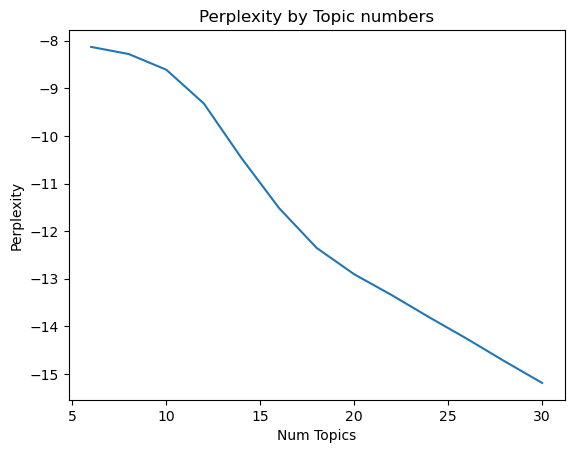

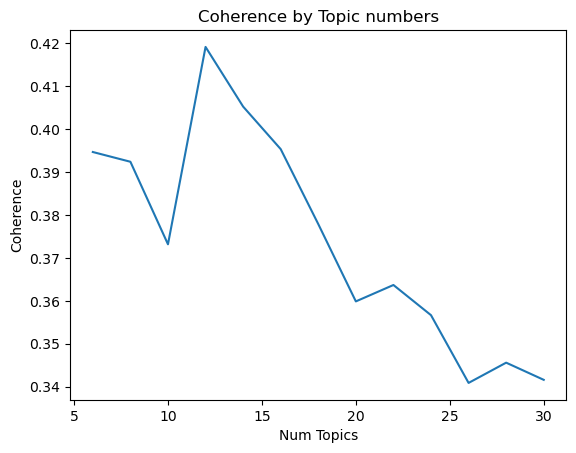

In [72]:
# select data for figure 3.1 in Projektarbeit
results_only_topics = model_results_df[(model_results_df['Alpha'] == 'symmetric') & (model_results_df['Eta'] == 'symmetric')]

# plot perplexity chart
plt.plot(results_only_topics['Topic_no'], results_only_topics['Perplexity'])
plt.title('Perplexity by Topic numbers')
plt.xlabel('Num Topics')
plt.ylabel('Perplexity')
plt.show()

# plot coherence chart
plt.plot(results_only_topics['Topic_no'], results_only_topics['Coherence'])
plt.title('Coherence by Topic numbers')
plt.xlabel('Num Topics')
plt.ylabel('Coherence')
plt.show()


In [76]:
# sort dataframe by highest coherence
results_by_coh = model_results_df.sort_values(by=['Coherence'], ascending=False)
results_by_coh.head(10) # show top 10

,Topic_Model,Topic_no,Alpha,Eta,Coherence,Perplexity
4,"LdaModel(num_terms=130691, num_topics=6, decay=0.5, chunksize=2000)",6,auto,symmetric,0.429972,-8.123786
5,"LdaModel(num_terms=130691, num_topics=6, decay=0.5, chunksize=2000)",6,auto,auto,0.429972,-8.111350
19,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,symmetric,auto,0.419171,-9.312669
18,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,symmetric,symmetric,0.419171,-9.321122
21,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,asymmetric,auto,0.416774,-9.336374
20,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,asymmetric,symmetric,0.416774,-9.344840
23,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,auto,auto,0.414175,-9.295155
22,"LdaModel(num_terms=130691, num_topics=12, decay=0.5, chunksize=2000)",12,auto,symmetric,0.414175,-9.303522
2,"LdaModel(num_terms=130691, num_topics=6, decay=0.5, chunksize=2000)",6,asymmetric,symmetric,0.406604,-8.123144
3,"LdaModel(num_terms=130691, num_topics=6, decay=0.5, chunksize=2000)",6,asymmetric,auto,0.406604,-8.110320


## Train model with optimized parameters

In [ ]:
lda_optimized = LdaModel(corpus=corpus,
                     id2word=dictionary,
                     num_topics=12,
                     alpha='symmetric',
                     eta='symmetric',
                     )

In [203]:
#saving model to disk for data loss prevention
# enable if necessary
#temp_file = datapath("C:/YOURPATH")
#lda_optimized.save(temp_file)

In [ ]:
#loading model from disk
# enable if necessary
#lda_optimized = models.ldamodel.LdaModel.load(temp_file)
#pprint(lda_optimized.print_topics())

In [207]:
#print optimized LDA topics
pprint(lda_optimized.print_topics())

2023-02-28 19:08:16,430 : INFO : topic #0 (0.083): 0.046*"earnings" + 0.023*"report" + 0.022*"growth" + 0.021*"year" + 0.020*"company" + 0.020*"azure" + 0.019*"business" + 0.017*"q" + 0.016*"revenue" + 0.016*"ai"
2023-02-28 19:08:16,433 : INFO : topic #1 (0.083): 0.034*"alert" + 0.027*"cap" + 0.025*"security" + 0.024*"windows" + 0.019*"pt" + 0.016*"insider" + 0.016*"infosec" + 0.015*"dowjones" + 0.015*"push" + 0.013*"netsec"
2023-02-28 19:08:16,434 : INFO : topic #2 (0.083): 0.165*"stock" + 0.044*"stockmarket" + 0.041*"news" + 0.038*"nasdaq" + 0.038*"holding" + 0.034*"stocks" + 0.031*"invest" + 0.030*"market" + 0.029*"money" + 0.018*"daytrading"
2023-02-28 19:08:16,435 : INFO : topic #3 (0.083): 0.082*"move" + 0.053*"volume" + 0.043*"profit" + 0.025*"bitcoin" + 0.022*"return" + 0.022*"average" + 0.020*"area" + 0.018*"blockchain" + 0.017*"odds" + 0.017*"partner"
2023-02-28 19:08:16,436 : INFO : topic #4 (0.083): 0.069*"amazon" + 0.026*"gain" + 0.024*"short" + 0.024*"corporation" + 0.022

[(0,
  '0.046*"earnings" + 0.023*"report" + 0.022*"growth" + 0.021*"year" + '
  '0.020*"company" + 0.020*"azure" + 0.019*"business" + 0.017*"q" + '
  '0.016*"revenue" + 0.016*"ai"'),
 (1,
  '0.034*"alert" + 0.027*"cap" + 0.025*"security" + 0.024*"windows" + '
  '0.019*"pt" + 0.016*"insider" + 0.016*"infosec" + 0.015*"dowjones" + '
  '0.015*"push" + 0.013*"netsec"'),
 (2,
  '0.165*"stock" + 0.044*"stockmarket" + 0.041*"news" + 0.038*"nasdaq" + '
  '0.038*"holding" + 0.034*"stocks" + 0.031*"invest" + 0.030*"market" + '
  '0.029*"money" + 0.018*"daytrading"'),
 (3,
  '0.082*"move" + 0.053*"volume" + 0.043*"profit" + 0.025*"bitcoin" + '
  '0.022*"return" + 0.022*"average" + 0.020*"area" + 0.018*"blockchain" + '
  '0.017*"odds" + 0.017*"partner"'),
 (4,
  '0.069*"amazon" + 0.026*"gain" + 0.024*"short" + 0.024*"corporation" + '
  '0.022*"contract" + 0.019*"trade" + 0.017*"market" + 0.017*"deal" + '
  '0.017*"post" + 0.015*"stocks"'),
 (5,
  '0.119*"trading" + 0.098*"option" + 0.070*"day" + 0

In [208]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_optimized, corpus, dictionary)
vis

C:\Users\Oliver\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11    -0.190866 -0.108318       1        1  12.398275
10    -0.269884 -0.065272       2        1  12.055680
8      0.190811 -0.159540       3        1  10.369705
0     -0.176487  0.000229       4        1  10.141814
2      0.203958 -0.241716       5        1   8.064320
4      0.025729 -0.181616       6        1   7.726060
9      0.210992  0.128060       7        1   7.639178
6      0.065193  0.161104       8        1   6.932581
7     -0.127532  0.103375       9        1   6.880841
5      0.003794  0.108763      10        1   6.629475
1     -0.020054  0.000842      11        1   6.361505
3      0.084344  0.254088      12        1   4.800567, topic_info=           Term          Freq         Total Category  logprob  loglift
41          get  71205.000000  71205.000000  Default  30.0000  30.0000
3675  microsoft  74976.000000  74976.000000  Default  29.0000  29.0000
45        stock  63110.000000  63110.000000  Default  28.0000  28.0000
29         make  36536.000000  36536.000000  Default  27.0000  27.0000
68      trading  26879.000000  26879.000000  Default  26.0000  26.0000
...         ...           ...           ...      ...      ...      ...
2408       spot    990.645972    991.902729  Topic12  -5.1043   3.0352
1991       fang    962.045378    963.302125  Topic12  -5.1336   3.0351
401        move  13344.825019  13410.603579  Topic12  -2.5038   3.0315
117        live   1249.313632   2097.722664  Topic12  -4.8723   2.5182
210       price   2417.016629  19535.658121  Topic12  -4.2124   0.9467

[522 rows x 6 columns], token_table=      Topic      Freq             Term
term                                  
487       2  0.999358              're
48        1  0.136638               's
48        2  0.623771               's
48        4  0.119596               's
48        5  0.000226               's
...     ...       ...              ...
123      11  0.012654             year
123      12  0.038717             year
391      10  0.999561  yearlydelivered
1430      7  0.999887        yesterday
7543      2  0.999087             zoom

[692 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[12, 11, 9, 1, 3, 5, 10, 7, 8, 6, 2, 4])

In [215]:
# assign topics to each tweet
doc_topics = lda_optimized[corpus] # get topic distribution

topic_assignments = [max(topics, key=lambda x: x[1])[0] for topics in doc_topics] # assign document by highest probability
td_assigned = td_cleaned.copy()
td_assigned['topic_no'] = topic_assignments

In [222]:
# rename topics to descriptive names
topic_mapping = {0: 'MS Azure Growth', 1: 'Security Alerts & Vulnerabilitiy Detection',
                2: 'Stock Market News', 3: 'Crypto & Blockchain Technology', 4: 'Amazon Stock Market Activity',
                5: 'Daily Stock Market Trading', 6: 'Cloud Technology News', 7: 'Financial Analysis',
                8: 'Microsoft Market Performance', 
                9: 'Finance Advertising', 10: 'Trading Strategies', 
                11: 'Microsoft Today'}
    
td_assigned['topic_name'] = td_assigned['topic_no'].replace(topic_mapping)

## Sentiment Analysis

In [231]:
sa_cleaned = tweets_main.drop(['tweet_id', 'ticker_symbol','company_name','writer',
                          'post_date','comment_num','retweet_num','like_num'], axis=1)
sa_cleaned = sa_cleaned.reset_index(drop=True) #reset index for better data handling

In [ ]:
# functions for sentiment analysis
def preprocessDataSA(tweet_text):
    tweet_text =re.sub(r'\bRT\b', '', tweet_text) #remove RT (Retweet)
    tweet_text = re.sub(r'http\S+', '', tweet_text) #remove URLS
    tweet_text = re.sub(r'@\w+\s?', '', tweet_text) #remove @username
    tweet_text = re.sub(r'#\w+', '', tweet_text) #remove hashtags
    tweet_text = re.sub(r'^#|#\'|\s#', 'number', tweet_text) #replace # with "number"
    return tweet_text

def get_sentiment_scores(text):
    scores = SentimentIntensityAnalyzer().polarity_scores(text) # analyze sentiment with VADER
    return scores


sa_cleaned['body'] = sa_cleaned['body'].apply(preprocessDataSA) # preprocessing (char removal)

sentiment_scores = []

for text in sa_cleaned['body']:
    sentiment_scores.append(get_sentiment_scores(text)) # for each tweet get sentiment score

sentiment_df = pd.DataFrame(list(sentiment_scores)) # sentiment score to dataframe


print(sentiment_df.head()) # check results

In [232]:
#concat tweets and sentiment scores in dataframe
sentiment_concat = pd.concat([sa_cleaned, sentiment_df], axis=1)
sentiment_concat

,body,neg,neu,pos,compound
0,"#In2019 I plan to mock the #TrumpTrain relentlessly. Also stupid people who believe uneducated Hannity, Jimmy Kimmel, Chuck Todd, Rush Limbaugh, & Charlie Kirk! When the time comes, I'll mock Jim Cramer, for his 2019 possibly $AAPL version of his Bear Sterns idiocy!",0.201,0.799,0.000,-0.8619
1,"How to upload photos into iCloud Photos from iPhone, iPad, Mac, and icloud․com http://dlvr.it/QvkJ7f $AAPL",0.000,1.000,0.000,0.0000
2,"$AAPL settled +1.0% at $157.74, and that made for a second black-fail candle, which leans s/t bearish, if only for the Wednesday open. Note the 50dma, will be around 174/76 gap zone next week.",0.000,1.000,0.000,0.0000
3,$AAPL is in Parabolic SAR Breakout winning 60.71% in the past. https://goo.gl/bfRDmd,0.000,0.746,0.254,0.5267
4,"Join @RobinhoodApp and we'll both get a stock like $AAPL, $F, or $S for free. Make sure to use my link.",0.000,0.608,0.392,0.8519
...,...,...,...,...,...
421000,$MSFT check the timestamp.... buy the dip and wait for the payoff. Easy cash. If you like my $MSFT calls follow closely as we head into 2020! I will be all over this one,0.000,0.849,0.151,0.6900
421001,Top increases in popularity for stocks held by Robinhood traders today:https://robintrack.net/popularity_changes?hoursAgo=24&relative=false&changeType=increases…1. $FCEL: +97272. $NIO: +30263. $ACB: +28425. $F: +11716. $MSFT: +7777. $LK: +7398. $NVCN: +7339. $AAPL: +66910. $MTNB: +589,0.000,0.846,0.154,0.5994
421002,"$AAPL $MSFT $JPM - Apple, Microsoft top Dow 2019 standings; Walgreens wobbles to the bottom",0.000,0.886,0.114,0.2023
421003,Notable activity on social media recently for$MSFT - Up$AMZN - Down$SPOT - Up$HES - Down$TSLA - Up$GPRO - Up$GM - Up$LMT - Up$ALL - Up$NWS - Up,0.000,1.000,0.000,0.0000


In [233]:
# calculate sentiment classifications
def replaceSentScores(score):
    if score >= 0.05:
        return 'positive'
    elif score <= -0.05:
        return 'negative'
    else:
        return 'neutral'


sentiment_concat['sentiment_score'] = sentiment_concat['compound'].apply(replaceSentScores)
sentiment_concat #check result

,body,neg,neu,pos,compound,sentiment_score
0,"#In2019 I plan to mock the #TrumpTrain relentlessly. Also stupid people who believe uneducated Hannity, Jimmy Kimmel, Chuck Todd, Rush Limbaugh, & Charlie Kirk! When the time comes, I'll mock Jim Cramer, for his 2019 possibly $AAPL version of his Bear Sterns idiocy!",0.201,0.799,0.000,-0.8619,negative
1,"How to upload photos into iCloud Photos from iPhone, iPad, Mac, and icloud․com http://dlvr.it/QvkJ7f $AAPL",0.000,1.000,0.000,0.0000,neutral
2,"$AAPL settled +1.0% at $157.74, and that made for a second black-fail candle, which leans s/t bearish, if only for the Wednesday open. Note the 50dma, will be around 174/76 gap zone next week.",0.000,1.000,0.000,0.0000,neutral
3,$AAPL is in Parabolic SAR Breakout winning 60.71% in the past. https://goo.gl/bfRDmd,0.000,0.746,0.254,0.5267,positive
4,"Join @RobinhoodApp and we'll both get a stock like $AAPL, $F, or $S for free. Make sure to use my link.",0.000,0.608,0.392,0.8519,positive
...,...,...,...,...,...,...
421000,$MSFT check the timestamp.... buy the dip and wait for the payoff. Easy cash. If you like my $MSFT calls follow closely as we head into 2020! I will be all over this one,0.000,0.849,0.151,0.6900,positive
421001,Top increases in popularity for stocks held by Robinhood traders today:https://robintrack.net/popularity_changes?hoursAgo=24&relative=false&changeType=increases…1. $FCEL: +97272. $NIO: +30263. $ACB: +28425. $F: +11716. $MSFT: +7777. $LK: +7398. $NVCN: +7339. $AAPL: +66910. $MTNB: +589,0.000,0.846,0.154,0.5994,positive
421002,"$AAPL $MSFT $JPM - Apple, Microsoft top Dow 2019 standings; Walgreens wobbles to the bottom",0.000,0.886,0.114,0.2023,positive
421003,Notable activity on social media recently for$MSFT - Up$AMZN - Down$SPOT - Up$HES - Down$TSLA - Up$GPRO - Up$GM - Up$LMT - Up$ALL - Up$NWS - Up,0.000,1.000,0.000,0.0000,neutral


In [46]:
# analyzing sentiment distribution over tweet dataset
sentiment_concat['sentiment_score'].value_counts()

positive    195766
neutral     155285
negative     69954
Name: sentiment_score, dtype: int64

## Combine Topic Detection and Sentiment Analysis

In [235]:
# put dominant topic per tweet and sentiment score in one dataframe
tweets_results = pd.concat([td_assigned['topic_name'], sentiment_concat['sentiment_score']], axis=1)
tweets_results # check results

,topic_name,sentiment_score
0,Microsoft Today,negative
1,Financial Analysis,neutral
2,Security Alerts & Vulnerabilitiy Detection,neutral
3,Daily Stock Market Trading,positive
4,Finance Advertising,positive
...,...,...
421000,Trading Strategies,positive
421001,Microsoft Today,positive
421002,Microsoft Market Performance,positive
421003,MS Azure Growth,neutral


In [236]:
# transform dataframe
# Group the data by topic and sentiment and count the number of occurrences
grouped_df = tweets_results.groupby(['topic_name', 'sentiment_score']).size().reset_index(name='count')

# Pivot the data to create a table with topics as rows, sentiments as columns, and counts as values
pivot = grouped_df.pivot(index='topic_name', columns='sentiment_score', values='count')

In [ ]:
# Plot bar chart with sentiments as bars and topics as x-axis labels
pivot.plot(kind='bar', stacked=False) # no stacked sentiment values
plt.title('Sentiment Distribution by Topic')
plt.xlabel('Topic')
plt.ylabel('Sentiment Count')
plt.show()